In [1]:
# [STAR] Getting all the files for the fashion segmentation task

import glob

files1 = glob.glob('/media/yu-hao/WindowsData/MMFASHION-DATASET/InshopClothRetrieval/img_highres/**/*.jpg', recursive = True)
files2 = glob.glob('/media/yu-hao/WindowsData/MMFASHION-DATASET/InshopClothRetrieval/img_highres/**/*.png', recursive = True)

print(len(files1))
print(len(files2))

h = {}
for k in files2:
    h[k] = 1

img_paths  = []
mask_paths = []

counter = 0
for k in files1:
    if k.replace('.jpg', '_segment.png') in h:
        if counter % 51 == 0:
            img_paths.append(k)
            mask_paths.append(k.replace('.jpg', '_segment.png'))
            #print(counter, k)
            #print(counter, k.replace('.jpg', '_segment.png'))
            #print('-------------------------------------')
        counter = counter +1
        


52712
13752


In [2]:
# [STAR] Dataset Class

import os
import numpy as np
import torch
import torch.utils.data
from PIL import Image


torch.autograd.set_detect_anomaly(True)

class PennFudanDataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        # load all image files, sorting them to
        # ensure that they are aligned
        self.num_classes = 16
        
        self.color_codes = {
            (0, 0, 0): 0,
            (255, 250, 250): 1,
            (250, 235, 215): 2,
            (70, 130, 180): 3,
            (16, 78, 139): 4,
            (255, 250, 205): 5,
            (255, 140, 0): 6,
            (50, 205, 50): 7,
            (220, 220, 220): 8,
            (255, 0, 0): 9,
            (127, 255, 212): 10,
            (0, 100, 0): 11,
            (255, 25, 0): 12,
            (211, 211, 211): 13,
            (144, 238, 144): 14,
            (245, 222, 179): 15
        }
        
        files1 = glob.glob('/media/yu-hao/WindowsData/MMFASHION-DATASET/InshopClothRetrieval/img_highres/**/*.jpg', recursive = True)
        files2 = glob.glob('/media/yu-hao/WindowsData/MMFASHION-DATASET/InshopClothRetrieval/img_highres/**/*.png', recursive = True)

        print(len(files1), len(files2))
        self.h = {}
        for k in files2:
            self.h[k] = 1

        self.imgs  = []
        self.masks = []

        counter = 0
        for k in files1:
            if k.replace('.jpg', '_segment.png') in self.h:
                if counter % 11 == 0:
                    self.imgs.append(k)
                    self.masks.append(k.replace('.jpg', '_segment.png'))
                    #print(counter, k)
                    #print(counter, k.replace('.jpg', '_segment.png'))
                    #print('-------------------------------------')
        print('Lengths are ', len(self.imgs), len(self.masks))
        #print(len(self.imgs), len(self.masks))
        #self.imgs  = list(sorted(os.listdir(os.path.join(root, "PNGImages"))))
        #self.masks = list(sorted(os.listdir(os.path.join(root, "PedMasks"))))

    def __getitem__(self, idx):
        # load images ad masks
        img_path  = self.imgs[idx]  #os.path.join(self.root, "PNGImages", self.imgs[idx])
        mask_path = self.masks[idx] #os.path.join(self.root, "PedMasks", self.masks[idx])
        img       = Image.open(img_path).convert("RGB")
        # note that we haven't converted the mask to RGB,
        # because each color corresponds to a different instance
        # with 0 being background
        mask = Image.open(mask_path)
        mask = np.array(mask)
        #print('mask shape is ', mask.shape)
        mask = mask[:, :, :3]
        
        valid_idx  = [1, 4, 9, 5, 13, 14, 15]
        class_idx  = {1:1, 4:2, 9:3, 5:4, 13:5, 14:6, 15:7}
        
        result            = np.ndarray(shape=mask.shape[:2], dtype=int)
        result[:,:]       = -1
        color_codes_array = list(self.color_codes.keys())
        #print('mask shape is ', mask.shape)
        #print(np.unique(mask[:, :, 0].flatten()), np.unique(mask[:, :, 1].flatten()), np.unique(mask[:, :, 2].flatten()))
        for rgb, idx in self.color_codes.items():
            #print(rgb, idx)
            #temp2 = np.all(temp1 == color_codes_array[index] , axis=-1)
            temp_mask = np.all(mask == color_codes_array[idx], axis=-1).astype('uint8')
            
            if idx in valid_idx and np.count_nonzero(temp_mask.flatten().astype('uint8')) > 100:
                #print(temp_mask.shape, np.unique(temp_mask.flatten()))
                result[temp_mask == 1] = class_idx[idx]
        
        result[result == -1] = 0
        obj_ids = list(np.unique(result.flatten()))
        
        if len(obj_ids) < 2:
            pass
        
        obj_ids = np.array(obj_ids)
        #obj_ids = obj_ids[1:]
        
        #print('obj_ids are ', obj_ids)
        # get bounding box coordinates for each mask
        num_objs = len(obj_ids)
        boxes    = []
        masks    = []
        
        for i in obj_ids:
            pos  = np.where(result == i)
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])
            masks.append((result == i).astype('uint8'))
        
        boxes  = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(obj_ids.flatten(), dtype=torch.int64)
        masks  = torch.as_tensor(masks, dtype=torch.uint8)
        
        
        #labels = torch.ones((num_objs,), dtype=torch.int64)
        
        
        
        image_id = torch.tensor([idx])
        #print('boxes shape is ', boxes.shape, mask_path)
        try:
            area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
            # suppose all instances are not crowd
            iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
            
            #temp1 = np.eye(self.num_classes, dtype='uint8')[result]
            #temp1 = np.moveaxis(temp1, -1, 0)
            #temp1 = temp1[0]
            
            target = {}
            target["boxes"]    = boxes
            target["labels"]   = labels
            target["masks"]    = torch.as_tensor(masks)
            target["image_id"] = image_id
            target["area"]     = area
            target["iscrowd"]  = iscrowd

            if self.transforms is not None:
                img, target = self.transforms(img, target)
            return img, target
        except:
            pass
        

    def __len__(self):
        return len(self.imgs)

In [3]:
# [STAR] use our dataset and defined transformations

from engine import train_one_epoch, evaluate
import utils
import transforms as T

import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor


valid_idx  = [0, 1, 4, 9, 5, 13, 14, 15]
accesories = [7, 8, 10]
not_needed = [2, 3, 11, 12, 6]

      
def get_instance_segmentation_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer     = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)

    return model

def get_transform(train):
    transforms = []
    # converts the image, a PIL image, into a PyTorch Tensor
    transforms.append(T.ToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)


dataset      = PennFudanDataset('PennFudanPed', get_transform(train=True))
dataset_test = PennFudanDataset('PennFudanPed', get_transform(train=False))

# split the dataset in train and test set
torch.manual_seed(1)
indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices)
dataset_test = torch.utils.data.Subset(dataset_test, indices)

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset, batch_size=1, shuffle=True, num_workers=1,
    collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=1,
    collate_fn=utils.collate_fn)

52712 13752
Lengths are  13752 13752
52712 13752
Lengths are  13752 13752


In [4]:
# [STAR] Model creation Code

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# our dataset has two classes only - background and person
num_classes = 8

# get the model using our helper function
model = get_instance_segmentation_model(num_classes)
# move model to the right device
model.to(device)

p1         = torch.load("fashion_segment5.pt")
model.load_state_dict(p1)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=0.000001, weight_decay=0.0005)

# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)

In [5]:
# [STAR] let's train it for 10 epochs
# fashion_segment4 model is good
# fashion_segment5 model is better

num_epochs = 10000
print_freq = 1
import math
import sys
import time

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    model.train()
    metric_logger = utils.MetricLogger(delimiter="  ")
    metric_logger.add_meter('lr', utils.SmoothedValue(window_size=1, fmt='{value:.6f}'))
    header = 'Epoch: [{}]'.format(epoch)
    
    #lr_scheduler = None
    if epoch == 0:
        warmup_factor = 1. / 1000
        warmup_iters = min(1000, len(data_loader) - 1)

    #lr_scheduler = utils.warmup_lr_scheduler(optimizer, warmup_iters, warmup_factor)
    
    total_steps  = 0
    #try:
    if(1):
        for images, targets in metric_logger.log_every(data_loader, print_freq, header):
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)

            losses = sum(loss for loss in loss_dict.values())

            # reduce losses over all GPUs for logging purposes
            loss_dict_reduced = utils.reduce_dict(loss_dict)
            #print('keys are ', loss_dict_reduced.keys())
            losses_reduced = sum(loss for loss in loss_dict_reduced.values())

            loss_value = losses_reduced.item()

            if not math.isfinite(loss_value):
                print("Loss is {}, stopping training".format(loss_value))
                print(loss_dict_reduced)
                #metric_logger.update(loss=losses_reduced, **loss_dict_reduced)
                #metric_logger.update(lr=optimizer.param_groups[0]["lr"])
                sys.exit(1)

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            #if lr_scheduler is not None:
            #    lr_scheduler.step()

            metric_logger.update(loss=losses_reduced, **loss_dict_reduced)
            metric_logger.update(lr=optimizer.param_groups[0]["lr"])
            #if total_steps > 10:
            #    break
            #else:
            total_steps = total_steps+1
            if total_steps %51 == 0:
                print('Saving  model ', epoch)
                torch.save(model.state_dict(), 'fashion_segment4.pt')
    #except:
    #    continue
    
    # update the learning rate
    #lr_scheduler.step()
    # evaluate on the test dataset
    #evaluate(model, data_loader_test, device=device)
    
    #if epoch%21 == 0:
    print('Saving  model ', epoch)
    torch.save(model.state_dict(), 'fashion_segment6.pt')

Epoch: [0]  [    0/13752]  eta: 4:07:09  lr: 0.000001  loss: 0.1937 (0.1937)  loss_classifier: 0.0687 (0.0687)  loss_mask: 0.1211 (0.1211)  loss_objectness: 0.0039 (0.0039)  time: 1.0783  data: 0.6641  max mem: 1461
Epoch: [0]  [    1/13752]  eta: 3:04:17  lr: 0.000001  loss: 0.1509 (0.1723)  loss_classifier: 0.0523 (0.0605)  loss_mask: 0.0982 (0.1097)  loss_objectness: 0.0003 (0.0021)  time: 0.8041  data: 0.4955  max mem: 1913
Epoch: [0]  [    2/13752]  eta: 2:48:00  lr: 0.000001  loss: 0.1509 (0.1577)  loss_classifier: 0.0523 (0.0552)  loss_mask: 0.0982 (0.1005)  loss_objectness: 0.0017 (0.0020)  time: 0.7331  data: 0.4523  max mem: 1994
Epoch: [0]  [    3/13752]  eta: 2:47:49  lr: 0.000001  loss: 0.1509 (0.1564)  loss_classifier: 0.0523 (0.0568)  loss_mask: 0.0907 (0.0981)  loss_objectness: 0.0003 (0.0016)  time: 0.7324  data: 0.4704  max mem: 1994
Epoch: [0]  [    4/13752]  eta: 2:40:19  lr: 0.000001  loss: 0.1509 (0.1539)  loss_classifier: 0.0614 (0.0577)  loss_mask: 0.0907 (0.094

Epoch: [0]  [   38/13752]  eta: 2:32:53  lr: 0.000001  loss: 0.1389 (0.1614)  loss_classifier: 0.0473 (0.0657)  loss_mask: 0.0860 (0.0927)  loss_objectness: 0.0011 (0.0030)  time: 0.6676  data: 0.4640  max mem: 2072
Epoch: [0]  [   39/13752]  eta: 2:33:10  lr: 0.000001  loss: 0.1389 (0.1605)  loss_classifier: 0.0493 (0.0653)  loss_mask: 0.0860 (0.0923)  loss_objectness: 0.0011 (0.0029)  time: 0.6747  data: 0.4708  max mem: 2072
Epoch: [0]  [   40/13752]  eta: 2:32:57  lr: 0.000001  loss: 0.1389 (0.1600)  loss_classifier: 0.0473 (0.0646)  loss_mask: 0.0860 (0.0926)  loss_objectness: 0.0011 (0.0029)  time: 0.6733  data: 0.4695  max mem: 2072
Epoch: [0]  [   41/13752]  eta: 2:33:10  lr: 0.000001  loss: 0.1389 (0.1645)  loss_classifier: 0.0473 (0.0642)  loss_mask: 0.0874 (0.0975)  loss_objectness: 0.0011 (0.0028)  time: 0.6715  data: 0.4680  max mem: 2072
Epoch: [0]  [   42/13752]  eta: 2:33:22  lr: 0.000001  loss: 0.1340 (0.1636)  loss_classifier: 0.0448 (0.0637)  loss_mask: 0.0842 (0.097

Epoch: [0]  [   76/13752]  eta: 2:28:04  lr: 0.000001  loss: 0.1363 (0.1626)  loss_classifier: 0.0458 (0.0633)  loss_mask: 0.0840 (0.0958)  loss_objectness: 0.0010 (0.0035)  time: 0.6184  data: 0.4129  max mem: 2072
Epoch: [0]  [   77/13752]  eta: 2:27:49  lr: 0.000001  loss: 0.1363 (0.1627)  loss_classifier: 0.0458 (0.0634)  loss_mask: 0.0841 (0.0959)  loss_objectness: 0.0010 (0.0034)  time: 0.6150  data: 0.4082  max mem: 2072
Epoch: [0]  [   78/13752]  eta: 2:27:32  lr: 0.000001  loss: 0.1367 (0.1624)  loss_classifier: 0.0471 (0.0632)  loss_mask: 0.0841 (0.0958)  loss_objectness: 0.0010 (0.0034)  time: 0.6138  data: 0.4061  max mem: 2072
Epoch: [0]  [   79/13752]  eta: 2:27:43  lr: 0.000001  loss: 0.1391 (0.1624)  loss_classifier: 0.0531 (0.0632)  loss_mask: 0.0842 (0.0958)  loss_objectness: 0.0010 (0.0034)  time: 0.6218  data: 0.4136  max mem: 2072
Epoch: [0]  [   80/13752]  eta: 2:27:52  lr: 0.000001  loss: 0.1395 (0.1622)  loss_classifier: 0.0531 (0.0630)  loss_mask: 0.0951 (0.095

Epoch: [0]  [  114/13752]  eta: 2:25:47  lr: 0.000001  loss: 0.1310 (0.1639)  loss_classifier: 0.0467 (0.0644)  loss_mask: 0.0903 (0.0963)  loss_objectness: 0.0012 (0.0032)  time: 0.6021  data: 0.3689  max mem: 2072
Epoch: [0]  [  115/13752]  eta: 2:25:37  lr: 0.000001  loss: 0.1328 (0.1643)  loss_classifier: 0.0541 (0.0649)  loss_mask: 0.0903 (0.0961)  loss_objectness: 0.0012 (0.0033)  time: 0.6060  data: 0.3722  max mem: 2072
Epoch: [0]  [  116/13752]  eta: 2:25:34  lr: 0.000001  loss: 0.1328 (0.1641)  loss_classifier: 0.0482 (0.0648)  loss_mask: 0.0903 (0.0960)  loss_objectness: 0.0012 (0.0034)  time: 0.6094  data: 0.3761  max mem: 2072
Epoch: [0]  [  117/13752]  eta: 2:24:59  lr: 0.000001  loss: 0.1328 (0.1638)  loss_classifier: 0.0482 (0.0646)  loss_mask: 0.0844 (0.0958)  loss_objectness: 0.0013 (0.0034)  time: 0.6009  data: 0.3679  max mem: 2072
Epoch: [0]  [  118/13752]  eta: 2:24:48  lr: 0.000001  loss: 0.1328 (0.1639)  loss_classifier: 0.0482 (0.0646)  loss_mask: 0.0844 (0.095

Saving  model  0
Epoch: [0]  [  152/13752]  eta: 2:23:40  lr: 0.000001  loss: 0.1515 (0.1637)  loss_classifier: 0.0512 (0.0636)  loss_mask: 0.0919 (0.0968)  loss_objectness: 0.0013 (0.0033)  time: 0.6482  data: 0.4063  max mem: 2072
Epoch: [0]  [  153/13752]  eta: 2:23:02  lr: 0.000001  loss: 0.1515 (0.1635)  loss_classifier: 0.0512 (0.0635)  loss_mask: 0.0890 (0.0967)  loss_objectness: 0.0013 (0.0033)  time: 0.6297  data: 0.3882  max mem: 2072
Epoch: [0]  [  154/13752]  eta: 2:22:48  lr: 0.000001  loss: 0.1515 (0.1636)  loss_classifier: 0.0512 (0.0637)  loss_mask: 0.0888 (0.0966)  loss_objectness: 0.0013 (0.0033)  time: 0.6269  data: 0.3855  max mem: 2072
Epoch: [0]  [  155/13752]  eta: 2:22:44  lr: 0.000001  loss: 0.1515 (0.1636)  loss_classifier: 0.0509 (0.0636)  loss_mask: 0.0890 (0.0967)  loss_objectness: 0.0013 (0.0033)  time: 0.6191  data: 0.3770  max mem: 2072
Epoch: [0]  [  156/13752]  eta: 2:22:38  lr: 0.000001  loss: 0.1515 (0.1632)  loss_classifier: 0.0509 (0.0634)  loss_ma

Epoch: [0]  [  190/13752]  eta: 2:22:31  lr: 0.000001  loss: 0.1501 (0.1640)  loss_classifier: 0.0485 (0.0628)  loss_mask: 0.0917 (0.0979)  loss_objectness: 0.0016 (0.0032)  time: 0.6451  data: 0.4298  max mem: 2072
Epoch: [0]  [  191/13752]  eta: 2:22:24  lr: 0.000001  loss: 0.1398 (0.1638)  loss_classifier: 0.0485 (0.0628)  loss_mask: 0.0914 (0.0978)  loss_objectness: 0.0016 (0.0032)  time: 0.6440  data: 0.4274  max mem: 2072
Epoch: [0]  [  192/13752]  eta: 2:22:31  lr: 0.000001  loss: 0.1398 (0.1644)  loss_classifier: 0.0522 (0.0630)  loss_mask: 0.0914 (0.0983)  loss_objectness: 0.0015 (0.0032)  time: 0.6451  data: 0.4280  max mem: 2072
Epoch: [0]  [  193/13752]  eta: 2:22:27  lr: 0.000001  loss: 0.1398 (0.1646)  loss_classifier: 0.0522 (0.0631)  loss_mask: 0.0914 (0.0984)  loss_objectness: 0.0014 (0.0032)  time: 0.6439  data: 0.4251  max mem: 2072
Epoch: [0]  [  194/13752]  eta: 2:22:35  lr: 0.000001  loss: 0.1360 (0.1643)  loss_classifier: 0.0485 (0.0629)  loss_mask: 0.0900 (0.098

Epoch: [0]  [  228/13752]  eta: 2:22:04  lr: 0.000001  loss: 0.1323 (0.1690)  loss_classifier: 0.0416 (0.0645)  loss_mask: 0.0821 (0.1008)  loss_objectness: 0.0011 (0.0038)  time: 0.6207  data: 0.4106  max mem: 2072
Epoch: [0]  [  229/13752]  eta: 2:22:13  lr: 0.000001  loss: 0.1323 (0.1692)  loss_classifier: 0.0416 (0.0645)  loss_mask: 0.0821 (0.1009)  loss_objectness: 0.0011 (0.0038)  time: 0.6331  data: 0.4215  max mem: 2072
Epoch: [0]  [  230/13752]  eta: 2:22:03  lr: 0.000001  loss: 0.1335 (0.1692)  loss_classifier: 0.0456 (0.0645)  loss_mask: 0.0912 (0.1010)  loss_objectness: 0.0011 (0.0038)  time: 0.6210  data: 0.4097  max mem: 2072
Epoch: [0]  [  231/13752]  eta: 2:21:55  lr: 0.000001  loss: 0.1335 (0.1700)  loss_classifier: 0.0456 (0.0646)  loss_mask: 0.0926 (0.1017)  loss_objectness: 0.0013 (0.0038)  time: 0.6110  data: 0.4000  max mem: 2072
Epoch: [0]  [  232/13752]  eta: 2:21:53  lr: 0.000001  loss: 0.1368 (0.1706)  loss_classifier: 0.0473 (0.0651)  loss_mask: 0.0931 (0.101

Epoch: [0]  [  266/13752]  eta: 2:21:10  lr: 0.000001  loss: 0.1590 (0.1718)  loss_classifier: 0.0563 (0.0664)  loss_mask: 0.0845 (0.1016)  loss_objectness: 0.0009 (0.0037)  time: 0.6188  data: 0.3764  max mem: 2072
Epoch: [0]  [  267/13752]  eta: 2:21:17  lr: 0.000001  loss: 0.1472 (0.1715)  loss_classifier: 0.0532 (0.0663)  loss_mask: 0.0840 (0.1015)  loss_objectness: 0.0009 (0.0037)  time: 0.6303  data: 0.3883  max mem: 2072
Epoch: [0]  [  268/13752]  eta: 2:21:13  lr: 0.000001  loss: 0.1472 (0.1723)  loss_classifier: 0.0532 (0.0670)  loss_mask: 0.0845 (0.1015)  loss_objectness: 0.0009 (0.0038)  time: 0.6313  data: 0.3884  max mem: 2072
Epoch: [0]  [  269/13752]  eta: 2:21:06  lr: 0.000001  loss: 0.1472 (0.1722)  loss_classifier: 0.0532 (0.0669)  loss_mask: 0.0874 (0.1014)  loss_objectness: 0.0008 (0.0038)  time: 0.6281  data: 0.3851  max mem: 2072
Epoch: [0]  [  270/13752]  eta: 2:21:11  lr: 0.000001  loss: 0.1346 (0.1719)  loss_classifier: 0.0483 (0.0668)  loss_mask: 0.0874 (0.101

Epoch: [0]  [  304/13752]  eta: 2:21:04  lr: 0.000001  loss: 0.1347 (0.1697)  loss_classifier: 0.0429 (0.0658)  loss_mask: 0.0885 (0.1000)  loss_objectness: 0.0013 (0.0039)  time: 0.6300  data: 0.4134  max mem: 2072
Saving  model  0
Epoch: [0]  [  305/13752]  eta: 2:21:41  lr: 0.000001  loss: 0.1347 (0.1697)  loss_classifier: 0.0429 (0.0658)  loss_mask: 0.0903 (0.1000)  loss_objectness: 0.0009 (0.0039)  time: 0.6669  data: 0.4125  max mem: 2072
Epoch: [0]  [  306/13752]  eta: 2:21:26  lr: 0.000001  loss: 0.1341 (0.1695)  loss_classifier: 0.0429 (0.0657)  loss_mask: 0.0903 (0.0999)  loss_objectness: 0.0009 (0.0039)  time: 0.6541  data: 0.3997  max mem: 2072
Epoch: [0]  [  307/13752]  eta: 2:21:06  lr: 0.000001  loss: 0.1327 (0.1694)  loss_classifier: 0.0429 (0.0657)  loss_mask: 0.0885 (0.0999)  loss_objectness: 0.0009 (0.0039)  time: 0.6391  data: 0.3846  max mem: 2072
Epoch: [0]  [  308/13752]  eta: 2:20:54  lr: 0.000001  loss: 0.1341 (0.1693)  loss_classifier: 0.0429 (0.0656)  loss_ma

Epoch: [0]  [  342/13752]  eta: 2:20:45  lr: 0.000001  loss: 0.1438 (0.1671)  loss_classifier: 0.0591 (0.0650)  loss_mask: 0.0802 (0.0983)  loss_objectness: 0.0023 (0.0038)  time: 0.6456  data: 0.4305  max mem: 2072
Epoch: [0]  [  343/13752]  eta: 2:20:46  lr: 0.000001  loss: 0.1468 (0.1672)  loss_classifier: 0.0689 (0.0652)  loss_mask: 0.0802 (0.0982)  loss_objectness: 0.0019 (0.0038)  time: 0.6456  data: 0.4299  max mem: 2072
Epoch: [0]  [  344/13752]  eta: 2:20:49  lr: 0.000001  loss: 0.1534 (0.1676)  loss_classifier: 0.0735 (0.0654)  loss_mask: 0.0842 (0.0985)  loss_objectness: 0.0023 (0.0038)  time: 0.6454  data: 0.4295  max mem: 2072
Epoch: [0]  [  345/13752]  eta: 2:20:45  lr: 0.000001  loss: 0.1534 (0.1676)  loss_classifier: 0.0735 (0.0653)  loss_mask: 0.0849 (0.0985)  loss_objectness: 0.0023 (0.0038)  time: 0.6363  data: 0.4209  max mem: 2072
Epoch: [0]  [  346/13752]  eta: 2:20:48  lr: 0.000001  loss: 0.1535 (0.1676)  loss_classifier: 0.0761 (0.0654)  loss_mask: 0.0849 (0.098

Epoch: [0]  [  380/13752]  eta: 2:20:06  lr: 0.000001  loss: 0.1326 (0.1663)  loss_classifier: 0.0567 (0.0644)  loss_mask: 0.0870 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6053  data: 0.4003  max mem: 2072
Epoch: [0]  [  381/13752]  eta: 2:20:08  lr: 0.000001  loss: 0.1326 (0.1664)  loss_classifier: 0.0567 (0.0644)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6131  data: 0.4078  max mem: 2072
Epoch: [0]  [  382/13752]  eta: 2:20:04  lr: 0.000001  loss: 0.1326 (0.1662)  loss_classifier: 0.0567 (0.0643)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6127  data: 0.4075  max mem: 2072
Epoch: [0]  [  383/13752]  eta: 2:20:07  lr: 0.000001  loss: 0.1421 (0.1661)  loss_classifier: 0.0567 (0.0643)  loss_mask: 0.0893 (0.0978)  loss_objectness: 0.0013 (0.0040)  time: 0.6132  data: 0.4081  max mem: 2072
Epoch: [0]  [  384/13752]  eta: 2:20:03  lr: 0.000001  loss: 0.1421 (0.1660)  loss_classifier: 0.0567 (0.0642)  loss_mask: 0.0893 (0.097

Epoch: [0]  [  418/13752]  eta: 2:19:29  lr: 0.000001  loss: 0.1460 (0.1691)  loss_classifier: 0.0522 (0.0644)  loss_mask: 0.0927 (0.1008)  loss_objectness: 0.0010 (0.0039)  time: 0.6199  data: 0.3822  max mem: 2072
Epoch: [0]  [  419/13752]  eta: 2:19:26  lr: 0.000001  loss: 0.1423 (0.1690)  loss_classifier: 0.0502 (0.0643)  loss_mask: 0.0927 (0.1007)  loss_objectness: 0.0007 (0.0039)  time: 0.6231  data: 0.3849  max mem: 2072
Epoch: [0]  [  420/13752]  eta: 2:19:22  lr: 0.000001  loss: 0.1423 (0.1690)  loss_classifier: 0.0502 (0.0643)  loss_mask: 0.0931 (0.1008)  loss_objectness: 0.0005 (0.0039)  time: 0.6131  data: 0.3751  max mem: 2072
Epoch: [0]  [  421/13752]  eta: 2:19:22  lr: 0.000001  loss: 0.1423 (0.1689)  loss_classifier: 0.0466 (0.0642)  loss_mask: 0.0931 (0.1007)  loss_objectness: 0.0005 (0.0039)  time: 0.6109  data: 0.3730  max mem: 2072
Epoch: [0]  [  422/13752]  eta: 2:19:19  lr: 0.000001  loss: 0.1423 (0.1689)  loss_classifier: 0.0466 (0.0642)  loss_mask: 0.0931 (0.100

Epoch: [0]  [  456/13752]  eta: 2:18:44  lr: 0.000001  loss: 0.1391 (0.1683)  loss_classifier: 0.0451 (0.0642)  loss_mask: 0.0883 (0.1004)  loss_objectness: 0.0007 (0.0038)  time: 0.6086  data: 0.4021  max mem: 2072
Epoch: [0]  [  457/13752]  eta: 2:18:41  lr: 0.000001  loss: 0.1406 (0.1683)  loss_classifier: 0.0480 (0.0642)  loss_mask: 0.0925 (0.1004)  loss_objectness: 0.0007 (0.0038)  time: 0.6106  data: 0.4040  max mem: 2072
Saving  model  0
Epoch: [0]  [  458/13752]  eta: 2:18:53  lr: 0.000001  loss: 0.1406 (0.1682)  loss_classifier: 0.0480 (0.0641)  loss_mask: 0.0925 (0.1003)  loss_objectness: 0.0007 (0.0038)  time: 0.6362  data: 0.4037  max mem: 2072
Epoch: [0]  [  459/13752]  eta: 2:18:41  lr: 0.000001  loss: 0.1484 (0.1682)  loss_classifier: 0.0480 (0.0641)  loss_mask: 0.0925 (0.1003)  loss_objectness: 0.0007 (0.0037)  time: 0.6099  data: 0.3782  max mem: 2072
Epoch: [0]  [  460/13752]  eta: 2:18:40  lr: 0.000001  loss: 0.1406 (0.1681)  loss_classifier: 0.0451 (0.0640)  loss_ma

Epoch: [0]  [  494/13752]  eta: 2:18:47  lr: 0.000001  loss: 0.1384 (0.1675)  loss_classifier: 0.0517 (0.0640)  loss_mask: 0.0887 (0.0994)  loss_objectness: 0.0014 (0.0042)  time: 0.6515  data: 0.4487  max mem: 2072
Epoch: [0]  [  495/13752]  eta: 2:18:46  lr: 0.000001  loss: 0.1308 (0.1674)  loss_classifier: 0.0492 (0.0639)  loss_mask: 0.0840 (0.0993)  loss_objectness: 0.0015 (0.0042)  time: 0.6448  data: 0.4424  max mem: 2072
Epoch: [0]  [  496/13752]  eta: 2:18:44  lr: 0.000001  loss: 0.1300 (0.1673)  loss_classifier: 0.0495 (0.0639)  loss_mask: 0.0827 (0.0993)  loss_objectness: 0.0014 (0.0042)  time: 0.6397  data: 0.4370  max mem: 2072
Epoch: [0]  [  497/13752]  eta: 2:18:40  lr: 0.000001  loss: 0.1272 (0.1672)  loss_classifier: 0.0492 (0.0638)  loss_mask: 0.0806 (0.0992)  loss_objectness: 0.0010 (0.0041)  time: 0.6292  data: 0.4269  max mem: 2072
Epoch: [0]  [  498/13752]  eta: 2:18:43  lr: 0.000001  loss: 0.1296 (0.1671)  loss_classifier: 0.0495 (0.0638)  loss_mask: 0.0806 (0.099

Epoch: [0]  [  532/13752]  eta: 2:18:34  lr: 0.000001  loss: 0.1418 (0.1662)  loss_classifier: 0.0540 (0.0635)  loss_mask: 0.0913 (0.0985)  loss_objectness: 0.0012 (0.0042)  time: 0.6483  data: 0.4349  max mem: 2072
Epoch: [0]  [  533/13752]  eta: 2:18:37  lr: 0.000001  loss: 0.1386 (0.1661)  loss_classifier: 0.0401 (0.0634)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0012 (0.0042)  time: 0.6521  data: 0.4375  max mem: 2072
Epoch: [0]  [  534/13752]  eta: 2:18:41  lr: 0.000001  loss: 0.1386 (0.1660)  loss_classifier: 0.0401 (0.0634)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6576  data: 0.4404  max mem: 2072
Epoch: [0]  [  535/13752]  eta: 2:18:44  lr: 0.000001  loss: 0.1418 (0.1661)  loss_classifier: 0.0540 (0.0634)  loss_mask: 0.0913 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6658  data: 0.4476  max mem: 2072
Epoch: [0]  [  536/13752]  eta: 2:18:42  lr: 0.000001  loss: 0.1538 (0.1664)  loss_classifier: 0.0569 (0.0634)  loss_mask: 0.0928 (0.098

Epoch: [0]  [  570/13752]  eta: 2:18:50  lr: 0.000001  loss: 0.1499 (0.1673)  loss_classifier: 0.0557 (0.0641)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0008 (0.0044)  time: 0.6791  data: 0.3994  max mem: 2072
Epoch: [0]  [  571/13752]  eta: 2:18:53  lr: 0.000001  loss: 0.1524 (0.1673)  loss_classifier: 0.0603 (0.0641)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0007 (0.0044)  time: 0.6802  data: 0.4005  max mem: 2072
Epoch: [0]  [  572/13752]  eta: 2:18:56  lr: 0.000001  loss: 0.1524 (0.1673)  loss_classifier: 0.0611 (0.0641)  loss_mask: 0.0850 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.6828  data: 0.4012  max mem: 2072
Epoch: [0]  [  573/13752]  eta: 2:18:59  lr: 0.000001  loss: 0.1499 (0.1672)  loss_classifier: 0.0611 (0.0641)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.6913  data: 0.4093  max mem: 2072
Epoch: [0]  [  574/13752]  eta: 2:18:57  lr: 0.000001  loss: 0.1499 (0.1671)  loss_classifier: 0.0611 (0.0641)  loss_mask: 0.0849 (0.098

Epoch: [0]  [  608/13752]  eta: 2:18:26  lr: 0.000001  loss: 0.1532 (0.1672)  loss_classifier: 0.0462 (0.0637)  loss_mask: 0.1012 (0.0991)  loss_objectness: 0.0022 (0.0044)  time: 0.6115  data: 0.4086  max mem: 2072
Epoch: [0]  [  609/13752]  eta: 2:18:22  lr: 0.000001  loss: 0.1532 (0.1671)  loss_classifier: 0.0462 (0.0636)  loss_mask: 0.1014 (0.0991)  loss_objectness: 0.0022 (0.0044)  time: 0.6091  data: 0.4064  max mem: 2072
Epoch: [0]  [  610/13752]  eta: 2:18:23  lr: 0.000001  loss: 0.1510 (0.1671)  loss_classifier: 0.0439 (0.0636)  loss_mask: 0.1012 (0.0991)  loss_objectness: 0.0018 (0.0044)  time: 0.6176  data: 0.4146  max mem: 2072
Saving  model  0
Epoch: [0]  [  611/13752]  eta: 2:18:33  lr: 0.000001  loss: 0.1532 (0.1671)  loss_classifier: 0.0462 (0.0636)  loss_mask: 0.1014 (0.0992)  loss_objectness: 0.0018 (0.0044)  time: 0.6364  data: 0.4063  max mem: 2072
Epoch: [0]  [  612/13752]  eta: 2:18:23  lr: 0.000001  loss: 0.1510 (0.1670)  loss_classifier: 0.0443 (0.0635)  loss_ma

Epoch: [0]  [  646/13752]  eta: 2:17:59  lr: 0.000001  loss: 0.1336 (0.1666)  loss_classifier: 0.0455 (0.0637)  loss_mask: 0.0851 (0.0985)  loss_objectness: 0.0012 (0.0044)  time: 0.6322  data: 0.4279  max mem: 2072
Epoch: [0]  [  647/13752]  eta: 2:18:00  lr: 0.000001  loss: 0.1336 (0.1668)  loss_classifier: 0.0455 (0.0637)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0014 (0.0044)  time: 0.6321  data: 0.4276  max mem: 2072
Epoch: [0]  [  648/13752]  eta: 2:17:58  lr: 0.000001  loss: 0.1336 (0.1668)  loss_classifier: 0.0455 (0.0637)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0012 (0.0044)  time: 0.6322  data: 0.4272  max mem: 2072
Epoch: [0]  [  649/13752]  eta: 2:17:57  lr: 0.000001  loss: 0.1454 (0.1668)  loss_classifier: 0.0481 (0.0637)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0012 (0.0044)  time: 0.6263  data: 0.4212  max mem: 2072
Epoch: [0]  [  650/13752]  eta: 2:17:57  lr: 0.000001  loss: 0.1454 (0.1667)  loss_classifier: 0.0481 (0.0637)  loss_mask: 0.0858 (0.098

Epoch: [0]  [  684/13752]  eta: 2:17:24  lr: 0.000001  loss: 0.1530 (0.1672)  loss_classifier: 0.0538 (0.0637)  loss_mask: 0.0857 (0.0990)  loss_objectness: 0.0014 (0.0044)  time: 0.6266  data: 0.4236  max mem: 2072
Epoch: [0]  [  685/13752]  eta: 2:17:25  lr: 0.000001  loss: 0.1543 (0.1672)  loss_classifier: 0.0538 (0.0637)  loss_mask: 0.0891 (0.0990)  loss_objectness: 0.0014 (0.0045)  time: 0.6494  data: 0.4461  max mem: 2072
Epoch: [0]  [  686/13752]  eta: 2:17:23  lr: 0.000001  loss: 0.1543 (0.1672)  loss_classifier: 0.0538 (0.0637)  loss_mask: 0.0891 (0.0990)  loss_objectness: 0.0014 (0.0045)  time: 0.6490  data: 0.4459  max mem: 2072
Epoch: [0]  [  687/13752]  eta: 2:17:20  lr: 0.000001  loss: 0.1543 (0.1671)  loss_classifier: 0.0538 (0.0636)  loss_mask: 0.0916 (0.0990)  loss_objectness: 0.0014 (0.0045)  time: 0.6398  data: 0.4369  max mem: 2072
Epoch: [0]  [  688/13752]  eta: 2:17:21  lr: 0.000001  loss: 0.1530 (0.1670)  loss_classifier: 0.0507 (0.0636)  loss_mask: 0.0916 (0.099

Epoch: [0]  [  722/13752]  eta: 2:16:53  lr: 0.000001  loss: 0.1435 (0.1672)  loss_classifier: 0.0513 (0.0635)  loss_mask: 0.0832 (0.0991)  loss_objectness: 0.0011 (0.0045)  time: 0.6202  data: 0.3831  max mem: 2072
Epoch: [0]  [  723/13752]  eta: 2:16:54  lr: 0.000001  loss: 0.1480 (0.1672)  loss_classifier: 0.0544 (0.0636)  loss_mask: 0.0832 (0.0991)  loss_objectness: 0.0011 (0.0045)  time: 0.6203  data: 0.3830  max mem: 2072
Epoch: [0]  [  724/13752]  eta: 2:16:56  lr: 0.000001  loss: 0.1480 (0.1671)  loss_classifier: 0.0544 (0.0635)  loss_mask: 0.0838 (0.0991)  loss_objectness: 0.0011 (0.0045)  time: 0.6321  data: 0.3943  max mem: 2072
Epoch: [0]  [  725/13752]  eta: 2:16:53  lr: 0.000001  loss: 0.1480 (0.1671)  loss_classifier: 0.0544 (0.0635)  loss_mask: 0.0838 (0.0991)  loss_objectness: 0.0011 (0.0045)  time: 0.6233  data: 0.3853  max mem: 2072
Epoch: [0]  [  726/13752]  eta: 2:16:51  lr: 0.000001  loss: 0.1480 (0.1672)  loss_classifier: 0.0544 (0.0637)  loss_mask: 0.0832 (0.099

Epoch: [0]  [  760/13752]  eta: 2:16:31  lr: 0.000001  loss: 0.1537 (0.1688)  loss_classifier: 0.0457 (0.0643)  loss_mask: 0.0957 (0.0996)  loss_objectness: 0.0014 (0.0049)  time: 0.6249  data: 0.4212  max mem: 2072
Epoch: [0]  [  761/13752]  eta: 2:16:32  lr: 0.000001  loss: 0.1395 (0.1687)  loss_classifier: 0.0457 (0.0643)  loss_mask: 0.0929 (0.0996)  loss_objectness: 0.0013 (0.0049)  time: 0.6331  data: 0.4292  max mem: 2072
Epoch: [0]  [  762/13752]  eta: 2:16:30  lr: 0.000001  loss: 0.1537 (0.1687)  loss_classifier: 0.0520 (0.0643)  loss_mask: 0.0929 (0.0996)  loss_objectness: 0.0013 (0.0049)  time: 0.6364  data: 0.4325  max mem: 2072
Epoch: [0]  [  763/13752]  eta: 2:16:28  lr: 0.000001  loss: 0.1537 (0.1687)  loss_classifier: 0.0520 (0.0643)  loss_mask: 0.0929 (0.0995)  loss_objectness: 0.0013 (0.0049)  time: 0.6289  data: 0.4246  max mem: 2072
Saving  model  0
Epoch: [0]  [  764/13752]  eta: 2:16:39  lr: 0.000001  loss: 0.1546 (0.1686)  loss_classifier: 0.0586 (0.0643)  loss_ma

Epoch: [0]  [  798/13752]  eta: 2:15:56  lr: 0.000001  loss: 0.1386 (0.1681)  loss_classifier: 0.0540 (0.0643)  loss_mask: 0.0813 (0.0990)  loss_objectness: 0.0004 (0.0048)  time: 0.6111  data: 0.4084  max mem: 2072
Epoch: [0]  [  799/13752]  eta: 2:15:55  lr: 0.000001  loss: 0.1386 (0.1681)  loss_classifier: 0.0540 (0.0642)  loss_mask: 0.0823 (0.0991)  loss_objectness: 0.0004 (0.0048)  time: 0.6162  data: 0.4140  max mem: 2072
Epoch: [0]  [  800/13752]  eta: 2:15:53  lr: 0.000001  loss: 0.1350 (0.1680)  loss_classifier: 0.0461 (0.0642)  loss_mask: 0.0823 (0.0990)  loss_objectness: 0.0004 (0.0048)  time: 0.6164  data: 0.4144  max mem: 2072
Epoch: [0]  [  801/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1322 (0.1680)  loss_classifier: 0.0440 (0.0642)  loss_mask: 0.0823 (0.0990)  loss_objectness: 0.0004 (0.0048)  time: 0.6127  data: 0.4108  max mem: 2072
Epoch: [0]  [  802/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1293 (0.1679)  loss_classifier: 0.0437 (0.0641)  loss_mask: 0.0823 (0.099

Epoch: [0]  [  836/13752]  eta: 2:15:15  lr: 0.000001  loss: 0.1509 (0.1686)  loss_classifier: 0.0609 (0.0644)  loss_mask: 0.0929 (0.0996)  loss_objectness: 0.0004 (0.0047)  time: 0.5705  data: 0.3677  max mem: 2072
Epoch: [0]  [  837/13752]  eta: 2:15:13  lr: 0.000001  loss: 0.1509 (0.1688)  loss_classifier: 0.0609 (0.0645)  loss_mask: 0.0880 (0.0996)  loss_objectness: 0.0004 (0.0047)  time: 0.5821  data: 0.3793  max mem: 2072
Epoch: [0]  [  838/13752]  eta: 2:15:15  lr: 0.000001  loss: 0.1509 (0.1688)  loss_classifier: 0.0609 (0.0645)  loss_mask: 0.0880 (0.0996)  loss_objectness: 0.0004 (0.0047)  time: 0.5938  data: 0.3908  max mem: 2072
Epoch: [0]  [  839/13752]  eta: 2:15:16  lr: 0.000001  loss: 0.1509 (0.1687)  loss_classifier: 0.0609 (0.0645)  loss_mask: 0.0880 (0.0995)  loss_objectness: 0.0004 (0.0047)  time: 0.6025  data: 0.3993  max mem: 2072
Epoch: [0]  [  840/13752]  eta: 2:15:13  lr: 0.000001  loss: 0.1471 (0.1687)  loss_classifier: 0.0578 (0.0645)  loss_mask: 0.0869 (0.099

Epoch: [0]  [  874/13752]  eta: 2:14:34  lr: 0.000001  loss: 0.1543 (0.1690)  loss_classifier: 0.0540 (0.0647)  loss_mask: 0.0947 (0.0997)  loss_objectness: 0.0006 (0.0046)  time: 0.5976  data: 0.3644  max mem: 2072
Epoch: [0]  [  875/13752]  eta: 2:14:32  lr: 0.000001  loss: 0.1698 (0.1690)  loss_classifier: 0.0545 (0.0647)  loss_mask: 0.0947 (0.0997)  loss_objectness: 0.0006 (0.0046)  time: 0.5895  data: 0.3564  max mem: 2072
Epoch: [0]  [  876/13752]  eta: 2:14:30  lr: 0.000001  loss: 0.1698 (0.1689)  loss_classifier: 0.0545 (0.0647)  loss_mask: 0.0919 (0.0996)  loss_objectness: 0.0006 (0.0046)  time: 0.5814  data: 0.3483  max mem: 2072
Epoch: [0]  [  877/13752]  eta: 2:14:29  lr: 0.000001  loss: 0.1543 (0.1689)  loss_classifier: 0.0540 (0.0647)  loss_mask: 0.0909 (0.0996)  loss_objectness: 0.0005 (0.0046)  time: 0.5817  data: 0.3485  max mem: 2072
Epoch: [0]  [  878/13752]  eta: 2:14:27  lr: 0.000001  loss: 0.1543 (0.1688)  loss_classifier: 0.0545 (0.0647)  loss_mask: 0.0896 (0.099

Epoch: [0]  [  912/13752]  eta: 2:14:01  lr: 0.000001  loss: 0.1224 (0.1691)  loss_classifier: 0.0417 (0.0649)  loss_mask: 0.0793 (0.0994)  loss_objectness: 0.0006 (0.0047)  time: 0.6123  data: 0.4094  max mem: 2072
Epoch: [0]  [  913/13752]  eta: 2:14:01  lr: 0.000001  loss: 0.1224 (0.1691)  loss_classifier: 0.0414 (0.0649)  loss_mask: 0.0835 (0.0994)  loss_objectness: 0.0006 (0.0047)  time: 0.6084  data: 0.4057  max mem: 2072
Epoch: [0]  [  914/13752]  eta: 2:13:59  lr: 0.000001  loss: 0.1227 (0.1690)  loss_classifier: 0.0417 (0.0649)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0006 (0.0047)  time: 0.6112  data: 0.4086  max mem: 2072
Epoch: [0]  [  915/13752]  eta: 2:14:00  lr: 0.000001  loss: 0.1244 (0.1692)  loss_classifier: 0.0417 (0.0650)  loss_mask: 0.0859 (0.0994)  loss_objectness: 0.0006 (0.0047)  time: 0.6229  data: 0.4200  max mem: 2072
Epoch: [0]  [  916/13752]  eta: 2:13:59  lr: 0.000001  loss: 0.1244 (0.1692)  loss_classifier: 0.0417 (0.0650)  loss_mask: 0.0859 (0.099

Epoch: [0]  [  950/13752]  eta: 2:13:27  lr: 0.000001  loss: 0.1394 (0.1689)  loss_classifier: 0.0449 (0.0648)  loss_mask: 0.0889 (0.0993)  loss_objectness: 0.0007 (0.0047)  time: 0.5986  data: 0.3955  max mem: 2072
Epoch: [0]  [  951/13752]  eta: 2:13:25  lr: 0.000001  loss: 0.1394 (0.1688)  loss_classifier: 0.0462 (0.0648)  loss_mask: 0.0854 (0.0993)  loss_objectness: 0.0007 (0.0047)  time: 0.5949  data: 0.3913  max mem: 2072
Epoch: [0]  [  952/13752]  eta: 2:13:25  lr: 0.000001  loss: 0.1394 (0.1688)  loss_classifier: 0.0482 (0.0648)  loss_mask: 0.0854 (0.0993)  loss_objectness: 0.0005 (0.0047)  time: 0.5944  data: 0.3911  max mem: 2072
Epoch: [0]  [  953/13752]  eta: 2:13:25  lr: 0.000001  loss: 0.1402 (0.1688)  loss_classifier: 0.0482 (0.0648)  loss_mask: 0.0889 (0.0993)  loss_objectness: 0.0005 (0.0047)  time: 0.5909  data: 0.3881  max mem: 2072
Epoch: [0]  [  954/13752]  eta: 2:13:23  lr: 0.000001  loss: 0.1402 (0.1688)  loss_classifier: 0.0482 (0.0648)  loss_mask: 0.0889 (0.099

Epoch: [0]  [  988/13752]  eta: 2:12:51  lr: 0.000001  loss: 0.1322 (0.1683)  loss_classifier: 0.0473 (0.0643)  loss_mask: 0.0870 (0.0991)  loss_objectness: 0.0009 (0.0050)  time: 0.5868  data: 0.3839  max mem: 2072
Epoch: [0]  [  989/13752]  eta: 2:12:50  lr: 0.000001  loss: 0.1322 (0.1682)  loss_classifier: 0.0473 (0.0642)  loss_mask: 0.0870 (0.0990)  loss_objectness: 0.0006 (0.0050)  time: 0.6041  data: 0.4008  max mem: 2072
Epoch: [0]  [  990/13752]  eta: 2:12:48  lr: 0.000001  loss: 0.1300 (0.1682)  loss_classifier: 0.0411 (0.0642)  loss_mask: 0.0859 (0.0990)  loss_objectness: 0.0006 (0.0050)  time: 0.5942  data: 0.3910  max mem: 2072
Epoch: [0]  [  991/13752]  eta: 2:12:46  lr: 0.000001  loss: 0.1322 (0.1682)  loss_classifier: 0.0473 (0.0642)  loss_mask: 0.0870 (0.0990)  loss_objectness: 0.0006 (0.0050)  time: 0.5944  data: 0.3909  max mem: 2072
Epoch: [0]  [  992/13752]  eta: 2:12:45  lr: 0.000001  loss: 0.1300 (0.1681)  loss_classifier: 0.0411 (0.0642)  loss_mask: 0.0870 (0.099

Epoch: [0]  [ 1026/13752]  eta: 2:12:22  lr: 0.000001  loss: 0.1422 (0.1690)  loss_classifier: 0.0462 (0.0641)  loss_mask: 0.0841 (0.1000)  loss_objectness: 0.0006 (0.0049)  time: 0.6233  data: 0.4041  max mem: 2072
Epoch: [0]  [ 1027/13752]  eta: 2:12:20  lr: 0.000001  loss: 0.1477 (0.1690)  loss_classifier: 0.0556 (0.0642)  loss_mask: 0.0853 (0.1000)  loss_objectness: 0.0006 (0.0049)  time: 0.6233  data: 0.4042  max mem: 2072
Epoch: [0]  [ 1028/13752]  eta: 2:12:21  lr: 0.000001  loss: 0.1477 (0.1690)  loss_classifier: 0.0462 (0.0641)  loss_mask: 0.0862 (0.1000)  loss_objectness: 0.0006 (0.0048)  time: 0.6303  data: 0.4114  max mem: 2072
Epoch: [0]  [ 1029/13752]  eta: 2:12:19  lr: 0.000001  loss: 0.1422 (0.1689)  loss_classifier: 0.0427 (0.0641)  loss_mask: 0.0853 (0.1000)  loss_objectness: 0.0008 (0.0048)  time: 0.6224  data: 0.4037  max mem: 2072
Epoch: [0]  [ 1030/13752]  eta: 2:12:17  lr: 0.000001  loss: 0.1422 (0.1689)  loss_classifier: 0.0427 (0.0641)  loss_mask: 0.0862 (0.100

Epoch: [0]  [ 1064/13752]  eta: 2:11:58  lr: 0.000001  loss: 0.1408 (0.1688)  loss_classifier: 0.0427 (0.0639)  loss_mask: 0.0889 (0.1001)  loss_objectness: 0.0007 (0.0048)  time: 0.6385  data: 0.4347  max mem: 2072
Epoch: [0]  [ 1065/13752]  eta: 2:11:56  lr: 0.000001  loss: 0.1405 (0.1687)  loss_classifier: 0.0415 (0.0639)  loss_mask: 0.0889 (0.1001)  loss_objectness: 0.0006 (0.0048)  time: 0.6363  data: 0.4327  max mem: 2072
Epoch: [0]  [ 1066/13752]  eta: 2:11:55  lr: 0.000001  loss: 0.1405 (0.1687)  loss_classifier: 0.0427 (0.0639)  loss_mask: 0.0889 (0.1001)  loss_objectness: 0.0006 (0.0048)  time: 0.6410  data: 0.4374  max mem: 2072
Epoch: [0]  [ 1067/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1405 (0.1687)  loss_classifier: 0.0415 (0.0639)  loss_mask: 0.0882 (0.1001)  loss_objectness: 0.0006 (0.0048)  time: 0.6285  data: 0.4252  max mem: 2072
Epoch: [0]  [ 1068/13752]  eta: 2:11:51  lr: 0.000001  loss: 0.1405 (0.1687)  loss_classifier: 0.0415 (0.0638)  loss_mask: 0.0882 (0.100

Epoch: [0]  [ 1102/13752]  eta: 2:11:29  lr: 0.000001  loss: 0.1273 (0.1687)  loss_classifier: 0.0437 (0.0637)  loss_mask: 0.0822 (0.1002)  loss_objectness: 0.0015 (0.0048)  time: 0.6188  data: 0.4149  max mem: 2072
Epoch: [0]  [ 1103/13752]  eta: 2:11:28  lr: 0.000001  loss: 0.1273 (0.1687)  loss_classifier: 0.0423 (0.0637)  loss_mask: 0.0841 (0.1002)  loss_objectness: 0.0015 (0.0048)  time: 0.6136  data: 0.4101  max mem: 2072
Epoch: [0]  [ 1104/13752]  eta: 2:11:27  lr: 0.000001  loss: 0.1266 (0.1686)  loss_classifier: 0.0371 (0.0637)  loss_mask: 0.0822 (0.1001)  loss_objectness: 0.0016 (0.0048)  time: 0.6060  data: 0.4026  max mem: 2072
Epoch: [0]  [ 1105/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1266 (0.1686)  loss_classifier: 0.0371 (0.0637)  loss_mask: 0.0822 (0.1001)  loss_objectness: 0.0016 (0.0048)  time: 0.6061  data: 0.4028  max mem: 2072
Epoch: [0]  [ 1106/13752]  eta: 2:11:24  lr: 0.000001  loss: 0.1273 (0.1686)  loss_classifier: 0.0464 (0.0637)  loss_mask: 0.0822 (0.100

Epoch: [0]  [ 1140/13752]  eta: 2:11:02  lr: 0.000001  loss: 0.1231 (0.1682)  loss_classifier: 0.0407 (0.0634)  loss_mask: 0.0826 (0.0999)  loss_objectness: 0.0011 (0.0049)  time: 0.6318  data: 0.4128  max mem: 2072
Epoch: [0]  [ 1141/13752]  eta: 2:11:03  lr: 0.000001  loss: 0.1247 (0.1684)  loss_classifier: 0.0426 (0.0635)  loss_mask: 0.0826 (0.1000)  loss_objectness: 0.0027 (0.0049)  time: 0.6197  data: 0.4165  max mem: 2072
Epoch: [0]  [ 1142/13752]  eta: 2:11:01  lr: 0.000001  loss: 0.1247 (0.1684)  loss_classifier: 0.0426 (0.0635)  loss_mask: 0.0823 (0.1000)  loss_objectness: 0.0011 (0.0049)  time: 0.6307  data: 0.4274  max mem: 2072
Epoch: [0]  [ 1143/13752]  eta: 2:11:00  lr: 0.000001  loss: 0.1247 (0.1684)  loss_classifier: 0.0407 (0.0635)  loss_mask: 0.0823 (0.1000)  loss_objectness: 0.0009 (0.0049)  time: 0.6311  data: 0.4276  max mem: 2072
Epoch: [0]  [ 1144/13752]  eta: 2:11:01  lr: 0.000001  loss: 0.1247 (0.1685)  loss_classifier: 0.0407 (0.0635)  loss_mask: 0.0823 (0.100

Epoch: [0]  [ 1178/13752]  eta: 2:10:40  lr: 0.000001  loss: 0.1521 (0.1683)  loss_classifier: 0.0535 (0.0634)  loss_mask: 0.0942 (0.1000)  loss_objectness: 0.0024 (0.0049)  time: 0.6029  data: 0.3850  max mem: 2072
Epoch: [0]  [ 1179/13752]  eta: 2:10:42  lr: 0.000001  loss: 0.1521 (0.1683)  loss_classifier: 0.0566 (0.0634)  loss_mask: 0.0942 (0.1000)  loss_objectness: 0.0024 (0.0049)  time: 0.6070  data: 0.3887  max mem: 2072
Epoch: [0]  [ 1180/13752]  eta: 2:10:42  lr: 0.000001  loss: 0.1481 (0.1683)  loss_classifier: 0.0535 (0.0634)  loss_mask: 0.0942 (0.1000)  loss_objectness: 0.0024 (0.0049)  time: 0.6172  data: 0.3987  max mem: 2072
Epoch: [0]  [ 1181/13752]  eta: 2:10:40  lr: 0.000001  loss: 0.1447 (0.1683)  loss_classifier: 0.0518 (0.0634)  loss_mask: 0.0906 (0.1000)  loss_objectness: 0.0024 (0.0049)  time: 0.6100  data: 0.3910  max mem: 2072
Epoch: [0]  [ 1182/13752]  eta: 2:10:40  lr: 0.000001  loss: 0.1447 (0.1685)  loss_classifier: 0.0518 (0.0635)  loss_mask: 0.0906 (0.100

Epoch: [0]  [ 1216/13752]  eta: 2:10:06  lr: 0.000001  loss: 0.1347 (0.1679)  loss_classifier: 0.0493 (0.0633)  loss_mask: 0.0826 (0.0997)  loss_objectness: 0.0007 (0.0049)  time: 0.5730  data: 0.3714  max mem: 2072
Epoch: [0]  [ 1217/13752]  eta: 2:10:06  lr: 0.000001  loss: 0.1283 (0.1679)  loss_classifier: 0.0488 (0.0633)  loss_mask: 0.0826 (0.0997)  loss_objectness: 0.0005 (0.0049)  time: 0.5766  data: 0.3748  max mem: 2072
Epoch: [0]  [ 1218/13752]  eta: 2:10:06  lr: 0.000001  loss: 0.1186 (0.1678)  loss_classifier: 0.0411 (0.0632)  loss_mask: 0.0826 (0.0997)  loss_objectness: 0.0005 (0.0049)  time: 0.5807  data: 0.3784  max mem: 2072
Epoch: [0]  [ 1219/13752]  eta: 2:10:06  lr: 0.000001  loss: 0.1186 (0.1678)  loss_classifier: 0.0411 (0.0632)  loss_mask: 0.0840 (0.0997)  loss_objectness: 0.0005 (0.0049)  time: 0.5870  data: 0.3847  max mem: 2072
Epoch: [0]  [ 1220/13752]  eta: 2:10:04  lr: 0.000001  loss: 0.1186 (0.1679)  loss_classifier: 0.0411 (0.0633)  loss_mask: 0.0840 (0.099

Epoch: [0]  [ 1254/13752]  eta: 2:09:46  lr: 0.000001  loss: 0.1333 (0.1671)  loss_classifier: 0.0426 (0.0629)  loss_mask: 0.0837 (0.0994)  loss_objectness: 0.0006 (0.0048)  time: 0.6302  data: 0.4263  max mem: 2072
Epoch: [0]  [ 1255/13752]  eta: 2:09:46  lr: 0.000001  loss: 0.1333 (0.1673)  loss_classifier: 0.0438 (0.0630)  loss_mask: 0.0837 (0.0995)  loss_objectness: 0.0006 (0.0048)  time: 0.6298  data: 0.4261  max mem: 2072
Epoch: [0]  [ 1256/13752]  eta: 2:09:44  lr: 0.000001  loss: 0.1335 (0.1673)  loss_classifier: 0.0451 (0.0630)  loss_mask: 0.0860 (0.0995)  loss_objectness: 0.0006 (0.0048)  time: 0.6220  data: 0.4187  max mem: 2072
Epoch: [0]  [ 1257/13752]  eta: 2:09:43  lr: 0.000001  loss: 0.1335 (0.1673)  loss_classifier: 0.0451 (0.0630)  loss_mask: 0.0837 (0.0995)  loss_objectness: 0.0003 (0.0048)  time: 0.6222  data: 0.4189  max mem: 2072
Epoch: [0]  [ 1258/13752]  eta: 2:09:43  lr: 0.000001  loss: 0.1366 (0.1672)  loss_classifier: 0.0484 (0.0630)  loss_mask: 0.0860 (0.099

Epoch: [0]  [ 1292/13752]  eta: 2:09:20  lr: 0.000001  loss: 0.1529 (0.1675)  loss_classifier: 0.0562 (0.0629)  loss_mask: 0.0908 (0.0998)  loss_objectness: 0.0013 (0.0047)  time: 0.6044  data: 0.3845  max mem: 2072
Epoch: [0]  [ 1293/13752]  eta: 2:09:19  lr: 0.000001  loss: 0.1529 (0.1674)  loss_classifier: 0.0562 (0.0629)  loss_mask: 0.0908 (0.0998)  loss_objectness: 0.0013 (0.0047)  time: 0.6006  data: 0.3801  max mem: 2072
Epoch: [0]  [ 1294/13752]  eta: 2:09:19  lr: 0.000001  loss: 0.1529 (0.1675)  loss_classifier: 0.0581 (0.0630)  loss_mask: 0.0908 (0.0998)  loss_objectness: 0.0013 (0.0047)  time: 0.5898  data: 0.3864  max mem: 2072
Epoch: [0]  [ 1295/13752]  eta: 2:09:19  lr: 0.000001  loss: 0.1532 (0.1676)  loss_classifier: 0.0587 (0.0630)  loss_mask: 0.0908 (0.0998)  loss_objectness: 0.0013 (0.0047)  time: 0.6138  data: 0.4107  max mem: 2072
Epoch: [0]  [ 1296/13752]  eta: 2:09:18  lr: 0.000001  loss: 0.1532 (0.1676)  loss_classifier: 0.0587 (0.0630)  loss_mask: 0.0908 (0.099

Epoch: [0]  [ 1330/13752]  eta: 2:08:54  lr: 0.000001  loss: 0.1450 (0.1674)  loss_classifier: 0.0567 (0.0630)  loss_mask: 0.0905 (0.0997)  loss_objectness: 0.0008 (0.0048)  time: 0.6311  data: 0.4093  max mem: 2072
Epoch: [0]  [ 1331/13752]  eta: 2:08:52  lr: 0.000001  loss: 0.1524 (0.1674)  loss_classifier: 0.0573 (0.0630)  loss_mask: 0.0905 (0.0997)  loss_objectness: 0.0015 (0.0048)  time: 0.6233  data: 0.4013  max mem: 2072
Epoch: [0]  [ 1332/13752]  eta: 2:08:51  lr: 0.000001  loss: 0.1524 (0.1675)  loss_classifier: 0.0506 (0.0630)  loss_mask: 0.0905 (0.0997)  loss_objectness: 0.0009 (0.0048)  time: 0.6232  data: 0.4011  max mem: 2072
Epoch: [0]  [ 1333/13752]  eta: 2:08:51  lr: 0.000001  loss: 0.1418 (0.1674)  loss_classifier: 0.0471 (0.0630)  loss_mask: 0.0905 (0.0997)  loss_objectness: 0.0009 (0.0048)  time: 0.6233  data: 0.4010  max mem: 2072
Epoch: [0]  [ 1334/13752]  eta: 2:08:49  lr: 0.000001  loss: 0.1524 (0.1675)  loss_classifier: 0.0506 (0.0630)  loss_mask: 0.0906 (0.099

Epoch: [0]  [ 1368/13752]  eta: 2:08:25  lr: 0.000001  loss: 0.1236 (0.1672)  loss_classifier: 0.0471 (0.0629)  loss_mask: 0.0798 (0.0995)  loss_objectness: 0.0008 (0.0047)  time: 0.5854  data: 0.3821  max mem: 2072
Epoch: [0]  [ 1369/13752]  eta: 2:08:23  lr: 0.000001  loss: 0.1236 (0.1672)  loss_classifier: 0.0471 (0.0630)  loss_mask: 0.0798 (0.0995)  loss_objectness: 0.0008 (0.0047)  time: 0.5698  data: 0.3668  max mem: 2072
Epoch: [0]  [ 1370/13752]  eta: 2:08:23  lr: 0.000001  loss: 0.1243 (0.1674)  loss_classifier: 0.0471 (0.0629)  loss_mask: 0.0798 (0.0997)  loss_objectness: 0.0008 (0.0047)  time: 0.5735  data: 0.3705  max mem: 2072
Epoch: [0]  [ 1371/13752]  eta: 2:08:24  lr: 0.000001  loss: 0.1298 (0.1674)  loss_classifier: 0.0495 (0.0630)  loss_mask: 0.0803 (0.0997)  loss_objectness: 0.0008 (0.0047)  time: 0.5779  data: 0.3749  max mem: 2072
Epoch: [0]  [ 1372/13752]  eta: 2:08:23  lr: 0.000001  loss: 0.1513 (0.1674)  loss_classifier: 0.0503 (0.0630)  loss_mask: 0.0829 (0.099

Epoch: [0]  [ 1406/13752]  eta: 2:07:53  lr: 0.000001  loss: 0.1432 (0.1677)  loss_classifier: 0.0473 (0.0633)  loss_mask: 0.0886 (0.0996)  loss_objectness: 0.0027 (0.0048)  time: 0.6082  data: 0.4046  max mem: 2072
Epoch: [0]  [ 1407/13752]  eta: 2:07:53  lr: 0.000001  loss: 0.1440 (0.1677)  loss_classifier: 0.0484 (0.0633)  loss_mask: 0.0869 (0.0996)  loss_objectness: 0.0035 (0.0048)  time: 0.6166  data: 0.4128  max mem: 2072
Epoch: [0]  [ 1408/13752]  eta: 2:07:53  lr: 0.000001  loss: 0.1448 (0.1677)  loss_classifier: 0.0508 (0.0633)  loss_mask: 0.0869 (0.0996)  loss_objectness: 0.0036 (0.0048)  time: 0.6167  data: 0.4128  max mem: 2072
Epoch: [0]  [ 1409/13752]  eta: 2:07:52  lr: 0.000001  loss: 0.1448 (0.1676)  loss_classifier: 0.0484 (0.0633)  loss_mask: 0.0886 (0.0996)  loss_objectness: 0.0035 (0.0048)  time: 0.6098  data: 0.4060  max mem: 2072
Epoch: [0]  [ 1410/13752]  eta: 2:07:50  lr: 0.000001  loss: 0.1448 (0.1676)  loss_classifier: 0.0484 (0.0632)  loss_mask: 0.0886 (0.099

Epoch: [0]  [ 1444/13752]  eta: 2:07:23  lr: 0.000001  loss: 0.1302 (0.1673)  loss_classifier: 0.0571 (0.0630)  loss_mask: 0.0843 (0.0995)  loss_objectness: 0.0020 (0.0048)  time: 0.5952  data: 0.3760  max mem: 2072
Epoch: [0]  [ 1445/13752]  eta: 2:07:22  lr: 0.000001  loss: 0.1302 (0.1672)  loss_classifier: 0.0571 (0.0630)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0020 (0.0048)  time: 0.5956  data: 0.3764  max mem: 2072
Epoch: [0]  [ 1446/13752]  eta: 2:07:21  lr: 0.000001  loss: 0.1302 (0.1672)  loss_classifier: 0.0468 (0.0630)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0014 (0.0048)  time: 0.5993  data: 0.3807  max mem: 2072
Epoch: [0]  [ 1447/13752]  eta: 2:07:20  lr: 0.000001  loss: 0.1279 (0.1672)  loss_classifier: 0.0434 (0.0630)  loss_mask: 0.0838 (0.0994)  loss_objectness: 0.0014 (0.0048)  time: 0.5793  data: 0.3777  max mem: 2072
Epoch: [0]  [ 1448/13752]  eta: 2:07:19  lr: 0.000001  loss: 0.1302 (0.1671)  loss_classifier: 0.0434 (0.0630)  loss_mask: 0.0843 (0.099

Epoch: [0]  [ 1482/13752]  eta: 2:06:57  lr: 0.000001  loss: 0.1442 (0.1670)  loss_classifier: 0.0494 (0.0629)  loss_mask: 0.0804 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6166  data: 0.3947  max mem: 2072
Epoch: [0]  [ 1483/13752]  eta: 2:06:55  lr: 0.000001  loss: 0.1442 (0.1670)  loss_classifier: 0.0494 (0.0629)  loss_mask: 0.0827 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6076  data: 0.3856  max mem: 2072
Epoch: [0]  [ 1484/13752]  eta: 2:06:54  lr: 0.000001  loss: 0.1442 (0.1669)  loss_classifier: 0.0494 (0.0629)  loss_mask: 0.0868 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6002  data: 0.3779  max mem: 2072
Epoch: [0]  [ 1485/13752]  eta: 2:06:53  lr: 0.000001  loss: 0.1442 (0.1669)  loss_classifier: 0.0484 (0.0628)  loss_mask: 0.0868 (0.0993)  loss_objectness: 0.0008 (0.0047)  time: 0.6027  data: 0.3803  max mem: 2072
Epoch: [0]  [ 1486/13752]  eta: 2:06:52  lr: 0.000001  loss: 0.1442 (0.1669)  loss_classifier: 0.0484 (0.0628)  loss_mask: 0.0868 (0.099

Epoch: [0]  [ 1520/13752]  eta: 2:06:30  lr: 0.000001  loss: 0.1290 (0.1665)  loss_classifier: 0.0456 (0.0626)  loss_mask: 0.0834 (0.0992)  loss_objectness: 0.0007 (0.0047)  time: 0.6184  data: 0.4161  max mem: 2072
Epoch: [0]  [ 1521/13752]  eta: 2:06:29  lr: 0.000001  loss: 0.1290 (0.1665)  loss_classifier: 0.0465 (0.0626)  loss_mask: 0.0834 (0.0992)  loss_objectness: 0.0006 (0.0047)  time: 0.6112  data: 0.4088  max mem: 2072
Epoch: [0]  [ 1522/13752]  eta: 2:06:29  lr: 0.000001  loss: 0.1464 (0.1665)  loss_classifier: 0.0502 (0.0626)  loss_mask: 0.0873 (0.0992)  loss_objectness: 0.0006 (0.0047)  time: 0.6182  data: 0.4159  max mem: 2072
Epoch: [0]  [ 1523/13752]  eta: 2:06:28  lr: 0.000001  loss: 0.1290 (0.1665)  loss_classifier: 0.0465 (0.0626)  loss_mask: 0.0833 (0.0992)  loss_objectness: 0.0007 (0.0047)  time: 0.6115  data: 0.4091  max mem: 2072
Epoch: [0]  [ 1524/13752]  eta: 2:06:26  lr: 0.000001  loss: 0.1290 (0.1664)  loss_classifier: 0.0456 (0.0625)  loss_mask: 0.0833 (0.099

Epoch: [0]  [ 1558/13752]  eta: 2:05:57  lr: 0.000001  loss: 0.1422 (0.1662)  loss_classifier: 0.0632 (0.0624)  loss_mask: 0.0824 (0.0991)  loss_objectness: 0.0005 (0.0047)  time: 0.5950  data: 0.3907  max mem: 2072
Epoch: [0]  [ 1559/13752]  eta: 2:05:57  lr: 0.000001  loss: 0.1422 (0.1663)  loss_classifier: 0.0545 (0.0624)  loss_mask: 0.0824 (0.0992)  loss_objectness: 0.0005 (0.0047)  time: 0.6033  data: 0.3988  max mem: 2072
Epoch: [0]  [ 1560/13752]  eta: 2:05:56  lr: 0.000001  loss: 0.1357 (0.1662)  loss_classifier: 0.0437 (0.0624)  loss_mask: 0.0824 (0.0991)  loss_objectness: 0.0006 (0.0047)  time: 0.5969  data: 0.3922  max mem: 2072
Epoch: [0]  [ 1561/13752]  eta: 2:05:56  lr: 0.000001  loss: 0.1422 (0.1662)  loss_classifier: 0.0545 (0.0624)  loss_mask: 0.0875 (0.0991)  loss_objectness: 0.0006 (0.0047)  time: 0.5994  data: 0.3941  max mem: 2072
Epoch: [0]  [ 1562/13752]  eta: 2:05:56  lr: 0.000001  loss: 0.1422 (0.1662)  loss_classifier: 0.0545 (0.0624)  loss_mask: 0.0912 (0.099

Epoch: [0]  [ 1596/13752]  eta: 2:05:41  lr: 0.000001  loss: 0.1302 (0.1661)  loss_classifier: 0.0401 (0.0622)  loss_mask: 0.0886 (0.0992)  loss_objectness: 0.0005 (0.0047)  time: 0.6668  data: 0.4421  max mem: 2072
Epoch: [0]  [ 1597/13752]  eta: 2:05:41  lr: 0.000001  loss: 0.1300 (0.1660)  loss_classifier: 0.0401 (0.0622)  loss_mask: 0.0867 (0.0992)  loss_objectness: 0.0005 (0.0047)  time: 0.6657  data: 0.4408  max mem: 2072
Epoch: [0]  [ 1598/13752]  eta: 2:05:41  lr: 0.000001  loss: 0.1302 (0.1660)  loss_classifier: 0.0415 (0.0622)  loss_mask: 0.0886 (0.0992)  loss_objectness: 0.0005 (0.0047)  time: 0.6692  data: 0.4439  max mem: 2072
Epoch: [0]  [ 1599/13752]  eta: 2:05:40  lr: 0.000001  loss: 0.1300 (0.1660)  loss_classifier: 0.0415 (0.0622)  loss_mask: 0.0886 (0.0992)  loss_objectness: 0.0005 (0.0046)  time: 0.6605  data: 0.4353  max mem: 2072
Epoch: [0]  [ 1600/13752]  eta: 2:05:38  lr: 0.000001  loss: 0.1302 (0.1660)  loss_classifier: 0.0437 (0.0622)  loss_mask: 0.0886 (0.099

Epoch: [0]  [ 1634/13752]  eta: 2:05:14  lr: 0.000001  loss: 0.1589 (0.1661)  loss_classifier: 0.0574 (0.0622)  loss_mask: 0.0871 (0.0993)  loss_objectness: 0.0012 (0.0046)  time: 0.6043  data: 0.3831  max mem: 2072
Epoch: [0]  [ 1635/13752]  eta: 2:05:14  lr: 0.000001  loss: 0.1589 (0.1661)  loss_classifier: 0.0574 (0.0622)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0012 (0.0046)  time: 0.6050  data: 0.3837  max mem: 2072
Epoch: [0]  [ 1636/13752]  eta: 2:05:12  lr: 0.000001  loss: 0.1589 (0.1661)  loss_classifier: 0.0574 (0.0622)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0012 (0.0046)  time: 0.5980  data: 0.3769  max mem: 2072
Epoch: [0]  [ 1637/13752]  eta: 2:05:13  lr: 0.000001  loss: 0.1483 (0.1661)  loss_classifier: 0.0517 (0.0622)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0012 (0.0046)  time: 0.6134  data: 0.3916  max mem: 2072
Epoch: [0]  [ 1638/13752]  eta: 2:05:11  lr: 0.000001  loss: 0.1382 (0.1661)  loss_classifier: 0.0478 (0.0622)  loss_mask: 0.0871 (0.099

Epoch: [0]  [ 1672/13752]  eta: 2:04:45  lr: 0.000001  loss: 0.1353 (0.1656)  loss_classifier: 0.0430 (0.0619)  loss_mask: 0.0889 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6132  data: 0.4081  max mem: 2072
Epoch: [0]  [ 1673/13752]  eta: 2:04:45  lr: 0.000001  loss: 0.1353 (0.1657)  loss_classifier: 0.0443 (0.0619)  loss_mask: 0.0906 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6208  data: 0.4156  max mem: 2072
Epoch: [0]  [ 1674/13752]  eta: 2:04:43  lr: 0.000001  loss: 0.1353 (0.1656)  loss_classifier: 0.0443 (0.0619)  loss_mask: 0.0906 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6127  data: 0.4076  max mem: 2072
Epoch: [0]  [ 1675/13752]  eta: 2:04:43  lr: 0.000001  loss: 0.1353 (0.1656)  loss_classifier: 0.0443 (0.0619)  loss_mask: 0.0906 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6089  data: 0.4040  max mem: 2072
Epoch: [0]  [ 1676/13752]  eta: 2:04:42  lr: 0.000001  loss: 0.1358 (0.1656)  loss_classifier: 0.0454 (0.0619)  loss_mask: 0.0906 (0.099

Epoch: [0]  [ 1710/13752]  eta: 2:04:24  lr: 0.000001  loss: 0.1335 (0.1655)  loss_classifier: 0.0367 (0.0619)  loss_mask: 0.0885 (0.0991)  loss_objectness: 0.0009 (0.0046)  time: 0.6436  data: 0.4374  max mem: 2072
Epoch: [0]  [ 1711/13752]  eta: 2:04:24  lr: 0.000001  loss: 0.1341 (0.1655)  loss_classifier: 0.0367 (0.0619)  loss_mask: 0.0938 (0.0991)  loss_objectness: 0.0009 (0.0046)  time: 0.6496  data: 0.4433  max mem: 2072
Epoch: [0]  [ 1712/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1335 (0.1655)  loss_classifier: 0.0367 (0.0619)  loss_mask: 0.0885 (0.0991)  loss_objectness: 0.0009 (0.0046)  time: 0.6415  data: 0.4349  max mem: 2072
Epoch: [0]  [ 1713/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1438 (0.1655)  loss_classifier: 0.0411 (0.0619)  loss_mask: 0.0885 (0.0991)  loss_objectness: 0.0010 (0.0046)  time: 0.6357  data: 0.4288  max mem: 2072
Epoch: [0]  [ 1714/13752]  eta: 2:04:20  lr: 0.000001  loss: 0.1438 (0.1655)  loss_classifier: 0.0367 (0.0619)  loss_mask: 0.0899 (0.099

Epoch: [0]  [ 1748/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1384 (0.1656)  loss_classifier: 0.0506 (0.0620)  loss_mask: 0.0833 (0.0990)  loss_objectness: 0.0006 (0.0046)  time: 0.6141  data: 0.3918  max mem: 2072
Epoch: [0]  [ 1749/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1384 (0.1656)  loss_classifier: 0.0497 (0.0620)  loss_mask: 0.0833 (0.0990)  loss_objectness: 0.0006 (0.0046)  time: 0.6143  data: 0.3919  max mem: 2072
Epoch: [0]  [ 1750/13752]  eta: 2:03:55  lr: 0.000001  loss: 0.1384 (0.1656)  loss_classifier: 0.0497 (0.0620)  loss_mask: 0.0833 (0.0990)  loss_objectness: 0.0006 (0.0046)  time: 0.6149  data: 0.3920  max mem: 2072
Epoch: [0]  [ 1751/13752]  eta: 2:03:54  lr: 0.000001  loss: 0.1384 (0.1655)  loss_classifier: 0.0497 (0.0620)  loss_mask: 0.0833 (0.0990)  loss_objectness: 0.0006 (0.0046)  time: 0.6109  data: 0.3881  max mem: 2072
Epoch: [0]  [ 1752/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1384 (0.1656)  loss_classifier: 0.0497 (0.0620)  loss_mask: 0.0850 (0.099

Epoch: [0]  [ 1786/13752]  eta: 2:03:30  lr: 0.000001  loss: 0.1324 (0.1654)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0818 (0.0991)  loss_objectness: 0.0008 (0.0046)  time: 0.6087  data: 0.3859  max mem: 2072
Epoch: [0]  [ 1787/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1329 (0.1654)  loss_classifier: 0.0474 (0.0617)  loss_mask: 0.0811 (0.0990)  loss_objectness: 0.0015 (0.0046)  time: 0.6015  data: 0.3790  max mem: 2072
Epoch: [0]  [ 1788/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1329 (0.1654)  loss_classifier: 0.0474 (0.0617)  loss_mask: 0.0811 (0.0990)  loss_objectness: 0.0015 (0.0046)  time: 0.6098  data: 0.3871  max mem: 2072
Epoch: [0]  [ 1789/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1329 (0.1654)  loss_classifier: 0.0474 (0.0617)  loss_mask: 0.0811 (0.0990)  loss_objectness: 0.0015 (0.0046)  time: 0.6087  data: 0.3857  max mem: 2072
Epoch: [0]  [ 1790/13752]  eta: 2:03:28  lr: 0.000001  loss: 0.1324 (0.1653)  loss_classifier: 0.0474 (0.0617)  loss_mask: 0.0809 (0.099

Epoch: [0]  [ 1824/13752]  eta: 2:03:10  lr: 0.000001  loss: 0.1294 (0.1653)  loss_classifier: 0.0411 (0.0618)  loss_mask: 0.0877 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6513  data: 0.4476  max mem: 2072
Epoch: [0]  [ 1825/13752]  eta: 2:03:10  lr: 0.000001  loss: 0.1294 (0.1654)  loss_classifier: 0.0411 (0.0618)  loss_mask: 0.0877 (0.0991)  loss_objectness: 0.0009 (0.0046)  time: 0.6537  data: 0.4501  max mem: 2072
Epoch: [0]  [ 1826/13752]  eta: 2:03:10  lr: 0.000001  loss: 0.1250 (0.1654)  loss_classifier: 0.0396 (0.0618)  loss_mask: 0.0861 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6534  data: 0.4497  max mem: 2072
Epoch: [0]  [ 1827/13752]  eta: 2:03:09  lr: 0.000001  loss: 0.1250 (0.1654)  loss_classifier: 0.0396 (0.0618)  loss_mask: 0.0857 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6452  data: 0.4414  max mem: 2072
Epoch: [0]  [ 1828/13752]  eta: 2:03:08  lr: 0.000001  loss: 0.1272 (0.1653)  loss_classifier: 0.0411 (0.0618)  loss_mask: 0.0857 (0.099

Epoch: [0]  [ 1862/13752]  eta: 2:02:50  lr: 0.000001  loss: 0.1369 (0.1651)  loss_classifier: 0.0436 (0.0615)  loss_mask: 0.0942 (0.0990)  loss_objectness: 0.0005 (0.0046)  time: 0.6123  data: 0.4080  max mem: 2072
Epoch: [0]  [ 1863/13752]  eta: 2:02:49  lr: 0.000001  loss: 0.1369 (0.1652)  loss_classifier: 0.0443 (0.0615)  loss_mask: 0.0942 (0.0990)  loss_objectness: 0.0005 (0.0046)  time: 0.6096  data: 0.4045  max mem: 2072
Epoch: [0]  [ 1864/13752]  eta: 2:02:49  lr: 0.000001  loss: 0.1387 (0.1652)  loss_classifier: 0.0448 (0.0616)  loss_mask: 0.0942 (0.0990)  loss_objectness: 0.0005 (0.0046)  time: 0.6089  data: 0.4037  max mem: 2072
Epoch: [0]  [ 1865/13752]  eta: 2:02:48  lr: 0.000001  loss: 0.1387 (0.1652)  loss_classifier: 0.0448 (0.0616)  loss_mask: 0.0885 (0.0990)  loss_objectness: 0.0007 (0.0046)  time: 0.6103  data: 0.4052  max mem: 2072
Epoch: [0]  [ 1866/13752]  eta: 2:02:48  lr: 0.000001  loss: 0.1390 (0.1653)  loss_classifier: 0.0448 (0.0617)  loss_mask: 0.0942 (0.099

Epoch: [0]  [ 1900/13752]  eta: 2:02:28  lr: 0.000001  loss: 0.1406 (0.1652)  loss_classifier: 0.0566 (0.0617)  loss_mask: 0.0797 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6500  data: 0.4264  max mem: 2072
Epoch: [0]  [ 1901/13752]  eta: 2:02:27  lr: 0.000001  loss: 0.1470 (0.1654)  loss_classifier: 0.0572 (0.0618)  loss_mask: 0.0798 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6499  data: 0.4264  max mem: 2072
Epoch: [0]  [ 1902/13752]  eta: 2:02:26  lr: 0.000001  loss: 0.1470 (0.1653)  loss_classifier: 0.0572 (0.0618)  loss_mask: 0.0798 (0.0989)  loss_objectness: 0.0005 (0.0046)  time: 0.6504  data: 0.4265  max mem: 2072
Epoch: [0]  [ 1903/13752]  eta: 2:02:25  lr: 0.000001  loss: 0.1406 (0.1653)  loss_classifier: 0.0572 (0.0618)  loss_mask: 0.0798 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6497  data: 0.4260  max mem: 2072
Epoch: [0]  [ 1904/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1470 (0.1653)  loss_classifier: 0.0586 (0.0618)  loss_mask: 0.0863 (0.098

Epoch: [0]  [ 1938/13752]  eta: 2:02:09  lr: 0.000001  loss: 0.1358 (0.1652)  loss_classifier: 0.0427 (0.0616)  loss_mask: 0.0871 (0.0990)  loss_objectness: 0.0013 (0.0046)  time: 0.6537  data: 0.4218  max mem: 2072
Epoch: [0]  [ 1939/13752]  eta: 2:02:08  lr: 0.000001  loss: 0.1358 (0.1652)  loss_classifier: 0.0427 (0.0616)  loss_mask: 0.0871 (0.0990)  loss_objectness: 0.0013 (0.0046)  time: 0.6465  data: 0.4145  max mem: 2072
Epoch: [0]  [ 1940/13752]  eta: 2:02:07  lr: 0.000001  loss: 0.1369 (0.1652)  loss_classifier: 0.0427 (0.0616)  loss_mask: 0.0876 (0.0990)  loss_objectness: 0.0013 (0.0046)  time: 0.6449  data: 0.4130  max mem: 2072
Epoch: [0]  [ 1941/13752]  eta: 2:02:06  lr: 0.000001  loss: 0.1369 (0.1652)  loss_classifier: 0.0427 (0.0616)  loss_mask: 0.0888 (0.0990)  loss_objectness: 0.0013 (0.0046)  time: 0.6305  data: 0.3990  max mem: 2072
Epoch: [0]  [ 1942/13752]  eta: 2:02:06  lr: 0.000001  loss: 0.1380 (0.1652)  loss_classifier: 0.0482 (0.0616)  loss_mask: 0.0925 (0.099

Epoch: [0]  [ 1976/13752]  eta: 2:01:45  lr: 0.000001  loss: 0.1536 (0.1650)  loss_classifier: 0.0589 (0.0616)  loss_mask: 0.0837 (0.0989)  loss_objectness: 0.0008 (0.0045)  time: 0.5962  data: 0.3929  max mem: 2072
Epoch: [0]  [ 1977/13752]  eta: 2:01:44  lr: 0.000001  loss: 0.1536 (0.1651)  loss_classifier: 0.0589 (0.0616)  loss_mask: 0.0837 (0.0990)  loss_objectness: 0.0011 (0.0045)  time: 0.5912  data: 0.3878  max mem: 2072
Epoch: [0]  [ 1978/13752]  eta: 2:01:43  lr: 0.000001  loss: 0.1585 (0.1652)  loss_classifier: 0.0608 (0.0617)  loss_mask: 0.0825 (0.0990)  loss_objectness: 0.0011 (0.0045)  time: 0.5884  data: 0.3854  max mem: 2072
Epoch: [0]  [ 1979/13752]  eta: 2:01:42  lr: 0.000001  loss: 0.1585 (0.1652)  loss_classifier: 0.0608 (0.0617)  loss_mask: 0.0837 (0.0990)  loss_objectness: 0.0014 (0.0045)  time: 0.5885  data: 0.3857  max mem: 2072
Epoch: [0]  [ 1980/13752]  eta: 2:01:41  lr: 0.000001  loss: 0.1536 (0.1651)  loss_classifier: 0.0589 (0.0617)  loss_mask: 0.0825 (0.099

Epoch: [0]  [ 2014/13752]  eta: 2:01:22  lr: 0.000001  loss: 0.1360 (0.1651)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0872 (0.0989)  loss_objectness: 0.0006 (0.0045)  time: 0.6248  data: 0.4208  max mem: 2072
Epoch: [0]  [ 2015/13752]  eta: 2:01:21  lr: 0.000001  loss: 0.1360 (0.1652)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0872 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6274  data: 0.4232  max mem: 2072
Epoch: [0]  [ 2016/13752]  eta: 2:01:21  lr: 0.000001  loss: 0.1364 (0.1652)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0872 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6340  data: 0.4299  max mem: 2072
Epoch: [0]  [ 2017/13752]  eta: 2:01:21  lr: 0.000001  loss: 0.1360 (0.1651)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0846 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6434  data: 0.4394  max mem: 2072
Epoch: [0]  [ 2018/13752]  eta: 2:01:20  lr: 0.000001  loss: 0.1364 (0.1651)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0872 (0.098

Epoch: [0]  [ 2052/13752]  eta: 2:01:00  lr: 0.000001  loss: 0.1498 (0.1654)  loss_classifier: 0.0507 (0.0617)  loss_mask: 0.0881 (0.0991)  loss_objectness: 0.0011 (0.0046)  time: 0.6273  data: 0.4066  max mem: 2072
Epoch: [0]  [ 2053/13752]  eta: 2:00:59  lr: 0.000001  loss: 0.1498 (0.1654)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0881 (0.0991)  loss_objectness: 0.0009 (0.0046)  time: 0.6267  data: 0.4058  max mem: 2072
Epoch: [0]  [ 2054/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1544 (0.1655)  loss_classifier: 0.0507 (0.0618)  loss_mask: 0.0881 (0.0991)  loss_objectness: 0.0011 (0.0046)  time: 0.6269  data: 0.4056  max mem: 2072
Epoch: [0]  [ 2055/13752]  eta: 2:00:57  lr: 0.000001  loss: 0.1551 (0.1655)  loss_classifier: 0.0563 (0.0618)  loss_mask: 0.0881 (0.0991)  loss_objectness: 0.0006 (0.0046)  time: 0.6348  data: 0.4133  max mem: 2072
Epoch: [0]  [ 2056/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1544 (0.1655)  loss_classifier: 0.0507 (0.0618)  loss_mask: 0.0840 (0.099

Saving  model  0
Epoch: [0]  [ 2090/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1256 (0.1653)  loss_classifier: 0.0453 (0.0618)  loss_mask: 0.0861 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6195  data: 0.3989  max mem: 2072
Epoch: [0]  [ 2091/13752]  eta: 2:00:32  lr: 0.000001  loss: 0.1350 (0.1653)  loss_classifier: 0.0453 (0.0618)  loss_mask: 0.0897 (0.0990)  loss_objectness: 0.0011 (0.0046)  time: 0.6140  data: 0.3931  max mem: 2072
Epoch: [0]  [ 2092/13752]  eta: 2:00:31  lr: 0.000001  loss: 0.1350 (0.1653)  loss_classifier: 0.0453 (0.0618)  loss_mask: 0.0897 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6135  data: 0.3925  max mem: 2072
Epoch: [0]  [ 2093/13752]  eta: 2:00:30  lr: 0.000001  loss: 0.1350 (0.1653)  loss_classifier: 0.0453 (0.0617)  loss_mask: 0.0897 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6161  data: 0.3951  max mem: 2072
Epoch: [0]  [ 2094/13752]  eta: 2:00:30  lr: 0.000001  loss: 0.1350 (0.1653)  loss_classifier: 0.0453 (0.0617)  loss_ma

Epoch: [0]  [ 2128/13752]  eta: 2:00:10  lr: 0.000001  loss: 0.1359 (0.1650)  loss_classifier: 0.0460 (0.0616)  loss_mask: 0.0806 (0.0989)  loss_objectness: 0.0007 (0.0046)  time: 0.6308  data: 0.4265  max mem: 2072
Epoch: [0]  [ 2129/13752]  eta: 2:00:09  lr: 0.000001  loss: 0.1405 (0.1651)  loss_classifier: 0.0460 (0.0616)  loss_mask: 0.0806 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6383  data: 0.4343  max mem: 2072
Epoch: [0]  [ 2130/13752]  eta: 2:00:09  lr: 0.000001  loss: 0.1497 (0.1651)  loss_classifier: 0.0474 (0.0616)  loss_mask: 0.0861 (0.0989)  loss_objectness: 0.0011 (0.0046)  time: 0.6403  data: 0.4363  max mem: 2072
Epoch: [0]  [ 2131/13752]  eta: 2:00:09  lr: 0.000001  loss: 0.1497 (0.1651)  loss_classifier: 0.0474 (0.0616)  loss_mask: 0.0861 (0.0989)  loss_objectness: 0.0011 (0.0046)  time: 0.6430  data: 0.4387  max mem: 2072
Epoch: [0]  [ 2132/13752]  eta: 2:00:08  lr: 0.000001  loss: 0.1497 (0.1651)  loss_classifier: 0.0460 (0.0616)  loss_mask: 0.0861 (0.098

Epoch: [0]  [ 2166/13752]  eta: 1:59:43  lr: 0.000001  loss: 0.1387 (0.1650)  loss_classifier: 0.0466 (0.0616)  loss_mask: 0.0818 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.5929  data: 0.3877  max mem: 2072
Epoch: [0]  [ 2167/13752]  eta: 1:59:42  lr: 0.000001  loss: 0.1388 (0.1650)  loss_classifier: 0.0517 (0.0616)  loss_mask: 0.0818 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.5934  data: 0.3875  max mem: 2072
Epoch: [0]  [ 2168/13752]  eta: 1:59:42  lr: 0.000001  loss: 0.1487 (0.1651)  loss_classifier: 0.0561 (0.0616)  loss_mask: 0.0824 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.5930  data: 0.3871  max mem: 2072
Epoch: [0]  [ 2169/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1491 (0.1650)  loss_classifier: 0.0564 (0.0617)  loss_mask: 0.0837 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.5942  data: 0.3883  max mem: 2072
Epoch: [0]  [ 2170/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1491 (0.1650)  loss_classifier: 0.0564 (0.0616)  loss_mask: 0.0837 (0.098

Epoch: [0]  [ 2204/13752]  eta: 1:59:20  lr: 0.000001  loss: 0.1568 (0.1650)  loss_classifier: 0.0560 (0.0616)  loss_mask: 0.0856 (0.0988)  loss_objectness: 0.0007 (0.0046)  time: 0.6040  data: 0.3814  max mem: 2072
Epoch: [0]  [ 2205/13752]  eta: 1:59:19  lr: 0.000001  loss: 0.1643 (0.1650)  loss_classifier: 0.0598 (0.0616)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0007 (0.0046)  time: 0.5965  data: 0.3739  max mem: 2072
Epoch: [0]  [ 2206/13752]  eta: 1:59:19  lr: 0.000001  loss: 0.1568 (0.1650)  loss_classifier: 0.0560 (0.0616)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0006 (0.0046)  time: 0.6080  data: 0.3849  max mem: 2072
Epoch: [0]  [ 2207/13752]  eta: 1:59:18  lr: 0.000001  loss: 0.1568 (0.1650)  loss_classifier: 0.0598 (0.0616)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0006 (0.0046)  time: 0.6043  data: 0.3813  max mem: 2072
Epoch: [0]  [ 2208/13752]  eta: 1:59:18  lr: 0.000001  loss: 0.1643 (0.1650)  loss_classifier: 0.0598 (0.0616)  loss_mask: 0.0845 (0.098

Epoch: [0]  [ 2242/13752]  eta: 1:58:57  lr: 0.000001  loss: 0.1513 (0.1652)  loss_classifier: 0.0564 (0.0616)  loss_mask: 0.0926 (0.0990)  loss_objectness: 0.0008 (0.0046)  time: 0.6434  data: 0.4405  max mem: 2072
Saving  model  0
Epoch: [0]  [ 2243/13752]  eta: 1:58:59  lr: 0.000001  loss: 0.1513 (0.1651)  loss_classifier: 0.0564 (0.0616)  loss_mask: 0.0881 (0.0990)  loss_objectness: 0.0008 (0.0046)  time: 0.6609  data: 0.4401  max mem: 2072
Epoch: [0]  [ 2244/13752]  eta: 1:58:56  lr: 0.000001  loss: 0.1515 (0.1652)  loss_classifier: 0.0629 (0.0616)  loss_mask: 0.0926 (0.0990)  loss_objectness: 0.0008 (0.0046)  time: 0.6444  data: 0.4235  max mem: 2072
Epoch: [0]  [ 2245/13752]  eta: 1:58:56  lr: 0.000001  loss: 0.1515 (0.1652)  loss_classifier: 0.0629 (0.0616)  loss_mask: 0.0881 (0.0990)  loss_objectness: 0.0008 (0.0046)  time: 0.6448  data: 0.4237  max mem: 2072
Epoch: [0]  [ 2246/13752]  eta: 1:58:55  lr: 0.000001  loss: 0.1540 (0.1652)  loss_classifier: 0.0643 (0.0616)  loss_ma

Epoch: [0]  [ 2280/13752]  eta: 1:58:33  lr: 0.000001  loss: 0.1246 (0.1652)  loss_classifier: 0.0419 (0.0616)  loss_mask: 0.0809 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6419  data: 0.4383  max mem: 2072
Epoch: [0]  [ 2281/13752]  eta: 1:58:33  lr: 0.000001  loss: 0.1296 (0.1652)  loss_classifier: 0.0486 (0.0616)  loss_mask: 0.0809 (0.0990)  loss_objectness: 0.0010 (0.0046)  time: 0.6454  data: 0.4417  max mem: 2072
Epoch: [0]  [ 2282/13752]  eta: 1:58:32  lr: 0.000001  loss: 0.1299 (0.1652)  loss_classifier: 0.0486 (0.0616)  loss_mask: 0.0820 (0.0990)  loss_objectness: 0.0010 (0.0046)  time: 0.6454  data: 0.4419  max mem: 2072
Epoch: [0]  [ 2283/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1296 (0.1652)  loss_classifier: 0.0438 (0.0616)  loss_mask: 0.0809 (0.0990)  loss_objectness: 0.0009 (0.0046)  time: 0.6433  data: 0.4400  max mem: 2072
Epoch: [0]  [ 2284/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1246 (0.1651)  loss_classifier: 0.0438 (0.0616)  loss_mask: 0.0809 (0.099

Epoch: [0]  [ 2318/13752]  eta: 1:58:11  lr: 0.000001  loss: 0.1198 (0.1649)  loss_classifier: 0.0410 (0.0615)  loss_mask: 0.0797 (0.0988)  loss_objectness: 0.0007 (0.0046)  time: 0.6115  data: 0.4072  max mem: 2072
Epoch: [0]  [ 2319/13752]  eta: 1:58:10  lr: 0.000001  loss: 0.1198 (0.1649)  loss_classifier: 0.0410 (0.0615)  loss_mask: 0.0797 (0.0988)  loss_objectness: 0.0008 (0.0046)  time: 0.6125  data: 0.4086  max mem: 2072
Epoch: [0]  [ 2320/13752]  eta: 1:58:10  lr: 0.000001  loss: 0.1203 (0.1649)  loss_classifier: 0.0410 (0.0615)  loss_mask: 0.0799 (0.0988)  loss_objectness: 0.0007 (0.0046)  time: 0.6160  data: 0.4127  max mem: 2072
Epoch: [0]  [ 2321/13752]  eta: 1:58:10  lr: 0.000001  loss: 0.1212 (0.1649)  loss_classifier: 0.0411 (0.0615)  loss_mask: 0.0820 (0.0988)  loss_objectness: 0.0007 (0.0046)  time: 0.6257  data: 0.4223  max mem: 2072
Epoch: [0]  [ 2322/13752]  eta: 1:58:09  lr: 0.000001  loss: 0.1212 (0.1648)  loss_classifier: 0.0411 (0.0615)  loss_mask: 0.0825 (0.098

Epoch: [0]  [ 2356/13752]  eta: 1:57:46  lr: 0.000001  loss: 0.1483 (0.1650)  loss_classifier: 0.0484 (0.0616)  loss_mask: 0.0928 (0.0990)  loss_objectness: 0.0007 (0.0045)  time: 0.6085  data: 0.3861  max mem: 2072
Epoch: [0]  [ 2357/13752]  eta: 1:57:46  lr: 0.000001  loss: 0.1557 (0.1651)  loss_classifier: 0.0509 (0.0616)  loss_mask: 0.1030 (0.0990)  loss_objectness: 0.0007 (0.0045)  time: 0.6162  data: 0.3940  max mem: 2072
Epoch: [0]  [ 2358/13752]  eta: 1:57:46  lr: 0.000001  loss: 0.1557 (0.1651)  loss_classifier: 0.0509 (0.0616)  loss_mask: 0.0999 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6200  data: 0.3973  max mem: 2072
Epoch: [0]  [ 2359/13752]  eta: 1:57:45  lr: 0.000001  loss: 0.1557 (0.1651)  loss_classifier: 0.0484 (0.0616)  loss_mask: 0.0999 (0.0990)  loss_objectness: 0.0007 (0.0045)  time: 0.6186  data: 0.3958  max mem: 2072
Epoch: [0]  [ 2360/13752]  eta: 1:57:45  lr: 0.000001  loss: 0.1483 (0.1651)  loss_classifier: 0.0437 (0.0616)  loss_mask: 0.0905 (0.098

Epoch: [0]  [ 2394/13752]  eta: 1:57:28  lr: 0.000001  loss: 0.1542 (0.1654)  loss_classifier: 0.0564 (0.0616)  loss_mask: 0.0959 (0.0992)  loss_objectness: 0.0023 (0.0045)  time: 0.6471  data: 0.4425  max mem: 2072
Epoch: [0]  [ 2395/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1629 (0.1654)  loss_classifier: 0.0617 (0.0617)  loss_mask: 0.1020 (0.0992)  loss_objectness: 0.0024 (0.0045)  time: 0.6555  data: 0.4511  max mem: 2072
Saving  model  0
Epoch: [0]  [ 2396/13752]  eta: 1:57:29  lr: 0.000001  loss: 0.1629 (0.1654)  loss_classifier: 0.0617 (0.0616)  loss_mask: 0.1020 (0.0992)  loss_objectness: 0.0024 (0.0045)  time: 0.6823  data: 0.4588  max mem: 2072
Epoch: [0]  [ 2397/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1542 (0.1654)  loss_classifier: 0.0617 (0.0616)  loss_mask: 0.0961 (0.0992)  loss_objectness: 0.0027 (0.0045)  time: 0.6637  data: 0.4402  max mem: 2072
Epoch: [0]  [ 2398/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1491 (0.1653)  loss_classifier: 0.0504 (0.0616)  loss_ma

Epoch: [0]  [ 2432/13752]  eta: 1:57:05  lr: 0.000001  loss: 0.1363 (0.1654)  loss_classifier: 0.0482 (0.0616)  loss_mask: 0.0862 (0.0993)  loss_objectness: 0.0008 (0.0045)  time: 0.6204  data: 0.4167  max mem: 2072
Epoch: [0]  [ 2433/13752]  eta: 1:57:04  lr: 0.000001  loss: 0.1363 (0.1654)  loss_classifier: 0.0537 (0.0616)  loss_mask: 0.0862 (0.0993)  loss_objectness: 0.0012 (0.0045)  time: 0.6104  data: 0.4067  max mem: 2072
Epoch: [0]  [ 2434/13752]  eta: 1:57:04  lr: 0.000001  loss: 0.1363 (0.1654)  loss_classifier: 0.0537 (0.0616)  loss_mask: 0.0870 (0.0993)  loss_objectness: 0.0012 (0.0045)  time: 0.6023  data: 0.3988  max mem: 2072
Epoch: [0]  [ 2435/13752]  eta: 1:57:03  lr: 0.000001  loss: 0.1358 (0.1654)  loss_classifier: 0.0537 (0.0616)  loss_mask: 0.0862 (0.0993)  loss_objectness: 0.0016 (0.0045)  time: 0.6020  data: 0.3984  max mem: 2072
Epoch: [0]  [ 2436/13752]  eta: 1:57:02  lr: 0.000001  loss: 0.1358 (0.1654)  loss_classifier: 0.0537 (0.0616)  loss_mask: 0.0862 (0.099

Epoch: [0]  [ 2470/13752]  eta: 1:56:40  lr: 0.000001  loss: 0.1672 (0.1661)  loss_classifier: 0.0547 (0.0619)  loss_mask: 0.0926 (0.0996)  loss_objectness: 0.0013 (0.0047)  time: 0.5971  data: 0.3950  max mem: 2072
Epoch: [0]  [ 2471/13752]  eta: 1:56:39  lr: 0.000001  loss: 0.1672 (0.1661)  loss_classifier: 0.0547 (0.0619)  loss_mask: 0.0875 (0.0995)  loss_objectness: 0.0020 (0.0047)  time: 0.5851  data: 0.3833  max mem: 2072
Epoch: [0]  [ 2472/13752]  eta: 1:56:39  lr: 0.000001  loss: 0.1672 (0.1661)  loss_classifier: 0.0586 (0.0619)  loss_mask: 0.0875 (0.0995)  loss_objectness: 0.0029 (0.0047)  time: 0.5855  data: 0.3841  max mem: 2072
Epoch: [0]  [ 2473/13752]  eta: 1:56:38  lr: 0.000001  loss: 0.1672 (0.1661)  loss_classifier: 0.0586 (0.0619)  loss_mask: 0.0875 (0.0995)  loss_objectness: 0.0029 (0.0047)  time: 0.5963  data: 0.3945  max mem: 2072
Epoch: [0]  [ 2474/13752]  eta: 1:56:37  lr: 0.000001  loss: 0.1467 (0.1661)  loss_classifier: 0.0547 (0.0619)  loss_mask: 0.0875 (0.099

Epoch: [0]  [ 2508/13752]  eta: 1:56:12  lr: 0.000001  loss: 0.1622 (0.1661)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0875 (0.0995)  loss_objectness: 0.0016 (0.0047)  time: 0.5862  data: 0.3654  max mem: 2072
Epoch: [0]  [ 2509/13752]  eta: 1:56:12  lr: 0.000001  loss: 0.1488 (0.1661)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0875 (0.0994)  loss_objectness: 0.0014 (0.0047)  time: 0.5863  data: 0.3654  max mem: 2072
Epoch: [0]  [ 2510/13752]  eta: 1:56:11  lr: 0.000001  loss: 0.1453 (0.1660)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0875 (0.0994)  loss_objectness: 0.0014 (0.0047)  time: 0.5967  data: 0.3753  max mem: 2072
Epoch: [0]  [ 2511/13752]  eta: 1:56:11  lr: 0.000001  loss: 0.1488 (0.1660)  loss_classifier: 0.0566 (0.0620)  loss_mask: 0.0897 (0.0994)  loss_objectness: 0.0011 (0.0047)  time: 0.6041  data: 0.3824  max mem: 2072
Epoch: [0]  [ 2512/13752]  eta: 1:56:11  lr: 0.000001  loss: 0.1600 (0.1660)  loss_classifier: 0.0566 (0.0619)  loss_mask: 0.0897 (0.099

Epoch: [0]  [ 2546/13752]  eta: 1:55:52  lr: 0.000001  loss: 0.1452 (0.1661)  loss_classifier: 0.0518 (0.0619)  loss_mask: 0.0957 (0.0994)  loss_objectness: 0.0021 (0.0047)  time: 0.6403  data: 0.4353  max mem: 2072
Epoch: [0]  [ 2547/13752]  eta: 1:55:51  lr: 0.000001  loss: 0.1452 (0.1660)  loss_classifier: 0.0518 (0.0619)  loss_mask: 0.0957 (0.0994)  loss_objectness: 0.0011 (0.0047)  time: 0.6417  data: 0.4369  max mem: 2072
Epoch: [0]  [ 2548/13752]  eta: 1:55:51  lr: 0.000001  loss: 0.1452 (0.1660)  loss_classifier: 0.0517 (0.0619)  loss_mask: 0.0957 (0.0994)  loss_objectness: 0.0021 (0.0047)  time: 0.6414  data: 0.4365  max mem: 2072
Saving  model  0
Epoch: [0]  [ 2549/13752]  eta: 1:55:52  lr: 0.000001  loss: 0.1422 (0.1660)  loss_classifier: 0.0447 (0.0619)  loss_mask: 0.0841 (0.0994)  loss_objectness: 0.0021 (0.0047)  time: 0.6610  data: 0.4373  max mem: 2072
Epoch: [0]  [ 2550/13752]  eta: 1:55:49  lr: 0.000001  loss: 0.1422 (0.1660)  loss_classifier: 0.0447 (0.0619)  loss_ma

Epoch: [0]  [ 2584/13752]  eta: 1:55:28  lr: 0.000001  loss: 0.1313 (0.1658)  loss_classifier: 0.0452 (0.0618)  loss_mask: 0.0860 (0.0993)  loss_objectness: 0.0011 (0.0047)  time: 0.6209  data: 0.4171  max mem: 2072
Epoch: [0]  [ 2585/13752]  eta: 1:55:27  lr: 0.000001  loss: 0.1400 (0.1658)  loss_classifier: 0.0452 (0.0618)  loss_mask: 0.0860 (0.0993)  loss_objectness: 0.0010 (0.0047)  time: 0.6109  data: 0.4073  max mem: 2072
Epoch: [0]  [ 2586/13752]  eta: 1:55:26  lr: 0.000001  loss: 0.1400 (0.1658)  loss_classifier: 0.0452 (0.0618)  loss_mask: 0.0860 (0.0993)  loss_objectness: 0.0008 (0.0047)  time: 0.6115  data: 0.4076  max mem: 2072
Epoch: [0]  [ 2587/13752]  eta: 1:55:26  lr: 0.000001  loss: 0.1400 (0.1658)  loss_classifier: 0.0452 (0.0618)  loss_mask: 0.0867 (0.0993)  loss_objectness: 0.0008 (0.0047)  time: 0.6152  data: 0.4104  max mem: 2072
Epoch: [0]  [ 2588/13752]  eta: 1:55:25  lr: 0.000001  loss: 0.1400 (0.1657)  loss_classifier: 0.0452 (0.0618)  loss_mask: 0.0867 (0.099

Epoch: [0]  [ 2622/13752]  eta: 1:54:59  lr: 0.000001  loss: 0.1379 (0.1656)  loss_classifier: 0.0502 (0.0618)  loss_mask: 0.0821 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.5926  data: 0.3889  max mem: 2072
Epoch: [0]  [ 2623/13752]  eta: 1:54:59  lr: 0.000001  loss: 0.1379 (0.1656)  loss_classifier: 0.0502 (0.0618)  loss_mask: 0.0821 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.6030  data: 0.3993  max mem: 2072
Epoch: [0]  [ 2624/13752]  eta: 1:54:59  lr: 0.000001  loss: 0.1410 (0.1656)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0821 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.6110  data: 0.4071  max mem: 2072
Epoch: [0]  [ 2625/13752]  eta: 1:54:58  lr: 0.000001  loss: 0.1410 (0.1656)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0870 (0.0992)  loss_objectness: 0.0006 (0.0046)  time: 0.6118  data: 0.4080  max mem: 2072
Epoch: [0]  [ 2626/13752]  eta: 1:54:57  lr: 0.000001  loss: 0.1410 (0.1656)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0826 (0.099

Epoch: [0]  [ 2660/13752]  eta: 1:54:37  lr: 0.000001  loss: 0.1483 (0.1655)  loss_classifier: 0.0513 (0.0617)  loss_mask: 0.0840 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6220  data: 0.4039  max mem: 2072
Epoch: [0]  [ 2661/13752]  eta: 1:54:36  lr: 0.000001  loss: 0.1457 (0.1655)  loss_classifier: 0.0485 (0.0617)  loss_mask: 0.0870 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6276  data: 0.4086  max mem: 2072
Epoch: [0]  [ 2662/13752]  eta: 1:54:35  lr: 0.000001  loss: 0.1377 (0.1655)  loss_classifier: 0.0484 (0.0617)  loss_mask: 0.0858 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6269  data: 0.4081  max mem: 2072
Epoch: [0]  [ 2663/13752]  eta: 1:54:34  lr: 0.000001  loss: 0.1457 (0.1655)  loss_classifier: 0.0485 (0.0617)  loss_mask: 0.0858 (0.0991)  loss_objectness: 0.0016 (0.0047)  time: 0.6299  data: 0.4109  max mem: 2072
Epoch: [0]  [ 2664/13752]  eta: 1:54:33  lr: 0.000001  loss: 0.1457 (0.1655)  loss_classifier: 0.0484 (0.0617)  loss_mask: 0.0870 (0.099

Epoch: [0]  [ 2698/13752]  eta: 1:54:10  lr: 0.000001  loss: 0.1512 (0.1653)  loss_classifier: 0.0554 (0.0616)  loss_mask: 0.0851 (0.0990)  loss_objectness: 0.0007 (0.0047)  time: 0.5923  data: 0.3853  max mem: 2072
Epoch: [0]  [ 2699/13752]  eta: 1:54:09  lr: 0.000001  loss: 0.1513 (0.1653)  loss_classifier: 0.0554 (0.0616)  loss_mask: 0.0888 (0.0990)  loss_objectness: 0.0007 (0.0047)  time: 0.5931  data: 0.3857  max mem: 2072
Epoch: [0]  [ 2700/13752]  eta: 1:54:08  lr: 0.000001  loss: 0.1513 (0.1654)  loss_classifier: 0.0554 (0.0617)  loss_mask: 0.0888 (0.0990)  loss_objectness: 0.0009 (0.0047)  time: 0.5841  data: 0.3766  max mem: 2072
Epoch: [0]  [ 2701/13752]  eta: 1:54:07  lr: 0.000001  loss: 0.1513 (0.1654)  loss_classifier: 0.0554 (0.0617)  loss_mask: 0.0900 (0.0990)  loss_objectness: 0.0009 (0.0047)  time: 0.5920  data: 0.3845  max mem: 2072
Saving  model  0
Epoch: [0]  [ 2702/13752]  eta: 1:54:08  lr: 0.000001  loss: 0.1513 (0.1654)  loss_classifier: 0.0554 (0.0617)  loss_ma

Epoch: [0]  [ 2736/13752]  eta: 1:53:51  lr: 0.000001  loss: 0.1343 (0.1654)  loss_classifier: 0.0493 (0.0616)  loss_mask: 0.0923 (0.0992)  loss_objectness: 0.0004 (0.0047)  time: 0.6525  data: 0.4325  max mem: 2072
Epoch: [0]  [ 2737/13752]  eta: 1:53:51  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0412 (0.0615)  loss_mask: 0.0870 (0.0992)  loss_objectness: 0.0004 (0.0047)  time: 0.6655  data: 0.4427  max mem: 2072
Epoch: [0]  [ 2738/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0493 (0.0615)  loss_mask: 0.0856 (0.0991)  loss_objectness: 0.0004 (0.0047)  time: 0.6544  data: 0.4297  max mem: 2072
Epoch: [0]  [ 2739/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1340 (0.1653)  loss_classifier: 0.0493 (0.0615)  loss_mask: 0.0856 (0.0991)  loss_objectness: 0.0005 (0.0047)  time: 0.6673  data: 0.4393  max mem: 2072
Epoch: [0]  [ 2740/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1368 (0.1654)  loss_classifier: 0.0512 (0.0616)  loss_mask: 0.0870 (0.099

Epoch: [0]  [ 2774/13752]  eta: 1:53:37  lr: 0.000001  loss: 0.1430 (0.1652)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0871 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6922  data: 0.4428  max mem: 2072
Epoch: [0]  [ 2775/13752]  eta: 1:53:36  lr: 0.000001  loss: 0.1460 (0.1652)  loss_classifier: 0.0473 (0.0614)  loss_mask: 0.0906 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6873  data: 0.4363  max mem: 2072
Epoch: [0]  [ 2776/13752]  eta: 1:53:36  lr: 0.000001  loss: 0.1460 (0.1653)  loss_classifier: 0.0473 (0.0614)  loss_mask: 0.0871 (0.0991)  loss_objectness: 0.0012 (0.0047)  time: 0.6919  data: 0.4410  max mem: 2072
Epoch: [0]  [ 2777/13752]  eta: 1:53:35  lr: 0.000001  loss: 0.1430 (0.1652)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0871 (0.0991)  loss_objectness: 0.0010 (0.0047)  time: 0.6807  data: 0.4298  max mem: 2072
Epoch: [0]  [ 2778/13752]  eta: 1:53:35  lr: 0.000001  loss: 0.1430 (0.1652)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0867 (0.099

Epoch: [0]  [ 2812/13752]  eta: 1:53:18  lr: 0.000001  loss: 0.1402 (0.1657)  loss_classifier: 0.0582 (0.0614)  loss_mask: 0.0836 (0.0995)  loss_objectness: 0.0008 (0.0048)  time: 0.6662  data: 0.4017  max mem: 2072
Epoch: [0]  [ 2813/13752]  eta: 1:53:18  lr: 0.000001  loss: 0.1444 (0.1657)  loss_classifier: 0.0655 (0.0614)  loss_mask: 0.0855 (0.0995)  loss_objectness: 0.0008 (0.0048)  time: 0.6659  data: 0.4001  max mem: 2072
Epoch: [0]  [ 2814/13752]  eta: 1:53:18  lr: 0.000001  loss: 0.1402 (0.1657)  loss_classifier: 0.0582 (0.0614)  loss_mask: 0.0813 (0.0995)  loss_objectness: 0.0008 (0.0048)  time: 0.6756  data: 0.4079  max mem: 2072
Epoch: [0]  [ 2815/13752]  eta: 1:53:18  lr: 0.000001  loss: 0.1402 (0.1657)  loss_classifier: 0.0582 (0.0614)  loss_mask: 0.0813 (0.0995)  loss_objectness: 0.0008 (0.0048)  time: 0.6792  data: 0.4107  max mem: 2072
Epoch: [0]  [ 2816/13752]  eta: 1:53:17  lr: 0.000001  loss: 0.1402 (0.1657)  loss_classifier: 0.0582 (0.0614)  loss_mask: 0.0855 (0.099

Epoch: [0]  [ 2850/13752]  eta: 1:52:57  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0583 (0.0614)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0005 (0.0048)  time: 0.6469  data: 0.4285  max mem: 2072
Epoch: [0]  [ 2851/13752]  eta: 1:52:56  lr: 0.000001  loss: 0.1366 (0.1656)  loss_classifier: 0.0545 (0.0614)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0005 (0.0048)  time: 0.6380  data: 0.4211  max mem: 2072
Epoch: [0]  [ 2852/13752]  eta: 1:52:55  lr: 0.000001  loss: 0.1356 (0.1656)  loss_classifier: 0.0541 (0.0614)  loss_mask: 0.0843 (0.0994)  loss_objectness: 0.0004 (0.0048)  time: 0.6303  data: 0.4137  max mem: 2072
Epoch: [0]  [ 2853/13752]  eta: 1:52:55  lr: 0.000001  loss: 0.1356 (0.1656)  loss_classifier: 0.0541 (0.0615)  loss_mask: 0.0860 (0.0994)  loss_objectness: 0.0004 (0.0048)  time: 0.6303  data: 0.4143  max mem: 2072
Epoch: [0]  [ 2854/13752]  eta: 1:52:54  lr: 0.000001  loss: 0.1307 (0.1656)  loss_classifier: 0.0541 (0.0614)  loss_mask: 0.0843 (0.099

Epoch: [0]  [ 2888/13752]  eta: 1:52:35  lr: 0.000001  loss: 0.1278 (0.1655)  loss_classifier: 0.0464 (0.0614)  loss_mask: 0.0765 (0.0993)  loss_objectness: 0.0010 (0.0048)  time: 0.6293  data: 0.4166  max mem: 2072
Epoch: [0]  [ 2889/13752]  eta: 1:52:34  lr: 0.000001  loss: 0.1278 (0.1655)  loss_classifier: 0.0464 (0.0614)  loss_mask: 0.0765 (0.0993)  loss_objectness: 0.0010 (0.0048)  time: 0.6356  data: 0.4237  max mem: 2072
Epoch: [0]  [ 2890/13752]  eta: 1:52:33  lr: 0.000001  loss: 0.1278 (0.1655)  loss_classifier: 0.0464 (0.0614)  loss_mask: 0.0798 (0.0993)  loss_objectness: 0.0010 (0.0048)  time: 0.6327  data: 0.4235  max mem: 2072
Epoch: [0]  [ 2891/13752]  eta: 1:52:32  lr: 0.000001  loss: 0.1303 (0.1655)  loss_classifier: 0.0464 (0.0614)  loss_mask: 0.0839 (0.0993)  loss_objectness: 0.0010 (0.0048)  time: 0.6252  data: 0.4164  max mem: 2072
Epoch: [0]  [ 2892/13752]  eta: 1:52:31  lr: 0.000001  loss: 0.1303 (0.1655)  loss_classifier: 0.0464 (0.0614)  loss_mask: 0.0839 (0.099

Epoch: [0]  [ 2926/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1390 (0.1655)  loss_classifier: 0.0450 (0.0614)  loss_mask: 0.0827 (0.0993)  loss_objectness: 0.0009 (0.0048)  time: 0.5676  data: 0.3507  max mem: 2072
Epoch: [0]  [ 2927/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1435 (0.1655)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0849 (0.0993)  loss_objectness: 0.0009 (0.0048)  time: 0.5865  data: 0.3704  max mem: 2072
Epoch: [0]  [ 2928/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1435 (0.1655)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0849 (0.0993)  loss_objectness: 0.0009 (0.0048)  time: 0.6088  data: 0.3915  max mem: 2072
Epoch: [0]  [ 2929/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1435 (0.1655)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0849 (0.0993)  loss_objectness: 0.0008 (0.0048)  time: 0.6246  data: 0.4062  max mem: 2072
Epoch: [0]  [ 2930/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1473 (0.1655)  loss_classifier: 0.0653 (0.0615)  loss_mask: 0.0827 (0.099

Epoch: [0]  [ 2964/13752]  eta: 1:51:46  lr: 0.000001  loss: 0.1507 (0.1656)  loss_classifier: 0.0500 (0.0615)  loss_mask: 0.0898 (0.0993)  loss_objectness: 0.0009 (0.0048)  time: 0.6211  data: 0.3855  max mem: 2072
Epoch: [0]  [ 2965/13752]  eta: 1:51:46  lr: 0.000001  loss: 0.1507 (0.1657)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0898 (0.0993)  loss_objectness: 0.0012 (0.0048)  time: 0.6327  data: 0.3966  max mem: 2072
Epoch: [0]  [ 2966/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1507 (0.1657)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0899 (0.0993)  loss_objectness: 0.0012 (0.0048)  time: 0.6291  data: 0.3933  max mem: 2072
Epoch: [0]  [ 2967/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1438 (0.1657)  loss_classifier: 0.0481 (0.0616)  loss_mask: 0.0898 (0.0993)  loss_objectness: 0.0009 (0.0048)  time: 0.6291  data: 0.3932  max mem: 2072
Epoch: [0]  [ 2968/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1438 (0.1657)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0898 (0.099

Epoch: [0]  [ 3002/13752]  eta: 1:51:24  lr: 0.000001  loss: 0.1546 (0.1657)  loss_classifier: 0.0475 (0.0615)  loss_mask: 0.0962 (0.0994)  loss_objectness: 0.0010 (0.0048)  time: 0.6191  data: 0.4147  max mem: 2072
Epoch: [0]  [ 3003/13752]  eta: 1:51:23  lr: 0.000001  loss: 0.1546 (0.1657)  loss_classifier: 0.0475 (0.0615)  loss_mask: 0.0962 (0.0994)  loss_objectness: 0.0010 (0.0048)  time: 0.6085  data: 0.4047  max mem: 2072
Epoch: [0]  [ 3004/13752]  eta: 1:51:23  lr: 0.000001  loss: 0.1546 (0.1657)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0962 (0.0994)  loss_objectness: 0.0010 (0.0048)  time: 0.6095  data: 0.4054  max mem: 2072
Epoch: [0]  [ 3005/13752]  eta: 1:51:23  lr: 0.000001  loss: 0.1559 (0.1657)  loss_classifier: 0.0475 (0.0616)  loss_mask: 0.1081 (0.0994)  loss_objectness: 0.0010 (0.0048)  time: 0.6209  data: 0.4165  max mem: 2072
Epoch: [0]  [ 3006/13752]  eta: 1:51:22  lr: 0.000001  loss: 0.1559 (0.1657)  loss_classifier: 0.0475 (0.0616)  loss_mask: 0.1081 (0.099

Epoch: [0]  [ 3040/13752]  eta: 1:51:02  lr: 0.000001  loss: 0.1585 (0.1658)  loss_classifier: 0.0567 (0.0616)  loss_mask: 0.0956 (0.0994)  loss_objectness: 0.0008 (0.0048)  time: 0.6322  data: 0.4309  max mem: 2072
Epoch: [0]  [ 3041/13752]  eta: 1:51:01  lr: 0.000001  loss: 0.1551 (0.1657)  loss_classifier: 0.0567 (0.0616)  loss_mask: 0.0935 (0.0994)  loss_objectness: 0.0006 (0.0048)  time: 0.6197  data: 0.4187  max mem: 2072
Epoch: [0]  [ 3042/13752]  eta: 1:51:00  lr: 0.000001  loss: 0.1551 (0.1657)  loss_classifier: 0.0627 (0.0616)  loss_mask: 0.0935 (0.0994)  loss_objectness: 0.0006 (0.0048)  time: 0.6318  data: 0.4304  max mem: 2072
Epoch: [0]  [ 3043/13752]  eta: 1:51:00  lr: 0.000001  loss: 0.1585 (0.1657)  loss_classifier: 0.0627 (0.0616)  loss_mask: 0.0935 (0.0994)  loss_objectness: 0.0006 (0.0048)  time: 0.6290  data: 0.4269  max mem: 2072
Epoch: [0]  [ 3044/13752]  eta: 1:51:00  lr: 0.000001  loss: 0.1579 (0.1657)  loss_classifier: 0.0606 (0.0616)  loss_mask: 0.0935 (0.099

Epoch: [0]  [ 3078/13752]  eta: 1:50:36  lr: 0.000001  loss: 0.1504 (0.1658)  loss_classifier: 0.0528 (0.0616)  loss_mask: 0.0900 (0.0994)  loss_objectness: 0.0012 (0.0048)  time: 0.6000  data: 0.3685  max mem: 2072
Epoch: [0]  [ 3079/13752]  eta: 1:50:35  lr: 0.000001  loss: 0.1504 (0.1658)  loss_classifier: 0.0528 (0.0616)  loss_mask: 0.0901 (0.0994)  loss_objectness: 0.0009 (0.0048)  time: 0.5619  data: 0.3589  max mem: 2072
Epoch: [0]  [ 3080/13752]  eta: 1:50:34  lr: 0.000001  loss: 0.1473 (0.1658)  loss_classifier: 0.0528 (0.0616)  loss_mask: 0.0901 (0.0994)  loss_objectness: 0.0007 (0.0048)  time: 0.5706  data: 0.3676  max mem: 2072
Epoch: [0]  [ 3081/13752]  eta: 1:50:34  lr: 0.000001  loss: 0.1404 (0.1658)  loss_classifier: 0.0489 (0.0616)  loss_mask: 0.0901 (0.0994)  loss_objectness: 0.0007 (0.0048)  time: 0.5878  data: 0.3845  max mem: 2072
Epoch: [0]  [ 3082/13752]  eta: 1:50:32  lr: 0.000001  loss: 0.1348 (0.1658)  loss_classifier: 0.0477 (0.0616)  loss_mask: 0.0853 (0.099

Epoch: [0]  [ 3116/13752]  eta: 1:50:10  lr: 0.000001  loss: 0.1243 (0.1658)  loss_classifier: 0.0461 (0.0616)  loss_mask: 0.0836 (0.0995)  loss_objectness: 0.0013 (0.0048)  time: 0.6019  data: 0.3691  max mem: 2072
Epoch: [0]  [ 3117/13752]  eta: 1:50:09  lr: 0.000001  loss: 0.1243 (0.1658)  loss_classifier: 0.0461 (0.0616)  loss_mask: 0.0836 (0.0995)  loss_objectness: 0.0011 (0.0048)  time: 0.6077  data: 0.3753  max mem: 2072
Epoch: [0]  [ 3118/13752]  eta: 1:50:09  lr: 0.000001  loss: 0.1243 (0.1658)  loss_classifier: 0.0461 (0.0616)  loss_mask: 0.0839 (0.0995)  loss_objectness: 0.0011 (0.0047)  time: 0.6164  data: 0.3838  max mem: 2072
Epoch: [0]  [ 3119/13752]  eta: 1:50:08  lr: 0.000001  loss: 0.1243 (0.1658)  loss_classifier: 0.0461 (0.0616)  loss_mask: 0.0839 (0.0995)  loss_objectness: 0.0011 (0.0048)  time: 0.6087  data: 0.3758  max mem: 2072
Epoch: [0]  [ 3120/13752]  eta: 1:50:08  lr: 0.000001  loss: 0.1229 (0.1658)  loss_classifier: 0.0431 (0.0616)  loss_mask: 0.0839 (0.099

Epoch: [0]  [ 3154/13752]  eta: 1:49:47  lr: 0.000001  loss: 0.1565 (0.1658)  loss_classifier: 0.0514 (0.0615)  loss_mask: 0.0887 (0.0995)  loss_objectness: 0.0013 (0.0047)  time: 0.6045  data: 0.4022  max mem: 2072
Epoch: [0]  [ 3155/13752]  eta: 1:49:46  lr: 0.000001  loss: 0.1528 (0.1658)  loss_classifier: 0.0441 (0.0615)  loss_mask: 0.0912 (0.0995)  loss_objectness: 0.0013 (0.0047)  time: 0.5968  data: 0.3944  max mem: 2072
Epoch: [0]  [ 3156/13752]  eta: 1:49:46  lr: 0.000001  loss: 0.1565 (0.1658)  loss_classifier: 0.0514 (0.0616)  loss_mask: 0.0912 (0.0995)  loss_objectness: 0.0013 (0.0047)  time: 0.6050  data: 0.4019  max mem: 2072
Epoch: [0]  [ 3157/13752]  eta: 1:49:46  lr: 0.000001  loss: 0.1524 (0.1658)  loss_classifier: 0.0441 (0.0616)  loss_mask: 0.0915 (0.0995)  loss_objectness: 0.0009 (0.0047)  time: 0.6044  data: 0.4011  max mem: 2072
Epoch: [0]  [ 3158/13752]  eta: 1:49:45  lr: 0.000001  loss: 0.1524 (0.1658)  loss_classifier: 0.0422 (0.0615)  loss_mask: 0.0915 (0.099

Epoch: [0]  [ 3192/13752]  eta: 1:49:22  lr: 0.000001  loss: 0.1428 (0.1659)  loss_classifier: 0.0501 (0.0616)  loss_mask: 0.0881 (0.0996)  loss_objectness: 0.0015 (0.0047)  time: 0.5897  data: 0.3877  max mem: 2072
Epoch: [0]  [ 3193/13752]  eta: 1:49:21  lr: 0.000001  loss: 0.1428 (0.1659)  loss_classifier: 0.0456 (0.0616)  loss_mask: 0.0881 (0.0996)  loss_objectness: 0.0015 (0.0047)  time: 0.5929  data: 0.3906  max mem: 2072
Epoch: [0]  [ 3194/13752]  eta: 1:49:20  lr: 0.000001  loss: 0.1434 (0.1659)  loss_classifier: 0.0456 (0.0616)  loss_mask: 0.0904 (0.0996)  loss_objectness: 0.0015 (0.0047)  time: 0.5967  data: 0.3950  max mem: 2072
Epoch: [0]  [ 3195/13752]  eta: 1:49:20  lr: 0.000001  loss: 0.1466 (0.1659)  loss_classifier: 0.0456 (0.0616)  loss_mask: 0.0925 (0.0996)  loss_objectness: 0.0015 (0.0047)  time: 0.6048  data: 0.4029  max mem: 2072
Epoch: [0]  [ 3196/13752]  eta: 1:49:19  lr: 0.000001  loss: 0.1471 (0.1660)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0925 (0.099

Epoch: [0]  [ 3230/13752]  eta: 1:49:00  lr: 0.000001  loss: 0.1391 (0.1662)  loss_classifier: 0.0475 (0.0617)  loss_mask: 0.0860 (0.0998)  loss_objectness: 0.0013 (0.0048)  time: 0.6546  data: 0.4338  max mem: 2072
Epoch: [0]  [ 3231/13752]  eta: 1:49:00  lr: 0.000001  loss: 0.1391 (0.1662)  loss_classifier: 0.0472 (0.0617)  loss_mask: 0.0860 (0.0997)  loss_objectness: 0.0013 (0.0048)  time: 0.6627  data: 0.4417  max mem: 2072
Epoch: [0]  [ 3232/13752]  eta: 1:48:59  lr: 0.000001  loss: 0.1391 (0.1662)  loss_classifier: 0.0454 (0.0616)  loss_mask: 0.0902 (0.0997)  loss_objectness: 0.0013 (0.0048)  time: 0.6463  data: 0.4415  max mem: 2072
Epoch: [0]  [ 3233/13752]  eta: 1:48:58  lr: 0.000001  loss: 0.1306 (0.1661)  loss_classifier: 0.0454 (0.0616)  loss_mask: 0.0857 (0.0997)  loss_objectness: 0.0013 (0.0048)  time: 0.6588  data: 0.4544  max mem: 2072
Epoch: [0]  [ 3234/13752]  eta: 1:48:57  lr: 0.000001  loss: 0.1306 (0.1662)  loss_classifier: 0.0454 (0.0616)  loss_mask: 0.0857 (0.099

Epoch: [0]  [ 3268/13752]  eta: 1:48:36  lr: 0.000001  loss: 0.1470 (0.1662)  loss_classifier: 0.0577 (0.0617)  loss_mask: 0.0901 (0.0997)  loss_objectness: 0.0009 (0.0048)  time: 0.6111  data: 0.3925  max mem: 2072
Epoch: [0]  [ 3269/13752]  eta: 1:48:35  lr: 0.000001  loss: 0.1470 (0.1661)  loss_classifier: 0.0577 (0.0617)  loss_mask: 0.0868 (0.0997)  loss_objectness: 0.0008 (0.0048)  time: 0.6148  data: 0.3955  max mem: 2072
Epoch: [0]  [ 3270/13752]  eta: 1:48:34  lr: 0.000001  loss: 0.1470 (0.1661)  loss_classifier: 0.0562 (0.0617)  loss_mask: 0.0868 (0.0997)  loss_objectness: 0.0008 (0.0048)  time: 0.6093  data: 0.3905  max mem: 2072
Epoch: [0]  [ 3271/13752]  eta: 1:48:34  lr: 0.000001  loss: 0.1423 (0.1661)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0868 (0.0997)  loss_objectness: 0.0008 (0.0048)  time: 0.6199  data: 0.4010  max mem: 2072
Epoch: [0]  [ 3272/13752]  eta: 1:48:33  lr: 0.000001  loss: 0.1404 (0.1661)  loss_classifier: 0.0458 (0.0617)  loss_mask: 0.0862 (0.099

Epoch: [0]  [ 3306/13752]  eta: 1:48:14  lr: 0.000001  loss: 0.1165 (0.1659)  loss_classifier: 0.0378 (0.0615)  loss_mask: 0.0794 (0.0996)  loss_objectness: 0.0005 (0.0047)  time: 0.6348  data: 0.4313  max mem: 2072
Epoch: [0]  [ 3307/13752]  eta: 1:48:13  lr: 0.000001  loss: 0.1210 (0.1659)  loss_classifier: 0.0390 (0.0615)  loss_mask: 0.0800 (0.0996)  loss_objectness: 0.0005 (0.0047)  time: 0.6264  data: 0.4230  max mem: 2072
Epoch: [0]  [ 3308/13752]  eta: 1:48:13  lr: 0.000001  loss: 0.1210 (0.1659)  loss_classifier: 0.0390 (0.0615)  loss_mask: 0.0794 (0.0996)  loss_objectness: 0.0005 (0.0048)  time: 0.6300  data: 0.4265  max mem: 2072
Epoch: [0]  [ 3309/13752]  eta: 1:48:12  lr: 0.000001  loss: 0.1210 (0.1659)  loss_classifier: 0.0394 (0.0616)  loss_mask: 0.0794 (0.0996)  loss_objectness: 0.0005 (0.0048)  time: 0.6181  data: 0.4153  max mem: 2072
Epoch: [0]  [ 3310/13752]  eta: 1:48:11  lr: 0.000001  loss: 0.1300 (0.1659)  loss_classifier: 0.0399 (0.0616)  loss_mask: 0.0794 (0.099

Epoch: [0]  [ 3344/13752]  eta: 1:47:48  lr: 0.000001  loss: 0.1356 (0.1657)  loss_classifier: 0.0545 (0.0615)  loss_mask: 0.0810 (0.0995)  loss_objectness: 0.0004 (0.0047)  time: 0.5936  data: 0.3886  max mem: 2072
Epoch: [0]  [ 3345/13752]  eta: 1:47:47  lr: 0.000001  loss: 0.1353 (0.1657)  loss_classifier: 0.0501 (0.0615)  loss_mask: 0.0810 (0.0995)  loss_objectness: 0.0004 (0.0047)  time: 0.5953  data: 0.3899  max mem: 2072
Epoch: [0]  [ 3346/13752]  eta: 1:47:46  lr: 0.000001  loss: 0.1356 (0.1657)  loss_classifier: 0.0527 (0.0615)  loss_mask: 0.0819 (0.0995)  loss_objectness: 0.0004 (0.0047)  time: 0.5976  data: 0.3920  max mem: 2072
Epoch: [0]  [ 3347/13752]  eta: 1:47:45  lr: 0.000001  loss: 0.1356 (0.1657)  loss_classifier: 0.0501 (0.0615)  loss_mask: 0.0860 (0.0995)  loss_objectness: 0.0004 (0.0047)  time: 0.5980  data: 0.3922  max mem: 2072
Epoch: [0]  [ 3348/13752]  eta: 1:47:44  lr: 0.000001  loss: 0.1357 (0.1657)  loss_classifier: 0.0527 (0.0615)  loss_mask: 0.0876 (0.099

Epoch: [0]  [ 3382/13752]  eta: 1:47:23  lr: 0.000001  loss: 0.1288 (0.1656)  loss_classifier: 0.0431 (0.0615)  loss_mask: 0.0799 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.6450  data: 0.4190  max mem: 2072
Epoch: [0]  [ 3383/13752]  eta: 1:47:23  lr: 0.000001  loss: 0.1304 (0.1656)  loss_classifier: 0.0448 (0.0615)  loss_mask: 0.0799 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.6486  data: 0.4223  max mem: 2072
Epoch: [0]  [ 3384/13752]  eta: 1:47:22  lr: 0.000001  loss: 0.1304 (0.1656)  loss_classifier: 0.0448 (0.0615)  loss_mask: 0.0799 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.6400  data: 0.4139  max mem: 2072
Epoch: [0]  [ 3385/13752]  eta: 1:47:21  lr: 0.000001  loss: 0.1288 (0.1656)  loss_classifier: 0.0448 (0.0615)  loss_mask: 0.0799 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.6167  data: 0.4154  max mem: 2072
Epoch: [0]  [ 3386/13752]  eta: 1:47:20  lr: 0.000001  loss: 0.1192 (0.1655)  loss_classifier: 0.0394 (0.0614)  loss_mask: 0.0799 (0.099

Epoch: [0]  [ 3420/13752]  eta: 1:46:58  lr: 0.000001  loss: 0.1472 (0.1654)  loss_classifier: 0.0490 (0.0614)  loss_mask: 0.0939 (0.0993)  loss_objectness: 0.0004 (0.0047)  time: 0.6048  data: 0.3857  max mem: 2072
Epoch: [0]  [ 3421/13752]  eta: 1:46:57  lr: 0.000001  loss: 0.1475 (0.1654)  loss_classifier: 0.0513 (0.0614)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0004 (0.0047)  time: 0.5969  data: 0.3777  max mem: 2072
Epoch: [0]  [ 3422/13752]  eta: 1:46:56  lr: 0.000001  loss: 0.1472 (0.1654)  loss_classifier: 0.0490 (0.0614)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0005 (0.0047)  time: 0.5994  data: 0.3800  max mem: 2072
Epoch: [0]  [ 3423/13752]  eta: 1:46:56  lr: 0.000001  loss: 0.1472 (0.1654)  loss_classifier: 0.0490 (0.0614)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.5959  data: 0.3767  max mem: 2072
Epoch: [0]  [ 3424/13752]  eta: 1:46:55  lr: 0.000001  loss: 0.1475 (0.1653)  loss_classifier: 0.0513 (0.0614)  loss_mask: 0.0956 (0.099

Epoch: [0]  [ 3458/13752]  eta: 1:46:34  lr: 0.000001  loss: 0.1290 (0.1652)  loss_classifier: 0.0465 (0.0613)  loss_mask: 0.0817 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.6178  data: 0.4148  max mem: 2072
Epoch: [0]  [ 3459/13752]  eta: 1:46:34  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0823 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.6261  data: 0.4227  max mem: 2072
Epoch: [0]  [ 3460/13752]  eta: 1:46:33  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0829 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.6235  data: 0.4205  max mem: 2072
Epoch: [0]  [ 3461/13752]  eta: 1:46:32  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0817 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.6195  data: 0.4159  max mem: 2072
Epoch: [0]  [ 3462/13752]  eta: 1:46:32  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0817 (0.099

Epoch: [0]  [ 3496/13752]  eta: 1:46:09  lr: 0.000001  loss: 0.1492 (0.1652)  loss_classifier: 0.0587 (0.0614)  loss_mask: 0.0838 (0.0992)  loss_objectness: 0.0006 (0.0046)  time: 0.6138  data: 0.4114  max mem: 2072
Epoch: [0]  [ 3497/13752]  eta: 1:46:08  lr: 0.000001  loss: 0.1447 (0.1652)  loss_classifier: 0.0587 (0.0613)  loss_mask: 0.0838 (0.0992)  loss_objectness: 0.0006 (0.0046)  time: 0.6015  data: 0.3996  max mem: 2072
Epoch: [0]  [ 3498/13752]  eta: 1:46:07  lr: 0.000001  loss: 0.1428 (0.1652)  loss_classifier: 0.0567 (0.0613)  loss_mask: 0.0838 (0.0992)  loss_objectness: 0.0005 (0.0046)  time: 0.5985  data: 0.3969  max mem: 2072
Epoch: [0]  [ 3499/13752]  eta: 1:46:07  lr: 0.000001  loss: 0.1447 (0.1652)  loss_classifier: 0.0587 (0.0613)  loss_mask: 0.0838 (0.0992)  loss_objectness: 0.0006 (0.0046)  time: 0.5988  data: 0.3972  max mem: 2072
Epoch: [0]  [ 3500/13752]  eta: 1:46:06  lr: 0.000001  loss: 0.1478 (0.1652)  loss_classifier: 0.0613 (0.0613)  loss_mask: 0.0840 (0.099

Epoch: [0]  [ 3534/13752]  eta: 1:45:44  lr: 0.000001  loss: 0.1518 (0.1654)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0877 (0.0993)  loss_objectness: 0.0014 (0.0047)  time: 0.6242  data: 0.3865  max mem: 2072
Epoch: [0]  [ 3535/13752]  eta: 1:45:43  lr: 0.000001  loss: 0.1518 (0.1654)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0900 (0.0993)  loss_objectness: 0.0007 (0.0047)  time: 0.6244  data: 0.3856  max mem: 2072
Epoch: [0]  [ 3536/13752]  eta: 1:45:42  lr: 0.000001  loss: 0.1680 (0.1654)  loss_classifier: 0.0606 (0.0615)  loss_mask: 0.0932 (0.0993)  loss_objectness: 0.0010 (0.0047)  time: 0.6138  data: 0.3752  max mem: 2072
Epoch: [0]  [ 3537/13752]  eta: 1:45:42  lr: 0.000001  loss: 0.1518 (0.1654)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0900 (0.0993)  loss_objectness: 0.0010 (0.0047)  time: 0.6146  data: 0.3759  max mem: 2072
Epoch: [0]  [ 3538/13752]  eta: 1:45:41  lr: 0.000001  loss: 0.1680 (0.1654)  loss_classifier: 0.0606 (0.0615)  loss_mask: 0.0935 (0.099

Epoch: [0]  [ 3572/13752]  eta: 1:45:21  lr: 0.000001  loss: 0.1341 (0.1654)  loss_classifier: 0.0443 (0.0615)  loss_mask: 0.0820 (0.0993)  loss_objectness: 0.0008 (0.0046)  time: 0.6430  data: 0.4069  max mem: 2072
Epoch: [0]  [ 3573/13752]  eta: 1:45:21  lr: 0.000001  loss: 0.1413 (0.1654)  loss_classifier: 0.0498 (0.0615)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0008 (0.0046)  time: 0.6475  data: 0.4110  max mem: 2072
Epoch: [0]  [ 3574/13752]  eta: 1:45:21  lr: 0.000001  loss: 0.1413 (0.1654)  loss_classifier: 0.0498 (0.0615)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0005 (0.0046)  time: 0.6477  data: 0.4107  max mem: 2072
Epoch: [0]  [ 3575/13752]  eta: 1:45:20  lr: 0.000001  loss: 0.1413 (0.1654)  loss_classifier: 0.0498 (0.0615)  loss_mask: 0.0826 (0.0993)  loss_objectness: 0.0004 (0.0046)  time: 0.6452  data: 0.4087  max mem: 2072
Epoch: [0]  [ 3576/13752]  eta: 1:45:20  lr: 0.000001  loss: 0.1341 (0.1654)  loss_classifier: 0.0498 (0.0615)  loss_mask: 0.0814 (0.099

Epoch: [0]  [ 3610/13752]  eta: 1:44:57  lr: 0.000001  loss: 0.1407 (0.1655)  loss_classifier: 0.0555 (0.0615)  loss_mask: 0.0870 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.6037  data: 0.4012  max mem: 2072
Epoch: [0]  [ 3611/13752]  eta: 1:44:56  lr: 0.000001  loss: 0.1407 (0.1655)  loss_classifier: 0.0555 (0.0615)  loss_mask: 0.0870 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.6055  data: 0.4028  max mem: 2072
Epoch: [0]  [ 3612/13752]  eta: 1:44:55  lr: 0.000001  loss: 0.1407 (0.1655)  loss_classifier: 0.0572 (0.0616)  loss_mask: 0.0825 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.6052  data: 0.4025  max mem: 2072
Epoch: [0]  [ 3613/13752]  eta: 1:44:54  lr: 0.000001  loss: 0.1398 (0.1655)  loss_classifier: 0.0555 (0.0615)  loss_mask: 0.0825 (0.0993)  loss_objectness: 0.0005 (0.0047)  time: 0.5912  data: 0.3888  max mem: 2072
Epoch: [0]  [ 3614/13752]  eta: 1:44:54  lr: 0.000001  loss: 0.1330 (0.1655)  loss_classifier: 0.0498 (0.0615)  loss_mask: 0.0825 (0.099

Epoch: [0]  [ 3648/13752]  eta: 1:44:32  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0481 (0.0615)  loss_mask: 0.0828 (0.0993)  loss_objectness: 0.0008 (0.0047)  time: 0.6245  data: 0.4187  max mem: 2072
Epoch: [0]  [ 3649/13752]  eta: 1:44:31  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0465 (0.0615)  loss_mask: 0.0832 (0.0993)  loss_objectness: 0.0008 (0.0047)  time: 0.6245  data: 0.4189  max mem: 2072
Epoch: [0]  [ 3650/13752]  eta: 1:44:30  lr: 0.000001  loss: 0.1442 (0.1654)  loss_classifier: 0.0481 (0.0615)  loss_mask: 0.0863 (0.0993)  loss_objectness: 0.0009 (0.0047)  time: 0.6186  data: 0.4137  max mem: 2072
Epoch: [0]  [ 3651/13752]  eta: 1:44:29  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0483 (0.0615)  loss_mask: 0.0832 (0.0993)  loss_objectness: 0.0011 (0.0047)  time: 0.6162  data: 0.4121  max mem: 2072
Epoch: [0]  [ 3652/13752]  eta: 1:44:28  lr: 0.000001  loss: 0.1340 (0.1654)  loss_classifier: 0.0465 (0.0615)  loss_mask: 0.0863 (0.099

Epoch: [0]  [ 3686/13752]  eta: 1:44:05  lr: 0.000001  loss: 0.1422 (0.1654)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0857 (0.0993)  loss_objectness: 0.0008 (0.0046)  time: 0.6110  data: 0.3926  max mem: 2072
Epoch: [0]  [ 3687/13752]  eta: 1:44:05  lr: 0.000001  loss: 0.1472 (0.1654)  loss_classifier: 0.0445 (0.0616)  loss_mask: 0.0892 (0.0993)  loss_objectness: 0.0006 (0.0046)  time: 0.6148  data: 0.3960  max mem: 2072
Epoch: [0]  [ 3688/13752]  eta: 1:44:04  lr: 0.000001  loss: 0.1488 (0.1654)  loss_classifier: 0.0461 (0.0616)  loss_mask: 0.0892 (0.0993)  loss_objectness: 0.0005 (0.0046)  time: 0.6199  data: 0.4005  max mem: 2072
Epoch: [0]  [ 3689/13752]  eta: 1:44:04  lr: 0.000001  loss: 0.1498 (0.1655)  loss_classifier: 0.0547 (0.0616)  loss_mask: 0.0892 (0.0993)  loss_objectness: 0.0005 (0.0046)  time: 0.6278  data: 0.4086  max mem: 2072
Epoch: [0]  [ 3690/13752]  eta: 1:44:03  lr: 0.000001  loss: 0.1584 (0.1655)  loss_classifier: 0.0566 (0.0616)  loss_mask: 0.0922 (0.099

Epoch: [0]  [ 3724/13752]  eta: 1:43:41  lr: 0.000001  loss: 0.1329 (0.1654)  loss_classifier: 0.0449 (0.0616)  loss_mask: 0.0836 (0.0992)  loss_objectness: 0.0006 (0.0046)  time: 0.6181  data: 0.3849  max mem: 2072
Epoch: [0]  [ 3725/13752]  eta: 1:43:40  lr: 0.000001  loss: 0.1339 (0.1654)  loss_classifier: 0.0480 (0.0616)  loss_mask: 0.0836 (0.0992)  loss_objectness: 0.0011 (0.0046)  time: 0.6020  data: 0.3688  max mem: 2072
Epoch: [0]  [ 3726/13752]  eta: 1:43:39  lr: 0.000001  loss: 0.1341 (0.1654)  loss_classifier: 0.0480 (0.0616)  loss_mask: 0.0860 (0.0992)  loss_objectness: 0.0008 (0.0046)  time: 0.6094  data: 0.3760  max mem: 2072
Epoch: [0]  [ 3727/13752]  eta: 1:43:39  lr: 0.000001  loss: 0.1341 (0.1654)  loss_classifier: 0.0469 (0.0615)  loss_mask: 0.0836 (0.0992)  loss_objectness: 0.0011 (0.0046)  time: 0.6016  data: 0.3684  max mem: 2072
Epoch: [0]  [ 3728/13752]  eta: 1:43:38  lr: 0.000001  loss: 0.1339 (0.1654)  loss_classifier: 0.0449 (0.0615)  loss_mask: 0.0832 (0.099

Epoch: [0]  [ 3762/13752]  eta: 1:43:15  lr: 0.000001  loss: 0.1449 (0.1657)  loss_classifier: 0.0608 (0.0617)  loss_mask: 0.0868 (0.0994)  loss_objectness: 0.0011 (0.0046)  time: 0.5796  data: 0.3769  max mem: 2072
Epoch: [0]  [ 3763/13752]  eta: 1:43:15  lr: 0.000001  loss: 0.1449 (0.1657)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0868 (0.0994)  loss_objectness: 0.0011 (0.0046)  time: 0.5901  data: 0.3869  max mem: 2072
Epoch: [0]  [ 3764/13752]  eta: 1:43:14  lr: 0.000001  loss: 0.1449 (0.1657)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0891 (0.0994)  loss_objectness: 0.0011 (0.0046)  time: 0.5892  data: 0.3863  max mem: 2072
Epoch: [0]  [ 3765/13752]  eta: 1:43:14  lr: 0.000001  loss: 0.1449 (0.1657)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0891 (0.0994)  loss_objectness: 0.0011 (0.0046)  time: 0.5887  data: 0.3857  max mem: 2072
Epoch: [0]  [ 3766/13752]  eta: 1:43:13  lr: 0.000001  loss: 0.1449 (0.1657)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0868 (0.099

Epoch: [0]  [ 3800/13752]  eta: 1:42:53  lr: 0.000001  loss: 0.1438 (0.1657)  loss_classifier: 0.0537 (0.0617)  loss_mask: 0.0850 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.6113  data: 0.4066  max mem: 2072
Epoch: [0]  [ 3801/13752]  eta: 1:42:53  lr: 0.000001  loss: 0.1420 (0.1657)  loss_classifier: 0.0468 (0.0617)  loss_mask: 0.0850 (0.0993)  loss_objectness: 0.0006 (0.0047)  time: 0.6156  data: 0.4113  max mem: 2072
Epoch: [0]  [ 3802/13752]  eta: 1:42:52  lr: 0.000001  loss: 0.1420 (0.1657)  loss_classifier: 0.0537 (0.0617)  loss_mask: 0.0829 (0.0993)  loss_objectness: 0.0007 (0.0047)  time: 0.6208  data: 0.4167  max mem: 2072
Epoch: [0]  [ 3803/13752]  eta: 1:42:52  lr: 0.000001  loss: 0.1420 (0.1657)  loss_classifier: 0.0537 (0.0617)  loss_mask: 0.0829 (0.0993)  loss_objectness: 0.0007 (0.0047)  time: 0.6227  data: 0.4182  max mem: 2072
Epoch: [0]  [ 3804/13752]  eta: 1:42:51  lr: 0.000001  loss: 0.1423 (0.1657)  loss_classifier: 0.0537 (0.0617)  loss_mask: 0.0829 (0.099

Epoch: [0]  [ 3838/13752]  eta: 1:42:29  lr: 0.000001  loss: 0.1224 (0.1660)  loss_classifier: 0.0363 (0.0618)  loss_mask: 0.0815 (0.0995)  loss_objectness: 0.0010 (0.0047)  time: 0.6331  data: 0.4106  max mem: 2072
Epoch: [0]  [ 3839/13752]  eta: 1:42:28  lr: 0.000001  loss: 0.1242 (0.1661)  loss_classifier: 0.0363 (0.0618)  loss_mask: 0.0815 (0.0995)  loss_objectness: 0.0010 (0.0047)  time: 0.6252  data: 0.4031  max mem: 2072
Epoch: [0]  [ 3840/13752]  eta: 1:42:28  lr: 0.000001  loss: 0.1242 (0.1660)  loss_classifier: 0.0388 (0.0618)  loss_mask: 0.0803 (0.0995)  loss_objectness: 0.0010 (0.0047)  time: 0.6212  data: 0.3987  max mem: 2072
Epoch: [0]  [ 3841/13752]  eta: 1:42:27  lr: 0.000001  loss: 0.1224 (0.1660)  loss_classifier: 0.0388 (0.0618)  loss_mask: 0.0798 (0.0995)  loss_objectness: 0.0010 (0.0047)  time: 0.6250  data: 0.4028  max mem: 2072
Epoch: [0]  [ 3842/13752]  eta: 1:42:26  lr: 0.000001  loss: 0.1242 (0.1660)  loss_classifier: 0.0425 (0.0618)  loss_mask: 0.0803 (0.099

Epoch: [0]  [ 3876/13752]  eta: 1:42:04  lr: 0.000001  loss: 0.1344 (0.1658)  loss_classifier: 0.0354 (0.0617)  loss_mask: 0.0890 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.6007  data: 0.3630  max mem: 2072
Epoch: [0]  [ 3877/13752]  eta: 1:42:03  lr: 0.000001  loss: 0.1344 (0.1658)  loss_classifier: 0.0354 (0.0617)  loss_mask: 0.0890 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.5981  data: 0.3607  max mem: 2072
Epoch: [0]  [ 3878/13752]  eta: 1:42:03  lr: 0.000001  loss: 0.1277 (0.1658)  loss_classifier: 0.0349 (0.0617)  loss_mask: 0.0890 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.6095  data: 0.3719  max mem: 2072
Epoch: [0]  [ 3879/13752]  eta: 1:42:03  lr: 0.000001  loss: 0.1277 (0.1658)  loss_classifier: 0.0349 (0.0617)  loss_mask: 0.0825 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.6090  data: 0.3717  max mem: 2072
Epoch: [0]  [ 3880/13752]  eta: 1:42:02  lr: 0.000001  loss: 0.1344 (0.1658)  loss_classifier: 0.0354 (0.0617)  loss_mask: 0.0825 (0.099

Epoch: [0]  [ 3914/13752]  eta: 1:41:43  lr: 0.000001  loss: 0.1463 (0.1659)  loss_classifier: 0.0542 (0.0618)  loss_mask: 0.0897 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6262  data: 0.4234  max mem: 2072
Epoch: [0]  [ 3915/13752]  eta: 1:41:42  lr: 0.000001  loss: 0.1463 (0.1659)  loss_classifier: 0.0542 (0.0618)  loss_mask: 0.0897 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6301  data: 0.4271  max mem: 2072
Epoch: [0]  [ 3916/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1443 (0.1659)  loss_classifier: 0.0542 (0.0618)  loss_mask: 0.0897 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6212  data: 0.4184  max mem: 2072
Epoch: [0]  [ 3917/13752]  eta: 1:41:40  lr: 0.000001  loss: 0.1443 (0.1659)  loss_classifier: 0.0542 (0.0618)  loss_mask: 0.0897 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6061  data: 0.4041  max mem: 2072
Epoch: [0]  [ 3918/13752]  eta: 1:41:40  lr: 0.000001  loss: 0.1563 (0.1659)  loss_classifier: 0.0588 (0.0618)  loss_mask: 0.0897 (0.099

Epoch: [0]  [ 3952/13752]  eta: 1:41:18  lr: 0.000001  loss: 0.1234 (0.1658)  loss_classifier: 0.0455 (0.0618)  loss_mask: 0.0836 (0.0994)  loss_objectness: 0.0006 (0.0047)  time: 0.5922  data: 0.3873  max mem: 2072
Epoch: [0]  [ 3953/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1296 (0.1658)  loss_classifier: 0.0455 (0.0618)  loss_mask: 0.0839 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.5986  data: 0.3937  max mem: 2072
Epoch: [0]  [ 3954/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1409 (0.1659)  loss_classifier: 0.0486 (0.0618)  loss_mask: 0.0839 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.5949  data: 0.3906  max mem: 2072
Epoch: [0]  [ 3955/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1409 (0.1659)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0839 (0.0994)  loss_objectness: 0.0005 (0.0047)  time: 0.5953  data: 0.3909  max mem: 2072
Epoch: [0]  [ 3956/13752]  eta: 1:41:15  lr: 0.000001  loss: 0.1444 (0.1659)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0854 (0.099

Epoch: [0]  [ 3990/13752]  eta: 1:40:54  lr: 0.000001  loss: 0.1302 (0.1659)  loss_classifier: 0.0476 (0.0618)  loss_mask: 0.0821 (0.0994)  loss_objectness: 0.0010 (0.0047)  time: 0.6291  data: 0.4076  max mem: 2072
Epoch: [0]  [ 3991/13752]  eta: 1:40:53  lr: 0.000001  loss: 0.1371 (0.1659)  loss_classifier: 0.0515 (0.0618)  loss_mask: 0.0834 (0.0994)  loss_objectness: 0.0010 (0.0047)  time: 0.6246  data: 0.4031  max mem: 2072
Epoch: [0]  [ 3992/13752]  eta: 1:40:52  lr: 0.000001  loss: 0.1302 (0.1659)  loss_classifier: 0.0476 (0.0618)  loss_mask: 0.0821 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6129  data: 0.3916  max mem: 2072
Epoch: [0]  [ 3993/13752]  eta: 1:40:51  lr: 0.000001  loss: 0.1371 (0.1659)  loss_classifier: 0.0510 (0.0618)  loss_mask: 0.0834 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6143  data: 0.3931  max mem: 2072
Epoch: [0]  [ 3994/13752]  eta: 1:40:51  lr: 0.000001  loss: 0.1302 (0.1659)  loss_classifier: 0.0493 (0.0618)  loss_mask: 0.0821 (0.099

Saving  model  0
Epoch: [0]  [ 4028/13752]  eta: 1:40:30  lr: 0.000001  loss: 0.1435 (0.1658)  loss_classifier: 0.0519 (0.0618)  loss_mask: 0.0870 (0.0994)  loss_objectness: 0.0014 (0.0047)  time: 0.6431  data: 0.4149  max mem: 2072
Epoch: [0]  [ 4029/13752]  eta: 1:40:28  lr: 0.000001  loss: 0.1435 (0.1658)  loss_classifier: 0.0519 (0.0618)  loss_mask: 0.0870 (0.0994)  loss_objectness: 0.0012 (0.0047)  time: 0.6224  data: 0.3946  max mem: 2072
Epoch: [0]  [ 4030/13752]  eta: 1:40:27  lr: 0.000001  loss: 0.1440 (0.1658)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0875 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.6135  data: 0.3849  max mem: 2072
Epoch: [0]  [ 4031/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1440 (0.1658)  loss_classifier: 0.0481 (0.0618)  loss_mask: 0.0914 (0.0994)  loss_objectness: 0.0007 (0.0047)  time: 0.6196  data: 0.3913  max mem: 2072
Epoch: [0]  [ 4032/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1359 (0.1658)  loss_classifier: 0.0458 (0.0618)  loss_ma

Epoch: [0]  [ 4066/13752]  eta: 1:40:06  lr: 0.000001  loss: 0.1477 (0.1658)  loss_classifier: 0.0528 (0.0618)  loss_mask: 0.0906 (0.0994)  loss_objectness: 0.0008 (0.0047)  time: 0.6468  data: 0.4444  max mem: 2072
Epoch: [0]  [ 4067/13752]  eta: 1:40:06  lr: 0.000001  loss: 0.1477 (0.1658)  loss_classifier: 0.0528 (0.0618)  loss_mask: 0.0872 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6475  data: 0.4452  max mem: 2072
Epoch: [0]  [ 4068/13752]  eta: 1:40:05  lr: 0.000001  loss: 0.1477 (0.1658)  loss_classifier: 0.0528 (0.0618)  loss_mask: 0.0871 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6354  data: 0.4337  max mem: 2072
Epoch: [0]  [ 4069/13752]  eta: 1:40:04  lr: 0.000001  loss: 0.1477 (0.1658)  loss_classifier: 0.0547 (0.0618)  loss_mask: 0.0906 (0.0994)  loss_objectness: 0.0009 (0.0047)  time: 0.6278  data: 0.4260  max mem: 2072
Epoch: [0]  [ 4070/13752]  eta: 1:40:03  lr: 0.000001  loss: 0.1439 (0.1658)  loss_classifier: 0.0528 (0.0618)  loss_mask: 0.0871 (0.099

Epoch: [0]  [ 4104/13752]  eta: 1:39:43  lr: 0.000001  loss: 0.1424 (0.1657)  loss_classifier: 0.0497 (0.0618)  loss_mask: 0.0867 (0.0993)  loss_objectness: 0.0011 (0.0046)  time: 0.6249  data: 0.4223  max mem: 2072
Epoch: [0]  [ 4105/13752]  eta: 1:39:43  lr: 0.000001  loss: 0.1403 (0.1657)  loss_classifier: 0.0497 (0.0618)  loss_mask: 0.0843 (0.0993)  loss_objectness: 0.0013 (0.0046)  time: 0.6205  data: 0.4184  max mem: 2072
Epoch: [0]  [ 4106/13752]  eta: 1:39:42  lr: 0.000001  loss: 0.1519 (0.1657)  loss_classifier: 0.0517 (0.0618)  loss_mask: 0.0843 (0.0993)  loss_objectness: 0.0013 (0.0046)  time: 0.6149  data: 0.4122  max mem: 2072
Epoch: [0]  [ 4107/13752]  eta: 1:39:41  lr: 0.000001  loss: 0.1403 (0.1657)  loss_classifier: 0.0497 (0.0618)  loss_mask: 0.0823 (0.0993)  loss_objectness: 0.0013 (0.0046)  time: 0.6094  data: 0.4066  max mem: 2072
Epoch: [0]  [ 4108/13752]  eta: 1:39:40  lr: 0.000001  loss: 0.1519 (0.1658)  loss_classifier: 0.0517 (0.0618)  loss_mask: 0.0843 (0.099

Epoch: [0]  [ 4142/13752]  eta: 1:39:16  lr: 0.000001  loss: 0.1297 (0.1659)  loss_classifier: 0.0503 (0.0619)  loss_mask: 0.0853 (0.0994)  loss_objectness: 0.0010 (0.0047)  time: 0.5816  data: 0.3461  max mem: 2072
Epoch: [0]  [ 4143/13752]  eta: 1:39:15  lr: 0.000001  loss: 0.1297 (0.1659)  loss_classifier: 0.0503 (0.0619)  loss_mask: 0.0867 (0.0994)  loss_objectness: 0.0012 (0.0047)  time: 0.5821  data: 0.3453  max mem: 2072
Epoch: [0]  [ 4144/13752]  eta: 1:39:15  lr: 0.000001  loss: 0.1297 (0.1659)  loss_classifier: 0.0509 (0.0619)  loss_mask: 0.0867 (0.0994)  loss_objectness: 0.0014 (0.0047)  time: 0.5988  data: 0.3603  max mem: 2072
Epoch: [0]  [ 4145/13752]  eta: 1:39:15  lr: 0.000001  loss: 0.1283 (0.1659)  loss_classifier: 0.0473 (0.0619)  loss_mask: 0.0853 (0.0994)  loss_objectness: 0.0012 (0.0047)  time: 0.5918  data: 0.3512  max mem: 2072
Epoch: [0]  [ 4146/13752]  eta: 1:39:14  lr: 0.000001  loss: 0.1283 (0.1659)  loss_classifier: 0.0473 (0.0619)  loss_mask: 0.0867 (0.099

Epoch: [0]  [ 4180/13752]  eta: 1:38:53  lr: 0.000001  loss: 0.1228 (0.1657)  loss_classifier: 0.0405 (0.0618)  loss_mask: 0.0761 (0.0993)  loss_objectness: 0.0006 (0.0046)  time: 0.6299  data: 0.4072  max mem: 2072
Saving  model  0
Epoch: [0]  [ 4181/13752]  eta: 1:38:54  lr: 0.000001  loss: 0.1296 (0.1658)  loss_classifier: 0.0407 (0.0618)  loss_mask: 0.0761 (0.0993)  loss_objectness: 0.0006 (0.0046)  time: 0.6452  data: 0.4049  max mem: 2072
Epoch: [0]  [ 4182/13752]  eta: 1:38:52  lr: 0.000001  loss: 0.1296 (0.1658)  loss_classifier: 0.0407 (0.0618)  loss_mask: 0.0777 (0.0993)  loss_objectness: 0.0007 (0.0046)  time: 0.6194  data: 0.3808  max mem: 2072
Epoch: [0]  [ 4183/13752]  eta: 1:38:51  lr: 0.000001  loss: 0.1296 (0.1657)  loss_classifier: 0.0405 (0.0618)  loss_mask: 0.0806 (0.0993)  loss_objectness: 0.0006 (0.0046)  time: 0.6085  data: 0.3716  max mem: 2072
Epoch: [0]  [ 4184/13752]  eta: 1:38:51  lr: 0.000001  loss: 0.1296 (0.1657)  loss_classifier: 0.0397 (0.0618)  loss_ma

Epoch: [0]  [ 4218/13752]  eta: 1:38:29  lr: 0.000001  loss: 0.1475 (0.1658)  loss_classifier: 0.0517 (0.0618)  loss_mask: 0.0947 (0.0994)  loss_objectness: 0.0004 (0.0046)  time: 0.6147  data: 0.4109  max mem: 2072
Epoch: [0]  [ 4219/13752]  eta: 1:38:29  lr: 0.000001  loss: 0.1342 (0.1657)  loss_classifier: 0.0517 (0.0617)  loss_mask: 0.0947 (0.0994)  loss_objectness: 0.0004 (0.0046)  time: 0.6190  data: 0.4152  max mem: 2072
Epoch: [0]  [ 4220/13752]  eta: 1:38:28  lr: 0.000001  loss: 0.1342 (0.1657)  loss_classifier: 0.0517 (0.0617)  loss_mask: 0.0947 (0.0994)  loss_objectness: 0.0004 (0.0046)  time: 0.6203  data: 0.4166  max mem: 2072
Epoch: [0]  [ 4221/13752]  eta: 1:38:28  lr: 0.000001  loss: 0.1342 (0.1657)  loss_classifier: 0.0517 (0.0617)  loss_mask: 0.0917 (0.0994)  loss_objectness: 0.0004 (0.0046)  time: 0.6205  data: 0.4167  max mem: 2072
Epoch: [0]  [ 4222/13752]  eta: 1:38:27  lr: 0.000001  loss: 0.1342 (0.1658)  loss_classifier: 0.0517 (0.0618)  loss_mask: 0.0917 (0.099

Epoch: [0]  [ 4256/13752]  eta: 1:38:07  lr: 0.000001  loss: 0.1403 (0.1656)  loss_classifier: 0.0533 (0.0617)  loss_mask: 0.0819 (0.0993)  loss_objectness: 0.0007 (0.0046)  time: 0.6555  data: 0.4497  max mem: 2072
Epoch: [0]  [ 4257/13752]  eta: 1:38:06  lr: 0.000001  loss: 0.1403 (0.1656)  loss_classifier: 0.0532 (0.0617)  loss_mask: 0.0830 (0.0993)  loss_objectness: 0.0008 (0.0046)  time: 0.6475  data: 0.4416  max mem: 2072
Epoch: [0]  [ 4258/13752]  eta: 1:38:05  lr: 0.000001  loss: 0.1403 (0.1656)  loss_classifier: 0.0533 (0.0617)  loss_mask: 0.0830 (0.0993)  loss_objectness: 0.0011 (0.0046)  time: 0.6395  data: 0.4336  max mem: 2072
Epoch: [0]  [ 4259/13752]  eta: 1:38:05  lr: 0.000001  loss: 0.1372 (0.1656)  loss_classifier: 0.0532 (0.0617)  loss_mask: 0.0819 (0.0993)  loss_objectness: 0.0008 (0.0046)  time: 0.6364  data: 0.4305  max mem: 2072
Epoch: [0]  [ 4260/13752]  eta: 1:38:04  lr: 0.000001  loss: 0.1403 (0.1656)  loss_classifier: 0.0532 (0.0617)  loss_mask: 0.0830 (0.099

Epoch: [0]  [ 4294/13752]  eta: 1:37:41  lr: 0.000001  loss: 0.1471 (0.1657)  loss_classifier: 0.0540 (0.0618)  loss_mask: 0.0945 (0.0993)  loss_objectness: 0.0007 (0.0046)  time: 0.6051  data: 0.3860  max mem: 2072
Epoch: [0]  [ 4295/13752]  eta: 1:37:41  lr: 0.000001  loss: 0.1471 (0.1657)  loss_classifier: 0.0560 (0.0618)  loss_mask: 0.0945 (0.0993)  loss_objectness: 0.0007 (0.0046)  time: 0.6124  data: 0.3934  max mem: 2072
Epoch: [0]  [ 4296/13752]  eta: 1:37:40  lr: 0.000001  loss: 0.1471 (0.1656)  loss_classifier: 0.0560 (0.0618)  loss_mask: 0.0945 (0.0992)  loss_objectness: 0.0009 (0.0046)  time: 0.6156  data: 0.3958  max mem: 2072
Epoch: [0]  [ 4297/13752]  eta: 1:37:40  lr: 0.000001  loss: 0.1425 (0.1656)  loss_classifier: 0.0540 (0.0617)  loss_mask: 0.0815 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.6240  data: 0.4043  max mem: 2072
Epoch: [0]  [ 4298/13752]  eta: 1:37:39  lr: 0.000001  loss: 0.1406 (0.1656)  loss_classifier: 0.0519 (0.0617)  loss_mask: 0.0815 (0.099

Epoch: [0]  [ 4332/13752]  eta: 1:37:17  lr: 0.000001  loss: 0.1239 (0.1656)  loss_classifier: 0.0410 (0.0618)  loss_mask: 0.0835 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.5893  data: 0.3859  max mem: 2072
Epoch: [0]  [ 4333/13752]  eta: 1:37:16  lr: 0.000001  loss: 0.1239 (0.1655)  loss_classifier: 0.0451 (0.0618)  loss_mask: 0.0834 (0.0992)  loss_objectness: 0.0007 (0.0046)  time: 0.5919  data: 0.3882  max mem: 2072
Saving  model  0
Epoch: [0]  [ 4334/13752]  eta: 1:37:16  lr: 0.000001  loss: 0.1239 (0.1656)  loss_classifier: 0.0451 (0.0618)  loss_mask: 0.0833 (0.0992)  loss_objectness: 0.0008 (0.0046)  time: 0.6070  data: 0.3843  max mem: 2072
Epoch: [0]  [ 4335/13752]  eta: 1:37:15  lr: 0.000001  loss: 0.1447 (0.1656)  loss_classifier: 0.0451 (0.0618)  loss_mask: 0.0834 (0.0992)  loss_objectness: 0.0008 (0.0046)  time: 0.5901  data: 0.3674  max mem: 2072
Epoch: [0]  [ 4336/13752]  eta: 1:37:14  lr: 0.000001  loss: 0.1447 (0.1656)  loss_classifier: 0.0451 (0.0618)  loss_ma

Epoch: [0]  [ 4370/13752]  eta: 1:36:49  lr: 0.000001  loss: 0.1379 (0.1657)  loss_classifier: 0.0492 (0.0619)  loss_mask: 0.0810 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.5639  data: 0.3611  max mem: 2072
Epoch: [0]  [ 4371/13752]  eta: 1:36:48  lr: 0.000001  loss: 0.1354 (0.1657)  loss_classifier: 0.0492 (0.0619)  loss_mask: 0.0804 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.5645  data: 0.3614  max mem: 2072
Epoch: [0]  [ 4372/13752]  eta: 1:36:47  lr: 0.000001  loss: 0.1348 (0.1657)  loss_classifier: 0.0488 (0.0619)  loss_mask: 0.0804 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.5674  data: 0.3639  max mem: 2072
Epoch: [0]  [ 4373/13752]  eta: 1:36:47  lr: 0.000001  loss: 0.1348 (0.1657)  loss_classifier: 0.0488 (0.0619)  loss_mask: 0.0804 (0.0992)  loss_objectness: 0.0009 (0.0047)  time: 0.5709  data: 0.3680  max mem: 2072
Epoch: [0]  [ 4374/13752]  eta: 1:36:46  lr: 0.000001  loss: 0.1354 (0.1657)  loss_classifier: 0.0488 (0.0619)  loss_mask: 0.0804 (0.099

Epoch: [0]  [ 4408/13752]  eta: 1:36:26  lr: 0.000001  loss: 0.1473 (0.1656)  loss_classifier: 0.0542 (0.0619)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6209  data: 0.4179  max mem: 2072
Epoch: [0]  [ 4409/13752]  eta: 1:36:25  lr: 0.000001  loss: 0.1302 (0.1656)  loss_classifier: 0.0528 (0.0619)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6219  data: 0.4186  max mem: 2072
Epoch: [0]  [ 4410/13752]  eta: 1:36:24  lr: 0.000001  loss: 0.1302 (0.1656)  loss_classifier: 0.0528 (0.0619)  loss_mask: 0.0853 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6215  data: 0.4185  max mem: 2072
Epoch: [0]  [ 4411/13752]  eta: 1:36:24  lr: 0.000001  loss: 0.1293 (0.1656)  loss_classifier: 0.0503 (0.0619)  loss_mask: 0.0837 (0.0991)  loss_objectness: 0.0007 (0.0046)  time: 0.6242  data: 0.4208  max mem: 2072
Epoch: [0]  [ 4412/13752]  eta: 1:36:23  lr: 0.000001  loss: 0.1293 (0.1656)  loss_classifier: 0.0526 (0.0619)  loss_mask: 0.0837 (0.099

Epoch: [0]  [ 4446/13752]  eta: 1:36:00  lr: 0.000001  loss: 0.1350 (0.1655)  loss_classifier: 0.0438 (0.0618)  loss_mask: 0.0843 (0.0990)  loss_objectness: 0.0006 (0.0047)  time: 0.5941  data: 0.3719  max mem: 2072
Epoch: [0]  [ 4447/13752]  eta: 1:36:00  lr: 0.000001  loss: 0.1356 (0.1655)  loss_classifier: 0.0462 (0.0618)  loss_mask: 0.0817 (0.0990)  loss_objectness: 0.0006 (0.0047)  time: 0.6021  data: 0.3798  max mem: 2072
Epoch: [0]  [ 4448/13752]  eta: 1:35:59  lr: 0.000001  loss: 0.1393 (0.1655)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0843 (0.0990)  loss_objectness: 0.0006 (0.0046)  time: 0.5990  data: 0.3772  max mem: 2072
Epoch: [0]  [ 4449/13752]  eta: 1:35:58  lr: 0.000001  loss: 0.1393 (0.1655)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0845 (0.0990)  loss_objectness: 0.0007 (0.0046)  time: 0.6021  data: 0.3799  max mem: 2072
Epoch: [0]  [ 4450/13752]  eta: 1:35:58  lr: 0.000001  loss: 0.1393 (0.1655)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0871 (0.099

Epoch: [0]  [ 4484/13752]  eta: 1:35:36  lr: 0.000001  loss: 0.1424 (0.1656)  loss_classifier: 0.0443 (0.0618)  loss_mask: 0.0903 (0.0991)  loss_objectness: 0.0005 (0.0046)  time: 0.6176  data: 0.4135  max mem: 2072
Epoch: [0]  [ 4485/13752]  eta: 1:35:36  lr: 0.000001  loss: 0.1424 (0.1656)  loss_classifier: 0.0443 (0.0618)  loss_mask: 0.0903 (0.0991)  loss_objectness: 0.0005 (0.0046)  time: 0.6210  data: 0.4168  max mem: 2072
Epoch: [0]  [ 4486/13752]  eta: 1:35:35  lr: 0.000001  loss: 0.1509 (0.1656)  loss_classifier: 0.0646 (0.0619)  loss_mask: 0.0944 (0.0991)  loss_objectness: 0.0005 (0.0046)  time: 0.6213  data: 0.4170  max mem: 2072
Saving  model  0
Epoch: [0]  [ 4487/13752]  eta: 1:35:36  lr: 0.000001  loss: 0.1424 (0.1656)  loss_classifier: 0.0443 (0.0618)  loss_mask: 0.0903 (0.0991)  loss_objectness: 0.0005 (0.0046)  time: 0.6409  data: 0.4123  max mem: 2072
Epoch: [0]  [ 4488/13752]  eta: 1:35:34  lr: 0.000001  loss: 0.1348 (0.1656)  loss_classifier: 0.0437 (0.0618)  loss_ma

Epoch: [0]  [ 4522/13752]  eta: 1:35:12  lr: 0.000001  loss: 0.1552 (0.1655)  loss_classifier: 0.0551 (0.0618)  loss_mask: 0.0818 (0.0990)  loss_objectness: 0.0012 (0.0047)  time: 0.6285  data: 0.4257  max mem: 2072
Epoch: [0]  [ 4523/13752]  eta: 1:35:12  lr: 0.000001  loss: 0.1552 (0.1655)  loss_classifier: 0.0551 (0.0618)  loss_mask: 0.0824 (0.0990)  loss_objectness: 0.0015 (0.0047)  time: 0.6282  data: 0.4257  max mem: 2072
Epoch: [0]  [ 4524/13752]  eta: 1:35:11  lr: 0.000001  loss: 0.1552 (0.1655)  loss_classifier: 0.0605 (0.0618)  loss_mask: 0.0824 (0.0990)  loss_objectness: 0.0015 (0.0047)  time: 0.6229  data: 0.4203  max mem: 2072
Epoch: [0]  [ 4525/13752]  eta: 1:35:10  lr: 0.000001  loss: 0.1552 (0.1655)  loss_classifier: 0.0605 (0.0618)  loss_mask: 0.0853 (0.0990)  loss_objectness: 0.0015 (0.0047)  time: 0.6238  data: 0.4214  max mem: 2072
Epoch: [0]  [ 4526/13752]  eta: 1:35:10  lr: 0.000001  loss: 0.1558 (0.1655)  loss_classifier: 0.0656 (0.0618)  loss_mask: 0.0859 (0.099

Epoch: [0]  [ 4560/13752]  eta: 1:34:48  lr: 0.000001  loss: 0.1322 (0.1653)  loss_classifier: 0.0439 (0.0617)  loss_mask: 0.0812 (0.0990)  loss_objectness: 0.0004 (0.0046)  time: 0.5979  data: 0.3855  max mem: 2072
Epoch: [0]  [ 4561/13752]  eta: 1:34:48  lr: 0.000001  loss: 0.1327 (0.1653)  loss_classifier: 0.0442 (0.0618)  loss_mask: 0.0817 (0.0990)  loss_objectness: 0.0004 (0.0046)  time: 0.6044  data: 0.3906  max mem: 2072
Epoch: [0]  [ 4562/13752]  eta: 1:34:47  lr: 0.000001  loss: 0.1327 (0.1653)  loss_classifier: 0.0482 (0.0617)  loss_mask: 0.0817 (0.0990)  loss_objectness: 0.0004 (0.0046)  time: 0.6070  data: 0.3922  max mem: 2072
Epoch: [0]  [ 4563/13752]  eta: 1:34:47  lr: 0.000001  loss: 0.1352 (0.1654)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0825 (0.0990)  loss_objectness: 0.0005 (0.0046)  time: 0.6077  data: 0.3921  max mem: 2072
Epoch: [0]  [ 4564/13752]  eta: 1:34:46  lr: 0.000001  loss: 0.1352 (0.1654)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0825 (0.099

Epoch: [0]  [ 4598/13752]  eta: 1:34:26  lr: 0.000001  loss: 0.1325 (0.1652)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6217  data: 0.3772  max mem: 2072
Epoch: [0]  [ 4599/13752]  eta: 1:34:26  lr: 0.000001  loss: 0.1325 (0.1652)  loss_classifier: 0.0491 (0.0617)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6189  data: 0.3741  max mem: 2072
Epoch: [0]  [ 4600/13752]  eta: 1:34:25  lr: 0.000001  loss: 0.1325 (0.1653)  loss_classifier: 0.0491 (0.0618)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6179  data: 0.3726  max mem: 2072
Epoch: [0]  [ 4601/13752]  eta: 1:34:24  lr: 0.000001  loss: 0.1371 (0.1653)  loss_classifier: 0.0621 (0.0618)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0008 (0.0046)  time: 0.6097  data: 0.3644  max mem: 2072
Epoch: [0]  [ 4602/13752]  eta: 1:34:24  lr: 0.000001  loss: 0.1371 (0.1653)  loss_classifier: 0.0690 (0.0618)  loss_mask: 0.0828 (0.098

Epoch: [0]  [ 4636/13752]  eta: 1:34:04  lr: 0.000001  loss: 0.1551 (0.1653)  loss_classifier: 0.0724 (0.0617)  loss_mask: 0.0978 (0.0989)  loss_objectness: 0.0029 (0.0046)  time: 0.6486  data: 0.4306  max mem: 2072
Epoch: [0]  [ 4637/13752]  eta: 1:34:03  lr: 0.000001  loss: 0.1551 (0.1653)  loss_classifier: 0.0529 (0.0617)  loss_mask: 0.0978 (0.0989)  loss_objectness: 0.0016 (0.0046)  time: 0.6406  data: 0.4231  max mem: 2072
Epoch: [0]  [ 4638/13752]  eta: 1:34:02  lr: 0.000001  loss: 0.1536 (0.1653)  loss_classifier: 0.0512 (0.0617)  loss_mask: 0.0970 (0.0989)  loss_objectness: 0.0016 (0.0046)  time: 0.6296  data: 0.4126  max mem: 2072
Epoch: [0]  [ 4639/13752]  eta: 1:34:02  lr: 0.000001  loss: 0.1536 (0.1653)  loss_classifier: 0.0512 (0.0618)  loss_mask: 0.0970 (0.0989)  loss_objectness: 0.0029 (0.0046)  time: 0.6256  data: 0.4094  max mem: 2072
Saving  model  0
Epoch: [0]  [ 4640/13752]  eta: 1:34:02  lr: 0.000001  loss: 0.1536 (0.1653)  loss_classifier: 0.0512 (0.0618)  loss_ma

Epoch: [0]  [ 4674/13752]  eta: 1:33:39  lr: 0.000001  loss: 0.1375 (0.1653)  loss_classifier: 0.0492 (0.0617)  loss_mask: 0.0842 (0.0989)  loss_objectness: 0.0009 (0.0046)  time: 0.6247  data: 0.4078  max mem: 2072
Epoch: [0]  [ 4675/13752]  eta: 1:33:39  lr: 0.000001  loss: 0.1375 (0.1653)  loss_classifier: 0.0492 (0.0617)  loss_mask: 0.0842 (0.0989)  loss_objectness: 0.0009 (0.0046)  time: 0.6234  data: 0.4057  max mem: 2072
Epoch: [0]  [ 4676/13752]  eta: 1:33:38  lr: 0.000001  loss: 0.1375 (0.1653)  loss_classifier: 0.0492 (0.0618)  loss_mask: 0.0892 (0.0989)  loss_objectness: 0.0011 (0.0046)  time: 0.6357  data: 0.4169  max mem: 2072
Epoch: [0]  [ 4677/13752]  eta: 1:33:38  lr: 0.000001  loss: 0.1378 (0.1653)  loss_classifier: 0.0492 (0.0618)  loss_mask: 0.0896 (0.0989)  loss_objectness: 0.0009 (0.0046)  time: 0.6317  data: 0.4137  max mem: 2072
Epoch: [0]  [ 4678/13752]  eta: 1:33:37  lr: 0.000001  loss: 0.1378 (0.1653)  loss_classifier: 0.0492 (0.0618)  loss_mask: 0.0896 (0.098

Epoch: [0]  [ 4712/13752]  eta: 1:33:18  lr: 0.000001  loss: 0.1424 (0.1653)  loss_classifier: 0.0517 (0.0618)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0007 (0.0046)  time: 0.6466  data: 0.4286  max mem: 2072
Epoch: [0]  [ 4713/13752]  eta: 1:33:17  lr: 0.000001  loss: 0.1424 (0.1653)  loss_classifier: 0.0524 (0.0618)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0007 (0.0046)  time: 0.6474  data: 0.4294  max mem: 2072
Epoch: [0]  [ 4714/13752]  eta: 1:33:17  lr: 0.000001  loss: 0.1454 (0.1653)  loss_classifier: 0.0593 (0.0618)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0010 (0.0046)  time: 0.6427  data: 0.4241  max mem: 2072
Epoch: [0]  [ 4715/13752]  eta: 1:33:16  lr: 0.000001  loss: 0.1454 (0.1653)  loss_classifier: 0.0593 (0.0618)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0011 (0.0046)  time: 0.6324  data: 0.4142  max mem: 2072
Epoch: [0]  [ 4716/13752]  eta: 1:33:15  lr: 0.000001  loss: 0.1424 (0.1653)  loss_classifier: 0.0524 (0.0618)  loss_mask: 0.0856 (0.098

Epoch: [0]  [ 4750/13752]  eta: 1:32:56  lr: 0.000001  loss: 0.1331 (0.1653)  loss_classifier: 0.0461 (0.0618)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6424  data: 0.4040  max mem: 2072
Epoch: [0]  [ 4751/13752]  eta: 1:32:56  lr: 0.000001  loss: 0.1331 (0.1652)  loss_classifier: 0.0461 (0.0618)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6407  data: 0.4023  max mem: 2072
Epoch: [0]  [ 4752/13752]  eta: 1:32:55  lr: 0.000001  loss: 0.1331 (0.1652)  loss_classifier: 0.0461 (0.0618)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6475  data: 0.4092  max mem: 2072
Epoch: [0]  [ 4753/13752]  eta: 1:32:55  lr: 0.000001  loss: 0.1314 (0.1652)  loss_classifier: 0.0461 (0.0618)  loss_mask: 0.0869 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6503  data: 0.4119  max mem: 2072
Epoch: [0]  [ 4754/13752]  eta: 1:32:54  lr: 0.000001  loss: 0.1331 (0.1652)  loss_classifier: 0.0505 (0.0618)  loss_mask: 0.0869 (0.098

Epoch: [0]  [ 4788/13752]  eta: 1:32:34  lr: 0.000001  loss: 0.1263 (0.1652)  loss_classifier: 0.0386 (0.0618)  loss_mask: 0.0852 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6256  data: 0.4062  max mem: 2072
Epoch: [0]  [ 4789/13752]  eta: 1:32:34  lr: 0.000001  loss: 0.1263 (0.1652)  loss_classifier: 0.0386 (0.0618)  loss_mask: 0.0846 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6369  data: 0.4175  max mem: 2072
Epoch: [0]  [ 4790/13752]  eta: 1:32:33  lr: 0.000001  loss: 0.1307 (0.1651)  loss_classifier: 0.0386 (0.0618)  loss_mask: 0.0833 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6378  data: 0.4178  max mem: 2072
Epoch: [0]  [ 4791/13752]  eta: 1:32:33  lr: 0.000001  loss: 0.1307 (0.1651)  loss_classifier: 0.0386 (0.0618)  loss_mask: 0.0833 (0.0988)  loss_objectness: 0.0006 (0.0046)  time: 0.6370  data: 0.4170  max mem: 2072
Epoch: [0]  [ 4792/13752]  eta: 1:32:32  lr: 0.000001  loss: 0.1307 (0.1651)  loss_classifier: 0.0433 (0.0618)  loss_mask: 0.0833 (0.098

Epoch: [0]  [ 4826/13752]  eta: 1:32:14  lr: 0.000001  loss: 0.1479 (0.1652)  loss_classifier: 0.0414 (0.0618)  loss_mask: 0.0906 (0.0988)  loss_objectness: 0.0008 (0.0046)  time: 0.6703  data: 0.4514  max mem: 2072
Epoch: [0]  [ 4827/13752]  eta: 1:32:13  lr: 0.000001  loss: 0.1479 (0.1652)  loss_classifier: 0.0583 (0.0618)  loss_mask: 0.0906 (0.0988)  loss_objectness: 0.0004 (0.0046)  time: 0.6625  data: 0.4433  max mem: 2072
Epoch: [0]  [ 4828/13752]  eta: 1:32:12  lr: 0.000001  loss: 0.1506 (0.1652)  loss_classifier: 0.0583 (0.0618)  loss_mask: 0.0909 (0.0988)  loss_objectness: 0.0004 (0.0046)  time: 0.6550  data: 0.4356  max mem: 2072
Epoch: [0]  [ 4829/13752]  eta: 1:32:12  lr: 0.000001  loss: 0.1501 (0.1652)  loss_classifier: 0.0583 (0.0618)  loss_mask: 0.0906 (0.0988)  loss_objectness: 0.0008 (0.0046)  time: 0.6544  data: 0.4351  max mem: 2072
Epoch: [0]  [ 4830/13752]  eta: 1:32:11  lr: 0.000001  loss: 0.1518 (0.1652)  loss_classifier: 0.0583 (0.0618)  loss_mask: 0.0909 (0.098

Epoch: [0]  [ 4864/13752]  eta: 1:31:51  lr: 0.000001  loss: 0.1223 (0.1650)  loss_classifier: 0.0419 (0.0617)  loss_mask: 0.0803 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6345  data: 0.4159  max mem: 2072
Epoch: [0]  [ 4865/13752]  eta: 1:31:51  lr: 0.000001  loss: 0.1223 (0.1650)  loss_classifier: 0.0466 (0.0617)  loss_mask: 0.0803 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6502  data: 0.4319  max mem: 2072
Epoch: [0]  [ 4866/13752]  eta: 1:31:50  lr: 0.000001  loss: 0.1207 (0.1650)  loss_classifier: 0.0466 (0.0617)  loss_mask: 0.0797 (0.0988)  loss_objectness: 0.0005 (0.0046)  time: 0.6625  data: 0.4440  max mem: 2072
Epoch: [0]  [ 4867/13752]  eta: 1:31:50  lr: 0.000001  loss: 0.1207 (0.1650)  loss_classifier: 0.0473 (0.0617)  loss_mask: 0.0797 (0.0988)  loss_objectness: 0.0006 (0.0046)  time: 0.6621  data: 0.4439  max mem: 2072
Epoch: [0]  [ 4868/13752]  eta: 1:31:49  lr: 0.000001  loss: 0.1223 (0.1650)  loss_classifier: 0.0473 (0.0617)  loss_mask: 0.0803 (0.098

Epoch: [0]  [ 4902/13752]  eta: 1:31:28  lr: 0.000001  loss: 0.1323 (0.1650)  loss_classifier: 0.0470 (0.0616)  loss_mask: 0.0879 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.6271  data: 0.3925  max mem: 2072
Epoch: [0]  [ 4903/13752]  eta: 1:31:28  lr: 0.000001  loss: 0.1371 (0.1650)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0891 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.6295  data: 0.3947  max mem: 2072
Epoch: [0]  [ 4904/13752]  eta: 1:31:27  lr: 0.000001  loss: 0.1400 (0.1650)  loss_classifier: 0.0505 (0.0617)  loss_mask: 0.0909 (0.0988)  loss_objectness: 0.0012 (0.0046)  time: 0.6301  data: 0.3957  max mem: 2072
Epoch: [0]  [ 4905/13752]  eta: 1:31:26  lr: 0.000001  loss: 0.1400 (0.1650)  loss_classifier: 0.0581 (0.0617)  loss_mask: 0.0891 (0.0988)  loss_objectness: 0.0012 (0.0046)  time: 0.6276  data: 0.3934  max mem: 2072
Epoch: [0]  [ 4906/13752]  eta: 1:31:26  lr: 0.000001  loss: 0.1400 (0.1650)  loss_classifier: 0.0505 (0.0617)  loss_mask: 0.0891 (0.098

Epoch: [0]  [ 4940/13752]  eta: 1:31:06  lr: 0.000001  loss: 0.1281 (0.1649)  loss_classifier: 0.0395 (0.0616)  loss_mask: 0.0814 (0.0987)  loss_objectness: 0.0008 (0.0045)  time: 0.6468  data: 0.4279  max mem: 2072
Epoch: [0]  [ 4941/13752]  eta: 1:31:05  lr: 0.000001  loss: 0.1281 (0.1649)  loss_classifier: 0.0395 (0.0616)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6545  data: 0.4357  max mem: 2072
Epoch: [0]  [ 4942/13752]  eta: 1:31:05  lr: 0.000001  loss: 0.1285 (0.1649)  loss_classifier: 0.0416 (0.0616)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6437  data: 0.4249  max mem: 2072
Epoch: [0]  [ 4943/13752]  eta: 1:31:04  lr: 0.000001  loss: 0.1281 (0.1649)  loss_classifier: 0.0426 (0.0616)  loss_mask: 0.0809 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6442  data: 0.4249  max mem: 2072
Epoch: [0]  [ 4944/13752]  eta: 1:31:03  lr: 0.000001  loss: 0.1285 (0.1649)  loss_classifier: 0.0427 (0.0616)  loss_mask: 0.0814 (0.098

Epoch: [0]  [ 4978/13752]  eta: 1:30:43  lr: 0.000001  loss: 0.1298 (0.1649)  loss_classifier: 0.0439 (0.0616)  loss_mask: 0.0853 (0.0988)  loss_objectness: 0.0007 (0.0045)  time: 0.6398  data: 0.4214  max mem: 2072
Epoch: [0]  [ 4979/13752]  eta: 1:30:43  lr: 0.000001  loss: 0.1294 (0.1649)  loss_classifier: 0.0439 (0.0616)  loss_mask: 0.0853 (0.0988)  loss_objectness: 0.0006 (0.0045)  time: 0.6310  data: 0.4124  max mem: 2072
Epoch: [0]  [ 4980/13752]  eta: 1:30:42  lr: 0.000001  loss: 0.1298 (0.1649)  loss_classifier: 0.0443 (0.0616)  loss_mask: 0.0881 (0.0988)  loss_objectness: 0.0006 (0.0045)  time: 0.6381  data: 0.4193  max mem: 2072
Epoch: [0]  [ 4981/13752]  eta: 1:30:42  lr: 0.000001  loss: 0.1298 (0.1649)  loss_classifier: 0.0443 (0.0616)  loss_mask: 0.0853 (0.0988)  loss_objectness: 0.0006 (0.0045)  time: 0.6465  data: 0.4272  max mem: 2072
Epoch: [0]  [ 4982/13752]  eta: 1:30:41  lr: 0.000001  loss: 0.1298 (0.1649)  loss_classifier: 0.0448 (0.0616)  loss_mask: 0.0853 (0.098

Epoch: [0]  [ 5016/13752]  eta: 1:30:20  lr: 0.000001  loss: 0.1562 (0.1649)  loss_classifier: 0.0565 (0.0616)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0021 (0.0045)  time: 0.6274  data: 0.3820  max mem: 2072
Epoch: [0]  [ 5017/13752]  eta: 1:30:19  lr: 0.000001  loss: 0.1562 (0.1649)  loss_classifier: 0.0548 (0.0616)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0017 (0.0045)  time: 0.5927  data: 0.3735  max mem: 2072
Epoch: [0]  [ 5018/13752]  eta: 1:30:18  lr: 0.000001  loss: 0.1562 (0.1649)  loss_classifier: 0.0548 (0.0616)  loss_mask: 0.0880 (0.0988)  loss_objectness: 0.0012 (0.0045)  time: 0.6065  data: 0.3877  max mem: 2072
Epoch: [0]  [ 5019/13752]  eta: 1:30:17  lr: 0.000001  loss: 0.1601 (0.1649)  loss_classifier: 0.0565 (0.0616)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0012 (0.0045)  time: 0.6094  data: 0.3904  max mem: 2072
Epoch: [0]  [ 5020/13752]  eta: 1:30:17  lr: 0.000001  loss: 0.1562 (0.1649)  loss_classifier: 0.0548 (0.0616)  loss_mask: 0.0927 (0.098

Epoch: [0]  [ 5054/13752]  eta: 1:29:59  lr: 0.000001  loss: 0.1303 (0.1649)  loss_classifier: 0.0409 (0.0616)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0005 (0.0046)  time: 0.6915  data: 0.4486  max mem: 2072
Epoch: [0]  [ 5055/13752]  eta: 1:29:58  lr: 0.000001  loss: 0.1397 (0.1649)  loss_classifier: 0.0455 (0.0616)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0005 (0.0046)  time: 0.6779  data: 0.4359  max mem: 2072
Epoch: [0]  [ 5056/13752]  eta: 1:29:57  lr: 0.000001  loss: 0.1397 (0.1649)  loss_classifier: 0.0433 (0.0616)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0005 (0.0046)  time: 0.6827  data: 0.4404  max mem: 2072
Epoch: [0]  [ 5057/13752]  eta: 1:29:56  lr: 0.000001  loss: 0.1303 (0.1649)  loss_classifier: 0.0409 (0.0616)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0005 (0.0046)  time: 0.6719  data: 0.4297  max mem: 2072
Epoch: [0]  [ 5058/13752]  eta: 1:29:56  lr: 0.000001  loss: 0.1397 (0.1649)  loss_classifier: 0.0433 (0.0616)  loss_mask: 0.0902 (0.098

Epoch: [0]  [ 5092/13752]  eta: 1:29:37  lr: 0.000001  loss: 0.1286 (0.1649)  loss_classifier: 0.0426 (0.0616)  loss_mask: 0.0884 (0.0987)  loss_objectness: 0.0010 (0.0046)  time: 0.6297  data: 0.3963  max mem: 2072
Epoch: [0]  [ 5093/13752]  eta: 1:29:36  lr: 0.000001  loss: 0.1286 (0.1649)  loss_classifier: 0.0426 (0.0616)  loss_mask: 0.0884 (0.0987)  loss_objectness: 0.0010 (0.0046)  time: 0.6333  data: 0.4000  max mem: 2072
Epoch: [0]  [ 5094/13752]  eta: 1:29:36  lr: 0.000001  loss: 0.1286 (0.1649)  loss_classifier: 0.0426 (0.0616)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0017 (0.0046)  time: 0.6264  data: 0.3934  max mem: 2072
Epoch: [0]  [ 5095/13752]  eta: 1:29:35  lr: 0.000001  loss: 0.1268 (0.1649)  loss_classifier: 0.0426 (0.0616)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0017 (0.0046)  time: 0.6364  data: 0.4040  max mem: 2072
Epoch: [0]  [ 5096/13752]  eta: 1:29:35  lr: 0.000001  loss: 0.1344 (0.1649)  loss_classifier: 0.0436 (0.0617)  loss_mask: 0.0884 (0.098

Epoch: [0]  [ 5130/13752]  eta: 1:29:17  lr: 0.000001  loss: 0.1518 (0.1650)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0863 (0.0988)  loss_objectness: 0.0016 (0.0046)  time: 0.6929  data: 0.4577  max mem: 2072
Epoch: [0]  [ 5131/13752]  eta: 1:29:17  lr: 0.000001  loss: 0.1398 (0.1650)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0863 (0.0988)  loss_objectness: 0.0013 (0.0046)  time: 0.6964  data: 0.4604  max mem: 2072
Epoch: [0]  [ 5132/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1398 (0.1650)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0863 (0.0988)  loss_objectness: 0.0013 (0.0046)  time: 0.7037  data: 0.4679  max mem: 2072
Epoch: [0]  [ 5133/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1385 (0.1650)  loss_classifier: 0.0473 (0.0617)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0011 (0.0046)  time: 0.7037  data: 0.4689  max mem: 2072
Epoch: [0]  [ 5134/13752]  eta: 1:29:15  lr: 0.000001  loss: 0.1385 (0.1650)  loss_classifier: 0.0473 (0.0617)  loss_mask: 0.0855 (0.098

Epoch: [0]  [ 5168/13752]  eta: 1:28:56  lr: 0.000001  loss: 0.1388 (0.1649)  loss_classifier: 0.0408 (0.0617)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6720  data: 0.4417  max mem: 2072
Epoch: [0]  [ 5169/13752]  eta: 1:28:56  lr: 0.000001  loss: 0.1306 (0.1649)  loss_classifier: 0.0383 (0.0617)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6697  data: 0.4400  max mem: 2072
Epoch: [0]  [ 5170/13752]  eta: 1:28:55  lr: 0.000001  loss: 0.1306 (0.1649)  loss_classifier: 0.0383 (0.0617)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6511  data: 0.4387  max mem: 2072
Epoch: [0]  [ 5171/13752]  eta: 1:28:54  lr: 0.000001  loss: 0.1306 (0.1649)  loss_classifier: 0.0383 (0.0617)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0008 (0.0045)  time: 0.6620  data: 0.4518  max mem: 2072
Epoch: [0]  [ 5172/13752]  eta: 1:28:54  lr: 0.000001  loss: 0.1355 (0.1649)  loss_classifier: 0.0383 (0.0617)  loss_mask: 0.0909 (0.098

Epoch: [0]  [ 5206/13752]  eta: 1:28:31  lr: 0.000001  loss: 0.1249 (0.1647)  loss_classifier: 0.0353 (0.0616)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.5871  data: 0.3672  max mem: 2072
Epoch: [0]  [ 5207/13752]  eta: 1:28:31  lr: 0.000001  loss: 0.1249 (0.1647)  loss_classifier: 0.0404 (0.0616)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.5911  data: 0.3709  max mem: 2072
Epoch: [0]  [ 5208/13752]  eta: 1:28:30  lr: 0.000001  loss: 0.1400 (0.1647)  loss_classifier: 0.0444 (0.0616)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.5940  data: 0.3730  max mem: 2072
Epoch: [0]  [ 5209/13752]  eta: 1:28:29  lr: 0.000001  loss: 0.1422 (0.1647)  loss_classifier: 0.0511 (0.0616)  loss_mask: 0.0885 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.5910  data: 0.3699  max mem: 2072
Epoch: [0]  [ 5210/13752]  eta: 1:28:28  lr: 0.000001  loss: 0.1422 (0.1648)  loss_classifier: 0.0511 (0.0616)  loss_mask: 0.0885 (0.098

Epoch: [0]  [ 5244/13752]  eta: 1:28:06  lr: 0.000001  loss: 0.1433 (0.1648)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0895 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.5888  data: 0.3858  max mem: 2072
Epoch: [0]  [ 5245/13752]  eta: 1:28:05  lr: 0.000001  loss: 0.1433 (0.1648)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0895 (0.0986)  loss_objectness: 0.0006 (0.0045)  time: 0.5884  data: 0.3856  max mem: 2072
Epoch: [0]  [ 5246/13752]  eta: 1:28:04  lr: 0.000001  loss: 0.1433 (0.1648)  loss_classifier: 0.0439 (0.0617)  loss_mask: 0.0895 (0.0986)  loss_objectness: 0.0006 (0.0045)  time: 0.5801  data: 0.3771  max mem: 2072
Epoch: [0]  [ 5247/13752]  eta: 1:28:04  lr: 0.000001  loss: 0.1433 (0.1648)  loss_classifier: 0.0439 (0.0617)  loss_mask: 0.0909 (0.0986)  loss_objectness: 0.0006 (0.0045)  time: 0.5879  data: 0.3844  max mem: 2072
Epoch: [0]  [ 5248/13752]  eta: 1:28:03  lr: 0.000001  loss: 0.1467 (0.1648)  loss_classifier: 0.0522 (0.0617)  loss_mask: 0.0912 (0.098

Epoch: [0]  [ 5282/13752]  eta: 1:27:41  lr: 0.000001  loss: 0.1300 (0.1648)  loss_classifier: 0.0386 (0.0617)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0003 (0.0045)  time: 0.6020  data: 0.3963  max mem: 2072
Epoch: [0]  [ 5283/13752]  eta: 1:27:40  lr: 0.000001  loss: 0.1300 (0.1648)  loss_classifier: 0.0405 (0.0617)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0006 (0.0045)  time: 0.6028  data: 0.3970  max mem: 2072
Epoch: [0]  [ 5284/13752]  eta: 1:27:39  lr: 0.000001  loss: 0.1361 (0.1648)  loss_classifier: 0.0433 (0.0617)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0006 (0.0045)  time: 0.6032  data: 0.3972  max mem: 2072
Epoch: [0]  [ 5285/13752]  eta: 1:27:39  lr: 0.000001  loss: 0.1300 (0.1648)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0004 (0.0045)  time: 0.6113  data: 0.4053  max mem: 2072
Epoch: [0]  [ 5286/13752]  eta: 1:27:38  lr: 0.000001  loss: 0.1300 (0.1648)  loss_classifier: 0.0433 (0.0617)  loss_mask: 0.0853 (0.098

Epoch: [0]  [ 5320/13752]  eta: 1:27:19  lr: 0.000001  loss: 0.1336 (0.1650)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0934 (0.0988)  loss_objectness: 0.0009 (0.0045)  time: 0.6449  data: 0.4166  max mem: 2072
Epoch: [0]  [ 5321/13752]  eta: 1:27:19  lr: 0.000001  loss: 0.1336 (0.1650)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0934 (0.0988)  loss_objectness: 0.0009 (0.0045)  time: 0.6452  data: 0.4168  max mem: 2072
Epoch: [0]  [ 5322/13752]  eta: 1:27:18  lr: 0.000001  loss: 0.1336 (0.1650)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0934 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6502  data: 0.4219  max mem: 2072
Epoch: [0]  [ 5323/13752]  eta: 1:27:18  lr: 0.000001  loss: 0.1366 (0.1650)  loss_classifier: 0.0524 (0.0617)  loss_mask: 0.0970 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6286  data: 0.4246  max mem: 2072
Epoch: [0]  [ 5324/13752]  eta: 1:27:17  lr: 0.000001  loss: 0.1366 (0.1650)  loss_classifier: 0.0524 (0.0617)  loss_mask: 0.0970 (0.098

Epoch: [0]  [ 5358/13752]  eta: 1:26:56  lr: 0.000001  loss: 0.1240 (0.1650)  loss_classifier: 0.0385 (0.0617)  loss_mask: 0.0868 (0.0988)  loss_objectness: 0.0005 (0.0045)  time: 0.5997  data: 0.3803  max mem: 2072
Epoch: [0]  [ 5359/13752]  eta: 1:26:55  lr: 0.000001  loss: 0.1240 (0.1650)  loss_classifier: 0.0385 (0.0617)  loss_mask: 0.0867 (0.0988)  loss_objectness: 0.0005 (0.0045)  time: 0.6096  data: 0.3899  max mem: 2072
Epoch: [0]  [ 5360/13752]  eta: 1:26:54  lr: 0.000001  loss: 0.1305 (0.1650)  loss_classifier: 0.0408 (0.0617)  loss_mask: 0.0867 (0.0988)  loss_objectness: 0.0005 (0.0045)  time: 0.6094  data: 0.3893  max mem: 2072
Epoch: [0]  [ 5361/13752]  eta: 1:26:54  lr: 0.000001  loss: 0.1346 (0.1650)  loss_classifier: 0.0408 (0.0617)  loss_mask: 0.0867 (0.0988)  loss_objectness: 0.0005 (0.0045)  time: 0.6004  data: 0.3806  max mem: 2072
Epoch: [0]  [ 5362/13752]  eta: 1:26:53  lr: 0.000001  loss: 0.1346 (0.1650)  loss_classifier: 0.0408 (0.0617)  loss_mask: 0.0867 (0.098

Epoch: [0]  [ 5396/13752]  eta: 1:26:31  lr: 0.000001  loss: 0.1422 (0.1649)  loss_classifier: 0.0476 (0.0617)  loss_mask: 0.0770 (0.0987)  loss_objectness: 0.0010 (0.0045)  time: 0.5776  data: 0.3732  max mem: 2072
Epoch: [0]  [ 5397/13752]  eta: 1:26:30  lr: 0.000001  loss: 0.1458 (0.1650)  loss_classifier: 0.0575 (0.0617)  loss_mask: 0.0774 (0.0987)  loss_objectness: 0.0017 (0.0045)  time: 0.5822  data: 0.3780  max mem: 2072
Epoch: [0]  [ 5398/13752]  eta: 1:26:29  lr: 0.000001  loss: 0.1422 (0.1649)  loss_classifier: 0.0476 (0.0617)  loss_mask: 0.0774 (0.0987)  loss_objectness: 0.0017 (0.0045)  time: 0.5820  data: 0.3782  max mem: 2072
Epoch: [0]  [ 5399/13752]  eta: 1:26:29  lr: 0.000001  loss: 0.1375 (0.1649)  loss_classifier: 0.0476 (0.0617)  loss_mask: 0.0774 (0.0987)  loss_objectness: 0.0017 (0.0045)  time: 0.5816  data: 0.3778  max mem: 2072
Epoch: [0]  [ 5400/13752]  eta: 1:26:28  lr: 0.000001  loss: 0.1375 (0.1649)  loss_classifier: 0.0476 (0.0617)  loss_mask: 0.0774 (0.098

Epoch: [0]  [ 5434/13752]  eta: 1:26:07  lr: 0.000001  loss: 0.1343 (0.1649)  loss_classifier: 0.0436 (0.0617)  loss_mask: 0.0892 (0.0987)  loss_objectness: 0.0005 (0.0045)  time: 0.6125  data: 0.4097  max mem: 2072
Epoch: [0]  [ 5435/13752]  eta: 1:26:06  lr: 0.000001  loss: 0.1361 (0.1649)  loss_classifier: 0.0480 (0.0617)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0005 (0.0045)  time: 0.6085  data: 0.4062  max mem: 2072
Epoch: [0]  [ 5436/13752]  eta: 1:26:05  lr: 0.000001  loss: 0.1361 (0.1649)  loss_classifier: 0.0480 (0.0617)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0005 (0.0045)  time: 0.6007  data: 0.3984  max mem: 2072
Epoch: [0]  [ 5437/13752]  eta: 1:26:05  lr: 0.000001  loss: 0.1376 (0.1649)  loss_classifier: 0.0509 (0.0617)  loss_mask: 0.0892 (0.0987)  loss_objectness: 0.0005 (0.0045)  time: 0.5961  data: 0.3939  max mem: 2072
Epoch: [0]  [ 5438/13752]  eta: 1:26:04  lr: 0.000001  loss: 0.1376 (0.1649)  loss_classifier: 0.0509 (0.0617)  loss_mask: 0.0925 (0.098

Epoch: [0]  [ 5472/13752]  eta: 1:25:42  lr: 0.000001  loss: 0.1348 (0.1649)  loss_classifier: 0.0455 (0.0617)  loss_mask: 0.0928 (0.0987)  loss_objectness: 0.0012 (0.0045)  time: 0.5770  data: 0.3571  max mem: 2072
Epoch: [0]  [ 5473/13752]  eta: 1:25:41  lr: 0.000001  loss: 0.1402 (0.1649)  loss_classifier: 0.0455 (0.0617)  loss_mask: 0.0928 (0.0987)  loss_objectness: 0.0012 (0.0045)  time: 0.5692  data: 0.3497  max mem: 2072
Epoch: [0]  [ 5474/13752]  eta: 1:25:40  lr: 0.000001  loss: 0.1402 (0.1649)  loss_classifier: 0.0455 (0.0617)  loss_mask: 0.0928 (0.0987)  loss_objectness: 0.0012 (0.0045)  time: 0.5693  data: 0.3496  max mem: 2072
Epoch: [0]  [ 5475/13752]  eta: 1:25:40  lr: 0.000001  loss: 0.1402 (0.1649)  loss_classifier: 0.0455 (0.0617)  loss_mask: 0.0998 (0.0987)  loss_objectness: 0.0012 (0.0045)  time: 0.5810  data: 0.3610  max mem: 2072
Epoch: [0]  [ 5476/13752]  eta: 1:25:39  lr: 0.000001  loss: 0.1402 (0.1649)  loss_classifier: 0.0479 (0.0617)  loss_mask: 0.0998 (0.098

Epoch: [0]  [ 5510/13752]  eta: 1:25:18  lr: 0.000001  loss: 0.1410 (0.1650)  loss_classifier: 0.0565 (0.0618)  loss_mask: 0.0878 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6150  data: 0.3733  max mem: 2072
Epoch: [0]  [ 5511/13752]  eta: 1:25:17  lr: 0.000001  loss: 0.1516 (0.1650)  loss_classifier: 0.0596 (0.0618)  loss_mask: 0.0913 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6194  data: 0.3768  max mem: 2072
Epoch: [0]  [ 5512/13752]  eta: 1:25:17  lr: 0.000001  loss: 0.1516 (0.1650)  loss_classifier: 0.0596 (0.0618)  loss_mask: 0.0913 (0.0987)  loss_objectness: 0.0006 (0.0045)  time: 0.6290  data: 0.3853  max mem: 2072
Epoch: [0]  [ 5513/13752]  eta: 1:25:16  lr: 0.000001  loss: 0.1516 (0.1650)  loss_classifier: 0.0596 (0.0618)  loss_mask: 0.0913 (0.0987)  loss_objectness: 0.0005 (0.0045)  time: 0.6273  data: 0.3825  max mem: 2072
Epoch: [0]  [ 5514/13752]  eta: 1:25:15  lr: 0.000001  loss: 0.1410 (0.1650)  loss_classifier: 0.0565 (0.0618)  loss_mask: 0.0913 (0.098

Epoch: [0]  [ 5548/13752]  eta: 1:24:54  lr: 0.000001  loss: 0.1348 (0.1649)  loss_classifier: 0.0465 (0.0617)  loss_mask: 0.0856 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6304  data: 0.4110  max mem: 2072
Epoch: [0]  [ 5549/13752]  eta: 1:24:54  lr: 0.000001  loss: 0.1374 (0.1649)  loss_classifier: 0.0465 (0.0617)  loss_mask: 0.0881 (0.0987)  loss_objectness: 0.0009 (0.0045)  time: 0.6338  data: 0.4135  max mem: 2072
Epoch: [0]  [ 5550/13752]  eta: 1:24:53  lr: 0.000001  loss: 0.1374 (0.1649)  loss_classifier: 0.0465 (0.0617)  loss_mask: 0.0881 (0.0987)  loss_objectness: 0.0009 (0.0045)  time: 0.6250  data: 0.4050  max mem: 2072
Epoch: [0]  [ 5551/13752]  eta: 1:24:52  lr: 0.000001  loss: 0.1374 (0.1649)  loss_classifier: 0.0465 (0.0617)  loss_mask: 0.0881 (0.0987)  loss_objectness: 0.0010 (0.0045)  time: 0.6169  data: 0.3972  max mem: 2072
Epoch: [0]  [ 5552/13752]  eta: 1:24:52  lr: 0.000001  loss: 0.1387 (0.1649)  loss_classifier: 0.0518 (0.0617)  loss_mask: 0.0881 (0.098

Epoch: [0]  [ 5586/13752]  eta: 1:24:31  lr: 0.000001  loss: 0.1282 (0.1649)  loss_classifier: 0.0466 (0.0617)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0003 (0.0045)  time: 0.6380  data: 0.4278  max mem: 2072
Epoch: [0]  [ 5587/13752]  eta: 1:24:30  lr: 0.000001  loss: 0.1282 (0.1649)  loss_classifier: 0.0466 (0.0617)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0003 (0.0045)  time: 0.6350  data: 0.4272  max mem: 2072
Epoch: [0]  [ 5588/13752]  eta: 1:24:30  lr: 0.000001  loss: 0.1292 (0.1649)  loss_classifier: 0.0498 (0.0617)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0003 (0.0045)  time: 0.6351  data: 0.4277  max mem: 2072
Epoch: [0]  [ 5589/13752]  eta: 1:24:29  lr: 0.000001  loss: 0.1351 (0.1649)  loss_classifier: 0.0498 (0.0617)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6299  data: 0.4231  max mem: 2072
Epoch: [0]  [ 5590/13752]  eta: 1:24:28  lr: 0.000001  loss: 0.1351 (0.1649)  loss_classifier: 0.0498 (0.0617)  loss_mask: 0.0862 (0.098

Epoch: [0]  [ 5624/13752]  eta: 1:24:07  lr: 0.000001  loss: 0.1448 (0.1649)  loss_classifier: 0.0584 (0.0618)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0010 (0.0045)  time: 0.6398  data: 0.4199  max mem: 2072
Epoch: [0]  [ 5625/13752]  eta: 1:24:07  lr: 0.000001  loss: 0.1448 (0.1649)  loss_classifier: 0.0584 (0.0618)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0011 (0.0045)  time: 0.6478  data: 0.4278  max mem: 2072
Epoch: [0]  [ 5626/13752]  eta: 1:24:06  lr: 0.000001  loss: 0.1448 (0.1649)  loss_classifier: 0.0584 (0.0618)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0011 (0.0045)  time: 0.6588  data: 0.4384  max mem: 2072
Epoch: [0]  [ 5627/13752]  eta: 1:24:06  lr: 0.000001  loss: 0.1391 (0.1649)  loss_classifier: 0.0547 (0.0618)  loss_mask: 0.0832 (0.0987)  loss_objectness: 0.0010 (0.0045)  time: 0.6587  data: 0.4383  max mem: 2072
Epoch: [0]  [ 5628/13752]  eta: 1:24:05  lr: 0.000001  loss: 0.1391 (0.1649)  loss_classifier: 0.0523 (0.0618)  loss_mask: 0.0832 (0.098

Epoch: [0]  [ 5662/13752]  eta: 1:23:44  lr: 0.000001  loss: 0.1350 (0.1649)  loss_classifier: 0.0563 (0.0618)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0017 (0.0045)  time: 0.6286  data: 0.4096  max mem: 2072
Epoch: [0]  [ 5663/13752]  eta: 1:23:43  lr: 0.000001  loss: 0.1334 (0.1649)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0015 (0.0045)  time: 0.6290  data: 0.4100  max mem: 2072
Epoch: [0]  [ 5664/13752]  eta: 1:23:43  lr: 0.000001  loss: 0.1350 (0.1649)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0911 (0.0987)  loss_objectness: 0.0017 (0.0045)  time: 0.6258  data: 0.4070  max mem: 2072
Epoch: [0]  [ 5665/13752]  eta: 1:23:42  lr: 0.000001  loss: 0.1350 (0.1649)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0017 (0.0045)  time: 0.6261  data: 0.4075  max mem: 2072
Epoch: [0]  [ 5666/13752]  eta: 1:23:41  lr: 0.000001  loss: 0.1350 (0.1649)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0911 (0.098

Epoch: [0]  [ 5700/13752]  eta: 1:23:20  lr: 0.000001  loss: 0.1405 (0.1650)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0020 (0.0045)  time: 0.6093  data: 0.4054  max mem: 2072
Epoch: [0]  [ 5701/13752]  eta: 1:23:20  lr: 0.000001  loss: 0.1378 (0.1649)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0020 (0.0045)  time: 0.6094  data: 0.4054  max mem: 2072
Epoch: [0]  [ 5702/13752]  eta: 1:23:19  lr: 0.000001  loss: 0.1378 (0.1650)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0020 (0.0045)  time: 0.6103  data: 0.4062  max mem: 2072
Epoch: [0]  [ 5703/13752]  eta: 1:23:19  lr: 0.000001  loss: 0.1378 (0.1649)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0012 (0.0045)  time: 0.6124  data: 0.4082  max mem: 2072
Epoch: [0]  [ 5704/13752]  eta: 1:23:18  lr: 0.000001  loss: 0.1405 (0.1650)  loss_classifier: 0.0482 (0.0618)  loss_mask: 0.0847 (0.098

Epoch: [0]  [ 5738/13752]  eta: 1:22:57  lr: 0.000001  loss: 0.1196 (0.1649)  loss_classifier: 0.0348 (0.0618)  loss_mask: 0.0805 (0.0986)  loss_objectness: 0.0010 (0.0045)  time: 0.6273  data: 0.4229  max mem: 2072
Epoch: [0]  [ 5739/13752]  eta: 1:22:56  lr: 0.000001  loss: 0.1215 (0.1649)  loss_classifier: 0.0348 (0.0618)  loss_mask: 0.0826 (0.0986)  loss_objectness: 0.0010 (0.0045)  time: 0.6272  data: 0.4229  max mem: 2072
Epoch: [0]  [ 5740/13752]  eta: 1:22:56  lr: 0.000001  loss: 0.1253 (0.1649)  loss_classifier: 0.0367 (0.0618)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0010 (0.0045)  time: 0.6415  data: 0.4368  max mem: 2072
Epoch: [0]  [ 5741/13752]  eta: 1:22:56  lr: 0.000001  loss: 0.1315 (0.1649)  loss_classifier: 0.0367 (0.0618)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0010 (0.0045)  time: 0.6460  data: 0.4406  max mem: 2072
Epoch: [0]  [ 5742/13752]  eta: 1:22:55  lr: 0.000001  loss: 0.1253 (0.1649)  loss_classifier: 0.0348 (0.0618)  loss_mask: 0.0826 (0.098

Epoch: [0]  [ 5776/13752]  eta: 1:22:34  lr: 0.000001  loss: 0.1219 (0.1650)  loss_classifier: 0.0445 (0.0618)  loss_mask: 0.0889 (0.0987)  loss_objectness: 0.0015 (0.0045)  time: 0.5999  data: 0.3738  max mem: 2072
Epoch: [0]  [ 5777/13752]  eta: 1:22:34  lr: 0.000001  loss: 0.1219 (0.1650)  loss_classifier: 0.0445 (0.0618)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0012 (0.0045)  time: 0.6045  data: 0.3787  max mem: 2072
Epoch: [0]  [ 5778/13752]  eta: 1:22:33  lr: 0.000001  loss: 0.1219 (0.1650)  loss_classifier: 0.0445 (0.0618)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0010 (0.0045)  time: 0.6011  data: 0.3758  max mem: 2072
Epoch: [0]  [ 5779/13752]  eta: 1:22:33  lr: 0.000001  loss: 0.1219 (0.1650)  loss_classifier: 0.0445 (0.0618)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0012 (0.0045)  time: 0.5982  data: 0.3732  max mem: 2072
Epoch: [0]  [ 5780/13752]  eta: 1:22:32  lr: 0.000001  loss: 0.1219 (0.1650)  loss_classifier: 0.0445 (0.0619)  loss_mask: 0.0833 (0.098

Epoch: [0]  [ 5814/13752]  eta: 1:22:12  lr: 0.000001  loss: 0.1325 (0.1650)  loss_classifier: 0.0471 (0.0619)  loss_mask: 0.0823 (0.0986)  loss_objectness: 0.0008 (0.0045)  time: 0.6210  data: 0.4019  max mem: 2072
Epoch: [0]  [ 5815/13752]  eta: 1:22:11  lr: 0.000001  loss: 0.1322 (0.1650)  loss_classifier: 0.0468 (0.0619)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0007 (0.0045)  time: 0.6305  data: 0.4115  max mem: 2072
Epoch: [0]  [ 5816/13752]  eta: 1:22:10  lr: 0.000001  loss: 0.1322 (0.1650)  loss_classifier: 0.0468 (0.0619)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6230  data: 0.4037  max mem: 2072
Epoch: [0]  [ 5817/13752]  eta: 1:22:10  lr: 0.000001  loss: 0.1322 (0.1650)  loss_classifier: 0.0468 (0.0619)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6226  data: 0.4033  max mem: 2072
Epoch: [0]  [ 5818/13752]  eta: 1:22:09  lr: 0.000001  loss: 0.1310 (0.1650)  loss_classifier: 0.0449 (0.0618)  loss_mask: 0.0830 (0.098

Epoch: [0]  [ 5852/13752]  eta: 1:21:47  lr: 0.000001  loss: 0.1317 (0.1649)  loss_classifier: 0.0564 (0.0618)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6159  data: 0.4135  max mem: 2072
Epoch: [0]  [ 5853/13752]  eta: 1:21:47  lr: 0.000001  loss: 0.1401 (0.1649)  loss_classifier: 0.0567 (0.0618)  loss_mask: 0.0820 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6158  data: 0.4133  max mem: 2072
Epoch: [0]  [ 5854/13752]  eta: 1:21:46  lr: 0.000001  loss: 0.1401 (0.1649)  loss_classifier: 0.0567 (0.0618)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6241  data: 0.4213  max mem: 2072
Epoch: [0]  [ 5855/13752]  eta: 1:21:46  lr: 0.000001  loss: 0.1401 (0.1649)  loss_classifier: 0.0567 (0.0618)  loss_mask: 0.0820 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6351  data: 0.4319  max mem: 2072
Epoch: [0]  [ 5856/13752]  eta: 1:21:45  lr: 0.000001  loss: 0.1317 (0.1649)  loss_classifier: 0.0564 (0.0618)  loss_mask: 0.0816 (0.098

Epoch: [0]  [ 5890/13752]  eta: 1:21:24  lr: 0.000001  loss: 0.1399 (0.1649)  loss_classifier: 0.0523 (0.0618)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6208  data: 0.4157  max mem: 2072
Epoch: [0]  [ 5891/13752]  eta: 1:21:23  lr: 0.000001  loss: 0.1399 (0.1649)  loss_classifier: 0.0523 (0.0618)  loss_mask: 0.0886 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6134  data: 0.4093  max mem: 2072
Epoch: [0]  [ 5892/13752]  eta: 1:21:23  lr: 0.000001  loss: 0.1394 (0.1649)  loss_classifier: 0.0502 (0.0618)  loss_mask: 0.0864 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6107  data: 0.4068  max mem: 2072
Epoch: [0]  [ 5893/13752]  eta: 1:21:22  lr: 0.000001  loss: 0.1336 (0.1649)  loss_classifier: 0.0500 (0.0618)  loss_mask: 0.0864 (0.0986)  loss_objectness: 0.0005 (0.0045)  time: 0.6045  data: 0.4014  max mem: 2072
Epoch: [0]  [ 5894/13752]  eta: 1:21:22  lr: 0.000001  loss: 0.1294 (0.1649)  loss_classifier: 0.0456 (0.0618)  loss_mask: 0.0858 (0.098

Epoch: [0]  [ 5928/13752]  eta: 1:21:00  lr: 0.000001  loss: 0.1363 (0.1648)  loss_classifier: 0.0481 (0.0617)  loss_mask: 0.0803 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.6005  data: 0.3768  max mem: 2072
Epoch: [0]  [ 5929/13752]  eta: 1:20:59  lr: 0.000001  loss: 0.1291 (0.1648)  loss_classifier: 0.0458 (0.0617)  loss_mask: 0.0803 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.5901  data: 0.3665  max mem: 2072
Epoch: [0]  [ 5930/13752]  eta: 1:20:58  lr: 0.000001  loss: 0.1363 (0.1648)  loss_classifier: 0.0449 (0.0617)  loss_mask: 0.0808 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.5906  data: 0.3670  max mem: 2072
Epoch: [0]  [ 5931/13752]  eta: 1:20:58  lr: 0.000001  loss: 0.1442 (0.1648)  loss_classifier: 0.0458 (0.0617)  loss_mask: 0.0808 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.5916  data: 0.3678  max mem: 2072
Epoch: [0]  [ 5932/13752]  eta: 1:20:57  lr: 0.000001  loss: 0.1418 (0.1648)  loss_classifier: 0.0458 (0.0617)  loss_mask: 0.0808 (0.098

Saving  model  0
Epoch: [0]  [ 5966/13752]  eta: 1:20:36  lr: 0.000001  loss: 0.1197 (0.1647)  loss_classifier: 0.0424 (0.0617)  loss_mask: 0.0753 (0.0985)  loss_objectness: 0.0010 (0.0045)  time: 0.6400  data: 0.4127  max mem: 2072
Epoch: [0]  [ 5967/13752]  eta: 1:20:35  lr: 0.000001  loss: 0.1226 (0.1647)  loss_classifier: 0.0424 (0.0617)  loss_mask: 0.0798 (0.0985)  loss_objectness: 0.0010 (0.0045)  time: 0.6162  data: 0.3880  max mem: 2072
Epoch: [0]  [ 5968/13752]  eta: 1:20:34  lr: 0.000001  loss: 0.1197 (0.1647)  loss_classifier: 0.0388 (0.0617)  loss_mask: 0.0761 (0.0985)  loss_objectness: 0.0010 (0.0045)  time: 0.6159  data: 0.3877  max mem: 2072
Epoch: [0]  [ 5969/13752]  eta: 1:20:33  lr: 0.000001  loss: 0.1197 (0.1646)  loss_classifier: 0.0365 (0.0617)  loss_mask: 0.0761 (0.0985)  loss_objectness: 0.0010 (0.0045)  time: 0.6077  data: 0.3797  max mem: 2072
Epoch: [0]  [ 5970/13752]  eta: 1:20:33  lr: 0.000001  loss: 0.1197 (0.1646)  loss_classifier: 0.0365 (0.0617)  loss_ma

Epoch: [0]  [ 6004/13752]  eta: 1:20:11  lr: 0.000001  loss: 0.1464 (0.1646)  loss_classifier: 0.0526 (0.0617)  loss_mask: 0.0925 (0.0985)  loss_objectness: 0.0015 (0.0045)  time: 0.6202  data: 0.4167  max mem: 2072
Epoch: [0]  [ 6005/13752]  eta: 1:20:11  lr: 0.000001  loss: 0.1464 (0.1646)  loss_classifier: 0.0479 (0.0617)  loss_mask: 0.0925 (0.0985)  loss_objectness: 0.0011 (0.0045)  time: 0.6257  data: 0.4223  max mem: 2072
Epoch: [0]  [ 6006/13752]  eta: 1:20:10  lr: 0.000001  loss: 0.1464 (0.1646)  loss_classifier: 0.0479 (0.0617)  loss_mask: 0.0925 (0.0985)  loss_objectness: 0.0015 (0.0045)  time: 0.6252  data: 0.4220  max mem: 2072
Epoch: [0]  [ 6007/13752]  eta: 1:20:10  lr: 0.000001  loss: 0.1464 (0.1646)  loss_classifier: 0.0482 (0.0617)  loss_mask: 0.0925 (0.0985)  loss_objectness: 0.0015 (0.0045)  time: 0.6215  data: 0.4180  max mem: 2072
Epoch: [0]  [ 6008/13752]  eta: 1:20:09  lr: 0.000001  loss: 0.1428 (0.1646)  loss_classifier: 0.0472 (0.0617)  loss_mask: 0.0941 (0.098

Epoch: [0]  [ 6042/13752]  eta: 1:19:48  lr: 0.000001  loss: 0.1248 (0.1646)  loss_classifier: 0.0431 (0.0617)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0008 (0.0045)  time: 0.6346  data: 0.4322  max mem: 2072
Epoch: [0]  [ 6043/13752]  eta: 1:19:47  lr: 0.000001  loss: 0.1235 (0.1646)  loss_classifier: 0.0414 (0.0617)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0008 (0.0045)  time: 0.6276  data: 0.4255  max mem: 2072
Epoch: [0]  [ 6044/13752]  eta: 1:19:47  lr: 0.000001  loss: 0.1248 (0.1646)  loss_classifier: 0.0431 (0.0617)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0009 (0.0045)  time: 0.6291  data: 0.4271  max mem: 2072
Epoch: [0]  [ 6045/13752]  eta: 1:19:46  lr: 0.000001  loss: 0.1248 (0.1646)  loss_classifier: 0.0431 (0.0617)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0009 (0.0045)  time: 0.6389  data: 0.4360  max mem: 2072
Epoch: [0]  [ 6046/13752]  eta: 1:19:45  lr: 0.000001  loss: 0.1382 (0.1646)  loss_classifier: 0.0437 (0.0617)  loss_mask: 0.0882 (0.098

Epoch: [0]  [ 6080/13752]  eta: 1:19:24  lr: 0.000001  loss: 0.1663 (0.1648)  loss_classifier: 0.0609 (0.0618)  loss_mask: 0.1032 (0.0985)  loss_objectness: 0.0026 (0.0045)  time: 0.6076  data: 0.3873  max mem: 2072
Epoch: [0]  [ 6081/13752]  eta: 1:19:23  lr: 0.000001  loss: 0.1671 (0.1648)  loss_classifier: 0.0680 (0.0618)  loss_mask: 0.1032 (0.0985)  loss_objectness: 0.0026 (0.0045)  time: 0.5994  data: 0.3792  max mem: 2072
Epoch: [0]  [ 6082/13752]  eta: 1:19:22  lr: 0.000001  loss: 0.1663 (0.1648)  loss_classifier: 0.0609 (0.0618)  loss_mask: 0.0983 (0.0985)  loss_objectness: 0.0018 (0.0045)  time: 0.5878  data: 0.3679  max mem: 2072
Epoch: [0]  [ 6083/13752]  eta: 1:19:22  lr: 0.000001  loss: 0.1628 (0.1648)  loss_classifier: 0.0609 (0.0618)  loss_mask: 0.0975 (0.0985)  loss_objectness: 0.0018 (0.0045)  time: 0.5857  data: 0.3661  max mem: 2072
Epoch: [0]  [ 6084/13752]  eta: 1:19:21  lr: 0.000001  loss: 0.1628 (0.1648)  loss_classifier: 0.0609 (0.0618)  loss_mask: 0.0975 (0.098

Epoch: [0]  [ 6118/13752]  eta: 1:19:01  lr: 0.000001  loss: 0.1568 (0.1649)  loss_classifier: 0.0491 (0.0618)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0017 (0.0045)  time: 0.6778  data: 0.4546  max mem: 2072
Saving  model  0
Epoch: [0]  [ 6119/13752]  eta: 1:19:01  lr: 0.000001  loss: 0.1568 (0.1649)  loss_classifier: 0.0467 (0.0618)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0017 (0.0045)  time: 0.6912  data: 0.4512  max mem: 2072
Epoch: [0]  [ 6120/13752]  eta: 1:19:00  lr: 0.000001  loss: 0.1595 (0.1649)  loss_classifier: 0.0538 (0.0618)  loss_mask: 0.1009 (0.0986)  loss_objectness: 0.0017 (0.0046)  time: 0.6732  data: 0.4342  max mem: 2072
Epoch: [0]  [ 6121/13752]  eta: 1:18:59  lr: 0.000001  loss: 0.1623 (0.1649)  loss_classifier: 0.0538 (0.0618)  loss_mask: 0.1026 (0.0986)  loss_objectness: 0.0017 (0.0046)  time: 0.6653  data: 0.4269  max mem: 2072
Epoch: [0]  [ 6122/13752]  eta: 1:18:59  lr: 0.000001  loss: 0.1595 (0.1649)  loss_classifier: 0.0467 (0.0618)  loss_ma

Epoch: [0]  [ 6156/13752]  eta: 1:18:37  lr: 0.000001  loss: 0.1322 (0.1648)  loss_classifier: 0.0435 (0.0618)  loss_mask: 0.0801 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.6207  data: 0.4023  max mem: 2072
Epoch: [0]  [ 6157/13752]  eta: 1:18:36  lr: 0.000001  loss: 0.1225 (0.1648)  loss_classifier: 0.0435 (0.0618)  loss_mask: 0.0788 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.6112  data: 0.3934  max mem: 2072
Epoch: [0]  [ 6158/13752]  eta: 1:18:36  lr: 0.000001  loss: 0.1225 (0.1648)  loss_classifier: 0.0435 (0.0618)  loss_mask: 0.0788 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.6243  data: 0.4060  max mem: 2072
Epoch: [0]  [ 6159/13752]  eta: 1:18:35  lr: 0.000001  loss: 0.1266 (0.1648)  loss_classifier: 0.0447 (0.0618)  loss_mask: 0.0785 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.6271  data: 0.4082  max mem: 2072
Epoch: [0]  [ 6160/13752]  eta: 1:18:35  lr: 0.000001  loss: 0.1266 (0.1649)  loss_classifier: 0.0447 (0.0618)  loss_mask: 0.0788 (0.098

Epoch: [0]  [ 6194/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1784 (0.1650)  loss_classifier: 0.0678 (0.0619)  loss_mask: 0.0927 (0.0985)  loss_objectness: 0.0021 (0.0046)  time: 0.6247  data: 0.4050  max mem: 2072
Epoch: [0]  [ 6195/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1569 (0.1650)  loss_classifier: 0.0636 (0.0619)  loss_mask: 0.0927 (0.0985)  loss_objectness: 0.0013 (0.0046)  time: 0.6284  data: 0.4098  max mem: 2072
Epoch: [0]  [ 6196/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1452 (0.1650)  loss_classifier: 0.0547 (0.0619)  loss_mask: 0.0927 (0.0985)  loss_objectness: 0.0013 (0.0046)  time: 0.6311  data: 0.4114  max mem: 2072
Epoch: [0]  [ 6197/13752]  eta: 1:18:13  lr: 0.000001  loss: 0.1452 (0.1650)  loss_classifier: 0.0547 (0.0619)  loss_mask: 0.0927 (0.0985)  loss_objectness: 0.0007 (0.0046)  time: 0.6318  data: 0.4111  max mem: 2072
Epoch: [0]  [ 6198/13752]  eta: 1:18:12  lr: 0.000001  loss: 0.1452 (0.1650)  loss_classifier: 0.0636 (0.0619)  loss_mask: 0.0899 (0.098

Epoch: [0]  [ 6232/13752]  eta: 1:17:51  lr: 0.000001  loss: 0.1590 (0.1651)  loss_classifier: 0.0553 (0.0620)  loss_mask: 0.0917 (0.0986)  loss_objectness: 0.0010 (0.0046)  time: 0.6336  data: 0.4056  max mem: 2072
Epoch: [0]  [ 6233/13752]  eta: 1:17:51  lr: 0.000001  loss: 0.1783 (0.1651)  loss_classifier: 0.0570 (0.0620)  loss_mask: 0.0917 (0.0986)  loss_objectness: 0.0011 (0.0046)  time: 0.6284  data: 0.4010  max mem: 2072
Epoch: [0]  [ 6234/13752]  eta: 1:17:50  lr: 0.000001  loss: 0.1494 (0.1651)  loss_classifier: 0.0553 (0.0620)  loss_mask: 0.0900 (0.0986)  loss_objectness: 0.0011 (0.0046)  time: 0.6155  data: 0.3882  max mem: 2072
Epoch: [0]  [ 6235/13752]  eta: 1:17:50  lr: 0.000001  loss: 0.1424 (0.1651)  loss_classifier: 0.0552 (0.0620)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0007 (0.0046)  time: 0.6164  data: 0.3891  max mem: 2072
Epoch: [0]  [ 6236/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1424 (0.1651)  loss_classifier: 0.0552 (0.0620)  loss_mask: 0.0879 (0.098

Epoch: [0]  [ 6270/13752]  eta: 1:17:28  lr: 0.000001  loss: 0.1389 (0.1650)  loss_classifier: 0.0503 (0.0619)  loss_mask: 0.0873 (0.0985)  loss_objectness: 0.0014 (0.0046)  time: 0.6161  data: 0.4074  max mem: 2072
Epoch: [0]  [ 6271/13752]  eta: 1:17:27  lr: 0.000001  loss: 0.1389 (0.1650)  loss_classifier: 0.0503 (0.0619)  loss_mask: 0.0873 (0.0985)  loss_objectness: 0.0014 (0.0046)  time: 0.6144  data: 0.4058  max mem: 2072
Saving  model  0
Epoch: [0]  [ 6272/13752]  eta: 1:17:27  lr: 0.000001  loss: 0.1389 (0.1650)  loss_classifier: 0.0450 (0.0619)  loss_mask: 0.0884 (0.0985)  loss_objectness: 0.0014 (0.0046)  time: 0.6307  data: 0.4061  max mem: 2072
Epoch: [0]  [ 6273/13752]  eta: 1:17:26  lr: 0.000001  loss: 0.1411 (0.1650)  loss_classifier: 0.0450 (0.0619)  loss_mask: 0.0931 (0.0985)  loss_objectness: 0.0014 (0.0046)  time: 0.6240  data: 0.3991  max mem: 2072
Epoch: [0]  [ 6274/13752]  eta: 1:17:26  lr: 0.000001  loss: 0.1389 (0.1650)  loss_classifier: 0.0443 (0.0619)  loss_ma

Epoch: [0]  [ 6308/13752]  eta: 1:17:04  lr: 0.000001  loss: 0.1496 (0.1651)  loss_classifier: 0.0563 (0.0620)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0014 (0.0046)  time: 0.6235  data: 0.4047  max mem: 2072
Epoch: [0]  [ 6309/13752]  eta: 1:17:04  lr: 0.000001  loss: 0.1496 (0.1650)  loss_classifier: 0.0522 (0.0620)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0014 (0.0045)  time: 0.6259  data: 0.4068  max mem: 2072
Epoch: [0]  [ 6310/13752]  eta: 1:17:03  lr: 0.000001  loss: 0.1516 (0.1651)  loss_classifier: 0.0563 (0.0620)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0014 (0.0045)  time: 0.6194  data: 0.3988  max mem: 2072
Epoch: [0]  [ 6311/13752]  eta: 1:17:02  lr: 0.000001  loss: 0.1516 (0.1651)  loss_classifier: 0.0565 (0.0620)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0014 (0.0045)  time: 0.6251  data: 0.4034  max mem: 2072
Epoch: [0]  [ 6312/13752]  eta: 1:17:02  lr: 0.000001  loss: 0.1496 (0.1650)  loss_classifier: 0.0565 (0.0620)  loss_mask: 0.0862 (0.098

Epoch: [0]  [ 6346/13752]  eta: 1:16:42  lr: 0.000001  loss: 0.1317 (0.1651)  loss_classifier: 0.0420 (0.0620)  loss_mask: 0.0905 (0.0986)  loss_objectness: 0.0009 (0.0045)  time: 0.6591  data: 0.4543  max mem: 2072
Epoch: [0]  [ 6347/13752]  eta: 1:16:41  lr: 0.000001  loss: 0.1318 (0.1651)  loss_classifier: 0.0420 (0.0620)  loss_mask: 0.0915 (0.0986)  loss_objectness: 0.0009 (0.0045)  time: 0.6690  data: 0.4625  max mem: 2072
Epoch: [0]  [ 6348/13752]  eta: 1:16:41  lr: 0.000001  loss: 0.1318 (0.1651)  loss_classifier: 0.0420 (0.0620)  loss_mask: 0.0915 (0.0985)  loss_objectness: 0.0009 (0.0045)  time: 0.6674  data: 0.4614  max mem: 2072
Epoch: [0]  [ 6349/13752]  eta: 1:16:40  lr: 0.000001  loss: 0.1318 (0.1651)  loss_classifier: 0.0420 (0.0620)  loss_mask: 0.0927 (0.0985)  loss_objectness: 0.0011 (0.0045)  time: 0.6639  data: 0.4583  max mem: 2072
Epoch: [0]  [ 6350/13752]  eta: 1:16:39  lr: 0.000001  loss: 0.1318 (0.1651)  loss_classifier: 0.0423 (0.0620)  loss_mask: 0.0931 (0.098

Epoch: [0]  [ 6384/13752]  eta: 1:16:18  lr: 0.000001  loss: 0.1176 (0.1649)  loss_classifier: 0.0389 (0.0619)  loss_mask: 0.0780 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.6147  data: 0.3840  max mem: 2072
Epoch: [0]  [ 6385/13752]  eta: 1:16:18  lr: 0.000001  loss: 0.1190 (0.1649)  loss_classifier: 0.0411 (0.0619)  loss_mask: 0.0800 (0.0985)  loss_objectness: 0.0009 (0.0045)  time: 0.6193  data: 0.3888  max mem: 2072
Epoch: [0]  [ 6386/13752]  eta: 1:16:17  lr: 0.000001  loss: 0.1276 (0.1649)  loss_classifier: 0.0431 (0.0619)  loss_mask: 0.0803 (0.0985)  loss_objectness: 0.0009 (0.0045)  time: 0.6223  data: 0.3929  max mem: 2072
Epoch: [0]  [ 6387/13752]  eta: 1:16:17  lr: 0.000001  loss: 0.1190 (0.1649)  loss_classifier: 0.0411 (0.0619)  loss_mask: 0.0800 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.6228  data: 0.3931  max mem: 2072
Epoch: [0]  [ 6388/13752]  eta: 1:16:16  lr: 0.000001  loss: 0.1123 (0.1649)  loss_classifier: 0.0387 (0.0619)  loss_mask: 0.0765 (0.098

Epoch: [0]  [ 6422/13752]  eta: 1:15:55  lr: 0.000001  loss: 0.1492 (0.1649)  loss_classifier: 0.0536 (0.0619)  loss_mask: 0.0886 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.5993  data: 0.3868  max mem: 2072
Epoch: [0]  [ 6423/13752]  eta: 1:15:54  lr: 0.000001  loss: 0.1455 (0.1649)  loss_classifier: 0.0536 (0.0619)  loss_mask: 0.0886 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.5927  data: 0.3808  max mem: 2072
Epoch: [0]  [ 6424/13752]  eta: 1:15:53  lr: 0.000001  loss: 0.1443 (0.1649)  loss_classifier: 0.0504 (0.0619)  loss_mask: 0.0886 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.5943  data: 0.3823  max mem: 2072
Saving  model  0
Epoch: [0]  [ 6425/13752]  eta: 1:15:53  lr: 0.000001  loss: 0.1455 (0.1649)  loss_classifier: 0.0504 (0.0619)  loss_mask: 0.0901 (0.0985)  loss_objectness: 0.0007 (0.0045)  time: 0.6026  data: 0.3634  max mem: 2072
Epoch: [0]  [ 6426/13752]  eta: 1:15:52  lr: 0.000001  loss: 0.1443 (0.1649)  loss_classifier: 0.0419 (0.0619)  loss_ma

Epoch: [0]  [ 6460/13752]  eta: 1:15:30  lr: 0.000001  loss: 0.1362 (0.1649)  loss_classifier: 0.0492 (0.0619)  loss_mask: 0.0848 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.5938  data: 0.3851  max mem: 2072
Epoch: [0]  [ 6461/13752]  eta: 1:15:30  lr: 0.000001  loss: 0.1303 (0.1649)  loss_classifier: 0.0483 (0.0619)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.5899  data: 0.3813  max mem: 2072
Epoch: [0]  [ 6462/13752]  eta: 1:15:29  lr: 0.000001  loss: 0.1362 (0.1649)  loss_classifier: 0.0492 (0.0619)  loss_mask: 0.0848 (0.0985)  loss_objectness: 0.0008 (0.0045)  time: 0.5806  data: 0.3709  max mem: 2072
Epoch: [0]  [ 6463/13752]  eta: 1:15:28  lr: 0.000001  loss: 0.1380 (0.1650)  loss_classifier: 0.0517 (0.0619)  loss_mask: 0.0848 (0.0985)  loss_objectness: 0.0010 (0.0045)  time: 0.5801  data: 0.3693  max mem: 2072
Epoch: [0]  [ 6464/13752]  eta: 1:15:28  lr: 0.000001  loss: 0.1362 (0.1650)  loss_classifier: 0.0517 (0.0619)  loss_mask: 0.0848 (0.098

Epoch: [0]  [ 6498/13752]  eta: 1:15:07  lr: 0.000001  loss: 0.1485 (0.1650)  loss_classifier: 0.0568 (0.0620)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0004 (0.0045)  time: 0.6400  data: 0.4197  max mem: 2072
Epoch: [0]  [ 6499/13752]  eta: 1:15:07  lr: 0.000001  loss: 0.1485 (0.1650)  loss_classifier: 0.0568 (0.0620)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0011 (0.0045)  time: 0.6380  data: 0.4171  max mem: 2072
Epoch: [0]  [ 6500/13752]  eta: 1:15:06  lr: 0.000001  loss: 0.1325 (0.1650)  loss_classifier: 0.0564 (0.0620)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0011 (0.0045)  time: 0.6396  data: 0.4174  max mem: 2072
Epoch: [0]  [ 6501/13752]  eta: 1:15:06  lr: 0.000001  loss: 0.1325 (0.1650)  loss_classifier: 0.0564 (0.0620)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0011 (0.0045)  time: 0.6431  data: 0.4196  max mem: 2072
Epoch: [0]  [ 6502/13752]  eta: 1:15:05  lr: 0.000001  loss: 0.1325 (0.1651)  loss_classifier: 0.0564 (0.0620)  loss_mask: 0.0877 (0.098

Epoch: [0]  [ 6536/13752]  eta: 1:14:45  lr: 0.000001  loss: 0.1450 (0.1655)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0878 (0.0990)  loss_objectness: 0.0016 (0.0045)  time: 0.6433  data: 0.3951  max mem: 2072
Epoch: [0]  [ 6537/13752]  eta: 1:14:44  lr: 0.000001  loss: 0.1450 (0.1655)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0878 (0.0990)  loss_objectness: 0.0016 (0.0045)  time: 0.6462  data: 0.3971  max mem: 2072
Epoch: [0]  [ 6538/13752]  eta: 1:14:44  lr: 0.000001  loss: 0.1466 (0.1655)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0896 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6392  data: 0.3907  max mem: 2072
Epoch: [0]  [ 6539/13752]  eta: 1:14:43  lr: 0.000001  loss: 0.1466 (0.1655)  loss_classifier: 0.0536 (0.0620)  loss_mask: 0.0889 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6407  data: 0.3934  max mem: 2072
Epoch: [0]  [ 6540/13752]  eta: 1:14:42  lr: 0.000001  loss: 0.1450 (0.1655)  loss_classifier: 0.0527 (0.0620)  loss_mask: 0.0889 (0.099

Epoch: [0]  [ 6574/13752]  eta: 1:14:22  lr: 0.000001  loss: 0.1518 (0.1656)  loss_classifier: 0.0550 (0.0621)  loss_mask: 0.0874 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6148  data: 0.3867  max mem: 2072
Epoch: [0]  [ 6575/13752]  eta: 1:14:21  lr: 0.000001  loss: 0.1511 (0.1656)  loss_classifier: 0.0548 (0.0621)  loss_mask: 0.0874 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6204  data: 0.3936  max mem: 2072
Epoch: [0]  [ 6576/13752]  eta: 1:14:20  lr: 0.000001  loss: 0.1399 (0.1656)  loss_classifier: 0.0541 (0.0621)  loss_mask: 0.0874 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6180  data: 0.3920  max mem: 2072
Epoch: [0]  [ 6577/13752]  eta: 1:14:20  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0548 (0.0621)  loss_mask: 0.0874 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6192  data: 0.3935  max mem: 2072
Saving  model  0
Epoch: [0]  [ 6578/13752]  eta: 1:14:20  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0548 (0.0621)  loss_ma

Epoch: [0]  [ 6612/13752]  eta: 1:13:58  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0525 (0.0621)  loss_mask: 0.0796 (0.0990)  loss_objectness: 0.0008 (0.0045)  time: 0.6196  data: 0.4031  max mem: 2072
Epoch: [0]  [ 6613/13752]  eta: 1:13:58  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0536 (0.0621)  loss_mask: 0.0796 (0.0990)  loss_objectness: 0.0009 (0.0045)  time: 0.6181  data: 0.4033  max mem: 2072
Epoch: [0]  [ 6614/13752]  eta: 1:13:57  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0536 (0.0621)  loss_mask: 0.0796 (0.0990)  loss_objectness: 0.0014 (0.0045)  time: 0.6077  data: 0.3947  max mem: 2072
Epoch: [0]  [ 6615/13752]  eta: 1:13:57  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0525 (0.0621)  loss_mask: 0.0796 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6180  data: 0.4061  max mem: 2072
Epoch: [0]  [ 6616/13752]  eta: 1:13:56  lr: 0.000001  loss: 0.1409 (0.1656)  loss_classifier: 0.0509 (0.0621)  loss_mask: 0.0796 (0.099

Epoch: [0]  [ 6650/13752]  eta: 1:13:35  lr: 0.000001  loss: 0.1238 (0.1656)  loss_classifier: 0.0400 (0.0621)  loss_mask: 0.0801 (0.0990)  loss_objectness: 0.0013 (0.0045)  time: 0.6202  data: 0.4179  max mem: 2072
Epoch: [0]  [ 6651/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1238 (0.1656)  loss_classifier: 0.0457 (0.0621)  loss_mask: 0.0777 (0.0990)  loss_objectness: 0.0013 (0.0045)  time: 0.6355  data: 0.4335  max mem: 2072
Epoch: [0]  [ 6652/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1238 (0.1656)  loss_classifier: 0.0457 (0.0621)  loss_mask: 0.0777 (0.0990)  loss_objectness: 0.0013 (0.0045)  time: 0.6352  data: 0.4330  max mem: 2072
Epoch: [0]  [ 6653/13752]  eta: 1:13:33  lr: 0.000001  loss: 0.1492 (0.1656)  loss_classifier: 0.0458 (0.0621)  loss_mask: 0.0777 (0.0990)  loss_objectness: 0.0016 (0.0045)  time: 0.6368  data: 0.4343  max mem: 2072
Epoch: [0]  [ 6654/13752]  eta: 1:13:32  lr: 0.000001  loss: 0.1492 (0.1656)  loss_classifier: 0.0458 (0.0621)  loss_mask: 0.0777 (0.099

Epoch: [0]  [ 6688/13752]  eta: 1:13:12  lr: 0.000001  loss: 0.1565 (0.1656)  loss_classifier: 0.0590 (0.0621)  loss_mask: 0.0904 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6342  data: 0.4037  max mem: 2072
Epoch: [0]  [ 6689/13752]  eta: 1:13:11  lr: 0.000001  loss: 0.1565 (0.1656)  loss_classifier: 0.0590 (0.0621)  loss_mask: 0.0904 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6270  data: 0.3967  max mem: 2072
Epoch: [0]  [ 6690/13752]  eta: 1:13:10  lr: 0.000001  loss: 0.1516 (0.1656)  loss_classifier: 0.0538 (0.0621)  loss_mask: 0.0904 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6340  data: 0.4039  max mem: 2072
Epoch: [0]  [ 6691/13752]  eta: 1:13:10  lr: 0.000001  loss: 0.1484 (0.1656)  loss_classifier: 0.0538 (0.0621)  loss_mask: 0.0904 (0.0990)  loss_objectness: 0.0017 (0.0045)  time: 0.6415  data: 0.4113  max mem: 2072
Epoch: [0]  [ 6692/13752]  eta: 1:13:09  lr: 0.000001  loss: 0.1446 (0.1656)  loss_classifier: 0.0538 (0.0621)  loss_mask: 0.0894 (0.099

Epoch: [0]  [ 6726/13752]  eta: 1:12:48  lr: 0.000001  loss: 0.1219 (0.1655)  loss_classifier: 0.0386 (0.0620)  loss_mask: 0.0750 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6377  data: 0.4355  max mem: 2072
Epoch: [0]  [ 6727/13752]  eta: 1:12:47  lr: 0.000001  loss: 0.1261 (0.1655)  loss_classifier: 0.0386 (0.0620)  loss_mask: 0.0805 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6560  data: 0.4531  max mem: 2072
Epoch: [0]  [ 6728/13752]  eta: 1:12:47  lr: 0.000001  loss: 0.1261 (0.1655)  loss_classifier: 0.0386 (0.0620)  loss_mask: 0.0805 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6632  data: 0.4600  max mem: 2072
Epoch: [0]  [ 6729/13752]  eta: 1:12:46  lr: 0.000001  loss: 0.1261 (0.1655)  loss_classifier: 0.0386 (0.0620)  loss_mask: 0.0805 (0.0990)  loss_objectness: 0.0006 (0.0045)  time: 0.6550  data: 0.4517  max mem: 2072
Epoch: [0]  [ 6730/13752]  eta: 1:12:46  lr: 0.000001  loss: 0.1261 (0.1655)  loss_classifier: 0.0386 (0.0620)  loss_mask: 0.0805 (0.099

Epoch: [0]  [ 6764/13752]  eta: 1:12:24  lr: 0.000001  loss: 0.1288 (0.1654)  loss_classifier: 0.0504 (0.0620)  loss_mask: 0.0821 (0.0990)  loss_objectness: 0.0015 (0.0045)  time: 0.6095  data: 0.4070  max mem: 2072
Epoch: [0]  [ 6765/13752]  eta: 1:12:24  lr: 0.000001  loss: 0.1288 (0.1654)  loss_classifier: 0.0504 (0.0620)  loss_mask: 0.0821 (0.0989)  loss_objectness: 0.0015 (0.0045)  time: 0.6018  data: 0.3992  max mem: 2072
Epoch: [0]  [ 6766/13752]  eta: 1:12:23  lr: 0.000001  loss: 0.1273 (0.1654)  loss_classifier: 0.0484 (0.0620)  loss_mask: 0.0819 (0.0989)  loss_objectness: 0.0011 (0.0045)  time: 0.6070  data: 0.4049  max mem: 2072
Epoch: [0]  [ 6767/13752]  eta: 1:12:22  lr: 0.000001  loss: 0.1267 (0.1654)  loss_classifier: 0.0484 (0.0620)  loss_mask: 0.0819 (0.0989)  loss_objectness: 0.0011 (0.0045)  time: 0.6075  data: 0.4053  max mem: 2072
Epoch: [0]  [ 6768/13752]  eta: 1:12:22  lr: 0.000001  loss: 0.1288 (0.1654)  loss_classifier: 0.0504 (0.0620)  loss_mask: 0.0821 (0.098

Epoch: [0]  [ 6802/13752]  eta: 1:12:00  lr: 0.000001  loss: 0.1274 (0.1653)  loss_classifier: 0.0411 (0.0620)  loss_mask: 0.0793 (0.0989)  loss_objectness: 0.0014 (0.0045)  time: 0.6282  data: 0.4227  max mem: 2072
Epoch: [0]  [ 6803/13752]  eta: 1:12:00  lr: 0.000001  loss: 0.1274 (0.1653)  loss_classifier: 0.0411 (0.0620)  loss_mask: 0.0793 (0.0989)  loss_objectness: 0.0014 (0.0045)  time: 0.6493  data: 0.4442  max mem: 2072
Epoch: [0]  [ 6804/13752]  eta: 1:11:59  lr: 0.000001  loss: 0.1319 (0.1653)  loss_classifier: 0.0423 (0.0620)  loss_mask: 0.0797 (0.0989)  loss_objectness: 0.0014 (0.0045)  time: 0.6576  data: 0.4528  max mem: 2072
Epoch: [0]  [ 6805/13752]  eta: 1:11:59  lr: 0.000001  loss: 0.1321 (0.1653)  loss_classifier: 0.0429 (0.0620)  loss_mask: 0.0793 (0.0989)  loss_objectness: 0.0014 (0.0045)  time: 0.6654  data: 0.4610  max mem: 2072
Epoch: [0]  [ 6806/13752]  eta: 1:11:58  lr: 0.000001  loss: 0.1321 (0.1653)  loss_classifier: 0.0429 (0.0620)  loss_mask: 0.0776 (0.098

Epoch: [0]  [ 6840/13752]  eta: 1:11:37  lr: 0.000001  loss: 0.1263 (0.1653)  loss_classifier: 0.0448 (0.0619)  loss_mask: 0.0880 (0.0989)  loss_objectness: 0.0007 (0.0044)  time: 0.5944  data: 0.3724  max mem: 2072
Epoch: [0]  [ 6841/13752]  eta: 1:11:36  lr: 0.000001  loss: 0.1263 (0.1653)  loss_classifier: 0.0391 (0.0619)  loss_mask: 0.0880 (0.0989)  loss_objectness: 0.0005 (0.0044)  time: 0.6024  data: 0.3804  max mem: 2072
Epoch: [0]  [ 6842/13752]  eta: 1:11:36  lr: 0.000001  loss: 0.1238 (0.1653)  loss_classifier: 0.0380 (0.0619)  loss_mask: 0.0829 (0.0989)  loss_objectness: 0.0004 (0.0044)  time: 0.6029  data: 0.3807  max mem: 2072
Epoch: [0]  [ 6843/13752]  eta: 1:11:35  lr: 0.000001  loss: 0.1238 (0.1653)  loss_classifier: 0.0380 (0.0619)  loss_mask: 0.0829 (0.0989)  loss_objectness: 0.0004 (0.0044)  time: 0.6027  data: 0.3807  max mem: 2072
Epoch: [0]  [ 6844/13752]  eta: 1:11:34  lr: 0.000001  loss: 0.1263 (0.1653)  loss_classifier: 0.0391 (0.0619)  loss_mask: 0.0829 (0.098

Epoch: [0]  [ 6878/13752]  eta: 1:11:14  lr: 0.000001  loss: 0.1282 (0.1653)  loss_classifier: 0.0377 (0.0619)  loss_mask: 0.0911 (0.0989)  loss_objectness: 0.0015 (0.0044)  time: 0.6301  data: 0.4255  max mem: 2072
Epoch: [0]  [ 6879/13752]  eta: 1:11:13  lr: 0.000001  loss: 0.1276 (0.1652)  loss_classifier: 0.0366 (0.0619)  loss_mask: 0.0896 (0.0989)  loss_objectness: 0.0014 (0.0044)  time: 0.6299  data: 0.4251  max mem: 2072
Epoch: [0]  [ 6880/13752]  eta: 1:11:12  lr: 0.000001  loss: 0.1276 (0.1653)  loss_classifier: 0.0366 (0.0619)  loss_mask: 0.0872 (0.0989)  loss_objectness: 0.0015 (0.0044)  time: 0.6291  data: 0.4245  max mem: 2072
Epoch: [0]  [ 6881/13752]  eta: 1:11:12  lr: 0.000001  loss: 0.1276 (0.1653)  loss_classifier: 0.0366 (0.0619)  loss_mask: 0.0872 (0.0989)  loss_objectness: 0.0017 (0.0044)  time: 0.6278  data: 0.4230  max mem: 2072
Epoch: [0]  [ 6882/13752]  eta: 1:11:11  lr: 0.000001  loss: 0.1276 (0.1653)  loss_classifier: 0.0366 (0.0619)  loss_mask: 0.0896 (0.098

Epoch: [0]  [ 6916/13752]  eta: 1:10:49  lr: 0.000001  loss: 0.1256 (0.1653)  loss_classifier: 0.0482 (0.0619)  loss_mask: 0.0789 (0.0989)  loss_objectness: 0.0011 (0.0045)  time: 0.5811  data: 0.3772  max mem: 2072
Epoch: [0]  [ 6917/13752]  eta: 1:10:48  lr: 0.000001  loss: 0.1245 (0.1653)  loss_classifier: 0.0482 (0.0619)  loss_mask: 0.0789 (0.0989)  loss_objectness: 0.0006 (0.0045)  time: 0.5728  data: 0.3688  max mem: 2072
Epoch: [0]  [ 6918/13752]  eta: 1:10:48  lr: 0.000001  loss: 0.1256 (0.1652)  loss_classifier: 0.0482 (0.0619)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0007 (0.0045)  time: 0.5810  data: 0.3767  max mem: 2072
Epoch: [0]  [ 6919/13752]  eta: 1:10:47  lr: 0.000001  loss: 0.1256 (0.1653)  loss_classifier: 0.0491 (0.0619)  loss_mask: 0.0844 (0.0989)  loss_objectness: 0.0007 (0.0045)  time: 0.5882  data: 0.3840  max mem: 2072
Epoch: [0]  [ 6920/13752]  eta: 1:10:47  lr: 0.000001  loss: 0.1256 (0.1653)  loss_classifier: 0.0500 (0.0619)  loss_mask: 0.0844 (0.098

Epoch: [0]  [ 6954/13752]  eta: 1:10:25  lr: 0.000001  loss: 0.1414 (0.1652)  loss_classifier: 0.0524 (0.0619)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0012 (0.0045)  time: 0.6164  data: 0.3935  max mem: 2072
Epoch: [0]  [ 6955/13752]  eta: 1:10:25  lr: 0.000001  loss: 0.1508 (0.1652)  loss_classifier: 0.0544 (0.0619)  loss_mask: 0.0881 (0.0989)  loss_objectness: 0.0009 (0.0045)  time: 0.6065  data: 0.4020  max mem: 2072
Epoch: [0]  [ 6956/13752]  eta: 1:10:24  lr: 0.000001  loss: 0.1508 (0.1653)  loss_classifier: 0.0550 (0.0619)  loss_mask: 0.0881 (0.0989)  loss_objectness: 0.0009 (0.0045)  time: 0.6232  data: 0.4190  max mem: 2072
Epoch: [0]  [ 6957/13752]  eta: 1:10:23  lr: 0.000001  loss: 0.1508 (0.1653)  loss_classifier: 0.0550 (0.0619)  loss_mask: 0.0881 (0.0989)  loss_objectness: 0.0009 (0.0045)  time: 0.6249  data: 0.4206  max mem: 2072
Epoch: [0]  [ 6958/13752]  eta: 1:10:23  lr: 0.000001  loss: 0.1511 (0.1653)  loss_classifier: 0.0625 (0.0619)  loss_mask: 0.0890 (0.098

Epoch: [0]  [ 6992/13752]  eta: 1:10:01  lr: 0.000001  loss: 0.1346 (0.1652)  loss_classifier: 0.0463 (0.0619)  loss_mask: 0.0889 (0.0989)  loss_objectness: 0.0008 (0.0045)  time: 0.6151  data: 0.3942  max mem: 2072
Epoch: [0]  [ 6993/13752]  eta: 1:10:00  lr: 0.000001  loss: 0.1346 (0.1652)  loss_classifier: 0.0463 (0.0619)  loss_mask: 0.0882 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6049  data: 0.3841  max mem: 2072
Epoch: [0]  [ 6994/13752]  eta: 1:10:00  lr: 0.000001  loss: 0.1346 (0.1652)  loss_classifier: 0.0463 (0.0619)  loss_mask: 0.0882 (0.0988)  loss_objectness: 0.0009 (0.0045)  time: 0.6078  data: 0.3869  max mem: 2072
Epoch: [0]  [ 6995/13752]  eta: 1:09:59  lr: 0.000001  loss: 0.1346 (0.1652)  loss_classifier: 0.0463 (0.0619)  loss_mask: 0.0882 (0.0988)  loss_objectness: 0.0009 (0.0045)  time: 0.6107  data: 0.3895  max mem: 2072
Epoch: [0]  [ 6996/13752]  eta: 1:09:58  lr: 0.000001  loss: 0.1346 (0.1652)  loss_classifier: 0.0463 (0.0619)  loss_mask: 0.0882 (0.098

Epoch: [0]  [ 7030/13752]  eta: 1:09:37  lr: 0.000001  loss: 0.1396 (0.1652)  loss_classifier: 0.0549 (0.0619)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.5942  data: 0.3917  max mem: 2072
Epoch: [0]  [ 7031/13752]  eta: 1:09:36  lr: 0.000001  loss: 0.1318 (0.1652)  loss_classifier: 0.0521 (0.0619)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0007 (0.0045)  time: 0.5917  data: 0.3894  max mem: 2072
Epoch: [0]  [ 7032/13752]  eta: 1:09:35  lr: 0.000001  loss: 0.1245 (0.1652)  loss_classifier: 0.0499 (0.0619)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0007 (0.0045)  time: 0.5877  data: 0.3849  max mem: 2072
Epoch: [0]  [ 7033/13752]  eta: 1:09:35  lr: 0.000001  loss: 0.1270 (0.1652)  loss_classifier: 0.0499 (0.0619)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0006 (0.0045)  time: 0.5832  data: 0.3804  max mem: 2072
Epoch: [0]  [ 7034/13752]  eta: 1:09:34  lr: 0.000001  loss: 0.1270 (0.1652)  loss_classifier: 0.0499 (0.0619)  loss_mask: 0.0839 (0.098

Epoch: [0]  [ 7068/13752]  eta: 1:09:14  lr: 0.000001  loss: 0.1406 (0.1651)  loss_classifier: 0.0486 (0.0618)  loss_mask: 0.0838 (0.0988)  loss_objectness: 0.0016 (0.0045)  time: 0.6554  data: 0.4297  max mem: 2072
Epoch: [0]  [ 7069/13752]  eta: 1:09:13  lr: 0.000001  loss: 0.1423 (0.1651)  loss_classifier: 0.0488 (0.0618)  loss_mask: 0.0858 (0.0988)  loss_objectness: 0.0016 (0.0045)  time: 0.6510  data: 0.4245  max mem: 2072
Epoch: [0]  [ 7070/13752]  eta: 1:09:13  lr: 0.000001  loss: 0.1423 (0.1651)  loss_classifier: 0.0488 (0.0618)  loss_mask: 0.0858 (0.0988)  loss_objectness: 0.0016 (0.0045)  time: 0.6595  data: 0.4324  max mem: 2072
Epoch: [0]  [ 7071/13752]  eta: 1:09:12  lr: 0.000001  loss: 0.1406 (0.1651)  loss_classifier: 0.0486 (0.0618)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0016 (0.0045)  time: 0.6627  data: 0.4350  max mem: 2072
Epoch: [0]  [ 7072/13752]  eta: 1:09:11  lr: 0.000001  loss: 0.1406 (0.1651)  loss_classifier: 0.0486 (0.0618)  loss_mask: 0.0839 (0.098

Epoch: [0]  [ 7106/13752]  eta: 1:08:51  lr: 0.000001  loss: 0.1315 (0.1651)  loss_classifier: 0.0410 (0.0619)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0010 (0.0045)  time: 0.6590  data: 0.4042  max mem: 2072
Epoch: [0]  [ 7107/13752]  eta: 1:08:51  lr: 0.000001  loss: 0.1315 (0.1651)  loss_classifier: 0.0410 (0.0619)  loss_mask: 0.0872 (0.0988)  loss_objectness: 0.0010 (0.0045)  time: 0.6679  data: 0.4124  max mem: 2072
Epoch: [0]  [ 7108/13752]  eta: 1:08:50  lr: 0.000001  loss: 0.1315 (0.1651)  loss_classifier: 0.0410 (0.0618)  loss_mask: 0.0872 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6346  data: 0.4114  max mem: 2072
Epoch: [0]  [ 7109/13752]  eta: 1:08:49  lr: 0.000001  loss: 0.1309 (0.1651)  loss_classifier: 0.0387 (0.0618)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0007 (0.0045)  time: 0.6574  data: 0.4352  max mem: 2072
Epoch: [0]  [ 7110/13752]  eta: 1:08:49  lr: 0.000001  loss: 0.1315 (0.1651)  loss_classifier: 0.0410 (0.0619)  loss_mask: 0.0856 (0.098

Epoch: [0]  [ 7144/13752]  eta: 1:08:27  lr: 0.000001  loss: 0.1404 (0.1651)  loss_classifier: 0.0449 (0.0618)  loss_mask: 0.0868 (0.0988)  loss_objectness: 0.0014 (0.0045)  time: 0.5997  data: 0.3630  max mem: 2072
Epoch: [0]  [ 7145/13752]  eta: 1:08:26  lr: 0.000001  loss: 0.1463 (0.1651)  loss_classifier: 0.0471 (0.0618)  loss_mask: 0.0877 (0.0988)  loss_objectness: 0.0011 (0.0045)  time: 0.6079  data: 0.3711  max mem: 2072
Epoch: [0]  [ 7146/13752]  eta: 1:08:26  lr: 0.000001  loss: 0.1463 (0.1651)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0877 (0.0988)  loss_objectness: 0.0008 (0.0045)  time: 0.6075  data: 0.3710  max mem: 2072
Epoch: [0]  [ 7147/13752]  eta: 1:08:25  lr: 0.000001  loss: 0.1463 (0.1651)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0868 (0.0988)  loss_objectness: 0.0007 (0.0045)  time: 0.6154  data: 0.3788  max mem: 2072
Epoch: [0]  [ 7148/13752]  eta: 1:08:24  lr: 0.000001  loss: 0.1463 (0.1651)  loss_classifier: 0.0498 (0.0618)  loss_mask: 0.0866 (0.098

Epoch: [0]  [ 7182/13752]  eta: 1:08:04  lr: 0.000001  loss: 0.1411 (0.1651)  loss_classifier: 0.0475 (0.0618)  loss_mask: 0.0847 (0.0988)  loss_objectness: 0.0010 (0.0045)  time: 0.6438  data: 0.4407  max mem: 2072
Epoch: [0]  [ 7183/13752]  eta: 1:08:03  lr: 0.000001  loss: 0.1411 (0.1651)  loss_classifier: 0.0475 (0.0618)  loss_mask: 0.0854 (0.0988)  loss_objectness: 0.0009 (0.0045)  time: 0.6362  data: 0.4331  max mem: 2072
Epoch: [0]  [ 7184/13752]  eta: 1:08:02  lr: 0.000001  loss: 0.1458 (0.1651)  loss_classifier: 0.0480 (0.0618)  loss_mask: 0.0934 (0.0988)  loss_objectness: 0.0010 (0.0045)  time: 0.6361  data: 0.4327  max mem: 2072
Epoch: [0]  [ 7185/13752]  eta: 1:08:02  lr: 0.000001  loss: 0.1411 (0.1651)  loss_classifier: 0.0480 (0.0618)  loss_mask: 0.0934 (0.0988)  loss_objectness: 0.0010 (0.0045)  time: 0.6418  data: 0.4385  max mem: 2072
Epoch: [0]  [ 7186/13752]  eta: 1:08:01  lr: 0.000001  loss: 0.1458 (0.1651)  loss_classifier: 0.0489 (0.0618)  loss_mask: 0.0955 (0.098

Epoch: [0]  [ 7220/13752]  eta: 1:07:40  lr: 0.000001  loss: 0.1277 (0.1650)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0873 (0.0987)  loss_objectness: 0.0006 (0.0045)  time: 0.6461  data: 0.4401  max mem: 2072
Epoch: [0]  [ 7221/13752]  eta: 1:07:39  lr: 0.000001  loss: 0.1360 (0.1651)  loss_classifier: 0.0535 (0.0619)  loss_mask: 0.0873 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6459  data: 0.4399  max mem: 2072
Epoch: [0]  [ 7222/13752]  eta: 1:07:39  lr: 0.000001  loss: 0.1416 (0.1651)  loss_classifier: 0.0535 (0.0618)  loss_mask: 0.0873 (0.0987)  loss_objectness: 0.0009 (0.0045)  time: 0.6428  data: 0.4372  max mem: 2072
Epoch: [0]  [ 7223/13752]  eta: 1:07:38  lr: 0.000001  loss: 0.1360 (0.1651)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0861 (0.0987)  loss_objectness: 0.0009 (0.0045)  time: 0.6415  data: 0.4360  max mem: 2072
Epoch: [0]  [ 7224/13752]  eta: 1:07:37  lr: 0.000001  loss: 0.1416 (0.1650)  loss_classifier: 0.0506 (0.0618)  loss_mask: 0.0873 (0.098

Epoch: [0]  [ 7258/13752]  eta: 1:07:17  lr: 0.000001  loss: 0.1354 (0.1649)  loss_classifier: 0.0483 (0.0618)  loss_mask: 0.0857 (0.0987)  loss_objectness: 0.0004 (0.0045)  time: 0.6388  data: 0.4102  max mem: 2072
Epoch: [0]  [ 7259/13752]  eta: 1:07:16  lr: 0.000001  loss: 0.1351 (0.1649)  loss_classifier: 0.0483 (0.0618)  loss_mask: 0.0857 (0.0987)  loss_objectness: 0.0004 (0.0045)  time: 0.6498  data: 0.4213  max mem: 2072
Epoch: [0]  [ 7260/13752]  eta: 1:07:16  lr: 0.000001  loss: 0.1351 (0.1649)  loss_classifier: 0.0467 (0.0618)  loss_mask: 0.0857 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6422  data: 0.4136  max mem: 2072
Epoch: [0]  [ 7261/13752]  eta: 1:07:15  lr: 0.000001  loss: 0.1351 (0.1649)  loss_classifier: 0.0467 (0.0618)  loss_mask: 0.0857 (0.0987)  loss_objectness: 0.0007 (0.0045)  time: 0.6113  data: 0.4055  max mem: 2072
Epoch: [0]  [ 7262/13752]  eta: 1:07:14  lr: 0.000001  loss: 0.1385 (0.1649)  loss_classifier: 0.0467 (0.0618)  loss_mask: 0.0870 (0.098

Epoch: [0]  [ 7296/13752]  eta: 1:06:53  lr: 0.000001  loss: 0.1368 (0.1648)  loss_classifier: 0.0438 (0.0617)  loss_mask: 0.0827 (0.0986)  loss_objectness: 0.0009 (0.0044)  time: 0.6151  data: 0.3958  max mem: 2072
Epoch: [0]  [ 7297/13752]  eta: 1:06:52  lr: 0.000001  loss: 0.1368 (0.1648)  loss_classifier: 0.0438 (0.0617)  loss_mask: 0.0827 (0.0986)  loss_objectness: 0.0009 (0.0044)  time: 0.6224  data: 0.4032  max mem: 2072
Epoch: [0]  [ 7298/13752]  eta: 1:06:51  lr: 0.000001  loss: 0.1368 (0.1648)  loss_classifier: 0.0438 (0.0617)  loss_mask: 0.0827 (0.0986)  loss_objectness: 0.0009 (0.0044)  time: 0.6332  data: 0.4136  max mem: 2072
Epoch: [0]  [ 7299/13752]  eta: 1:06:51  lr: 0.000001  loss: 0.1299 (0.1648)  loss_classifier: 0.0438 (0.0617)  loss_mask: 0.0791 (0.0986)  loss_objectness: 0.0015 (0.0044)  time: 0.6260  data: 0.4069  max mem: 2072
Epoch: [0]  [ 7300/13752]  eta: 1:06:50  lr: 0.000001  loss: 0.1368 (0.1648)  loss_classifier: 0.0438 (0.0617)  loss_mask: 0.0827 (0.098

Epoch: [0]  [ 7334/13752]  eta: 1:06:29  lr: 0.000001  loss: 0.1607 (0.1648)  loss_classifier: 0.0526 (0.0617)  loss_mask: 0.0915 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6095  data: 0.4056  max mem: 2072
Epoch: [0]  [ 7335/13752]  eta: 1:06:28  lr: 0.000001  loss: 0.1607 (0.1648)  loss_classifier: 0.0526 (0.0617)  loss_mask: 0.0915 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6096  data: 0.4057  max mem: 2072
Epoch: [0]  [ 7336/13752]  eta: 1:06:27  lr: 0.000001  loss: 0.1446 (0.1648)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0865 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6181  data: 0.4143  max mem: 2072
Epoch: [0]  [ 7337/13752]  eta: 1:06:27  lr: 0.000001  loss: 0.1491 (0.1648)  loss_classifier: 0.0506 (0.0617)  loss_mask: 0.0865 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6225  data: 0.4191  max mem: 2072
Epoch: [0]  [ 7338/13752]  eta: 1:06:26  lr: 0.000001  loss: 0.1446 (0.1648)  loss_classifier: 0.0477 (0.0617)  loss_mask: 0.0865 (0.098

Epoch: [0]  [ 7372/13752]  eta: 1:06:06  lr: 0.000001  loss: 0.1318 (0.1647)  loss_classifier: 0.0381 (0.0617)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6426  data: 0.4396  max mem: 2072
Epoch: [0]  [ 7373/13752]  eta: 1:06:05  lr: 0.000001  loss: 0.1318 (0.1647)  loss_classifier: 0.0381 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6426  data: 0.4398  max mem: 2072
Epoch: [0]  [ 7374/13752]  eta: 1:06:04  lr: 0.000001  loss: 0.1318 (0.1647)  loss_classifier: 0.0373 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6429  data: 0.4401  max mem: 2072
Epoch: [0]  [ 7375/13752]  eta: 1:06:04  lr: 0.000001  loss: 0.1318 (0.1647)  loss_classifier: 0.0373 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6428  data: 0.4398  max mem: 2072
Epoch: [0]  [ 7376/13752]  eta: 1:06:03  lr: 0.000001  loss: 0.1314 (0.1647)  loss_classifier: 0.0373 (0.0617)  loss_mask: 0.0887 (0.098

Epoch: [0]  [ 7410/13752]  eta: 1:05:42  lr: 0.000001  loss: 0.1415 (0.1647)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6001  data: 0.3752  max mem: 2072
Epoch: [0]  [ 7411/13752]  eta: 1:05:41  lr: 0.000001  loss: 0.1381 (0.1647)  loss_classifier: 0.0478 (0.0617)  loss_mask: 0.0918 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.5974  data: 0.3728  max mem: 2072
Epoch: [0]  [ 7412/13752]  eta: 1:05:41  lr: 0.000001  loss: 0.1377 (0.1647)  loss_classifier: 0.0457 (0.0617)  loss_mask: 0.0918 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6016  data: 0.3770  max mem: 2072
Epoch: [0]  [ 7413/13752]  eta: 1:05:40  lr: 0.000001  loss: 0.1377 (0.1647)  loss_classifier: 0.0457 (0.0617)  loss_mask: 0.0918 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6118  data: 0.3871  max mem: 2072
Epoch: [0]  [ 7414/13752]  eta: 1:05:39  lr: 0.000001  loss: 0.1381 (0.1647)  loss_classifier: 0.0457 (0.0617)  loss_mask: 0.0928 (0.098

Epoch: [0]  [ 7448/13752]  eta: 1:05:19  lr: 0.000001  loss: 0.1317 (0.1647)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6324  data: 0.4092  max mem: 2072
Epoch: [0]  [ 7449/13752]  eta: 1:05:18  lr: 0.000001  loss: 0.1317 (0.1647)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0005 (0.0044)  time: 0.6244  data: 0.4013  max mem: 2072
Epoch: [0]  [ 7450/13752]  eta: 1:05:17  lr: 0.000001  loss: 0.1305 (0.1647)  loss_classifier: 0.0447 (0.0616)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6163  data: 0.3933  max mem: 2072
Epoch: [0]  [ 7451/13752]  eta: 1:05:16  lr: 0.000001  loss: 0.1317 (0.1647)  loss_classifier: 0.0460 (0.0617)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6084  data: 0.3856  max mem: 2072
Epoch: [0]  [ 7452/13752]  eta: 1:05:16  lr: 0.000001  loss: 0.1305 (0.1647)  loss_classifier: 0.0447 (0.0617)  loss_mask: 0.0820 (0.098

Epoch: [0]  [ 7486/13752]  eta: 1:04:55  lr: 0.000001  loss: 0.1468 (0.1647)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0904 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6360  data: 0.4323  max mem: 2072
Epoch: [0]  [ 7487/13752]  eta: 1:04:54  lr: 0.000001  loss: 0.1447 (0.1647)  loss_classifier: 0.0501 (0.0617)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6364  data: 0.4330  max mem: 2072
Epoch: [0]  [ 7488/13752]  eta: 1:04:53  lr: 0.000001  loss: 0.1468 (0.1647)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0904 (0.0986)  loss_objectness: 0.0007 (0.0044)  time: 0.6322  data: 0.4292  max mem: 2072
Epoch: [0]  [ 7489/13752]  eta: 1:04:53  lr: 0.000001  loss: 0.1468 (0.1647)  loss_classifier: 0.0501 (0.0617)  loss_mask: 0.0904 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6302  data: 0.4264  max mem: 2072
Epoch: [0]  [ 7490/13752]  eta: 1:04:52  lr: 0.000001  loss: 0.1486 (0.1647)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0904 (0.098

Epoch: [0]  [ 7524/13752]  eta: 1:04:31  lr: 0.000001  loss: 0.1433 (0.1647)  loss_classifier: 0.0491 (0.0617)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6229  data: 0.4193  max mem: 2072
Epoch: [0]  [ 7525/13752]  eta: 1:04:30  lr: 0.000001  loss: 0.1433 (0.1647)  loss_classifier: 0.0531 (0.0617)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6296  data: 0.4259  max mem: 2072
Epoch: [0]  [ 7526/13752]  eta: 1:04:30  lr: 0.000001  loss: 0.1433 (0.1647)  loss_classifier: 0.0564 (0.0617)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0006 (0.0044)  time: 0.6422  data: 0.4381  max mem: 2072
Epoch: [0]  [ 7527/13752]  eta: 1:04:29  lr: 0.000001  loss: 0.1383 (0.1647)  loss_classifier: 0.0531 (0.0617)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0008 (0.0044)  time: 0.6458  data: 0.4417  max mem: 2072
Epoch: [0]  [ 7528/13752]  eta: 1:04:29  lr: 0.000001  loss: 0.1433 (0.1647)  loss_classifier: 0.0531 (0.0617)  loss_mask: 0.0875 (0.098

Epoch: [0]  [ 7562/13752]  eta: 1:04:08  lr: 0.000001  loss: 0.1304 (0.1647)  loss_classifier: 0.0433 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0010 (0.0044)  time: 0.6184  data: 0.3987  max mem: 2072
Epoch: [0]  [ 7563/13752]  eta: 1:04:07  lr: 0.000001  loss: 0.1304 (0.1647)  loss_classifier: 0.0433 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0010 (0.0044)  time: 0.6234  data: 0.4040  max mem: 2072
Epoch: [0]  [ 7564/13752]  eta: 1:04:06  lr: 0.000001  loss: 0.1304 (0.1647)  loss_classifier: 0.0433 (0.0617)  loss_mask: 0.0887 (0.0987)  loss_objectness: 0.0009 (0.0044)  time: 0.6153  data: 0.3958  max mem: 2072
Epoch: [0]  [ 7565/13752]  eta: 1:04:06  lr: 0.000001  loss: 0.1304 (0.1647)  loss_classifier: 0.0461 (0.0617)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0009 (0.0044)  time: 0.6120  data: 0.3925  max mem: 2072
Epoch: [0]  [ 7566/13752]  eta: 1:04:05  lr: 0.000001  loss: 0.1473 (0.1648)  loss_classifier: 0.0494 (0.0617)  loss_mask: 0.0904 (0.098

Epoch: [0]  [ 7600/13752]  eta: 1:03:44  lr: 0.000001  loss: 0.1340 (0.1648)  loss_classifier: 0.0503 (0.0618)  loss_mask: 0.0797 (0.0986)  loss_objectness: 0.0010 (0.0044)  time: 0.6064  data: 0.3880  max mem: 2072
Epoch: [0]  [ 7601/13752]  eta: 1:03:43  lr: 0.000001  loss: 0.1423 (0.1648)  loss_classifier: 0.0512 (0.0618)  loss_mask: 0.0797 (0.0986)  loss_objectness: 0.0011 (0.0044)  time: 0.6067  data: 0.3884  max mem: 2072
Epoch: [0]  [ 7602/13752]  eta: 1:03:43  lr: 0.000001  loss: 0.1487 (0.1648)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0010 (0.0044)  time: 0.6140  data: 0.3963  max mem: 2072
Epoch: [0]  [ 7603/13752]  eta: 1:03:42  lr: 0.000001  loss: 0.1455 (0.1648)  loss_classifier: 0.0550 (0.0618)  loss_mask: 0.0797 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.6082  data: 0.3913  max mem: 2072
Epoch: [0]  [ 7604/13752]  eta: 1:03:41  lr: 0.000001  loss: 0.1487 (0.1648)  loss_classifier: 0.0577 (0.0618)  loss_mask: 0.0920 (0.098

Epoch: [0]  [ 7638/13752]  eta: 1:03:21  lr: 0.000001  loss: 0.1349 (0.1648)  loss_classifier: 0.0425 (0.0617)  loss_mask: 0.0935 (0.0987)  loss_objectness: 0.0007 (0.0044)  time: 0.6274  data: 0.4260  max mem: 2072
Epoch: [0]  [ 7639/13752]  eta: 1:03:20  lr: 0.000001  loss: 0.1349 (0.1648)  loss_classifier: 0.0416 (0.0617)  loss_mask: 0.0935 (0.0987)  loss_objectness: 0.0007 (0.0044)  time: 0.6202  data: 0.4195  max mem: 2072
Epoch: [0]  [ 7640/13752]  eta: 1:03:19  lr: 0.000001  loss: 0.1299 (0.1648)  loss_classifier: 0.0425 (0.0617)  loss_mask: 0.0929 (0.0987)  loss_objectness: 0.0007 (0.0044)  time: 0.6213  data: 0.4204  max mem: 2072
Epoch: [0]  [ 7641/13752]  eta: 1:03:19  lr: 0.000001  loss: 0.1299 (0.1648)  loss_classifier: 0.0425 (0.0617)  loss_mask: 0.0872 (0.0987)  loss_objectness: 0.0007 (0.0044)  time: 0.6166  data: 0.4156  max mem: 2072
Epoch: [0]  [ 7642/13752]  eta: 1:03:18  lr: 0.000001  loss: 0.1383 (0.1648)  loss_classifier: 0.0461 (0.0617)  loss_mask: 0.0872 (0.098

Epoch: [0]  [ 7676/13752]  eta: 1:02:56  lr: 0.000001  loss: 0.1311 (0.1648)  loss_classifier: 0.0420 (0.0617)  loss_mask: 0.0871 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.5889  data: 0.3841  max mem: 2072
Epoch: [0]  [ 7677/13752]  eta: 1:02:56  lr: 0.000001  loss: 0.1311 (0.1648)  loss_classifier: 0.0409 (0.0617)  loss_mask: 0.0871 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.5884  data: 0.3837  max mem: 2072
Epoch: [0]  [ 7678/13752]  eta: 1:02:55  lr: 0.000001  loss: 0.1244 (0.1648)  loss_classifier: 0.0393 (0.0617)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.5859  data: 0.3810  max mem: 2072
Epoch: [0]  [ 7679/13752]  eta: 1:02:54  lr: 0.000001  loss: 0.1311 (0.1648)  loss_classifier: 0.0409 (0.0617)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.5849  data: 0.3803  max mem: 2072
Epoch: [0]  [ 7680/13752]  eta: 1:02:53  lr: 0.000001  loss: 0.1244 (0.1648)  loss_classifier: 0.0393 (0.0617)  loss_mask: 0.0855 (0.098

Epoch: [0]  [ 7714/13752]  eta: 1:02:33  lr: 0.000001  loss: 0.1566 (0.1649)  loss_classifier: 0.0564 (0.0618)  loss_mask: 0.0924 (0.0987)  loss_objectness: 0.0010 (0.0044)  time: 0.6369  data: 0.4120  max mem: 2072
Epoch: [0]  [ 7715/13752]  eta: 1:02:32  lr: 0.000001  loss: 0.1566 (0.1649)  loss_classifier: 0.0637 (0.0618)  loss_mask: 0.0924 (0.0987)  loss_objectness: 0.0010 (0.0044)  time: 0.6395  data: 0.4146  max mem: 2072
Epoch: [0]  [ 7716/13752]  eta: 1:02:31  lr: 0.000001  loss: 0.1566 (0.1649)  loss_classifier: 0.0637 (0.0618)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0011 (0.0044)  time: 0.6395  data: 0.4145  max mem: 2072
Epoch: [0]  [ 7717/13752]  eta: 1:02:31  lr: 0.000001  loss: 0.1537 (0.1649)  loss_classifier: 0.0572 (0.0618)  loss_mask: 0.0898 (0.0987)  loss_objectness: 0.0010 (0.0044)  time: 0.6393  data: 0.4143  max mem: 2072
Epoch: [0]  [ 7718/13752]  eta: 1:02:30  lr: 0.000001  loss: 0.1566 (0.1649)  loss_classifier: 0.0637 (0.0618)  loss_mask: 0.0882 (0.098

Epoch: [0]  [ 7752/13752]  eta: 1:02:09  lr: 0.000001  loss: 0.1384 (0.1648)  loss_classifier: 0.0444 (0.0618)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.5851  data: 0.3539  max mem: 2072
Epoch: [0]  [ 7753/13752]  eta: 1:02:08  lr: 0.000001  loss: 0.1343 (0.1648)  loss_classifier: 0.0444 (0.0618)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0005 (0.0044)  time: 0.5704  data: 0.3394  max mem: 2072
Epoch: [0]  [ 7754/13752]  eta: 1:02:07  lr: 0.000001  loss: 0.1384 (0.1648)  loss_classifier: 0.0447 (0.0618)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.5821  data: 0.3506  max mem: 2072
Epoch: [0]  [ 7755/13752]  eta: 1:02:07  lr: 0.000001  loss: 0.1343 (0.1648)  loss_classifier: 0.0444 (0.0617)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.5848  data: 0.3531  max mem: 2072
Epoch: [0]  [ 7756/13752]  eta: 1:02:06  lr: 0.000001  loss: 0.1343 (0.1648)  loss_classifier: 0.0444 (0.0618)  loss_mask: 0.0885 (0.098

Epoch: [0]  [ 7790/13752]  eta: 1:01:45  lr: 0.000001  loss: 0.1406 (0.1648)  loss_classifier: 0.0445 (0.0617)  loss_mask: 0.0926 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.6181  data: 0.4092  max mem: 2072
Epoch: [0]  [ 7791/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1406 (0.1648)  loss_classifier: 0.0425 (0.0617)  loss_mask: 0.0926 (0.0987)  loss_objectness: 0.0006 (0.0044)  time: 0.6172  data: 0.4078  max mem: 2072
Epoch: [0]  [ 7792/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1406 (0.1648)  loss_classifier: 0.0437 (0.0617)  loss_mask: 0.0926 (0.0987)  loss_objectness: 0.0005 (0.0044)  time: 0.6192  data: 0.4086  max mem: 2072
Epoch: [0]  [ 7793/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1406 (0.1649)  loss_classifier: 0.0437 (0.0617)  loss_mask: 0.0926 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.6096  data: 0.3971  max mem: 2072
Epoch: [0]  [ 7794/13752]  eta: 1:01:42  lr: 0.000001  loss: 0.1406 (0.1649)  loss_classifier: 0.0437 (0.0617)  loss_mask: 0.0942 (0.098

Epoch: [0]  [ 7828/13752]  eta: 1:01:21  lr: 0.000001  loss: 0.1259 (0.1649)  loss_classifier: 0.0480 (0.0617)  loss_mask: 0.0817 (0.0988)  loss_objectness: 0.0010 (0.0044)  time: 0.6025  data: 0.3855  max mem: 2072
Epoch: [0]  [ 7829/13752]  eta: 1:01:21  lr: 0.000001  loss: 0.1259 (0.1649)  loss_classifier: 0.0496 (0.0617)  loss_mask: 0.0817 (0.0988)  loss_objectness: 0.0011 (0.0044)  time: 0.6055  data: 0.3889  max mem: 2072
Epoch: [0]  [ 7830/13752]  eta: 1:01:20  lr: 0.000001  loss: 0.1259 (0.1649)  loss_classifier: 0.0496 (0.0617)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0010 (0.0044)  time: 0.6166  data: 0.3987  max mem: 2072
Epoch: [0]  [ 7831/13752]  eta: 1:01:19  lr: 0.000001  loss: 0.1283 (0.1649)  loss_classifier: 0.0496 (0.0617)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0009 (0.0044)  time: 0.6153  data: 0.3974  max mem: 2072
Epoch: [0]  [ 7832/13752]  eta: 1:01:19  lr: 0.000001  loss: 0.1291 (0.1649)  loss_classifier: 0.0496 (0.0617)  loss_mask: 0.0846 (0.098

Epoch: [0]  [ 7866/13752]  eta: 1:00:57  lr: 0.000001  loss: 0.1488 (0.1649)  loss_classifier: 0.0453 (0.0617)  loss_mask: 0.0951 (0.0988)  loss_objectness: 0.0009 (0.0044)  time: 0.6145  data: 0.3804  max mem: 2072
Epoch: [0]  [ 7867/13752]  eta: 1:00:57  lr: 0.000001  loss: 0.1488 (0.1649)  loss_classifier: 0.0453 (0.0617)  loss_mask: 0.0951 (0.0988)  loss_objectness: 0.0009 (0.0044)  time: 0.6081  data: 0.3744  max mem: 2072
Epoch: [0]  [ 7868/13752]  eta: 1:00:56  lr: 0.000001  loss: 0.1488 (0.1649)  loss_classifier: 0.0462 (0.0617)  loss_mask: 0.0951 (0.0988)  loss_objectness: 0.0009 (0.0044)  time: 0.6083  data: 0.3746  max mem: 2072
Epoch: [0]  [ 7869/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1488 (0.1649)  loss_classifier: 0.0472 (0.0617)  loss_mask: 0.0951 (0.0988)  loss_objectness: 0.0009 (0.0044)  time: 0.6032  data: 0.3698  max mem: 2072
Epoch: [0]  [ 7870/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1490 (0.1649)  loss_classifier: 0.0492 (0.0617)  loss_mask: 0.0951 (0.098

Saving  model  0
Epoch: [0]  [ 7904/13752]  eta: 1:00:34  lr: 0.000001  loss: 0.1208 (0.1648)  loss_classifier: 0.0391 (0.0616)  loss_mask: 0.0800 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.6277  data: 0.4054  max mem: 2072
Epoch: [0]  [ 7905/13752]  eta: 1:00:33  lr: 0.000001  loss: 0.1208 (0.1648)  loss_classifier: 0.0391 (0.0616)  loss_mask: 0.0815 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.6029  data: 0.3807  max mem: 2072
Epoch: [0]  [ 7906/13752]  eta: 1:00:32  lr: 0.000001  loss: 0.1208 (0.1648)  loss_classifier: 0.0391 (0.0616)  loss_mask: 0.0800 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.6030  data: 0.3806  max mem: 2072
Epoch: [0]  [ 7907/13752]  eta: 1:00:31  lr: 0.000001  loss: 0.1208 (0.1648)  loss_classifier: 0.0396 (0.0616)  loss_mask: 0.0787 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.5950  data: 0.3726  max mem: 2072
Epoch: [0]  [ 7908/13752]  eta: 1:00:31  lr: 0.000001  loss: 0.1233 (0.1648)  loss_classifier: 0.0396 (0.0616)  loss_ma

Epoch: [0]  [ 7942/13752]  eta: 1:00:09  lr: 0.000001  loss: 0.1494 (0.1648)  loss_classifier: 0.0564 (0.0617)  loss_mask: 0.0917 (0.0988)  loss_objectness: 0.0007 (0.0043)  time: 0.6171  data: 0.4130  max mem: 2072
Epoch: [0]  [ 7943/13752]  eta: 1:00:09  lr: 0.000001  loss: 0.1494 (0.1648)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0921 (0.0988)  loss_objectness: 0.0007 (0.0043)  time: 0.6186  data: 0.4143  max mem: 2072
Epoch: [0]  [ 7944/13752]  eta: 1:00:08  lr: 0.000001  loss: 0.1460 (0.1648)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0917 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6184  data: 0.4140  max mem: 2072
Epoch: [0]  [ 7945/13752]  eta: 1:00:07  lr: 0.000001  loss: 0.1460 (0.1648)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0917 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6227  data: 0.4184  max mem: 2072
Epoch: [0]  [ 7946/13752]  eta: 1:00:07  lr: 0.000001  loss: 0.1460 (0.1648)  loss_classifier: 0.0521 (0.0617)  loss_mask: 0.0883 (0.098

Epoch: [0]  [ 7980/13752]  eta: 0:59:45  lr: 0.000001  loss: 0.1298 (0.1648)  loss_classifier: 0.0453 (0.0616)  loss_mask: 0.0812 (0.0988)  loss_objectness: 0.0004 (0.0043)  time: 0.6219  data: 0.4132  max mem: 2072
Epoch: [0]  [ 7981/13752]  eta: 0:59:45  lr: 0.000001  loss: 0.1298 (0.1648)  loss_classifier: 0.0453 (0.0616)  loss_mask: 0.0812 (0.0988)  loss_objectness: 0.0004 (0.0043)  time: 0.6131  data: 0.4046  max mem: 2072
Epoch: [0]  [ 7982/13752]  eta: 0:59:44  lr: 0.000001  loss: 0.1257 (0.1648)  loss_classifier: 0.0453 (0.0616)  loss_mask: 0.0812 (0.0988)  loss_objectness: 0.0005 (0.0043)  time: 0.6130  data: 0.4046  max mem: 2072
Epoch: [0]  [ 7983/13752]  eta: 0:59:43  lr: 0.000001  loss: 0.1257 (0.1648)  loss_classifier: 0.0453 (0.0617)  loss_mask: 0.0812 (0.0988)  loss_objectness: 0.0005 (0.0043)  time: 0.6084  data: 0.3997  max mem: 2072
Epoch: [0]  [ 7984/13752]  eta: 0:59:43  lr: 0.000001  loss: 0.1298 (0.1648)  loss_classifier: 0.0475 (0.0616)  loss_mask: 0.0812 (0.098

Epoch: [0]  [ 8018/13752]  eta: 0:59:21  lr: 0.000001  loss: 0.1522 (0.1649)  loss_classifier: 0.0580 (0.0617)  loss_mask: 0.0943 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6142  data: 0.3899  max mem: 2072
Epoch: [0]  [ 8019/13752]  eta: 0:59:21  lr: 0.000001  loss: 0.1520 (0.1649)  loss_classifier: 0.0580 (0.0617)  loss_mask: 0.0942 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6132  data: 0.3890  max mem: 2072
Epoch: [0]  [ 8020/13752]  eta: 0:59:20  lr: 0.000001  loss: 0.1520 (0.1649)  loss_classifier: 0.0562 (0.0617)  loss_mask: 0.0943 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6134  data: 0.3890  max mem: 2072
Epoch: [0]  [ 8021/13752]  eta: 0:59:19  lr: 0.000001  loss: 0.1520 (0.1649)  loss_classifier: 0.0562 (0.0617)  loss_mask: 0.0974 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6150  data: 0.3907  max mem: 2072
Epoch: [0]  [ 8022/13752]  eta: 0:59:19  lr: 0.000001  loss: 0.1499 (0.1649)  loss_classifier: 0.0538 (0.0617)  loss_mask: 0.0974 (0.098

Epoch: [0]  [ 8056/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1238 (0.1649)  loss_classifier: 0.0409 (0.0617)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6367  data: 0.4307  max mem: 2072
Saving  model  0
Epoch: [0]  [ 8057/13752]  eta: 0:58:57  lr: 0.000001  loss: 0.1376 (0.1649)  loss_classifier: 0.0479 (0.0617)  loss_mask: 0.0865 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6515  data: 0.4276  max mem: 2072
Epoch: [0]  [ 8058/13752]  eta: 0:58:56  lr: 0.000001  loss: 0.1238 (0.1649)  loss_classifier: 0.0409 (0.0617)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0007 (0.0043)  time: 0.6228  data: 0.3991  max mem: 2072
Epoch: [0]  [ 8059/13752]  eta: 0:58:56  lr: 0.000001  loss: 0.1321 (0.1649)  loss_classifier: 0.0413 (0.0617)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0007 (0.0043)  time: 0.6264  data: 0.4024  max mem: 2072
Epoch: [0]  [ 8060/13752]  eta: 0:58:55  lr: 0.000001  loss: 0.1321 (0.1649)  loss_classifier: 0.0411 (0.0617)  loss_ma

Epoch: [0]  [ 8094/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1295 (0.1648)  loss_classifier: 0.0439 (0.0616)  loss_mask: 0.0834 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6204  data: 0.4121  max mem: 2072
Epoch: [0]  [ 8095/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1217 (0.1648)  loss_classifier: 0.0430 (0.0616)  loss_mask: 0.0802 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6253  data: 0.4170  max mem: 2072
Epoch: [0]  [ 8096/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1217 (0.1648)  loss_classifier: 0.0430 (0.0616)  loss_mask: 0.0802 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6268  data: 0.4175  max mem: 2072
Epoch: [0]  [ 8097/13752]  eta: 0:58:32  lr: 0.000001  loss: 0.1217 (0.1648)  loss_classifier: 0.0430 (0.0616)  loss_mask: 0.0802 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6190  data: 0.4093  max mem: 2072
Epoch: [0]  [ 8098/13752]  eta: 0:58:32  lr: 0.000001  loss: 0.1217 (0.1648)  loss_classifier: 0.0430 (0.0616)  loss_mask: 0.0802 (0.098

Epoch: [0]  [ 8132/13752]  eta: 0:58:11  lr: 0.000001  loss: 0.1524 (0.1648)  loss_classifier: 0.0600 (0.0617)  loss_mask: 0.0924 (0.0988)  loss_objectness: 0.0011 (0.0043)  time: 0.6602  data: 0.4467  max mem: 2072
Epoch: [0]  [ 8133/13752]  eta: 0:58:11  lr: 0.000001  loss: 0.1466 (0.1648)  loss_classifier: 0.0600 (0.0617)  loss_mask: 0.0903 (0.0988)  loss_objectness: 0.0009 (0.0043)  time: 0.6461  data: 0.4328  max mem: 2072
Epoch: [0]  [ 8134/13752]  eta: 0:58:10  lr: 0.000001  loss: 0.1449 (0.1648)  loss_classifier: 0.0590 (0.0617)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.6389  data: 0.4253  max mem: 2072
Epoch: [0]  [ 8135/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1449 (0.1648)  loss_classifier: 0.0523 (0.0617)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0009 (0.0043)  time: 0.6264  data: 0.4143  max mem: 2072
Epoch: [0]  [ 8136/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1403 (0.1648)  loss_classifier: 0.0494 (0.0617)  loss_mask: 0.0874 (0.098

Epoch: [0]  [ 8170/13752]  eta: 0:57:47  lr: 0.000001  loss: 0.1515 (0.1649)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0897 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6065  data: 0.3821  max mem: 2072
Epoch: [0]  [ 8171/13752]  eta: 0:57:46  lr: 0.000001  loss: 0.1413 (0.1649)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0877 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6153  data: 0.3908  max mem: 2072
Epoch: [0]  [ 8172/13752]  eta: 0:57:46  lr: 0.000001  loss: 0.1395 (0.1649)  loss_classifier: 0.0516 (0.0617)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6235  data: 0.3988  max mem: 2072
Epoch: [0]  [ 8173/13752]  eta: 0:57:45  lr: 0.000001  loss: 0.1363 (0.1649)  loss_classifier: 0.0442 (0.0616)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6189  data: 0.3948  max mem: 2072
Epoch: [0]  [ 8174/13752]  eta: 0:57:44  lr: 0.000001  loss: 0.1363 (0.1649)  loss_classifier: 0.0442 (0.0616)  loss_mask: 0.0856 (0.098

Epoch: [0]  [ 8208/13752]  eta: 0:57:23  lr: 0.000001  loss: 0.1435 (0.1649)  loss_classifier: 0.0544 (0.0617)  loss_mask: 0.0939 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6209  data: 0.4155  max mem: 2072
Epoch: [0]  [ 8209/13752]  eta: 0:57:23  lr: 0.000001  loss: 0.1472 (0.1649)  loss_classifier: 0.0555 (0.0616)  loss_mask: 0.1039 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6172  data: 0.4133  max mem: 2072
Saving  model  0
Epoch: [0]  [ 8210/13752]  eta: 0:57:22  lr: 0.000001  loss: 0.1472 (0.1649)  loss_classifier: 0.0555 (0.0616)  loss_mask: 0.1039 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6321  data: 0.4096  max mem: 2072
Epoch: [0]  [ 8211/13752]  eta: 0:57:21  lr: 0.000001  loss: 0.1472 (0.1649)  loss_classifier: 0.0555 (0.0616)  loss_mask: 0.0939 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6146  data: 0.3919  max mem: 2072
Epoch: [0]  [ 8212/13752]  eta: 0:57:21  lr: 0.000001  loss: 0.1445 (0.1649)  loss_classifier: 0.0561 (0.0616)  loss_ma

Epoch: [0]  [ 8246/13752]  eta: 0:57:00  lr: 0.000001  loss: 0.1358 (0.1649)  loss_classifier: 0.0489 (0.0617)  loss_mask: 0.0859 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6233  data: 0.4167  max mem: 2072
Epoch: [0]  [ 8247/13752]  eta: 0:56:59  lr: 0.000001  loss: 0.1370 (0.1649)  loss_classifier: 0.0534 (0.0617)  loss_mask: 0.0859 (0.0989)  loss_objectness: 0.0015 (0.0043)  time: 0.6281  data: 0.4215  max mem: 2072
Epoch: [0]  [ 8248/13752]  eta: 0:56:59  lr: 0.000001  loss: 0.1358 (0.1649)  loss_classifier: 0.0489 (0.0617)  loss_mask: 0.0855 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6291  data: 0.4225  max mem: 2072
Epoch: [0]  [ 8249/13752]  eta: 0:56:58  lr: 0.000001  loss: 0.1358 (0.1649)  loss_classifier: 0.0489 (0.0617)  loss_mask: 0.0855 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6210  data: 0.4145  max mem: 2072
Epoch: [0]  [ 8250/13752]  eta: 0:56:57  lr: 0.000001  loss: 0.1358 (0.1649)  loss_classifier: 0.0489 (0.0617)  loss_mask: 0.0855 (0.098

Epoch: [0]  [ 8284/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1414 (0.1649)  loss_classifier: 0.0513 (0.0617)  loss_mask: 0.0851 (0.0989)  loss_objectness: 0.0010 (0.0043)  time: 0.6102  data: 0.4064  max mem: 2072
Epoch: [0]  [ 8285/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1414 (0.1649)  loss_classifier: 0.0513 (0.0617)  loss_mask: 0.0878 (0.0989)  loss_objectness: 0.0011 (0.0043)  time: 0.6114  data: 0.4076  max mem: 2072
Epoch: [0]  [ 8286/13752]  eta: 0:56:34  lr: 0.000001  loss: 0.1458 (0.1649)  loss_classifier: 0.0513 (0.0617)  loss_mask: 0.0907 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6037  data: 0.4000  max mem: 2072
Epoch: [0]  [ 8287/13752]  eta: 0:56:33  lr: 0.000001  loss: 0.1458 (0.1649)  loss_classifier: 0.0512 (0.0617)  loss_mask: 0.0907 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6050  data: 0.4013  max mem: 2072
Epoch: [0]  [ 8288/13752]  eta: 0:56:33  lr: 0.000001  loss: 0.1524 (0.1649)  loss_classifier: 0.0513 (0.0617)  loss_mask: 0.0923 (0.098

Epoch: [0]  [ 8322/13752]  eta: 0:56:12  lr: 0.000001  loss: 0.1295 (0.1649)  loss_classifier: 0.0549 (0.0616)  loss_mask: 0.0871 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6343  data: 0.4113  max mem: 2072
Epoch: [0]  [ 8323/13752]  eta: 0:56:11  lr: 0.000001  loss: 0.1295 (0.1649)  loss_classifier: 0.0549 (0.0616)  loss_mask: 0.0871 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6289  data: 0.4066  max mem: 2072
Epoch: [0]  [ 8324/13752]  eta: 0:56:11  lr: 0.000001  loss: 0.1295 (0.1649)  loss_classifier: 0.0549 (0.0616)  loss_mask: 0.0821 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6299  data: 0.4076  max mem: 2072
Epoch: [0]  [ 8325/13752]  eta: 0:56:10  lr: 0.000001  loss: 0.1294 (0.1649)  loss_classifier: 0.0437 (0.0616)  loss_mask: 0.0821 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6285  data: 0.4058  max mem: 2072
Epoch: [0]  [ 8326/13752]  eta: 0:56:09  lr: 0.000001  loss: 0.1294 (0.1649)  loss_classifier: 0.0437 (0.0616)  loss_mask: 0.0821 (0.098

Epoch: [0]  [ 8360/13752]  eta: 0:55:48  lr: 0.000001  loss: 0.1406 (0.1648)  loss_classifier: 0.0463 (0.0616)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0012 (0.0043)  time: 0.6068  data: 0.4040  max mem: 2072
Epoch: [0]  [ 8361/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1406 (0.1648)  loss_classifier: 0.0468 (0.0616)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0005 (0.0043)  time: 0.6143  data: 0.4119  max mem: 2072
Epoch: [0]  [ 8362/13752]  eta: 0:55:46  lr: 0.000001  loss: 0.1471 (0.1648)  loss_classifier: 0.0476 (0.0616)  loss_mask: 0.0907 (0.0989)  loss_objectness: 0.0004 (0.0043)  time: 0.6112  data: 0.4093  max mem: 2072
Saving  model  0
Epoch: [0]  [ 8363/13752]  eta: 0:55:46  lr: 0.000001  loss: 0.1513 (0.1648)  loss_classifier: 0.0494 (0.0616)  loss_mask: 0.0907 (0.0989)  loss_objectness: 0.0004 (0.0043)  time: 0.6340  data: 0.4127  max mem: 2072
Epoch: [0]  [ 8364/13752]  eta: 0:55:45  lr: 0.000001  loss: 0.1513 (0.1648)  loss_classifier: 0.0476 (0.0616)  loss_ma

Epoch: [0]  [ 8398/13752]  eta: 0:55:24  lr: 0.000001  loss: 0.1316 (0.1648)  loss_classifier: 0.0431 (0.0616)  loss_mask: 0.0827 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6273  data: 0.4237  max mem: 2072
Epoch: [0]  [ 8399/13752]  eta: 0:55:24  lr: 0.000001  loss: 0.1378 (0.1648)  loss_classifier: 0.0431 (0.0616)  loss_mask: 0.0855 (0.0989)  loss_objectness: 0.0004 (0.0043)  time: 0.6278  data: 0.4243  max mem: 2072
Epoch: [0]  [ 8400/13752]  eta: 0:55:23  lr: 0.000001  loss: 0.1483 (0.1648)  loss_classifier: 0.0395 (0.0616)  loss_mask: 0.0861 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6276  data: 0.4242  max mem: 2072
Epoch: [0]  [ 8401/13752]  eta: 0:55:22  lr: 0.000001  loss: 0.1378 (0.1648)  loss_classifier: 0.0395 (0.0616)  loss_mask: 0.0855 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6292  data: 0.4261  max mem: 2072
Epoch: [0]  [ 8402/13752]  eta: 0:55:22  lr: 0.000001  loss: 0.1407 (0.1648)  loss_classifier: 0.0395 (0.0616)  loss_mask: 0.0855 (0.098

Epoch: [0]  [ 8436/13752]  eta: 0:55:01  lr: 0.000001  loss: 0.1338 (0.1647)  loss_classifier: 0.0441 (0.0615)  loss_mask: 0.0882 (0.0989)  loss_objectness: 0.0004 (0.0043)  time: 0.6588  data: 0.4530  max mem: 2072
Epoch: [0]  [ 8437/13752]  eta: 0:55:00  lr: 0.000001  loss: 0.1345 (0.1647)  loss_classifier: 0.0444 (0.0615)  loss_mask: 0.0911 (0.0989)  loss_objectness: 0.0005 (0.0043)  time: 0.6619  data: 0.4561  max mem: 2072
Epoch: [0]  [ 8438/13752]  eta: 0:55:00  lr: 0.000001  loss: 0.1345 (0.1647)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0911 (0.0989)  loss_objectness: 0.0005 (0.0043)  time: 0.6614  data: 0.4556  max mem: 2072
Epoch: [0]  [ 8439/13752]  eta: 0:54:59  lr: 0.000001  loss: 0.1338 (0.1647)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0882 (0.0989)  loss_objectness: 0.0004 (0.0043)  time: 0.6653  data: 0.4596  max mem: 2072
Epoch: [0]  [ 8440/13752]  eta: 0:54:59  lr: 0.000001  loss: 0.1337 (0.1647)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0841 (0.098

Epoch: [0]  [ 8474/13752]  eta: 0:54:38  lr: 0.000001  loss: 0.1262 (0.1647)  loss_classifier: 0.0416 (0.0615)  loss_mask: 0.0828 (0.0989)  loss_objectness: 0.0007 (0.0043)  time: 0.6355  data: 0.4118  max mem: 2072
Epoch: [0]  [ 8475/13752]  eta: 0:54:37  lr: 0.000001  loss: 0.1262 (0.1646)  loss_classifier: 0.0409 (0.0615)  loss_mask: 0.0828 (0.0989)  loss_objectness: 0.0007 (0.0043)  time: 0.6370  data: 0.4140  max mem: 2072
Epoch: [0]  [ 8476/13752]  eta: 0:54:36  lr: 0.000001  loss: 0.1241 (0.1646)  loss_classifier: 0.0409 (0.0615)  loss_mask: 0.0828 (0.0989)  loss_objectness: 0.0007 (0.0043)  time: 0.6457  data: 0.4226  max mem: 2072
Epoch: [0]  [ 8477/13752]  eta: 0:54:36  lr: 0.000001  loss: 0.1241 (0.1646)  loss_classifier: 0.0408 (0.0615)  loss_mask: 0.0833 (0.0989)  loss_objectness: 0.0006 (0.0043)  time: 0.6463  data: 0.4227  max mem: 2072
Epoch: [0]  [ 8478/13752]  eta: 0:54:35  lr: 0.000001  loss: 0.1299 (0.1646)  loss_classifier: 0.0409 (0.0615)  loss_mask: 0.0862 (0.098

Epoch: [0]  [ 8512/13752]  eta: 0:54:14  lr: 0.000001  loss: 0.1280 (0.1646)  loss_classifier: 0.0398 (0.0614)  loss_mask: 0.0890 (0.0988)  loss_objectness: 0.0008 (0.0043)  time: 0.6146  data: 0.4118  max mem: 2072
Epoch: [0]  [ 8513/13752]  eta: 0:54:13  lr: 0.000001  loss: 0.1325 (0.1646)  loss_classifier: 0.0400 (0.0614)  loss_mask: 0.0897 (0.0988)  loss_objectness: 0.0008 (0.0043)  time: 0.6225  data: 0.4197  max mem: 2072
Epoch: [0]  [ 8514/13752]  eta: 0:54:12  lr: 0.000001  loss: 0.1325 (0.1646)  loss_classifier: 0.0471 (0.0614)  loss_mask: 0.0915 (0.0988)  loss_objectness: 0.0008 (0.0043)  time: 0.6225  data: 0.4195  max mem: 2072
Epoch: [0]  [ 8515/13752]  eta: 0:54:12  lr: 0.000001  loss: 0.1325 (0.1646)  loss_classifier: 0.0471 (0.0614)  loss_mask: 0.0915 (0.0989)  loss_objectness: 0.0008 (0.0043)  time: 0.6265  data: 0.4240  max mem: 2072
Saving  model  0
Epoch: [0]  [ 8516/13752]  eta: 0:54:11  lr: 0.000001  loss: 0.1325 (0.1646)  loss_classifier: 0.0461 (0.0614)  loss_ma

Epoch: [0]  [ 8550/13752]  eta: 0:53:50  lr: 0.000001  loss: 0.1401 (0.1646)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0827 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6135  data: 0.4104  max mem: 2072
Epoch: [0]  [ 8551/13752]  eta: 0:53:49  lr: 0.000001  loss: 0.1401 (0.1646)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0848 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6075  data: 0.4037  max mem: 2072
Epoch: [0]  [ 8552/13752]  eta: 0:53:49  lr: 0.000001  loss: 0.1366 (0.1646)  loss_classifier: 0.0529 (0.0615)  loss_mask: 0.0827 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6151  data: 0.4113  max mem: 2072
Epoch: [0]  [ 8553/13752]  eta: 0:53:48  lr: 0.000001  loss: 0.1343 (0.1646)  loss_classifier: 0.0529 (0.0615)  loss_mask: 0.0821 (0.0988)  loss_objectness: 0.0015 (0.0043)  time: 0.6074  data: 0.4038  max mem: 2072
Epoch: [0]  [ 8554/13752]  eta: 0:53:47  lr: 0.000001  loss: 0.1366 (0.1646)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0827 (0.098

Epoch: [0]  [ 8588/13752]  eta: 0:53:26  lr: 0.000001  loss: 0.1264 (0.1645)  loss_classifier: 0.0400 (0.0614)  loss_mask: 0.0819 (0.0988)  loss_objectness: 0.0006 (0.0043)  time: 0.5978  data: 0.3946  max mem: 2072
Epoch: [0]  [ 8589/13752]  eta: 0:53:25  lr: 0.000001  loss: 0.1264 (0.1645)  loss_classifier: 0.0400 (0.0614)  loss_mask: 0.0819 (0.0988)  loss_objectness: 0.0007 (0.0043)  time: 0.6034  data: 0.3999  max mem: 2072
Epoch: [0]  [ 8590/13752]  eta: 0:53:28  lr: 0.000001  loss: 0.1264 (0.1645)  loss_classifier: 0.0433 (0.0614)  loss_mask: 0.0819 (0.0988)  loss_objectness: 0.0007 (0.0043)  time: 0.8739  data: 0.6676  max mem: 2072
Epoch: [0]  [ 8591/13752]  eta: 0:53:28  lr: 0.000001  loss: 0.1271 (0.1645)  loss_classifier: 0.0439 (0.0614)  loss_mask: 0.0819 (0.0988)  loss_objectness: 0.0007 (0.0043)  time: 0.8775  data: 0.6705  max mem: 2072
Epoch: [0]  [ 8592/13752]  eta: 0:53:27  lr: 0.000001  loss: 0.1264 (0.1645)  loss_classifier: 0.0439 (0.0614)  loss_mask: 0.0810 (0.098

Epoch: [0]  [ 8626/13752]  eta: 0:53:05  lr: 0.000001  loss: 0.1496 (0.1646)  loss_classifier: 0.0513 (0.0615)  loss_mask: 0.0921 (0.0989)  loss_objectness: 0.0009 (0.0043)  time: 0.5883  data: 0.3656  max mem: 2072
Epoch: [0]  [ 8627/13752]  eta: 0:53:04  lr: 0.000001  loss: 0.1496 (0.1646)  loss_classifier: 0.0472 (0.0614)  loss_mask: 0.0921 (0.0989)  loss_objectness: 0.0017 (0.0043)  time: 0.5832  data: 0.3605  max mem: 2072
Epoch: [0]  [ 8628/13752]  eta: 0:53:04  lr: 0.000001  loss: 0.1472 (0.1646)  loss_classifier: 0.0443 (0.0614)  loss_mask: 0.0912 (0.0989)  loss_objectness: 0.0017 (0.0043)  time: 0.5802  data: 0.3579  max mem: 2072
Epoch: [0]  [ 8629/13752]  eta: 0:53:03  lr: 0.000001  loss: 0.1496 (0.1646)  loss_classifier: 0.0472 (0.0614)  loss_mask: 0.0912 (0.0989)  loss_objectness: 0.0017 (0.0043)  time: 0.5791  data: 0.3573  max mem: 2072
Epoch: [0]  [ 8630/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1496 (0.1646)  loss_classifier: 0.0472 (0.0614)  loss_mask: 0.0912 (0.098

Epoch: [0]  [ 8664/13752]  eta: 0:52:41  lr: 0.000001  loss: 0.1445 (0.1645)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0818 (0.0988)  loss_objectness: 0.0013 (0.0043)  time: 0.6319  data: 0.4299  max mem: 2072
Epoch: [0]  [ 8665/13752]  eta: 0:52:41  lr: 0.000001  loss: 0.1441 (0.1645)  loss_classifier: 0.0523 (0.0614)  loss_mask: 0.0825 (0.0988)  loss_objectness: 0.0021 (0.0043)  time: 0.6327  data: 0.4304  max mem: 2072
Epoch: [0]  [ 8666/13752]  eta: 0:52:40  lr: 0.000001  loss: 0.1441 (0.1645)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0825 (0.0988)  loss_objectness: 0.0021 (0.0043)  time: 0.6332  data: 0.4312  max mem: 2072
Epoch: [0]  [ 8667/13752]  eta: 0:52:39  lr: 0.000001  loss: 0.1380 (0.1645)  loss_classifier: 0.0523 (0.0614)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0021 (0.0043)  time: 0.6256  data: 0.4235  max mem: 2072
Epoch: [0]  [ 8668/13752]  eta: 0:52:39  lr: 0.000001  loss: 0.1441 (0.1645)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0857 (0.098

Epoch: [0]  [ 8702/13752]  eta: 0:52:17  lr: 0.000001  loss: 0.1456 (0.1646)  loss_classifier: 0.0579 (0.0615)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0011 (0.0043)  time: 0.5948  data: 0.3902  max mem: 2072
Epoch: [0]  [ 8703/13752]  eta: 0:52:17  lr: 0.000001  loss: 0.1553 (0.1646)  loss_classifier: 0.0631 (0.0615)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0012 (0.0043)  time: 0.5982  data: 0.3940  max mem: 2072
Epoch: [0]  [ 8704/13752]  eta: 0:52:16  lr: 0.000001  loss: 0.1425 (0.1646)  loss_classifier: 0.0579 (0.0615)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0011 (0.0043)  time: 0.6038  data: 0.3998  max mem: 2072
Epoch: [0]  [ 8705/13752]  eta: 0:52:15  lr: 0.000001  loss: 0.1425 (0.1646)  loss_classifier: 0.0579 (0.0615)  loss_mask: 0.0839 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6056  data: 0.4024  max mem: 2072
Epoch: [0]  [ 8706/13752]  eta: 0:52:15  lr: 0.000001  loss: 0.1425 (0.1645)  loss_classifier: 0.0526 (0.0615)  loss_mask: 0.0857 (0.098

Epoch: [0]  [ 8740/13752]  eta: 0:51:53  lr: 0.000001  loss: 0.1368 (0.1645)  loss_classifier: 0.0568 (0.0614)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.5821  data: 0.3787  max mem: 2072
Epoch: [0]  [ 8741/13752]  eta: 0:51:53  lr: 0.000001  loss: 0.1497 (0.1645)  loss_classifier: 0.0570 (0.0614)  loss_mask: 0.0887 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.5992  data: 0.3959  max mem: 2072
Epoch: [0]  [ 8742/13752]  eta: 0:51:52  lr: 0.000001  loss: 0.1598 (0.1645)  loss_classifier: 0.0593 (0.0614)  loss_mask: 0.0891 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6063  data: 0.4027  max mem: 2072
Epoch: [0]  [ 8743/13752]  eta: 0:51:51  lr: 0.000001  loss: 0.1497 (0.1645)  loss_classifier: 0.0570 (0.0614)  loss_mask: 0.0891 (0.0988)  loss_objectness: 0.0010 (0.0043)  time: 0.6116  data: 0.4081  max mem: 2072
Epoch: [0]  [ 8744/13752]  eta: 0:51:51  lr: 0.000001  loss: 0.1497 (0.1645)  loss_classifier: 0.0536 (0.0614)  loss_mask: 0.0891 (0.098

Epoch: [0]  [ 8778/13752]  eta: 0:51:30  lr: 0.000001  loss: 0.1469 (0.1645)  loss_classifier: 0.0595 (0.0615)  loss_mask: 0.0899 (0.0988)  loss_objectness: 0.0020 (0.0043)  time: 0.6231  data: 0.3884  max mem: 2072
Epoch: [0]  [ 8779/13752]  eta: 0:51:29  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0479 (0.0615)  loss_mask: 0.0899 (0.0988)  loss_objectness: 0.0019 (0.0043)  time: 0.6234  data: 0.3883  max mem: 2072
Epoch: [0]  [ 8780/13752]  eta: 0:51:28  lr: 0.000001  loss: 0.1398 (0.1645)  loss_classifier: 0.0584 (0.0615)  loss_mask: 0.0899 (0.0988)  loss_objectness: 0.0015 (0.0043)  time: 0.6126  data: 0.3781  max mem: 2072
Epoch: [0]  [ 8781/13752]  eta: 0:51:28  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0479 (0.0615)  loss_mask: 0.0893 (0.0988)  loss_objectness: 0.0019 (0.0043)  time: 0.6093  data: 0.3749  max mem: 2072
Epoch: [0]  [ 8782/13752]  eta: 0:51:27  lr: 0.000001  loss: 0.1371 (0.1645)  loss_classifier: 0.0530 (0.0615)  loss_mask: 0.0893 (0.098

Epoch: [0]  [ 8816/13752]  eta: 0:51:06  lr: 0.000001  loss: 0.1341 (0.1645)  loss_classifier: 0.0537 (0.0615)  loss_mask: 0.0859 (0.0987)  loss_objectness: 0.0008 (0.0043)  time: 0.6381  data: 0.4345  max mem: 2072
Epoch: [0]  [ 8817/13752]  eta: 0:51:05  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0476 (0.0615)  loss_mask: 0.0835 (0.0987)  loss_objectness: 0.0008 (0.0043)  time: 0.6461  data: 0.4424  max mem: 2072
Epoch: [0]  [ 8818/13752]  eta: 0:51:05  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0476 (0.0615)  loss_mask: 0.0845 (0.0987)  loss_objectness: 0.0008 (0.0043)  time: 0.6539  data: 0.4502  max mem: 2072
Epoch: [0]  [ 8819/13752]  eta: 0:51:04  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0476 (0.0615)  loss_mask: 0.0835 (0.0987)  loss_objectness: 0.0006 (0.0043)  time: 0.6472  data: 0.4435  max mem: 2072
Epoch: [0]  [ 8820/13752]  eta: 0:51:04  lr: 0.000001  loss: 0.1327 (0.1645)  loss_classifier: 0.0476 (0.0615)  loss_mask: 0.0845 (0.098

Epoch: [0]  [ 8854/13752]  eta: 0:50:42  lr: 0.000001  loss: 0.1309 (0.1644)  loss_classifier: 0.0447 (0.0614)  loss_mask: 0.0798 (0.0987)  loss_objectness: 0.0009 (0.0043)  time: 0.6189  data: 0.4159  max mem: 2072
Epoch: [0]  [ 8855/13752]  eta: 0:50:42  lr: 0.000001  loss: 0.1309 (0.1644)  loss_classifier: 0.0447 (0.0614)  loss_mask: 0.0787 (0.0987)  loss_objectness: 0.0009 (0.0043)  time: 0.6269  data: 0.4238  max mem: 2072
Epoch: [0]  [ 8856/13752]  eta: 0:50:41  lr: 0.000001  loss: 0.1309 (0.1644)  loss_classifier: 0.0447 (0.0614)  loss_mask: 0.0787 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6192  data: 0.4158  max mem: 2072
Epoch: [0]  [ 8857/13752]  eta: 0:50:40  lr: 0.000001  loss: 0.1356 (0.1644)  loss_classifier: 0.0447 (0.0614)  loss_mask: 0.0798 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6188  data: 0.4155  max mem: 2072
Epoch: [0]  [ 8858/13752]  eta: 0:50:40  lr: 0.000001  loss: 0.1401 (0.1644)  loss_classifier: 0.0452 (0.0614)  loss_mask: 0.0798 (0.098

Epoch: [0]  [ 8892/13752]  eta: 0:50:19  lr: 0.000001  loss: 0.1250 (0.1643)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0794 (0.0987)  loss_objectness: 0.0006 (0.0043)  time: 0.6459  data: 0.4080  max mem: 2072
Epoch: [0]  [ 8893/13752]  eta: 0:50:18  lr: 0.000001  loss: 0.1258 (0.1643)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0796 (0.0987)  loss_objectness: 0.0006 (0.0043)  time: 0.6138  data: 0.4090  max mem: 2072
Epoch: [0]  [ 8894/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1258 (0.1643)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0796 (0.0987)  loss_objectness: 0.0006 (0.0043)  time: 0.6281  data: 0.4236  max mem: 2072
Epoch: [0]  [ 8895/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1277 (0.1643)  loss_classifier: 0.0441 (0.0614)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0006 (0.0043)  time: 0.6365  data: 0.4320  max mem: 2072
Epoch: [0]  [ 8896/13752]  eta: 0:50:16  lr: 0.000001  loss: 0.1299 (0.1643)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0834 (0.098

Epoch: [0]  [ 8930/13752]  eta: 0:49:54  lr: 0.000001  loss: 0.1348 (0.1642)  loss_classifier: 0.0504 (0.0614)  loss_mask: 0.0823 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.5636  data: 0.3456  max mem: 2072
Epoch: [0]  [ 8931/13752]  eta: 0:49:53  lr: 0.000001  loss: 0.1317 (0.1642)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.5723  data: 0.3541  max mem: 2072
Epoch: [0]  [ 8932/13752]  eta: 0:49:53  lr: 0.000001  loss: 0.1317 (0.1642)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.5756  data: 0.3568  max mem: 2072
Epoch: [0]  [ 8933/13752]  eta: 0:49:52  lr: 0.000001  loss: 0.1348 (0.1642)  loss_classifier: 0.0504 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.5870  data: 0.3676  max mem: 2072
Epoch: [0]  [ 8934/13752]  eta: 0:49:52  lr: 0.000001  loss: 0.1348 (0.1642)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0829 (0.098

Epoch: [0]  [ 8968/13752]  eta: 0:49:31  lr: 0.000001  loss: 0.1530 (0.1642)  loss_classifier: 0.0434 (0.0613)  loss_mask: 0.0849 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6184  data: 0.4147  max mem: 2072
Epoch: [0]  [ 8969/13752]  eta: 0:49:30  lr: 0.000001  loss: 0.1490 (0.1642)  loss_classifier: 0.0434 (0.0613)  loss_mask: 0.0845 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6184  data: 0.4148  max mem: 2072
Epoch: [0]  [ 8970/13752]  eta: 0:49:29  lr: 0.000001  loss: 0.1490 (0.1642)  loss_classifier: 0.0490 (0.0613)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6188  data: 0.4151  max mem: 2072
Epoch: [0]  [ 8971/13752]  eta: 0:49:29  lr: 0.000001  loss: 0.1350 (0.1642)  loss_classifier: 0.0434 (0.0613)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6106  data: 0.4068  max mem: 2072
Epoch: [0]  [ 8972/13752]  eta: 0:49:28  lr: 0.000001  loss: 0.1338 (0.1642)  loss_classifier: 0.0434 (0.0613)  loss_mask: 0.0817 (0.098

Epoch: [0]  [ 9006/13752]  eta: 0:49:07  lr: 0.000001  loss: 0.1505 (0.1642)  loss_classifier: 0.0540 (0.0613)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0018 (0.0043)  time: 0.6129  data: 0.4106  max mem: 2072
Epoch: [0]  [ 9007/13752]  eta: 0:49:06  lr: 0.000001  loss: 0.1505 (0.1642)  loss_classifier: 0.0540 (0.0613)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0018 (0.0043)  time: 0.6047  data: 0.4025  max mem: 2072
Epoch: [0]  [ 9008/13752]  eta: 0:49:05  lr: 0.000001  loss: 0.1548 (0.1642)  loss_classifier: 0.0551 (0.0613)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0020 (0.0042)  time: 0.5944  data: 0.3923  max mem: 2072
Epoch: [0]  [ 9009/13752]  eta: 0:49:05  lr: 0.000001  loss: 0.1505 (0.1642)  loss_classifier: 0.0551 (0.0613)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0018 (0.0042)  time: 0.5980  data: 0.3956  max mem: 2072
Epoch: [0]  [ 9010/13752]  eta: 0:49:04  lr: 0.000001  loss: 0.1443 (0.1642)  loss_classifier: 0.0488 (0.0613)  loss_mask: 0.0877 (0.098

Epoch: [0]  [ 9044/13752]  eta: 0:48:43  lr: 0.000001  loss: 0.1289 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6041  data: 0.3870  max mem: 2072
Epoch: [0]  [ 9045/13752]  eta: 0:48:42  lr: 0.000001  loss: 0.1315 (0.1641)  loss_classifier: 0.0495 (0.0613)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6042  data: 0.3872  max mem: 2072
Epoch: [0]  [ 9046/13752]  eta: 0:48:42  lr: 0.000001  loss: 0.1315 (0.1641)  loss_classifier: 0.0495 (0.0613)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5925  data: 0.3920  max mem: 2072
Epoch: [0]  [ 9047/13752]  eta: 0:48:41  lr: 0.000001  loss: 0.1273 (0.1641)  loss_classifier: 0.0444 (0.0613)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6084  data: 0.4074  max mem: 2072
Epoch: [0]  [ 9048/13752]  eta: 0:48:40  lr: 0.000001  loss: 0.1273 (0.1641)  loss_classifier: 0.0444 (0.0613)  loss_mask: 0.0843 (0.098

Epoch: [0]  [ 9082/13752]  eta: 0:48:19  lr: 0.000001  loss: 0.1259 (0.1641)  loss_classifier: 0.0426 (0.0613)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6158  data: 0.3866  max mem: 2072
Epoch: [0]  [ 9083/13752]  eta: 0:48:18  lr: 0.000001  loss: 0.1262 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6108  data: 0.3813  max mem: 2072
Epoch: [0]  [ 9084/13752]  eta: 0:48:18  lr: 0.000001  loss: 0.1265 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6085  data: 0.3788  max mem: 2072
Epoch: [0]  [ 9085/13752]  eta: 0:48:17  lr: 0.000001  loss: 0.1421 (0.1641)  loss_classifier: 0.0477 (0.0613)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6004  data: 0.3707  max mem: 2072
Epoch: [0]  [ 9086/13752]  eta: 0:48:16  lr: 0.000001  loss: 0.1421 (0.1641)  loss_classifier: 0.0477 (0.0613)  loss_mask: 0.0824 (0.098

Epoch: [0]  [ 9120/13752]  eta: 0:47:55  lr: 0.000001  loss: 0.1401 (0.1642)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0927 (0.0986)  loss_objectness: 0.0007 (0.0043)  time: 0.6030  data: 0.3995  max mem: 2072
Epoch: [0]  [ 9121/13752]  eta: 0:47:54  lr: 0.000001  loss: 0.1566 (0.1642)  loss_classifier: 0.0523 (0.0614)  loss_mask: 0.0931 (0.0986)  loss_objectness: 0.0009 (0.0043)  time: 0.6030  data: 0.3995  max mem: 2072
Epoch: [0]  [ 9122/13752]  eta: 0:47:54  lr: 0.000001  loss: 0.1401 (0.1642)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0931 (0.0986)  loss_objectness: 0.0007 (0.0043)  time: 0.6115  data: 0.4082  max mem: 2072
Epoch: [0]  [ 9123/13752]  eta: 0:47:53  lr: 0.000001  loss: 0.1401 (0.1642)  loss_classifier: 0.0496 (0.0614)  loss_mask: 0.0931 (0.0986)  loss_objectness: 0.0007 (0.0043)  time: 0.6223  data: 0.4188  max mem: 2072
Epoch: [0]  [ 9124/13752]  eta: 0:47:53  lr: 0.000001  loss: 0.1400 (0.1642)  loss_classifier: 0.0481 (0.0614)  loss_mask: 0.0978 (0.098

Epoch: [0]  [ 9158/13752]  eta: 0:47:31  lr: 0.000001  loss: 0.1323 (0.1643)  loss_classifier: 0.0503 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0004 (0.0043)  time: 0.6181  data: 0.4148  max mem: 2072
Epoch: [0]  [ 9159/13752]  eta: 0:47:31  lr: 0.000001  loss: 0.1323 (0.1643)  loss_classifier: 0.0505 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0004 (0.0043)  time: 0.6175  data: 0.4143  max mem: 2072
Epoch: [0]  [ 9160/13752]  eta: 0:47:30  lr: 0.000001  loss: 0.1323 (0.1643)  loss_classifier: 0.0505 (0.0614)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0004 (0.0043)  time: 0.6082  data: 0.4051  max mem: 2072
Epoch: [0]  [ 9161/13752]  eta: 0:47:29  lr: 0.000001  loss: 0.1288 (0.1643)  loss_classifier: 0.0503 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0004 (0.0043)  time: 0.6007  data: 0.3975  max mem: 2072
Epoch: [0]  [ 9162/13752]  eta: 0:47:29  lr: 0.000001  loss: 0.1288 (0.1643)  loss_classifier: 0.0505 (0.0614)  loss_mask: 0.0858 (0.098

Epoch: [0]  [ 9196/13752]  eta: 0:47:08  lr: 0.000001  loss: 0.1276 (0.1642)  loss_classifier: 0.0461 (0.0614)  loss_mask: 0.0811 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6102  data: 0.3907  max mem: 2072
Epoch: [0]  [ 9197/13752]  eta: 0:47:07  lr: 0.000001  loss: 0.1276 (0.1642)  loss_classifier: 0.0458 (0.0614)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6077  data: 0.3880  max mem: 2072
Epoch: [0]  [ 9198/13752]  eta: 0:47:06  lr: 0.000001  loss: 0.1276 (0.1642)  loss_classifier: 0.0458 (0.0614)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6042  data: 0.3852  max mem: 2072
Epoch: [0]  [ 9199/13752]  eta: 0:47:06  lr: 0.000001  loss: 0.1314 (0.1643)  loss_classifier: 0.0461 (0.0614)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0007 (0.0043)  time: 0.5891  data: 0.3858  max mem: 2072
Epoch: [0]  [ 9200/13752]  eta: 0:47:05  lr: 0.000001  loss: 0.1314 (0.1643)  loss_classifier: 0.0461 (0.0614)  loss_mask: 0.0867 (0.098

Epoch: [0]  [ 9234/13752]  eta: 0:46:44  lr: 0.000001  loss: 0.1329 (0.1642)  loss_classifier: 0.0541 (0.0614)  loss_mask: 0.0797 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6607  data: 0.4400  max mem: 2072
Epoch: [0]  [ 9235/13752]  eta: 0:46:44  lr: 0.000001  loss: 0.1395 (0.1642)  loss_classifier: 0.0541 (0.0614)  loss_mask: 0.0818 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6522  data: 0.4316  max mem: 2072
Epoch: [0]  [ 9236/13752]  eta: 0:46:43  lr: 0.000001  loss: 0.1395 (0.1642)  loss_classifier: 0.0489 (0.0614)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6477  data: 0.4270  max mem: 2072
Epoch: [0]  [ 9237/13752]  eta: 0:46:42  lr: 0.000001  loss: 0.1421 (0.1642)  loss_classifier: 0.0489 (0.0614)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6391  data: 0.4186  max mem: 2072
Epoch: [0]  [ 9238/13752]  eta: 0:46:42  lr: 0.000001  loss: 0.1421 (0.1642)  loss_classifier: 0.0493 (0.0614)  loss_mask: 0.0843 (0.098

Epoch: [0]  [ 9272/13752]  eta: 0:46:21  lr: 0.000001  loss: 0.1199 (0.1643)  loss_classifier: 0.0338 (0.0614)  loss_mask: 0.0872 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6189  data: 0.4138  max mem: 2072
Epoch: [0]  [ 9273/13752]  eta: 0:46:20  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0338 (0.0614)  loss_mask: 0.0872 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6276  data: 0.4225  max mem: 2072
Epoch: [0]  [ 9274/13752]  eta: 0:46:19  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0338 (0.0614)  loss_mask: 0.0872 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6116  data: 0.4071  max mem: 2072
Epoch: [0]  [ 9275/13752]  eta: 0:46:19  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0340 (0.0614)  loss_mask: 0.0872 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6027  data: 0.3986  max mem: 2072
Epoch: [0]  [ 9276/13752]  eta: 0:46:18  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0340 (0.0614)  loss_mask: 0.0872 (0.098

Epoch: [0]  [ 9310/13752]  eta: 0:45:57  lr: 0.000001  loss: 0.1294 (0.1642)  loss_classifier: 0.0393 (0.0614)  loss_mask: 0.0805 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6140  data: 0.4120  max mem: 2072
Epoch: [0]  [ 9311/13752]  eta: 0:45:56  lr: 0.000001  loss: 0.1280 (0.1642)  loss_classifier: 0.0393 (0.0614)  loss_mask: 0.0805 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6216  data: 0.4198  max mem: 2072
Epoch: [0]  [ 9312/13752]  eta: 0:45:56  lr: 0.000001  loss: 0.1249 (0.1642)  loss_classifier: 0.0393 (0.0614)  loss_mask: 0.0800 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6175  data: 0.4154  max mem: 2072
Epoch: [0]  [ 9313/13752]  eta: 0:45:55  lr: 0.000001  loss: 0.1249 (0.1642)  loss_classifier: 0.0393 (0.0614)  loss_mask: 0.0805 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6100  data: 0.4080  max mem: 2072
Epoch: [0]  [ 9314/13752]  eta: 0:45:54  lr: 0.000001  loss: 0.1207 (0.1642)  loss_classifier: 0.0375 (0.0614)  loss_mask: 0.0776 (0.098

Epoch: [0]  [ 9348/13752]  eta: 0:45:33  lr: 0.000001  loss: 0.1414 (0.1642)  loss_classifier: 0.0475 (0.0614)  loss_mask: 0.0904 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6200  data: 0.3981  max mem: 2072
Epoch: [0]  [ 9349/13752]  eta: 0:45:32  lr: 0.000001  loss: 0.1414 (0.1642)  loss_classifier: 0.0475 (0.0614)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6128  data: 0.3907  max mem: 2072
Epoch: [0]  [ 9350/13752]  eta: 0:45:32  lr: 0.000001  loss: 0.1414 (0.1642)  loss_classifier: 0.0475 (0.0614)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6016  data: 0.3797  max mem: 2072
Epoch: [0]  [ 9351/13752]  eta: 0:45:31  lr: 0.000001  loss: 0.1414 (0.1642)  loss_classifier: 0.0508 (0.0614)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6032  data: 0.3808  max mem: 2072
Epoch: [0]  [ 9352/13752]  eta: 0:45:30  lr: 0.000001  loss: 0.1470 (0.1642)  loss_classifier: 0.0546 (0.0614)  loss_mask: 0.0904 (0.098

Epoch: [0]  [ 9386/13752]  eta: 0:45:10  lr: 0.000001  loss: 0.1281 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0774 (0.0985)  loss_objectness: 0.0005 (0.0042)  time: 0.6262  data: 0.4059  max mem: 2072
Epoch: [0]  [ 9387/13752]  eta: 0:45:09  lr: 0.000001  loss: 0.1281 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0776 (0.0985)  loss_objectness: 0.0005 (0.0042)  time: 0.6260  data: 0.4056  max mem: 2072
Epoch: [0]  [ 9388/13752]  eta: 0:45:08  lr: 0.000001  loss: 0.1223 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0776 (0.0985)  loss_objectness: 0.0004 (0.0042)  time: 0.6230  data: 0.4028  max mem: 2072
Epoch: [0]  [ 9389/13752]  eta: 0:45:08  lr: 0.000001  loss: 0.1218 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0776 (0.0985)  loss_objectness: 0.0004 (0.0042)  time: 0.6229  data: 0.4029  max mem: 2072
Epoch: [0]  [ 9390/13752]  eta: 0:45:07  lr: 0.000001  loss: 0.1223 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0801 (0.098

Epoch: [0]  [ 9424/13752]  eta: 0:44:46  lr: 0.000001  loss: 0.1406 (0.1640)  loss_classifier: 0.0512 (0.0613)  loss_mask: 0.0768 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6319  data: 0.4282  max mem: 2072
Epoch: [0]  [ 9425/13752]  eta: 0:44:45  lr: 0.000001  loss: 0.1406 (0.1640)  loss_classifier: 0.0512 (0.0613)  loss_mask: 0.0809 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6396  data: 0.4361  max mem: 2072
Epoch: [0]  [ 9426/13752]  eta: 0:44:45  lr: 0.000001  loss: 0.1420 (0.1640)  loss_classifier: 0.0530 (0.0613)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6397  data: 0.4362  max mem: 2072
Epoch: [0]  [ 9427/13752]  eta: 0:44:44  lr: 0.000001  loss: 0.1442 (0.1640)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6355  data: 0.4317  max mem: 2072
Epoch: [0]  [ 9428/13752]  eta: 0:44:43  lr: 0.000001  loss: 0.1484 (0.1640)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0810 (0.098

Epoch: [0]  [ 9462/13752]  eta: 0:44:23  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0597 (0.0614)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6264  data: 0.4234  max mem: 2072
Epoch: [0]  [ 9463/13752]  eta: 0:44:22  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0526 (0.0614)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0010 (0.0042)  time: 0.6290  data: 0.4256  max mem: 2072
Epoch: [0]  [ 9464/13752]  eta: 0:44:21  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0526 (0.0614)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0008 (0.0042)  time: 0.6394  data: 0.4357  max mem: 2072
Epoch: [0]  [ 9465/13752]  eta: 0:44:21  lr: 0.000001  loss: 0.1379 (0.1641)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0008 (0.0042)  time: 0.6469  data: 0.4433  max mem: 2072
Epoch: [0]  [ 9466/13752]  eta: 0:44:20  lr: 0.000001  loss: 0.1402 (0.1641)  loss_classifier: 0.0514 (0.0613)  loss_mask: 0.0856 (0.098

Epoch: [0]  [ 9500/13752]  eta: 0:43:59  lr: 0.000001  loss: 0.1307 (0.1641)  loss_classifier: 0.0450 (0.0613)  loss_mask: 0.0824 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.5918  data: 0.3705  max mem: 2072
Epoch: [0]  [ 9501/13752]  eta: 0:43:58  lr: 0.000001  loss: 0.1281 (0.1641)  loss_classifier: 0.0405 (0.0613)  loss_mask: 0.0824 (0.0985)  loss_objectness: 0.0010 (0.0042)  time: 0.5920  data: 0.3704  max mem: 2072
Epoch: [0]  [ 9502/13752]  eta: 0:43:57  lr: 0.000001  loss: 0.1197 (0.1641)  loss_classifier: 0.0394 (0.0613)  loss_mask: 0.0824 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.5934  data: 0.3719  max mem: 2072
Epoch: [0]  [ 9503/13752]  eta: 0:43:57  lr: 0.000001  loss: 0.1169 (0.1641)  loss_classifier: 0.0351 (0.0613)  loss_mask: 0.0824 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.5870  data: 0.3653  max mem: 2072
Epoch: [0]  [ 9504/13752]  eta: 0:43:56  lr: 0.000001  loss: 0.1150 (0.1641)  loss_classifier: 0.0350 (0.0613)  loss_mask: 0.0814 (0.098

Epoch: [0]  [ 9538/13752]  eta: 0:43:36  lr: 0.000001  loss: 0.1356 (0.1641)  loss_classifier: 0.0460 (0.0613)  loss_mask: 0.0951 (0.0985)  loss_objectness: 0.0012 (0.0042)  time: 0.6659  data: 0.4401  max mem: 2072
Epoch: [0]  [ 9539/13752]  eta: 0:43:35  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0493 (0.0613)  loss_mask: 0.1002 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6663  data: 0.4404  max mem: 2072
Epoch: [0]  [ 9540/13752]  eta: 0:43:34  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0493 (0.0613)  loss_mask: 0.1002 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6617  data: 0.4358  max mem: 2072
Epoch: [0]  [ 9541/13752]  eta: 0:43:34  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0493 (0.0613)  loss_mask: 0.1002 (0.0985)  loss_objectness: 0.0007 (0.0042)  time: 0.6570  data: 0.4307  max mem: 2072
Epoch: [0]  [ 9542/13752]  eta: 0:43:33  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0493 (0.0613)  loss_mask: 0.1002 (0.098

Epoch: [0]  [ 9576/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1294 (0.1640)  loss_classifier: 0.0411 (0.0613)  loss_mask: 0.0828 (0.0985)  loss_objectness: 0.0010 (0.0042)  time: 0.5895  data: 0.3858  max mem: 2072
Epoch: [0]  [ 9577/13752]  eta: 0:43:11  lr: 0.000001  loss: 0.1314 (0.1640)  loss_classifier: 0.0432 (0.0613)  loss_mask: 0.0828 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.5929  data: 0.3891  max mem: 2072
Epoch: [0]  [ 9578/13752]  eta: 0:43:11  lr: 0.000001  loss: 0.1314 (0.1640)  loss_classifier: 0.0432 (0.0613)  loss_mask: 0.0832 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6008  data: 0.3970  max mem: 2072
Epoch: [0]  [ 9579/13752]  eta: 0:43:10  lr: 0.000001  loss: 0.1314 (0.1640)  loss_classifier: 0.0432 (0.0613)  loss_mask: 0.0832 (0.0985)  loss_objectness: 0.0012 (0.0042)  time: 0.6107  data: 0.4070  max mem: 2072
Epoch: [0]  [ 9580/13752]  eta: 0:43:09  lr: 0.000001  loss: 0.1314 (0.1640)  loss_classifier: 0.0432 (0.0613)  loss_mask: 0.0832 (0.098

Epoch: [0]  [ 9614/13752]  eta: 0:42:48  lr: 0.000001  loss: 0.1447 (0.1641)  loss_classifier: 0.0544 (0.0613)  loss_mask: 0.0913 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6364  data: 0.4346  max mem: 2072
Epoch: [0]  [ 9615/13752]  eta: 0:42:48  lr: 0.000001  loss: 0.1447 (0.1641)  loss_classifier: 0.0544 (0.0613)  loss_mask: 0.0913 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6425  data: 0.4403  max mem: 2072
Epoch: [0]  [ 9616/13752]  eta: 0:42:47  lr: 0.000001  loss: 0.1366 (0.1641)  loss_classifier: 0.0448 (0.0613)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6484  data: 0.4455  max mem: 2072
Epoch: [0]  [ 9617/13752]  eta: 0:42:46  lr: 0.000001  loss: 0.1366 (0.1641)  loss_classifier: 0.0498 (0.0613)  loss_mask: 0.0889 (0.0985)  loss_objectness: 0.0011 (0.0042)  time: 0.6469  data: 0.4440  max mem: 2072
Epoch: [0]  [ 9618/13752]  eta: 0:42:46  lr: 0.000001  loss: 0.1322 (0.1641)  loss_classifier: 0.0498 (0.0613)  loss_mask: 0.0872 (0.098

Epoch: [0]  [ 9652/13752]  eta: 0:42:25  lr: 0.000001  loss: 0.1456 (0.1641)  loss_classifier: 0.0465 (0.0614)  loss_mask: 0.0996 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6103  data: 0.3881  max mem: 2072
Epoch: [0]  [ 9653/13752]  eta: 0:42:24  lr: 0.000001  loss: 0.1431 (0.1641)  loss_classifier: 0.0452 (0.0614)  loss_mask: 0.0996 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6102  data: 0.3881  max mem: 2072
Epoch: [0]  [ 9654/13752]  eta: 0:42:23  lr: 0.000001  loss: 0.1431 (0.1641)  loss_classifier: 0.0465 (0.0614)  loss_mask: 0.0996 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6110  data: 0.3891  max mem: 2072
Epoch: [0]  [ 9655/13752]  eta: 0:42:23  lr: 0.000001  loss: 0.1431 (0.1641)  loss_classifier: 0.0465 (0.0614)  loss_mask: 0.0996 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6007  data: 0.3789  max mem: 2072
Epoch: [0]  [ 9656/13752]  eta: 0:42:22  lr: 0.000001  loss: 0.1431 (0.1641)  loss_classifier: 0.0465 (0.0614)  loss_mask: 0.0996 (0.098

Epoch: [0]  [ 9690/13752]  eta: 0:42:01  lr: 0.000001  loss: 0.1494 (0.1641)  loss_classifier: 0.0488 (0.0614)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0009 (0.0042)  time: 0.6179  data: 0.3909  max mem: 2072
Epoch: [0]  [ 9691/13752]  eta: 0:42:00  lr: 0.000001  loss: 0.1494 (0.1641)  loss_classifier: 0.0488 (0.0614)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0009 (0.0042)  time: 0.6164  data: 0.3890  max mem: 2072
Epoch: [0]  [ 9692/13752]  eta: 0:42:00  lr: 0.000001  loss: 0.1494 (0.1642)  loss_classifier: 0.0488 (0.0614)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0009 (0.0042)  time: 0.6078  data: 0.3804  max mem: 2072
Epoch: [0]  [ 9693/13752]  eta: 0:41:59  lr: 0.000001  loss: 0.1494 (0.1642)  loss_classifier: 0.0488 (0.0614)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0008 (0.0042)  time: 0.6225  data: 0.3944  max mem: 2072
Epoch: [0]  [ 9694/13752]  eta: 0:41:59  lr: 0.000001  loss: 0.1494 (0.1642)  loss_classifier: 0.0461 (0.0614)  loss_mask: 0.0824 (0.098

Epoch: [0]  [ 9728/13752]  eta: 0:41:37  lr: 0.000001  loss: 0.1319 (0.1641)  loss_classifier: 0.0426 (0.0614)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0005 (0.0042)  time: 0.6090  data: 0.4039  max mem: 2072
Epoch: [0]  [ 9729/13752]  eta: 0:41:37  lr: 0.000001  loss: 0.1277 (0.1641)  loss_classifier: 0.0348 (0.0614)  loss_mask: 0.0827 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6096  data: 0.4044  max mem: 2072
Epoch: [0]  [ 9730/13752]  eta: 0:41:36  lr: 0.000001  loss: 0.1277 (0.1642)  loss_classifier: 0.0348 (0.0614)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6229  data: 0.4171  max mem: 2072
Epoch: [0]  [ 9731/13752]  eta: 0:41:35  lr: 0.000001  loss: 0.1277 (0.1642)  loss_classifier: 0.0348 (0.0614)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0006 (0.0042)  time: 0.6145  data: 0.4085  max mem: 2072
Epoch: [0]  [ 9732/13752]  eta: 0:41:35  lr: 0.000001  loss: 0.1277 (0.1642)  loss_classifier: 0.0348 (0.0614)  loss_mask: 0.0858 (0.098

Epoch: [0]  [ 9766/13752]  eta: 0:41:14  lr: 0.000001  loss: 0.1367 (0.1642)  loss_classifier: 0.0556 (0.0614)  loss_mask: 0.0905 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6165  data: 0.4119  max mem: 2072
Epoch: [0]  [ 9767/13752]  eta: 0:41:13  lr: 0.000001  loss: 0.1328 (0.1642)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6121  data: 0.4077  max mem: 2072
Epoch: [0]  [ 9768/13752]  eta: 0:41:13  lr: 0.000001  loss: 0.1328 (0.1642)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6087  data: 0.4048  max mem: 2072
Epoch: [0]  [ 9769/13752]  eta: 0:41:12  lr: 0.000001  loss: 0.1282 (0.1642)  loss_classifier: 0.0421 (0.0614)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6190  data: 0.4148  max mem: 2072
Epoch: [0]  [ 9770/13752]  eta: 0:41:11  lr: 0.000001  loss: 0.1282 (0.1642)  loss_classifier: 0.0421 (0.0614)  loss_mask: 0.0848 (0.098

Epoch: [0]  [ 9804/13752]  eta: 0:40:50  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0528 (0.0614)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5784  data: 0.3548  max mem: 2072
Epoch: [0]  [ 9805/13752]  eta: 0:40:50  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.5892  data: 0.3652  max mem: 2072
Epoch: [0]  [ 9806/13752]  eta: 0:40:49  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0864 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.5972  data: 0.3730  max mem: 2072
Epoch: [0]  [ 9807/13752]  eta: 0:40:48  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0495 (0.0614)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.5933  data: 0.3692  max mem: 2072
Epoch: [0]  [ 9808/13752]  eta: 0:40:48  lr: 0.000001  loss: 0.1499 (0.1642)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0864 (0.098

Saving  model  0
Epoch: [0]  [ 9842/13752]  eta: 0:40:27  lr: 0.000001  loss: 0.1380 (0.1641)  loss_classifier: 0.0450 (0.0614)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6283  data: 0.3921  max mem: 2072
Epoch: [0]  [ 9843/13752]  eta: 0:40:26  lr: 0.000001  loss: 0.1440 (0.1641)  loss_classifier: 0.0456 (0.0614)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6134  data: 0.3750  max mem: 2072
Epoch: [0]  [ 9844/13752]  eta: 0:40:25  lr: 0.000001  loss: 0.1440 (0.1641)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6149  data: 0.3757  max mem: 2072
Epoch: [0]  [ 9845/13752]  eta: 0:40:25  lr: 0.000001  loss: 0.1440 (0.1642)  loss_classifier: 0.0515 (0.0614)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6276  data: 0.3873  max mem: 2072
Epoch: [0]  [ 9846/13752]  eta: 0:40:24  lr: 0.000001  loss: 0.1440 (0.1641)  loss_classifier: 0.0515 (0.0614)  loss_ma

Epoch: [0]  [ 9880/13752]  eta: 0:40:03  lr: 0.000001  loss: 0.1508 (0.1641)  loss_classifier: 0.0621 (0.0614)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6322  data: 0.4110  max mem: 2072
Epoch: [0]  [ 9881/13752]  eta: 0:40:02  lr: 0.000001  loss: 0.1439 (0.1641)  loss_classifier: 0.0620 (0.0614)  loss_mask: 0.0941 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6320  data: 0.4115  max mem: 2072
Epoch: [0]  [ 9882/13752]  eta: 0:40:02  lr: 0.000001  loss: 0.1439 (0.1641)  loss_classifier: 0.0596 (0.0614)  loss_mask: 0.0941 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6286  data: 0.4083  max mem: 2072
Epoch: [0]  [ 9883/13752]  eta: 0:40:01  lr: 0.000001  loss: 0.1401 (0.1641)  loss_classifier: 0.0592 (0.0613)  loss_mask: 0.0948 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6272  data: 0.4074  max mem: 2072
Epoch: [0]  [ 9884/13752]  eta: 0:40:01  lr: 0.000001  loss: 0.1396 (0.1641)  loss_classifier: 0.0452 (0.0613)  loss_mask: 0.0941 (0.098

Epoch: [0]  [ 9918/13752]  eta: 0:39:39  lr: 0.000001  loss: 0.1369 (0.1641)  loss_classifier: 0.0422 (0.0613)  loss_mask: 0.0857 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.5997  data: 0.3991  max mem: 2072
Epoch: [0]  [ 9919/13752]  eta: 0:39:39  lr: 0.000001  loss: 0.1369 (0.1641)  loss_classifier: 0.0422 (0.0613)  loss_mask: 0.0857 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6058  data: 0.4046  max mem: 2072
Epoch: [0]  [ 9920/13752]  eta: 0:39:38  lr: 0.000001  loss: 0.1433 (0.1641)  loss_classifier: 0.0450 (0.0613)  loss_mask: 0.0857 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6041  data: 0.4028  max mem: 2072
Epoch: [0]  [ 9921/13752]  eta: 0:39:38  lr: 0.000001  loss: 0.1436 (0.1641)  loss_classifier: 0.0452 (0.0613)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6039  data: 0.4028  max mem: 2072
Epoch: [0]  [ 9922/13752]  eta: 0:39:37  lr: 0.000001  loss: 0.1433 (0.1641)  loss_classifier: 0.0451 (0.0613)  loss_mask: 0.0857 (0.098

Epoch: [0]  [ 9956/13752]  eta: 0:39:16  lr: 0.000001  loss: 0.1556 (0.1642)  loss_classifier: 0.0588 (0.0614)  loss_mask: 0.0983 (0.0987)  loss_objectness: 0.0003 (0.0042)  time: 0.6221  data: 0.3972  max mem: 2072
Epoch: [0]  [ 9957/13752]  eta: 0:39:15  lr: 0.000001  loss: 0.1556 (0.1642)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0983 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6222  data: 0.3971  max mem: 2072
Epoch: [0]  [ 9958/13752]  eta: 0:39:15  lr: 0.000001  loss: 0.1556 (0.1642)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0923 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6257  data: 0.4004  max mem: 2072
Epoch: [0]  [ 9959/13752]  eta: 0:39:14  lr: 0.000001  loss: 0.1553 (0.1642)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0923 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6294  data: 0.4044  max mem: 2072
Epoch: [0]  [ 9960/13752]  eta: 0:39:13  lr: 0.000001  loss: 0.1553 (0.1642)  loss_classifier: 0.0528 (0.0614)  loss_mask: 0.0923 (0.098

Epoch: [0]  [ 9994/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1456 (0.1643)  loss_classifier: 0.0469 (0.0614)  loss_mask: 0.0872 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6009  data: 0.3977  max mem: 2072
Saving  model  0
Epoch: [0]  [ 9995/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1565 (0.1643)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6168  data: 0.3974  max mem: 2072
Epoch: [0]  [ 9996/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1604 (0.1643)  loss_classifier: 0.0546 (0.0614)  loss_mask: 0.0872 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6010  data: 0.3815  max mem: 2072
Epoch: [0]  [ 9997/13752]  eta: 0:38:50  lr: 0.000001  loss: 0.1604 (0.1643)  loss_classifier: 0.0546 (0.0614)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6015  data: 0.3822  max mem: 2072
Epoch: [0]  [ 9998/13752]  eta: 0:38:50  lr: 0.000001  loss: 0.1604 (0.1643)  loss_classifier: 0.0546 (0.0614)  loss_ma

Epoch: [0]  [10032/13752]  eta: 0:38:29  lr: 0.000001  loss: 0.1290 (0.1643)  loss_classifier: 0.0471 (0.0614)  loss_mask: 0.0821 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6387  data: 0.4344  max mem: 2072
Epoch: [0]  [10033/13752]  eta: 0:38:28  lr: 0.000001  loss: 0.1346 (0.1643)  loss_classifier: 0.0471 (0.0614)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6299  data: 0.4256  max mem: 2072
Epoch: [0]  [10034/13752]  eta: 0:38:27  lr: 0.000001  loss: 0.1392 (0.1643)  loss_classifier: 0.0477 (0.0614)  loss_mask: 0.0841 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6216  data: 0.4175  max mem: 2072
Epoch: [0]  [10035/13752]  eta: 0:38:27  lr: 0.000001  loss: 0.1346 (0.1643)  loss_classifier: 0.0477 (0.0614)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6221  data: 0.4180  max mem: 2072
Epoch: [0]  [10036/13752]  eta: 0:38:26  lr: 0.000001  loss: 0.1346 (0.1643)  loss_classifier: 0.0477 (0.0614)  loss_mask: 0.0826 (0.098

Epoch: [0]  [10070/13752]  eta: 0:38:05  lr: 0.000001  loss: 0.1638 (0.1643)  loss_classifier: 0.0521 (0.0614)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6017  data: 0.4004  max mem: 2072
Epoch: [0]  [10071/13752]  eta: 0:38:04  lr: 0.000001  loss: 0.1638 (0.1643)  loss_classifier: 0.0520 (0.0614)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6005  data: 0.3992  max mem: 2072
Epoch: [0]  [10072/13752]  eta: 0:38:04  lr: 0.000001  loss: 0.1531 (0.1643)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6041  data: 0.4025  max mem: 2072
Epoch: [0]  [10073/13752]  eta: 0:38:03  lr: 0.000001  loss: 0.1638 (0.1643)  loss_classifier: 0.0520 (0.0614)  loss_mask: 0.0932 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6074  data: 0.4053  max mem: 2072
Epoch: [0]  [10074/13752]  eta: 0:38:02  lr: 0.000001  loss: 0.1638 (0.1643)  loss_classifier: 0.0521 (0.0614)  loss_mask: 0.0912 (0.098

Epoch: [0]  [10108/13752]  eta: 0:37:41  lr: 0.000001  loss: 0.1352 (0.1642)  loss_classifier: 0.0472 (0.0613)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6318  data: 0.4114  max mem: 2072
Epoch: [0]  [10109/13752]  eta: 0:37:41  lr: 0.000001  loss: 0.1244 (0.1642)  loss_classifier: 0.0455 (0.0613)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6408  data: 0.4200  max mem: 2072
Epoch: [0]  [10110/13752]  eta: 0:37:40  lr: 0.000001  loss: 0.1244 (0.1642)  loss_classifier: 0.0455 (0.0613)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6426  data: 0.4218  max mem: 2072
Epoch: [0]  [10111/13752]  eta: 0:37:40  lr: 0.000001  loss: 0.1244 (0.1642)  loss_classifier: 0.0455 (0.0613)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0003 (0.0042)  time: 0.6380  data: 0.4168  max mem: 2072
Epoch: [0]  [10112/13752]  eta: 0:37:39  lr: 0.000001  loss: 0.1352 (0.1642)  loss_classifier: 0.0462 (0.0613)  loss_mask: 0.0840 (0.098

Epoch: [0]  [10146/13752]  eta: 0:37:18  lr: 0.000001  loss: 0.1461 (0.1642)  loss_classifier: 0.0510 (0.0614)  loss_mask: 0.0836 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6383  data: 0.4357  max mem: 2072
Epoch: [0]  [10147/13752]  eta: 0:37:17  lr: 0.000001  loss: 0.1461 (0.1642)  loss_classifier: 0.0510 (0.0614)  loss_mask: 0.0836 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6473  data: 0.4444  max mem: 2072
Saving  model  0
Epoch: [0]  [10148/13752]  eta: 0:37:17  lr: 0.000001  loss: 0.1461 (0.1642)  loss_classifier: 0.0510 (0.0613)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6837  data: 0.4501  max mem: 2072
Epoch: [0]  [10149/13752]  eta: 0:37:16  lr: 0.000001  loss: 0.1518 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6592  data: 0.4252  max mem: 2072
Epoch: [0]  [10150/13752]  eta: 0:37:16  lr: 0.000001  loss: 0.1518 (0.1642)  loss_classifier: 0.0577 (0.0613)  loss_ma

Epoch: [0]  [10184/13752]  eta: 0:36:55  lr: 0.000001  loss: 0.1170 (0.1641)  loss_classifier: 0.0391 (0.0613)  loss_mask: 0.0801 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6393  data: 0.4357  max mem: 2072
Epoch: [0]  [10185/13752]  eta: 0:36:54  lr: 0.000001  loss: 0.1170 (0.1641)  loss_classifier: 0.0391 (0.0613)  loss_mask: 0.0801 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6432  data: 0.4399  max mem: 2072
Epoch: [0]  [10186/13752]  eta: 0:36:53  lr: 0.000001  loss: 0.1170 (0.1641)  loss_classifier: 0.0428 (0.0613)  loss_mask: 0.0801 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6504  data: 0.4470  max mem: 2072
Epoch: [0]  [10187/13752]  eta: 0:36:53  lr: 0.000001  loss: 0.1183 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0805 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6498  data: 0.4464  max mem: 2072
Epoch: [0]  [10188/13752]  eta: 0:36:52  lr: 0.000001  loss: 0.1183 (0.1642)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0805 (0.098

Epoch: [0]  [10222/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1249 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0837 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6749  data: 0.4710  max mem: 2072
Epoch: [0]  [10223/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1237 (0.1641)  loss_classifier: 0.0362 (0.0613)  loss_mask: 0.0837 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6663  data: 0.4626  max mem: 2072
Epoch: [0]  [10224/13752]  eta: 0:36:30  lr: 0.000001  loss: 0.1237 (0.1641)  loss_classifier: 0.0362 (0.0613)  loss_mask: 0.0837 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6563  data: 0.4528  max mem: 2072
Epoch: [0]  [10225/13752]  eta: 0:36:29  lr: 0.000001  loss: 0.1249 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6566  data: 0.4531  max mem: 2072
Epoch: [0]  [10226/13752]  eta: 0:36:29  lr: 0.000001  loss: 0.1249 (0.1641)  loss_classifier: 0.0441 (0.0613)  loss_mask: 0.0843 (0.098

Epoch: [0]  [10260/13752]  eta: 0:36:08  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0412 (0.0613)  loss_mask: 0.0793 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6233  data: 0.3707  max mem: 2072
Epoch: [0]  [10261/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0412 (0.0613)  loss_mask: 0.0793 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6330  data: 0.3808  max mem: 2072
Epoch: [0]  [10262/13752]  eta: 0:36:06  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0399 (0.0613)  loss_mask: 0.0796 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6237  data: 0.3710  max mem: 2072
Epoch: [0]  [10263/13752]  eta: 0:36:06  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0399 (0.0613)  loss_mask: 0.0796 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6148  data: 0.3616  max mem: 2072
Epoch: [0]  [10264/13752]  eta: 0:36:05  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0399 (0.0613)  loss_mask: 0.0796 (0.098

Epoch: [0]  [10298/13752]  eta: 0:35:44  lr: 0.000001  loss: 0.1386 (0.1641)  loss_classifier: 0.0436 (0.0613)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6543  data: 0.4495  max mem: 2072
Epoch: [0]  [10299/13752]  eta: 0:35:44  lr: 0.000001  loss: 0.1332 (0.1641)  loss_classifier: 0.0425 (0.0613)  loss_mask: 0.0873 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6629  data: 0.4578  max mem: 2072
Epoch: [0]  [10300/13752]  eta: 0:35:43  lr: 0.000001  loss: 0.1332 (0.1641)  loss_classifier: 0.0425 (0.0613)  loss_mask: 0.0873 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6537  data: 0.4490  max mem: 2072
Saving  model  0
Epoch: [0]  [10301/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1332 (0.1641)  loss_classifier: 0.0425 (0.0613)  loss_mask: 0.0873 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6736  data: 0.4510  max mem: 2072
Epoch: [0]  [10302/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1332 (0.1641)  loss_classifier: 0.0425 (0.0613)  loss_ma

Epoch: [0]  [10336/13752]  eta: 0:35:21  lr: 0.000001  loss: 0.1390 (0.1642)  loss_classifier: 0.0550 (0.0614)  loss_mask: 0.0790 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6088  data: 0.4050  max mem: 2072
Epoch: [0]  [10337/13752]  eta: 0:35:20  lr: 0.000001  loss: 0.1416 (0.1642)  loss_classifier: 0.0550 (0.0614)  loss_mask: 0.0829 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6091  data: 0.4052  max mem: 2072
Epoch: [0]  [10338/13752]  eta: 0:35:19  lr: 0.000001  loss: 0.1416 (0.1642)  loss_classifier: 0.0587 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5981  data: 0.3944  max mem: 2072
Epoch: [0]  [10339/13752]  eta: 0:35:19  lr: 0.000001  loss: 0.1428 (0.1642)  loss_classifier: 0.0638 (0.0614)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.5983  data: 0.3947  max mem: 2072
Epoch: [0]  [10340/13752]  eta: 0:35:18  lr: 0.000001  loss: 0.1428 (0.1642)  loss_classifier: 0.0638 (0.0614)  loss_mask: 0.0913 (0.098

Epoch: [0]  [10374/13752]  eta: 0:34:57  lr: 0.000001  loss: 0.1737 (0.1642)  loss_classifier: 0.0614 (0.0614)  loss_mask: 0.0942 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6290  data: 0.4259  max mem: 2072
Epoch: [0]  [10375/13752]  eta: 0:34:56  lr: 0.000001  loss: 0.1716 (0.1642)  loss_classifier: 0.0614 (0.0614)  loss_mask: 0.0942 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6236  data: 0.4202  max mem: 2072
Epoch: [0]  [10376/13752]  eta: 0:34:56  lr: 0.000001  loss: 0.1547 (0.1642)  loss_classifier: 0.0533 (0.0614)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6160  data: 0.4132  max mem: 2072
Epoch: [0]  [10377/13752]  eta: 0:34:55  lr: 0.000001  loss: 0.1547 (0.1642)  loss_classifier: 0.0533 (0.0614)  loss_mask: 0.0899 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6183  data: 0.4155  max mem: 2072
Epoch: [0]  [10378/13752]  eta: 0:34:55  lr: 0.000001  loss: 0.1500 (0.1642)  loss_classifier: 0.0436 (0.0614)  loss_mask: 0.0899 (0.098

Epoch: [0]  [10412/13752]  eta: 0:34:33  lr: 0.000001  loss: 0.1248 (0.1642)  loss_classifier: 0.0373 (0.0614)  loss_mask: 0.0813 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.5960  data: 0.3763  max mem: 2072
Epoch: [0]  [10413/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1248 (0.1642)  loss_classifier: 0.0373 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.5961  data: 0.3765  max mem: 2072
Epoch: [0]  [10414/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1248 (0.1642)  loss_classifier: 0.0373 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6001  data: 0.3803  max mem: 2072
Epoch: [0]  [10415/13752]  eta: 0:34:31  lr: 0.000001  loss: 0.1248 (0.1642)  loss_classifier: 0.0373 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.5998  data: 0.3799  max mem: 2072
Epoch: [0]  [10416/13752]  eta: 0:34:31  lr: 0.000001  loss: 0.1156 (0.1642)  loss_classifier: 0.0373 (0.0614)  loss_mask: 0.0852 (0.098

Epoch: [0]  [10450/13752]  eta: 0:34:10  lr: 0.000001  loss: 0.1432 (0.1642)  loss_classifier: 0.0522 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6217  data: 0.4183  max mem: 2072
Epoch: [0]  [10451/13752]  eta: 0:34:09  lr: 0.000001  loss: 0.1367 (0.1642)  loss_classifier: 0.0502 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6104  data: 0.4077  max mem: 2072
Epoch: [0]  [10452/13752]  eta: 0:34:08  lr: 0.000001  loss: 0.1350 (0.1641)  loss_classifier: 0.0477 (0.0614)  loss_mask: 0.0845 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6184  data: 0.4157  max mem: 2072
Epoch: [0]  [10453/13752]  eta: 0:34:08  lr: 0.000001  loss: 0.1367 (0.1642)  loss_classifier: 0.0502 (0.0614)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6080  data: 0.4057  max mem: 2072
Saving  model  0
Epoch: [0]  [10454/13752]  eta: 0:34:07  lr: 0.000001  loss: 0.1367 (0.1641)  loss_classifier: 0.0502 (0.0614)  loss_ma

Epoch: [0]  [10488/13752]  eta: 0:33:46  lr: 0.000001  loss: 0.1295 (0.1642)  loss_classifier: 0.0407 (0.0614)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6142  data: 0.4113  max mem: 2072
Epoch: [0]  [10489/13752]  eta: 0:33:45  lr: 0.000001  loss: 0.1295 (0.1642)  loss_classifier: 0.0407 (0.0614)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6135  data: 0.4099  max mem: 2072
Epoch: [0]  [10490/13752]  eta: 0:33:45  lr: 0.000001  loss: 0.1258 (0.1642)  loss_classifier: 0.0404 (0.0614)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6238  data: 0.4200  max mem: 2072
Epoch: [0]  [10491/13752]  eta: 0:33:44  lr: 0.000001  loss: 0.1258 (0.1642)  loss_classifier: 0.0404 (0.0614)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6202  data: 0.4163  max mem: 2072
Epoch: [0]  [10492/13752]  eta: 0:33:43  lr: 0.000001  loss: 0.1295 (0.1642)  loss_classifier: 0.0407 (0.0614)  loss_mask: 0.0862 (0.098

Epoch: [0]  [10526/13752]  eta: 0:33:22  lr: 0.000001  loss: 0.1378 (0.1642)  loss_classifier: 0.0519 (0.0614)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6193  data: 0.4148  max mem: 2072
Epoch: [0]  [10527/13752]  eta: 0:33:22  lr: 0.000001  loss: 0.1382 (0.1642)  loss_classifier: 0.0552 (0.0614)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6255  data: 0.4209  max mem: 2072
Epoch: [0]  [10528/13752]  eta: 0:33:21  lr: 0.000001  loss: 0.1382 (0.1642)  loss_classifier: 0.0552 (0.0614)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6225  data: 0.4182  max mem: 2072
Epoch: [0]  [10529/13752]  eta: 0:33:20  lr: 0.000001  loss: 0.1390 (0.1642)  loss_classifier: 0.0552 (0.0614)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6324  data: 0.4279  max mem: 2072
Epoch: [0]  [10530/13752]  eta: 0:33:20  lr: 0.000001  loss: 0.1462 (0.1642)  loss_classifier: 0.0557 (0.0614)  loss_mask: 0.0843 (0.098

Epoch: [0]  [10564/13752]  eta: 0:32:59  lr: 0.000001  loss: 0.1405 (0.1642)  loss_classifier: 0.0502 (0.0613)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6347  data: 0.4012  max mem: 2072
Epoch: [0]  [10565/13752]  eta: 0:32:58  lr: 0.000001  loss: 0.1353 (0.1642)  loss_classifier: 0.0476 (0.0613)  loss_mask: 0.0835 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6355  data: 0.4021  max mem: 2072
Epoch: [0]  [10566/13752]  eta: 0:32:58  lr: 0.000001  loss: 0.1346 (0.1642)  loss_classifier: 0.0461 (0.0613)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6430  data: 0.4098  max mem: 2072
Epoch: [0]  [10567/13752]  eta: 0:32:57  lr: 0.000001  loss: 0.1346 (0.1642)  loss_classifier: 0.0461 (0.0613)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6405  data: 0.4073  max mem: 2072
Epoch: [0]  [10568/13752]  eta: 0:32:56  lr: 0.000001  loss: 0.1346 (0.1642)  loss_classifier: 0.0476 (0.0613)  loss_mask: 0.0829 (0.098

Epoch: [0]  [10602/13752]  eta: 0:32:35  lr: 0.000001  loss: 0.1345 (0.1641)  loss_classifier: 0.0464 (0.0613)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6522  data: 0.4287  max mem: 2072
Epoch: [0]  [10603/13752]  eta: 0:32:35  lr: 0.000001  loss: 0.1371 (0.1641)  loss_classifier: 0.0474 (0.0613)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6519  data: 0.4281  max mem: 2072
Epoch: [0]  [10604/13752]  eta: 0:32:34  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0474 (0.0613)  loss_mask: 0.0864 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6390  data: 0.4171  max mem: 2072
Epoch: [0]  [10605/13752]  eta: 0:32:33  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0474 (0.0613)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6385  data: 0.4172  max mem: 2072
Epoch: [0]  [10606/13752]  eta: 0:32:33  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0474 (0.0613)  loss_mask: 0.0843 (0.098

Epoch: [0]  [10640/13752]  eta: 0:32:12  lr: 0.000001  loss: 0.1477 (0.1641)  loss_classifier: 0.0463 (0.0613)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6198  data: 0.3944  max mem: 2072
Epoch: [0]  [10641/13752]  eta: 0:32:11  lr: 0.000001  loss: 0.1389 (0.1641)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6170  data: 0.3906  max mem: 2072
Epoch: [0]  [10642/13752]  eta: 0:32:11  lr: 0.000001  loss: 0.1365 (0.1641)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0848 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6223  data: 0.3966  max mem: 2072
Epoch: [0]  [10643/13752]  eta: 0:32:10  lr: 0.000001  loss: 0.1389 (0.1641)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6215  data: 0.3967  max mem: 2072
Epoch: [0]  [10644/13752]  eta: 0:32:09  lr: 0.000001  loss: 0.1344 (0.1641)  loss_classifier: 0.0445 (0.0613)  loss_mask: 0.0848 (0.098

Epoch: [0]  [10678/13752]  eta: 0:31:48  lr: 0.000001  loss: 0.1325 (0.1642)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0796 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6066  data: 0.4041  max mem: 2072
Epoch: [0]  [10679/13752]  eta: 0:31:48  lr: 0.000001  loss: 0.1325 (0.1642)  loss_classifier: 0.0480 (0.0613)  loss_mask: 0.0808 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6221  data: 0.4200  max mem: 2072
Epoch: [0]  [10680/13752]  eta: 0:31:47  lr: 0.000001  loss: 0.1325 (0.1642)  loss_classifier: 0.0456 (0.0613)  loss_mask: 0.0829 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6214  data: 0.4192  max mem: 2072
Epoch: [0]  [10681/13752]  eta: 0:31:46  lr: 0.000001  loss: 0.1242 (0.1642)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0808 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6124  data: 0.4098  max mem: 2072
Epoch: [0]  [10682/13752]  eta: 0:31:46  lr: 0.000001  loss: 0.1325 (0.1642)  loss_classifier: 0.0456 (0.0613)  loss_mask: 0.0827 (0.098

Epoch: [0]  [10716/13752]  eta: 0:31:25  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0421 (0.0613)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6066  data: 0.3798  max mem: 2072
Epoch: [0]  [10717/13752]  eta: 0:31:24  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0425 (0.0613)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6138  data: 0.3872  max mem: 2072
Epoch: [0]  [10718/13752]  eta: 0:31:23  lr: 0.000001  loss: 0.1317 (0.1641)  loss_classifier: 0.0431 (0.0613)  loss_mask: 0.0811 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6149  data: 0.3884  max mem: 2072
Epoch: [0]  [10719/13752]  eta: 0:31:23  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0431 (0.0613)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6186  data: 0.3918  max mem: 2072
Epoch: [0]  [10720/13752]  eta: 0:31:22  lr: 0.000001  loss: 0.1252 (0.1641)  loss_classifier: 0.0435 (0.0613)  loss_mask: 0.0782 (0.098

Epoch: [0]  [10754/13752]  eta: 0:31:01  lr: 0.000001  loss: 0.1557 (0.1641)  loss_classifier: 0.0595 (0.0613)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6116  data: 0.3937  max mem: 2072
Epoch: [0]  [10755/13752]  eta: 0:31:00  lr: 0.000001  loss: 0.1557 (0.1641)  loss_classifier: 0.0595 (0.0613)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6150  data: 0.3966  max mem: 2072
Epoch: [0]  [10756/13752]  eta: 0:31:00  lr: 0.000001  loss: 0.1396 (0.1641)  loss_classifier: 0.0548 (0.0613)  loss_mask: 0.0872 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6185  data: 0.3988  max mem: 2072
Epoch: [0]  [10757/13752]  eta: 0:30:59  lr: 0.000001  loss: 0.1556 (0.1641)  loss_classifier: 0.0595 (0.0613)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6201  data: 0.4001  max mem: 2072
Epoch: [0]  [10758/13752]  eta: 0:30:58  lr: 0.000001  loss: 0.1396 (0.1641)  loss_classifier: 0.0595 (0.0613)  loss_mask: 0.0863 (0.098

Epoch: [0]  [10792/13752]  eta: 0:30:37  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0929 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6499  data: 0.4289  max mem: 2072
Epoch: [0]  [10793/13752]  eta: 0:30:37  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0929 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6371  data: 0.4170  max mem: 2072
Epoch: [0]  [10794/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0929 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6345  data: 0.4153  max mem: 2072
Epoch: [0]  [10795/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0570 (0.0613)  loss_mask: 0.0929 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6360  data: 0.4163  max mem: 2072
Epoch: [0]  [10796/13752]  eta: 0:30:35  lr: 0.000001  loss: 0.1446 (0.1641)  loss_classifier: 0.0545 (0.0613)  loss_mask: 0.0929 (0.098

Epoch: [0]  [10830/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1405 (0.1641)  loss_classifier: 0.0560 (0.0613)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0015 (0.0042)  time: 0.6277  data: 0.3773  max mem: 2072
Epoch: [0]  [10831/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1405 (0.1641)  loss_classifier: 0.0560 (0.0613)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0015 (0.0042)  time: 0.5973  data: 0.3769  max mem: 2072
Epoch: [0]  [10832/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1405 (0.1641)  loss_classifier: 0.0560 (0.0613)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0014 (0.0042)  time: 0.5979  data: 0.3769  max mem: 2072
Epoch: [0]  [10833/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0560 (0.0613)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6138  data: 0.3928  max mem: 2072
Epoch: [0]  [10834/13752]  eta: 0:30:11  lr: 0.000001  loss: 0.1385 (0.1641)  loss_classifier: 0.0560 (0.0613)  loss_mask: 0.0900 (0.098

Epoch: [0]  [10868/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1500 (0.1642)  loss_classifier: 0.0554 (0.0614)  loss_mask: 0.0913 (0.0987)  loss_objectness: 0.0022 (0.0042)  time: 0.6422  data: 0.4112  max mem: 2072
Epoch: [0]  [10869/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1500 (0.1642)  loss_classifier: 0.0554 (0.0614)  loss_mask: 0.0879 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6311  data: 0.4022  max mem: 2072
Epoch: [0]  [10870/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1388 (0.1642)  loss_classifier: 0.0506 (0.0614)  loss_mask: 0.0850 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6206  data: 0.3922  max mem: 2072
Epoch: [0]  [10871/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1309 (0.1642)  loss_classifier: 0.0499 (0.0614)  loss_mask: 0.0839 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6148  data: 0.3870  max mem: 2072
Epoch: [0]  [10872/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1288 (0.1642)  loss_classifier: 0.0468 (0.0614)  loss_mask: 0.0836 (0.098

Epoch: [0]  [10906/13752]  eta: 0:29:27  lr: 0.000001  loss: 0.1364 (0.1642)  loss_classifier: 0.0491 (0.0614)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6424  data: 0.4303  max mem: 2072
Epoch: [0]  [10907/13752]  eta: 0:29:26  lr: 0.000001  loss: 0.1369 (0.1642)  loss_classifier: 0.0491 (0.0614)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6340  data: 0.4225  max mem: 2072
Epoch: [0]  [10908/13752]  eta: 0:29:26  lr: 0.000001  loss: 0.1364 (0.1642)  loss_classifier: 0.0491 (0.0613)  loss_mask: 0.0858 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6308  data: 0.4198  max mem: 2072
Epoch: [0]  [10909/13752]  eta: 0:29:25  lr: 0.000001  loss: 0.1364 (0.1642)  loss_classifier: 0.0459 (0.0613)  loss_mask: 0.0858 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6256  data: 0.4151  max mem: 2072
Epoch: [0]  [10910/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1369 (0.1642)  loss_classifier: 0.0520 (0.0613)  loss_mask: 0.0858 (0.098

Epoch: [0]  [10944/13752]  eta: 0:29:03  lr: 0.000001  loss: 0.1390 (0.1642)  loss_classifier: 0.0546 (0.0613)  loss_mask: 0.0790 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6012  data: 0.3956  max mem: 2072
Epoch: [0]  [10945/13752]  eta: 0:29:03  lr: 0.000001  loss: 0.1390 (0.1641)  loss_classifier: 0.0546 (0.0613)  loss_mask: 0.0790 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.5925  data: 0.3884  max mem: 2072
Epoch: [0]  [10946/13752]  eta: 0:29:02  lr: 0.000001  loss: 0.1390 (0.1641)  loss_classifier: 0.0542 (0.0613)  loss_mask: 0.0814 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.5975  data: 0.3938  max mem: 2072
Epoch: [0]  [10947/13752]  eta: 0:29:01  lr: 0.000001  loss: 0.1348 (0.1641)  loss_classifier: 0.0459 (0.0613)  loss_mask: 0.0790 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.5976  data: 0.3940  max mem: 2072
Epoch: [0]  [10948/13752]  eta: 0:29:01  lr: 0.000001  loss: 0.1390 (0.1641)  loss_classifier: 0.0542 (0.0613)  loss_mask: 0.0801 (0.098

Epoch: [0]  [10982/13752]  eta: 0:28:40  lr: 0.000001  loss: 0.1317 (0.1641)  loss_classifier: 0.0470 (0.0613)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6597  data: 0.4106  max mem: 2072
Epoch: [0]  [10983/13752]  eta: 0:28:39  lr: 0.000001  loss: 0.1293 (0.1641)  loss_classifier: 0.0453 (0.0613)  loss_mask: 0.0815 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6626  data: 0.4118  max mem: 2072
Epoch: [0]  [10984/13752]  eta: 0:28:39  lr: 0.000001  loss: 0.1317 (0.1641)  loss_classifier: 0.0453 (0.0613)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6418  data: 0.4139  max mem: 2072
Epoch: [0]  [10985/13752]  eta: 0:28:38  lr: 0.000001  loss: 0.1372 (0.1641)  loss_classifier: 0.0470 (0.0613)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6622  data: 0.4340  max mem: 2072
Epoch: [0]  [10986/13752]  eta: 0:28:37  lr: 0.000001  loss: 0.1372 (0.1641)  loss_classifier: 0.0534 (0.0613)  loss_mask: 0.0838 (0.098

Epoch: [0]  [11020/13752]  eta: 0:28:17  lr: 0.000001  loss: 0.1415 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6713  data: 0.4226  max mem: 2072
Epoch: [0]  [11021/13752]  eta: 0:28:16  lr: 0.000001  loss: 0.1402 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6709  data: 0.4228  max mem: 2072
Epoch: [0]  [11022/13752]  eta: 0:28:15  lr: 0.000001  loss: 0.1402 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6707  data: 0.4227  max mem: 2072
Epoch: [0]  [11023/13752]  eta: 0:28:15  lr: 0.000001  loss: 0.1365 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0015 (0.0042)  time: 0.6660  data: 0.4177  max mem: 2072
Epoch: [0]  [11024/13752]  eta: 0:28:14  lr: 0.000001  loss: 0.1365 (0.1642)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0802 (0.098

Epoch: [0]  [11058/13752]  eta: 0:27:53  lr: 0.000001  loss: 0.1337 (0.1642)  loss_classifier: 0.0445 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6604  data: 0.4420  max mem: 2072
Epoch: [0]  [11059/13752]  eta: 0:27:53  lr: 0.000001  loss: 0.1343 (0.1642)  loss_classifier: 0.0490 (0.0614)  loss_mask: 0.0829 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6651  data: 0.4458  max mem: 2072
Epoch: [0]  [11060/13752]  eta: 0:27:52  lr: 0.000001  loss: 0.1506 (0.1642)  loss_classifier: 0.0504 (0.0614)  loss_mask: 0.0859 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6708  data: 0.4489  max mem: 2072
Epoch: [0]  [11061/13752]  eta: 0:27:52  lr: 0.000001  loss: 0.1537 (0.1642)  loss_classifier: 0.0504 (0.0614)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6653  data: 0.4440  max mem: 2072
Epoch: [0]  [11062/13752]  eta: 0:27:51  lr: 0.000001  loss: 0.1506 (0.1642)  loss_classifier: 0.0490 (0.0614)  loss_mask: 0.0860 (0.098

Epoch: [0]  [11096/13752]  eta: 0:27:30  lr: 0.000001  loss: 0.1417 (0.1641)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0959 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6349  data: 0.4125  max mem: 2072
Epoch: [0]  [11097/13752]  eta: 0:27:29  lr: 0.000001  loss: 0.1636 (0.1642)  loss_classifier: 0.0486 (0.0614)  loss_mask: 0.0959 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6415  data: 0.4194  max mem: 2072
Epoch: [0]  [11098/13752]  eta: 0:27:29  lr: 0.000001  loss: 0.1652 (0.1642)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0959 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6565  data: 0.4334  max mem: 2072
Epoch: [0]  [11099/13752]  eta: 0:27:28  lr: 0.000001  loss: 0.1652 (0.1642)  loss_classifier: 0.0486 (0.0614)  loss_mask: 0.0959 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6551  data: 0.4321  max mem: 2072
Epoch: [0]  [11100/13752]  eta: 0:27:28  lr: 0.000001  loss: 0.1636 (0.1641)  loss_classifier: 0.0486 (0.0614)  loss_mask: 0.0924 (0.098

Epoch: [0]  [11134/13752]  eta: 0:27:07  lr: 0.000001  loss: 0.1256 (0.1641)  loss_classifier: 0.0396 (0.0613)  loss_mask: 0.0757 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6574  data: 0.4052  max mem: 2072
Epoch: [0]  [11135/13752]  eta: 0:27:06  lr: 0.000001  loss: 0.1256 (0.1641)  loss_classifier: 0.0392 (0.0613)  loss_mask: 0.0757 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6477  data: 0.3989  max mem: 2072
Epoch: [0]  [11136/13752]  eta: 0:27:06  lr: 0.000001  loss: 0.1256 (0.1641)  loss_classifier: 0.0396 (0.0613)  loss_mask: 0.0757 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6409  data: 0.3951  max mem: 2072
Epoch: [0]  [11137/13752]  eta: 0:27:05  lr: 0.000001  loss: 0.1256 (0.1641)  loss_classifier: 0.0396 (0.0613)  loss_mask: 0.0798 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6066  data: 0.3929  max mem: 2072
Epoch: [0]  [11138/13752]  eta: 0:27:04  lr: 0.000001  loss: 0.1249 (0.1641)  loss_classifier: 0.0392 (0.0613)  loss_mask: 0.0799 (0.098

Epoch: [0]  [11172/13752]  eta: 0:26:43  lr: 0.000001  loss: 0.1389 (0.1641)  loss_classifier: 0.0569 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6459  data: 0.3962  max mem: 2072
Epoch: [0]  [11173/13752]  eta: 0:26:43  lr: 0.000001  loss: 0.1389 (0.1642)  loss_classifier: 0.0575 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6466  data: 0.3959  max mem: 2072
Epoch: [0]  [11174/13752]  eta: 0:26:42  lr: 0.000001  loss: 0.1502 (0.1642)  loss_classifier: 0.0575 (0.0614)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6465  data: 0.3958  max mem: 2072
Epoch: [0]  [11175/13752]  eta: 0:26:41  lr: 0.000001  loss: 0.1389 (0.1642)  loss_classifier: 0.0569 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6394  data: 0.3866  max mem: 2072
Epoch: [0]  [11176/13752]  eta: 0:26:41  lr: 0.000001  loss: 0.1389 (0.1642)  loss_classifier: 0.0569 (0.0614)  loss_mask: 0.0845 (0.098

Epoch: [0]  [11210/13752]  eta: 0:26:20  lr: 0.000001  loss: 0.1377 (0.1641)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6259  data: 0.4105  max mem: 2072
Epoch: [0]  [11211/13752]  eta: 0:26:19  lr: 0.000001  loss: 0.1349 (0.1641)  loss_classifier: 0.0419 (0.0614)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6355  data: 0.4190  max mem: 2072
Epoch: [0]  [11212/13752]  eta: 0:26:18  lr: 0.000001  loss: 0.1357 (0.1641)  loss_classifier: 0.0454 (0.0614)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6265  data: 0.4092  max mem: 2072
Epoch: [0]  [11213/13752]  eta: 0:26:18  lr: 0.000001  loss: 0.1357 (0.1641)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6386  data: 0.4196  max mem: 2072
Epoch: [0]  [11214/13752]  eta: 0:26:17  lr: 0.000001  loss: 0.1349 (0.1641)  loss_classifier: 0.0454 (0.0614)  loss_mask: 0.0865 (0.098

Epoch: [0]  [11248/13752]  eta: 0:25:56  lr: 0.000001  loss: 0.1357 (0.1642)  loss_classifier: 0.0505 (0.0614)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6666  data: 0.4403  max mem: 2072
Epoch: [0]  [11249/13752]  eta: 0:25:56  lr: 0.000001  loss: 0.1365 (0.1642)  loss_classifier: 0.0538 (0.0614)  loss_mask: 0.0846 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6649  data: 0.4376  max mem: 2072
Epoch: [0]  [11250/13752]  eta: 0:25:55  lr: 0.000001  loss: 0.1365 (0.1641)  loss_classifier: 0.0538 (0.0614)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6610  data: 0.4331  max mem: 2072
Epoch: [0]  [11251/13752]  eta: 0:25:55  lr: 0.000001  loss: 0.1423 (0.1641)  loss_classifier: 0.0542 (0.0614)  loss_mask: 0.0845 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6588  data: 0.4312  max mem: 2072
Epoch: [0]  [11252/13752]  eta: 0:25:54  lr: 0.000001  loss: 0.1430 (0.1641)  loss_classifier: 0.0542 (0.0613)  loss_mask: 0.0845 (0.098

Epoch: [0]  [11286/13752]  eta: 0:25:33  lr: 0.000001  loss: 0.1306 (0.1642)  loss_classifier: 0.0415 (0.0614)  loss_mask: 0.0945 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6275  data: 0.3926  max mem: 2072
Epoch: [0]  [11287/13752]  eta: 0:25:32  lr: 0.000001  loss: 0.1306 (0.1642)  loss_classifier: 0.0415 (0.0614)  loss_mask: 0.0887 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6350  data: 0.4006  max mem: 2072
Epoch: [0]  [11288/13752]  eta: 0:25:32  lr: 0.000001  loss: 0.1328 (0.1642)  loss_classifier: 0.0426 (0.0614)  loss_mask: 0.0945 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6340  data: 0.4003  max mem: 2072
Epoch: [0]  [11289/13752]  eta: 0:25:31  lr: 0.000001  loss: 0.1328 (0.1642)  loss_classifier: 0.0426 (0.0614)  loss_mask: 0.0945 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6482  data: 0.4147  max mem: 2072
Epoch: [0]  [11290/13752]  eta: 0:25:30  lr: 0.000001  loss: 0.1328 (0.1642)  loss_classifier: 0.0426 (0.0614)  loss_mask: 0.0945 (0.098

Epoch: [0]  [11324/13752]  eta: 0:25:09  lr: 0.000001  loss: 0.1376 (0.1643)  loss_classifier: 0.0468 (0.0614)  loss_mask: 0.0830 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6106  data: 0.3808  max mem: 2072
Epoch: [0]  [11325/13752]  eta: 0:25:09  lr: 0.000001  loss: 0.1376 (0.1643)  loss_classifier: 0.0468 (0.0614)  loss_mask: 0.0830 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.5984  data: 0.3689  max mem: 2072
Epoch: [0]  [11326/13752]  eta: 0:25:08  lr: 0.000001  loss: 0.1378 (0.1643)  loss_classifier: 0.0448 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.5953  data: 0.3663  max mem: 2072
Epoch: [0]  [11327/13752]  eta: 0:25:07  lr: 0.000001  loss: 0.1378 (0.1643)  loss_classifier: 0.0448 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.5910  data: 0.3619  max mem: 2072
Epoch: [0]  [11328/13752]  eta: 0:25:07  lr: 0.000001  loss: 0.1378 (0.1643)  loss_classifier: 0.0448 (0.0614)  loss_mask: 0.0852 (0.098

Epoch: [0]  [11362/13752]  eta: 0:24:45  lr: 0.000001  loss: 0.1398 (0.1643)  loss_classifier: 0.0512 (0.0614)  loss_mask: 0.0788 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6095  data: 0.4077  max mem: 2072
Epoch: [0]  [11363/13752]  eta: 0:24:45  lr: 0.000001  loss: 0.1398 (0.1643)  loss_classifier: 0.0512 (0.0614)  loss_mask: 0.0839 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6227  data: 0.4198  max mem: 2072
Epoch: [0]  [11364/13752]  eta: 0:24:44  lr: 0.000001  loss: 0.1396 (0.1643)  loss_classifier: 0.0475 (0.0614)  loss_mask: 0.0788 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6136  data: 0.4112  max mem: 2072
Epoch: [0]  [11365/13752]  eta: 0:24:43  lr: 0.000001  loss: 0.1325 (0.1643)  loss_classifier: 0.0475 (0.0614)  loss_mask: 0.0777 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6185  data: 0.4161  max mem: 2072
Epoch: [0]  [11366/13752]  eta: 0:24:43  lr: 0.000001  loss: 0.1396 (0.1643)  loss_classifier: 0.0481 (0.0614)  loss_mask: 0.0776 (0.098

Epoch: [0]  [11400/13752]  eta: 0:24:22  lr: 0.000001  loss: 0.1328 (0.1643)  loss_classifier: 0.0441 (0.0614)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6315  data: 0.4281  max mem: 2072
Epoch: [0]  [11401/13752]  eta: 0:24:21  lr: 0.000001  loss: 0.1328 (0.1643)  loss_classifier: 0.0441 (0.0614)  loss_mask: 0.0813 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6276  data: 0.4245  max mem: 2072
Epoch: [0]  [11402/13752]  eta: 0:24:20  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0463 (0.0614)  loss_mask: 0.0813 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6350  data: 0.4326  max mem: 2072
Epoch: [0]  [11403/13752]  eta: 0:24:20  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0463 (0.0614)  loss_mask: 0.0813 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6415  data: 0.4385  max mem: 2072
Epoch: [0]  [11404/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1374 (0.1643)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0826 (0.098

Epoch: [0]  [11438/13752]  eta: 0:23:58  lr: 0.000001  loss: 0.1456 (0.1644)  loss_classifier: 0.0578 (0.0615)  loss_mask: 0.0851 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6093  data: 0.3765  max mem: 2072
Epoch: [0]  [11439/13752]  eta: 0:23:57  lr: 0.000001  loss: 0.1405 (0.1644)  loss_classifier: 0.0558 (0.0615)  loss_mask: 0.0851 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6021  data: 0.3690  max mem: 2072
Epoch: [0]  [11440/13752]  eta: 0:23:57  lr: 0.000001  loss: 0.1405 (0.1644)  loss_classifier: 0.0558 (0.0615)  loss_mask: 0.0871 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6099  data: 0.3766  max mem: 2072
Epoch: [0]  [11441/13752]  eta: 0:23:56  lr: 0.000001  loss: 0.1456 (0.1644)  loss_classifier: 0.0529 (0.0615)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6098  data: 0.3766  max mem: 2072
Epoch: [0]  [11442/13752]  eta: 0:23:56  lr: 0.000001  loss: 0.1456 (0.1644)  loss_classifier: 0.0529 (0.0615)  loss_mask: 0.0871 (0.098

Epoch: [0]  [11476/13752]  eta: 0:23:34  lr: 0.000001  loss: 0.1465 (0.1644)  loss_classifier: 0.0509 (0.0615)  loss_mask: 0.0883 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6339  data: 0.3969  max mem: 2072
Epoch: [0]  [11477/13752]  eta: 0:23:34  lr: 0.000001  loss: 0.1497 (0.1644)  loss_classifier: 0.0509 (0.0615)  loss_mask: 0.0883 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6383  data: 0.4014  max mem: 2072
Epoch: [0]  [11478/13752]  eta: 0:23:33  lr: 0.000001  loss: 0.1497 (0.1644)  loss_classifier: 0.0509 (0.0615)  loss_mask: 0.0883 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6324  data: 0.3955  max mem: 2072
Epoch: [0]  [11479/13752]  eta: 0:23:33  lr: 0.000001  loss: 0.1497 (0.1644)  loss_classifier: 0.0509 (0.0615)  loss_mask: 0.0883 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6328  data: 0.3957  max mem: 2072
Epoch: [0]  [11480/13752]  eta: 0:23:32  lr: 0.000001  loss: 0.1497 (0.1644)  loss_classifier: 0.0509 (0.0615)  loss_mask: 0.0883 (0.098

Epoch: [0]  [11514/13752]  eta: 0:23:11  lr: 0.000001  loss: 0.1257 (0.1643)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0779 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6263  data: 0.4242  max mem: 2072
Epoch: [0]  [11515/13752]  eta: 0:23:10  lr: 0.000001  loss: 0.1257 (0.1643)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0779 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6332  data: 0.4311  max mem: 2072
Epoch: [0]  [11516/13752]  eta: 0:23:10  lr: 0.000001  loss: 0.1257 (0.1643)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0779 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6339  data: 0.4316  max mem: 2072
Epoch: [0]  [11517/13752]  eta: 0:23:09  lr: 0.000001  loss: 0.1257 (0.1643)  loss_classifier: 0.0395 (0.0614)  loss_mask: 0.0806 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6335  data: 0.4312  max mem: 2072
Epoch: [0]  [11518/13752]  eta: 0:23:08  lr: 0.000001  loss: 0.1239 (0.1643)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0802 (0.098

Epoch: [0]  [11552/13752]  eta: 0:22:47  lr: 0.000001  loss: 0.1356 (0.1643)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.5922  data: 0.3874  max mem: 2072
Epoch: [0]  [11553/13752]  eta: 0:22:47  lr: 0.000001  loss: 0.1356 (0.1643)  loss_classifier: 0.0472 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.5879  data: 0.3832  max mem: 2072
Epoch: [0]  [11554/13752]  eta: 0:22:46  lr: 0.000001  loss: 0.1356 (0.1643)  loss_classifier: 0.0405 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.5800  data: 0.3755  max mem: 2072
Epoch: [0]  [11555/13752]  eta: 0:22:45  lr: 0.000001  loss: 0.1373 (0.1643)  loss_classifier: 0.0405 (0.0614)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.5904  data: 0.3856  max mem: 2072
Epoch: [0]  [11556/13752]  eta: 0:22:45  lr: 0.000001  loss: 0.1398 (0.1643)  loss_classifier: 0.0508 (0.0615)  loss_mask: 0.0835 (0.098

Epoch: [0]  [11590/13752]  eta: 0:22:24  lr: 0.000001  loss: 0.1292 (0.1643)  loss_classifier: 0.0398 (0.0615)  loss_mask: 0.0878 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6266  data: 0.4079  max mem: 2072
Epoch: [0]  [11591/13752]  eta: 0:22:23  lr: 0.000001  loss: 0.1285 (0.1643)  loss_classifier: 0.0390 (0.0615)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6231  data: 0.4047  max mem: 2072
Epoch: [0]  [11592/13752]  eta: 0:22:22  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0362 (0.0615)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6282  data: 0.4092  max mem: 2072
Epoch: [0]  [11593/13752]  eta: 0:22:22  lr: 0.000001  loss: 0.1241 (0.1643)  loss_classifier: 0.0362 (0.0614)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6265  data: 0.4076  max mem: 2072
Epoch: [0]  [11594/13752]  eta: 0:22:21  lr: 0.000001  loss: 0.1241 (0.1643)  loss_classifier: 0.0362 (0.0614)  loss_mask: 0.0822 (0.098

Epoch: [0]  [11628/13752]  eta: 0:22:00  lr: 0.000001  loss: 0.1563 (0.1644)  loss_classifier: 0.0664 (0.0615)  loss_mask: 0.0960 (0.0987)  loss_objectness: 0.0027 (0.0042)  time: 0.5938  data: 0.3696  max mem: 2072
Epoch: [0]  [11629/13752]  eta: 0:21:59  lr: 0.000001  loss: 0.1472 (0.1644)  loss_classifier: 0.0590 (0.0615)  loss_mask: 0.0955 (0.0987)  loss_objectness: 0.0016 (0.0042)  time: 0.5872  data: 0.3638  max mem: 2072
Epoch: [0]  [11630/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1433 (0.1644)  loss_classifier: 0.0559 (0.0615)  loss_mask: 0.0896 (0.0987)  loss_objectness: 0.0027 (0.0042)  time: 0.5907  data: 0.3670  max mem: 2072
Epoch: [0]  [11631/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1443 (0.1644)  loss_classifier: 0.0559 (0.0615)  loss_mask: 0.0896 (0.0987)  loss_objectness: 0.0027 (0.0042)  time: 0.5947  data: 0.3713  max mem: 2072
Epoch: [0]  [11632/13752]  eta: 0:21:57  lr: 0.000001  loss: 0.1433 (0.1644)  loss_classifier: 0.0513 (0.0615)  loss_mask: 0.0828 (0.098

Epoch: [0]  [11666/13752]  eta: 0:21:36  lr: 0.000001  loss: 0.1455 (0.1644)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0847 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6026  data: 0.3989  max mem: 2072
Epoch: [0]  [11667/13752]  eta: 0:21:35  lr: 0.000001  loss: 0.1455 (0.1644)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0847 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.5940  data: 0.3904  max mem: 2072
Epoch: [0]  [11668/13752]  eta: 0:21:35  lr: 0.000001  loss: 0.1483 (0.1644)  loss_classifier: 0.0537 (0.0615)  loss_mask: 0.0949 (0.0987)  loss_objectness: 0.0014 (0.0042)  time: 0.6054  data: 0.4016  max mem: 2072
Epoch: [0]  [11669/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1529 (0.1644)  loss_classifier: 0.0537 (0.0615)  loss_mask: 0.0971 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6049  data: 0.4009  max mem: 2072
Epoch: [0]  [11670/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1550 (0.1644)  loss_classifier: 0.0549 (0.0615)  loss_mask: 0.0971 (0.098

Epoch: [0]  [11704/13752]  eta: 0:21:12  lr: 0.000001  loss: 0.1312 (0.1644)  loss_classifier: 0.0427 (0.0615)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6466  data: 0.4443  max mem: 2072
Epoch: [0]  [11705/13752]  eta: 0:21:12  lr: 0.000001  loss: 0.1376 (0.1644)  loss_classifier: 0.0434 (0.0615)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6380  data: 0.4356  max mem: 2072
Epoch: [0]  [11706/13752]  eta: 0:21:11  lr: 0.000001  loss: 0.1405 (0.1644)  loss_classifier: 0.0447 (0.0615)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6379  data: 0.4356  max mem: 2072
Epoch: [0]  [11707/13752]  eta: 0:21:11  lr: 0.000001  loss: 0.1405 (0.1644)  loss_classifier: 0.0447 (0.0615)  loss_mask: 0.0855 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6450  data: 0.4419  max mem: 2072
Epoch: [0]  [11708/13752]  eta: 0:21:10  lr: 0.000001  loss: 0.1376 (0.1644)  loss_classifier: 0.0447 (0.0615)  loss_mask: 0.0835 (0.098

Epoch: [0]  [11742/13752]  eta: 0:20:49  lr: 0.000001  loss: 0.1268 (0.1643)  loss_classifier: 0.0433 (0.0614)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6743  data: 0.4489  max mem: 2072
Epoch: [0]  [11743/13752]  eta: 0:20:48  lr: 0.000001  loss: 0.1268 (0.1643)  loss_classifier: 0.0433 (0.0614)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6704  data: 0.4448  max mem: 2072
Epoch: [0]  [11744/13752]  eta: 0:20:48  lr: 0.000001  loss: 0.1268 (0.1643)  loss_classifier: 0.0424 (0.0614)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6625  data: 0.4370  max mem: 2072
Epoch: [0]  [11745/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1268 (0.1643)  loss_classifier: 0.0424 (0.0614)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6675  data: 0.4423  max mem: 2072
Epoch: [0]  [11746/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1315 (0.1643)  loss_classifier: 0.0433 (0.0614)  loss_mask: 0.0815 (0.098

Saving  model  0
Epoch: [0]  [11780/13752]  eta: 0:20:26  lr: 0.000001  loss: 0.1433 (0.1643)  loss_classifier: 0.0695 (0.0615)  loss_mask: 0.0886 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.7066  data: 0.4587  max mem: 2072
Epoch: [0]  [11781/13752]  eta: 0:20:25  lr: 0.000001  loss: 0.1391 (0.1643)  loss_classifier: 0.0607 (0.0615)  loss_mask: 0.0869 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6783  data: 0.4309  max mem: 2072
Epoch: [0]  [11782/13752]  eta: 0:20:24  lr: 0.000001  loss: 0.1345 (0.1643)  loss_classifier: 0.0551 (0.0615)  loss_mask: 0.0886 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6661  data: 0.4191  max mem: 2072
Epoch: [0]  [11783/13752]  eta: 0:20:24  lr: 0.000001  loss: 0.1342 (0.1643)  loss_classifier: 0.0551 (0.0615)  loss_mask: 0.0860 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6659  data: 0.4196  max mem: 2072
Epoch: [0]  [11784/13752]  eta: 0:20:23  lr: 0.000001  loss: 0.1342 (0.1643)  loss_classifier: 0.0551 (0.0615)  loss_ma

Epoch: [0]  [11818/13752]  eta: 0:20:02  lr: 0.000001  loss: 0.1348 (0.1644)  loss_classifier: 0.0427 (0.0615)  loss_mask: 0.0884 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6749  data: 0.4431  max mem: 2072
Epoch: [0]  [11819/13752]  eta: 0:20:02  lr: 0.000001  loss: 0.1348 (0.1644)  loss_classifier: 0.0416 (0.0615)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6638  data: 0.4339  max mem: 2072
Epoch: [0]  [11820/13752]  eta: 0:20:01  lr: 0.000001  loss: 0.1348 (0.1644)  loss_classifier: 0.0416 (0.0615)  loss_mask: 0.0884 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6520  data: 0.4239  max mem: 2072
Epoch: [0]  [11821/13752]  eta: 0:20:00  lr: 0.000001  loss: 0.1304 (0.1644)  loss_classifier: 0.0416 (0.0615)  loss_mask: 0.0884 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6433  data: 0.4161  max mem: 2072
Epoch: [0]  [11822/13752]  eta: 0:20:00  lr: 0.000001  loss: 0.1296 (0.1644)  loss_classifier: 0.0401 (0.0615)  loss_mask: 0.0884 (0.098

Epoch: [0]  [11856/13752]  eta: 0:19:39  lr: 0.000001  loss: 0.1311 (0.1643)  loss_classifier: 0.0421 (0.0615)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6203  data: 0.4165  max mem: 2072
Epoch: [0]  [11857/13752]  eta: 0:19:38  lr: 0.000001  loss: 0.1436 (0.1643)  loss_classifier: 0.0461 (0.0615)  loss_mask: 0.0869 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6204  data: 0.4165  max mem: 2072
Epoch: [0]  [11858/13752]  eta: 0:19:37  lr: 0.000001  loss: 0.1436 (0.1644)  loss_classifier: 0.0461 (0.0615)  loss_mask: 0.0869 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6202  data: 0.4164  max mem: 2072
Epoch: [0]  [11859/13752]  eta: 0:19:37  lr: 0.000001  loss: 0.1311 (0.1644)  loss_classifier: 0.0412 (0.0615)  loss_mask: 0.0849 (0.0987)  loss_objectness: 0.0004 (0.0042)  time: 0.6280  data: 0.4245  max mem: 2072
Epoch: [0]  [11860/13752]  eta: 0:19:36  lr: 0.000001  loss: 0.1294 (0.1643)  loss_classifier: 0.0403 (0.0615)  loss_mask: 0.0849 (0.098

Epoch: [0]  [11894/13752]  eta: 0:19:15  lr: 0.000001  loss: 0.1245 (0.1643)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0809 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6348  data: 0.4028  max mem: 2072
Epoch: [0]  [11895/13752]  eta: 0:19:14  lr: 0.000001  loss: 0.1245 (0.1643)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6333  data: 0.4015  max mem: 2072
Epoch: [0]  [11896/13752]  eta: 0:19:14  lr: 0.000001  loss: 0.1230 (0.1643)  loss_classifier: 0.0416 (0.0615)  loss_mask: 0.0791 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6337  data: 0.4017  max mem: 2072
Epoch: [0]  [11897/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1245 (0.1643)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0791 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6411  data: 0.4087  max mem: 2072
Epoch: [0]  [11898/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1245 (0.1643)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0791 (0.098

Epoch: [0]  [11932/13752]  eta: 0:18:51  lr: 0.000001  loss: 0.1574 (0.1643)  loss_classifier: 0.0523 (0.0615)  loss_mask: 0.0907 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6218  data: 0.4123  max mem: 2072
Saving  model  0
Epoch: [0]  [11933/13752]  eta: 0:18:51  lr: 0.000001  loss: 0.1577 (0.1643)  loss_classifier: 0.0566 (0.0615)  loss_mask: 0.1023 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6454  data: 0.4163  max mem: 2072
Epoch: [0]  [11934/13752]  eta: 0:18:50  lr: 0.000001  loss: 0.1574 (0.1643)  loss_classifier: 0.0523 (0.0615)  loss_mask: 0.0972 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6320  data: 0.4017  max mem: 2072
Epoch: [0]  [11935/13752]  eta: 0:18:50  lr: 0.000001  loss: 0.1484 (0.1643)  loss_classifier: 0.0469 (0.0615)  loss_mask: 0.0907 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6358  data: 0.4051  max mem: 2072
Epoch: [0]  [11936/13752]  eta: 0:18:49  lr: 0.000001  loss: 0.1488 (0.1643)  loss_classifier: 0.0523 (0.0615)  loss_ma

Epoch: [0]  [11970/13752]  eta: 0:18:28  lr: 0.000001  loss: 0.1585 (0.1643)  loss_classifier: 0.0488 (0.0615)  loss_mask: 0.0911 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6476  data: 0.4440  max mem: 2072
Epoch: [0]  [11971/13752]  eta: 0:18:27  lr: 0.000001  loss: 0.1585 (0.1643)  loss_classifier: 0.0488 (0.0615)  loss_mask: 0.0911 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6367  data: 0.4332  max mem: 2072
Epoch: [0]  [11972/13752]  eta: 0:18:27  lr: 0.000001  loss: 0.1585 (0.1643)  loss_classifier: 0.0488 (0.0615)  loss_mask: 0.0893 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6276  data: 0.4243  max mem: 2072
Epoch: [0]  [11973/13752]  eta: 0:18:26  lr: 0.000001  loss: 0.1588 (0.1643)  loss_classifier: 0.0619 (0.0615)  loss_mask: 0.0893 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6228  data: 0.4198  max mem: 2072
Epoch: [0]  [11974/13752]  eta: 0:18:25  lr: 0.000001  loss: 0.1588 (0.1643)  loss_classifier: 0.0619 (0.0615)  loss_mask: 0.0893 (0.098

Epoch: [0]  [12008/13752]  eta: 0:18:04  lr: 0.000001  loss: 0.1432 (0.1643)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5885  data: 0.3762  max mem: 2072
Epoch: [0]  [12009/13752]  eta: 0:18:04  lr: 0.000001  loss: 0.1539 (0.1643)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5983  data: 0.3840  max mem: 2072
Epoch: [0]  [12010/13752]  eta: 0:18:03  lr: 0.000001  loss: 0.1430 (0.1643)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5939  data: 0.3802  max mem: 2072
Epoch: [0]  [12011/13752]  eta: 0:18:02  lr: 0.000001  loss: 0.1430 (0.1643)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6025  data: 0.3886  max mem: 2072
Epoch: [0]  [12012/13752]  eta: 0:18:02  lr: 0.000001  loss: 0.1539 (0.1643)  loss_classifier: 0.0573 (0.0615)  loss_mask: 0.0844 (0.098

Epoch: [0]  [12046/13752]  eta: 0:17:41  lr: 0.000001  loss: 0.1390 (0.1643)  loss_classifier: 0.0532 (0.0615)  loss_mask: 0.0906 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6232  data: 0.3975  max mem: 2072
Epoch: [0]  [12047/13752]  eta: 0:17:40  lr: 0.000001  loss: 0.1390 (0.1643)  loss_classifier: 0.0532 (0.0615)  loss_mask: 0.0906 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6236  data: 0.3980  max mem: 2072
Epoch: [0]  [12048/13752]  eta: 0:17:39  lr: 0.000001  loss: 0.1394 (0.1643)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0906 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6238  data: 0.3981  max mem: 2072
Epoch: [0]  [12049/13752]  eta: 0:17:39  lr: 0.000001  loss: 0.1394 (0.1643)  loss_classifier: 0.0447 (0.0615)  loss_mask: 0.0909 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6303  data: 0.4027  max mem: 2072
Epoch: [0]  [12050/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1394 (0.1643)  loss_classifier: 0.0445 (0.0615)  loss_mask: 0.0909 (0.098

Epoch: [0]  [12084/13752]  eta: 0:17:17  lr: 0.000001  loss: 0.1310 (0.1643)  loss_classifier: 0.0420 (0.0615)  loss_mask: 0.0870 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6426  data: 0.4253  max mem: 2072
Epoch: [0]  [12085/13752]  eta: 0:17:17  lr: 0.000001  loss: 0.1384 (0.1643)  loss_classifier: 0.0435 (0.0615)  loss_mask: 0.0870 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6504  data: 0.4334  max mem: 2072
Saving  model  0
Epoch: [0]  [12086/13752]  eta: 0:17:16  lr: 0.000001  loss: 0.1406 (0.1643)  loss_classifier: 0.0435 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6642  data: 0.4269  max mem: 2072
Epoch: [0]  [12087/13752]  eta: 0:17:15  lr: 0.000001  loss: 0.1384 (0.1643)  loss_classifier: 0.0420 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6432  data: 0.4055  max mem: 2072
Epoch: [0]  [12088/13752]  eta: 0:17:15  lr: 0.000001  loss: 0.1384 (0.1643)  loss_classifier: 0.0420 (0.0615)  loss_ma

Epoch: [0]  [12122/13752]  eta: 0:16:54  lr: 0.000001  loss: 0.1333 (0.1642)  loss_classifier: 0.0417 (0.0615)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6691  data: 0.4506  max mem: 2072
Epoch: [0]  [12123/13752]  eta: 0:16:53  lr: 0.000001  loss: 0.1277 (0.1642)  loss_classifier: 0.0417 (0.0614)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6640  data: 0.4454  max mem: 2072
Epoch: [0]  [12124/13752]  eta: 0:16:52  lr: 0.000001  loss: 0.1277 (0.1643)  loss_classifier: 0.0417 (0.0615)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6427  data: 0.4249  max mem: 2072
Epoch: [0]  [12125/13752]  eta: 0:16:52  lr: 0.000001  loss: 0.1339 (0.1643)  loss_classifier: 0.0437 (0.0615)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6437  data: 0.4257  max mem: 2072
Epoch: [0]  [12126/13752]  eta: 0:16:51  lr: 0.000001  loss: 0.1331 (0.1643)  loss_classifier: 0.0432 (0.0615)  loss_mask: 0.0825 (0.098

Epoch: [0]  [12160/13752]  eta: 0:16:30  lr: 0.000001  loss: 0.1499 (0.1644)  loss_classifier: 0.0484 (0.0615)  loss_mask: 0.0928 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6584  data: 0.4496  max mem: 2072
Epoch: [0]  [12161/13752]  eta: 0:16:29  lr: 0.000001  loss: 0.1499 (0.1644)  loss_classifier: 0.0484 (0.0615)  loss_mask: 0.0928 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6646  data: 0.4556  max mem: 2072
Epoch: [0]  [12162/13752]  eta: 0:16:29  lr: 0.000001  loss: 0.1521 (0.1644)  loss_classifier: 0.0516 (0.0615)  loss_mask: 0.0942 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6565  data: 0.4485  max mem: 2072
Epoch: [0]  [12163/13752]  eta: 0:16:28  lr: 0.000001  loss: 0.1548 (0.1644)  loss_classifier: 0.0525 (0.0615)  loss_mask: 0.0942 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6622  data: 0.4551  max mem: 2072
Epoch: [0]  [12164/13752]  eta: 0:16:28  lr: 0.000001  loss: 0.1581 (0.1644)  loss_classifier: 0.0525 (0.0615)  loss_mask: 0.0956 (0.098

Epoch: [0]  [12198/13752]  eta: 0:16:06  lr: 0.000001  loss: 0.1347 (0.1644)  loss_classifier: 0.0497 (0.0615)  loss_mask: 0.0889 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6209  data: 0.3956  max mem: 2072
Epoch: [0]  [12199/13752]  eta: 0:16:06  lr: 0.000001  loss: 0.1339 (0.1644)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0878 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6326  data: 0.4063  max mem: 2072
Epoch: [0]  [12200/13752]  eta: 0:16:05  lr: 0.000001  loss: 0.1347 (0.1644)  loss_classifier: 0.0497 (0.0615)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6285  data: 0.4024  max mem: 2072
Epoch: [0]  [12201/13752]  eta: 0:16:05  lr: 0.000001  loss: 0.1381 (0.1644)  loss_classifier: 0.0524 (0.0615)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6274  data: 0.4014  max mem: 2072
Epoch: [0]  [12202/13752]  eta: 0:16:04  lr: 0.000001  loss: 0.1601 (0.1644)  loss_classifier: 0.0534 (0.0615)  loss_mask: 0.0930 (0.098

Epoch: [0]  [12236/13752]  eta: 0:15:43  lr: 0.000001  loss: 0.1506 (0.1644)  loss_classifier: 0.0489 (0.0615)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.5905  data: 0.3862  max mem: 2072
Epoch: [0]  [12237/13752]  eta: 0:15:42  lr: 0.000001  loss: 0.1507 (0.1644)  loss_classifier: 0.0505 (0.0615)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.5953  data: 0.3908  max mem: 2072
Epoch: [0]  [12238/13752]  eta: 0:15:42  lr: 0.000001  loss: 0.1507 (0.1644)  loss_classifier: 0.0505 (0.0615)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6034  data: 0.3991  max mem: 2072
Saving  model  0
Epoch: [0]  [12239/13752]  eta: 0:15:41  lr: 0.000001  loss: 0.1608 (0.1644)  loss_classifier: 0.0505 (0.0615)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0013 (0.0042)  time: 0.6380  data: 0.4132  max mem: 2072
Epoch: [0]  [12240/13752]  eta: 0:15:40  lr: 0.000001  loss: 0.1608 (0.1644)  loss_classifier: 0.0505 (0.0615)  loss_ma

Epoch: [0]  [12274/13752]  eta: 0:15:19  lr: 0.000001  loss: 0.1261 (0.1644)  loss_classifier: 0.0406 (0.0615)  loss_mask: 0.0886 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6516  data: 0.4300  max mem: 2072
Epoch: [0]  [12275/13752]  eta: 0:15:19  lr: 0.000001  loss: 0.1261 (0.1644)  loss_classifier: 0.0389 (0.0615)  loss_mask: 0.0886 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6509  data: 0.4298  max mem: 2072
Epoch: [0]  [12276/13752]  eta: 0:15:18  lr: 0.000001  loss: 0.1234 (0.1644)  loss_classifier: 0.0373 (0.0615)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6509  data: 0.4298  max mem: 2072
Epoch: [0]  [12277/13752]  eta: 0:15:17  lr: 0.000001  loss: 0.1261 (0.1644)  loss_classifier: 0.0389 (0.0615)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6395  data: 0.4192  max mem: 2072
Epoch: [0]  [12278/13752]  eta: 0:15:17  lr: 0.000001  loss: 0.1234 (0.1644)  loss_classifier: 0.0381 (0.0615)  loss_mask: 0.0874 (0.098

Epoch: [0]  [12312/13752]  eta: 0:14:56  lr: 0.000001  loss: 0.1266 (0.1645)  loss_classifier: 0.0419 (0.0616)  loss_mask: 0.0837 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6671  data: 0.4424  max mem: 2072
Epoch: [0]  [12313/13752]  eta: 0:14:55  lr: 0.000001  loss: 0.1266 (0.1645)  loss_classifier: 0.0470 (0.0616)  loss_mask: 0.0837 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6582  data: 0.4351  max mem: 2072
Epoch: [0]  [12314/13752]  eta: 0:14:54  lr: 0.000001  loss: 0.1266 (0.1645)  loss_classifier: 0.0470 (0.0616)  loss_mask: 0.0828 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6638  data: 0.4422  max mem: 2072
Epoch: [0]  [12315/13752]  eta: 0:14:54  lr: 0.000001  loss: 0.1266 (0.1645)  loss_classifier: 0.0470 (0.0616)  loss_mask: 0.0828 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6631  data: 0.4420  max mem: 2072
Epoch: [0]  [12316/13752]  eta: 0:14:53  lr: 0.000001  loss: 0.1252 (0.1645)  loss_classifier: 0.0419 (0.0616)  loss_mask: 0.0825 (0.098

Epoch: [0]  [12350/13752]  eta: 0:14:32  lr: 0.000001  loss: 0.1356 (0.1645)  loss_classifier: 0.0493 (0.0615)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6205  data: 0.3972  max mem: 2072
Epoch: [0]  [12351/13752]  eta: 0:14:31  lr: 0.000001  loss: 0.1437 (0.1645)  loss_classifier: 0.0533 (0.0615)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6099  data: 0.3868  max mem: 2072
Epoch: [0]  [12352/13752]  eta: 0:14:31  lr: 0.000001  loss: 0.1417 (0.1645)  loss_classifier: 0.0533 (0.0615)  loss_mask: 0.0841 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.5917  data: 0.3695  max mem: 2072
Epoch: [0]  [12353/13752]  eta: 0:14:30  lr: 0.000001  loss: 0.1417 (0.1645)  loss_classifier: 0.0533 (0.0616)  loss_mask: 0.0841 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.5895  data: 0.3677  max mem: 2072
Epoch: [0]  [12354/13752]  eta: 0:14:29  lr: 0.000001  loss: 0.1417 (0.1645)  loss_classifier: 0.0515 (0.0616)  loss_mask: 0.0841 (0.098

Epoch: [0]  [12388/13752]  eta: 0:14:08  lr: 0.000001  loss: 0.1539 (0.1645)  loss_classifier: 0.0514 (0.0615)  loss_mask: 0.0945 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6194  data: 0.4154  max mem: 2072
Epoch: [0]  [12389/13752]  eta: 0:14:08  lr: 0.000001  loss: 0.1526 (0.1645)  loss_classifier: 0.0514 (0.0615)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6197  data: 0.4155  max mem: 2072
Epoch: [0]  [12390/13752]  eta: 0:14:07  lr: 0.000001  loss: 0.1539 (0.1645)  loss_classifier: 0.0532 (0.0615)  loss_mask: 0.0945 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6324  data: 0.4281  max mem: 2072
Epoch: [0]  [12391/13752]  eta: 0:14:06  lr: 0.000001  loss: 0.1526 (0.1645)  loss_classifier: 0.0514 (0.0615)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6324  data: 0.4282  max mem: 2072
Saving  model  0
Epoch: [0]  [12392/13752]  eta: 0:14:06  lr: 0.000001  loss: 0.1526 (0.1645)  loss_classifier: 0.0532 (0.0615)  loss_ma

Epoch: [0]  [12426/13752]  eta: 0:13:45  lr: 0.000001  loss: 0.1397 (0.1645)  loss_classifier: 0.0517 (0.0615)  loss_mask: 0.0876 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6152  data: 0.4093  max mem: 2072
Epoch: [0]  [12427/13752]  eta: 0:13:44  lr: 0.000001  loss: 0.1396 (0.1645)  loss_classifier: 0.0517 (0.0615)  loss_mask: 0.0876 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6130  data: 0.4064  max mem: 2072
Epoch: [0]  [12428/13752]  eta: 0:13:43  lr: 0.000001  loss: 0.1470 (0.1645)  loss_classifier: 0.0524 (0.0615)  loss_mask: 0.0876 (0.0987)  loss_objectness: 0.0015 (0.0042)  time: 0.6212  data: 0.4134  max mem: 2072
Epoch: [0]  [12429/13752]  eta: 0:13:43  lr: 0.000001  loss: 0.1396 (0.1645)  loss_classifier: 0.0524 (0.0615)  loss_mask: 0.0876 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6308  data: 0.4219  max mem: 2072
Epoch: [0]  [12430/13752]  eta: 0:13:42  lr: 0.000001  loss: 0.1388 (0.1645)  loss_classifier: 0.0517 (0.0615)  loss_mask: 0.0876 (0.098

Epoch: [0]  [12464/13752]  eta: 0:13:21  lr: 0.000001  loss: 0.1401 (0.1644)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0809 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6663  data: 0.4549  max mem: 2072
Epoch: [0]  [12465/13752]  eta: 0:13:20  lr: 0.000001  loss: 0.1401 (0.1644)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6740  data: 0.4624  max mem: 2072
Epoch: [0]  [12466/13752]  eta: 0:13:20  lr: 0.000001  loss: 0.1428 (0.1644)  loss_classifier: 0.0570 (0.0615)  loss_mask: 0.0908 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6792  data: 0.4667  max mem: 2072
Epoch: [0]  [12467/13752]  eta: 0:13:19  lr: 0.000001  loss: 0.1401 (0.1644)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0898 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6789  data: 0.4654  max mem: 2072
Epoch: [0]  [12468/13752]  eta: 0:13:19  lr: 0.000001  loss: 0.1401 (0.1644)  loss_classifier: 0.0476 (0.0615)  loss_mask: 0.0908 (0.098

Epoch: [0]  [12502/13752]  eta: 0:12:58  lr: 0.000001  loss: 0.1302 (0.1644)  loss_classifier: 0.0394 (0.0615)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6513  data: 0.4123  max mem: 2072
Epoch: [0]  [12503/13752]  eta: 0:12:57  lr: 0.000001  loss: 0.1302 (0.1644)  loss_classifier: 0.0394 (0.0615)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6612  data: 0.4215  max mem: 2072
Epoch: [0]  [12504/13752]  eta: 0:12:56  lr: 0.000001  loss: 0.1325 (0.1644)  loss_classifier: 0.0432 (0.0615)  loss_mask: 0.0920 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6631  data: 0.4218  max mem: 2072
Epoch: [0]  [12505/13752]  eta: 0:12:56  lr: 0.000001  loss: 0.1355 (0.1644)  loss_classifier: 0.0438 (0.0615)  loss_mask: 0.0920 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6633  data: 0.4211  max mem: 2072
Epoch: [0]  [12506/13752]  eta: 0:12:55  lr: 0.000001  loss: 0.1369 (0.1644)  loss_classifier: 0.0478 (0.0615)  loss_mask: 0.0925 (0.098

Epoch: [0]  [12540/13752]  eta: 0:12:34  lr: 0.000001  loss: 0.1262 (0.1643)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0848 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.5924  data: 0.3913  max mem: 2072
Epoch: [0]  [12541/13752]  eta: 0:12:33  lr: 0.000001  loss: 0.1267 (0.1643)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0848 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6018  data: 0.4000  max mem: 2072
Epoch: [0]  [12542/13752]  eta: 0:12:33  lr: 0.000001  loss: 0.1267 (0.1643)  loss_classifier: 0.0447 (0.0615)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6007  data: 0.3990  max mem: 2072
Epoch: [0]  [12543/13752]  eta: 0:12:32  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0481 (0.0615)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.5926  data: 0.3908  max mem: 2072
Epoch: [0]  [12544/13752]  eta: 0:12:31  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0481 (0.0615)  loss_mask: 0.0874 (0.098

Epoch: [0]  [12578/13752]  eta: 0:12:10  lr: 0.000001  loss: 0.1451 (0.1644)  loss_classifier: 0.0556 (0.0615)  loss_mask: 0.0868 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6223  data: 0.4163  max mem: 2072
Epoch: [0]  [12579/13752]  eta: 0:12:10  lr: 0.000001  loss: 0.1438 (0.1643)  loss_classifier: 0.0528 (0.0615)  loss_mask: 0.0860 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6142  data: 0.4082  max mem: 2072
Epoch: [0]  [12580/13752]  eta: 0:12:09  lr: 0.000001  loss: 0.1435 (0.1643)  loss_classifier: 0.0528 (0.0615)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0009 (0.0042)  time: 0.6168  data: 0.4117  max mem: 2072
Epoch: [0]  [12581/13752]  eta: 0:12:08  lr: 0.000001  loss: 0.1435 (0.1643)  loss_classifier: 0.0528 (0.0615)  loss_mask: 0.0852 (0.0987)  loss_objectness: 0.0012 (0.0042)  time: 0.6136  data: 0.4089  max mem: 2072
Epoch: [0]  [12582/13752]  eta: 0:12:08  lr: 0.000001  loss: 0.1435 (0.1643)  loss_classifier: 0.0528 (0.0615)  loss_mask: 0.0860 (0.098

Epoch: [0]  [12616/13752]  eta: 0:11:47  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0526 (0.0615)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6317  data: 0.4267  max mem: 2072
Epoch: [0]  [12617/13752]  eta: 0:11:46  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0833 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6506  data: 0.4464  max mem: 2072
Epoch: [0]  [12618/13752]  eta: 0:11:45  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0542 (0.0615)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6531  data: 0.4487  max mem: 2072
Epoch: [0]  [12619/13752]  eta: 0:11:45  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0504 (0.0615)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6528  data: 0.4486  max mem: 2072
Epoch: [0]  [12620/13752]  eta: 0:11:44  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0504 (0.0615)  loss_mask: 0.0853 (0.098

Epoch: [0]  [12654/13752]  eta: 0:11:23  lr: 0.000001  loss: 0.1311 (0.1643)  loss_classifier: 0.0423 (0.0615)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6065  data: 0.3845  max mem: 2072
Epoch: [0]  [12655/13752]  eta: 0:11:22  lr: 0.000001  loss: 0.1257 (0.1643)  loss_classifier: 0.0389 (0.0615)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6067  data: 0.3846  max mem: 2072
Epoch: [0]  [12656/13752]  eta: 0:11:22  lr: 0.000001  loss: 0.1311 (0.1643)  loss_classifier: 0.0423 (0.0615)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6067  data: 0.3847  max mem: 2072
Epoch: [0]  [12657/13752]  eta: 0:11:21  lr: 0.000001  loss: 0.1311 (0.1643)  loss_classifier: 0.0423 (0.0615)  loss_mask: 0.0827 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.5996  data: 0.3774  max mem: 2072
Epoch: [0]  [12658/13752]  eta: 0:11:20  lr: 0.000001  loss: 0.1311 (0.1643)  loss_classifier: 0.0423 (0.0615)  loss_mask: 0.0827 (0.098

Epoch: [0]  [12692/13752]  eta: 0:10:59  lr: 0.000001  loss: 0.1317 (0.1643)  loss_classifier: 0.0440 (0.0615)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6049  data: 0.3992  max mem: 2072
Epoch: [0]  [12693/13752]  eta: 0:10:59  lr: 0.000001  loss: 0.1317 (0.1643)  loss_classifier: 0.0440 (0.0615)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6140  data: 0.4087  max mem: 2072
Epoch: [0]  [12694/13752]  eta: 0:10:58  lr: 0.000001  loss: 0.1317 (0.1643)  loss_classifier: 0.0440 (0.0615)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0014 (0.0042)  time: 0.6138  data: 0.4089  max mem: 2072
Epoch: [0]  [12695/13752]  eta: 0:10:57  lr: 0.000001  loss: 0.1317 (0.1643)  loss_classifier: 0.0454 (0.0615)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6059  data: 0.4010  max mem: 2072
Epoch: [0]  [12696/13752]  eta: 0:10:57  lr: 0.000001  loss: 0.1317 (0.1643)  loss_classifier: 0.0454 (0.0615)  loss_mask: 0.0827 (0.098

Epoch: [0]  [12730/13752]  eta: 0:10:36  lr: 0.000001  loss: 0.1353 (0.1642)  loss_classifier: 0.0467 (0.0614)  loss_mask: 0.0832 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6126  data: 0.4087  max mem: 2072
Epoch: [0]  [12731/13752]  eta: 0:10:35  lr: 0.000001  loss: 0.1353 (0.1642)  loss_classifier: 0.0467 (0.0614)  loss_mask: 0.0826 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6142  data: 0.4099  max mem: 2072
Epoch: [0]  [12732/13752]  eta: 0:10:34  lr: 0.000001  loss: 0.1353 (0.1642)  loss_classifier: 0.0467 (0.0614)  loss_mask: 0.0826 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6149  data: 0.4106  max mem: 2072
Epoch: [0]  [12733/13752]  eta: 0:10:34  lr: 0.000001  loss: 0.1353 (0.1642)  loss_classifier: 0.0465 (0.0614)  loss_mask: 0.0826 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6149  data: 0.4106  max mem: 2072
Epoch: [0]  [12734/13752]  eta: 0:10:33  lr: 0.000001  loss: 0.1394 (0.1642)  loss_classifier: 0.0468 (0.0614)  loss_mask: 0.0832 (0.098

Epoch: [0]  [12768/13752]  eta: 0:10:12  lr: 0.000001  loss: 0.1215 (0.1642)  loss_classifier: 0.0392 (0.0614)  loss_mask: 0.0775 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.5970  data: 0.3753  max mem: 2072
Epoch: [0]  [12769/13752]  eta: 0:10:11  lr: 0.000001  loss: 0.1218 (0.1642)  loss_classifier: 0.0395 (0.0614)  loss_mask: 0.0773 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.5720  data: 0.3673  max mem: 2072
Epoch: [0]  [12770/13752]  eta: 0:10:11  lr: 0.000001  loss: 0.1223 (0.1642)  loss_classifier: 0.0407 (0.0614)  loss_mask: 0.0775 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.5969  data: 0.3923  max mem: 2072
Epoch: [0]  [12771/13752]  eta: 0:10:10  lr: 0.000001  loss: 0.1234 (0.1642)  loss_classifier: 0.0412 (0.0614)  loss_mask: 0.0773 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.5966  data: 0.3921  max mem: 2072
Epoch: [0]  [12772/13752]  eta: 0:10:09  lr: 0.000001  loss: 0.1240 (0.1642)  loss_classifier: 0.0422 (0.0614)  loss_mask: 0.0775 (0.098

Epoch: [0]  [12806/13752]  eta: 0:09:48  lr: 0.000001  loss: 0.1315 (0.1642)  loss_classifier: 0.0480 (0.0614)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0006 (0.0042)  time: 0.6204  data: 0.3813  max mem: 2072
Epoch: [0]  [12807/13752]  eta: 0:09:48  lr: 0.000001  loss: 0.1451 (0.1642)  loss_classifier: 0.0495 (0.0614)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6303  data: 0.3912  max mem: 2072
Epoch: [0]  [12808/13752]  eta: 0:09:47  lr: 0.000001  loss: 0.1498 (0.1642)  loss_classifier: 0.0495 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6383  data: 0.3994  max mem: 2072
Epoch: [0]  [12809/13752]  eta: 0:09:46  lr: 0.000001  loss: 0.1542 (0.1643)  loss_classifier: 0.0594 (0.0614)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6373  data: 0.3984  max mem: 2072
Epoch: [0]  [12810/13752]  eta: 0:09:46  lr: 0.000001  loss: 0.1542 (0.1643)  loss_classifier: 0.0594 (0.0614)  loss_mask: 0.0866 (0.098

Epoch: [0]  [12844/13752]  eta: 0:09:25  lr: 0.000001  loss: 0.1252 (0.1643)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6413  data: 0.4128  max mem: 2072
Epoch: [0]  [12845/13752]  eta: 0:09:24  lr: 0.000001  loss: 0.1243 (0.1643)  loss_classifier: 0.0400 (0.0614)  loss_mask: 0.0812 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6459  data: 0.4184  max mem: 2072
Epoch: [0]  [12846/13752]  eta: 0:09:23  lr: 0.000001  loss: 0.1243 (0.1643)  loss_classifier: 0.0385 (0.0614)  loss_mask: 0.0812 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6308  data: 0.4047  max mem: 2072
Epoch: [0]  [12847/13752]  eta: 0:09:23  lr: 0.000001  loss: 0.1243 (0.1642)  loss_classifier: 0.0385 (0.0614)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6392  data: 0.4134  max mem: 2072
Epoch: [0]  [12848/13752]  eta: 0:09:22  lr: 0.000001  loss: 0.1243 (0.1642)  loss_classifier: 0.0385 (0.0614)  loss_mask: 0.0812 (0.098

Epoch: [0]  [12882/13752]  eta: 0:09:01  lr: 0.000001  loss: 0.1387 (0.1643)  loss_classifier: 0.0485 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6338  data: 0.4227  max mem: 2072
Epoch: [0]  [12883/13752]  eta: 0:09:00  lr: 0.000001  loss: 0.1387 (0.1643)  loss_classifier: 0.0485 (0.0615)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6368  data: 0.4278  max mem: 2072
Epoch: [0]  [12884/13752]  eta: 0:09:00  lr: 0.000001  loss: 0.1402 (0.1643)  loss_classifier: 0.0493 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6329  data: 0.4254  max mem: 2072
Epoch: [0]  [12885/13752]  eta: 0:08:59  lr: 0.000001  loss: 0.1387 (0.1643)  loss_classifier: 0.0485 (0.0615)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6313  data: 0.4253  max mem: 2072
Epoch: [0]  [12886/13752]  eta: 0:08:59  lr: 0.000001  loss: 0.1387 (0.1643)  loss_classifier: 0.0485 (0.0615)  loss_mask: 0.0851 (0.098

Epoch: [0]  [12920/13752]  eta: 0:08:37  lr: 0.000001  loss: 0.1333 (0.1643)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6199  data: 0.3978  max mem: 2072
Epoch: [0]  [12921/13752]  eta: 0:08:37  lr: 0.000001  loss: 0.1333 (0.1643)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6152  data: 0.3927  max mem: 2072
Epoch: [0]  [12922/13752]  eta: 0:08:36  lr: 0.000001  loss: 0.1333 (0.1643)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.5918  data: 0.3890  max mem: 2072
Epoch: [0]  [12923/13752]  eta: 0:08:36  lr: 0.000001  loss: 0.1333 (0.1643)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6085  data: 0.4060  max mem: 2072
Epoch: [0]  [12924/13752]  eta: 0:08:35  lr: 0.000001  loss: 0.1423 (0.1643)  loss_classifier: 0.0484 (0.0615)  loss_mask: 0.0851 (0.098

Epoch: [0]  [12958/13752]  eta: 0:08:14  lr: 0.000001  loss: 0.1412 (0.1643)  loss_classifier: 0.0466 (0.0615)  loss_mask: 0.0908 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6289  data: 0.4004  max mem: 2072
Epoch: [0]  [12959/13752]  eta: 0:08:13  lr: 0.000001  loss: 0.1454 (0.1643)  loss_classifier: 0.0526 (0.0615)  loss_mask: 0.0910 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6257  data: 0.3972  max mem: 2072
Epoch: [0]  [12960/13752]  eta: 0:08:13  lr: 0.000001  loss: 0.1454 (0.1643)  loss_classifier: 0.0526 (0.0615)  loss_mask: 0.0910 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6154  data: 0.3871  max mem: 2072
Epoch: [0]  [12961/13752]  eta: 0:08:12  lr: 0.000001  loss: 0.1415 (0.1643)  loss_classifier: 0.0549 (0.0615)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0007 (0.0042)  time: 0.6049  data: 0.3768  max mem: 2072
Epoch: [0]  [12962/13752]  eta: 0:08:11  lr: 0.000001  loss: 0.1454 (0.1643)  loss_classifier: 0.0553 (0.0615)  loss_mask: 0.0910 (0.098

Epoch: [0]  [12996/13752]  eta: 0:07:50  lr: 0.000001  loss: 0.1363 (0.1644)  loss_classifier: 0.0413 (0.0615)  loss_mask: 0.0832 (0.0986)  loss_objectness: 0.0020 (0.0042)  time: 0.6364  data: 0.4342  max mem: 2072
Epoch: [0]  [12997/13752]  eta: 0:07:49  lr: 0.000001  loss: 0.1254 (0.1643)  loss_classifier: 0.0398 (0.0615)  loss_mask: 0.0811 (0.0986)  loss_objectness: 0.0020 (0.0042)  time: 0.6286  data: 0.4261  max mem: 2072
Epoch: [0]  [12998/13752]  eta: 0:07:49  lr: 0.000001  loss: 0.1254 (0.1643)  loss_classifier: 0.0413 (0.0615)  loss_mask: 0.0788 (0.0986)  loss_objectness: 0.0021 (0.0042)  time: 0.6253  data: 0.4229  max mem: 2072
Epoch: [0]  [12999/13752]  eta: 0:07:48  lr: 0.000001  loss: 0.1254 (0.1643)  loss_classifier: 0.0413 (0.0615)  loss_mask: 0.0811 (0.0986)  loss_objectness: 0.0020 (0.0042)  time: 0.6167  data: 0.4142  max mem: 2072
Epoch: [0]  [13000/13752]  eta: 0:07:48  lr: 0.000001  loss: 0.1244 (0.1643)  loss_classifier: 0.0398 (0.0615)  loss_mask: 0.0788 (0.098

Epoch: [0]  [13034/13752]  eta: 0:07:26  lr: 0.000001  loss: 0.1416 (0.1643)  loss_classifier: 0.0464 (0.0615)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6680  data: 0.4542  max mem: 2072
Epoch: [0]  [13035/13752]  eta: 0:07:26  lr: 0.000001  loss: 0.1418 (0.1643)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0912 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6686  data: 0.4542  max mem: 2072
Epoch: [0]  [13036/13752]  eta: 0:07:25  lr: 0.000001  loss: 0.1418 (0.1643)  loss_classifier: 0.0490 (0.0615)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6643  data: 0.4488  max mem: 2072
Epoch: [0]  [13037/13752]  eta: 0:07:25  lr: 0.000001  loss: 0.1416 (0.1643)  loss_classifier: 0.0465 (0.0615)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6652  data: 0.4483  max mem: 2072
Epoch: [0]  [13038/13752]  eta: 0:07:24  lr: 0.000001  loss: 0.1416 (0.1643)  loss_classifier: 0.0465 (0.0615)  loss_mask: 0.0862 (0.098

Epoch: [0]  [13072/13752]  eta: 0:07:03  lr: 0.000001  loss: 0.1297 (0.1643)  loss_classifier: 0.0436 (0.0615)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6470  data: 0.4050  max mem: 2072
Epoch: [0]  [13073/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1300 (0.1643)  loss_classifier: 0.0479 (0.0615)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6463  data: 0.4049  max mem: 2072
Epoch: [0]  [13074/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0484 (0.0615)  loss_mask: 0.0837 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6402  data: 0.4006  max mem: 2072
Epoch: [0]  [13075/13752]  eta: 0:07:01  lr: 0.000001  loss: 0.1318 (0.1643)  loss_classifier: 0.0538 (0.0615)  loss_mask: 0.0837 (0.0986)  loss_objectness: 0.0005 (0.0042)  time: 0.6196  data: 0.3989  max mem: 2072
Epoch: [0]  [13076/13752]  eta: 0:07:00  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0484 (0.0615)  loss_mask: 0.0837 (0.098

Epoch: [0]  [13110/13752]  eta: 0:06:39  lr: 0.000001  loss: 0.1344 (0.1643)  loss_classifier: 0.0466 (0.0615)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0004 (0.0042)  time: 0.6643  data: 0.4207  max mem: 2072
Epoch: [0]  [13111/13752]  eta: 0:06:39  lr: 0.000001  loss: 0.1344 (0.1643)  loss_classifier: 0.0466 (0.0615)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6780  data: 0.4353  max mem: 2072
Epoch: [0]  [13112/13752]  eta: 0:06:38  lr: 0.000001  loss: 0.1340 (0.1643)  loss_classifier: 0.0443 (0.0615)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6529  data: 0.4124  max mem: 2072
Epoch: [0]  [13113/13752]  eta: 0:06:37  lr: 0.000001  loss: 0.1344 (0.1643)  loss_classifier: 0.0443 (0.0615)  loss_mask: 0.0859 (0.0986)  loss_objectness: 0.0014 (0.0042)  time: 0.6552  data: 0.4164  max mem: 2072
Epoch: [0]  [13114/13752]  eta: 0:06:37  lr: 0.000001  loss: 0.1344 (0.1643)  loss_classifier: 0.0443 (0.0615)  loss_mask: 0.0820 (0.098

Epoch: [0]  [13148/13752]  eta: 0:06:16  lr: 0.000001  loss: 0.1350 (0.1642)  loss_classifier: 0.0423 (0.0614)  loss_mask: 0.0808 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6472  data: 0.4080  max mem: 2072
Epoch: [0]  [13149/13752]  eta: 0:06:15  lr: 0.000001  loss: 0.1350 (0.1642)  loss_classifier: 0.0423 (0.0614)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6374  data: 0.3989  max mem: 2072
Epoch: [0]  [13150/13752]  eta: 0:06:14  lr: 0.000001  loss: 0.1350 (0.1642)  loss_classifier: 0.0432 (0.0614)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6423  data: 0.4039  max mem: 2072
Epoch: [0]  [13151/13752]  eta: 0:06:14  lr: 0.000001  loss: 0.1350 (0.1642)  loss_classifier: 0.0432 (0.0614)  loss_mask: 0.0836 (0.0986)  loss_objectness: 0.0010 (0.0042)  time: 0.6377  data: 0.3989  max mem: 2072
Epoch: [0]  [13152/13752]  eta: 0:06:13  lr: 0.000001  loss: 0.1440 (0.1642)  loss_classifier: 0.0432 (0.0614)  loss_mask: 0.0817 (0.098

Epoch: [0]  [13186/13752]  eta: 0:05:52  lr: 0.000001  loss: 0.1445 (0.1643)  loss_classifier: 0.0526 (0.0614)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.5952  data: 0.3720  max mem: 2072
Epoch: [0]  [13187/13752]  eta: 0:05:51  lr: 0.000001  loss: 0.1497 (0.1643)  loss_classifier: 0.0611 (0.0614)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.5941  data: 0.3716  max mem: 2072
Epoch: [0]  [13188/13752]  eta: 0:05:51  lr: 0.000001  loss: 0.1497 (0.1643)  loss_classifier: 0.0611 (0.0614)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6033  data: 0.3798  max mem: 2072
Epoch: [0]  [13189/13752]  eta: 0:05:50  lr: 0.000001  loss: 0.1497 (0.1643)  loss_classifier: 0.0611 (0.0614)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0011 (0.0042)  time: 0.6135  data: 0.3896  max mem: 2072
Epoch: [0]  [13190/13752]  eta: 0:05:49  lr: 0.000001  loss: 0.1445 (0.1643)  loss_classifier: 0.0487 (0.0614)  loss_mask: 0.0847 (0.098

Epoch: [0]  [13224/13752]  eta: 0:05:28  lr: 0.000001  loss: 0.1343 (0.1642)  loss_classifier: 0.0422 (0.0614)  loss_mask: 0.0792 (0.0986)  loss_objectness: 0.0013 (0.0042)  time: 0.6702  data: 0.4265  max mem: 2072
Epoch: [0]  [13225/13752]  eta: 0:05:28  lr: 0.000001  loss: 0.1343 (0.1642)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0792 (0.0986)  loss_objectness: 0.0023 (0.0042)  time: 0.6608  data: 0.4178  max mem: 2072
Epoch: [0]  [13226/13752]  eta: 0:05:27  lr: 0.000001  loss: 0.1343 (0.1643)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0019 (0.0042)  time: 0.6556  data: 0.4133  max mem: 2072
Epoch: [0]  [13227/13752]  eta: 0:05:27  lr: 0.000001  loss: 0.1369 (0.1643)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0019 (0.0042)  time: 0.6475  data: 0.4055  max mem: 2072
Epoch: [0]  [13228/13752]  eta: 0:05:26  lr: 0.000001  loss: 0.1343 (0.1642)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0792 (0.098

Epoch: [0]  [13262/13752]  eta: 0:05:05  lr: 0.000001  loss: 0.1542 (0.1643)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0850 (0.0986)  loss_objectness: 0.0008 (0.0042)  time: 0.6570  data: 0.4035  max mem: 2072
Epoch: [0]  [13263/13752]  eta: 0:05:04  lr: 0.000001  loss: 0.1489 (0.1643)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0009 (0.0042)  time: 0.6665  data: 0.4137  max mem: 2072
Epoch: [0]  [13264/13752]  eta: 0:05:03  lr: 0.000001  loss: 0.1483 (0.1643)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6588  data: 0.4074  max mem: 2072
Epoch: [0]  [13265/13752]  eta: 0:05:03  lr: 0.000001  loss: 0.1483 (0.1643)  loss_classifier: 0.0524 (0.0614)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0012 (0.0042)  time: 0.6493  data: 0.3998  max mem: 2072
Epoch: [0]  [13266/13752]  eta: 0:05:02  lr: 0.000001  loss: 0.1391 (0.1643)  loss_classifier: 0.0514 (0.0614)  loss_mask: 0.0818 (0.098

Epoch: [0]  [13300/13752]  eta: 0:04:41  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0439 (0.0614)  loss_mask: 0.0916 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6148  data: 0.3968  max mem: 2072
Epoch: [0]  [13301/13752]  eta: 0:04:40  lr: 0.000001  loss: 0.1291 (0.1643)  loss_classifier: 0.0431 (0.0614)  loss_mask: 0.0858 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6143  data: 0.3975  max mem: 2072
Epoch: [0]  [13302/13752]  eta: 0:04:40  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0439 (0.0614)  loss_mask: 0.0879 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6148  data: 0.3977  max mem: 2072
Epoch: [0]  [13303/13752]  eta: 0:04:39  lr: 0.000001  loss: 0.1351 (0.1644)  loss_classifier: 0.0439 (0.0614)  loss_mask: 0.0916 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6199  data: 0.4021  max mem: 2072
Epoch: [0]  [13304/13752]  eta: 0:04:39  lr: 0.000001  loss: 0.1370 (0.1644)  loss_classifier: 0.0488 (0.0614)  loss_mask: 0.0916 (0.098

Epoch: [0]  [13338/13752]  eta: 0:04:17  lr: 0.000001  loss: 0.1427 (0.1643)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0850 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6416  data: 0.4060  max mem: 2072
Epoch: [0]  [13339/13752]  eta: 0:04:17  lr: 0.000001  loss: 0.1427 (0.1643)  loss_classifier: 0.0511 (0.0614)  loss_mask: 0.0850 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6385  data: 0.4030  max mem: 2072
Epoch: [0]  [13340/13752]  eta: 0:04:16  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6321  data: 0.3999  max mem: 2072
Epoch: [0]  [13341/13752]  eta: 0:04:16  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0005 (0.0042)  time: 0.6400  data: 0.4079  max mem: 2072
Epoch: [0]  [13342/13752]  eta: 0:04:15  lr: 0.000001  loss: 0.1301 (0.1643)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0844 (0.098

Epoch: [0]  [13376/13752]  eta: 0:03:54  lr: 0.000001  loss: 0.1579 (0.1644)  loss_classifier: 0.0535 (0.0614)  loss_mask: 0.0933 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6062  data: 0.3758  max mem: 2072
Epoch: [0]  [13377/13752]  eta: 0:03:53  lr: 0.000001  loss: 0.1579 (0.1644)  loss_classifier: 0.0535 (0.0614)  loss_mask: 0.0933 (0.0987)  loss_objectness: 0.0006 (0.0042)  time: 0.6167  data: 0.3858  max mem: 2072
Epoch: [0]  [13378/13752]  eta: 0:03:53  lr: 0.000001  loss: 0.1579 (0.1644)  loss_classifier: 0.0535 (0.0614)  loss_mask: 0.0921 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6242  data: 0.3938  max mem: 2072
Epoch: [0]  [13379/13752]  eta: 0:03:52  lr: 0.000001  loss: 0.1579 (0.1644)  loss_classifier: 0.0535 (0.0614)  loss_mask: 0.0915 (0.0987)  loss_objectness: 0.0008 (0.0042)  time: 0.6135  data: 0.3831  max mem: 2072
Epoch: [0]  [13380/13752]  eta: 0:03:51  lr: 0.000001  loss: 0.1657 (0.1644)  loss_classifier: 0.0564 (0.0614)  loss_mask: 0.0891 (0.098

Epoch: [0]  [13414/13752]  eta: 0:03:30  lr: 0.000001  loss: 0.1533 (0.1644)  loss_classifier: 0.0599 (0.0614)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.6147  data: 0.3746  max mem: 2072
Epoch: [0]  [13415/13752]  eta: 0:03:29  lr: 0.000001  loss: 0.1536 (0.1644)  loss_classifier: 0.0620 (0.0614)  loss_mask: 0.0895 (0.0987)  loss_objectness: 0.0007 (0.0042)  time: 0.5994  data: 0.3606  max mem: 2072
Epoch: [0]  [13416/13752]  eta: 0:03:29  lr: 0.000001  loss: 0.1536 (0.1644)  loss_classifier: 0.0620 (0.0614)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0010 (0.0042)  time: 0.6079  data: 0.3684  max mem: 2072
Epoch: [0]  [13417/13752]  eta: 0:03:28  lr: 0.000001  loss: 0.1536 (0.1644)  loss_classifier: 0.0620 (0.0614)  loss_mask: 0.0890 (0.0987)  loss_objectness: 0.0011 (0.0042)  time: 0.6090  data: 0.3703  max mem: 2072
Epoch: [0]  [13418/13752]  eta: 0:03:28  lr: 0.000001  loss: 0.1536 (0.1644)  loss_classifier: 0.0620 (0.0615)  loss_mask: 0.0877 (0.098

Epoch: [0]  [13452/13752]  eta: 0:03:06  lr: 0.000001  loss: 0.1518 (0.1645)  loss_classifier: 0.0534 (0.0615)  loss_mask: 0.0950 (0.0988)  loss_objectness: 0.0008 (0.0042)  time: 0.6682  data: 0.4267  max mem: 2072
Epoch: [0]  [13453/13752]  eta: 0:03:06  lr: 0.000001  loss: 0.1518 (0.1645)  loss_classifier: 0.0534 (0.0615)  loss_mask: 0.0928 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6649  data: 0.4242  max mem: 2072
Epoch: [0]  [13454/13752]  eta: 0:03:05  lr: 0.000001  loss: 0.1518 (0.1645)  loss_classifier: 0.0384 (0.0615)  loss_mask: 0.0928 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6571  data: 0.4168  max mem: 2072
Epoch: [0]  [13455/13752]  eta: 0:03:05  lr: 0.000001  loss: 0.1353 (0.1645)  loss_classifier: 0.0372 (0.0615)  loss_mask: 0.0885 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6647  data: 0.4250  max mem: 2072
Epoch: [0]  [13456/13752]  eta: 0:03:04  lr: 0.000001  loss: 0.1353 (0.1645)  loss_classifier: 0.0384 (0.0615)  loss_mask: 0.0885 (0.098

Epoch: [0]  [13490/13752]  eta: 0:02:43  lr: 0.000001  loss: 0.1404 (0.1644)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6293  data: 0.4072  max mem: 2072
Epoch: [0]  [13491/13752]  eta: 0:02:42  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0472 (0.0615)  loss_mask: 0.0908 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6418  data: 0.4195  max mem: 2072
Epoch: [0]  [13492/13752]  eta: 0:02:42  lr: 0.000001  loss: 0.1437 (0.1645)  loss_classifier: 0.0483 (0.0615)  loss_mask: 0.0908 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6493  data: 0.4270  max mem: 2072
Epoch: [0]  [13493/13752]  eta: 0:02:41  lr: 0.000001  loss: 0.1404 (0.1644)  loss_classifier: 0.0483 (0.0615)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6584  data: 0.4353  max mem: 2072
Epoch: [0]  [13494/13752]  eta: 0:02:40  lr: 0.000001  loss: 0.1456 (0.1644)  loss_classifier: 0.0483 (0.0615)  loss_mask: 0.0908 (0.098

Epoch: [0]  [13528/13752]  eta: 0:02:19  lr: 0.000001  loss: 0.1550 (0.1644)  loss_classifier: 0.0602 (0.0615)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0009 (0.0042)  time: 0.6520  data: 0.3924  max mem: 2072
Epoch: [0]  [13529/13752]  eta: 0:02:18  lr: 0.000001  loss: 0.1431 (0.1644)  loss_classifier: 0.0593 (0.0615)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6451  data: 0.3846  max mem: 2072
Epoch: [0]  [13530/13752]  eta: 0:02:18  lr: 0.000001  loss: 0.1431 (0.1644)  loss_classifier: 0.0579 (0.0615)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6566  data: 0.3952  max mem: 2072
Epoch: [0]  [13531/13752]  eta: 0:02:17  lr: 0.000001  loss: 0.1431 (0.1644)  loss_classifier: 0.0563 (0.0615)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6683  data: 0.4057  max mem: 2072
Epoch: [0]  [13532/13752]  eta: 0:02:17  lr: 0.000001  loss: 0.1439 (0.1644)  loss_classifier: 0.0579 (0.0615)  loss_mask: 0.0886 (0.098

Epoch: [0]  [13566/13752]  eta: 0:01:55  lr: 0.000001  loss: 0.1511 (0.1645)  loss_classifier: 0.0500 (0.0615)  loss_mask: 0.0945 (0.0988)  loss_objectness: 0.0021 (0.0042)  time: 0.6590  data: 0.4161  max mem: 2072
Epoch: [0]  [13567/13752]  eta: 0:01:55  lr: 0.000001  loss: 0.1438 (0.1645)  loss_classifier: 0.0500 (0.0615)  loss_mask: 0.0942 (0.0988)  loss_objectness: 0.0021 (0.0042)  time: 0.6581  data: 0.4156  max mem: 2072
Epoch: [0]  [13568/13752]  eta: 0:01:54  lr: 0.000001  loss: 0.1438 (0.1645)  loss_classifier: 0.0557 (0.0615)  loss_mask: 0.0942 (0.0988)  loss_objectness: 0.0013 (0.0042)  time: 0.6562  data: 0.4149  max mem: 2072
Epoch: [0]  [13569/13752]  eta: 0:01:54  lr: 0.000001  loss: 0.1438 (0.1645)  loss_classifier: 0.0557 (0.0615)  loss_mask: 0.0945 (0.0988)  loss_objectness: 0.0021 (0.0042)  time: 0.6658  data: 0.4236  max mem: 2072
Epoch: [0]  [13570/13752]  eta: 0:01:53  lr: 0.000001  loss: 0.1511 (0.1645)  loss_classifier: 0.0593 (0.0615)  loss_mask: 0.0945 (0.098

Epoch: [0]  [13604/13752]  eta: 0:01:32  lr: 0.000001  loss: 0.1245 (0.1645)  loss_classifier: 0.0406 (0.0614)  loss_mask: 0.0868 (0.0988)  loss_objectness: 0.0004 (0.0042)  time: 0.6641  data: 0.4441  max mem: 2072
Epoch: [0]  [13605/13752]  eta: 0:01:31  lr: 0.000001  loss: 0.1247 (0.1645)  loss_classifier: 0.0406 (0.0614)  loss_mask: 0.0869 (0.0988)  loss_objectness: 0.0004 (0.0042)  time: 0.6589  data: 0.4365  max mem: 2072
Epoch: [0]  [13606/13752]  eta: 0:01:31  lr: 0.000001  loss: 0.1247 (0.1645)  loss_classifier: 0.0406 (0.0614)  loss_mask: 0.0868 (0.0988)  loss_objectness: 0.0004 (0.0042)  time: 0.6570  data: 0.4345  max mem: 2072
Epoch: [0]  [13607/13752]  eta: 0:01:30  lr: 0.000001  loss: 0.1320 (0.1645)  loss_classifier: 0.0427 (0.0614)  loss_mask: 0.0869 (0.0988)  loss_objectness: 0.0005 (0.0042)  time: 0.6509  data: 0.4271  max mem: 2072
Epoch: [0]  [13608/13752]  eta: 0:01:29  lr: 0.000001  loss: 0.1320 (0.1644)  loss_classifier: 0.0427 (0.0614)  loss_mask: 0.0868 (0.098

Epoch: [0]  [13642/13752]  eta: 0:01:08  lr: 0.000001  loss: 0.1397 (0.1645)  loss_classifier: 0.0530 (0.0614)  loss_mask: 0.0834 (0.0988)  loss_objectness: 0.0006 (0.0042)  time: 0.6499  data: 0.4292  max mem: 2072
Epoch: [0]  [13643/13752]  eta: 0:01:07  lr: 0.000001  loss: 0.1340 (0.1645)  loss_classifier: 0.0513 (0.0614)  loss_mask: 0.0834 (0.0988)  loss_objectness: 0.0005 (0.0042)  time: 0.6523  data: 0.4310  max mem: 2072
Epoch: [0]  [13644/13752]  eta: 0:01:07  lr: 0.000001  loss: 0.1321 (0.1645)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0851 (0.0988)  loss_objectness: 0.0005 (0.0042)  time: 0.6651  data: 0.4431  max mem: 2072
Epoch: [0]  [13645/13752]  eta: 0:01:06  lr: 0.000001  loss: 0.1321 (0.1645)  loss_classifier: 0.0470 (0.0614)  loss_mask: 0.0851 (0.0988)  loss_objectness: 0.0005 (0.0042)  time: 0.6676  data: 0.4449  max mem: 2072
Epoch: [0]  [13646/13752]  eta: 0:01:06  lr: 0.000001  loss: 0.1312 (0.1645)  loss_classifier: 0.0459 (0.0614)  loss_mask: 0.0834 (0.098

Epoch: [0]  [13680/13752]  eta: 0:00:44  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0522 (0.0615)  loss_mask: 0.0900 (0.0988)  loss_objectness: 0.0016 (0.0042)  time: 0.6900  data: 0.4179  max mem: 2072
Epoch: [0]  [13681/13752]  eta: 0:00:44  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0522 (0.0614)  loss_mask: 0.0908 (0.0988)  loss_objectness: 0.0016 (0.0042)  time: 0.6961  data: 0.4238  max mem: 2072
Epoch: [0]  [13682/13752]  eta: 0:00:43  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0908 (0.0988)  loss_objectness: 0.0016 (0.0042)  time: 0.7098  data: 0.4356  max mem: 2072
Epoch: [0]  [13683/13752]  eta: 0:00:43  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0908 (0.0988)  loss_objectness: 0.0011 (0.0042)  time: 0.7200  data: 0.4444  max mem: 2072
Epoch: [0]  [13684/13752]  eta: 0:00:42  lr: 0.000001  loss: 0.1404 (0.1645)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0908 (0.098

Saving  model  0
Epoch: [0]  [13718/13752]  eta: 0:00:21  lr: 0.000001  loss: 0.1243 (0.1645)  loss_classifier: 0.0515 (0.0615)  loss_mask: 0.0813 (0.0989)  loss_objectness: 0.0008 (0.0042)  time: 0.6821  data: 0.4384  max mem: 2072
Epoch: [0]  [13719/13752]  eta: 0:00:20  lr: 0.000001  loss: 0.1243 (0.1645)  loss_classifier: 0.0515 (0.0615)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0008 (0.0042)  time: 0.6577  data: 0.4147  max mem: 2072
Epoch: [0]  [13720/13752]  eta: 0:00:19  lr: 0.000001  loss: 0.1243 (0.1645)  loss_classifier: 0.0521 (0.0615)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0010 (0.0042)  time: 0.6584  data: 0.4166  max mem: 2072
Epoch: [0]  [13721/13752]  eta: 0:00:19  lr: 0.000001  loss: 0.1243 (0.1645)  loss_classifier: 0.0515 (0.0615)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0010 (0.0042)  time: 0.6492  data: 0.4079  max mem: 2072
Epoch: [0]  [13722/13752]  eta: 0:00:18  lr: 0.000001  loss: 0.1294 (0.1646)  loss_classifier: 0.0521 (0.0615)  loss_ma

Epoch: [1]  [    4/13752]  eta: 2:55:51  lr: 0.000001  loss: 0.1648 (0.2319)  loss_classifier: 0.0558 (0.1035)  loss_mask: 0.1085 (0.1238)  loss_objectness: 0.0015 (0.0047)  time: 0.7675  data: 0.5136  max mem: 2072
Epoch: [1]  [    5/13752]  eta: 2:46:02  lr: 0.000001  loss: 0.1574 (0.2191)  loss_classifier: 0.0558 (0.0971)  loss_mask: 0.1029 (0.1181)  loss_objectness: 0.0008 (0.0039)  time: 0.7247  data: 0.4753  max mem: 2072
Epoch: [1]  [    6/13752]  eta: 2:41:32  lr: 0.000001  loss: 0.1574 (0.2055)  loss_classifier: 0.0558 (0.0899)  loss_mask: 0.1029 (0.1121)  loss_objectness: 0.0009 (0.0035)  time: 0.7051  data: 0.4575  max mem: 2072
Epoch: [1]  [    7/13752]  eta: 2:42:51  lr: 0.000001  loss: 0.1552 (0.1957)  loss_classifier: 0.0516 (0.0839)  loss_mask: 0.0911 (0.1087)  loss_objectness: 0.0008 (0.0031)  time: 0.7109  data: 0.4642  max mem: 2072
Epoch: [1]  [    8/13752]  eta: 2:39:14  lr: 0.000001  loss: 0.1552 (0.1885)  loss_classifier: 0.0516 (0.0778)  loss_mask: 0.1020 (0.108

Epoch: [1]  [   42/13752]  eta: 2:29:24  lr: 0.000001  loss: 0.1411 (0.1931)  loss_classifier: 0.0485 (0.0663)  loss_mask: 0.0777 (0.0970)  loss_objectness: 0.0007 (0.0298)  time: 0.6376  data: 0.4159  max mem: 2072
Epoch: [1]  [   43/13752]  eta: 2:28:35  lr: 0.000001  loss: 0.1411 (0.1933)  loss_classifier: 0.0485 (0.0663)  loss_mask: 0.0781 (0.0976)  loss_objectness: 0.0007 (0.0294)  time: 0.6252  data: 0.4042  max mem: 2072
Epoch: [1]  [   44/13752]  eta: 2:28:41  lr: 0.000001  loss: 0.1411 (0.1933)  loss_classifier: 0.0485 (0.0668)  loss_mask: 0.0781 (0.0977)  loss_objectness: 0.0009 (0.0288)  time: 0.6303  data: 0.4093  max mem: 2072
Epoch: [1]  [   45/13752]  eta: 2:27:42  lr: 0.000001  loss: 0.1411 (0.1925)  loss_classifier: 0.0485 (0.0669)  loss_mask: 0.0781 (0.0975)  loss_objectness: 0.0007 (0.0282)  time: 0.6246  data: 0.4037  max mem: 2072
Epoch: [1]  [   46/13752]  eta: 2:27:45  lr: 0.000001  loss: 0.1267 (0.1911)  loss_classifier: 0.0461 (0.0662)  loss_mask: 0.0781 (0.097

Epoch: [1]  [   80/13752]  eta: 2:28:04  lr: 0.000001  loss: 0.1528 (0.1822)  loss_classifier: 0.0615 (0.0645)  loss_mask: 0.0956 (0.1000)  loss_objectness: 0.0011 (0.0177)  time: 0.6602  data: 0.4381  max mem: 2072
Epoch: [1]  [   81/13752]  eta: 2:28:17  lr: 0.000001  loss: 0.1491 (0.1812)  loss_classifier: 0.0593 (0.0641)  loss_mask: 0.0932 (0.0996)  loss_objectness: 0.0008 (0.0175)  time: 0.6605  data: 0.4385  max mem: 2072
Epoch: [1]  [   82/13752]  eta: 2:28:04  lr: 0.000001  loss: 0.1491 (0.1807)  loss_classifier: 0.0470 (0.0637)  loss_mask: 0.0956 (0.0997)  loss_objectness: 0.0011 (0.0173)  time: 0.6531  data: 0.4304  max mem: 2072
Epoch: [1]  [   83/13752]  eta: 2:28:14  lr: 0.000001  loss: 0.1489 (0.1801)  loss_classifier: 0.0470 (0.0636)  loss_mask: 0.0956 (0.0994)  loss_objectness: 0.0011 (0.0171)  time: 0.6521  data: 0.4293  max mem: 2072
Epoch: [1]  [   84/13752]  eta: 2:28:25  lr: 0.000001  loss: 0.1396 (0.1794)  loss_classifier: 0.0441 (0.0634)  loss_mask: 0.0956 (0.099

Epoch: [1]  [  118/13752]  eta: 2:26:37  lr: 0.000001  loss: 0.1373 (0.1721)  loss_classifier: 0.0464 (0.0612)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0007 (0.0128)  time: 0.6227  data: 0.3876  max mem: 2072
Epoch: [1]  [  119/13752]  eta: 2:26:25  lr: 0.000001  loss: 0.1373 (0.1718)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0917 (0.0981)  loss_objectness: 0.0007 (0.0127)  time: 0.6232  data: 0.3880  max mem: 2072
Epoch: [1]  [  120/13752]  eta: 2:26:13  lr: 0.000001  loss: 0.1394 (0.1720)  loss_classifier: 0.0457 (0.0612)  loss_mask: 0.0934 (0.0982)  loss_objectness: 0.0010 (0.0126)  time: 0.6257  data: 0.3900  max mem: 2072
Epoch: [1]  [  121/13752]  eta: 2:26:18  lr: 0.000001  loss: 0.1373 (0.1715)  loss_classifier: 0.0464 (0.0611)  loss_mask: 0.0917 (0.0979)  loss_objectness: 0.0010 (0.0125)  time: 0.6040  data: 0.3978  max mem: 2072
Epoch: [1]  [  122/13752]  eta: 2:26:24  lr: 0.000001  loss: 0.1373 (0.1714)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0917 (0.098

Epoch: [1]  [  156/13752]  eta: 2:24:27  lr: 0.000001  loss: 0.1593 (0.1728)  loss_classifier: 0.0524 (0.0631)  loss_mask: 0.0950 (0.0987)  loss_objectness: 0.0024 (0.0110)  time: 0.6275  data: 0.4067  max mem: 2072
Epoch: [1]  [  157/13752]  eta: 2:24:14  lr: 0.000001  loss: 0.1612 (0.1727)  loss_classifier: 0.0555 (0.0631)  loss_mask: 0.0950 (0.0986)  loss_objectness: 0.0024 (0.0109)  time: 0.6170  data: 0.3964  max mem: 2072
Epoch: [1]  [  158/13752]  eta: 2:24:20  lr: 0.000001  loss: 0.1593 (0.1723)  loss_classifier: 0.0517 (0.0630)  loss_mask: 0.0946 (0.0984)  loss_objectness: 0.0018 (0.0109)  time: 0.6212  data: 0.4004  max mem: 2072
Epoch: [1]  [  159/13752]  eta: 2:24:11  lr: 0.000001  loss: 0.1593 (0.1719)  loss_classifier: 0.0510 (0.0628)  loss_mask: 0.0946 (0.0983)  loss_objectness: 0.0018 (0.0108)  time: 0.6122  data: 0.3912  max mem: 2072
Epoch: [1]  [  160/13752]  eta: 2:24:03  lr: 0.000001  loss: 0.1395 (0.1717)  loss_classifier: 0.0489 (0.0626)  loss_mask: 0.0940 (0.098

Epoch: [1]  [  194/13752]  eta: 2:23:19  lr: 0.000001  loss: 0.1325 (0.1725)  loss_classifier: 0.0424 (0.0629)  loss_mask: 0.0903 (0.1004)  loss_objectness: 0.0008 (0.0092)  time: 0.6375  data: 0.4348  max mem: 2072
Epoch: [1]  [  195/13752]  eta: 2:23:25  lr: 0.000001  loss: 0.1321 (0.1722)  loss_classifier: 0.0391 (0.0628)  loss_mask: 0.0880 (0.1003)  loss_objectness: 0.0008 (0.0091)  time: 0.6457  data: 0.4433  max mem: 2072
Epoch: [1]  [  196/13752]  eta: 2:23:18  lr: 0.000001  loss: 0.1321 (0.1720)  loss_classifier: 0.0391 (0.0627)  loss_mask: 0.0880 (0.1002)  loss_objectness: 0.0004 (0.0091)  time: 0.6383  data: 0.4359  max mem: 2072
Epoch: [1]  [  197/13752]  eta: 2:23:24  lr: 0.000001  loss: 0.1325 (0.1719)  loss_classifier: 0.0424 (0.0626)  loss_mask: 0.0903 (0.1002)  loss_objectness: 0.0008 (0.0090)  time: 0.6398  data: 0.4375  max mem: 2072
Epoch: [1]  [  198/13752]  eta: 2:23:29  lr: 0.000001  loss: 0.1350 (0.1717)  loss_classifier: 0.0441 (0.0625)  loss_mask: 0.0907 (0.100

Epoch: [1]  [  232/13752]  eta: 2:21:49  lr: 0.000001  loss: 0.1493 (0.1682)  loss_classifier: 0.0543 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0005 (0.0080)  time: 0.5981  data: 0.3961  max mem: 2072
Epoch: [1]  [  233/13752]  eta: 2:21:44  lr: 0.000001  loss: 0.1493 (0.1680)  loss_classifier: 0.0543 (0.0615)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0006 (0.0080)  time: 0.5982  data: 0.3963  max mem: 2072
Epoch: [1]  [  234/13752]  eta: 2:21:47  lr: 0.000001  loss: 0.1456 (0.1678)  loss_classifier: 0.0543 (0.0614)  loss_mask: 0.0873 (0.0985)  loss_objectness: 0.0005 (0.0079)  time: 0.6059  data: 0.4039  max mem: 2072
Epoch: [1]  [  235/13752]  eta: 2:21:51  lr: 0.000001  loss: 0.1378 (0.1676)  loss_classifier: 0.0510 (0.0613)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0006 (0.0079)  time: 0.6137  data: 0.4118  max mem: 2072
Epoch: [1]  [  236/13752]  eta: 2:21:54  lr: 0.000001  loss: 0.1378 (0.1673)  loss_classifier: 0.0510 (0.0611)  loss_mask: 0.0853 (0.098

Epoch: [1]  [  270/13752]  eta: 2:21:30  lr: 0.000001  loss: 0.1567 (0.1684)  loss_classifier: 0.0598 (0.0621)  loss_mask: 0.0939 (0.0988)  loss_objectness: 0.0012 (0.0075)  time: 0.6184  data: 0.3816  max mem: 2072
Epoch: [1]  [  271/13752]  eta: 2:21:33  lr: 0.000001  loss: 0.1567 (0.1681)  loss_classifier: 0.0598 (0.0619)  loss_mask: 0.0939 (0.0987)  loss_objectness: 0.0012 (0.0074)  time: 0.6252  data: 0.3894  max mem: 2072
Epoch: [1]  [  272/13752]  eta: 2:21:26  lr: 0.000001  loss: 0.1483 (0.1679)  loss_classifier: 0.0556 (0.0619)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0010 (0.0074)  time: 0.6248  data: 0.3895  max mem: 2072
Epoch: [1]  [  273/13752]  eta: 2:21:29  lr: 0.000001  loss: 0.1298 (0.1677)  loss_classifier: 0.0484 (0.0618)  loss_mask: 0.0911 (0.0985)  loss_objectness: 0.0010 (0.0074)  time: 0.6232  data: 0.3887  max mem: 2072
Epoch: [1]  [  274/13752]  eta: 2:21:28  lr: 0.000001  loss: 0.1298 (0.1677)  loss_classifier: 0.0484 (0.0619)  loss_mask: 0.0908 (0.098

Epoch: [1]  [  308/13752]  eta: 2:21:35  lr: 0.000001  loss: 0.1571 (0.1675)  loss_classifier: 0.0693 (0.0622)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0010 (0.0069)  time: 0.6496  data: 0.4100  max mem: 2072
Epoch: [1]  [  309/13752]  eta: 2:21:34  lr: 0.000001  loss: 0.1571 (0.1678)  loss_classifier: 0.0693 (0.0624)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0010 (0.0069)  time: 0.6499  data: 0.4100  max mem: 2072
Epoch: [1]  [  310/13752]  eta: 2:21:30  lr: 0.000001  loss: 0.1571 (0.1677)  loss_classifier: 0.0577 (0.0623)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0010 (0.0069)  time: 0.6455  data: 0.4048  max mem: 2072
Epoch: [1]  [  311/13752]  eta: 2:21:29  lr: 0.000001  loss: 0.1452 (0.1676)  loss_classifier: 0.0577 (0.0623)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0010 (0.0068)  time: 0.6488  data: 0.4085  max mem: 2072
Epoch: [1]  [  312/13752]  eta: 2:21:33  lr: 0.000001  loss: 0.1452 (0.1674)  loss_classifier: 0.0554 (0.0622)  loss_mask: 0.0863 (0.098

Epoch: [1]  [  346/13752]  eta: 2:21:51  lr: 0.000001  loss: 0.1322 (0.1657)  loss_classifier: 0.0454 (0.0616)  loss_mask: 0.0839 (0.0978)  loss_objectness: 0.0007 (0.0063)  time: 0.6770  data: 0.4568  max mem: 2072
Epoch: [1]  [  347/13752]  eta: 2:21:55  lr: 0.000001  loss: 0.1322 (0.1656)  loss_classifier: 0.0454 (0.0615)  loss_mask: 0.0839 (0.0978)  loss_objectness: 0.0008 (0.0063)  time: 0.6783  data: 0.4582  max mem: 2072
Epoch: [1]  [  348/13752]  eta: 2:21:51  lr: 0.000001  loss: 0.1306 (0.1655)  loss_classifier: 0.0451 (0.0615)  loss_mask: 0.0832 (0.0977)  loss_objectness: 0.0008 (0.0063)  time: 0.6781  data: 0.4577  max mem: 2072
Epoch: [1]  [  349/13752]  eta: 2:21:52  lr: 0.000001  loss: 0.1306 (0.1654)  loss_classifier: 0.0451 (0.0615)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0008 (0.0063)  time: 0.6792  data: 0.4575  max mem: 2072
Epoch: [1]  [  350/13752]  eta: 2:21:52  lr: 0.000001  loss: 0.1355 (0.1658)  loss_classifier: 0.0451 (0.0617)  loss_mask: 0.0839 (0.097

Epoch: [1]  [  384/13752]  eta: 2:21:48  lr: 0.000001  loss: 0.1253 (0.1640)  loss_classifier: 0.0357 (0.0608)  loss_mask: 0.0835 (0.0970)  loss_objectness: 0.0014 (0.0062)  time: 0.6597  data: 0.4329  max mem: 2072
Epoch: [1]  [  385/13752]  eta: 2:21:44  lr: 0.000001  loss: 0.1253 (0.1640)  loss_classifier: 0.0357 (0.0608)  loss_mask: 0.0835 (0.0970)  loss_objectness: 0.0014 (0.0062)  time: 0.6480  data: 0.4224  max mem: 2072
Epoch: [1]  [  386/13752]  eta: 2:21:46  lr: 0.000001  loss: 0.1253 (0.1643)  loss_classifier: 0.0357 (0.0610)  loss_mask: 0.0835 (0.0971)  loss_objectness: 0.0014 (0.0062)  time: 0.6508  data: 0.4261  max mem: 2072
Epoch: [1]  [  387/13752]  eta: 2:21:39  lr: 0.000001  loss: 0.1253 (0.1643)  loss_classifier: 0.0357 (0.0610)  loss_mask: 0.0835 (0.0971)  loss_objectness: 0.0011 (0.0061)  time: 0.6448  data: 0.4212  max mem: 2072
Epoch: [1]  [  388/13752]  eta: 2:21:39  lr: 0.000001  loss: 0.1253 (0.1643)  loss_classifier: 0.0357 (0.0611)  loss_mask: 0.0845 (0.097

Epoch: [1]  [  422/13752]  eta: 2:21:05  lr: 0.000001  loss: 0.1364 (0.1644)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0011 (0.0059)  time: 0.6186  data: 0.3790  max mem: 2072
Epoch: [1]  [  423/13752]  eta: 2:21:08  lr: 0.000001  loss: 0.1394 (0.1644)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0011 (0.0059)  time: 0.6199  data: 0.3794  max mem: 2072
Epoch: [1]  [  424/13752]  eta: 2:21:05  lr: 0.000001  loss: 0.1426 (0.1644)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0013 (0.0059)  time: 0.6203  data: 0.3793  max mem: 2072
Epoch: [1]  [  425/13752]  eta: 2:21:04  lr: 0.000001  loss: 0.1460 (0.1643)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0011 (0.0059)  time: 0.6284  data: 0.3862  max mem: 2072
Epoch: [1]  [  426/13752]  eta: 2:21:02  lr: 0.000001  loss: 0.1460 (0.1645)  loss_classifier: 0.0447 (0.0607)  loss_mask: 0.0874 (0.097

Epoch: [1]  [  460/13752]  eta: 2:21:06  lr: 0.000001  loss: 0.1327 (0.1640)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0012 (0.0061)  time: 0.6411  data: 0.3957  max mem: 2072
Epoch: [1]  [  461/13752]  eta: 2:21:04  lr: 0.000001  loss: 0.1327 (0.1639)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0859 (0.0972)  loss_objectness: 0.0012 (0.0061)  time: 0.6449  data: 0.3989  max mem: 2072
Epoch: [1]  [  462/13752]  eta: 2:21:01  lr: 0.000001  loss: 0.1335 (0.1640)  loss_classifier: 0.0499 (0.0607)  loss_mask: 0.0883 (0.0972)  loss_objectness: 0.0013 (0.0061)  time: 0.6440  data: 0.3984  max mem: 2072
Epoch: [1]  [  463/13752]  eta: 2:20:57  lr: 0.000001  loss: 0.1335 (0.1639)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0912 (0.0972)  loss_objectness: 0.0017 (0.0061)  time: 0.6335  data: 0.3883  max mem: 2072
Epoch: [1]  [  464/13752]  eta: 2:20:55  lr: 0.000001  loss: 0.1335 (0.1639)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0912 (0.097

Epoch: [1]  [  498/13752]  eta: 2:20:27  lr: 0.000001  loss: 0.1273 (0.1632)  loss_classifier: 0.0425 (0.0601)  loss_mask: 0.0846 (0.0972)  loss_objectness: 0.0007 (0.0059)  time: 0.6394  data: 0.4193  max mem: 2072
Epoch: [1]  [  499/13752]  eta: 2:20:29  lr: 0.000001  loss: 0.1273 (0.1631)  loss_classifier: 0.0425 (0.0601)  loss_mask: 0.0846 (0.0971)  loss_objectness: 0.0007 (0.0059)  time: 0.6382  data: 0.4192  max mem: 2072
Epoch: [1]  [  500/13752]  eta: 2:20:30  lr: 0.000001  loss: 0.1315 (0.1631)  loss_classifier: 0.0427 (0.0601)  loss_mask: 0.0846 (0.0971)  loss_objectness: 0.0007 (0.0059)  time: 0.6368  data: 0.4183  max mem: 2072
Epoch: [1]  [  501/13752]  eta: 2:20:31  lr: 0.000001  loss: 0.1273 (0.1630)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0846 (0.0971)  loss_objectness: 0.0007 (0.0059)  time: 0.6423  data: 0.4247  max mem: 2072
Epoch: [1]  [  502/13752]  eta: 2:20:32  lr: 0.000001  loss: 0.1264 (0.1629)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0827 (0.097

Epoch: [1]  [  536/13752]  eta: 2:20:03  lr: 0.000001  loss: 0.1198 (0.1611)  loss_classifier: 0.0373 (0.0592)  loss_mask: 0.0747 (0.0962)  loss_objectness: 0.0013 (0.0057)  time: 0.6337  data: 0.4315  max mem: 2072
Epoch: [1]  [  537/13752]  eta: 2:20:00  lr: 0.000001  loss: 0.1205 (0.1613)  loss_classifier: 0.0378 (0.0594)  loss_mask: 0.0749 (0.0963)  loss_objectness: 0.0008 (0.0057)  time: 0.6263  data: 0.4238  max mem: 2072
Epoch: [1]  [  538/13752]  eta: 2:19:57  lr: 0.000001  loss: 0.1205 (0.1614)  loss_classifier: 0.0380 (0.0594)  loss_mask: 0.0749 (0.0963)  loss_objectness: 0.0006 (0.0056)  time: 0.6211  data: 0.4182  max mem: 2072
Epoch: [1]  [  539/13752]  eta: 2:19:54  lr: 0.000001  loss: 0.1210 (0.1613)  loss_classifier: 0.0396 (0.0594)  loss_mask: 0.0782 (0.0963)  loss_objectness: 0.0007 (0.0056)  time: 0.6208  data: 0.4180  max mem: 2072
Epoch: [1]  [  540/13752]  eta: 2:19:55  lr: 0.000001  loss: 0.1210 (0.1612)  loss_classifier: 0.0396 (0.0593)  loss_mask: 0.0749 (0.096

Epoch: [1]  [  574/13752]  eta: 2:19:28  lr: 0.000001  loss: 0.1305 (0.1612)  loss_classifier: 0.0493 (0.0595)  loss_mask: 0.0807 (0.0962)  loss_objectness: 0.0010 (0.0055)  time: 0.6247  data: 0.4033  max mem: 2072
Epoch: [1]  [  575/13752]  eta: 2:19:24  lr: 0.000001  loss: 0.1305 (0.1612)  loss_classifier: 0.0493 (0.0595)  loss_mask: 0.0807 (0.0962)  loss_objectness: 0.0010 (0.0055)  time: 0.6170  data: 0.3958  max mem: 2072
Epoch: [1]  [  576/13752]  eta: 2:19:25  lr: 0.000001  loss: 0.1321 (0.1612)  loss_classifier: 0.0493 (0.0594)  loss_mask: 0.0807 (0.0963)  loss_objectness: 0.0010 (0.0055)  time: 0.6174  data: 0.3961  max mem: 2072
Epoch: [1]  [  577/13752]  eta: 2:19:22  lr: 0.000001  loss: 0.1329 (0.1612)  loss_classifier: 0.0493 (0.0594)  loss_mask: 0.0813 (0.0963)  loss_objectness: 0.0010 (0.0055)  time: 0.6201  data: 0.3986  max mem: 2072
Epoch: [1]  [  578/13752]  eta: 2:19:23  lr: 0.000001  loss: 0.1329 (0.1611)  loss_classifier: 0.0493 (0.0594)  loss_mask: 0.0807 (0.096

Epoch: [1]  [  612/13752]  eta: 2:19:19  lr: 0.000001  loss: 0.1386 (0.1603)  loss_classifier: 0.0467 (0.0591)  loss_mask: 0.0852 (0.0958)  loss_objectness: 0.0010 (0.0054)  time: 0.6597  data: 0.4208  max mem: 2072
Epoch: [1]  [  613/13752]  eta: 2:19:17  lr: 0.000001  loss: 0.1386 (0.1603)  loss_classifier: 0.0467 (0.0591)  loss_mask: 0.0856 (0.0958)  loss_objectness: 0.0010 (0.0054)  time: 0.6543  data: 0.4156  max mem: 2072
Epoch: [1]  [  614/13752]  eta: 2:19:15  lr: 0.000001  loss: 0.1386 (0.1602)  loss_classifier: 0.0467 (0.0591)  loss_mask: 0.0856 (0.0958)  loss_objectness: 0.0010 (0.0054)  time: 0.6540  data: 0.4156  max mem: 2072
Epoch: [1]  [  615/13752]  eta: 2:19:10  lr: 0.000001  loss: 0.1386 (0.1605)  loss_classifier: 0.0497 (0.0593)  loss_mask: 0.0856 (0.0958)  loss_objectness: 0.0012 (0.0054)  time: 0.6505  data: 0.4125  max mem: 2072
Epoch: [1]  [  616/13752]  eta: 2:19:09  lr: 0.000001  loss: 0.1386 (0.1605)  loss_classifier: 0.0509 (0.0593)  loss_mask: 0.0827 (0.095

Epoch: [1]  [  650/13752]  eta: 2:18:57  lr: 0.000001  loss: 0.1303 (0.1603)  loss_classifier: 0.0440 (0.0593)  loss_mask: 0.0820 (0.0958)  loss_objectness: 0.0008 (0.0052)  time: 0.6642  data: 0.4432  max mem: 2072
Epoch: [1]  [  651/13752]  eta: 2:18:57  lr: 0.000001  loss: 0.1303 (0.1603)  loss_classifier: 0.0440 (0.0593)  loss_mask: 0.0818 (0.0958)  loss_objectness: 0.0008 (0.0052)  time: 0.6606  data: 0.4403  max mem: 2072
Epoch: [1]  [  652/13752]  eta: 2:18:59  lr: 0.000001  loss: 0.1303 (0.1604)  loss_classifier: 0.0440 (0.0594)  loss_mask: 0.0818 (0.0958)  loss_objectness: 0.0008 (0.0052)  time: 0.6718  data: 0.4513  max mem: 2072
Epoch: [1]  [  653/13752]  eta: 2:18:58  lr: 0.000001  loss: 0.1229 (0.1603)  loss_classifier: 0.0408 (0.0594)  loss_mask: 0.0818 (0.0958)  loss_objectness: 0.0008 (0.0052)  time: 0.6747  data: 0.4542  max mem: 2072
Epoch: [1]  [  654/13752]  eta: 2:19:00  lr: 0.000001  loss: 0.1229 (0.1603)  loss_classifier: 0.0408 (0.0594)  loss_mask: 0.0818 (0.095

Epoch: [1]  [  688/13752]  eta: 2:18:08  lr: 0.000001  loss: 0.1375 (0.1593)  loss_classifier: 0.0407 (0.0590)  loss_mask: 0.0855 (0.0953)  loss_objectness: 0.0010 (0.0050)  time: 0.5781  data: 0.3574  max mem: 2072
Epoch: [1]  [  689/13752]  eta: 2:18:06  lr: 0.000001  loss: 0.1385 (0.1593)  loss_classifier: 0.0407 (0.0589)  loss_mask: 0.0871 (0.0953)  loss_objectness: 0.0010 (0.0050)  time: 0.5776  data: 0.3567  max mem: 2072
Epoch: [1]  [  690/13752]  eta: 2:18:04  lr: 0.000001  loss: 0.1446 (0.1598)  loss_classifier: 0.0424 (0.0594)  loss_mask: 0.0874 (0.0954)  loss_objectness: 0.0010 (0.0051)  time: 0.5799  data: 0.3592  max mem: 2072
Epoch: [1]  [  691/13752]  eta: 2:18:02  lr: 0.000001  loss: 0.1385 (0.1597)  loss_classifier: 0.0407 (0.0593)  loss_mask: 0.0874 (0.0954)  loss_objectness: 0.0010 (0.0051)  time: 0.5764  data: 0.3549  max mem: 2072
Epoch: [1]  [  692/13752]  eta: 2:18:03  lr: 0.000001  loss: 0.1385 (0.1597)  loss_classifier: 0.0407 (0.0593)  loss_mask: 0.0874 (0.095

Epoch: [1]  [  726/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1269 (0.1591)  loss_classifier: 0.0383 (0.0588)  loss_mask: 0.0838 (0.0954)  loss_objectness: 0.0007 (0.0049)  time: 0.6586  data: 0.4188  max mem: 2072
Epoch: [1]  [  727/13752]  eta: 2:17:51  lr: 0.000001  loss: 0.1269 (0.1590)  loss_classifier: 0.0383 (0.0587)  loss_mask: 0.0838 (0.0954)  loss_objectness: 0.0008 (0.0049)  time: 0.6572  data: 0.4166  max mem: 2072
Epoch: [1]  [  728/13752]  eta: 2:17:52  lr: 0.000001  loss: 0.1269 (0.1590)  loss_classifier: 0.0383 (0.0587)  loss_mask: 0.0838 (0.0954)  loss_objectness: 0.0007 (0.0049)  time: 0.6630  data: 0.4229  max mem: 2072
Epoch: [1]  [  729/13752]  eta: 2:17:53  lr: 0.000001  loss: 0.1269 (0.1590)  loss_classifier: 0.0383 (0.0587)  loss_mask: 0.0838 (0.0954)  loss_objectness: 0.0007 (0.0049)  time: 0.6662  data: 0.4261  max mem: 2072
Epoch: [1]  [  730/13752]  eta: 2:17:54  lr: 0.000001  loss: 0.1269 (0.1590)  loss_classifier: 0.0383 (0.0587)  loss_mask: 0.0824 (0.095

Saving  model  1
Epoch: [1]  [  764/13752]  eta: 2:17:53  lr: 0.000001  loss: 0.1325 (0.1587)  loss_classifier: 0.0513 (0.0587)  loss_mask: 0.0835 (0.0951)  loss_objectness: 0.0009 (0.0049)  time: 0.7045  data: 0.4606  max mem: 2072
Epoch: [1]  [  765/13752]  eta: 2:17:46  lr: 0.000001  loss: 0.1325 (0.1587)  loss_classifier: 0.0513 (0.0587)  loss_mask: 0.0835 (0.0951)  loss_objectness: 0.0008 (0.0049)  time: 0.6803  data: 0.4356  max mem: 2072
Epoch: [1]  [  766/13752]  eta: 2:17:43  lr: 0.000001  loss: 0.1317 (0.1586)  loss_classifier: 0.0491 (0.0586)  loss_mask: 0.0835 (0.0951)  loss_objectness: 0.0008 (0.0049)  time: 0.6821  data: 0.4361  max mem: 2072
Epoch: [1]  [  767/13752]  eta: 2:17:43  lr: 0.000001  loss: 0.1317 (0.1586)  loss_classifier: 0.0491 (0.0586)  loss_mask: 0.0835 (0.0951)  loss_objectness: 0.0008 (0.0049)  time: 0.6816  data: 0.4350  max mem: 2072
Epoch: [1]  [  768/13752]  eta: 2:17:46  lr: 0.000001  loss: 0.1317 (0.1588)  loss_classifier: 0.0491 (0.0587)  loss_ma

Epoch: [1]  [  802/13752]  eta: 2:17:16  lr: 0.000001  loss: 0.1249 (0.1581)  loss_classifier: 0.0443 (0.0582)  loss_mask: 0.0869 (0.0951)  loss_objectness: 0.0012 (0.0048)  time: 0.6143  data: 0.4082  max mem: 2072
Epoch: [1]  [  803/13752]  eta: 2:17:16  lr: 0.000001  loss: 0.1249 (0.1584)  loss_classifier: 0.0443 (0.0582)  loss_mask: 0.0869 (0.0954)  loss_objectness: 0.0014 (0.0048)  time: 0.6173  data: 0.4121  max mem: 2072
Epoch: [1]  [  804/13752]  eta: 2:17:13  lr: 0.000001  loss: 0.1249 (0.1584)  loss_classifier: 0.0443 (0.0582)  loss_mask: 0.0858 (0.0954)  loss_objectness: 0.0009 (0.0048)  time: 0.6133  data: 0.4085  max mem: 2072
Epoch: [1]  [  805/13752]  eta: 2:17:11  lr: 0.000001  loss: 0.1238 (0.1583)  loss_classifier: 0.0398 (0.0582)  loss_mask: 0.0846 (0.0953)  loss_objectness: 0.0009 (0.0048)  time: 0.6031  data: 0.3996  max mem: 2072
Epoch: [1]  [  806/13752]  eta: 2:17:10  lr: 0.000001  loss: 0.1238 (0.1583)  loss_classifier: 0.0389 (0.0581)  loss_mask: 0.0846 (0.095

Epoch: [1]  [  840/13752]  eta: 2:16:42  lr: 0.000001  loss: 0.1273 (0.1584)  loss_classifier: 0.0401 (0.0582)  loss_mask: 0.0831 (0.0954)  loss_objectness: 0.0011 (0.0048)  time: 0.6227  data: 0.4124  max mem: 2072
Epoch: [1]  [  841/13752]  eta: 2:16:43  lr: 0.000001  loss: 0.1344 (0.1584)  loss_classifier: 0.0464 (0.0582)  loss_mask: 0.0852 (0.0954)  loss_objectness: 0.0010 (0.0048)  time: 0.6299  data: 0.4202  max mem: 2072
Epoch: [1]  [  842/13752]  eta: 2:16:43  lr: 0.000001  loss: 0.1344 (0.1584)  loss_classifier: 0.0464 (0.0583)  loss_mask: 0.0852 (0.0954)  loss_objectness: 0.0010 (0.0048)  time: 0.6293  data: 0.4197  max mem: 2072
Epoch: [1]  [  843/13752]  eta: 2:16:41  lr: 0.000001  loss: 0.1344 (0.1586)  loss_classifier: 0.0474 (0.0583)  loss_mask: 0.0852 (0.0954)  loss_objectness: 0.0017 (0.0048)  time: 0.6241  data: 0.4153  max mem: 2072
Epoch: [1]  [  844/13752]  eta: 2:16:39  lr: 0.000001  loss: 0.1273 (0.1585)  loss_classifier: 0.0464 (0.0583)  loss_mask: 0.0831 (0.095

Epoch: [1]  [  878/13752]  eta: 2:16:15  lr: 0.000001  loss: 0.1225 (0.1580)  loss_classifier: 0.0351 (0.0580)  loss_mask: 0.0806 (0.0952)  loss_objectness: 0.0009 (0.0048)  time: 0.6306  data: 0.4087  max mem: 2072
Epoch: [1]  [  879/13752]  eta: 2:16:15  lr: 0.000001  loss: 0.1225 (0.1580)  loss_classifier: 0.0351 (0.0580)  loss_mask: 0.0806 (0.0952)  loss_objectness: 0.0009 (0.0048)  time: 0.6309  data: 0.4088  max mem: 2072
Epoch: [1]  [  880/13752]  eta: 2:16:12  lr: 0.000001  loss: 0.1166 (0.1579)  loss_classifier: 0.0351 (0.0580)  loss_mask: 0.0809 (0.0952)  loss_objectness: 0.0006 (0.0048)  time: 0.6272  data: 0.4058  max mem: 2072
Epoch: [1]  [  881/13752]  eta: 2:16:10  lr: 0.000001  loss: 0.1166 (0.1581)  loss_classifier: 0.0351 (0.0580)  loss_mask: 0.0809 (0.0953)  loss_objectness: 0.0009 (0.0048)  time: 0.6204  data: 0.3988  max mem: 2072
Epoch: [1]  [  882/13752]  eta: 2:16:12  lr: 0.000001  loss: 0.1166 (0.1583)  loss_classifier: 0.0351 (0.0581)  loss_mask: 0.0809 (0.095

Epoch: [1]  [  916/13752]  eta: 2:15:30  lr: 0.000001  loss: 0.1406 (0.1584)  loss_classifier: 0.0603 (0.0583)  loss_mask: 0.0765 (0.0954)  loss_objectness: 0.0012 (0.0047)  time: 0.5903  data: 0.3855  max mem: 2072
Saving  model  1
Epoch: [1]  [  917/13752]  eta: 2:15:33  lr: 0.000001  loss: 0.1406 (0.1584)  loss_classifier: 0.0603 (0.0583)  loss_mask: 0.0765 (0.0954)  loss_objectness: 0.0012 (0.0047)  time: 0.6113  data: 0.3866  max mem: 2072
Epoch: [1]  [  918/13752]  eta: 2:15:27  lr: 0.000001  loss: 0.1314 (0.1583)  loss_classifier: 0.0538 (0.0583)  loss_mask: 0.0765 (0.0954)  loss_objectness: 0.0009 (0.0047)  time: 0.5916  data: 0.3673  max mem: 2072
Epoch: [1]  [  919/13752]  eta: 2:15:23  lr: 0.000001  loss: 0.1314 (0.1584)  loss_classifier: 0.0538 (0.0583)  loss_mask: 0.0765 (0.0954)  loss_objectness: 0.0008 (0.0047)  time: 0.5851  data: 0.3613  max mem: 2072
Epoch: [1]  [  920/13752]  eta: 2:15:24  lr: 0.000001  loss: 0.1291 (0.1583)  loss_classifier: 0.0478 (0.0583)  loss_ma

Epoch: [1]  [  954/13752]  eta: 2:14:55  lr: 0.000001  loss: 0.1405 (0.1580)  loss_classifier: 0.0487 (0.0581)  loss_mask: 0.0846 (0.0953)  loss_objectness: 0.0008 (0.0046)  time: 0.6317  data: 0.4295  max mem: 2072
Epoch: [1]  [  955/13752]  eta: 2:14:53  lr: 0.000001  loss: 0.1419 (0.1581)  loss_classifier: 0.0487 (0.0582)  loss_mask: 0.0851 (0.0953)  loss_objectness: 0.0008 (0.0046)  time: 0.6247  data: 0.4221  max mem: 2072
Epoch: [1]  [  956/13752]  eta: 2:14:50  lr: 0.000001  loss: 0.1419 (0.1581)  loss_classifier: 0.0469 (0.0581)  loss_mask: 0.0851 (0.0953)  loss_objectness: 0.0007 (0.0046)  time: 0.6217  data: 0.4191  max mem: 2072
Epoch: [1]  [  957/13752]  eta: 2:14:49  lr: 0.000001  loss: 0.1449 (0.1581)  loss_classifier: 0.0487 (0.0582)  loss_mask: 0.0851 (0.0953)  loss_objectness: 0.0008 (0.0046)  time: 0.6135  data: 0.4107  max mem: 2072
Epoch: [1]  [  958/13752]  eta: 2:14:47  lr: 0.000001  loss: 0.1449 (0.1580)  loss_classifier: 0.0487 (0.0581)  loss_mask: 0.0855 (0.095

Epoch: [1]  [  992/13752]  eta: 2:14:17  lr: 0.000001  loss: 0.1301 (0.1585)  loss_classifier: 0.0410 (0.0585)  loss_mask: 0.0873 (0.0954)  loss_objectness: 0.0010 (0.0046)  time: 0.6283  data: 0.4233  max mem: 2072
Epoch: [1]  [  993/13752]  eta: 2:14:14  lr: 0.000001  loss: 0.1353 (0.1585)  loss_classifier: 0.0482 (0.0585)  loss_mask: 0.0873 (0.0954)  loss_objectness: 0.0010 (0.0046)  time: 0.6172  data: 0.4125  max mem: 2072
Epoch: [1]  [  994/13752]  eta: 2:14:12  lr: 0.000001  loss: 0.1353 (0.1586)  loss_classifier: 0.0482 (0.0586)  loss_mask: 0.0873 (0.0955)  loss_objectness: 0.0010 (0.0046)  time: 0.6102  data: 0.4058  max mem: 2072
Epoch: [1]  [  995/13752]  eta: 2:14:10  lr: 0.000001  loss: 0.1353 (0.1586)  loss_classifier: 0.0482 (0.0586)  loss_mask: 0.0881 (0.0955)  loss_objectness: 0.0010 (0.0046)  time: 0.6025  data: 0.3983  max mem: 2072
Epoch: [1]  [  996/13752]  eta: 2:14:10  lr: 0.000001  loss: 0.1353 (0.1586)  loss_classifier: 0.0482 (0.0586)  loss_mask: 0.0881 (0.095

Epoch: [1]  [ 1030/13752]  eta: 2:14:01  lr: 0.000001  loss: 0.1557 (0.1591)  loss_classifier: 0.0470 (0.0589)  loss_mask: 0.1009 (0.0957)  loss_objectness: 0.0013 (0.0045)  time: 0.6783  data: 0.4384  max mem: 2072
Epoch: [1]  [ 1031/13752]  eta: 2:13:59  lr: 0.000001  loss: 0.1557 (0.1592)  loss_classifier: 0.0470 (0.0589)  loss_mask: 0.1019 (0.0957)  loss_objectness: 0.0009 (0.0045)  time: 0.6667  data: 0.4272  max mem: 2072
Epoch: [1]  [ 1032/13752]  eta: 2:13:58  lr: 0.000001  loss: 0.1522 (0.1591)  loss_classifier: 0.0470 (0.0589)  loss_mask: 0.1009 (0.0957)  loss_objectness: 0.0009 (0.0045)  time: 0.6627  data: 0.4231  max mem: 2072
Epoch: [1]  [ 1033/13752]  eta: 2:13:58  lr: 0.000001  loss: 0.1522 (0.1591)  loss_classifier: 0.0438 (0.0589)  loss_mask: 0.1009 (0.0957)  loss_objectness: 0.0009 (0.0045)  time: 0.6628  data: 0.4233  max mem: 2072
Epoch: [1]  [ 1034/13752]  eta: 2:13:59  lr: 0.000001  loss: 0.1448 (0.1591)  loss_classifier: 0.0406 (0.0589)  loss_mask: 0.0989 (0.095

Epoch: [1]  [ 1068/13752]  eta: 2:13:37  lr: 0.000001  loss: 0.1380 (0.1589)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0862 (0.0956)  loss_objectness: 0.0007 (0.0044)  time: 0.6342  data: 0.4146  max mem: 2072
Epoch: [1]  [ 1069/13752]  eta: 2:13:37  lr: 0.000001  loss: 0.1400 (0.1591)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0913 (0.0957)  loss_objectness: 0.0007 (0.0045)  time: 0.6420  data: 0.4228  max mem: 2072
Saving  model  1
Epoch: [1]  [ 1070/13752]  eta: 2:13:42  lr: 0.000001  loss: 0.1400 (0.1591)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0927 (0.0957)  loss_objectness: 0.0007 (0.0045)  time: 0.6659  data: 0.4203  max mem: 2072
Epoch: [1]  [ 1071/13752]  eta: 2:13:36  lr: 0.000001  loss: 0.1400 (0.1590)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0927 (0.0957)  loss_objectness: 0.0007 (0.0045)  time: 0.6414  data: 0.3950  max mem: 2072
Epoch: [1]  [ 1072/13752]  eta: 2:13:35  lr: 0.000001  loss: 0.1400 (0.1590)  loss_classifier: 0.0436 (0.0589)  loss_ma

Epoch: [1]  [ 1106/13752]  eta: 2:13:11  lr: 0.000001  loss: 0.1290 (0.1599)  loss_classifier: 0.0491 (0.0593)  loss_mask: 0.0806 (0.0958)  loss_objectness: 0.0018 (0.0047)  time: 0.6015  data: 0.3845  max mem: 2072
Epoch: [1]  [ 1107/13752]  eta: 2:13:09  lr: 0.000001  loss: 0.1290 (0.1598)  loss_classifier: 0.0491 (0.0593)  loss_mask: 0.0806 (0.0958)  loss_objectness: 0.0009 (0.0047)  time: 0.6000  data: 0.3834  max mem: 2072
Epoch: [1]  [ 1108/13752]  eta: 2:13:08  lr: 0.000001  loss: 0.1408 (0.1599)  loss_classifier: 0.0559 (0.0594)  loss_mask: 0.0813 (0.0958)  loss_objectness: 0.0009 (0.0047)  time: 0.5903  data: 0.3740  max mem: 2072
Epoch: [1]  [ 1109/13752]  eta: 2:13:09  lr: 0.000001  loss: 0.1290 (0.1598)  loss_classifier: 0.0491 (0.0593)  loss_mask: 0.0813 (0.0958)  loss_objectness: 0.0008 (0.0047)  time: 0.5934  data: 0.3768  max mem: 2072
Epoch: [1]  [ 1110/13752]  eta: 2:13:07  lr: 0.000001  loss: 0.1408 (0.1598)  loss_classifier: 0.0523 (0.0593)  loss_mask: 0.0841 (0.095

Epoch: [1]  [ 1144/13752]  eta: 2:12:40  lr: 0.000001  loss: 0.1424 (0.1608)  loss_classifier: 0.0515 (0.0598)  loss_mask: 0.0849 (0.0962)  loss_objectness: 0.0005 (0.0049)  time: 0.6031  data: 0.3975  max mem: 2072
Epoch: [1]  [ 1145/13752]  eta: 2:12:40  lr: 0.000001  loss: 0.1557 (0.1609)  loss_classifier: 0.0515 (0.0598)  loss_mask: 0.0902 (0.0962)  loss_objectness: 0.0005 (0.0049)  time: 0.6132  data: 0.4074  max mem: 2072
Epoch: [1]  [ 1146/13752]  eta: 2:12:40  lr: 0.000001  loss: 0.1424 (0.1608)  loss_classifier: 0.0506 (0.0598)  loss_mask: 0.0902 (0.0962)  loss_objectness: 0.0005 (0.0048)  time: 0.6217  data: 0.4157  max mem: 2072
Epoch: [1]  [ 1147/13752]  eta: 2:12:39  lr: 0.000001  loss: 0.1424 (0.1610)  loss_classifier: 0.0506 (0.0599)  loss_mask: 0.0902 (0.0963)  loss_objectness: 0.0005 (0.0048)  time: 0.6185  data: 0.4123  max mem: 2072
Epoch: [1]  [ 1148/13752]  eta: 2:12:38  lr: 0.000001  loss: 0.1330 (0.1610)  loss_classifier: 0.0493 (0.0599)  loss_mask: 0.0902 (0.096

Epoch: [1]  [ 1182/13752]  eta: 2:12:21  lr: 0.000001  loss: 0.1502 (0.1607)  loss_classifier: 0.0473 (0.0598)  loss_mask: 0.0916 (0.0961)  loss_objectness: 0.0008 (0.0048)  time: 0.6435  data: 0.3930  max mem: 2072
Epoch: [1]  [ 1183/13752]  eta: 2:12:19  lr: 0.000001  loss: 0.1502 (0.1607)  loss_classifier: 0.0488 (0.0598)  loss_mask: 0.0916 (0.0961)  loss_objectness: 0.0011 (0.0048)  time: 0.6429  data: 0.3923  max mem: 2072
Epoch: [1]  [ 1184/13752]  eta: 2:12:17  lr: 0.000001  loss: 0.1382 (0.1607)  loss_classifier: 0.0484 (0.0597)  loss_mask: 0.0913 (0.0961)  loss_objectness: 0.0011 (0.0048)  time: 0.6347  data: 0.3847  max mem: 2072
Epoch: [1]  [ 1185/13752]  eta: 2:12:15  lr: 0.000001  loss: 0.1382 (0.1607)  loss_classifier: 0.0484 (0.0598)  loss_mask: 0.0875 (0.0961)  loss_objectness: 0.0008 (0.0048)  time: 0.6241  data: 0.3744  max mem: 2072
Epoch: [1]  [ 1186/13752]  eta: 2:12:15  lr: 0.000001  loss: 0.1382 (0.1607)  loss_classifier: 0.0484 (0.0598)  loss_mask: 0.0875 (0.096

Epoch: [1]  [ 1220/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1318 (0.1603)  loss_classifier: 0.0368 (0.0595)  loss_mask: 0.0834 (0.0960)  loss_objectness: 0.0004 (0.0048)  time: 0.6395  data: 0.4187  max mem: 2072
Epoch: [1]  [ 1221/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1328 (0.1603)  loss_classifier: 0.0386 (0.0595)  loss_mask: 0.0834 (0.0960)  loss_objectness: 0.0004 (0.0048)  time: 0.6472  data: 0.4270  max mem: 2072
Epoch: [1]  [ 1222/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1328 (0.1605)  loss_classifier: 0.0386 (0.0596)  loss_mask: 0.0834 (0.0961)  loss_objectness: 0.0004 (0.0048)  time: 0.6560  data: 0.4357  max mem: 2072
Saving  model  1
Epoch: [1]  [ 1223/13752]  eta: 2:11:58  lr: 0.000001  loss: 0.1318 (0.1605)  loss_classifier: 0.0368 (0.0596)  loss_mask: 0.0822 (0.0961)  loss_objectness: 0.0004 (0.0048)  time: 0.6821  data: 0.4328  max mem: 2072
Epoch: [1]  [ 1224/13752]  eta: 2:11:55  lr: 0.000001  loss: 0.1328 (0.1605)  loss_classifier: 0.0386 (0.0596)  loss_ma

Epoch: [1]  [ 1258/13752]  eta: 2:11:19  lr: 0.000001  loss: 0.1436 (0.1612)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0876 (0.0963)  loss_objectness: 0.0020 (0.0049)  time: 0.6073  data: 0.4049  max mem: 2072
Epoch: [1]  [ 1259/13752]  eta: 2:11:19  lr: 0.000001  loss: 0.1436 (0.1611)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0876 (0.0963)  loss_objectness: 0.0020 (0.0049)  time: 0.6065  data: 0.4043  max mem: 2072
Epoch: [1]  [ 1260/13752]  eta: 2:11:19  lr: 0.000001  loss: 0.1371 (0.1611)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0876 (0.0963)  loss_objectness: 0.0016 (0.0049)  time: 0.6150  data: 0.4126  max mem: 2072
Epoch: [1]  [ 1261/13752]  eta: 2:11:20  lr: 0.000001  loss: 0.1436 (0.1612)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0891 (0.0963)  loss_objectness: 0.0016 (0.0049)  time: 0.6225  data: 0.4204  max mem: 2072
Epoch: [1]  [ 1262/13752]  eta: 2:11:20  lr: 0.000001  loss: 0.1371 (0.1611)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0876 (0.096

Epoch: [1]  [ 1296/13752]  eta: 2:10:45  lr: 0.000001  loss: 0.1335 (0.1608)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0819 (0.0961)  loss_objectness: 0.0010 (0.0048)  time: 0.5890  data: 0.3850  max mem: 2072
Epoch: [1]  [ 1297/13752]  eta: 2:10:43  lr: 0.000001  loss: 0.1335 (0.1608)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0819 (0.0961)  loss_objectness: 0.0010 (0.0048)  time: 0.5941  data: 0.3899  max mem: 2072
Epoch: [1]  [ 1298/13752]  eta: 2:10:42  lr: 0.000001  loss: 0.1326 (0.1608)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0833 (0.0961)  loss_objectness: 0.0010 (0.0048)  time: 0.5964  data: 0.3917  max mem: 2072
Epoch: [1]  [ 1299/13752]  eta: 2:10:42  lr: 0.000001  loss: 0.1326 (0.1607)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0833 (0.0961)  loss_objectness: 0.0012 (0.0048)  time: 0.5959  data: 0.3913  max mem: 2072
Epoch: [1]  [ 1300/13752]  eta: 2:10:42  lr: 0.000001  loss: 0.1326 (0.1608)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0833 (0.096

Epoch: [1]  [ 1334/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0493 (0.0602)  loss_mask: 0.0848 (0.0963)  loss_objectness: 0.0013 (0.0047)  time: 0.6357  data: 0.4016  max mem: 2072
Epoch: [1]  [ 1335/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1355 (0.1612)  loss_classifier: 0.0493 (0.0602)  loss_mask: 0.0834 (0.0962)  loss_objectness: 0.0009 (0.0047)  time: 0.6464  data: 0.4117  max mem: 2072
Epoch: [1]  [ 1336/13752]  eta: 2:10:17  lr: 0.000001  loss: 0.1355 (0.1612)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0834 (0.0962)  loss_objectness: 0.0013 (0.0047)  time: 0.6408  data: 0.4065  max mem: 2072
Epoch: [1]  [ 1337/13752]  eta: 2:10:16  lr: 0.000001  loss: 0.1355 (0.1611)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0834 (0.0962)  loss_objectness: 0.0014 (0.0047)  time: 0.6415  data: 0.4072  max mem: 2072
Epoch: [1]  [ 1338/13752]  eta: 2:10:14  lr: 0.000001  loss: 0.1355 (0.1611)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0834 (0.096

Epoch: [1]  [ 1372/13752]  eta: 2:09:39  lr: 0.000001  loss: 0.1306 (0.1609)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0827 (0.0962)  loss_objectness: 0.0005 (0.0047)  time: 0.5883  data: 0.3848  max mem: 2072
Epoch: [1]  [ 1373/13752]  eta: 2:09:39  lr: 0.000001  loss: 0.1306 (0.1609)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0827 (0.0962)  loss_objectness: 0.0005 (0.0047)  time: 0.5955  data: 0.3921  max mem: 2072
Epoch: [1]  [ 1374/13752]  eta: 2:09:38  lr: 0.000001  loss: 0.1306 (0.1610)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0827 (0.0962)  loss_objectness: 0.0005 (0.0047)  time: 0.5988  data: 0.3950  max mem: 2072
Epoch: [1]  [ 1375/13752]  eta: 2:09:37  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0855 (0.0963)  loss_objectness: 0.0006 (0.0047)  time: 0.6019  data: 0.3985  max mem: 2072
Saving  model  1
Epoch: [1]  [ 1376/13752]  eta: 2:09:40  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0446 (0.0601)  loss_ma

Epoch: [1]  [ 1410/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1412 (0.1613)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0917 (0.0962)  loss_objectness: 0.0004 (0.0046)  time: 0.6359  data: 0.4317  max mem: 2072
Epoch: [1]  [ 1411/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1412 (0.1613)  loss_classifier: 0.0525 (0.0605)  loss_mask: 0.0917 (0.0962)  loss_objectness: 0.0005 (0.0046)  time: 0.6440  data: 0.4398  max mem: 2072
Epoch: [1]  [ 1412/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1387 (0.1612)  loss_classifier: 0.0507 (0.0605)  loss_mask: 0.0917 (0.0962)  loss_objectness: 0.0004 (0.0046)  time: 0.6474  data: 0.4430  max mem: 2072
Epoch: [1]  [ 1413/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1382 (0.1612)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0917 (0.0962)  loss_objectness: 0.0004 (0.0046)  time: 0.6572  data: 0.4513  max mem: 2072
Epoch: [1]  [ 1414/13752]  eta: 2:09:13  lr: 0.000001  loss: 0.1363 (0.1612)  loss_classifier: 0.0469 (0.0604)  loss_mask: 0.0917 (0.096

Epoch: [1]  [ 1448/13752]  eta: 2:09:05  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0473 (0.0606)  loss_mask: 0.0867 (0.0960)  loss_objectness: 0.0006 (0.0046)  time: 0.6736  data: 0.4544  max mem: 2072
Epoch: [1]  [ 1449/13752]  eta: 2:09:04  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0867 (0.0960)  loss_objectness: 0.0008 (0.0046)  time: 0.6637  data: 0.4439  max mem: 2072
Epoch: [1]  [ 1450/13752]  eta: 2:09:03  lr: 0.000001  loss: 0.1385 (0.1611)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0835 (0.0960)  loss_objectness: 0.0006 (0.0046)  time: 0.6631  data: 0.4419  max mem: 2072
Epoch: [1]  [ 1451/13752]  eta: 2:09:01  lr: 0.000001  loss: 0.1313 (0.1611)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0826 (0.0960)  loss_objectness: 0.0006 (0.0046)  time: 0.6571  data: 0.4362  max mem: 2072
Epoch: [1]  [ 1452/13752]  eta: 2:09:00  lr: 0.000001  loss: 0.1313 (0.1611)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0826 (0.096

Epoch: [1]  [ 1486/13752]  eta: 2:08:37  lr: 0.000001  loss: 0.1349 (0.1608)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0905 (0.0958)  loss_objectness: 0.0006 (0.0046)  time: 0.6213  data: 0.3843  max mem: 2072
Epoch: [1]  [ 1487/13752]  eta: 2:08:35  lr: 0.000001  loss: 0.1349 (0.1608)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0905 (0.0958)  loss_objectness: 0.0007 (0.0046)  time: 0.6172  data: 0.3802  max mem: 2072
Epoch: [1]  [ 1488/13752]  eta: 2:08:36  lr: 0.000001  loss: 0.1289 (0.1608)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0871 (0.0958)  loss_objectness: 0.0008 (0.0046)  time: 0.6275  data: 0.3899  max mem: 2072
Epoch: [1]  [ 1489/13752]  eta: 2:08:35  lr: 0.000001  loss: 0.1523 (0.1608)  loss_classifier: 0.0491 (0.0604)  loss_mask: 0.0905 (0.0958)  loss_objectness: 0.0011 (0.0046)  time: 0.6211  data: 0.3835  max mem: 2072
Epoch: [1]  [ 1490/13752]  eta: 2:08:35  lr: 0.000001  loss: 0.1523 (0.1608)  loss_classifier: 0.0491 (0.0604)  loss_mask: 0.0905 (0.095

Epoch: [1]  [ 1524/13752]  eta: 2:08:14  lr: 0.000001  loss: 0.1260 (0.1602)  loss_classifier: 0.0409 (0.0601)  loss_mask: 0.0811 (0.0956)  loss_objectness: 0.0007 (0.0045)  time: 0.6268  data: 0.4055  max mem: 2072
Epoch: [1]  [ 1525/13752]  eta: 2:08:14  lr: 0.000001  loss: 0.1236 (0.1602)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0807 (0.0956)  loss_objectness: 0.0007 (0.0045)  time: 0.6227  data: 0.4025  max mem: 2072
Epoch: [1]  [ 1526/13752]  eta: 2:08:13  lr: 0.000001  loss: 0.1236 (0.1602)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0807 (0.0956)  loss_objectness: 0.0008 (0.0045)  time: 0.6217  data: 0.4027  max mem: 2072
Epoch: [1]  [ 1527/13752]  eta: 2:08:11  lr: 0.000001  loss: 0.1236 (0.1602)  loss_classifier: 0.0409 (0.0600)  loss_mask: 0.0807 (0.0956)  loss_objectness: 0.0009 (0.0045)  time: 0.6204  data: 0.4032  max mem: 2072
Epoch: [1]  [ 1528/13752]  eta: 2:08:10  lr: 0.000001  loss: 0.1236 (0.1602)  loss_classifier: 0.0409 (0.0600)  loss_mask: 0.0807 (0.095

Epoch: [1]  [ 1562/13752]  eta: 2:07:49  lr: 0.000001  loss: 0.1437 (0.1604)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0910 (0.0958)  loss_objectness: 0.0011 (0.0045)  time: 0.6531  data: 0.4498  max mem: 2072
Epoch: [1]  [ 1563/13752]  eta: 2:07:49  lr: 0.000001  loss: 0.1437 (0.1604)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0910 (0.0959)  loss_objectness: 0.0011 (0.0045)  time: 0.6563  data: 0.4529  max mem: 2072
Epoch: [1]  [ 1564/13752]  eta: 2:07:48  lr: 0.000001  loss: 0.1363 (0.1604)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0908 (0.0959)  loss_objectness: 0.0011 (0.0045)  time: 0.6478  data: 0.4446  max mem: 2072
Epoch: [1]  [ 1565/13752]  eta: 2:07:48  lr: 0.000001  loss: 0.1437 (0.1604)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0910 (0.0959)  loss_objectness: 0.0011 (0.0045)  time: 0.6484  data: 0.4450  max mem: 2072
Epoch: [1]  [ 1566/13752]  eta: 2:07:47  lr: 0.000001  loss: 0.1363 (0.1604)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0908 (0.095

Epoch: [1]  [ 1600/13752]  eta: 2:07:23  lr: 0.000001  loss: 0.1364 (0.1606)  loss_classifier: 0.0476 (0.0601)  loss_mask: 0.0917 (0.0960)  loss_objectness: 0.0010 (0.0044)  time: 0.5992  data: 0.3937  max mem: 2072
Epoch: [1]  [ 1601/13752]  eta: 2:07:23  lr: 0.000001  loss: 0.1529 (0.1608)  loss_classifier: 0.0476 (0.0602)  loss_mask: 0.0927 (0.0961)  loss_objectness: 0.0011 (0.0044)  time: 0.6246  data: 0.4191  max mem: 2072
Epoch: [1]  [ 1602/13752]  eta: 2:07:22  lr: 0.000001  loss: 0.1364 (0.1607)  loss_classifier: 0.0476 (0.0602)  loss_mask: 0.0917 (0.0961)  loss_objectness: 0.0010 (0.0044)  time: 0.6217  data: 0.4160  max mem: 2072
Epoch: [1]  [ 1603/13752]  eta: 2:07:21  lr: 0.000001  loss: 0.1331 (0.1607)  loss_classifier: 0.0476 (0.0602)  loss_mask: 0.0887 (0.0961)  loss_objectness: 0.0010 (0.0044)  time: 0.6263  data: 0.4207  max mem: 2072
Epoch: [1]  [ 1604/13752]  eta: 2:07:22  lr: 0.000001  loss: 0.1296 (0.1607)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0857 (0.096

Epoch: [1]  [ 1638/13752]  eta: 2:06:59  lr: 0.000001  loss: 0.1312 (0.1605)  loss_classifier: 0.0534 (0.0602)  loss_mask: 0.0801 (0.0960)  loss_objectness: 0.0004 (0.0044)  time: 0.6376  data: 0.4170  max mem: 2072
Epoch: [1]  [ 1639/13752]  eta: 2:06:59  lr: 0.000001  loss: 0.1332 (0.1606)  loss_classifier: 0.0570 (0.0602)  loss_mask: 0.0812 (0.0960)  loss_objectness: 0.0004 (0.0044)  time: 0.6380  data: 0.4173  max mem: 2072
Epoch: [1]  [ 1640/13752]  eta: 2:06:57  lr: 0.000001  loss: 0.1332 (0.1607)  loss_classifier: 0.0570 (0.0602)  loss_mask: 0.0812 (0.0960)  loss_objectness: 0.0006 (0.0044)  time: 0.6309  data: 0.4103  max mem: 2072
Epoch: [1]  [ 1641/13752]  eta: 2:06:57  lr: 0.000001  loss: 0.1503 (0.1608)  loss_classifier: 0.0570 (0.0602)  loss_mask: 0.0820 (0.0961)  loss_objectness: 0.0006 (0.0044)  time: 0.6278  data: 0.4073  max mem: 2072
Epoch: [1]  [ 1642/13752]  eta: 2:06:55  lr: 0.000001  loss: 0.1503 (0.1608)  loss_classifier: 0.0570 (0.0602)  loss_mask: 0.0820 (0.096

Epoch: [1]  [ 1676/13752]  eta: 2:06:27  lr: 0.000001  loss: 0.1261 (0.1608)  loss_classifier: 0.0474 (0.0602)  loss_mask: 0.0790 (0.0962)  loss_objectness: 0.0005 (0.0044)  time: 0.6017  data: 0.4006  max mem: 2072
Epoch: [1]  [ 1677/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1261 (0.1607)  loss_classifier: 0.0474 (0.0602)  loss_mask: 0.0790 (0.0962)  loss_objectness: 0.0005 (0.0044)  time: 0.6039  data: 0.4026  max mem: 2072
Epoch: [1]  [ 1678/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1261 (0.1607)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0790 (0.0962)  loss_objectness: 0.0005 (0.0044)  time: 0.5996  data: 0.3979  max mem: 2072
Epoch: [1]  [ 1679/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1336 (0.1607)  loss_classifier: 0.0486 (0.0601)  loss_mask: 0.0814 (0.0962)  loss_objectness: 0.0005 (0.0044)  time: 0.5991  data: 0.3976  max mem: 2072
Epoch: [1]  [ 1680/13752]  eta: 2:06:23  lr: 0.000001  loss: 0.1261 (0.1607)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0790 (0.096

Epoch: [1]  [ 1714/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1472 (0.1608)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0962 (0.0961)  loss_objectness: 0.0012 (0.0044)  time: 0.6136  data: 0.4125  max mem: 2072
Epoch: [1]  [ 1715/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1472 (0.1608)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0958 (0.0961)  loss_objectness: 0.0011 (0.0044)  time: 0.6166  data: 0.4153  max mem: 2072
Epoch: [1]  [ 1716/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1472 (0.1608)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0958 (0.0961)  loss_objectness: 0.0011 (0.0044)  time: 0.6163  data: 0.4148  max mem: 2072
Epoch: [1]  [ 1717/13752]  eta: 2:05:58  lr: 0.000001  loss: 0.1467 (0.1608)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0958 (0.0961)  loss_objectness: 0.0008 (0.0044)  time: 0.6051  data: 0.4039  max mem: 2072
Epoch: [1]  [ 1718/13752]  eta: 2:05:58  lr: 0.000001  loss: 0.1467 (0.1608)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0893 (0.096

Epoch: [1]  [ 1752/13752]  eta: 2:05:33  lr: 0.000001  loss: 0.1215 (0.1608)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0813 (0.0961)  loss_objectness: 0.0021 (0.0044)  time: 0.6141  data: 0.3777  max mem: 2072
Epoch: [1]  [ 1753/13752]  eta: 2:05:31  lr: 0.000001  loss: 0.1215 (0.1608)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0813 (0.0961)  loss_objectness: 0.0024 (0.0044)  time: 0.5931  data: 0.3742  max mem: 2072
Epoch: [1]  [ 1754/13752]  eta: 2:05:31  lr: 0.000001  loss: 0.1215 (0.1608)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0813 (0.0961)  loss_objectness: 0.0021 (0.0044)  time: 0.6153  data: 0.3957  max mem: 2072
Epoch: [1]  [ 1755/13752]  eta: 2:05:30  lr: 0.000001  loss: 0.1364 (0.1607)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0813 (0.0961)  loss_objectness: 0.0021 (0.0044)  time: 0.6200  data: 0.3994  max mem: 2072
Epoch: [1]  [ 1756/13752]  eta: 2:05:29  lr: 0.000001  loss: 0.1215 (0.1607)  loss_classifier: 0.0417 (0.0602)  loss_mask: 0.0767 (0.096

Epoch: [1]  [ 1790/13752]  eta: 2:05:05  lr: 0.000001  loss: 0.1457 (0.1606)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0871 (0.0960)  loss_objectness: 0.0011 (0.0044)  time: 0.5907  data: 0.3400  max mem: 2072
Epoch: [1]  [ 1791/13752]  eta: 2:05:04  lr: 0.000001  loss: 0.1457 (0.1606)  loss_classifier: 0.0539 (0.0602)  loss_mask: 0.0871 (0.0960)  loss_objectness: 0.0011 (0.0044)  time: 0.5907  data: 0.3401  max mem: 2072
Epoch: [1]  [ 1792/13752]  eta: 2:05:04  lr: 0.000001  loss: 0.1457 (0.1606)  loss_classifier: 0.0539 (0.0602)  loss_mask: 0.0836 (0.0960)  loss_objectness: 0.0016 (0.0044)  time: 0.6018  data: 0.3512  max mem: 2072
Epoch: [1]  [ 1793/13752]  eta: 2:05:04  lr: 0.000001  loss: 0.1457 (0.1605)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.0836 (0.0960)  loss_objectness: 0.0016 (0.0044)  time: 0.5982  data: 0.3477  max mem: 2072
Epoch: [1]  [ 1794/13752]  eta: 2:05:04  lr: 0.000001  loss: 0.1469 (0.1606)  loss_classifier: 0.0539 (0.0602)  loss_mask: 0.0871 (0.096

Epoch: [1]  [ 1828/13752]  eta: 2:04:37  lr: 0.000001  loss: 0.1514 (0.1605)  loss_classifier: 0.0517 (0.0602)  loss_mask: 0.0837 (0.0960)  loss_objectness: 0.0010 (0.0044)  time: 0.5791  data: 0.3610  max mem: 2072
Epoch: [1]  [ 1829/13752]  eta: 2:04:36  lr: 0.000001  loss: 0.1446 (0.1605)  loss_classifier: 0.0498 (0.0602)  loss_mask: 0.0836 (0.0959)  loss_objectness: 0.0008 (0.0044)  time: 0.5794  data: 0.3613  max mem: 2072
Epoch: [1]  [ 1830/13752]  eta: 2:04:36  lr: 0.000001  loss: 0.1514 (0.1605)  loss_classifier: 0.0517 (0.0602)  loss_mask: 0.0836 (0.0959)  loss_objectness: 0.0008 (0.0044)  time: 0.5940  data: 0.3756  max mem: 2072
Epoch: [1]  [ 1831/13752]  eta: 2:04:36  lr: 0.000001  loss: 0.1446 (0.1604)  loss_classifier: 0.0498 (0.0602)  loss_mask: 0.0836 (0.0959)  loss_objectness: 0.0008 (0.0044)  time: 0.6040  data: 0.3858  max mem: 2072
Epoch: [1]  [ 1832/13752]  eta: 2:04:36  lr: 0.000001  loss: 0.1437 (0.1604)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0836 (0.095

Epoch: [1]  [ 1866/13752]  eta: 2:04:21  lr: 0.000001  loss: 0.1445 (0.1603)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0880 (0.0959)  loss_objectness: 0.0012 (0.0043)  time: 0.6501  data: 0.4295  max mem: 2072
Epoch: [1]  [ 1867/13752]  eta: 2:04:19  lr: 0.000001  loss: 0.1445 (0.1604)  loss_classifier: 0.0475 (0.0601)  loss_mask: 0.0880 (0.0960)  loss_objectness: 0.0012 (0.0043)  time: 0.6378  data: 0.4170  max mem: 2072
Epoch: [1]  [ 1868/13752]  eta: 2:04:19  lr: 0.000001  loss: 0.1445 (0.1605)  loss_classifier: 0.0475 (0.0601)  loss_mask: 0.0880 (0.0960)  loss_objectness: 0.0012 (0.0043)  time: 0.6436  data: 0.4227  max mem: 2072
Epoch: [1]  [ 1869/13752]  eta: 2:04:19  lr: 0.000001  loss: 0.1437 (0.1604)  loss_classifier: 0.0475 (0.0601)  loss_mask: 0.0875 (0.0960)  loss_objectness: 0.0010 (0.0043)  time: 0.6413  data: 0.4200  max mem: 2072
Epoch: [1]  [ 1870/13752]  eta: 2:04:18  lr: 0.000001  loss: 0.1445 (0.1605)  loss_classifier: 0.0513 (0.0601)  loss_mask: 0.0880 (0.096

Epoch: [1]  [ 1904/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1312 (0.1603)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0859 (0.0959)  loss_objectness: 0.0004 (0.0043)  time: 0.6087  data: 0.3737  max mem: 2072
Epoch: [1]  [ 1905/13752]  eta: 2:03:55  lr: 0.000001  loss: 0.1312 (0.1603)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0859 (0.0959)  loss_objectness: 0.0004 (0.0043)  time: 0.6091  data: 0.3746  max mem: 2072
Epoch: [1]  [ 1906/13752]  eta: 2:03:54  lr: 0.000001  loss: 0.1304 (0.1602)  loss_classifier: 0.0389 (0.0600)  loss_mask: 0.0859 (0.0959)  loss_objectness: 0.0004 (0.0043)  time: 0.5919  data: 0.3752  max mem: 2072
Epoch: [1]  [ 1907/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1312 (0.1602)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0859 (0.0959)  loss_objectness: 0.0008 (0.0043)  time: 0.6063  data: 0.3897  max mem: 2072
Epoch: [1]  [ 1908/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1338 (0.1603)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0859 (0.095

Epoch: [1]  [ 1942/13752]  eta: 2:03:36  lr: 0.000001  loss: 0.1320 (0.1603)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0903 (0.0959)  loss_objectness: 0.0005 (0.0043)  time: 0.6486  data: 0.4081  max mem: 2072
Epoch: [1]  [ 1943/13752]  eta: 2:03:35  lr: 0.000001  loss: 0.1390 (0.1603)  loss_classifier: 0.0464 (0.0601)  loss_mask: 0.0912 (0.0959)  loss_objectness: 0.0005 (0.0043)  time: 0.6478  data: 0.4077  max mem: 2072
Epoch: [1]  [ 1944/13752]  eta: 2:03:35  lr: 0.000001  loss: 0.1401 (0.1605)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0941 (0.0960)  loss_objectness: 0.0005 (0.0043)  time: 0.6580  data: 0.4178  max mem: 2072
Epoch: [1]  [ 1945/13752]  eta: 2:03:34  lr: 0.000001  loss: 0.1474 (0.1605)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0949 (0.0961)  loss_objectness: 0.0005 (0.0043)  time: 0.6516  data: 0.4116  max mem: 2072
Epoch: [1]  [ 1946/13752]  eta: 2:03:33  lr: 0.000001  loss: 0.1404 (0.1605)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0941 (0.096

Epoch: [1]  [ 1980/13752]  eta: 2:03:15  lr: 0.000001  loss: 0.1269 (0.1621)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0004 (0.0043)  time: 0.6708  data: 0.4522  max mem: 2072
Epoch: [1]  [ 1981/13752]  eta: 2:03:13  lr: 0.000001  loss: 0.1269 (0.1621)  loss_classifier: 0.0385 (0.0600)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0004 (0.0043)  time: 0.6521  data: 0.4344  max mem: 2072
Epoch: [1]  [ 1982/13752]  eta: 2:03:12  lr: 0.000001  loss: 0.1269 (0.1621)  loss_classifier: 0.0385 (0.0601)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0004 (0.0043)  time: 0.6530  data: 0.4355  max mem: 2072
Epoch: [1]  [ 1983/13752]  eta: 2:03:13  lr: 0.000001  loss: 0.1274 (0.1621)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0877 (0.0977)  loss_objectness: 0.0004 (0.0043)  time: 0.6657  data: 0.4478  max mem: 2072
Epoch: [1]  [ 1984/13752]  eta: 2:03:13  lr: 0.000001  loss: 0.1274 (0.1621)  loss_classifier: 0.0399 (0.0601)  loss_mask: 0.0868 (0.097

Epoch: [1]  [ 2018/13752]  eta: 2:02:54  lr: 0.000001  loss: 0.1427 (0.1620)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0007 (0.0043)  time: 0.6475  data: 0.4276  max mem: 2072
Epoch: [1]  [ 2019/13752]  eta: 2:02:53  lr: 0.000001  loss: 0.1384 (0.1620)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0904 (0.0977)  loss_objectness: 0.0007 (0.0043)  time: 0.6393  data: 0.4190  max mem: 2072
Epoch: [1]  [ 2020/13752]  eta: 2:02:52  lr: 0.000001  loss: 0.1384 (0.1620)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0904 (0.0977)  loss_objectness: 0.0008 (0.0043)  time: 0.6285  data: 0.4083  max mem: 2072
Epoch: [1]  [ 2021/13752]  eta: 2:02:51  lr: 0.000001  loss: 0.1384 (0.1620)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0904 (0.0977)  loss_objectness: 0.0009 (0.0043)  time: 0.6220  data: 0.4017  max mem: 2072
Epoch: [1]  [ 2022/13752]  eta: 2:02:51  lr: 0.000001  loss: 0.1346 (0.1620)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0873 (0.097

Epoch: [1]  [ 2056/13752]  eta: 2:02:33  lr: 0.000001  loss: 0.1205 (0.1621)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0795 (0.0977)  loss_objectness: 0.0007 (0.0043)  time: 0.6436  data: 0.4034  max mem: 2072
Epoch: [1]  [ 2057/13752]  eta: 2:02:32  lr: 0.000001  loss: 0.1205 (0.1621)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0793 (0.0977)  loss_objectness: 0.0007 (0.0043)  time: 0.6428  data: 0.4031  max mem: 2072
Epoch: [1]  [ 2058/13752]  eta: 2:02:32  lr: 0.000001  loss: 0.1205 (0.1621)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0793 (0.0977)  loss_objectness: 0.0007 (0.0043)  time: 0.6515  data: 0.4119  max mem: 2072
Epoch: [1]  [ 2059/13752]  eta: 2:02:32  lr: 0.000001  loss: 0.1201 (0.1621)  loss_classifier: 0.0406 (0.0600)  loss_mask: 0.0788 (0.0977)  loss_objectness: 0.0008 (0.0043)  time: 0.6392  data: 0.4197  max mem: 2072
Epoch: [1]  [ 2060/13752]  eta: 2:02:31  lr: 0.000001  loss: 0.1205 (0.1620)  loss_classifier: 0.0406 (0.0600)  loss_mask: 0.0788 (0.097

Epoch: [1]  [ 2094/13752]  eta: 2:02:10  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0004 (0.0043)  time: 0.6152  data: 0.3925  max mem: 2072
Epoch: [1]  [ 2095/13752]  eta: 2:02:08  lr: 0.000001  loss: 0.1298 (0.1618)  loss_classifier: 0.0412 (0.0598)  loss_mask: 0.0869 (0.0976)  loss_objectness: 0.0004 (0.0043)  time: 0.6134  data: 0.3911  max mem: 2072
Epoch: [1]  [ 2096/13752]  eta: 2:02:07  lr: 0.000001  loss: 0.1298 (0.1618)  loss_classifier: 0.0412 (0.0598)  loss_mask: 0.0869 (0.0976)  loss_objectness: 0.0004 (0.0043)  time: 0.6053  data: 0.3825  max mem: 2072
Epoch: [1]  [ 2097/13752]  eta: 2:02:07  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0854 (0.0976)  loss_objectness: 0.0004 (0.0043)  time: 0.6085  data: 0.3856  max mem: 2072
Epoch: [1]  [ 2098/13752]  eta: 2:02:07  lr: 0.000001  loss: 0.1388 (0.1618)  loss_classifier: 0.0445 (0.0599)  loss_mask: 0.0869 (0.097

Epoch: [1]  [ 2132/13752]  eta: 2:01:47  lr: 0.000001  loss: 0.1398 (0.1620)  loss_classifier: 0.0518 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0013 (0.0044)  time: 0.6410  data: 0.4250  max mem: 2072
Epoch: [1]  [ 2133/13752]  eta: 2:01:46  lr: 0.000001  loss: 0.1375 (0.1620)  loss_classifier: 0.0459 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0009 (0.0044)  time: 0.6391  data: 0.4247  max mem: 2072
Epoch: [1]  [ 2134/13752]  eta: 2:01:46  lr: 0.000001  loss: 0.1398 (0.1619)  loss_classifier: 0.0465 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0009 (0.0044)  time: 0.6493  data: 0.4355  max mem: 2072
Epoch: [1]  [ 2135/13752]  eta: 2:01:46  lr: 0.000001  loss: 0.1398 (0.1619)  loss_classifier: 0.0465 (0.0600)  loss_mask: 0.0861 (0.0976)  loss_objectness: 0.0009 (0.0044)  time: 0.6562  data: 0.4430  max mem: 2072
Epoch: [1]  [ 2136/13752]  eta: 2:01:45  lr: 0.000001  loss: 0.1375 (0.1619)  loss_classifier: 0.0465 (0.0600)  loss_mask: 0.0851 (0.097

Epoch: [1]  [ 2170/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1331 (0.1616)  loss_classifier: 0.0421 (0.0598)  loss_mask: 0.0859 (0.0975)  loss_objectness: 0.0010 (0.0043)  time: 0.6087  data: 0.3908  max mem: 2072
Epoch: [1]  [ 2171/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1347 (0.1616)  loss_classifier: 0.0421 (0.0598)  loss_mask: 0.0865 (0.0975)  loss_objectness: 0.0010 (0.0043)  time: 0.6153  data: 0.3974  max mem: 2072
Epoch: [1]  [ 2172/13752]  eta: 2:01:24  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0421 (0.0598)  loss_mask: 0.0955 (0.0975)  loss_objectness: 0.0008 (0.0043)  time: 0.6168  data: 0.3986  max mem: 2072
Epoch: [1]  [ 2173/13752]  eta: 2:01:23  lr: 0.000001  loss: 0.1490 (0.1617)  loss_classifier: 0.0475 (0.0598)  loss_mask: 0.0955 (0.0975)  loss_objectness: 0.0010 (0.0043)  time: 0.6201  data: 0.4010  max mem: 2072
Epoch: [1]  [ 2174/13752]  eta: 2:01:23  lr: 0.000001  loss: 0.1490 (0.1618)  loss_classifier: 0.0475 (0.0599)  loss_mask: 0.0955 (0.097

Epoch: [1]  [ 2208/13752]  eta: 2:01:01  lr: 0.000001  loss: 0.1345 (0.1617)  loss_classifier: 0.0534 (0.0599)  loss_mask: 0.0840 (0.0975)  loss_objectness: 0.0010 (0.0043)  time: 0.6110  data: 0.3855  max mem: 2072
Epoch: [1]  [ 2209/13752]  eta: 2:01:00  lr: 0.000001  loss: 0.1322 (0.1617)  loss_classifier: 0.0523 (0.0599)  loss_mask: 0.0807 (0.0975)  loss_objectness: 0.0010 (0.0043)  time: 0.6109  data: 0.3871  max mem: 2072
Epoch: [1]  [ 2210/13752]  eta: 2:00:59  lr: 0.000001  loss: 0.1322 (0.1616)  loss_classifier: 0.0520 (0.0598)  loss_mask: 0.0807 (0.0975)  loss_objectness: 0.0008 (0.0043)  time: 0.6087  data: 0.3865  max mem: 2072
Epoch: [1]  [ 2211/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1322 (0.1616)  loss_classifier: 0.0520 (0.0598)  loss_mask: 0.0807 (0.0975)  loss_objectness: 0.0008 (0.0043)  time: 0.5989  data: 0.3769  max mem: 2072
Epoch: [1]  [ 2212/13752]  eta: 2:00:57  lr: 0.000001  loss: 0.1291 (0.1616)  loss_classifier: 0.0490 (0.0598)  loss_mask: 0.0798 (0.097

Epoch: [1]  [ 2246/13752]  eta: 2:00:35  lr: 0.000001  loss: 0.1472 (0.1619)  loss_classifier: 0.0586 (0.0599)  loss_mask: 0.0862 (0.0978)  loss_objectness: 0.0014 (0.0043)  time: 0.6118  data: 0.3876  max mem: 2072
Epoch: [1]  [ 2247/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1472 (0.1620)  loss_classifier: 0.0586 (0.0599)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0010 (0.0043)  time: 0.6003  data: 0.3763  max mem: 2072
Epoch: [1]  [ 2248/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1534 (0.1620)  loss_classifier: 0.0648 (0.0599)  loss_mask: 0.0862 (0.0978)  loss_objectness: 0.0014 (0.0043)  time: 0.6010  data: 0.3769  max mem: 2072
Epoch: [1]  [ 2249/13752]  eta: 2:00:33  lr: 0.000001  loss: 0.1472 (0.1620)  loss_classifier: 0.0586 (0.0599)  loss_mask: 0.0876 (0.0978)  loss_objectness: 0.0014 (0.0043)  time: 0.5935  data: 0.3692  max mem: 2072
Epoch: [1]  [ 2250/13752]  eta: 2:00:32  lr: 0.000001  loss: 0.1714 (0.1620)  loss_classifier: 0.0586 (0.0599)  loss_mask: 0.0953 (0.097

Epoch: [1]  [ 2284/13752]  eta: 2:00:08  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0530 (0.0600)  loss_mask: 0.0802 (0.0978)  loss_objectness: 0.0009 (0.0043)  time: 0.6081  data: 0.4068  max mem: 2072
Epoch: [1]  [ 2285/13752]  eta: 2:00:07  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0481 (0.0600)  loss_mask: 0.0802 (0.0978)  loss_objectness: 0.0009 (0.0043)  time: 0.6169  data: 0.4152  max mem: 2072
Epoch: [1]  [ 2286/13752]  eta: 2:00:07  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0481 (0.0600)  loss_mask: 0.0802 (0.0978)  loss_objectness: 0.0009 (0.0043)  time: 0.6128  data: 0.4109  max mem: 2072
Epoch: [1]  [ 2287/13752]  eta: 2:00:07  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0530 (0.0600)  loss_mask: 0.0802 (0.0978)  loss_objectness: 0.0008 (0.0043)  time: 0.6233  data: 0.4213  max mem: 2072
Epoch: [1]  [ 2288/13752]  eta: 2:00:06  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0530 (0.0600)  loss_mask: 0.0802 (0.097

Epoch: [1]  [ 2322/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1310 (0.1618)  loss_classifier: 0.0517 (0.0599)  loss_mask: 0.0849 (0.0977)  loss_objectness: 0.0006 (0.0043)  time: 0.5945  data: 0.3739  max mem: 2072
Epoch: [1]  [ 2323/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0005 (0.0043)  time: 0.6000  data: 0.3777  max mem: 2072
Epoch: [1]  [ 2324/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0005 (0.0043)  time: 0.6041  data: 0.3796  max mem: 2072
Epoch: [1]  [ 2325/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0004 (0.0043)  time: 0.6150  data: 0.3882  max mem: 2072
Epoch: [1]  [ 2326/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0854 (0.097

Epoch: [1]  [ 2360/13752]  eta: 1:59:23  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0390 (0.0599)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0005 (0.0042)  time: 0.6592  data: 0.4041  max mem: 2072
Epoch: [1]  [ 2361/13752]  eta: 1:59:57  lr: 0.000001  loss: 0.1412 (0.1618)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0005 (0.0042)  time: 1.0188  data: 0.7628  max mem: 2072
Epoch: [1]  [ 2362/13752]  eta: 1:59:56  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0857 (0.0978)  loss_objectness: 0.0005 (0.0042)  time: 1.0183  data: 0.7639  max mem: 2072
Epoch: [1]  [ 2363/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0857 (0.0978)  loss_objectness: 0.0005 (0.0042)  time: 1.0188  data: 0.7659  max mem: 2072
Epoch: [1]  [ 2364/13752]  eta: 1:59:54  lr: 0.000001  loss: 0.1501 (0.1619)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0894 (0.097

Epoch: [1]  [ 2398/13752]  eta: 1:59:33  lr: 0.000001  loss: 0.1686 (0.1622)  loss_classifier: 0.0649 (0.0600)  loss_mask: 0.0951 (0.0980)  loss_objectness: 0.0017 (0.0042)  time: 0.6407  data: 0.4117  max mem: 2072
Epoch: [1]  [ 2399/13752]  eta: 1:59:33  lr: 0.000001  loss: 0.1686 (0.1622)  loss_classifier: 0.0649 (0.0600)  loss_mask: 0.0921 (0.0980)  loss_objectness: 0.0017 (0.0042)  time: 0.6508  data: 0.4209  max mem: 2072
Epoch: [1]  [ 2400/13752]  eta: 1:59:32  lr: 0.000001  loss: 0.1806 (0.1623)  loss_classifier: 0.0664 (0.0600)  loss_mask: 0.0921 (0.0980)  loss_objectness: 0.0017 (0.0042)  time: 0.6507  data: 0.4210  max mem: 2072
Epoch: [1]  [ 2401/13752]  eta: 1:59:32  lr: 0.000001  loss: 0.1806 (0.1623)  loss_classifier: 0.0664 (0.0600)  loss_mask: 0.0921 (0.0980)  loss_objectness: 0.0018 (0.0042)  time: 0.6453  data: 0.4169  max mem: 2072
Epoch: [1]  [ 2402/13752]  eta: 1:59:32  lr: 0.000001  loss: 0.1686 (0.1623)  loss_classifier: 0.0649 (0.0600)  loss_mask: 0.0899 (0.098

Epoch: [1]  [ 2436/13752]  eta: 1:59:11  lr: 0.000001  loss: 0.1272 (0.1624)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0969 (0.0981)  loss_objectness: 0.0007 (0.0042)  time: 0.6669  data: 0.4602  max mem: 2072
Epoch: [1]  [ 2437/13752]  eta: 1:59:11  lr: 0.000001  loss: 0.1272 (0.1624)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0969 (0.0981)  loss_objectness: 0.0006 (0.0042)  time: 0.6707  data: 0.4625  max mem: 2072
Epoch: [1]  [ 2438/13752]  eta: 1:59:11  lr: 0.000001  loss: 0.1272 (0.1624)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0006 (0.0042)  time: 0.6717  data: 0.4621  max mem: 2072
Epoch: [1]  [ 2439/13752]  eta: 1:59:11  lr: 0.000001  loss: 0.1272 (0.1624)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0007 (0.0042)  time: 0.6759  data: 0.4651  max mem: 2072
Epoch: [1]  [ 2440/13752]  eta: 1:59:11  lr: 0.000001  loss: 0.1272 (0.1624)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0816 (0.098

Epoch: [1]  [ 2474/13752]  eta: 1:58:48  lr: 0.000001  loss: 0.1330 (0.1622)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0006 (0.0042)  time: 0.6054  data: 0.3847  max mem: 2072
Epoch: [1]  [ 2475/13752]  eta: 1:58:47  lr: 0.000001  loss: 0.1330 (0.1621)  loss_classifier: 0.0441 (0.0599)  loss_mask: 0.0782 (0.0980)  loss_objectness: 0.0008 (0.0042)  time: 0.5971  data: 0.3765  max mem: 2072
Epoch: [1]  [ 2476/13752]  eta: 1:58:46  lr: 0.000001  loss: 0.1330 (0.1621)  loss_classifier: 0.0441 (0.0599)  loss_mask: 0.0782 (0.0980)  loss_objectness: 0.0006 (0.0042)  time: 0.5979  data: 0.3764  max mem: 2072
Epoch: [1]  [ 2477/13752]  eta: 1:58:46  lr: 0.000001  loss: 0.1330 (0.1621)  loss_classifier: 0.0441 (0.0599)  loss_mask: 0.0782 (0.0980)  loss_objectness: 0.0006 (0.0042)  time: 0.6051  data: 0.3837  max mem: 2072
Epoch: [1]  [ 2478/13752]  eta: 1:58:45  lr: 0.000001  loss: 0.1330 (0.1621)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0782 (0.098

Epoch: [1]  [ 2512/13752]  eta: 1:58:26  lr: 0.000001  loss: 0.1241 (0.1618)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0006 (0.0042)  time: 0.6379  data: 0.3935  max mem: 2072
Epoch: [1]  [ 2513/13752]  eta: 1:58:24  lr: 0.000001  loss: 0.1251 (0.1618)  loss_classifier: 0.0451 (0.0598)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0006 (0.0042)  time: 0.6262  data: 0.3825  max mem: 2072
Epoch: [1]  [ 2514/13752]  eta: 1:58:24  lr: 0.000001  loss: 0.1251 (0.1620)  loss_classifier: 0.0451 (0.0598)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0010 (0.0042)  time: 0.6330  data: 0.3879  max mem: 2072
Epoch: [1]  [ 2515/13752]  eta: 1:58:22  lr: 0.000001  loss: 0.1251 (0.1620)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0010 (0.0042)  time: 0.6211  data: 0.3763  max mem: 2072
Epoch: [1]  [ 2516/13752]  eta: 1:58:22  lr: 0.000001  loss: 0.1251 (0.1620)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0800 (0.098

Epoch: [1]  [ 2550/13752]  eta: 1:58:06  lr: 0.000001  loss: 0.1203 (0.1619)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0758 (0.0979)  loss_objectness: 0.0005 (0.0042)  time: 0.6901  data: 0.4273  max mem: 2072
Epoch: [1]  [ 2551/13752]  eta: 1:58:05  lr: 0.000001  loss: 0.1203 (0.1619)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0788 (0.0979)  loss_objectness: 0.0004 (0.0042)  time: 0.6765  data: 0.4145  max mem: 2072
Epoch: [1]  [ 2552/13752]  eta: 1:58:04  lr: 0.000001  loss: 0.1277 (0.1619)  loss_classifier: 0.0388 (0.0599)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0008 (0.0042)  time: 0.6745  data: 0.4138  max mem: 2072
Epoch: [1]  [ 2553/13752]  eta: 1:58:03  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0825 (0.0979)  loss_objectness: 0.0008 (0.0042)  time: 0.6789  data: 0.4193  max mem: 2072
Epoch: [1]  [ 2554/13752]  eta: 1:58:02  lr: 0.000001  loss: 0.1277 (0.1619)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0819 (0.097

Epoch: [1]  [ 2588/13752]  eta: 1:57:42  lr: 0.000001  loss: 0.1576 (0.1620)  loss_classifier: 0.0526 (0.0599)  loss_mask: 0.0996 (0.0979)  loss_objectness: 0.0008 (0.0042)  time: 0.6269  data: 0.3971  max mem: 2072
Epoch: [1]  [ 2589/13752]  eta: 1:57:42  lr: 0.000001  loss: 0.1390 (0.1620)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0975 (0.0979)  loss_objectness: 0.0009 (0.0042)  time: 0.6327  data: 0.4046  max mem: 2072
Epoch: [1]  [ 2590/13752]  eta: 1:57:41  lr: 0.000001  loss: 0.1390 (0.1620)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0936 (0.0979)  loss_objectness: 0.0009 (0.0042)  time: 0.6238  data: 0.3969  max mem: 2072
Epoch: [1]  [ 2591/13752]  eta: 1:57:40  lr: 0.000001  loss: 0.1390 (0.1620)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0936 (0.0979)  loss_objectness: 0.0009 (0.0042)  time: 0.6181  data: 0.3918  max mem: 2072
Epoch: [1]  [ 2592/13752]  eta: 1:57:39  lr: 0.000001  loss: 0.1390 (0.1619)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0918 (0.097

Epoch: [1]  [ 2626/13752]  eta: 1:57:21  lr: 0.000001  loss: 0.1333 (0.1618)  loss_classifier: 0.0454 (0.0598)  loss_mask: 0.0842 (0.0978)  loss_objectness: 0.0005 (0.0042)  time: 0.6425  data: 0.4205  max mem: 2072
Epoch: [1]  [ 2627/13752]  eta: 1:57:20  lr: 0.000001  loss: 0.1343 (0.1618)  loss_classifier: 0.0454 (0.0598)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0006 (0.0042)  time: 0.6299  data: 0.4084  max mem: 2072
Epoch: [1]  [ 2628/13752]  eta: 1:57:19  lr: 0.000001  loss: 0.1365 (0.1618)  loss_classifier: 0.0493 (0.0598)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0006 (0.0042)  time: 0.6214  data: 0.3998  max mem: 2072
Epoch: [1]  [ 2629/13752]  eta: 1:57:19  lr: 0.000001  loss: 0.1365 (0.1618)  loss_classifier: 0.0493 (0.0598)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0006 (0.0042)  time: 0.6315  data: 0.4096  max mem: 2072
Epoch: [1]  [ 2630/13752]  eta: 1:57:17  lr: 0.000001  loss: 0.1366 (0.1618)  loss_classifier: 0.0565 (0.0598)  loss_mask: 0.0854 (0.097

Epoch: [1]  [ 2664/13752]  eta: 1:56:56  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0423 (0.0599)  loss_mask: 0.0837 (0.0978)  loss_objectness: 0.0006 (0.0042)  time: 0.6389  data: 0.4001  max mem: 2072
Epoch: [1]  [ 2665/13752]  eta: 1:56:55  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0423 (0.0599)  loss_mask: 0.0837 (0.0978)  loss_objectness: 0.0007 (0.0042)  time: 0.6478  data: 0.4079  max mem: 2072
Epoch: [1]  [ 2666/13752]  eta: 1:56:55  lr: 0.000001  loss: 0.1315 (0.1618)  loss_classifier: 0.0424 (0.0599)  loss_mask: 0.0842 (0.0978)  loss_objectness: 0.0007 (0.0042)  time: 0.6494  data: 0.4080  max mem: 2072
Epoch: [1]  [ 2667/13752]  eta: 1:56:54  lr: 0.000001  loss: 0.1324 (0.1618)  loss_classifier: 0.0444 (0.0599)  loss_mask: 0.0868 (0.0978)  loss_objectness: 0.0006 (0.0042)  time: 0.6584  data: 0.4155  max mem: 2072
Epoch: [1]  [ 2668/13752]  eta: 1:56:54  lr: 0.000001  loss: 0.1324 (0.1618)  loss_classifier: 0.0444 (0.0599)  loss_mask: 0.0886 (0.097

Saving  model  1
Epoch: [1]  [ 2702/13752]  eta: 1:56:34  lr: 0.000001  loss: 0.1340 (0.1616)  loss_classifier: 0.0548 (0.0598)  loss_mask: 0.0913 (0.0977)  loss_objectness: 0.0008 (0.0041)  time: 0.6466  data: 0.4051  max mem: 2072
Epoch: [1]  [ 2703/13752]  eta: 1:56:31  lr: 0.000001  loss: 0.1325 (0.1616)  loss_classifier: 0.0507 (0.0598)  loss_mask: 0.0913 (0.0977)  loss_objectness: 0.0008 (0.0041)  time: 0.6280  data: 0.3885  max mem: 2072
Epoch: [1]  [ 2704/13752]  eta: 1:56:31  lr: 0.000001  loss: 0.1325 (0.1616)  loss_classifier: 0.0507 (0.0598)  loss_mask: 0.0852 (0.0977)  loss_objectness: 0.0008 (0.0041)  time: 0.6325  data: 0.3941  max mem: 2072
Epoch: [1]  [ 2705/13752]  eta: 1:56:30  lr: 0.000001  loss: 0.1325 (0.1616)  loss_classifier: 0.0507 (0.0598)  loss_mask: 0.0852 (0.0977)  loss_objectness: 0.0008 (0.0041)  time: 0.6348  data: 0.3976  max mem: 2072
Epoch: [1]  [ 2706/13752]  eta: 1:56:30  lr: 0.000001  loss: 0.1340 (0.1616)  loss_classifier: 0.0507 (0.0598)  loss_ma

Epoch: [1]  [ 2740/13752]  eta: 1:56:06  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0395 (0.0597)  loss_mask: 0.0773 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6010  data: 0.3955  max mem: 2072
Epoch: [1]  [ 2741/13752]  eta: 1:56:05  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0395 (0.0597)  loss_mask: 0.0773 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6005  data: 0.3952  max mem: 2072
Epoch: [1]  [ 2742/13752]  eta: 1:56:05  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0395 (0.0597)  loss_mask: 0.0773 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6085  data: 0.4033  max mem: 2072
Epoch: [1]  [ 2743/13752]  eta: 1:56:04  lr: 0.000001  loss: 0.1338 (0.1613)  loss_classifier: 0.0395 (0.0597)  loss_mask: 0.0773 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6131  data: 0.4081  max mem: 2072
Epoch: [1]  [ 2744/13752]  eta: 1:56:04  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0390 (0.0597)  loss_mask: 0.0806 (0.097

Epoch: [1]  [ 2778/13752]  eta: 1:55:39  lr: 0.000001  loss: 0.1349 (0.1614)  loss_classifier: 0.0490 (0.0597)  loss_mask: 0.0834 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6209  data: 0.4168  max mem: 2072
Epoch: [1]  [ 2779/13752]  eta: 1:55:38  lr: 0.000001  loss: 0.1360 (0.1614)  loss_classifier: 0.0578 (0.0597)  loss_mask: 0.0834 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6116  data: 0.4074  max mem: 2072
Epoch: [1]  [ 2780/13752]  eta: 1:55:37  lr: 0.000001  loss: 0.1349 (0.1614)  loss_classifier: 0.0490 (0.0597)  loss_mask: 0.0830 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6168  data: 0.4127  max mem: 2072
Epoch: [1]  [ 2781/13752]  eta: 1:55:37  lr: 0.000001  loss: 0.1330 (0.1614)  loss_classifier: 0.0374 (0.0597)  loss_mask: 0.0825 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6249  data: 0.4209  max mem: 2072
Epoch: [1]  [ 2782/13752]  eta: 1:55:37  lr: 0.000001  loss: 0.1336 (0.1613)  loss_classifier: 0.0374 (0.0596)  loss_mask: 0.0825 (0.097

Epoch: [1]  [ 2816/13752]  eta: 1:55:13  lr: 0.000001  loss: 0.1446 (0.1614)  loss_classifier: 0.0561 (0.0597)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0012 (0.0042)  time: 0.6324  data: 0.4115  max mem: 2072
Epoch: [1]  [ 2817/13752]  eta: 1:55:13  lr: 0.000001  loss: 0.1446 (0.1614)  loss_classifier: 0.0561 (0.0597)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0012 (0.0042)  time: 0.6353  data: 0.4143  max mem: 2072
Epoch: [1]  [ 2818/13752]  eta: 1:55:12  lr: 0.000001  loss: 0.1446 (0.1614)  loss_classifier: 0.0561 (0.0597)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0007 (0.0042)  time: 0.6268  data: 0.4057  max mem: 2072
Epoch: [1]  [ 2819/13752]  eta: 1:55:11  lr: 0.000001  loss: 0.1387 (0.1614)  loss_classifier: 0.0559 (0.0597)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0007 (0.0042)  time: 0.6183  data: 0.3971  max mem: 2072
Epoch: [1]  [ 2820/13752]  eta: 1:55:10  lr: 0.000001  loss: 0.1446 (0.1613)  loss_classifier: 0.0550 (0.0597)  loss_mask: 0.0871 (0.097

Epoch: [1]  [ 2854/13752]  eta: 1:54:48  lr: 0.000001  loss: 0.1425 (0.1614)  loss_classifier: 0.0535 (0.0597)  loss_mask: 0.0863 (0.0976)  loss_objectness: 0.0005 (0.0042)  time: 0.6263  data: 0.4241  max mem: 2072
Saving  model  1
Epoch: [1]  [ 2855/13752]  eta: 1:54:48  lr: 0.000001  loss: 0.1425 (0.1614)  loss_classifier: 0.0535 (0.0597)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0005 (0.0042)  time: 0.6475  data: 0.4291  max mem: 2072
Epoch: [1]  [ 2856/13752]  eta: 1:54:46  lr: 0.000001  loss: 0.1425 (0.1614)  loss_classifier: 0.0535 (0.0597)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0005 (0.0042)  time: 0.6238  data: 0.4049  max mem: 2072
Epoch: [1]  [ 2857/13752]  eta: 1:54:45  lr: 0.000001  loss: 0.1452 (0.1614)  loss_classifier: 0.0547 (0.0597)  loss_mask: 0.0911 (0.0976)  loss_objectness: 0.0006 (0.0042)  time: 0.6233  data: 0.4047  max mem: 2072
Epoch: [1]  [ 2858/13752]  eta: 1:54:45  lr: 0.000001  loss: 0.1425 (0.1614)  loss_classifier: 0.0535 (0.0597)  loss_ma

Epoch: [1]  [ 2892/13752]  eta: 1:54:20  lr: 0.000001  loss: 0.1426 (0.1614)  loss_classifier: 0.0452 (0.0597)  loss_mask: 0.0881 (0.0975)  loss_objectness: 0.0011 (0.0042)  time: 0.6153  data: 0.4116  max mem: 2072
Epoch: [1]  [ 2893/13752]  eta: 1:54:20  lr: 0.000001  loss: 0.1515 (0.1614)  loss_classifier: 0.0452 (0.0597)  loss_mask: 0.0881 (0.0975)  loss_objectness: 0.0011 (0.0042)  time: 0.6159  data: 0.4122  max mem: 2072
Epoch: [1]  [ 2894/13752]  eta: 1:54:19  lr: 0.000001  loss: 0.1515 (0.1614)  loss_classifier: 0.0452 (0.0597)  loss_mask: 0.0881 (0.0975)  loss_objectness: 0.0011 (0.0042)  time: 0.6240  data: 0.4201  max mem: 2072
Epoch: [1]  [ 2895/13752]  eta: 1:54:19  lr: 0.000001  loss: 0.1426 (0.1614)  loss_classifier: 0.0431 (0.0597)  loss_mask: 0.0850 (0.0975)  loss_objectness: 0.0011 (0.0042)  time: 0.6234  data: 0.4195  max mem: 2072
Epoch: [1]  [ 2896/13752]  eta: 1:54:18  lr: 0.000001  loss: 0.1426 (0.1613)  loss_classifier: 0.0410 (0.0597)  loss_mask: 0.0850 (0.097

Epoch: [1]  [ 2930/13752]  eta: 1:53:55  lr: 0.000001  loss: 0.1313 (0.1614)  loss_classifier: 0.0475 (0.0597)  loss_mask: 0.0894 (0.0976)  loss_objectness: 0.0007 (0.0041)  time: 0.6138  data: 0.4090  max mem: 2072
Epoch: [1]  [ 2931/13752]  eta: 1:53:54  lr: 0.000001  loss: 0.1327 (0.1614)  loss_classifier: 0.0478 (0.0597)  loss_mask: 0.0894 (0.0976)  loss_objectness: 0.0008 (0.0041)  time: 0.6184  data: 0.4139  max mem: 2072
Epoch: [1]  [ 2932/13752]  eta: 1:53:53  lr: 0.000001  loss: 0.1327 (0.1614)  loss_classifier: 0.0478 (0.0597)  loss_mask: 0.0894 (0.0976)  loss_objectness: 0.0008 (0.0041)  time: 0.6112  data: 0.4064  max mem: 2072
Epoch: [1]  [ 2933/13752]  eta: 1:53:52  lr: 0.000001  loss: 0.1327 (0.1614)  loss_classifier: 0.0475 (0.0597)  loss_mask: 0.0894 (0.0976)  loss_objectness: 0.0009 (0.0041)  time: 0.6081  data: 0.4038  max mem: 2072
Epoch: [1]  [ 2934/13752]  eta: 1:53:51  lr: 0.000001  loss: 0.1375 (0.1614)  loss_classifier: 0.0475 (0.0597)  loss_mask: 0.0896 (0.097

Epoch: [1]  [ 2968/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1277 (0.1612)  loss_classifier: 0.0370 (0.0596)  loss_mask: 0.0895 (0.0975)  loss_objectness: 0.0006 (0.0041)  time: 0.6298  data: 0.3971  max mem: 2072
Epoch: [1]  [ 2969/13752]  eta: 1:53:26  lr: 0.000001  loss: 0.1273 (0.1612)  loss_classifier: 0.0361 (0.0596)  loss_mask: 0.0841 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6193  data: 0.3870  max mem: 2072
Epoch: [1]  [ 2970/13752]  eta: 1:53:25  lr: 0.000001  loss: 0.1272 (0.1612)  loss_classifier: 0.0361 (0.0596)  loss_mask: 0.0835 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6123  data: 0.3802  max mem: 2072
Epoch: [1]  [ 2971/13752]  eta: 1:53:24  lr: 0.000001  loss: 0.1272 (0.1611)  loss_classifier: 0.0361 (0.0596)  loss_mask: 0.0841 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6128  data: 0.3807  max mem: 2072
Epoch: [1]  [ 2972/13752]  eta: 1:53:23  lr: 0.000001  loss: 0.1255 (0.1611)  loss_classifier: 0.0356 (0.0596)  loss_mask: 0.0835 (0.097

Epoch: [1]  [ 3006/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1615 (0.1611)  loss_classifier: 0.0580 (0.0596)  loss_mask: 0.1027 (0.0974)  loss_objectness: 0.0010 (0.0041)  time: 0.6250  data: 0.4216  max mem: 2072
Epoch: [1]  [ 3007/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1615 (0.1611)  loss_classifier: 0.0580 (0.0596)  loss_mask: 0.1061 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6347  data: 0.4304  max mem: 2072
Saving  model  1
Epoch: [1]  [ 3008/13752]  eta: 1:53:01  lr: 0.000001  loss: 0.1615 (0.1611)  loss_classifier: 0.0580 (0.0596)  loss_mask: 0.1061 (0.0974)  loss_objectness: 0.0010 (0.0041)  time: 0.6655  data: 0.4380  max mem: 2072
Epoch: [1]  [ 3009/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1654 (0.1611)  loss_classifier: 0.0591 (0.0596)  loss_mask: 0.0941 (0.0974)  loss_objectness: 0.0010 (0.0041)  time: 0.6517  data: 0.4239  max mem: 2072
Epoch: [1]  [ 3010/13752]  eta: 1:52:58  lr: 0.000001  loss: 0.1654 (0.1611)  loss_classifier: 0.0591 (0.0596)  loss_ma

Epoch: [1]  [ 3044/13752]  eta: 1:52:33  lr: 0.000001  loss: 0.1470 (0.1612)  loss_classifier: 0.0503 (0.0596)  loss_mask: 0.0933 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.5898  data: 0.3864  max mem: 2072
Epoch: [1]  [ 3045/13752]  eta: 1:52:33  lr: 0.000001  loss: 0.1481 (0.1612)  loss_classifier: 0.0515 (0.0596)  loss_mask: 0.0948 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.5981  data: 0.3948  max mem: 2072
Epoch: [1]  [ 3046/13752]  eta: 1:52:32  lr: 0.000001  loss: 0.1529 (0.1612)  loss_classifier: 0.0525 (0.0596)  loss_mask: 0.0958 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6063  data: 0.4030  max mem: 2072
Epoch: [1]  [ 3047/13752]  eta: 1:52:31  lr: 0.000001  loss: 0.1481 (0.1612)  loss_classifier: 0.0515 (0.0596)  loss_mask: 0.0958 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6023  data: 0.3988  max mem: 2072
Epoch: [1]  [ 3048/13752]  eta: 1:52:31  lr: 0.000001  loss: 0.1481 (0.1612)  loss_classifier: 0.0515 (0.0596)  loss_mask: 0.0948 (0.097

Epoch: [1]  [ 3082/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0549 (0.0596)  loss_mask: 0.0841 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6048  data: 0.4003  max mem: 2072
Epoch: [1]  [ 3083/13752]  eta: 1:52:07  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0561 (0.0596)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6017  data: 0.3975  max mem: 2072
Epoch: [1]  [ 3084/13752]  eta: 1:52:06  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0561 (0.0596)  loss_mask: 0.0841 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6048  data: 0.4001  max mem: 2072
Epoch: [1]  [ 3085/13752]  eta: 1:52:06  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0561 (0.0596)  loss_mask: 0.0854 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6037  data: 0.3989  max mem: 2072
Epoch: [1]  [ 3086/13752]  eta: 1:52:05  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0549 (0.0596)  loss_mask: 0.0883 (0.097

Epoch: [1]  [ 3120/13752]  eta: 1:51:43  lr: 0.000001  loss: 0.1367 (0.1611)  loss_classifier: 0.0482 (0.0596)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.6272  data: 0.4084  max mem: 2072
Epoch: [1]  [ 3121/13752]  eta: 1:51:42  lr: 0.000001  loss: 0.1367 (0.1611)  loss_classifier: 0.0492 (0.0596)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6304  data: 0.4114  max mem: 2072
Epoch: [1]  [ 3122/13752]  eta: 1:51:42  lr: 0.000001  loss: 0.1357 (0.1611)  loss_classifier: 0.0482 (0.0596)  loss_mask: 0.0792 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6342  data: 0.4147  max mem: 2072
Epoch: [1]  [ 3123/13752]  eta: 1:51:41  lr: 0.000001  loss: 0.1357 (0.1611)  loss_classifier: 0.0482 (0.0596)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6260  data: 0.4064  max mem: 2072
Epoch: [1]  [ 3124/13752]  eta: 1:51:41  lr: 0.000001  loss: 0.1357 (0.1611)  loss_classifier: 0.0482 (0.0596)  loss_mask: 0.0823 (0.097

Epoch: [1]  [ 3158/13752]  eta: 1:51:19  lr: 0.000001  loss: 0.1250 (0.1610)  loss_classifier: 0.0410 (0.0595)  loss_mask: 0.0793 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6238  data: 0.4194  max mem: 2072
Epoch: [1]  [ 3159/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1265 (0.1610)  loss_classifier: 0.0424 (0.0595)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6322  data: 0.4277  max mem: 2072
Epoch: [1]  [ 3160/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1346 (0.1610)  loss_classifier: 0.0430 (0.0596)  loss_mask: 0.0876 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6392  data: 0.4349  max mem: 2072
Saving  model  1
Epoch: [1]  [ 3161/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1273 (0.1610)  loss_classifier: 0.0424 (0.0596)  loss_mask: 0.0877 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6593  data: 0.4388  max mem: 2072
Epoch: [1]  [ 3162/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1273 (0.1610)  loss_classifier: 0.0410 (0.0596)  loss_ma

Epoch: [1]  [ 3196/13752]  eta: 1:50:54  lr: 0.000001  loss: 0.1476 (0.1611)  loss_classifier: 0.0458 (0.0596)  loss_mask: 0.0869 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6124  data: 0.4073  max mem: 2072
Epoch: [1]  [ 3197/13752]  eta: 1:50:53  lr: 0.000001  loss: 0.1515 (0.1611)  loss_classifier: 0.0532 (0.0596)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6046  data: 0.3997  max mem: 2072
Epoch: [1]  [ 3198/13752]  eta: 1:50:53  lr: 0.000001  loss: 0.1476 (0.1611)  loss_classifier: 0.0532 (0.0596)  loss_mask: 0.0912 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6046  data: 0.3995  max mem: 2072
Epoch: [1]  [ 3199/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1395 (0.1611)  loss_classifier: 0.0442 (0.0596)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.5925  data: 0.3874  max mem: 2072
Epoch: [1]  [ 3200/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1395 (0.1611)  loss_classifier: 0.0442 (0.0596)  loss_mask: 0.0879 (0.097

Epoch: [1]  [ 3234/13752]  eta: 1:50:29  lr: 0.000001  loss: 0.1355 (0.1612)  loss_classifier: 0.0460 (0.0597)  loss_mask: 0.0859 (0.0974)  loss_objectness: 0.0009 (0.0041)  time: 0.6201  data: 0.4162  max mem: 2072
Epoch: [1]  [ 3235/13752]  eta: 1:50:28  lr: 0.000001  loss: 0.1416 (0.1612)  loss_classifier: 0.0536 (0.0597)  loss_mask: 0.0864 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6205  data: 0.4167  max mem: 2072
Epoch: [1]  [ 3236/13752]  eta: 1:50:28  lr: 0.000001  loss: 0.1416 (0.1612)  loss_classifier: 0.0536 (0.0597)  loss_mask: 0.0864 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6284  data: 0.4249  max mem: 2072
Epoch: [1]  [ 3237/13752]  eta: 1:50:27  lr: 0.000001  loss: 0.1476 (0.1612)  loss_classifier: 0.0545 (0.0597)  loss_mask: 0.0875 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6316  data: 0.4281  max mem: 2072
Epoch: [1]  [ 3238/13752]  eta: 1:50:26  lr: 0.000001  loss: 0.1416 (0.1612)  loss_classifier: 0.0536 (0.0597)  loss_mask: 0.0875 (0.097

Epoch: [1]  [ 3272/13752]  eta: 1:50:02  lr: 0.000001  loss: 0.1328 (0.1610)  loss_classifier: 0.0465 (0.0596)  loss_mask: 0.0825 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6121  data: 0.3862  max mem: 2072
Epoch: [1]  [ 3273/13752]  eta: 1:50:01  lr: 0.000001  loss: 0.1328 (0.1610)  loss_classifier: 0.0465 (0.0596)  loss_mask: 0.0874 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6014  data: 0.3759  max mem: 2072
Epoch: [1]  [ 3274/13752]  eta: 1:50:00  lr: 0.000001  loss: 0.1328 (0.1610)  loss_classifier: 0.0465 (0.0596)  loss_mask: 0.0874 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6042  data: 0.3784  max mem: 2072
Epoch: [1]  [ 3275/13752]  eta: 1:50:00  lr: 0.000001  loss: 0.1313 (0.1610)  loss_classifier: 0.0443 (0.0596)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6041  data: 0.3784  max mem: 2072
Epoch: [1]  [ 3276/13752]  eta: 1:49:59  lr: 0.000001  loss: 0.1328 (0.1610)  loss_classifier: 0.0465 (0.0596)  loss_mask: 0.0883 (0.097

Epoch: [1]  [ 3310/13752]  eta: 1:49:37  lr: 0.000001  loss: 0.1592 (0.1611)  loss_classifier: 0.0644 (0.0597)  loss_mask: 0.0919 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6333  data: 0.4286  max mem: 2072
Epoch: [1]  [ 3311/13752]  eta: 1:49:36  lr: 0.000001  loss: 0.1592 (0.1611)  loss_classifier: 0.0644 (0.0597)  loss_mask: 0.0919 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6223  data: 0.4179  max mem: 2072
Epoch: [1]  [ 3312/13752]  eta: 1:49:36  lr: 0.000001  loss: 0.1529 (0.1611)  loss_classifier: 0.0586 (0.0597)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6281  data: 0.4241  max mem: 2072
Epoch: [1]  [ 3313/13752]  eta: 1:49:35  lr: 0.000001  loss: 0.1529 (0.1610)  loss_classifier: 0.0567 (0.0597)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6210  data: 0.4169  max mem: 2072
Saving  model  1
Epoch: [1]  [ 3314/13752]  eta: 1:49:35  lr: 0.000001  loss: 0.1540 (0.1610)  loss_classifier: 0.0606 (0.0597)  loss_ma

Epoch: [1]  [ 3348/13752]  eta: 1:49:13  lr: 0.000001  loss: 0.1524 (0.1612)  loss_classifier: 0.0522 (0.0597)  loss_mask: 0.0884 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6359  data: 0.4320  max mem: 2072
Epoch: [1]  [ 3349/13752]  eta: 1:49:12  lr: 0.000001  loss: 0.1524 (0.1612)  loss_classifier: 0.0522 (0.0597)  loss_mask: 0.0884 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6248  data: 0.4213  max mem: 2072
Epoch: [1]  [ 3350/13752]  eta: 1:49:12  lr: 0.000001  loss: 0.1524 (0.1612)  loss_classifier: 0.0522 (0.0597)  loss_mask: 0.0884 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6333  data: 0.4300  max mem: 2072
Epoch: [1]  [ 3351/13752]  eta: 1:49:11  lr: 0.000001  loss: 0.1338 (0.1611)  loss_classifier: 0.0522 (0.0597)  loss_mask: 0.0884 (0.0974)  loss_objectness: 0.0012 (0.0040)  time: 0.6371  data: 0.4343  max mem: 2072
Epoch: [1]  [ 3352/13752]  eta: 1:49:11  lr: 0.000001  loss: 0.1338 (0.1611)  loss_classifier: 0.0528 (0.0597)  loss_mask: 0.0872 (0.097

Epoch: [1]  [ 3386/13752]  eta: 1:48:48  lr: 0.000001  loss: 0.1365 (0.1614)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0886 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6198  data: 0.4157  max mem: 2072
Epoch: [1]  [ 3387/13752]  eta: 1:48:48  lr: 0.000001  loss: 0.1340 (0.1614)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0886 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6275  data: 0.4228  max mem: 2072
Epoch: [1]  [ 3388/13752]  eta: 1:48:47  lr: 0.000001  loss: 0.1340 (0.1614)  loss_classifier: 0.0519 (0.0599)  loss_mask: 0.0886 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6191  data: 0.4146  max mem: 2072
Epoch: [1]  [ 3389/13752]  eta: 1:48:47  lr: 0.000001  loss: 0.1287 (0.1614)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0844 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6220  data: 0.4181  max mem: 2072
Epoch: [1]  [ 3390/13752]  eta: 1:48:46  lr: 0.000001  loss: 0.1340 (0.1614)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0844 (0.097

Epoch: [1]  [ 3424/13752]  eta: 1:48:23  lr: 0.000001  loss: 0.1327 (0.1613)  loss_classifier: 0.0426 (0.0598)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6215  data: 0.4016  max mem: 2072
Epoch: [1]  [ 3425/13752]  eta: 1:48:22  lr: 0.000001  loss: 0.1347 (0.1613)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6179  data: 0.3986  max mem: 2072
Epoch: [1]  [ 3426/13752]  eta: 1:48:22  lr: 0.000001  loss: 0.1327 (0.1613)  loss_classifier: 0.0426 (0.0598)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6259  data: 0.4067  max mem: 2072
Epoch: [1]  [ 3427/13752]  eta: 1:48:22  lr: 0.000001  loss: 0.1327 (0.1613)  loss_classifier: 0.0453 (0.0598)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6369  data: 0.4172  max mem: 2072
Epoch: [1]  [ 3428/13752]  eta: 1:48:21  lr: 0.000001  loss: 0.1327 (0.1613)  loss_classifier: 0.0453 (0.0598)  loss_mask: 0.0885 (0.097

Epoch: [1]  [ 3462/13752]  eta: 1:48:00  lr: 0.000001  loss: 0.1308 (0.1612)  loss_classifier: 0.0391 (0.0597)  loss_mask: 0.0870 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6316  data: 0.4262  max mem: 2072
Epoch: [1]  [ 3463/13752]  eta: 1:47:59  lr: 0.000001  loss: 0.1308 (0.1612)  loss_classifier: 0.0436 (0.0597)  loss_mask: 0.0870 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6232  data: 0.4183  max mem: 2072
Epoch: [1]  [ 3464/13752]  eta: 1:47:58  lr: 0.000001  loss: 0.1347 (0.1612)  loss_classifier: 0.0439 (0.0597)  loss_mask: 0.0893 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6236  data: 0.4190  max mem: 2072
Epoch: [1]  [ 3465/13752]  eta: 1:47:58  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0436 (0.0597)  loss_mask: 0.0893 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6235  data: 0.4193  max mem: 2072
Epoch: [1]  [ 3466/13752]  eta: 1:47:57  lr: 0.000001  loss: 0.1322 (0.1611)  loss_classifier: 0.0405 (0.0597)  loss_mask: 0.0909 (0.097

Epoch: [1]  [ 3500/13752]  eta: 1:47:34  lr: 0.000001  loss: 0.1227 (0.1613)  loss_classifier: 0.0448 (0.0599)  loss_mask: 0.0901 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6220  data: 0.4187  max mem: 2072
Epoch: [1]  [ 3501/13752]  eta: 1:47:34  lr: 0.000001  loss: 0.1227 (0.1613)  loss_classifier: 0.0448 (0.0599)  loss_mask: 0.0901 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6218  data: 0.4188  max mem: 2072
Epoch: [1]  [ 3502/13752]  eta: 1:47:34  lr: 0.000001  loss: 0.1335 (0.1613)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0901 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6249  data: 0.4218  max mem: 2072
Epoch: [1]  [ 3503/13752]  eta: 1:47:33  lr: 0.000001  loss: 0.1227 (0.1613)  loss_classifier: 0.0448 (0.0599)  loss_mask: 0.0792 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6247  data: 0.4218  max mem: 2072
Epoch: [1]  [ 3504/13752]  eta: 1:47:32  lr: 0.000001  loss: 0.1209 (0.1613)  loss_classifier: 0.0401 (0.0599)  loss_mask: 0.0792 (0.097

Epoch: [1]  [ 3538/13752]  eta: 1:47:08  lr: 0.000001  loss: 0.1607 (0.1614)  loss_classifier: 0.0641 (0.0600)  loss_mask: 0.0869 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6172  data: 0.4142  max mem: 2072
Epoch: [1]  [ 3539/13752]  eta: 1:47:07  lr: 0.000001  loss: 0.1589 (0.1613)  loss_classifier: 0.0623 (0.0600)  loss_mask: 0.0869 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6304  data: 0.4275  max mem: 2072
Epoch: [1]  [ 3540/13752]  eta: 1:47:07  lr: 0.000001  loss: 0.1482 (0.1613)  loss_classifier: 0.0623 (0.0600)  loss_mask: 0.0869 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6301  data: 0.4272  max mem: 2072
Epoch: [1]  [ 3541/13752]  eta: 1:47:06  lr: 0.000001  loss: 0.1476 (0.1613)  loss_classifier: 0.0591 (0.0600)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6223  data: 0.4193  max mem: 2072
Epoch: [1]  [ 3542/13752]  eta: 1:47:06  lr: 0.000001  loss: 0.1451 (0.1613)  loss_classifier: 0.0568 (0.0600)  loss_mask: 0.0841 (0.097

Epoch: [1]  [ 3576/13752]  eta: 1:46:44  lr: 0.000001  loss: 0.1521 (0.1613)  loss_classifier: 0.0623 (0.0600)  loss_mask: 0.0879 (0.0973)  loss_objectness: 0.0013 (0.0040)  time: 0.6514  data: 0.4311  max mem: 2072
Epoch: [1]  [ 3577/13752]  eta: 1:46:43  lr: 0.000001  loss: 0.1521 (0.1613)  loss_classifier: 0.0623 (0.0600)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0015 (0.0040)  time: 0.6412  data: 0.4213  max mem: 2072
Epoch: [1]  [ 3578/13752]  eta: 1:46:43  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0850 (0.0973)  loss_objectness: 0.0015 (0.0040)  time: 0.6416  data: 0.4216  max mem: 2072
Epoch: [1]  [ 3579/13752]  eta: 1:46:42  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0784 (0.0973)  loss_objectness: 0.0013 (0.0040)  time: 0.6441  data: 0.4242  max mem: 2072
Epoch: [1]  [ 3580/13752]  eta: 1:46:41  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0784 (0.097

Epoch: [1]  [ 3614/13752]  eta: 1:46:21  lr: 0.000001  loss: 0.1238 (0.1614)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0830 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6545  data: 0.4497  max mem: 2072
Epoch: [1]  [ 3615/13752]  eta: 1:46:20  lr: 0.000001  loss: 0.1238 (0.1614)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0830 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6500  data: 0.4448  max mem: 2072
Epoch: [1]  [ 3616/13752]  eta: 1:46:20  lr: 0.000001  loss: 0.1388 (0.1614)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6603  data: 0.4552  max mem: 2072
Epoch: [1]  [ 3617/13752]  eta: 1:46:18  lr: 0.000001  loss: 0.1388 (0.1614)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6435  data: 0.4390  max mem: 2072
Epoch: [1]  [ 3618/13752]  eta: 1:46:18  lr: 0.000001  loss: 0.1274 (0.1614)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0844 (0.097

Epoch: [1]  [ 3652/13752]  eta: 1:45:55  lr: 0.000001  loss: 0.1452 (0.1616)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0855 (0.0975)  loss_objectness: 0.0019 (0.0040)  time: 0.6092  data: 0.4059  max mem: 2072
Epoch: [1]  [ 3653/13752]  eta: 1:45:55  lr: 0.000001  loss: 0.1496 (0.1616)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0018 (0.0040)  time: 0.6101  data: 0.4066  max mem: 2072
Epoch: [1]  [ 3654/13752]  eta: 1:45:54  lr: 0.000001  loss: 0.1496 (0.1616)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0823 (0.0975)  loss_objectness: 0.0018 (0.0040)  time: 0.6105  data: 0.4067  max mem: 2072
Epoch: [1]  [ 3655/13752]  eta: 1:45:53  lr: 0.000001  loss: 0.1496 (0.1616)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0816 (0.0975)  loss_objectness: 0.0015 (0.0040)  time: 0.6130  data: 0.4089  max mem: 2072
Epoch: [1]  [ 3656/13752]  eta: 1:45:52  lr: 0.000001  loss: 0.1452 (0.1616)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0816 (0.097

Epoch: [1]  [ 3690/13752]  eta: 1:45:32  lr: 0.000001  loss: 0.1566 (0.1615)  loss_classifier: 0.0531 (0.0601)  loss_mask: 0.0891 (0.0974)  loss_objectness: 0.0014 (0.0040)  time: 0.6456  data: 0.4078  max mem: 2072
Epoch: [1]  [ 3691/13752]  eta: 1:45:31  lr: 0.000001  loss: 0.1566 (0.1615)  loss_classifier: 0.0602 (0.0601)  loss_mask: 0.0891 (0.0974)  loss_objectness: 0.0014 (0.0040)  time: 0.6124  data: 0.4077  max mem: 2072
Epoch: [1]  [ 3692/13752]  eta: 1:45:31  lr: 0.000001  loss: 0.1566 (0.1615)  loss_classifier: 0.0602 (0.0601)  loss_mask: 0.0891 (0.0974)  loss_objectness: 0.0016 (0.0040)  time: 0.6355  data: 0.4301  max mem: 2072
Epoch: [1]  [ 3693/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1433 (0.1615)  loss_classifier: 0.0531 (0.0601)  loss_mask: 0.0891 (0.0974)  loss_objectness: 0.0016 (0.0040)  time: 0.6527  data: 0.4465  max mem: 2072
Epoch: [1]  [ 3694/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0531 (0.0601)  loss_mask: 0.0890 (0.097

Epoch: [1]  [ 3728/13752]  eta: 1:45:07  lr: 0.000001  loss: 0.1536 (0.1616)  loss_classifier: 0.0521 (0.0602)  loss_mask: 0.0904 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.5977  data: 0.3670  max mem: 2072
Epoch: [1]  [ 3729/13752]  eta: 1:45:06  lr: 0.000001  loss: 0.1467 (0.1616)  loss_classifier: 0.0513 (0.0602)  loss_mask: 0.0875 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6007  data: 0.3696  max mem: 2072
Epoch: [1]  [ 3730/13752]  eta: 1:45:05  lr: 0.000001  loss: 0.1467 (0.1616)  loss_classifier: 0.0513 (0.0601)  loss_mask: 0.0875 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.5957  data: 0.3646  max mem: 2072
Epoch: [1]  [ 3731/13752]  eta: 1:45:05  lr: 0.000001  loss: 0.1414 (0.1616)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0866 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.5883  data: 0.3580  max mem: 2072
Epoch: [1]  [ 3732/13752]  eta: 1:45:04  lr: 0.000001  loss: 0.1403 (0.1616)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0859 (0.097

Epoch: [1]  [ 3766/13752]  eta: 1:44:41  lr: 0.000001  loss: 0.1407 (0.1615)  loss_classifier: 0.0470 (0.0602)  loss_mask: 0.0753 (0.0974)  loss_objectness: 0.0021 (0.0040)  time: 0.6118  data: 0.4083  max mem: 2072
Epoch: [1]  [ 3767/13752]  eta: 1:44:41  lr: 0.000001  loss: 0.1407 (0.1615)  loss_classifier: 0.0466 (0.0601)  loss_mask: 0.0802 (0.0974)  loss_objectness: 0.0021 (0.0040)  time: 0.6124  data: 0.4085  max mem: 2072
Epoch: [1]  [ 3768/13752]  eta: 1:44:40  lr: 0.000001  loss: 0.1343 (0.1615)  loss_classifier: 0.0466 (0.0601)  loss_mask: 0.0802 (0.0974)  loss_objectness: 0.0021 (0.0040)  time: 0.6124  data: 0.4083  max mem: 2072
Epoch: [1]  [ 3769/13752]  eta: 1:44:39  lr: 0.000001  loss: 0.1407 (0.1616)  loss_classifier: 0.0470 (0.0601)  loss_mask: 0.0802 (0.0974)  loss_objectness: 0.0021 (0.0040)  time: 0.6040  data: 0.3999  max mem: 2072
Epoch: [1]  [ 3770/13752]  eta: 1:44:38  lr: 0.000001  loss: 0.1408 (0.1616)  loss_classifier: 0.0473 (0.0602)  loss_mask: 0.0838 (0.097

Epoch: [1]  [ 3804/13752]  eta: 1:44:15  lr: 0.000001  loss: 0.1358 (0.1616)  loss_classifier: 0.0510 (0.0602)  loss_mask: 0.0794 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6072  data: 0.4032  max mem: 2072
Epoch: [1]  [ 3805/13752]  eta: 1:44:15  lr: 0.000001  loss: 0.1358 (0.1615)  loss_classifier: 0.0510 (0.0602)  loss_mask: 0.0868 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6075  data: 0.4034  max mem: 2072
Epoch: [1]  [ 3806/13752]  eta: 1:44:14  lr: 0.000001  loss: 0.1358 (0.1615)  loss_classifier: 0.0510 (0.0602)  loss_mask: 0.0868 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6043  data: 0.4009  max mem: 2072
Epoch: [1]  [ 3807/13752]  eta: 1:44:13  lr: 0.000001  loss: 0.1358 (0.1615)  loss_classifier: 0.0486 (0.0602)  loss_mask: 0.0868 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6158  data: 0.4121  max mem: 2072
Epoch: [1]  [ 3808/13752]  eta: 1:44:12  lr: 0.000001  loss: 0.1358 (0.1615)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0868 (0.097

Epoch: [1]  [ 3842/13752]  eta: 1:43:50  lr: 0.000001  loss: 0.1361 (0.1618)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0919 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6205  data: 0.4033  max mem: 2072
Epoch: [1]  [ 3843/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0905 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6169  data: 0.3994  max mem: 2072
Epoch: [1]  [ 3844/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1339 (0.1617)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0905 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6007  data: 0.3987  max mem: 2072
Epoch: [1]  [ 3845/13752]  eta: 1:43:48  lr: 0.000001  loss: 0.1339 (0.1617)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0905 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.6056  data: 0.4037  max mem: 2072
Epoch: [1]  [ 3846/13752]  eta: 1:43:48  lr: 0.000001  loss: 0.1339 (0.1617)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0905 (0.097

Epoch: [1]  [ 3880/13752]  eta: 1:43:24  lr: 0.000001  loss: 0.1441 (0.1620)  loss_classifier: 0.0546 (0.0604)  loss_mask: 0.0918 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.5916  data: 0.3553  max mem: 2072
Epoch: [1]  [ 3881/13752]  eta: 1:43:23  lr: 0.000001  loss: 0.1441 (0.1620)  loss_classifier: 0.0546 (0.0604)  loss_mask: 0.0884 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.5914  data: 0.3551  max mem: 2072
Epoch: [1]  [ 3882/13752]  eta: 1:43:22  lr: 0.000001  loss: 0.1441 (0.1620)  loss_classifier: 0.0546 (0.0604)  loss_mask: 0.0884 (0.0975)  loss_objectness: 0.0010 (0.0040)  time: 0.5918  data: 0.3552  max mem: 2072
Epoch: [1]  [ 3883/13752]  eta: 1:43:22  lr: 0.000001  loss: 0.1441 (0.1620)  loss_classifier: 0.0545 (0.0604)  loss_mask: 0.0884 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.5993  data: 0.3626  max mem: 2072
Epoch: [1]  [ 3884/13752]  eta: 1:43:21  lr: 0.000001  loss: 0.1434 (0.1620)  loss_classifier: 0.0531 (0.0604)  loss_mask: 0.0884 (0.097

Epoch: [1]  [ 3918/13752]  eta: 1:42:57  lr: 0.000001  loss: 0.1360 (0.1619)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0803 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.5745  data: 0.3714  max mem: 2072
Epoch: [1]  [ 3919/13752]  eta: 1:42:57  lr: 0.000001  loss: 0.1360 (0.1619)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0827 (0.0976)  loss_objectness: 0.0007 (0.0041)  time: 0.5826  data: 0.3798  max mem: 2072
Epoch: [1]  [ 3920/13752]  eta: 1:42:57  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0827 (0.0976)  loss_objectness: 0.0007 (0.0041)  time: 0.5946  data: 0.3912  max mem: 2072
Epoch: [1]  [ 3921/13752]  eta: 1:42:56  lr: 0.000001  loss: 0.1374 (0.1620)  loss_classifier: 0.0486 (0.0603)  loss_mask: 0.0827 (0.0976)  loss_objectness: 0.0008 (0.0041)  time: 0.5938  data: 0.3905  max mem: 2072
Epoch: [1]  [ 3922/13752]  eta: 1:42:55  lr: 0.000001  loss: 0.1374 (0.1619)  loss_classifier: 0.0486 (0.0603)  loss_mask: 0.0827 (0.097

Epoch: [1]  [ 3956/13752]  eta: 1:42:34  lr: 0.000001  loss: 0.1565 (0.1619)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0819 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6090  data: 0.4062  max mem: 2072
Epoch: [1]  [ 3957/13752]  eta: 1:42:33  lr: 0.000001  loss: 0.1285 (0.1619)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0804 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6017  data: 0.3988  max mem: 2072
Epoch: [1]  [ 3958/13752]  eta: 1:42:32  lr: 0.000001  loss: 0.1515 (0.1618)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0819 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6020  data: 0.3992  max mem: 2072
Epoch: [1]  [ 3959/13752]  eta: 1:42:31  lr: 0.000001  loss: 0.1565 (0.1619)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0849 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.5942  data: 0.3915  max mem: 2072
Epoch: [1]  [ 3960/13752]  eta: 1:42:31  lr: 0.000001  loss: 0.1565 (0.1619)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0849 (0.097

Epoch: [1]  [ 3994/13752]  eta: 1:42:09  lr: 0.000001  loss: 0.1393 (0.1617)  loss_classifier: 0.0476 (0.0602)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6093  data: 0.3879  max mem: 2072
Epoch: [1]  [ 3995/13752]  eta: 1:42:08  lr: 0.000001  loss: 0.1313 (0.1617)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.5977  data: 0.3765  max mem: 2072
Epoch: [1]  [ 3996/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1313 (0.1617)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0888 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.6057  data: 0.3844  max mem: 2072
Epoch: [1]  [ 3997/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1313 (0.1618)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0888 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.5832  data: 0.3786  max mem: 2072
Epoch: [1]  [ 3998/13752]  eta: 1:42:06  lr: 0.000001  loss: 0.1313 (0.1617)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0885 (0.097

Epoch: [1]  [ 4032/13752]  eta: 1:41:44  lr: 0.000001  loss: 0.1427 (0.1618)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0015 (0.0041)  time: 0.6395  data: 0.4188  max mem: 2072
Epoch: [1]  [ 4033/13752]  eta: 1:41:43  lr: 0.000001  loss: 0.1427 (0.1618)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0014 (0.0041)  time: 0.6341  data: 0.4128  max mem: 2072
Epoch: [1]  [ 4034/13752]  eta: 1:41:42  lr: 0.000001  loss: 0.1414 (0.1618)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0014 (0.0041)  time: 0.6337  data: 0.4126  max mem: 2072
Epoch: [1]  [ 4035/13752]  eta: 1:41:42  lr: 0.000001  loss: 0.1414 (0.1618)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0897 (0.0974)  loss_objectness: 0.0012 (0.0041)  time: 0.6309  data: 0.4099  max mem: 2072
Epoch: [1]  [ 4036/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1481 (0.1618)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0897 (0.097

Epoch: [1]  [ 4070/13752]  eta: 1:41:18  lr: 0.000001  loss: 0.1405 (0.1617)  loss_classifier: 0.0420 (0.0603)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0006 (0.0041)  time: 0.6037  data: 0.3990  max mem: 2072
Epoch: [1]  [ 4071/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1405 (0.1617)  loss_classifier: 0.0399 (0.0603)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0008 (0.0041)  time: 0.6031  data: 0.3988  max mem: 2072
Epoch: [1]  [ 4072/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1405 (0.1617)  loss_classifier: 0.0420 (0.0603)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0008 (0.0041)  time: 0.5995  data: 0.3955  max mem: 2072
Epoch: [1]  [ 4073/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1405 (0.1617)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0008 (0.0041)  time: 0.6081  data: 0.4041  max mem: 2072
Epoch: [1]  [ 4074/13752]  eta: 1:41:15  lr: 0.000001  loss: 0.1394 (0.1617)  loss_classifier: 0.0386 (0.0603)  loss_mask: 0.0862 (0.097

Epoch: [1]  [ 4108/13752]  eta: 1:40:52  lr: 0.000001  loss: 0.1207 (0.1615)  loss_classifier: 0.0412 (0.0602)  loss_mask: 0.0787 (0.0972)  loss_objectness: 0.0007 (0.0041)  time: 0.6003  data: 0.3975  max mem: 2072
Epoch: [1]  [ 4109/13752]  eta: 1:40:51  lr: 0.000001  loss: 0.1207 (0.1615)  loss_classifier: 0.0412 (0.0602)  loss_mask: 0.0787 (0.0972)  loss_objectness: 0.0010 (0.0041)  time: 0.5999  data: 0.3974  max mem: 2072
Epoch: [1]  [ 4110/13752]  eta: 1:40:50  lr: 0.000001  loss: 0.1276 (0.1615)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0787 (0.0972)  loss_objectness: 0.0007 (0.0041)  time: 0.5963  data: 0.3931  max mem: 2072
Epoch: [1]  [ 4111/13752]  eta: 1:40:50  lr: 0.000001  loss: 0.1276 (0.1615)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0787 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6023  data: 0.3993  max mem: 2072
Epoch: [1]  [ 4112/13752]  eta: 1:40:49  lr: 0.000001  loss: 0.1276 (0.1615)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0818 (0.097

Epoch: [1]  [ 4146/13752]  eta: 1:40:27  lr: 0.000001  loss: 0.1582 (0.1616)  loss_classifier: 0.0641 (0.0603)  loss_mask: 0.0927 (0.0972)  loss_objectness: 0.0011 (0.0041)  time: 0.6161  data: 0.3903  max mem: 2072
Epoch: [1]  [ 4147/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1516 (0.1616)  loss_classifier: 0.0601 (0.0603)  loss_mask: 0.0899 (0.0972)  loss_objectness: 0.0010 (0.0041)  time: 0.6251  data: 0.3998  max mem: 2072
Epoch: [1]  [ 4148/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1582 (0.1616)  loss_classifier: 0.0641 (0.0603)  loss_mask: 0.0927 (0.0972)  loss_objectness: 0.0011 (0.0041)  time: 0.6328  data: 0.4076  max mem: 2072
Epoch: [1]  [ 4149/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1516 (0.1616)  loss_classifier: 0.0601 (0.0603)  loss_mask: 0.0899 (0.0972)  loss_objectness: 0.0010 (0.0041)  time: 0.6447  data: 0.4189  max mem: 2072
Epoch: [1]  [ 4150/13752]  eta: 1:40:25  lr: 0.000001  loss: 0.1516 (0.1616)  loss_classifier: 0.0601 (0.0603)  loss_mask: 0.0899 (0.097

Epoch: [1]  [ 4184/13752]  eta: 1:40:03  lr: 0.000001  loss: 0.1348 (0.1616)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0816 (0.0972)  loss_objectness: 0.0003 (0.0041)  time: 0.6183  data: 0.4004  max mem: 2072
Epoch: [1]  [ 4185/13752]  eta: 1:40:02  lr: 0.000001  loss: 0.1387 (0.1616)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0821 (0.0972)  loss_objectness: 0.0004 (0.0041)  time: 0.6224  data: 0.4047  max mem: 2072
Epoch: [1]  [ 4186/13752]  eta: 1:40:02  lr: 0.000001  loss: 0.1513 (0.1616)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0826 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6263  data: 0.4081  max mem: 2072
Epoch: [1]  [ 4187/13752]  eta: 1:40:01  lr: 0.000001  loss: 0.1387 (0.1616)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0826 (0.0972)  loss_objectness: 0.0008 (0.0041)  time: 0.6255  data: 0.4073  max mem: 2072
Epoch: [1]  [ 4188/13752]  eta: 1:40:00  lr: 0.000001  loss: 0.1377 (0.1616)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0826 (0.097

Epoch: [1]  [ 4222/13752]  eta: 1:39:39  lr: 0.000001  loss: 0.1284 (0.1615)  loss_classifier: 0.0436 (0.0603)  loss_mask: 0.0821 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.6284  data: 0.4237  max mem: 2072
Epoch: [1]  [ 4223/13752]  eta: 1:39:39  lr: 0.000001  loss: 0.1284 (0.1615)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0799 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.6313  data: 0.4269  max mem: 2072
Epoch: [1]  [ 4224/13752]  eta: 1:39:38  lr: 0.000001  loss: 0.1284 (0.1615)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0799 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.6354  data: 0.4307  max mem: 2072
Epoch: [1]  [ 4225/13752]  eta: 1:39:38  lr: 0.000001  loss: 0.1285 (0.1615)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0799 (0.0971)  loss_objectness: 0.0014 (0.0041)  time: 0.6348  data: 0.4306  max mem: 2072
Epoch: [1]  [ 4226/13752]  eta: 1:39:37  lr: 0.000001  loss: 0.1229 (0.1615)  loss_classifier: 0.0436 (0.0603)  loss_mask: 0.0799 (0.097

Epoch: [1]  [ 4260/13752]  eta: 1:39:17  lr: 0.000001  loss: 0.1418 (0.1615)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0875 (0.0971)  loss_objectness: 0.0007 (0.0041)  time: 0.6440  data: 0.4401  max mem: 2072
Epoch: [1]  [ 4261/13752]  eta: 1:39:16  lr: 0.000001  loss: 0.1418 (0.1615)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0865 (0.0970)  loss_objectness: 0.0011 (0.0041)  time: 0.6445  data: 0.4404  max mem: 2072
Epoch: [1]  [ 4262/13752]  eta: 1:39:15  lr: 0.000001  loss: 0.1389 (0.1614)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0875 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6446  data: 0.4405  max mem: 2072
Epoch: [1]  [ 4263/13752]  eta: 1:39:15  lr: 0.000001  loss: 0.1418 (0.1615)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0925 (0.0971)  loss_objectness: 0.0009 (0.0041)  time: 0.6410  data: 0.4372  max mem: 2072
Epoch: [1]  [ 4264/13752]  eta: 1:39:14  lr: 0.000001  loss: 0.1418 (0.1615)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0925 (0.097

Epoch: [1]  [ 4298/13752]  eta: 1:38:51  lr: 0.000001  loss: 0.1336 (0.1615)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0878 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.5820  data: 0.3612  max mem: 2072
Epoch: [1]  [ 4299/13752]  eta: 1:38:50  lr: 0.000001  loss: 0.1336 (0.1615)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0878 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.5807  data: 0.3592  max mem: 2072
Epoch: [1]  [ 4300/13752]  eta: 1:38:49  lr: 0.000001  loss: 0.1370 (0.1615)  loss_classifier: 0.0451 (0.0603)  loss_mask: 0.0886 (0.0971)  loss_objectness: 0.0012 (0.0041)  time: 0.5830  data: 0.3613  max mem: 2072
Epoch: [1]  [ 4301/13752]  eta: 1:38:49  lr: 0.000001  loss: 0.1370 (0.1615)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0906 (0.0971)  loss_objectness: 0.0010 (0.0041)  time: 0.5822  data: 0.3604  max mem: 2072
Epoch: [1]  [ 4302/13752]  eta: 1:38:48  lr: 0.000001  loss: 0.1336 (0.1615)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0906 (0.097

Epoch: [1]  [ 4336/13752]  eta: 1:38:28  lr: 0.000001  loss: 0.1438 (0.1614)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0873 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6534  data: 0.4306  max mem: 2072
Epoch: [1]  [ 4337/13752]  eta: 1:38:28  lr: 0.000001  loss: 0.1444 (0.1614)  loss_classifier: 0.0527 (0.0603)  loss_mask: 0.0873 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6618  data: 0.4387  max mem: 2072
Epoch: [1]  [ 4338/13752]  eta: 1:38:27  lr: 0.000001  loss: 0.1444 (0.1614)  loss_classifier: 0.0527 (0.0603)  loss_mask: 0.0873 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6546  data: 0.4315  max mem: 2072
Epoch: [1]  [ 4339/13752]  eta: 1:38:26  lr: 0.000001  loss: 0.1438 (0.1614)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0873 (0.0970)  loss_objectness: 0.0003 (0.0041)  time: 0.6551  data: 0.4319  max mem: 2072
Epoch: [1]  [ 4340/13752]  eta: 1:38:26  lr: 0.000001  loss: 0.1386 (0.1614)  loss_classifier: 0.0484 (0.0603)  loss_mask: 0.0861 (0.097

Epoch: [1]  [ 4374/13752]  eta: 1:38:06  lr: 0.000001  loss: 0.1327 (0.1614)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6465  data: 0.4418  max mem: 2072
Epoch: [1]  [ 4375/13752]  eta: 1:38:05  lr: 0.000001  loss: 0.1326 (0.1614)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0800 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6427  data: 0.4384  max mem: 2072
Epoch: [1]  [ 4376/13752]  eta: 1:38:04  lr: 0.000001  loss: 0.1306 (0.1614)  loss_classifier: 0.0441 (0.0602)  loss_mask: 0.0800 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6402  data: 0.4364  max mem: 2072
Epoch: [1]  [ 4377/13752]  eta: 1:38:04  lr: 0.000001  loss: 0.1306 (0.1614)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6405  data: 0.4369  max mem: 2072
Epoch: [1]  [ 4378/13752]  eta: 1:38:03  lr: 0.000001  loss: 0.1306 (0.1613)  loss_classifier: 0.0401 (0.0602)  loss_mask: 0.0837 (0.097

Epoch: [1]  [ 4412/13752]  eta: 1:37:37  lr: 0.000001  loss: 0.1293 (0.1613)  loss_classifier: 0.0433 (0.0602)  loss_mask: 0.0816 (0.0970)  loss_objectness: 0.0016 (0.0041)  time: 0.5325  data: 0.3306  max mem: 2072
Epoch: [1]  [ 4413/13752]  eta: 1:37:37  lr: 0.000001  loss: 0.1293 (0.1613)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0816 (0.0970)  loss_objectness: 0.0022 (0.0041)  time: 0.5328  data: 0.3315  max mem: 2072
Epoch: [1]  [ 4414/13752]  eta: 1:37:36  lr: 0.000001  loss: 0.1293 (0.1613)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0816 (0.0971)  loss_objectness: 0.0026 (0.0041)  time: 0.5440  data: 0.3429  max mem: 2072
Epoch: [1]  [ 4415/13752]  eta: 1:37:35  lr: 0.000001  loss: 0.1293 (0.1613)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0843 (0.0971)  loss_objectness: 0.0026 (0.0041)  time: 0.5543  data: 0.3523  max mem: 2072
Epoch: [1]  [ 4416/13752]  eta: 1:37:34  lr: 0.000001  loss: 0.1346 (0.1613)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0843 (0.097

Epoch: [1]  [ 4450/13752]  eta: 1:37:12  lr: 0.000001  loss: 0.1347 (0.1615)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0799 (0.0970)  loss_objectness: 0.0020 (0.0041)  time: 0.6206  data: 0.3932  max mem: 2072
Epoch: [1]  [ 4451/13752]  eta: 1:37:11  lr: 0.000001  loss: 0.1347 (0.1615)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0824 (0.0970)  loss_objectness: 0.0022 (0.0041)  time: 0.6127  data: 0.3854  max mem: 2072
Epoch: [1]  [ 4452/13752]  eta: 1:37:10  lr: 0.000001  loss: 0.1313 (0.1615)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0799 (0.0970)  loss_objectness: 0.0022 (0.0041)  time: 0.6129  data: 0.3856  max mem: 2072
Epoch: [1]  [ 4453/13752]  eta: 1:37:10  lr: 0.000001  loss: 0.1313 (0.1614)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0799 (0.0970)  loss_objectness: 0.0022 (0.0041)  time: 0.6156  data: 0.3880  max mem: 2072
Epoch: [1]  [ 4454/13752]  eta: 1:37:09  lr: 0.000001  loss: 0.1446 (0.1615)  loss_classifier: 0.0532 (0.0604)  loss_mask: 0.0824 (0.097

Epoch: [1]  [ 4488/13752]  eta: 1:36:47  lr: 0.000001  loss: 0.1453 (0.1615)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0012 (0.0041)  time: 0.6145  data: 0.3966  max mem: 2072
Epoch: [1]  [ 4489/13752]  eta: 1:36:46  lr: 0.000001  loss: 0.1453 (0.1615)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0821 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6039  data: 0.3860  max mem: 2072
Epoch: [1]  [ 4490/13752]  eta: 1:36:45  lr: 0.000001  loss: 0.1453 (0.1615)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0012 (0.0041)  time: 0.5935  data: 0.3759  max mem: 2072
Epoch: [1]  [ 4491/13752]  eta: 1:36:44  lr: 0.000001  loss: 0.1453 (0.1615)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0012 (0.0041)  time: 0.5835  data: 0.3658  max mem: 2072
Epoch: [1]  [ 4492/13752]  eta: 1:36:44  lr: 0.000001  loss: 0.1465 (0.1615)  loss_classifier: 0.0564 (0.0604)  loss_mask: 0.0829 (0.097

Epoch: [1]  [ 4526/13752]  eta: 1:36:21  lr: 0.000001  loss: 0.1462 (0.1615)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0856 (0.0970)  loss_objectness: 0.0016 (0.0041)  time: 0.5891  data: 0.3853  max mem: 2072
Epoch: [1]  [ 4527/13752]  eta: 1:36:21  lr: 0.000001  loss: 0.1458 (0.1615)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0853 (0.0970)  loss_objectness: 0.0016 (0.0041)  time: 0.5902  data: 0.3853  max mem: 2072
Epoch: [1]  [ 4528/13752]  eta: 1:36:21  lr: 0.000001  loss: 0.1450 (0.1615)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0853 (0.0970)  loss_objectness: 0.0010 (0.0041)  time: 0.5935  data: 0.3886  max mem: 2072
Epoch: [1]  [ 4529/13752]  eta: 1:36:20  lr: 0.000001  loss: 0.1450 (0.1615)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0856 (0.0970)  loss_objectness: 0.0010 (0.0041)  time: 0.5981  data: 0.3934  max mem: 2072
Epoch: [1]  [ 4530/13752]  eta: 1:36:19  lr: 0.000001  loss: 0.1450 (0.1615)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0856 (0.097

Epoch: [1]  [ 4564/13752]  eta: 1:35:59  lr: 0.000001  loss: 0.1324 (0.1615)  loss_classifier: 0.0454 (0.0604)  loss_mask: 0.0849 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6342  data: 0.4235  max mem: 2072
Epoch: [1]  [ 4565/13752]  eta: 1:35:58  lr: 0.000001  loss: 0.1324 (0.1615)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0849 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6362  data: 0.4239  max mem: 2072
Epoch: [1]  [ 4566/13752]  eta: 1:35:57  lr: 0.000001  loss: 0.1324 (0.1615)  loss_classifier: 0.0454 (0.0604)  loss_mask: 0.0868 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6343  data: 0.4213  max mem: 2072
Epoch: [1]  [ 4567/13752]  eta: 1:35:57  lr: 0.000001  loss: 0.1362 (0.1615)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0849 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6358  data: 0.4213  max mem: 2072
Epoch: [1]  [ 4568/13752]  eta: 1:35:56  lr: 0.000001  loss: 0.1362 (0.1615)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0817 (0.097

Epoch: [1]  [ 4602/13752]  eta: 1:35:35  lr: 0.000001  loss: 0.1338 (0.1614)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0821 (0.0969)  loss_objectness: 0.0007 (0.0041)  time: 0.6435  data: 0.4067  max mem: 2072
Epoch: [1]  [ 4603/13752]  eta: 1:35:35  lr: 0.000001  loss: 0.1338 (0.1614)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0836 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6510  data: 0.4155  max mem: 2072
Epoch: [1]  [ 4604/13752]  eta: 1:35:34  lr: 0.000001  loss: 0.1338 (0.1614)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0836 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6546  data: 0.4208  max mem: 2072
Epoch: [1]  [ 4605/13752]  eta: 1:35:33  lr: 0.000001  loss: 0.1338 (0.1614)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0836 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6468  data: 0.4151  max mem: 2072
Epoch: [1]  [ 4606/13752]  eta: 1:35:32  lr: 0.000001  loss: 0.1379 (0.1614)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0849 (0.096

Saving  model  1
Epoch: [1]  [ 4640/13752]  eta: 1:35:14  lr: 0.000001  loss: 0.1337 (0.1614)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0837 (0.0970)  loss_objectness: 0.0010 (0.0041)  time: 0.6870  data: 0.4356  max mem: 2072
Epoch: [1]  [ 4641/13752]  eta: 1:35:12  lr: 0.000001  loss: 0.1337 (0.1614)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0837 (0.0969)  loss_objectness: 0.0010 (0.0041)  time: 0.6619  data: 0.4099  max mem: 2072
Epoch: [1]  [ 4642/13752]  eta: 1:35:11  lr: 0.000001  loss: 0.1337 (0.1614)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0837 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6447  data: 0.3927  max mem: 2072
Epoch: [1]  [ 4643/13752]  eta: 1:35:10  lr: 0.000001  loss: 0.1337 (0.1614)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0837 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6360  data: 0.3841  max mem: 2072
Epoch: [1]  [ 4644/13752]  eta: 1:35:10  lr: 0.000001  loss: 0.1337 (0.1614)  loss_classifier: 0.0517 (0.0604)  loss_ma

Epoch: [1]  [ 4678/13752]  eta: 1:34:47  lr: 0.000001  loss: 0.1321 (0.1613)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0809 (0.0969)  loss_objectness: 0.0004 (0.0040)  time: 0.5807  data: 0.3680  max mem: 2072
Epoch: [1]  [ 4679/13752]  eta: 1:34:46  lr: 0.000001  loss: 0.1321 (0.1613)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0809 (0.0969)  loss_objectness: 0.0004 (0.0040)  time: 0.5803  data: 0.3684  max mem: 2072
Epoch: [1]  [ 4680/13752]  eta: 1:34:45  lr: 0.000001  loss: 0.1323 (0.1613)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0839 (0.0969)  loss_objectness: 0.0004 (0.0040)  time: 0.5869  data: 0.3753  max mem: 2072
Epoch: [1]  [ 4681/13752]  eta: 1:34:45  lr: 0.000001  loss: 0.1323 (0.1613)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0839 (0.0969)  loss_objectness: 0.0004 (0.0040)  time: 0.5897  data: 0.3780  max mem: 2072
Epoch: [1]  [ 4682/13752]  eta: 1:34:44  lr: 0.000001  loss: 0.1330 (0.1613)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0853 (0.096

Epoch: [1]  [ 4716/13752]  eta: 1:34:21  lr: 0.000001  loss: 0.1330 (0.1613)  loss_classifier: 0.0325 (0.0603)  loss_mask: 0.0919 (0.0969)  loss_objectness: 0.0007 (0.0040)  time: 0.5937  data: 0.3828  max mem: 2072
Epoch: [1]  [ 4717/13752]  eta: 1:34:21  lr: 0.000001  loss: 0.1334 (0.1613)  loss_classifier: 0.0383 (0.0603)  loss_mask: 0.0919 (0.0969)  loss_objectness: 0.0007 (0.0040)  time: 0.6047  data: 0.3936  max mem: 2072
Epoch: [1]  [ 4718/13752]  eta: 1:34:20  lr: 0.000001  loss: 0.1334 (0.1613)  loss_classifier: 0.0383 (0.0603)  loss_mask: 0.0919 (0.0969)  loss_objectness: 0.0007 (0.0040)  time: 0.6038  data: 0.3931  max mem: 2072
Epoch: [1]  [ 4719/13752]  eta: 1:34:19  lr: 0.000001  loss: 0.1334 (0.1612)  loss_classifier: 0.0383 (0.0603)  loss_mask: 0.0862 (0.0969)  loss_objectness: 0.0007 (0.0040)  time: 0.5974  data: 0.3893  max mem: 2072
Epoch: [1]  [ 4720/13752]  eta: 1:34:18  lr: 0.000001  loss: 0.1334 (0.1613)  loss_classifier: 0.0383 (0.0603)  loss_mask: 0.0862 (0.096

Epoch: [1]  [ 4754/13752]  eta: 1:33:58  lr: 0.000001  loss: 0.1514 (0.1613)  loss_classifier: 0.0524 (0.0603)  loss_mask: 0.0944 (0.0969)  loss_objectness: 0.0010 (0.0041)  time: 0.6613  data: 0.4238  max mem: 2072
Epoch: [1]  [ 4755/13752]  eta: 1:33:57  lr: 0.000001  loss: 0.1508 (0.1613)  loss_classifier: 0.0522 (0.0603)  loss_mask: 0.0944 (0.0969)  loss_objectness: 0.0010 (0.0041)  time: 0.6616  data: 0.4242  max mem: 2072
Epoch: [1]  [ 4756/13752]  eta: 1:33:56  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0953 (0.0969)  loss_objectness: 0.0010 (0.0041)  time: 0.6560  data: 0.4166  max mem: 2072
Epoch: [1]  [ 4757/13752]  eta: 1:33:55  lr: 0.000001  loss: 0.1476 (0.1613)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0944 (0.0969)  loss_objectness: 0.0009 (0.0041)  time: 0.6517  data: 0.4107  max mem: 2072
Epoch: [1]  [ 4758/13752]  eta: 1:33:55  lr: 0.000001  loss: 0.1476 (0.1613)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0944 (0.096

Epoch: [1]  [ 4792/13752]  eta: 1:33:34  lr: 0.000001  loss: 0.1349 (0.1612)  loss_classifier: 0.0390 (0.0602)  loss_mask: 0.0897 (0.0969)  loss_objectness: 0.0004 (0.0041)  time: 0.6492  data: 0.4207  max mem: 2072
Saving  model  1
Epoch: [1]  [ 4793/13752]  eta: 1:33:34  lr: 0.000001  loss: 0.1249 (0.1612)  loss_classifier: 0.0390 (0.0602)  loss_mask: 0.0892 (0.0969)  loss_objectness: 0.0004 (0.0041)  time: 0.6610  data: 0.4169  max mem: 2072
Epoch: [1]  [ 4794/13752]  eta: 1:33:33  lr: 0.000001  loss: 0.1249 (0.1612)  loss_classifier: 0.0390 (0.0602)  loss_mask: 0.0892 (0.0969)  loss_objectness: 0.0004 (0.0041)  time: 0.6549  data: 0.4097  max mem: 2072
Epoch: [1]  [ 4795/13752]  eta: 1:33:33  lr: 0.000001  loss: 0.1311 (0.1612)  loss_classifier: 0.0394 (0.0602)  loss_mask: 0.0897 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6629  data: 0.4170  max mem: 2072
Epoch: [1]  [ 4796/13752]  eta: 1:33:32  lr: 0.000001  loss: 0.1249 (0.1612)  loss_classifier: 0.0394 (0.0602)  loss_ma

Epoch: [1]  [ 4830/13752]  eta: 1:33:11  lr: 0.000001  loss: 0.1410 (0.1612)  loss_classifier: 0.0497 (0.0602)  loss_mask: 0.0843 (0.0969)  loss_objectness: 0.0014 (0.0041)  time: 0.6170  data: 0.3962  max mem: 2072
Epoch: [1]  [ 4831/13752]  eta: 1:33:10  lr: 0.000001  loss: 0.1440 (0.1612)  loss_classifier: 0.0503 (0.0602)  loss_mask: 0.0844 (0.0969)  loss_objectness: 0.0014 (0.0041)  time: 0.6174  data: 0.3966  max mem: 2072
Epoch: [1]  [ 4832/13752]  eta: 1:33:10  lr: 0.000001  loss: 0.1450 (0.1612)  loss_classifier: 0.0536 (0.0602)  loss_mask: 0.0849 (0.0969)  loss_objectness: 0.0014 (0.0041)  time: 0.6143  data: 0.3936  max mem: 2072
Epoch: [1]  [ 4833/13752]  eta: 1:33:09  lr: 0.000001  loss: 0.1450 (0.1612)  loss_classifier: 0.0536 (0.0602)  loss_mask: 0.0859 (0.0969)  loss_objectness: 0.0014 (0.0041)  time: 0.6146  data: 0.3937  max mem: 2072
Epoch: [1]  [ 4834/13752]  eta: 1:33:08  lr: 0.000001  loss: 0.1484 (0.1612)  loss_classifier: 0.0536 (0.0602)  loss_mask: 0.0861 (0.096

Epoch: [1]  [ 4868/13752]  eta: 1:32:48  lr: 0.000001  loss: 0.1356 (0.1612)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0913 (0.0970)  loss_objectness: 0.0010 (0.0041)  time: 0.6308  data: 0.4075  max mem: 2072
Epoch: [1]  [ 4869/13752]  eta: 1:32:47  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0913 (0.0970)  loss_objectness: 0.0008 (0.0041)  time: 0.6278  data: 0.4042  max mem: 2072
Epoch: [1]  [ 4870/13752]  eta: 1:32:47  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0913 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6297  data: 0.4062  max mem: 2072
Epoch: [1]  [ 4871/13752]  eta: 1:32:46  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0897 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6315  data: 0.4077  max mem: 2072
Epoch: [1]  [ 4872/13752]  eta: 1:32:46  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0502 (0.0602)  loss_mask: 0.0897 (0.097

Epoch: [1]  [ 4906/13752]  eta: 1:32:24  lr: 0.000001  loss: 0.1249 (0.1613)  loss_classifier: 0.0371 (0.0602)  loss_mask: 0.0755 (0.0970)  loss_objectness: 0.0021 (0.0041)  time: 0.6335  data: 0.3901  max mem: 2072
Epoch: [1]  [ 4907/13752]  eta: 1:32:23  lr: 0.000001  loss: 0.1249 (0.1613)  loss_classifier: 0.0379 (0.0602)  loss_mask: 0.0755 (0.0970)  loss_objectness: 0.0021 (0.0041)  time: 0.6321  data: 0.3894  max mem: 2072
Epoch: [1]  [ 4908/13752]  eta: 1:32:23  lr: 0.000001  loss: 0.1269 (0.1612)  loss_classifier: 0.0395 (0.0602)  loss_mask: 0.0854 (0.0970)  loss_objectness: 0.0021 (0.0041)  time: 0.6234  data: 0.3815  max mem: 2072
Epoch: [1]  [ 4909/13752]  eta: 1:32:22  lr: 0.000001  loss: 0.1291 (0.1612)  loss_classifier: 0.0395 (0.0602)  loss_mask: 0.0866 (0.0970)  loss_objectness: 0.0020 (0.0041)  time: 0.6120  data: 0.3716  max mem: 2072
Epoch: [1]  [ 4910/13752]  eta: 1:32:21  lr: 0.000001  loss: 0.1291 (0.1612)  loss_classifier: 0.0418 (0.0602)  loss_mask: 0.0866 (0.097

Epoch: [1]  [ 4944/13752]  eta: 1:31:58  lr: 0.000001  loss: 0.1427 (0.1611)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0914 (0.0969)  loss_objectness: 0.0016 (0.0041)  time: 0.6193  data: 0.4167  max mem: 2072
Epoch: [1]  [ 4945/13752]  eta: 1:31:58  lr: 0.000001  loss: 0.1425 (0.1611)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0890 (0.0969)  loss_objectness: 0.0016 (0.0041)  time: 0.6114  data: 0.4090  max mem: 2072
Saving  model  1
Epoch: [1]  [ 4946/13752]  eta: 1:31:58  lr: 0.000001  loss: 0.1425 (0.1611)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0890 (0.0969)  loss_objectness: 0.0018 (0.0041)  time: 0.6465  data: 0.4122  max mem: 2072
Epoch: [1]  [ 4947/13752]  eta: 1:31:57  lr: 0.000001  loss: 0.1403 (0.1611)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0887 (0.0969)  loss_objectness: 0.0016 (0.0041)  time: 0.6378  data: 0.4031  max mem: 2072
Epoch: [1]  [ 4948/13752]  eta: 1:31:56  lr: 0.000001  loss: 0.1366 (0.1611)  loss_classifier: 0.0452 (0.0601)  loss_ma

Epoch: [1]  [ 4982/13752]  eta: 1:31:34  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0832 (0.0970)  loss_objectness: 0.0011 (0.0041)  time: 0.6334  data: 0.4306  max mem: 2072
Epoch: [1]  [ 4983/13752]  eta: 1:31:33  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0793 (0.0970)  loss_objectness: 0.0011 (0.0041)  time: 0.6305  data: 0.4281  max mem: 2072
Epoch: [1]  [ 4984/13752]  eta: 1:31:33  lr: 0.000001  loss: 0.1411 (0.1612)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0832 (0.0970)  loss_objectness: 0.0012 (0.0041)  time: 0.6412  data: 0.4388  max mem: 2072
Epoch: [1]  [ 4985/13752]  eta: 1:31:32  lr: 0.000001  loss: 0.1411 (0.1612)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0832 (0.0970)  loss_objectness: 0.0011 (0.0041)  time: 0.6268  data: 0.4250  max mem: 2072
Epoch: [1]  [ 4986/13752]  eta: 1:31:32  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0832 (0.096

Epoch: [1]  [ 5020/13752]  eta: 1:31:10  lr: 0.000001  loss: 0.1384 (0.1611)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0803 (0.0969)  loss_objectness: 0.0011 (0.0041)  time: 0.6236  data: 0.4203  max mem: 2072
Epoch: [1]  [ 5021/13752]  eta: 1:31:09  lr: 0.000001  loss: 0.1384 (0.1611)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0820 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6154  data: 0.4123  max mem: 2072
Epoch: [1]  [ 5022/13752]  eta: 1:31:08  lr: 0.000001  loss: 0.1389 (0.1611)  loss_classifier: 0.0578 (0.0601)  loss_mask: 0.0832 (0.0969)  loss_objectness: 0.0011 (0.0041)  time: 0.6179  data: 0.4146  max mem: 2072
Epoch: [1]  [ 5023/13752]  eta: 1:31:08  lr: 0.000001  loss: 0.1402 (0.1611)  loss_classifier: 0.0578 (0.0601)  loss_mask: 0.0832 (0.0969)  loss_objectness: 0.0011 (0.0041)  time: 0.6172  data: 0.4138  max mem: 2072
Epoch: [1]  [ 5024/13752]  eta: 1:31:07  lr: 0.000001  loss: 0.1389 (0.1611)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0832 (0.096

Epoch: [1]  [ 5058/13752]  eta: 1:30:45  lr: 0.000001  loss: 0.1357 (0.1612)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0978 (0.0970)  loss_objectness: 0.0010 (0.0041)  time: 0.6221  data: 0.4030  max mem: 2072
Epoch: [1]  [ 5059/13752]  eta: 1:30:45  lr: 0.000001  loss: 0.1357 (0.1612)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0978 (0.0970)  loss_objectness: 0.0008 (0.0041)  time: 0.6221  data: 0.4033  max mem: 2072
Epoch: [1]  [ 5060/13752]  eta: 1:30:44  lr: 0.000001  loss: 0.1348 (0.1612)  loss_classifier: 0.0408 (0.0601)  loss_mask: 0.0874 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6225  data: 0.4037  max mem: 2072
Epoch: [1]  [ 5061/13752]  eta: 1:30:43  lr: 0.000001  loss: 0.1271 (0.1612)  loss_classifier: 0.0408 (0.0601)  loss_mask: 0.0846 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.6172  data: 0.3987  max mem: 2072
Epoch: [1]  [ 5062/13752]  eta: 1:30:42  lr: 0.000001  loss: 0.1271 (0.1611)  loss_classifier: 0.0408 (0.0601)  loss_mask: 0.0801 (0.096

Epoch: [1]  [ 5096/13752]  eta: 1:30:21  lr: 0.000001  loss: 0.1458 (0.1612)  loss_classifier: 0.0550 (0.0601)  loss_mask: 0.0823 (0.0969)  loss_objectness: 0.0005 (0.0041)  time: 0.6249  data: 0.4223  max mem: 2072
Epoch: [1]  [ 5097/13752]  eta: 1:30:20  lr: 0.000001  loss: 0.1458 (0.1611)  loss_classifier: 0.0550 (0.0601)  loss_mask: 0.0802 (0.0969)  loss_objectness: 0.0009 (0.0041)  time: 0.6358  data: 0.4328  max mem: 2072
Epoch: [1]  [ 5098/13752]  eta: 1:30:19  lr: 0.000001  loss: 0.1458 (0.1611)  loss_classifier: 0.0550 (0.0601)  loss_mask: 0.0801 (0.0969)  loss_objectness: 0.0009 (0.0041)  time: 0.6329  data: 0.4300  max mem: 2072
Saving  model  1
Epoch: [1]  [ 5099/13752]  eta: 1:30:19  lr: 0.000001  loss: 0.1516 (0.1612)  loss_classifier: 0.0566 (0.0601)  loss_mask: 0.0801 (0.0969)  loss_objectness: 0.0009 (0.0041)  time: 0.6460  data: 0.4273  max mem: 2072
Epoch: [1]  [ 5100/13752]  eta: 1:30:18  lr: 0.000001  loss: 0.1516 (0.1611)  loss_classifier: 0.0566 (0.0601)  loss_ma

Epoch: [1]  [ 5134/13752]  eta: 1:29:56  lr: 0.000001  loss: 0.1335 (0.1612)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0800 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6223  data: 0.4175  max mem: 2072
Epoch: [1]  [ 5135/13752]  eta: 1:29:55  lr: 0.000001  loss: 0.1335 (0.1612)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0783 (0.0970)  loss_objectness: 0.0009 (0.0041)  time: 0.6141  data: 0.4095  max mem: 2072
Epoch: [1]  [ 5136/13752]  eta: 1:29:55  lr: 0.000001  loss: 0.1232 (0.1612)  loss_classifier: 0.0428 (0.0601)  loss_mask: 0.0783 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6136  data: 0.4090  max mem: 2072
Epoch: [1]  [ 5137/13752]  eta: 1:29:54  lr: 0.000001  loss: 0.1232 (0.1612)  loss_classifier: 0.0428 (0.0601)  loss_mask: 0.0783 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6068  data: 0.4020  max mem: 2072
Epoch: [1]  [ 5138/13752]  eta: 1:29:54  lr: 0.000001  loss: 0.1335 (0.1612)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0783 (0.097

Epoch: [1]  [ 5172/13752]  eta: 1:29:32  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0565 (0.0602)  loss_mask: 0.0947 (0.0970)  loss_objectness: 0.0005 (0.0041)  time: 0.6089  data: 0.4038  max mem: 2072
Epoch: [1]  [ 5173/13752]  eta: 1:29:32  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0551 (0.0602)  loss_mask: 0.0947 (0.0970)  loss_objectness: 0.0005 (0.0041)  time: 0.6165  data: 0.4110  max mem: 2072
Epoch: [1]  [ 5174/13752]  eta: 1:29:31  lr: 0.000001  loss: 0.1528 (0.1612)  loss_classifier: 0.0565 (0.0602)  loss_mask: 0.0947 (0.0970)  loss_objectness: 0.0005 (0.0041)  time: 0.6244  data: 0.4186  max mem: 2072
Epoch: [1]  [ 5175/13752]  eta: 1:29:31  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0565 (0.0602)  loss_mask: 0.0898 (0.0970)  loss_objectness: 0.0005 (0.0041)  time: 0.6325  data: 0.4265  max mem: 2072
Epoch: [1]  [ 5176/13752]  eta: 1:29:30  lr: 0.000001  loss: 0.1478 (0.1612)  loss_classifier: 0.0565 (0.0602)  loss_mask: 0.0850 (0.097

Epoch: [1]  [ 5210/13752]  eta: 1:29:08  lr: 0.000001  loss: 0.1474 (0.1612)  loss_classifier: 0.0556 (0.0602)  loss_mask: 0.0885 (0.0970)  loss_objectness: 0.0008 (0.0041)  time: 0.5748  data: 0.3457  max mem: 2072
Epoch: [1]  [ 5211/13752]  eta: 1:29:07  lr: 0.000001  loss: 0.1425 (0.1612)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0869 (0.0970)  loss_objectness: 0.0008 (0.0041)  time: 0.5747  data: 0.3454  max mem: 2072
Epoch: [1]  [ 5212/13752]  eta: 1:29:07  lr: 0.000001  loss: 0.1412 (0.1612)  loss_classifier: 0.0534 (0.0602)  loss_mask: 0.0848 (0.0969)  loss_objectness: 0.0008 (0.0041)  time: 0.5748  data: 0.3456  max mem: 2072
Epoch: [1]  [ 5213/13752]  eta: 1:29:06  lr: 0.000001  loss: 0.1425 (0.1612)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0869 (0.0969)  loss_objectness: 0.0006 (0.0041)  time: 0.5791  data: 0.3502  max mem: 2072
Epoch: [1]  [ 5214/13752]  eta: 1:29:05  lr: 0.000001  loss: 0.1425 (0.1612)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0869 (0.096

Epoch: [1]  [ 5248/13752]  eta: 1:28:42  lr: 0.000001  loss: 0.1313 (0.1612)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0898 (0.0969)  loss_objectness: 0.0015 (0.0041)  time: 0.5955  data: 0.3944  max mem: 2072
Epoch: [1]  [ 5249/13752]  eta: 1:28:42  lr: 0.000001  loss: 0.1322 (0.1613)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0907 (0.0970)  loss_objectness: 0.0016 (0.0041)  time: 0.6071  data: 0.4057  max mem: 2072
Epoch: [1]  [ 5250/13752]  eta: 1:28:41  lr: 0.000001  loss: 0.1400 (0.1613)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0907 (0.0970)  loss_objectness: 0.0017 (0.0041)  time: 0.6056  data: 0.4041  max mem: 2072
Epoch: [1]  [ 5251/13752]  eta: 1:28:41  lr: 0.000001  loss: 0.1322 (0.1613)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0898 (0.0970)  loss_objectness: 0.0017 (0.0041)  time: 0.6005  data: 0.3988  max mem: 2072
Saving  model  1
Epoch: [1]  [ 5252/13752]  eta: 1:28:41  lr: 0.000001  loss: 0.1322 (0.1612)  loss_classifier: 0.0437 (0.0602)  loss_ma

Epoch: [1]  [ 5286/13752]  eta: 1:28:17  lr: 0.000001  loss: 0.1596 (0.1613)  loss_classifier: 0.0464 (0.0602)  loss_mask: 0.0941 (0.0971)  loss_objectness: 0.0015 (0.0041)  time: 0.6138  data: 0.3944  max mem: 2072
Epoch: [1]  [ 5287/13752]  eta: 1:28:17  lr: 0.000001  loss: 0.1402 (0.1613)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0015 (0.0041)  time: 0.6258  data: 0.4057  max mem: 2072
Epoch: [1]  [ 5288/13752]  eta: 1:28:17  lr: 0.000001  loss: 0.1402 (0.1613)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0015 (0.0041)  time: 0.6358  data: 0.4141  max mem: 2072
Epoch: [1]  [ 5289/13752]  eta: 1:28:16  lr: 0.000001  loss: 0.1402 (0.1613)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0013 (0.0041)  time: 0.6357  data: 0.4134  max mem: 2072
Epoch: [1]  [ 5290/13752]  eta: 1:28:15  lr: 0.000001  loss: 0.1402 (0.1613)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0847 (0.097

Epoch: [1]  [ 5324/13752]  eta: 1:27:54  lr: 0.000001  loss: 0.1265 (0.1615)  loss_classifier: 0.0409 (0.0601)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0003 (0.0041)  time: 0.6129  data: 0.4047  max mem: 2072
Epoch: [1]  [ 5325/13752]  eta: 1:27:53  lr: 0.000001  loss: 0.1288 (0.1615)  loss_classifier: 0.0409 (0.0602)  loss_mask: 0.0914 (0.0973)  loss_objectness: 0.0003 (0.0041)  time: 0.6192  data: 0.4119  max mem: 2072
Epoch: [1]  [ 5326/13752]  eta: 1:27:52  lr: 0.000001  loss: 0.1288 (0.1616)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0914 (0.0973)  loss_objectness: 0.0004 (0.0041)  time: 0.6175  data: 0.4117  max mem: 2072
Epoch: [1]  [ 5327/13752]  eta: 1:27:52  lr: 0.000001  loss: 0.1386 (0.1616)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0987 (0.0973)  loss_objectness: 0.0004 (0.0041)  time: 0.6161  data: 0.4119  max mem: 2072
Epoch: [1]  [ 5328/13752]  eta: 1:27:51  lr: 0.000001  loss: 0.1414 (0.1616)  loss_classifier: 0.0457 (0.0602)  loss_mask: 0.0916 (0.097

Epoch: [1]  [ 5362/13752]  eta: 1:27:28  lr: 0.000001  loss: 0.1250 (0.1615)  loss_classifier: 0.0390 (0.0601)  loss_mask: 0.0826 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.5896  data: 0.3648  max mem: 2072
Epoch: [1]  [ 5363/13752]  eta: 1:27:28  lr: 0.000001  loss: 0.1246 (0.1615)  loss_classifier: 0.0387 (0.0601)  loss_mask: 0.0843 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.5852  data: 0.3603  max mem: 2072
Epoch: [1]  [ 5364/13752]  eta: 1:27:27  lr: 0.000001  loss: 0.1246 (0.1615)  loss_classifier: 0.0344 (0.0601)  loss_mask: 0.0843 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.5813  data: 0.3568  max mem: 2072
Epoch: [1]  [ 5365/13752]  eta: 1:27:26  lr: 0.000001  loss: 0.1246 (0.1615)  loss_classifier: 0.0344 (0.0601)  loss_mask: 0.0843 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.5775  data: 0.3527  max mem: 2072
Epoch: [1]  [ 5366/13752]  eta: 1:27:25  lr: 0.000001  loss: 0.1246 (0.1615)  loss_classifier: 0.0344 (0.0601)  loss_mask: 0.0843 (0.097

Epoch: [1]  [ 5400/13752]  eta: 1:27:05  lr: 0.000001  loss: 0.1793 (0.1616)  loss_classifier: 0.0636 (0.0601)  loss_mask: 0.1052 (0.0974)  loss_objectness: 0.0014 (0.0041)  time: 0.6571  data: 0.4533  max mem: 2072
Epoch: [1]  [ 5401/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1793 (0.1616)  loss_classifier: 0.0636 (0.0601)  loss_mask: 0.1052 (0.0974)  loss_objectness: 0.0019 (0.0041)  time: 0.6537  data: 0.4504  max mem: 2072
Epoch: [1]  [ 5402/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1607 (0.1616)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.1000 (0.0974)  loss_objectness: 0.0017 (0.0041)  time: 0.6594  data: 0.4565  max mem: 2072
Epoch: [1]  [ 5403/13752]  eta: 1:27:03  lr: 0.000001  loss: 0.1610 (0.1616)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.1052 (0.0974)  loss_objectness: 0.0017 (0.0041)  time: 0.6675  data: 0.4649  max mem: 2072
Epoch: [1]  [ 5404/13752]  eta: 1:27:03  lr: 0.000001  loss: 0.1607 (0.1616)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.1000 (0.097

Epoch: [1]  [ 5438/13752]  eta: 1:26:42  lr: 0.000001  loss: 0.1354 (0.1615)  loss_classifier: 0.0433 (0.0601)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6408  data: 0.4380  max mem: 2072
Epoch: [1]  [ 5439/13752]  eta: 1:26:41  lr: 0.000001  loss: 0.1341 (0.1615)  loss_classifier: 0.0376 (0.0601)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0005 (0.0041)  time: 0.6411  data: 0.4384  max mem: 2072
Epoch: [1]  [ 5440/13752]  eta: 1:26:41  lr: 0.000001  loss: 0.1341 (0.1615)  loss_classifier: 0.0376 (0.0601)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0005 (0.0041)  time: 0.6489  data: 0.4464  max mem: 2072
Epoch: [1]  [ 5441/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0433 (0.0601)  loss_mask: 0.0859 (0.0974)  loss_objectness: 0.0007 (0.0041)  time: 0.6490  data: 0.4467  max mem: 2072
Epoch: [1]  [ 5442/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0433 (0.0601)  loss_mask: 0.0843 (0.097

Epoch: [1]  [ 5476/13752]  eta: 1:26:18  lr: 0.000001  loss: 0.1360 (0.1616)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0903 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6013  data: 0.3984  max mem: 2072
Epoch: [1]  [ 5477/13752]  eta: 1:26:17  lr: 0.000001  loss: 0.1532 (0.1616)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0926 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6201  data: 0.4167  max mem: 2072
Epoch: [1]  [ 5478/13752]  eta: 1:26:16  lr: 0.000001  loss: 0.1532 (0.1616)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0926 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6116  data: 0.4085  max mem: 2072
Epoch: [1]  [ 5479/13752]  eta: 1:26:16  lr: 0.000001  loss: 0.1532 (0.1616)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0946 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6116  data: 0.4089  max mem: 2072
Epoch: [1]  [ 5480/13752]  eta: 1:26:15  lr: 0.000001  loss: 0.1402 (0.1616)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0913 (0.097

Epoch: [1]  [ 5514/13752]  eta: 1:25:55  lr: 0.000001  loss: 0.1483 (0.1617)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0875 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.6325  data: 0.4138  max mem: 2072
Epoch: [1]  [ 5515/13752]  eta: 1:25:54  lr: 0.000001  loss: 0.1597 (0.1617)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0897 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.6402  data: 0.4218  max mem: 2072
Epoch: [1]  [ 5516/13752]  eta: 1:25:53  lr: 0.000001  loss: 0.1606 (0.1617)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0897 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.6408  data: 0.4223  max mem: 2072
Epoch: [1]  [ 5517/13752]  eta: 1:25:53  lr: 0.000001  loss: 0.1663 (0.1618)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0901 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6401  data: 0.4219  max mem: 2072
Epoch: [1]  [ 5518/13752]  eta: 1:25:52  lr: 0.000001  loss: 0.1663 (0.1617)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0957 (0.097

Epoch: [1]  [ 5552/13752]  eta: 1:25:30  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0845 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6019  data: 0.3987  max mem: 2072
Epoch: [1]  [ 5553/13752]  eta: 1:25:30  lr: 0.000001  loss: 0.1391 (0.1619)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0849 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6086  data: 0.4056  max mem: 2072
Epoch: [1]  [ 5554/13752]  eta: 1:25:29  lr: 0.000001  loss: 0.1391 (0.1619)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0849 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6198  data: 0.4165  max mem: 2072
Epoch: [1]  [ 5555/13752]  eta: 1:25:28  lr: 0.000001  loss: 0.1396 (0.1619)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0849 (0.0977)  loss_objectness: 0.0006 (0.0041)  time: 0.6134  data: 0.4099  max mem: 2072
Epoch: [1]  [ 5556/13752]  eta: 1:25:28  lr: 0.000001  loss: 0.1391 (0.1619)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0845 (0.097

Epoch: [1]  [ 5590/13752]  eta: 1:25:05  lr: 0.000001  loss: 0.1385 (0.1618)  loss_classifier: 0.0435 (0.0601)  loss_mask: 0.0800 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6056  data: 0.4046  max mem: 2072
Epoch: [1]  [ 5591/13752]  eta: 1:25:05  lr: 0.000001  loss: 0.1381 (0.1618)  loss_classifier: 0.0380 (0.0601)  loss_mask: 0.0768 (0.0976)  loss_objectness: 0.0010 (0.0040)  time: 0.6124  data: 0.4114  max mem: 2072
Epoch: [1]  [ 5592/13752]  eta: 1:25:04  lr: 0.000001  loss: 0.1370 (0.1618)  loss_classifier: 0.0380 (0.0601)  loss_mask: 0.0768 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.6053  data: 0.4044  max mem: 2072
Epoch: [1]  [ 5593/13752]  eta: 1:25:03  lr: 0.000001  loss: 0.1370 (0.1618)  loss_classifier: 0.0380 (0.0601)  loss_mask: 0.0800 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.6053  data: 0.4044  max mem: 2072
Epoch: [1]  [ 5594/13752]  eta: 1:25:03  lr: 0.000001  loss: 0.1370 (0.1618)  loss_classifier: 0.0380 (0.0601)  loss_mask: 0.0802 (0.097

Epoch: [1]  [ 5628/13752]  eta: 1:24:41  lr: 0.000001  loss: 0.1456 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0863 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6241  data: 0.4054  max mem: 2072
Epoch: [1]  [ 5629/13752]  eta: 1:24:41  lr: 0.000001  loss: 0.1456 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0863 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6173  data: 0.4145  max mem: 2072
Epoch: [1]  [ 5630/13752]  eta: 1:24:41  lr: 0.000001  loss: 0.1456 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0863 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6321  data: 0.4294  max mem: 2072
Epoch: [1]  [ 5631/13752]  eta: 1:24:40  lr: 0.000001  loss: 0.1456 (0.1618)  loss_classifier: 0.0481 (0.0601)  loss_mask: 0.0848 (0.0976)  loss_objectness: 0.0007 (0.0040)  time: 0.6238  data: 0.4212  max mem: 2072
Epoch: [1]  [ 5632/13752]  eta: 1:24:39  lr: 0.000001  loss: 0.1610 (0.1618)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0881 (0.097

Epoch: [1]  [ 5666/13752]  eta: 1:24:20  lr: 0.000001  loss: 0.1298 (0.1617)  loss_classifier: 0.0396 (0.0601)  loss_mask: 0.0858 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6503  data: 0.4310  max mem: 2072
Epoch: [1]  [ 5667/13752]  eta: 1:24:19  lr: 0.000001  loss: 0.1313 (0.1617)  loss_classifier: 0.0396 (0.0601)  loss_mask: 0.0893 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6470  data: 0.4280  max mem: 2072
Epoch: [1]  [ 5668/13752]  eta: 1:24:18  lr: 0.000001  loss: 0.1356 (0.1617)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6473  data: 0.4280  max mem: 2072
Epoch: [1]  [ 5669/13752]  eta: 1:24:18  lr: 0.000001  loss: 0.1356 (0.1617)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6441  data: 0.4251  max mem: 2072
Epoch: [1]  [ 5670/13752]  eta: 1:24:17  lr: 0.000001  loss: 0.1389 (0.1617)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0875 (0.097

Epoch: [1]  [ 5704/13752]  eta: 1:23:57  lr: 0.000001  loss: 0.1502 (0.1617)  loss_classifier: 0.0523 (0.0601)  loss_mask: 0.0892 (0.0976)  loss_objectness: 0.0018 (0.0040)  time: 0.6349  data: 0.4305  max mem: 2072
Epoch: [1]  [ 5705/13752]  eta: 1:23:56  lr: 0.000001  loss: 0.1490 (0.1617)  loss_classifier: 0.0438 (0.0601)  loss_mask: 0.0883 (0.0976)  loss_objectness: 0.0013 (0.0040)  time: 0.6236  data: 0.4189  max mem: 2072
Epoch: [1]  [ 5706/13752]  eta: 1:23:55  lr: 0.000001  loss: 0.1344 (0.1617)  loss_classifier: 0.0423 (0.0601)  loss_mask: 0.0883 (0.0976)  loss_objectness: 0.0013 (0.0040)  time: 0.6237  data: 0.4190  max mem: 2072
Epoch: [1]  [ 5707/13752]  eta: 1:23:55  lr: 0.000001  loss: 0.1305 (0.1617)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0813 (0.0976)  loss_objectness: 0.0013 (0.0040)  time: 0.6152  data: 0.4104  max mem: 2072
Epoch: [1]  [ 5708/13752]  eta: 1:23:54  lr: 0.000001  loss: 0.1298 (0.1617)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0808 (0.097

Epoch: [1]  [ 5742/13752]  eta: 1:23:32  lr: 0.000001  loss: 0.1318 (0.1617)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0870 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6019  data: 0.4009  max mem: 2072
Epoch: [1]  [ 5743/13752]  eta: 1:23:31  lr: 0.000001  loss: 0.1313 (0.1616)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0869 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.5942  data: 0.3929  max mem: 2072
Epoch: [1]  [ 5744/13752]  eta: 1:23:30  lr: 0.000001  loss: 0.1313 (0.1616)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0865 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.5896  data: 0.3879  max mem: 2072
Epoch: [1]  [ 5745/13752]  eta: 1:23:30  lr: 0.000001  loss: 0.1318 (0.1616)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0865 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.6001  data: 0.3982  max mem: 2072
Epoch: [1]  [ 5746/13752]  eta: 1:23:29  lr: 0.000001  loss: 0.1318 (0.1616)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0865 (0.097

Epoch: [1]  [ 5780/13752]  eta: 1:23:06  lr: 0.000001  loss: 0.1425 (0.1615)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0803 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.5680  data: 0.3408  max mem: 2072
Epoch: [1]  [ 5781/13752]  eta: 1:23:05  lr: 0.000001  loss: 0.1425 (0.1615)  loss_classifier: 0.0397 (0.0600)  loss_mask: 0.0823 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.5661  data: 0.3389  max mem: 2072
Epoch: [1]  [ 5782/13752]  eta: 1:23:05  lr: 0.000001  loss: 0.1425 (0.1615)  loss_classifier: 0.0397 (0.0599)  loss_mask: 0.0823 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.5538  data: 0.3501  max mem: 2072
Epoch: [1]  [ 5783/13752]  eta: 1:23:04  lr: 0.000001  loss: 0.1305 (0.1615)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.0803 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.5658  data: 0.3625  max mem: 2072
Epoch: [1]  [ 5784/13752]  eta: 1:23:03  lr: 0.000001  loss: 0.1305 (0.1615)  loss_classifier: 0.0393 (0.0600)  loss_mask: 0.0803 (0.097

Epoch: [1]  [ 5818/13752]  eta: 1:22:42  lr: 0.000001  loss: 0.1273 (0.1616)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6294  data: 0.4042  max mem: 2072
Epoch: [1]  [ 5819/13752]  eta: 1:22:41  lr: 0.000001  loss: 0.1273 (0.1615)  loss_classifier: 0.0431 (0.0600)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0004 (0.0040)  time: 0.6214  data: 0.3957  max mem: 2072
Epoch: [1]  [ 5820/13752]  eta: 1:22:41  lr: 0.000001  loss: 0.1351 (0.1615)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0882 (0.0976)  loss_objectness: 0.0004 (0.0040)  time: 0.6212  data: 0.3955  max mem: 2072
Epoch: [1]  [ 5821/13752]  eta: 1:22:40  lr: 0.000001  loss: 0.1351 (0.1616)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0882 (0.0976)  loss_objectness: 0.0004 (0.0040)  time: 0.6187  data: 0.3929  max mem: 2072
Epoch: [1]  [ 5822/13752]  eta: 1:22:39  lr: 0.000001  loss: 0.1394 (0.1616)  loss_classifier: 0.0487 (0.0600)  loss_mask: 0.0882 (0.097

Epoch: [1]  [ 5856/13752]  eta: 1:22:18  lr: 0.000001  loss: 0.1249 (0.1615)  loss_classifier: 0.0445 (0.0599)  loss_mask: 0.0860 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6139  data: 0.4118  max mem: 2072
Epoch: [1]  [ 5857/13752]  eta: 1:22:18  lr: 0.000001  loss: 0.1179 (0.1615)  loss_classifier: 0.0359 (0.0599)  loss_mask: 0.0827 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6245  data: 0.4220  max mem: 2072
Epoch: [1]  [ 5858/13752]  eta: 1:22:17  lr: 0.000001  loss: 0.1249 (0.1616)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0860 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6132  data: 0.4110  max mem: 2072
Epoch: [1]  [ 5859/13752]  eta: 1:22:16  lr: 0.000001  loss: 0.1270 (0.1616)  loss_classifier: 0.0463 (0.0600)  loss_mask: 0.0861 (0.0976)  loss_objectness: 0.0005 (0.0040)  time: 0.6029  data: 0.4009  max mem: 2072
Epoch: [1]  [ 5860/13752]  eta: 1:22:15  lr: 0.000001  loss: 0.1270 (0.1616)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0861 (0.097

Epoch: [1]  [ 5894/13752]  eta: 1:21:54  lr: 0.000001  loss: 0.1594 (0.1617)  loss_classifier: 0.0544 (0.0601)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6092  data: 0.4047  max mem: 2072
Epoch: [1]  [ 5895/13752]  eta: 1:21:53  lr: 0.000001  loss: 0.1594 (0.1617)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0923 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6091  data: 0.4047  max mem: 2072
Epoch: [1]  [ 5896/13752]  eta: 1:21:53  lr: 0.000001  loss: 0.1594 (0.1617)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0923 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6183  data: 0.4137  max mem: 2072
Epoch: [1]  [ 5897/13752]  eta: 1:21:52  lr: 0.000001  loss: 0.1594 (0.1617)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0948 (0.0976)  loss_objectness: 0.0008 (0.0040)  time: 0.6189  data: 0.4141  max mem: 2072
Epoch: [1]  [ 5898/13752]  eta: 1:21:51  lr: 0.000001  loss: 0.1518 (0.1617)  loss_classifier: 0.0515 (0.0601)  loss_mask: 0.0923 (0.097

Epoch: [1]  [ 5932/13752]  eta: 1:21:30  lr: 0.000001  loss: 0.1327 (0.1616)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0859 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6287  data: 0.4086  max mem: 2072
Epoch: [1]  [ 5933/13752]  eta: 1:21:29  lr: 0.000001  loss: 0.1327 (0.1616)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0859 (0.0976)  loss_objectness: 0.0010 (0.0040)  time: 0.6386  data: 0.4178  max mem: 2072
Epoch: [1]  [ 5934/13752]  eta: 1:21:29  lr: 0.000001  loss: 0.1330 (0.1616)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0912 (0.0976)  loss_objectness: 0.0010 (0.0040)  time: 0.6377  data: 0.4168  max mem: 2072
Epoch: [1]  [ 5935/13752]  eta: 1:21:28  lr: 0.000001  loss: 0.1330 (0.1616)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0912 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6134  data: 0.4089  max mem: 2072
Epoch: [1]  [ 5936/13752]  eta: 1:21:27  lr: 0.000001  loss: 0.1330 (0.1616)  loss_classifier: 0.0433 (0.0601)  loss_mask: 0.0912 (0.097

Epoch: [1]  [ 5970/13752]  eta: 1:21:05  lr: 0.000001  loss: 0.1412 (0.1620)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0921 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6089  data: 0.3789  max mem: 2072
Epoch: [1]  [ 5971/13752]  eta: 1:21:04  lr: 0.000001  loss: 0.1398 (0.1620)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0880 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6009  data: 0.3708  max mem: 2072
Epoch: [1]  [ 5972/13752]  eta: 1:21:03  lr: 0.000001  loss: 0.1365 (0.1619)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6010  data: 0.3707  max mem: 2072
Epoch: [1]  [ 5973/13752]  eta: 1:21:03  lr: 0.000001  loss: 0.1365 (0.1619)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6012  data: 0.3709  max mem: 2072
Epoch: [1]  [ 5974/13752]  eta: 1:21:02  lr: 0.000001  loss: 0.1337 (0.1619)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0849 (0.097

Epoch: [1]  [ 6008/13752]  eta: 1:20:40  lr: 0.000001  loss: 0.1521 (0.1620)  loss_classifier: 0.0445 (0.0602)  loss_mask: 0.0896 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.5946  data: 0.3921  max mem: 2072
Epoch: [1]  [ 6009/13752]  eta: 1:20:39  lr: 0.000001  loss: 0.1558 (0.1620)  loss_classifier: 0.0551 (0.0602)  loss_mask: 0.0898 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.5947  data: 0.3923  max mem: 2072
Epoch: [1]  [ 6010/13752]  eta: 1:20:39  lr: 0.000001  loss: 0.1521 (0.1620)  loss_classifier: 0.0489 (0.0602)  loss_mask: 0.0898 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.5866  data: 0.3848  max mem: 2072
Epoch: [1]  [ 6011/13752]  eta: 1:20:38  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0445 (0.0602)  loss_mask: 0.0898 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.5955  data: 0.3934  max mem: 2072
Epoch: [1]  [ 6012/13752]  eta: 1:20:37  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0445 (0.0602)  loss_mask: 0.0896 (0.097

Epoch: [1]  [ 6046/13752]  eta: 1:20:16  lr: 0.000001  loss: 0.1269 (0.1620)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0918 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6150  data: 0.4123  max mem: 2072
Epoch: [1]  [ 6047/13752]  eta: 1:20:15  lr: 0.000001  loss: 0.1269 (0.1620)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0918 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6178  data: 0.4149  max mem: 2072
Epoch: [1]  [ 6048/13752]  eta: 1:20:14  lr: 0.000001  loss: 0.1269 (0.1620)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0891 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6234  data: 0.4199  max mem: 2072
Epoch: [1]  [ 6049/13752]  eta: 1:20:14  lr: 0.000001  loss: 0.1269 (0.1620)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0874 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6306  data: 0.4272  max mem: 2072
Epoch: [1]  [ 6050/13752]  eta: 1:20:13  lr: 0.000001  loss: 0.1219 (0.1620)  loss_classifier: 0.0405 (0.0602)  loss_mask: 0.0823 (0.097

Epoch: [1]  [ 6084/13752]  eta: 1:19:52  lr: 0.000001  loss: 0.1502 (0.1621)  loss_classifier: 0.0512 (0.0602)  loss_mask: 0.0886 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6315  data: 0.4066  max mem: 2072
Epoch: [1]  [ 6085/13752]  eta: 1:19:51  lr: 0.000001  loss: 0.1502 (0.1621)  loss_classifier: 0.0512 (0.0602)  loss_mask: 0.0886 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6256  data: 0.4015  max mem: 2072
Epoch: [1]  [ 6086/13752]  eta: 1:19:50  lr: 0.000001  loss: 0.1502 (0.1621)  loss_classifier: 0.0512 (0.0602)  loss_mask: 0.0855 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6271  data: 0.4030  max mem: 2072
Epoch: [1]  [ 6087/13752]  eta: 1:19:50  lr: 0.000001  loss: 0.1502 (0.1621)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0855 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6275  data: 0.4034  max mem: 2072
Epoch: [1]  [ 6088/13752]  eta: 1:19:49  lr: 0.000001  loss: 0.1502 (0.1621)  loss_classifier: 0.0500 (0.0603)  loss_mask: 0.0855 (0.097

Epoch: [1]  [ 6122/13752]  eta: 1:19:28  lr: 0.000001  loss: 0.1598 (0.1623)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.1088 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6258  data: 0.4018  max mem: 2072
Epoch: [1]  [ 6123/13752]  eta: 1:19:27  lr: 0.000001  loss: 0.1598 (0.1623)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.1088 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6179  data: 0.3935  max mem: 2072
Epoch: [1]  [ 6124/13752]  eta: 1:19:26  lr: 0.000001  loss: 0.1598 (0.1624)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.1065 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6203  data: 0.3955  max mem: 2072
Epoch: [1]  [ 6125/13752]  eta: 1:19:26  lr: 0.000001  loss: 0.1413 (0.1623)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.1065 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6201  data: 0.3949  max mem: 2072
Epoch: [1]  [ 6126/13752]  eta: 1:19:25  lr: 0.000001  loss: 0.1413 (0.1623)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.1043 (0.098

Epoch: [1]  [ 6160/13752]  eta: 1:19:04  lr: 0.000001  loss: 0.1373 (0.1623)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0861 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6544  data: 0.4504  max mem: 2072
Epoch: [1]  [ 6161/13752]  eta: 1:19:03  lr: 0.000001  loss: 0.1289 (0.1623)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0848 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6580  data: 0.4538  max mem: 2072
Epoch: [1]  [ 6162/13752]  eta: 1:19:03  lr: 0.000001  loss: 0.1391 (0.1623)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0853 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6542  data: 0.4503  max mem: 2072
Epoch: [1]  [ 6163/13752]  eta: 1:19:02  lr: 0.000001  loss: 0.1391 (0.1623)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0851 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6581  data: 0.4539  max mem: 2072
Epoch: [1]  [ 6164/13752]  eta: 1:19:02  lr: 0.000001  loss: 0.1391 (0.1623)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0853 (0.098

Epoch: [1]  [ 6198/13752]  eta: 1:18:40  lr: 0.000001  loss: 0.1259 (0.1622)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6231  data: 0.4190  max mem: 2072
Epoch: [1]  [ 6199/13752]  eta: 1:18:40  lr: 0.000001  loss: 0.1272 (0.1622)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0816 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6191  data: 0.4152  max mem: 2072
Epoch: [1]  [ 6200/13752]  eta: 1:18:39  lr: 0.000001  loss: 0.1272 (0.1622)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6193  data: 0.4151  max mem: 2072
Epoch: [1]  [ 6201/13752]  eta: 1:18:38  lr: 0.000001  loss: 0.1272 (0.1622)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6270  data: 0.4229  max mem: 2072
Epoch: [1]  [ 6202/13752]  eta: 1:18:38  lr: 0.000001  loss: 0.1272 (0.1622)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0799 (0.097

Epoch: [1]  [ 6236/13752]  eta: 1:18:16  lr: 0.000001  loss: 0.1320 (0.1622)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0851 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.5998  data: 0.3685  max mem: 2072
Epoch: [1]  [ 6237/13752]  eta: 1:18:16  lr: 0.000001  loss: 0.1340 (0.1622)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0892 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.5997  data: 0.3681  max mem: 2072
Epoch: [1]  [ 6238/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1354 (0.1622)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.5916  data: 0.3599  max mem: 2072
Epoch: [1]  [ 6239/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1354 (0.1622)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.5917  data: 0.3599  max mem: 2072
Epoch: [1]  [ 6240/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1354 (0.1622)  loss_classifier: 0.0506 (0.0602)  loss_mask: 0.0901 (0.097

Epoch: [1]  [ 6274/13752]  eta: 1:17:52  lr: 0.000001  loss: 0.1389 (0.1622)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0999 (0.0980)  loss_objectness: 0.0016 (0.0040)  time: 0.6024  data: 0.3720  max mem: 2072
Epoch: [1]  [ 6275/13752]  eta: 1:17:51  lr: 0.000001  loss: 0.1388 (0.1622)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0906 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.5976  data: 0.3672  max mem: 2072
Epoch: [1]  [ 6276/13752]  eta: 1:17:51  lr: 0.000001  loss: 0.1388 (0.1623)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0906 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.5948  data: 0.3647  max mem: 2072
Epoch: [1]  [ 6277/13752]  eta: 1:17:50  lr: 0.000001  loss: 0.1389 (0.1623)  loss_classifier: 0.0450 (0.0602)  loss_mask: 0.0995 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.5865  data: 0.3564  max mem: 2072
Epoch: [1]  [ 6278/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1389 (0.1623)  loss_classifier: 0.0458 (0.0602)  loss_mask: 0.0995 (0.098

Epoch: [1]  [ 6312/13752]  eta: 1:17:28  lr: 0.000001  loss: 0.1363 (0.1623)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6336  data: 0.4311  max mem: 2072
Epoch: [1]  [ 6313/13752]  eta: 1:17:27  lr: 0.000001  loss: 0.1363 (0.1623)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0916 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6263  data: 0.4237  max mem: 2072
Epoch: [1]  [ 6314/13752]  eta: 1:17:26  lr: 0.000001  loss: 0.1411 (0.1623)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0938 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6346  data: 0.4318  max mem: 2072
Epoch: [1]  [ 6315/13752]  eta: 1:17:26  lr: 0.000001  loss: 0.1411 (0.1623)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0938 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6449  data: 0.4420  max mem: 2072
Epoch: [1]  [ 6316/13752]  eta: 1:17:25  lr: 0.000001  loss: 0.1411 (0.1623)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0916 (0.098

Epoch: [1]  [ 6350/13752]  eta: 1:17:02  lr: 0.000001  loss: 0.1382 (0.1623)  loss_classifier: 0.0529 (0.0603)  loss_mask: 0.0840 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6000  data: 0.3973  max mem: 2072
Epoch: [1]  [ 6351/13752]  eta: 1:17:01  lr: 0.000001  loss: 0.1361 (0.1623)  loss_classifier: 0.0513 (0.0603)  loss_mask: 0.0840 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6005  data: 0.3975  max mem: 2072
Epoch: [1]  [ 6352/13752]  eta: 1:17:01  lr: 0.000001  loss: 0.1361 (0.1623)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0846 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6084  data: 0.4053  max mem: 2072
Epoch: [1]  [ 6353/13752]  eta: 1:17:00  lr: 0.000001  loss: 0.1361 (0.1623)  loss_classifier: 0.0470 (0.0603)  loss_mask: 0.0846 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6091  data: 0.4056  max mem: 2072
Epoch: [1]  [ 6354/13752]  eta: 1:17:00  lr: 0.000001  loss: 0.1203 (0.1623)  loss_classifier: 0.0394 (0.0603)  loss_mask: 0.0822 (0.098

Epoch: [1]  [ 6388/13752]  eta: 1:16:37  lr: 0.000001  loss: 0.1552 (0.1625)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0980 (0.0981)  loss_objectness: 0.0030 (0.0040)  time: 0.6067  data: 0.3799  max mem: 2072
Epoch: [1]  [ 6389/13752]  eta: 1:16:37  lr: 0.000001  loss: 0.1552 (0.1625)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0982 (0.0981)  loss_objectness: 0.0030 (0.0040)  time: 0.6016  data: 0.3746  max mem: 2072
Epoch: [1]  [ 6390/13752]  eta: 1:16:36  lr: 0.000001  loss: 0.1552 (0.1625)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0982 (0.0981)  loss_objectness: 0.0030 (0.0040)  time: 0.5937  data: 0.3666  max mem: 2072
Epoch: [1]  [ 6391/13752]  eta: 1:16:35  lr: 0.000001  loss: 0.1552 (0.1625)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0982 (0.0981)  loss_objectness: 0.0030 (0.0040)  time: 0.5969  data: 0.3696  max mem: 2072
Epoch: [1]  [ 6392/13752]  eta: 1:16:35  lr: 0.000001  loss: 0.1502 (0.1625)  loss_classifier: 0.0439 (0.0604)  loss_mask: 0.0982 (0.098

Epoch: [1]  [ 6427/13752]  eta: 1:16:13  lr: 0.000001  loss: 0.1448 (0.1625)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0924 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6138  data: 0.3926  max mem: 2072
Epoch: [1]  [ 6428/13752]  eta: 1:16:12  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0429 (0.0603)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6049  data: 0.3841  max mem: 2072
Epoch: [1]  [ 6429/13752]  eta: 1:16:12  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0875 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6051  data: 0.3842  max mem: 2072
Epoch: [1]  [ 6430/13752]  eta: 1:16:11  lr: 0.000001  loss: 0.1324 (0.1624)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6046  data: 0.3842  max mem: 2072
Epoch: [1]  [ 6431/13752]  eta: 1:16:10  lr: 0.000001  loss: 0.1335 (0.1624)  loss_classifier: 0.0393 (0.0603)  loss_mask: 0.0875 (0.098

Epoch: [1]  [ 6465/13752]  eta: 1:15:49  lr: 0.000001  loss: 0.1362 (0.1625)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0827 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6250  data: 0.4204  max mem: 2072
Epoch: [1]  [ 6466/13752]  eta: 1:15:48  lr: 0.000001  loss: 0.1473 (0.1625)  loss_classifier: 0.0532 (0.0604)  loss_mask: 0.0862 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6172  data: 0.4127  max mem: 2072
Epoch: [1]  [ 6467/13752]  eta: 1:15:48  lr: 0.000001  loss: 0.1473 (0.1625)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0827 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6250  data: 0.4207  max mem: 2072
Epoch: [1]  [ 6468/13752]  eta: 1:15:47  lr: 0.000001  loss: 0.1473 (0.1625)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0827 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6230  data: 0.4186  max mem: 2072
Epoch: [1]  [ 6469/13752]  eta: 1:15:46  lr: 0.000001  loss: 0.1473 (0.1625)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0840 (0.098

Epoch: [1]  [ 6503/13752]  eta: 1:15:24  lr: 0.000001  loss: 0.1352 (0.1624)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6260  data: 0.4229  max mem: 2072
Epoch: [1]  [ 6504/13752]  eta: 1:15:23  lr: 0.000001  loss: 0.1352 (0.1624)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0819 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6172  data: 0.4140  max mem: 2072
Epoch: [1]  [ 6505/13752]  eta: 1:15:23  lr: 0.000001  loss: 0.1352 (0.1625)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0819 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6254  data: 0.4225  max mem: 2072
Epoch: [1]  [ 6506/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1382 (0.1625)  loss_classifier: 0.0546 (0.0604)  loss_mask: 0.0819 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6341  data: 0.4313  max mem: 2072
Epoch: [1]  [ 6507/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1352 (0.1625)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0819 (0.098

Epoch: [1]  [ 6541/13752]  eta: 1:15:01  lr: 0.000001  loss: 0.1309 (0.1626)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6262  data: 0.4044  max mem: 2072
Epoch: [1]  [ 6542/13752]  eta: 1:15:00  lr: 0.000001  loss: 0.1309 (0.1626)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6266  data: 0.4045  max mem: 2072
Epoch: [1]  [ 6543/13752]  eta: 1:15:00  lr: 0.000001  loss: 0.1309 (0.1626)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0847 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6322  data: 0.4100  max mem: 2072
Epoch: [1]  [ 6544/13752]  eta: 1:14:59  lr: 0.000001  loss: 0.1309 (0.1626)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6243  data: 0.4022  max mem: 2072
Epoch: [1]  [ 6545/13752]  eta: 1:14:58  lr: 0.000001  loss: 0.1319 (0.1626)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.0901 (0.098

Epoch: [1]  [ 6579/13752]  eta: 1:14:36  lr: 0.000001  loss: 0.1436 (0.1627)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6054  data: 0.3778  max mem: 2072
Epoch: [1]  [ 6580/13752]  eta: 1:14:36  lr: 0.000001  loss: 0.1521 (0.1627)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0832 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6127  data: 0.3854  max mem: 2072
Epoch: [1]  [ 6581/13752]  eta: 1:14:35  lr: 0.000001  loss: 0.1521 (0.1627)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0832 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6128  data: 0.3856  max mem: 2072
Epoch: [1]  [ 6582/13752]  eta: 1:14:34  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0504 (0.0604)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6154  data: 0.3883  max mem: 2072
Epoch: [1]  [ 6583/13752]  eta: 1:14:34  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0831 (0.098

Epoch: [1]  [ 6617/13752]  eta: 1:14:12  lr: 0.000001  loss: 0.1434 (0.1626)  loss_classifier: 0.0485 (0.0604)  loss_mask: 0.0941 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.6323  data: 0.4294  max mem: 2072
Epoch: [1]  [ 6618/13752]  eta: 1:14:12  lr: 0.000001  loss: 0.1496 (0.1627)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0953 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.6358  data: 0.4331  max mem: 2072
Epoch: [1]  [ 6619/13752]  eta: 1:14:11  lr: 0.000001  loss: 0.1434 (0.1627)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0941 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6443  data: 0.4416  max mem: 2072
Epoch: [1]  [ 6620/13752]  eta: 1:14:11  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0485 (0.0604)  loss_mask: 0.0931 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.6442  data: 0.4414  max mem: 2072
Epoch: [1]  [ 6621/13752]  eta: 1:14:10  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0485 (0.0604)  loss_mask: 0.0931 (0.098

Epoch: [1]  [ 6655/13752]  eta: 1:13:49  lr: 0.000001  loss: 0.1402 (0.1627)  loss_classifier: 0.0495 (0.0604)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6062  data: 0.4023  max mem: 2072
Epoch: [1]  [ 6656/13752]  eta: 1:13:48  lr: 0.000001  loss: 0.1327 (0.1627)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0808 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6149  data: 0.4111  max mem: 2072
Epoch: [1]  [ 6657/13752]  eta: 1:13:47  lr: 0.000001  loss: 0.1327 (0.1627)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0808 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6142  data: 0.4110  max mem: 2072
Epoch: [1]  [ 6658/13752]  eta: 1:13:47  lr: 0.000001  loss: 0.1327 (0.1627)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0799 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6148  data: 0.4119  max mem: 2072
Epoch: [1]  [ 6659/13752]  eta: 1:13:46  lr: 0.000001  loss: 0.1339 (0.1627)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0808 (0.098

Epoch: [1]  [ 6693/13752]  eta: 1:13:25  lr: 0.000001  loss: 0.1351 (0.1627)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.6260  data: 0.4021  max mem: 2072
Epoch: [1]  [ 6694/13752]  eta: 1:13:25  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.6181  data: 0.3944  max mem: 2072
Epoch: [1]  [ 6695/13752]  eta: 1:13:24  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0812 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6229  data: 0.3991  max mem: 2072
Epoch: [1]  [ 6696/13752]  eta: 1:13:23  lr: 0.000001  loss: 0.1336 (0.1627)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6226  data: 0.3991  max mem: 2072
Epoch: [1]  [ 6697/13752]  eta: 1:13:23  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0812 (0.098

Saving  model  1
Epoch: [1]  [ 6731/13752]  eta: 1:13:01  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0877 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6486  data: 0.4294  max mem: 2072
Epoch: [1]  [ 6732/13752]  eta: 1:13:00  lr: 0.000001  loss: 0.1389 (0.1627)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6233  data: 0.4041  max mem: 2072
Epoch: [1]  [ 6733/13752]  eta: 1:13:00  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0870 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6313  data: 0.4120  max mem: 2072
Epoch: [1]  [ 6734/13752]  eta: 1:12:59  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0402 (0.0604)  loss_mask: 0.0870 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6236  data: 0.4042  max mem: 2072
Epoch: [1]  [ 6735/13752]  eta: 1:12:58  lr: 0.000001  loss: 0.1389 (0.1627)  loss_classifier: 0.0444 (0.0604)  loss_ma

Epoch: [1]  [ 6769/13752]  eta: 1:12:36  lr: 0.000001  loss: 0.1391 (0.1627)  loss_classifier: 0.0501 (0.0604)  loss_mask: 0.0885 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6194  data: 0.4167  max mem: 2072
Epoch: [1]  [ 6770/13752]  eta: 1:12:36  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0495 (0.0604)  loss_mask: 0.0867 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6268  data: 0.4244  max mem: 2072
Epoch: [1]  [ 6771/13752]  eta: 1:12:35  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0495 (0.0604)  loss_mask: 0.0885 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6190  data: 0.4159  max mem: 2072
Epoch: [1]  [ 6772/13752]  eta: 1:12:35  lr: 0.000001  loss: 0.1391 (0.1628)  loss_classifier: 0.0501 (0.0604)  loss_mask: 0.0944 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6144  data: 0.4114  max mem: 2072
Epoch: [1]  [ 6773/13752]  eta: 1:12:34  lr: 0.000001  loss: 0.1409 (0.1628)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0957 (0.098

Epoch: [1]  [ 6807/13752]  eta: 1:12:12  lr: 0.000001  loss: 0.1437 (0.1628)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0956 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6052  data: 0.4003  max mem: 2072
Epoch: [1]  [ 6808/13752]  eta: 1:12:12  lr: 0.000001  loss: 0.1512 (0.1628)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.1030 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6095  data: 0.4047  max mem: 2072
Epoch: [1]  [ 6809/13752]  eta: 1:12:11  lr: 0.000001  loss: 0.1512 (0.1628)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.1030 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6164  data: 0.4117  max mem: 2072
Epoch: [1]  [ 6810/13752]  eta: 1:12:11  lr: 0.000001  loss: 0.1751 (0.1628)  loss_classifier: 0.0621 (0.0605)  loss_mask: 0.0956 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6159  data: 0.4114  max mem: 2072
Epoch: [1]  [ 6811/13752]  eta: 1:12:10  lr: 0.000001  loss: 0.1751 (0.1628)  loss_classifier: 0.0621 (0.0605)  loss_mask: 0.0956 (0.098

Epoch: [1]  [ 6845/13752]  eta: 1:11:48  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0504 (0.0604)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6257  data: 0.4044  max mem: 2072
Epoch: [1]  [ 6846/13752]  eta: 1:11:47  lr: 0.000001  loss: 0.1399 (0.1627)  loss_classifier: 0.0479 (0.0604)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6261  data: 0.4045  max mem: 2072
Epoch: [1]  [ 6847/13752]  eta: 1:11:47  lr: 0.000001  loss: 0.1283 (0.1627)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0864 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6244  data: 0.4031  max mem: 2072
Epoch: [1]  [ 6848/13752]  eta: 1:11:46  lr: 0.000001  loss: 0.1281 (0.1627)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0837 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6352  data: 0.4135  max mem: 2072
Epoch: [1]  [ 6849/13752]  eta: 1:11:46  lr: 0.000001  loss: 0.1275 (0.1627)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0837 (0.098

Epoch: [1]  [ 6883/13752]  eta: 1:11:23  lr: 0.000001  loss: 0.1274 (0.1627)  loss_classifier: 0.0446 (0.0604)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.5942  data: 0.3910  max mem: 2072
Saving  model  1
Epoch: [1]  [ 6884/13752]  eta: 1:11:23  lr: 0.000001  loss: 0.1274 (0.1627)  loss_classifier: 0.0418 (0.0604)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6220  data: 0.4011  max mem: 2072
Epoch: [1]  [ 6885/13752]  eta: 1:11:22  lr: 0.000001  loss: 0.1274 (0.1627)  loss_classifier: 0.0418 (0.0604)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6073  data: 0.3864  max mem: 2072
Epoch: [1]  [ 6886/13752]  eta: 1:11:21  lr: 0.000001  loss: 0.1274 (0.1627)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.5928  data: 0.3725  max mem: 2072
Epoch: [1]  [ 6887/13752]  eta: 1:11:21  lr: 0.000001  loss: 0.1406 (0.1627)  loss_classifier: 0.0418 (0.0604)  loss_ma

Epoch: [1]  [ 6921/13752]  eta: 1:10:59  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6040  data: 0.3992  max mem: 2072
Epoch: [1]  [ 6922/13752]  eta: 1:10:58  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6076  data: 0.4025  max mem: 2072
Epoch: [1]  [ 6923/13752]  eta: 1:10:58  lr: 0.000001  loss: 0.1338 (0.1626)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0853 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6127  data: 0.4082  max mem: 2072
Epoch: [1]  [ 6924/13752]  eta: 1:10:57  lr: 0.000001  loss: 0.1288 (0.1626)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6137  data: 0.4091  max mem: 2072
Epoch: [1]  [ 6925/13752]  eta: 1:10:56  lr: 0.000001  loss: 0.1276 (0.1626)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0840 (0.098

Epoch: [1]  [ 6959/13752]  eta: 1:10:34  lr: 0.000001  loss: 0.1410 (0.1626)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6130  data: 0.4085  max mem: 2072
Epoch: [1]  [ 6960/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1410 (0.1626)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6102  data: 0.4056  max mem: 2072
Epoch: [1]  [ 6961/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1410 (0.1626)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6135  data: 0.4087  max mem: 2072
Epoch: [1]  [ 6962/13752]  eta: 1:10:32  lr: 0.000001  loss: 0.1410 (0.1627)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.5992  data: 0.3950  max mem: 2072
Epoch: [1]  [ 6963/13752]  eta: 1:10:32  lr: 0.000001  loss: 0.1410 (0.1626)  loss_classifier: 0.0526 (0.0604)  loss_mask: 0.0875 (0.098

Epoch: [1]  [ 6997/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0934 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.5849  data: 0.3565  max mem: 2072
Epoch: [1]  [ 6998/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0931 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.5886  data: 0.3601  max mem: 2072
Epoch: [1]  [ 6999/13752]  eta: 1:10:08  lr: 0.000001  loss: 0.1585 (0.1628)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0934 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.5967  data: 0.3683  max mem: 2072
Epoch: [1]  [ 7000/13752]  eta: 1:10:08  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0931 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6074  data: 0.3786  max mem: 2072
Epoch: [1]  [ 7001/13752]  eta: 1:10:07  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0898 (0.098

Epoch: [1]  [ 7035/13752]  eta: 1:09:45  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0843 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6049  data: 0.4013  max mem: 2072
Epoch: [1]  [ 7036/13752]  eta: 1:09:45  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6050  data: 0.4012  max mem: 2072
Saving  model  1
Epoch: [1]  [ 7037/13752]  eta: 1:09:44  lr: 0.000001  loss: 0.1424 (0.1627)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0003 (0.0041)  time: 0.6306  data: 0.4059  max mem: 2072
Epoch: [1]  [ 7038/13752]  eta: 1:09:43  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6165  data: 0.3916  max mem: 2072
Epoch: [1]  [ 7039/13752]  eta: 1:09:43  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_ma

Epoch: [1]  [ 7073/13752]  eta: 1:09:21  lr: 0.000001  loss: 0.1504 (0.1628)  loss_classifier: 0.0582 (0.0605)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6097  data: 0.4061  max mem: 2072
Epoch: [1]  [ 7074/13752]  eta: 1:09:20  lr: 0.000001  loss: 0.1504 (0.1628)  loss_classifier: 0.0582 (0.0605)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6183  data: 0.4144  max mem: 2072
Epoch: [1]  [ 7075/13752]  eta: 1:09:20  lr: 0.000001  loss: 0.1504 (0.1628)  loss_classifier: 0.0582 (0.0605)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6208  data: 0.4169  max mem: 2072
Epoch: [1]  [ 7076/13752]  eta: 1:09:19  lr: 0.000001  loss: 0.1418 (0.1628)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0023 (0.0041)  time: 0.6251  data: 0.4206  max mem: 2072
Epoch: [1]  [ 7077/13752]  eta: 1:09:18  lr: 0.000001  loss: 0.1381 (0.1628)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0853 (0.098

Epoch: [1]  [ 7111/13752]  eta: 1:08:56  lr: 0.000001  loss: 0.1421 (0.1628)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0843 (0.0982)  loss_objectness: 0.0014 (0.0041)  time: 0.5911  data: 0.3885  max mem: 2072
Epoch: [1]  [ 7112/13752]  eta: 1:08:55  lr: 0.000001  loss: 0.1421 (0.1628)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0843 (0.0982)  loss_objectness: 0.0013 (0.0041)  time: 0.5834  data: 0.3807  max mem: 2072
Epoch: [1]  [ 7113/13752]  eta: 1:08:55  lr: 0.000001  loss: 0.1455 (0.1628)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0013 (0.0041)  time: 0.5802  data: 0.3774  max mem: 2072
Epoch: [1]  [ 7114/13752]  eta: 1:08:54  lr: 0.000001  loss: 0.1455 (0.1628)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0843 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.5799  data: 0.3773  max mem: 2072
Epoch: [1]  [ 7115/13752]  eta: 1:08:53  lr: 0.000001  loss: 0.1482 (0.1628)  loss_classifier: 0.0492 (0.0605)  loss_mask: 0.0883 (0.098

Epoch: [1]  [ 7149/13752]  eta: 1:08:32  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0835 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6009  data: 0.3787  max mem: 2072
Epoch: [1]  [ 7150/13752]  eta: 1:08:31  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0835 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.5930  data: 0.3708  max mem: 2072
Epoch: [1]  [ 7151/13752]  eta: 1:08:30  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.5925  data: 0.3709  max mem: 2072
Epoch: [1]  [ 7152/13752]  eta: 1:08:30  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5902  data: 0.3691  max mem: 2072
Epoch: [1]  [ 7153/13752]  eta: 1:08:29  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0812 (0.098

Epoch: [1]  [ 7187/13752]  eta: 1:08:08  lr: 0.000001  loss: 0.1251 (0.1627)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0741 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6190  data: 0.4143  max mem: 2072
Epoch: [1]  [ 7188/13752]  eta: 1:08:07  lr: 0.000001  loss: 0.1237 (0.1627)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0741 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6195  data: 0.4152  max mem: 2072
Epoch: [1]  [ 7189/13752]  eta: 1:08:06  lr: 0.000001  loss: 0.1208 (0.1627)  loss_classifier: 0.0396 (0.0605)  loss_mask: 0.0750 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6276  data: 0.4232  max mem: 2072
Saving  model  1
Epoch: [1]  [ 7190/13752]  eta: 1:08:06  lr: 0.000001  loss: 0.1237 (0.1627)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0800 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6492  data: 0.4151  max mem: 2072
Epoch: [1]  [ 7191/13752]  eta: 1:08:05  lr: 0.000001  loss: 0.1237 (0.1627)  loss_classifier: 0.0430 (0.0605)  loss_ma

Epoch: [1]  [ 7225/13752]  eta: 1:07:44  lr: 0.000001  loss: 0.1362 (0.1627)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0853 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6172  data: 0.4158  max mem: 2072
Epoch: [1]  [ 7226/13752]  eta: 1:07:43  lr: 0.000001  loss: 0.1441 (0.1627)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6066  data: 0.4054  max mem: 2072
Epoch: [1]  [ 7227/13752]  eta: 1:07:42  lr: 0.000001  loss: 0.1411 (0.1627)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0867 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.5986  data: 0.3974  max mem: 2072
Epoch: [1]  [ 7228/13752]  eta: 1:07:42  lr: 0.000001  loss: 0.1411 (0.1627)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5987  data: 0.3975  max mem: 2072
Epoch: [1]  [ 7229/13752]  eta: 1:07:41  lr: 0.000001  loss: 0.1441 (0.1627)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0893 (0.098

Epoch: [1]  [ 7263/13752]  eta: 1:07:19  lr: 0.000001  loss: 0.1258 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.5853  data: 0.3834  max mem: 2072
Epoch: [1]  [ 7264/13752]  eta: 1:07:18  lr: 0.000001  loss: 0.1258 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.5900  data: 0.3879  max mem: 2072
Epoch: [1]  [ 7265/13752]  eta: 1:07:18  lr: 0.000001  loss: 0.1258 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5931  data: 0.3909  max mem: 2072
Epoch: [1]  [ 7266/13752]  eta: 1:07:17  lr: 0.000001  loss: 0.1258 (0.1626)  loss_classifier: 0.0395 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5971  data: 0.3954  max mem: 2072
Epoch: [1]  [ 7267/13752]  eta: 1:07:17  lr: 0.000001  loss: 0.1405 (0.1626)  loss_classifier: 0.0403 (0.0604)  loss_mask: 0.0870 (0.098

Epoch: [1]  [ 7301/13752]  eta: 1:06:55  lr: 0.000001  loss: 0.1353 (0.1626)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0878 (0.0981)  loss_objectness: 0.0020 (0.0041)  time: 0.6180  data: 0.3891  max mem: 2072
Epoch: [1]  [ 7302/13752]  eta: 1:06:55  lr: 0.000001  loss: 0.1373 (0.1626)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0878 (0.0981)  loss_objectness: 0.0020 (0.0041)  time: 0.6184  data: 0.3894  max mem: 2072
Epoch: [1]  [ 7303/13752]  eta: 1:06:54  lr: 0.000001  loss: 0.1373 (0.1626)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0876 (0.0981)  loss_objectness: 0.0020 (0.0041)  time: 0.6252  data: 0.3955  max mem: 2072
Epoch: [1]  [ 7304/13752]  eta: 1:06:54  lr: 0.000001  loss: 0.1402 (0.1626)  loss_classifier: 0.0465 (0.0604)  loss_mask: 0.0878 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6244  data: 0.3945  max mem: 2072
Epoch: [1]  [ 7305/13752]  eta: 1:06:53  lr: 0.000001  loss: 0.1402 (0.1626)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0876 (0.098

Epoch: [1]  [ 7339/13752]  eta: 1:06:31  lr: 0.000001  loss: 0.1602 (0.1626)  loss_classifier: 0.0618 (0.0604)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0016 (0.0041)  time: 0.6302  data: 0.4278  max mem: 2072
Epoch: [1]  [ 7340/13752]  eta: 1:06:31  lr: 0.000001  loss: 0.1602 (0.1626)  loss_classifier: 0.0618 (0.0604)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6219  data: 0.4197  max mem: 2072
Epoch: [1]  [ 7341/13752]  eta: 1:06:30  lr: 0.000001  loss: 0.1602 (0.1626)  loss_classifier: 0.0580 (0.0604)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6173  data: 0.4154  max mem: 2072
Epoch: [1]  [ 7342/13752]  eta: 1:06:29  lr: 0.000001  loss: 0.1602 (0.1626)  loss_classifier: 0.0580 (0.0604)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6173  data: 0.4155  max mem: 2072
Saving  model  1
Epoch: [1]  [ 7343/13752]  eta: 1:06:29  lr: 0.000001  loss: 0.1416 (0.1626)  loss_classifier: 0.0569 (0.0604)  loss_ma

Epoch: [1]  [ 7377/13752]  eta: 1:06:07  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6232  data: 0.4202  max mem: 2072
Epoch: [1]  [ 7378/13752]  eta: 1:06:06  lr: 0.000001  loss: 0.1430 (0.1626)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6169  data: 0.4141  max mem: 2072
Epoch: [1]  [ 7379/13752]  eta: 1:06:06  lr: 0.000001  loss: 0.1430 (0.1626)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6225  data: 0.4199  max mem: 2072
Epoch: [1]  [ 7380/13752]  eta: 1:06:05  lr: 0.000001  loss: 0.1430 (0.1626)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6120  data: 0.4097  max mem: 2072
Epoch: [1]  [ 7381/13752]  eta: 1:06:04  lr: 0.000001  loss: 0.1430 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0898 (0.098

Epoch: [1]  [ 7415/13752]  eta: 1:05:43  lr: 0.000001  loss: 0.1297 (0.1626)  loss_classifier: 0.0471 (0.0604)  loss_mask: 0.0853 (0.0981)  loss_objectness: 0.0019 (0.0041)  time: 0.5837  data: 0.3814  max mem: 2072
Epoch: [1]  [ 7416/13752]  eta: 1:05:42  lr: 0.000001  loss: 0.1297 (0.1626)  loss_classifier: 0.0466 (0.0604)  loss_mask: 0.0853 (0.0981)  loss_objectness: 0.0021 (0.0041)  time: 0.5919  data: 0.3897  max mem: 2072
Epoch: [1]  [ 7417/13752]  eta: 1:05:42  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.5888  data: 0.3870  max mem: 2072
Epoch: [1]  [ 7418/13752]  eta: 1:05:41  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.5813  data: 0.3797  max mem: 2072
Epoch: [1]  [ 7419/13752]  eta: 1:05:40  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0824 (0.098

Epoch: [1]  [ 7453/13752]  eta: 1:05:19  lr: 0.000001  loss: 0.1298 (0.1626)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0849 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5946  data: 0.3755  max mem: 2072
Epoch: [1]  [ 7454/13752]  eta: 1:05:18  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0604)  loss_mask: 0.0807 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5944  data: 0.3754  max mem: 2072
Epoch: [1]  [ 7455/13752]  eta: 1:05:17  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0604)  loss_mask: 0.0807 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5949  data: 0.3755  max mem: 2072
Epoch: [1]  [ 7456/13752]  eta: 1:05:17  lr: 0.000001  loss: 0.1298 (0.1626)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0849 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.5862  data: 0.3670  max mem: 2072
Epoch: [1]  [ 7457/13752]  eta: 1:05:16  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0604)  loss_mask: 0.0849 (0.098

Epoch: [1]  [ 7491/13752]  eta: 1:04:54  lr: 0.000001  loss: 0.1291 (0.1625)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.5964  data: 0.3928  max mem: 2072
Epoch: [1]  [ 7492/13752]  eta: 1:04:54  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.5938  data: 0.3903  max mem: 2072
Epoch: [1]  [ 7493/13752]  eta: 1:04:53  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.5887  data: 0.3850  max mem: 2072
Epoch: [1]  [ 7494/13752]  eta: 1:04:52  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.5881  data: 0.3845  max mem: 2072
Epoch: [1]  [ 7495/13752]  eta: 1:04:52  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0902 (0.098

Epoch: [1]  [ 7529/13752]  eta: 1:04:30  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0853 (0.0980)  loss_objectness: 0.0015 (0.0041)  time: 0.5920  data: 0.3888  max mem: 2072
Epoch: [1]  [ 7530/13752]  eta: 1:04:29  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0853 (0.0980)  loss_objectness: 0.0014 (0.0041)  time: 0.5915  data: 0.3883  max mem: 2072
Epoch: [1]  [ 7531/13752]  eta: 1:04:29  lr: 0.000001  loss: 0.1400 (0.1625)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0829 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6027  data: 0.3989  max mem: 2072
Epoch: [1]  [ 7532/13752]  eta: 1:04:28  lr: 0.000001  loss: 0.1400 (0.1625)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0829 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6026  data: 0.3986  max mem: 2072
Epoch: [1]  [ 7533/13752]  eta: 1:04:27  lr: 0.000001  loss: 0.1400 (0.1625)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0829 (0.098

Epoch: [1]  [ 7567/13752]  eta: 1:04:06  lr: 0.000001  loss: 0.1274 (0.1625)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.5772  data: 0.3738  max mem: 2072
Epoch: [1]  [ 7568/13752]  eta: 1:04:06  lr: 0.000001  loss: 0.1249 (0.1625)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.5996  data: 0.3956  max mem: 2072
Epoch: [1]  [ 7569/13752]  eta: 1:04:05  lr: 0.000001  loss: 0.1274 (0.1625)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6031  data: 0.3989  max mem: 2072
Epoch: [1]  [ 7570/13752]  eta: 1:04:05  lr: 0.000001  loss: 0.1274 (0.1625)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6032  data: 0.3992  max mem: 2072
Epoch: [1]  [ 7571/13752]  eta: 1:04:04  lr: 0.000001  loss: 0.1274 (0.1625)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0805 (0.098

Epoch: [1]  [ 7605/13752]  eta: 1:03:43  lr: 0.000001  loss: 0.1236 (0.1624)  loss_classifier: 0.0372 (0.0603)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6164  data: 0.3977  max mem: 2072
Epoch: [1]  [ 7606/13752]  eta: 1:03:42  lr: 0.000001  loss: 0.1236 (0.1624)  loss_classifier: 0.0372 (0.0603)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6098  data: 0.3911  max mem: 2072
Epoch: [1]  [ 7607/13752]  eta: 1:03:41  lr: 0.000001  loss: 0.1243 (0.1624)  loss_classifier: 0.0388 (0.0603)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6065  data: 0.3879  max mem: 2072
Epoch: [1]  [ 7608/13752]  eta: 1:03:41  lr: 0.000001  loss: 0.1243 (0.1624)  loss_classifier: 0.0372 (0.0603)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6064  data: 0.3880  max mem: 2072
Epoch: [1]  [ 7609/13752]  eta: 1:03:40  lr: 0.000001  loss: 0.1268 (0.1624)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0810 (0.098

Epoch: [1]  [ 7643/13752]  eta: 1:03:19  lr: 0.000001  loss: 0.1299 (0.1626)  loss_classifier: 0.0438 (0.0603)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0016 (0.0041)  time: 0.6212  data: 0.4180  max mem: 2072
Epoch: [1]  [ 7644/13752]  eta: 1:03:18  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0016 (0.0041)  time: 0.6130  data: 0.4098  max mem: 2072
Epoch: [1]  [ 7645/13752]  eta: 1:03:17  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0016 (0.0041)  time: 0.6131  data: 0.4100  max mem: 2072
Epoch: [1]  [ 7646/13752]  eta: 1:03:17  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6135  data: 0.4103  max mem: 2072
Epoch: [1]  [ 7647/13752]  eta: 1:03:16  lr: 0.000001  loss: 0.1359 (0.1626)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0801 (0.098

Epoch: [1]  [ 7681/13752]  eta: 1:02:55  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0388 (0.0603)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6297  data: 0.4245  max mem: 2072
Epoch: [1]  [ 7682/13752]  eta: 1:02:55  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0406 (0.0603)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6411  data: 0.4355  max mem: 2072
Epoch: [1]  [ 7683/13752]  eta: 1:02:54  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0406 (0.0603)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6323  data: 0.4269  max mem: 2072
Epoch: [1]  [ 7684/13752]  eta: 1:02:53  lr: 0.000001  loss: 0.1256 (0.1625)  loss_classifier: 0.0388 (0.0603)  loss_mask: 0.0843 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6258  data: 0.4226  max mem: 2072
Epoch: [1]  [ 7685/13752]  eta: 1:02:53  lr: 0.000001  loss: 0.1256 (0.1625)  loss_classifier: 0.0388 (0.0603)  loss_mask: 0.0843 (0.098

Epoch: [1]  [ 7719/13752]  eta: 1:02:32  lr: 0.000001  loss: 0.1488 (0.1626)  loss_classifier: 0.0646 (0.0603)  loss_mask: 0.0890 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6195  data: 0.3949  max mem: 2072
Epoch: [1]  [ 7720/13752]  eta: 1:02:31  lr: 0.000001  loss: 0.1488 (0.1626)  loss_classifier: 0.0581 (0.0603)  loss_mask: 0.0963 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.5919  data: 0.3877  max mem: 2072
Epoch: [1]  [ 7721/13752]  eta: 1:02:30  lr: 0.000001  loss: 0.1488 (0.1626)  loss_classifier: 0.0581 (0.0603)  loss_mask: 0.0963 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6040  data: 0.4012  max mem: 2072
Epoch: [1]  [ 7722/13752]  eta: 1:02:30  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0556 (0.0603)  loss_mask: 0.0890 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6131  data: 0.4108  max mem: 2072
Epoch: [1]  [ 7723/13752]  eta: 1:02:29  lr: 0.000001  loss: 0.1488 (0.1626)  loss_classifier: 0.0556 (0.0603)  loss_mask: 0.0897 (0.098

Epoch: [1]  [ 7757/13752]  eta: 1:02:08  lr: 0.000001  loss: 0.1248 (0.1624)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0826 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6298  data: 0.4116  max mem: 2072
Epoch: [1]  [ 7758/13752]  eta: 1:02:08  lr: 0.000001  loss: 0.1248 (0.1624)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0826 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.6298  data: 0.4114  max mem: 2072
Epoch: [1]  [ 7759/13752]  eta: 1:02:07  lr: 0.000001  loss: 0.1275 (0.1624)  loss_classifier: 0.0395 (0.0602)  loss_mask: 0.0826 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.6288  data: 0.4111  max mem: 2072
Epoch: [1]  [ 7760/13752]  eta: 1:02:06  lr: 0.000001  loss: 0.1338 (0.1624)  loss_classifier: 0.0406 (0.0603)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6331  data: 0.4150  max mem: 2072
Epoch: [1]  [ 7761/13752]  eta: 1:02:06  lr: 0.000001  loss: 0.1338 (0.1624)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0836 (0.098

Epoch: [1]  [ 7795/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1433 (0.1624)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6279  data: 0.4236  max mem: 2072
Epoch: [1]  [ 7796/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1312 (0.1624)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6277  data: 0.4235  max mem: 2072
Epoch: [1]  [ 7797/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1433 (0.1625)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6314  data: 0.4270  max mem: 2072
Epoch: [1]  [ 7798/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1433 (0.1625)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0011 (0.0041)  time: 0.6315  data: 0.4273  max mem: 2072
Epoch: [1]  [ 7799/13752]  eta: 1:01:42  lr: 0.000001  loss: 0.1296 (0.1625)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0837 (0.098

Epoch: [1]  [ 7833/13752]  eta: 1:01:21  lr: 0.000001  loss: 0.1446 (0.1625)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6345  data: 0.4293  max mem: 2072
Epoch: [1]  [ 7834/13752]  eta: 1:01:20  lr: 0.000001  loss: 0.1474 (0.1626)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0918 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6345  data: 0.4295  max mem: 2072
Epoch: [1]  [ 7835/13752]  eta: 1:01:20  lr: 0.000001  loss: 0.1474 (0.1626)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0918 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6322  data: 0.4268  max mem: 2072
Epoch: [1]  [ 7836/13752]  eta: 1:01:19  lr: 0.000001  loss: 0.1446 (0.1625)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0918 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6284  data: 0.4233  max mem: 2072
Epoch: [1]  [ 7837/13752]  eta: 1:01:18  lr: 0.000001  loss: 0.1413 (0.1625)  loss_classifier: 0.0465 (0.0603)  loss_mask: 0.0918 (0.098

Epoch: [1]  [ 7871/13752]  eta: 1:00:57  lr: 0.000001  loss: 0.1441 (0.1625)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0021 (0.0041)  time: 0.6039  data: 0.3857  max mem: 2072
Epoch: [1]  [ 7872/13752]  eta: 1:00:57  lr: 0.000001  loss: 0.1430 (0.1625)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0021 (0.0041)  time: 0.6037  data: 0.3854  max mem: 2072
Epoch: [1]  [ 7873/13752]  eta: 1:00:56  lr: 0.000001  loss: 0.1430 (0.1625)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0020 (0.0041)  time: 0.5923  data: 0.3901  max mem: 2072
Epoch: [1]  [ 7874/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1430 (0.1625)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6115  data: 0.4091  max mem: 2072
Epoch: [1]  [ 7875/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1430 (0.1625)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0839 (0.098

Epoch: [1]  [ 7909/13752]  eta: 1:00:33  lr: 0.000001  loss: 0.1257 (0.1624)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0797 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6294  data: 0.4024  max mem: 2072
Epoch: [1]  [ 7910/13752]  eta: 1:00:33  lr: 0.000001  loss: 0.1257 (0.1624)  loss_classifier: 0.0450 (0.0602)  loss_mask: 0.0796 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6290  data: 0.4018  max mem: 2072
Epoch: [1]  [ 7911/13752]  eta: 1:00:32  lr: 0.000001  loss: 0.1159 (0.1624)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0797 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6368  data: 0.4095  max mem: 2072
Epoch: [1]  [ 7912/13752]  eta: 1:00:32  lr: 0.000001  loss: 0.1159 (0.1624)  loss_classifier: 0.0422 (0.0602)  loss_mask: 0.0797 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6366  data: 0.4096  max mem: 2072
Epoch: [1]  [ 7913/13752]  eta: 1:00:31  lr: 0.000001  loss: 0.1257 (0.1624)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0800 (0.098

Epoch: [1]  [ 7947/13752]  eta: 1:00:09  lr: 0.000001  loss: 0.1274 (0.1623)  loss_classifier: 0.0434 (0.0602)  loss_mask: 0.0809 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.6085  data: 0.4054  max mem: 2072
Epoch: [1]  [ 7948/13752]  eta: 1:00:09  lr: 0.000001  loss: 0.1270 (0.1623)  loss_classifier: 0.0434 (0.0602)  loss_mask: 0.0809 (0.0980)  loss_objectness: 0.0015 (0.0041)  time: 0.5977  data: 0.3947  max mem: 2072
Epoch: [1]  [ 7949/13752]  eta: 1:00:08  lr: 0.000001  loss: 0.1270 (0.1623)  loss_classifier: 0.0436 (0.0602)  loss_mask: 0.0809 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6059  data: 0.4029  max mem: 2072
Epoch: [1]  [ 7950/13752]  eta: 1:00:08  lr: 0.000001  loss: 0.1274 (0.1623)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0809 (0.0980)  loss_objectness: 0.0015 (0.0041)  time: 0.6060  data: 0.4027  max mem: 2072
Epoch: [1]  [ 7951/13752]  eta: 1:00:07  lr: 0.000001  loss: 0.1274 (0.1623)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0794 (0.098

Epoch: [1]  [ 7985/13752]  eta: 0:59:46  lr: 0.000001  loss: 0.1361 (0.1622)  loss_classifier: 0.0372 (0.0601)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6204  data: 0.4160  max mem: 2072
Epoch: [1]  [ 7986/13752]  eta: 0:59:45  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6206  data: 0.4160  max mem: 2072
Epoch: [1]  [ 7987/13752]  eta: 0:59:45  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6311  data: 0.4264  max mem: 2072
Epoch: [1]  [ 7988/13752]  eta: 0:59:44  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0818 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6389  data: 0.4341  max mem: 2072
Epoch: [1]  [ 7989/13752]  eta: 0:59:44  lr: 0.000001  loss: 0.1438 (0.1622)  loss_classifier: 0.0499 (0.0601)  loss_mask: 0.0827 (0.098

Epoch: [1]  [ 8023/13752]  eta: 0:59:23  lr: 0.000001  loss: 0.1358 (0.1623)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0877 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6592  data: 0.4305  max mem: 2072
Epoch: [1]  [ 8024/13752]  eta: 0:59:22  lr: 0.000001  loss: 0.1358 (0.1623)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0012 (0.0041)  time: 0.6616  data: 0.4317  max mem: 2072
Epoch: [1]  [ 8025/13752]  eta: 0:59:22  lr: 0.000001  loss: 0.1428 (0.1623)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0877 (0.0980)  loss_objectness: 0.0012 (0.0041)  time: 0.6542  data: 0.4237  max mem: 2072
Epoch: [1]  [ 8026/13752]  eta: 0:59:21  lr: 0.000001  loss: 0.1428 (0.1623)  loss_classifier: 0.0573 (0.0602)  loss_mask: 0.0877 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6322  data: 0.4203  max mem: 2072
Epoch: [1]  [ 8027/13752]  eta: 0:59:20  lr: 0.000001  loss: 0.1358 (0.1623)  loss_classifier: 0.0572 (0.0601)  loss_mask: 0.0864 (0.098

Epoch: [1]  [ 8061/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1631 (0.1624)  loss_classifier: 0.0711 (0.0602)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6357  data: 0.4009  max mem: 2072
Epoch: [1]  [ 8062/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1507 (0.1624)  loss_classifier: 0.0708 (0.0602)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6362  data: 0.4016  max mem: 2072
Epoch: [1]  [ 8063/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1507 (0.1624)  loss_classifier: 0.0708 (0.0602)  loss_mask: 0.0907 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6363  data: 0.4021  max mem: 2072
Epoch: [1]  [ 8064/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1441 (0.1624)  loss_classifier: 0.0604 (0.0602)  loss_mask: 0.0889 (0.0980)  loss_objectness: 0.0017 (0.0041)  time: 0.6387  data: 0.4047  max mem: 2072
Epoch: [1]  [ 8065/13752]  eta: 0:58:57  lr: 0.000001  loss: 0.1441 (0.1624)  loss_classifier: 0.0604 (0.0602)  loss_mask: 0.0864 (0.098

Epoch: [1]  [ 8099/13752]  eta: 0:58:36  lr: 0.000001  loss: 0.1638 (0.1624)  loss_classifier: 0.0617 (0.0602)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6228  data: 0.4192  max mem: 2072
Epoch: [1]  [ 8100/13752]  eta: 0:58:35  lr: 0.000001  loss: 0.1528 (0.1624)  loss_classifier: 0.0499 (0.0602)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6211  data: 0.4168  max mem: 2072
Epoch: [1]  [ 8101/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1528 (0.1624)  loss_classifier: 0.0499 (0.0602)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6136  data: 0.4090  max mem: 2072
Epoch: [1]  [ 8102/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1528 (0.1624)  loss_classifier: 0.0499 (0.0602)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6124  data: 0.4083  max mem: 2072
Epoch: [1]  [ 8103/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1474 (0.1624)  loss_classifier: 0.0499 (0.0602)  loss_mask: 0.0882 (0.098

Epoch: [1]  [ 8137/13752]  eta: 0:58:12  lr: 0.000001  loss: 0.1290 (0.1624)  loss_classifier: 0.0372 (0.0602)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6100  data: 0.4057  max mem: 2072
Epoch: [1]  [ 8138/13752]  eta: 0:58:11  lr: 0.000001  loss: 0.1252 (0.1624)  loss_classifier: 0.0372 (0.0602)  loss_mask: 0.0844 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.5988  data: 0.3947  max mem: 2072
Epoch: [1]  [ 8139/13752]  eta: 0:58:10  lr: 0.000001  loss: 0.1252 (0.1623)  loss_classifier: 0.0372 (0.0602)  loss_mask: 0.0832 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6033  data: 0.3995  max mem: 2072
Epoch: [1]  [ 8140/13752]  eta: 0:58:10  lr: 0.000001  loss: 0.1252 (0.1624)  loss_classifier: 0.0372 (0.0602)  loss_mask: 0.0844 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.5956  data: 0.3919  max mem: 2072
Epoch: [1]  [ 8141/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1216 (0.1624)  loss_classifier: 0.0335 (0.0602)  loss_mask: 0.0825 (0.098

Epoch: [1]  [ 8175/13752]  eta: 0:57:48  lr: 0.000001  loss: 0.1317 (0.1623)  loss_classifier: 0.0454 (0.0602)  loss_mask: 0.0852 (0.0980)  loss_objectness: 0.0012 (0.0041)  time: 0.6481  data: 0.4289  max mem: 2072
Epoch: [1]  [ 8176/13752]  eta: 0:57:47  lr: 0.000001  loss: 0.1377 (0.1624)  loss_classifier: 0.0454 (0.0602)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0012 (0.0041)  time: 0.6482  data: 0.4291  max mem: 2072
Epoch: [1]  [ 8177/13752]  eta: 0:57:47  lr: 0.000001  loss: 0.1387 (0.1624)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.6486  data: 0.4291  max mem: 2072
Epoch: [1]  [ 8178/13752]  eta: 0:57:46  lr: 0.000001  loss: 0.1463 (0.1624)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.6519  data: 0.4321  max mem: 2072
Epoch: [1]  [ 8179/13752]  eta: 0:57:46  lr: 0.000001  loss: 0.1387 (0.1624)  loss_classifier: 0.0446 (0.0602)  loss_mask: 0.0864 (0.098

Epoch: [1]  [ 8213/13752]  eta: 0:57:24  lr: 0.000001  loss: 0.1418 (0.1625)  loss_classifier: 0.0440 (0.0603)  loss_mask: 0.0905 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6065  data: 0.3733  max mem: 2072
Epoch: [1]  [ 8214/13752]  eta: 0:57:23  lr: 0.000001  loss: 0.1418 (0.1625)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0905 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6039  data: 0.3709  max mem: 2072
Epoch: [1]  [ 8215/13752]  eta: 0:57:23  lr: 0.000001  loss: 0.1415 (0.1624)  loss_classifier: 0.0457 (0.0603)  loss_mask: 0.0846 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6125  data: 0.3790  max mem: 2072
Epoch: [1]  [ 8216/13752]  eta: 0:57:22  lr: 0.000001  loss: 0.1418 (0.1625)  loss_classifier: 0.0457 (0.0603)  loss_mask: 0.0905 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6116  data: 0.3779  max mem: 2072
Epoch: [1]  [ 8217/13752]  eta: 0:57:22  lr: 0.000001  loss: 0.1418 (0.1624)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0912 (0.098

Epoch: [1]  [ 8251/13752]  eta: 0:57:01  lr: 0.000001  loss: 0.1375 (0.1626)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0018 (0.0041)  time: 0.6393  data: 0.4356  max mem: 2072
Epoch: [1]  [ 8252/13752]  eta: 0:57:00  lr: 0.000001  loss: 0.1375 (0.1626)  loss_classifier: 0.0462 (0.0604)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0016 (0.0041)  time: 0.6395  data: 0.4359  max mem: 2072
Epoch: [1]  [ 8253/13752]  eta: 0:56:59  lr: 0.000001  loss: 0.1272 (0.1626)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0016 (0.0041)  time: 0.6317  data: 0.4281  max mem: 2072
Epoch: [1]  [ 8254/13752]  eta: 0:56:59  lr: 0.000001  loss: 0.1272 (0.1626)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0018 (0.0041)  time: 0.6229  data: 0.4199  max mem: 2072
Epoch: [1]  [ 8255/13752]  eta: 0:56:58  lr: 0.000001  loss: 0.1272 (0.1626)  loss_classifier: 0.0431 (0.0604)  loss_mask: 0.0836 (0.098

Epoch: [1]  [ 8289/13752]  eta: 0:56:37  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0899 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5804  data: 0.3785  max mem: 2072
Epoch: [1]  [ 8290/13752]  eta: 0:56:36  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.5832  data: 0.3811  max mem: 2072
Epoch: [1]  [ 8291/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.5826  data: 0.3806  max mem: 2072
Epoch: [1]  [ 8292/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1357 (0.1625)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.5823  data: 0.3804  max mem: 2072
Epoch: [1]  [ 8293/13752]  eta: 0:56:34  lr: 0.000001  loss: 0.1357 (0.1625)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0899 (0.098

Epoch: [1]  [ 8327/13752]  eta: 0:56:13  lr: 0.000001  loss: 0.1450 (0.1625)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0861 (0.0980)  loss_objectness: 0.0014 (0.0041)  time: 0.6096  data: 0.3903  max mem: 2072
Epoch: [1]  [ 8328/13752]  eta: 0:56:12  lr: 0.000001  loss: 0.1450 (0.1625)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0019 (0.0041)  time: 0.6181  data: 0.3985  max mem: 2072
Epoch: [1]  [ 8329/13752]  eta: 0:56:12  lr: 0.000001  loss: 0.1450 (0.1625)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0019 (0.0041)  time: 0.6258  data: 0.4063  max mem: 2072
Epoch: [1]  [ 8330/13752]  eta: 0:56:11  lr: 0.000001  loss: 0.1450 (0.1625)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0019 (0.0041)  time: 0.6209  data: 0.4006  max mem: 2072
Epoch: [1]  [ 8331/13752]  eta: 0:56:10  lr: 0.000001  loss: 0.1450 (0.1625)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0838 (0.098

Epoch: [1]  [ 8365/13752]  eta: 0:55:49  lr: 0.000001  loss: 0.1348 (0.1625)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0837 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6366  data: 0.4174  max mem: 2072
Epoch: [1]  [ 8366/13752]  eta: 0:55:49  lr: 0.000001  loss: 0.1348 (0.1625)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6399  data: 0.4204  max mem: 2072
Epoch: [1]  [ 8367/13752]  eta: 0:55:48  lr: 0.000001  loss: 0.1511 (0.1625)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6348  data: 0.4153  max mem: 2072
Epoch: [1]  [ 8368/13752]  eta: 0:55:48  lr: 0.000001  loss: 0.1348 (0.1625)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6425  data: 0.4231  max mem: 2072
Epoch: [1]  [ 8369/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1511 (0.1626)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0919 (0.098

Epoch: [1]  [ 8403/13752]  eta: 0:55:25  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6068  data: 0.4045  max mem: 2072
Epoch: [1]  [ 8404/13752]  eta: 0:55:25  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6213  data: 0.4185  max mem: 2072
Epoch: [1]  [ 8405/13752]  eta: 0:55:24  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6236  data: 0.4206  max mem: 2072
Epoch: [1]  [ 8406/13752]  eta: 0:55:23  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0561 (0.0604)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6160  data: 0.4126  max mem: 2072
Epoch: [1]  [ 8407/13752]  eta: 0:55:23  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0824 (0.098

Epoch: [1]  [ 8441/13752]  eta: 0:55:02  lr: 0.000001  loss: 0.1384 (0.1627)  loss_classifier: 0.0574 (0.0604)  loss_mask: 0.0891 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6192  data: 0.4143  max mem: 2072
Epoch: [1]  [ 8442/13752]  eta: 0:55:01  lr: 0.000001  loss: 0.1384 (0.1627)  loss_classifier: 0.0574 (0.0604)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6106  data: 0.4058  max mem: 2072
Epoch: [1]  [ 8443/13752]  eta: 0:55:00  lr: 0.000001  loss: 0.1384 (0.1627)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5998  data: 0.3952  max mem: 2072
Epoch: [1]  [ 8444/13752]  eta: 0:55:00  lr: 0.000001  loss: 0.1405 (0.1627)  loss_classifier: 0.0574 (0.0605)  loss_mask: 0.0891 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.5973  data: 0.3932  max mem: 2072
Epoch: [1]  [ 8445/13752]  eta: 0:54:59  lr: 0.000001  loss: 0.1405 (0.1627)  loss_classifier: 0.0574 (0.0605)  loss_mask: 0.0891 (0.098

Epoch: [1]  [ 8479/13752]  eta: 0:54:38  lr: 0.000001  loss: 0.1680 (0.1627)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0953 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6150  data: 0.3722  max mem: 2072
Epoch: [1]  [ 8480/13752]  eta: 0:54:37  lr: 0.000001  loss: 0.1660 (0.1627)  loss_classifier: 0.0549 (0.0605)  loss_mask: 0.0990 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6168  data: 0.3732  max mem: 2072
Epoch: [1]  [ 8481/13752]  eta: 0:54:37  lr: 0.000001  loss: 0.1680 (0.1627)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0990 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.6266  data: 0.3817  max mem: 2072
Epoch: [1]  [ 8482/13752]  eta: 0:54:36  lr: 0.000001  loss: 0.1660 (0.1627)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0953 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6255  data: 0.3807  max mem: 2072
Epoch: [1]  [ 8483/13752]  eta: 0:54:35  lr: 0.000001  loss: 0.1579 (0.1627)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0947 (0.098

Epoch: [1]  [ 8517/13752]  eta: 0:54:15  lr: 0.000001  loss: 0.1463 (0.1627)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0792 (0.0981)  loss_objectness: 0.0017 (0.0041)  time: 0.6603  data: 0.4320  max mem: 2072
Epoch: [1]  [ 8518/13752]  eta: 0:54:14  lr: 0.000001  loss: 0.1418 (0.1627)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0792 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6512  data: 0.4244  max mem: 2072
Epoch: [1]  [ 8519/13752]  eta: 0:54:14  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0469 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6597  data: 0.4333  max mem: 2072
Epoch: [1]  [ 8520/13752]  eta: 0:54:13  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6570  data: 0.4310  max mem: 2072
Epoch: [1]  [ 8521/13752]  eta: 0:54:12  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0812 (0.098

Epoch: [1]  [ 8555/13752]  eta: 0:53:51  lr: 0.000001  loss: 0.1541 (0.1626)  loss_classifier: 0.0603 (0.0604)  loss_mask: 0.0960 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6278  data: 0.4262  max mem: 2072
Epoch: [1]  [ 8556/13752]  eta: 0:53:51  lr: 0.000001  loss: 0.1581 (0.1626)  loss_classifier: 0.0613 (0.0604)  loss_mask: 0.0960 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6188  data: 0.4174  max mem: 2072
Epoch: [1]  [ 8557/13752]  eta: 0:53:50  lr: 0.000001  loss: 0.1541 (0.1626)  loss_classifier: 0.0603 (0.0604)  loss_mask: 0.0919 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6202  data: 0.4194  max mem: 2072
Epoch: [1]  [ 8558/13752]  eta: 0:53:49  lr: 0.000001  loss: 0.1541 (0.1626)  loss_classifier: 0.0603 (0.0604)  loss_mask: 0.0919 (0.0981)  loss_objectness: 0.0015 (0.0041)  time: 0.6212  data: 0.4203  max mem: 2072
Epoch: [1]  [ 8559/13752]  eta: 0:53:49  lr: 0.000001  loss: 0.1541 (0.1626)  loss_classifier: 0.0603 (0.0604)  loss_mask: 0.0919 (0.098

Epoch: [1]  [ 8593/13752]  eta: 0:53:27  lr: 0.000001  loss: 0.1441 (0.1627)  loss_classifier: 0.0478 (0.0605)  loss_mask: 0.0918 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6187  data: 0.4117  max mem: 2072
Epoch: [1]  [ 8594/13752]  eta: 0:53:26  lr: 0.000001  loss: 0.1509 (0.1627)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0918 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6211  data: 0.4140  max mem: 2072
Epoch: [1]  [ 8595/13752]  eta: 0:53:25  lr: 0.000001  loss: 0.1441 (0.1627)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0911 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6293  data: 0.4224  max mem: 2072
Epoch: [1]  [ 8596/13752]  eta: 0:53:25  lr: 0.000001  loss: 0.1441 (0.1626)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0868 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6375  data: 0.4307  max mem: 2072
Epoch: [1]  [ 8597/13752]  eta: 0:53:24  lr: 0.000001  loss: 0.1670 (0.1627)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0911 (0.098

Epoch: [1]  [ 8631/13752]  eta: 0:53:03  lr: 0.000001  loss: 0.1147 (0.1625)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6154  data: 0.3887  max mem: 2072
Epoch: [1]  [ 8632/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1147 (0.1625)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6130  data: 0.3858  max mem: 2072
Epoch: [1]  [ 8633/13752]  eta: 0:53:01  lr: 0.000001  loss: 0.1153 (0.1625)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6047  data: 0.3769  max mem: 2072
Epoch: [1]  [ 8634/13752]  eta: 0:53:01  lr: 0.000001  loss: 0.1153 (0.1625)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0803 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6083  data: 0.3786  max mem: 2072
Epoch: [1]  [ 8635/13752]  eta: 0:53:00  lr: 0.000001  loss: 0.1302 (0.1625)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0803 (0.098

Saving  model  1
Epoch: [1]  [ 8669/13752]  eta: 0:52:39  lr: 0.000001  loss: 0.1185 (0.1625)  loss_classifier: 0.0403 (0.0604)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6220  data: 0.3974  max mem: 2072
Epoch: [1]  [ 8670/13752]  eta: 0:52:38  lr: 0.000001  loss: 0.1191 (0.1625)  loss_classifier: 0.0418 (0.0604)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6071  data: 0.3824  max mem: 2072
Epoch: [1]  [ 8671/13752]  eta: 0:52:37  lr: 0.000001  loss: 0.1191 (0.1625)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6112  data: 0.3870  max mem: 2072
Epoch: [1]  [ 8672/13752]  eta: 0:52:37  lr: 0.000001  loss: 0.1191 (0.1625)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6175  data: 0.3920  max mem: 2072
Epoch: [1]  [ 8673/13752]  eta: 0:52:36  lr: 0.000001  loss: 0.1185 (0.1625)  loss_classifier: 0.0427 (0.0604)  loss_ma

Epoch: [1]  [ 8707/13752]  eta: 0:52:15  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0791 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.5821  data: 0.3677  max mem: 2072
Epoch: [1]  [ 8708/13752]  eta: 0:52:14  lr: 0.000001  loss: 0.1416 (0.1625)  loss_classifier: 0.0571 (0.0604)  loss_mask: 0.0791 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.5822  data: 0.3675  max mem: 2072
Epoch: [1]  [ 8709/13752]  eta: 0:52:13  lr: 0.000001  loss: 0.1416 (0.1625)  loss_classifier: 0.0571 (0.0604)  loss_mask: 0.0802 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.5827  data: 0.3672  max mem: 2072
Epoch: [1]  [ 8710/13752]  eta: 0:52:13  lr: 0.000001  loss: 0.1425 (0.1625)  loss_classifier: 0.0612 (0.0604)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.5805  data: 0.3640  max mem: 2072
Epoch: [1]  [ 8711/13752]  eta: 0:52:12  lr: 0.000001  loss: 0.1425 (0.1626)  loss_classifier: 0.0612 (0.0604)  loss_mask: 0.0925 (0.098

Epoch: [1]  [ 8745/13752]  eta: 0:51:52  lr: 0.000001  loss: 0.1191 (0.1625)  loss_classifier: 0.0307 (0.0604)  loss_mask: 0.0822 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6297  data: 0.4094  max mem: 2072
Epoch: [1]  [ 8746/13752]  eta: 0:51:51  lr: 0.000001  loss: 0.1181 (0.1625)  loss_classifier: 0.0303 (0.0604)  loss_mask: 0.0822 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6333  data: 0.4129  max mem: 2072
Epoch: [1]  [ 8747/13752]  eta: 0:51:50  lr: 0.000001  loss: 0.1191 (0.1625)  loss_classifier: 0.0307 (0.0604)  loss_mask: 0.0822 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6322  data: 0.4121  max mem: 2072
Epoch: [1]  [ 8748/13752]  eta: 0:51:50  lr: 0.000001  loss: 0.1181 (0.1625)  loss_classifier: 0.0307 (0.0604)  loss_mask: 0.0811 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6377  data: 0.4178  max mem: 2072
Epoch: [1]  [ 8749/13752]  eta: 0:51:49  lr: 0.000001  loss: 0.1181 (0.1625)  loss_classifier: 0.0307 (0.0604)  loss_mask: 0.0790 (0.098

Epoch: [1]  [ 8783/13752]  eta: 0:51:28  lr: 0.000001  loss: 0.1311 (0.1624)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0837 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6422  data: 0.4062  max mem: 2072
Epoch: [1]  [ 8784/13752]  eta: 0:51:28  lr: 0.000001  loss: 0.1260 (0.1624)  loss_classifier: 0.0398 (0.0604)  loss_mask: 0.0831 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6451  data: 0.4085  max mem: 2072
Epoch: [1]  [ 8785/13752]  eta: 0:51:27  lr: 0.000001  loss: 0.1311 (0.1624)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0837 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6563  data: 0.4194  max mem: 2072
Epoch: [1]  [ 8786/13752]  eta: 0:51:26  lr: 0.000001  loss: 0.1321 (0.1624)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6559  data: 0.4190  max mem: 2072
Epoch: [1]  [ 8787/13752]  eta: 0:51:26  lr: 0.000001  loss: 0.1338 (0.1625)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0857 (0.098

Epoch: [1]  [ 8821/13752]  eta: 0:51:05  lr: 0.000001  loss: 0.1410 (0.1625)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6303  data: 0.4123  max mem: 2072
Saving  model  1
Epoch: [1]  [ 8822/13752]  eta: 0:51:05  lr: 0.000001  loss: 0.1410 (0.1625)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6544  data: 0.4162  max mem: 2072
Epoch: [1]  [ 8823/13752]  eta: 0:51:04  lr: 0.000001  loss: 0.1410 (0.1625)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0864 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6301  data: 0.3913  max mem: 2072
Epoch: [1]  [ 8824/13752]  eta: 0:51:04  lr: 0.000001  loss: 0.1413 (0.1625)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0880 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6336  data: 0.3945  max mem: 2072
Epoch: [1]  [ 8825/13752]  eta: 0:51:03  lr: 0.000001  loss: 0.1409 (0.1625)  loss_classifier: 0.0467 (0.0604)  loss_ma

Epoch: [1]  [ 8859/13752]  eta: 0:50:42  lr: 0.000001  loss: 0.1802 (0.1626)  loss_classifier: 0.0770 (0.0605)  loss_mask: 0.0941 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6434  data: 0.4247  max mem: 2072
Epoch: [1]  [ 8860/13752]  eta: 0:50:41  lr: 0.000001  loss: 0.1751 (0.1626)  loss_classifier: 0.0770 (0.0605)  loss_mask: 0.0932 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6279  data: 0.4093  max mem: 2072
Epoch: [1]  [ 8861/13752]  eta: 0:50:40  lr: 0.000001  loss: 0.1688 (0.1626)  loss_classifier: 0.0662 (0.0605)  loss_mask: 0.0911 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6282  data: 0.4092  max mem: 2072
Epoch: [1]  [ 8862/13752]  eta: 0:50:40  lr: 0.000001  loss: 0.1476 (0.1626)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0018 (0.0041)  time: 0.6250  data: 0.4063  max mem: 2072
Epoch: [1]  [ 8863/13752]  eta: 0:50:39  lr: 0.000001  loss: 0.1471 (0.1626)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0909 (0.098

Epoch: [1]  [ 8897/13752]  eta: 0:50:19  lr: 0.000001  loss: 0.1246 (0.1625)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0786 (0.0980)  loss_objectness: 0.0002 (0.0041)  time: 0.6714  data: 0.4497  max mem: 2072
Epoch: [1]  [ 8898/13752]  eta: 0:50:18  lr: 0.000001  loss: 0.1238 (0.1625)  loss_classifier: 0.0422 (0.0604)  loss_mask: 0.0786 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6810  data: 0.4591  max mem: 2072
Epoch: [1]  [ 8899/13752]  eta: 0:50:18  lr: 0.000001  loss: 0.1238 (0.1625)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0786 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6762  data: 0.4549  max mem: 2072
Epoch: [1]  [ 8900/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1246 (0.1625)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0816 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6625  data: 0.4419  max mem: 2072
Epoch: [1]  [ 8901/13752]  eta: 0:50:16  lr: 0.000001  loss: 0.1246 (0.1625)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0816 (0.098

Epoch: [1]  [ 8935/13752]  eta: 0:49:56  lr: 0.000001  loss: 0.1336 (0.1625)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0943 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6349  data: 0.3991  max mem: 2072
Epoch: [1]  [ 8936/13752]  eta: 0:49:55  lr: 0.000001  loss: 0.1336 (0.1625)  loss_classifier: 0.0382 (0.0604)  loss_mask: 0.0943 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6375  data: 0.4017  max mem: 2072
Epoch: [1]  [ 8937/13752]  eta: 0:49:54  lr: 0.000001  loss: 0.1437 (0.1625)  loss_classifier: 0.0507 (0.0604)  loss_mask: 0.0945 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6381  data: 0.4018  max mem: 2072
Epoch: [1]  [ 8938/13752]  eta: 0:49:54  lr: 0.000001  loss: 0.1437 (0.1625)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0945 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6492  data: 0.4123  max mem: 2072
Epoch: [1]  [ 8939/13752]  eta: 0:49:53  lr: 0.000001  loss: 0.1437 (0.1625)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0945 (0.098

Epoch: [1]  [ 8973/13752]  eta: 0:49:33  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0825 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6786  data: 0.4593  max mem: 2072
Epoch: [1]  [ 8974/13752]  eta: 0:49:32  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0847 (0.0979)  loss_objectness: 0.0006 (0.0041)  time: 0.6791  data: 0.4589  max mem: 2072
Saving  model  1
Epoch: [1]  [ 8975/13752]  eta: 0:49:32  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0847 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6886  data: 0.4516  max mem: 2072
Epoch: [1]  [ 8976/13752]  eta: 0:49:31  lr: 0.000001  loss: 0.1300 (0.1625)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0847 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6712  data: 0.4346  max mem: 2072
Epoch: [1]  [ 8977/13752]  eta: 0:49:30  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0507 (0.0604)  loss_ma

Epoch: [1]  [ 9011/13752]  eta: 0:49:10  lr: 0.000001  loss: 0.1597 (0.1626)  loss_classifier: 0.0544 (0.0604)  loss_mask: 0.1025 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6529  data: 0.4314  max mem: 2072
Epoch: [1]  [ 9012/13752]  eta: 0:49:09  lr: 0.000001  loss: 0.1581 (0.1626)  loss_classifier: 0.0544 (0.0604)  loss_mask: 0.0987 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6542  data: 0.4309  max mem: 2072
Epoch: [1]  [ 9013/13752]  eta: 0:49:08  lr: 0.000001  loss: 0.1581 (0.1626)  loss_classifier: 0.0544 (0.0604)  loss_mask: 0.0960 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6579  data: 0.4331  max mem: 2072
Epoch: [1]  [ 9014/13752]  eta: 0:49:08  lr: 0.000001  loss: 0.1634 (0.1626)  loss_classifier: 0.0604 (0.0604)  loss_mask: 0.0960 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6555  data: 0.4293  max mem: 2072
Epoch: [1]  [ 9015/13752]  eta: 0:49:07  lr: 0.000001  loss: 0.1634 (0.1626)  loss_classifier: 0.0604 (0.0605)  loss_mask: 0.0960 (0.098

Epoch: [1]  [ 9049/13752]  eta: 0:48:46  lr: 0.000001  loss: 0.1595 (0.1627)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0910 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6194  data: 0.3960  max mem: 2072
Epoch: [1]  [ 9050/13752]  eta: 0:48:46  lr: 0.000001  loss: 0.1595 (0.1627)  loss_classifier: 0.0581 (0.0605)  loss_mask: 0.0934 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6275  data: 0.4047  max mem: 2072
Epoch: [1]  [ 9051/13752]  eta: 0:48:45  lr: 0.000001  loss: 0.1538 (0.1626)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0925 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6253  data: 0.4033  max mem: 2072
Epoch: [1]  [ 9052/13752]  eta: 0:48:44  lr: 0.000001  loss: 0.1538 (0.1626)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0934 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6189  data: 0.3961  max mem: 2072
Epoch: [1]  [ 9053/13752]  eta: 0:48:44  lr: 0.000001  loss: 0.1460 (0.1626)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0925 (0.098

Epoch: [1]  [ 9087/13752]  eta: 0:48:23  lr: 0.000001  loss: 0.1411 (0.1627)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0950 (0.0981)  loss_objectness: 0.0019 (0.0041)  time: 0.6450  data: 0.4015  max mem: 2072
Epoch: [1]  [ 9088/13752]  eta: 0:48:23  lr: 0.000001  loss: 0.1474 (0.1627)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0974 (0.0981)  loss_objectness: 0.0019 (0.0041)  time: 0.6470  data: 0.4045  max mem: 2072
Epoch: [1]  [ 9089/13752]  eta: 0:48:22  lr: 0.000001  loss: 0.1411 (0.1627)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0950 (0.0981)  loss_objectness: 0.0019 (0.0041)  time: 0.6460  data: 0.4045  max mem: 2072
Epoch: [1]  [ 9090/13752]  eta: 0:48:21  lr: 0.000001  loss: 0.1370 (0.1627)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0950 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.6394  data: 0.3995  max mem: 2072
Epoch: [1]  [ 9091/13752]  eta: 0:48:21  lr: 0.000001  loss: 0.1370 (0.1627)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0974 (0.098

Epoch: [1]  [ 9125/13752]  eta: 0:47:59  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0798 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.5731  data: 0.3669  max mem: 2072
Epoch: [1]  [ 9126/13752]  eta: 0:47:59  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0798 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.5775  data: 0.3704  max mem: 2072
Epoch: [1]  [ 9127/13752]  eta: 0:47:58  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0397 (0.0605)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.5826  data: 0.3735  max mem: 2072
Saving  model  1
Epoch: [1]  [ 9128/13752]  eta: 0:47:58  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.5985  data: 0.3723  max mem: 2072
Epoch: [1]  [ 9129/13752]  eta: 0:47:57  lr: 0.000001  loss: 0.1242 (0.1626)  loss_classifier: 0.0397 (0.0605)  loss_ma

Epoch: [1]  [ 9163/13752]  eta: 0:47:36  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0804 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6204  data: 0.3969  max mem: 2072
Epoch: [1]  [ 9164/13752]  eta: 0:47:35  lr: 0.000001  loss: 0.1311 (0.1626)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0801 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6250  data: 0.4018  max mem: 2072
Epoch: [1]  [ 9165/13752]  eta: 0:47:34  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0804 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6197  data: 0.3978  max mem: 2072
Epoch: [1]  [ 9166/13752]  eta: 0:47:34  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0804 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6102  data: 0.3887  max mem: 2072
Epoch: [1]  [ 9167/13752]  eta: 0:47:33  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0804 (0.098

Epoch: [1]  [ 9201/13752]  eta: 0:47:12  lr: 0.000001  loss: 0.1617 (0.1626)  loss_classifier: 0.0518 (0.0605)  loss_mask: 0.0966 (0.0980)  loss_objectness: 0.0020 (0.0041)  time: 0.6333  data: 0.4252  max mem: 2072
Epoch: [1]  [ 9202/13752]  eta: 0:47:12  lr: 0.000001  loss: 0.1617 (0.1626)  loss_classifier: 0.0518 (0.0605)  loss_mask: 0.0944 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6238  data: 0.4180  max mem: 2072
Epoch: [1]  [ 9203/13752]  eta: 0:47:11  lr: 0.000001  loss: 0.1387 (0.1626)  loss_classifier: 0.0518 (0.0605)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6195  data: 0.4149  max mem: 2072
Epoch: [1]  [ 9204/13752]  eta: 0:47:10  lr: 0.000001  loss: 0.1382 (0.1626)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0011 (0.0041)  time: 0.6168  data: 0.4124  max mem: 2072
Epoch: [1]  [ 9205/13752]  eta: 0:47:10  lr: 0.000001  loss: 0.1263 (0.1626)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0810 (0.098

Epoch: [1]  [ 9239/13752]  eta: 0:46:49  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0560 (0.0605)  loss_mask: 0.0816 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6154  data: 0.3933  max mem: 2072
Epoch: [1]  [ 9240/13752]  eta: 0:46:48  lr: 0.000001  loss: 0.1408 (0.1626)  loss_classifier: 0.0560 (0.0605)  loss_mask: 0.0853 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6261  data: 0.4037  max mem: 2072
Epoch: [1]  [ 9241/13752]  eta: 0:46:47  lr: 0.000001  loss: 0.1408 (0.1626)  loss_classifier: 0.0560 (0.0605)  loss_mask: 0.0816 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6363  data: 0.4137  max mem: 2072
Epoch: [1]  [ 9242/13752]  eta: 0:46:47  lr: 0.000001  loss: 0.1376 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0805 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6339  data: 0.4113  max mem: 2072
Epoch: [1]  [ 9243/13752]  eta: 0:46:46  lr: 0.000001  loss: 0.1347 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0779 (0.098

Epoch: [1]  [ 9277/13752]  eta: 0:46:25  lr: 0.000001  loss: 0.1373 (0.1625)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0832 (0.0979)  loss_objectness: 0.0008 (0.0041)  time: 0.6064  data: 0.4040  max mem: 2072
Epoch: [1]  [ 9278/13752]  eta: 0:46:24  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.5987  data: 0.3962  max mem: 2072
Epoch: [1]  [ 9279/13752]  eta: 0:46:23  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.5881  data: 0.3862  max mem: 2072
Epoch: [1]  [ 9280/13752]  eta: 0:46:23  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0008 (0.0041)  time: 0.5872  data: 0.3847  max mem: 2072
Saving  model  1
Epoch: [1]  [ 9281/13752]  eta: 0:46:22  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0473 (0.0604)  loss_ma

Epoch: [1]  [ 9315/13752]  eta: 0:46:01  lr: 0.000001  loss: 0.1373 (0.1625)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0006 (0.0041)  time: 0.6466  data: 0.4179  max mem: 2072
Epoch: [1]  [ 9316/13752]  eta: 0:46:01  lr: 0.000001  loss: 0.1373 (0.1624)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0901 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6473  data: 0.4181  max mem: 2072
Epoch: [1]  [ 9317/13752]  eta: 0:46:00  lr: 0.000001  loss: 0.1423 (0.1625)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6575  data: 0.4265  max mem: 2072
Epoch: [1]  [ 9318/13752]  eta: 0:45:59  lr: 0.000001  loss: 0.1423 (0.1624)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6537  data: 0.4217  max mem: 2072
Epoch: [1]  [ 9319/13752]  eta: 0:45:59  lr: 0.000001  loss: 0.1423 (0.1624)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0909 (0.097

Epoch: [1]  [ 9353/13752]  eta: 0:45:38  lr: 0.000001  loss: 0.1282 (0.1624)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0858 (0.0979)  loss_objectness: 0.0018 (0.0041)  time: 0.6023  data: 0.3932  max mem: 2072
Epoch: [1]  [ 9354/13752]  eta: 0:45:37  lr: 0.000001  loss: 0.1282 (0.1625)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0859 (0.0979)  loss_objectness: 0.0020 (0.0041)  time: 0.6000  data: 0.3922  max mem: 2072
Epoch: [1]  [ 9355/13752]  eta: 0:45:36  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0018 (0.0041)  time: 0.6074  data: 0.3997  max mem: 2072
Epoch: [1]  [ 9356/13752]  eta: 0:45:36  lr: 0.000001  loss: 0.1282 (0.1625)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0008 (0.0041)  time: 0.6178  data: 0.4091  max mem: 2072
Epoch: [1]  [ 9357/13752]  eta: 0:45:35  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0458 (0.0604)  loss_mask: 0.0866 (0.097

Epoch: [1]  [ 9391/13752]  eta: 0:45:14  lr: 0.000001  loss: 0.1167 (0.1624)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0783 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6058  data: 0.3733  max mem: 2072
Epoch: [1]  [ 9392/13752]  eta: 0:45:13  lr: 0.000001  loss: 0.1167 (0.1624)  loss_classifier: 0.0378 (0.0604)  loss_mask: 0.0834 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6036  data: 0.3709  max mem: 2072
Epoch: [1]  [ 9393/13752]  eta: 0:45:12  lr: 0.000001  loss: 0.1167 (0.1624)  loss_classifier: 0.0378 (0.0604)  loss_mask: 0.0834 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6089  data: 0.3769  max mem: 2072
Epoch: [1]  [ 9394/13752]  eta: 0:45:12  lr: 0.000001  loss: 0.1167 (0.1624)  loss_classifier: 0.0378 (0.0604)  loss_mask: 0.0867 (0.0979)  loss_objectness: 0.0007 (0.0041)  time: 0.6089  data: 0.3770  max mem: 2072
Epoch: [1]  [ 9395/13752]  eta: 0:45:11  lr: 0.000001  loss: 0.1167 (0.1624)  loss_classifier: 0.0378 (0.0604)  loss_mask: 0.0834 (0.097

Epoch: [1]  [ 9429/13752]  eta: 0:44:50  lr: 0.000001  loss: 0.1338 (0.1625)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0885 (0.0979)  loss_objectness: 0.0014 (0.0041)  time: 0.6225  data: 0.4154  max mem: 2072
Epoch: [1]  [ 9430/13752]  eta: 0:44:49  lr: 0.000001  loss: 0.1338 (0.1626)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.6116  data: 0.4039  max mem: 2072
Epoch: [1]  [ 9431/13752]  eta: 0:44:49  lr: 0.000001  loss: 0.1227 (0.1626)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0014 (0.0041)  time: 0.6171  data: 0.4078  max mem: 2072
Epoch: [1]  [ 9432/13752]  eta: 0:44:48  lr: 0.000001  loss: 0.1227 (0.1626)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0016 (0.0041)  time: 0.6173  data: 0.4074  max mem: 2072
Epoch: [1]  [ 9433/13752]  eta: 0:44:47  lr: 0.000001  loss: 0.1227 (0.1626)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0873 (0.098

Epoch: [1]  [ 9467/13752]  eta: 0:44:26  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6218  data: 0.4111  max mem: 2072
Epoch: [1]  [ 9468/13752]  eta: 0:44:26  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0005 (0.0041)  time: 0.6131  data: 0.4027  max mem: 2072
Epoch: [1]  [ 9469/13752]  eta: 0:44:25  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6148  data: 0.4049  max mem: 2072
Epoch: [1]  [ 9470/13752]  eta: 0:44:24  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0852 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6119  data: 0.4024  max mem: 2072
Epoch: [1]  [ 9471/13752]  eta: 0:44:24  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0852 (0.098

Epoch: [1]  [ 9505/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1708 (0.1627)  loss_classifier: 0.0582 (0.0605)  loss_mask: 0.0957 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5466  data: 0.3463  max mem: 2072
Epoch: [1]  [ 9506/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1568 (0.1626)  loss_classifier: 0.0582 (0.0604)  loss_mask: 0.0957 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5591  data: 0.3581  max mem: 2072
Epoch: [1]  [ 9507/13752]  eta: 0:44:01  lr: 0.000001  loss: 0.1462 (0.1626)  loss_classifier: 0.0550 (0.0604)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5758  data: 0.3744  max mem: 2072
Epoch: [1]  [ 9508/13752]  eta: 0:44:01  lr: 0.000001  loss: 0.1462 (0.1626)  loss_classifier: 0.0550 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5958  data: 0.3942  max mem: 2072
Epoch: [1]  [ 9509/13752]  eta: 0:44:00  lr: 0.000001  loss: 0.1462 (0.1626)  loss_classifier: 0.0550 (0.0604)  loss_mask: 0.0870 (0.098

Epoch: [1]  [ 9543/13752]  eta: 0:43:39  lr: 0.000001  loss: 0.1313 (0.1626)  loss_classifier: 0.0458 (0.0604)  loss_mask: 0.0842 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.6301  data: 0.4064  max mem: 2072
Epoch: [1]  [ 9544/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1319 (0.1626)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.6385  data: 0.4148  max mem: 2072
Epoch: [1]  [ 9545/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1319 (0.1626)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6302  data: 0.4063  max mem: 2072
Epoch: [1]  [ 9546/13752]  eta: 0:43:37  lr: 0.000001  loss: 0.1345 (0.1626)  loss_classifier: 0.0493 (0.0604)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6300  data: 0.4065  max mem: 2072
Epoch: [1]  [ 9547/13752]  eta: 0:43:36  lr: 0.000001  loss: 0.1345 (0.1626)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0845 (0.098

Epoch: [1]  [ 9581/13752]  eta: 0:43:15  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0829 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.6030  data: 0.3968  max mem: 2072
Epoch: [1]  [ 9582/13752]  eta: 0:43:14  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0784 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6032  data: 0.3971  max mem: 2072
Epoch: [1]  [ 9583/13752]  eta: 0:43:14  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0829 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6076  data: 0.4016  max mem: 2072
Epoch: [1]  [ 9584/13752]  eta: 0:43:13  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0829 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.5998  data: 0.3936  max mem: 2072
Epoch: [1]  [ 9585/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0448 (0.0604)  loss_mask: 0.0829 (0.098

Epoch: [1]  [ 9619/13752]  eta: 0:42:51  lr: 0.000001  loss: 0.1189 (0.1626)  loss_classifier: 0.0382 (0.0604)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0003 (0.0041)  time: 0.6204  data: 0.4106  max mem: 2072
Epoch: [1]  [ 9620/13752]  eta: 0:42:51  lr: 0.000001  loss: 0.1189 (0.1626)  loss_classifier: 0.0382 (0.0604)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0003 (0.0041)  time: 0.6166  data: 0.4068  max mem: 2072
Epoch: [1]  [ 9621/13752]  eta: 0:42:50  lr: 0.000001  loss: 0.1232 (0.1626)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0003 (0.0041)  time: 0.6194  data: 0.4086  max mem: 2072
Epoch: [1]  [ 9622/13752]  eta: 0:42:50  lr: 0.000001  loss: 0.1232 (0.1626)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0003 (0.0041)  time: 0.6175  data: 0.4043  max mem: 2072
Epoch: [1]  [ 9623/13752]  eta: 0:42:49  lr: 0.000001  loss: 0.1232 (0.1626)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0812 (0.098

Epoch: [1]  [ 9657/13752]  eta: 0:42:28  lr: 0.000001  loss: 0.1380 (0.1626)  loss_classifier: 0.0454 (0.0604)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6405  data: 0.3849  max mem: 2072
Epoch: [1]  [ 9658/13752]  eta: 0:42:27  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6053  data: 0.3816  max mem: 2072
Epoch: [1]  [ 9659/13752]  eta: 0:42:27  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6291  data: 0.4066  max mem: 2072
Epoch: [1]  [ 9660/13752]  eta: 0:42:26  lr: 0.000001  loss: 0.1278 (0.1626)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6459  data: 0.4217  max mem: 2072
Epoch: [1]  [ 9661/13752]  eta: 0:42:26  lr: 0.000001  loss: 0.1272 (0.1626)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0839 (0.098

Epoch: [1]  [ 9695/13752]  eta: 0:42:05  lr: 0.000001  loss: 0.1567 (0.1626)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0878 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6368  data: 0.4023  max mem: 2072
Epoch: [1]  [ 9696/13752]  eta: 0:42:04  lr: 0.000001  loss: 0.1567 (0.1626)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0878 (0.0980)  loss_objectness: 0.0006 (0.0041)  time: 0.6364  data: 0.4028  max mem: 2072
Epoch: [1]  [ 9697/13752]  eta: 0:42:04  lr: 0.000001  loss: 0.1567 (0.1626)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0887 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6339  data: 0.4024  max mem: 2072
Epoch: [1]  [ 9698/13752]  eta: 0:42:03  lr: 0.000001  loss: 0.1665 (0.1626)  loss_classifier: 0.0557 (0.0604)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6268  data: 0.3957  max mem: 2072
Epoch: [1]  [ 9699/13752]  eta: 0:42:02  lr: 0.000001  loss: 0.1567 (0.1626)  loss_classifier: 0.0557 (0.0604)  loss_mask: 0.0887 (0.098

Epoch: [1]  [ 9733/13752]  eta: 0:41:41  lr: 0.000001  loss: 0.1385 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.5954  data: 0.3930  max mem: 2072
Epoch: [1]  [ 9734/13752]  eta: 0:41:40  lr: 0.000001  loss: 0.1385 (0.1626)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.5879  data: 0.3853  max mem: 2072
Epoch: [1]  [ 9735/13752]  eta: 0:41:39  lr: 0.000001  loss: 0.1293 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.5959  data: 0.3929  max mem: 2072
Epoch: [1]  [ 9736/13752]  eta: 0:41:39  lr: 0.000001  loss: 0.1293 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.5999  data: 0.3973  max mem: 2072
Epoch: [1]  [ 9737/13752]  eta: 0:41:38  lr: 0.000001  loss: 0.1293 (0.1626)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0820 (0.098

Epoch: [1]  [ 9771/13752]  eta: 0:41:17  lr: 0.000001  loss: 0.1340 (0.1626)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6352  data: 0.4245  max mem: 2072
Epoch: [1]  [ 9772/13752]  eta: 0:41:16  lr: 0.000001  loss: 0.1340 (0.1626)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6289  data: 0.4175  max mem: 2072
Epoch: [1]  [ 9773/13752]  eta: 0:41:16  lr: 0.000001  loss: 0.1316 (0.1626)  loss_classifier: 0.0456 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6214  data: 0.4095  max mem: 2072
Epoch: [1]  [ 9774/13752]  eta: 0:41:15  lr: 0.000001  loss: 0.1316 (0.1626)  loss_classifier: 0.0456 (0.0604)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6282  data: 0.4167  max mem: 2072
Epoch: [1]  [ 9775/13752]  eta: 0:41:14  lr: 0.000001  loss: 0.1303 (0.1626)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0866 (0.098

Epoch: [1]  [ 9809/13752]  eta: 0:40:53  lr: 0.000001  loss: 0.1326 (0.1626)  loss_classifier: 0.0485 (0.0604)  loss_mask: 0.0822 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6395  data: 0.3913  max mem: 2072
Epoch: [1]  [ 9810/13752]  eta: 0:40:53  lr: 0.000001  loss: 0.1326 (0.1626)  loss_classifier: 0.0485 (0.0604)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6302  data: 0.3831  max mem: 2072
Epoch: [1]  [ 9811/13752]  eta: 0:40:52  lr: 0.000001  loss: 0.1326 (0.1626)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.5918  data: 0.3754  max mem: 2072
Epoch: [1]  [ 9812/13752]  eta: 0:40:52  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6044  data: 0.3877  max mem: 2072
Epoch: [1]  [ 9813/13752]  eta: 0:40:51  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0816 (0.098

Epoch: [1]  [ 9847/13752]  eta: 0:40:30  lr: 0.000001  loss: 0.1642 (0.1626)  loss_classifier: 0.0590 (0.0604)  loss_mask: 0.0911 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6316  data: 0.3978  max mem: 2072
Epoch: [1]  [ 9848/13752]  eta: 0:40:29  lr: 0.000001  loss: 0.1656 (0.1627)  loss_classifier: 0.0593 (0.0604)  loss_mask: 0.0965 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.6297  data: 0.3977  max mem: 2072
Epoch: [1]  [ 9849/13752]  eta: 0:40:28  lr: 0.000001  loss: 0.1743 (0.1627)  loss_classifier: 0.0593 (0.0604)  loss_mask: 0.1042 (0.0981)  loss_objectness: 0.0017 (0.0041)  time: 0.6159  data: 0.3862  max mem: 2072
Epoch: [1]  [ 9850/13752]  eta: 0:40:28  lr: 0.000001  loss: 0.1833 (0.1627)  loss_classifier: 0.0615 (0.0604)  loss_mask: 0.1042 (0.0981)  loss_objectness: 0.0017 (0.0041)  time: 0.6180  data: 0.3881  max mem: 2072
Epoch: [1]  [ 9851/13752]  eta: 0:40:27  lr: 0.000001  loss: 0.1833 (0.1627)  loss_classifier: 0.0615 (0.0604)  loss_mask: 0.1042 (0.098

Epoch: [1]  [ 9885/13752]  eta: 0:40:06  lr: 0.000001  loss: 0.1374 (0.1627)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0944 (0.0982)  loss_objectness: 0.0015 (0.0041)  time: 0.5751  data: 0.3737  max mem: 2072
Epoch: [1]  [ 9886/13752]  eta: 0:40:05  lr: 0.000001  loss: 0.1374 (0.1627)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0944 (0.0982)  loss_objectness: 0.0015 (0.0041)  time: 0.5696  data: 0.3683  max mem: 2072
Epoch: [1]  [ 9887/13752]  eta: 0:40:04  lr: 0.000001  loss: 0.1374 (0.1627)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0944 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.5776  data: 0.3763  max mem: 2072
Epoch: [1]  [ 9888/13752]  eta: 0:40:04  lr: 0.000001  loss: 0.1599 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0944 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.5744  data: 0.3729  max mem: 2072
Epoch: [1]  [ 9889/13752]  eta: 0:40:03  lr: 0.000001  loss: 0.1599 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0957 (0.098

Epoch: [1]  [ 9923/13752]  eta: 0:39:42  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0607 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6382  data: 0.4179  max mem: 2072
Epoch: [1]  [ 9924/13752]  eta: 0:39:42  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0607 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6338  data: 0.4140  max mem: 2072
Epoch: [1]  [ 9925/13752]  eta: 0:39:41  lr: 0.000001  loss: 0.1474 (0.1628)  loss_classifier: 0.0581 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6230  data: 0.4037  max mem: 2072
Epoch: [1]  [ 9926/13752]  eta: 0:39:40  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0607 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6276  data: 0.4081  max mem: 2072
Epoch: [1]  [ 9927/13752]  eta: 0:39:40  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0581 (0.0605)  loss_mask: 0.0860 (0.098

Epoch: [1]  [ 9961/13752]  eta: 0:39:19  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0377 (0.0605)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6109  data: 0.3820  max mem: 2072
Epoch: [1]  [ 9962/13752]  eta: 0:39:18  lr: 0.000001  loss: 0.1261 (0.1630)  loss_classifier: 0.0377 (0.0605)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6083  data: 0.3811  max mem: 2072
Epoch: [1]  [ 9963/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0411 (0.0605)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6187  data: 0.3922  max mem: 2072
Epoch: [1]  [ 9964/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1261 (0.1630)  loss_classifier: 0.0411 (0.0605)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0006 (0.0042)  time: 0.5983  data: 0.3926  max mem: 2072
Epoch: [1]  [ 9965/13752]  eta: 0:39:16  lr: 0.000001  loss: 0.1353 (0.1630)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0869 (0.098

Epoch: [1]  [ 9999/13752]  eta: 0:38:55  lr: 0.000001  loss: 0.1258 (0.1629)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6007  data: 0.3675  max mem: 2072
Epoch: [1]  [10000/13752]  eta: 0:38:54  lr: 0.000001  loss: 0.1258 (0.1629)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6030  data: 0.3697  max mem: 2072
Epoch: [1]  [10001/13752]  eta: 0:38:53  lr: 0.000001  loss: 0.1258 (0.1629)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.6024  data: 0.3692  max mem: 2072
Epoch: [1]  [10002/13752]  eta: 0:38:53  lr: 0.000001  loss: 0.1253 (0.1629)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0799 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.5984  data: 0.3653  max mem: 2072
Epoch: [1]  [10003/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1222 (0.1629)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0799 (0.098

Epoch: [1]  [10037/13752]  eta: 0:38:31  lr: 0.000001  loss: 0.1543 (0.1629)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0950 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6164  data: 0.4130  max mem: 2072
Epoch: [1]  [10038/13752]  eta: 0:38:30  lr: 0.000001  loss: 0.1543 (0.1629)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0958 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6163  data: 0.4127  max mem: 2072
Epoch: [1]  [10039/13752]  eta: 0:38:30  lr: 0.000001  loss: 0.1543 (0.1629)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0958 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6236  data: 0.4202  max mem: 2072
Epoch: [1]  [10040/13752]  eta: 0:38:29  lr: 0.000001  loss: 0.1475 (0.1629)  loss_classifier: 0.0501 (0.0605)  loss_mask: 0.0958 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6199  data: 0.4169  max mem: 2072
Epoch: [1]  [10041/13752]  eta: 0:38:28  lr: 0.000001  loss: 0.1555 (0.1629)  loss_classifier: 0.0501 (0.0605)  loss_mask: 0.0967 (0.098

Epoch: [1]  [10075/13752]  eta: 0:38:07  lr: 0.000001  loss: 0.1586 (0.1630)  loss_classifier: 0.0566 (0.0606)  loss_mask: 0.0907 (0.0983)  loss_objectness: 0.0004 (0.0042)  time: 0.6150  data: 0.4107  max mem: 2072
Epoch: [1]  [10076/13752]  eta: 0:38:06  lr: 0.000001  loss: 0.1586 (0.1630)  loss_classifier: 0.0555 (0.0606)  loss_mask: 0.0907 (0.0983)  loss_objectness: 0.0004 (0.0042)  time: 0.6121  data: 0.4081  max mem: 2072
Epoch: [1]  [10077/13752]  eta: 0:38:06  lr: 0.000001  loss: 0.1586 (0.1630)  loss_classifier: 0.0555 (0.0606)  loss_mask: 0.0907 (0.0983)  loss_objectness: 0.0004 (0.0042)  time: 0.6049  data: 0.4003  max mem: 2072
Epoch: [1]  [10078/13752]  eta: 0:38:05  lr: 0.000001  loss: 0.1586 (0.1630)  loss_classifier: 0.0555 (0.0606)  loss_mask: 0.0907 (0.0983)  loss_objectness: 0.0004 (0.0042)  time: 0.6098  data: 0.4046  max mem: 2072
Epoch: [1]  [10079/13752]  eta: 0:38:04  lr: 0.000001  loss: 0.1586 (0.1630)  loss_classifier: 0.0535 (0.0606)  loss_mask: 0.0907 (0.098

Epoch: [1]  [10113/13752]  eta: 0:37:43  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0804 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6215  data: 0.3859  max mem: 2072
Epoch: [1]  [10114/13752]  eta: 0:37:43  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0804 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6250  data: 0.3894  max mem: 2072
Epoch: [1]  [10115/13752]  eta: 0:37:42  lr: 0.000001  loss: 0.1305 (0.1630)  loss_classifier: 0.0523 (0.0606)  loss_mask: 0.0791 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6246  data: 0.3893  max mem: 2072
Epoch: [1]  [10116/13752]  eta: 0:37:41  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0791 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6249  data: 0.3897  max mem: 2072
Epoch: [1]  [10117/13752]  eta: 0:37:41  lr: 0.000001  loss: 0.1305 (0.1630)  loss_classifier: 0.0523 (0.0606)  loss_mask: 0.0791 (0.098

Epoch: [1]  [10151/13752]  eta: 0:37:19  lr: 0.000001  loss: 0.1420 (0.1630)  loss_classifier: 0.0459 (0.0606)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0014 (0.0042)  time: 0.6281  data: 0.3950  max mem: 2072
Epoch: [1]  [10152/13752]  eta: 0:37:19  lr: 0.000001  loss: 0.1457 (0.1630)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6287  data: 0.3954  max mem: 2072
Epoch: [1]  [10153/13752]  eta: 0:37:18  lr: 0.000001  loss: 0.1505 (0.1630)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6325  data: 0.3987  max mem: 2072
Epoch: [1]  [10154/13752]  eta: 0:37:18  lr: 0.000001  loss: 0.1457 (0.1630)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6400  data: 0.4063  max mem: 2072
Epoch: [1]  [10155/13752]  eta: 0:37:17  lr: 0.000001  loss: 0.1447 (0.1630)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0827 (0.098

Epoch: [1]  [10189/13752]  eta: 0:36:56  lr: 0.000001  loss: 0.1406 (0.1630)  loss_classifier: 0.0543 (0.0606)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.6301  data: 0.4253  max mem: 2072
Epoch: [1]  [10190/13752]  eta: 0:36:55  lr: 0.000001  loss: 0.1406 (0.1631)  loss_classifier: 0.0543 (0.0606)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.6338  data: 0.4284  max mem: 2072
Epoch: [1]  [10191/13752]  eta: 0:36:55  lr: 0.000001  loss: 0.1406 (0.1631)  loss_classifier: 0.0543 (0.0606)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6416  data: 0.4361  max mem: 2072
Epoch: [1]  [10192/13752]  eta: 0:36:54  lr: 0.000001  loss: 0.1406 (0.1630)  loss_classifier: 0.0543 (0.0606)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6486  data: 0.4430  max mem: 2072
Epoch: [1]  [10193/13752]  eta: 0:36:54  lr: 0.000001  loss: 0.1406 (0.1631)  loss_classifier: 0.0543 (0.0606)  loss_mask: 0.0886 (0.098

Epoch: [1]  [10227/13752]  eta: 0:36:33  lr: 0.000001  loss: 0.1382 (0.1631)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0858 (0.0983)  loss_objectness: 0.0005 (0.0042)  time: 0.6317  data: 0.4278  max mem: 2072
Epoch: [1]  [10228/13752]  eta: 0:36:32  lr: 0.000001  loss: 0.1333 (0.1630)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6321  data: 0.4281  max mem: 2072
Epoch: [1]  [10229/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1333 (0.1630)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6319  data: 0.4282  max mem: 2072
Epoch: [1]  [10230/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1382 (0.1630)  loss_classifier: 0.0470 (0.0606)  loss_mask: 0.0870 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6325  data: 0.4289  max mem: 2072
Epoch: [1]  [10231/13752]  eta: 0:36:30  lr: 0.000001  loss: 0.1317 (0.1630)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0839 (0.098

Epoch: [1]  [10265/13752]  eta: 0:36:09  lr: 0.000001  loss: 0.1375 (0.1630)  loss_classifier: 0.0579 (0.0606)  loss_mask: 0.0777 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6047  data: 0.3858  max mem: 2072
Epoch: [1]  [10266/13752]  eta: 0:36:08  lr: 0.000001  loss: 0.1375 (0.1630)  loss_classifier: 0.0579 (0.0606)  loss_mask: 0.0777 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6094  data: 0.3906  max mem: 2072
Epoch: [1]  [10267/13752]  eta: 0:36:08  lr: 0.000001  loss: 0.1375 (0.1630)  loss_classifier: 0.0579 (0.0606)  loss_mask: 0.0777 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6097  data: 0.3907  max mem: 2072
Epoch: [1]  [10268/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1368 (0.1630)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0777 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6100  data: 0.3908  max mem: 2072
Epoch: [1]  [10269/13752]  eta: 0:36:06  lr: 0.000001  loss: 0.1368 (0.1630)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0794 (0.098

Epoch: [1]  [10303/13752]  eta: 0:35:45  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0544 (0.0606)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6365  data: 0.4156  max mem: 2072
Epoch: [1]  [10304/13752]  eta: 0:35:45  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0544 (0.0606)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6363  data: 0.4153  max mem: 2072
Epoch: [1]  [10305/13752]  eta: 0:35:44  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0544 (0.0606)  loss_mask: 0.0928 (0.0982)  loss_objectness: 0.0013 (0.0042)  time: 0.6410  data: 0.4202  max mem: 2072
Epoch: [1]  [10306/13752]  eta: 0:35:43  lr: 0.000001  loss: 0.1451 (0.1630)  loss_classifier: 0.0520 (0.0606)  loss_mask: 0.0928 (0.0982)  loss_objectness: 0.0012 (0.0042)  time: 0.6493  data: 0.4283  max mem: 2072
Epoch: [1]  [10307/13752]  eta: 0:35:43  lr: 0.000001  loss: 0.1395 (0.1630)  loss_classifier: 0.0508 (0.0606)  loss_mask: 0.0928 (0.098

Epoch: [1]  [10341/13752]  eta: 0:35:22  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0006 (0.0042)  time: 0.6346  data: 0.4293  max mem: 2072
Epoch: [1]  [10342/13752]  eta: 0:35:21  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6393  data: 0.4346  max mem: 2072
Epoch: [1]  [10343/13752]  eta: 0:35:20  lr: 0.000001  loss: 0.1292 (0.1630)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0006 (0.0042)  time: 0.6316  data: 0.4271  max mem: 2072
Epoch: [1]  [10344/13752]  eta: 0:35:20  lr: 0.000001  loss: 0.1295 (0.1630)  loss_classifier: 0.0497 (0.0606)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0006 (0.0042)  time: 0.6351  data: 0.4300  max mem: 2072
Epoch: [1]  [10345/13752]  eta: 0:35:19  lr: 0.000001  loss: 0.1295 (0.1630)  loss_classifier: 0.0497 (0.0606)  loss_mask: 0.0852 (0.098

Epoch: [1]  [10379/13752]  eta: 0:34:58  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0453 (0.0606)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6236  data: 0.4211  max mem: 2072
Epoch: [1]  [10380/13752]  eta: 0:34:57  lr: 0.000001  loss: 0.1328 (0.1630)  loss_classifier: 0.0414 (0.0606)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6262  data: 0.4233  max mem: 2072
Epoch: [1]  [10381/13752]  eta: 0:34:57  lr: 0.000001  loss: 0.1313 (0.1630)  loss_classifier: 0.0414 (0.0606)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6369  data: 0.4336  max mem: 2072
Epoch: [1]  [10382/13752]  eta: 0:34:56  lr: 0.000001  loss: 0.1328 (0.1630)  loss_classifier: 0.0431 (0.0606)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.6402  data: 0.4370  max mem: 2072
Epoch: [1]  [10383/13752]  eta: 0:34:55  lr: 0.000001  loss: 0.1328 (0.1630)  loss_classifier: 0.0431 (0.0606)  loss_mask: 0.0860 (0.098

Epoch: [1]  [10417/13752]  eta: 0:34:34  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0878 (0.0982)  loss_objectness: 0.0011 (0.0042)  time: 0.5888  data: 0.3677  max mem: 2072
Epoch: [1]  [10418/13752]  eta: 0:34:33  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0891 (0.0982)  loss_objectness: 0.0011 (0.0042)  time: 0.5771  data: 0.3560  max mem: 2072
Epoch: [1]  [10419/13752]  eta: 0:34:33  lr: 0.000001  loss: 0.1560 (0.1630)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0921 (0.0982)  loss_objectness: 0.0011 (0.0042)  time: 0.5763  data: 0.3545  max mem: 2072
Epoch: [1]  [10420/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0891 (0.0982)  loss_objectness: 0.0011 (0.0042)  time: 0.5801  data: 0.3585  max mem: 2072
Epoch: [1]  [10421/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0891 (0.098

Epoch: [1]  [10455/13752]  eta: 0:34:10  lr: 0.000001  loss: 0.1477 (0.1630)  loss_classifier: 0.0520 (0.0606)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.6045  data: 0.3676  max mem: 2072
Epoch: [1]  [10456/13752]  eta: 0:34:09  lr: 0.000001  loss: 0.1503 (0.1630)  loss_classifier: 0.0537 (0.0606)  loss_mask: 0.0940 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.5980  data: 0.3600  max mem: 2072
Epoch: [1]  [10457/13752]  eta: 0:34:09  lr: 0.000001  loss: 0.1503 (0.1630)  loss_classifier: 0.0537 (0.0606)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.5894  data: 0.3515  max mem: 2072
Epoch: [1]  [10458/13752]  eta: 0:34:08  lr: 0.000001  loss: 0.1556 (0.1630)  loss_classifier: 0.0548 (0.0606)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0008 (0.0042)  time: 0.5943  data: 0.3559  max mem: 2072
Epoch: [1]  [10459/13752]  eta: 0:34:07  lr: 0.000001  loss: 0.1625 (0.1630)  loss_classifier: 0.0549 (0.0606)  loss_mask: 0.0946 (0.098

Epoch: [1]  [10493/13752]  eta: 0:33:46  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0790 (0.0982)  loss_objectness: 0.0009 (0.0042)  time: 0.5983  data: 0.3955  max mem: 2072
Epoch: [1]  [10494/13752]  eta: 0:33:45  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0786 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.5911  data: 0.3884  max mem: 2072
Epoch: [1]  [10495/13752]  eta: 0:33:45  lr: 0.000001  loss: 0.1449 (0.1630)  loss_classifier: 0.0556 (0.0606)  loss_mask: 0.0790 (0.0982)  loss_objectness: 0.0009 (0.0042)  time: 0.5998  data: 0.3968  max mem: 2072
Epoch: [1]  [10496/13752]  eta: 0:33:44  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0558 (0.0606)  loss_mask: 0.0790 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.5915  data: 0.3884  max mem: 2072
Epoch: [1]  [10497/13752]  eta: 0:33:44  lr: 0.000001  loss: 0.1419 (0.1631)  loss_classifier: 0.0558 (0.0607)  loss_mask: 0.0790 (0.098

Epoch: [1]  [10531/13752]  eta: 0:33:22  lr: 0.000001  loss: 0.1258 (0.1630)  loss_classifier: 0.0383 (0.0606)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.5986  data: 0.3955  max mem: 2072
Epoch: [1]  [10532/13752]  eta: 0:33:22  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0385 (0.0606)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0005 (0.0042)  time: 0.6110  data: 0.4077  max mem: 2072
Epoch: [1]  [10533/13752]  eta: 0:33:21  lr: 0.000001  loss: 0.1286 (0.1630)  loss_classifier: 0.0397 (0.0606)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6118  data: 0.4082  max mem: 2072
Epoch: [1]  [10534/13752]  eta: 0:33:21  lr: 0.000001  loss: 0.1286 (0.1630)  loss_classifier: 0.0404 (0.0606)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6089  data: 0.4056  max mem: 2072
Epoch: [1]  [10535/13752]  eta: 0:33:20  lr: 0.000001  loss: 0.1286 (0.1630)  loss_classifier: 0.0454 (0.0606)  loss_mask: 0.0859 (0.098

Epoch: [1]  [10569/13752]  eta: 0:32:59  lr: 0.000001  loss: 0.1561 (0.1631)  loss_classifier: 0.0538 (0.0607)  loss_mask: 0.0929 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6090  data: 0.3862  max mem: 2072
Epoch: [1]  [10570/13752]  eta: 0:32:58  lr: 0.000001  loss: 0.1431 (0.1631)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6067  data: 0.3839  max mem: 2072
Epoch: [1]  [10571/13752]  eta: 0:32:58  lr: 0.000001  loss: 0.1422 (0.1631)  loss_classifier: 0.0515 (0.0607)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6079  data: 0.3848  max mem: 2072
Epoch: [1]  [10572/13752]  eta: 0:32:57  lr: 0.000001  loss: 0.1422 (0.1631)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6159  data: 0.3926  max mem: 2072
Epoch: [1]  [10573/13752]  eta: 0:32:56  lr: 0.000001  loss: 0.1422 (0.1631)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0869 (0.098

Saving  model  1
Epoch: [1]  [10607/13752]  eta: 0:32:35  lr: 0.000001  loss: 0.1603 (0.1631)  loss_classifier: 0.0560 (0.0607)  loss_mask: 0.0909 (0.0982)  loss_objectness: 0.0011 (0.0042)  time: 0.6422  data: 0.4222  max mem: 2072
Epoch: [1]  [10608/13752]  eta: 0:32:35  lr: 0.000001  loss: 0.1428 (0.1631)  loss_classifier: 0.0560 (0.0607)  loss_mask: 0.0909 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6181  data: 0.3983  max mem: 2072
Epoch: [1]  [10609/13752]  eta: 0:32:34  lr: 0.000001  loss: 0.1394 (0.1631)  loss_classifier: 0.0513 (0.0607)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0006 (0.0042)  time: 0.6188  data: 0.3986  max mem: 2072
Epoch: [1]  [10610/13752]  eta: 0:32:33  lr: 0.000001  loss: 0.1428 (0.1631)  loss_classifier: 0.0560 (0.0607)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0007 (0.0042)  time: 0.6089  data: 0.3889  max mem: 2072
Epoch: [1]  [10611/13752]  eta: 0:32:33  lr: 0.000001  loss: 0.1428 (0.1631)  loss_classifier: 0.0513 (0.0607)  loss_ma

Epoch: [1]  [10645/13752]  eta: 0:32:11  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0960 (0.0984)  loss_objectness: 0.0017 (0.0042)  time: 0.5807  data: 0.3761  max mem: 2072
Epoch: [1]  [10646/13752]  eta: 0:32:11  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0960 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.5743  data: 0.3707  max mem: 2072
Epoch: [1]  [10647/13752]  eta: 0:32:10  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0925 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.5859  data: 0.3822  max mem: 2072
Epoch: [1]  [10648/13752]  eta: 0:32:09  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.0925 (0.0984)  loss_objectness: 0.0016 (0.0042)  time: 0.5855  data: 0.3819  max mem: 2072
Epoch: [1]  [10649/13752]  eta: 0:32:09  lr: 0.000001  loss: 0.1445 (0.1633)  loss_classifier: 0.0531 (0.0607)  loss_mask: 0.0925 (0.098

Epoch: [1]  [10683/13752]  eta: 0:31:48  lr: 0.000001  loss: 0.1275 (0.1633)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6291  data: 0.4261  max mem: 2072
Epoch: [1]  [10684/13752]  eta: 0:31:47  lr: 0.000001  loss: 0.1275 (0.1633)  loss_classifier: 0.0404 (0.0607)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6170  data: 0.4144  max mem: 2072
Epoch: [1]  [10685/13752]  eta: 0:31:47  lr: 0.000001  loss: 0.1326 (0.1633)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0882 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6094  data: 0.4069  max mem: 2072
Epoch: [1]  [10686/13752]  eta: 0:31:46  lr: 0.000001  loss: 0.1326 (0.1633)  loss_classifier: 0.0476 (0.0607)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6024  data: 0.4005  max mem: 2072
Epoch: [1]  [10687/13752]  eta: 0:31:45  lr: 0.000001  loss: 0.1368 (0.1633)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0848 (0.098

Epoch: [1]  [10721/13752]  eta: 0:31:24  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0520 (0.0608)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6442  data: 0.4221  max mem: 2072
Epoch: [1]  [10722/13752]  eta: 0:31:23  lr: 0.000001  loss: 0.1290 (0.1633)  loss_classifier: 0.0505 (0.0608)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6373  data: 0.4153  max mem: 2072
Epoch: [1]  [10723/13752]  eta: 0:31:23  lr: 0.000001  loss: 0.1287 (0.1633)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0010 (0.0042)  time: 0.6414  data: 0.4199  max mem: 2072
Epoch: [1]  [10724/13752]  eta: 0:31:22  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0505 (0.0608)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0010 (0.0042)  time: 0.6455  data: 0.4235  max mem: 2072
Epoch: [1]  [10725/13752]  eta: 0:31:22  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0505 (0.0608)  loss_mask: 0.0862 (0.098

Epoch: [1]  [10759/13752]  eta: 0:31:00  lr: 0.000001  loss: 0.1921 (0.1634)  loss_classifier: 0.0764 (0.0608)  loss_mask: 0.1032 (0.0984)  loss_objectness: 0.0017 (0.0042)  time: 0.6241  data: 0.4195  max mem: 2072
Saving  model  1
Epoch: [1]  [10760/13752]  eta: 0:31:00  lr: 0.000001  loss: 0.1921 (0.1634)  loss_classifier: 0.0764 (0.0608)  loss_mask: 0.1032 (0.0984)  loss_objectness: 0.0019 (0.0042)  time: 0.6400  data: 0.4169  max mem: 2072
Epoch: [1]  [10761/13752]  eta: 0:30:59  lr: 0.000001  loss: 0.1921 (0.1635)  loss_classifier: 0.0764 (0.0608)  loss_mask: 0.1062 (0.0984)  loss_objectness: 0.0019 (0.0042)  time: 0.6151  data: 0.3922  max mem: 2072
Epoch: [1]  [10762/13752]  eta: 0:30:58  lr: 0.000001  loss: 0.1921 (0.1635)  loss_classifier: 0.0764 (0.0608)  loss_mask: 0.1062 (0.0984)  loss_objectness: 0.0019 (0.0042)  time: 0.6084  data: 0.3858  max mem: 2072
Epoch: [1]  [10763/13752]  eta: 0:30:58  lr: 0.000001  loss: 0.1976 (0.1635)  loss_classifier: 0.0773 (0.0608)  loss_ma

Epoch: [1]  [10797/13752]  eta: 0:30:37  lr: 0.000001  loss: 0.1287 (0.1634)  loss_classifier: 0.0400 (0.0608)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6658  data: 0.4367  max mem: 2072
Epoch: [1]  [10798/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1289 (0.1634)  loss_classifier: 0.0449 (0.0608)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6607  data: 0.4303  max mem: 2072
Epoch: [1]  [10799/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1287 (0.1634)  loss_classifier: 0.0449 (0.0608)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6596  data: 0.4297  max mem: 2072
Epoch: [1]  [10800/13752]  eta: 0:30:35  lr: 0.000001  loss: 0.1287 (0.1634)  loss_classifier: 0.0449 (0.0608)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6618  data: 0.4319  max mem: 2072
Epoch: [1]  [10801/13752]  eta: 0:30:35  lr: 0.000001  loss: 0.1287 (0.1634)  loss_classifier: 0.0449 (0.0608)  loss_mask: 0.0831 (0.098

Epoch: [1]  [10835/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1439 (0.1634)  loss_classifier: 0.0489 (0.0608)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0009 (0.0042)  time: 0.6270  data: 0.4019  max mem: 2072
Epoch: [1]  [10836/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1394 (0.1634)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6290  data: 0.4042  max mem: 2072
Epoch: [1]  [10837/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1394 (0.1634)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6247  data: 0.4006  max mem: 2072
Epoch: [1]  [10838/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1394 (0.1634)  loss_classifier: 0.0474 (0.0608)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6161  data: 0.3926  max mem: 2072
Epoch: [1]  [10839/13752]  eta: 0:30:11  lr: 0.000001  loss: 0.1378 (0.1634)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0837 (0.098

Epoch: [1]  [10873/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1461 (0.1634)  loss_classifier: 0.0538 (0.0608)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6315  data: 0.3878  max mem: 2072
Epoch: [1]  [10874/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1437 (0.1634)  loss_classifier: 0.0489 (0.0608)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6256  data: 0.3823  max mem: 2072
Epoch: [1]  [10875/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1402 (0.1634)  loss_classifier: 0.0463 (0.0608)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6238  data: 0.3816  max mem: 2072
Epoch: [1]  [10876/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1402 (0.1634)  loss_classifier: 0.0463 (0.0608)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6221  data: 0.3778  max mem: 2072
Epoch: [1]  [10877/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1358 (0.1634)  loss_classifier: 0.0463 (0.0608)  loss_mask: 0.0861 (0.098

Epoch: [1]  [10911/13752]  eta: 0:29:26  lr: 0.000001  loss: 0.1379 (0.1634)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6229  data: 0.4108  max mem: 2072
Epoch: [1]  [10912/13752]  eta: 0:29:26  lr: 0.000001  loss: 0.1379 (0.1634)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6349  data: 0.4209  max mem: 2072
Saving  model  1
Epoch: [1]  [10913/13752]  eta: 0:29:25  lr: 0.000001  loss: 0.1452 (0.1634)  loss_classifier: 0.0495 (0.0608)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6473  data: 0.4165  max mem: 2072
Epoch: [1]  [10914/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1485 (0.1634)  loss_classifier: 0.0530 (0.0608)  loss_mask: 0.0903 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6371  data: 0.4071  max mem: 2072
Epoch: [1]  [10915/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1452 (0.1634)  loss_classifier: 0.0530 (0.0608)  loss_ma

Epoch: [1]  [10949/13752]  eta: 0:29:03  lr: 0.000001  loss: 0.1267 (0.1634)  loss_classifier: 0.0435 (0.0608)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6419  data: 0.4186  max mem: 2072
Epoch: [1]  [10950/13752]  eta: 0:29:02  lr: 0.000001  loss: 0.1267 (0.1634)  loss_classifier: 0.0435 (0.0608)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6420  data: 0.4178  max mem: 2072
Epoch: [1]  [10951/13752]  eta: 0:29:02  lr: 0.000001  loss: 0.1305 (0.1634)  loss_classifier: 0.0457 (0.0608)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6505  data: 0.4259  max mem: 2072
Epoch: [1]  [10952/13752]  eta: 0:29:01  lr: 0.000001  loss: 0.1387 (0.1634)  loss_classifier: 0.0435 (0.0608)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6509  data: 0.4257  max mem: 2072
Epoch: [1]  [10953/13752]  eta: 0:29:01  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0435 (0.0608)  loss_mask: 0.0928 (0.098

Epoch: [1]  [10987/13752]  eta: 0:28:39  lr: 0.000001  loss: 0.1341 (0.1634)  loss_classifier: 0.0465 (0.0608)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6291  data: 0.4241  max mem: 2072
Epoch: [1]  [10988/13752]  eta: 0:28:39  lr: 0.000001  loss: 0.1341 (0.1634)  loss_classifier: 0.0465 (0.0608)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6286  data: 0.4237  max mem: 2072
Epoch: [1]  [10989/13752]  eta: 0:28:38  lr: 0.000001  loss: 0.1368 (0.1634)  loss_classifier: 0.0470 (0.0608)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6289  data: 0.4240  max mem: 2072
Epoch: [1]  [10990/13752]  eta: 0:28:38  lr: 0.000001  loss: 0.1502 (0.1634)  loss_classifier: 0.0546 (0.0608)  loss_mask: 0.0857 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6362  data: 0.4317  max mem: 2072
Epoch: [1]  [10991/13752]  eta: 0:28:37  lr: 0.000001  loss: 0.1502 (0.1634)  loss_classifier: 0.0546 (0.0608)  loss_mask: 0.0893 (0.098

Epoch: [1]  [11025/13752]  eta: 0:28:16  lr: 0.000001  loss: 0.1401 (0.1634)  loss_classifier: 0.0416 (0.0608)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.5802  data: 0.3539  max mem: 2072
Epoch: [1]  [11026/13752]  eta: 0:28:15  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0457 (0.0608)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.5804  data: 0.3544  max mem: 2072
Epoch: [1]  [11027/13752]  eta: 0:28:14  lr: 0.000001  loss: 0.1401 (0.1633)  loss_classifier: 0.0416 (0.0608)  loss_mask: 0.0865 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.5814  data: 0.3552  max mem: 2072
Epoch: [1]  [11028/13752]  eta: 0:28:14  lr: 0.000001  loss: 0.1404 (0.1634)  loss_classifier: 0.0416 (0.0608)  loss_mask: 0.0865 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.5802  data: 0.3545  max mem: 2072
Epoch: [1]  [11029/13752]  eta: 0:28:13  lr: 0.000001  loss: 0.1404 (0.1634)  loss_classifier: 0.0409 (0.0608)  loss_mask: 0.0865 (0.098

Epoch: [1]  [11063/13752]  eta: 0:27:52  lr: 0.000001  loss: 0.1263 (0.1633)  loss_classifier: 0.0455 (0.0608)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0006 (0.0042)  time: 0.6020  data: 0.3993  max mem: 2072
Epoch: [1]  [11064/13752]  eta: 0:27:51  lr: 0.000001  loss: 0.1301 (0.1633)  loss_classifier: 0.0503 (0.0608)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6021  data: 0.3996  max mem: 2072
Epoch: [1]  [11065/13752]  eta: 0:27:51  lr: 0.000001  loss: 0.1301 (0.1633)  loss_classifier: 0.0503 (0.0608)  loss_mask: 0.0858 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6025  data: 0.3999  max mem: 2072
Saving  model  1
Epoch: [1]  [11066/13752]  eta: 0:27:50  lr: 0.000001  loss: 0.1263 (0.1633)  loss_classifier: 0.0496 (0.0608)  loss_mask: 0.0845 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6216  data: 0.4030  max mem: 2072
Epoch: [1]  [11067/13752]  eta: 0:27:49  lr: 0.000001  loss: 0.1263 (0.1633)  loss_classifier: 0.0503 (0.0608)  loss_ma

Epoch: [1]  [11101/13752]  eta: 0:27:28  lr: 0.000001  loss: 0.1423 (0.1633)  loss_classifier: 0.0423 (0.0608)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0009 (0.0042)  time: 0.6145  data: 0.4118  max mem: 2072
Epoch: [1]  [11102/13752]  eta: 0:27:27  lr: 0.000001  loss: 0.1437 (0.1633)  loss_classifier: 0.0498 (0.0608)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6130  data: 0.4097  max mem: 2072
Epoch: [1]  [11103/13752]  eta: 0:27:27  lr: 0.000001  loss: 0.1481 (0.1633)  loss_classifier: 0.0498 (0.0608)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0009 (0.0042)  time: 0.6230  data: 0.4195  max mem: 2072
Epoch: [1]  [11104/13752]  eta: 0:27:26  lr: 0.000001  loss: 0.1437 (0.1633)  loss_classifier: 0.0498 (0.0608)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6227  data: 0.4192  max mem: 2072
Epoch: [1]  [11105/13752]  eta: 0:27:26  lr: 0.000001  loss: 0.1437 (0.1633)  loss_classifier: 0.0498 (0.0608)  loss_mask: 0.0828 (0.098

Epoch: [1]  [11139/13752]  eta: 0:27:04  lr: 0.000001  loss: 0.1479 (0.1633)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0009 (0.0042)  time: 0.6158  data: 0.4113  max mem: 2072
Epoch: [1]  [11140/13752]  eta: 0:27:04  lr: 0.000001  loss: 0.1296 (0.1633)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6078  data: 0.4034  max mem: 2072
Epoch: [1]  [11141/13752]  eta: 0:27:03  lr: 0.000001  loss: 0.1479 (0.1633)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6114  data: 0.4070  max mem: 2072
Epoch: [1]  [11142/13752]  eta: 0:27:02  lr: 0.000001  loss: 0.1409 (0.1633)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6111  data: 0.4069  max mem: 2072
Epoch: [1]  [11143/13752]  eta: 0:27:02  lr: 0.000001  loss: 0.1409 (0.1633)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0840 (0.098

Epoch: [1]  [11177/13752]  eta: 0:26:41  lr: 0.000001  loss: 0.1253 (0.1633)  loss_classifier: 0.0362 (0.0607)  loss_mask: 0.0805 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6036  data: 0.3736  max mem: 2072
Epoch: [1]  [11178/13752]  eta: 0:26:40  lr: 0.000001  loss: 0.1253 (0.1633)  loss_classifier: 0.0362 (0.0607)  loss_mask: 0.0811 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6079  data: 0.3783  max mem: 2072
Epoch: [1]  [11179/13752]  eta: 0:26:39  lr: 0.000001  loss: 0.1210 (0.1632)  loss_classifier: 0.0355 (0.0607)  loss_mask: 0.0811 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6082  data: 0.3785  max mem: 2072
Epoch: [1]  [11180/13752]  eta: 0:26:39  lr: 0.000001  loss: 0.1210 (0.1632)  loss_classifier: 0.0362 (0.0607)  loss_mask: 0.0811 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6135  data: 0.3832  max mem: 2072
Epoch: [1]  [11181/13752]  eta: 0:26:38  lr: 0.000001  loss: 0.1210 (0.1632)  loss_classifier: 0.0398 (0.0607)  loss_mask: 0.0820 (0.098

Epoch: [1]  [11215/13752]  eta: 0:26:17  lr: 0.000001  loss: 0.1267 (0.1633)  loss_classifier: 0.0437 (0.0607)  loss_mask: 0.0830 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.5814  data: 0.3770  max mem: 2072
Epoch: [1]  [11216/13752]  eta: 0:26:16  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0429 (0.0607)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.5845  data: 0.3793  max mem: 2072
Epoch: [1]  [11217/13752]  eta: 0:26:16  lr: 0.000001  loss: 0.1267 (0.1633)  loss_classifier: 0.0437 (0.0607)  loss_mask: 0.0830 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.5891  data: 0.3844  max mem: 2072
Epoch: [1]  [11218/13752]  eta: 0:26:15  lr: 0.000001  loss: 0.1267 (0.1633)  loss_classifier: 0.0437 (0.0607)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.5816  data: 0.3766  max mem: 2072
Saving  model  1
Epoch: [1]  [11219/13752]  eta: 0:26:14  lr: 0.000001  loss: 0.1267 (0.1633)  loss_classifier: 0.0437 (0.0607)  loss_ma

Epoch: [1]  [11253/13752]  eta: 0:25:53  lr: 0.000001  loss: 0.1437 (0.1633)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0025 (0.0042)  time: 0.6219  data: 0.4187  max mem: 2072
Epoch: [1]  [11254/13752]  eta: 0:25:53  lr: 0.000001  loss: 0.1418 (0.1633)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0025 (0.0042)  time: 0.6296  data: 0.4260  max mem: 2072
Epoch: [1]  [11255/13752]  eta: 0:25:52  lr: 0.000001  loss: 0.1403 (0.1633)  loss_classifier: 0.0468 (0.0607)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0018 (0.0042)  time: 0.6337  data: 0.4304  max mem: 2072
Epoch: [1]  [11256/13752]  eta: 0:25:51  lr: 0.000001  loss: 0.1403 (0.1633)  loss_classifier: 0.0468 (0.0607)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0015 (0.0042)  time: 0.6259  data: 0.4227  max mem: 2072
Epoch: [1]  [11257/13752]  eta: 0:25:51  lr: 0.000001  loss: 0.1403 (0.1633)  loss_classifier: 0.0468 (0.0607)  loss_mask: 0.0923 (0.098

Epoch: [1]  [11291/13752]  eta: 0:25:30  lr: 0.000001  loss: 0.1560 (0.1633)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.1018 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6534  data: 0.4315  max mem: 2072
Epoch: [1]  [11292/13752]  eta: 0:25:29  lr: 0.000001  loss: 0.1560 (0.1633)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.1018 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6485  data: 0.4256  max mem: 2072
Epoch: [1]  [11293/13752]  eta: 0:25:29  lr: 0.000001  loss: 0.1494 (0.1633)  loss_classifier: 0.0514 (0.0607)  loss_mask: 0.0989 (0.0984)  loss_objectness: 0.0006 (0.0042)  time: 0.6396  data: 0.4164  max mem: 2072
Epoch: [1]  [11294/13752]  eta: 0:25:28  lr: 0.000001  loss: 0.1560 (0.1633)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.1018 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6366  data: 0.4134  max mem: 2072
Epoch: [1]  [11295/13752]  eta: 0:25:27  lr: 0.000001  loss: 0.1560 (0.1633)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.0989 (0.098

Epoch: [1]  [11329/13752]  eta: 0:25:06  lr: 0.000001  loss: 0.1400 (0.1633)  loss_classifier: 0.0554 (0.0607)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0007 (0.0042)  time: 0.6520  data: 0.3989  max mem: 2072
Epoch: [1]  [11330/13752]  eta: 0:25:06  lr: 0.000001  loss: 0.1304 (0.1633)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0797 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6364  data: 0.3836  max mem: 2072
Epoch: [1]  [11331/13752]  eta: 0:25:05  lr: 0.000001  loss: 0.1315 (0.1633)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6343  data: 0.3831  max mem: 2072
Epoch: [1]  [11332/13752]  eta: 0:25:05  lr: 0.000001  loss: 0.1304 (0.1633)  loss_classifier: 0.0496 (0.0607)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0008 (0.0042)  time: 0.6301  data: 0.3792  max mem: 2072
Epoch: [1]  [11333/13752]  eta: 0:25:04  lr: 0.000001  loss: 0.1304 (0.1633)  loss_classifier: 0.0496 (0.0607)  loss_mask: 0.0797 (0.098

Epoch: [1]  [11367/13752]  eta: 0:24:43  lr: 0.000001  loss: 0.1479 (0.1633)  loss_classifier: 0.0574 (0.0608)  loss_mask: 0.0930 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6458  data: 0.4219  max mem: 2072
Epoch: [1]  [11368/13752]  eta: 0:24:42  lr: 0.000001  loss: 0.1479 (0.1633)  loss_classifier: 0.0574 (0.0608)  loss_mask: 0.0930 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6336  data: 0.4102  max mem: 2072
Epoch: [1]  [11369/13752]  eta: 0:24:42  lr: 0.000001  loss: 0.1485 (0.1633)  loss_classifier: 0.0583 (0.0608)  loss_mask: 0.0944 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6316  data: 0.4087  max mem: 2072
Epoch: [1]  [11370/13752]  eta: 0:24:41  lr: 0.000001  loss: 0.1485 (0.1633)  loss_classifier: 0.0583 (0.0608)  loss_mask: 0.0944 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6337  data: 0.4107  max mem: 2072
Epoch: [1]  [11371/13752]  eta: 0:24:40  lr: 0.000001  loss: 0.1485 (0.1633)  loss_classifier: 0.0583 (0.0608)  loss_mask: 0.0945 (0.098

Epoch: [1]  [11405/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1334 (0.1633)  loss_classifier: 0.0450 (0.0607)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0012 (0.0042)  time: 0.6441  data: 0.4413  max mem: 2072
Epoch: [1]  [11406/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1334 (0.1633)  loss_classifier: 0.0450 (0.0607)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0012 (0.0042)  time: 0.6444  data: 0.4419  max mem: 2072
Epoch: [1]  [11407/13752]  eta: 0:24:18  lr: 0.000001  loss: 0.1310 (0.1633)  loss_classifier: 0.0429 (0.0607)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6526  data: 0.4501  max mem: 2072
Epoch: [1]  [11408/13752]  eta: 0:24:18  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0387 (0.0607)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0013 (0.0042)  time: 0.6559  data: 0.4534  max mem: 2072
Epoch: [1]  [11409/13752]  eta: 0:24:17  lr: 0.000001  loss: 0.1293 (0.1633)  loss_classifier: 0.0387 (0.0607)  loss_mask: 0.0833 (0.098

Epoch: [1]  [11443/13752]  eta: 0:23:56  lr: 0.000001  loss: 0.1230 (0.1633)  loss_classifier: 0.0410 (0.0607)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.5937  data: 0.3891  max mem: 2072
Epoch: [1]  [11444/13752]  eta: 0:23:55  lr: 0.000001  loss: 0.1230 (0.1633)  loss_classifier: 0.0410 (0.0607)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6043  data: 0.3998  max mem: 2072
Epoch: [1]  [11445/13752]  eta: 0:23:55  lr: 0.000001  loss: 0.1189 (0.1633)  loss_classifier: 0.0407 (0.0607)  loss_mask: 0.0812 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6010  data: 0.3967  max mem: 2072
Epoch: [1]  [11446/13752]  eta: 0:23:54  lr: 0.000001  loss: 0.1230 (0.1633)  loss_classifier: 0.0410 (0.0607)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0004 (0.0042)  time: 0.6155  data: 0.4106  max mem: 2072
Epoch: [1]  [11447/13752]  eta: 0:23:53  lr: 0.000001  loss: 0.1230 (0.1633)  loss_classifier: 0.0410 (0.0607)  loss_mask: 0.0813 (0.098

Epoch: [1]  [11481/13752]  eta: 0:23:32  lr: 0.000001  loss: 0.1449 (0.1632)  loss_classifier: 0.0436 (0.0607)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6160  data: 0.3786  max mem: 2072
Epoch: [1]  [11482/13752]  eta: 0:23:32  lr: 0.000001  loss: 0.1588 (0.1632)  loss_classifier: 0.0485 (0.0607)  loss_mask: 0.0919 (0.0984)  loss_objectness: 0.0011 (0.0042)  time: 0.6224  data: 0.3848  max mem: 2072
Epoch: [1]  [11483/13752]  eta: 0:23:31  lr: 0.000001  loss: 0.1588 (0.1632)  loss_classifier: 0.0436 (0.0607)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6266  data: 0.3879  max mem: 2072
Epoch: [1]  [11484/13752]  eta: 0:23:30  lr: 0.000001  loss: 0.1309 (0.1632)  loss_classifier: 0.0408 (0.0607)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0010 (0.0042)  time: 0.6189  data: 0.3798  max mem: 2072
Epoch: [1]  [11485/13752]  eta: 0:23:30  lr: 0.000001  loss: 0.1306 (0.1632)  loss_classifier: 0.0408 (0.0607)  loss_mask: 0.0861 (0.098

Epoch: [1]  [11519/13752]  eta: 0:23:09  lr: 0.000001  loss: 0.1465 (0.1633)  loss_classifier: 0.0490 (0.0607)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0015 (0.0042)  time: 0.6029  data: 0.3817  max mem: 2072
Epoch: [1]  [11520/13752]  eta: 0:23:08  lr: 0.000001  loss: 0.1483 (0.1633)  loss_classifier: 0.0518 (0.0607)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0018 (0.0042)  time: 0.6060  data: 0.3849  max mem: 2072
Epoch: [1]  [11521/13752]  eta: 0:23:07  lr: 0.000001  loss: 0.1483 (0.1633)  loss_classifier: 0.0518 (0.0607)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0018 (0.0042)  time: 0.6166  data: 0.3957  max mem: 2072
Epoch: [1]  [11522/13752]  eta: 0:23:07  lr: 0.000001  loss: 0.1493 (0.1633)  loss_classifier: 0.0539 (0.0607)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0019 (0.0042)  time: 0.6130  data: 0.3925  max mem: 2072
Epoch: [1]  [11523/13752]  eta: 0:23:06  lr: 0.000001  loss: 0.1560 (0.1633)  loss_classifier: 0.0547 (0.0607)  loss_mask: 0.0890 (0.098

Epoch: [1]  [11557/13752]  eta: 0:22:45  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0405 (0.0607)  loss_mask: 0.0817 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6010  data: 0.3921  max mem: 2072
Epoch: [1]  [11558/13752]  eta: 0:22:44  lr: 0.000001  loss: 0.1284 (0.1632)  loss_classifier: 0.0392 (0.0607)  loss_mask: 0.0817 (0.0983)  loss_objectness: 0.0005 (0.0042)  time: 0.6008  data: 0.3907  max mem: 2072
Epoch: [1]  [11559/13752]  eta: 0:22:44  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0405 (0.0607)  loss_mask: 0.0822 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.5951  data: 0.3843  max mem: 2072
Epoch: [1]  [11560/13752]  eta: 0:22:43  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0405 (0.0607)  loss_mask: 0.0822 (0.0983)  loss_objectness: 0.0005 (0.0042)  time: 0.5853  data: 0.3731  max mem: 2072
Epoch: [1]  [11561/13752]  eta: 0:22:42  lr: 0.000001  loss: 0.1321 (0.1632)  loss_classifier: 0.0405 (0.0607)  loss_mask: 0.0880 (0.098

Epoch: [1]  [11595/13752]  eta: 0:22:21  lr: 0.000001  loss: 0.1415 (0.1632)  loss_classifier: 0.0505 (0.0607)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.6215  data: 0.3816  max mem: 2072
Epoch: [1]  [11596/13752]  eta: 0:22:21  lr: 0.000001  loss: 0.1415 (0.1632)  loss_classifier: 0.0505 (0.0607)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0007 (0.0042)  time: 0.5982  data: 0.3764  max mem: 2072
Epoch: [1]  [11597/13752]  eta: 0:22:20  lr: 0.000001  loss: 0.1415 (0.1632)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0006 (0.0042)  time: 0.6080  data: 0.3866  max mem: 2072
Epoch: [1]  [11598/13752]  eta: 0:22:20  lr: 0.000001  loss: 0.1473 (0.1632)  loss_classifier: 0.0540 (0.0607)  loss_mask: 0.0904 (0.0983)  loss_objectness: 0.0005 (0.0042)  time: 0.6140  data: 0.3922  max mem: 2072
Epoch: [1]  [11599/13752]  eta: 0:22:19  lr: 0.000001  loss: 0.1415 (0.1632)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0846 (0.098

Epoch: [1]  [11633/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1310 (0.1632)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6889  data: 0.4245  max mem: 2072
Epoch: [1]  [11634/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1308 (0.1632)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0838 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6851  data: 0.4189  max mem: 2072
Epoch: [1]  [11635/13752]  eta: 0:21:57  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0446 (0.0608)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0008 (0.0042)  time: 0.6869  data: 0.4204  max mem: 2072
Epoch: [1]  [11636/13752]  eta: 0:21:56  lr: 0.000001  loss: 0.1308 (0.1632)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0838 (0.0983)  loss_objectness: 0.0014 (0.0042)  time: 0.6921  data: 0.4257  max mem: 2072
Epoch: [1]  [11637/13752]  eta: 0:21:56  lr: 0.000001  loss: 0.1308 (0.1632)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0838 (0.098

Epoch: [1]  [11671/13752]  eta: 0:21:35  lr: 0.000001  loss: 0.1367 (0.1633)  loss_classifier: 0.0452 (0.0608)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6497  data: 0.4115  max mem: 2072
Epoch: [1]  [11672/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1367 (0.1633)  loss_classifier: 0.0452 (0.0608)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6502  data: 0.4120  max mem: 2072
Epoch: [1]  [11673/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1367 (0.1633)  loss_classifier: 0.0452 (0.0608)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0014 (0.0041)  time: 0.6458  data: 0.4075  max mem: 2072
Epoch: [1]  [11674/13752]  eta: 0:21:33  lr: 0.000001  loss: 0.1335 (0.1633)  loss_classifier: 0.0444 (0.0608)  loss_mask: 0.0867 (0.0984)  loss_objectness: 0.0014 (0.0041)  time: 0.6373  data: 0.3987  max mem: 2072
Epoch: [1]  [11675/13752]  eta: 0:21:32  lr: 0.000001  loss: 0.1321 (0.1633)  loss_classifier: 0.0398 (0.0608)  loss_mask: 0.0867 (0.098

Epoch: [1]  [11709/13752]  eta: 0:21:11  lr: 0.000001  loss: 0.1338 (0.1633)  loss_classifier: 0.0504 (0.0608)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6703  data: 0.4497  max mem: 2072
Epoch: [1]  [11710/13752]  eta: 0:21:11  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0496 (0.0608)  loss_mask: 0.0831 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6681  data: 0.4474  max mem: 2072
Epoch: [1]  [11711/13752]  eta: 0:21:10  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0471 (0.0608)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6680  data: 0.4470  max mem: 2072
Epoch: [1]  [11712/13752]  eta: 0:21:10  lr: 0.000001  loss: 0.1310 (0.1633)  loss_classifier: 0.0471 (0.0608)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6751  data: 0.4534  max mem: 2072
Epoch: [1]  [11713/13752]  eta: 0:21:09  lr: 0.000001  loss: 0.1337 (0.1633)  loss_classifier: 0.0496 (0.0608)  loss_mask: 0.0856 (0.098

Epoch: [1]  [11747/13752]  eta: 0:20:48  lr: 0.000001  loss: 0.1326 (0.1633)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6380  data: 0.4099  max mem: 2072
Epoch: [1]  [11748/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1326 (0.1633)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6405  data: 0.4112  max mem: 2072
Epoch: [1]  [11749/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1322 (0.1633)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6298  data: 0.4156  max mem: 2072
Epoch: [1]  [11750/13752]  eta: 0:20:46  lr: 0.000001  loss: 0.1322 (0.1633)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0850 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6530  data: 0.4382  max mem: 2072
Epoch: [1]  [11751/13752]  eta: 0:20:45  lr: 0.000001  loss: 0.1322 (0.1633)  loss_classifier: 0.0378 (0.0608)  loss_mask: 0.0850 (0.098

Epoch: [1]  [11785/13752]  eta: 0:20:24  lr: 0.000001  loss: 0.1827 (0.1634)  loss_classifier: 0.0624 (0.0608)  loss_mask: 0.0926 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6325  data: 0.3934  max mem: 2072
Epoch: [1]  [11786/13752]  eta: 0:20:24  lr: 0.000001  loss: 0.1436 (0.1634)  loss_classifier: 0.0624 (0.0608)  loss_mask: 0.0804 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6396  data: 0.4012  max mem: 2072
Epoch: [1]  [11787/13752]  eta: 0:20:23  lr: 0.000001  loss: 0.1436 (0.1634)  loss_classifier: 0.0624 (0.0608)  loss_mask: 0.0804 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6404  data: 0.4019  max mem: 2072
Epoch: [1]  [11788/13752]  eta: 0:20:22  lr: 0.000001  loss: 0.1436 (0.1634)  loss_classifier: 0.0632 (0.0608)  loss_mask: 0.0804 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6308  data: 0.3935  max mem: 2072
Epoch: [1]  [11789/13752]  eta: 0:20:22  lr: 0.000001  loss: 0.1436 (0.1634)  loss_classifier: 0.0632 (0.0608)  loss_mask: 0.0867 (0.098

Epoch: [1]  [11823/13752]  eta: 0:20:01  lr: 0.000001  loss: 0.1408 (0.1634)  loss_classifier: 0.0508 (0.0608)  loss_mask: 0.0908 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6353  data: 0.4308  max mem: 2072
Epoch: [1]  [11824/13752]  eta: 0:20:00  lr: 0.000001  loss: 0.1397 (0.1634)  loss_classifier: 0.0508 (0.0608)  loss_mask: 0.0907 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6419  data: 0.4379  max mem: 2072
Epoch: [1]  [11825/13752]  eta: 0:19:59  lr: 0.000001  loss: 0.1408 (0.1634)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0908 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6317  data: 0.4279  max mem: 2072
Epoch: [1]  [11826/13752]  eta: 0:19:59  lr: 0.000001  loss: 0.1408 (0.1634)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0908 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6230  data: 0.4198  max mem: 2072
Epoch: [1]  [11827/13752]  eta: 0:19:58  lr: 0.000001  loss: 0.1404 (0.1634)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0908 (0.098

Epoch: [1]  [11861/13752]  eta: 0:19:37  lr: 0.000001  loss: 0.1545 (0.1634)  loss_classifier: 0.0602 (0.0608)  loss_mask: 0.0866 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6326  data: 0.4302  max mem: 2072
Epoch: [1]  [11862/13752]  eta: 0:19:36  lr: 0.000001  loss: 0.1545 (0.1634)  loss_classifier: 0.0602 (0.0608)  loss_mask: 0.0852 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6181  data: 0.4163  max mem: 2072
Epoch: [1]  [11863/13752]  eta: 0:19:36  lr: 0.000001  loss: 0.1588 (0.1634)  loss_classifier: 0.0602 (0.0608)  loss_mask: 0.0852 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6213  data: 0.4192  max mem: 2072
Epoch: [1]  [11864/13752]  eta: 0:19:35  lr: 0.000001  loss: 0.1705 (0.1634)  loss_classifier: 0.0602 (0.0608)  loss_mask: 0.0852 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6250  data: 0.4226  max mem: 2072
Epoch: [1]  [11865/13752]  eta: 0:19:34  lr: 0.000001  loss: 0.1747 (0.1634)  loss_classifier: 0.0692 (0.0608)  loss_mask: 0.0866 (0.098

Epoch: [1]  [11899/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1387 (0.1634)  loss_classifier: 0.0462 (0.0608)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6454  data: 0.4240  max mem: 2072
Epoch: [1]  [11900/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1276 (0.1634)  loss_classifier: 0.0455 (0.0608)  loss_mask: 0.0841 (0.0984)  loss_objectness: 0.0002 (0.0041)  time: 0.6409  data: 0.4200  max mem: 2072
Epoch: [1]  [11901/13752]  eta: 0:19:12  lr: 0.000001  loss: 0.1387 (0.1634)  loss_classifier: 0.0462 (0.0608)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6308  data: 0.4098  max mem: 2072
Epoch: [1]  [11902/13752]  eta: 0:19:11  lr: 0.000001  loss: 0.1553 (0.1634)  loss_classifier: 0.0489 (0.0608)  loss_mask: 0.0901 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6229  data: 0.4180  max mem: 2072
Epoch: [1]  [11903/13752]  eta: 0:19:11  lr: 0.000001  loss: 0.1553 (0.1634)  loss_classifier: 0.0489 (0.0608)  loss_mask: 0.0901 (0.098

Epoch: [1]  [11937/13752]  eta: 0:18:50  lr: 0.000001  loss: 0.1394 (0.1633)  loss_classifier: 0.0480 (0.0608)  loss_mask: 0.0889 (0.0984)  loss_objectness: 0.0019 (0.0041)  time: 0.6317  data: 0.4112  max mem: 2072
Epoch: [1]  [11938/13752]  eta: 0:18:49  lr: 0.000001  loss: 0.1369 (0.1633)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0019 (0.0041)  time: 0.6235  data: 0.4028  max mem: 2072
Epoch: [1]  [11939/13752]  eta: 0:18:48  lr: 0.000001  loss: 0.1369 (0.1633)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6379  data: 0.4160  max mem: 2072
Epoch: [1]  [11940/13752]  eta: 0:18:48  lr: 0.000001  loss: 0.1449 (0.1633)  loss_classifier: 0.0500 (0.0608)  loss_mask: 0.0914 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6367  data: 0.4147  max mem: 2072
Epoch: [1]  [11941/13752]  eta: 0:18:47  lr: 0.000001  loss: 0.1449 (0.1635)  loss_classifier: 0.0500 (0.0608)  loss_mask: 0.0914 (0.098

Epoch: [1]  [11975/13752]  eta: 0:18:26  lr: 0.000001  loss: 0.1214 (0.1635)  loss_classifier: 0.0361 (0.0608)  loss_mask: 0.0861 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6620  data: 0.4479  max mem: 2072
Epoch: [1]  [11976/13752]  eta: 0:18:25  lr: 0.000001  loss: 0.1211 (0.1635)  loss_classifier: 0.0351 (0.0608)  loss_mask: 0.0861 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6620  data: 0.4481  max mem: 2072
Epoch: [1]  [11977/13752]  eta: 0:18:25  lr: 0.000001  loss: 0.1214 (0.1635)  loss_classifier: 0.0351 (0.0608)  loss_mask: 0.0861 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6684  data: 0.4559  max mem: 2072
Epoch: [1]  [11978/13752]  eta: 0:18:24  lr: 0.000001  loss: 0.1214 (0.1635)  loss_classifier: 0.0351 (0.0608)  loss_mask: 0.0861 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6742  data: 0.4623  max mem: 2072
Epoch: [1]  [11979/13752]  eta: 0:18:24  lr: 0.000001  loss: 0.1214 (0.1635)  loss_classifier: 0.0351 (0.0608)  loss_mask: 0.0861 (0.098

Epoch: [1]  [12013/13752]  eta: 0:18:03  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0534 (0.0608)  loss_mask: 0.0894 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6782  data: 0.4492  max mem: 2072
Epoch: [1]  [12014/13752]  eta: 0:18:02  lr: 0.000001  loss: 0.1332 (0.1635)  loss_classifier: 0.0525 (0.0608)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6765  data: 0.4477  max mem: 2072
Epoch: [1]  [12015/13752]  eta: 0:18:01  lr: 0.000001  loss: 0.1283 (0.1635)  loss_classifier: 0.0475 (0.0608)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6822  data: 0.4529  max mem: 2072
Epoch: [1]  [12016/13752]  eta: 0:18:01  lr: 0.000001  loss: 0.1283 (0.1635)  loss_classifier: 0.0475 (0.0608)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6903  data: 0.4609  max mem: 2072
Epoch: [1]  [12017/13752]  eta: 0:18:00  lr: 0.000001  loss: 0.1332 (0.1635)  loss_classifier: 0.0477 (0.0608)  loss_mask: 0.0875 (0.098

Epoch: [1]  [12051/13752]  eta: 0:17:39  lr: 0.000001  loss: 0.1299 (0.1635)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6371  data: 0.3850  max mem: 2072
Epoch: [1]  [12052/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6290  data: 0.3781  max mem: 2072
Epoch: [1]  [12053/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6255  data: 0.3758  max mem: 2072
Epoch: [1]  [12054/13752]  eta: 0:17:37  lr: 0.000001  loss: 0.1299 (0.1635)  loss_classifier: 0.0430 (0.0607)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6244  data: 0.3762  max mem: 2072
Epoch: [1]  [12055/13752]  eta: 0:17:37  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0891 (0.098

Epoch: [1]  [12089/13752]  eta: 0:17:15  lr: 0.000001  loss: 0.1308 (0.1634)  loss_classifier: 0.0407 (0.0607)  loss_mask: 0.0893 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6167  data: 0.3919  max mem: 2072
Epoch: [1]  [12090/13752]  eta: 0:17:15  lr: 0.000001  loss: 0.1308 (0.1635)  loss_classifier: 0.0407 (0.0607)  loss_mask: 0.0893 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6251  data: 0.3990  max mem: 2072
Epoch: [1]  [12091/13752]  eta: 0:17:14  lr: 0.000001  loss: 0.1308 (0.1635)  loss_classifier: 0.0407 (0.0607)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6212  data: 0.3954  max mem: 2072
Epoch: [1]  [12092/13752]  eta: 0:17:14  lr: 0.000001  loss: 0.1254 (0.1635)  loss_classifier: 0.0397 (0.0607)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6270  data: 0.4013  max mem: 2072
Epoch: [1]  [12093/13752]  eta: 0:17:13  lr: 0.000001  loss: 0.1254 (0.1635)  loss_classifier: 0.0397 (0.0607)  loss_mask: 0.0920 (0.098

Epoch: [1]  [12127/13752]  eta: 0:16:52  lr: 0.000001  loss: 0.1415 (0.1635)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.5972  data: 0.3873  max mem: 2072
Epoch: [1]  [12128/13752]  eta: 0:16:51  lr: 0.000001  loss: 0.1315 (0.1635)  loss_classifier: 0.0449 (0.0607)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6023  data: 0.3924  max mem: 2072
Epoch: [1]  [12129/13752]  eta: 0:16:50  lr: 0.000001  loss: 0.1313 (0.1635)  loss_classifier: 0.0449 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6024  data: 0.3925  max mem: 2072
Epoch: [1]  [12130/13752]  eta: 0:16:50  lr: 0.000001  loss: 0.1313 (0.1635)  loss_classifier: 0.0449 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.5997  data: 0.3901  max mem: 2072
Epoch: [1]  [12131/13752]  eta: 0:16:49  lr: 0.000001  loss: 0.1313 (0.1635)  loss_classifier: 0.0449 (0.0607)  loss_mask: 0.0882 (0.098

Epoch: [1]  [12165/13752]  eta: 0:16:28  lr: 0.000001  loss: 0.1541 (0.1635)  loss_classifier: 0.0583 (0.0607)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.6398  data: 0.4317  max mem: 2072
Epoch: [1]  [12166/13752]  eta: 0:16:27  lr: 0.000001  loss: 0.1473 (0.1635)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6394  data: 0.4320  max mem: 2072
Epoch: [1]  [12167/13752]  eta: 0:16:27  lr: 0.000001  loss: 0.1370 (0.1635)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6401  data: 0.4328  max mem: 2072
Epoch: [1]  [12168/13752]  eta: 0:16:26  lr: 0.000001  loss: 0.1370 (0.1635)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6324  data: 0.4255  max mem: 2072
Epoch: [1]  [12169/13752]  eta: 0:16:25  lr: 0.000001  loss: 0.1473 (0.1635)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0869 (0.098

Epoch: [1]  [12203/13752]  eta: 0:16:04  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6425  data: 0.4061  max mem: 2072
Epoch: [1]  [12204/13752]  eta: 0:16:04  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6424  data: 0.4057  max mem: 2072
Epoch: [1]  [12205/13752]  eta: 0:16:03  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6375  data: 0.4002  max mem: 2072
Epoch: [1]  [12206/13752]  eta: 0:16:02  lr: 0.000001  loss: 0.1375 (0.1635)  loss_classifier: 0.0496 (0.0607)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6265  data: 0.3893  max mem: 2072
Epoch: [1]  [12207/13752]  eta: 0:16:02  lr: 0.000001  loss: 0.1375 (0.1635)  loss_classifier: 0.0496 (0.0607)  loss_mask: 0.0877 (0.098

Epoch: [1]  [12241/13752]  eta: 0:15:41  lr: 0.000001  loss: 0.1435 (0.1635)  loss_classifier: 0.0541 (0.0607)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6498  data: 0.4173  max mem: 2072
Epoch: [1]  [12242/13752]  eta: 0:15:40  lr: 0.000001  loss: 0.1418 (0.1635)  loss_classifier: 0.0502 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6414  data: 0.4094  max mem: 2072
Epoch: [1]  [12243/13752]  eta: 0:15:39  lr: 0.000001  loss: 0.1418 (0.1634)  loss_classifier: 0.0502 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6314  data: 0.4010  max mem: 2072
Epoch: [1]  [12244/13752]  eta: 0:15:39  lr: 0.000001  loss: 0.1417 (0.1634)  loss_classifier: 0.0502 (0.0607)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6206  data: 0.3914  max mem: 2072
Epoch: [1]  [12245/13752]  eta: 0:15:38  lr: 0.000001  loss: 0.1417 (0.1634)  loss_classifier: 0.0527 (0.0607)  loss_mask: 0.0871 (0.098

Epoch: [1]  [12279/13752]  eta: 0:15:17  lr: 0.000001  loss: 0.1353 (0.1634)  loss_classifier: 0.0475 (0.0607)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.5957  data: 0.3842  max mem: 2072
Epoch: [1]  [12280/13752]  eta: 0:15:16  lr: 0.000001  loss: 0.1385 (0.1634)  loss_classifier: 0.0475 (0.0607)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6067  data: 0.3960  max mem: 2072
Epoch: [1]  [12281/13752]  eta: 0:15:16  lr: 0.000001  loss: 0.1385 (0.1634)  loss_classifier: 0.0493 (0.0607)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6037  data: 0.3935  max mem: 2072
Epoch: [1]  [12282/13752]  eta: 0:15:15  lr: 0.000001  loss: 0.1295 (0.1634)  loss_classifier: 0.0488 (0.0607)  loss_mask: 0.0816 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6017  data: 0.3915  max mem: 2072
Epoch: [1]  [12283/13752]  eta: 0:15:14  lr: 0.000001  loss: 0.1290 (0.1634)  loss_classifier: 0.0475 (0.0607)  loss_mask: 0.0811 (0.098

Epoch: [1]  [12317/13752]  eta: 0:14:53  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0418 (0.0607)  loss_mask: 0.0791 (0.0986)  loss_objectness: 0.0002 (0.0041)  time: 0.6474  data: 0.4446  max mem: 2072
Epoch: [1]  [12318/13752]  eta: 0:14:52  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0451 (0.0607)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6392  data: 0.4365  max mem: 2072
Epoch: [1]  [12319/13752]  eta: 0:14:52  lr: 0.000001  loss: 0.1321 (0.1633)  loss_classifier: 0.0451 (0.0607)  loss_mask: 0.0820 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6393  data: 0.4367  max mem: 2072
Epoch: [1]  [12320/13752]  eta: 0:14:51  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0418 (0.0607)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6473  data: 0.4447  max mem: 2072
Epoch: [1]  [12321/13752]  eta: 0:14:51  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0451 (0.0607)  loss_mask: 0.0791 (0.098

Epoch: [1]  [12355/13752]  eta: 0:14:29  lr: 0.000001  loss: 0.1412 (0.1634)  loss_classifier: 0.0526 (0.0607)  loss_mask: 0.0888 (0.0986)  loss_objectness: 0.0015 (0.0041)  time: 0.6272  data: 0.4079  max mem: 2072
Epoch: [1]  [12356/13752]  eta: 0:14:29  lr: 0.000001  loss: 0.1412 (0.1634)  loss_classifier: 0.0526 (0.0607)  loss_mask: 0.0888 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6240  data: 0.4050  max mem: 2072
Epoch: [1]  [12357/13752]  eta: 0:14:28  lr: 0.000001  loss: 0.1440 (0.1634)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6280  data: 0.4086  max mem: 2072
Epoch: [1]  [12358/13752]  eta: 0:14:28  lr: 0.000001  loss: 0.1440 (0.1634)  loss_classifier: 0.0537 (0.0607)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6377  data: 0.4171  max mem: 2072
Epoch: [1]  [12359/13752]  eta: 0:14:27  lr: 0.000001  loss: 0.1558 (0.1634)  loss_classifier: 0.0545 (0.0607)  loss_mask: 0.0911 (0.098

Epoch: [1]  [12393/13752]  eta: 0:14:06  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0474 (0.0607)  loss_mask: 0.0892 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6317  data: 0.4078  max mem: 2072
Epoch: [1]  [12394/13752]  eta: 0:14:05  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0464 (0.0607)  loss_mask: 0.0892 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6380  data: 0.4138  max mem: 2072
Epoch: [1]  [12395/13752]  eta: 0:14:05  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0464 (0.0607)  loss_mask: 0.0906 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6378  data: 0.4135  max mem: 2072
Epoch: [1]  [12396/13752]  eta: 0:14:04  lr: 0.000001  loss: 0.1353 (0.1634)  loss_classifier: 0.0464 (0.0607)  loss_mask: 0.0892 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6424  data: 0.4183  max mem: 2072
Epoch: [1]  [12397/13752]  eta: 0:14:03  lr: 0.000001  loss: 0.1353 (0.1634)  loss_classifier: 0.0464 (0.0607)  loss_mask: 0.0906 (0.098

Epoch: [1]  [12431/13752]  eta: 0:13:42  lr: 0.000001  loss: 0.1333 (0.1633)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6346  data: 0.4299  max mem: 2072
Epoch: [1]  [12432/13752]  eta: 0:13:42  lr: 0.000001  loss: 0.1333 (0.1633)  loss_classifier: 0.0361 (0.0607)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6268  data: 0.4221  max mem: 2072
Epoch: [1]  [12433/13752]  eta: 0:13:41  lr: 0.000001  loss: 0.1333 (0.1633)  loss_classifier: 0.0361 (0.0607)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6227  data: 0.4186  max mem: 2072
Epoch: [1]  [12434/13752]  eta: 0:13:40  lr: 0.000001  loss: 0.1392 (0.1634)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0894 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6153  data: 0.4109  max mem: 2072
Epoch: [1]  [12435/13752]  eta: 0:13:40  lr: 0.000001  loss: 0.1403 (0.1634)  loss_classifier: 0.0482 (0.0607)  loss_mask: 0.0894 (0.098

Epoch: [1]  [12469/13752]  eta: 0:13:18  lr: 0.000001  loss: 0.1352 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0953 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.5879  data: 0.3775  max mem: 2072
Epoch: [1]  [12470/13752]  eta: 0:13:18  lr: 0.000001  loss: 0.1352 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0953 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.5973  data: 0.3857  max mem: 2072
Epoch: [1]  [12471/13752]  eta: 0:13:17  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0963 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6013  data: 0.3882  max mem: 2072
Epoch: [1]  [12472/13752]  eta: 0:13:17  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.1005 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.5934  data: 0.3805  max mem: 2072
Epoch: [1]  [12473/13752]  eta: 0:13:16  lr: 0.000001  loss: 0.1553 (0.1633)  loss_classifier: 0.0485 (0.0607)  loss_mask: 0.1005 (0.098

Epoch: [1]  [12507/13752]  eta: 0:12:55  lr: 0.000001  loss: 0.1425 (0.1633)  loss_classifier: 0.0455 (0.0607)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.6432  data: 0.4012  max mem: 2072
Epoch: [1]  [12508/13752]  eta: 0:12:54  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.6385  data: 0.3949  max mem: 2072
Epoch: [1]  [12509/13752]  eta: 0:12:54  lr: 0.000001  loss: 0.1433 (0.1633)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.6360  data: 0.3927  max mem: 2072
Epoch: [1]  [12510/13752]  eta: 0:12:53  lr: 0.000001  loss: 0.1474 (0.1633)  loss_classifier: 0.0473 (0.0607)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0014 (0.0041)  time: 0.6297  data: 0.3858  max mem: 2072
Epoch: [1]  [12511/13752]  eta: 0:12:52  lr: 0.000001  loss: 0.1474 (0.1633)  loss_classifier: 0.0473 (0.0607)  loss_mask: 0.0891 (0.098

Saving  model  1
Epoch: [1]  [12545/13752]  eta: 0:12:31  lr: 0.000001  loss: 0.1301 (0.1634)  loss_classifier: 0.0454 (0.0607)  loss_mask: 0.0884 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6516  data: 0.4165  max mem: 2072
Epoch: [1]  [12546/13752]  eta: 0:12:31  lr: 0.000001  loss: 0.1301 (0.1634)  loss_classifier: 0.0414 (0.0607)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6395  data: 0.4020  max mem: 2072
Epoch: [1]  [12547/13752]  eta: 0:12:30  lr: 0.000001  loss: 0.1271 (0.1634)  loss_classifier: 0.0414 (0.0607)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6245  data: 0.3854  max mem: 2072
Epoch: [1]  [12548/13752]  eta: 0:12:29  lr: 0.000001  loss: 0.1301 (0.1634)  loss_classifier: 0.0454 (0.0607)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6218  data: 0.3812  max mem: 2072
Epoch: [1]  [12549/13752]  eta: 0:12:29  lr: 0.000001  loss: 0.1301 (0.1634)  loss_classifier: 0.0454 (0.0607)  loss_ma

Epoch: [1]  [12583/13752]  eta: 0:12:07  lr: 0.000001  loss: 0.1478 (0.1633)  loss_classifier: 0.0627 (0.0607)  loss_mask: 0.0792 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6125  data: 0.3836  max mem: 2072
Epoch: [1]  [12584/13752]  eta: 0:12:07  lr: 0.000001  loss: 0.1358 (0.1633)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0789 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6219  data: 0.3926  max mem: 2072
Epoch: [1]  [12585/13752]  eta: 0:12:06  lr: 0.000001  loss: 0.1358 (0.1633)  loss_classifier: 0.0520 (0.0607)  loss_mask: 0.0789 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6384  data: 0.4074  max mem: 2072
Epoch: [1]  [12586/13752]  eta: 0:12:06  lr: 0.000001  loss: 0.1478 (0.1633)  loss_classifier: 0.0620 (0.0607)  loss_mask: 0.0789 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6291  data: 0.3971  max mem: 2072
Epoch: [1]  [12587/13752]  eta: 0:12:05  lr: 0.000001  loss: 0.1346 (0.1633)  loss_classifier: 0.0464 (0.0607)  loss_mask: 0.0789 (0.098

Epoch: [1]  [12621/13752]  eta: 0:11:44  lr: 0.000001  loss: 0.1489 (0.1633)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0854 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6245  data: 0.3922  max mem: 2072
Epoch: [1]  [12622/13752]  eta: 0:11:43  lr: 0.000001  loss: 0.1439 (0.1633)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0854 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6346  data: 0.4029  max mem: 2072
Epoch: [1]  [12623/13752]  eta: 0:11:43  lr: 0.000001  loss: 0.1439 (0.1633)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0854 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6407  data: 0.4103  max mem: 2072
Epoch: [1]  [12624/13752]  eta: 0:11:42  lr: 0.000001  loss: 0.1421 (0.1633)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0854 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6305  data: 0.4023  max mem: 2072
Epoch: [1]  [12625/13752]  eta: 0:11:41  lr: 0.000001  loss: 0.1421 (0.1633)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0854 (0.098

Epoch: [1]  [12659/13752]  eta: 0:11:20  lr: 0.000001  loss: 0.1292 (0.1633)  loss_classifier: 0.0446 (0.0607)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6237  data: 0.3782  max mem: 2072
Epoch: [1]  [12660/13752]  eta: 0:11:20  lr: 0.000001  loss: 0.1242 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6243  data: 0.3785  max mem: 2072
Epoch: [1]  [12661/13752]  eta: 0:11:19  lr: 0.000001  loss: 0.1292 (0.1633)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6214  data: 0.3772  max mem: 2072
Epoch: [1]  [12662/13752]  eta: 0:11:18  lr: 0.000001  loss: 0.1323 (0.1633)  loss_classifier: 0.0454 (0.0607)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6121  data: 0.3694  max mem: 2072
Epoch: [1]  [12663/13752]  eta: 0:11:18  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0454 (0.0607)  loss_mask: 0.0889 (0.098

Epoch: [1]  [12697/13752]  eta: 0:10:57  lr: 0.000001  loss: 0.1403 (0.1633)  loss_classifier: 0.0436 (0.0607)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6370  data: 0.4194  max mem: 2072
Saving  model  1
Epoch: [1]  [12698/13752]  eta: 0:10:56  lr: 0.000001  loss: 0.1448 (0.1633)  loss_classifier: 0.0436 (0.0607)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6617  data: 0.4192  max mem: 2072
Epoch: [1]  [12699/13752]  eta: 0:10:55  lr: 0.000001  loss: 0.1562 (0.1633)  loss_classifier: 0.0456 (0.0607)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6340  data: 0.3933  max mem: 2072
Epoch: [1]  [12700/13752]  eta: 0:10:55  lr: 0.000001  loss: 0.1562 (0.1633)  loss_classifier: 0.0456 (0.0607)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0004 (0.0041)  time: 0.6299  data: 0.3904  max mem: 2072
Epoch: [1]  [12701/13752]  eta: 0:10:54  lr: 0.000001  loss: 0.1562 (0.1633)  loss_classifier: 0.0456 (0.0607)  loss_ma

Epoch: [1]  [12735/13752]  eta: 0:10:33  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0546 (0.0607)  loss_mask: 0.0921 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6402  data: 0.4354  max mem: 2072
Epoch: [1]  [12736/13752]  eta: 0:10:32  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0529 (0.0607)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6405  data: 0.4354  max mem: 2072
Epoch: [1]  [12737/13752]  eta: 0:10:32  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0529 (0.0607)  loss_mask: 0.0934 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6404  data: 0.4353  max mem: 2072
Epoch: [1]  [12738/13752]  eta: 0:10:31  lr: 0.000001  loss: 0.1400 (0.1633)  loss_classifier: 0.0529 (0.0607)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6370  data: 0.4321  max mem: 2072
Epoch: [1]  [12739/13752]  eta: 0:10:30  lr: 0.000001  loss: 0.1400 (0.1633)  loss_classifier: 0.0529 (0.0607)  loss_mask: 0.0934 (0.098

Epoch: [1]  [12773/13752]  eta: 0:10:09  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0462 (0.0607)  loss_mask: 0.0907 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6244  data: 0.4131  max mem: 2072
Epoch: [1]  [12774/13752]  eta: 0:10:09  lr: 0.000001  loss: 0.1376 (0.1633)  loss_classifier: 0.0462 (0.0606)  loss_mask: 0.0901 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6227  data: 0.4127  max mem: 2072
Epoch: [1]  [12775/13752]  eta: 0:10:08  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0907 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6272  data: 0.4182  max mem: 2072
Epoch: [1]  [12776/13752]  eta: 0:10:07  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0476 (0.0607)  loss_mask: 0.0907 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6305  data: 0.4216  max mem: 2072
Epoch: [1]  [12777/13752]  eta: 0:10:07  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0907 (0.098

Epoch: [1]  [12811/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0452 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.5786  data: 0.3426  max mem: 2072
Epoch: [1]  [12812/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0452 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.5829  data: 0.3470  max mem: 2072
Epoch: [1]  [12813/13752]  eta: 0:09:44  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0452 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.5829  data: 0.3473  max mem: 2072
Epoch: [1]  [12814/13752]  eta: 0:09:44  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0438 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.5885  data: 0.3525  max mem: 2072
Epoch: [1]  [12815/13752]  eta: 0:09:43  lr: 0.000001  loss: 0.1356 (0.1633)  loss_classifier: 0.0452 (0.0606)  loss_mask: 0.0887 (0.098

Epoch: [1]  [12849/13752]  eta: 0:09:22  lr: 0.000001  loss: 0.1638 (0.1633)  loss_classifier: 0.0591 (0.0607)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.5783  data: 0.3736  max mem: 2072
Epoch: [1]  [12850/13752]  eta: 0:09:21  lr: 0.000001  loss: 0.1639 (0.1633)  loss_classifier: 0.0646 (0.0607)  loss_mask: 0.0876 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.5780  data: 0.3735  max mem: 2072
Saving  model  1
Epoch: [1]  [12851/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1638 (0.1633)  loss_classifier: 0.0636 (0.0607)  loss_mask: 0.0876 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6042  data: 0.3786  max mem: 2072
Epoch: [1]  [12852/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1638 (0.1633)  loss_classifier: 0.0636 (0.0607)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.5932  data: 0.3668  max mem: 2072
Epoch: [1]  [12853/13752]  eta: 0:09:19  lr: 0.000001  loss: 0.1408 (0.1633)  loss_classifier: 0.0556 (0.0607)  loss_ma

Epoch: [1]  [12887/13752]  eta: 0:08:58  lr: 0.000001  loss: 0.1540 (0.1634)  loss_classifier: 0.0609 (0.0607)  loss_mask: 0.0894 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6308  data: 0.4266  max mem: 2072
Epoch: [1]  [12888/13752]  eta: 0:08:57  lr: 0.000001  loss: 0.1505 (0.1633)  loss_classifier: 0.0595 (0.0607)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6242  data: 0.4195  max mem: 2072
Epoch: [1]  [12889/13752]  eta: 0:08:57  lr: 0.000001  loss: 0.1505 (0.1634)  loss_classifier: 0.0581 (0.0607)  loss_mask: 0.0894 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6312  data: 0.4268  max mem: 2072
Epoch: [1]  [12890/13752]  eta: 0:08:56  lr: 0.000001  loss: 0.1505 (0.1634)  loss_classifier: 0.0595 (0.0607)  loss_mask: 0.0894 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6274  data: 0.4235  max mem: 2072
Epoch: [1]  [12891/13752]  eta: 0:08:56  lr: 0.000001  loss: 0.1505 (0.1634)  loss_classifier: 0.0595 (0.0607)  loss_mask: 0.0894 (0.098

Epoch: [1]  [12925/13752]  eta: 0:08:34  lr: 0.000001  loss: 0.1454 (0.1634)  loss_classifier: 0.0466 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6668  data: 0.4355  max mem: 2072
Epoch: [1]  [12926/13752]  eta: 0:08:34  lr: 0.000001  loss: 0.1454 (0.1634)  loss_classifier: 0.0466 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6594  data: 0.4279  max mem: 2072
Epoch: [1]  [12927/13752]  eta: 0:08:33  lr: 0.000001  loss: 0.1454 (0.1634)  loss_classifier: 0.0466 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6672  data: 0.4354  max mem: 2072
Epoch: [1]  [12928/13752]  eta: 0:08:33  lr: 0.000001  loss: 0.1454 (0.1634)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0866 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6706  data: 0.4387  max mem: 2072
Epoch: [1]  [12929/13752]  eta: 0:08:32  lr: 0.000001  loss: 0.1454 (0.1634)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0866 (0.098

Epoch: [1]  [12963/13752]  eta: 0:08:11  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0479 (0.0607)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6661  data: 0.4265  max mem: 2072
Epoch: [1]  [12964/13752]  eta: 0:08:10  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0479 (0.0607)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6667  data: 0.4266  max mem: 2072
Epoch: [1]  [12965/13752]  eta: 0:08:10  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0488 (0.0607)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6742  data: 0.4347  max mem: 2072
Epoch: [1]  [12966/13752]  eta: 0:08:09  lr: 0.000001  loss: 0.1384 (0.1634)  loss_classifier: 0.0479 (0.0607)  loss_mask: 0.0876 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6662  data: 0.4274  max mem: 2072
Epoch: [1]  [12967/13752]  eta: 0:08:08  lr: 0.000001  loss: 0.1475 (0.1634)  loss_classifier: 0.0474 (0.0607)  loss_mask: 0.0879 (0.098

Epoch: [1]  [13001/13752]  eta: 0:07:47  lr: 0.000001  loss: 0.1295 (0.1634)  loss_classifier: 0.0364 (0.0607)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6333  data: 0.4115  max mem: 2072
Epoch: [1]  [13002/13752]  eta: 0:07:47  lr: 0.000001  loss: 0.1208 (0.1633)  loss_classifier: 0.0356 (0.0607)  loss_mask: 0.0795 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6327  data: 0.4120  max mem: 2072
Epoch: [1]  [13003/13752]  eta: 0:07:46  lr: 0.000001  loss: 0.1274 (0.1633)  loss_classifier: 0.0364 (0.0607)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6259  data: 0.4076  max mem: 2072
Saving  model  1
Epoch: [1]  [13004/13752]  eta: 0:07:45  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0364 (0.0607)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6460  data: 0.4085  max mem: 2072
Epoch: [1]  [13005/13752]  eta: 0:07:45  lr: 0.000001  loss: 0.1274 (0.1633)  loss_classifier: 0.0356 (0.0607)  loss_ma

Epoch: [1]  [13039/13752]  eta: 0:07:24  lr: 0.000001  loss: 0.1441 (0.1634)  loss_classifier: 0.0542 (0.0607)  loss_mask: 0.0899 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6525  data: 0.4243  max mem: 2072
Epoch: [1]  [13040/13752]  eta: 0:07:23  lr: 0.000001  loss: 0.1441 (0.1634)  loss_classifier: 0.0542 (0.0607)  loss_mask: 0.0899 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6514  data: 0.4234  max mem: 2072
Epoch: [1]  [13041/13752]  eta: 0:07:22  lr: 0.000001  loss: 0.1441 (0.1634)  loss_classifier: 0.0542 (0.0607)  loss_mask: 0.0915 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6637  data: 0.4341  max mem: 2072
Epoch: [1]  [13042/13752]  eta: 0:07:22  lr: 0.000001  loss: 0.1415 (0.1634)  loss_classifier: 0.0522 (0.0607)  loss_mask: 0.0915 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.6721  data: 0.4424  max mem: 2072
Epoch: [1]  [13043/13752]  eta: 0:07:21  lr: 0.000001  loss: 0.1415 (0.1634)  loss_classifier: 0.0522 (0.0607)  loss_mask: 0.0915 (0.098

Epoch: [1]  [13077/13752]  eta: 0:07:00  lr: 0.000001  loss: 0.1391 (0.1634)  loss_classifier: 0.0508 (0.0607)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6330  data: 0.4060  max mem: 2072
Epoch: [1]  [13078/13752]  eta: 0:06:59  lr: 0.000001  loss: 0.1391 (0.1634)  loss_classifier: 0.0508 (0.0607)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6389  data: 0.4132  max mem: 2072
Epoch: [1]  [13079/13752]  eta: 0:06:59  lr: 0.000001  loss: 0.1391 (0.1634)  loss_classifier: 0.0481 (0.0607)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6408  data: 0.4182  max mem: 2072
Epoch: [1]  [13080/13752]  eta: 0:06:58  lr: 0.000001  loss: 0.1391 (0.1634)  loss_classifier: 0.0481 (0.0607)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6298  data: 0.4095  max mem: 2072
Epoch: [1]  [13081/13752]  eta: 0:06:57  lr: 0.000001  loss: 0.1320 (0.1634)  loss_classifier: 0.0472 (0.0607)  loss_mask: 0.0836 (0.098

Epoch: [1]  [13115/13752]  eta: 0:06:36  lr: 0.000001  loss: 0.1484 (0.1634)  loss_classifier: 0.0457 (0.0607)  loss_mask: 0.0949 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.6559  data: 0.4181  max mem: 2072
Epoch: [1]  [13116/13752]  eta: 0:06:36  lr: 0.000001  loss: 0.1455 (0.1634)  loss_classifier: 0.0424 (0.0607)  loss_mask: 0.0949 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.6530  data: 0.4140  max mem: 2072
Epoch: [1]  [13117/13752]  eta: 0:06:35  lr: 0.000001  loss: 0.1455 (0.1634)  loss_classifier: 0.0457 (0.0607)  loss_mask: 0.0895 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6472  data: 0.4086  max mem: 2072
Epoch: [1]  [13118/13752]  eta: 0:06:34  lr: 0.000001  loss: 0.1484 (0.1634)  loss_classifier: 0.0558 (0.0607)  loss_mask: 0.0949 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.6339  data: 0.3961  max mem: 2072
Epoch: [1]  [13119/13752]  eta: 0:06:34  lr: 0.000001  loss: 0.1484 (0.1634)  loss_classifier: 0.0558 (0.0607)  loss_mask: 0.0949 (0.098

Epoch: [1]  [13153/13752]  eta: 0:06:13  lr: 0.000001  loss: 0.1312 (0.1634)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6484  data: 0.4156  max mem: 2072
Epoch: [1]  [13154/13752]  eta: 0:06:12  lr: 0.000001  loss: 0.1312 (0.1634)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6472  data: 0.4142  max mem: 2072
Epoch: [1]  [13155/13752]  eta: 0:06:11  lr: 0.000001  loss: 0.1215 (0.1633)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0828 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6286  data: 0.3972  max mem: 2072
Epoch: [1]  [13156/13752]  eta: 0:06:11  lr: 0.000001  loss: 0.1215 (0.1634)  loss_classifier: 0.0533 (0.0607)  loss_mask: 0.0828 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6374  data: 0.4053  max mem: 2072
Saving  model  1
Epoch: [1]  [13157/13752]  eta: 0:06:10  lr: 0.000001  loss: 0.1215 (0.1634)  loss_classifier: 0.0423 (0.0607)  loss_ma

Epoch: [1]  [13191/13752]  eta: 0:05:49  lr: 0.000001  loss: 0.1498 (0.1633)  loss_classifier: 0.0483 (0.0607)  loss_mask: 0.0940 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6363  data: 0.4167  max mem: 2072
Epoch: [1]  [13192/13752]  eta: 0:05:48  lr: 0.000001  loss: 0.1498 (0.1633)  loss_classifier: 0.0492 (0.0607)  loss_mask: 0.0940 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6375  data: 0.4177  max mem: 2072
Epoch: [1]  [13193/13752]  eta: 0:05:48  lr: 0.000001  loss: 0.1498 (0.1633)  loss_classifier: 0.0492 (0.0607)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6369  data: 0.4168  max mem: 2072
Epoch: [1]  [13194/13752]  eta: 0:05:47  lr: 0.000001  loss: 0.1520 (0.1633)  loss_classifier: 0.0513 (0.0607)  loss_mask: 0.0922 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6277  data: 0.4078  max mem: 2072
Epoch: [1]  [13195/13752]  eta: 0:05:46  lr: 0.000001  loss: 0.1520 (0.1633)  loss_classifier: 0.0594 (0.0607)  loss_mask: 0.0922 (0.098

Epoch: [1]  [13229/13752]  eta: 0:05:25  lr: 0.000001  loss: 0.1316 (0.1633)  loss_classifier: 0.0482 (0.0607)  loss_mask: 0.0798 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.5939  data: 0.3842  max mem: 2072
Epoch: [1]  [13230/13752]  eta: 0:05:25  lr: 0.000001  loss: 0.1328 (0.1633)  loss_classifier: 0.0527 (0.0607)  loss_mask: 0.0805 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6066  data: 0.3984  max mem: 2072
Epoch: [1]  [13231/13752]  eta: 0:05:24  lr: 0.000001  loss: 0.1316 (0.1633)  loss_classifier: 0.0482 (0.0607)  loss_mask: 0.0805 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6056  data: 0.3984  max mem: 2072
Epoch: [1]  [13232/13752]  eta: 0:05:23  lr: 0.000001  loss: 0.1316 (0.1633)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6157  data: 0.4082  max mem: 2072
Epoch: [1]  [13233/13752]  eta: 0:05:23  lr: 0.000001  loss: 0.1316 (0.1633)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0865 (0.098

Epoch: [1]  [13267/13752]  eta: 0:05:02  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0399 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6002  data: 0.3763  max mem: 2072
Epoch: [1]  [13268/13752]  eta: 0:05:01  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0399 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.5995  data: 0.3757  max mem: 2072
Epoch: [1]  [13269/13752]  eta: 0:05:00  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.5985  data: 0.3728  max mem: 2072
Epoch: [1]  [13270/13752]  eta: 0:05:00  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6022  data: 0.3751  max mem: 2072
Epoch: [1]  [13271/13752]  eta: 0:04:59  lr: 0.000001  loss: 0.1378 (0.1633)  loss_classifier: 0.0452 (0.0607)  loss_mask: 0.0866 (0.098

Epoch: [1]  [13305/13752]  eta: 0:04:38  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0444 (0.0607)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6564  data: 0.4384  max mem: 2072
Epoch: [1]  [13306/13752]  eta: 0:04:37  lr: 0.000001  loss: 0.1297 (0.1633)  loss_classifier: 0.0444 (0.0607)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6489  data: 0.4312  max mem: 2072
Epoch: [1]  [13307/13752]  eta: 0:04:37  lr: 0.000001  loss: 0.1327 (0.1632)  loss_classifier: 0.0444 (0.0607)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6413  data: 0.4234  max mem: 2072
Epoch: [1]  [13308/13752]  eta: 0:04:36  lr: 0.000001  loss: 0.1338 (0.1632)  loss_classifier: 0.0483 (0.0607)  loss_mask: 0.0885 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6329  data: 0.4147  max mem: 2072
Epoch: [1]  [13309/13752]  eta: 0:04:35  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0483 (0.0607)  loss_mask: 0.0886 (0.098

Epoch: [1]  [13343/13752]  eta: 0:04:14  lr: 0.000001  loss: 0.1466 (0.1632)  loss_classifier: 0.0505 (0.0606)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.5996  data: 0.3868  max mem: 2072
Epoch: [1]  [13344/13752]  eta: 0:04:14  lr: 0.000001  loss: 0.1429 (0.1632)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.6049  data: 0.3935  max mem: 2072
Epoch: [1]  [13345/13752]  eta: 0:04:13  lr: 0.000001  loss: 0.1466 (0.1632)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0961 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.6041  data: 0.3936  max mem: 2072
Epoch: [1]  [13346/13752]  eta: 0:04:12  lr: 0.000001  loss: 0.1513 (0.1632)  loss_classifier: 0.0505 (0.0606)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.5991  data: 0.3892  max mem: 2072
Epoch: [1]  [13347/13752]  eta: 0:04:12  lr: 0.000001  loss: 0.1526 (0.1632)  loss_classifier: 0.0507 (0.0606)  loss_mask: 0.0961 (0.098

Epoch: [1]  [13381/13752]  eta: 0:03:51  lr: 0.000001  loss: 0.1359 (0.1633)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0948 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6183  data: 0.3919  max mem: 2072
Epoch: [1]  [13382/13752]  eta: 0:03:50  lr: 0.000001  loss: 0.1352 (0.1633)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0874 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6333  data: 0.4087  max mem: 2072
Epoch: [1]  [13383/13752]  eta: 0:03:49  lr: 0.000001  loss: 0.1276 (0.1633)  loss_classifier: 0.0447 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6258  data: 0.4023  max mem: 2072
Epoch: [1]  [13384/13752]  eta: 0:03:49  lr: 0.000001  loss: 0.1276 (0.1633)  loss_classifier: 0.0447 (0.0607)  loss_mask: 0.0859 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6102  data: 0.3881  max mem: 2072
Epoch: [1]  [13385/13752]  eta: 0:03:48  lr: 0.000001  loss: 0.1352 (0.1633)  loss_classifier: 0.0447 (0.0607)  loss_mask: 0.0874 (0.098

Epoch: [1]  [13419/13752]  eta: 0:03:27  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6162  data: 0.3789  max mem: 2072
Epoch: [1]  [13420/13752]  eta: 0:03:26  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0413 (0.0607)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6161  data: 0.3783  max mem: 2072
Epoch: [1]  [13421/13752]  eta: 0:03:26  lr: 0.000001  loss: 0.1203 (0.1633)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6120  data: 0.3727  max mem: 2072
Epoch: [1]  [13422/13752]  eta: 0:03:25  lr: 0.000001  loss: 0.1203 (0.1633)  loss_classifier: 0.0413 (0.0607)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6213  data: 0.3807  max mem: 2072
Epoch: [1]  [13423/13752]  eta: 0:03:24  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0856 (0.098

Epoch: [1]  [13457/13752]  eta: 0:03:03  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0433 (0.0607)  loss_mask: 0.0860 (0.0985)  loss_objectness: 0.0016 (0.0041)  time: 0.6323  data: 0.4101  max mem: 2072
Epoch: [1]  [13458/13752]  eta: 0:03:03  lr: 0.000001  loss: 0.1343 (0.1633)  loss_classifier: 0.0433 (0.0607)  loss_mask: 0.0832 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.6352  data: 0.4132  max mem: 2072
Epoch: [1]  [13459/13752]  eta: 0:03:02  lr: 0.000001  loss: 0.1343 (0.1633)  loss_classifier: 0.0433 (0.0607)  loss_mask: 0.0860 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.6270  data: 0.4045  max mem: 2072
Epoch: [1]  [13460/13752]  eta: 0:03:01  lr: 0.000001  loss: 0.1343 (0.1633)  loss_classifier: 0.0433 (0.0607)  loss_mask: 0.0860 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.6330  data: 0.4104  max mem: 2072
Epoch: [1]  [13461/13752]  eta: 0:03:01  lr: 0.000001  loss: 0.1343 (0.1633)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0860 (0.098

Epoch: [1]  [13495/13752]  eta: 0:02:40  lr: 0.000001  loss: 0.1313 (0.1634)  loss_classifier: 0.0403 (0.0607)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6367  data: 0.4205  max mem: 2072
Epoch: [1]  [13496/13752]  eta: 0:02:39  lr: 0.000001  loss: 0.1354 (0.1634)  loss_classifier: 0.0448 (0.0607)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6385  data: 0.4237  max mem: 2072
Epoch: [1]  [13497/13752]  eta: 0:02:38  lr: 0.000001  loss: 0.1354 (0.1634)  loss_classifier: 0.0448 (0.0607)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6372  data: 0.4230  max mem: 2072
Epoch: [1]  [13498/13752]  eta: 0:02:38  lr: 0.000001  loss: 0.1354 (0.1634)  loss_classifier: 0.0448 (0.0607)  loss_mask: 0.0864 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6265  data: 0.4133  max mem: 2072
Epoch: [1]  [13499/13752]  eta: 0:02:37  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0922 (0.098

Epoch: [1]  [13533/13752]  eta: 0:02:16  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0413 (0.0607)  loss_mask: 0.0801 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.5964  data: 0.3780  max mem: 2072
Epoch: [1]  [13534/13752]  eta: 0:02:15  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0396 (0.0607)  loss_mask: 0.0801 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.5808  data: 0.3783  max mem: 2072
Epoch: [1]  [13535/13752]  eta: 0:02:15  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0396 (0.0607)  loss_mask: 0.0790 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.5965  data: 0.3940  max mem: 2072
Epoch: [1]  [13536/13752]  eta: 0:02:14  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0396 (0.0607)  loss_mask: 0.0790 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.5857  data: 0.3838  max mem: 2072
Epoch: [1]  [13537/13752]  eta: 0:02:13  lr: 0.000001  loss: 0.1315 (0.1633)  loss_classifier: 0.0396 (0.0607)  loss_mask: 0.0790 (0.098

Epoch: [1]  [13571/13752]  eta: 0:01:52  lr: 0.000001  loss: 0.1285 (0.1633)  loss_classifier: 0.0485 (0.0607)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6407  data: 0.4166  max mem: 2072
Epoch: [1]  [13572/13752]  eta: 0:01:52  lr: 0.000001  loss: 0.1285 (0.1633)  loss_classifier: 0.0485 (0.0607)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6411  data: 0.4169  max mem: 2072
Epoch: [1]  [13573/13752]  eta: 0:01:51  lr: 0.000001  loss: 0.1285 (0.1633)  loss_classifier: 0.0521 (0.0607)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6407  data: 0.4163  max mem: 2072
Epoch: [1]  [13574/13752]  eta: 0:01:50  lr: 0.000001  loss: 0.1333 (0.1633)  loss_classifier: 0.0521 (0.0607)  loss_mask: 0.0831 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6370  data: 0.4124  max mem: 2072
Epoch: [1]  [13575/13752]  eta: 0:01:50  lr: 0.000001  loss: 0.1322 (0.1633)  loss_classifier: 0.0521 (0.0607)  loss_mask: 0.0831 (0.098

Epoch: [1]  [13609/13752]  eta: 0:01:29  lr: 0.000001  loss: 0.1262 (0.1633)  loss_classifier: 0.0443 (0.0607)  loss_mask: 0.0823 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6197  data: 0.3981  max mem: 2072
Epoch: [1]  [13610/13752]  eta: 0:01:28  lr: 0.000001  loss: 0.1262 (0.1633)  loss_classifier: 0.0443 (0.0607)  loss_mask: 0.0823 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6124  data: 0.3904  max mem: 2072
Epoch: [1]  [13611/13752]  eta: 0:01:27  lr: 0.000001  loss: 0.1262 (0.1633)  loss_classifier: 0.0443 (0.0607)  loss_mask: 0.0819 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6186  data: 0.3975  max mem: 2072
Epoch: [1]  [13612/13752]  eta: 0:01:27  lr: 0.000001  loss: 0.1262 (0.1633)  loss_classifier: 0.0443 (0.0607)  loss_mask: 0.0819 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.6261  data: 0.4062  max mem: 2072
Epoch: [1]  [13613/13752]  eta: 0:01:26  lr: 0.000001  loss: 0.1262 (0.1633)  loss_classifier: 0.0429 (0.0607)  loss_mask: 0.0839 (0.098

Epoch: [1]  [13647/13752]  eta: 0:01:05  lr: 0.000001  loss: 0.1549 (0.1632)  loss_classifier: 0.0574 (0.0607)  loss_mask: 0.0890 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6388  data: 0.4170  max mem: 2072
Epoch: [1]  [13648/13752]  eta: 0:01:04  lr: 0.000001  loss: 0.1555 (0.1632)  loss_classifier: 0.0596 (0.0607)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6403  data: 0.4194  max mem: 2072
Epoch: [1]  [13649/13752]  eta: 0:01:04  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0613 (0.0607)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6372  data: 0.4178  max mem: 2072
Epoch: [1]  [13650/13752]  eta: 0:01:03  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0650 (0.0607)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6420  data: 0.4228  max mem: 2072
Epoch: [1]  [13651/13752]  eta: 0:01:02  lr: 0.000001  loss: 0.1609 (0.1632)  loss_classifier: 0.0741 (0.0607)  loss_mask: 0.0901 (0.098

Epoch: [1]  [13685/13752]  eta: 0:00:41  lr: 0.000001  loss: 0.1307 (0.1633)  loss_classifier: 0.0483 (0.0607)  loss_mask: 0.0891 (0.0985)  loss_objectness: 0.0019 (0.0040)  time: 0.6497  data: 0.4090  max mem: 2072
Epoch: [1]  [13686/13752]  eta: 0:00:41  lr: 0.000001  loss: 0.1283 (0.1633)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0891 (0.0985)  loss_objectness: 0.0015 (0.0040)  time: 0.6536  data: 0.4114  max mem: 2072
Epoch: [1]  [13687/13752]  eta: 0:00:40  lr: 0.000001  loss: 0.1283 (0.1633)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6325  data: 0.4073  max mem: 2072
Epoch: [1]  [13688/13752]  eta: 0:00:39  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0919 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6441  data: 0.4172  max mem: 2072
Epoch: [1]  [13689/13752]  eta: 0:00:39  lr: 0.000001  loss: 0.1307 (0.1632)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0919 (0.098

Epoch: [1]  [13723/13752]  eta: 0:00:18  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0850 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6137  data: 0.3646  max mem: 2072
Epoch: [1]  [13724/13752]  eta: 0:00:17  lr: 0.000001  loss: 0.1332 (0.1633)  loss_classifier: 0.0484 (0.0607)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6136  data: 0.3651  max mem: 2072
Epoch: [1]  [13725/13752]  eta: 0:00:16  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6022  data: 0.3540  max mem: 2072
Epoch: [1]  [13726/13752]  eta: 0:00:16  lr: 0.000001  loss: 0.1332 (0.1633)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0817 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6187  data: 0.3695  max mem: 2072
Epoch: [1]  [13727/13752]  eta: 0:00:15  lr: 0.000001  loss: 0.1337 (0.1633)  loss_classifier: 0.0484 (0.0607)  loss_mask: 0.0850 (0.098

Epoch: [2]  [    9/13752]  eta: 2:20:21  lr: 0.000001  loss: 0.1306 (0.1632)  loss_classifier: 0.0459 (0.0687)  loss_mask: 0.0853 (0.0929)  loss_objectness: 0.0005 (0.0015)  time: 0.6128  data: 0.4075  max mem: 2072
Epoch: [2]  [   10/13752]  eta: 2:20:43  lr: 0.000001  loss: 0.1336 (0.1640)  loss_classifier: 0.0508 (0.0680)  loss_mask: 0.0869 (0.0946)  loss_objectness: 0.0005 (0.0014)  time: 0.6144  data: 0.4096  max mem: 2072
Epoch: [2]  [   11/13752]  eta: 2:23:51  lr: 0.000001  loss: 0.1336 (0.1669)  loss_classifier: 0.0508 (0.0709)  loss_mask: 0.0869 (0.0947)  loss_objectness: 0.0003 (0.0013)  time: 0.6282  data: 0.4229  max mem: 2072
Epoch: [2]  [   12/13752]  eta: 2:22:23  lr: 0.000001  loss: 0.1515 (0.1809)  loss_classifier: 0.0601 (0.0790)  loss_mask: 0.0913 (0.0945)  loss_objectness: 0.0005 (0.0075)  time: 0.6218  data: 0.4167  max mem: 2072
Epoch: [2]  [   13/13752]  eta: 2:21:07  lr: 0.000001  loss: 0.1336 (0.1763)  loss_classifier: 0.0508 (0.0756)  loss_mask: 0.0869 (0.093

Epoch: [2]  [   47/13752]  eta: 2:17:43  lr: 0.000001  loss: 0.1295 (0.1588)  loss_classifier: 0.0455 (0.0649)  loss_mask: 0.0825 (0.0894)  loss_objectness: 0.0007 (0.0045)  time: 0.5938  data: 0.3902  max mem: 2072
Epoch: [2]  [   48/13752]  eta: 2:17:13  lr: 0.000001  loss: 0.1295 (0.1585)  loss_classifier: 0.0454 (0.0642)  loss_mask: 0.0825 (0.0899)  loss_objectness: 0.0007 (0.0044)  time: 0.5916  data: 0.3883  max mem: 2072
Epoch: [2]  [   49/13752]  eta: 2:17:40  lr: 0.000001  loss: 0.1295 (0.1576)  loss_classifier: 0.0354 (0.0635)  loss_mask: 0.0825 (0.0898)  loss_objectness: 0.0007 (0.0044)  time: 0.5916  data: 0.3884  max mem: 2072
Saving  model  2
Epoch: [2]  [   50/13752]  eta: 2:20:16  lr: 0.000001  loss: 0.1295 (0.1565)  loss_classifier: 0.0354 (0.0627)  loss_mask: 0.0825 (0.0894)  loss_objectness: 0.0007 (0.0043)  time: 0.6236  data: 0.3882  max mem: 2072
Epoch: [2]  [   51/13752]  eta: 2:18:29  lr: 0.000001  loss: 0.1295 (0.1558)  loss_classifier: 0.0354 (0.0622)  loss_ma

Epoch: [2]  [   85/13752]  eta: 2:20:27  lr: 0.000001  loss: 0.1461 (0.1671)  loss_classifier: 0.0561 (0.0658)  loss_mask: 0.0841 (0.0955)  loss_objectness: 0.0004 (0.0058)  time: 0.6544  data: 0.4508  max mem: 2072
Epoch: [2]  [   86/13752]  eta: 2:20:06  lr: 0.000001  loss: 0.1461 (0.1665)  loss_classifier: 0.0561 (0.0655)  loss_mask: 0.0841 (0.0952)  loss_objectness: 0.0004 (0.0058)  time: 0.6463  data: 0.4428  max mem: 2072
Epoch: [2]  [   87/13752]  eta: 2:20:18  lr: 0.000001  loss: 0.1461 (0.1662)  loss_classifier: 0.0561 (0.0654)  loss_mask: 0.0841 (0.0951)  loss_objectness: 0.0004 (0.0057)  time: 0.6457  data: 0.4425  max mem: 2072
Epoch: [2]  [   88/13752]  eta: 2:20:06  lr: 0.000001  loss: 0.1451 (0.1656)  loss_classifier: 0.0561 (0.0650)  loss_mask: 0.0836 (0.0949)  loss_objectness: 0.0004 (0.0057)  time: 0.6380  data: 0.4351  max mem: 2072
Epoch: [2]  [   89/13752]  eta: 2:20:19  lr: 0.000001  loss: 0.1451 (0.1651)  loss_classifier: 0.0561 (0.0648)  loss_mask: 0.0836 (0.094

Epoch: [2]  [  123/13752]  eta: 2:19:56  lr: 0.000001  loss: 0.1310 (0.1604)  loss_classifier: 0.0453 (0.0618)  loss_mask: 0.0818 (0.0939)  loss_objectness: 0.0007 (0.0047)  time: 0.6127  data: 0.4091  max mem: 2072
Epoch: [2]  [  124/13752]  eta: 2:20:04  lr: 0.000001  loss: 0.1310 (0.1607)  loss_classifier: 0.0453 (0.0623)  loss_mask: 0.0814 (0.0937)  loss_objectness: 0.0007 (0.0046)  time: 0.6172  data: 0.4141  max mem: 2072
Epoch: [2]  [  125/13752]  eta: 2:19:56  lr: 0.000001  loss: 0.1325 (0.1607)  loss_classifier: 0.0466 (0.0624)  loss_mask: 0.0818 (0.0937)  loss_objectness: 0.0007 (0.0046)  time: 0.6082  data: 0.4050  max mem: 2072
Epoch: [2]  [  126/13752]  eta: 2:19:47  lr: 0.000001  loss: 0.1325 (0.1626)  loss_classifier: 0.0466 (0.0633)  loss_mask: 0.0818 (0.0941)  loss_objectness: 0.0007 (0.0051)  time: 0.6029  data: 0.4000  max mem: 2072
Epoch: [2]  [  127/13752]  eta: 2:19:39  lr: 0.000001  loss: 0.1310 (0.1622)  loss_classifier: 0.0453 (0.0631)  loss_mask: 0.0803 (0.094

Epoch: [2]  [  161/13752]  eta: 2:19:13  lr: 0.000001  loss: 0.1358 (0.1635)  loss_classifier: 0.0476 (0.0641)  loss_mask: 0.0842 (0.0946)  loss_objectness: 0.0011 (0.0047)  time: 0.6060  data: 0.3760  max mem: 2072
Epoch: [2]  [  162/13752]  eta: 2:19:07  lr: 0.000001  loss: 0.1358 (0.1634)  loss_classifier: 0.0476 (0.0642)  loss_mask: 0.0834 (0.0945)  loss_objectness: 0.0011 (0.0047)  time: 0.6064  data: 0.3763  max mem: 2072
Epoch: [2]  [  163/13752]  eta: 2:19:00  lr: 0.000001  loss: 0.1416 (0.1637)  loss_classifier: 0.0476 (0.0646)  loss_mask: 0.0842 (0.0944)  loss_objectness: 0.0011 (0.0047)  time: 0.6061  data: 0.3763  max mem: 2072
Epoch: [2]  [  164/13752]  eta: 2:19:07  lr: 0.000001  loss: 0.1416 (0.1635)  loss_classifier: 0.0471 (0.0645)  loss_mask: 0.0842 (0.0944)  loss_objectness: 0.0011 (0.0047)  time: 0.6104  data: 0.3802  max mem: 2072
Epoch: [2]  [  165/13752]  eta: 2:19:00  lr: 0.000001  loss: 0.1520 (0.1636)  loss_classifier: 0.0502 (0.0645)  loss_mask: 0.0858 (0.094

Epoch: [2]  [  199/13752]  eta: 2:19:09  lr: 0.000001  loss: 0.1293 (0.1598)  loss_classifier: 0.0442 (0.0621)  loss_mask: 0.0844 (0.0936)  loss_objectness: 0.0005 (0.0041)  time: 0.6285  data: 0.4257  max mem: 2072
Epoch: [2]  [  200/13752]  eta: 2:19:14  lr: 0.000001  loss: 0.1293 (0.1599)  loss_classifier: 0.0442 (0.0622)  loss_mask: 0.0848 (0.0936)  loss_objectness: 0.0007 (0.0041)  time: 0.6362  data: 0.4335  max mem: 2072
Epoch: [2]  [  201/13752]  eta: 2:19:19  lr: 0.000001  loss: 0.1293 (0.1597)  loss_classifier: 0.0442 (0.0621)  loss_mask: 0.0848 (0.0935)  loss_objectness: 0.0007 (0.0041)  time: 0.6362  data: 0.4333  max mem: 2072
Epoch: [2]  [  202/13752]  eta: 2:19:17  lr: 0.000001  loss: 0.1319 (0.1622)  loss_classifier: 0.0448 (0.0633)  loss_mask: 0.0866 (0.0941)  loss_objectness: 0.0008 (0.0048)  time: 0.6303  data: 0.4277  max mem: 2072
Saving  model  2
Epoch: [2]  [  203/13752]  eta: 2:19:49  lr: 0.000001  loss: 0.1371 (0.1628)  loss_classifier: 0.0472 (0.0633)  loss_ma

Epoch: [2]  [  237/13752]  eta: 2:17:46  lr: 0.000001  loss: 0.1456 (0.1614)  loss_classifier: 0.0524 (0.0620)  loss_mask: 0.0886 (0.0950)  loss_objectness: 0.0011 (0.0044)  time: 0.5770  data: 0.3737  max mem: 2072
Epoch: [2]  [  238/13752]  eta: 2:17:42  lr: 0.000001  loss: 0.1456 (0.1627)  loss_classifier: 0.0529 (0.0625)  loss_mask: 0.0886 (0.0958)  loss_objectness: 0.0011 (0.0044)  time: 0.5773  data: 0.3741  max mem: 2072
Epoch: [2]  [  239/13752]  eta: 2:17:38  lr: 0.000001  loss: 0.1456 (0.1626)  loss_classifier: 0.0524 (0.0624)  loss_mask: 0.0886 (0.0957)  loss_objectness: 0.0011 (0.0044)  time: 0.5775  data: 0.3743  max mem: 2072
Epoch: [2]  [  240/13752]  eta: 2:17:42  lr: 0.000001  loss: 0.1456 (0.1626)  loss_classifier: 0.0509 (0.0624)  loss_mask: 0.0916 (0.0958)  loss_objectness: 0.0009 (0.0044)  time: 0.5858  data: 0.3825  max mem: 2072
Epoch: [2]  [  241/13752]  eta: 2:17:41  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0524 (0.0628)  loss_mask: 0.0975 (0.095

Epoch: [2]  [  275/13752]  eta: 2:16:47  lr: 0.000001  loss: 0.1439 (0.1616)  loss_classifier: 0.0514 (0.0621)  loss_mask: 0.0786 (0.0951)  loss_objectness: 0.0008 (0.0043)  time: 0.5698  data: 0.3681  max mem: 2072
Epoch: [2]  [  276/13752]  eta: 2:16:43  lr: 0.000001  loss: 0.1439 (0.1615)  loss_classifier: 0.0514 (0.0621)  loss_mask: 0.0786 (0.0951)  loss_objectness: 0.0008 (0.0043)  time: 0.5729  data: 0.3708  max mem: 2072
Epoch: [2]  [  277/13752]  eta: 2:16:39  lr: 0.000001  loss: 0.1439 (0.1613)  loss_classifier: 0.0514 (0.0620)  loss_mask: 0.0786 (0.0950)  loss_objectness: 0.0008 (0.0043)  time: 0.5727  data: 0.3706  max mem: 2072
Epoch: [2]  [  278/13752]  eta: 2:16:35  lr: 0.000001  loss: 0.1439 (0.1622)  loss_classifier: 0.0514 (0.0625)  loss_mask: 0.0786 (0.0952)  loss_objectness: 0.0009 (0.0045)  time: 0.5724  data: 0.3702  max mem: 2072
Epoch: [2]  [  279/13752]  eta: 2:16:32  lr: 0.000001  loss: 0.1439 (0.1622)  loss_classifier: 0.0586 (0.0625)  loss_mask: 0.0786 (0.095

Epoch: [2]  [  313/13752]  eta: 2:17:09  lr: 0.000001  loss: 0.1411 (0.1622)  loss_classifier: 0.0387 (0.0624)  loss_mask: 0.0909 (0.0956)  loss_objectness: 0.0005 (0.0043)  time: 0.6641  data: 0.4086  max mem: 2072
Epoch: [2]  [  314/13752]  eta: 2:17:14  lr: 0.000001  loss: 0.1407 (0.1621)  loss_classifier: 0.0378 (0.0623)  loss_mask: 0.0875 (0.0955)  loss_objectness: 0.0006 (0.0042)  time: 0.6685  data: 0.4117  max mem: 2072
Epoch: [2]  [  315/13752]  eta: 2:17:18  lr: 0.000001  loss: 0.1342 (0.1619)  loss_classifier: 0.0387 (0.0622)  loss_mask: 0.0861 (0.0954)  loss_objectness: 0.0006 (0.0042)  time: 0.6694  data: 0.4129  max mem: 2072
Epoch: [2]  [  316/13752]  eta: 2:17:22  lr: 0.000001  loss: 0.1407 (0.1621)  loss_classifier: 0.0414 (0.0623)  loss_mask: 0.0875 (0.0955)  loss_objectness: 0.0006 (0.0042)  time: 0.6684  data: 0.4125  max mem: 2072
Epoch: [2]  [  317/13752]  eta: 2:17:29  lr: 0.000001  loss: 0.1411 (0.1635)  loss_classifier: 0.0425 (0.0629)  loss_mask: 0.0909 (0.095

Epoch: [2]  [  351/13752]  eta: 2:18:13  lr: 0.000001  loss: 0.1497 (0.1649)  loss_classifier: 0.0487 (0.0632)  loss_mask: 0.0970 (0.0972)  loss_objectness: 0.0009 (0.0045)  time: 0.6499  data: 0.4316  max mem: 2072
Epoch: [2]  [  352/13752]  eta: 2:18:11  lr: 0.000001  loss: 0.1364 (0.1648)  loss_classifier: 0.0432 (0.0631)  loss_mask: 0.0935 (0.0971)  loss_objectness: 0.0008 (0.0045)  time: 0.6412  data: 0.4230  max mem: 2072
Epoch: [2]  [  353/13752]  eta: 2:18:06  lr: 0.000001  loss: 0.1292 (0.1647)  loss_classifier: 0.0401 (0.0631)  loss_mask: 0.0868 (0.0971)  loss_objectness: 0.0009 (0.0045)  time: 0.6375  data: 0.4195  max mem: 2072
Epoch: [2]  [  354/13752]  eta: 2:18:02  lr: 0.000001  loss: 0.1287 (0.1646)  loss_classifier: 0.0374 (0.0630)  loss_mask: 0.0860 (0.0970)  loss_objectness: 0.0008 (0.0045)  time: 0.6366  data: 0.4197  max mem: 2072
Epoch: [2]  [  355/13752]  eta: 2:18:02  lr: 0.000001  loss: 0.1254 (0.1644)  loss_classifier: 0.0369 (0.0629)  loss_mask: 0.0860 (0.097

Epoch: [2]  [  389/13752]  eta: 2:17:53  lr: 0.000001  loss: 0.1492 (0.1635)  loss_classifier: 0.0462 (0.0623)  loss_mask: 0.0854 (0.0969)  loss_objectness: 0.0009 (0.0044)  time: 0.6163  data: 0.4118  max mem: 2072
Epoch: [2]  [  390/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1340 (0.1634)  loss_classifier: 0.0462 (0.0622)  loss_mask: 0.0816 (0.0968)  loss_objectness: 0.0009 (0.0044)  time: 0.6083  data: 0.4039  max mem: 2072
Epoch: [2]  [  391/13752]  eta: 2:17:45  lr: 0.000001  loss: 0.1340 (0.1633)  loss_classifier: 0.0465 (0.0622)  loss_mask: 0.0816 (0.0967)  loss_objectness: 0.0009 (0.0044)  time: 0.5975  data: 0.3935  max mem: 2072
Epoch: [2]  [  392/13752]  eta: 2:17:45  lr: 0.000001  loss: 0.1420 (0.1632)  loss_classifier: 0.0480 (0.0622)  loss_mask: 0.0854 (0.0967)  loss_objectness: 0.0006 (0.0044)  time: 0.6022  data: 0.3987  max mem: 2072
Epoch: [2]  [  393/13752]  eta: 2:17:47  lr: 0.000001  loss: 0.1420 (0.1631)  loss_classifier: 0.0480 (0.0621)  loss_mask: 0.0854 (0.096

Epoch: [2]  [  427/13752]  eta: 2:17:56  lr: 0.000001  loss: 0.1549 (0.1639)  loss_classifier: 0.0546 (0.0625)  loss_mask: 0.0883 (0.0970)  loss_objectness: 0.0009 (0.0045)  time: 0.6119  data: 0.4069  max mem: 2072
Epoch: [2]  [  428/13752]  eta: 2:17:53  lr: 0.000001  loss: 0.1549 (0.1639)  loss_classifier: 0.0558 (0.0625)  loss_mask: 0.0885 (0.0970)  loss_objectness: 0.0009 (0.0045)  time: 0.6258  data: 0.4208  max mem: 2072
Epoch: [2]  [  429/13752]  eta: 2:17:48  lr: 0.000001  loss: 0.1536 (0.1638)  loss_classifier: 0.0558 (0.0625)  loss_mask: 0.0883 (0.0969)  loss_objectness: 0.0014 (0.0044)  time: 0.6155  data: 0.4105  max mem: 2072
Epoch: [2]  [  430/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1500 (0.1637)  loss_classifier: 0.0549 (0.0624)  loss_mask: 0.0883 (0.0968)  loss_objectness: 0.0014 (0.0044)  time: 0.6154  data: 0.4103  max mem: 2072
Epoch: [2]  [  431/13752]  eta: 2:17:48  lr: 0.000001  loss: 0.1500 (0.1637)  loss_classifier: 0.0558 (0.0624)  loss_mask: 0.0883 (0.096

Epoch: [2]  [  465/13752]  eta: 2:17:54  lr: 0.000001  loss: 0.1250 (0.1632)  loss_classifier: 0.0359 (0.0617)  loss_mask: 0.0845 (0.0970)  loss_objectness: 0.0005 (0.0045)  time: 0.6538  data: 0.4317  max mem: 2072
Epoch: [2]  [  466/13752]  eta: 2:17:51  lr: 0.000001  loss: 0.1250 (0.1632)  loss_classifier: 0.0359 (0.0617)  loss_mask: 0.0837 (0.0970)  loss_objectness: 0.0004 (0.0045)  time: 0.6541  data: 0.4320  max mem: 2072
Epoch: [2]  [  467/13752]  eta: 2:17:51  lr: 0.000001  loss: 0.1199 (0.1631)  loss_classifier: 0.0359 (0.0617)  loss_mask: 0.0822 (0.0969)  loss_objectness: 0.0004 (0.0045)  time: 0.6592  data: 0.4369  max mem: 2072
Epoch: [2]  [  468/13752]  eta: 2:17:48  lr: 0.000001  loss: 0.1199 (0.1630)  loss_classifier: 0.0359 (0.0617)  loss_mask: 0.0822 (0.0969)  loss_objectness: 0.0004 (0.0044)  time: 0.6511  data: 0.4288  max mem: 2072
Epoch: [2]  [  469/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1199 (0.1631)  loss_classifier: 0.0359 (0.0617)  loss_mask: 0.0822 (0.096

Epoch: [2]  [  503/13752]  eta: 2:17:34  lr: 0.000001  loss: 0.1284 (0.1622)  loss_classifier: 0.0408 (0.0612)  loss_mask: 0.0882 (0.0966)  loss_objectness: 0.0007 (0.0044)  time: 0.6509  data: 0.4272  max mem: 2072
Epoch: [2]  [  504/13752]  eta: 2:17:32  lr: 0.000001  loss: 0.1284 (0.1621)  loss_classifier: 0.0426 (0.0612)  loss_mask: 0.0882 (0.0966)  loss_objectness: 0.0004 (0.0044)  time: 0.6424  data: 0.4189  max mem: 2072
Epoch: [2]  [  505/13752]  eta: 2:17:34  lr: 0.000001  loss: 0.1284 (0.1621)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0849 (0.0965)  loss_objectness: 0.0006 (0.0044)  time: 0.6457  data: 0.4227  max mem: 2072
Epoch: [2]  [  506/13752]  eta: 2:17:32  lr: 0.000001  loss: 0.1298 (0.1620)  loss_classifier: 0.0441 (0.0612)  loss_mask: 0.0849 (0.0965)  loss_objectness: 0.0006 (0.0044)  time: 0.6377  data: 0.4150  max mem: 2072
Epoch: [2]  [  507/13752]  eta: 2:17:30  lr: 0.000001  loss: 0.1298 (0.1619)  loss_classifier: 0.0441 (0.0611)  loss_mask: 0.0849 (0.096

Epoch: [2]  [  541/13752]  eta: 2:17:25  lr: 0.000001  loss: 0.1426 (0.1627)  loss_classifier: 0.0460 (0.0613)  loss_mask: 0.0899 (0.0971)  loss_objectness: 0.0008 (0.0043)  time: 0.6516  data: 0.4261  max mem: 2072
Epoch: [2]  [  542/13752]  eta: 2:17:23  lr: 0.000001  loss: 0.1448 (0.1629)  loss_classifier: 0.0486 (0.0614)  loss_mask: 0.0905 (0.0973)  loss_objectness: 0.0008 (0.0043)  time: 0.6505  data: 0.4257  max mem: 2072
Epoch: [2]  [  543/13752]  eta: 2:17:26  lr: 0.000001  loss: 0.1426 (0.1629)  loss_classifier: 0.0466 (0.0613)  loss_mask: 0.0899 (0.0973)  loss_objectness: 0.0013 (0.0043)  time: 0.6627  data: 0.4377  max mem: 2072
Epoch: [2]  [  544/13752]  eta: 2:17:22  lr: 0.000001  loss: 0.1426 (0.1629)  loss_classifier: 0.0466 (0.0614)  loss_mask: 0.0860 (0.0973)  loss_objectness: 0.0008 (0.0043)  time: 0.6590  data: 0.4346  max mem: 2072
Epoch: [2]  [  545/13752]  eta: 2:17:21  lr: 0.000001  loss: 0.1448 (0.1628)  loss_classifier: 0.0486 (0.0613)  loss_mask: 0.0899 (0.097

Epoch: [2]  [  579/13752]  eta: 2:16:59  lr: 0.000001  loss: 0.1220 (0.1616)  loss_classifier: 0.0362 (0.0605)  loss_mask: 0.0857 (0.0969)  loss_objectness: 0.0007 (0.0042)  time: 0.6145  data: 0.3809  max mem: 2072
Epoch: [2]  [  580/13752]  eta: 2:17:01  lr: 0.000001  loss: 0.1227 (0.1617)  loss_classifier: 0.0394 (0.0605)  loss_mask: 0.0867 (0.0970)  loss_objectness: 0.0008 (0.0042)  time: 0.5878  data: 0.3839  max mem: 2072
Epoch: [2]  [  581/13752]  eta: 2:17:02  lr: 0.000001  loss: 0.1232 (0.1618)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0870 (0.0970)  loss_objectness: 0.0007 (0.0042)  time: 0.6010  data: 0.3971  max mem: 2072
Epoch: [2]  [  582/13752]  eta: 2:16:59  lr: 0.000001  loss: 0.1232 (0.1619)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0877 (0.0970)  loss_objectness: 0.0004 (0.0042)  time: 0.6152  data: 0.4112  max mem: 2072
Epoch: [2]  [  583/13752]  eta: 2:17:00  lr: 0.000001  loss: 0.1239 (0.1618)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0877 (0.097

Epoch: [2]  [  617/13752]  eta: 2:16:35  lr: 0.000001  loss: 0.1381 (0.1611)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0822 (0.0965)  loss_objectness: 0.0013 (0.0042)  time: 0.6073  data: 0.3692  max mem: 2072
Epoch: [2]  [  618/13752]  eta: 2:16:33  lr: 0.000001  loss: 0.1481 (0.1611)  loss_classifier: 0.0504 (0.0603)  loss_mask: 0.0822 (0.0965)  loss_objectness: 0.0021 (0.0043)  time: 0.5993  data: 0.3613  max mem: 2072
Epoch: [2]  [  619/13752]  eta: 2:16:30  lr: 0.000001  loss: 0.1541 (0.1611)  loss_classifier: 0.0551 (0.0603)  loss_mask: 0.0885 (0.0965)  loss_objectness: 0.0013 (0.0043)  time: 0.6017  data: 0.3639  max mem: 2072
Epoch: [2]  [  620/13752]  eta: 2:16:31  lr: 0.000001  loss: 0.1481 (0.1611)  loss_classifier: 0.0551 (0.0603)  loss_mask: 0.0885 (0.0965)  loss_objectness: 0.0013 (0.0043)  time: 0.6125  data: 0.3744  max mem: 2072
Epoch: [2]  [  621/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1481 (0.1610)  loss_classifier: 0.0551 (0.0603)  loss_mask: 0.0885 (0.096

Epoch: [2]  [  655/13752]  eta: 2:15:56  lr: 0.000001  loss: 0.1568 (0.1617)  loss_classifier: 0.0606 (0.0606)  loss_mask: 0.0930 (0.0967)  loss_objectness: 0.0018 (0.0044)  time: 0.5886  data: 0.3724  max mem: 2072
Epoch: [2]  [  656/13752]  eta: 2:15:57  lr: 0.000001  loss: 0.1616 (0.1618)  loss_classifier: 0.0675 (0.0606)  loss_mask: 0.0985 (0.0967)  loss_objectness: 0.0013 (0.0044)  time: 0.5978  data: 0.3809  max mem: 2072
Epoch: [2]  [  657/13752]  eta: 2:15:59  lr: 0.000001  loss: 0.1683 (0.1620)  loss_classifier: 0.0675 (0.0608)  loss_mask: 0.0986 (0.0968)  loss_objectness: 0.0013 (0.0044)  time: 0.6097  data: 0.3913  max mem: 2072
Epoch: [2]  [  658/13752]  eta: 2:15:56  lr: 0.000001  loss: 0.1683 (0.1620)  loss_classifier: 0.0675 (0.0607)  loss_mask: 0.0985 (0.0968)  loss_objectness: 0.0012 (0.0044)  time: 0.6072  data: 0.3880  max mem: 2072
Epoch: [2]  [  659/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1616 (0.1619)  loss_classifier: 0.0606 (0.0607)  loss_mask: 0.0930 (0.096

Epoch: [2]  [  693/13752]  eta: 2:15:56  lr: 0.000001  loss: 0.1461 (0.1626)  loss_classifier: 0.0582 (0.0610)  loss_mask: 0.0834 (0.0972)  loss_objectness: 0.0020 (0.0044)  time: 0.6518  data: 0.4336  max mem: 2072
Epoch: [2]  [  694/13752]  eta: 2:15:56  lr: 0.000001  loss: 0.1449 (0.1626)  loss_classifier: 0.0583 (0.0610)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0020 (0.0044)  time: 0.6575  data: 0.4394  max mem: 2072
Epoch: [2]  [  695/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1449 (0.1627)  loss_classifier: 0.0583 (0.0611)  loss_mask: 0.0834 (0.0971)  loss_objectness: 0.0020 (0.0044)  time: 0.6613  data: 0.4424  max mem: 2072
Epoch: [2]  [  696/13752]  eta: 2:15:53  lr: 0.000001  loss: 0.1449 (0.1627)  loss_classifier: 0.0583 (0.0612)  loss_mask: 0.0834 (0.0971)  loss_objectness: 0.0022 (0.0044)  time: 0.6537  data: 0.4343  max mem: 2072
Epoch: [2]  [  697/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1447 (0.1627)  loss_classifier: 0.0559 (0.0611)  loss_mask: 0.0830 (0.097

Epoch: [2]  [  731/13752]  eta: 2:15:40  lr: 0.000001  loss: 0.1569 (0.1631)  loss_classifier: 0.0545 (0.0615)  loss_mask: 0.0929 (0.0972)  loss_objectness: 0.0005 (0.0044)  time: 0.6367  data: 0.3824  max mem: 2072
Epoch: [2]  [  732/13752]  eta: 2:15:41  lr: 0.000001  loss: 0.1569 (0.1631)  loss_classifier: 0.0545 (0.0616)  loss_mask: 0.0929 (0.0972)  loss_objectness: 0.0005 (0.0044)  time: 0.6420  data: 0.3892  max mem: 2072
Epoch: [2]  [  733/13752]  eta: 2:15:40  lr: 0.000001  loss: 0.1524 (0.1631)  loss_classifier: 0.0545 (0.0615)  loss_mask: 0.0929 (0.0972)  loss_objectness: 0.0005 (0.0044)  time: 0.6139  data: 0.3902  max mem: 2072
Epoch: [2]  [  734/13752]  eta: 2:15:38  lr: 0.000001  loss: 0.1653 (0.1632)  loss_classifier: 0.0561 (0.0616)  loss_mask: 0.0973 (0.0973)  loss_objectness: 0.0006 (0.0044)  time: 0.6300  data: 0.4072  max mem: 2072
Epoch: [2]  [  735/13752]  eta: 2:15:36  lr: 0.000001  loss: 0.1524 (0.1632)  loss_classifier: 0.0561 (0.0615)  loss_mask: 0.0973 (0.097

Epoch: [2]  [  769/13752]  eta: 2:15:32  lr: 0.000001  loss: 0.1396 (0.1629)  loss_classifier: 0.0536 (0.0611)  loss_mask: 0.0897 (0.0973)  loss_objectness: 0.0008 (0.0044)  time: 0.6589  data: 0.3923  max mem: 2072
Epoch: [2]  [  770/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1383 (0.1628)  loss_classifier: 0.0536 (0.0611)  loss_mask: 0.0866 (0.0973)  loss_objectness: 0.0008 (0.0044)  time: 0.6524  data: 0.3849  max mem: 2072
Epoch: [2]  [  771/13752]  eta: 2:15:31  lr: 0.000001  loss: 0.1383 (0.1628)  loss_classifier: 0.0563 (0.0611)  loss_mask: 0.0846 (0.0973)  loss_objectness: 0.0009 (0.0044)  time: 0.6626  data: 0.3941  max mem: 2072
Epoch: [2]  [  772/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1392 (0.1628)  loss_classifier: 0.0549 (0.0611)  loss_mask: 0.0849 (0.0973)  loss_objectness: 0.0008 (0.0044)  time: 0.6548  data: 0.3854  max mem: 2072
Epoch: [2]  [  773/13752]  eta: 2:15:27  lr: 0.000001  loss: 0.1392 (0.1627)  loss_classifier: 0.0549 (0.0611)  loss_mask: 0.0849 (0.097

Epoch: [2]  [  807/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1604 (0.1626)  loss_classifier: 0.0577 (0.0611)  loss_mask: 0.0887 (0.0971)  loss_objectness: 0.0021 (0.0044)  time: 0.6707  data: 0.4467  max mem: 2072
Epoch: [2]  [  808/13752]  eta: 2:15:28  lr: 0.000001  loss: 0.1514 (0.1626)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0879 (0.0970)  loss_objectness: 0.0012 (0.0044)  time: 0.6624  data: 0.4384  max mem: 2072
Epoch: [2]  [  809/13752]  eta: 2:15:28  lr: 0.000001  loss: 0.1514 (0.1625)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0843 (0.0970)  loss_objectness: 0.0012 (0.0044)  time: 0.6704  data: 0.4468  max mem: 2072
Epoch: [2]  [  810/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1426 (0.1624)  loss_classifier: 0.0521 (0.0610)  loss_mask: 0.0834 (0.0970)  loss_objectness: 0.0012 (0.0044)  time: 0.6749  data: 0.4512  max mem: 2072
Epoch: [2]  [  811/13752]  eta: 2:15:27  lr: 0.000001  loss: 0.1426 (0.1624)  loss_classifier: 0.0521 (0.0610)  loss_mask: 0.0834 (0.097

Epoch: [2]  [  845/13752]  eta: 2:15:05  lr: 0.000001  loss: 0.1293 (0.1632)  loss_classifier: 0.0429 (0.0617)  loss_mask: 0.0818 (0.0971)  loss_objectness: 0.0013 (0.0044)  time: 0.6198  data: 0.4005  max mem: 2072
Epoch: [2]  [  846/13752]  eta: 2:15:06  lr: 0.000001  loss: 0.1288 (0.1632)  loss_classifier: 0.0419 (0.0617)  loss_mask: 0.0839 (0.0971)  loss_objectness: 0.0010 (0.0044)  time: 0.6199  data: 0.4009  max mem: 2072
Epoch: [2]  [  847/13752]  eta: 2:15:07  lr: 0.000001  loss: 0.1288 (0.1631)  loss_classifier: 0.0419 (0.0616)  loss_mask: 0.0839 (0.0970)  loss_objectness: 0.0010 (0.0044)  time: 0.6286  data: 0.4094  max mem: 2072
Epoch: [2]  [  848/13752]  eta: 2:15:06  lr: 0.000001  loss: 0.1288 (0.1631)  loss_classifier: 0.0419 (0.0617)  loss_mask: 0.0839 (0.0971)  loss_objectness: 0.0009 (0.0044)  time: 0.6229  data: 0.4035  max mem: 2072
Epoch: [2]  [  849/13752]  eta: 2:15:04  lr: 0.000001  loss: 0.1288 (0.1631)  loss_classifier: 0.0419 (0.0616)  loss_mask: 0.0839 (0.097

Epoch: [2]  [  883/13752]  eta: 2:14:45  lr: 0.000001  loss: 0.1412 (0.1633)  loss_classifier: 0.0495 (0.0615)  loss_mask: 0.0853 (0.0974)  loss_objectness: 0.0007 (0.0044)  time: 0.6313  data: 0.3941  max mem: 2072
Epoch: [2]  [  884/13752]  eta: 2:14:44  lr: 0.000001  loss: 0.1438 (0.1634)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0853 (0.0974)  loss_objectness: 0.0007 (0.0044)  time: 0.6232  data: 0.3862  max mem: 2072
Epoch: [2]  [  885/13752]  eta: 2:14:42  lr: 0.000001  loss: 0.1412 (0.1634)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0848 (0.0974)  loss_objectness: 0.0005 (0.0044)  time: 0.6198  data: 0.3824  max mem: 2072
Epoch: [2]  [  886/13752]  eta: 2:14:40  lr: 0.000001  loss: 0.1412 (0.1633)  loss_classifier: 0.0500 (0.0616)  loss_mask: 0.0853 (0.0974)  loss_objectness: 0.0007 (0.0044)  time: 0.5857  data: 0.3820  max mem: 2072
Epoch: [2]  [  887/13752]  eta: 2:14:38  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0495 (0.0615)  loss_mask: 0.0853 (0.097

Epoch: [2]  [  921/13752]  eta: 2:14:20  lr: 0.000001  loss: 0.1317 (0.1633)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0882 (0.0976)  loss_objectness: 0.0007 (0.0043)  time: 0.6300  data: 0.4097  max mem: 2072
Epoch: [2]  [  922/13752]  eta: 2:14:18  lr: 0.000001  loss: 0.1317 (0.1633)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0882 (0.0976)  loss_objectness: 0.0007 (0.0043)  time: 0.6209  data: 0.4010  max mem: 2072
Epoch: [2]  [  923/13752]  eta: 2:14:19  lr: 0.000001  loss: 0.1317 (0.1633)  loss_classifier: 0.0457 (0.0614)  loss_mask: 0.0890 (0.0976)  loss_objectness: 0.0007 (0.0043)  time: 0.6212  data: 0.4010  max mem: 2072
Epoch: [2]  [  924/13752]  eta: 2:14:17  lr: 0.000001  loss: 0.1287 (0.1633)  loss_classifier: 0.0437 (0.0614)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0007 (0.0043)  time: 0.6207  data: 0.4005  max mem: 2072
Epoch: [2]  [  925/13752]  eta: 2:14:17  lr: 0.000001  loss: 0.1287 (0.1632)  loss_classifier: 0.0437 (0.0613)  loss_mask: 0.0876 (0.097

Epoch: [2]  [  959/13752]  eta: 2:13:56  lr: 0.000001  loss: 0.1320 (0.1630)  loss_classifier: 0.0470 (0.0612)  loss_mask: 0.0848 (0.0974)  loss_objectness: 0.0013 (0.0044)  time: 0.6427  data: 0.4389  max mem: 2072
Epoch: [2]  [  960/13752]  eta: 2:13:56  lr: 0.000001  loss: 0.1198 (0.1629)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0848 (0.0973)  loss_objectness: 0.0013 (0.0044)  time: 0.6438  data: 0.4400  max mem: 2072
Epoch: [2]  [  961/13752]  eta: 2:13:57  lr: 0.000001  loss: 0.1327 (0.1629)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0863 (0.0973)  loss_objectness: 0.0017 (0.0044)  time: 0.6435  data: 0.4398  max mem: 2072
Epoch: [2]  [  962/13752]  eta: 2:13:55  lr: 0.000001  loss: 0.1327 (0.1629)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0863 (0.0973)  loss_objectness: 0.0017 (0.0044)  time: 0.6388  data: 0.4349  max mem: 2072
Epoch: [2]  [  963/13752]  eta: 2:13:52  lr: 0.000001  loss: 0.1327 (0.1629)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0848 (0.097

Epoch: [2]  [  997/13752]  eta: 2:13:39  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0469 (0.0609)  loss_mask: 0.0906 (0.0972)  loss_objectness: 0.0008 (0.0043)  time: 0.6585  data: 0.4401  max mem: 2072
Epoch: [2]  [  998/13752]  eta: 2:13:38  lr: 0.000001  loss: 0.1438 (0.1624)  loss_classifier: 0.0487 (0.0609)  loss_mask: 0.0913 (0.0973)  loss_objectness: 0.0005 (0.0043)  time: 0.6532  data: 0.4332  max mem: 2072
Epoch: [2]  [  999/13752]  eta: 2:13:38  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0487 (0.0609)  loss_mask: 0.0913 (0.0972)  loss_objectness: 0.0005 (0.0043)  time: 0.6477  data: 0.4274  max mem: 2072
Epoch: [2]  [ 1000/13752]  eta: 2:13:36  lr: 0.000001  loss: 0.1438 (0.1624)  loss_classifier: 0.0487 (0.0609)  loss_mask: 0.0918 (0.0972)  loss_objectness: 0.0004 (0.0043)  time: 0.6385  data: 0.4183  max mem: 2072
Epoch: [2]  [ 1001/13752]  eta: 2:13:34  lr: 0.000001  loss: 0.1438 (0.1624)  loss_classifier: 0.0494 (0.0609)  loss_mask: 0.0922 (0.097

Epoch: [2]  [ 1035/13752]  eta: 2:13:20  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0959 (0.0979)  loss_objectness: 0.0007 (0.0042)  time: 0.6596  data: 0.4242  max mem: 2072
Epoch: [2]  [ 1036/13752]  eta: 2:13:21  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0959 (0.0979)  loss_objectness: 0.0007 (0.0042)  time: 0.6653  data: 0.4305  max mem: 2072
Epoch: [2]  [ 1037/13752]  eta: 2:13:20  lr: 0.000001  loss: 0.1438 (0.1631)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0977 (0.0979)  loss_objectness: 0.0008 (0.0042)  time: 0.6589  data: 0.4251  max mem: 2072
Epoch: [2]  [ 1038/13752]  eta: 2:13:19  lr: 0.000001  loss: 0.1439 (0.1631)  loss_classifier: 0.0527 (0.0611)  loss_mask: 0.0977 (0.0979)  loss_objectness: 0.0008 (0.0042)  time: 0.6598  data: 0.4266  max mem: 2072
Epoch: [2]  [ 1039/13752]  eta: 2:13:15  lr: 0.000001  loss: 0.1438 (0.1631)  loss_classifier: 0.0527 (0.0610)  loss_mask: 0.0956 (0.097

Epoch: [2]  [ 1073/13752]  eta: 2:12:55  lr: 0.000001  loss: 0.1203 (0.1626)  loss_classifier: 0.0398 (0.0607)  loss_mask: 0.0801 (0.0978)  loss_objectness: 0.0004 (0.0042)  time: 0.6304  data: 0.3843  max mem: 2072
Epoch: [2]  [ 1074/13752]  eta: 2:12:54  lr: 0.000001  loss: 0.1222 (0.1626)  loss_classifier: 0.0401 (0.0607)  loss_mask: 0.0855 (0.0978)  loss_objectness: 0.0004 (0.0042)  time: 0.6227  data: 0.3761  max mem: 2072
Epoch: [2]  [ 1075/13752]  eta: 2:12:52  lr: 0.000001  loss: 0.1222 (0.1626)  loss_classifier: 0.0401 (0.0607)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0004 (0.0042)  time: 0.6213  data: 0.3745  max mem: 2072
Epoch: [2]  [ 1076/13752]  eta: 2:12:51  lr: 0.000001  loss: 0.1238 (0.1626)  loss_classifier: 0.0416 (0.0607)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0004 (0.0042)  time: 0.6141  data: 0.3669  max mem: 2072
Epoch: [2]  [ 1077/13752]  eta: 2:12:50  lr: 0.000001  loss: 0.1269 (0.1626)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0864 (0.097

Epoch: [2]  [ 1111/13752]  eta: 2:12:38  lr: 0.000001  loss: 0.1575 (0.1626)  loss_classifier: 0.0544 (0.0607)  loss_mask: 0.0938 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6468  data: 0.4262  max mem: 2072
Epoch: [2]  [ 1112/13752]  eta: 2:12:36  lr: 0.000001  loss: 0.1575 (0.1625)  loss_classifier: 0.0544 (0.0607)  loss_mask: 0.0938 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6496  data: 0.4286  max mem: 2072
Epoch: [2]  [ 1113/13752]  eta: 2:12:37  lr: 0.000001  loss: 0.1319 (0.1625)  loss_classifier: 0.0473 (0.0606)  loss_mask: 0.0842 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6485  data: 0.4280  max mem: 2072
Epoch: [2]  [ 1114/13752]  eta: 2:12:35  lr: 0.000001  loss: 0.1258 (0.1625)  loss_classifier: 0.0459 (0.0606)  loss_mask: 0.0842 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6383  data: 0.4188  max mem: 2072
Epoch: [2]  [ 1115/13752]  eta: 2:12:34  lr: 0.000001  loss: 0.1258 (0.1624)  loss_classifier: 0.0406 (0.0606)  loss_mask: 0.0842 (0.097

Epoch: [2]  [ 1149/13752]  eta: 2:12:10  lr: 0.000001  loss: 0.1617 (0.1628)  loss_classifier: 0.0617 (0.0610)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0013 (0.0041)  time: 0.6405  data: 0.4123  max mem: 2072
Epoch: [2]  [ 1150/13752]  eta: 2:12:09  lr: 0.000001  loss: 0.1611 (0.1628)  loss_classifier: 0.0617 (0.0610)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0013 (0.0041)  time: 0.6413  data: 0.4123  max mem: 2072
Epoch: [2]  [ 1151/13752]  eta: 2:12:09  lr: 0.000001  loss: 0.1576 (0.1627)  loss_classifier: 0.0540 (0.0610)  loss_mask: 0.0931 (0.0977)  loss_objectness: 0.0013 (0.0041)  time: 0.6501  data: 0.4209  max mem: 2072
Epoch: [2]  [ 1152/13752]  eta: 2:12:10  lr: 0.000001  loss: 0.1521 (0.1627)  loss_classifier: 0.0519 (0.0610)  loss_mask: 0.0878 (0.0977)  loss_objectness: 0.0013 (0.0041)  time: 0.6645  data: 0.4343  max mem: 2072
Epoch: [2]  [ 1153/13752]  eta: 2:12:09  lr: 0.000001  loss: 0.1514 (0.1627)  loss_classifier: 0.0519 (0.0609)  loss_mask: 0.0839 (0.097

Epoch: [2]  [ 1187/13752]  eta: 2:11:57  lr: 0.000001  loss: 0.1370 (0.1625)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0836 (0.0976)  loss_objectness: 0.0007 (0.0040)  time: 0.6646  data: 0.4155  max mem: 2072
Epoch: [2]  [ 1188/13752]  eta: 2:11:56  lr: 0.000001  loss: 0.1400 (0.1625)  loss_classifier: 0.0515 (0.0609)  loss_mask: 0.0836 (0.0976)  loss_objectness: 0.0007 (0.0040)  time: 0.6533  data: 0.4043  max mem: 2072
Epoch: [2]  [ 1189/13752]  eta: 2:11:56  lr: 0.000001  loss: 0.1417 (0.1626)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0855 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6571  data: 0.4082  max mem: 2072
Epoch: [2]  [ 1190/13752]  eta: 2:11:57  lr: 0.000001  loss: 0.1417 (0.1626)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0867 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6546  data: 0.4059  max mem: 2072
Epoch: [2]  [ 1191/13752]  eta: 2:11:58  lr: 0.000001  loss: 0.1417 (0.1626)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0920 (0.097

Epoch: [2]  [ 1225/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1569 (0.1625)  loss_classifier: 0.0553 (0.0608)  loss_mask: 0.0852 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.6864  data: 0.4259  max mem: 2072
Epoch: [2]  [ 1226/13752]  eta: 2:11:52  lr: 0.000001  loss: 0.1638 (0.1625)  loss_classifier: 0.0584 (0.0608)  loss_mask: 0.0932 (0.0977)  loss_objectness: 0.0017 (0.0040)  time: 0.6814  data: 0.4211  max mem: 2072
Epoch: [2]  [ 1227/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1569 (0.1625)  loss_classifier: 0.0553 (0.0608)  loss_mask: 0.0852 (0.0977)  loss_objectness: 0.0017 (0.0040)  time: 0.6834  data: 0.4228  max mem: 2072
Epoch: [2]  [ 1228/13752]  eta: 2:11:55  lr: 0.000001  loss: 0.1311 (0.1624)  loss_classifier: 0.0531 (0.0608)  loss_mask: 0.0852 (0.0977)  loss_objectness: 0.0017 (0.0040)  time: 0.6961  data: 0.4329  max mem: 2072
Epoch: [2]  [ 1229/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1311 (0.1624)  loss_classifier: 0.0469 (0.0608)  loss_mask: 0.0852 (0.097

Epoch: [2]  [ 1263/13752]  eta: 2:11:33  lr: 0.000001  loss: 0.1358 (0.1625)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0893 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6228  data: 0.3942  max mem: 2072
Epoch: [2]  [ 1264/13752]  eta: 2:11:34  lr: 0.000001  loss: 0.1375 (0.1625)  loss_classifier: 0.0532 (0.0609)  loss_mask: 0.0899 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6302  data: 0.4024  max mem: 2072
Epoch: [2]  [ 1265/13752]  eta: 2:11:33  lr: 0.000001  loss: 0.1375 (0.1625)  loss_classifier: 0.0532 (0.0609)  loss_mask: 0.0899 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6294  data: 0.4020  max mem: 2072
Epoch: [2]  [ 1266/13752]  eta: 2:11:33  lr: 0.000001  loss: 0.1375 (0.1625)  loss_classifier: 0.0532 (0.0609)  loss_mask: 0.0899 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6287  data: 0.4015  max mem: 2072
Epoch: [2]  [ 1267/13752]  eta: 2:11:34  lr: 0.000001  loss: 0.1358 (0.1624)  loss_classifier: 0.0423 (0.0609)  loss_mask: 0.0893 (0.097

Epoch: [2]  [ 1301/13752]  eta: 2:11:27  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0479 (0.0608)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0016 (0.0040)  time: 0.6845  data: 0.4491  max mem: 2072
Epoch: [2]  [ 1302/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0479 (0.0608)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0012 (0.0040)  time: 0.6771  data: 0.4413  max mem: 2072
Epoch: [2]  [ 1303/13752]  eta: 2:11:24  lr: 0.000001  loss: 0.1305 (0.1624)  loss_classifier: 0.0459 (0.0608)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6754  data: 0.4377  max mem: 2072
Epoch: [2]  [ 1304/13752]  eta: 2:11:22  lr: 0.000001  loss: 0.1305 (0.1624)  loss_classifier: 0.0459 (0.0608)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.6599  data: 0.4236  max mem: 2072
Epoch: [2]  [ 1305/13752]  eta: 2:11:23  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0865 (0.097

Epoch: [2]  [ 1339/13752]  eta: 2:11:08  lr: 0.000001  loss: 0.1397 (0.1653)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0874 (0.1003)  loss_objectness: 0.0005 (0.0040)  time: 0.6402  data: 0.3841  max mem: 2072
Epoch: [2]  [ 1340/13752]  eta: 2:11:07  lr: 0.000001  loss: 0.1397 (0.1653)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0882 (0.1003)  loss_objectness: 0.0005 (0.0040)  time: 0.6341  data: 0.3780  max mem: 2072
Epoch: [2]  [ 1341/13752]  eta: 2:11:06  lr: 0.000001  loss: 0.1397 (0.1653)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0894 (0.1003)  loss_objectness: 0.0005 (0.0040)  time: 0.6276  data: 0.3725  max mem: 2072
Epoch: [2]  [ 1342/13752]  eta: 2:11:06  lr: 0.000001  loss: 0.1497 (0.1653)  loss_classifier: 0.0564 (0.0610)  loss_mask: 0.0894 (0.1003)  loss_objectness: 0.0005 (0.0040)  time: 0.6256  data: 0.3731  max mem: 2072
Epoch: [2]  [ 1343/13752]  eta: 2:11:06  lr: 0.000001  loss: 0.1586 (0.1653)  loss_classifier: 0.0564 (0.0610)  loss_mask: 0.0905 (0.100

Epoch: [2]  [ 1377/13752]  eta: 2:10:51  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0495 (0.0610)  loss_mask: 0.0888 (0.1002)  loss_objectness: 0.0009 (0.0041)  time: 0.6741  data: 0.4349  max mem: 2072
Epoch: [2]  [ 1378/13752]  eta: 2:10:48  lr: 0.000001  loss: 0.1316 (0.1652)  loss_classifier: 0.0484 (0.0610)  loss_mask: 0.0883 (0.1001)  loss_objectness: 0.0009 (0.0041)  time: 0.6610  data: 0.4217  max mem: 2072
Epoch: [2]  [ 1379/13752]  eta: 2:10:47  lr: 0.000001  loss: 0.1378 (0.1652)  loss_classifier: 0.0495 (0.0610)  loss_mask: 0.0888 (0.1002)  loss_objectness: 0.0009 (0.0041)  time: 0.6530  data: 0.4132  max mem: 2072
Epoch: [2]  [ 1380/13752]  eta: 2:10:48  lr: 0.000001  loss: 0.1483 (0.1652)  loss_classifier: 0.0622 (0.0610)  loss_mask: 0.0900 (0.1002)  loss_objectness: 0.0010 (0.0041)  time: 0.6538  data: 0.4128  max mem: 2072
Epoch: [2]  [ 1381/13752]  eta: 2:10:46  lr: 0.000001  loss: 0.1483 (0.1652)  loss_classifier: 0.0495 (0.0610)  loss_mask: 0.0900 (0.100

Epoch: [2]  [ 1415/13752]  eta: 2:10:49  lr: 0.000001  loss: 0.1397 (0.1648)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0861 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.7042  data: 0.0516  max mem: 2072
Epoch: [2]  [ 1416/13752]  eta: 2:10:48  lr: 0.000001  loss: 0.1371 (0.1648)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0856 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.7023  data: 0.0517  max mem: 2072
Epoch: [2]  [ 1417/13752]  eta: 2:10:48  lr: 0.000001  loss: 0.1371 (0.1647)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0856 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.7023  data: 0.0517  max mem: 2072
Epoch: [2]  [ 1418/13752]  eta: 2:10:47  lr: 0.000001  loss: 0.1371 (0.1647)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0856 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.6968  data: 0.0517  max mem: 2072
Epoch: [2]  [ 1419/13752]  eta: 2:10:49  lr: 0.000001  loss: 0.1397 (0.1648)  loss_classifier: 0.0504 (0.0608)  loss_mask: 0.0861 (0.100

Epoch: [2]  [ 1453/13752]  eta: 2:10:27  lr: 0.000001  loss: 0.1267 (0.1647)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0827 (0.1000)  loss_objectness: 0.0003 (0.0040)  time: 0.6317  data: 0.3935  max mem: 2072
Epoch: [2]  [ 1454/13752]  eta: 2:10:28  lr: 0.000001  loss: 0.1267 (0.1648)  loss_classifier: 0.0439 (0.0607)  loss_mask: 0.0827 (0.1000)  loss_objectness: 0.0006 (0.0040)  time: 0.6304  data: 0.3937  max mem: 2072
Epoch: [2]  [ 1455/13752]  eta: 2:10:28  lr: 0.000001  loss: 0.1267 (0.1648)  loss_classifier: 0.0439 (0.0608)  loss_mask: 0.0827 (0.1000)  loss_objectness: 0.0006 (0.0040)  time: 0.6322  data: 0.3965  max mem: 2072
Epoch: [2]  [ 1456/13752]  eta: 2:10:27  lr: 0.000001  loss: 0.1267 (0.1648)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0827 (0.1000)  loss_objectness: 0.0006 (0.0040)  time: 0.6313  data: 0.3925  max mem: 2072
Epoch: [2]  [ 1457/13752]  eta: 2:10:27  lr: 0.000001  loss: 0.1267 (0.1647)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0827 (0.100

Epoch: [2]  [ 1491/13752]  eta: 2:10:08  lr: 0.000001  loss: 0.1345 (0.1652)  loss_classifier: 0.0475 (0.0611)  loss_mask: 0.0847 (0.1002)  loss_objectness: 0.0008 (0.0040)  time: 0.6417  data: 0.3687  max mem: 2072
Epoch: [2]  [ 1492/13752]  eta: 2:10:09  lr: 0.000001  loss: 0.1345 (0.1652)  loss_classifier: 0.0475 (0.0611)  loss_mask: 0.0840 (0.1001)  loss_objectness: 0.0008 (0.0040)  time: 0.6513  data: 0.3784  max mem: 2072
Epoch: [2]  [ 1493/13752]  eta: 2:10:09  lr: 0.000001  loss: 0.1377 (0.1652)  loss_classifier: 0.0498 (0.0611)  loss_mask: 0.0840 (0.1001)  loss_objectness: 0.0009 (0.0040)  time: 0.6523  data: 0.3795  max mem: 2072
Epoch: [2]  [ 1494/13752]  eta: 2:10:09  lr: 0.000001  loss: 0.1377 (0.1652)  loss_classifier: 0.0498 (0.0611)  loss_mask: 0.0861 (0.1001)  loss_objectness: 0.0009 (0.0040)  time: 0.6560  data: 0.3839  max mem: 2072
Epoch: [2]  [ 1495/13752]  eta: 2:10:10  lr: 0.000001  loss: 0.1377 (0.1652)  loss_classifier: 0.0498 (0.0611)  loss_mask: 0.0861 (0.100

Saving  model  2
Epoch: [2]  [ 1529/13752]  eta: 2:10:12  lr: 0.000001  loss: 0.1389 (0.1648)  loss_classifier: 0.0433 (0.0609)  loss_mask: 0.0844 (0.1000)  loss_objectness: 0.0005 (0.0039)  time: 0.7549  data: 0.4205  max mem: 2072
Epoch: [2]  [ 1530/13752]  eta: 2:10:10  lr: 0.000001  loss: 0.1389 (0.1648)  loss_classifier: 0.0433 (0.0609)  loss_mask: 0.0871 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.7423  data: 0.4066  max mem: 2072
Epoch: [2]  [ 1531/13752]  eta: 2:10:09  lr: 0.000001  loss: 0.1389 (0.1648)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0871 (0.1000)  loss_objectness: 0.0005 (0.0040)  time: 0.7314  data: 0.3976  max mem: 2072
Epoch: [2]  [ 1532/13752]  eta: 2:10:06  lr: 0.000001  loss: 0.1389 (0.1648)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0871 (0.1000)  loss_objectness: 0.0006 (0.0039)  time: 0.7074  data: 0.3738  max mem: 2072
Epoch: [2]  [ 1533/13752]  eta: 2:10:05  lr: 0.000001  loss: 0.1443 (0.1648)  loss_classifier: 0.0441 (0.0609)  loss_ma

Epoch: [2]  [ 1567/13752]  eta: 2:09:56  lr: 0.000001  loss: 0.1372 (0.1647)  loss_classifier: 0.0512 (0.0609)  loss_mask: 0.0806 (0.0998)  loss_objectness: 0.0012 (0.0039)  time: 0.6819  data: 0.3029  max mem: 2072
Epoch: [2]  [ 1568/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1372 (0.1646)  loss_classifier: 0.0502 (0.0609)  loss_mask: 0.0806 (0.0998)  loss_objectness: 0.0010 (0.0039)  time: 0.6636  data: 0.2844  max mem: 2072
Epoch: [2]  [ 1569/13752]  eta: 2:09:53  lr: 0.000001  loss: 0.1372 (0.1646)  loss_classifier: 0.0502 (0.0609)  loss_mask: 0.0806 (0.0998)  loss_objectness: 0.0010 (0.0039)  time: 0.6593  data: 0.2790  max mem: 2072
Epoch: [2]  [ 1570/13752]  eta: 2:09:53  lr: 0.000001  loss: 0.1387 (0.1646)  loss_classifier: 0.0512 (0.0609)  loss_mask: 0.0806 (0.0997)  loss_objectness: 0.0010 (0.0039)  time: 0.6702  data: 0.2896  max mem: 2072
Epoch: [2]  [ 1571/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1387 (0.1646)  loss_classifier: 0.0512 (0.0610)  loss_mask: 0.0866 (0.099

Epoch: [2]  [ 1605/13752]  eta: 2:09:44  lr: 0.000001  loss: 0.1491 (0.1646)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0934 (0.0998)  loss_objectness: 0.0008 (0.0039)  time: 0.6711  data: 0.2823  max mem: 2072
Epoch: [2]  [ 1606/13752]  eta: 2:09:45  lr: 0.000001  loss: 0.1491 (0.1647)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0961 (0.0998)  loss_objectness: 0.0008 (0.0039)  time: 0.6717  data: 0.2892  max mem: 2072
Epoch: [2]  [ 1607/13752]  eta: 2:09:46  lr: 0.000001  loss: 0.1491 (0.1647)  loss_classifier: 0.0517 (0.0610)  loss_mask: 0.0961 (0.0998)  loss_objectness: 0.0015 (0.0039)  time: 0.6815  data: 0.3011  max mem: 2072
Epoch: [2]  [ 1608/13752]  eta: 2:09:47  lr: 0.000001  loss: 0.1491 (0.1647)  loss_classifier: 0.0445 (0.0610)  loss_mask: 0.0961 (0.0998)  loss_objectness: 0.0014 (0.0039)  time: 0.6950  data: 0.3198  max mem: 2072
Epoch: [2]  [ 1609/13752]  eta: 2:09:49  lr: 0.000001  loss: 0.1360 (0.1646)  loss_classifier: 0.0425 (0.0609)  loss_mask: 0.0937 (0.099

Epoch: [2]  [ 1643/13752]  eta: 2:09:56  lr: 0.000001  loss: 0.1244 (0.1652)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0891 (0.1003)  loss_objectness: 0.0005 (0.0039)  time: 0.7205  data: 0.4272  max mem: 2072
Epoch: [2]  [ 1644/13752]  eta: 2:09:56  lr: 0.000001  loss: 0.1244 (0.1652)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0856 (0.1002)  loss_objectness: 0.0005 (0.0039)  time: 0.7279  data: 0.4300  max mem: 2072
Epoch: [2]  [ 1645/13752]  eta: 2:09:56  lr: 0.000001  loss: 0.1364 (0.1652)  loss_classifier: 0.0481 (0.0611)  loss_mask: 0.0891 (0.1002)  loss_objectness: 0.0005 (0.0039)  time: 0.7338  data: 0.4357  max mem: 2072
Epoch: [2]  [ 1646/13752]  eta: 2:09:57  lr: 0.000001  loss: 0.1364 (0.1652)  loss_classifier: 0.0481 (0.0611)  loss_mask: 0.0891 (0.1002)  loss_objectness: 0.0007 (0.0039)  time: 0.7352  data: 0.4345  max mem: 2072
Epoch: [2]  [ 1647/13752]  eta: 2:09:58  lr: 0.000001  loss: 0.1337 (0.1651)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0864 (0.100

Epoch: [2]  [ 1681/13752]  eta: 2:09:49  lr: 0.000001  loss: 0.1401 (0.1648)  loss_classifier: 0.0405 (0.0608)  loss_mask: 0.0911 (0.1001)  loss_objectness: 0.0004 (0.0039)  time: 0.6664  data: 0.3806  max mem: 2072
Saving  model  2
Epoch: [2]  [ 1682/13752]  eta: 2:09:50  lr: 0.000001  loss: 0.1401 (0.1647)  loss_classifier: 0.0405 (0.0608)  loss_mask: 0.0911 (0.1001)  loss_objectness: 0.0007 (0.0039)  time: 0.6761  data: 0.3728  max mem: 2072
Epoch: [2]  [ 1683/13752]  eta: 2:09:48  lr: 0.000001  loss: 0.1401 (0.1647)  loss_classifier: 0.0377 (0.0608)  loss_mask: 0.0911 (0.1001)  loss_objectness: 0.0007 (0.0039)  time: 0.6607  data: 0.3574  max mem: 2072
Epoch: [2]  [ 1684/13752]  eta: 2:09:48  lr: 0.000001  loss: 0.1401 (0.1647)  loss_classifier: 0.0377 (0.0608)  loss_mask: 0.0911 (0.1000)  loss_objectness: 0.0007 (0.0039)  time: 0.6666  data: 0.3619  max mem: 2072
Epoch: [2]  [ 1685/13752]  eta: 2:09:49  lr: 0.000001  loss: 0.1401 (0.1647)  loss_classifier: 0.0377 (0.0608)  loss_ma

Epoch: [2]  [ 1719/13752]  eta: 2:09:37  lr: 0.000001  loss: 0.1444 (0.1649)  loss_classifier: 0.0530 (0.0609)  loss_mask: 0.0953 (0.1001)  loss_objectness: 0.0024 (0.0039)  time: 0.6994  data: 0.4159  max mem: 2072
Epoch: [2]  [ 1720/13752]  eta: 2:09:38  lr: 0.000001  loss: 0.1416 (0.1648)  loss_classifier: 0.0522 (0.0609)  loss_mask: 0.0935 (0.1000)  loss_objectness: 0.0021 (0.0039)  time: 0.7029  data: 0.4198  max mem: 2072
Epoch: [2]  [ 1721/13752]  eta: 2:09:38  lr: 0.000001  loss: 0.1416 (0.1648)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0935 (0.1000)  loss_objectness: 0.0021 (0.0039)  time: 0.7036  data: 0.4199  max mem: 2072
Epoch: [2]  [ 1722/13752]  eta: 2:09:37  lr: 0.000001  loss: 0.1416 (0.1648)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0935 (0.1000)  loss_objectness: 0.0020 (0.0039)  time: 0.6983  data: 0.4144  max mem: 2072
Epoch: [2]  [ 1723/13752]  eta: 2:09:38  lr: 0.000001  loss: 0.1325 (0.1648)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0876 (0.100

Epoch: [2]  [ 1757/13752]  eta: 2:09:29  lr: 0.000001  loss: 0.1378 (0.1645)  loss_classifier: 0.0523 (0.0608)  loss_mask: 0.0830 (0.0998)  loss_objectness: 0.0014 (0.0039)  time: 0.7085  data: 0.4235  max mem: 2072
Epoch: [2]  [ 1758/13752]  eta: 2:09:30  lr: 0.000001  loss: 0.1378 (0.1645)  loss_classifier: 0.0471 (0.0608)  loss_mask: 0.0830 (0.0998)  loss_objectness: 0.0011 (0.0039)  time: 0.7100  data: 0.4246  max mem: 2072
Epoch: [2]  [ 1759/13752]  eta: 2:09:29  lr: 0.000001  loss: 0.1337 (0.1645)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0828 (0.0998)  loss_objectness: 0.0007 (0.0039)  time: 0.7074  data: 0.4223  max mem: 2072
Epoch: [2]  [ 1760/13752]  eta: 2:09:28  lr: 0.000001  loss: 0.1337 (0.1644)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0830 (0.0998)  loss_objectness: 0.0010 (0.0039)  time: 0.6985  data: 0.4129  max mem: 2072
Epoch: [2]  [ 1761/13752]  eta: 2:09:28  lr: 0.000001  loss: 0.1326 (0.1644)  loss_classifier: 0.0471 (0.0608)  loss_mask: 0.0828 (0.099

Epoch: [2]  [ 1795/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1333 (0.1640)  loss_classifier: 0.0439 (0.0607)  loss_mask: 0.0801 (0.0995)  loss_objectness: 0.0004 (0.0039)  time: 0.6804  data: 0.3573  max mem: 2072
Epoch: [2]  [ 1796/13752]  eta: 2:09:13  lr: 0.000001  loss: 0.1333 (0.1641)  loss_classifier: 0.0439 (0.0607)  loss_mask: 0.0801 (0.0995)  loss_objectness: 0.0004 (0.0039)  time: 0.6849  data: 0.3610  max mem: 2072
Epoch: [2]  [ 1797/13752]  eta: 2:09:14  lr: 0.000001  loss: 0.1337 (0.1641)  loss_classifier: 0.0510 (0.0607)  loss_mask: 0.0766 (0.0995)  loss_objectness: 0.0004 (0.0039)  time: 0.6865  data: 0.3613  max mem: 2072
Epoch: [2]  [ 1798/13752]  eta: 2:09:12  lr: 0.000001  loss: 0.1407 (0.1641)  loss_classifier: 0.0531 (0.0607)  loss_mask: 0.0801 (0.0995)  loss_objectness: 0.0004 (0.0039)  time: 0.6717  data: 0.3470  max mem: 2072
Epoch: [2]  [ 1799/13752]  eta: 2:09:12  lr: 0.000001  loss: 0.1420 (0.1641)  loss_classifier: 0.0531 (0.0607)  loss_mask: 0.0811 (0.099

Epoch: [2]  [ 1833/13752]  eta: 2:09:03  lr: 0.000001  loss: 0.1553 (0.1643)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0938 (0.0997)  loss_objectness: 0.0007 (0.0039)  time: 0.6994  data: 0.4139  max mem: 2072
Epoch: [2]  [ 1834/13752]  eta: 2:09:03  lr: 0.000001  loss: 0.1553 (0.1643)  loss_classifier: 0.0511 (0.0607)  loss_mask: 0.0933 (0.0997)  loss_objectness: 0.0007 (0.0039)  time: 0.7065  data: 0.4204  max mem: 2072
Saving  model  2
Epoch: [2]  [ 1835/13752]  eta: 2:09:08  lr: 0.000001  loss: 0.1553 (0.1642)  loss_classifier: 0.0511 (0.0607)  loss_mask: 0.0932 (0.0997)  loss_objectness: 0.0005 (0.0039)  time: 0.7366  data: 0.4146  max mem: 2072
Epoch: [2]  [ 1836/13752]  eta: 2:09:07  lr: 0.000001  loss: 0.1553 (0.1642)  loss_classifier: 0.0562 (0.0607)  loss_mask: 0.0932 (0.0997)  loss_objectness: 0.0007 (0.0039)  time: 0.7230  data: 0.4000  max mem: 2072
Epoch: [2]  [ 1837/13752]  eta: 2:09:04  lr: 0.000001  loss: 0.1652 (0.1643)  loss_classifier: 0.0577 (0.0607)  loss_ma

Epoch: [2]  [ 1871/13752]  eta: 2:08:44  lr: 0.000001  loss: 0.1234 (0.1639)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0869 (0.0995)  loss_objectness: 0.0004 (0.0038)  time: 0.6627  data: 0.3963  max mem: 2072
Epoch: [2]  [ 1872/13752]  eta: 2:08:44  lr: 0.000001  loss: 0.1234 (0.1639)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0869 (0.0996)  loss_objectness: 0.0004 (0.0038)  time: 0.6710  data: 0.4037  max mem: 2072
Epoch: [2]  [ 1873/13752]  eta: 2:08:44  lr: 0.000001  loss: 0.1287 (0.1639)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0893 (0.0996)  loss_objectness: 0.0004 (0.0038)  time: 0.6681  data: 0.3976  max mem: 2072
Epoch: [2]  [ 1874/13752]  eta: 2:08:43  lr: 0.000001  loss: 0.1287 (0.1639)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0869 (0.0996)  loss_objectness: 0.0004 (0.0038)  time: 0.6690  data: 0.3966  max mem: 2072
Epoch: [2]  [ 1875/13752]  eta: 2:08:43  lr: 0.000001  loss: 0.1287 (0.1639)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0822 (0.099

Epoch: [2]  [ 1909/13752]  eta: 2:08:47  lr: 0.000001  loss: 0.1329 (0.1646)  loss_classifier: 0.0511 (0.0608)  loss_mask: 0.0766 (0.1000)  loss_objectness: 0.0009 (0.0038)  time: 0.7893  data: 0.4895  max mem: 2072
Epoch: [2]  [ 1910/13752]  eta: 2:08:46  lr: 0.000001  loss: 0.1329 (0.1646)  loss_classifier: 0.0511 (0.0608)  loss_mask: 0.0766 (0.1001)  loss_objectness: 0.0009 (0.0038)  time: 0.7664  data: 0.4686  max mem: 2072
Epoch: [2]  [ 1911/13752]  eta: 2:08:46  lr: 0.000001  loss: 0.1302 (0.1646)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0766 (0.1000)  loss_objectness: 0.0009 (0.0038)  time: 0.7641  data: 0.4681  max mem: 2072
Epoch: [2]  [ 1912/13752]  eta: 2:08:45  lr: 0.000001  loss: 0.1302 (0.1646)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0766 (0.1000)  loss_objectness: 0.0009 (0.0038)  time: 0.7657  data: 0.4679  max mem: 2072
Epoch: [2]  [ 1913/13752]  eta: 2:08:46  lr: 0.000001  loss: 0.1302 (0.1646)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0766 (0.100

Epoch: [2]  [ 1947/13752]  eta: 2:08:33  lr: 0.000001  loss: 0.1320 (0.1648)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0902 (0.1000)  loss_objectness: 0.0008 (0.0039)  time: 0.6729  data: 0.3565  max mem: 2072
Epoch: [2]  [ 1948/13752]  eta: 2:08:33  lr: 0.000001  loss: 0.1320 (0.1648)  loss_classifier: 0.0444 (0.0609)  loss_mask: 0.0906 (0.1000)  loss_objectness: 0.0010 (0.0039)  time: 0.6829  data: 0.3658  max mem: 2072
Epoch: [2]  [ 1949/13752]  eta: 2:08:34  lr: 0.000001  loss: 0.1320 (0.1650)  loss_classifier: 0.0444 (0.0610)  loss_mask: 0.0906 (0.1001)  loss_objectness: 0.0014 (0.0039)  time: 0.6982  data: 0.3805  max mem: 2072
Epoch: [2]  [ 1950/13752]  eta: 2:08:34  lr: 0.000001  loss: 0.1545 (0.1650)  loss_classifier: 0.0439 (0.0609)  loss_mask: 0.0918 (0.1001)  loss_objectness: 0.0014 (0.0039)  time: 0.6964  data: 0.3796  max mem: 2072
Epoch: [2]  [ 1951/13752]  eta: 2:08:34  lr: 0.000001  loss: 0.1468 (0.1650)  loss_classifier: 0.0444 (0.0609)  loss_mask: 0.0907 (0.100

Epoch: [2]  [ 1985/13752]  eta: 2:08:25  lr: 0.000001  loss: 0.1370 (0.1649)  loss_classifier: 0.0459 (0.0610)  loss_mask: 0.0893 (0.1000)  loss_objectness: 0.0006 (0.0039)  time: 0.7153  data: 0.3101  max mem: 2072
Epoch: [2]  [ 1986/13752]  eta: 2:08:27  lr: 0.000001  loss: 0.1323 (0.1649)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0887 (0.1000)  loss_objectness: 0.0006 (0.0039)  time: 0.7362  data: 0.3111  max mem: 2072
Epoch: [2]  [ 1987/13752]  eta: 2:08:26  lr: 0.000001  loss: 0.1323 (0.1650)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0887 (0.1000)  loss_objectness: 0.0005 (0.0039)  time: 0.7351  data: 0.2933  max mem: 2072
Saving  model  2
Epoch: [2]  [ 1988/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1323 (0.1649)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0887 (0.1000)  loss_objectness: 0.0006 (0.0039)  time: 0.7642  data: 0.2699  max mem: 2072
Epoch: [2]  [ 1989/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1318 (0.1649)  loss_classifier: 0.0454 (0.0610)  loss_ma

Epoch: [2]  [ 2023/13752]  eta: 2:08:26  lr: 0.000001  loss: 0.1243 (0.1646)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0782 (0.0997)  loss_objectness: 0.0003 (0.0039)  time: 0.7526  data: 0.0089  max mem: 2072
Epoch: [2]  [ 2024/13752]  eta: 2:08:26  lr: 0.000001  loss: 0.1261 (0.1647)  loss_classifier: 0.0417 (0.0610)  loss_mask: 0.0782 (0.0998)  loss_objectness: 0.0005 (0.0039)  time: 0.7553  data: 0.0090  max mem: 2072
Epoch: [2]  [ 2025/13752]  eta: 2:08:26  lr: 0.000001  loss: 0.1311 (0.1647)  loss_classifier: 0.0480 (0.0610)  loss_mask: 0.0786 (0.0998)  loss_objectness: 0.0007 (0.0039)  time: 0.7562  data: 0.0090  max mem: 2072
Epoch: [2]  [ 2026/13752]  eta: 2:08:27  lr: 0.000001  loss: 0.1311 (0.1647)  loss_classifier: 0.0480 (0.0610)  loss_mask: 0.0786 (0.0998)  loss_objectness: 0.0005 (0.0039)  time: 0.7622  data: 0.0076  max mem: 2072
Epoch: [2]  [ 2027/13752]  eta: 2:08:27  lr: 0.000001  loss: 0.1311 (0.1647)  loss_classifier: 0.0480 (0.0610)  loss_mask: 0.0787 (0.099

Epoch: [2]  [ 2061/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1291 (0.1645)  loss_classifier: 0.0403 (0.0609)  loss_mask: 0.0864 (0.0996)  loss_objectness: 0.0007 (0.0039)  time: 0.7607  data: 0.0201  max mem: 2072
Epoch: [2]  [ 2062/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1289 (0.1644)  loss_classifier: 0.0403 (0.0609)  loss_mask: 0.0845 (0.0996)  loss_objectness: 0.0007 (0.0039)  time: 0.7619  data: 0.0201  max mem: 2072
Epoch: [2]  [ 2063/13752]  eta: 2:08:28  lr: 0.000001  loss: 0.1291 (0.1644)  loss_classifier: 0.0434 (0.0609)  loss_mask: 0.0845 (0.0996)  loss_objectness: 0.0006 (0.0039)  time: 0.7620  data: 0.0201  max mem: 2072
Epoch: [2]  [ 2064/13752]  eta: 2:08:28  lr: 0.000001  loss: 0.1291 (0.1644)  loss_classifier: 0.0403 (0.0609)  loss_mask: 0.0864 (0.0996)  loss_objectness: 0.0007 (0.0039)  time: 0.7642  data: 0.0226  max mem: 2072
Epoch: [2]  [ 2065/13752]  eta: 2:08:28  lr: 0.000001  loss: 0.1291 (0.1644)  loss_classifier: 0.0403 (0.0609)  loss_mask: 0.0864 (0.099

Epoch: [2]  [ 2099/13752]  eta: 2:08:15  lr: 0.000001  loss: 0.1365 (0.1642)  loss_classifier: 0.0516 (0.0608)  loss_mask: 0.0842 (0.0995)  loss_objectness: 0.0006 (0.0039)  time: 0.6990  data: 0.3821  max mem: 2072
Epoch: [2]  [ 2100/13752]  eta: 2:08:16  lr: 0.000001  loss: 0.1548 (0.1642)  loss_classifier: 0.0538 (0.0608)  loss_mask: 0.0859 (0.0995)  loss_objectness: 0.0006 (0.0039)  time: 0.7294  data: 0.4042  max mem: 2072
Epoch: [2]  [ 2101/13752]  eta: 2:08:14  lr: 0.000001  loss: 0.1611 (0.1642)  loss_classifier: 0.0538 (0.0608)  loss_mask: 0.0933 (0.0995)  loss_objectness: 0.0007 (0.0039)  time: 0.7266  data: 0.3937  max mem: 2072
Epoch: [2]  [ 2102/13752]  eta: 2:08:15  lr: 0.000001  loss: 0.1690 (0.1643)  loss_classifier: 0.0551 (0.0608)  loss_mask: 0.0946 (0.0996)  loss_objectness: 0.0007 (0.0039)  time: 0.7383  data: 0.3975  max mem: 2072
Epoch: [2]  [ 2103/13752]  eta: 2:08:14  lr: 0.000001  loss: 0.1690 (0.1643)  loss_classifier: 0.0551 (0.0608)  loss_mask: 0.0946 (0.099

Epoch: [2]  [ 2137/13752]  eta: 2:08:02  lr: 0.000001  loss: 0.1450 (0.1644)  loss_classifier: 0.0520 (0.0608)  loss_mask: 0.0905 (0.0996)  loss_objectness: 0.0011 (0.0039)  time: 0.7118  data: 0.2593  max mem: 2072
Epoch: [2]  [ 2138/13752]  eta: 2:08:01  lr: 0.000001  loss: 0.1450 (0.1645)  loss_classifier: 0.0520 (0.0609)  loss_mask: 0.0905 (0.0997)  loss_objectness: 0.0011 (0.0039)  time: 0.7234  data: 0.2594  max mem: 2072
Epoch: [2]  [ 2139/13752]  eta: 2:08:01  lr: 0.000001  loss: 0.1494 (0.1645)  loss_classifier: 0.0577 (0.0609)  loss_mask: 0.0941 (0.0997)  loss_objectness: 0.0014 (0.0039)  time: 0.7377  data: 0.2583  max mem: 2072
Epoch: [2]  [ 2140/13752]  eta: 2:08:02  lr: 0.000001  loss: 0.1494 (0.1645)  loss_classifier: 0.0577 (0.0609)  loss_mask: 0.0905 (0.0996)  loss_objectness: 0.0014 (0.0039)  time: 0.7382  data: 0.2536  max mem: 2072
Saving  model  2
Epoch: [2]  [ 2141/13752]  eta: 2:08:03  lr: 0.000001  loss: 0.1494 (0.1645)  loss_classifier: 0.0577 (0.0609)  loss_ma

Epoch: [2]  [ 2175/13752]  eta: 2:07:50  lr: 0.000001  loss: 0.1214 (0.1642)  loss_classifier: 0.0427 (0.0608)  loss_mask: 0.0835 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.7434  data: 0.2657  max mem: 2072
Epoch: [2]  [ 2176/13752]  eta: 2:07:49  lr: 0.000001  loss: 0.1295 (0.1642)  loss_classifier: 0.0427 (0.0608)  loss_mask: 0.0835 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.7398  data: 0.2623  max mem: 2072
Epoch: [2]  [ 2177/13752]  eta: 2:07:49  lr: 0.000001  loss: 0.1349 (0.1642)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0859 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.7463  data: 0.2699  max mem: 2072
Epoch: [2]  [ 2178/13752]  eta: 2:07:49  lr: 0.000001  loss: 0.1392 (0.1643)  loss_classifier: 0.0511 (0.0608)  loss_mask: 0.0876 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.7383  data: 0.2625  max mem: 2072
Epoch: [2]  [ 2179/13752]  eta: 2:07:48  lr: 0.000001  loss: 0.1392 (0.1643)  loss_classifier: 0.0523 (0.0608)  loss_mask: 0.0876 (0.099

Epoch: [2]  [ 2213/13752]  eta: 2:07:42  lr: 0.000001  loss: 0.1371 (0.1642)  loss_classifier: 0.0565 (0.0608)  loss_mask: 0.0834 (0.0994)  loss_objectness: 0.0007 (0.0040)  time: 0.7727  data: 0.2604  max mem: 2072
Epoch: [2]  [ 2214/13752]  eta: 2:07:40  lr: 0.000001  loss: 0.1367 (0.1642)  loss_classifier: 0.0561 (0.0608)  loss_mask: 0.0814 (0.0993)  loss_objectness: 0.0007 (0.0040)  time: 0.7668  data: 0.2590  max mem: 2072
Epoch: [2]  [ 2215/13752]  eta: 2:07:40  lr: 0.000001  loss: 0.1371 (0.1642)  loss_classifier: 0.0565 (0.0608)  loss_mask: 0.0834 (0.0994)  loss_objectness: 0.0006 (0.0040)  time: 0.7726  data: 0.2613  max mem: 2072
Epoch: [2]  [ 2216/13752]  eta: 2:07:40  lr: 0.000001  loss: 0.1367 (0.1641)  loss_classifier: 0.0565 (0.0608)  loss_mask: 0.0834 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.7746  data: 0.2580  max mem: 2072
Epoch: [2]  [ 2217/13752]  eta: 2:07:39  lr: 0.000001  loss: 0.1367 (0.1641)  loss_classifier: 0.0565 (0.0608)  loss_mask: 0.0834 (0.099

Epoch: [2]  [ 2251/13752]  eta: 2:07:25  lr: 0.000001  loss: 0.1364 (0.1642)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.7156  data: 0.2531  max mem: 2072
Epoch: [2]  [ 2252/13752]  eta: 2:07:25  lr: 0.000001  loss: 0.1306 (0.1642)  loss_classifier: 0.0469 (0.0609)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.7318  data: 0.2710  max mem: 2072
Epoch: [2]  [ 2253/13752]  eta: 2:07:25  lr: 0.000001  loss: 0.1364 (0.1642)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0837 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.7237  data: 0.2642  max mem: 2072
Epoch: [2]  [ 2254/13752]  eta: 2:07:25  lr: 0.000001  loss: 0.1364 (0.1641)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0837 (0.0993)  loss_objectness: 0.0007 (0.0040)  time: 0.7348  data: 0.2771  max mem: 2072
Epoch: [2]  [ 2255/13752]  eta: 2:07:25  lr: 0.000001  loss: 0.1364 (0.1641)  loss_classifier: 0.0518 (0.0609)  loss_mask: 0.0837 (0.099

Epoch: [2]  [ 2289/13752]  eta: 2:07:12  lr: 0.000001  loss: 0.1360 (0.1639)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0792 (0.0991)  loss_objectness: 0.0014 (0.0040)  time: 0.7323  data: 0.2830  max mem: 2072
Epoch: [2]  [ 2290/13752]  eta: 2:07:13  lr: 0.000001  loss: 0.1378 (0.1639)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0796 (0.0991)  loss_objectness: 0.0014 (0.0040)  time: 0.7353  data: 0.2857  max mem: 2072
Epoch: [2]  [ 2291/13752]  eta: 2:07:13  lr: 0.000001  loss: 0.1416 (0.1639)  loss_classifier: 0.0474 (0.0608)  loss_mask: 0.0804 (0.0991)  loss_objectness: 0.0014 (0.0040)  time: 0.7316  data: 0.2810  max mem: 2072
Epoch: [2]  [ 2292/13752]  eta: 2:07:13  lr: 0.000001  loss: 0.1442 (0.1639)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0011 (0.0040)  time: 0.7464  data: 0.2948  max mem: 2072
Epoch: [2]  [ 2293/13752]  eta: 2:07:12  lr: 0.000001  loss: 0.1442 (0.1638)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0804 (0.099

Epoch: [2]  [ 2327/13752]  eta: 2:07:05  lr: 0.000001  loss: 0.1293 (0.1637)  loss_classifier: 0.0397 (0.0607)  loss_mask: 0.0891 (0.0991)  loss_objectness: 0.0007 (0.0039)  time: 0.7789  data: 0.3174  max mem: 2072
Epoch: [2]  [ 2328/13752]  eta: 2:07:04  lr: 0.000001  loss: 0.1300 (0.1638)  loss_classifier: 0.0406 (0.0607)  loss_mask: 0.0900 (0.0991)  loss_objectness: 0.0007 (0.0039)  time: 0.7698  data: 0.3160  max mem: 2072
Epoch: [2]  [ 2329/13752]  eta: 2:07:04  lr: 0.000001  loss: 0.1359 (0.1638)  loss_classifier: 0.0406 (0.0607)  loss_mask: 0.0900 (0.0992)  loss_objectness: 0.0007 (0.0039)  time: 0.7708  data: 0.3173  max mem: 2072
Epoch: [2]  [ 2330/13752]  eta: 2:07:04  lr: 0.000001  loss: 0.1300 (0.1638)  loss_classifier: 0.0406 (0.0607)  loss_mask: 0.0900 (0.0992)  loss_objectness: 0.0007 (0.0039)  time: 0.7768  data: 0.3196  max mem: 2072
Epoch: [2]  [ 2331/13752]  eta: 2:07:03  lr: 0.000001  loss: 0.1300 (0.1638)  loss_classifier: 0.0406 (0.0607)  loss_mask: 0.0900 (0.099

Epoch: [2]  [ 2365/13752]  eta: 2:06:57  lr: 0.000001  loss: 0.1417 (0.1635)  loss_classifier: 0.0550 (0.0606)  loss_mask: 0.0852 (0.0990)  loss_objectness: 0.0012 (0.0039)  time: 0.7136  data: 0.2622  max mem: 2072
Epoch: [2]  [ 2366/13752]  eta: 2:06:56  lr: 0.000001  loss: 0.1417 (0.1635)  loss_classifier: 0.0535 (0.0606)  loss_mask: 0.0852 (0.0990)  loss_objectness: 0.0012 (0.0039)  time: 0.7231  data: 0.2716  max mem: 2072
Epoch: [2]  [ 2367/13752]  eta: 2:06:57  lr: 0.000001  loss: 0.1378 (0.1635)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0852 (0.0990)  loss_objectness: 0.0012 (0.0039)  time: 0.7433  data: 0.2907  max mem: 2072
Epoch: [2]  [ 2368/13752]  eta: 2:06:56  lr: 0.000001  loss: 0.1310 (0.1635)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0843 (0.0990)  loss_objectness: 0.0010 (0.0039)  time: 0.7512  data: 0.2995  max mem: 2072
Epoch: [2]  [ 2369/13752]  eta: 2:06:56  lr: 0.000001  loss: 0.1310 (0.1637)  loss_classifier: 0.0454 (0.0606)  loss_mask: 0.0843 (0.099

Epoch: [2]  [ 2403/13752]  eta: 2:06:45  lr: 0.000001  loss: 0.1368 (0.1640)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0815 (0.0993)  loss_objectness: 0.0010 (0.0041)  time: 0.7520  data: 0.2699  max mem: 2072
Epoch: [2]  [ 2404/13752]  eta: 2:06:46  lr: 0.000001  loss: 0.1279 (0.1639)  loss_classifier: 0.0366 (0.0606)  loss_mask: 0.0812 (0.0993)  loss_objectness: 0.0007 (0.0041)  time: 0.7541  data: 0.2707  max mem: 2072
Epoch: [2]  [ 2405/13752]  eta: 2:06:45  lr: 0.000001  loss: 0.1368 (0.1639)  loss_classifier: 0.0383 (0.0606)  loss_mask: 0.0812 (0.0993)  loss_objectness: 0.0010 (0.0041)  time: 0.7521  data: 0.2696  max mem: 2072
Epoch: [2]  [ 2406/13752]  eta: 2:06:44  lr: 0.000001  loss: 0.1372 (0.1639)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0812 (0.0993)  loss_objectness: 0.0010 (0.0041)  time: 0.7513  data: 0.2662  max mem: 2072
Epoch: [2]  [ 2407/13752]  eta: 2:06:44  lr: 0.000001  loss: 0.1368 (0.1639)  loss_classifier: 0.0383 (0.0606)  loss_mask: 0.0812 (0.099

Epoch: [2]  [ 2441/13752]  eta: 2:06:33  lr: 0.000001  loss: 0.1475 (0.1639)  loss_classifier: 0.0487 (0.0606)  loss_mask: 0.0865 (0.0993)  loss_objectness: 0.0008 (0.0041)  time: 0.7500  data: 0.3024  max mem: 2072
Epoch: [2]  [ 2442/13752]  eta: 2:06:32  lr: 0.000001  loss: 0.1398 (0.1639)  loss_classifier: 0.0439 (0.0606)  loss_mask: 0.0860 (0.0992)  loss_objectness: 0.0008 (0.0041)  time: 0.7389  data: 0.2931  max mem: 2072
Epoch: [2]  [ 2443/13752]  eta: 2:06:31  lr: 0.000001  loss: 0.1398 (0.1639)  loss_classifier: 0.0407 (0.0606)  loss_mask: 0.0860 (0.0992)  loss_objectness: 0.0008 (0.0041)  time: 0.7364  data: 0.2903  max mem: 2072
Epoch: [2]  [ 2444/13752]  eta: 2:06:32  lr: 0.000001  loss: 0.1398 (0.1638)  loss_classifier: 0.0407 (0.0605)  loss_mask: 0.0860 (0.0992)  loss_objectness: 0.0008 (0.0041)  time: 0.7421  data: 0.2925  max mem: 2072
Epoch: [2]  [ 2445/13752]  eta: 2:06:31  lr: 0.000001  loss: 0.1398 (0.1638)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0860 (0.099

Epoch: [2]  [ 2479/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0851 (0.0992)  loss_objectness: 0.0006 (0.0041)  time: 0.7799  data: 0.3223  max mem: 2072
Epoch: [2]  [ 2480/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1327 (0.1638)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0851 (0.0992)  loss_objectness: 0.0005 (0.0041)  time: 0.7821  data: 0.3259  max mem: 2072
Epoch: [2]  [ 2481/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1327 (0.1638)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0851 (0.0992)  loss_objectness: 0.0005 (0.0041)  time: 0.7932  data: 0.3335  max mem: 2072
Epoch: [2]  [ 2482/13752]  eta: 2:06:23  lr: 0.000001  loss: 0.1327 (0.1638)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0851 (0.0993)  loss_objectness: 0.0005 (0.0041)  time: 0.7753  data: 0.3150  max mem: 2072
Epoch: [2]  [ 2483/13752]  eta: 2:06:22  lr: 0.000001  loss: 0.1327 (0.1638)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0851 (0.099

Epoch: [2]  [ 2517/13752]  eta: 2:06:13  lr: 0.000001  loss: 0.1419 (0.1639)  loss_classifier: 0.0503 (0.0605)  loss_mask: 0.0878 (0.0992)  loss_objectness: 0.0007 (0.0042)  time: 0.7744  data: 0.3089  max mem: 2072
Epoch: [2]  [ 2518/13752]  eta: 2:06:13  lr: 0.000001  loss: 0.1378 (0.1639)  loss_classifier: 0.0478 (0.0605)  loss_mask: 0.0841 (0.0992)  loss_objectness: 0.0007 (0.0042)  time: 0.7729  data: 0.3233  max mem: 2072
Epoch: [2]  [ 2519/13752]  eta: 2:06:12  lr: 0.000001  loss: 0.1419 (0.1639)  loss_classifier: 0.0503 (0.0605)  loss_mask: 0.0841 (0.0992)  loss_objectness: 0.0007 (0.0042)  time: 0.7799  data: 0.3285  max mem: 2072
Epoch: [2]  [ 2520/13752]  eta: 2:06:11  lr: 0.000001  loss: 0.1419 (0.1639)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0841 (0.0992)  loss_objectness: 0.0007 (0.0042)  time: 0.7874  data: 0.3361  max mem: 2072
Epoch: [2]  [ 2521/13752]  eta: 2:06:11  lr: 0.000001  loss: 0.1430 (0.1639)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0879 (0.099

Epoch: [2]  [ 2555/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1300 (0.1639)  loss_classifier: 0.0378 (0.0604)  loss_mask: 0.0979 (0.0993)  loss_objectness: 0.0007 (0.0042)  time: 0.7455  data: 0.2597  max mem: 2072
Epoch: [2]  [ 2556/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1300 (0.1638)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0979 (0.0993)  loss_objectness: 0.0007 (0.0042)  time: 0.7364  data: 0.2493  max mem: 2072
Epoch: [2]  [ 2557/13752]  eta: 2:06:01  lr: 0.000001  loss: 0.1300 (0.1639)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0979 (0.0993)  loss_objectness: 0.0007 (0.0042)  time: 0.7543  data: 0.2663  max mem: 2072
Epoch: [2]  [ 2558/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1300 (0.1639)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0960 (0.0993)  loss_objectness: 0.0013 (0.0042)  time: 0.7541  data: 0.2680  max mem: 2072
Epoch: [2]  [ 2559/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1294 (0.1639)  loss_classifier: 0.0395 (0.0604)  loss_mask: 0.0944 (0.099

Epoch: [2]  [ 2593/13752]  eta: 2:05:44  lr: 0.000001  loss: 0.1327 (0.1636)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0937 (0.0992)  loss_objectness: 0.0011 (0.0041)  time: 0.7280  data: 0.2587  max mem: 2072
Epoch: [2]  [ 2594/13752]  eta: 2:05:44  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0881 (0.0992)  loss_objectness: 0.0011 (0.0041)  time: 0.7302  data: 0.2600  max mem: 2072
Epoch: [2]  [ 2595/13752]  eta: 2:05:43  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0881 (0.0992)  loss_objectness: 0.0011 (0.0041)  time: 0.7196  data: 0.2506  max mem: 2072
Epoch: [2]  [ 2596/13752]  eta: 2:05:42  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0881 (0.0992)  loss_objectness: 0.0011 (0.0041)  time: 0.7174  data: 0.2489  max mem: 2072
Epoch: [2]  [ 2597/13752]  eta: 2:05:42  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0881 (0.099

Epoch: [2]  [ 2631/13752]  eta: 2:05:29  lr: 0.000001  loss: 0.1279 (0.1638)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0828 (0.0993)  loss_objectness: 0.0006 (0.0041)  time: 0.7725  data: 0.3248  max mem: 2072
Epoch: [2]  [ 2632/13752]  eta: 2:05:29  lr: 0.000001  loss: 0.1282 (0.1638)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0828 (0.0993)  loss_objectness: 0.0007 (0.0041)  time: 0.7791  data: 0.3293  max mem: 2072
Epoch: [2]  [ 2633/13752]  eta: 2:05:29  lr: 0.000001  loss: 0.1279 (0.1638)  loss_classifier: 0.0447 (0.0604)  loss_mask: 0.0827 (0.0993)  loss_objectness: 0.0014 (0.0041)  time: 0.7890  data: 0.3377  max mem: 2072
Epoch: [2]  [ 2634/13752]  eta: 2:05:28  lr: 0.000001  loss: 0.1276 (0.1638)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0806 (0.0992)  loss_objectness: 0.0014 (0.0041)  time: 0.7768  data: 0.3244  max mem: 2072
Epoch: [2]  [ 2635/13752]  eta: 2:05:27  lr: 0.000001  loss: 0.1276 (0.1638)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0806 (0.099

Epoch: [2]  [ 2669/13752]  eta: 2:05:15  lr: 0.000001  loss: 0.1407 (0.1637)  loss_classifier: 0.0561 (0.0604)  loss_mask: 0.0797 (0.0991)  loss_objectness: 0.0006 (0.0041)  time: 0.7617  data: 0.2934  max mem: 2072
Epoch: [2]  [ 2670/13752]  eta: 2:05:14  lr: 0.000001  loss: 0.1453 (0.1639)  loss_classifier: 0.0591 (0.0605)  loss_mask: 0.0823 (0.0993)  loss_objectness: 0.0006 (0.0041)  time: 0.7653  data: 0.2975  max mem: 2072
Epoch: [2]  [ 2671/13752]  eta: 2:05:14  lr: 0.000001  loss: 0.1453 (0.1639)  loss_classifier: 0.0591 (0.0605)  loss_mask: 0.0838 (0.0993)  loss_objectness: 0.0007 (0.0041)  time: 0.7355  data: 0.2978  max mem: 2072
Epoch: [2]  [ 2672/13752]  eta: 2:05:13  lr: 0.000001  loss: 0.1440 (0.1639)  loss_classifier: 0.0561 (0.0605)  loss_mask: 0.0840 (0.0993)  loss_objectness: 0.0006 (0.0041)  time: 0.7503  data: 0.3121  max mem: 2072
Epoch: [2]  [ 2673/13752]  eta: 2:05:13  lr: 0.000001  loss: 0.1440 (0.1639)  loss_classifier: 0.0561 (0.0605)  loss_mask: 0.0840 (0.099

Epoch: [2]  [ 2707/13752]  eta: 2:05:03  lr: 0.000001  loss: 0.1443 (0.1638)  loss_classifier: 0.0538 (0.0604)  loss_mask: 0.0866 (0.0993)  loss_objectness: 0.0012 (0.0041)  time: 0.7568  data: 0.3264  max mem: 2072
Epoch: [2]  [ 2708/13752]  eta: 2:05:03  lr: 0.000001  loss: 0.1401 (0.1638)  loss_classifier: 0.0538 (0.0604)  loss_mask: 0.0864 (0.0993)  loss_objectness: 0.0013 (0.0041)  time: 0.7591  data: 0.3317  max mem: 2072
Epoch: [2]  [ 2709/13752]  eta: 2:05:02  lr: 0.000001  loss: 0.1401 (0.1638)  loss_classifier: 0.0538 (0.0604)  loss_mask: 0.0866 (0.0993)  loss_objectness: 0.0013 (0.0041)  time: 0.7636  data: 0.3383  max mem: 2072
Epoch: [2]  [ 2710/13752]  eta: 2:05:02  lr: 0.000001  loss: 0.1370 (0.1638)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0864 (0.0993)  loss_objectness: 0.0013 (0.0041)  time: 0.7655  data: 0.3408  max mem: 2072
Epoch: [2]  [ 2711/13752]  eta: 2:05:01  lr: 0.000001  loss: 0.1401 (0.1637)  loss_classifier: 0.0549 (0.0604)  loss_mask: 0.0864 (0.099

Epoch: [2]  [ 2745/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0585 (0.0605)  loss_mask: 0.0875 (0.0993)  loss_objectness: 0.0015 (0.0041)  time: 0.7569  data: 0.3354  max mem: 2072
Epoch: [2]  [ 2746/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1568 (0.1638)  loss_classifier: 0.0558 (0.0605)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0010 (0.0041)  time: 0.7587  data: 0.3397  max mem: 2072
Epoch: [2]  [ 2747/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1568 (0.1639)  loss_classifier: 0.0558 (0.0605)  loss_mask: 0.0844 (0.0993)  loss_objectness: 0.0009 (0.0041)  time: 0.7774  data: 0.3545  max mem: 2072
Epoch: [2]  [ 2748/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0558 (0.0605)  loss_mask: 0.0875 (0.0993)  loss_objectness: 0.0009 (0.0041)  time: 0.7785  data: 0.3562  max mem: 2072
Epoch: [2]  [ 2749/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1703 (0.1639)  loss_classifier: 0.0558 (0.0605)  loss_mask: 0.0883 (0.099

Epoch: [2]  [ 2783/13752]  eta: 2:04:32  lr: 0.000001  loss: 0.1386 (0.1638)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0005 (0.0041)  time: 0.7433  data: 0.2764  max mem: 2072
Epoch: [2]  [ 2784/13752]  eta: 2:04:31  lr: 0.000001  loss: 0.1293 (0.1637)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0005 (0.0041)  time: 0.7426  data: 0.2780  max mem: 2072
Epoch: [2]  [ 2785/13752]  eta: 2:04:31  lr: 0.000001  loss: 0.1293 (0.1637)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0005 (0.0041)  time: 0.7457  data: 0.2822  max mem: 2072
Epoch: [2]  [ 2786/13752]  eta: 2:04:30  lr: 0.000001  loss: 0.1293 (0.1637)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0876 (0.0993)  loss_objectness: 0.0005 (0.0041)  time: 0.7493  data: 0.2885  max mem: 2072
Epoch: [2]  [ 2787/13752]  eta: 2:04:30  lr: 0.000001  loss: 0.1293 (0.1637)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0876 (0.099

Epoch: [2]  [ 2821/13752]  eta: 2:04:16  lr: 0.000001  loss: 0.1446 (0.1638)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.0864 (0.0992)  loss_objectness: 0.0007 (0.0040)  time: 0.7374  data: 0.2238  max mem: 2072
Epoch: [2]  [ 2822/13752]  eta: 2:04:15  lr: 0.000001  loss: 0.1477 (0.1638)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.0884 (0.0992)  loss_objectness: 0.0008 (0.0040)  time: 0.7349  data: 0.2227  max mem: 2072
Epoch: [2]  [ 2823/13752]  eta: 2:04:16  lr: 0.000001  loss: 0.1477 (0.1638)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.0877 (0.0992)  loss_objectness: 0.0007 (0.0040)  time: 0.7464  data: 0.2357  max mem: 2072
Epoch: [2]  [ 2824/13752]  eta: 2:04:14  lr: 0.000001  loss: 0.1482 (0.1638)  loss_classifier: 0.0579 (0.0605)  loss_mask: 0.0877 (0.0992)  loss_objectness: 0.0008 (0.0040)  time: 0.7115  data: 0.2312  max mem: 2072
Epoch: [2]  [ 2825/13752]  eta: 2:04:14  lr: 0.000001  loss: 0.1482 (0.1638)  loss_classifier: 0.0579 (0.0605)  loss_mask: 0.0864 (0.099

Epoch: [2]  [ 2859/13752]  eta: 2:04:01  lr: 0.000001  loss: 0.1455 (0.1638)  loss_classifier: 0.0555 (0.0606)  loss_mask: 0.0875 (0.0992)  loss_objectness: 0.0013 (0.0040)  time: 0.7833  data: 0.2953  max mem: 2072
Epoch: [2]  [ 2860/13752]  eta: 2:04:00  lr: 0.000001  loss: 0.1361 (0.1638)  loss_classifier: 0.0555 (0.0606)  loss_mask: 0.0849 (0.0992)  loss_objectness: 0.0008 (0.0040)  time: 0.7912  data: 0.3035  max mem: 2072
Epoch: [2]  [ 2861/13752]  eta: 2:04:00  lr: 0.000001  loss: 0.1455 (0.1638)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0849 (0.0992)  loss_objectness: 0.0006 (0.0040)  time: 0.7948  data: 0.3070  max mem: 2072
Epoch: [2]  [ 2862/13752]  eta: 2:03:59  lr: 0.000001  loss: 0.1455 (0.1638)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0849 (0.0992)  loss_objectness: 0.0006 (0.0040)  time: 0.7960  data: 0.3071  max mem: 2072
Epoch: [2]  [ 2863/13752]  eta: 2:03:59  lr: 0.000001  loss: 0.1455 (0.1640)  loss_classifier: 0.0587 (0.0607)  loss_mask: 0.0849 (0.099

Epoch: [2]  [ 2897/13752]  eta: 2:03:46  lr: 0.000001  loss: 0.1429 (0.1638)  loss_classifier: 0.0511 (0.0606)  loss_mask: 0.0856 (0.0991)  loss_objectness: 0.0008 (0.0040)  time: 0.7833  data: 0.3116  max mem: 2072
Epoch: [2]  [ 2898/13752]  eta: 2:03:45  lr: 0.000001  loss: 0.1424 (0.1638)  loss_classifier: 0.0511 (0.0606)  loss_mask: 0.0848 (0.0991)  loss_objectness: 0.0008 (0.0040)  time: 0.7739  data: 0.3049  max mem: 2072
Epoch: [2]  [ 2899/13752]  eta: 2:03:44  lr: 0.000001  loss: 0.1424 (0.1638)  loss_classifier: 0.0511 (0.0606)  loss_mask: 0.0848 (0.0991)  loss_objectness: 0.0009 (0.0040)  time: 0.7724  data: 0.3019  max mem: 2072
Epoch: [2]  [ 2900/13752]  eta: 2:03:43  lr: 0.000001  loss: 0.1424 (0.1638)  loss_classifier: 0.0511 (0.0607)  loss_mask: 0.0807 (0.0991)  loss_objectness: 0.0008 (0.0040)  time: 0.7748  data: 0.3044  max mem: 2072
Epoch: [2]  [ 2901/13752]  eta: 2:03:41  lr: 0.000001  loss: 0.1429 (0.1640)  loss_classifier: 0.0511 (0.0607)  loss_mask: 0.0807 (0.099

Epoch: [2]  [ 2935/13752]  eta: 2:03:32  lr: 0.000001  loss: 0.1489 (0.1639)  loss_classifier: 0.0533 (0.0607)  loss_mask: 0.0868 (0.0991)  loss_objectness: 0.0014 (0.0041)  time: 0.7939  data: 0.3672  max mem: 2072
Epoch: [2]  [ 2936/13752]  eta: 2:03:32  lr: 0.000001  loss: 0.1517 (0.1639)  loss_classifier: 0.0533 (0.0607)  loss_mask: 0.0868 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7961  data: 0.3706  max mem: 2072
Epoch: [2]  [ 2937/13752]  eta: 2:03:31  lr: 0.000001  loss: 0.1517 (0.1639)  loss_classifier: 0.0533 (0.0607)  loss_mask: 0.0857 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7892  data: 0.3645  max mem: 2072
Epoch: [2]  [ 2938/13752]  eta: 2:03:31  lr: 0.000001  loss: 0.1517 (0.1639)  loss_classifier: 0.0523 (0.0607)  loss_mask: 0.0857 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7810  data: 0.3592  max mem: 2072
Epoch: [2]  [ 2939/13752]  eta: 2:03:31  lr: 0.000001  loss: 0.1400 (0.1639)  loss_classifier: 0.0504 (0.0607)  loss_mask: 0.0846 (0.099

Epoch: [2]  [ 2973/13752]  eta: 2:03:15  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0462 (0.0606)  loss_mask: 0.0834 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7333  data: 0.2829  max mem: 2072
Epoch: [2]  [ 2974/13752]  eta: 2:03:14  lr: 0.000001  loss: 0.1326 (0.1636)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0838 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7178  data: 0.2665  max mem: 2072
Epoch: [2]  [ 2975/13752]  eta: 2:03:14  lr: 0.000001  loss: 0.1325 (0.1636)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0838 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7279  data: 0.2739  max mem: 2072
Epoch: [2]  [ 2976/13752]  eta: 2:03:13  lr: 0.000001  loss: 0.1325 (0.1636)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0828 (0.0990)  loss_objectness: 0.0007 (0.0041)  time: 0.7119  data: 0.2603  max mem: 2072
Epoch: [2]  [ 2977/13752]  eta: 2:03:12  lr: 0.000001  loss: 0.1325 (0.1636)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0838 (0.099

Epoch: [2]  [ 3011/13752]  eta: 2:02:54  lr: 0.000001  loss: 0.1559 (0.1637)  loss_classifier: 0.0473 (0.0606)  loss_mask: 0.0893 (0.0990)  loss_objectness: 0.0006 (0.0041)  time: 0.7385  data: 0.2516  max mem: 2072
Epoch: [2]  [ 3012/13752]  eta: 2:02:53  lr: 0.000001  loss: 0.1484 (0.1637)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0893 (0.0990)  loss_objectness: 0.0005 (0.0041)  time: 0.7324  data: 0.2452  max mem: 2072
Epoch: [2]  [ 3013/13752]  eta: 2:02:53  lr: 0.000001  loss: 0.1484 (0.1637)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0893 (0.0990)  loss_objectness: 0.0005 (0.0041)  time: 0.7403  data: 0.2529  max mem: 2072
Epoch: [2]  [ 3014/13752]  eta: 2:02:53  lr: 0.000001  loss: 0.1396 (0.1636)  loss_classifier: 0.0387 (0.0606)  loss_mask: 0.0849 (0.0990)  loss_objectness: 0.0004 (0.0041)  time: 0.7501  data: 0.2619  max mem: 2072
Epoch: [2]  [ 3015/13752]  eta: 2:02:52  lr: 0.000001  loss: 0.1396 (0.1636)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0849 (0.098

Epoch: [2]  [ 3049/13752]  eta: 2:02:40  lr: 0.000001  loss: 0.1651 (0.1638)  loss_classifier: 0.0617 (0.0606)  loss_mask: 0.0926 (0.0992)  loss_objectness: 0.0015 (0.0041)  time: 0.7735  data: 0.3238  max mem: 2072
Epoch: [2]  [ 3050/13752]  eta: 2:02:39  lr: 0.000001  loss: 0.1668 (0.1639)  loss_classifier: 0.0637 (0.0606)  loss_mask: 0.0932 (0.0992)  loss_objectness: 0.0013 (0.0041)  time: 0.7664  data: 0.3160  max mem: 2072
Epoch: [2]  [ 3051/13752]  eta: 2:02:39  lr: 0.000001  loss: 0.1651 (0.1639)  loss_classifier: 0.0607 (0.0606)  loss_mask: 0.0932 (0.0992)  loss_objectness: 0.0013 (0.0041)  time: 0.7709  data: 0.3180  max mem: 2072
Epoch: [2]  [ 3052/13752]  eta: 2:02:38  lr: 0.000001  loss: 0.1632 (0.1638)  loss_classifier: 0.0598 (0.0606)  loss_mask: 0.0926 (0.0992)  loss_objectness: 0.0009 (0.0041)  time: 0.7594  data: 0.3032  max mem: 2072
Epoch: [2]  [ 3053/13752]  eta: 2:02:37  lr: 0.000001  loss: 0.1632 (0.1639)  loss_classifier: 0.0598 (0.0606)  loss_mask: 0.0926 (0.099

Epoch: [2]  [ 3087/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1278 (0.1637)  loss_classifier: 0.0433 (0.0606)  loss_mask: 0.0839 (0.0991)  loss_objectness: 0.0005 (0.0040)  time: 0.7647  data: 0.3197  max mem: 2072
Epoch: [2]  [ 3088/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1278 (0.1637)  loss_classifier: 0.0433 (0.0606)  loss_mask: 0.0839 (0.0991)  loss_objectness: 0.0005 (0.0040)  time: 0.7647  data: 0.3228  max mem: 2072
Epoch: [2]  [ 3089/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1331 (0.1637)  loss_classifier: 0.0439 (0.0606)  loss_mask: 0.0840 (0.0991)  loss_objectness: 0.0007 (0.0040)  time: 0.7721  data: 0.3290  max mem: 2072
Epoch: [2]  [ 3090/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1278 (0.1637)  loss_classifier: 0.0425 (0.0606)  loss_mask: 0.0874 (0.0991)  loss_objectness: 0.0008 (0.0040)  time: 0.7787  data: 0.3355  max mem: 2072
Epoch: [2]  [ 3091/13752]  eta: 2:02:24  lr: 0.000001  loss: 0.1278 (0.1637)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0874 (0.099

Epoch: [2]  [ 3125/13752]  eta: 2:02:10  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0930 (0.0990)  loss_objectness: 0.0012 (0.0040)  time: 0.7805  data: 0.3006  max mem: 2072
Epoch: [2]  [ 3126/13752]  eta: 2:02:09  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0843 (0.0990)  loss_objectness: 0.0014 (0.0040)  time: 0.7781  data: 0.2969  max mem: 2072
Epoch: [2]  [ 3127/13752]  eta: 2:02:09  lr: 0.000001  loss: 0.1335 (0.1636)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0930 (0.0990)  loss_objectness: 0.0015 (0.0040)  time: 0.7664  data: 0.2875  max mem: 2072
Epoch: [2]  [ 3128/13752]  eta: 2:02:08  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0930 (0.0990)  loss_objectness: 0.0015 (0.0040)  time: 0.7639  data: 0.2831  max mem: 2072
Epoch: [2]  [ 3129/13752]  eta: 2:02:08  lr: 0.000001  loss: 0.1335 (0.1635)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0930 (0.099

Epoch: [2]  [ 3163/13752]  eta: 2:01:53  lr: 0.000001  loss: 0.1416 (0.1637)  loss_classifier: 0.0503 (0.0606)  loss_mask: 0.0814 (0.0990)  loss_objectness: 0.0015 (0.0040)  time: 0.7483  data: 0.2770  max mem: 2072
Epoch: [2]  [ 3164/13752]  eta: 2:01:53  lr: 0.000001  loss: 0.1416 (0.1636)  loss_classifier: 0.0503 (0.0606)  loss_mask: 0.0832 (0.0990)  loss_objectness: 0.0014 (0.0040)  time: 0.7547  data: 0.2823  max mem: 2072
Epoch: [2]  [ 3165/13752]  eta: 2:01:53  lr: 0.000001  loss: 0.1396 (0.1636)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0832 (0.0990)  loss_objectness: 0.0013 (0.0040)  time: 0.7599  data: 0.2873  max mem: 2072
Epoch: [2]  [ 3166/13752]  eta: 2:01:52  lr: 0.000001  loss: 0.1396 (0.1636)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0832 (0.0990)  loss_objectness: 0.0013 (0.0040)  time: 0.7592  data: 0.2890  max mem: 2072
Epoch: [2]  [ 3167/13752]  eta: 2:01:52  lr: 0.000001  loss: 0.1396 (0.1636)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0835 (0.099

Epoch: [2]  [ 3201/13752]  eta: 2:01:37  lr: 0.000001  loss: 0.1368 (0.1637)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0914 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7583  data: 0.2775  max mem: 2072
Epoch: [2]  [ 3202/13752]  eta: 2:01:36  lr: 0.000001  loss: 0.1457 (0.1637)  loss_classifier: 0.0470 (0.0606)  loss_mask: 0.0918 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7663  data: 0.2832  max mem: 2072
Epoch: [2]  [ 3203/13752]  eta: 2:01:35  lr: 0.000001  loss: 0.1368 (0.1637)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0914 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7616  data: 0.2785  max mem: 2072
Epoch: [2]  [ 3204/13752]  eta: 2:01:35  lr: 0.000001  loss: 0.1457 (0.1637)  loss_classifier: 0.0470 (0.0606)  loss_mask: 0.0914 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7620  data: 0.2759  max mem: 2072
Epoch: [2]  [ 3205/13752]  eta: 2:01:35  lr: 0.000001  loss: 0.1457 (0.1638)  loss_classifier: 0.0470 (0.0607)  loss_mask: 0.0914 (0.099

Epoch: [2]  [ 3239/13752]  eta: 2:01:19  lr: 0.000001  loss: 0.1402 (0.1639)  loss_classifier: 0.0472 (0.0607)  loss_mask: 0.0841 (0.0991)  loss_objectness: 0.0009 (0.0041)  time: 0.7776  data: 0.3111  max mem: 2072
Epoch: [2]  [ 3240/13752]  eta: 2:01:18  lr: 0.000001  loss: 0.1402 (0.1638)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7727  data: 0.3100  max mem: 2072
Epoch: [2]  [ 3241/13752]  eta: 2:01:17  lr: 0.000001  loss: 0.1402 (0.1638)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7701  data: 0.3084  max mem: 2072
Epoch: [2]  [ 3242/13752]  eta: 2:01:17  lr: 0.000001  loss: 0.1407 (0.1639)  loss_classifier: 0.0472 (0.0607)  loss_mask: 0.0865 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7626  data: 0.3084  max mem: 2072
Epoch: [2]  [ 3243/13752]  eta: 2:01:16  lr: 0.000001  loss: 0.1407 (0.1639)  loss_classifier: 0.0499 (0.0607)  loss_mask: 0.0865 (0.099

Epoch: [2]  [ 3277/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1338 (0.1638)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0917 (0.0990)  loss_objectness: 0.0009 (0.0041)  time: 0.7515  data: 0.2770  max mem: 2072
Epoch: [2]  [ 3278/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0457 (0.0607)  loss_mask: 0.0917 (0.0990)  loss_objectness: 0.0009 (0.0041)  time: 0.7494  data: 0.2783  max mem: 2072
Epoch: [2]  [ 3279/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0457 (0.0607)  loss_mask: 0.0847 (0.0990)  loss_objectness: 0.0009 (0.0041)  time: 0.7448  data: 0.2742  max mem: 2072
Epoch: [2]  [ 3280/13752]  eta: 2:00:55  lr: 0.000001  loss: 0.1320 (0.1637)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0829 (0.0990)  loss_objectness: 0.0008 (0.0041)  time: 0.7318  data: 0.2638  max mem: 2072
Epoch: [2]  [ 3281/13752]  eta: 2:00:54  lr: 0.000001  loss: 0.1320 (0.1637)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0804 (0.099

Epoch: [2]  [ 3315/13752]  eta: 2:00:36  lr: 0.000001  loss: 0.1344 (0.1637)  loss_classifier: 0.0551 (0.0606)  loss_mask: 0.0774 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7631  data: 0.2824  max mem: 2072
Epoch: [2]  [ 3316/13752]  eta: 2:00:36  lr: 0.000001  loss: 0.1344 (0.1637)  loss_classifier: 0.0484 (0.0606)  loss_mask: 0.0774 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7556  data: 0.2769  max mem: 2072
Epoch: [2]  [ 3317/13752]  eta: 2:00:35  lr: 0.000001  loss: 0.1346 (0.1637)  loss_classifier: 0.0484 (0.0606)  loss_mask: 0.0785 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7479  data: 0.2696  max mem: 2072
Epoch: [2]  [ 3318/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1344 (0.1637)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0785 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.7380  data: 0.2611  max mem: 2072
Epoch: [2]  [ 3319/13752]  eta: 2:00:33  lr: 0.000001  loss: 0.1340 (0.1637)  loss_classifier: 0.0428 (0.0606)  loss_mask: 0.0787 (0.099

Epoch: [2]  [ 3353/13752]  eta: 2:00:16  lr: 0.000001  loss: 0.1311 (0.1636)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0807 (0.0990)  loss_objectness: 0.0014 (0.0041)  time: 0.7507  data: 0.3101  max mem: 2072
Epoch: [2]  [ 3354/13752]  eta: 2:00:15  lr: 0.000001  loss: 0.1311 (0.1636)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0810 (0.0990)  loss_objectness: 0.0014 (0.0041)  time: 0.7586  data: 0.3148  max mem: 2072
Epoch: [2]  [ 3355/13752]  eta: 2:00:15  lr: 0.000001  loss: 0.1361 (0.1636)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0839 (0.0990)  loss_objectness: 0.0014 (0.0041)  time: 0.7564  data: 0.3144  max mem: 2072
Epoch: [2]  [ 3356/13752]  eta: 2:00:14  lr: 0.000001  loss: 0.1428 (0.1636)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0839 (0.0990)  loss_objectness: 0.0013 (0.0041)  time: 0.7532  data: 0.3095  max mem: 2072
Epoch: [2]  [ 3357/13752]  eta: 2:00:13  lr: 0.000001  loss: 0.1443 (0.1636)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0851 (0.099

Epoch: [2]  [ 3391/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1391 (0.1635)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0912 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7560  data: 0.2903  max mem: 2072
Epoch: [2]  [ 3392/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1391 (0.1635)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0912 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7611  data: 0.2923  max mem: 2072
Epoch: [2]  [ 3393/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1391 (0.1635)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0912 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7561  data: 0.2891  max mem: 2072
Epoch: [2]  [ 3394/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1366 (0.1635)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0877 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7678  data: 0.3004  max mem: 2072
Epoch: [2]  [ 3395/13752]  eta: 1:59:55  lr: 0.000001  loss: 0.1317 (0.1635)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0877 (0.098

Epoch: [2]  [ 3429/13752]  eta: 1:59:36  lr: 0.000001  loss: 0.1465 (0.1636)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0876 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7577  data: 0.3028  max mem: 2072
Epoch: [2]  [ 3430/13752]  eta: 1:59:36  lr: 0.000001  loss: 0.1465 (0.1636)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0876 (0.0989)  loss_objectness: 0.0007 (0.0041)  time: 0.7622  data: 0.3097  max mem: 2072
Epoch: [2]  [ 3431/13752]  eta: 1:59:35  lr: 0.000001  loss: 0.1352 (0.1636)  loss_classifier: 0.0419 (0.0606)  loss_mask: 0.0876 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7641  data: 0.3091  max mem: 2072
Epoch: [2]  [ 3432/13752]  eta: 1:59:34  lr: 0.000001  loss: 0.1201 (0.1636)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7574  data: 0.3030  max mem: 2072
Epoch: [2]  [ 3433/13752]  eta: 1:59:33  lr: 0.000001  loss: 0.1201 (0.1636)  loss_classifier: 0.0402 (0.0606)  loss_mask: 0.0841 (0.098

Saving  model  2
Epoch: [2]  [ 3467/13752]  eta: 1:59:16  lr: 0.000001  loss: 0.1487 (0.1635)  loss_classifier: 0.0417 (0.0605)  loss_mask: 0.0892 (0.0989)  loss_objectness: 0.0015 (0.0041)  time: 0.7352  data: 0.2410  max mem: 2072
Epoch: [2]  [ 3468/13752]  eta: 1:59:15  lr: 0.000001  loss: 0.1487 (0.1635)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0892 (0.0989)  loss_objectness: 0.0010 (0.0041)  time: 0.7326  data: 0.2379  max mem: 2072
Epoch: [2]  [ 3469/13752]  eta: 1:59:15  lr: 0.000001  loss: 0.1419 (0.1634)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0836 (0.0989)  loss_objectness: 0.0010 (0.0041)  time: 0.7511  data: 0.2544  max mem: 2072
Epoch: [2]  [ 3470/13752]  eta: 1:59:14  lr: 0.000001  loss: 0.1487 (0.1635)  loss_classifier: 0.0437 (0.0605)  loss_mask: 0.0892 (0.0989)  loss_objectness: 0.0010 (0.0041)  time: 0.7374  data: 0.2425  max mem: 2072
Epoch: [2]  [ 3471/13752]  eta: 1:59:13  lr: 0.000001  loss: 0.1487 (0.1634)  loss_classifier: 0.0480 (0.0605)  loss_ma

Epoch: [2]  [ 3505/13752]  eta: 1:58:51  lr: 0.000001  loss: 0.1222 (0.1633)  loss_classifier: 0.0396 (0.0604)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7182  data: 0.2604  max mem: 2072
Epoch: [2]  [ 3506/13752]  eta: 1:58:50  lr: 0.000001  loss: 0.1222 (0.1633)  loss_classifier: 0.0396 (0.0604)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7077  data: 0.2507  max mem: 2072
Epoch: [2]  [ 3507/13752]  eta: 1:58:51  lr: 0.000001  loss: 0.1222 (0.1633)  loss_classifier: 0.0396 (0.0604)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7188  data: 0.2595  max mem: 2072
Epoch: [2]  [ 3508/13752]  eta: 1:58:50  lr: 0.000001  loss: 0.1222 (0.1633)  loss_classifier: 0.0396 (0.0604)  loss_mask: 0.0863 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7204  data: 0.2605  max mem: 2072
Epoch: [2]  [ 3509/13752]  eta: 1:58:49  lr: 0.000001  loss: 0.1302 (0.1633)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0871 (0.098

Epoch: [2]  [ 3543/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1354 (0.1633)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0835 (0.0988)  loss_objectness: 0.0011 (0.0041)  time: 0.7290  data: 0.2807  max mem: 2072
Epoch: [2]  [ 3544/13752]  eta: 1:58:29  lr: 0.000001  loss: 0.1349 (0.1633)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0835 (0.0988)  loss_objectness: 0.0009 (0.0041)  time: 0.7271  data: 0.2787  max mem: 2072
Epoch: [2]  [ 3545/13752]  eta: 1:58:28  lr: 0.000001  loss: 0.1326 (0.1633)  loss_classifier: 0.0433 (0.0604)  loss_mask: 0.0835 (0.0988)  loss_objectness: 0.0011 (0.0041)  time: 0.7232  data: 0.2784  max mem: 2072
Epoch: [2]  [ 3546/13752]  eta: 1:58:27  lr: 0.000001  loss: 0.1349 (0.1633)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0835 (0.0988)  loss_objectness: 0.0009 (0.0041)  time: 0.7201  data: 0.2783  max mem: 2072
Epoch: [2]  [ 3547/13752]  eta: 1:58:27  lr: 0.000001  loss: 0.1331 (0.1633)  loss_classifier: 0.0433 (0.0604)  loss_mask: 0.0835 (0.098

Epoch: [2]  [ 3581/13752]  eta: 1:58:10  lr: 0.000001  loss: 0.1373 (0.1634)  loss_classifier: 0.0498 (0.0605)  loss_mask: 0.0829 (0.0988)  loss_objectness: 0.0013 (0.0041)  time: 0.7748  data: 0.3001  max mem: 2072
Epoch: [2]  [ 3582/13752]  eta: 1:58:09  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0474 (0.0605)  loss_mask: 0.0829 (0.0988)  loss_objectness: 0.0012 (0.0041)  time: 0.7762  data: 0.3025  max mem: 2072
Epoch: [2]  [ 3583/13752]  eta: 1:58:09  lr: 0.000001  loss: 0.1351 (0.1633)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0827 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7838  data: 0.3113  max mem: 2072
Epoch: [2]  [ 3584/13752]  eta: 1:58:08  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0474 (0.0605)  loss_mask: 0.0829 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7684  data: 0.3012  max mem: 2072
Epoch: [2]  [ 3585/13752]  eta: 1:58:08  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0829 (0.098

Epoch: [2]  [ 3619/13752]  eta: 1:57:49  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0375 (0.0605)  loss_mask: 0.0851 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7688  data: 0.2996  max mem: 2072
Saving  model  2
Epoch: [2]  [ 3620/13752]  eta: 1:57:50  lr: 0.000001  loss: 0.1265 (0.1632)  loss_classifier: 0.0375 (0.0604)  loss_mask: 0.0775 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7939  data: 0.2919  max mem: 2072
Epoch: [2]  [ 3621/13752]  eta: 1:57:49  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0404 (0.0604)  loss_mask: 0.0851 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7861  data: 0.2825  max mem: 2072
Epoch: [2]  [ 3622/13752]  eta: 1:57:48  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0404 (0.0604)  loss_mask: 0.0869 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7680  data: 0.2648  max mem: 2072
Epoch: [2]  [ 3623/13752]  eta: 1:57:47  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0404 (0.0604)  loss_ma

Epoch: [2]  [ 3657/13752]  eta: 1:57:28  lr: 0.000001  loss: 0.1518 (0.1632)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7312  data: 0.2990  max mem: 2072
Epoch: [2]  [ 3658/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0595 (0.0605)  loss_mask: 0.0887 (0.0987)  loss_objectness: 0.0011 (0.0041)  time: 0.7284  data: 0.2935  max mem: 2072
Epoch: [2]  [ 3659/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0595 (0.0605)  loss_mask: 0.0887 (0.0987)  loss_objectness: 0.0011 (0.0041)  time: 0.7341  data: 0.2979  max mem: 2072
Epoch: [2]  [ 3660/13752]  eta: 1:57:26  lr: 0.000001  loss: 0.1652 (0.1632)  loss_classifier: 0.0661 (0.0605)  loss_mask: 0.0970 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.7384  data: 0.2993  max mem: 2072
Epoch: [2]  [ 3661/13752]  eta: 1:57:26  lr: 0.000001  loss: 0.1652 (0.1632)  loss_classifier: 0.0661 (0.0605)  loss_mask: 0.0970 (0.098

Epoch: [2]  [ 3695/13752]  eta: 1:57:08  lr: 0.000001  loss: 0.1362 (0.1632)  loss_classifier: 0.0464 (0.0604)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7761  data: 0.3249  max mem: 2072
Epoch: [2]  [ 3696/13752]  eta: 1:57:07  lr: 0.000001  loss: 0.1362 (0.1631)  loss_classifier: 0.0464 (0.0604)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0013 (0.0041)  time: 0.7747  data: 0.3216  max mem: 2072
Epoch: [2]  [ 3697/13752]  eta: 1:57:07  lr: 0.000001  loss: 0.1362 (0.1632)  loss_classifier: 0.0533 (0.0604)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0019 (0.0041)  time: 0.7739  data: 0.3214  max mem: 2072
Epoch: [2]  [ 3698/13752]  eta: 1:57:06  lr: 0.000001  loss: 0.1375 (0.1632)  loss_classifier: 0.0543 (0.0604)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0040 (0.0041)  time: 0.7717  data: 0.3209  max mem: 2072
Epoch: [2]  [ 3699/13752]  eta: 1:57:05  lr: 0.000001  loss: 0.1375 (0.1633)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0824 (0.098

Epoch: [2]  [ 3733/13752]  eta: 1:56:46  lr: 0.000001  loss: 0.1345 (0.1632)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0009 (0.0041)  time: 0.7472  data: 0.2819  max mem: 2072
Epoch: [2]  [ 3734/13752]  eta: 1:56:46  lr: 0.000001  loss: 0.1345 (0.1632)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0010 (0.0041)  time: 0.7491  data: 0.2850  max mem: 2072
Epoch: [2]  [ 3735/13752]  eta: 1:56:46  lr: 0.000001  loss: 0.1345 (0.1632)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0010 (0.0041)  time: 0.7532  data: 0.2903  max mem: 2072
Epoch: [2]  [ 3736/13752]  eta: 1:56:46  lr: 0.000001  loss: 0.1345 (0.1632)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0010 (0.0041)  time: 0.7501  data: 0.2868  max mem: 2072
Epoch: [2]  [ 3737/13752]  eta: 1:56:45  lr: 0.000001  loss: 0.1345 (0.1632)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0907 (0.098

Epoch: [2]  [ 3771/13752]  eta: 1:56:25  lr: 0.000001  loss: 0.1410 (0.1632)  loss_classifier: 0.0508 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7418  data: 0.3199  max mem: 2072
Epoch: [2]  [ 3772/13752]  eta: 1:56:24  lr: 0.000001  loss: 0.1410 (0.1632)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7431  data: 0.3297  max mem: 2072
Saving  model  2
Epoch: [2]  [ 3773/13752]  eta: 1:56:25  lr: 0.000001  loss: 0.1410 (0.1633)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0006 (0.0041)  time: 0.7745  data: 0.3409  max mem: 2072
Epoch: [2]  [ 3774/13752]  eta: 1:56:24  lr: 0.000001  loss: 0.1328 (0.1632)  loss_classifier: 0.0508 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0006 (0.0041)  time: 0.7666  data: 0.3314  max mem: 2072
Epoch: [2]  [ 3775/13752]  eta: 1:56:24  lr: 0.000001  loss: 0.1328 (0.1632)  loss_classifier: 0.0471 (0.0605)  loss_ma

Epoch: [2]  [ 3809/13752]  eta: 1:56:05  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0868 (0.0987)  loss_objectness: 0.0004 (0.0041)  time: 0.7445  data: 0.3093  max mem: 2072
Epoch: [2]  [ 3810/13752]  eta: 1:56:04  lr: 0.000001  loss: 0.1288 (0.1632)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0006 (0.0041)  time: 0.7442  data: 0.3117  max mem: 2072
Epoch: [2]  [ 3811/13752]  eta: 1:56:04  lr: 0.000001  loss: 0.1288 (0.1632)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0004 (0.0041)  time: 0.7380  data: 0.3088  max mem: 2072
Epoch: [2]  [ 3812/13752]  eta: 1:56:03  lr: 0.000001  loss: 0.1288 (0.1632)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7307  data: 0.3009  max mem: 2072
Epoch: [2]  [ 3813/13752]  eta: 1:56:02  lr: 0.000001  loss: 0.1275 (0.1632)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0860 (0.098

Epoch: [2]  [ 3847/13752]  eta: 1:55:41  lr: 0.000001  loss: 0.1360 (0.1632)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0818 (0.0987)  loss_objectness: 0.0012 (0.0040)  time: 0.7404  data: 0.2628  max mem: 2072
Epoch: [2]  [ 3848/13752]  eta: 1:55:40  lr: 0.000001  loss: 0.1427 (0.1632)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0829 (0.0987)  loss_objectness: 0.0012 (0.0040)  time: 0.7252  data: 0.2527  max mem: 2072
Epoch: [2]  [ 3849/13752]  eta: 1:55:39  lr: 0.000001  loss: 0.1427 (0.1632)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0829 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7214  data: 0.2505  max mem: 2072
Epoch: [2]  [ 3850/13752]  eta: 1:55:38  lr: 0.000001  loss: 0.1517 (0.1633)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0845 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7213  data: 0.2519  max mem: 2072
Epoch: [2]  [ 3851/13752]  eta: 1:55:38  lr: 0.000001  loss: 0.1427 (0.1633)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0845 (0.098

Epoch: [2]  [ 3885/13752]  eta: 1:55:18  lr: 0.000001  loss: 0.1507 (0.1635)  loss_classifier: 0.0510 (0.0605)  loss_mask: 0.0896 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7497  data: 0.2754  max mem: 2072
Epoch: [2]  [ 3886/13752]  eta: 1:55:18  lr: 0.000001  loss: 0.1507 (0.1634)  loss_classifier: 0.0510 (0.0605)  loss_mask: 0.0896 (0.0988)  loss_objectness: 0.0009 (0.0041)  time: 0.7607  data: 0.2866  max mem: 2072
Epoch: [2]  [ 3887/13752]  eta: 1:55:17  lr: 0.000001  loss: 0.1315 (0.1634)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0874 (0.0988)  loss_objectness: 0.0009 (0.0041)  time: 0.7617  data: 0.2867  max mem: 2072
Epoch: [2]  [ 3888/13752]  eta: 1:55:16  lr: 0.000001  loss: 0.1282 (0.1634)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0871 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7462  data: 0.2768  max mem: 2072
Epoch: [2]  [ 3889/13752]  eta: 1:55:16  lr: 0.000001  loss: 0.1260 (0.1634)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0871 (0.098

Epoch: [2]  [ 3923/13752]  eta: 1:54:57  lr: 0.000001  loss: 0.1360 (0.1633)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0835 (0.0987)  loss_objectness: 0.0013 (0.0041)  time: 0.7851  data: 0.3590  max mem: 2072
Epoch: [2]  [ 3924/13752]  eta: 1:54:57  lr: 0.000001  loss: 0.1348 (0.1632)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0013 (0.0041)  time: 0.7949  data: 0.3661  max mem: 2072
Epoch: [2]  [ 3925/13752]  eta: 1:54:56  lr: 0.000001  loss: 0.1348 (0.1632)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0013 (0.0041)  time: 0.8036  data: 0.3734  max mem: 2072
Saving  model  2
Epoch: [2]  [ 3926/13752]  eta: 1:54:57  lr: 0.000001  loss: 0.1326 (0.1632)  loss_classifier: 0.0448 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0010 (0.0041)  time: 0.8195  data: 0.3708  max mem: 2072
Epoch: [2]  [ 3927/13752]  eta: 1:54:56  lr: 0.000001  loss: 0.1307 (0.1632)  loss_classifier: 0.0427 (0.0604)  loss_ma

Epoch: [2]  [ 3961/13752]  eta: 1:54:37  lr: 0.000001  loss: 0.1578 (0.1633)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0967 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7632  data: 0.3085  max mem: 2072
Epoch: [2]  [ 3962/13752]  eta: 1:54:36  lr: 0.000001  loss: 0.1578 (0.1633)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0967 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7823  data: 0.3237  max mem: 2072
Epoch: [2]  [ 3963/13752]  eta: 1:54:36  lr: 0.000001  loss: 0.1578 (0.1633)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0967 (0.0987)  loss_objectness: 0.0012 (0.0041)  time: 0.7806  data: 0.3193  max mem: 2072
Epoch: [2]  [ 3964/13752]  eta: 1:54:35  lr: 0.000001  loss: 0.1633 (0.1633)  loss_classifier: 0.0547 (0.0605)  loss_mask: 0.0967 (0.0987)  loss_objectness: 0.0013 (0.0041)  time: 0.7841  data: 0.3211  max mem: 2072
Epoch: [2]  [ 3965/13752]  eta: 1:54:35  lr: 0.000001  loss: 0.1578 (0.1633)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0927 (0.098

Epoch: [2]  [ 3999/13752]  eta: 1:54:16  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0427 (0.0605)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.7848  data: 0.3322  max mem: 2072
Epoch: [2]  [ 4000/13752]  eta: 1:54:16  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0427 (0.0605)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.7798  data: 0.3252  max mem: 2072
Epoch: [2]  [ 4001/13752]  eta: 1:54:15  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.7671  data: 0.3103  max mem: 2072
Epoch: [2]  [ 4002/13752]  eta: 1:54:14  lr: 0.000001  loss: 0.1425 (0.1633)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0820 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7589  data: 0.2988  max mem: 2072
Epoch: [2]  [ 4003/13752]  eta: 1:54:14  lr: 0.000001  loss: 0.1428 (0.1634)  loss_classifier: 0.0459 (0.0606)  loss_mask: 0.0831 (0.098

Epoch: [2]  [ 4037/13752]  eta: 1:53:52  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0466 (0.0606)  loss_mask: 0.0926 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7225  data: 0.2493  max mem: 2072
Epoch: [2]  [ 4038/13752]  eta: 1:53:51  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0927 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7037  data: 0.2371  max mem: 2072
Epoch: [2]  [ 4039/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0927 (0.0987)  loss_objectness: 0.0006 (0.0041)  time: 0.7071  data: 0.2366  max mem: 2072
Epoch: [2]  [ 4040/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0466 (0.0606)  loss_mask: 0.0938 (0.0987)  loss_objectness: 0.0005 (0.0041)  time: 0.7157  data: 0.2478  max mem: 2072
Epoch: [2]  [ 4041/13752]  eta: 1:53:49  lr: 0.000001  loss: 0.1380 (0.1634)  loss_classifier: 0.0466 (0.0606)  loss_mask: 0.0938 (0.098

Epoch: [2]  [ 4075/13752]  eta: 1:53:28  lr: 0.000001  loss: 0.1512 (0.1635)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0008 (0.0041)  time: 0.7309  data: 0.2294  max mem: 2072
Epoch: [2]  [ 4076/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1512 (0.1636)  loss_classifier: 0.0578 (0.0606)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0008 (0.0041)  time: 0.7249  data: 0.2249  max mem: 2072
Epoch: [2]  [ 4077/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1512 (0.1636)  loss_classifier: 0.0580 (0.0607)  loss_mask: 0.0927 (0.0988)  loss_objectness: 0.0007 (0.0041)  time: 0.7340  data: 0.2314  max mem: 2072
Epoch: [2]  [ 4078/13752]  eta: 1:53:26  lr: 0.000001  loss: 0.1512 (0.1636)  loss_classifier: 0.0578 (0.0607)  loss_mask: 0.0963 (0.0989)  loss_objectness: 0.0007 (0.0041)  time: 0.7382  data: 0.2336  max mem: 2072
Saving  model  2
Epoch: [2]  [ 4079/13752]  eta: 1:53:26  lr: 0.000001  loss: 0.1512 (0.1636)  loss_classifier: 0.0578 (0.0607)  loss_ma

Epoch: [2]  [ 4113/13752]  eta: 1:53:04  lr: 0.000001  loss: 0.1293 (0.1635)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0812 (0.0989)  loss_objectness: 0.0008 (0.0041)  time: 0.7448  data: 0.3130  max mem: 2072
Epoch: [2]  [ 4114/13752]  eta: 1:53:04  lr: 0.000001  loss: 0.1265 (0.1635)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0758 (0.0989)  loss_objectness: 0.0008 (0.0041)  time: 0.7552  data: 0.3251  max mem: 2072
Epoch: [2]  [ 4115/13752]  eta: 1:53:03  lr: 0.000001  loss: 0.1265 (0.1636)  loss_classifier: 0.0434 (0.0606)  loss_mask: 0.0758 (0.0990)  loss_objectness: 0.0009 (0.0041)  time: 0.7535  data: 0.3229  max mem: 2072
Epoch: [2]  [ 4116/13752]  eta: 1:53:02  lr: 0.000001  loss: 0.1265 (0.1637)  loss_classifier: 0.0434 (0.0606)  loss_mask: 0.0758 (0.0990)  loss_objectness: 0.0010 (0.0041)  time: 0.7435  data: 0.3157  max mem: 2072
Epoch: [2]  [ 4117/13752]  eta: 1:53:02  lr: 0.000001  loss: 0.1265 (0.1636)  loss_classifier: 0.0452 (0.0606)  loss_mask: 0.0758 (0.099

Epoch: [2]  [ 4151/13752]  eta: 1:52:45  lr: 0.000001  loss: 0.1373 (0.1636)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0009 (0.0041)  time: 0.7993  data: 0.3695  max mem: 2072
Epoch: [2]  [ 4152/13752]  eta: 1:52:44  lr: 0.000001  loss: 0.1433 (0.1636)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0009 (0.0041)  time: 0.8147  data: 0.3855  max mem: 2072
Epoch: [2]  [ 4153/13752]  eta: 1:52:44  lr: 0.000001  loss: 0.1433 (0.1636)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0888 (0.0989)  loss_objectness: 0.0011 (0.0041)  time: 0.8146  data: 0.3851  max mem: 2072
Epoch: [2]  [ 4154/13752]  eta: 1:52:43  lr: 0.000001  loss: 0.1433 (0.1636)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0888 (0.0989)  loss_objectness: 0.0017 (0.0041)  time: 0.8011  data: 0.3735  max mem: 2072
Epoch: [2]  [ 4155/13752]  eta: 1:52:42  lr: 0.000001  loss: 0.1433 (0.1636)  loss_classifier: 0.0587 (0.0606)  loss_mask: 0.0888 (0.098

Epoch: [2]  [ 4189/13752]  eta: 1:52:25  lr: 0.000001  loss: 0.1291 (0.1635)  loss_classifier: 0.0407 (0.0605)  loss_mask: 0.0865 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.7876  data: 0.3038  max mem: 2072
Epoch: [2]  [ 4190/13752]  eta: 1:52:25  lr: 0.000001  loss: 0.1291 (0.1635)  loss_classifier: 0.0407 (0.0605)  loss_mask: 0.0866 (0.0989)  loss_objectness: 0.0007 (0.0041)  time: 0.7890  data: 0.3070  max mem: 2072
Epoch: [2]  [ 4191/13752]  eta: 1:52:25  lr: 0.000001  loss: 0.1399 (0.1635)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0881 (0.0989)  loss_objectness: 0.0007 (0.0041)  time: 0.8025  data: 0.3204  max mem: 2072
Epoch: [2]  [ 4192/13752]  eta: 1:52:24  lr: 0.000001  loss: 0.1399 (0.1635)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0866 (0.0989)  loss_objectness: 0.0006 (0.0041)  time: 0.8007  data: 0.3193  max mem: 2072
Epoch: [2]  [ 4193/13752]  eta: 1:52:23  lr: 0.000001  loss: 0.1401 (0.1634)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0881 (0.098

Epoch: [2]  [ 4227/13752]  eta: 1:52:04  lr: 0.000001  loss: 0.1577 (0.1635)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0899 (0.0989)  loss_objectness: 0.0005 (0.0041)  time: 0.7466  data: 0.2847  max mem: 2072
Epoch: [2]  [ 4228/13752]  eta: 1:52:03  lr: 0.000001  loss: 0.1505 (0.1635)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0005 (0.0041)  time: 0.7303  data: 0.2702  max mem: 2072
Epoch: [2]  [ 4229/13752]  eta: 1:52:02  lr: 0.000001  loss: 0.1473 (0.1635)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0899 (0.0989)  loss_objectness: 0.0005 (0.0041)  time: 0.7211  data: 0.2628  max mem: 2072
Epoch: [2]  [ 4230/13752]  eta: 1:52:02  lr: 0.000001  loss: 0.1473 (0.1635)  loss_classifier: 0.0515 (0.0605)  loss_mask: 0.0899 (0.0989)  loss_objectness: 0.0005 (0.0041)  time: 0.7297  data: 0.2699  max mem: 2072
Epoch: [2]  [ 4231/13752]  eta: 1:52:02  lr: 0.000001  loss: 0.1377 (0.1635)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0890 (0.098

Epoch: [2]  [ 4265/13752]  eta: 1:51:40  lr: 0.000001  loss: 0.1265 (0.1635)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0880 (0.0989)  loss_objectness: 0.0009 (0.0041)  time: 0.7568  data: 0.3017  max mem: 2072
Epoch: [2]  [ 4266/13752]  eta: 1:51:40  lr: 0.000001  loss: 0.1301 (0.1635)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0881 (0.0989)  loss_objectness: 0.0012 (0.0041)  time: 0.7557  data: 0.3004  max mem: 2072
Epoch: [2]  [ 4267/13752]  eta: 1:51:40  lr: 0.000001  loss: 0.1315 (0.1635)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0880 (0.0989)  loss_objectness: 0.0013 (0.0041)  time: 0.7561  data: 0.3014  max mem: 2072
Epoch: [2]  [ 4268/13752]  eta: 1:51:39  lr: 0.000001  loss: 0.1315 (0.1635)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0864 (0.0989)  loss_objectness: 0.0012 (0.0041)  time: 0.7648  data: 0.3093  max mem: 2072
Epoch: [2]  [ 4269/13752]  eta: 1:51:38  lr: 0.000001  loss: 0.1315 (0.1635)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0864 (0.098

Epoch: [2]  [ 4303/13752]  eta: 1:51:16  lr: 0.000001  loss: 0.1335 (0.1634)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0797 (0.0988)  loss_objectness: 0.0010 (0.0041)  time: 0.6955  data: 0.2697  max mem: 2072
Epoch: [2]  [ 4304/13752]  eta: 1:51:15  lr: 0.000001  loss: 0.1286 (0.1634)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0793 (0.0988)  loss_objectness: 0.0011 (0.0041)  time: 0.7019  data: 0.2800  max mem: 2072
Epoch: [2]  [ 4305/13752]  eta: 1:51:15  lr: 0.000001  loss: 0.1335 (0.1634)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0793 (0.0988)  loss_objectness: 0.0011 (0.0041)  time: 0.7142  data: 0.2888  max mem: 2072
Epoch: [2]  [ 4306/13752]  eta: 1:51:14  lr: 0.000001  loss: 0.1335 (0.1634)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0793 (0.0988)  loss_objectness: 0.0011 (0.0041)  time: 0.7373  data: 0.3132  max mem: 2072
Epoch: [2]  [ 4307/13752]  eta: 1:51:14  lr: 0.000001  loss: 0.1286 (0.1634)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0785 (0.098

Epoch: [2]  [ 4341/13752]  eta: 1:50:54  lr: 0.000001  loss: 0.1228 (0.1633)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0792 (0.0987)  loss_objectness: 0.0005 (0.0040)  time: 0.7598  data: 0.2976  max mem: 2072
Epoch: [2]  [ 4342/13752]  eta: 1:50:54  lr: 0.000001  loss: 0.1230 (0.1633)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0792 (0.0987)  loss_objectness: 0.0005 (0.0040)  time: 0.7687  data: 0.3046  max mem: 2072
Epoch: [2]  [ 4343/13752]  eta: 1:50:53  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0792 (0.0987)  loss_objectness: 0.0005 (0.0040)  time: 0.7582  data: 0.2936  max mem: 2072
Epoch: [2]  [ 4344/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1250 (0.1632)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0792 (0.0987)  loss_objectness: 0.0005 (0.0040)  time: 0.7504  data: 0.2846  max mem: 2072
Epoch: [2]  [ 4345/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0792 (0.098

Epoch: [2]  [ 4379/13752]  eta: 1:50:31  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0455 (0.0605)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0006 (0.0040)  time: 0.7664  data: 0.3439  max mem: 2072
Epoch: [2]  [ 4380/13752]  eta: 1:50:31  lr: 0.000001  loss: 0.1256 (0.1633)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0006 (0.0040)  time: 0.7733  data: 0.3460  max mem: 2072
Epoch: [2]  [ 4381/13752]  eta: 1:50:30  lr: 0.000001  loss: 0.1256 (0.1633)  loss_classifier: 0.0455 (0.0605)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0006 (0.0040)  time: 0.7742  data: 0.3444  max mem: 2072
Epoch: [2]  [ 4382/13752]  eta: 1:50:29  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0799 (0.0987)  loss_objectness: 0.0006 (0.0040)  time: 0.7580  data: 0.3303  max mem: 2072
Epoch: [2]  [ 4383/13752]  eta: 1:50:29  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0799 (0.098

Epoch: [2]  [ 4417/13752]  eta: 1:50:08  lr: 0.000001  loss: 0.1414 (0.1633)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0918 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.7534  data: 0.3179  max mem: 2072
Epoch: [2]  [ 4418/13752]  eta: 1:50:07  lr: 0.000001  loss: 0.1398 (0.1633)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0918 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.7386  data: 0.3047  max mem: 2072
Epoch: [2]  [ 4419/13752]  eta: 1:50:07  lr: 0.000001  loss: 0.1414 (0.1633)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0913 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.7527  data: 0.3159  max mem: 2072
Epoch: [2]  [ 4420/13752]  eta: 1:50:06  lr: 0.000001  loss: 0.1460 (0.1633)  loss_classifier: 0.0545 (0.0605)  loss_mask: 0.0918 (0.0987)  loss_objectness: 0.0009 (0.0040)  time: 0.7565  data: 0.3201  max mem: 2072
Epoch: [2]  [ 4421/13752]  eta: 1:50:06  lr: 0.000001  loss: 0.1464 (0.1633)  loss_classifier: 0.0545 (0.0605)  loss_mask: 0.0938 (0.098

Epoch: [2]  [ 4455/13752]  eta: 1:49:48  lr: 0.000001  loss: 0.1506 (0.1634)  loss_classifier: 0.0532 (0.0606)  loss_mask: 0.0944 (0.0987)  loss_objectness: 0.0008 (0.0041)  time: 0.7756  data: 0.3315  max mem: 2072
Epoch: [2]  [ 4456/13752]  eta: 1:49:47  lr: 0.000001  loss: 0.1439 (0.1634)  loss_classifier: 0.0520 (0.0606)  loss_mask: 0.0872 (0.0987)  loss_objectness: 0.0008 (0.0041)  time: 0.7651  data: 0.3369  max mem: 2072
Epoch: [2]  [ 4457/13752]  eta: 1:49:47  lr: 0.000001  loss: 0.1300 (0.1634)  loss_classifier: 0.0514 (0.0606)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0008 (0.0041)  time: 0.7879  data: 0.3572  max mem: 2072
Epoch: [2]  [ 4458/13752]  eta: 1:49:46  lr: 0.000001  loss: 0.1300 (0.1634)  loss_classifier: 0.0514 (0.0606)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0008 (0.0041)  time: 0.7687  data: 0.3390  max mem: 2072
Epoch: [2]  [ 4459/13752]  eta: 1:49:46  lr: 0.000001  loss: 0.1272 (0.1634)  loss_classifier: 0.0492 (0.0606)  loss_mask: 0.0838 (0.098

Epoch: [2]  [ 4493/13752]  eta: 1:49:25  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0813 (0.0987)  loss_objectness: 0.0009 (0.0041)  time: 0.7981  data: 0.3320  max mem: 2072
Epoch: [2]  [ 4494/13752]  eta: 1:49:25  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0419 (0.0607)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0008 (0.0041)  time: 0.8058  data: 0.3396  max mem: 2072
Epoch: [2]  [ 4495/13752]  eta: 1:49:24  lr: 0.000001  loss: 0.1522 (0.1635)  loss_classifier: 0.0419 (0.0607)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.8125  data: 0.3449  max mem: 2072
Epoch: [2]  [ 4496/13752]  eta: 1:49:24  lr: 0.000001  loss: 0.1522 (0.1635)  loss_classifier: 0.0419 (0.0607)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0007 (0.0041)  time: 0.8146  data: 0.3414  max mem: 2072
Epoch: [2]  [ 4497/13752]  eta: 1:49:23  lr: 0.000001  loss: 0.1376 (0.1635)  loss_classifier: 0.0412 (0.0607)  loss_mask: 0.0831 (0.098

Epoch: [2]  [ 4531/13752]  eta: 1:49:01  lr: 0.000001  loss: 0.1336 (0.1635)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0867 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7557  data: 0.3407  max mem: 2072
Epoch: [2]  [ 4532/13752]  eta: 1:49:01  lr: 0.000001  loss: 0.1222 (0.1635)  loss_classifier: 0.0454 (0.0608)  loss_mask: 0.0838 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7497  data: 0.3329  max mem: 2072
Epoch: [2]  [ 4533/13752]  eta: 1:49:00  lr: 0.000001  loss: 0.1222 (0.1635)  loss_classifier: 0.0454 (0.0608)  loss_mask: 0.0838 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7475  data: 0.3318  max mem: 2072
Epoch: [2]  [ 4534/13752]  eta: 1:49:00  lr: 0.000001  loss: 0.1253 (0.1635)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0808 (0.0987)  loss_objectness: 0.0008 (0.0040)  time: 0.7573  data: 0.3391  max mem: 2072
Epoch: [2]  [ 4535/13752]  eta: 1:48:59  lr: 0.000001  loss: 0.1222 (0.1635)  loss_classifier: 0.0454 (0.0608)  loss_mask: 0.0838 (0.098

Epoch: [2]  [ 4569/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1236 (0.1634)  loss_classifier: 0.0397 (0.0607)  loss_mask: 0.0793 (0.0987)  loss_objectness: 0.0009 (0.0040)  time: 0.7616  data: 0.3191  max mem: 2072
Epoch: [2]  [ 4570/13752]  eta: 1:48:38  lr: 0.000001  loss: 0.1236 (0.1634)  loss_classifier: 0.0397 (0.0607)  loss_mask: 0.0793 (0.0987)  loss_objectness: 0.0009 (0.0040)  time: 0.7551  data: 0.3123  max mem: 2072
Epoch: [2]  [ 4571/13752]  eta: 1:48:37  lr: 0.000001  loss: 0.1279 (0.1634)  loss_classifier: 0.0430 (0.0607)  loss_mask: 0.0795 (0.0987)  loss_objectness: 0.0009 (0.0040)  time: 0.7575  data: 0.3107  max mem: 2072
Epoch: [2]  [ 4572/13752]  eta: 1:48:37  lr: 0.000001  loss: 0.1279 (0.1634)  loss_classifier: 0.0430 (0.0607)  loss_mask: 0.0795 (0.0987)  loss_objectness: 0.0011 (0.0040)  time: 0.7645  data: 0.3142  max mem: 2072
Epoch: [2]  [ 4573/13752]  eta: 1:48:36  lr: 0.000001  loss: 0.1279 (0.1634)  loss_classifier: 0.0430 (0.0607)  loss_mask: 0.0795 (0.098

Epoch: [2]  [ 4607/13752]  eta: 1:48:16  lr: 0.000001  loss: 0.1253 (0.1632)  loss_classifier: 0.0399 (0.0606)  loss_mask: 0.0740 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.7489  data: 0.2578  max mem: 2072
Epoch: [2]  [ 4608/13752]  eta: 1:48:15  lr: 0.000001  loss: 0.1235 (0.1632)  loss_classifier: 0.0391 (0.0606)  loss_mask: 0.0734 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.7520  data: 0.2603  max mem: 2072
Epoch: [2]  [ 4609/13752]  eta: 1:48:14  lr: 0.000001  loss: 0.1281 (0.1632)  loss_classifier: 0.0369 (0.0606)  loss_mask: 0.0740 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.7285  data: 0.2549  max mem: 2072
Epoch: [2]  [ 4610/13752]  eta: 1:48:14  lr: 0.000001  loss: 0.1235 (0.1632)  loss_classifier: 0.0369 (0.0606)  loss_mask: 0.0740 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.7394  data: 0.2665  max mem: 2072
Epoch: [2]  [ 4611/13752]  eta: 1:48:13  lr: 0.000001  loss: 0.1235 (0.1632)  loss_classifier: 0.0391 (0.0606)  loss_mask: 0.0740 (0.098

Epoch: [2]  [ 4645/13752]  eta: 1:47:55  lr: 0.000001  loss: 0.1408 (0.1631)  loss_classifier: 0.0482 (0.0606)  loss_mask: 0.0870 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.8061  data: 0.3283  max mem: 2072
Epoch: [2]  [ 4646/13752]  eta: 1:47:54  lr: 0.000001  loss: 0.1526 (0.1632)  loss_classifier: 0.0565 (0.0606)  loss_mask: 0.0883 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7930  data: 0.3183  max mem: 2072
Epoch: [2]  [ 4647/13752]  eta: 1:47:54  lr: 0.000001  loss: 0.1526 (0.1632)  loss_classifier: 0.0590 (0.0606)  loss_mask: 0.0883 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.8009  data: 0.3256  max mem: 2072
Epoch: [2]  [ 4648/13752]  eta: 1:47:53  lr: 0.000001  loss: 0.1526 (0.1632)  loss_classifier: 0.0590 (0.0606)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.7995  data: 0.3220  max mem: 2072
Epoch: [2]  [ 4649/13752]  eta: 1:47:52  lr: 0.000001  loss: 0.1506 (0.1632)  loss_classifier: 0.0565 (0.0606)  loss_mask: 0.0870 (0.098

Epoch: [2]  [ 4683/13752]  eta: 1:47:32  lr: 0.000001  loss: 0.1235 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0809 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7416  data: 0.3080  max mem: 2072
Epoch: [2]  [ 4684/13752]  eta: 1:47:31  lr: 0.000001  loss: 0.1235 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0784 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7492  data: 0.3172  max mem: 2072
Epoch: [2]  [ 4685/13752]  eta: 1:47:31  lr: 0.000001  loss: 0.1260 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0809 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7491  data: 0.3189  max mem: 2072
Epoch: [2]  [ 4686/13752]  eta: 1:47:30  lr: 0.000001  loss: 0.1260 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7447  data: 0.3124  max mem: 2072
Epoch: [2]  [ 4687/13752]  eta: 1:47:29  lr: 0.000001  loss: 0.1260 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0809 (0.098

Epoch: [2]  [ 4721/13752]  eta: 1:47:07  lr: 0.000001  loss: 0.1487 (0.1629)  loss_classifier: 0.0591 (0.0605)  loss_mask: 0.0870 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7463  data: 0.3148  max mem: 2072
Epoch: [2]  [ 4722/13752]  eta: 1:47:06  lr: 0.000001  loss: 0.1487 (0.1629)  loss_classifier: 0.0591 (0.0605)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7414  data: 0.3105  max mem: 2072
Epoch: [2]  [ 4723/13752]  eta: 1:47:05  lr: 0.000001  loss: 0.1487 (0.1629)  loss_classifier: 0.0596 (0.0605)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7332  data: 0.3057  max mem: 2072
Epoch: [2]  [ 4724/13752]  eta: 1:47:05  lr: 0.000001  loss: 0.1628 (0.1629)  loss_classifier: 0.0597 (0.0605)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0030 (0.0040)  time: 0.7338  data: 0.3021  max mem: 2072
Epoch: [2]  [ 4725/13752]  eta: 1:47:04  lr: 0.000001  loss: 0.1628 (0.1629)  loss_classifier: 0.0597 (0.0605)  loss_mask: 0.0894 (0.098

Epoch: [2]  [ 4759/13752]  eta: 1:46:41  lr: 0.000001  loss: 0.1325 (0.1631)  loss_classifier: 0.0542 (0.0606)  loss_mask: 0.0788 (0.0985)  loss_objectness: 0.0002 (0.0040)  time: 0.7008  data: 0.2179  max mem: 2072
Epoch: [2]  [ 4760/13752]  eta: 1:46:40  lr: 0.000001  loss: 0.1316 (0.1631)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0002 (0.0040)  time: 0.6957  data: 0.2173  max mem: 2072
Epoch: [2]  [ 4761/13752]  eta: 1:46:39  lr: 0.000001  loss: 0.1289 (0.1631)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0788 (0.0985)  loss_objectness: 0.0002 (0.0040)  time: 0.7000  data: 0.2230  max mem: 2072
Epoch: [2]  [ 4762/13752]  eta: 1:46:39  lr: 0.000001  loss: 0.1262 (0.1631)  loss_classifier: 0.0423 (0.0606)  loss_mask: 0.0782 (0.0985)  loss_objectness: 0.0002 (0.0040)  time: 0.6883  data: 0.2290  max mem: 2072
Epoch: [2]  [ 4763/13752]  eta: 1:46:38  lr: 0.000001  loss: 0.1154 (0.1631)  loss_classifier: 0.0407 (0.0606)  loss_mask: 0.0782 (0.098

Epoch: [2]  [ 4797/13752]  eta: 1:46:16  lr: 0.000001  loss: 0.1470 (0.1630)  loss_classifier: 0.0580 (0.0606)  loss_mask: 0.0779 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.7711  data: 0.2626  max mem: 2072
Epoch: [2]  [ 4798/13752]  eta: 1:46:16  lr: 0.000001  loss: 0.1470 (0.1630)  loss_classifier: 0.0567 (0.0606)  loss_mask: 0.0779 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.7642  data: 0.2585  max mem: 2072
Epoch: [2]  [ 4799/13752]  eta: 1:46:15  lr: 0.000001  loss: 0.1462 (0.1630)  loss_classifier: 0.0523 (0.0606)  loss_mask: 0.0780 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.7680  data: 0.2614  max mem: 2072
Epoch: [2]  [ 4800/13752]  eta: 1:46:14  lr: 0.000001  loss: 0.1462 (0.1630)  loss_classifier: 0.0523 (0.0606)  loss_mask: 0.0778 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.7606  data: 0.2608  max mem: 2072
Epoch: [2]  [ 4801/13752]  eta: 1:46:14  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0493 (0.0606)  loss_mask: 0.0778 (0.098

Epoch: [2]  [ 4835/13752]  eta: 1:45:53  lr: 0.000001  loss: 0.1292 (0.1629)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7886  data: 0.3467  max mem: 2072
Epoch: [2]  [ 4836/13752]  eta: 1:45:52  lr: 0.000001  loss: 0.1292 (0.1629)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7911  data: 0.3492  max mem: 2072
Epoch: [2]  [ 4837/13752]  eta: 1:45:51  lr: 0.000001  loss: 0.1292 (0.1629)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7824  data: 0.3452  max mem: 2072
Epoch: [2]  [ 4838/13752]  eta: 1:45:50  lr: 0.000001  loss: 0.1292 (0.1629)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7825  data: 0.3395  max mem: 2072
Epoch: [2]  [ 4839/13752]  eta: 1:45:49  lr: 0.000001  loss: 0.1300 (0.1629)  loss_classifier: 0.0476 (0.0605)  loss_mask: 0.0813 (0.098

Epoch: [2]  [ 4873/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0565 (0.0606)  loss_mask: 0.1026 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7705  data: 0.3040  max mem: 2072
Epoch: [2]  [ 4874/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1572 (0.1630)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0950 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7793  data: 0.3121  max mem: 2072
Epoch: [2]  [ 4875/13752]  eta: 1:45:29  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0565 (0.0606)  loss_mask: 0.0877 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7631  data: 0.2994  max mem: 2072
Epoch: [2]  [ 4876/13752]  eta: 1:45:28  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0565 (0.0606)  loss_mask: 0.0821 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7644  data: 0.3041  max mem: 2072
Epoch: [2]  [ 4877/13752]  eta: 1:45:28  lr: 0.000001  loss: 0.1572 (0.1630)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0821 (0.098

Epoch: [2]  [ 4911/13752]  eta: 1:45:04  lr: 0.000001  loss: 0.1282 (0.1630)  loss_classifier: 0.0454 (0.0606)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7128  data: 0.2547  max mem: 2072
Epoch: [2]  [ 4912/13752]  eta: 1:45:03  lr: 0.000001  loss: 0.1282 (0.1630)  loss_classifier: 0.0454 (0.0606)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7167  data: 0.2581  max mem: 2072
Epoch: [2]  [ 4913/13752]  eta: 1:45:02  lr: 0.000001  loss: 0.1259 (0.1629)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0824 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7077  data: 0.2472  max mem: 2072
Epoch: [2]  [ 4914/13752]  eta: 1:45:02  lr: 0.000001  loss: 0.1259 (0.1629)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0824 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7102  data: 0.2448  max mem: 2072
Epoch: [2]  [ 4915/13752]  eta: 1:45:01  lr: 0.000001  loss: 0.1259 (0.1629)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0813 (0.098

Epoch: [2]  [ 4949/13752]  eta: 1:44:40  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0395 (0.0606)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7508  data: 0.2696  max mem: 2072
Epoch: [2]  [ 4950/13752]  eta: 1:44:39  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0395 (0.0606)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7532  data: 0.2731  max mem: 2072
Epoch: [2]  [ 4951/13752]  eta: 1:44:38  lr: 0.000001  loss: 0.1274 (0.1629)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0819 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7483  data: 0.2666  max mem: 2072
Epoch: [2]  [ 4952/13752]  eta: 1:44:37  lr: 0.000001  loss: 0.1274 (0.1629)  loss_classifier: 0.0381 (0.0606)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7387  data: 0.2575  max mem: 2072
Epoch: [2]  [ 4953/13752]  eta: 1:44:37  lr: 0.000001  loss: 0.1333 (0.1629)  loss_classifier: 0.0517 (0.0606)  loss_mask: 0.0823 (0.098

Epoch: [2]  [ 4987/13752]  eta: 1:44:15  lr: 0.000001  loss: 0.1328 (0.1628)  loss_classifier: 0.0443 (0.0606)  loss_mask: 0.0872 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7335  data: 0.2810  max mem: 2072
Epoch: [2]  [ 4988/13752]  eta: 1:44:14  lr: 0.000001  loss: 0.1328 (0.1628)  loss_classifier: 0.0443 (0.0606)  loss_mask: 0.0872 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7373  data: 0.2831  max mem: 2072
Epoch: [2]  [ 4989/13752]  eta: 1:44:14  lr: 0.000001  loss: 0.1328 (0.1628)  loss_classifier: 0.0443 (0.0606)  loss_mask: 0.0872 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7435  data: 0.2894  max mem: 2072
Epoch: [2]  [ 4990/13752]  eta: 1:44:13  lr: 0.000001  loss: 0.1374 (0.1628)  loss_classifier: 0.0459 (0.0606)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7444  data: 0.2878  max mem: 2072
Epoch: [2]  [ 4991/13752]  eta: 1:44:13  lr: 0.000001  loss: 0.1351 (0.1628)  loss_classifier: 0.0459 (0.0606)  loss_mask: 0.0872 (0.098

Epoch: [2]  [ 5025/13752]  eta: 1:43:50  lr: 0.000001  loss: 0.1212 (0.1628)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0817 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7613  data: 0.2939  max mem: 2072
Epoch: [2]  [ 5026/13752]  eta: 1:43:50  lr: 0.000001  loss: 0.1254 (0.1628)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0847 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7682  data: 0.3006  max mem: 2072
Epoch: [2]  [ 5027/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1244 (0.1628)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0817 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7648  data: 0.3002  max mem: 2072
Epoch: [2]  [ 5028/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1244 (0.1628)  loss_classifier: 0.0401 (0.0606)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.7661  data: 0.3003  max mem: 2072
Epoch: [2]  [ 5029/13752]  eta: 1:43:48  lr: 0.000001  loss: 0.1244 (0.1628)  loss_classifier: 0.0401 (0.0606)  loss_mask: 0.0816 (0.098

Epoch: [2]  [ 5063/13752]  eta: 1:43:26  lr: 0.000001  loss: 0.1386 (0.1627)  loss_classifier: 0.0510 (0.0605)  loss_mask: 0.0864 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7658  data: 0.2705  max mem: 2072
Epoch: [2]  [ 5064/13752]  eta: 1:43:25  lr: 0.000001  loss: 0.1386 (0.1627)  loss_classifier: 0.0510 (0.0605)  loss_mask: 0.0864 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7500  data: 0.2555  max mem: 2072
Epoch: [2]  [ 5065/13752]  eta: 1:43:24  lr: 0.000001  loss: 0.1312 (0.1627)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0838 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7436  data: 0.2484  max mem: 2072
Epoch: [2]  [ 5066/13752]  eta: 1:43:23  lr: 0.000001  loss: 0.1386 (0.1627)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7376  data: 0.2438  max mem: 2072
Epoch: [2]  [ 5067/13752]  eta: 1:43:23  lr: 0.000001  loss: 0.1454 (0.1627)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0864 (0.098

Epoch: [2]  [ 5101/13752]  eta: 1:43:02  lr: 0.000001  loss: 0.1312 (0.1627)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0793 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7588  data: 0.3006  max mem: 2072
Epoch: [2]  [ 5102/13752]  eta: 1:43:01  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0793 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7533  data: 0.2954  max mem: 2072
Epoch: [2]  [ 5103/13752]  eta: 1:43:00  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0793 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7646  data: 0.3058  max mem: 2072
Epoch: [2]  [ 5104/13752]  eta: 1:43:00  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0793 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7663  data: 0.3059  max mem: 2072
Epoch: [2]  [ 5105/13752]  eta: 1:42:59  lr: 0.000001  loss: 0.1502 (0.1626)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0793 (0.098

Epoch: [2]  [ 5139/13752]  eta: 1:42:35  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0387 (0.0606)  loss_mask: 0.0823 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7395  data: 0.2910  max mem: 2072
Epoch: [2]  [ 5140/13752]  eta: 1:42:35  lr: 0.000001  loss: 0.1306 (0.1627)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0878 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7427  data: 0.2921  max mem: 2072
Epoch: [2]  [ 5141/13752]  eta: 1:42:34  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0387 (0.0606)  loss_mask: 0.0878 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7541  data: 0.3021  max mem: 2072
Epoch: [2]  [ 5142/13752]  eta: 1:42:33  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0387 (0.0606)  loss_mask: 0.0878 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7531  data: 0.3033  max mem: 2072
Epoch: [2]  [ 5143/13752]  eta: 1:42:33  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0386 (0.0606)  loss_mask: 0.0878 (0.098

Epoch: [2]  [ 5177/13752]  eta: 1:42:08  lr: 0.000001  loss: 0.1322 (0.1627)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7295  data: 0.2378  max mem: 2072
Epoch: [2]  [ 5178/13752]  eta: 1:42:08  lr: 0.000001  loss: 0.1321 (0.1627)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7279  data: 0.2390  max mem: 2072
Epoch: [2]  [ 5179/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1321 (0.1627)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0868 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7123  data: 0.2293  max mem: 2072
Epoch: [2]  [ 5180/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0881 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7323  data: 0.2493  max mem: 2072
Epoch: [2]  [ 5181/13752]  eta: 1:42:06  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0881 (0.098

Epoch: [2]  [ 5215/13752]  eta: 1:41:43  lr: 0.000001  loss: 0.1274 (0.1626)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0906 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7591  data: 0.2699  max mem: 2072
Epoch: [2]  [ 5216/13752]  eta: 1:41:43  lr: 0.000001  loss: 0.1274 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7641  data: 0.2770  max mem: 2072
Epoch: [2]  [ 5217/13752]  eta: 1:41:42  lr: 0.000001  loss: 0.1274 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7549  data: 0.2667  max mem: 2072
Epoch: [2]  [ 5218/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1274 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0842 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7658  data: 0.2750  max mem: 2072
Epoch: [2]  [ 5219/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1274 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0842 (0.098

Epoch: [2]  [ 5253/13752]  eta: 1:41:18  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0538 (0.0605)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7347  data: 0.2051  max mem: 2072
Epoch: [2]  [ 5254/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0577 (0.0605)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7225  data: 0.2061  max mem: 2072
Epoch: [2]  [ 5255/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1460 (0.1627)  loss_classifier: 0.0577 (0.0605)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7321  data: 0.2293  max mem: 2072
Epoch: [2]  [ 5256/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0538 (0.0605)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7438  data: 0.2522  max mem: 2072
Epoch: [2]  [ 5257/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1335 (0.1627)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0824 (0.098

Epoch: [2]  [ 5291/13752]  eta: 1:40:55  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7778  data: 0.0087  max mem: 2072
Epoch: [2]  [ 5292/13752]  eta: 1:40:54  lr: 0.000001  loss: 0.1300 (0.1627)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7835  data: 0.0087  max mem: 2072
Epoch: [2]  [ 5293/13752]  eta: 1:40:53  lr: 0.000001  loss: 0.1300 (0.1628)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7765  data: 0.0030  max mem: 2072
Epoch: [2]  [ 5294/13752]  eta: 1:40:53  lr: 0.000001  loss: 0.1772 (0.1628)  loss_classifier: 0.0651 (0.0606)  loss_mask: 0.0949 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7763  data: 0.0030  max mem: 2072
Epoch: [2]  [ 5295/13752]  eta: 1:40:52  lr: 0.000001  loss: 0.1772 (0.1628)  loss_classifier: 0.0651 (0.0606)  loss_mask: 0.0905 (0.098

Epoch: [2]  [ 5329/13752]  eta: 1:40:32  lr: 0.000001  loss: 0.1377 (0.1627)  loss_classifier: 0.0463 (0.0606)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7774  data: 0.0032  max mem: 2072
Epoch: [2]  [ 5330/13752]  eta: 1:40:31  lr: 0.000001  loss: 0.1353 (0.1627)  loss_classifier: 0.0440 (0.0606)  loss_mask: 0.0838 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7744  data: 0.0032  max mem: 2072
Epoch: [2]  [ 5331/13752]  eta: 1:40:30  lr: 0.000001  loss: 0.1377 (0.1628)  loss_classifier: 0.0463 (0.0606)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7744  data: 0.0032  max mem: 2072
Epoch: [2]  [ 5332/13752]  eta: 1:40:30  lr: 0.000001  loss: 0.1377 (0.1628)  loss_classifier: 0.0463 (0.0606)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7761  data: 0.0032  max mem: 2072
Epoch: [2]  [ 5333/13752]  eta: 1:40:29  lr: 0.000001  loss: 0.1353 (0.1627)  loss_classifier: 0.0463 (0.0606)  loss_mask: 0.0812 (0.098

Epoch: [2]  [ 5367/13752]  eta: 1:40:05  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0501 (0.0606)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7034  data: 0.1797  max mem: 2072
Epoch: [2]  [ 5368/13752]  eta: 1:40:05  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0501 (0.0606)  loss_mask: 0.0859 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7090  data: 0.2085  max mem: 2072
Epoch: [2]  [ 5369/13752]  eta: 1:40:04  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0501 (0.0606)  loss_mask: 0.0859 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7120  data: 0.2359  max mem: 2072
Epoch: [2]  [ 5370/13752]  eta: 1:40:04  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0451 (0.0606)  loss_mask: 0.0859 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7074  data: 0.2545  max mem: 2072
Epoch: [2]  [ 5371/13752]  eta: 1:40:03  lr: 0.000001  loss: 0.1364 (0.1627)  loss_classifier: 0.0501 (0.0606)  loss_mask: 0.0827 (0.098

Saving  model  2
Epoch: [2]  [ 5405/13752]  eta: 1:39:40  lr: 0.000001  loss: 0.1339 (0.1626)  loss_classifier: 0.0497 (0.0606)  loss_mask: 0.0805 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7413  data: 0.4348  max mem: 2072
Epoch: [2]  [ 5406/13752]  eta: 1:39:38  lr: 0.000001  loss: 0.1291 (0.1626)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0777 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7154  data: 0.4076  max mem: 2072
Epoch: [2]  [ 5407/13752]  eta: 1:39:37  lr: 0.000001  loss: 0.1291 (0.1626)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0811 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7087  data: 0.4003  max mem: 2072
Epoch: [2]  [ 5408/13752]  eta: 1:39:36  lr: 0.000001  loss: 0.1291 (0.1626)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0811 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7067  data: 0.3983  max mem: 2072
Epoch: [2]  [ 5409/13752]  eta: 1:39:36  lr: 0.000001  loss: 0.1291 (0.1626)  loss_classifier: 0.0466 (0.0605)  loss_ma

Epoch: [2]  [ 5443/13752]  eta: 1:39:13  lr: 0.000001  loss: 0.1429 (0.1627)  loss_classifier: 0.0582 (0.0606)  loss_mask: 0.0838 (0.0981)  loss_objectness: 0.0017 (0.0040)  time: 0.7605  data: 0.4795  max mem: 2072
Epoch: [2]  [ 5444/13752]  eta: 1:39:12  lr: 0.000001  loss: 0.1506 (0.1627)  loss_classifier: 0.0582 (0.0606)  loss_mask: 0.0838 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.7552  data: 0.4732  max mem: 2072
Epoch: [2]  [ 5445/13752]  eta: 1:39:12  lr: 0.000001  loss: 0.1506 (0.1627)  loss_classifier: 0.0582 (0.0606)  loss_mask: 0.0871 (0.0981)  loss_objectness: 0.0017 (0.0040)  time: 0.7534  data: 0.4712  max mem: 2072
Epoch: [2]  [ 5446/13752]  eta: 1:39:11  lr: 0.000001  loss: 0.1429 (0.1627)  loss_classifier: 0.0554 (0.0606)  loss_mask: 0.0838 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.7534  data: 0.4719  max mem: 2072
Epoch: [2]  [ 5447/13752]  eta: 1:39:11  lr: 0.000001  loss: 0.1352 (0.1627)  loss_classifier: 0.0554 (0.0606)  loss_mask: 0.0801 (0.098

Epoch: [2]  [ 5481/13752]  eta: 1:38:47  lr: 0.000001  loss: 0.1555 (0.1627)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0928 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7321  data: 0.4521  max mem: 2072
Epoch: [2]  [ 5482/13752]  eta: 1:38:46  lr: 0.000001  loss: 0.1555 (0.1627)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0928 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7334  data: 0.4530  max mem: 2072
Epoch: [2]  [ 5483/13752]  eta: 1:38:46  lr: 0.000001  loss: 0.1578 (0.1627)  loss_classifier: 0.0519 (0.0606)  loss_mask: 0.0959 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7255  data: 0.4444  max mem: 2072
Epoch: [2]  [ 5484/13752]  eta: 1:38:45  lr: 0.000001  loss: 0.1578 (0.1627)  loss_classifier: 0.0519 (0.0606)  loss_mask: 0.0959 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7362  data: 0.4539  max mem: 2072
Epoch: [2]  [ 5485/13752]  eta: 1:38:44  lr: 0.000001  loss: 0.1555 (0.1627)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0959 (0.098

Epoch: [2]  [ 5519/13752]  eta: 1:38:22  lr: 0.000001  loss: 0.1565 (0.1628)  loss_classifier: 0.0504 (0.0606)  loss_mask: 0.0940 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7798  data: 0.4653  max mem: 2072
Epoch: [2]  [ 5520/13752]  eta: 1:38:22  lr: 0.000001  loss: 0.1565 (0.1628)  loss_classifier: 0.0504 (0.0606)  loss_mask: 0.1049 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7757  data: 0.4620  max mem: 2072
Epoch: [2]  [ 5521/13752]  eta: 1:38:21  lr: 0.000001  loss: 0.1435 (0.1627)  loss_classifier: 0.0443 (0.0606)  loss_mask: 0.0940 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7854  data: 0.4715  max mem: 2072
Epoch: [2]  [ 5522/13752]  eta: 1:38:21  lr: 0.000001  loss: 0.1430 (0.1627)  loss_classifier: 0.0436 (0.0606)  loss_mask: 0.0924 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7781  data: 0.4650  max mem: 2072
Epoch: [2]  [ 5523/13752]  eta: 1:38:20  lr: 0.000001  loss: 0.1430 (0.1627)  loss_classifier: 0.0443 (0.0606)  loss_mask: 0.0924 (0.098

Epoch: [2]  [ 5557/13752]  eta: 1:37:57  lr: 0.000001  loss: 0.1420 (0.1627)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0879 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.7425  data: 0.4581  max mem: 2072
Saving  model  2
Epoch: [2]  [ 5558/13752]  eta: 1:37:57  lr: 0.000001  loss: 0.1420 (0.1627)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.7690  data: 0.4574  max mem: 2072
Epoch: [2]  [ 5559/13752]  eta: 1:37:56  lr: 0.000001  loss: 0.1420 (0.1627)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.7415  data: 0.4282  max mem: 2072
Epoch: [2]  [ 5560/13752]  eta: 1:37:55  lr: 0.000001  loss: 0.1420 (0.1627)  loss_classifier: 0.0563 (0.0605)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0028 (0.0040)  time: 0.7322  data: 0.4198  max mem: 2072
Epoch: [2]  [ 5561/13752]  eta: 1:37:54  lr: 0.000001  loss: 0.1413 (0.1627)  loss_classifier: 0.0465 (0.0605)  loss_ma

Epoch: [2]  [ 5595/13752]  eta: 1:37:32  lr: 0.000001  loss: 0.1444 (0.1627)  loss_classifier: 0.0547 (0.0606)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7371  data: 0.4570  max mem: 2072
Epoch: [2]  [ 5596/13752]  eta: 1:37:31  lr: 0.000001  loss: 0.1376 (0.1627)  loss_classifier: 0.0547 (0.0606)  loss_mask: 0.0786 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7256  data: 0.4467  max mem: 2072
Epoch: [2]  [ 5597/13752]  eta: 1:37:30  lr: 0.000001  loss: 0.1364 (0.1627)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0786 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7270  data: 0.4480  max mem: 2072
Epoch: [2]  [ 5598/13752]  eta: 1:37:30  lr: 0.000001  loss: 0.1364 (0.1627)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0786 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7198  data: 0.4405  max mem: 2072
Epoch: [2]  [ 5599/13752]  eta: 1:37:29  lr: 0.000001  loss: 0.1376 (0.1627)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0818 (0.098

Epoch: [2]  [ 5633/13752]  eta: 1:37:05  lr: 0.000001  loss: 0.1574 (0.1627)  loss_classifier: 0.0569 (0.0606)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7012  data: 0.4234  max mem: 2072
Epoch: [2]  [ 5634/13752]  eta: 1:37:05  lr: 0.000001  loss: 0.1574 (0.1627)  loss_classifier: 0.0569 (0.0606)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.7095  data: 0.4324  max mem: 2072
Epoch: [2]  [ 5635/13752]  eta: 1:37:04  lr: 0.000001  loss: 0.1574 (0.1627)  loss_classifier: 0.0512 (0.0606)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.7232  data: 0.4456  max mem: 2072
Epoch: [2]  [ 5636/13752]  eta: 1:37:04  lr: 0.000001  loss: 0.1574 (0.1627)  loss_classifier: 0.0512 (0.0606)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0017 (0.0040)  time: 0.7307  data: 0.4531  max mem: 2072
Epoch: [2]  [ 5637/13752]  eta: 1:37:03  lr: 0.000001  loss: 0.1574 (0.1627)  loss_classifier: 0.0512 (0.0606)  loss_mask: 0.0919 (0.098

Epoch: [2]  [ 5671/13752]  eta: 1:36:41  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7660  data: 0.4651  max mem: 2072
Epoch: [2]  [ 5672/13752]  eta: 1:36:40  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0906 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7487  data: 0.4483  max mem: 2072
Epoch: [2]  [ 5673/13752]  eta: 1:36:39  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0906 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7437  data: 0.4435  max mem: 2072
Epoch: [2]  [ 5674/13752]  eta: 1:36:39  lr: 0.000001  loss: 0.1285 (0.1626)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7551  data: 0.4547  max mem: 2072
Epoch: [2]  [ 5675/13752]  eta: 1:36:38  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0895 (0.098

Epoch: [2]  [ 5709/13752]  eta: 1:36:15  lr: 0.000001  loss: 0.1361 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0797 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7743  data: 0.4941  max mem: 2072
Epoch: [2]  [ 5710/13752]  eta: 1:36:14  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0774 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7809  data: 0.5015  max mem: 2072
Saving  model  2
Epoch: [2]  [ 5711/13752]  eta: 1:36:14  lr: 0.000001  loss: 0.1361 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0797 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7961  data: 0.4965  max mem: 2072
Epoch: [2]  [ 5712/13752]  eta: 1:36:12  lr: 0.000001  loss: 0.1361 (0.1625)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7759  data: 0.4758  max mem: 2072
Epoch: [2]  [ 5713/13752]  eta: 1:36:12  lr: 0.000001  loss: 0.1361 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_ma

Epoch: [2]  [ 5747/13752]  eta: 1:35:48  lr: 0.000001  loss: 0.1570 (0.1626)  loss_classifier: 0.0629 (0.0605)  loss_mask: 0.0902 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7371  data: 0.4575  max mem: 2072
Epoch: [2]  [ 5748/13752]  eta: 1:35:48  lr: 0.000001  loss: 0.1562 (0.1626)  loss_classifier: 0.0580 (0.0605)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7394  data: 0.4581  max mem: 2072
Epoch: [2]  [ 5749/13752]  eta: 1:35:47  lr: 0.000001  loss: 0.1423 (0.1626)  loss_classifier: 0.0383 (0.0605)  loss_mask: 0.0912 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7560  data: 0.4734  max mem: 2072
Epoch: [2]  [ 5750/13752]  eta: 1:35:46  lr: 0.000001  loss: 0.1423 (0.1626)  loss_classifier: 0.0383 (0.0605)  loss_mask: 0.0912 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7517  data: 0.4688  max mem: 2072
Epoch: [2]  [ 5751/13752]  eta: 1:35:46  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0383 (0.0605)  loss_mask: 0.0903 (0.098

Epoch: [2]  [ 5785/13752]  eta: 1:35:24  lr: 0.000001  loss: 0.1413 (0.1626)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7934  data: 0.5118  max mem: 2072
Epoch: [2]  [ 5786/13752]  eta: 1:35:24  lr: 0.000001  loss: 0.1413 (0.1625)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7924  data: 0.5108  max mem: 2072
Epoch: [2]  [ 5787/13752]  eta: 1:35:23  lr: 0.000001  loss: 0.1478 (0.1626)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7925  data: 0.5108  max mem: 2072
Epoch: [2]  [ 5788/13752]  eta: 1:35:22  lr: 0.000001  loss: 0.1413 (0.1626)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7781  data: 0.4964  max mem: 2072
Epoch: [2]  [ 5789/13752]  eta: 1:35:21  lr: 0.000001  loss: 0.1324 (0.1626)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0855 (0.098

Epoch: [2]  [ 5823/13752]  eta: 1:34:58  lr: 0.000001  loss: 0.1359 (0.1625)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0851 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7374  data: 0.4368  max mem: 2072
Epoch: [2]  [ 5824/13752]  eta: 1:34:57  lr: 0.000001  loss: 0.1359 (0.1625)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0851 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7233  data: 0.4233  max mem: 2072
Epoch: [2]  [ 5825/13752]  eta: 1:34:56  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0851 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7209  data: 0.4208  max mem: 2072
Epoch: [2]  [ 5826/13752]  eta: 1:34:56  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0851 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7265  data: 0.4269  max mem: 2072
Epoch: [2]  [ 5827/13752]  eta: 1:34:55  lr: 0.000001  loss: 0.1311 (0.1625)  loss_classifier: 0.0419 (0.0605)  loss_mask: 0.0839 (0.098

Epoch: [2]  [ 5861/13752]  eta: 1:34:31  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0453 (0.0605)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7199  data: 0.4390  max mem: 2072
Epoch: [2]  [ 5862/13752]  eta: 1:34:30  lr: 0.000001  loss: 0.1390 (0.1626)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0937 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7202  data: 0.4395  max mem: 2072
Epoch: [2]  [ 5863/13752]  eta: 1:34:29  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7282  data: 0.4474  max mem: 2072
Saving  model  2
Epoch: [2]  [ 5864/13752]  eta: 1:34:29  lr: 0.000001  loss: 0.1340 (0.1626)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0886 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7349  data: 0.4349  max mem: 2072
Epoch: [2]  [ 5865/13752]  eta: 1:34:28  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0488 (0.0605)  loss_ma

Epoch: [2]  [ 5899/13752]  eta: 1:34:03  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6982  data: 0.4212  max mem: 2072
Epoch: [2]  [ 5900/13752]  eta: 1:34:02  lr: 0.000001  loss: 0.1341 (0.1626)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7067  data: 0.4296  max mem: 2072
Epoch: [2]  [ 5901/13752]  eta: 1:34:01  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7122  data: 0.4350  max mem: 2072
Epoch: [2]  [ 5902/13752]  eta: 1:34:01  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0887 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7214  data: 0.4443  max mem: 2072
Epoch: [2]  [ 5903/13752]  eta: 1:34:00  lr: 0.000001  loss: 0.1294 (0.1626)  loss_classifier: 0.0398 (0.0605)  loss_mask: 0.0883 (0.098

Epoch: [2]  [ 5937/13752]  eta: 1:33:35  lr: 0.000001  loss: 0.1351 (0.1626)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6861  data: 0.4062  max mem: 2072
Epoch: [2]  [ 5938/13752]  eta: 1:33:34  lr: 0.000001  loss: 0.1363 (0.1626)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0871 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6887  data: 0.4094  max mem: 2072
Epoch: [2]  [ 5939/13752]  eta: 1:33:34  lr: 0.000001  loss: 0.1401 (0.1626)  loss_classifier: 0.0502 (0.0605)  loss_mask: 0.0871 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6901  data: 0.4098  max mem: 2072
Epoch: [2]  [ 5940/13752]  eta: 1:33:33  lr: 0.000001  loss: 0.1401 (0.1626)  loss_classifier: 0.0504 (0.0605)  loss_mask: 0.0871 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6864  data: 0.4060  max mem: 2072
Epoch: [2]  [ 5941/13752]  eta: 1:33:32  lr: 0.000001  loss: 0.1465 (0.1626)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0885 (0.098

Epoch: [2]  [ 5975/13752]  eta: 1:33:08  lr: 0.000001  loss: 0.1329 (0.1625)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0827 (0.0981)  loss_objectness: 0.0005 (0.0039)  time: 0.7211  data: 0.4261  max mem: 2072
Epoch: [2]  [ 5976/13752]  eta: 1:33:07  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0850 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.7111  data: 0.4156  max mem: 2072
Epoch: [2]  [ 5977/13752]  eta: 1:33:06  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0437 (0.0605)  loss_mask: 0.0850 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.7093  data: 0.4148  max mem: 2072
Epoch: [2]  [ 5978/13752]  eta: 1:33:06  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0437 (0.0605)  loss_mask: 0.0827 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.7171  data: 0.4234  max mem: 2072
Epoch: [2]  [ 5979/13752]  eta: 1:33:05  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0827 (0.098

Epoch: [2]  [ 6013/13752]  eta: 1:32:41  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0911 (0.0981)  loss_objectness: 0.0011 (0.0039)  time: 0.7453  data: 0.4701  max mem: 2072
Epoch: [2]  [ 6014/13752]  eta: 1:32:40  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0911 (0.0981)  loss_objectness: 0.0011 (0.0039)  time: 0.7351  data: 0.4607  max mem: 2072
Epoch: [2]  [ 6015/13752]  eta: 1:32:39  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0911 (0.0981)  loss_objectness: 0.0010 (0.0039)  time: 0.7302  data: 0.4561  max mem: 2072
Epoch: [2]  [ 6016/13752]  eta: 1:32:38  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0413 (0.0605)  loss_mask: 0.0920 (0.0981)  loss_objectness: 0.0010 (0.0039)  time: 0.7292  data: 0.4552  max mem: 2072
Saving  model  2
Epoch: [2]  [ 6017/13752]  eta: 1:32:38  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0413 (0.0605)  loss_ma

Epoch: [2]  [ 6051/13752]  eta: 1:32:13  lr: 0.000001  loss: 0.1398 (0.1625)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0808 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7101  data: 0.4312  max mem: 2072
Epoch: [2]  [ 6052/13752]  eta: 1:32:13  lr: 0.000001  loss: 0.1424 (0.1625)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0808 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7188  data: 0.4404  max mem: 2072
Epoch: [2]  [ 6053/13752]  eta: 1:32:12  lr: 0.000001  loss: 0.1435 (0.1625)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7197  data: 0.4425  max mem: 2072
Epoch: [2]  [ 6054/13752]  eta: 1:32:11  lr: 0.000001  loss: 0.1435 (0.1625)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7166  data: 0.4392  max mem: 2072
Epoch: [2]  [ 6055/13752]  eta: 1:32:10  lr: 0.000001  loss: 0.1435 (0.1625)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0833 (0.098

Epoch: [2]  [ 6089/13752]  eta: 1:31:46  lr: 0.000001  loss: 0.1530 (0.1625)  loss_classifier: 0.0549 (0.0605)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0010 (0.0039)  time: 0.7406  data: 0.4678  max mem: 2072
Epoch: [2]  [ 6090/13752]  eta: 1:31:45  lr: 0.000001  loss: 0.1487 (0.1625)  loss_classifier: 0.0549 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0010 (0.0039)  time: 0.7443  data: 0.4707  max mem: 2072
Epoch: [2]  [ 6091/13752]  eta: 1:31:45  lr: 0.000001  loss: 0.1487 (0.1625)  loss_classifier: 0.0549 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0015 (0.0039)  time: 0.7336  data: 0.4599  max mem: 2072
Epoch: [2]  [ 6092/13752]  eta: 1:31:44  lr: 0.000001  loss: 0.1530 (0.1625)  loss_classifier: 0.0659 (0.0605)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0015 (0.0039)  time: 0.7372  data: 0.4632  max mem: 2072
Epoch: [2]  [ 6093/13752]  eta: 1:31:43  lr: 0.000001  loss: 0.1487 (0.1625)  loss_classifier: 0.0550 (0.0605)  loss_mask: 0.0802 (0.098

Epoch: [2]  [ 6127/13752]  eta: 1:31:19  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0889 (0.0980)  loss_objectness: 0.0010 (0.0039)  time: 0.7580  data: 0.4587  max mem: 2072
Epoch: [2]  [ 6128/13752]  eta: 1:31:19  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0889 (0.0980)  loss_objectness: 0.0010 (0.0039)  time: 0.7664  data: 0.4670  max mem: 2072
Epoch: [2]  [ 6129/13752]  eta: 1:31:18  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0010 (0.0039)  time: 0.7607  data: 0.4605  max mem: 2072
Epoch: [2]  [ 6130/13752]  eta: 1:31:17  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0007 (0.0039)  time: 0.7506  data: 0.4504  max mem: 2072
Epoch: [2]  [ 6131/13752]  eta: 1:31:16  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0857 (0.098

Epoch: [2]  [ 6165/13752]  eta: 1:30:51  lr: 0.000001  loss: 0.1257 (0.1624)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0814 (0.0980)  loss_objectness: 0.0006 (0.0039)  time: 0.7006  data: 0.4267  max mem: 2072
Epoch: [2]  [ 6166/13752]  eta: 1:30:51  lr: 0.000001  loss: 0.1194 (0.1624)  loss_classifier: 0.0416 (0.0605)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0005 (0.0039)  time: 0.7100  data: 0.4359  max mem: 2072
Epoch: [2]  [ 6167/13752]  eta: 1:30:50  lr: 0.000001  loss: 0.1194 (0.1624)  loss_classifier: 0.0416 (0.0605)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0005 (0.0039)  time: 0.7079  data: 0.4354  max mem: 2072
Epoch: [2]  [ 6168/13752]  eta: 1:30:49  lr: 0.000001  loss: 0.1194 (0.1624)  loss_classifier: 0.0416 (0.0605)  loss_mask: 0.0814 (0.0980)  loss_objectness: 0.0005 (0.0039)  time: 0.7190  data: 0.4461  max mem: 2072
Epoch: [2]  [ 6169/13752]  eta: 1:30:49  lr: 0.000001  loss: 0.1187 (0.1624)  loss_classifier: 0.0396 (0.0605)  loss_mask: 0.0810 (0.098

Epoch: [2]  [ 6203/13752]  eta: 1:30:25  lr: 0.000001  loss: 0.1361 (0.1624)  loss_classifier: 0.0584 (0.0605)  loss_mask: 0.0778 (0.0979)  loss_objectness: 0.0009 (0.0039)  time: 0.7107  data: 0.4327  max mem: 2072
Epoch: [2]  [ 6204/13752]  eta: 1:30:24  lr: 0.000001  loss: 0.1498 (0.1624)  loss_classifier: 0.0596 (0.0605)  loss_mask: 0.0778 (0.0979)  loss_objectness: 0.0009 (0.0039)  time: 0.7070  data: 0.4294  max mem: 2072
Epoch: [2]  [ 6205/13752]  eta: 1:30:23  lr: 0.000001  loss: 0.1498 (0.1624)  loss_classifier: 0.0584 (0.0605)  loss_mask: 0.0778 (0.0979)  loss_objectness: 0.0006 (0.0039)  time: 0.7066  data: 0.4301  max mem: 2072
Epoch: [2]  [ 6206/13752]  eta: 1:30:23  lr: 0.000001  loss: 0.1361 (0.1624)  loss_classifier: 0.0575 (0.0605)  loss_mask: 0.0778 (0.0979)  loss_objectness: 0.0006 (0.0039)  time: 0.7058  data: 0.4301  max mem: 2072
Epoch: [2]  [ 6207/13752]  eta: 1:30:22  lr: 0.000001  loss: 0.1474 (0.1624)  loss_classifier: 0.0584 (0.0605)  loss_mask: 0.0830 (0.097

Epoch: [2]  [ 6241/13752]  eta: 1:29:57  lr: 0.000001  loss: 0.1418 (0.1627)  loss_classifier: 0.0599 (0.0606)  loss_mask: 0.0864 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.6890  data: 0.4152  max mem: 2072
Epoch: [2]  [ 6242/13752]  eta: 1:29:57  lr: 0.000001  loss: 0.1418 (0.1627)  loss_classifier: 0.0599 (0.0606)  loss_mask: 0.0864 (0.0981)  loss_objectness: 0.0005 (0.0039)  time: 0.7146  data: 0.4411  max mem: 2072
Epoch: [2]  [ 6243/13752]  eta: 1:29:56  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0599 (0.0606)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0005 (0.0039)  time: 0.7157  data: 0.4426  max mem: 2072
Epoch: [2]  [ 6244/13752]  eta: 1:29:55  lr: 0.000001  loss: 0.1381 (0.1626)  loss_classifier: 0.0599 (0.0606)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.7170  data: 0.4439  max mem: 2072
Epoch: [2]  [ 6245/13752]  eta: 1:29:55  lr: 0.000001  loss: 0.1381 (0.1626)  loss_classifier: 0.0599 (0.0606)  loss_mask: 0.0814 (0.098

Epoch: [2]  [ 6279/13752]  eta: 1:29:29  lr: 0.000001  loss: 0.1277 (0.1626)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6960  data: 0.3996  max mem: 2072
Epoch: [2]  [ 6280/13752]  eta: 1:29:28  lr: 0.000001  loss: 0.1277 (0.1626)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6960  data: 0.3996  max mem: 2072
Epoch: [2]  [ 6281/13752]  eta: 1:29:28  lr: 0.000001  loss: 0.1415 (0.1626)  loss_classifier: 0.0506 (0.0606)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.7018  data: 0.4052  max mem: 2072
Epoch: [2]  [ 6282/13752]  eta: 1:29:27  lr: 0.000001  loss: 0.1277 (0.1626)  loss_classifier: 0.0476 (0.0606)  loss_mask: 0.0799 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7046  data: 0.4083  max mem: 2072
Epoch: [2]  [ 6283/13752]  eta: 1:29:26  lr: 0.000001  loss: 0.1415 (0.1626)  loss_classifier: 0.0506 (0.0606)  loss_mask: 0.0834 (0.098

Epoch: [2]  [ 6317/13752]  eta: 1:29:01  lr: 0.000001  loss: 0.1382 (0.1627)  loss_classifier: 0.0536 (0.0606)  loss_mask: 0.0902 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6927  data: 0.4178  max mem: 2072
Epoch: [2]  [ 6318/13752]  eta: 1:29:00  lr: 0.000001  loss: 0.1391 (0.1627)  loss_classifier: 0.0536 (0.0606)  loss_mask: 0.0919 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6945  data: 0.4200  max mem: 2072
Epoch: [2]  [ 6319/13752]  eta: 1:28:59  lr: 0.000001  loss: 0.1358 (0.1627)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0902 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6859  data: 0.4121  max mem: 2072
Epoch: [2]  [ 6320/13752]  eta: 1:28:59  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0469 (0.0606)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.6951  data: 0.4213  max mem: 2072
Epoch: [2]  [ 6321/13752]  eta: 1:28:58  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0873 (0.098

Epoch: [2]  [ 6355/13752]  eta: 1:28:33  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0434 (0.0606)  loss_mask: 0.0840 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7032  data: 0.4254  max mem: 2072
Epoch: [2]  [ 6356/13752]  eta: 1:28:32  lr: 0.000001  loss: 0.1265 (0.1626)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7108  data: 0.4336  max mem: 2072
Epoch: [2]  [ 6357/13752]  eta: 1:28:32  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0840 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7022  data: 0.4251  max mem: 2072
Epoch: [2]  [ 6358/13752]  eta: 1:28:31  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7019  data: 0.4246  max mem: 2072
Epoch: [2]  [ 6359/13752]  eta: 1:28:30  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0394 (0.0606)  loss_mask: 0.0840 (0.098

Epoch: [2]  [ 6393/13752]  eta: 1:28:05  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6877  data: 0.3884  max mem: 2072
Epoch: [2]  [ 6394/13752]  eta: 1:28:05  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0486 (0.0607)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6713  data: 0.3931  max mem: 2072
Epoch: [2]  [ 6395/13752]  eta: 1:28:04  lr: 0.000001  loss: 0.1349 (0.1626)  loss_classifier: 0.0435 (0.0606)  loss_mask: 0.0848 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6855  data: 0.4082  max mem: 2072
Epoch: [2]  [ 6396/13752]  eta: 1:28:03  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0497 (0.0607)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6905  data: 0.4127  max mem: 2072
Epoch: [2]  [ 6397/13752]  eta: 1:28:02  lr: 0.000001  loss: 0.1372 (0.1626)  loss_classifier: 0.0497 (0.0606)  loss_mask: 0.0909 (0.097

Epoch: [2]  [ 6431/13752]  eta: 1:27:37  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0419 (0.0606)  loss_mask: 0.0915 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7156  data: 0.4170  max mem: 2072
Epoch: [2]  [ 6432/13752]  eta: 1:27:36  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0419 (0.0606)  loss_mask: 0.0952 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7139  data: 0.4175  max mem: 2072
Epoch: [2]  [ 6433/13752]  eta: 1:27:36  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0419 (0.0606)  loss_mask: 0.0952 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7195  data: 0.4231  max mem: 2072
Epoch: [2]  [ 6434/13752]  eta: 1:27:35  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0952 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7165  data: 0.4215  max mem: 2072
Epoch: [2]  [ 6435/13752]  eta: 1:27:34  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0977 (0.098

Epoch: [2]  [ 6469/13752]  eta: 1:27:09  lr: 0.000001  loss: 0.1603 (0.1627)  loss_classifier: 0.0479 (0.0606)  loss_mask: 0.1003 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7260  data: 0.4516  max mem: 2072
Epoch: [2]  [ 6470/13752]  eta: 1:27:09  lr: 0.000001  loss: 0.1595 (0.1626)  loss_classifier: 0.0468 (0.0606)  loss_mask: 0.0957 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7286  data: 0.4546  max mem: 2072
Epoch: [2]  [ 6471/13752]  eta: 1:27:08  lr: 0.000001  loss: 0.1595 (0.1627)  loss_classifier: 0.0468 (0.0606)  loss_mask: 0.1003 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7323  data: 0.4572  max mem: 2072
Epoch: [2]  [ 6472/13752]  eta: 1:27:07  lr: 0.000001  loss: 0.1553 (0.1627)  loss_classifier: 0.0468 (0.0606)  loss_mask: 0.1003 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7330  data: 0.4577  max mem: 2072
Epoch: [2]  [ 6473/13752]  eta: 1:27:07  lr: 0.000001  loss: 0.1542 (0.1627)  loss_classifier: 0.0434 (0.0606)  loss_mask: 0.0957 (0.098

Epoch: [2]  [ 6507/13752]  eta: 1:26:42  lr: 0.000001  loss: 0.1318 (0.1627)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7318  data: 0.4562  max mem: 2072
Epoch: [2]  [ 6508/13752]  eta: 1:26:42  lr: 0.000001  loss: 0.1318 (0.1627)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7309  data: 0.4558  max mem: 2072
Epoch: [2]  [ 6509/13752]  eta: 1:26:41  lr: 0.000001  loss: 0.1318 (0.1627)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7312  data: 0.4554  max mem: 2072
Epoch: [2]  [ 6510/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1318 (0.1627)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0856 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7150  data: 0.4397  max mem: 2072
Epoch: [2]  [ 6511/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1349 (0.1628)  loss_classifier: 0.0451 (0.0607)  loss_mask: 0.0858 (0.098

Epoch: [2]  [ 6545/13752]  eta: 1:26:15  lr: 0.000001  loss: 0.1246 (0.1626)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6982  data: 0.3945  max mem: 2072
Epoch: [2]  [ 6546/13752]  eta: 1:26:14  lr: 0.000001  loss: 0.1246 (0.1626)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6985  data: 0.3954  max mem: 2072
Epoch: [2]  [ 6547/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1194 (0.1626)  loss_classifier: 0.0374 (0.0606)  loss_mask: 0.0848 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6822  data: 0.4017  max mem: 2072
Epoch: [2]  [ 6548/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1298 (0.1626)  loss_classifier: 0.0374 (0.0606)  loss_mask: 0.0853 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7022  data: 0.4217  max mem: 2072
Epoch: [2]  [ 6549/13752]  eta: 1:26:12  lr: 0.000001  loss: 0.1287 (0.1626)  loss_classifier: 0.0374 (0.0606)  loss_mask: 0.0848 (0.098

Epoch: [2]  [ 6583/13752]  eta: 1:25:48  lr: 0.000001  loss: 0.1460 (0.1625)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0002 (0.0040)  time: 0.7385  data: 0.4440  max mem: 2072
Epoch: [2]  [ 6584/13752]  eta: 1:25:47  lr: 0.000001  loss: 0.1411 (0.1625)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0808 (0.0980)  loss_objectness: 0.0002 (0.0040)  time: 0.7349  data: 0.4405  max mem: 2072
Epoch: [2]  [ 6585/13752]  eta: 1:25:46  lr: 0.000001  loss: 0.1411 (0.1625)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0808 (0.0980)  loss_objectness: 0.0002 (0.0040)  time: 0.7450  data: 0.4504  max mem: 2072
Epoch: [2]  [ 6586/13752]  eta: 1:25:46  lr: 0.000001  loss: 0.1411 (0.1625)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0003 (0.0040)  time: 0.7507  data: 0.4565  max mem: 2072
Epoch: [2]  [ 6587/13752]  eta: 1:25:45  lr: 0.000001  loss: 0.1411 (0.1625)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0863 (0.098

Epoch: [2]  [ 6621/13752]  eta: 1:25:21  lr: 0.000001  loss: 0.1265 (0.1626)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0837 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7364  data: 0.4597  max mem: 2072
Epoch: [2]  [ 6622/13752]  eta: 1:25:20  lr: 0.000001  loss: 0.1268 (0.1626)  loss_classifier: 0.0421 (0.0606)  loss_mask: 0.0838 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7235  data: 0.4482  max mem: 2072
Epoch: [2]  [ 6623/13752]  eta: 1:25:19  lr: 0.000001  loss: 0.1317 (0.1626)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7149  data: 0.4407  max mem: 2072
Epoch: [2]  [ 6624/13752]  eta: 1:25:18  lr: 0.000001  loss: 0.1317 (0.1626)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7079  data: 0.4343  max mem: 2072
Epoch: [2]  [ 6625/13752]  eta: 1:25:18  lr: 0.000001  loss: 0.1307 (0.1626)  loss_classifier: 0.0421 (0.0606)  loss_mask: 0.0857 (0.098

Epoch: [2]  [ 6659/13752]  eta: 1:24:54  lr: 0.000001  loss: 0.1350 (0.1625)  loss_classifier: 0.0472 (0.0606)  loss_mask: 0.0858 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.7426  data: 0.4712  max mem: 2072
Epoch: [2]  [ 6660/13752]  eta: 1:24:53  lr: 0.000001  loss: 0.1350 (0.1625)  loss_classifier: 0.0461 (0.0606)  loss_mask: 0.0858 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.7559  data: 0.4841  max mem: 2072
Epoch: [2]  [ 6661/13752]  eta: 1:24:53  lr: 0.000001  loss: 0.1397 (0.1625)  loss_classifier: 0.0461 (0.0606)  loss_mask: 0.0858 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.7612  data: 0.4893  max mem: 2072
Epoch: [2]  [ 6662/13752]  eta: 1:24:52  lr: 0.000001  loss: 0.1350 (0.1625)  loss_classifier: 0.0450 (0.0606)  loss_mask: 0.0857 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.7467  data: 0.4742  max mem: 2072
Epoch: [2]  [ 6663/13752]  eta: 1:24:51  lr: 0.000001  loss: 0.1350 (0.1625)  loss_classifier: 0.0435 (0.0606)  loss_mask: 0.0857 (0.097

Epoch: [2]  [ 6697/13752]  eta: 1:24:26  lr: 0.000001  loss: 0.1380 (0.1626)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0944 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.7163  data: 0.4147  max mem: 2072
Epoch: [2]  [ 6698/13752]  eta: 1:24:26  lr: 0.000001  loss: 0.1312 (0.1626)  loss_classifier: 0.0438 (0.0606)  loss_mask: 0.0844 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.7183  data: 0.4163  max mem: 2072
Epoch: [2]  [ 6699/13752]  eta: 1:24:25  lr: 0.000001  loss: 0.1312 (0.1626)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0844 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.7170  data: 0.4138  max mem: 2072
Epoch: [2]  [ 6700/13752]  eta: 1:24:24  lr: 0.000001  loss: 0.1331 (0.1625)  loss_classifier: 0.0438 (0.0606)  loss_mask: 0.0944 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.6893  data: 0.4125  max mem: 2072
Epoch: [2]  [ 6701/13752]  eta: 1:24:23  lr: 0.000001  loss: 0.1312 (0.1625)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0844 (0.098

Epoch: [2]  [ 6735/13752]  eta: 1:23:59  lr: 0.000001  loss: 0.1383 (0.1625)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0890 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7056  data: 0.4126  max mem: 2072
Epoch: [2]  [ 6736/13752]  eta: 1:23:58  lr: 0.000001  loss: 0.1362 (0.1625)  loss_classifier: 0.0399 (0.0606)  loss_mask: 0.0862 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7047  data: 0.4116  max mem: 2072
Epoch: [2]  [ 6737/13752]  eta: 1:23:58  lr: 0.000001  loss: 0.1362 (0.1625)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0883 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7124  data: 0.4195  max mem: 2072
Epoch: [2]  [ 6738/13752]  eta: 1:23:57  lr: 0.000001  loss: 0.1383 (0.1625)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0883 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.7225  data: 0.4291  max mem: 2072
Epoch: [2]  [ 6739/13752]  eta: 1:23:56  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0890 (0.097

Epoch: [2]  [ 6773/13752]  eta: 1:23:32  lr: 0.000001  loss: 0.1356 (0.1625)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0824 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7080  data: 0.4322  max mem: 2072
Epoch: [2]  [ 6774/13752]  eta: 1:23:31  lr: 0.000001  loss: 0.1356 (0.1625)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0824 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6974  data: 0.4220  max mem: 2072
Epoch: [2]  [ 6775/13752]  eta: 1:23:30  lr: 0.000001  loss: 0.1624 (0.1625)  loss_classifier: 0.0509 (0.0606)  loss_mask: 0.0824 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7074  data: 0.4319  max mem: 2072
Epoch: [2]  [ 6776/13752]  eta: 1:23:30  lr: 0.000001  loss: 0.1282 (0.1625)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0800 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7061  data: 0.4305  max mem: 2072
Epoch: [2]  [ 6777/13752]  eta: 1:23:29  lr: 0.000001  loss: 0.1282 (0.1625)  loss_classifier: 0.0469 (0.0606)  loss_mask: 0.0800 (0.097

Epoch: [2]  [ 6811/13752]  eta: 1:23:04  lr: 0.000001  loss: 0.1536 (0.1626)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0038 (0.0040)  time: 0.6994  data: 0.4263  max mem: 2072
Epoch: [2]  [ 6812/13752]  eta: 1:23:03  lr: 0.000001  loss: 0.1536 (0.1626)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0030 (0.0040)  time: 0.6936  data: 0.4191  max mem: 2072
Epoch: [2]  [ 6813/13752]  eta: 1:23:02  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0944 (0.0980)  loss_objectness: 0.0030 (0.0040)  time: 0.6917  data: 0.4171  max mem: 2072
Epoch: [2]  [ 6814/13752]  eta: 1:23:02  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0486 (0.0606)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0030 (0.0040)  time: 0.6943  data: 0.4195  max mem: 2072
Epoch: [2]  [ 6815/13752]  eta: 1:23:01  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0483 (0.0606)  loss_mask: 0.0899 (0.097

Epoch: [2]  [ 6849/13752]  eta: 1:22:36  lr: 0.000001  loss: 0.1386 (0.1626)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0909 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6915  data: 0.3946  max mem: 2072
Epoch: [2]  [ 6850/13752]  eta: 1:22:35  lr: 0.000001  loss: 0.1386 (0.1626)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0921 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6987  data: 0.4019  max mem: 2072
Epoch: [2]  [ 6851/13752]  eta: 1:22:35  lr: 0.000001  loss: 0.1386 (0.1626)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0921 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7017  data: 0.4053  max mem: 2072
Epoch: [2]  [ 6852/13752]  eta: 1:22:34  lr: 0.000001  loss: 0.1466 (0.1626)  loss_classifier: 0.0529 (0.0606)  loss_mask: 0.0946 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.7121  data: 0.4153  max mem: 2072
Epoch: [2]  [ 6853/13752]  eta: 1:22:33  lr: 0.000001  loss: 0.1386 (0.1626)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0946 (0.097

Epoch: [2]  [ 6887/13752]  eta: 1:22:08  lr: 0.000001  loss: 0.1280 (0.1626)  loss_classifier: 0.0422 (0.0606)  loss_mask: 0.0850 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6876  data: 0.3904  max mem: 2072
Epoch: [2]  [ 6888/13752]  eta: 1:22:08  lr: 0.000001  loss: 0.1280 (0.1626)  loss_classifier: 0.0425 (0.0606)  loss_mask: 0.0850 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6821  data: 0.3839  max mem: 2072
Epoch: [2]  [ 6889/13752]  eta: 1:22:07  lr: 0.000001  loss: 0.1280 (0.1626)  loss_classifier: 0.0425 (0.0606)  loss_mask: 0.0852 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6751  data: 0.3774  max mem: 2072
Epoch: [2]  [ 6890/13752]  eta: 1:22:06  lr: 0.000001  loss: 0.1483 (0.1626)  loss_classifier: 0.0450 (0.0606)  loss_mask: 0.0878 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6650  data: 0.3669  max mem: 2072
Epoch: [2]  [ 6891/13752]  eta: 1:22:05  lr: 0.000001  loss: 0.1560 (0.1626)  loss_classifier: 0.0450 (0.0606)  loss_mask: 0.0891 (0.098

Epoch: [2]  [ 6925/13752]  eta: 1:21:41  lr: 0.000001  loss: 0.1237 (0.1625)  loss_classifier: 0.0405 (0.0606)  loss_mask: 0.0790 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7170  data: 0.4389  max mem: 2072
Epoch: [2]  [ 6926/13752]  eta: 1:21:40  lr: 0.000001  loss: 0.1266 (0.1625)  loss_classifier: 0.0408 (0.0606)  loss_mask: 0.0790 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7062  data: 0.4275  max mem: 2072
Epoch: [2]  [ 6927/13752]  eta: 1:21:39  lr: 0.000001  loss: 0.1269 (0.1625)  loss_classifier: 0.0429 (0.0606)  loss_mask: 0.0810 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7036  data: 0.4251  max mem: 2072
Epoch: [2]  [ 6928/13752]  eta: 1:21:39  lr: 0.000001  loss: 0.1269 (0.1624)  loss_classifier: 0.0446 (0.0606)  loss_mask: 0.0810 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7131  data: 0.4344  max mem: 2072
Epoch: [2]  [ 6929/13752]  eta: 1:21:38  lr: 0.000001  loss: 0.1266 (0.1624)  loss_classifier: 0.0429 (0.0606)  loss_mask: 0.0790 (0.097

Epoch: [2]  [ 6963/13752]  eta: 1:21:13  lr: 0.000001  loss: 0.1347 (0.1625)  loss_classifier: 0.0456 (0.0606)  loss_mask: 0.0826 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6746  data: 0.4025  max mem: 2072
Epoch: [2]  [ 6964/13752]  eta: 1:21:12  lr: 0.000001  loss: 0.1666 (0.1625)  loss_classifier: 0.0456 (0.0606)  loss_mask: 0.0872 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6818  data: 0.4095  max mem: 2072
Epoch: [2]  [ 6965/13752]  eta: 1:21:12  lr: 0.000001  loss: 0.1666 (0.1625)  loss_classifier: 0.0456 (0.0606)  loss_mask: 0.0872 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6883  data: 0.4156  max mem: 2072
Epoch: [2]  [ 6966/13752]  eta: 1:21:11  lr: 0.000001  loss: 0.1666 (0.1625)  loss_classifier: 0.0502 (0.0606)  loss_mask: 0.0872 (0.0979)  loss_objectness: 0.0016 (0.0040)  time: 0.6788  data: 0.4062  max mem: 2072
Epoch: [2]  [ 6967/13752]  eta: 1:21:10  lr: 0.000001  loss: 0.1398 (0.1625)  loss_classifier: 0.0456 (0.0606)  loss_mask: 0.0872 (0.097

Epoch: [2]  [ 7001/13752]  eta: 1:20:46  lr: 0.000001  loss: 0.1274 (0.1624)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0851 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7292  data: 0.4346  max mem: 2072
Epoch: [2]  [ 7002/13752]  eta: 1:20:45  lr: 0.000001  loss: 0.1303 (0.1624)  loss_classifier: 0.0373 (0.0605)  loss_mask: 0.0877 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7219  data: 0.4268  max mem: 2072
Epoch: [2]  [ 7003/13752]  eta: 1:20:44  lr: 0.000001  loss: 0.1303 (0.1624)  loss_classifier: 0.0373 (0.0605)  loss_mask: 0.0889 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7168  data: 0.4220  max mem: 2072
Epoch: [2]  [ 7004/13752]  eta: 1:20:44  lr: 0.000001  loss: 0.1387 (0.1624)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0889 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7264  data: 0.4313  max mem: 2072
Epoch: [2]  [ 7005/13752]  eta: 1:20:43  lr: 0.000001  loss: 0.1387 (0.1624)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0924 (0.097

Epoch: [2]  [ 7039/13752]  eta: 1:20:18  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0864 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6748  data: 0.3785  max mem: 2072
Epoch: [2]  [ 7040/13752]  eta: 1:20:17  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0864 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6725  data: 0.3765  max mem: 2072
Epoch: [2]  [ 7041/13752]  eta: 1:20:16  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6593  data: 0.3640  max mem: 2072
Epoch: [2]  [ 7042/13752]  eta: 1:20:15  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6535  data: 0.3592  max mem: 2072
Epoch: [2]  [ 7043/13752]  eta: 1:20:15  lr: 0.000001  loss: 0.1402 (0.1625)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0828 (0.097

Epoch: [2]  [ 7077/13752]  eta: 1:19:50  lr: 0.000001  loss: 0.1229 (0.1624)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7324  data: 0.4568  max mem: 2072
Epoch: [2]  [ 7078/13752]  eta: 1:19:50  lr: 0.000001  loss: 0.1229 (0.1624)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7265  data: 0.4511  max mem: 2072
Epoch: [2]  [ 7079/13752]  eta: 1:19:49  lr: 0.000001  loss: 0.1211 (0.1624)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7368  data: 0.4601  max mem: 2072
Epoch: [2]  [ 7080/13752]  eta: 1:19:48  lr: 0.000001  loss: 0.1211 (0.1624)  loss_classifier: 0.0330 (0.0605)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7361  data: 0.4595  max mem: 2072
Epoch: [2]  [ 7081/13752]  eta: 1:19:48  lr: 0.000001  loss: 0.1211 (0.1624)  loss_classifier: 0.0330 (0.0605)  loss_mask: 0.0812 (0.097

Epoch: [2]  [ 7115/13752]  eta: 1:19:23  lr: 0.000001  loss: 0.1470 (0.1626)  loss_classifier: 0.0546 (0.0606)  loss_mask: 0.0961 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7451  data: 0.4690  max mem: 2072
Epoch: [2]  [ 7116/13752]  eta: 1:19:23  lr: 0.000001  loss: 0.1470 (0.1626)  loss_classifier: 0.0561 (0.0606)  loss_mask: 0.0928 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7349  data: 0.4600  max mem: 2072
Epoch: [2]  [ 7117/13752]  eta: 1:19:22  lr: 0.000001  loss: 0.1470 (0.1626)  loss_classifier: 0.0561 (0.0606)  loss_mask: 0.0928 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7351  data: 0.4596  max mem: 2072
Epoch: [2]  [ 7118/13752]  eta: 1:19:21  lr: 0.000001  loss: 0.1458 (0.1626)  loss_classifier: 0.0546 (0.0606)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0003 (0.0040)  time: 0.7221  data: 0.4463  max mem: 2072
Epoch: [2]  [ 7119/13752]  eta: 1:19:20  lr: 0.000001  loss: 0.1458 (0.1626)  loss_classifier: 0.0546 (0.0606)  loss_mask: 0.0863 (0.098

Epoch: [2]  [ 7153/13752]  eta: 1:18:57  lr: 0.000001  loss: 0.1486 (0.1626)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0926 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.7390  data: 0.4281  max mem: 2072
Epoch: [2]  [ 7154/13752]  eta: 1:18:56  lr: 0.000001  loss: 0.1486 (0.1626)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0926 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.7301  data: 0.4196  max mem: 2072
Epoch: [2]  [ 7155/13752]  eta: 1:18:55  lr: 0.000001  loss: 0.1486 (0.1626)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0927 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7408  data: 0.4299  max mem: 2072
Epoch: [2]  [ 7156/13752]  eta: 1:18:55  lr: 0.000001  loss: 0.1486 (0.1626)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0927 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7540  data: 0.4424  max mem: 2072
Epoch: [2]  [ 7157/13752]  eta: 1:18:54  lr: 0.000001  loss: 0.1486 (0.1626)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0927 (0.098

Epoch: [2]  [ 7191/13752]  eta: 1:18:30  lr: 0.000001  loss: 0.1414 (0.1625)  loss_classifier: 0.0457 (0.0605)  loss_mask: 0.0903 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7229  data: 0.4221  max mem: 2072
Epoch: [2]  [ 7192/13752]  eta: 1:18:29  lr: 0.000001  loss: 0.1414 (0.1625)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0903 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7129  data: 0.4120  max mem: 2072
Epoch: [2]  [ 7193/13752]  eta: 1:18:29  lr: 0.000001  loss: 0.1414 (0.1625)  loss_classifier: 0.0457 (0.0605)  loss_mask: 0.0903 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7202  data: 0.4178  max mem: 2072
Epoch: [2]  [ 7194/13752]  eta: 1:18:28  lr: 0.000001  loss: 0.1442 (0.1625)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0921 (0.0980)  loss_objectness: 0.0019 (0.0040)  time: 0.7100  data: 0.4078  max mem: 2072
Epoch: [2]  [ 7195/13752]  eta: 1:18:27  lr: 0.000001  loss: 0.1442 (0.1625)  loss_classifier: 0.0483 (0.0605)  loss_mask: 0.0912 (0.098

Epoch: [2]  [ 7229/13752]  eta: 1:18:03  lr: 0.000001  loss: 0.1289 (0.1625)  loss_classifier: 0.0356 (0.0605)  loss_mask: 0.0870 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.7693  data: 0.4922  max mem: 2072
Epoch: [2]  [ 7230/13752]  eta: 1:18:03  lr: 0.000001  loss: 0.1289 (0.1625)  loss_classifier: 0.0356 (0.0605)  loss_mask: 0.0847 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7684  data: 0.4904  max mem: 2072
Epoch: [2]  [ 7231/13752]  eta: 1:18:02  lr: 0.000001  loss: 0.1324 (0.1625)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0847 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7615  data: 0.4824  max mem: 2072
Epoch: [2]  [ 7232/13752]  eta: 1:18:01  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0847 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7522  data: 0.4725  max mem: 2072
Epoch: [2]  [ 7233/13752]  eta: 1:18:00  lr: 0.000001  loss: 0.1361 (0.1625)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0920 (0.098

Epoch: [2]  [ 7267/13752]  eta: 1:17:36  lr: 0.000001  loss: 0.1393 (0.1625)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0843 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7091  data: 0.4269  max mem: 2072
Epoch: [2]  [ 7268/13752]  eta: 1:17:35  lr: 0.000001  loss: 0.1393 (0.1625)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7105  data: 0.4289  max mem: 2072
Epoch: [2]  [ 7269/13752]  eta: 1:17:35  lr: 0.000001  loss: 0.1393 (0.1625)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0857 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7204  data: 0.4396  max mem: 2072
Epoch: [2]  [ 7270/13752]  eta: 1:17:34  lr: 0.000001  loss: 0.1398 (0.1625)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0843 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7124  data: 0.4310  max mem: 2072
Epoch: [2]  [ 7271/13752]  eta: 1:17:33  lr: 0.000001  loss: 0.1300 (0.1625)  loss_classifier: 0.0423 (0.0605)  loss_mask: 0.0843 (0.098

Epoch: [2]  [ 7305/13752]  eta: 1:17:09  lr: 0.000001  loss: 0.1456 (0.1625)  loss_classifier: 0.0569 (0.0605)  loss_mask: 0.0808 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7572  data: 0.4423  max mem: 2072
Epoch: [2]  [ 7306/13752]  eta: 1:17:09  lr: 0.000001  loss: 0.1456 (0.1625)  loss_classifier: 0.0565 (0.0605)  loss_mask: 0.0808 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7607  data: 0.4450  max mem: 2072
Epoch: [2]  [ 7307/13752]  eta: 1:17:08  lr: 0.000001  loss: 0.1465 (0.1626)  loss_classifier: 0.0569 (0.0605)  loss_mask: 0.0798 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.7676  data: 0.4515  max mem: 2072
Epoch: [2]  [ 7308/13752]  eta: 1:17:07  lr: 0.000001  loss: 0.1562 (0.1626)  loss_classifier: 0.0583 (0.0605)  loss_mask: 0.0808 (0.0981)  loss_objectness: 0.0017 (0.0040)  time: 0.7644  data: 0.4492  max mem: 2072
Epoch: [2]  [ 7309/13752]  eta: 1:17:07  lr: 0.000001  loss: 0.1562 (0.1626)  loss_classifier: 0.0583 (0.0605)  loss_mask: 0.0826 (0.098

Saving  model  2
Epoch: [2]  [ 7343/13752]  eta: 1:16:44  lr: 0.000001  loss: 0.1413 (0.1626)  loss_classifier: 0.0486 (0.0606)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7497  data: 0.4335  max mem: 2072
Epoch: [2]  [ 7344/13752]  eta: 1:16:43  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0486 (0.0606)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0024 (0.0040)  time: 0.7428  data: 0.4263  max mem: 2072
Epoch: [2]  [ 7345/13752]  eta: 1:16:42  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.7234  data: 0.4083  max mem: 2072
Epoch: [2]  [ 7346/13752]  eta: 1:16:41  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0851 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.7141  data: 0.3988  max mem: 2072
Epoch: [2]  [ 7347/13752]  eta: 1:16:40  lr: 0.000001  loss: 0.1330 (0.1626)  loss_classifier: 0.0461 (0.0605)  loss_ma

Epoch: [2]  [ 7381/13752]  eta: 1:16:16  lr: 0.000001  loss: 0.1244 (0.1625)  loss_classifier: 0.0402 (0.0605)  loss_mask: 0.0803 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7023  data: 0.4174  max mem: 2072
Epoch: [2]  [ 7382/13752]  eta: 1:16:15  lr: 0.000001  loss: 0.1259 (0.1625)  loss_classifier: 0.0402 (0.0605)  loss_mask: 0.0812 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6960  data: 0.4116  max mem: 2072
Epoch: [2]  [ 7383/13752]  eta: 1:16:14  lr: 0.000001  loss: 0.1259 (0.1625)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0812 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.7040  data: 0.4193  max mem: 2072
Epoch: [2]  [ 7384/13752]  eta: 1:16:14  lr: 0.000001  loss: 0.1244 (0.1625)  loss_classifier: 0.0402 (0.0605)  loss_mask: 0.0812 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7035  data: 0.4193  max mem: 2072
Epoch: [2]  [ 7385/13752]  eta: 1:16:13  lr: 0.000001  loss: 0.1244 (0.1625)  loss_classifier: 0.0402 (0.0605)  loss_mask: 0.0803 (0.098

Epoch: [2]  [ 7419/13752]  eta: 1:15:50  lr: 0.000001  loss: 0.1473 (0.1626)  loss_classifier: 0.0509 (0.0606)  loss_mask: 0.0941 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7279  data: 0.4523  max mem: 2072
Epoch: [2]  [ 7420/13752]  eta: 1:15:49  lr: 0.000001  loss: 0.1473 (0.1626)  loss_classifier: 0.0509 (0.0606)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7339  data: 0.4587  max mem: 2072
Epoch: [2]  [ 7421/13752]  eta: 1:15:49  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0479 (0.0606)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7485  data: 0.4734  max mem: 2072
Epoch: [2]  [ 7422/13752]  eta: 1:15:48  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0479 (0.0606)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7503  data: 0.4753  max mem: 2072
Epoch: [2]  [ 7423/13752]  eta: 1:15:47  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0479 (0.0606)  loss_mask: 0.0898 (0.098

Epoch: [2]  [ 7457/13752]  eta: 1:15:23  lr: 0.000001  loss: 0.1226 (0.1625)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7193  data: 0.4164  max mem: 2072
Epoch: [2]  [ 7458/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1226 (0.1625)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7174  data: 0.4151  max mem: 2072
Epoch: [2]  [ 7459/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0829 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7064  data: 0.4045  max mem: 2072
Epoch: [2]  [ 7460/13752]  eta: 1:15:21  lr: 0.000001  loss: 0.1226 (0.1625)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7166  data: 0.4146  max mem: 2072
Epoch: [2]  [ 7461/13752]  eta: 1:15:20  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0811 (0.098

Epoch: [2]  [ 7495/13752]  eta: 1:14:57  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7447  data: 0.4609  max mem: 2072
Saving  model  2
Epoch: [2]  [ 7496/13752]  eta: 1:14:56  lr: 0.000001  loss: 0.1283 (0.1626)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7708  data: 0.4696  max mem: 2072
Epoch: [2]  [ 7497/13752]  eta: 1:14:55  lr: 0.000001  loss: 0.1283 (0.1626)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7560  data: 0.4547  max mem: 2072
Epoch: [2]  [ 7498/13752]  eta: 1:14:55  lr: 0.000001  loss: 0.1262 (0.1626)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7548  data: 0.4533  max mem: 2072
Epoch: [2]  [ 7499/13752]  eta: 1:14:54  lr: 0.000001  loss: 0.1283 (0.1626)  loss_classifier: 0.0406 (0.0605)  loss_ma

Epoch: [2]  [ 7533/13752]  eta: 1:14:29  lr: 0.000001  loss: 0.1403 (0.1626)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7061  data: 0.4279  max mem: 2072
Epoch: [2]  [ 7534/13752]  eta: 1:14:28  lr: 0.000001  loss: 0.1424 (0.1626)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0907 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7128  data: 0.4345  max mem: 2072
Epoch: [2]  [ 7535/13752]  eta: 1:14:27  lr: 0.000001  loss: 0.1533 (0.1626)  loss_classifier: 0.0567 (0.0605)  loss_mask: 0.0907 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7166  data: 0.4384  max mem: 2072
Epoch: [2]  [ 7536/13752]  eta: 1:14:27  lr: 0.000001  loss: 0.1424 (0.1626)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7268  data: 0.4494  max mem: 2072
Epoch: [2]  [ 7537/13752]  eta: 1:14:26  lr: 0.000001  loss: 0.1424 (0.1626)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0907 (0.098

Epoch: [2]  [ 7571/13752]  eta: 1:14:02  lr: 0.000001  loss: 0.1377 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0932 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.7094  data: 0.4274  max mem: 2072
Epoch: [2]  [ 7572/13752]  eta: 1:14:01  lr: 0.000001  loss: 0.1377 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0932 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.7018  data: 0.4204  max mem: 2072
Epoch: [2]  [ 7573/13752]  eta: 1:14:01  lr: 0.000001  loss: 0.1377 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0932 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.7094  data: 0.4270  max mem: 2072
Epoch: [2]  [ 7574/13752]  eta: 1:14:00  lr: 0.000001  loss: 0.1377 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0932 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.7205  data: 0.4370  max mem: 2072
Epoch: [2]  [ 7575/13752]  eta: 1:13:59  lr: 0.000001  loss: 0.1377 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0932 (0.098

Epoch: [2]  [ 7609/13752]  eta: 1:13:35  lr: 0.000001  loss: 0.1374 (0.1627)  loss_classifier: 0.0504 (0.0605)  loss_mask: 0.0876 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7283  data: 0.4116  max mem: 2072
Epoch: [2]  [ 7610/13752]  eta: 1:13:35  lr: 0.000001  loss: 0.1322 (0.1627)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0849 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7392  data: 0.4217  max mem: 2072
Epoch: [2]  [ 7611/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0849 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7412  data: 0.4231  max mem: 2072
Epoch: [2]  [ 7612/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0849 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7374  data: 0.4191  max mem: 2072
Epoch: [2]  [ 7613/13752]  eta: 1:13:33  lr: 0.000001  loss: 0.1322 (0.1627)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0874 (0.098

Epoch: [2]  [ 7647/13752]  eta: 1:13:08  lr: 0.000001  loss: 0.1346 (0.1626)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6897  data: 0.4122  max mem: 2072
Epoch: [2]  [ 7648/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1346 (0.1626)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6913  data: 0.4148  max mem: 2072
Saving  model  2
Epoch: [2]  [ 7649/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1331 (0.1626)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7025  data: 0.4061  max mem: 2072
Epoch: [2]  [ 7650/13752]  eta: 1:13:06  lr: 0.000001  loss: 0.1290 (0.1626)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0819 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6874  data: 0.3923  max mem: 2072
Epoch: [2]  [ 7651/13752]  eta: 1:13:05  lr: 0.000001  loss: 0.1309 (0.1626)  loss_classifier: 0.0465 (0.0605)  loss_ma

Epoch: [2]  [ 7685/13752]  eta: 1:12:41  lr: 0.000001  loss: 0.1423 (0.1626)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0905 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7236  data: 0.4443  max mem: 2072
Epoch: [2]  [ 7686/13752]  eta: 1:12:40  lr: 0.000001  loss: 0.1423 (0.1626)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0905 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7275  data: 0.4473  max mem: 2072
Epoch: [2]  [ 7687/13752]  eta: 1:12:40  lr: 0.000001  loss: 0.1366 (0.1626)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0905 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7358  data: 0.4564  max mem: 2072
Epoch: [2]  [ 7688/13752]  eta: 1:12:39  lr: 0.000001  loss: 0.1366 (0.1626)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0905 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7356  data: 0.4551  max mem: 2072
Epoch: [2]  [ 7689/13752]  eta: 1:12:38  lr: 0.000001  loss: 0.1366 (0.1626)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0905 (0.098

Epoch: [2]  [ 7723/13752]  eta: 1:12:13  lr: 0.000001  loss: 0.1314 (0.1626)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7004  data: 0.4223  max mem: 2072
Epoch: [2]  [ 7724/13752]  eta: 1:12:13  lr: 0.000001  loss: 0.1314 (0.1626)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6961  data: 0.4171  max mem: 2072
Epoch: [2]  [ 7725/13752]  eta: 1:12:12  lr: 0.000001  loss: 0.1314 (0.1626)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7082  data: 0.4289  max mem: 2072
Epoch: [2]  [ 7726/13752]  eta: 1:12:12  lr: 0.000001  loss: 0.1365 (0.1626)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0895 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7243  data: 0.4449  max mem: 2072
Epoch: [2]  [ 7727/13752]  eta: 1:12:11  lr: 0.000001  loss: 0.1365 (0.1626)  loss_classifier: 0.0465 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [2]  [ 7761/13752]  eta: 1:11:47  lr: 0.000001  loss: 0.1444 (0.1626)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0902 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7718  data: 0.4761  max mem: 2072
Epoch: [2]  [ 7762/13752]  eta: 1:11:46  lr: 0.000001  loss: 0.1444 (0.1626)  loss_classifier: 0.0486 (0.0604)  loss_mask: 0.0916 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7652  data: 0.4691  max mem: 2072
Epoch: [2]  [ 7763/13752]  eta: 1:11:46  lr: 0.000001  loss: 0.1505 (0.1626)  loss_classifier: 0.0502 (0.0604)  loss_mask: 0.0930 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7600  data: 0.4653  max mem: 2072
Epoch: [2]  [ 7764/13752]  eta: 1:11:45  lr: 0.000001  loss: 0.1505 (0.1626)  loss_classifier: 0.0502 (0.0604)  loss_mask: 0.0930 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7651  data: 0.4712  max mem: 2072
Epoch: [2]  [ 7765/13752]  eta: 1:11:44  lr: 0.000001  loss: 0.1598 (0.1626)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0952 (0.098

Epoch: [2]  [ 7799/13752]  eta: 1:11:20  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7073  data: 0.4328  max mem: 2072
Epoch: [2]  [ 7800/13752]  eta: 1:11:19  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0845 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7065  data: 0.4324  max mem: 2072
Epoch: [2]  [ 7801/13752]  eta: 1:11:18  lr: 0.000001  loss: 0.1257 (0.1626)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7131  data: 0.4393  max mem: 2072
Saving  model  2
Epoch: [2]  [ 7802/13752]  eta: 1:11:18  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0845 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7344  data: 0.4402  max mem: 2072
Epoch: [2]  [ 7803/13752]  eta: 1:11:17  lr: 0.000001  loss: 0.1257 (0.1626)  loss_classifier: 0.0416 (0.0604)  loss_ma

Epoch: [2]  [ 7837/13752]  eta: 1:10:52  lr: 0.000001  loss: 0.1452 (0.1627)  loss_classifier: 0.0542 (0.0604)  loss_mask: 0.0902 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7320  data: 0.4555  max mem: 2072
Epoch: [2]  [ 7838/13752]  eta: 1:10:52  lr: 0.000001  loss: 0.1439 (0.1627)  loss_classifier: 0.0542 (0.0604)  loss_mask: 0.0897 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7236  data: 0.4477  max mem: 2072
Epoch: [2]  [ 7839/13752]  eta: 1:10:51  lr: 0.000001  loss: 0.1426 (0.1627)  loss_classifier: 0.0533 (0.0604)  loss_mask: 0.0895 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7181  data: 0.4421  max mem: 2072
Epoch: [2]  [ 7840/13752]  eta: 1:10:50  lr: 0.000001  loss: 0.1375 (0.1627)  loss_classifier: 0.0533 (0.0604)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7151  data: 0.4387  max mem: 2072
Epoch: [2]  [ 7841/13752]  eta: 1:10:49  lr: 0.000001  loss: 0.1439 (0.1627)  loss_classifier: 0.0542 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [2]  [ 7875/13752]  eta: 1:10:24  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6910  data: 0.4165  max mem: 2072
Epoch: [2]  [ 7876/13752]  eta: 1:10:23  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6768  data: 0.4024  max mem: 2072
Epoch: [2]  [ 7877/13752]  eta: 1:10:23  lr: 0.000001  loss: 0.1431 (0.1628)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0900 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6781  data: 0.4040  max mem: 2072
Epoch: [2]  [ 7878/13752]  eta: 1:10:22  lr: 0.000001  loss: 0.1526 (0.1628)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0906 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.6842  data: 0.4113  max mem: 2072
Epoch: [2]  [ 7879/13752]  eta: 1:10:21  lr: 0.000001  loss: 0.1526 (0.1628)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0906 (0.098

Epoch: [2]  [ 7913/13752]  eta: 1:09:57  lr: 0.000001  loss: 0.1485 (0.1627)  loss_classifier: 0.0583 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7261  data: 0.4238  max mem: 2072
Epoch: [2]  [ 7914/13752]  eta: 1:09:56  lr: 0.000001  loss: 0.1465 (0.1627)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7214  data: 0.4186  max mem: 2072
Epoch: [2]  [ 7915/13752]  eta: 1:09:55  lr: 0.000001  loss: 0.1428 (0.1627)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7270  data: 0.4240  max mem: 2072
Epoch: [2]  [ 7916/13752]  eta: 1:09:55  lr: 0.000001  loss: 0.1465 (0.1627)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7302  data: 0.4268  max mem: 2072
Epoch: [2]  [ 7917/13752]  eta: 1:09:54  lr: 0.000001  loss: 0.1428 (0.1627)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0833 (0.098

Epoch: [2]  [ 7951/13752]  eta: 1:09:29  lr: 0.000001  loss: 0.1318 (0.1627)  loss_classifier: 0.0501 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7177  data: 0.4391  max mem: 2072
Epoch: [2]  [ 7952/13752]  eta: 1:09:29  lr: 0.000001  loss: 0.1430 (0.1627)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7308  data: 0.4516  max mem: 2072
Epoch: [2]  [ 7953/13752]  eta: 1:09:28  lr: 0.000001  loss: 0.1430 (0.1627)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0889 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7302  data: 0.4503  max mem: 2072
Epoch: [2]  [ 7954/13752]  eta: 1:09:27  lr: 0.000001  loss: 0.1469 (0.1627)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0889 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7203  data: 0.4408  max mem: 2072
Saving  model  2
Epoch: [2]  [ 7955/13752]  eta: 1:09:27  lr: 0.000001  loss: 0.1551 (0.1627)  loss_classifier: 0.0544 (0.0605)  loss_ma

Epoch: [2]  [ 7989/13752]  eta: 1:09:02  lr: 0.000001  loss: 0.1230 (0.1627)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0765 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7076  data: 0.4259  max mem: 2072
Epoch: [2]  [ 7990/13752]  eta: 1:09:01  lr: 0.000001  loss: 0.1230 (0.1627)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0779 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7085  data: 0.4263  max mem: 2072
Epoch: [2]  [ 7991/13752]  eta: 1:09:01  lr: 0.000001  loss: 0.1230 (0.1627)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0779 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7197  data: 0.4372  max mem: 2072
Epoch: [2]  [ 7992/13752]  eta: 1:09:00  lr: 0.000001  loss: 0.1291 (0.1627)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.7214  data: 0.4384  max mem: 2072
Epoch: [2]  [ 7993/13752]  eta: 1:08:59  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0819 (0.098

Epoch: [2]  [ 8027/13752]  eta: 1:08:35  lr: 0.000001  loss: 0.1454 (0.1628)  loss_classifier: 0.0506 (0.0605)  loss_mask: 0.0912 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7206  data: 0.4455  max mem: 2072
Epoch: [2]  [ 8028/13752]  eta: 1:08:34  lr: 0.000001  loss: 0.1489 (0.1628)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0940 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7317  data: 0.4568  max mem: 2072
Epoch: [2]  [ 8029/13752]  eta: 1:08:34  lr: 0.000001  loss: 0.1454 (0.1628)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0912 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7324  data: 0.4576  max mem: 2072
Epoch: [2]  [ 8030/13752]  eta: 1:08:33  lr: 0.000001  loss: 0.1454 (0.1628)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0940 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7255  data: 0.4506  max mem: 2072
Epoch: [2]  [ 8031/13752]  eta: 1:08:32  lr: 0.000001  loss: 0.1489 (0.1628)  loss_classifier: 0.0556 (0.0605)  loss_mask: 0.0945 (0.098

Epoch: [2]  [ 8065/13752]  eta: 1:08:08  lr: 0.000001  loss: 0.1342 (0.1628)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0814 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6928  data: 0.3890  max mem: 2072
Epoch: [2]  [ 8066/13752]  eta: 1:08:07  lr: 0.000001  loss: 0.1342 (0.1628)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0814 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6820  data: 0.3779  max mem: 2072
Epoch: [2]  [ 8067/13752]  eta: 1:08:06  lr: 0.000001  loss: 0.1342 (0.1628)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0814 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6849  data: 0.3812  max mem: 2072
Epoch: [2]  [ 8068/13752]  eta: 1:08:06  lr: 0.000001  loss: 0.1296 (0.1628)  loss_classifier: 0.0420 (0.0605)  loss_mask: 0.0814 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6942  data: 0.3904  max mem: 2072
Epoch: [2]  [ 8069/13752]  eta: 1:08:05  lr: 0.000001  loss: 0.1296 (0.1628)  loss_classifier: 0.0404 (0.0605)  loss_mask: 0.0819 (0.098

Epoch: [2]  [ 8103/13752]  eta: 1:07:40  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0409 (0.0605)  loss_mask: 0.0810 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7024  data: 0.4293  max mem: 2072
Epoch: [2]  [ 8104/13752]  eta: 1:07:40  lr: 0.000001  loss: 0.1268 (0.1627)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7018  data: 0.4283  max mem: 2072
Epoch: [2]  [ 8105/13752]  eta: 1:07:39  lr: 0.000001  loss: 0.1268 (0.1627)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7026  data: 0.4288  max mem: 2072
Epoch: [2]  [ 8106/13752]  eta: 1:07:38  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0810 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7082  data: 0.4336  max mem: 2072
Epoch: [2]  [ 8107/13752]  eta: 1:07:38  lr: 0.000001  loss: 0.1268 (0.1627)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0810 (0.098

Epoch: [2]  [ 8141/13752]  eta: 1:07:13  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0538 (0.0606)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7098  data: 0.4379  max mem: 2072
Epoch: [2]  [ 8142/13752]  eta: 1:07:13  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0537 (0.0606)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7127  data: 0.4403  max mem: 2072
Epoch: [2]  [ 8143/13752]  eta: 1:07:12  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0537 (0.0606)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.7086  data: 0.4363  max mem: 2072
Epoch: [2]  [ 8144/13752]  eta: 1:07:11  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0537 (0.0606)  loss_mask: 0.0807 (0.0981)  loss_objectness: 0.0014 (0.0041)  time: 0.7126  data: 0.4395  max mem: 2072
Epoch: [2]  [ 8145/13752]  eta: 1:07:10  lr: 0.000001  loss: 0.1445 (0.1627)  loss_classifier: 0.0506 (0.0606)  loss_mask: 0.0804 (0.098

Epoch: [2]  [ 8179/13752]  eta: 1:06:46  lr: 0.000001  loss: 0.1284 (0.1627)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7083  data: 0.4310  max mem: 2072
Epoch: [2]  [ 8180/13752]  eta: 1:06:46  lr: 0.000001  loss: 0.1263 (0.1627)  loss_classifier: 0.0415 (0.0605)  loss_mask: 0.0807 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7330  data: 0.4562  max mem: 2072
Epoch: [2]  [ 8181/13752]  eta: 1:06:45  lr: 0.000001  loss: 0.1284 (0.1627)  loss_classifier: 0.0415 (0.0605)  loss_mask: 0.0807 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7386  data: 0.4620  max mem: 2072
Epoch: [2]  [ 8182/13752]  eta: 1:06:44  lr: 0.000001  loss: 0.1263 (0.1627)  loss_classifier: 0.0415 (0.0605)  loss_mask: 0.0768 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7365  data: 0.4601  max mem: 2072
Epoch: [2]  [ 8183/13752]  eta: 1:06:43  lr: 0.000001  loss: 0.1284 (0.1627)  loss_classifier: 0.0425 (0.0605)  loss_mask: 0.0807 (0.098

Epoch: [2]  [ 8217/13752]  eta: 1:06:19  lr: 0.000001  loss: 0.1359 (0.1626)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6965  data: 0.4029  max mem: 2072
Epoch: [2]  [ 8218/13752]  eta: 1:06:18  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6955  data: 0.4018  max mem: 2072
Epoch: [2]  [ 8219/13752]  eta: 1:06:18  lr: 0.000001  loss: 0.1235 (0.1627)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.7044  data: 0.4109  max mem: 2072
Epoch: [2]  [ 8220/13752]  eta: 1:06:17  lr: 0.000001  loss: 0.1226 (0.1626)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0819 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.7034  data: 0.4097  max mem: 2072
Epoch: [2]  [ 8221/13752]  eta: 1:06:16  lr: 0.000001  loss: 0.1198 (0.1626)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0801 (0.098

Epoch: [2]  [ 8255/13752]  eta: 1:05:52  lr: 0.000001  loss: 0.1338 (0.1627)  loss_classifier: 0.0519 (0.0606)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.7050  data: 0.4281  max mem: 2072
Epoch: [2]  [ 8256/13752]  eta: 1:05:51  lr: 0.000001  loss: 0.1314 (0.1627)  loss_classifier: 0.0471 (0.0606)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0013 (0.0041)  time: 0.7004  data: 0.4245  max mem: 2072
Epoch: [2]  [ 8257/13752]  eta: 1:05:50  lr: 0.000001  loss: 0.1254 (0.1627)  loss_classifier: 0.0446 (0.0606)  loss_mask: 0.0813 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6962  data: 0.4204  max mem: 2072
Epoch: [2]  [ 8258/13752]  eta: 1:05:49  lr: 0.000001  loss: 0.1254 (0.1627)  loss_classifier: 0.0446 (0.0606)  loss_mask: 0.0813 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6844  data: 0.4084  max mem: 2072
Epoch: [2]  [ 8259/13752]  eta: 1:05:48  lr: 0.000001  loss: 0.1314 (0.1627)  loss_classifier: 0.0446 (0.0606)  loss_mask: 0.0818 (0.098

Epoch: [2]  [ 8293/13752]  eta: 1:05:24  lr: 0.000001  loss: 0.1514 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.1002 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.7151  data: 0.4407  max mem: 2072
Epoch: [2]  [ 8294/13752]  eta: 1:05:23  lr: 0.000001  loss: 0.1503 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0988 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.7167  data: 0.4422  max mem: 2072
Epoch: [2]  [ 8295/13752]  eta: 1:05:22  lr: 0.000001  loss: 0.1456 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0899 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.7086  data: 0.4330  max mem: 2072
Epoch: [2]  [ 8296/13752]  eta: 1:05:22  lr: 0.000001  loss: 0.1402 (0.1627)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.7133  data: 0.4379  max mem: 2072
Epoch: [2]  [ 8297/13752]  eta: 1:05:21  lr: 0.000001  loss: 0.1402 (0.1627)  loss_classifier: 0.0541 (0.0605)  loss_mask: 0.0896 (0.098

Epoch: [2]  [ 8331/13752]  eta: 1:04:56  lr: 0.000001  loss: 0.1584 (0.1627)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6744  data: 0.3734  max mem: 2072
Epoch: [2]  [ 8332/13752]  eta: 1:04:56  lr: 0.000001  loss: 0.1461 (0.1627)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6423  data: 0.3698  max mem: 2072
Epoch: [2]  [ 8333/13752]  eta: 1:04:55  lr: 0.000001  loss: 0.1437 (0.1627)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6630  data: 0.3908  max mem: 2072
Epoch: [2]  [ 8334/13752]  eta: 1:04:54  lr: 0.000001  loss: 0.1437 (0.1628)  loss_classifier: 0.0543 (0.0605)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6718  data: 0.4004  max mem: 2072
Epoch: [2]  [ 8335/13752]  eta: 1:04:53  lr: 0.000001  loss: 0.1461 (0.1628)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0886 (0.098

Epoch: [2]  [ 8369/13752]  eta: 1:04:29  lr: 0.000001  loss: 0.1269 (0.1628)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7110  data: 0.4075  max mem: 2072
Epoch: [2]  [ 8370/13752]  eta: 1:04:28  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7043  data: 0.4000  max mem: 2072
Epoch: [2]  [ 8371/13752]  eta: 1:04:27  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7048  data: 0.4000  max mem: 2072
Epoch: [2]  [ 8372/13752]  eta: 1:04:27  lr: 0.000001  loss: 0.1269 (0.1627)  loss_classifier: 0.0399 (0.0605)  loss_mask: 0.0881 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7073  data: 0.4015  max mem: 2072
Epoch: [2]  [ 8373/13752]  eta: 1:04:26  lr: 0.000001  loss: 0.1268 (0.1627)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0881 (0.098

Epoch: [2]  [ 8407/13752]  eta: 1:04:02  lr: 0.000001  loss: 0.1643 (0.1628)  loss_classifier: 0.0523 (0.0605)  loss_mask: 0.0959 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7039  data: 0.4268  max mem: 2072
Epoch: [2]  [ 8408/13752]  eta: 1:04:01  lr: 0.000001  loss: 0.1550 (0.1628)  loss_classifier: 0.0519 (0.0605)  loss_mask: 0.0959 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7077  data: 0.4310  max mem: 2072
Epoch: [2]  [ 8409/13752]  eta: 1:04:00  lr: 0.000001  loss: 0.1429 (0.1627)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0930 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7005  data: 0.4244  max mem: 2072
Epoch: [2]  [ 8410/13752]  eta: 1:04:00  lr: 0.000001  loss: 0.1429 (0.1628)  loss_classifier: 0.0523 (0.0605)  loss_mask: 0.0930 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7105  data: 0.4344  max mem: 2072
Epoch: [2]  [ 8411/13752]  eta: 1:03:59  lr: 0.000001  loss: 0.1673 (0.1628)  loss_classifier: 0.0557 (0.0605)  loss_mask: 0.0930 (0.098

Epoch: [2]  [ 8445/13752]  eta: 1:03:34  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0879 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6848  data: 0.4095  max mem: 2072
Epoch: [2]  [ 8446/13752]  eta: 1:03:33  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6815  data: 0.4065  max mem: 2072
Epoch: [2]  [ 8447/13752]  eta: 1:03:33  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6901  data: 0.4159  max mem: 2072
Epoch: [2]  [ 8448/13752]  eta: 1:03:32  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6883  data: 0.4141  max mem: 2072
Epoch: [2]  [ 8449/13752]  eta: 1:03:31  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0856 (0.098

Epoch: [2]  [ 8483/13752]  eta: 1:03:07  lr: 0.000001  loss: 0.1371 (0.1628)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0942 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7009  data: 0.3821  max mem: 2072
Epoch: [2]  [ 8484/13752]  eta: 1:03:06  lr: 0.000001  loss: 0.1374 (0.1628)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0942 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6986  data: 0.3799  max mem: 2072
Epoch: [2]  [ 8485/13752]  eta: 1:03:05  lr: 0.000001  loss: 0.1371 (0.1628)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6519  data: 0.3768  max mem: 2072
Epoch: [2]  [ 8486/13752]  eta: 1:03:04  lr: 0.000001  loss: 0.1371 (0.1627)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6662  data: 0.3914  max mem: 2072
Epoch: [2]  [ 8487/13752]  eta: 1:03:04  lr: 0.000001  loss: 0.1362 (0.1627)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0882 (0.098

Epoch: [2]  [ 8521/13752]  eta: 1:02:39  lr: 0.000001  loss: 0.1300 (0.1627)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0812 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6899  data: 0.3789  max mem: 2072
Epoch: [2]  [ 8522/13752]  eta: 1:02:38  lr: 0.000001  loss: 0.1300 (0.1627)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0812 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6913  data: 0.3803  max mem: 2072
Epoch: [2]  [ 8523/13752]  eta: 1:02:37  lr: 0.000001  loss: 0.1388 (0.1627)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0815 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6876  data: 0.3761  max mem: 2072
Epoch: [2]  [ 8524/13752]  eta: 1:02:36  lr: 0.000001  loss: 0.1388 (0.1627)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0815 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6819  data: 0.3705  max mem: 2072
Epoch: [2]  [ 8525/13752]  eta: 1:02:36  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0818 (0.098

Epoch: [2]  [ 8559/13752]  eta: 1:02:11  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0799 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7175  data: 0.4386  max mem: 2072
Epoch: [2]  [ 8560/13752]  eta: 1:02:10  lr: 0.000001  loss: 0.1381 (0.1626)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0800 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7199  data: 0.4405  max mem: 2072
Epoch: [2]  [ 8561/13752]  eta: 1:02:10  lr: 0.000001  loss: 0.1381 (0.1626)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0807 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7216  data: 0.4410  max mem: 2072
Epoch: [2]  [ 8562/13752]  eta: 1:02:09  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0800 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7243  data: 0.4437  max mem: 2072
Epoch: [2]  [ 8563/13752]  eta: 1:02:08  lr: 0.000001  loss: 0.1335 (0.1626)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0800 (0.098

Epoch: [2]  [ 8597/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1346 (0.1626)  loss_classifier: 0.0409 (0.0604)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6954  data: 0.4202  max mem: 2072
Epoch: [2]  [ 8598/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1337 (0.1626)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7029  data: 0.4278  max mem: 2072
Epoch: [2]  [ 8599/13752]  eta: 1:01:42  lr: 0.000001  loss: 0.1337 (0.1626)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0843 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6961  data: 0.4201  max mem: 2072
Epoch: [2]  [ 8600/13752]  eta: 1:01:41  lr: 0.000001  loss: 0.1346 (0.1626)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0868 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6931  data: 0.4167  max mem: 2072
Epoch: [2]  [ 8601/13752]  eta: 1:01:41  lr: 0.000001  loss: 0.1390 (0.1626)  loss_classifier: 0.0409 (0.0604)  loss_mask: 0.0957 (0.098

Epoch: [2]  [ 8635/13752]  eta: 1:01:16  lr: 0.000001  loss: 0.1396 (0.1626)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0851 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7193  data: 0.4110  max mem: 2072
Epoch: [2]  [ 8636/13752]  eta: 1:01:15  lr: 0.000001  loss: 0.1419 (0.1626)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7231  data: 0.4140  max mem: 2072
Epoch: [2]  [ 8637/13752]  eta: 1:01:15  lr: 0.000001  loss: 0.1419 (0.1626)  loss_classifier: 0.0551 (0.0604)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7366  data: 0.4259  max mem: 2072
Epoch: [2]  [ 8638/13752]  eta: 1:01:14  lr: 0.000001  loss: 0.1466 (0.1626)  loss_classifier: 0.0551 (0.0604)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6853  data: 0.4098  max mem: 2072
Epoch: [2]  [ 8639/13752]  eta: 1:01:13  lr: 0.000001  loss: 0.1501 (0.1626)  loss_classifier: 0.0581 (0.0604)  loss_mask: 0.0851 (0.098

Epoch: [2]  [ 8673/13752]  eta: 1:00:49  lr: 0.000001  loss: 0.1631 (0.1626)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.1000 (0.0982)  loss_objectness: 0.0019 (0.0040)  time: 0.7075  data: 0.4158  max mem: 2072
Epoch: [2]  [ 8674/13752]  eta: 1:00:48  lr: 0.000001  loss: 0.1631 (0.1626)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0980 (0.0982)  loss_objectness: 0.0019 (0.0040)  time: 0.7013  data: 0.4103  max mem: 2072
Epoch: [2]  [ 8675/13752]  eta: 1:00:47  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0933 (0.0982)  loss_objectness: 0.0016 (0.0040)  time: 0.6941  data: 0.4029  max mem: 2072
Epoch: [2]  [ 8676/13752]  eta: 1:00:46  lr: 0.000001  loss: 0.1452 (0.1626)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0918 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6981  data: 0.4067  max mem: 2072
Epoch: [2]  [ 8677/13752]  eta: 1:00:46  lr: 0.000001  loss: 0.1441 (0.1626)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0901 (0.098

Epoch: [2]  [ 8711/13752]  eta: 1:00:21  lr: 0.000001  loss: 0.1379 (0.1626)  loss_classifier: 0.0413 (0.0604)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6961  data: 0.4224  max mem: 2072
Epoch: [2]  [ 8712/13752]  eta: 1:00:20  lr: 0.000001  loss: 0.1383 (0.1626)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7136  data: 0.4383  max mem: 2072
Epoch: [2]  [ 8713/13752]  eta: 1:00:19  lr: 0.000001  loss: 0.1379 (0.1626)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7030  data: 0.4278  max mem: 2072
Epoch: [2]  [ 8714/13752]  eta: 1:00:19  lr: 0.000001  loss: 0.1379 (0.1626)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7135  data: 0.4379  max mem: 2072
Epoch: [2]  [ 8715/13752]  eta: 1:00:18  lr: 0.000001  loss: 0.1334 (0.1626)  loss_classifier: 0.0413 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [2]  [ 8749/13752]  eta: 0:59:54  lr: 0.000001  loss: 0.1671 (0.1627)  loss_classifier: 0.0636 (0.0605)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.7252  data: 0.4491  max mem: 2072
Epoch: [2]  [ 8750/13752]  eta: 0:59:53  lr: 0.000001  loss: 0.1694 (0.1627)  loss_classifier: 0.0745 (0.0605)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.7149  data: 0.4392  max mem: 2072
Epoch: [2]  [ 8751/13752]  eta: 0:59:52  lr: 0.000001  loss: 0.1671 (0.1627)  loss_classifier: 0.0745 (0.0605)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.7080  data: 0.4332  max mem: 2072
Epoch: [2]  [ 8752/13752]  eta: 0:59:52  lr: 0.000001  loss: 0.1671 (0.1627)  loss_classifier: 0.0601 (0.0605)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7161  data: 0.4405  max mem: 2072
Epoch: [2]  [ 8753/13752]  eta: 0:59:51  lr: 0.000001  loss: 0.1642 (0.1627)  loss_classifier: 0.0597 (0.0605)  loss_mask: 0.0888 (0.098

Epoch: [2]  [ 8787/13752]  eta: 0:59:26  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6939  data: 0.3992  max mem: 2072
Epoch: [2]  [ 8788/13752]  eta: 0:59:25  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6949  data: 0.4005  max mem: 2072
Epoch: [2]  [ 8789/13752]  eta: 0:59:24  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0545 (0.0605)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7012  data: 0.4082  max mem: 2072
Epoch: [2]  [ 8790/13752]  eta: 0:59:24  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0545 (0.0605)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7113  data: 0.4190  max mem: 2072
Epoch: [2]  [ 8791/13752]  eta: 0:59:23  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0581 (0.0605)  loss_mask: 0.0900 (0.098

Epoch: [2]  [ 8825/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1447 (0.1628)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0867 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7258  data: 0.4244  max mem: 2072
Epoch: [2]  [ 8826/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1405 (0.1628)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0867 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7322  data: 0.4310  max mem: 2072
Epoch: [2]  [ 8827/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1447 (0.1629)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7339  data: 0.4334  max mem: 2072
Epoch: [2]  [ 8828/13752]  eta: 0:58:57  lr: 0.000001  loss: 0.1405 (0.1628)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0810 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7391  data: 0.4381  max mem: 2072
Epoch: [2]  [ 8829/13752]  eta: 0:58:56  lr: 0.000001  loss: 0.1447 (0.1629)  loss_classifier: 0.0539 (0.0605)  loss_mask: 0.0863 (0.098

Epoch: [2]  [ 8863/13752]  eta: 0:58:32  lr: 0.000001  loss: 0.1403 (0.1628)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7095  data: 0.4331  max mem: 2072
Epoch: [2]  [ 8864/13752]  eta: 0:58:31  lr: 0.000001  loss: 0.1403 (0.1628)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6977  data: 0.4224  max mem: 2072
Epoch: [2]  [ 8865/13752]  eta: 0:58:30  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0921 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6998  data: 0.4242  max mem: 2072
Epoch: [2]  [ 8866/13752]  eta: 0:58:30  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0921 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6865  data: 0.4110  max mem: 2072
Epoch: [2]  [ 8867/13752]  eta: 0:58:29  lr: 0.000001  loss: 0.1425 (0.1628)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0921 (0.098

Epoch: [2]  [ 8901/13752]  eta: 0:58:05  lr: 0.000001  loss: 0.1537 (0.1629)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0910 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7016  data: 0.4239  max mem: 2072
Epoch: [2]  [ 8902/13752]  eta: 0:58:04  lr: 0.000001  loss: 0.1440 (0.1629)  loss_classifier: 0.0520 (0.0605)  loss_mask: 0.0910 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7069  data: 0.4290  max mem: 2072
Epoch: [2]  [ 8903/13752]  eta: 0:58:03  lr: 0.000001  loss: 0.1537 (0.1629)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0922 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7220  data: 0.4433  max mem: 2072
Epoch: [2]  [ 8904/13752]  eta: 0:58:03  lr: 0.000001  loss: 0.1537 (0.1628)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0927 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7218  data: 0.4424  max mem: 2072
Epoch: [2]  [ 8905/13752]  eta: 0:58:02  lr: 0.000001  loss: 0.1440 (0.1628)  loss_classifier: 0.0520 (0.0605)  loss_mask: 0.0922 (0.098

Epoch: [2]  [ 8939/13752]  eta: 0:57:37  lr: 0.000001  loss: 0.1332 (0.1628)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0877 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7187  data: 0.4198  max mem: 2072
Epoch: [2]  [ 8940/13752]  eta: 0:57:37  lr: 0.000001  loss: 0.1332 (0.1628)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0877 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7155  data: 0.4169  max mem: 2072
Epoch: [2]  [ 8941/13752]  eta: 0:57:36  lr: 0.000001  loss: 0.1425 (0.1628)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0904 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7132  data: 0.4150  max mem: 2072
Epoch: [2]  [ 8942/13752]  eta: 0:57:35  lr: 0.000001  loss: 0.1425 (0.1628)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0904 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7127  data: 0.4142  max mem: 2072
Epoch: [2]  [ 8943/13752]  eta: 0:57:34  lr: 0.000001  loss: 0.1443 (0.1628)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0909 (0.098

Epoch: [2]  [ 8977/13752]  eta: 0:57:11  lr: 0.000001  loss: 0.1423 (0.1627)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7626  data: 0.4536  max mem: 2072
Epoch: [2]  [ 8978/13752]  eta: 0:57:10  lr: 0.000001  loss: 0.1423 (0.1628)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7501  data: 0.4408  max mem: 2072
Epoch: [2]  [ 8979/13752]  eta: 0:57:09  lr: 0.000001  loss: 0.1423 (0.1628)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7526  data: 0.4427  max mem: 2072
Epoch: [2]  [ 8980/13752]  eta: 0:57:08  lr: 0.000001  loss: 0.1423 (0.1628)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7415  data: 0.4317  max mem: 2072
Epoch: [2]  [ 8981/13752]  eta: 0:57:08  lr: 0.000001  loss: 0.1423 (0.1628)  loss_classifier: 0.0468 (0.0604)  loss_mask: 0.0889 (0.098

Epoch: [2]  [ 9015/13752]  eta: 0:56:43  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0534 (0.0604)  loss_mask: 0.0875 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7328  data: 0.4586  max mem: 2072
Epoch: [2]  [ 9016/13752]  eta: 0:56:43  lr: 0.000001  loss: 0.1487 (0.1627)  loss_classifier: 0.0566 (0.0605)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7294  data: 0.4553  max mem: 2072
Epoch: [2]  [ 9017/13752]  eta: 0:56:42  lr: 0.000001  loss: 0.1477 (0.1627)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7345  data: 0.4610  max mem: 2072
Epoch: [2]  [ 9018/13752]  eta: 0:56:41  lr: 0.000001  loss: 0.1477 (0.1627)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7376  data: 0.4641  max mem: 2072
Epoch: [2]  [ 9019/13752]  eta: 0:56:41  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0867 (0.098

Epoch: [2]  [ 9053/13752]  eta: 0:56:16  lr: 0.000001  loss: 0.1481 (0.1628)  loss_classifier: 0.0619 (0.0605)  loss_mask: 0.0837 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7138  data: 0.4362  max mem: 2072
Epoch: [2]  [ 9054/13752]  eta: 0:56:15  lr: 0.000001  loss: 0.1481 (0.1628)  loss_classifier: 0.0619 (0.0605)  loss_mask: 0.0848 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7162  data: 0.4384  max mem: 2072
Epoch: [2]  [ 9055/13752]  eta: 0:56:15  lr: 0.000001  loss: 0.1481 (0.1628)  loss_classifier: 0.0619 (0.0605)  loss_mask: 0.0848 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7061  data: 0.4291  max mem: 2072
Epoch: [2]  [ 9056/13752]  eta: 0:56:14  lr: 0.000001  loss: 0.1490 (0.1628)  loss_classifier: 0.0619 (0.0605)  loss_mask: 0.0848 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6958  data: 0.4183  max mem: 2072
Epoch: [2]  [ 9057/13752]  eta: 0:56:13  lr: 0.000001  loss: 0.1684 (0.1628)  loss_classifier: 0.0619 (0.0605)  loss_mask: 0.0886 (0.098

Epoch: [2]  [ 9091/13752]  eta: 0:55:48  lr: 0.000001  loss: 0.1266 (0.1627)  loss_classifier: 0.0352 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6923  data: 0.4016  max mem: 2072
Epoch: [2]  [ 9092/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1266 (0.1627)  loss_classifier: 0.0356 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6982  data: 0.4070  max mem: 2072
Epoch: [2]  [ 9093/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1266 (0.1627)  loss_classifier: 0.0356 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7083  data: 0.4167  max mem: 2072
Epoch: [2]  [ 9094/13752]  eta: 0:55:46  lr: 0.000001  loss: 0.1266 (0.1627)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7158  data: 0.4244  max mem: 2072
Epoch: [2]  [ 9095/13752]  eta: 0:55:45  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0784 (0.098

Epoch: [2]  [ 9129/13752]  eta: 0:55:21  lr: 0.000001  loss: 0.1499 (0.1628)  loss_classifier: 0.0586 (0.0604)  loss_mask: 0.0941 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7435  data: 0.4428  max mem: 2072
Epoch: [2]  [ 9130/13752]  eta: 0:55:21  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.0908 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7469  data: 0.4469  max mem: 2072
Epoch: [2]  [ 9131/13752]  eta: 0:55:20  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.0908 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7406  data: 0.4414  max mem: 2072
Epoch: [2]  [ 9132/13752]  eta: 0:55:19  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.0908 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7283  data: 0.4297  max mem: 2072
Epoch: [2]  [ 9133/13752]  eta: 0:55:19  lr: 0.000001  loss: 0.1473 (0.1627)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0941 (0.098

Epoch: [2]  [ 9167/13752]  eta: 0:54:54  lr: 0.000001  loss: 0.1327 (0.1628)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0942 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7233  data: 0.4495  max mem: 2072
Epoch: [2]  [ 9168/13752]  eta: 0:54:53  lr: 0.000001  loss: 0.1314 (0.1628)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0909 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7085  data: 0.4352  max mem: 2072
Epoch: [2]  [ 9169/13752]  eta: 0:54:52  lr: 0.000001  loss: 0.1302 (0.1628)  loss_classifier: 0.0398 (0.0604)  loss_mask: 0.0892 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7046  data: 0.4321  max mem: 2072
Epoch: [2]  [ 9170/13752]  eta: 0:54:52  lr: 0.000001  loss: 0.1314 (0.1628)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0892 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6955  data: 0.4236  max mem: 2072
Epoch: [2]  [ 9171/13752]  eta: 0:54:51  lr: 0.000001  loss: 0.1314 (0.1628)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0875 (0.098

Epoch: [2]  [ 9205/13752]  eta: 0:54:26  lr: 0.000001  loss: 0.1513 (0.1629)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0873 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7075  data: 0.4322  max mem: 2072
Epoch: [2]  [ 9206/13752]  eta: 0:54:25  lr: 0.000001  loss: 0.1384 (0.1629)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7112  data: 0.4339  max mem: 2072
Epoch: [2]  [ 9207/13752]  eta: 0:54:24  lr: 0.000001  loss: 0.1384 (0.1629)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7090  data: 0.4318  max mem: 2072
Epoch: [2]  [ 9208/13752]  eta: 0:54:24  lr: 0.000001  loss: 0.1384 (0.1629)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7083  data: 0.4304  max mem: 2072
Epoch: [2]  [ 9209/13752]  eta: 0:54:23  lr: 0.000001  loss: 0.1384 (0.1629)  loss_classifier: 0.0454 (0.0605)  loss_mask: 0.0856 (0.098

Epoch: [2]  [ 9243/13752]  eta: 0:53:59  lr: 0.000001  loss: 0.1246 (0.1628)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0801 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7461  data: 0.4434  max mem: 2072
Epoch: [2]  [ 9244/13752]  eta: 0:53:58  lr: 0.000001  loss: 0.1246 (0.1628)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0804 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7443  data: 0.4415  max mem: 2072
Epoch: [2]  [ 9245/13752]  eta: 0:53:57  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0807 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7476  data: 0.4452  max mem: 2072
Epoch: [2]  [ 9246/13752]  eta: 0:53:57  lr: 0.000001  loss: 0.1273 (0.1628)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7450  data: 0.4428  max mem: 2072
Epoch: [2]  [ 9247/13752]  eta: 0:53:56  lr: 0.000001  loss: 0.1305 (0.1628)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0897 (0.098

Saving  model  2
Epoch: [2]  [ 9281/13752]  eta: 0:53:32  lr: 0.000001  loss: 0.1386 (0.1628)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0868 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7336  data: 0.4340  max mem: 2072
Epoch: [2]  [ 9282/13752]  eta: 0:53:31  lr: 0.000001  loss: 0.1386 (0.1628)  loss_classifier: 0.0472 (0.0604)  loss_mask: 0.0868 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7109  data: 0.4115  max mem: 2072
Epoch: [2]  [ 9283/13752]  eta: 0:53:30  lr: 0.000001  loss: 0.1284 (0.1628)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0868 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7084  data: 0.4091  max mem: 2072
Epoch: [2]  [ 9284/13752]  eta: 0:53:30  lr: 0.000001  loss: 0.1284 (0.1628)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0868 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7016  data: 0.4032  max mem: 2072
Epoch: [2]  [ 9285/13752]  eta: 0:53:29  lr: 0.000001  loss: 0.1312 (0.1628)  loss_classifier: 0.0460 (0.0604)  loss_ma

Epoch: [2]  [ 9319/13752]  eta: 0:53:04  lr: 0.000001  loss: 0.1358 (0.1628)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7298  data: 0.4531  max mem: 2072
Epoch: [2]  [ 9320/13752]  eta: 0:53:04  lr: 0.000001  loss: 0.1395 (0.1628)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0912 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7381  data: 0.4613  max mem: 2072
Epoch: [2]  [ 9321/13752]  eta: 0:53:03  lr: 0.000001  loss: 0.1427 (0.1628)  loss_classifier: 0.0487 (0.0604)  loss_mask: 0.0912 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.7452  data: 0.4686  max mem: 2072
Epoch: [2]  [ 9322/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1427 (0.1628)  loss_classifier: 0.0487 (0.0604)  loss_mask: 0.0912 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7550  data: 0.4780  max mem: 2072
Epoch: [2]  [ 9323/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1427 (0.1628)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0912 (0.098

Epoch: [2]  [ 9357/13752]  eta: 0:52:37  lr: 0.000001  loss: 0.1468 (0.1628)  loss_classifier: 0.0573 (0.0604)  loss_mask: 0.0927 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7131  data: 0.4389  max mem: 2072
Epoch: [2]  [ 9358/13752]  eta: 0:52:36  lr: 0.000001  loss: 0.1468 (0.1628)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0927 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7122  data: 0.4376  max mem: 2072
Epoch: [2]  [ 9359/13752]  eta: 0:52:36  lr: 0.000001  loss: 0.1561 (0.1628)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.1006 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7064  data: 0.4328  max mem: 2072
Epoch: [2]  [ 9360/13752]  eta: 0:52:35  lr: 0.000001  loss: 0.1561 (0.1628)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.1006 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7140  data: 0.4407  max mem: 2072
Epoch: [2]  [ 9361/13752]  eta: 0:52:34  lr: 0.000001  loss: 0.1561 (0.1628)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.1006 (0.098

Epoch: [2]  [ 9395/13752]  eta: 0:52:10  lr: 0.000001  loss: 0.1406 (0.1629)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0908 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7116  data: 0.4160  max mem: 2072
Epoch: [2]  [ 9396/13752]  eta: 0:52:09  lr: 0.000001  loss: 0.1406 (0.1629)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6989  data: 0.4039  max mem: 2072
Epoch: [2]  [ 9397/13752]  eta: 0:52:08  lr: 0.000001  loss: 0.1406 (0.1628)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7099  data: 0.4151  max mem: 2072
Epoch: [2]  [ 9398/13752]  eta: 0:52:08  lr: 0.000001  loss: 0.1589 (0.1628)  loss_classifier: 0.0587 (0.0604)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7104  data: 0.4157  max mem: 2072
Epoch: [2]  [ 9399/13752]  eta: 0:52:07  lr: 0.000001  loss: 0.1777 (0.1629)  loss_classifier: 0.0690 (0.0604)  loss_mask: 0.0893 (0.098

Epoch: [2]  [ 9433/13752]  eta: 0:51:42  lr: 0.000001  loss: 0.1515 (0.1629)  loss_classifier: 0.0552 (0.0604)  loss_mask: 0.0952 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6781  data: 0.4012  max mem: 2072
Saving  model  2
Epoch: [2]  [ 9434/13752]  eta: 0:51:42  lr: 0.000001  loss: 0.1515 (0.1629)  loss_classifier: 0.0552 (0.0604)  loss_mask: 0.0952 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.7152  data: 0.4118  max mem: 2072
Epoch: [2]  [ 9435/13752]  eta: 0:51:41  lr: 0.000001  loss: 0.1552 (0.1629)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0957 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.7009  data: 0.3977  max mem: 2072
Epoch: [2]  [ 9436/13752]  eta: 0:51:40  lr: 0.000001  loss: 0.1515 (0.1629)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0952 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.6837  data: 0.3808  max mem: 2072
Epoch: [2]  [ 9437/13752]  eta: 0:51:39  lr: 0.000001  loss: 0.1467 (0.1629)  loss_classifier: 0.0554 (0.0604)  loss_ma

Epoch: [2]  [ 9471/13752]  eta: 0:51:14  lr: 0.000001  loss: 0.1359 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6661  data: 0.3927  max mem: 2072
Epoch: [2]  [ 9472/13752]  eta: 0:51:14  lr: 0.000001  loss: 0.1359 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6650  data: 0.3917  max mem: 2072
Epoch: [2]  [ 9473/13752]  eta: 0:51:13  lr: 0.000001  loss: 0.1359 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.6739  data: 0.4004  max mem: 2072
Epoch: [2]  [ 9474/13752]  eta: 0:51:12  lr: 0.000001  loss: 0.1365 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6834  data: 0.4100  max mem: 2072
Epoch: [2]  [ 9475/13752]  eta: 0:51:12  lr: 0.000001  loss: 0.1339 (0.1629)  loss_classifier: 0.0493 (0.0605)  loss_mask: 0.0873 (0.098

Epoch: [2]  [ 9509/13752]  eta: 0:50:47  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0490 (0.0604)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7386  data: 0.4639  max mem: 2072
Epoch: [2]  [ 9510/13752]  eta: 0:50:47  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7331  data: 0.4592  max mem: 2072
Epoch: [2]  [ 9511/13752]  eta: 0:50:46  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0490 (0.0604)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7316  data: 0.4586  max mem: 2072
Epoch: [2]  [ 9512/13752]  eta: 0:50:45  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0513 (0.0605)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7384  data: 0.4652  max mem: 2072
Epoch: [2]  [ 9513/13752]  eta: 0:50:45  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0513 (0.0605)  loss_mask: 0.0864 (0.098

Epoch: [2]  [ 9547/13752]  eta: 0:50:20  lr: 0.000001  loss: 0.1373 (0.1628)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0872 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7057  data: 0.4036  max mem: 2072
Epoch: [2]  [ 9548/13752]  eta: 0:50:19  lr: 0.000001  loss: 0.1407 (0.1629)  loss_classifier: 0.0431 (0.0605)  loss_mask: 0.0877 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6994  data: 0.3971  max mem: 2072
Epoch: [2]  [ 9549/13752]  eta: 0:50:19  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0897 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7082  data: 0.4066  max mem: 2072
Epoch: [2]  [ 9550/13752]  eta: 0:50:18  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0451 (0.0605)  loss_mask: 0.0897 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7014  data: 0.3995  max mem: 2072
Epoch: [2]  [ 9551/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0897 (0.098

Epoch: [2]  [ 9585/13752]  eta: 0:49:52  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0361 (0.0605)  loss_mask: 0.0905 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.7356  data: 0.4624  max mem: 2072
Epoch: [2]  [ 9586/13752]  eta: 0:49:52  lr: 0.000001  loss: 0.1143 (0.1628)  loss_classifier: 0.0355 (0.0605)  loss_mask: 0.0843 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.7482  data: 0.4745  max mem: 2072
Saving  model  2
Epoch: [2]  [ 9587/13752]  eta: 0:49:51  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0356 (0.0604)  loss_mask: 0.0905 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.7623  data: 0.4673  max mem: 2072
Epoch: [2]  [ 9588/13752]  eta: 0:49:50  lr: 0.000001  loss: 0.1200 (0.1629)  loss_classifier: 0.0361 (0.0605)  loss_mask: 0.0905 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.7368  data: 0.4418  max mem: 2072
Epoch: [2]  [ 9589/13752]  eta: 0:49:50  lr: 0.000001  loss: 0.1200 (0.1629)  loss_classifier: 0.0361 (0.0605)  loss_ma

Epoch: [2]  [ 9623/13752]  eta: 0:49:25  lr: 0.000001  loss: 0.1365 (0.1628)  loss_classifier: 0.0446 (0.0604)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7562  data: 0.4765  max mem: 2072
Epoch: [2]  [ 9624/13752]  eta: 0:49:25  lr: 0.000001  loss: 0.1257 (0.1628)  loss_classifier: 0.0446 (0.0604)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7581  data: 0.4782  max mem: 2072
Epoch: [2]  [ 9625/13752]  eta: 0:49:24  lr: 0.000001  loss: 0.1257 (0.1628)  loss_classifier: 0.0446 (0.0604)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7499  data: 0.4706  max mem: 2072
Epoch: [2]  [ 9626/13752]  eta: 0:49:23  lr: 0.000001  loss: 0.1257 (0.1628)  loss_classifier: 0.0469 (0.0604)  loss_mask: 0.0885 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7473  data: 0.4683  max mem: 2072
Epoch: [2]  [ 9627/13752]  eta: 0:49:22  lr: 0.000001  loss: 0.1257 (0.1628)  loss_classifier: 0.0446 (0.0604)  loss_mask: 0.0878 (0.098

Epoch: [2]  [ 9661/13752]  eta: 0:48:57  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6882  data: 0.4143  max mem: 2072
Epoch: [2]  [ 9662/13752]  eta: 0:48:57  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6997  data: 0.4240  max mem: 2072
Epoch: [2]  [ 9663/13752]  eta: 0:48:56  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0535 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6986  data: 0.4229  max mem: 2072
Epoch: [2]  [ 9664/13752]  eta: 0:48:55  lr: 0.000001  loss: 0.1325 (0.1627)  loss_classifier: 0.0535 (0.0604)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7049  data: 0.4291  max mem: 2072
Epoch: [2]  [ 9665/13752]  eta: 0:48:55  lr: 0.000001  loss: 0.1378 (0.1627)  loss_classifier: 0.0535 (0.0604)  loss_mask: 0.0855 (0.098

Epoch: [2]  [ 9699/13752]  eta: 0:48:30  lr: 0.000001  loss: 0.1593 (0.1628)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0995 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6800  data: 0.3920  max mem: 2072
Epoch: [2]  [ 9700/13752]  eta: 0:48:29  lr: 0.000001  loss: 0.1584 (0.1628)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0986 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6636  data: 0.3764  max mem: 2072
Epoch: [2]  [ 9701/13752]  eta: 0:48:28  lr: 0.000001  loss: 0.1584 (0.1628)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0986 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6663  data: 0.3789  max mem: 2072
Epoch: [2]  [ 9702/13752]  eta: 0:48:27  lr: 0.000001  loss: 0.1487 (0.1628)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6714  data: 0.3836  max mem: 2072
Epoch: [2]  [ 9703/13752]  eta: 0:48:27  lr: 0.000001  loss: 0.1487 (0.1628)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0986 (0.098

Epoch: [2]  [ 9737/13752]  eta: 0:48:02  lr: 0.000001  loss: 0.1361 (0.1628)  loss_classifier: 0.0418 (0.0605)  loss_mask: 0.0804 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7408  data: 0.4615  max mem: 2072
Epoch: [2]  [ 9738/13752]  eta: 0:48:01  lr: 0.000001  loss: 0.1361 (0.1628)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0804 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7319  data: 0.4526  max mem: 2072
Epoch: [2]  [ 9739/13752]  eta: 0:48:01  lr: 0.000001  loss: 0.1374 (0.1628)  loss_classifier: 0.0525 (0.0605)  loss_mask: 0.0804 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7321  data: 0.4525  max mem: 2072
Saving  model  2
Epoch: [2]  [ 9740/13752]  eta: 0:48:00  lr: 0.000001  loss: 0.1361 (0.1628)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0817 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7399  data: 0.4462  max mem: 2072
Epoch: [2]  [ 9741/13752]  eta: 0:47:59  lr: 0.000001  loss: 0.1218 (0.1628)  loss_classifier: 0.0418 (0.0605)  loss_ma

Epoch: [2]  [ 9775/13752]  eta: 0:47:34  lr: 0.000001  loss: 0.1779 (0.1628)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.1023 (0.0983)  loss_objectness: 0.0023 (0.0040)  time: 0.6907  data: 0.4154  max mem: 2072
Epoch: [2]  [ 9776/13752]  eta: 0:47:34  lr: 0.000001  loss: 0.1779 (0.1628)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.1023 (0.0983)  loss_objectness: 0.0020 (0.0040)  time: 0.6942  data: 0.4188  max mem: 2072
Epoch: [2]  [ 9777/13752]  eta: 0:47:33  lr: 0.000001  loss: 0.1779 (0.1628)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.1002 (0.0983)  loss_objectness: 0.0020 (0.0040)  time: 0.7016  data: 0.4270  max mem: 2072
Epoch: [2]  [ 9778/13752]  eta: 0:47:32  lr: 0.000001  loss: 0.1779 (0.1628)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.1023 (0.0983)  loss_objectness: 0.0016 (0.0040)  time: 0.7249  data: 0.4480  max mem: 2072
Epoch: [2]  [ 9779/13752]  eta: 0:47:32  lr: 0.000001  loss: 0.1779 (0.1628)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.1002 (0.098

Epoch: [2]  [ 9813/13752]  eta: 0:47:07  lr: 0.000001  loss: 0.1251 (0.1628)  loss_classifier: 0.0386 (0.0605)  loss_mask: 0.0844 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6962  data: 0.4236  max mem: 2072
Epoch: [2]  [ 9814/13752]  eta: 0:47:06  lr: 0.000001  loss: 0.1279 (0.1628)  loss_classifier: 0.0386 (0.0605)  loss_mask: 0.0886 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7002  data: 0.4275  max mem: 2072
Epoch: [2]  [ 9815/13752]  eta: 0:47:05  lr: 0.000001  loss: 0.1333 (0.1628)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6874  data: 0.4166  max mem: 2072
Epoch: [2]  [ 9816/13752]  eta: 0:47:05  lr: 0.000001  loss: 0.1333 (0.1628)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.6958  data: 0.4222  max mem: 2072
Epoch: [2]  [ 9817/13752]  eta: 0:47:04  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0886 (0.098

Epoch: [2]  [ 9851/13752]  eta: 0:46:39  lr: 0.000001  loss: 0.1335 (0.1628)  loss_classifier: 0.0417 (0.0604)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7348  data: 0.4446  max mem: 2072
Epoch: [2]  [ 9852/13752]  eta: 0:46:39  lr: 0.000001  loss: 0.1335 (0.1628)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7338  data: 0.4438  max mem: 2072
Epoch: [2]  [ 9853/13752]  eta: 0:46:38  lr: 0.000001  loss: 0.1335 (0.1628)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0840 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7431  data: 0.4540  max mem: 2072
Epoch: [2]  [ 9854/13752]  eta: 0:46:37  lr: 0.000001  loss: 0.1335 (0.1628)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0840 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7381  data: 0.4496  max mem: 2072
Epoch: [2]  [ 9855/13752]  eta: 0:46:37  lr: 0.000001  loss: 0.1303 (0.1628)  loss_classifier: 0.0417 (0.0605)  loss_mask: 0.0828 (0.098

Epoch: [2]  [ 9889/13752]  eta: 0:46:12  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0850 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6834  data: 0.4048  max mem: 2072
Epoch: [2]  [ 9890/13752]  eta: 0:46:11  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6918  data: 0.4130  max mem: 2072
Epoch: [2]  [ 9891/13752]  eta: 0:46:11  lr: 0.000001  loss: 0.1302 (0.1627)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0850 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6778  data: 0.3989  max mem: 2072
Epoch: [2]  [ 9892/13752]  eta: 0:46:10  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6739  data: 0.3956  max mem: 2072
Saving  model  2
Epoch: [2]  [ 9893/13752]  eta: 0:46:09  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0444 (0.0604)  loss_ma

Epoch: [2]  [ 9927/13752]  eta: 0:45:45  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0838 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7376  data: 0.4607  max mem: 2072
Epoch: [2]  [ 9928/13752]  eta: 0:45:44  lr: 0.000001  loss: 0.1438 (0.1627)  loss_classifier: 0.0533 (0.0604)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7410  data: 0.4637  max mem: 2072
Epoch: [2]  [ 9929/13752]  eta: 0:45:43  lr: 0.000001  loss: 0.1438 (0.1627)  loss_classifier: 0.0675 (0.0604)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7425  data: 0.4642  max mem: 2072
Epoch: [2]  [ 9930/13752]  eta: 0:45:43  lr: 0.000001  loss: 0.1458 (0.1627)  loss_classifier: 0.0675 (0.0604)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7389  data: 0.4613  max mem: 2072
Epoch: [2]  [ 9931/13752]  eta: 0:45:42  lr: 0.000001  loss: 0.1458 (0.1627)  loss_classifier: 0.0621 (0.0604)  loss_mask: 0.0853 (0.098

Epoch: [2]  [ 9965/13752]  eta: 0:45:17  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0879 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7052  data: 0.4292  max mem: 2072
Epoch: [2]  [ 9966/13752]  eta: 0:45:16  lr: 0.000001  loss: 0.1351 (0.1627)  loss_classifier: 0.0520 (0.0604)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7173  data: 0.4407  max mem: 2072
Epoch: [2]  [ 9967/13752]  eta: 0:45:16  lr: 0.000001  loss: 0.1317 (0.1627)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0879 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7287  data: 0.4524  max mem: 2072
Epoch: [2]  [ 9968/13752]  eta: 0:45:15  lr: 0.000001  loss: 0.1317 (0.1627)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7214  data: 0.4454  max mem: 2072
Epoch: [2]  [ 9969/13752]  eta: 0:45:14  lr: 0.000001  loss: 0.1317 (0.1627)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0896 (0.098

Epoch: [2]  [10003/13752]  eta: 0:44:50  lr: 0.000001  loss: 0.1488 (0.1628)  loss_classifier: 0.0567 (0.0605)  loss_mask: 0.0845 (0.0983)  loss_objectness: 0.0018 (0.0040)  time: 0.7117  data: 0.4200  max mem: 2072
Epoch: [2]  [10004/13752]  eta: 0:44:49  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0519 (0.0604)  loss_mask: 0.0843 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7024  data: 0.4106  max mem: 2072
Epoch: [2]  [10005/13752]  eta: 0:44:48  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0818 (0.0983)  loss_objectness: 0.0029 (0.0040)  time: 0.6997  data: 0.4081  max mem: 2072
Epoch: [2]  [10006/13752]  eta: 0:44:48  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0582 (0.0605)  loss_mask: 0.0818 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6910  data: 0.3991  max mem: 2072
Epoch: [2]  [10007/13752]  eta: 0:44:47  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0818 (0.098

Epoch: [2]  [10041/13752]  eta: 0:44:22  lr: 0.000001  loss: 0.1293 (0.1628)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7077  data: 0.4309  max mem: 2072
Epoch: [2]  [10042/13752]  eta: 0:44:22  lr: 0.000001  loss: 0.1391 (0.1628)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7098  data: 0.4327  max mem: 2072
Epoch: [2]  [10043/13752]  eta: 0:44:21  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7017  data: 0.4243  max mem: 2072
Epoch: [2]  [10044/13752]  eta: 0:44:20  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7012  data: 0.4229  max mem: 2072
Epoch: [2]  [10045/13752]  eta: 0:44:19  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0898 (0.098

Epoch: [2]  [10079/13752]  eta: 0:43:55  lr: 0.000001  loss: 0.1373 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6905  data: 0.4108  max mem: 2072
Epoch: [2]  [10080/13752]  eta: 0:43:54  lr: 0.000001  loss: 0.1373 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0862 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7009  data: 0.4211  max mem: 2072
Epoch: [2]  [10081/13752]  eta: 0:43:53  lr: 0.000001  loss: 0.1373 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6965  data: 0.4164  max mem: 2072
Epoch: [2]  [10082/13752]  eta: 0:43:53  lr: 0.000001  loss: 0.1373 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6925  data: 0.4129  max mem: 2072
Epoch: [2]  [10083/13752]  eta: 0:43:52  lr: 0.000001  loss: 0.1373 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0880 (0.098

Epoch: [2]  [10117/13752]  eta: 0:43:28  lr: 0.000001  loss: 0.1311 (0.1629)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7025  data: 0.4224  max mem: 2072
Epoch: [2]  [10118/13752]  eta: 0:43:27  lr: 0.000001  loss: 0.1311 (0.1629)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7186  data: 0.4385  max mem: 2072
Epoch: [2]  [10119/13752]  eta: 0:43:26  lr: 0.000001  loss: 0.1302 (0.1629)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7153  data: 0.4356  max mem: 2072
Epoch: [2]  [10120/13752]  eta: 0:43:25  lr: 0.000001  loss: 0.1315 (0.1629)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7140  data: 0.4353  max mem: 2072
Epoch: [2]  [10121/13752]  eta: 0:43:25  lr: 0.000001  loss: 0.1315 (0.1629)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0839 (0.098

Epoch: [2]  [10155/13752]  eta: 0:43:00  lr: 0.000001  loss: 0.1411 (0.1629)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0855 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6995  data: 0.4092  max mem: 2072
Epoch: [2]  [10156/13752]  eta: 0:42:59  lr: 0.000001  loss: 0.1411 (0.1629)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0855 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6911  data: 0.4009  max mem: 2072
Epoch: [2]  [10157/13752]  eta: 0:42:59  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0855 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6943  data: 0.4039  max mem: 2072
Epoch: [2]  [10158/13752]  eta: 0:42:58  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0841 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6912  data: 0.4015  max mem: 2072
Epoch: [2]  [10159/13752]  eta: 0:42:57  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0825 (0.098

Epoch: [2]  [10193/13752]  eta: 0:42:33  lr: 0.000001  loss: 0.1405 (0.1628)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0937 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7207  data: 0.4439  max mem: 2072
Epoch: [2]  [10194/13752]  eta: 0:42:32  lr: 0.000001  loss: 0.1405 (0.1628)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0937 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7212  data: 0.4437  max mem: 2072
Epoch: [2]  [10195/13752]  eta: 0:42:31  lr: 0.000001  loss: 0.1405 (0.1628)  loss_classifier: 0.0433 (0.0604)  loss_mask: 0.0926 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7092  data: 0.4320  max mem: 2072
Epoch: [2]  [10196/13752]  eta: 0:42:31  lr: 0.000001  loss: 0.1328 (0.1628)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0889 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7035  data: 0.4262  max mem: 2072
Epoch: [2]  [10197/13752]  eta: 0:42:30  lr: 0.000001  loss: 0.1319 (0.1628)  loss_classifier: 0.0398 (0.0604)  loss_mask: 0.0889 (0.098

Epoch: [2]  [10231/13752]  eta: 0:42:05  lr: 0.000001  loss: 0.1379 (0.1628)  loss_classifier: 0.0520 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6654  data: 0.3885  max mem: 2072
Epoch: [2]  [10232/13752]  eta: 0:42:05  lr: 0.000001  loss: 0.1379 (0.1628)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6725  data: 0.3959  max mem: 2072
Epoch: [2]  [10233/13752]  eta: 0:42:04  lr: 0.000001  loss: 0.1379 (0.1629)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6778  data: 0.4005  max mem: 2072
Epoch: [2]  [10234/13752]  eta: 0:42:03  lr: 0.000001  loss: 0.1379 (0.1629)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6760  data: 0.3979  max mem: 2072
Epoch: [2]  [10235/13752]  eta: 0:42:02  lr: 0.000001  loss: 0.1494 (0.1629)  loss_classifier: 0.0520 (0.0604)  loss_mask: 0.0905 (0.098

Epoch: [2]  [10269/13752]  eta: 0:41:38  lr: 0.000001  loss: 0.1294 (0.1629)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6919  data: 0.3944  max mem: 2072
Epoch: [2]  [10270/13752]  eta: 0:41:37  lr: 0.000001  loss: 0.1266 (0.1629)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6640  data: 0.3905  max mem: 2072
Epoch: [2]  [10271/13752]  eta: 0:41:36  lr: 0.000001  loss: 0.1266 (0.1629)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6885  data: 0.4150  max mem: 2072
Epoch: [2]  [10272/13752]  eta: 0:41:36  lr: 0.000001  loss: 0.1294 (0.1629)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6798  data: 0.4052  max mem: 2072
Epoch: [2]  [10273/13752]  eta: 0:41:35  lr: 0.000001  loss: 0.1294 (0.1629)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0839 (0.098

Epoch: [2]  [10307/13752]  eta: 0:41:10  lr: 0.000001  loss: 0.1319 (0.1628)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.0805 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6977  data: 0.4035  max mem: 2072
Epoch: [2]  [10308/13752]  eta: 0:41:09  lr: 0.000001  loss: 0.1319 (0.1628)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0805 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6878  data: 0.3937  max mem: 2072
Epoch: [2]  [10309/13752]  eta: 0:41:09  lr: 0.000001  loss: 0.1256 (0.1628)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0803 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6963  data: 0.4027  max mem: 2072
Epoch: [2]  [10310/13752]  eta: 0:41:08  lr: 0.000001  loss: 0.1256 (0.1628)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0803 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7109  data: 0.4164  max mem: 2072
Epoch: [2]  [10311/13752]  eta: 0:41:07  lr: 0.000001  loss: 0.1297 (0.1628)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0805 (0.098

Epoch: [2]  [10345/13752]  eta: 0:40:43  lr: 0.000001  loss: 0.1423 (0.1628)  loss_classifier: 0.0462 (0.0604)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.7195  data: 0.4426  max mem: 2072
Epoch: [2]  [10346/13752]  eta: 0:40:42  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7166  data: 0.4393  max mem: 2072
Epoch: [2]  [10347/13752]  eta: 0:40:41  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7187  data: 0.4414  max mem: 2072
Epoch: [2]  [10348/13752]  eta: 0:40:41  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7202  data: 0.4431  max mem: 2072
Epoch: [2]  [10349/13752]  eta: 0:40:40  lr: 0.000001  loss: 0.1200 (0.1628)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0837 (0.098

Epoch: [2]  [10383/13752]  eta: 0:40:16  lr: 0.000001  loss: 0.1384 (0.1628)  loss_classifier: 0.0436 (0.0604)  loss_mask: 0.0915 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7224  data: 0.4455  max mem: 2072
Epoch: [2]  [10384/13752]  eta: 0:40:15  lr: 0.000001  loss: 0.1397 (0.1628)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0915 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7130  data: 0.4372  max mem: 2072
Epoch: [2]  [10385/13752]  eta: 0:40:14  lr: 0.000001  loss: 0.1443 (0.1628)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0943 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.7052  data: 0.4295  max mem: 2072
Epoch: [2]  [10386/13752]  eta: 0:40:13  lr: 0.000001  loss: 0.1397 (0.1628)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0915 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.7057  data: 0.4300  max mem: 2072
Epoch: [2]  [10387/13752]  eta: 0:40:13  lr: 0.000001  loss: 0.1397 (0.1628)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0904 (0.098

Epoch: [2]  [10421/13752]  eta: 0:39:48  lr: 0.000001  loss: 0.1271 (0.1628)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0784 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6873  data: 0.3792  max mem: 2072
Epoch: [2]  [10422/13752]  eta: 0:39:47  lr: 0.000001  loss: 0.1266 (0.1628)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0778 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6972  data: 0.3892  max mem: 2072
Epoch: [2]  [10423/13752]  eta: 0:39:47  lr: 0.000001  loss: 0.1271 (0.1628)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6785  data: 0.4014  max mem: 2072
Epoch: [2]  [10424/13752]  eta: 0:39:46  lr: 0.000001  loss: 0.1323 (0.1628)  loss_classifier: 0.0434 (0.0604)  loss_mask: 0.0784 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6980  data: 0.4213  max mem: 2072
Epoch: [2]  [10425/13752]  eta: 0:39:45  lr: 0.000001  loss: 0.1271 (0.1628)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0793 (0.098

Epoch: [2]  [10459/13752]  eta: 0:39:21  lr: 0.000001  loss: 0.1385 (0.1628)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0913 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7003  data: 0.3952  max mem: 2072
Epoch: [2]  [10460/13752]  eta: 0:39:20  lr: 0.000001  loss: 0.1395 (0.1628)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0918 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7116  data: 0.4052  max mem: 2072
Epoch: [2]  [10461/13752]  eta: 0:39:19  lr: 0.000001  loss: 0.1395 (0.1628)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0913 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7202  data: 0.4135  max mem: 2072
Epoch: [2]  [10462/13752]  eta: 0:39:19  lr: 0.000001  loss: 0.1395 (0.1628)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0913 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7232  data: 0.4153  max mem: 2072
Epoch: [2]  [10463/13752]  eta: 0:39:18  lr: 0.000001  loss: 0.1364 (0.1627)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0910 (0.098

Epoch: [2]  [10497/13752]  eta: 0:38:54  lr: 0.000001  loss: 0.1290 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0847 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7252  data: 0.4471  max mem: 2072
Epoch: [2]  [10498/13752]  eta: 0:38:53  lr: 0.000001  loss: 0.1285 (0.1627)  loss_classifier: 0.0384 (0.0604)  loss_mask: 0.0847 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7304  data: 0.4512  max mem: 2072
Epoch: [2]  [10499/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1290 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7192  data: 0.4398  max mem: 2072
Epoch: [2]  [10500/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1290 (0.1627)  loss_classifier: 0.0384 (0.0604)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7267  data: 0.4478  max mem: 2072
Epoch: [2]  [10501/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1310 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0847 (0.098

Epoch: [2]  [10535/13752]  eta: 0:38:26  lr: 0.000001  loss: 0.1331 (0.1628)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6794  data: 0.4041  max mem: 2072
Epoch: [2]  [10536/13752]  eta: 0:38:25  lr: 0.000001  loss: 0.1331 (0.1628)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6762  data: 0.4007  max mem: 2072
Epoch: [2]  [10537/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1331 (0.1628)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6769  data: 0.4021  max mem: 2072
Epoch: [2]  [10538/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1331 (0.1628)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6676  data: 0.3933  max mem: 2072
Epoch: [2]  [10539/13752]  eta: 0:38:23  lr: 0.000001  loss: 0.1308 (0.1628)  loss_classifier: 0.0402 (0.0604)  loss_mask: 0.0898 (0.098

Epoch: [2]  [10573/13752]  eta: 0:37:58  lr: 0.000001  loss: 0.1264 (0.1627)  loss_classifier: 0.0400 (0.0603)  loss_mask: 0.0868 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7162  data: 0.4228  max mem: 2072
Epoch: [2]  [10574/13752]  eta: 0:37:58  lr: 0.000001  loss: 0.1264 (0.1627)  loss_classifier: 0.0400 (0.0603)  loss_mask: 0.0868 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7224  data: 0.4294  max mem: 2072
Epoch: [2]  [10575/13752]  eta: 0:37:57  lr: 0.000001  loss: 0.1327 (0.1627)  loss_classifier: 0.0404 (0.0604)  loss_mask: 0.0868 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7264  data: 0.4333  max mem: 2072
Epoch: [2]  [10576/13752]  eta: 0:37:56  lr: 0.000001  loss: 0.1327 (0.1627)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0868 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7086  data: 0.4327  max mem: 2072
Epoch: [2]  [10577/13752]  eta: 0:37:56  lr: 0.000001  loss: 0.1331 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0868 (0.098

Epoch: [2]  [10611/13752]  eta: 0:37:31  lr: 0.000001  loss: 0.1275 (0.1627)  loss_classifier: 0.0386 (0.0603)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7106  data: 0.4152  max mem: 2072
Epoch: [2]  [10612/13752]  eta: 0:37:30  lr: 0.000001  loss: 0.1294 (0.1627)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7001  data: 0.4053  max mem: 2072
Epoch: [2]  [10613/13752]  eta: 0:37:30  lr: 0.000001  loss: 0.1294 (0.1627)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6899  data: 0.3952  max mem: 2072
Epoch: [2]  [10614/13752]  eta: 0:37:29  lr: 0.000001  loss: 0.1294 (0.1627)  loss_classifier: 0.0447 (0.0604)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6933  data: 0.3990  max mem: 2072
Epoch: [2]  [10615/13752]  eta: 0:37:28  lr: 0.000001  loss: 0.1282 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0849 (0.098

Epoch: [2]  [10649/13752]  eta: 0:37:04  lr: 0.000001  loss: 0.1437 (0.1628)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0021 (0.0040)  time: 0.7152  data: 0.4375  max mem: 2072
Epoch: [2]  [10650/13752]  eta: 0:37:03  lr: 0.000001  loss: 0.1484 (0.1628)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0021 (0.0040)  time: 0.7141  data: 0.4367  max mem: 2072
Epoch: [2]  [10651/13752]  eta: 0:37:02  lr: 0.000001  loss: 0.1486 (0.1628)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0021 (0.0040)  time: 0.7148  data: 0.4369  max mem: 2072
Epoch: [2]  [10652/13752]  eta: 0:37:02  lr: 0.000001  loss: 0.1486 (0.1628)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0021 (0.0040)  time: 0.7189  data: 0.4405  max mem: 2072
Epoch: [2]  [10653/13752]  eta: 0:37:01  lr: 0.000001  loss: 0.1486 (0.1628)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0859 (0.098

Epoch: [2]  [10687/13752]  eta: 0:36:37  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0812 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7278  data: 0.4503  max mem: 2072
Epoch: [2]  [10688/13752]  eta: 0:36:36  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0812 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7291  data: 0.4516  max mem: 2072
Epoch: [2]  [10689/13752]  eta: 0:36:35  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0812 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7321  data: 0.4544  max mem: 2072
Epoch: [2]  [10690/13752]  eta: 0:36:35  lr: 0.000001  loss: 0.1202 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0808 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7359  data: 0.4582  max mem: 2072
Epoch: [2]  [10691/13752]  eta: 0:36:34  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0839 (0.098

Epoch: [2]  [10725/13752]  eta: 0:36:10  lr: 0.000001  loss: 0.1337 (0.1627)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7342  data: 0.4475  max mem: 2072
Epoch: [2]  [10726/13752]  eta: 0:36:09  lr: 0.000001  loss: 0.1337 (0.1627)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7447  data: 0.4578  max mem: 2072
Epoch: [2]  [10727/13752]  eta: 0:36:08  lr: 0.000001  loss: 0.1285 (0.1627)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7358  data: 0.4485  max mem: 2072
Epoch: [2]  [10728/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1273 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0859 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7384  data: 0.4506  max mem: 2072
Epoch: [2]  [10729/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1285 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0859 (0.098

Epoch: [2]  [10763/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1332 (0.1627)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7156  data: 0.4248  max mem: 2072
Epoch: [2]  [10764/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7220  data: 0.4318  max mem: 2072
Epoch: [2]  [10765/13752]  eta: 0:35:41  lr: 0.000001  loss: 0.1354 (0.1627)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7305  data: 0.4404  max mem: 2072
Epoch: [2]  [10766/13752]  eta: 0:35:40  lr: 0.000001  loss: 0.1332 (0.1627)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7251  data: 0.4358  max mem: 2072
Epoch: [2]  [10767/13752]  eta: 0:35:39  lr: 0.000001  loss: 0.1332 (0.1627)  loss_classifier: 0.0471 (0.0604)  loss_mask: 0.0834 (0.098

Epoch: [2]  [10801/13752]  eta: 0:35:15  lr: 0.000001  loss: 0.1209 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.6986  data: 0.4219  max mem: 2072
Epoch: [2]  [10802/13752]  eta: 0:35:14  lr: 0.000001  loss: 0.1209 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7010  data: 0.4242  max mem: 2072
Epoch: [2]  [10803/13752]  eta: 0:35:13  lr: 0.000001  loss: 0.1230 (0.1627)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7029  data: 0.4255  max mem: 2072
Epoch: [2]  [10804/13752]  eta: 0:35:13  lr: 0.000001  loss: 0.1418 (0.1627)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7040  data: 0.4266  max mem: 2072
Epoch: [2]  [10805/13752]  eta: 0:35:12  lr: 0.000001  loss: 0.1294 (0.1627)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0854 (0.098

Epoch: [2]  [10839/13752]  eta: 0:34:47  lr: 0.000001  loss: 0.1468 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0828 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.7184  data: 0.4461  max mem: 2072
Epoch: [2]  [10840/13752]  eta: 0:34:47  lr: 0.000001  loss: 0.1509 (0.1627)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0018 (0.0041)  time: 0.7186  data: 0.4461  max mem: 2072
Epoch: [2]  [10841/13752]  eta: 0:34:46  lr: 0.000001  loss: 0.1509 (0.1627)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0018 (0.0041)  time: 0.7207  data: 0.4479  max mem: 2072
Epoch: [2]  [10842/13752]  eta: 0:34:45  lr: 0.000001  loss: 0.1468 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0828 (0.0983)  loss_objectness: 0.0011 (0.0041)  time: 0.7249  data: 0.4524  max mem: 2072
Epoch: [2]  [10843/13752]  eta: 0:34:45  lr: 0.000001  loss: 0.1468 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0828 (0.098

Epoch: [2]  [10877/13752]  eta: 0:34:20  lr: 0.000001  loss: 0.1595 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.1033 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6998  data: 0.4059  max mem: 2072
Epoch: [2]  [10878/13752]  eta: 0:34:19  lr: 0.000001  loss: 0.1575 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.1004 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6898  data: 0.3962  max mem: 2072
Epoch: [2]  [10879/13752]  eta: 0:34:19  lr: 0.000001  loss: 0.1519 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.1004 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6825  data: 0.3879  max mem: 2072
Epoch: [2]  [10880/13752]  eta: 0:34:18  lr: 0.000001  loss: 0.1575 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.1033 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6917  data: 0.3967  max mem: 2072
Epoch: [2]  [10881/13752]  eta: 0:34:17  lr: 0.000001  loss: 0.1575 (0.1627)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.1033 (0.098

Epoch: [2]  [10915/13752]  eta: 0:33:53  lr: 0.000001  loss: 0.1168 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6889  data: 0.3901  max mem: 2072
Epoch: [2]  [10916/13752]  eta: 0:33:52  lr: 0.000001  loss: 0.1168 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7002  data: 0.4005  max mem: 2072
Epoch: [2]  [10917/13752]  eta: 0:33:51  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6892  data: 0.3901  max mem: 2072
Epoch: [2]  [10918/13752]  eta: 0:33:50  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6847  data: 0.3856  max mem: 2072
Epoch: [2]  [10919/13752]  eta: 0:33:50  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0389 (0.0603)  loss_mask: 0.0851 (0.098

Epoch: [2]  [10953/13752]  eta: 0:33:25  lr: 0.000001  loss: 0.1285 (0.1626)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6569  data: 0.3831  max mem: 2072
Epoch: [2]  [10954/13752]  eta: 0:33:24  lr: 0.000001  loss: 0.1260 (0.1626)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6544  data: 0.3810  max mem: 2072
Epoch: [2]  [10955/13752]  eta: 0:33:23  lr: 0.000001  loss: 0.1260 (0.1626)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6586  data: 0.3849  max mem: 2072
Epoch: [2]  [10956/13752]  eta: 0:33:23  lr: 0.000001  loss: 0.1260 (0.1626)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6515  data: 0.3775  max mem: 2072
Epoch: [2]  [10957/13752]  eta: 0:33:22  lr: 0.000001  loss: 0.1260 (0.1626)  loss_classifier: 0.0436 (0.0603)  loss_mask: 0.0856 (0.098

Epoch: [2]  [10991/13752]  eta: 0:32:58  lr: 0.000001  loss: 0.1421 (0.1626)  loss_classifier: 0.0433 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6906  data: 0.4160  max mem: 2072
Epoch: [2]  [10992/13752]  eta: 0:32:57  lr: 0.000001  loss: 0.1421 (0.1626)  loss_classifier: 0.0433 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6915  data: 0.4166  max mem: 2072
Epoch: [2]  [10993/13752]  eta: 0:32:56  lr: 0.000001  loss: 0.1451 (0.1626)  loss_classifier: 0.0434 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6994  data: 0.4240  max mem: 2072
Epoch: [2]  [10994/13752]  eta: 0:32:55  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7007  data: 0.4246  max mem: 2072
Epoch: [2]  [10995/13752]  eta: 0:32:55  lr: 0.000001  loss: 0.1549 (0.1626)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0952 (0.098

Epoch: [2]  [11029/13752]  eta: 0:32:30  lr: 0.000001  loss: 0.1279 (0.1626)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7129  data: 0.4134  max mem: 2072
Epoch: [2]  [11030/13752]  eta: 0:32:30  lr: 0.000001  loss: 0.1279 (0.1626)  loss_classifier: 0.0430 (0.0603)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7059  data: 0.4066  max mem: 2072
Epoch: [2]  [11031/13752]  eta: 0:32:29  lr: 0.000001  loss: 0.1219 (0.1626)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7064  data: 0.4062  max mem: 2072
Epoch: [2]  [11032/13752]  eta: 0:32:28  lr: 0.000001  loss: 0.1219 (0.1626)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6977  data: 0.3966  max mem: 2072
Epoch: [2]  [11033/13752]  eta: 0:32:27  lr: 0.000001  loss: 0.1219 (0.1626)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0809 (0.098

Epoch: [2]  [11067/13752]  eta: 0:32:03  lr: 0.000001  loss: 0.1135 (0.1626)  loss_classifier: 0.0341 (0.0603)  loss_mask: 0.0878 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6953  data: 0.4060  max mem: 2072
Epoch: [2]  [11068/13752]  eta: 0:32:02  lr: 0.000001  loss: 0.1183 (0.1626)  loss_classifier: 0.0374 (0.0603)  loss_mask: 0.0881 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6945  data: 0.4055  max mem: 2072
Epoch: [2]  [11069/13752]  eta: 0:32:01  lr: 0.000001  loss: 0.1370 (0.1626)  loss_classifier: 0.0374 (0.0603)  loss_mask: 0.0882 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7050  data: 0.4158  max mem: 2072
Epoch: [2]  [11070/13752]  eta: 0:32:01  lr: 0.000001  loss: 0.1370 (0.1626)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0882 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7062  data: 0.4168  max mem: 2072
Epoch: [2]  [11071/13752]  eta: 0:32:00  lr: 0.000001  loss: 0.1403 (0.1626)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0882 (0.098

Epoch: [2]  [11105/13752]  eta: 0:31:36  lr: 0.000001  loss: 0.1302 (0.1625)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7288  data: 0.4556  max mem: 2072
Epoch: [2]  [11106/13752]  eta: 0:31:35  lr: 0.000001  loss: 0.1302 (0.1625)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7284  data: 0.4555  max mem: 2072
Epoch: [2]  [11107/13752]  eta: 0:31:34  lr: 0.000001  loss: 0.1302 (0.1625)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7257  data: 0.4527  max mem: 2072
Epoch: [2]  [11108/13752]  eta: 0:31:33  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0432 (0.0603)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7335  data: 0.4605  max mem: 2072
Epoch: [2]  [11109/13752]  eta: 0:31:33  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0432 (0.0603)  loss_mask: 0.0865 (0.098

Epoch: [2]  [11143/13752]  eta: 0:31:09  lr: 0.000001  loss: 0.1669 (0.1626)  loss_classifier: 0.0605 (0.0603)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7032  data: 0.4270  max mem: 2072
Epoch: [2]  [11144/13752]  eta: 0:31:08  lr: 0.000001  loss: 0.1669 (0.1626)  loss_classifier: 0.0605 (0.0603)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7018  data: 0.4263  max mem: 2072
Epoch: [2]  [11145/13752]  eta: 0:31:07  lr: 0.000001  loss: 0.1669 (0.1626)  loss_classifier: 0.0605 (0.0603)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7139  data: 0.4380  max mem: 2072
Epoch: [2]  [11146/13752]  eta: 0:31:06  lr: 0.000001  loss: 0.1669 (0.1626)  loss_classifier: 0.0700 (0.0603)  loss_mask: 0.0932 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7116  data: 0.4356  max mem: 2072
Epoch: [2]  [11147/13752]  eta: 0:31:06  lr: 0.000001  loss: 0.1594 (0.1626)  loss_classifier: 0.0605 (0.0603)  loss_mask: 0.0930 (0.098

Epoch: [2]  [11181/13752]  eta: 0:30:41  lr: 0.000001  loss: 0.1301 (0.1626)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0825 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6722  data: 0.3695  max mem: 2072
Epoch: [2]  [11182/13752]  eta: 0:30:40  lr: 0.000001  loss: 0.1305 (0.1626)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6699  data: 0.3670  max mem: 2072
Epoch: [2]  [11183/13752]  eta: 0:30:40  lr: 0.000001  loss: 0.1305 (0.1626)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.6813  data: 0.3783  max mem: 2072
Epoch: [2]  [11184/13752]  eta: 0:30:39  lr: 0.000001  loss: 0.1305 (0.1626)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6918  data: 0.3888  max mem: 2072
Epoch: [2]  [11185/13752]  eta: 0:30:38  lr: 0.000001  loss: 0.1318 (0.1626)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0882 (0.098

Saving  model  2
Epoch: [2]  [11219/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1388 (0.1626)  loss_classifier: 0.0486 (0.0603)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6759  data: 0.3750  max mem: 2072
Epoch: [2]  [11220/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1389 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.6568  data: 0.3560  max mem: 2072
Epoch: [2]  [11221/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1389 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6528  data: 0.3519  max mem: 2072
Epoch: [2]  [11222/13752]  eta: 0:30:11  lr: 0.000001  loss: 0.1389 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6527  data: 0.3517  max mem: 2072
Epoch: [2]  [11223/13752]  eta: 0:30:11  lr: 0.000001  loss: 0.1394 (0.1626)  loss_classifier: 0.0517 (0.0603)  loss_ma

Epoch: [2]  [11257/13752]  eta: 0:29:46  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6870  data: 0.4095  max mem: 2072
Epoch: [2]  [11258/13752]  eta: 0:29:45  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6963  data: 0.4186  max mem: 2072
Epoch: [2]  [11259/13752]  eta: 0:29:45  lr: 0.000001  loss: 0.1334 (0.1626)  loss_classifier: 0.0489 (0.0603)  loss_mask: 0.0863 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6905  data: 0.4131  max mem: 2072
Epoch: [2]  [11260/13752]  eta: 0:29:44  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6886  data: 0.4119  max mem: 2072
Epoch: [2]  [11261/13752]  eta: 0:29:43  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0863 (0.098

Epoch: [2]  [11295/13752]  eta: 0:29:19  lr: 0.000001  loss: 0.1277 (0.1626)  loss_classifier: 0.0369 (0.0603)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.7274  data: 0.4548  max mem: 2072
Epoch: [2]  [11296/13752]  eta: 0:29:18  lr: 0.000001  loss: 0.1264 (0.1625)  loss_classifier: 0.0361 (0.0603)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7194  data: 0.4471  max mem: 2072
Epoch: [2]  [11297/13752]  eta: 0:29:18  lr: 0.000001  loss: 0.1264 (0.1625)  loss_classifier: 0.0361 (0.0603)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7173  data: 0.4445  max mem: 2072
Epoch: [2]  [11298/13752]  eta: 0:29:17  lr: 0.000001  loss: 0.1277 (0.1626)  loss_classifier: 0.0369 (0.0603)  loss_mask: 0.0898 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7052  data: 0.4322  max mem: 2072
Epoch: [2]  [11299/13752]  eta: 0:29:16  lr: 0.000001  loss: 0.1277 (0.1625)  loss_classifier: 0.0369 (0.0603)  loss_mask: 0.0898 (0.098

Epoch: [2]  [11333/13752]  eta: 0:28:52  lr: 0.000001  loss: 0.1300 (0.1625)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0853 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7122  data: 0.4180  max mem: 2072
Epoch: [2]  [11334/13752]  eta: 0:28:51  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0853 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7156  data: 0.4215  max mem: 2072
Epoch: [2]  [11335/13752]  eta: 0:28:50  lr: 0.000001  loss: 0.1290 (0.1626)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7133  data: 0.4191  max mem: 2072
Epoch: [2]  [11336/13752]  eta: 0:28:49  lr: 0.000001  loss: 0.1224 (0.1625)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7044  data: 0.4103  max mem: 2072
Epoch: [2]  [11337/13752]  eta: 0:28:49  lr: 0.000001  loss: 0.1254 (0.1625)  loss_classifier: 0.0436 (0.0603)  loss_mask: 0.0822 (0.098

Epoch: [2]  [11371/13752]  eta: 0:28:25  lr: 0.000001  loss: 0.1468 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0025 (0.0040)  time: 0.7289  data: 0.4532  max mem: 2072
Saving  model  2
Epoch: [2]  [11372/13752]  eta: 0:28:24  lr: 0.000001  loss: 0.1472 (0.1626)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0027 (0.0040)  time: 0.7398  data: 0.4431  max mem: 2072
Epoch: [2]  [11373/13752]  eta: 0:28:23  lr: 0.000001  loss: 0.1468 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0025 (0.0040)  time: 0.7189  data: 0.4222  max mem: 2072
Epoch: [2]  [11374/13752]  eta: 0:28:22  lr: 0.000001  loss: 0.1434 (0.1626)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0016 (0.0040)  time: 0.7215  data: 0.4245  max mem: 2072
Epoch: [2]  [11375/13752]  eta: 0:28:22  lr: 0.000001  loss: 0.1434 (0.1626)  loss_classifier: 0.0448 (0.0603)  loss_ma

Epoch: [2]  [11409/13752]  eta: 0:27:57  lr: 0.000001  loss: 0.1403 (0.1626)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6863  data: 0.4124  max mem: 2072
Epoch: [2]  [11410/13752]  eta: 0:27:56  lr: 0.000001  loss: 0.1403 (0.1626)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.6934  data: 0.4186  max mem: 2072
Epoch: [2]  [11411/13752]  eta: 0:27:56  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.7013  data: 0.4271  max mem: 2072
Epoch: [2]  [11412/13752]  eta: 0:27:55  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.6970  data: 0.4233  max mem: 2072
Epoch: [2]  [11413/13752]  eta: 0:27:54  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0539 (0.0603)  loss_mask: 0.0830 (0.098

Epoch: [2]  [11447/13752]  eta: 0:27:30  lr: 0.000001  loss: 0.1330 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.7088  data: 0.4338  max mem: 2072
Epoch: [2]  [11448/13752]  eta: 0:27:29  lr: 0.000001  loss: 0.1330 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0876 (0.0983)  loss_objectness: 0.0013 (0.0041)  time: 0.7153  data: 0.4403  max mem: 2072
Epoch: [2]  [11449/13752]  eta: 0:27:28  lr: 0.000001  loss: 0.1330 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0876 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.7037  data: 0.4289  max mem: 2072
Epoch: [2]  [11450/13752]  eta: 0:27:28  lr: 0.000001  loss: 0.1330 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7033  data: 0.4291  max mem: 2072
Epoch: [2]  [11451/13752]  eta: 0:27:27  lr: 0.000001  loss: 0.1339 (0.1627)  loss_classifier: 0.0534 (0.0603)  loss_mask: 0.0835 (0.098

Epoch: [2]  [11485/13752]  eta: 0:27:02  lr: 0.000001  loss: 0.1316 (0.1627)  loss_classifier: 0.0399 (0.0603)  loss_mask: 0.0902 (0.0983)  loss_objectness: 0.0020 (0.0040)  time: 0.6753  data: 0.3698  max mem: 2072
Epoch: [2]  [11486/13752]  eta: 0:27:02  lr: 0.000001  loss: 0.1323 (0.1627)  loss_classifier: 0.0399 (0.0603)  loss_mask: 0.0906 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.6854  data: 0.3804  max mem: 2072
Epoch: [2]  [11487/13752]  eta: 0:27:01  lr: 0.000001  loss: 0.1323 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0902 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.6777  data: 0.3721  max mem: 2072
Epoch: [2]  [11488/13752]  eta: 0:27:00  lr: 0.000001  loss: 0.1323 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0906 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6747  data: 0.3694  max mem: 2072
Epoch: [2]  [11489/13752]  eta: 0:26:59  lr: 0.000001  loss: 0.1378 (0.1627)  loss_classifier: 0.0422 (0.0604)  loss_mask: 0.0919 (0.098

Epoch: [2]  [11523/13752]  eta: 0:26:35  lr: 0.000001  loss: 0.1449 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0948 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6672  data: 0.3909  max mem: 2072
Epoch: [2]  [11524/13752]  eta: 0:26:34  lr: 0.000001  loss: 0.1438 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0928 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6691  data: 0.3927  max mem: 2072
Saving  model  2
Epoch: [2]  [11525/13752]  eta: 0:26:34  lr: 0.000001  loss: 0.1438 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0948 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7070  data: 0.4019  max mem: 2072
Epoch: [2]  [11526/13752]  eta: 0:26:33  lr: 0.000001  loss: 0.1438 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0948 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6820  data: 0.3762  max mem: 2072
Epoch: [2]  [11527/13752]  eta: 0:26:32  lr: 0.000001  loss: 0.1399 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_ma

Epoch: [2]  [11561/13752]  eta: 0:26:07  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0404 (0.0603)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6886  data: 0.4127  max mem: 2072
Epoch: [2]  [11562/13752]  eta: 0:26:07  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0404 (0.0603)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6918  data: 0.4160  max mem: 2072
Epoch: [2]  [11563/13752]  eta: 0:26:06  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0404 (0.0603)  loss_mask: 0.0801 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6854  data: 0.4101  max mem: 2072
Epoch: [2]  [11564/13752]  eta: 0:26:05  lr: 0.000001  loss: 0.1364 (0.1627)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6922  data: 0.4169  max mem: 2072
Epoch: [2]  [11565/13752]  eta: 0:26:05  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0400 (0.0603)  loss_mask: 0.0801 (0.098

Epoch: [2]  [11599/13752]  eta: 0:25:40  lr: 0.000001  loss: 0.1516 (0.1627)  loss_classifier: 0.0382 (0.0603)  loss_mask: 0.0930 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7088  data: 0.4348  max mem: 2072
Epoch: [2]  [11600/13752]  eta: 0:25:40  lr: 0.000001  loss: 0.1538 (0.1627)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0933 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7067  data: 0.4333  max mem: 2072
Epoch: [2]  [11601/13752]  eta: 0:25:39  lr: 0.000001  loss: 0.1516 (0.1627)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0933 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7116  data: 0.4374  max mem: 2072
Epoch: [2]  [11602/13752]  eta: 0:25:38  lr: 0.000001  loss: 0.1494 (0.1627)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0930 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7173  data: 0.4426  max mem: 2072
Epoch: [2]  [11603/13752]  eta: 0:25:37  lr: 0.000001  loss: 0.1494 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0930 (0.098

Epoch: [2]  [11637/13752]  eta: 0:25:13  lr: 0.000001  loss: 0.1281 (0.1627)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0837 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6899  data: 0.3978  max mem: 2072
Epoch: [2]  [11638/13752]  eta: 0:25:12  lr: 0.000001  loss: 0.1385 (0.1627)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0851 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7122  data: 0.4193  max mem: 2072
Epoch: [2]  [11639/13752]  eta: 0:25:12  lr: 0.000001  loss: 0.1394 (0.1627)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7215  data: 0.4299  max mem: 2072
Epoch: [2]  [11640/13752]  eta: 0:25:11  lr: 0.000001  loss: 0.1385 (0.1627)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0851 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7229  data: 0.4307  max mem: 2072
Epoch: [2]  [11641/13752]  eta: 0:25:10  lr: 0.000001  loss: 0.1394 (0.1627)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0851 (0.098

Epoch: [2]  [11675/13752]  eta: 0:24:46  lr: 0.000001  loss: 0.1436 (0.1627)  loss_classifier: 0.0453 (0.0603)  loss_mask: 0.0910 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7412  data: 0.4628  max mem: 2072
Epoch: [2]  [11676/13752]  eta: 0:24:45  lr: 0.000001  loss: 0.1369 (0.1627)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0909 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7425  data: 0.4640  max mem: 2072
Epoch: [2]  [11677/13752]  eta: 0:24:45  lr: 0.000001  loss: 0.1325 (0.1626)  loss_classifier: 0.0434 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7426  data: 0.4637  max mem: 2072
Saving  model  2
Epoch: [2]  [11678/13752]  eta: 0:24:44  lr: 0.000001  loss: 0.1325 (0.1626)  loss_classifier: 0.0434 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7649  data: 0.4640  max mem: 2072
Epoch: [2]  [11679/13752]  eta: 0:24:43  lr: 0.000001  loss: 0.1284 (0.1626)  loss_classifier: 0.0420 (0.0603)  loss_ma

Epoch: [2]  [11713/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1328 (0.1626)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0812 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6775  data: 0.4065  max mem: 2072
Epoch: [2]  [11714/13752]  eta: 0:24:18  lr: 0.000001  loss: 0.1347 (0.1626)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6752  data: 0.4040  max mem: 2072
Epoch: [2]  [11715/13752]  eta: 0:24:17  lr: 0.000001  loss: 0.1347 (0.1626)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6731  data: 0.4014  max mem: 2072
Epoch: [2]  [11716/13752]  eta: 0:24:17  lr: 0.000001  loss: 0.1408 (0.1627)  loss_classifier: 0.0498 (0.0603)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6798  data: 0.4080  max mem: 2072
Epoch: [2]  [11717/13752]  eta: 0:24:16  lr: 0.000001  loss: 0.1408 (0.1627)  loss_classifier: 0.0551 (0.0603)  loss_mask: 0.0876 (0.098

Epoch: [2]  [11751/13752]  eta: 0:23:52  lr: 0.000001  loss: 0.1172 (0.1626)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0785 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.7328  data: 0.4551  max mem: 2072
Epoch: [2]  [11752/13752]  eta: 0:23:51  lr: 0.000001  loss: 0.1172 (0.1626)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0785 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.7434  data: 0.4663  max mem: 2072
Epoch: [2]  [11753/13752]  eta: 0:23:50  lr: 0.000001  loss: 0.1176 (0.1626)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0805 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7574  data: 0.4796  max mem: 2072
Epoch: [2]  [11754/13752]  eta: 0:23:49  lr: 0.000001  loss: 0.1228 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0805 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7455  data: 0.4681  max mem: 2072
Epoch: [2]  [11755/13752]  eta: 0:23:49  lr: 0.000001  loss: 0.1176 (0.1626)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0785 (0.098

Epoch: [2]  [11789/13752]  eta: 0:23:24  lr: 0.000001  loss: 0.1511 (0.1626)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.7266  data: 0.4350  max mem: 2072
Epoch: [2]  [11790/13752]  eta: 0:23:24  lr: 0.000001  loss: 0.1462 (0.1626)  loss_classifier: 0.0537 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.7180  data: 0.4275  max mem: 2072
Epoch: [2]  [11791/13752]  eta: 0:23:23  lr: 0.000001  loss: 0.1511 (0.1626)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.7194  data: 0.4285  max mem: 2072
Epoch: [2]  [11792/13752]  eta: 0:23:22  lr: 0.000001  loss: 0.1343 (0.1626)  loss_classifier: 0.0572 (0.0603)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.7291  data: 0.4379  max mem: 2072
Epoch: [2]  [11793/13752]  eta: 0:23:21  lr: 0.000001  loss: 0.1343 (0.1626)  loss_classifier: 0.0572 (0.0603)  loss_mask: 0.0776 (0.098

Epoch: [2]  [11827/13752]  eta: 0:22:57  lr: 0.000001  loss: 0.1328 (0.1626)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7416  data: 0.4621  max mem: 2072
Epoch: [2]  [11828/13752]  eta: 0:22:56  lr: 0.000001  loss: 0.1328 (0.1626)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7385  data: 0.4593  max mem: 2072
Epoch: [2]  [11829/13752]  eta: 0:22:56  lr: 0.000001  loss: 0.1282 (0.1626)  loss_classifier: 0.0381 (0.0603)  loss_mask: 0.0802 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7433  data: 0.4639  max mem: 2072
Epoch: [2]  [11830/13752]  eta: 0:22:55  lr: 0.000001  loss: 0.1280 (0.1626)  loss_classifier: 0.0381 (0.0603)  loss_mask: 0.0802 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.7488  data: 0.4688  max mem: 2072
Saving  model  2
Epoch: [2]  [11831/13752]  eta: 0:22:54  lr: 0.000001  loss: 0.1282 (0.1626)  loss_classifier: 0.0439 (0.0603)  loss_ma

Epoch: [2]  [11865/13752]  eta: 0:22:30  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0830 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6977  data: 0.4208  max mem: 2072
Epoch: [2]  [11866/13752]  eta: 0:22:29  lr: 0.000001  loss: 0.1296 (0.1627)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6895  data: 0.4125  max mem: 2072
Epoch: [2]  [11867/13752]  eta: 0:22:28  lr: 0.000001  loss: 0.1296 (0.1627)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6875  data: 0.4121  max mem: 2072
Epoch: [2]  [11868/13752]  eta: 0:22:28  lr: 0.000001  loss: 0.1314 (0.1627)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0867 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6886  data: 0.4133  max mem: 2072
Epoch: [2]  [11869/13752]  eta: 0:22:27  lr: 0.000001  loss: 0.1314 (0.1627)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0849 (0.098

Epoch: [2]  [11903/13752]  eta: 0:22:03  lr: 0.000001  loss: 0.1435 (0.1627)  loss_classifier: 0.0523 (0.0603)  loss_mask: 0.0909 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.7237  data: 0.4453  max mem: 2072
Epoch: [2]  [11904/13752]  eta: 0:22:02  lr: 0.000001  loss: 0.1435 (0.1627)  loss_classifier: 0.0523 (0.0603)  loss_mask: 0.0909 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.7335  data: 0.4549  max mem: 2072
Epoch: [2]  [11905/13752]  eta: 0:22:01  lr: 0.000001  loss: 0.1363 (0.1627)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.7303  data: 0.4516  max mem: 2072
Epoch: [2]  [11906/13752]  eta: 0:22:01  lr: 0.000001  loss: 0.1435 (0.1627)  loss_classifier: 0.0498 (0.0603)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.7380  data: 0.4586  max mem: 2072
Epoch: [2]  [11907/13752]  eta: 0:22:00  lr: 0.000001  loss: 0.1363 (0.1627)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0834 (0.098

Epoch: [2]  [11941/13752]  eta: 0:21:35  lr: 0.000001  loss: 0.1402 (0.1627)  loss_classifier: 0.0553 (0.0603)  loss_mask: 0.0822 (0.0983)  loss_objectness: 0.0011 (0.0041)  time: 0.7058  data: 0.4040  max mem: 2072
Epoch: [2]  [11942/13752]  eta: 0:21:35  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0553 (0.0603)  loss_mask: 0.0822 (0.0983)  loss_objectness: 0.0012 (0.0041)  time: 0.6997  data: 0.3973  max mem: 2072
Epoch: [2]  [11943/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0553 (0.0603)  loss_mask: 0.0899 (0.0983)  loss_objectness: 0.0012 (0.0041)  time: 0.6873  data: 0.3855  max mem: 2072
Epoch: [2]  [11944/13752]  eta: 0:21:33  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0553 (0.0603)  loss_mask: 0.0872 (0.0983)  loss_objectness: 0.0012 (0.0041)  time: 0.6921  data: 0.3911  max mem: 2072
Epoch: [2]  [11945/13752]  eta: 0:21:32  lr: 0.000001  loss: 0.1407 (0.1627)  loss_classifier: 0.0544 (0.0603)  loss_mask: 0.0872 (0.098

Epoch: [2]  [11979/13752]  eta: 0:21:08  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0370 (0.0603)  loss_mask: 0.0927 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7090  data: 0.4343  max mem: 2072
Epoch: [2]  [11980/13752]  eta: 0:21:07  lr: 0.000001  loss: 0.1202 (0.1626)  loss_classifier: 0.0363 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7114  data: 0.4354  max mem: 2072
Epoch: [2]  [11981/13752]  eta: 0:21:07  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0363 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7113  data: 0.4353  max mem: 2072
Epoch: [2]  [11982/13752]  eta: 0:21:06  lr: 0.000001  loss: 0.1342 (0.1626)  loss_classifier: 0.0370 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7005  data: 0.4246  max mem: 2072
Epoch: [2]  [11983/13752]  eta: 0:21:05  lr: 0.000001  loss: 0.1358 (0.1626)  loss_classifier: 0.0398 (0.0603)  loss_mask: 0.0927 (0.098

Epoch: [2]  [12017/13752]  eta: 0:20:41  lr: 0.000001  loss: 0.1395 (0.1626)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0927 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7094  data: 0.4358  max mem: 2072
Epoch: [2]  [12018/13752]  eta: 0:20:40  lr: 0.000001  loss: 0.1411 (0.1626)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0927 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7078  data: 0.4343  max mem: 2072
Epoch: [2]  [12019/13752]  eta: 0:20:40  lr: 0.000001  loss: 0.1412 (0.1626)  loss_classifier: 0.0533 (0.0603)  loss_mask: 0.0929 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7144  data: 0.4407  max mem: 2072
Epoch: [2]  [12020/13752]  eta: 0:20:39  lr: 0.000001  loss: 0.1411 (0.1626)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0929 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7077  data: 0.4329  max mem: 2072
Epoch: [2]  [12021/13752]  eta: 0:20:38  lr: 0.000001  loss: 0.1411 (0.1626)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0929 (0.098

Epoch: [2]  [12055/13752]  eta: 0:20:14  lr: 0.000001  loss: 0.1228 (0.1626)  loss_classifier: 0.0392 (0.0603)  loss_mask: 0.0816 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7176  data: 0.4437  max mem: 2072
Epoch: [2]  [12056/13752]  eta: 0:20:13  lr: 0.000001  loss: 0.1228 (0.1626)  loss_classifier: 0.0392 (0.0603)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7271  data: 0.4533  max mem: 2072
Epoch: [2]  [12057/13752]  eta: 0:20:12  lr: 0.000001  loss: 0.1233 (0.1626)  loss_classifier: 0.0388 (0.0603)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7283  data: 0.4536  max mem: 2072
Epoch: [2]  [12058/13752]  eta: 0:20:12  lr: 0.000001  loss: 0.1228 (0.1626)  loss_classifier: 0.0371 (0.0603)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7261  data: 0.4518  max mem: 2072
Epoch: [2]  [12059/13752]  eta: 0:20:11  lr: 0.000001  loss: 0.1228 (0.1626)  loss_classifier: 0.0371 (0.0603)  loss_mask: 0.0832 (0.098

Epoch: [2]  [12093/13752]  eta: 0:19:47  lr: 0.000001  loss: 0.1243 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0816 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7247  data: 0.4267  max mem: 2072
Epoch: [2]  [12094/13752]  eta: 0:19:46  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7138  data: 0.4162  max mem: 2072
Epoch: [2]  [12095/13752]  eta: 0:19:45  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7238  data: 0.4252  max mem: 2072
Epoch: [2]  [12096/13752]  eta: 0:19:44  lr: 0.000001  loss: 0.1243 (0.1625)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7234  data: 0.4246  max mem: 2072
Epoch: [2]  [12097/13752]  eta: 0:19:44  lr: 0.000001  loss: 0.1243 (0.1625)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0865 (0.098

Epoch: [2]  [12131/13752]  eta: 0:19:19  lr: 0.000001  loss: 0.1329 (0.1625)  loss_classifier: 0.0490 (0.0602)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7064  data: 0.4300  max mem: 2072
Epoch: [2]  [12132/13752]  eta: 0:19:19  lr: 0.000001  loss: 0.1329 (0.1625)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7048  data: 0.4284  max mem: 2072
Epoch: [2]  [12133/13752]  eta: 0:19:18  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7087  data: 0.4341  max mem: 2072
Epoch: [2]  [12134/13752]  eta: 0:19:17  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0420 (0.0602)  loss_mask: 0.0860 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7012  data: 0.4266  max mem: 2072
Epoch: [2]  [12135/13752]  eta: 0:19:16  lr: 0.000001  loss: 0.1359 (0.1625)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0865 (0.098

Epoch: [2]  [12169/13752]  eta: 0:18:52  lr: 0.000001  loss: 0.1286 (0.1625)  loss_classifier: 0.0420 (0.0602)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.6913  data: 0.4166  max mem: 2072
Epoch: [2]  [12170/13752]  eta: 0:18:51  lr: 0.000001  loss: 0.1286 (0.1625)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.6798  data: 0.4051  max mem: 2072
Epoch: [2]  [12171/13752]  eta: 0:18:51  lr: 0.000001  loss: 0.1272 (0.1625)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6768  data: 0.4022  max mem: 2072
Epoch: [2]  [12172/13752]  eta: 0:18:50  lr: 0.000001  loss: 0.1272 (0.1625)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0827 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6741  data: 0.3988  max mem: 2072
Epoch: [2]  [12173/13752]  eta: 0:18:49  lr: 0.000001  loss: 0.1325 (0.1625)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0823 (0.098

Epoch: [2]  [12207/13752]  eta: 0:18:25  lr: 0.000001  loss: 0.1451 (0.1625)  loss_classifier: 0.0547 (0.0602)  loss_mask: 0.0888 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7049  data: 0.4095  max mem: 2072
Epoch: [2]  [12208/13752]  eta: 0:18:24  lr: 0.000001  loss: 0.1451 (0.1625)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0888 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6869  data: 0.4132  max mem: 2072
Epoch: [2]  [12209/13752]  eta: 0:18:23  lr: 0.000001  loss: 0.1451 (0.1625)  loss_classifier: 0.0511 (0.0602)  loss_mask: 0.0953 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7060  data: 0.4322  max mem: 2072
Epoch: [2]  [12210/13752]  eta: 0:18:23  lr: 0.000001  loss: 0.1454 (0.1625)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0953 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7208  data: 0.4466  max mem: 2072
Epoch: [2]  [12211/13752]  eta: 0:18:22  lr: 0.000001  loss: 0.1451 (0.1625)  loss_classifier: 0.0511 (0.0602)  loss_mask: 0.0953 (0.098

Epoch: [2]  [12245/13752]  eta: 0:17:57  lr: 0.000001  loss: 0.1585 (0.1625)  loss_classifier: 0.0688 (0.0603)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7032  data: 0.4037  max mem: 2072
Epoch: [2]  [12246/13752]  eta: 0:17:57  lr: 0.000001  loss: 0.1585 (0.1625)  loss_classifier: 0.0651 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6958  data: 0.3967  max mem: 2072
Epoch: [2]  [12247/13752]  eta: 0:17:56  lr: 0.000001  loss: 0.1556 (0.1625)  loss_classifier: 0.0605 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0019 (0.0040)  time: 0.7048  data: 0.4060  max mem: 2072
Epoch: [2]  [12248/13752]  eta: 0:17:55  lr: 0.000001  loss: 0.1585 (0.1625)  loss_classifier: 0.0651 (0.0603)  loss_mask: 0.0898 (0.0983)  loss_objectness: 0.0022 (0.0040)  time: 0.7114  data: 0.4127  max mem: 2072
Epoch: [2]  [12249/13752]  eta: 0:17:55  lr: 0.000001  loss: 0.1585 (0.1625)  loss_classifier: 0.0651 (0.0603)  loss_mask: 0.0874 (0.098

Epoch: [2]  [12283/13752]  eta: 0:17:30  lr: 0.000001  loss: 0.1324 (0.1625)  loss_classifier: 0.0411 (0.0602)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7121  data: 0.4404  max mem: 2072
Epoch: [2]  [12284/13752]  eta: 0:17:30  lr: 0.000001  loss: 0.1331 (0.1625)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7025  data: 0.4308  max mem: 2072
Epoch: [2]  [12285/13752]  eta: 0:17:29  lr: 0.000001  loss: 0.1331 (0.1625)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6967  data: 0.4250  max mem: 2072
Epoch: [2]  [12286/13752]  eta: 0:17:28  lr: 0.000001  loss: 0.1331 (0.1625)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6964  data: 0.4250  max mem: 2072
Epoch: [2]  [12287/13752]  eta: 0:17:27  lr: 0.000001  loss: 0.1314 (0.1625)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0821 (0.098

Epoch: [2]  [12321/13752]  eta: 0:17:03  lr: 0.000001  loss: 0.1252 (0.1625)  loss_classifier: 0.0411 (0.0602)  loss_mask: 0.0837 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7202  data: 0.4453  max mem: 2072
Epoch: [2]  [12322/13752]  eta: 0:17:02  lr: 0.000001  loss: 0.1257 (0.1625)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7111  data: 0.4363  max mem: 2072
Epoch: [2]  [12323/13752]  eta: 0:17:02  lr: 0.000001  loss: 0.1257 (0.1625)  loss_classifier: 0.0401 (0.0602)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7078  data: 0.4326  max mem: 2072
Epoch: [2]  [12324/13752]  eta: 0:17:01  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0401 (0.0602)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6985  data: 0.4229  max mem: 2072
Epoch: [2]  [12325/13752]  eta: 0:17:00  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0865 (0.098

Epoch: [2]  [12359/13752]  eta: 0:16:36  lr: 0.000001  loss: 0.1490 (0.1625)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0861 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7041  data: 0.4117  max mem: 2072
Epoch: [2]  [12360/13752]  eta: 0:16:35  lr: 0.000001  loss: 0.1490 (0.1625)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7068  data: 0.4149  max mem: 2072
Epoch: [2]  [12361/13752]  eta: 0:16:34  lr: 0.000001  loss: 0.1484 (0.1625)  loss_classifier: 0.0420 (0.0602)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6804  data: 0.4067  max mem: 2072
Epoch: [2]  [12362/13752]  eta: 0:16:34  lr: 0.000001  loss: 0.1484 (0.1625)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7029  data: 0.4287  max mem: 2072
Epoch: [2]  [12363/13752]  eta: 0:16:33  lr: 0.000001  loss: 0.1481 (0.1625)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0853 (0.098

Epoch: [2]  [12397/13752]  eta: 0:16:09  lr: 0.000001  loss: 0.1298 (0.1625)  loss_classifier: 0.0421 (0.0603)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6777  data: 0.3839  max mem: 2072
Epoch: [2]  [12398/13752]  eta: 0:16:08  lr: 0.000001  loss: 0.1300 (0.1625)  loss_classifier: 0.0513 (0.0603)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6774  data: 0.3833  max mem: 2072
Epoch: [2]  [12399/13752]  eta: 0:16:07  lr: 0.000001  loss: 0.1300 (0.1625)  loss_classifier: 0.0513 (0.0603)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6762  data: 0.3816  max mem: 2072
Epoch: [2]  [12400/13752]  eta: 0:16:06  lr: 0.000001  loss: 0.1366 (0.1625)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0847 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6693  data: 0.3743  max mem: 2072
Epoch: [2]  [12401/13752]  eta: 0:16:06  lr: 0.000001  loss: 0.1504 (0.1625)  loss_classifier: 0.0537 (0.0603)  loss_mask: 0.0844 (0.098

Epoch: [2]  [12435/13752]  eta: 0:15:41  lr: 0.000001  loss: 0.1270 (0.1625)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7107  data: 0.4354  max mem: 2072
Epoch: [2]  [12436/13752]  eta: 0:15:41  lr: 0.000001  loss: 0.1270 (0.1625)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7144  data: 0.4392  max mem: 2072
Epoch: [2]  [12437/13752]  eta: 0:15:40  lr: 0.000001  loss: 0.1295 (0.1625)  loss_classifier: 0.0404 (0.0603)  loss_mask: 0.0901 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7102  data: 0.4355  max mem: 2072
Epoch: [2]  [12438/13752]  eta: 0:15:39  lr: 0.000001  loss: 0.1270 (0.1625)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7071  data: 0.4336  max mem: 2072
Epoch: [2]  [12439/13752]  eta: 0:15:38  lr: 0.000001  loss: 0.1270 (0.1625)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0855 (0.098

Epoch: [2]  [12473/13752]  eta: 0:15:14  lr: 0.000001  loss: 0.1695 (0.1625)  loss_classifier: 0.0617 (0.0603)  loss_mask: 0.0918 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7411  data: 0.4621  max mem: 2072
Epoch: [2]  [12474/13752]  eta: 0:15:14  lr: 0.000001  loss: 0.1695 (0.1625)  loss_classifier: 0.0617 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7280  data: 0.4493  max mem: 2072
Epoch: [2]  [12475/13752]  eta: 0:15:13  lr: 0.000001  loss: 0.1546 (0.1625)  loss_classifier: 0.0597 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7244  data: 0.4458  max mem: 2072
Epoch: [2]  [12476/13752]  eta: 0:15:12  lr: 0.000001  loss: 0.1546 (0.1625)  loss_classifier: 0.0577 (0.0603)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7122  data: 0.4333  max mem: 2072
Epoch: [2]  [12477/13752]  eta: 0:15:11  lr: 0.000001  loss: 0.1546 (0.1625)  loss_classifier: 0.0577 (0.0603)  loss_mask: 0.0972 (0.098

Epoch: [2]  [12511/13752]  eta: 0:14:47  lr: 0.000001  loss: 0.1315 (0.1625)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7267  data: 0.4286  max mem: 2072
Epoch: [2]  [12512/13752]  eta: 0:14:46  lr: 0.000001  loss: 0.1321 (0.1625)  loss_classifier: 0.0361 (0.0603)  loss_mask: 0.0884 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7161  data: 0.4169  max mem: 2072
Epoch: [2]  [12513/13752]  eta: 0:14:46  lr: 0.000001  loss: 0.1321 (0.1625)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0876 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7128  data: 0.4140  max mem: 2072
Epoch: [2]  [12514/13752]  eta: 0:14:45  lr: 0.000001  loss: 0.1299 (0.1625)  loss_classifier: 0.0344 (0.0603)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6856  data: 0.4072  max mem: 2072
Epoch: [2]  [12515/13752]  eta: 0:14:44  lr: 0.000001  loss: 0.1295 (0.1625)  loss_classifier: 0.0344 (0.0603)  loss_mask: 0.0872 (0.098

Epoch: [2]  [12549/13752]  eta: 0:14:20  lr: 0.000001  loss: 0.1399 (0.1625)  loss_classifier: 0.0451 (0.0603)  loss_mask: 0.0892 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7085  data: 0.4055  max mem: 2072
Epoch: [2]  [12550/13752]  eta: 0:14:19  lr: 0.000001  loss: 0.1438 (0.1625)  loss_classifier: 0.0455 (0.0603)  loss_mask: 0.0922 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7031  data: 0.4014  max mem: 2072
Epoch: [2]  [12551/13752]  eta: 0:14:18  lr: 0.000001  loss: 0.1399 (0.1625)  loss_classifier: 0.0455 (0.0603)  loss_mask: 0.0892 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7128  data: 0.4108  max mem: 2072
Epoch: [2]  [12552/13752]  eta: 0:14:18  lr: 0.000001  loss: 0.1438 (0.1625)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0922 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7137  data: 0.4113  max mem: 2072
Epoch: [2]  [12553/13752]  eta: 0:14:17  lr: 0.000001  loss: 0.1438 (0.1625)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0922 (0.098

Epoch: [2]  [12587/13752]  eta: 0:13:53  lr: 0.000001  loss: 0.1318 (0.1625)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6743  data: 0.3997  max mem: 2072
Epoch: [2]  [12588/13752]  eta: 0:13:52  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6858  data: 0.4114  max mem: 2072
Epoch: [2]  [12589/13752]  eta: 0:13:51  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0847 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6870  data: 0.4130  max mem: 2072
Epoch: [2]  [12590/13752]  eta: 0:13:50  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6910  data: 0.4168  max mem: 2072
Epoch: [2]  [12591/13752]  eta: 0:13:50  lr: 0.000001  loss: 0.1318 (0.1626)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0857 (0.098

Epoch: [2]  [12625/13752]  eta: 0:13:25  lr: 0.000001  loss: 0.1348 (0.1626)  loss_classifier: 0.0523 (0.0603)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6994  data: 0.4251  max mem: 2072
Epoch: [2]  [12626/13752]  eta: 0:13:25  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0504 (0.0603)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6999  data: 0.4255  max mem: 2072
Epoch: [2]  [12627/13752]  eta: 0:13:24  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0489 (0.0603)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6992  data: 0.4250  max mem: 2072
Epoch: [2]  [12628/13752]  eta: 0:13:23  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0504 (0.0603)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7032  data: 0.4287  max mem: 2072
Epoch: [2]  [12629/13752]  eta: 0:13:22  lr: 0.000001  loss: 0.1335 (0.1625)  loss_classifier: 0.0504 (0.0603)  loss_mask: 0.0808 (0.098

Epoch: [2]  [12663/13752]  eta: 0:12:58  lr: 0.000001  loss: 0.1554 (0.1625)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0931 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.6855  data: 0.3891  max mem: 2072
Epoch: [2]  [12664/13752]  eta: 0:12:57  lr: 0.000001  loss: 0.1463 (0.1625)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0903 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6724  data: 0.3760  max mem: 2072
Epoch: [2]  [12665/13752]  eta: 0:12:57  lr: 0.000001  loss: 0.1554 (0.1625)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0931 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6750  data: 0.3783  max mem: 2072
Epoch: [2]  [12666/13752]  eta: 0:12:56  lr: 0.000001  loss: 0.1408 (0.1625)  loss_classifier: 0.0443 (0.0603)  loss_mask: 0.0903 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6844  data: 0.3880  max mem: 2072
Epoch: [2]  [12667/13752]  eta: 0:12:55  lr: 0.000001  loss: 0.1408 (0.1625)  loss_classifier: 0.0443 (0.0603)  loss_mask: 0.0903 (0.098

Epoch: [2]  [12701/13752]  eta: 0:12:31  lr: 0.000001  loss: 0.1533 (0.1626)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0884 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7028  data: 0.4079  max mem: 2072
Epoch: [2]  [12702/13752]  eta: 0:12:30  lr: 0.000001  loss: 0.1579 (0.1626)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0901 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6955  data: 0.4008  max mem: 2072
Epoch: [2]  [12703/13752]  eta: 0:12:29  lr: 0.000001  loss: 0.1579 (0.1626)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0901 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6956  data: 0.4009  max mem: 2072
Epoch: [2]  [12704/13752]  eta: 0:12:29  lr: 0.000001  loss: 0.1579 (0.1626)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6951  data: 0.4006  max mem: 2072
Epoch: [2]  [12705/13752]  eta: 0:12:28  lr: 0.000001  loss: 0.1579 (0.1626)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0900 (0.098

Epoch: [2]  [12739/13752]  eta: 0:12:04  lr: 0.000001  loss: 0.1333 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7112  data: 0.4373  max mem: 2072
Epoch: [2]  [12740/13752]  eta: 0:12:03  lr: 0.000001  loss: 0.1333 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0875 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7110  data: 0.4371  max mem: 2072
Epoch: [2]  [12741/13752]  eta: 0:12:02  lr: 0.000001  loss: 0.1238 (0.1626)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7086  data: 0.4353  max mem: 2072
Epoch: [2]  [12742/13752]  eta: 0:12:02  lr: 0.000001  loss: 0.1333 (0.1626)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6995  data: 0.4262  max mem: 2072
Epoch: [2]  [12743/13752]  eta: 0:12:01  lr: 0.000001  loss: 0.1238 (0.1626)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0820 (0.098

Epoch: [2]  [12777/13752]  eta: 0:11:36  lr: 0.000001  loss: 0.1464 (0.1626)  loss_classifier: 0.0600 (0.0603)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6717  data: 0.3970  max mem: 2072
Epoch: [2]  [12778/13752]  eta: 0:11:36  lr: 0.000001  loss: 0.1464 (0.1626)  loss_classifier: 0.0600 (0.0603)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6710  data: 0.3961  max mem: 2072
Epoch: [2]  [12779/13752]  eta: 0:11:35  lr: 0.000001  loss: 0.1411 (0.1625)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6711  data: 0.3961  max mem: 2072
Epoch: [2]  [12780/13752]  eta: 0:11:34  lr: 0.000001  loss: 0.1294 (0.1625)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6751  data: 0.4007  max mem: 2072
Epoch: [2]  [12781/13752]  eta: 0:11:34  lr: 0.000001  loss: 0.1294 (0.1625)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0862 (0.098

Epoch: [2]  [12815/13752]  eta: 0:11:09  lr: 0.000001  loss: 0.1344 (0.1626)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7040  data: 0.4023  max mem: 2072
Epoch: [2]  [12816/13752]  eta: 0:11:08  lr: 0.000001  loss: 0.1311 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6933  data: 0.3921  max mem: 2072
Epoch: [2]  [12817/13752]  eta: 0:11:08  lr: 0.000001  loss: 0.1311 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0015 (0.0040)  time: 0.6794  data: 0.3790  max mem: 2072
Epoch: [2]  [12818/13752]  eta: 0:11:07  lr: 0.000001  loss: 0.1308 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0833 (0.0983)  loss_objectness: 0.0015 (0.0040)  time: 0.6873  data: 0.3865  max mem: 2072
Epoch: [2]  [12819/13752]  eta: 0:11:06  lr: 0.000001  loss: 0.1311 (0.1626)  loss_classifier: 0.0503 (0.0603)  loss_mask: 0.0833 (0.098

Epoch: [2]  [12853/13752]  eta: 0:10:42  lr: 0.000001  loss: 0.1719 (0.1627)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7043  data: 0.4125  max mem: 2072
Epoch: [2]  [12854/13752]  eta: 0:10:41  lr: 0.000001  loss: 0.1719 (0.1627)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7071  data: 0.4151  max mem: 2072
Epoch: [2]  [12855/13752]  eta: 0:10:41  lr: 0.000001  loss: 0.1390 (0.1627)  loss_classifier: 0.0522 (0.0603)  loss_mask: 0.0813 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7037  data: 0.4122  max mem: 2072
Epoch: [2]  [12856/13752]  eta: 0:10:40  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0813 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7142  data: 0.4223  max mem: 2072
Epoch: [2]  [12857/13752]  eta: 0:10:39  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0813 (0.098

Epoch: [2]  [12891/13752]  eta: 0:10:15  lr: 0.000001  loss: 0.1698 (0.1629)  loss_classifier: 0.0532 (0.0603)  loss_mask: 0.0993 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6886  data: 0.4138  max mem: 2072
Epoch: [2]  [12892/13752]  eta: 0:10:14  lr: 0.000001  loss: 0.1609 (0.1629)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6918  data: 0.4165  max mem: 2072
Epoch: [2]  [12893/13752]  eta: 0:10:13  lr: 0.000001  loss: 0.1669 (0.1629)  loss_classifier: 0.0532 (0.0603)  loss_mask: 0.0971 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6996  data: 0.4244  max mem: 2072
Epoch: [2]  [12894/13752]  eta: 0:10:13  lr: 0.000001  loss: 0.1669 (0.1629)  loss_classifier: 0.0532 (0.0603)  loss_mask: 0.0971 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6891  data: 0.4145  max mem: 2072
Epoch: [2]  [12895/13752]  eta: 0:10:12  lr: 0.000001  loss: 0.1609 (0.1629)  loss_classifier: 0.0532 (0.0603)  loss_mask: 0.0971 (0.098

Epoch: [2]  [12929/13752]  eta: 0:09:47  lr: 0.000001  loss: 0.1275 (0.1628)  loss_classifier: 0.0394 (0.0603)  loss_mask: 0.0825 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6928  data: 0.4188  max mem: 2072
Epoch: [2]  [12930/13752]  eta: 0:09:47  lr: 0.000001  loss: 0.1275 (0.1628)  loss_classifier: 0.0394 (0.0603)  loss_mask: 0.0825 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6972  data: 0.4217  max mem: 2072
Epoch: [2]  [12931/13752]  eta: 0:09:46  lr: 0.000001  loss: 0.1279 (0.1628)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0838 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6941  data: 0.4188  max mem: 2072
Epoch: [2]  [12932/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1327 (0.1628)  loss_classifier: 0.0433 (0.0603)  loss_mask: 0.0838 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6830  data: 0.4077  max mem: 2072
Epoch: [2]  [12933/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1327 (0.1628)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0825 (0.098

Epoch: [2]  [12967/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1345 (0.1628)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6916  data: 0.3901  max mem: 2072
Epoch: [2]  [12968/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1337 (0.1628)  loss_classifier: 0.0375 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6906  data: 0.3894  max mem: 2072
Epoch: [2]  [12969/13752]  eta: 0:09:19  lr: 0.000001  loss: 0.1337 (0.1628)  loss_classifier: 0.0375 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6937  data: 0.3921  max mem: 2072
Epoch: [2]  [12970/13752]  eta: 0:09:18  lr: 0.000001  loss: 0.1345 (0.1628)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0826 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6954  data: 0.3938  max mem: 2072
Epoch: [2]  [12971/13752]  eta: 0:09:17  lr: 0.000001  loss: 0.1345 (0.1628)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0826 (0.098

Epoch: [2]  [13005/13752]  eta: 0:08:53  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0826 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7136  data: 0.4155  max mem: 2072
Epoch: [2]  [13006/13752]  eta: 0:08:52  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0826 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7084  data: 0.4108  max mem: 2072
Epoch: [2]  [13007/13752]  eta: 0:08:52  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0826 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7008  data: 0.4027  max mem: 2072
Epoch: [2]  [13008/13752]  eta: 0:08:51  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0469 (0.0603)  loss_mask: 0.0826 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6970  data: 0.3968  max mem: 2072
Epoch: [2]  [13009/13752]  eta: 0:08:50  lr: 0.000001  loss: 0.1290 (0.1628)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0826 (0.098

Epoch: [2]  [13043/13752]  eta: 0:08:26  lr: 0.000001  loss: 0.1293 (0.1627)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7024  data: 0.4248  max mem: 2072
Epoch: [2]  [13044/13752]  eta: 0:08:25  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6967  data: 0.4190  max mem: 2072
Epoch: [2]  [13045/13752]  eta: 0:08:25  lr: 0.000001  loss: 0.1312 (0.1627)  loss_classifier: 0.0429 (0.0603)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6986  data: 0.4217  max mem: 2072
Epoch: [2]  [13046/13752]  eta: 0:08:24  lr: 0.000001  loss: 0.1312 (0.1627)  loss_classifier: 0.0429 (0.0603)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7026  data: 0.4254  max mem: 2072
Epoch: [2]  [13047/13752]  eta: 0:08:23  lr: 0.000001  loss: 0.1312 (0.1627)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0883 (0.098

Epoch: [2]  [13081/13752]  eta: 0:07:59  lr: 0.000001  loss: 0.1271 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0811 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6966  data: 0.4212  max mem: 2072
Epoch: [2]  [13082/13752]  eta: 0:07:58  lr: 0.000001  loss: 0.1271 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0811 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6997  data: 0.4246  max mem: 2072
Epoch: [2]  [13083/13752]  eta: 0:07:57  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0811 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6972  data: 0.4221  max mem: 2072
Epoch: [2]  [13084/13752]  eta: 0:07:57  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0811 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6953  data: 0.4204  max mem: 2072
Epoch: [2]  [13085/13752]  eta: 0:07:56  lr: 0.000001  loss: 0.1271 (0.1627)  loss_classifier: 0.0453 (0.0603)  loss_mask: 0.0811 (0.098

Epoch: [2]  [13119/13752]  eta: 0:07:32  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7089  data: 0.4176  max mem: 2072
Epoch: [2]  [13120/13752]  eta: 0:07:31  lr: 0.000001  loss: 0.1297 (0.1627)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7135  data: 0.4227  max mem: 2072
Epoch: [2]  [13121/13752]  eta: 0:07:30  lr: 0.000001  loss: 0.1297 (0.1627)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7127  data: 0.4214  max mem: 2072
Epoch: [2]  [13122/13752]  eta: 0:07:30  lr: 0.000001  loss: 0.1295 (0.1627)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0803 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7215  data: 0.4303  max mem: 2072
Epoch: [2]  [13123/13752]  eta: 0:07:29  lr: 0.000001  loss: 0.1297 (0.1627)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0803 (0.098

Saving  model  2
Epoch: [2]  [13157/13752]  eta: 0:07:04  lr: 0.000001  loss: 0.1455 (0.1627)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7058  data: 0.4123  max mem: 2072
Epoch: [2]  [13158/13752]  eta: 0:07:04  lr: 0.000001  loss: 0.1455 (0.1627)  loss_classifier: 0.0557 (0.0603)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6804  data: 0.3866  max mem: 2072
Epoch: [2]  [13159/13752]  eta: 0:07:03  lr: 0.000001  loss: 0.1405 (0.1627)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6824  data: 0.3880  max mem: 2072
Epoch: [2]  [13160/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1339 (0.1627)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6849  data: 0.3908  max mem: 2072
Epoch: [2]  [13161/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1339 (0.1627)  loss_classifier: 0.0492 (0.0603)  loss_ma

Epoch: [2]  [13195/13752]  eta: 0:06:37  lr: 0.000001  loss: 0.1353 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0902 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7287  data: 0.4532  max mem: 2072
Epoch: [2]  [13196/13752]  eta: 0:06:37  lr: 0.000001  loss: 0.1353 (0.1627)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0913 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7192  data: 0.4436  max mem: 2072
Epoch: [2]  [13197/13752]  eta: 0:06:36  lr: 0.000001  loss: 0.1353 (0.1627)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0913 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7191  data: 0.4433  max mem: 2072
Epoch: [2]  [13198/13752]  eta: 0:06:35  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0913 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6972  data: 0.4232  max mem: 2072
Epoch: [2]  [13199/13752]  eta: 0:06:34  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0913 (0.098

Epoch: [2]  [13233/13752]  eta: 0:06:10  lr: 0.000001  loss: 0.1442 (0.1627)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0933 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7034  data: 0.4301  max mem: 2072
Epoch: [2]  [13234/13752]  eta: 0:06:09  lr: 0.000001  loss: 0.1442 (0.1627)  loss_classifier: 0.0539 (0.0603)  loss_mask: 0.0933 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7030  data: 0.4291  max mem: 2072
Epoch: [2]  [13235/13752]  eta: 0:06:09  lr: 0.000001  loss: 0.1458 (0.1627)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0937 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7174  data: 0.4431  max mem: 2072
Epoch: [2]  [13236/13752]  eta: 0:06:08  lr: 0.000001  loss: 0.1458 (0.1627)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0937 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7237  data: 0.4497  max mem: 2072
Epoch: [2]  [13237/13752]  eta: 0:06:07  lr: 0.000001  loss: 0.1458 (0.1627)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0937 (0.098

Epoch: [2]  [13271/13752]  eta: 0:05:43  lr: 0.000001  loss: 0.1321 (0.1627)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6988  data: 0.4059  max mem: 2072
Epoch: [2]  [13272/13752]  eta: 0:05:42  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6880  data: 0.3961  max mem: 2072
Epoch: [2]  [13273/13752]  eta: 0:05:42  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6957  data: 0.4036  max mem: 2072
Epoch: [2]  [13274/13752]  eta: 0:05:41  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7049  data: 0.4126  max mem: 2072
Epoch: [2]  [13275/13752]  eta: 0:05:40  lr: 0.000001  loss: 0.1289 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0828 (0.098

Epoch: [2]  [13309/13752]  eta: 0:05:16  lr: 0.000001  loss: 0.1354 (0.1628)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7404  data: 0.4633  max mem: 2072
Saving  model  2
Epoch: [2]  [13310/13752]  eta: 0:05:15  lr: 0.000001  loss: 0.1314 (0.1628)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7578  data: 0.4634  max mem: 2072
Epoch: [2]  [13311/13752]  eta: 0:05:14  lr: 0.000001  loss: 0.1354 (0.1628)  loss_classifier: 0.0451 (0.0603)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7419  data: 0.4471  max mem: 2072
Epoch: [2]  [13312/13752]  eta: 0:05:14  lr: 0.000001  loss: 0.1354 (0.1628)  loss_classifier: 0.0451 (0.0603)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7342  data: 0.4390  max mem: 2072
Epoch: [2]  [13313/13752]  eta: 0:05:13  lr: 0.000001  loss: 0.1314 (0.1628)  loss_classifier: 0.0441 (0.0603)  loss_ma

Epoch: [2]  [13347/13752]  eta: 0:04:49  lr: 0.000001  loss: 0.1344 (0.1628)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0857 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6951  data: 0.4204  max mem: 2072
Epoch: [2]  [13348/13752]  eta: 0:04:48  lr: 0.000001  loss: 0.1406 (0.1628)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6816  data: 0.4071  max mem: 2072
Epoch: [2]  [13349/13752]  eta: 0:04:47  lr: 0.000001  loss: 0.1406 (0.1628)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6756  data: 0.4015  max mem: 2072
Epoch: [2]  [13350/13752]  eta: 0:04:47  lr: 0.000001  loss: 0.1406 (0.1628)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6808  data: 0.4064  max mem: 2072
Epoch: [2]  [13351/13752]  eta: 0:04:46  lr: 0.000001  loss: 0.1414 (0.1628)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0916 (0.098

Epoch: [2]  [13385/13752]  eta: 0:04:22  lr: 0.000001  loss: 0.1351 (0.1628)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0833 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7026  data: 0.4298  max mem: 2072
Epoch: [2]  [13386/13752]  eta: 0:04:21  lr: 0.000001  loss: 0.1351 (0.1628)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0833 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 1.1185  data: 0.8432  max mem: 2072
Epoch: [2]  [13387/13752]  eta: 0:04:20  lr: 0.000001  loss: 0.1351 (0.1628)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0833 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 1.1159  data: 0.8409  max mem: 2072
Epoch: [2]  [13388/13752]  eta: 0:04:20  lr: 0.000001  loss: 0.1340 (0.1628)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0833 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 1.1148  data: 0.8398  max mem: 2072
Epoch: [2]  [13389/13752]  eta: 0:04:19  lr: 0.000001  loss: 0.1340 (0.1628)  loss_classifier: 0.0422 (0.0603)  loss_mask: 0.0835 (0.098

Epoch: [2]  [13423/13752]  eta: 0:03:55  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0485 (0.0603)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7132  data: 0.4194  max mem: 2072
Epoch: [2]  [13424/13752]  eta: 0:03:54  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0485 (0.0603)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7106  data: 0.4169  max mem: 2072
Epoch: [2]  [13425/13752]  eta: 0:03:53  lr: 0.000001  loss: 0.1396 (0.1628)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.7028  data: 0.4086  max mem: 2072
Epoch: [2]  [13426/13752]  eta: 0:03:52  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0508 (0.0603)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7091  data: 0.4148  max mem: 2072
Epoch: [2]  [13427/13752]  eta: 0:03:52  lr: 0.000001  loss: 0.1353 (0.1628)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0797 (0.098

Epoch: [2]  [13461/13752]  eta: 0:03:27  lr: 0.000001  loss: 0.1677 (0.1628)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.1013 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7020  data: 0.4261  max mem: 2072
Epoch: [2]  [13462/13752]  eta: 0:03:27  lr: 0.000001  loss: 0.1677 (0.1628)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.1013 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7095  data: 0.4341  max mem: 2072
Saving  model  2
Epoch: [2]  [13463/13752]  eta: 0:03:26  lr: 0.000001  loss: 0.1677 (0.1628)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.0912 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7219  data: 0.4287  max mem: 2072
Epoch: [2]  [13464/13752]  eta: 0:03:25  lr: 0.000001  loss: 0.1797 (0.1628)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.1060 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7092  data: 0.4148  max mem: 2072
Epoch: [2]  [13465/13752]  eta: 0:03:25  lr: 0.000001  loss: 0.1797 (0.1628)  loss_classifier: 0.0528 (0.0603)  loss_ma

Epoch: [2]  [13499/13752]  eta: 0:03:00  lr: 0.000001  loss: 0.1292 (0.1628)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0842 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7345  data: 0.4582  max mem: 2072
Epoch: [2]  [13500/13752]  eta: 0:03:00  lr: 0.000001  loss: 0.1292 (0.1628)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0835 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7233  data: 0.4472  max mem: 2072
Epoch: [2]  [13501/13752]  eta: 0:02:59  lr: 0.000001  loss: 0.1292 (0.1628)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0835 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7217  data: 0.4453  max mem: 2072
Epoch: [2]  [13502/13752]  eta: 0:02:58  lr: 0.000001  loss: 0.1292 (0.1628)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0835 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7238  data: 0.4475  max mem: 2072
Epoch: [2]  [13503/13752]  eta: 0:02:57  lr: 0.000001  loss: 0.1386 (0.1628)  loss_classifier: 0.0530 (0.0603)  loss_mask: 0.0814 (0.098

Epoch: [2]  [13537/13752]  eta: 0:02:33  lr: 0.000001  loss: 0.1356 (0.1628)  loss_classifier: 0.0365 (0.0603)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6877  data: 0.4131  max mem: 2072
Epoch: [2]  [13538/13752]  eta: 0:02:32  lr: 0.000001  loss: 0.1356 (0.1628)  loss_classifier: 0.0411 (0.0603)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6830  data: 0.4081  max mem: 2072
Epoch: [2]  [13539/13752]  eta: 0:02:32  lr: 0.000001  loss: 0.1360 (0.1628)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6834  data: 0.4087  max mem: 2072
Epoch: [2]  [13540/13752]  eta: 0:02:31  lr: 0.000001  loss: 0.1360 (0.1628)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6881  data: 0.4138  max mem: 2072
Epoch: [2]  [13541/13752]  eta: 0:02:30  lr: 0.000001  loss: 0.1360 (0.1628)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0847 (0.098

Epoch: [2]  [13575/13752]  eta: 0:02:06  lr: 0.000001  loss: 0.1249 (0.1628)  loss_classifier: 0.0401 (0.0603)  loss_mask: 0.0813 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6530  data: 0.3600  max mem: 2072
Epoch: [2]  [13576/13752]  eta: 0:02:05  lr: 0.000001  loss: 0.1216 (0.1627)  loss_classifier: 0.0397 (0.0603)  loss_mask: 0.0787 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6467  data: 0.3539  max mem: 2072
Epoch: [2]  [13577/13752]  eta: 0:02:05  lr: 0.000001  loss: 0.1249 (0.1627)  loss_classifier: 0.0397 (0.0603)  loss_mask: 0.0813 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6486  data: 0.3563  max mem: 2072
Epoch: [2]  [13578/13752]  eta: 0:02:04  lr: 0.000001  loss: 0.1216 (0.1627)  loss_classifier: 0.0367 (0.0603)  loss_mask: 0.0846 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6575  data: 0.3650  max mem: 2072
Epoch: [2]  [13579/13752]  eta: 0:02:03  lr: 0.000001  loss: 0.1216 (0.1627)  loss_classifier: 0.0367 (0.0603)  loss_mask: 0.0846 (0.098

Epoch: [2]  [13613/13752]  eta: 0:01:39  lr: 0.000001  loss: 0.1474 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6782  data: 0.3990  max mem: 2072
Epoch: [2]  [13614/13752]  eta: 0:01:38  lr: 0.000001  loss: 0.1474 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6720  data: 0.3927  max mem: 2072
Epoch: [2]  [13615/13752]  eta: 0:01:37  lr: 0.000001  loss: 0.1474 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0914 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6577  data: 0.3795  max mem: 2072
Saving  model  2
Epoch: [2]  [13616/13752]  eta: 0:01:37  lr: 0.000001  loss: 0.1547 (0.1628)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0952 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6817  data: 0.3856  max mem: 2072
Epoch: [2]  [13617/13752]  eta: 0:01:36  lr: 0.000001  loss: 0.1549 (0.1628)  loss_classifier: 0.0514 (0.0603)  loss_ma

Epoch: [2]  [13651/13752]  eta: 0:01:12  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6548  data: 0.3808  max mem: 2072
Epoch: [2]  [13652/13752]  eta: 0:01:11  lr: 0.000001  loss: 0.1381 (0.1628)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6596  data: 0.3852  max mem: 2072
Epoch: [2]  [13653/13752]  eta: 0:01:10  lr: 0.000001  loss: 0.1381 (0.1628)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6584  data: 0.3838  max mem: 2072
Epoch: [2]  [13654/13752]  eta: 0:01:09  lr: 0.000001  loss: 0.1381 (0.1627)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6543  data: 0.3810  max mem: 2072
Epoch: [2]  [13655/13752]  eta: 0:01:09  lr: 0.000001  loss: 0.1406 (0.1627)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0914 (0.098

Epoch: [2]  [13689/13752]  eta: 0:00:44  lr: 0.000001  loss: 0.1452 (0.1627)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0950 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6870  data: 0.4117  max mem: 2072
Epoch: [2]  [13690/13752]  eta: 0:00:44  lr: 0.000001  loss: 0.1400 (0.1627)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.7019  data: 0.4255  max mem: 2072
Epoch: [2]  [13691/13752]  eta: 0:00:43  lr: 0.000001  loss: 0.1397 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0866 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.7037  data: 0.4273  max mem: 2072
Epoch: [2]  [13692/13752]  eta: 0:00:42  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0385 (0.0603)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.7029  data: 0.4265  max mem: 2072
Epoch: [2]  [13693/13752]  eta: 0:00:42  lr: 0.000001  loss: 0.1400 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0950 (0.098

Epoch: [2]  [13727/13752]  eta: 0:00:17  lr: 0.000001  loss: 0.1397 (0.1627)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0961 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7001  data: 0.4004  max mem: 2072
Epoch: [2]  [13728/13752]  eta: 0:00:17  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0511 (0.0603)  loss_mask: 0.0961 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6947  data: 0.3937  max mem: 2072
Epoch: [2]  [13729/13752]  eta: 0:00:16  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0511 (0.0603)  loss_mask: 0.0960 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6782  data: 0.3780  max mem: 2072
Epoch: [2]  [13730/13752]  eta: 0:00:15  lr: 0.000001  loss: 0.1397 (0.1627)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0924 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6802  data: 0.3800  max mem: 2072
Epoch: [2]  [13731/13752]  eta: 0:00:14  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0511 (0.0603)  loss_mask: 0.0924 (0.098

Epoch: [3]  [   13/13752]  eta: 2:38:57  lr: 0.000001  loss: 0.1522 (0.1633)  loss_classifier: 0.0597 (0.0659)  loss_mask: 0.0878 (0.0952)  loss_objectness: 0.0007 (0.0022)  time: 0.6942  data: 0.4150  max mem: 2072
Epoch: [3]  [   14/13752]  eta: 2:37:06  lr: 0.000001  loss: 0.1522 (0.1622)  loss_classifier: 0.0616 (0.0664)  loss_mask: 0.0878 (0.0937)  loss_objectness: 0.0007 (0.0021)  time: 0.6862  data: 0.4074  max mem: 2072
Epoch: [3]  [   15/13752]  eta: 2:35:26  lr: 0.000001  loss: 0.1520 (0.1603)  loss_classifier: 0.0597 (0.0648)  loss_mask: 0.0878 (0.0935)  loss_objectness: 0.0007 (0.0020)  time: 0.6789  data: 0.4004  max mem: 2072
Epoch: [3]  [   16/13752]  eta: 2:36:16  lr: 0.000001  loss: 0.1520 (0.1582)  loss_classifier: 0.0597 (0.0641)  loss_mask: 0.0878 (0.0921)  loss_objectness: 0.0007 (0.0020)  time: 0.6826  data: 0.4044  max mem: 2072
Epoch: [3]  [   17/13752]  eta: 2:37:21  lr: 0.000001  loss: 0.1520 (0.1617)  loss_classifier: 0.0563 (0.0628)  loss_mask: 0.0878 (0.097

Epoch: [3]  [   51/13752]  eta: 2:33:48  lr: 0.000001  loss: 0.1406 (0.1605)  loss_classifier: 0.0505 (0.0580)  loss_mask: 0.0854 (0.0987)  loss_objectness: 0.0008 (0.0037)  time: 0.6672  data: 0.3703  max mem: 2072
Epoch: [3]  [   52/13752]  eta: 2:33:43  lr: 0.000001  loss: 0.1422 (0.1630)  loss_classifier: 0.0523 (0.0594)  loss_mask: 0.0898 (0.0998)  loss_objectness: 0.0012 (0.0038)  time: 0.6707  data: 0.3741  max mem: 2072
Epoch: [3]  [   53/13752]  eta: 2:34:09  lr: 0.000001  loss: 0.1422 (0.1624)  loss_classifier: 0.0505 (0.0587)  loss_mask: 0.0951 (0.0999)  loss_objectness: 0.0008 (0.0038)  time: 0.6792  data: 0.3833  max mem: 2072
Epoch: [3]  [   54/13752]  eta: 2:33:48  lr: 0.000001  loss: 0.1406 (0.1615)  loss_classifier: 0.0451 (0.0583)  loss_mask: 0.0898 (0.0994)  loss_objectness: 0.0012 (0.0039)  time: 0.6745  data: 0.3792  max mem: 2072
Epoch: [3]  [   55/13752]  eta: 2:33:29  lr: 0.000001  loss: 0.1392 (0.1605)  loss_classifier: 0.0400 (0.0579)  loss_mask: 0.0854 (0.098

Epoch: [3]  [   89/13752]  eta: 2:34:15  lr: 0.000001  loss: 0.1566 (0.1723)  loss_classifier: 0.0587 (0.0672)  loss_mask: 0.0944 (0.1020)  loss_objectness: 0.0003 (0.0031)  time: 0.6895  data: 0.4127  max mem: 2072
Epoch: [3]  [   90/13752]  eta: 2:34:26  lr: 0.000001  loss: 0.1489 (0.1717)  loss_classifier: 0.0587 (0.0666)  loss_mask: 0.0931 (0.1019)  loss_objectness: 0.0003 (0.0032)  time: 0.6861  data: 0.4097  max mem: 2072
Epoch: [3]  [   91/13752]  eta: 2:34:20  lr: 0.000001  loss: 0.1489 (0.1727)  loss_classifier: 0.0587 (0.0675)  loss_mask: 0.0931 (0.1021)  loss_objectness: 0.0003 (0.0031)  time: 0.6809  data: 0.4053  max mem: 2072
Epoch: [3]  [   92/13752]  eta: 2:34:39  lr: 0.000001  loss: 0.1589 (0.1738)  loss_classifier: 0.0658 (0.0681)  loss_mask: 0.0944 (0.1027)  loss_objectness: 0.0004 (0.0031)  time: 0.6929  data: 0.4168  max mem: 2072
Epoch: [3]  [   93/13752]  eta: 2:34:25  lr: 0.000001  loss: 0.1631 (0.1758)  loss_classifier: 0.0671 (0.0692)  loss_mask: 0.0944 (0.102

Epoch: [3]  [  127/13752]  eta: 2:34:35  lr: 0.000001  loss: 0.1428 (0.1739)  loss_classifier: 0.0481 (0.0678)  loss_mask: 0.0883 (0.1020)  loss_objectness: 0.0007 (0.0041)  time: 0.6777  data: 0.4016  max mem: 2072
Epoch: [3]  [  128/13752]  eta: 2:34:26  lr: 0.000001  loss: 0.1462 (0.1739)  loss_classifier: 0.0510 (0.0678)  loss_mask: 0.0891 (0.1019)  loss_objectness: 0.0007 (0.0041)  time: 0.6763  data: 0.4005  max mem: 2072
Epoch: [3]  [  129/13752]  eta: 2:34:15  lr: 0.000001  loss: 0.1452 (0.1737)  loss_classifier: 0.0510 (0.0677)  loss_mask: 0.0891 (0.1018)  loss_objectness: 0.0007 (0.0041)  time: 0.6739  data: 0.3989  max mem: 2072
Epoch: [3]  [  130/13752]  eta: 2:34:03  lr: 0.000001  loss: 0.1452 (0.1735)  loss_classifier: 0.0510 (0.0676)  loss_mask: 0.0891 (0.1019)  loss_objectness: 0.0006 (0.0040)  time: 0.6722  data: 0.3977  max mem: 2072
Epoch: [3]  [  131/13752]  eta: 2:34:11  lr: 0.000001  loss: 0.1428 (0.1733)  loss_classifier: 0.0510 (0.0676)  loss_mask: 0.0883 (0.101

Epoch: [3]  [  165/13752]  eta: 2:32:59  lr: 0.000001  loss: 0.1264 (0.1719)  loss_classifier: 0.0417 (0.0680)  loss_mask: 0.0792 (0.1001)  loss_objectness: 0.0007 (0.0038)  time: 0.6458  data: 0.3500  max mem: 2072
Epoch: [3]  [  166/13752]  eta: 2:33:04  lr: 0.000001  loss: 0.1264 (0.1718)  loss_classifier: 0.0417 (0.0681)  loss_mask: 0.0774 (0.0999)  loss_objectness: 0.0008 (0.0037)  time: 0.6552  data: 0.3594  max mem: 2072
Epoch: [3]  [  167/13752]  eta: 2:32:56  lr: 0.000001  loss: 0.1264 (0.1715)  loss_classifier: 0.0417 (0.0680)  loss_mask: 0.0792 (0.0998)  loss_objectness: 0.0008 (0.0037)  time: 0.6548  data: 0.3595  max mem: 2072
Epoch: [3]  [  168/13752]  eta: 2:33:08  lr: 0.000001  loss: 0.1264 (0.1715)  loss_classifier: 0.0422 (0.0678)  loss_mask: 0.0792 (0.1000)  loss_objectness: 0.0010 (0.0037)  time: 0.6645  data: 0.3685  max mem: 2072
Epoch: [3]  [  169/13752]  eta: 2:33:15  lr: 0.000001  loss: 0.1246 (0.1711)  loss_classifier: 0.0417 (0.0676)  loss_mask: 0.0792 (0.099

Saving  model  3
Epoch: [3]  [  203/13752]  eta: 2:33:40  lr: 0.000001  loss: 0.1254 (0.1732)  loss_classifier: 0.0369 (0.0680)  loss_mask: 0.0883 (0.1017)  loss_objectness: 0.0005 (0.0035)  time: 0.7262  data: 0.4287  max mem: 2072
Epoch: [3]  [  204/13752]  eta: 2:33:13  lr: 0.000001  loss: 0.1254 (0.1729)  loss_classifier: 0.0372 (0.0679)  loss_mask: 0.0876 (0.1016)  loss_objectness: 0.0004 (0.0034)  time: 0.7015  data: 0.4037  max mem: 2072
Epoch: [3]  [  205/13752]  eta: 2:33:16  lr: 0.000001  loss: 0.1254 (0.1727)  loss_classifier: 0.0376 (0.0677)  loss_mask: 0.0876 (0.1016)  loss_objectness: 0.0004 (0.0034)  time: 0.7100  data: 0.4115  max mem: 2072
Epoch: [3]  [  206/13752]  eta: 2:33:18  lr: 0.000001  loss: 0.1254 (0.1726)  loss_classifier: 0.0376 (0.0676)  loss_mask: 0.0849 (0.1015)  loss_objectness: 0.0004 (0.0035)  time: 0.7132  data: 0.4154  max mem: 2072
Epoch: [3]  [  207/13752]  eta: 2:33:10  lr: 0.000001  loss: 0.1221 (0.1724)  loss_classifier: 0.0372 (0.0674)  loss_ma

Epoch: [3]  [  241/13752]  eta: 2:32:27  lr: 0.000001  loss: 0.1510 (0.1707)  loss_classifier: 0.0542 (0.0659)  loss_mask: 0.0883 (0.1013)  loss_objectness: 0.0006 (0.0035)  time: 0.6480  data: 0.3727  max mem: 2072
Epoch: [3]  [  242/13752]  eta: 2:32:33  lr: 0.000001  loss: 0.1510 (0.1706)  loss_classifier: 0.0545 (0.0660)  loss_mask: 0.0864 (0.1012)  loss_objectness: 0.0006 (0.0035)  time: 0.6574  data: 0.3808  max mem: 2072
Epoch: [3]  [  243/13752]  eta: 2:32:32  lr: 0.000001  loss: 0.1519 (0.1706)  loss_classifier: 0.0550 (0.0659)  loss_mask: 0.0883 (0.1012)  loss_objectness: 0.0006 (0.0035)  time: 0.6630  data: 0.3869  max mem: 2072
Epoch: [3]  [  244/13752]  eta: 2:32:34  lr: 0.000001  loss: 0.1587 (0.1706)  loss_classifier: 0.0571 (0.0660)  loss_mask: 0.0883 (0.1012)  loss_objectness: 0.0006 (0.0034)  time: 0.6633  data: 0.3871  max mem: 2072
Epoch: [3]  [  245/13752]  eta: 2:32:29  lr: 0.000001  loss: 0.1587 (0.1704)  loss_classifier: 0.0571 (0.0659)  loss_mask: 0.0864 (0.101

Epoch: [3]  [  279/13752]  eta: 2:32:14  lr: 0.000001  loss: 0.1378 (0.1706)  loss_classifier: 0.0464 (0.0656)  loss_mask: 0.0915 (0.1015)  loss_objectness: 0.0007 (0.0035)  time: 0.6941  data: 0.4202  max mem: 2072
Epoch: [3]  [  280/13752]  eta: 2:32:12  lr: 0.000001  loss: 0.1402 (0.1709)  loss_classifier: 0.0486 (0.0657)  loss_mask: 0.0916 (0.1017)  loss_objectness: 0.0007 (0.0035)  time: 0.6885  data: 0.4149  max mem: 2072
Epoch: [3]  [  281/13752]  eta: 2:32:16  lr: 0.000001  loss: 0.1402 (0.1707)  loss_classifier: 0.0486 (0.0656)  loss_mask: 0.0916 (0.1016)  loss_objectness: 0.0007 (0.0035)  time: 0.6884  data: 0.4154  max mem: 2072
Epoch: [3]  [  282/13752]  eta: 2:32:12  lr: 0.000001  loss: 0.1402 (0.1706)  loss_classifier: 0.0502 (0.0655)  loss_mask: 0.0916 (0.1015)  loss_objectness: 0.0007 (0.0035)  time: 0.6976  data: 0.4237  max mem: 2072
Epoch: [3]  [  283/13752]  eta: 2:32:16  lr: 0.000001  loss: 0.1402 (0.1705)  loss_classifier: 0.0502 (0.0655)  loss_mask: 0.0915 (0.101

Epoch: [3]  [  317/13752]  eta: 2:32:29  lr: 0.000001  loss: 0.1387 (0.1690)  loss_classifier: 0.0503 (0.0647)  loss_mask: 0.0814 (0.1010)  loss_objectness: 0.0009 (0.0034)  time: 0.6951  data: 0.3997  max mem: 2072
Epoch: [3]  [  318/13752]  eta: 2:32:36  lr: 0.000001  loss: 0.1417 (0.1690)  loss_classifier: 0.0509 (0.0647)  loss_mask: 0.0814 (0.1009)  loss_objectness: 0.0009 (0.0034)  time: 0.6981  data: 0.4026  max mem: 2072
Epoch: [3]  [  319/13752]  eta: 2:32:34  lr: 0.000001  loss: 0.1387 (0.1688)  loss_classifier: 0.0503 (0.0646)  loss_mask: 0.0812 (0.1008)  loss_objectness: 0.0009 (0.0034)  time: 0.6916  data: 0.3953  max mem: 2072
Epoch: [3]  [  320/13752]  eta: 2:32:28  lr: 0.000001  loss: 0.1417 (0.1689)  loss_classifier: 0.0509 (0.0647)  loss_mask: 0.0814 (0.1008)  loss_objectness: 0.0009 (0.0034)  time: 0.6866  data: 0.3904  max mem: 2072
Epoch: [3]  [  321/13752]  eta: 2:32:23  lr: 0.000001  loss: 0.1417 (0.1689)  loss_classifier: 0.0509 (0.0647)  loss_mask: 0.0814 (0.100

Epoch: [3]  [  355/13752]  eta: 2:31:48  lr: 0.000001  loss: 0.1355 (0.1676)  loss_classifier: 0.0439 (0.0638)  loss_mask: 0.0842 (0.1004)  loss_objectness: 0.0011 (0.0034)  time: 0.6557  data: 0.3794  max mem: 2072
Saving  model  3
Epoch: [3]  [  356/13752]  eta: 2:31:57  lr: 0.000001  loss: 0.1355 (0.1676)  loss_classifier: 0.0439 (0.0638)  loss_mask: 0.0842 (0.1003)  loss_objectness: 0.0006 (0.0034)  time: 0.6739  data: 0.3794  max mem: 2072
Epoch: [3]  [  357/13752]  eta: 2:31:44  lr: 0.000001  loss: 0.1355 (0.1676)  loss_classifier: 0.0439 (0.0639)  loss_mask: 0.0842 (0.1003)  loss_objectness: 0.0006 (0.0034)  time: 0.6646  data: 0.3700  max mem: 2072
Epoch: [3]  [  358/13752]  eta: 2:31:43  lr: 0.000001  loss: 0.1440 (0.1676)  loss_classifier: 0.0502 (0.0639)  loss_mask: 0.0845 (0.1003)  loss_objectness: 0.0006 (0.0034)  time: 0.6709  data: 0.3759  max mem: 2072
Epoch: [3]  [  359/13752]  eta: 2:31:39  lr: 0.000001  loss: 0.1355 (0.1675)  loss_classifier: 0.0502 (0.0639)  loss_ma

Epoch: [3]  [  393/13752]  eta: 2:31:15  lr: 0.000001  loss: 0.1423 (0.1678)  loss_classifier: 0.0444 (0.0639)  loss_mask: 0.0882 (0.1000)  loss_objectness: 0.0016 (0.0039)  time: 0.6709  data: 0.3929  max mem: 2072
Epoch: [3]  [  394/13752]  eta: 2:31:15  lr: 0.000001  loss: 0.1423 (0.1677)  loss_classifier: 0.0444 (0.0639)  loss_mask: 0.0876 (0.0999)  loss_objectness: 0.0016 (0.0039)  time: 0.6670  data: 0.3892  max mem: 2072
Epoch: [3]  [  395/13752]  eta: 2:31:13  lr: 0.000001  loss: 0.1422 (0.1676)  loss_classifier: 0.0444 (0.0638)  loss_mask: 0.0876 (0.0999)  loss_objectness: 0.0015 (0.0039)  time: 0.6587  data: 0.3801  max mem: 2072
Epoch: [3]  [  396/13752]  eta: 2:31:13  lr: 0.000001  loss: 0.1422 (0.1676)  loss_classifier: 0.0444 (0.0638)  loss_mask: 0.0876 (0.0999)  loss_objectness: 0.0016 (0.0039)  time: 0.6600  data: 0.3807  max mem: 2072
Epoch: [3]  [  397/13752]  eta: 2:31:15  lr: 0.000001  loss: 0.1422 (0.1676)  loss_classifier: 0.0524 (0.0639)  loss_mask: 0.0837 (0.099

Epoch: [3]  [  431/13752]  eta: 2:30:37  lr: 0.000001  loss: 0.1368 (0.1672)  loss_classifier: 0.0513 (0.0637)  loss_mask: 0.0821 (0.0994)  loss_objectness: 0.0007 (0.0041)  time: 0.6780  data: 0.4009  max mem: 2072
Epoch: [3]  [  432/13752]  eta: 2:30:38  lr: 0.000001  loss: 0.1394 (0.1673)  loss_classifier: 0.0529 (0.0636)  loss_mask: 0.0826 (0.0996)  loss_objectness: 0.0007 (0.0041)  time: 0.6801  data: 0.4030  max mem: 2072
Epoch: [3]  [  433/13752]  eta: 2:30:43  lr: 0.000001  loss: 0.1505 (0.1676)  loss_classifier: 0.0554 (0.0638)  loss_mask: 0.0878 (0.0998)  loss_objectness: 0.0011 (0.0041)  time: 0.6871  data: 0.4095  max mem: 2072
Epoch: [3]  [  434/13752]  eta: 2:30:40  lr: 0.000001  loss: 0.1553 (0.1676)  loss_classifier: 0.0554 (0.0638)  loss_mask: 0.0904 (0.0997)  loss_objectness: 0.0017 (0.0041)  time: 0.6870  data: 0.4097  max mem: 2072
Epoch: [3]  [  435/13752]  eta: 2:30:39  lr: 0.000001  loss: 0.1553 (0.1677)  loss_classifier: 0.0560 (0.0638)  loss_mask: 0.0904 (0.099

Epoch: [3]  [  469/13752]  eta: 2:30:12  lr: 0.000001  loss: 0.1525 (0.1671)  loss_classifier: 0.0572 (0.0635)  loss_mask: 0.0920 (0.0995)  loss_objectness: 0.0009 (0.0041)  time: 0.6878  data: 0.3964  max mem: 2072
Epoch: [3]  [  470/13752]  eta: 2:30:09  lr: 0.000001  loss: 0.1362 (0.1670)  loss_classifier: 0.0572 (0.0635)  loss_mask: 0.0917 (0.0994)  loss_objectness: 0.0009 (0.0041)  time: 0.6790  data: 0.3876  max mem: 2072
Epoch: [3]  [  471/13752]  eta: 2:30:09  lr: 0.000001  loss: 0.1362 (0.1670)  loss_classifier: 0.0602 (0.0635)  loss_mask: 0.0874 (0.0993)  loss_objectness: 0.0007 (0.0041)  time: 0.6743  data: 0.3829  max mem: 2072
Epoch: [3]  [  472/13752]  eta: 2:30:06  lr: 0.000001  loss: 0.1362 (0.1668)  loss_classifier: 0.0602 (0.0635)  loss_mask: 0.0874 (0.0993)  loss_objectness: 0.0007 (0.0041)  time: 0.6671  data: 0.3753  max mem: 2072
Epoch: [3]  [  473/13752]  eta: 2:30:03  lr: 0.000001  loss: 0.1330 (0.1668)  loss_classifier: 0.0572 (0.0634)  loss_mask: 0.0834 (0.099

Epoch: [3]  [  507/13752]  eta: 2:29:32  lr: 0.000001  loss: 0.1447 (0.1660)  loss_classifier: 0.0499 (0.0629)  loss_mask: 0.0890 (0.0990)  loss_objectness: 0.0014 (0.0041)  time: 0.6904  data: 0.4131  max mem: 2072
Epoch: [3]  [  508/13752]  eta: 2:29:33  lr: 0.000001  loss: 0.1447 (0.1660)  loss_classifier: 0.0500 (0.0629)  loss_mask: 0.0894 (0.0990)  loss_objectness: 0.0011 (0.0041)  time: 0.6945  data: 0.4168  max mem: 2072
Saving  model  3
Epoch: [3]  [  509/13752]  eta: 2:29:41  lr: 0.000001  loss: 0.1440 (0.1659)  loss_classifier: 0.0499 (0.0628)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0014 (0.0041)  time: 0.7109  data: 0.4164  max mem: 2072
Epoch: [3]  [  510/13752]  eta: 2:29:30  lr: 0.000001  loss: 0.1440 (0.1658)  loss_classifier: 0.0499 (0.0628)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0014 (0.0041)  time: 0.6934  data: 0.3989  max mem: 2072
Epoch: [3]  [  511/13752]  eta: 2:29:31  lr: 0.000001  loss: 0.1440 (0.1658)  loss_classifier: 0.0499 (0.0628)  loss_ma

Epoch: [3]  [  545/13752]  eta: 2:29:00  lr: 0.000001  loss: 0.1469 (0.1658)  loss_classifier: 0.0527 (0.0626)  loss_mask: 0.0938 (0.0988)  loss_objectness: 0.0008 (0.0044)  time: 0.6597  data: 0.3858  max mem: 2072
Epoch: [3]  [  546/13752]  eta: 2:29:02  lr: 0.000001  loss: 0.1443 (0.1657)  loss_classifier: 0.0515 (0.0625)  loss_mask: 0.0897 (0.0988)  loss_objectness: 0.0005 (0.0044)  time: 0.6602  data: 0.3866  max mem: 2072
Epoch: [3]  [  547/13752]  eta: 2:29:00  lr: 0.000001  loss: 0.1359 (0.1656)  loss_classifier: 0.0515 (0.0625)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0005 (0.0044)  time: 0.6547  data: 0.3797  max mem: 2072
Epoch: [3]  [  548/13752]  eta: 2:29:01  lr: 0.000001  loss: 0.1359 (0.1656)  loss_classifier: 0.0515 (0.0625)  loss_mask: 0.0840 (0.0987)  loss_objectness: 0.0004 (0.0044)  time: 0.6539  data: 0.3792  max mem: 2072
Epoch: [3]  [  549/13752]  eta: 2:28:59  lr: 0.000001  loss: 0.1432 (0.1656)  loss_classifier: 0.0515 (0.0625)  loss_mask: 0.0853 (0.098

Epoch: [3]  [  583/13752]  eta: 2:28:32  lr: 0.000001  loss: 0.1243 (0.1648)  loss_classifier: 0.0423 (0.0620)  loss_mask: 0.0843 (0.0985)  loss_objectness: 0.0004 (0.0043)  time: 0.6886  data: 0.4147  max mem: 2072
Epoch: [3]  [  584/13752]  eta: 2:28:31  lr: 0.000001  loss: 0.1409 (0.1648)  loss_classifier: 0.0423 (0.0620)  loss_mask: 0.0885 (0.0985)  loss_objectness: 0.0004 (0.0043)  time: 0.6840  data: 0.4094  max mem: 2072
Epoch: [3]  [  585/13752]  eta: 2:28:29  lr: 0.000001  loss: 0.1428 (0.1651)  loss_classifier: 0.0505 (0.0620)  loss_mask: 0.0896 (0.0987)  loss_objectness: 0.0004 (0.0043)  time: 0.6754  data: 0.4009  max mem: 2072
Epoch: [3]  [  586/13752]  eta: 2:28:30  lr: 0.000001  loss: 0.1432 (0.1650)  loss_classifier: 0.0511 (0.0620)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0004 (0.0043)  time: 0.6783  data: 0.4035  max mem: 2072
Epoch: [3]  [  587/13752]  eta: 2:28:27  lr: 0.000001  loss: 0.1432 (0.1649)  loss_classifier: 0.0511 (0.0620)  loss_mask: 0.0885 (0.098

Epoch: [3]  [  621/13752]  eta: 2:27:47  lr: 0.000001  loss: 0.1307 (0.1648)  loss_classifier: 0.0460 (0.0615)  loss_mask: 0.0820 (0.0991)  loss_objectness: 0.0007 (0.0042)  time: 0.6303  data: 0.3347  max mem: 2072
Epoch: [3]  [  622/13752]  eta: 2:27:45  lr: 0.000001  loss: 0.1286 (0.1648)  loss_classifier: 0.0457 (0.0615)  loss_mask: 0.0820 (0.0991)  loss_objectness: 0.0006 (0.0042)  time: 0.6297  data: 0.3342  max mem: 2072
Epoch: [3]  [  623/13752]  eta: 2:27:46  lr: 0.000001  loss: 0.1251 (0.1647)  loss_classifier: 0.0452 (0.0615)  loss_mask: 0.0815 (0.0990)  loss_objectness: 0.0005 (0.0042)  time: 0.6387  data: 0.3435  max mem: 2072
Epoch: [3]  [  624/13752]  eta: 2:27:44  lr: 0.000001  loss: 0.1245 (0.1646)  loss_classifier: 0.0437 (0.0614)  loss_mask: 0.0820 (0.0990)  loss_objectness: 0.0006 (0.0042)  time: 0.6386  data: 0.3436  max mem: 2072
Epoch: [3]  [  625/13752]  eta: 2:27:40  lr: 0.000001  loss: 0.1245 (0.1646)  loss_classifier: 0.0437 (0.0614)  loss_mask: 0.0815 (0.099

Epoch: [3]  [  659/13752]  eta: 2:27:06  lr: 0.000001  loss: 0.1335 (0.1641)  loss_classifier: 0.0461 (0.0613)  loss_mask: 0.0862 (0.0988)  loss_objectness: 0.0005 (0.0040)  time: 0.6585  data: 0.3814  max mem: 2072
Epoch: [3]  [  660/13752]  eta: 2:27:03  lr: 0.000001  loss: 0.1354 (0.1641)  loss_classifier: 0.0466 (0.0613)  loss_mask: 0.0862 (0.0988)  loss_objectness: 0.0004 (0.0040)  time: 0.6480  data: 0.3704  max mem: 2072
Epoch: [3]  [  661/13752]  eta: 2:27:03  lr: 0.000001  loss: 0.1448 (0.1642)  loss_classifier: 0.0491 (0.0613)  loss_mask: 0.0893 (0.0988)  loss_objectness: 0.0005 (0.0040)  time: 0.6436  data: 0.3656  max mem: 2072
Saving  model  3
Epoch: [3]  [  662/13752]  eta: 2:27:07  lr: 0.000001  loss: 0.1354 (0.1641)  loss_classifier: 0.0484 (0.0613)  loss_mask: 0.0862 (0.0988)  loss_objectness: 0.0005 (0.0040)  time: 0.6613  data: 0.3659  max mem: 2072
Epoch: [3]  [  663/13752]  eta: 2:26:59  lr: 0.000001  loss: 0.1354 (0.1641)  loss_classifier: 0.0484 (0.0613)  loss_ma

Epoch: [3]  [  697/13752]  eta: 2:26:31  lr: 0.000001  loss: 0.1452 (0.1639)  loss_classifier: 0.0461 (0.0613)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6645  data: 0.3877  max mem: 2072
Epoch: [3]  [  698/13752]  eta: 2:26:33  lr: 0.000001  loss: 0.1452 (0.1638)  loss_classifier: 0.0488 (0.0613)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6677  data: 0.3900  max mem: 2072
Epoch: [3]  [  699/13752]  eta: 2:26:29  lr: 0.000001  loss: 0.1468 (0.1638)  loss_classifier: 0.0500 (0.0613)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6611  data: 0.3836  max mem: 2072
Epoch: [3]  [  700/13752]  eta: 2:26:27  lr: 0.000001  loss: 0.1511 (0.1638)  loss_classifier: 0.0506 (0.0612)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6570  data: 0.3791  max mem: 2072
Epoch: [3]  [  701/13752]  eta: 2:26:30  lr: 0.000001  loss: 0.1511 (0.1639)  loss_classifier: 0.0537 (0.0612)  loss_mask: 0.0911 (0.098

Epoch: [3]  [  735/13752]  eta: 2:26:25  lr: 0.000001  loss: 0.1420 (0.1639)  loss_classifier: 0.0630 (0.0613)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.6845  data: 0.4086  max mem: 2072
Epoch: [3]  [  736/13752]  eta: 2:26:23  lr: 0.000001  loss: 0.1562 (0.1640)  loss_classifier: 0.0687 (0.0614)  loss_mask: 0.0862 (0.0987)  loss_objectness: 0.0012 (0.0039)  time: 0.6796  data: 0.4040  max mem: 2072
Epoch: [3]  [  737/13752]  eta: 2:26:23  lr: 0.000001  loss: 0.1562 (0.1645)  loss_classifier: 0.0687 (0.0616)  loss_mask: 0.0862 (0.0990)  loss_objectness: 0.0012 (0.0039)  time: 0.6818  data: 0.4057  max mem: 2072
Epoch: [3]  [  738/13752]  eta: 2:26:21  lr: 0.000001  loss: 0.1569 (0.1647)  loss_classifier: 0.0698 (0.0617)  loss_mask: 0.0869 (0.0991)  loss_objectness: 0.0013 (0.0039)  time: 0.6793  data: 0.4037  max mem: 2072
Epoch: [3]  [  739/13752]  eta: 2:26:20  lr: 0.000001  loss: 0.1569 (0.1647)  loss_classifier: 0.0698 (0.0616)  loss_mask: 0.0931 (0.099

Epoch: [3]  [  773/13752]  eta: 2:25:41  lr: 0.000001  loss: 0.1173 (0.1633)  loss_classifier: 0.0382 (0.0609)  loss_mask: 0.0818 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6559  data: 0.3628  max mem: 2072
Epoch: [3]  [  774/13752]  eta: 2:25:42  lr: 0.000001  loss: 0.1289 (0.1633)  loss_classifier: 0.0390 (0.0609)  loss_mask: 0.0825 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6647  data: 0.3718  max mem: 2072
Epoch: [3]  [  775/13752]  eta: 2:25:44  lr: 0.000001  loss: 0.1289 (0.1634)  loss_classifier: 0.0390 (0.0609)  loss_mask: 0.0825 (0.0986)  loss_objectness: 0.0007 (0.0039)  time: 0.6712  data: 0.3765  max mem: 2072
Epoch: [3]  [  776/13752]  eta: 2:25:44  lr: 0.000001  loss: 0.1173 (0.1633)  loss_classifier: 0.0382 (0.0609)  loss_mask: 0.0820 (0.0986)  loss_objectness: 0.0007 (0.0039)  time: 0.6770  data: 0.3823  max mem: 2072
Epoch: [3]  [  777/13752]  eta: 2:25:46  lr: 0.000001  loss: 0.1289 (0.1634)  loss_classifier: 0.0392 (0.0608)  loss_mask: 0.0825 (0.098

Epoch: [3]  [  811/13752]  eta: 2:25:22  lr: 0.000001  loss: 0.1333 (0.1639)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0849 (0.0991)  loss_objectness: 0.0005 (0.0039)  time: 0.6583  data: 0.3839  max mem: 2072
Epoch: [3]  [  812/13752]  eta: 2:25:24  lr: 0.000001  loss: 0.1333 (0.1640)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0849 (0.0992)  loss_objectness: 0.0005 (0.0039)  time: 0.6662  data: 0.3921  max mem: 2072
Epoch: [3]  [  813/13752]  eta: 2:25:22  lr: 0.000001  loss: 0.1310 (0.1639)  loss_classifier: 0.0388 (0.0609)  loss_mask: 0.0841 (0.0991)  loss_objectness: 0.0005 (0.0039)  time: 0.6590  data: 0.3834  max mem: 2072
Epoch: [3]  [  814/13752]  eta: 2:25:23  lr: 0.000001  loss: 0.1310 (0.1639)  loss_classifier: 0.0394 (0.0609)  loss_mask: 0.0841 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.6648  data: 0.3895  max mem: 2072
Saving  model  3
Epoch: [3]  [  815/13752]  eta: 2:25:27  lr: 0.000001  loss: 0.1235 (0.1638)  loss_classifier: 0.0388 (0.0608)  loss_ma

Epoch: [3]  [  849/13752]  eta: 2:24:57  lr: 0.000001  loss: 0.1350 (0.1637)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0857 (0.0990)  loss_objectness: 0.0010 (0.0039)  time: 0.6631  data: 0.3898  max mem: 2072
Epoch: [3]  [  850/13752]  eta: 2:24:58  lr: 0.000001  loss: 0.1332 (0.1636)  loss_classifier: 0.0389 (0.0608)  loss_mask: 0.0836 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6619  data: 0.3891  max mem: 2072
Epoch: [3]  [  851/13752]  eta: 2:24:59  lr: 0.000001  loss: 0.1339 (0.1636)  loss_classifier: 0.0389 (0.0607)  loss_mask: 0.0857 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6689  data: 0.3956  max mem: 2072
Epoch: [3]  [  852/13752]  eta: 2:24:57  lr: 0.000001  loss: 0.1350 (0.1635)  loss_classifier: 0.0446 (0.0607)  loss_mask: 0.0896 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6648  data: 0.3909  max mem: 2072
Epoch: [3]  [  853/13752]  eta: 2:24:55  lr: 0.000001  loss: 0.1350 (0.1635)  loss_classifier: 0.0446 (0.0607)  loss_mask: 0.0896 (0.099

Epoch: [3]  [  887/13752]  eta: 2:24:40  lr: 0.000001  loss: 0.1231 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0008 (0.0038)  time: 0.6938  data: 0.4178  max mem: 2072
Epoch: [3]  [  888/13752]  eta: 2:24:38  lr: 0.000001  loss: 0.1231 (0.1627)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0008 (0.0038)  time: 0.6823  data: 0.4063  max mem: 2072
Epoch: [3]  [  889/13752]  eta: 2:24:36  lr: 0.000001  loss: 0.1231 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.6859  data: 0.4092  max mem: 2072
Epoch: [3]  [  890/13752]  eta: 2:24:35  lr: 0.000001  loss: 0.1231 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0009 (0.0039)  time: 0.6752  data: 0.3987  max mem: 2072
Epoch: [3]  [  891/13752]  eta: 2:24:33  lr: 0.000001  loss: 0.1231 (0.1627)  loss_classifier: 0.0438 (0.0603)  loss_mask: 0.0815 (0.098

Epoch: [3]  [  925/13752]  eta: 2:24:20  lr: 0.000001  loss: 0.1693 (0.1632)  loss_classifier: 0.0588 (0.0604)  loss_mask: 0.0947 (0.0987)  loss_objectness: 0.0011 (0.0041)  time: 0.7096  data: 0.4126  max mem: 2072
Epoch: [3]  [  926/13752]  eta: 2:24:21  lr: 0.000001  loss: 0.1631 (0.1631)  loss_classifier: 0.0561 (0.0604)  loss_mask: 0.0933 (0.0987)  loss_objectness: 0.0011 (0.0041)  time: 0.7130  data: 0.4160  max mem: 2072
Epoch: [3]  [  927/13752]  eta: 2:24:20  lr: 0.000001  loss: 0.1631 (0.1631)  loss_classifier: 0.0561 (0.0604)  loss_mask: 0.0933 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7110  data: 0.4151  max mem: 2072
Epoch: [3]  [  928/13752]  eta: 2:24:19  lr: 0.000001  loss: 0.1693 (0.1633)  loss_classifier: 0.0588 (0.0605)  loss_mask: 0.0947 (0.0987)  loss_objectness: 0.0011 (0.0041)  time: 0.7042  data: 0.4093  max mem: 2072
Epoch: [3]  [  929/13752]  eta: 2:24:19  lr: 0.000001  loss: 0.1688 (0.1633)  loss_classifier: 0.0718 (0.0605)  loss_mask: 0.0933 (0.098

Epoch: [3]  [  963/13752]  eta: 2:23:47  lr: 0.000001  loss: 0.1671 (0.1646)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0887 (0.0990)  loss_objectness: 0.0010 (0.0042)  time: 0.6561  data: 0.3808  max mem: 2072
Epoch: [3]  [  964/13752]  eta: 2:23:48  lr: 0.000001  loss: 0.1663 (0.1645)  loss_classifier: 0.0517 (0.0614)  loss_mask: 0.0887 (0.0990)  loss_objectness: 0.0010 (0.0042)  time: 0.6632  data: 0.3870  max mem: 2072
Epoch: [3]  [  965/13752]  eta: 2:23:47  lr: 0.000001  loss: 0.1437 (0.1645)  loss_classifier: 0.0517 (0.0614)  loss_mask: 0.0883 (0.0989)  loss_objectness: 0.0009 (0.0042)  time: 0.6641  data: 0.3877  max mem: 2072
Epoch: [3]  [  966/13752]  eta: 2:23:49  lr: 0.000001  loss: 0.1663 (0.1646)  loss_classifier: 0.0577 (0.0614)  loss_mask: 0.0887 (0.0990)  loss_objectness: 0.0009 (0.0042)  time: 0.6777  data: 0.4006  max mem: 2072
Epoch: [3]  [  967/13752]  eta: 2:23:48  lr: 0.000001  loss: 0.1663 (0.1645)  loss_classifier: 0.0517 (0.0613)  loss_mask: 0.0887 (0.098

Epoch: [3]  [ 1001/13752]  eta: 2:23:21  lr: 0.000001  loss: 0.1363 (0.1641)  loss_classifier: 0.0420 (0.0612)  loss_mask: 0.0888 (0.0988)  loss_objectness: 0.0011 (0.0042)  time: 0.6669  data: 0.3900  max mem: 2072
Epoch: [3]  [ 1002/13752]  eta: 2:23:21  lr: 0.000001  loss: 0.1363 (0.1641)  loss_classifier: 0.0476 (0.0612)  loss_mask: 0.0888 (0.0987)  loss_objectness: 0.0016 (0.0042)  time: 0.6656  data: 0.3888  max mem: 2072
Epoch: [3]  [ 1003/13752]  eta: 2:23:20  lr: 0.000001  loss: 0.1311 (0.1640)  loss_classifier: 0.0420 (0.0612)  loss_mask: 0.0818 (0.0987)  loss_objectness: 0.0016 (0.0042)  time: 0.6760  data: 0.3992  max mem: 2072
Epoch: [3]  [ 1004/13752]  eta: 2:23:18  lr: 0.000001  loss: 0.1363 (0.1641)  loss_classifier: 0.0476 (0.0612)  loss_mask: 0.0818 (0.0988)  loss_objectness: 0.0021 (0.0042)  time: 0.6645  data: 0.3880  max mem: 2072
Epoch: [3]  [ 1005/13752]  eta: 2:23:16  lr: 0.000001  loss: 0.1363 (0.1641)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0818 (0.098

Epoch: [3]  [ 1039/13752]  eta: 2:22:58  lr: 0.000001  loss: 0.1334 (0.1641)  loss_classifier: 0.0387 (0.0611)  loss_mask: 0.0891 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6591  data: 0.3834  max mem: 2072
Epoch: [3]  [ 1040/13752]  eta: 2:22:56  lr: 0.000001  loss: 0.1334 (0.1640)  loss_classifier: 0.0387 (0.0611)  loss_mask: 0.0900 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6750  data: 0.3998  max mem: 2072
Epoch: [3]  [ 1041/13752]  eta: 2:22:54  lr: 0.000001  loss: 0.1334 (0.1641)  loss_classifier: 0.0387 (0.0611)  loss_mask: 0.0900 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6729  data: 0.3978  max mem: 2072
Epoch: [3]  [ 1042/13752]  eta: 2:22:55  lr: 0.000001  loss: 0.1334 (0.1641)  loss_classifier: 0.0387 (0.0611)  loss_mask: 0.0900 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6784  data: 0.4048  max mem: 2072
Epoch: [3]  [ 1043/13752]  eta: 2:22:54  lr: 0.000001  loss: 0.1296 (0.1641)  loss_classifier: 0.0387 (0.0611)  loss_mask: 0.0900 (0.098

Epoch: [3]  [ 1077/13752]  eta: 2:22:40  lr: 0.000001  loss: 0.1445 (0.1642)  loss_classifier: 0.0585 (0.0613)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6914  data: 0.3983  max mem: 2072
Epoch: [3]  [ 1078/13752]  eta: 2:22:39  lr: 0.000001  loss: 0.1400 (0.1642)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6950  data: 0.4009  max mem: 2072
Epoch: [3]  [ 1079/13752]  eta: 2:22:38  lr: 0.000001  loss: 0.1445 (0.1642)  loss_classifier: 0.0585 (0.0613)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6923  data: 0.3979  max mem: 2072
Epoch: [3]  [ 1080/13752]  eta: 2:22:38  lr: 0.000001  loss: 0.1501 (0.1642)  loss_classifier: 0.0585 (0.0613)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0007 (0.0043)  time: 0.6976  data: 0.4024  max mem: 2072
Epoch: [3]  [ 1081/13752]  eta: 2:22:36  lr: 0.000001  loss: 0.1445 (0.1641)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0858 (0.098

Epoch: [3]  [ 1115/13752]  eta: 2:22:13  lr: 0.000001  loss: 0.1349 (0.1646)  loss_classifier: 0.0500 (0.0614)  loss_mask: 0.0891 (0.0990)  loss_objectness: 0.0006 (0.0042)  time: 0.6639  data: 0.3884  max mem: 2072
Epoch: [3]  [ 1116/13752]  eta: 2:22:13  lr: 0.000001  loss: 0.1422 (0.1646)  loss_classifier: 0.0515 (0.0614)  loss_mask: 0.0884 (0.0990)  loss_objectness: 0.0006 (0.0042)  time: 0.6721  data: 0.3958  max mem: 2072
Epoch: [3]  [ 1117/13752]  eta: 2:22:12  lr: 0.000001  loss: 0.1422 (0.1646)  loss_classifier: 0.0549 (0.0614)  loss_mask: 0.0884 (0.0990)  loss_objectness: 0.0005 (0.0042)  time: 0.6626  data: 0.3862  max mem: 2072
Epoch: [3]  [ 1118/13752]  eta: 2:22:11  lr: 0.000001  loss: 0.1455 (0.1647)  loss_classifier: 0.0606 (0.0615)  loss_mask: 0.0950 (0.0990)  loss_objectness: 0.0006 (0.0042)  time: 0.6696  data: 0.3933  max mem: 2072
Epoch: [3]  [ 1119/13752]  eta: 2:22:12  lr: 0.000001  loss: 0.1422 (0.1647)  loss_classifier: 0.0549 (0.0615)  loss_mask: 0.0939 (0.099

Epoch: [3]  [ 1153/13752]  eta: 2:21:48  lr: 0.000001  loss: 0.1648 (0.1650)  loss_classifier: 0.0540 (0.0617)  loss_mask: 0.0939 (0.0991)  loss_objectness: 0.0005 (0.0042)  time: 0.7053  data: 0.4292  max mem: 2072
Epoch: [3]  [ 1154/13752]  eta: 2:21:48  lr: 0.000001  loss: 0.1648 (0.1650)  loss_classifier: 0.0538 (0.0617)  loss_mask: 0.0956 (0.0991)  loss_objectness: 0.0005 (0.0042)  time: 0.7147  data: 0.4383  max mem: 2072
Epoch: [3]  [ 1155/13752]  eta: 2:21:47  lr: 0.000001  loss: 0.1591 (0.1649)  loss_classifier: 0.0508 (0.0617)  loss_mask: 0.0956 (0.0991)  loss_objectness: 0.0005 (0.0042)  time: 0.7178  data: 0.4409  max mem: 2072
Epoch: [3]  [ 1156/13752]  eta: 2:21:48  lr: 0.000001  loss: 0.1591 (0.1650)  loss_classifier: 0.0508 (0.0617)  loss_mask: 0.0972 (0.0991)  loss_objectness: 0.0005 (0.0042)  time: 0.7181  data: 0.4410  max mem: 2072
Epoch: [3]  [ 1157/13752]  eta: 2:21:46  lr: 0.000001  loss: 0.1591 (0.1650)  loss_classifier: 0.0508 (0.0617)  loss_mask: 0.0995 (0.099

Epoch: [3]  [ 1191/13752]  eta: 2:21:26  lr: 0.000001  loss: 0.1502 (0.1649)  loss_classifier: 0.0495 (0.0616)  loss_mask: 0.0954 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.6947  data: 0.4000  max mem: 2072
Epoch: [3]  [ 1192/13752]  eta: 2:21:25  lr: 0.000001  loss: 0.1468 (0.1648)  loss_classifier: 0.0488 (0.0616)  loss_mask: 0.0954 (0.0991)  loss_objectness: 0.0008 (0.0041)  time: 0.6744  data: 0.3967  max mem: 2072
Epoch: [3]  [ 1193/13752]  eta: 2:21:23  lr: 0.000001  loss: 0.1502 (0.1649)  loss_classifier: 0.0488 (0.0616)  loss_mask: 0.0979 (0.0991)  loss_objectness: 0.0006 (0.0041)  time: 0.6905  data: 0.4127  max mem: 2072
Epoch: [3]  [ 1194/13752]  eta: 2:21:23  lr: 0.000001  loss: 0.1502 (0.1649)  loss_classifier: 0.0488 (0.0616)  loss_mask: 0.0979 (0.0991)  loss_objectness: 0.0006 (0.0041)  time: 0.6957  data: 0.4183  max mem: 2072
Epoch: [3]  [ 1195/13752]  eta: 2:21:22  lr: 0.000001  loss: 0.1468 (0.1648)  loss_classifier: 0.0488 (0.0616)  loss_mask: 0.0965 (0.099

Epoch: [3]  [ 1229/13752]  eta: 2:20:57  lr: 0.000001  loss: 0.1262 (0.1646)  loss_classifier: 0.0417 (0.0616)  loss_mask: 0.0823 (0.0988)  loss_objectness: 0.0018 (0.0042)  time: 0.6699  data: 0.3768  max mem: 2072
Epoch: [3]  [ 1230/13752]  eta: 2:20:56  lr: 0.000001  loss: 0.1237 (0.1646)  loss_classifier: 0.0392 (0.0616)  loss_mask: 0.0823 (0.0988)  loss_objectness: 0.0018 (0.0042)  time: 0.6717  data: 0.3785  max mem: 2072
Epoch: [3]  [ 1231/13752]  eta: 2:20:55  lr: 0.000001  loss: 0.1237 (0.1645)  loss_classifier: 0.0387 (0.0616)  loss_mask: 0.0823 (0.0988)  loss_objectness: 0.0015 (0.0042)  time: 0.6656  data: 0.3738  max mem: 2072
Epoch: [3]  [ 1232/13752]  eta: 2:20:54  lr: 0.000001  loss: 0.1237 (0.1646)  loss_classifier: 0.0387 (0.0616)  loss_mask: 0.0823 (0.0988)  loss_objectness: 0.0015 (0.0042)  time: 0.6695  data: 0.3769  max mem: 2072
Epoch: [3]  [ 1233/13752]  eta: 2:20:52  lr: 0.000001  loss: 0.1237 (0.1645)  loss_classifier: 0.0387 (0.0616)  loss_mask: 0.0830 (0.098

Epoch: [3]  [ 1267/13752]  eta: 2:20:32  lr: 0.000001  loss: 0.1280 (0.1645)  loss_classifier: 0.0428 (0.0615)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6747  data: 0.4012  max mem: 2072
Epoch: [3]  [ 1268/13752]  eta: 2:20:32  lr: 0.000001  loss: 0.1335 (0.1645)  loss_classifier: 0.0428 (0.0615)  loss_mask: 0.0833 (0.0988)  loss_objectness: 0.0010 (0.0042)  time: 0.6728  data: 0.3985  max mem: 2072
Epoch: [3]  [ 1269/13752]  eta: 2:20:32  lr: 0.000001  loss: 0.1335 (0.1645)  loss_classifier: 0.0428 (0.0615)  loss_mask: 0.0833 (0.0988)  loss_objectness: 0.0008 (0.0042)  time: 0.6783  data: 0.4040  max mem: 2072
Epoch: [3]  [ 1270/13752]  eta: 2:20:30  lr: 0.000001  loss: 0.1280 (0.1645)  loss_classifier: 0.0428 (0.0615)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0008 (0.0042)  time: 0.6684  data: 0.3943  max mem: 2072
Epoch: [3]  [ 1271/13752]  eta: 2:20:30  lr: 0.000001  loss: 0.1280 (0.1644)  loss_classifier: 0.0428 (0.0615)  loss_mask: 0.0828 (0.098

Epoch: [3]  [ 1305/13752]  eta: 2:20:03  lr: 0.000001  loss: 0.1258 (0.1639)  loss_classifier: 0.0405 (0.0613)  loss_mask: 0.0852 (0.0985)  loss_objectness: 0.0004 (0.0041)  time: 0.6760  data: 0.3997  max mem: 2072
Epoch: [3]  [ 1306/13752]  eta: 2:20:01  lr: 0.000001  loss: 0.1270 (0.1639)  loss_classifier: 0.0405 (0.0613)  loss_mask: 0.0854 (0.0985)  loss_objectness: 0.0003 (0.0041)  time: 0.6615  data: 0.3858  max mem: 2072
Epoch: [3]  [ 1307/13752]  eta: 2:20:00  lr: 0.000001  loss: 0.1258 (0.1638)  loss_classifier: 0.0365 (0.0613)  loss_mask: 0.0852 (0.0985)  loss_objectness: 0.0003 (0.0041)  time: 0.6605  data: 0.3851  max mem: 2072
Epoch: [3]  [ 1308/13752]  eta: 2:20:01  lr: 0.000001  loss: 0.1258 (0.1638)  loss_classifier: 0.0365 (0.0613)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0003 (0.0041)  time: 0.6697  data: 0.3942  max mem: 2072
Epoch: [3]  [ 1309/13752]  eta: 2:20:01  lr: 0.000001  loss: 0.1258 (0.1638)  loss_classifier: 0.0365 (0.0613)  loss_mask: 0.0841 (0.098

Epoch: [3]  [ 1343/13752]  eta: 2:19:43  lr: 0.000001  loss: 0.1323 (0.1637)  loss_classifier: 0.0451 (0.0612)  loss_mask: 0.0799 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6968  data: 0.4038  max mem: 2072
Epoch: [3]  [ 1344/13752]  eta: 2:19:44  lr: 0.000001  loss: 0.1345 (0.1637)  loss_classifier: 0.0454 (0.0612)  loss_mask: 0.0806 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7038  data: 0.4104  max mem: 2072
Epoch: [3]  [ 1345/13752]  eta: 2:19:44  lr: 0.000001  loss: 0.1345 (0.1637)  loss_classifier: 0.0454 (0.0612)  loss_mask: 0.0799 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6872  data: 0.4094  max mem: 2072
Epoch: [3]  [ 1346/13752]  eta: 2:19:44  lr: 0.000001  loss: 0.1368 (0.1637)  loss_classifier: 0.0463 (0.0612)  loss_mask: 0.0806 (0.0983)  loss_objectness: 0.0013 (0.0041)  time: 0.7004  data: 0.4224  max mem: 2072
Epoch: [3]  [ 1347/13752]  eta: 2:19:42  lr: 0.000001  loss: 0.1345 (0.1636)  loss_classifier: 0.0454 (0.0612)  loss_mask: 0.0806 (0.098

Epoch: [3]  [ 1381/13752]  eta: 2:19:10  lr: 0.000001  loss: 0.1415 (0.1633)  loss_classifier: 0.0509 (0.0611)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6491  data: 0.3567  max mem: 2072
Epoch: [3]  [ 1382/13752]  eta: 2:19:10  lr: 0.000001  loss: 0.1416 (0.1634)  loss_classifier: 0.0532 (0.0611)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.6585  data: 0.3644  max mem: 2072
Epoch: [3]  [ 1383/13752]  eta: 2:19:09  lr: 0.000001  loss: 0.1416 (0.1634)  loss_classifier: 0.0509 (0.0610)  loss_mask: 0.0831 (0.0983)  loss_objectness: 0.0005 (0.0041)  time: 0.6591  data: 0.3665  max mem: 2072
Epoch: [3]  [ 1384/13752]  eta: 2:19:08  lr: 0.000001  loss: 0.1415 (0.1633)  loss_classifier: 0.0509 (0.0610)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6623  data: 0.3696  max mem: 2072
Epoch: [3]  [ 1385/13752]  eta: 2:19:08  lr: 0.000001  loss: 0.1367 (0.1633)  loss_classifier: 0.0509 (0.0610)  loss_mask: 0.0817 (0.098

Epoch: [3]  [ 1419/13752]  eta: 2:18:47  lr: 0.000001  loss: 0.1379 (0.1633)  loss_classifier: 0.0541 (0.0611)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6880  data: 0.4102  max mem: 2072
Epoch: [3]  [ 1420/13752]  eta: 2:18:48  lr: 0.000001  loss: 0.1379 (0.1632)  loss_classifier: 0.0541 (0.0611)  loss_mask: 0.0912 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6962  data: 0.4168  max mem: 2072
Epoch: [3]  [ 1421/13752]  eta: 2:18:48  lr: 0.000001  loss: 0.1396 (0.1632)  loss_classifier: 0.0541 (0.0611)  loss_mask: 0.0912 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7052  data: 0.4256  max mem: 2072
Epoch: [3]  [ 1422/13752]  eta: 2:18:48  lr: 0.000001  loss: 0.1428 (0.1632)  loss_classifier: 0.0475 (0.0611)  loss_mask: 0.0916 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7121  data: 0.4324  max mem: 2072
Epoch: [3]  [ 1423/13752]  eta: 2:18:47  lr: 0.000001  loss: 0.1428 (0.1632)  loss_classifier: 0.0442 (0.0611)  loss_mask: 0.0916 (0.098

Epoch: [3]  [ 1457/13752]  eta: 2:18:23  lr: 0.000001  loss: 0.1332 (0.1632)  loss_classifier: 0.0392 (0.0610)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6782  data: 0.4017  max mem: 2072
Epoch: [3]  [ 1458/13752]  eta: 2:18:23  lr: 0.000001  loss: 0.1332 (0.1632)  loss_classifier: 0.0392 (0.0610)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6757  data: 0.3990  max mem: 2072
Epoch: [3]  [ 1459/13752]  eta: 2:18:21  lr: 0.000001  loss: 0.1328 (0.1631)  loss_classifier: 0.0390 (0.0610)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6739  data: 0.3972  max mem: 2072
Epoch: [3]  [ 1460/13752]  eta: 2:18:20  lr: 0.000001  loss: 0.1332 (0.1631)  loss_classifier: 0.0392 (0.0610)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6736  data: 0.3983  max mem: 2072
Epoch: [3]  [ 1461/13752]  eta: 2:18:19  lr: 0.000001  loss: 0.1332 (0.1631)  loss_classifier: 0.0392 (0.0609)  loss_mask: 0.0878 (0.098

Epoch: [3]  [ 1495/13752]  eta: 2:17:58  lr: 0.000001  loss: 0.1335 (0.1629)  loss_classifier: 0.0431 (0.0608)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6726  data: 0.3787  max mem: 2072
Epoch: [3]  [ 1496/13752]  eta: 2:17:56  lr: 0.000001  loss: 0.1335 (0.1629)  loss_classifier: 0.0403 (0.0608)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6713  data: 0.3778  max mem: 2072
Epoch: [3]  [ 1497/13752]  eta: 2:17:55  lr: 0.000001  loss: 0.1335 (0.1629)  loss_classifier: 0.0403 (0.0608)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6737  data: 0.3798  max mem: 2072
Epoch: [3]  [ 1498/13752]  eta: 2:17:54  lr: 0.000001  loss: 0.1359 (0.1629)  loss_classifier: 0.0445 (0.0608)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6531  data: 0.3750  max mem: 2072
Epoch: [3]  [ 1499/13752]  eta: 2:17:52  lr: 0.000001  loss: 0.1399 (0.1629)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0902 (0.098

Epoch: [3]  [ 1533/13752]  eta: 2:17:37  lr: 0.000001  loss: 0.1324 (0.1629)  loss_classifier: 0.0445 (0.0608)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0014 (0.0039)  time: 0.7093  data: 0.4133  max mem: 2072
Epoch: [3]  [ 1534/13752]  eta: 2:17:37  lr: 0.000001  loss: 0.1324 (0.1629)  loss_classifier: 0.0425 (0.0608)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0014 (0.0039)  time: 0.7034  data: 0.4068  max mem: 2072
Epoch: [3]  [ 1535/13752]  eta: 2:17:35  lr: 0.000001  loss: 0.1324 (0.1629)  loss_classifier: 0.0425 (0.0608)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0014 (0.0039)  time: 0.6933  data: 0.3977  max mem: 2072
Epoch: [3]  [ 1536/13752]  eta: 2:17:36  lr: 0.000001  loss: 0.1331 (0.1629)  loss_classifier: 0.0445 (0.0608)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0014 (0.0039)  time: 0.6939  data: 0.3989  max mem: 2072
Epoch: [3]  [ 1537/13752]  eta: 2:17:35  lr: 0.000001  loss: 0.1352 (0.1629)  loss_classifier: 0.0528 (0.0608)  loss_mask: 0.0910 (0.098

Epoch: [3]  [ 1571/13752]  eta: 2:17:10  lr: 0.000001  loss: 0.1273 (0.1624)  loss_classifier: 0.0342 (0.0605)  loss_mask: 0.0805 (0.0980)  loss_objectness: 0.0008 (0.0039)  time: 0.6545  data: 0.3819  max mem: 2072
Epoch: [3]  [ 1572/13752]  eta: 2:17:09  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0400 (0.0606)  loss_mask: 0.0805 (0.0980)  loss_objectness: 0.0010 (0.0039)  time: 0.6475  data: 0.3753  max mem: 2072
Epoch: [3]  [ 1573/13752]  eta: 2:17:09  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0400 (0.0606)  loss_mask: 0.0827 (0.0980)  loss_objectness: 0.0011 (0.0039)  time: 0.6513  data: 0.3786  max mem: 2072
Epoch: [3]  [ 1574/13752]  eta: 2:17:08  lr: 0.000001  loss: 0.1350 (0.1625)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0012 (0.0039)  time: 0.6421  data: 0.3681  max mem: 2072
Epoch: [3]  [ 1575/13752]  eta: 2:17:06  lr: 0.000001  loss: 0.1381 (0.1624)  loss_classifier: 0.0455 (0.0605)  loss_mask: 0.0914 (0.098

Epoch: [3]  [ 1609/13752]  eta: 2:16:42  lr: 0.000001  loss: 0.1475 (0.1626)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0004 (0.0039)  time: 0.6864  data: 0.4109  max mem: 2072
Epoch: [3]  [ 1610/13752]  eta: 2:16:42  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6880  data: 0.4143  max mem: 2072
Epoch: [3]  [ 1611/13752]  eta: 2:16:41  lr: 0.000001  loss: 0.1388 (0.1627)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0005 (0.0039)  time: 0.6894  data: 0.4156  max mem: 2072
Epoch: [3]  [ 1612/13752]  eta: 2:16:41  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6917  data: 0.4177  max mem: 2072
Epoch: [3]  [ 1613/13752]  eta: 2:16:40  lr: 0.000001  loss: 0.1343 (0.1626)  loss_classifier: 0.0421 (0.0606)  loss_mask: 0.0823 (0.098

Epoch: [3]  [ 1647/13752]  eta: 2:16:14  lr: 0.000001  loss: 0.1479 (0.1626)  loss_classifier: 0.0571 (0.0606)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6636  data: 0.3706  max mem: 2072
Epoch: [3]  [ 1648/13752]  eta: 2:16:13  lr: 0.000001  loss: 0.1479 (0.1626)  loss_classifier: 0.0571 (0.0606)  loss_mask: 0.0828 (0.0982)  loss_objectness: 0.0005 (0.0038)  time: 0.6541  data: 0.3614  max mem: 2072
Epoch: [3]  [ 1649/13752]  eta: 2:16:12  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0571 (0.0606)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0005 (0.0038)  time: 0.6496  data: 0.3567  max mem: 2072
Epoch: [3]  [ 1650/13752]  eta: 2:16:11  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0529 (0.0605)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0005 (0.0038)  time: 0.6500  data: 0.3576  max mem: 2072
Epoch: [3]  [ 1651/13752]  eta: 2:16:10  lr: 0.000001  loss: 0.1471 (0.1625)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0828 (0.098

Epoch: [3]  [ 1685/13752]  eta: 2:15:46  lr: 0.000001  loss: 0.1397 (0.1623)  loss_classifier: 0.0523 (0.0605)  loss_mask: 0.0858 (0.0980)  loss_objectness: 0.0006 (0.0038)  time: 0.6647  data: 0.3710  max mem: 2072
Epoch: [3]  [ 1686/13752]  eta: 2:15:46  lr: 0.000001  loss: 0.1397 (0.1623)  loss_classifier: 0.0523 (0.0605)  loss_mask: 0.0858 (0.0980)  loss_objectness: 0.0005 (0.0038)  time: 0.6593  data: 0.3644  max mem: 2072
Epoch: [3]  [ 1687/13752]  eta: 2:15:45  lr: 0.000001  loss: 0.1397 (0.1623)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0858 (0.0980)  loss_objectness: 0.0005 (0.0038)  time: 0.6540  data: 0.3589  max mem: 2072
Epoch: [3]  [ 1688/13752]  eta: 2:15:43  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0005 (0.0038)  time: 0.6466  data: 0.3510  max mem: 2072
Epoch: [3]  [ 1689/13752]  eta: 2:15:44  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0827 (0.098

Epoch: [3]  [ 1723/13752]  eta: 2:15:27  lr: 0.000001  loss: 0.1448 (0.1622)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0923 (0.0979)  loss_objectness: 0.0010 (0.0038)  time: 0.7184  data: 0.4373  max mem: 2072
Epoch: [3]  [ 1724/13752]  eta: 2:15:27  lr: 0.000001  loss: 0.1474 (0.1623)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0926 (0.0979)  loss_objectness: 0.0010 (0.0038)  time: 0.7158  data: 0.4347  max mem: 2072
Epoch: [3]  [ 1725/13752]  eta: 2:15:26  lr: 0.000001  loss: 0.1495 (0.1623)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0926 (0.0979)  loss_objectness: 0.0010 (0.0038)  time: 0.7032  data: 0.4230  max mem: 2072
Epoch: [3]  [ 1726/13752]  eta: 2:15:26  lr: 0.000001  loss: 0.1495 (0.1623)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0926 (0.0979)  loss_objectness: 0.0010 (0.0038)  time: 0.6993  data: 0.4196  max mem: 2072
Epoch: [3]  [ 1727/13752]  eta: 2:15:24  lr: 0.000001  loss: 0.1474 (0.1623)  loss_classifier: 0.0445 (0.0605)  loss_mask: 0.0923 (0.097

Epoch: [3]  [ 1761/13752]  eta: 2:15:04  lr: 0.000001  loss: 0.1375 (0.1623)  loss_classifier: 0.0478 (0.0605)  loss_mask: 0.0893 (0.0980)  loss_objectness: 0.0015 (0.0038)  time: 0.6750  data: 0.4001  max mem: 2072
Epoch: [3]  [ 1762/13752]  eta: 2:15:04  lr: 0.000001  loss: 0.1375 (0.1623)  loss_classifier: 0.0478 (0.0605)  loss_mask: 0.0893 (0.0980)  loss_objectness: 0.0013 (0.0038)  time: 0.6783  data: 0.4032  max mem: 2072
Epoch: [3]  [ 1763/13752]  eta: 2:15:03  lr: 0.000001  loss: 0.1375 (0.1624)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0893 (0.0980)  loss_objectness: 0.0013 (0.0038)  time: 0.6761  data: 0.4008  max mem: 2072
Epoch: [3]  [ 1764/13752]  eta: 2:15:03  lr: 0.000001  loss: 0.1375 (0.1623)  loss_classifier: 0.0478 (0.0605)  loss_mask: 0.0986 (0.0980)  loss_objectness: 0.0012 (0.0038)  time: 0.6832  data: 0.4079  max mem: 2072
Epoch: [3]  [ 1765/13752]  eta: 2:15:03  lr: 0.000001  loss: 0.1336 (0.1623)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0893 (0.098

Epoch: [3]  [ 1799/13752]  eta: 2:14:45  lr: 0.000001  loss: 0.1324 (0.1623)  loss_classifier: 0.0371 (0.0604)  loss_mask: 0.0943 (0.0981)  loss_objectness: 0.0006 (0.0038)  time: 0.6831  data: 0.3913  max mem: 2072
Epoch: [3]  [ 1800/13752]  eta: 2:14:45  lr: 0.000001  loss: 0.1324 (0.1623)  loss_classifier: 0.0371 (0.0604)  loss_mask: 0.0943 (0.0981)  loss_objectness: 0.0006 (0.0038)  time: 0.6841  data: 0.3918  max mem: 2072
Epoch: [3]  [ 1801/13752]  eta: 2:14:44  lr: 0.000001  loss: 0.1324 (0.1624)  loss_classifier: 0.0371 (0.0604)  loss_mask: 0.0943 (0.0981)  loss_objectness: 0.0006 (0.0038)  time: 0.6779  data: 0.3844  max mem: 2072
Epoch: [3]  [ 1802/13752]  eta: 2:14:43  lr: 0.000001  loss: 0.1353 (0.1624)  loss_classifier: 0.0376 (0.0605)  loss_mask: 0.0939 (0.0981)  loss_objectness: 0.0006 (0.0038)  time: 0.6737  data: 0.3803  max mem: 2072
Epoch: [3]  [ 1803/13752]  eta: 2:14:42  lr: 0.000001  loss: 0.1353 (0.1624)  loss_classifier: 0.0376 (0.0605)  loss_mask: 0.0939 (0.098

Epoch: [3]  [ 1837/13752]  eta: 2:14:19  lr: 0.000001  loss: 0.1315 (0.1624)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0839 (0.0982)  loss_objectness: 0.0012 (0.0038)  time: 0.6736  data: 0.3847  max mem: 2072
Epoch: [3]  [ 1838/13752]  eta: 2:14:19  lr: 0.000001  loss: 0.1315 (0.1624)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0839 (0.0982)  loss_objectness: 0.0012 (0.0038)  time: 0.6737  data: 0.3847  max mem: 2072
Epoch: [3]  [ 1839/13752]  eta: 2:14:19  lr: 0.000001  loss: 0.1182 (0.1624)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0811 (0.0982)  loss_objectness: 0.0012 (0.0038)  time: 0.6819  data: 0.3930  max mem: 2072
Epoch: [3]  [ 1840/13752]  eta: 2:14:19  lr: 0.000001  loss: 0.1255 (0.1624)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0811 (0.0982)  loss_objectness: 0.0012 (0.0038)  time: 0.6926  data: 0.4030  max mem: 2072
Epoch: [3]  [ 1841/13752]  eta: 2:14:18  lr: 0.000001  loss: 0.1255 (0.1624)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0811 (0.098

Epoch: [3]  [ 1875/13752]  eta: 2:14:00  lr: 0.000001  loss: 0.1257 (0.1620)  loss_classifier: 0.0389 (0.0603)  loss_mask: 0.0800 (0.0980)  loss_objectness: 0.0005 (0.0037)  time: 0.6850  data: 0.4086  max mem: 2072
Epoch: [3]  [ 1876/13752]  eta: 2:14:00  lr: 0.000001  loss: 0.1260 (0.1620)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0800 (0.0980)  loss_objectness: 0.0005 (0.0037)  time: 0.6953  data: 0.4173  max mem: 2072
Epoch: [3]  [ 1877/13752]  eta: 2:13:58  lr: 0.000001  loss: 0.1260 (0.1620)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0005 (0.0037)  time: 0.6970  data: 0.4192  max mem: 2072
Epoch: [3]  [ 1878/13752]  eta: 2:13:57  lr: 0.000001  loss: 0.1260 (0.1620)  loss_classifier: 0.0396 (0.0603)  loss_mask: 0.0815 (0.0980)  loss_objectness: 0.0005 (0.0038)  time: 0.6984  data: 0.4206  max mem: 2072
Epoch: [3]  [ 1879/13752]  eta: 2:13:56  lr: 0.000001  loss: 0.1260 (0.1619)  loss_classifier: 0.0396 (0.0602)  loss_mask: 0.0796 (0.098

Epoch: [3]  [ 1913/13752]  eta: 2:13:34  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0546 (0.0603)  loss_mask: 0.0912 (0.0979)  loss_objectness: 0.0013 (0.0038)  time: 0.6951  data: 0.4164  max mem: 2072
Epoch: [3]  [ 1914/13752]  eta: 2:13:33  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0544 (0.0603)  loss_mask: 0.0912 (0.0979)  loss_objectness: 0.0013 (0.0038)  time: 0.6961  data: 0.4172  max mem: 2072
Epoch: [3]  [ 1915/13752]  eta: 2:13:33  lr: 0.000001  loss: 0.1432 (0.1620)  loss_classifier: 0.0497 (0.0603)  loss_mask: 0.0891 (0.0978)  loss_objectness: 0.0007 (0.0038)  time: 0.6925  data: 0.4138  max mem: 2072
Epoch: [3]  [ 1916/13752]  eta: 2:13:33  lr: 0.000001  loss: 0.1432 (0.1619)  loss_classifier: 0.0497 (0.0603)  loss_mask: 0.0891 (0.0978)  loss_objectness: 0.0007 (0.0038)  time: 0.6923  data: 0.4137  max mem: 2072
Epoch: [3]  [ 1917/13752]  eta: 2:13:32  lr: 0.000001  loss: 0.1432 (0.1619)  loss_classifier: 0.0497 (0.0603)  loss_mask: 0.0891 (0.097

Epoch: [3]  [ 1951/13752]  eta: 2:13:13  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0884 (0.0978)  loss_objectness: 0.0009 (0.0038)  time: 0.7119  data: 0.4211  max mem: 2072
Epoch: [3]  [ 1952/13752]  eta: 2:13:12  lr: 0.000001  loss: 0.1341 (0.1618)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0006 (0.0038)  time: 0.7144  data: 0.4236  max mem: 2072
Epoch: [3]  [ 1953/13752]  eta: 2:13:12  lr: 0.000001  loss: 0.1341 (0.1618)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0006 (0.0038)  time: 0.7201  data: 0.4303  max mem: 2072
Epoch: [3]  [ 1954/13752]  eta: 2:13:12  lr: 0.000001  loss: 0.1361 (0.1619)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0884 (0.0978)  loss_objectness: 0.0006 (0.0038)  time: 0.7186  data: 0.4290  max mem: 2072
Epoch: [3]  [ 1955/13752]  eta: 2:13:10  lr: 0.000001  loss: 0.1341 (0.1619)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0888 (0.097

Epoch: [3]  [ 1989/13752]  eta: 2:12:46  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0846 (0.0978)  loss_objectness: 0.0005 (0.0038)  time: 0.6829  data: 0.3873  max mem: 2072
Epoch: [3]  [ 1990/13752]  eta: 2:12:46  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0846 (0.0978)  loss_objectness: 0.0006 (0.0038)  time: 0.6899  data: 0.3940  max mem: 2072
Epoch: [3]  [ 1991/13752]  eta: 2:12:45  lr: 0.000001  loss: 0.1339 (0.1618)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0846 (0.0978)  loss_objectness: 0.0006 (0.0038)  time: 0.6997  data: 0.4035  max mem: 2072
Epoch: [3]  [ 1992/13752]  eta: 2:12:45  lr: 0.000001  loss: 0.1339 (0.1618)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0846 (0.0978)  loss_objectness: 0.0004 (0.0038)  time: 0.7065  data: 0.4107  max mem: 2072
Epoch: [3]  [ 1993/13752]  eta: 2:12:44  lr: 0.000001  loss: 0.1339 (0.1618)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0846 (0.097

Epoch: [3]  [ 2027/13752]  eta: 2:12:25  lr: 0.000001  loss: 0.1505 (0.1620)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0906 (0.0978)  loss_objectness: 0.0009 (0.0038)  time: 0.6919  data: 0.4139  max mem: 2072
Epoch: [3]  [ 2028/13752]  eta: 2:12:24  lr: 0.000001  loss: 0.1505 (0.1620)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0906 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6800  data: 0.4025  max mem: 2072
Epoch: [3]  [ 2029/13752]  eta: 2:12:22  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0853 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6806  data: 0.4030  max mem: 2072
Epoch: [3]  [ 2030/13752]  eta: 2:12:22  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0853 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6816  data: 0.4041  max mem: 2072
Epoch: [3]  [ 2031/13752]  eta: 2:12:21  lr: 0.000001  loss: 0.1505 (0.1621)  loss_classifier: 0.0518 (0.0605)  loss_mask: 0.0853 (0.097

Epoch: [3]  [ 2065/13752]  eta: 2:11:57  lr: 0.000001  loss: 0.1342 (0.1620)  loss_classifier: 0.0439 (0.0606)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6527  data: 0.3779  max mem: 2072
Epoch: [3]  [ 2066/13752]  eta: 2:11:56  lr: 0.000001  loss: 0.1333 (0.1620)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6548  data: 0.3798  max mem: 2072
Epoch: [3]  [ 2067/13752]  eta: 2:11:55  lr: 0.000001  loss: 0.1333 (0.1620)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6527  data: 0.3772  max mem: 2072
Epoch: [3]  [ 2068/13752]  eta: 2:11:54  lr: 0.000001  loss: 0.1333 (0.1620)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6408  data: 0.3655  max mem: 2072
Epoch: [3]  [ 2069/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1302 (0.1619)  loss_classifier: 0.0424 (0.0606)  loss_mask: 0.0878 (0.097

Epoch: [3]  [ 2103/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0842 (0.0975)  loss_objectness: 0.0008 (0.0038)  time: 0.6403  data: 0.3495  max mem: 2072
Epoch: [3]  [ 2104/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1293 (0.1618)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0816 (0.0975)  loss_objectness: 0.0008 (0.0038)  time: 0.6508  data: 0.3599  max mem: 2072
Epoch: [3]  [ 2105/13752]  eta: 2:11:26  lr: 0.000001  loss: 0.1293 (0.1618)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0793 (0.0974)  loss_objectness: 0.0008 (0.0038)  time: 0.6639  data: 0.3731  max mem: 2072
Epoch: [3]  [ 2106/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1293 (0.1619)  loss_classifier: 0.0499 (0.0607)  loss_mask: 0.0793 (0.0975)  loss_objectness: 0.0009 (0.0038)  time: 0.6684  data: 0.3783  max mem: 2072
Epoch: [3]  [ 2107/13752]  eta: 2:11:25  lr: 0.000001  loss: 0.1267 (0.1619)  loss_classifier: 0.0484 (0.0607)  loss_mask: 0.0793 (0.097

Saving  model  3
Epoch: [3]  [ 2141/13752]  eta: 2:11:04  lr: 0.000001  loss: 0.1577 (0.1622)  loss_classifier: 0.0515 (0.0609)  loss_mask: 0.0915 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.7077  data: 0.4188  max mem: 2072
Epoch: [3]  [ 2142/13752]  eta: 2:11:01  lr: 0.000001  loss: 0.1534 (0.1621)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0908 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6929  data: 0.4040  max mem: 2072
Epoch: [3]  [ 2143/13752]  eta: 2:11:00  lr: 0.000001  loss: 0.1534 (0.1622)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0908 (0.0975)  loss_objectness: 0.0008 (0.0038)  time: 0.6804  data: 0.3917  max mem: 2072
Epoch: [3]  [ 2144/13752]  eta: 2:10:59  lr: 0.000001  loss: 0.1541 (0.1622)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0930 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6710  data: 0.3825  max mem: 2072
Epoch: [3]  [ 2145/13752]  eta: 2:10:58  lr: 0.000001  loss: 0.1577 (0.1622)  loss_classifier: 0.0515 (0.0609)  loss_ma

Epoch: [3]  [ 2179/13752]  eta: 2:10:35  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0570 (0.0608)  loss_mask: 0.0879 (0.0976)  loss_objectness: 0.0006 (0.0038)  time: 0.6901  data: 0.4128  max mem: 2072
Epoch: [3]  [ 2180/13752]  eta: 2:10:35  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0578 (0.0608)  loss_mask: 0.0874 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6997  data: 0.4223  max mem: 2072
Epoch: [3]  [ 2181/13752]  eta: 2:10:34  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0578 (0.0608)  loss_mask: 0.0874 (0.0976)  loss_objectness: 0.0006 (0.0038)  time: 0.6914  data: 0.4139  max mem: 2072
Epoch: [3]  [ 2182/13752]  eta: 2:10:34  lr: 0.000001  loss: 0.1553 (0.1622)  loss_classifier: 0.0603 (0.0608)  loss_mask: 0.0879 (0.0976)  loss_objectness: 0.0008 (0.0038)  time: 0.6982  data: 0.4210  max mem: 2072
Epoch: [3]  [ 2183/13752]  eta: 2:10:33  lr: 0.000001  loss: 0.1553 (0.1622)  loss_classifier: 0.0665 (0.0609)  loss_mask: 0.0879 (0.097

Epoch: [3]  [ 2217/13752]  eta: 2:10:14  lr: 0.000001  loss: 0.1474 (0.1625)  loss_classifier: 0.0540 (0.0609)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.6908  data: 0.4165  max mem: 2072
Epoch: [3]  [ 2218/13752]  eta: 2:10:14  lr: 0.000001  loss: 0.1411 (0.1624)  loss_classifier: 0.0516 (0.0609)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6982  data: 0.4239  max mem: 2072
Epoch: [3]  [ 2219/13752]  eta: 2:10:12  lr: 0.000001  loss: 0.1408 (0.1624)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6760  data: 0.4029  max mem: 2072
Epoch: [3]  [ 2220/13752]  eta: 2:10:12  lr: 0.000001  loss: 0.1411 (0.1624)  loss_classifier: 0.0516 (0.0609)  loss_mask: 0.0957 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6820  data: 0.4087  max mem: 2072
Epoch: [3]  [ 2221/13752]  eta: 2:10:11  lr: 0.000001  loss: 0.1411 (0.1624)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0957 (0.097

Epoch: [3]  [ 2255/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1438 (0.1622)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0877 (0.0977)  loss_objectness: 0.0011 (0.0038)  time: 0.7199  data: 0.4286  max mem: 2072
Epoch: [3]  [ 2256/13752]  eta: 2:09:52  lr: 0.000001  loss: 0.1438 (0.1622)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0011 (0.0038)  time: 0.7231  data: 0.4313  max mem: 2072
Epoch: [3]  [ 2257/13752]  eta: 2:09:52  lr: 0.000001  loss: 0.1438 (0.1621)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0011 (0.0038)  time: 0.7234  data: 0.4317  max mem: 2072
Epoch: [3]  [ 2258/13752]  eta: 2:09:52  lr: 0.000001  loss: 0.1438 (0.1621)  loss_classifier: 0.0460 (0.0607)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0010 (0.0038)  time: 0.7232  data: 0.4312  max mem: 2072
Epoch: [3]  [ 2259/13752]  eta: 2:09:51  lr: 0.000001  loss: 0.1438 (0.1622)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0836 (0.097

Epoch: [3]  [ 2293/13752]  eta: 2:09:27  lr: 0.000001  loss: 0.1122 (0.1620)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0802 (0.0976)  loss_objectness: 0.0003 (0.0037)  time: 0.6414  data: 0.3640  max mem: 2072
Saving  model  3
Epoch: [3]  [ 2294/13752]  eta: 2:09:27  lr: 0.000001  loss: 0.1122 (0.1620)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0784 (0.0976)  loss_objectness: 0.0003 (0.0037)  time: 0.6564  data: 0.3650  max mem: 2072
Epoch: [3]  [ 2295/13752]  eta: 2:09:25  lr: 0.000001  loss: 0.1122 (0.1621)  loss_classifier: 0.0421 (0.0607)  loss_mask: 0.0784 (0.0976)  loss_objectness: 0.0003 (0.0037)  time: 0.6383  data: 0.3456  max mem: 2072
Epoch: [3]  [ 2296/13752]  eta: 2:09:25  lr: 0.000001  loss: 0.1323 (0.1621)  loss_classifier: 0.0427 (0.0607)  loss_mask: 0.0784 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6374  data: 0.3446  max mem: 2072
Epoch: [3]  [ 2297/13752]  eta: 2:09:24  lr: 0.000001  loss: 0.1422 (0.1621)  loss_classifier: 0.0467 (0.0607)  loss_ma

Epoch: [3]  [ 2331/13752]  eta: 2:08:58  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6658  data: 0.3900  max mem: 2072
Epoch: [3]  [ 2332/13752]  eta: 2:08:57  lr: 0.000001  loss: 0.1344 (0.1619)  loss_classifier: 0.0429 (0.0606)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6546  data: 0.3787  max mem: 2072
Epoch: [3]  [ 2333/13752]  eta: 2:08:57  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0429 (0.0606)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6669  data: 0.3909  max mem: 2072
Epoch: [3]  [ 2334/13752]  eta: 2:08:56  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0429 (0.0607)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6695  data: 0.3934  max mem: 2072
Epoch: [3]  [ 2335/13752]  eta: 2:08:56  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0429 (0.0606)  loss_mask: 0.0915 (0.097

Epoch: [3]  [ 2369/13752]  eta: 2:08:32  lr: 0.000001  loss: 0.1405 (0.1618)  loss_classifier: 0.0561 (0.0607)  loss_mask: 0.0867 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6816  data: 0.4022  max mem: 2072
Epoch: [3]  [ 2370/13752]  eta: 2:08:31  lr: 0.000001  loss: 0.1500 (0.1618)  loss_classifier: 0.0561 (0.0607)  loss_mask: 0.0862 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6844  data: 0.4053  max mem: 2072
Epoch: [3]  [ 2371/13752]  eta: 2:08:31  lr: 0.000001  loss: 0.1500 (0.1618)  loss_classifier: 0.0561 (0.0607)  loss_mask: 0.0867 (0.0973)  loss_objectness: 0.0004 (0.0038)  time: 0.6884  data: 0.4094  max mem: 2072
Epoch: [3]  [ 2372/13752]  eta: 2:08:30  lr: 0.000001  loss: 0.1412 (0.1618)  loss_classifier: 0.0555 (0.0607)  loss_mask: 0.0862 (0.0973)  loss_objectness: 0.0004 (0.0038)  time: 0.6801  data: 0.4013  max mem: 2072
Epoch: [3]  [ 2373/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1412 (0.1618)  loss_classifier: 0.0555 (0.0607)  loss_mask: 0.0862 (0.097

Epoch: [3]  [ 2407/13752]  eta: 2:08:08  lr: 0.000001  loss: 0.1355 (0.1616)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0887 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.7073  data: 0.4176  max mem: 2072
Epoch: [3]  [ 2408/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1447 (0.1615)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0897 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6986  data: 0.4089  max mem: 2072
Epoch: [3]  [ 2409/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1447 (0.1615)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0887 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.7025  data: 0.4119  max mem: 2072
Epoch: [3]  [ 2410/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1447 (0.1615)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0905 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.7014  data: 0.4100  max mem: 2072
Epoch: [3]  [ 2411/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1482 (0.1616)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0905 (0.097

Epoch: [3]  [ 2445/13752]  eta: 2:07:45  lr: 0.000001  loss: 0.1381 (0.1614)  loss_classifier: 0.0383 (0.0604)  loss_mask: 0.0961 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6931  data: 0.4180  max mem: 2072
Epoch: [3]  [ 2446/13752]  eta: 2:07:44  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0383 (0.0604)  loss_mask: 0.0982 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6939  data: 0.4184  max mem: 2072
Saving  model  3
Epoch: [3]  [ 2447/13752]  eta: 2:07:45  lr: 0.000001  loss: 0.1405 (0.1613)  loss_classifier: 0.0383 (0.0604)  loss_mask: 0.0982 (0.0972)  loss_objectness: 0.0006 (0.0037)  time: 0.7085  data: 0.4156  max mem: 2072
Epoch: [3]  [ 2448/13752]  eta: 2:07:43  lr: 0.000001  loss: 0.1409 (0.1614)  loss_classifier: 0.0390 (0.0604)  loss_mask: 0.0991 (0.0973)  loss_objectness: 0.0007 (0.0037)  time: 0.6922  data: 0.3995  max mem: 2072
Epoch: [3]  [ 2449/13752]  eta: 2:07:42  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0390 (0.0604)  loss_ma

Epoch: [3]  [ 2483/13752]  eta: 2:07:17  lr: 0.000001  loss: 0.1363 (0.1613)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0874 (0.0972)  loss_objectness: 0.0003 (0.0037)  time: 0.6924  data: 0.4166  max mem: 2072
Epoch: [3]  [ 2484/13752]  eta: 2:07:16  lr: 0.000001  loss: 0.1385 (0.1614)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0902 (0.0972)  loss_objectness: 0.0005 (0.0038)  time: 0.6894  data: 0.4136  max mem: 2072
Epoch: [3]  [ 2485/13752]  eta: 2:07:16  lr: 0.000001  loss: 0.1385 (0.1614)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0868 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6908  data: 0.4167  max mem: 2072
Epoch: [3]  [ 2486/13752]  eta: 2:07:16  lr: 0.000001  loss: 0.1320 (0.1614)  loss_classifier: 0.0456 (0.0604)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.7047  data: 0.4303  max mem: 2072
Epoch: [3]  [ 2487/13752]  eta: 2:07:16  lr: 0.000001  loss: 0.1320 (0.1614)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0841 (0.097

Epoch: [3]  [ 2521/13752]  eta: 2:06:51  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0893 (0.0973)  loss_objectness: 0.0005 (0.0037)  time: 0.6662  data: 0.3893  max mem: 2072
Epoch: [3]  [ 2522/13752]  eta: 2:06:51  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0893 (0.0973)  loss_objectness: 0.0004 (0.0037)  time: 0.6749  data: 0.3976  max mem: 2072
Epoch: [3]  [ 2523/13752]  eta: 2:06:51  lr: 0.000001  loss: 0.1394 (0.1615)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0893 (0.0973)  loss_objectness: 0.0004 (0.0037)  time: 0.6835  data: 0.4071  max mem: 2072
Epoch: [3]  [ 2524/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1393 (0.1614)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0855 (0.0972)  loss_objectness: 0.0004 (0.0037)  time: 0.6809  data: 0.4040  max mem: 2072
Epoch: [3]  [ 2525/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1372 (0.1614)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0881 (0.097

Epoch: [3]  [ 2559/13752]  eta: 2:06:27  lr: 0.000001  loss: 0.1483 (0.1614)  loss_classifier: 0.0564 (0.0604)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0007 (0.0037)  time: 0.6691  data: 0.3784  max mem: 2072
Epoch: [3]  [ 2560/13752]  eta: 2:06:26  lr: 0.000001  loss: 0.1483 (0.1614)  loss_classifier: 0.0564 (0.0604)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0007 (0.0037)  time: 0.6682  data: 0.3774  max mem: 2072
Epoch: [3]  [ 2561/13752]  eta: 2:06:26  lr: 0.000001  loss: 0.1483 (0.1615)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0007 (0.0037)  time: 0.6637  data: 0.3721  max mem: 2072
Epoch: [3]  [ 2562/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1483 (0.1615)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0007 (0.0037)  time: 0.6526  data: 0.3612  max mem: 2072
Epoch: [3]  [ 2563/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1483 (0.1615)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0903 (0.097

Epoch: [3]  [ 2597/13752]  eta: 2:06:02  lr: 0.000001  loss: 0.1511 (0.1614)  loss_classifier: 0.0452 (0.0604)  loss_mask: 0.0877 (0.0973)  loss_objectness: 0.0012 (0.0037)  time: 0.6717  data: 0.3978  max mem: 2072
Epoch: [3]  [ 2598/13752]  eta: 2:06:02  lr: 0.000001  loss: 0.1511 (0.1614)  loss_classifier: 0.0452 (0.0604)  loss_mask: 0.0877 (0.0973)  loss_objectness: 0.0012 (0.0037)  time: 0.6799  data: 0.4061  max mem: 2072
Epoch: [3]  [ 2599/13752]  eta: 2:06:01  lr: 0.000001  loss: 0.1569 (0.1615)  loss_classifier: 0.0527 (0.0605)  loss_mask: 0.0877 (0.0973)  loss_objectness: 0.0012 (0.0037)  time: 0.6802  data: 0.4075  max mem: 2072
Saving  model  3
Epoch: [3]  [ 2600/13752]  eta: 2:06:02  lr: 0.000001  loss: 0.1511 (0.1615)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0877 (0.0973)  loss_objectness: 0.0012 (0.0037)  time: 0.7053  data: 0.4161  max mem: 2072
Epoch: [3]  [ 2601/13752]  eta: 2:06:00  lr: 0.000001  loss: 0.1338 (0.1614)  loss_classifier: 0.0452 (0.0604)  loss_ma

Epoch: [3]  [ 2635/13752]  eta: 2:05:35  lr: 0.000001  loss: 0.1406 (0.1615)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0960 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6870  data: 0.4097  max mem: 2072
Epoch: [3]  [ 2636/13752]  eta: 2:05:35  lr: 0.000001  loss: 0.1406 (0.1616)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6923  data: 0.4152  max mem: 2072
Epoch: [3]  [ 2637/13752]  eta: 2:05:34  lr: 0.000001  loss: 0.1374 (0.1615)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0012 (0.0038)  time: 0.6971  data: 0.4198  max mem: 2072
Epoch: [3]  [ 2638/13752]  eta: 2:05:34  lr: 0.000001  loss: 0.1374 (0.1615)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0012 (0.0038)  time: 0.6946  data: 0.4171  max mem: 2072
Epoch: [3]  [ 2639/13752]  eta: 2:05:33  lr: 0.000001  loss: 0.1371 (0.1615)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0876 (0.097

Epoch: [3]  [ 2673/13752]  eta: 2:05:11  lr: 0.000001  loss: 0.1333 (0.1615)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0831 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6919  data: 0.4170  max mem: 2072
Epoch: [3]  [ 2674/13752]  eta: 2:05:10  lr: 0.000001  loss: 0.1333 (0.1615)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0819 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6798  data: 0.4050  max mem: 2072
Epoch: [3]  [ 2675/13752]  eta: 2:05:10  lr: 0.000001  loss: 0.1333 (0.1615)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0819 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6792  data: 0.4045  max mem: 2072
Epoch: [3]  [ 2676/13752]  eta: 2:05:09  lr: 0.000001  loss: 0.1280 (0.1614)  loss_classifier: 0.0524 (0.0605)  loss_mask: 0.0781 (0.0971)  loss_objectness: 0.0007 (0.0038)  time: 0.6743  data: 0.3998  max mem: 2072
Epoch: [3]  [ 2677/13752]  eta: 2:05:08  lr: 0.000001  loss: 0.1280 (0.1614)  loss_classifier: 0.0448 (0.0605)  loss_mask: 0.0781 (0.097

Epoch: [3]  [ 2711/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0819 (0.0971)  loss_objectness: 0.0012 (0.0038)  time: 0.6673  data: 0.3756  max mem: 2072
Epoch: [3]  [ 2712/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0917 (0.0971)  loss_objectness: 0.0012 (0.0038)  time: 0.6733  data: 0.3812  max mem: 2072
Epoch: [3]  [ 2713/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0819 (0.0971)  loss_objectness: 0.0010 (0.0038)  time: 0.6827  data: 0.3905  max mem: 2072
Epoch: [3]  [ 2714/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0819 (0.0971)  loss_objectness: 0.0012 (0.0038)  time: 0.6781  data: 0.3854  max mem: 2072
Epoch: [3]  [ 2715/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0819 (0.097

Epoch: [3]  [ 2749/13752]  eta: 2:04:24  lr: 0.000001  loss: 0.1310 (0.1611)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0011 (0.0038)  time: 0.7089  data: 0.4326  max mem: 2072
Epoch: [3]  [ 2750/13752]  eta: 2:04:23  lr: 0.000001  loss: 0.1310 (0.1611)  loss_classifier: 0.0439 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0011 (0.0038)  time: 0.6991  data: 0.4231  max mem: 2072
Epoch: [3]  [ 2751/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1310 (0.1611)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0011 (0.0038)  time: 0.6915  data: 0.4143  max mem: 2072
Epoch: [3]  [ 2752/13752]  eta: 2:04:21  lr: 0.000001  loss: 0.1310 (0.1612)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0823 (0.0970)  loss_objectness: 0.0011 (0.0038)  time: 0.6925  data: 0.4150  max mem: 2072
Saving  model  3
Epoch: [3]  [ 2753/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1310 (0.1611)  loss_classifier: 0.0402 (0.0604)  loss_ma

Epoch: [3]  [ 2787/13752]  eta: 2:03:57  lr: 0.000001  loss: 0.1344 (0.1611)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0922 (0.0970)  loss_objectness: 0.0008 (0.0038)  time: 0.6838  data: 0.4115  max mem: 2072
Epoch: [3]  [ 2788/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1340 (0.1611)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0922 (0.0970)  loss_objectness: 0.0008 (0.0038)  time: 0.6765  data: 0.4037  max mem: 2072
Epoch: [3]  [ 2789/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1340 (0.1611)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0906 (0.0970)  loss_objectness: 0.0008 (0.0038)  time: 0.6778  data: 0.4051  max mem: 2072
Epoch: [3]  [ 2790/13752]  eta: 2:03:55  lr: 0.000001  loss: 0.1217 (0.1610)  loss_classifier: 0.0390 (0.0603)  loss_mask: 0.0845 (0.0969)  loss_objectness: 0.0008 (0.0038)  time: 0.6829  data: 0.4092  max mem: 2072
Epoch: [3]  [ 2791/13752]  eta: 2:03:54  lr: 0.000001  loss: 0.1217 (0.1610)  loss_classifier: 0.0390 (0.0603)  loss_mask: 0.0845 (0.096

Epoch: [3]  [ 2825/13752]  eta: 2:03:31  lr: 0.000001  loss: 0.1255 (0.1610)  loss_classifier: 0.0417 (0.0602)  loss_mask: 0.0834 (0.0970)  loss_objectness: 0.0009 (0.0038)  time: 0.6635  data: 0.3844  max mem: 2072
Epoch: [3]  [ 2826/13752]  eta: 2:03:30  lr: 0.000001  loss: 0.1241 (0.1609)  loss_classifier: 0.0415 (0.0602)  loss_mask: 0.0834 (0.0970)  loss_objectness: 0.0009 (0.0038)  time: 0.6651  data: 0.3861  max mem: 2072
Epoch: [3]  [ 2827/13752]  eta: 2:03:30  lr: 0.000001  loss: 0.1241 (0.1609)  loss_classifier: 0.0415 (0.0601)  loss_mask: 0.0834 (0.0970)  loss_objectness: 0.0010 (0.0038)  time: 0.6722  data: 0.3936  max mem: 2072
Epoch: [3]  [ 2828/13752]  eta: 2:03:30  lr: 0.000001  loss: 0.1255 (0.1609)  loss_classifier: 0.0417 (0.0602)  loss_mask: 0.0869 (0.0970)  loss_objectness: 0.0010 (0.0038)  time: 0.6885  data: 0.4092  max mem: 2072
Epoch: [3]  [ 2829/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1324 (0.1609)  loss_classifier: 0.0417 (0.0602)  loss_mask: 0.0874 (0.097

Epoch: [3]  [ 2863/13752]  eta: 2:03:09  lr: 0.000001  loss: 0.1283 (0.1612)  loss_classifier: 0.0465 (0.0603)  loss_mask: 0.0821 (0.0971)  loss_objectness: 0.0008 (0.0038)  time: 0.6747  data: 0.3844  max mem: 2072
Epoch: [3]  [ 2864/13752]  eta: 2:03:08  lr: 0.000001  loss: 0.1283 (0.1614)  loss_classifier: 0.0465 (0.0603)  loss_mask: 0.0821 (0.0974)  loss_objectness: 0.0008 (0.0038)  time: 0.6817  data: 0.3919  max mem: 2072
Epoch: [3]  [ 2865/13752]  eta: 2:03:07  lr: 0.000001  loss: 0.1270 (0.1614)  loss_classifier: 0.0440 (0.0603)  loss_mask: 0.0814 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6810  data: 0.3913  max mem: 2072
Epoch: [3]  [ 2866/13752]  eta: 2:03:07  lr: 0.000001  loss: 0.1205 (0.1614)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0814 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6849  data: 0.3963  max mem: 2072
Epoch: [3]  [ 2867/13752]  eta: 2:03:06  lr: 0.000001  loss: 0.1270 (0.1614)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0814 (0.097

Epoch: [3]  [ 2901/13752]  eta: 2:02:45  lr: 0.000001  loss: 0.1366 (0.1614)  loss_classifier: 0.0586 (0.0603)  loss_mask: 0.0865 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6946  data: 0.4194  max mem: 2072
Epoch: [3]  [ 2902/13752]  eta: 2:02:44  lr: 0.000001  loss: 0.1420 (0.1614)  loss_classifier: 0.0586 (0.0603)  loss_mask: 0.0865 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6976  data: 0.4206  max mem: 2072
Epoch: [3]  [ 2903/13752]  eta: 2:02:44  lr: 0.000001  loss: 0.1420 (0.1614)  loss_classifier: 0.0586 (0.0603)  loss_mask: 0.0865 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.7088  data: 0.4315  max mem: 2072
Epoch: [3]  [ 2904/13752]  eta: 2:02:43  lr: 0.000001  loss: 0.1500 (0.1615)  loss_classifier: 0.0617 (0.0603)  loss_mask: 0.0872 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.7132  data: 0.4360  max mem: 2072
Epoch: [3]  [ 2905/13752]  eta: 2:02:43  lr: 0.000001  loss: 0.1500 (0.1615)  loss_classifier: 0.0586 (0.0603)  loss_mask: 0.0872 (0.097

Epoch: [3]  [ 2939/13752]  eta: 2:02:20  lr: 0.000001  loss: 0.1538 (0.1616)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0966 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6705  data: 0.3961  max mem: 2072
Epoch: [3]  [ 2940/13752]  eta: 2:02:19  lr: 0.000001  loss: 0.1491 (0.1616)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0959 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6719  data: 0.3971  max mem: 2072
Epoch: [3]  [ 2941/13752]  eta: 2:02:18  lr: 0.000001  loss: 0.1420 (0.1615)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0959 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6624  data: 0.3885  max mem: 2072
Epoch: [3]  [ 2942/13752]  eta: 2:02:18  lr: 0.000001  loss: 0.1420 (0.1615)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0959 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6642  data: 0.3900  max mem: 2072
Epoch: [3]  [ 2943/13752]  eta: 2:02:17  lr: 0.000001  loss: 0.1420 (0.1615)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0959 (0.097

Epoch: [3]  [ 2977/13752]  eta: 2:01:51  lr: 0.000001  loss: 0.1267 (0.1615)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6397  data: 0.3630  max mem: 2072
Epoch: [3]  [ 2978/13752]  eta: 2:01:51  lr: 0.000001  loss: 0.1260 (0.1614)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6550  data: 0.3785  max mem: 2072
Epoch: [3]  [ 2979/13752]  eta: 2:01:50  lr: 0.000001  loss: 0.1225 (0.1614)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6541  data: 0.3774  max mem: 2072
Epoch: [3]  [ 2980/13752]  eta: 2:01:50  lr: 0.000001  loss: 0.1260 (0.1614)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6549  data: 0.3777  max mem: 2072
Epoch: [3]  [ 2981/13752]  eta: 2:01:49  lr: 0.000001  loss: 0.1267 (0.1614)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0846 (0.097

Epoch: [3]  [ 3015/13752]  eta: 2:01:26  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0379 (0.0602)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6454  data: 0.3531  max mem: 2072
Epoch: [3]  [ 3016/13752]  eta: 2:01:26  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0396 (0.0602)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6474  data: 0.3552  max mem: 2072
Epoch: [3]  [ 3017/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1356 (0.1613)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0862 (0.0973)  loss_objectness: 0.0014 (0.0038)  time: 0.6606  data: 0.3688  max mem: 2072
Epoch: [3]  [ 3018/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6610  data: 0.3682  max mem: 2072
Epoch: [3]  [ 3019/13752]  eta: 2:01:24  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0817 (0.097

Epoch: [3]  [ 3053/13752]  eta: 2:00:59  lr: 0.000001  loss: 0.1375 (0.1610)  loss_classifier: 0.0556 (0.0601)  loss_mask: 0.0802 (0.0972)  loss_objectness: 0.0003 (0.0037)  time: 0.6440  data: 0.3663  max mem: 2072
Epoch: [3]  [ 3054/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1375 (0.1610)  loss_classifier: 0.0556 (0.0601)  loss_mask: 0.0802 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6489  data: 0.3705  max mem: 2072
Epoch: [3]  [ 3055/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1330 (0.1610)  loss_classifier: 0.0533 (0.0601)  loss_mask: 0.0789 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6577  data: 0.3799  max mem: 2072
Epoch: [3]  [ 3056/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1375 (0.1610)  loss_classifier: 0.0556 (0.0601)  loss_mask: 0.0802 (0.0972)  loss_objectness: 0.0005 (0.0037)  time: 0.6705  data: 0.3922  max mem: 2072
Epoch: [3]  [ 3057/13752]  eta: 2:00:58  lr: 0.000001  loss: 0.1347 (0.1610)  loss_classifier: 0.0560 (0.0601)  loss_mask: 0.0789 (0.097

Epoch: [3]  [ 3091/13752]  eta: 2:00:36  lr: 0.000001  loss: 0.1478 (0.1611)  loss_classifier: 0.0527 (0.0602)  loss_mask: 0.0855 (0.0972)  loss_objectness: 0.0010 (0.0037)  time: 0.6764  data: 0.3966  max mem: 2072
Epoch: [3]  [ 3092/13752]  eta: 2:00:35  lr: 0.000001  loss: 0.1461 (0.1611)  loss_classifier: 0.0527 (0.0602)  loss_mask: 0.0820 (0.0972)  loss_objectness: 0.0010 (0.0037)  time: 0.6677  data: 0.3890  max mem: 2072
Epoch: [3]  [ 3093/13752]  eta: 2:00:35  lr: 0.000001  loss: 0.1461 (0.1612)  loss_classifier: 0.0527 (0.0602)  loss_mask: 0.0820 (0.0972)  loss_objectness: 0.0012 (0.0037)  time: 0.6678  data: 0.3902  max mem: 2072
Epoch: [3]  [ 3094/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1461 (0.1612)  loss_classifier: 0.0527 (0.0602)  loss_mask: 0.0813 (0.0972)  loss_objectness: 0.0012 (0.0037)  time: 0.6693  data: 0.3913  max mem: 2072
Epoch: [3]  [ 3095/13752]  eta: 2:00:33  lr: 0.000001  loss: 0.1461 (0.1612)  loss_classifier: 0.0527 (0.0603)  loss_mask: 0.0813 (0.097

Epoch: [3]  [ 3129/13752]  eta: 2:00:09  lr: 0.000001  loss: 0.1256 (0.1613)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0815 (0.0973)  loss_objectness: 0.0008 (0.0037)  time: 0.6870  data: 0.3928  max mem: 2072
Epoch: [3]  [ 3130/13752]  eta: 2:00:08  lr: 0.000001  loss: 0.1380 (0.1613)  loss_classifier: 0.0507 (0.0603)  loss_mask: 0.0820 (0.0973)  loss_objectness: 0.0008 (0.0037)  time: 0.6698  data: 0.3937  max mem: 2072
Epoch: [3]  [ 3131/13752]  eta: 2:00:07  lr: 0.000001  loss: 0.1380 (0.1613)  loss_classifier: 0.0507 (0.0603)  loss_mask: 0.0829 (0.0973)  loss_objectness: 0.0008 (0.0037)  time: 0.6849  data: 0.4092  max mem: 2072
Epoch: [3]  [ 3132/13752]  eta: 2:00:06  lr: 0.000001  loss: 0.1380 (0.1614)  loss_classifier: 0.0559 (0.0603)  loss_mask: 0.0829 (0.0974)  loss_objectness: 0.0008 (0.0037)  time: 0.6899  data: 0.4132  max mem: 2072
Epoch: [3]  [ 3133/13752]  eta: 2:00:05  lr: 0.000001  loss: 0.1380 (0.1613)  loss_classifier: 0.0559 (0.0603)  loss_mask: 0.0831 (0.097

Epoch: [3]  [ 3167/13752]  eta: 1:59:42  lr: 0.000001  loss: 0.1310 (0.1613)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0895 (0.0974)  loss_objectness: 0.0008 (0.0037)  time: 0.6752  data: 0.3844  max mem: 2072
Epoch: [3]  [ 3168/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1310 (0.1614)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0895 (0.0975)  loss_objectness: 0.0008 (0.0037)  time: 0.6661  data: 0.3776  max mem: 2072
Epoch: [3]  [ 3169/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1313 (0.1614)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0900 (0.0975)  loss_objectness: 0.0008 (0.0037)  time: 0.6722  data: 0.3831  max mem: 2072
Epoch: [3]  [ 3170/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1313 (0.1614)  loss_classifier: 0.0431 (0.0602)  loss_mask: 0.0933 (0.0975)  loss_objectness: 0.0008 (0.0037)  time: 0.6743  data: 0.3849  max mem: 2072
Epoch: [3]  [ 3171/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1313 (0.1614)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0900 (0.097

Epoch: [3]  [ 3205/13752]  eta: 1:59:17  lr: 0.000001  loss: 0.1419 (0.1616)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0906 (0.0977)  loss_objectness: 0.0013 (0.0037)  time: 0.6839  data: 0.4094  max mem: 2072
Epoch: [3]  [ 3206/13752]  eta: 1:59:16  lr: 0.000001  loss: 0.1419 (0.1616)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0947 (0.0977)  loss_objectness: 0.0012 (0.0037)  time: 0.6809  data: 0.4072  max mem: 2072
Epoch: [3]  [ 3207/13752]  eta: 1:59:16  lr: 0.000001  loss: 0.1419 (0.1616)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0906 (0.0977)  loss_objectness: 0.0012 (0.0037)  time: 0.6882  data: 0.4146  max mem: 2072
Epoch: [3]  [ 3208/13752]  eta: 1:59:15  lr: 0.000001  loss: 0.1484 (0.1616)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0947 (0.0977)  loss_objectness: 0.0012 (0.0037)  time: 0.6802  data: 0.4061  max mem: 2072
Epoch: [3]  [ 3209/13752]  eta: 1:59:14  lr: 0.000001  loss: 0.1484 (0.1616)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0947 (0.097

Epoch: [3]  [ 3243/13752]  eta: 1:58:53  lr: 0.000001  loss: 0.1367 (0.1616)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0831 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6855  data: 0.4122  max mem: 2072
Epoch: [3]  [ 3244/13752]  eta: 1:58:53  lr: 0.000001  loss: 0.1367 (0.1616)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0831 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6787  data: 0.4061  max mem: 2072
Epoch: [3]  [ 3245/13752]  eta: 1:58:52  lr: 0.000001  loss: 0.1434 (0.1617)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0870 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6856  data: 0.4131  max mem: 2072
Epoch: [3]  [ 3246/13752]  eta: 1:58:52  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0870 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6966  data: 0.4246  max mem: 2072
Epoch: [3]  [ 3247/13752]  eta: 1:58:52  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0831 (0.097

Epoch: [3]  [ 3281/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1549 (0.1619)  loss_classifier: 0.0611 (0.0604)  loss_mask: 0.0961 (0.0978)  loss_objectness: 0.0009 (0.0038)  time: 0.6891  data: 0.3952  max mem: 2072
Epoch: [3]  [ 3282/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1549 (0.1619)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0961 (0.0978)  loss_objectness: 0.0010 (0.0038)  time: 0.6964  data: 0.4017  max mem: 2072
Epoch: [3]  [ 3283/13752]  eta: 1:58:30  lr: 0.000001  loss: 0.1549 (0.1619)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0975 (0.0978)  loss_objectness: 0.0010 (0.0038)  time: 0.6776  data: 0.4011  max mem: 2072
Epoch: [3]  [ 3284/13752]  eta: 1:58:29  lr: 0.000001  loss: 0.1492 (0.1619)  loss_classifier: 0.0601 (0.0604)  loss_mask: 0.0970 (0.0978)  loss_objectness: 0.0010 (0.0038)  time: 0.6928  data: 0.4164  max mem: 2072
Epoch: [3]  [ 3285/13752]  eta: 1:58:28  lr: 0.000001  loss: 0.1370 (0.1619)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0961 (0.097

Epoch: [3]  [ 3319/13752]  eta: 1:58:04  lr: 0.000001  loss: 0.1335 (0.1619)  loss_classifier: 0.0347 (0.0605)  loss_mask: 0.0832 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6760  data: 0.3826  max mem: 2072
Epoch: [3]  [ 3320/13752]  eta: 1:58:03  lr: 0.000001  loss: 0.1335 (0.1619)  loss_classifier: 0.0347 (0.0605)  loss_mask: 0.0832 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6689  data: 0.3742  max mem: 2072
Epoch: [3]  [ 3321/13752]  eta: 1:58:02  lr: 0.000001  loss: 0.1335 (0.1619)  loss_classifier: 0.0347 (0.0605)  loss_mask: 0.0832 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6584  data: 0.3639  max mem: 2072
Epoch: [3]  [ 3322/13752]  eta: 1:58:02  lr: 0.000001  loss: 0.1352 (0.1620)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0863 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.6560  data: 0.3617  max mem: 2072
Epoch: [3]  [ 3323/13752]  eta: 1:58:01  lr: 0.000001  loss: 0.1352 (0.1620)  loss_classifier: 0.0430 (0.0605)  loss_mask: 0.0863 (0.097

Epoch: [3]  [ 3357/13752]  eta: 1:57:38  lr: 0.000001  loss: 0.1501 (0.1620)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0876 (0.0977)  loss_objectness: 0.0010 (0.0038)  time: 0.6595  data: 0.3831  max mem: 2072
Epoch: [3]  [ 3358/13752]  eta: 1:57:37  lr: 0.000001  loss: 0.1501 (0.1620)  loss_classifier: 0.0480 (0.0605)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0008 (0.0038)  time: 0.6607  data: 0.3844  max mem: 2072
Epoch: [3]  [ 3359/13752]  eta: 1:57:36  lr: 0.000001  loss: 0.1434 (0.1620)  loss_classifier: 0.0440 (0.0605)  loss_mask: 0.0862 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6542  data: 0.3776  max mem: 2072
Epoch: [3]  [ 3360/13752]  eta: 1:57:35  lr: 0.000001  loss: 0.1403 (0.1620)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0862 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6559  data: 0.3801  max mem: 2072
Epoch: [3]  [ 3361/13752]  eta: 1:57:35  lr: 0.000001  loss: 0.1403 (0.1620)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0876 (0.097

Epoch: [3]  [ 3395/13752]  eta: 1:57:13  lr: 0.000001  loss: 0.1296 (0.1620)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0870 (0.0977)  loss_objectness: 0.0007 (0.0038)  time: 0.6914  data: 0.4156  max mem: 2072
Epoch: [3]  [ 3396/13752]  eta: 1:57:13  lr: 0.000001  loss: 0.1375 (0.1620)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0905 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6886  data: 0.4129  max mem: 2072
Epoch: [3]  [ 3397/13752]  eta: 1:57:12  lr: 0.000001  loss: 0.1258 (0.1620)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0815 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6817  data: 0.4063  max mem: 2072
Epoch: [3]  [ 3398/13752]  eta: 1:57:11  lr: 0.000001  loss: 0.1258 (0.1620)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0807 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6828  data: 0.4073  max mem: 2072
Epoch: [3]  [ 3399/13752]  eta: 1:57:11  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0494 (0.0604)  loss_mask: 0.0815 (0.097

Epoch: [3]  [ 3433/13752]  eta: 1:56:52  lr: 0.000001  loss: 0.1651 (0.1620)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0901 (0.0977)  loss_objectness: 0.0011 (0.0038)  time: 0.7258  data: 0.4306  max mem: 2072
Epoch: [3]  [ 3434/13752]  eta: 1:56:51  lr: 0.000001  loss: 0.1651 (0.1620)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0901 (0.0977)  loss_objectness: 0.0011 (0.0038)  time: 0.7155  data: 0.4199  max mem: 2072
Epoch: [3]  [ 3435/13752]  eta: 1:56:51  lr: 0.000001  loss: 0.1651 (0.1620)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0901 (0.0977)  loss_objectness: 0.0012 (0.0038)  time: 0.7149  data: 0.4204  max mem: 2072
Epoch: [3]  [ 3436/13752]  eta: 1:56:50  lr: 0.000001  loss: 0.1651 (0.1620)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0901 (0.0977)  loss_objectness: 0.0012 (0.0038)  time: 0.6898  data: 0.4152  max mem: 2072
Epoch: [3]  [ 3437/13752]  eta: 1:56:49  lr: 0.000001  loss: 0.1651 (0.1620)  loss_classifier: 0.0600 (0.0605)  loss_mask: 0.0901 (0.097

Epoch: [3]  [ 3471/13752]  eta: 1:56:26  lr: 0.000001  loss: 0.1282 (0.1620)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0818 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6518  data: 0.3552  max mem: 2072
Epoch: [3]  [ 3472/13752]  eta: 1:56:25  lr: 0.000001  loss: 0.1308 (0.1620)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0818 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6584  data: 0.3621  max mem: 2072
Epoch: [3]  [ 3473/13752]  eta: 1:56:25  lr: 0.000001  loss: 0.1308 (0.1620)  loss_classifier: 0.0432 (0.0605)  loss_mask: 0.0818 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6635  data: 0.3676  max mem: 2072
Epoch: [3]  [ 3474/13752]  eta: 1:56:24  lr: 0.000001  loss: 0.1282 (0.1620)  loss_classifier: 0.0418 (0.0605)  loss_mask: 0.0804 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6529  data: 0.3568  max mem: 2072
Epoch: [3]  [ 3475/13752]  eta: 1:56:24  lr: 0.000001  loss: 0.1282 (0.1620)  loss_classifier: 0.0418 (0.0605)  loss_mask: 0.0818 (0.097

Epoch: [3]  [ 3509/13752]  eta: 1:56:03  lr: 0.000001  loss: 0.1505 (0.1619)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0807 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6942  data: 0.4188  max mem: 2072
Epoch: [3]  [ 3510/13752]  eta: 1:56:02  lr: 0.000001  loss: 0.1505 (0.1619)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0872 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6899  data: 0.4151  max mem: 2072
Epoch: [3]  [ 3511/13752]  eta: 1:56:02  lr: 0.000001  loss: 0.1452 (0.1619)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0809 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6891  data: 0.4144  max mem: 2072
Epoch: [3]  [ 3512/13752]  eta: 1:56:01  lr: 0.000001  loss: 0.1416 (0.1619)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0809 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6957  data: 0.4209  max mem: 2072
Epoch: [3]  [ 3513/13752]  eta: 1:56:00  lr: 0.000001  loss: 0.1416 (0.1619)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0809 (0.097

Epoch: [3]  [ 3547/13752]  eta: 1:55:37  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6717  data: 0.3958  max mem: 2072
Epoch: [3]  [ 3548/13752]  eta: 1:55:36  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6663  data: 0.3902  max mem: 2072
Epoch: [3]  [ 3549/13752]  eta: 1:55:35  lr: 0.000001  loss: 0.1325 (0.1620)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0910 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6709  data: 0.3944  max mem: 2072
Epoch: [3]  [ 3550/13752]  eta: 1:55:34  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0910 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6710  data: 0.3941  max mem: 2072
Epoch: [3]  [ 3551/13752]  eta: 1:55:34  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0901 (0.097

Epoch: [3]  [ 3585/13752]  eta: 1:55:08  lr: 0.000001  loss: 0.1357 (0.1620)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0818 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6579  data: 0.3675  max mem: 2072
Epoch: [3]  [ 3586/13752]  eta: 1:55:08  lr: 0.000001  loss: 0.1371 (0.1620)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0818 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6653  data: 0.3746  max mem: 2072
Epoch: [3]  [ 3587/13752]  eta: 1:55:07  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0536 (0.0605)  loss_mask: 0.0799 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6738  data: 0.3825  max mem: 2072
Epoch: [3]  [ 3588/13752]  eta: 1:55:07  lr: 0.000001  loss: 0.1383 (0.1620)  loss_classifier: 0.0536 (0.0605)  loss_mask: 0.0843 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6787  data: 0.3872  max mem: 2072
Epoch: [3]  [ 3589/13752]  eta: 1:55:06  lr: 0.000001  loss: 0.1383 (0.1620)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0843 (0.097

Epoch: [3]  [ 3623/13752]  eta: 1:54:43  lr: 0.000001  loss: 0.1283 (0.1618)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0807 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6687  data: 0.3715  max mem: 2072
Epoch: [3]  [ 3624/13752]  eta: 1:54:43  lr: 0.000001  loss: 0.1366 (0.1618)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0810 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6676  data: 0.3699  max mem: 2072
Epoch: [3]  [ 3625/13752]  eta: 1:54:42  lr: 0.000001  loss: 0.1420 (0.1618)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6637  data: 0.3661  max mem: 2072
Epoch: [3]  [ 3626/13752]  eta: 1:54:42  lr: 0.000001  loss: 0.1420 (0.1618)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0852 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6730  data: 0.3747  max mem: 2072
Epoch: [3]  [ 3627/13752]  eta: 1:54:41  lr: 0.000001  loss: 0.1420 (0.1619)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0852 (0.097

Epoch: [3]  [ 3661/13752]  eta: 1:54:17  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6802  data: 0.4003  max mem: 2072
Epoch: [3]  [ 3662/13752]  eta: 1:54:17  lr: 0.000001  loss: 0.1372 (0.1620)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6785  data: 0.3985  max mem: 2072
Epoch: [3]  [ 3663/13752]  eta: 1:54:16  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6699  data: 0.3903  max mem: 2072
Epoch: [3]  [ 3664/13752]  eta: 1:54:15  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6610  data: 0.3819  max mem: 2072
Epoch: [3]  [ 3665/13752]  eta: 1:54:15  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0466 (0.0605)  loss_mask: 0.0878 (0.097

Epoch: [3]  [ 3699/13752]  eta: 1:53:51  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0887 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6499  data: 0.3741  max mem: 2072
Epoch: [3]  [ 3700/13752]  eta: 1:53:50  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0887 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6445  data: 0.3686  max mem: 2072
Epoch: [3]  [ 3701/13752]  eta: 1:53:49  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6402  data: 0.3649  max mem: 2072
Epoch: [3]  [ 3702/13752]  eta: 1:53:48  lr: 0.000001  loss: 0.1339 (0.1619)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0878 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6311  data: 0.3569  max mem: 2072
Epoch: [3]  [ 3703/13752]  eta: 1:53:47  lr: 0.000001  loss: 0.1385 (0.1619)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0896 (0.097

Epoch: [3]  [ 3737/13752]  eta: 1:53:25  lr: 0.000001  loss: 0.1268 (0.1618)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6884  data: 0.3934  max mem: 2072
Epoch: [3]  [ 3738/13752]  eta: 1:53:24  lr: 0.000001  loss: 0.1268 (0.1618)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6989  data: 0.4053  max mem: 2072
Epoch: [3]  [ 3739/13752]  eta: 1:53:24  lr: 0.000001  loss: 0.1258 (0.1618)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0834 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.7004  data: 0.4064  max mem: 2072
Epoch: [3]  [ 3740/13752]  eta: 1:53:23  lr: 0.000001  loss: 0.1258 (0.1618)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6959  data: 0.4021  max mem: 2072
Epoch: [3]  [ 3741/13752]  eta: 1:53:23  lr: 0.000001  loss: 0.1268 (0.1618)  loss_classifier: 0.0381 (0.0604)  loss_mask: 0.0818 (0.097

Epoch: [3]  [ 3775/13752]  eta: 1:53:01  lr: 0.000001  loss: 0.1465 (0.1618)  loss_classifier: 0.0501 (0.0604)  loss_mask: 0.0915 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6626  data: 0.3671  max mem: 2072
Epoch: [3]  [ 3776/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1465 (0.1618)  loss_classifier: 0.0501 (0.0604)  loss_mask: 0.0915 (0.0976)  loss_objectness: 0.0015 (0.0039)  time: 0.6715  data: 0.3762  max mem: 2072
Epoch: [3]  [ 3777/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0915 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6673  data: 0.3720  max mem: 2072
Epoch: [3]  [ 3778/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1465 (0.1618)  loss_classifier: 0.0501 (0.0604)  loss_mask: 0.0915 (0.0976)  loss_objectness: 0.0015 (0.0039)  time: 0.6785  data: 0.3830  max mem: 2072
Epoch: [3]  [ 3779/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1465 (0.1618)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0915 (0.097

Epoch: [3]  [ 3813/13752]  eta: 1:52:36  lr: 0.000001  loss: 0.1288 (0.1617)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0810 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6744  data: 0.3969  max mem: 2072
Epoch: [3]  [ 3814/13752]  eta: 1:52:35  lr: 0.000001  loss: 0.1288 (0.1617)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0810 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6648  data: 0.3880  max mem: 2072
Epoch: [3]  [ 3815/13752]  eta: 1:52:35  lr: 0.000001  loss: 0.1294 (0.1617)  loss_classifier: 0.0476 (0.0603)  loss_mask: 0.0810 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6619  data: 0.3850  max mem: 2072
Epoch: [3]  [ 3816/13752]  eta: 1:52:34  lr: 0.000001  loss: 0.1383 (0.1617)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0810 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6703  data: 0.3932  max mem: 2072
Epoch: [3]  [ 3817/13752]  eta: 1:52:34  lr: 0.000001  loss: 0.1383 (0.1617)  loss_classifier: 0.0476 (0.0603)  loss_mask: 0.0810 (0.097

Epoch: [3]  [ 3851/13752]  eta: 1:52:11  lr: 0.000001  loss: 0.1469 (0.1617)  loss_classifier: 0.0567 (0.0603)  loss_mask: 0.0836 (0.0975)  loss_objectness: 0.0016 (0.0039)  time: 0.6665  data: 0.3899  max mem: 2072
Epoch: [3]  [ 3852/13752]  eta: 1:52:10  lr: 0.000001  loss: 0.1469 (0.1617)  loss_classifier: 0.0567 (0.0603)  loss_mask: 0.0836 (0.0975)  loss_objectness: 0.0015 (0.0039)  time: 0.6662  data: 0.3893  max mem: 2072
Epoch: [3]  [ 3853/13752]  eta: 1:52:10  lr: 0.000001  loss: 0.1469 (0.1617)  loss_classifier: 0.0567 (0.0603)  loss_mask: 0.0853 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6560  data: 0.3795  max mem: 2072
Epoch: [3]  [ 3854/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1469 (0.1617)  loss_classifier: 0.0567 (0.0603)  loss_mask: 0.0853 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6554  data: 0.3792  max mem: 2072
Epoch: [3]  [ 3855/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1402 (0.1617)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0836 (0.097

Epoch: [3]  [ 3889/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1512 (0.1617)  loss_classifier: 0.0616 (0.0603)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0007 (0.0039)  time: 0.6630  data: 0.3700  max mem: 2072
Epoch: [3]  [ 3890/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1623 (0.1617)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0008 (0.0039)  time: 0.6620  data: 0.3686  max mem: 2072
Epoch: [3]  [ 3891/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1623 (0.1617)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0884 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6630  data: 0.3694  max mem: 2072
Epoch: [3]  [ 3892/13752]  eta: 1:51:43  lr: 0.000001  loss: 0.1737 (0.1617)  loss_classifier: 0.0697 (0.0603)  loss_mask: 0.0916 (0.0975)  loss_objectness: 0.0011 (0.0039)  time: 0.6582  data: 0.3650  max mem: 2072
Epoch: [3]  [ 3893/13752]  eta: 1:51:42  lr: 0.000001  loss: 0.1737 (0.1617)  loss_classifier: 0.0697 (0.0603)  loss_mask: 0.0916 (0.097

Epoch: [3]  [ 3927/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1287 (0.1618)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0798 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.6516  data: 0.3562  max mem: 2072
Epoch: [3]  [ 3928/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1287 (0.1618)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0798 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.6551  data: 0.3593  max mem: 2072
Epoch: [3]  [ 3929/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1294 (0.1618)  loss_classifier: 0.0491 (0.0604)  loss_mask: 0.0798 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.6589  data: 0.3632  max mem: 2072
Epoch: [3]  [ 3930/13752]  eta: 1:51:16  lr: 0.000001  loss: 0.1294 (0.1618)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0814 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.6648  data: 0.3700  max mem: 2072
Epoch: [3]  [ 3931/13752]  eta: 1:51:15  lr: 0.000001  loss: 0.1294 (0.1617)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0814 (0.097

Epoch: [3]  [ 3965/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1231 (0.1616)  loss_classifier: 0.0366 (0.0603)  loss_mask: 0.0840 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6650  data: 0.3900  max mem: 2072
Epoch: [3]  [ 3966/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1204 (0.1616)  loss_classifier: 0.0366 (0.0603)  loss_mask: 0.0787 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6602  data: 0.3856  max mem: 2072
Epoch: [3]  [ 3967/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1204 (0.1616)  loss_classifier: 0.0366 (0.0603)  loss_mask: 0.0787 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6682  data: 0.3941  max mem: 2072
Epoch: [3]  [ 3968/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1204 (0.1616)  loss_classifier: 0.0352 (0.0603)  loss_mask: 0.0787 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6739  data: 0.3996  max mem: 2072
Epoch: [3]  [ 3969/13752]  eta: 1:50:50  lr: 0.000001  loss: 0.1172 (0.1615)  loss_classifier: 0.0348 (0.0603)  loss_mask: 0.0787 (0.097

Epoch: [3]  [ 4003/13752]  eta: 1:50:26  lr: 0.000001  loss: 0.1217 (0.1614)  loss_classifier: 0.0433 (0.0602)  loss_mask: 0.0804 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6728  data: 0.3977  max mem: 2072
Epoch: [3]  [ 4004/13752]  eta: 1:50:25  lr: 0.000001  loss: 0.1248 (0.1614)  loss_classifier: 0.0433 (0.0602)  loss_mask: 0.0848 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6738  data: 0.3990  max mem: 2072
Epoch: [3]  [ 4005/13752]  eta: 1:50:25  lr: 0.000001  loss: 0.1217 (0.1614)  loss_classifier: 0.0384 (0.0602)  loss_mask: 0.0848 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6704  data: 0.3962  max mem: 2072
Epoch: [3]  [ 4006/13752]  eta: 1:50:24  lr: 0.000001  loss: 0.1214 (0.1614)  loss_classifier: 0.0384 (0.0602)  loss_mask: 0.0814 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6716  data: 0.3979  max mem: 2072
Epoch: [3]  [ 4007/13752]  eta: 1:50:24  lr: 0.000001  loss: 0.1214 (0.1614)  loss_classifier: 0.0384 (0.0602)  loss_mask: 0.0814 (0.097

Epoch: [3]  [ 4041/13752]  eta: 1:49:59  lr: 0.000001  loss: 0.1424 (0.1613)  loss_classifier: 0.0550 (0.0602)  loss_mask: 0.0893 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6288  data: 0.3331  max mem: 2072
Epoch: [3]  [ 4042/13752]  eta: 1:49:58  lr: 0.000001  loss: 0.1427 (0.1614)  loss_classifier: 0.0620 (0.0602)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6506  data: 0.3536  max mem: 2072
Epoch: [3]  [ 4043/13752]  eta: 1:49:58  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0620 (0.0602)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6531  data: 0.3560  max mem: 2072
Epoch: [3]  [ 4044/13752]  eta: 1:49:57  lr: 0.000001  loss: 0.1460 (0.1613)  loss_classifier: 0.0620 (0.0602)  loss_mask: 0.0943 (0.0973)  loss_objectness: 0.0010 (0.0038)  time: 0.6470  data: 0.3505  max mem: 2072
Epoch: [3]  [ 4045/13752]  eta: 1:49:56  lr: 0.000001  loss: 0.1526 (0.1614)  loss_classifier: 0.0627 (0.0602)  loss_mask: 0.0951 (0.097

Saving  model  3
Epoch: [3]  [ 4079/13752]  eta: 1:49:34  lr: 0.000001  loss: 0.1399 (0.1613)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0887 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.7099  data: 0.4148  max mem: 2072
Epoch: [3]  [ 4080/13752]  eta: 1:49:33  lr: 0.000001  loss: 0.1399 (0.1613)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0887 (0.0973)  loss_objectness: 0.0006 (0.0038)  time: 0.6853  data: 0.3903  max mem: 2072
Epoch: [3]  [ 4081/13752]  eta: 1:49:32  lr: 0.000001  loss: 0.1399 (0.1613)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0894 (0.0973)  loss_objectness: 0.0006 (0.0038)  time: 0.6831  data: 0.3874  max mem: 2072
Epoch: [3]  [ 4082/13752]  eta: 1:49:31  lr: 0.000001  loss: 0.1399 (0.1613)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0887 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6861  data: 0.3895  max mem: 2072
Epoch: [3]  [ 4083/13752]  eta: 1:49:30  lr: 0.000001  loss: 0.1399 (0.1613)  loss_classifier: 0.0461 (0.0602)  loss_ma

Epoch: [3]  [ 4117/13752]  eta: 1:49:06  lr: 0.000001  loss: 0.1369 (0.1612)  loss_classifier: 0.0592 (0.0602)  loss_mask: 0.0799 (0.0971)  loss_objectness: 0.0005 (0.0038)  time: 0.6412  data: 0.3650  max mem: 2072
Epoch: [3]  [ 4118/13752]  eta: 1:49:05  lr: 0.000001  loss: 0.1369 (0.1612)  loss_classifier: 0.0592 (0.0602)  loss_mask: 0.0799 (0.0971)  loss_objectness: 0.0005 (0.0038)  time: 0.6424  data: 0.3656  max mem: 2072
Epoch: [3]  [ 4119/13752]  eta: 1:49:04  lr: 0.000001  loss: 0.1371 (0.1612)  loss_classifier: 0.0618 (0.0602)  loss_mask: 0.0839 (0.0971)  loss_objectness: 0.0009 (0.0038)  time: 0.6384  data: 0.3612  max mem: 2072
Epoch: [3]  [ 4120/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1532 (0.1612)  loss_classifier: 0.0646 (0.0602)  loss_mask: 0.0859 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6270  data: 0.3498  max mem: 2072
Epoch: [3]  [ 4121/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1742 (0.1612)  loss_classifier: 0.0655 (0.0602)  loss_mask: 0.0870 (0.097

Epoch: [3]  [ 4155/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1396 (0.1614)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0883 (0.0972)  loss_objectness: 0.0010 (0.0038)  time: 0.6832  data: 0.4075  max mem: 2072
Epoch: [3]  [ 4156/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1452 (0.1614)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0883 (0.0972)  loss_objectness: 0.0010 (0.0038)  time: 0.6812  data: 0.4058  max mem: 2072
Epoch: [3]  [ 4157/13752]  eta: 1:48:38  lr: 0.000001  loss: 0.1396 (0.1613)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0836 (0.0971)  loss_objectness: 0.0009 (0.0038)  time: 0.6798  data: 0.4044  max mem: 2072
Epoch: [3]  [ 4158/13752]  eta: 1:48:37  lr: 0.000001  loss: 0.1396 (0.1614)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0836 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6780  data: 0.4032  max mem: 2072
Epoch: [3]  [ 4159/13752]  eta: 1:48:36  lr: 0.000001  loss: 0.1396 (0.1614)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0883 (0.097

Epoch: [3]  [ 4193/13752]  eta: 1:48:14  lr: 0.000001  loss: 0.1475 (0.1614)  loss_classifier: 0.0490 (0.0604)  loss_mask: 0.0817 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6856  data: 0.3895  max mem: 2072
Epoch: [3]  [ 4194/13752]  eta: 1:48:13  lr: 0.000001  loss: 0.1474 (0.1614)  loss_classifier: 0.0487 (0.0604)  loss_mask: 0.0817 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6813  data: 0.3856  max mem: 2072
Epoch: [3]  [ 4195/13752]  eta: 1:48:12  lr: 0.000001  loss: 0.1474 (0.1614)  loss_classifier: 0.0487 (0.0604)  loss_mask: 0.0817 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6886  data: 0.3933  max mem: 2072
Epoch: [3]  [ 4196/13752]  eta: 1:48:12  lr: 0.000001  loss: 0.1434 (0.1614)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0811 (0.0972)  loss_objectness: 0.0011 (0.0038)  time: 0.6896  data: 0.3941  max mem: 2072
Epoch: [3]  [ 4197/13752]  eta: 1:48:11  lr: 0.000001  loss: 0.1474 (0.1614)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0811 (0.097

Epoch: [3]  [ 4231/13752]  eta: 1:47:45  lr: 0.000001  loss: 0.1393 (0.1615)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.1012 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6137  data: 0.3390  max mem: 2072
Saving  model  3
Epoch: [3]  [ 4232/13752]  eta: 1:47:45  lr: 0.000001  loss: 0.1334 (0.1615)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0984 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6340  data: 0.3377  max mem: 2072
Epoch: [3]  [ 4233/13752]  eta: 1:47:43  lr: 0.000001  loss: 0.1334 (0.1615)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0970 (0.0972)  loss_objectness: 0.0004 (0.0039)  time: 0.6075  data: 0.3116  max mem: 2072
Epoch: [3]  [ 4234/13752]  eta: 1:47:42  lr: 0.000001  loss: 0.1334 (0.1614)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0914 (0.0972)  loss_objectness: 0.0004 (0.0039)  time: 0.5978  data: 0.3035  max mem: 2072
Epoch: [3]  [ 4235/13752]  eta: 1:47:41  lr: 0.000001  loss: 0.1334 (0.1614)  loss_classifier: 0.0377 (0.0604)  loss_ma

Epoch: [3]  [ 4269/13752]  eta: 1:47:19  lr: 0.000001  loss: 0.1460 (0.1614)  loss_classifier: 0.0459 (0.0604)  loss_mask: 0.0930 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6784  data: 0.3979  max mem: 2072
Epoch: [3]  [ 4270/13752]  eta: 1:47:18  lr: 0.000001  loss: 0.1460 (0.1614)  loss_classifier: 0.0459 (0.0604)  loss_mask: 0.0930 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6765  data: 0.3958  max mem: 2072
Epoch: [3]  [ 4271/13752]  eta: 1:47:17  lr: 0.000001  loss: 0.1496 (0.1614)  loss_classifier: 0.0468 (0.0604)  loss_mask: 0.0974 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6859  data: 0.4050  max mem: 2072
Epoch: [3]  [ 4272/13752]  eta: 1:47:17  lr: 0.000001  loss: 0.1551 (0.1615)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.1010 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6832  data: 0.4023  max mem: 2072
Epoch: [3]  [ 4273/13752]  eta: 1:47:16  lr: 0.000001  loss: 0.1551 (0.1615)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.1010 (0.097

Epoch: [3]  [ 4307/13752]  eta: 1:46:54  lr: 0.000001  loss: 0.1590 (0.1615)  loss_classifier: 0.0585 (0.0604)  loss_mask: 0.0818 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6962  data: 0.4197  max mem: 2072
Epoch: [3]  [ 4308/13752]  eta: 1:46:53  lr: 0.000001  loss: 0.1597 (0.1615)  loss_classifier: 0.0711 (0.0604)  loss_mask: 0.0835 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6907  data: 0.4147  max mem: 2072
Epoch: [3]  [ 4309/13752]  eta: 1:46:52  lr: 0.000001  loss: 0.1590 (0.1615)  loss_classifier: 0.0585 (0.0604)  loss_mask: 0.0818 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6892  data: 0.4135  max mem: 2072
Epoch: [3]  [ 4310/13752]  eta: 1:46:52  lr: 0.000001  loss: 0.1590 (0.1615)  loss_classifier: 0.0585 (0.0604)  loss_mask: 0.0818 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6952  data: 0.4192  max mem: 2072
Epoch: [3]  [ 4311/13752]  eta: 1:46:51  lr: 0.000001  loss: 0.1590 (0.1615)  loss_classifier: 0.0585 (0.0604)  loss_mask: 0.0835 (0.097

Epoch: [3]  [ 4345/13752]  eta: 1:46:27  lr: 0.000001  loss: 0.1301 (0.1615)  loss_classifier: 0.0471 (0.0604)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6724  data: 0.3783  max mem: 2072
Epoch: [3]  [ 4346/13752]  eta: 1:46:26  lr: 0.000001  loss: 0.1368 (0.1615)  loss_classifier: 0.0493 (0.0604)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6638  data: 0.3699  max mem: 2072
Epoch: [3]  [ 4347/13752]  eta: 1:46:25  lr: 0.000001  loss: 0.1368 (0.1615)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6713  data: 0.3773  max mem: 2072
Epoch: [3]  [ 4348/13752]  eta: 1:46:25  lr: 0.000001  loss: 0.1381 (0.1615)  loss_classifier: 0.0528 (0.0604)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6765  data: 0.3827  max mem: 2072
Epoch: [3]  [ 4349/13752]  eta: 1:46:24  lr: 0.000001  loss: 0.1595 (0.1615)  loss_classifier: 0.0571 (0.0604)  loss_mask: 0.0834 (0.097

Epoch: [3]  [ 4383/13752]  eta: 1:46:01  lr: 0.000001  loss: 0.1375 (0.1615)  loss_classifier: 0.0538 (0.0605)  loss_mask: 0.0783 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6856  data: 0.4100  max mem: 2072
Epoch: [3]  [ 4384/13752]  eta: 1:46:01  lr: 0.000001  loss: 0.1375 (0.1615)  loss_classifier: 0.0538 (0.0605)  loss_mask: 0.0783 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6849  data: 0.4096  max mem: 2072
Saving  model  3
Epoch: [3]  [ 4385/13752]  eta: 1:46:01  lr: 0.000001  loss: 0.1375 (0.1615)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0783 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.7001  data: 0.4085  max mem: 2072
Epoch: [3]  [ 4386/13752]  eta: 1:45:59  lr: 0.000001  loss: 0.1339 (0.1615)  loss_classifier: 0.0504 (0.0605)  loss_mask: 0.0783 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6736  data: 0.3816  max mem: 2072
Epoch: [3]  [ 4387/13752]  eta: 1:45:58  lr: 0.000001  loss: 0.1375 (0.1615)  loss_classifier: 0.0534 (0.0605)  loss_ma

Epoch: [3]  [ 4421/13752]  eta: 1:45:37  lr: 0.000001  loss: 0.1286 (0.1614)  loss_classifier: 0.0479 (0.0604)  loss_mask: 0.0838 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.7026  data: 0.4275  max mem: 2072
Epoch: [3]  [ 4422/13752]  eta: 1:45:36  lr: 0.000001  loss: 0.1345 (0.1614)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0838 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7021  data: 0.4268  max mem: 2072
Epoch: [3]  [ 4423/13752]  eta: 1:45:35  lr: 0.000001  loss: 0.1345 (0.1614)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0838 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.6950  data: 0.4202  max mem: 2072
Epoch: [3]  [ 4424/13752]  eta: 1:45:34  lr: 0.000001  loss: 0.1347 (0.1614)  loss_classifier: 0.0503 (0.0604)  loss_mask: 0.0900 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.6857  data: 0.4106  max mem: 2072
Epoch: [3]  [ 4425/13752]  eta: 1:45:34  lr: 0.000001  loss: 0.1347 (0.1614)  loss_classifier: 0.0479 (0.0604)  loss_mask: 0.0914 (0.097

Epoch: [3]  [ 4459/13752]  eta: 1:45:12  lr: 0.000001  loss: 0.1456 (0.1613)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0885 (0.0971)  loss_objectness: 0.0009 (0.0039)  time: 0.6838  data: 0.4073  max mem: 2072
Epoch: [3]  [ 4460/13752]  eta: 1:45:11  lr: 0.000001  loss: 0.1485 (0.1614)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0890 (0.0971)  loss_objectness: 0.0010 (0.0039)  time: 0.6939  data: 0.4171  max mem: 2072
Epoch: [3]  [ 4461/13752]  eta: 1:45:10  lr: 0.000001  loss: 0.1485 (0.1614)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0896 (0.0971)  loss_objectness: 0.0010 (0.0039)  time: 0.6868  data: 0.4102  max mem: 2072
Epoch: [3]  [ 4462/13752]  eta: 1:45:10  lr: 0.000001  loss: 0.1485 (0.1614)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0896 (0.0971)  loss_objectness: 0.0010 (0.0039)  time: 0.6866  data: 0.4099  max mem: 2072
Epoch: [3]  [ 4463/13752]  eta: 1:45:09  lr: 0.000001  loss: 0.1485 (0.1614)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0896 (0.097

Epoch: [3]  [ 4497/13752]  eta: 1:44:45  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0908 (0.0970)  loss_objectness: 0.0007 (0.0039)  time: 0.6896  data: 0.3968  max mem: 2072
Epoch: [3]  [ 4498/13752]  eta: 1:44:45  lr: 0.000001  loss: 0.1329 (0.1613)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0908 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.6981  data: 0.4054  max mem: 2072
Epoch: [3]  [ 4499/13752]  eta: 1:44:44  lr: 0.000001  loss: 0.1233 (0.1613)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0847 (0.0970)  loss_objectness: 0.0006 (0.0039)  time: 0.6971  data: 0.4052  max mem: 2072
Epoch: [3]  [ 4500/13752]  eta: 1:44:43  lr: 0.000001  loss: 0.1233 (0.1613)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0847 (0.0970)  loss_objectness: 0.0006 (0.0039)  time: 0.6952  data: 0.4050  max mem: 2072
Epoch: [3]  [ 4501/13752]  eta: 1:44:43  lr: 0.000001  loss: 0.1233 (0.1613)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0841 (0.097

Epoch: [3]  [ 4535/13752]  eta: 1:44:18  lr: 0.000001  loss: 0.1258 (0.1613)  loss_classifier: 0.0430 (0.0603)  loss_mask: 0.0881 (0.0970)  loss_objectness: 0.0005 (0.0039)  time: 0.6492  data: 0.3704  max mem: 2072
Epoch: [3]  [ 4536/13752]  eta: 1:44:17  lr: 0.000001  loss: 0.1301 (0.1613)  loss_classifier: 0.0430 (0.0603)  loss_mask: 0.0881 (0.0970)  loss_objectness: 0.0005 (0.0039)  time: 0.6492  data: 0.3704  max mem: 2072
Epoch: [3]  [ 4537/13752]  eta: 1:44:16  lr: 0.000001  loss: 0.1301 (0.1613)  loss_classifier: 0.0430 (0.0603)  loss_mask: 0.0881 (0.0970)  loss_objectness: 0.0005 (0.0039)  time: 0.6411  data: 0.3628  max mem: 2072
Saving  model  3
Epoch: [3]  [ 4538/13752]  eta: 1:44:16  lr: 0.000001  loss: 0.1258 (0.1612)  loss_classifier: 0.0430 (0.0603)  loss_mask: 0.0881 (0.0970)  loss_objectness: 0.0007 (0.0039)  time: 0.6722  data: 0.3742  max mem: 2072
Epoch: [3]  [ 4539/13752]  eta: 1:44:14  lr: 0.000001  loss: 0.1301 (0.1612)  loss_classifier: 0.0430 (0.0603)  loss_ma

Epoch: [3]  [ 4573/13752]  eta: 1:43:51  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0934 (0.0970)  loss_objectness: 0.0009 (0.0039)  time: 0.6776  data: 0.3995  max mem: 2072
Epoch: [3]  [ 4574/13752]  eta: 1:43:50  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0934 (0.0970)  loss_objectness: 0.0009 (0.0039)  time: 0.6663  data: 0.3888  max mem: 2072
Epoch: [3]  [ 4575/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0934 (0.0970)  loss_objectness: 0.0009 (0.0039)  time: 0.6646  data: 0.3877  max mem: 2072
Epoch: [3]  [ 4576/13752]  eta: 1:43:49  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0934 (0.0970)  loss_objectness: 0.0005 (0.0039)  time: 0.6562  data: 0.3794  max mem: 2072
Epoch: [3]  [ 4577/13752]  eta: 1:43:48  lr: 0.000001  loss: 0.1492 (0.1613)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0934 (0.097

Epoch: [3]  [ 4611/13752]  eta: 1:43:24  lr: 0.000001  loss: 0.1517 (0.1614)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0873 (0.0971)  loss_objectness: 0.0014 (0.0039)  time: 0.6825  data: 0.4063  max mem: 2072
Epoch: [3]  [ 4612/13752]  eta: 1:43:24  lr: 0.000001  loss: 0.1535 (0.1614)  loss_classifier: 0.0538 (0.0604)  loss_mask: 0.0889 (0.0971)  loss_objectness: 0.0014 (0.0039)  time: 0.6812  data: 0.4042  max mem: 2072
Epoch: [3]  [ 4613/13752]  eta: 1:43:23  lr: 0.000001  loss: 0.1535 (0.1614)  loss_classifier: 0.0538 (0.0604)  loss_mask: 0.0889 (0.0971)  loss_objectness: 0.0014 (0.0039)  time: 0.6665  data: 0.3912  max mem: 2072
Epoch: [3]  [ 4614/13752]  eta: 1:43:22  lr: 0.000001  loss: 0.1519 (0.1614)  loss_classifier: 0.0538 (0.0603)  loss_mask: 0.0889 (0.0971)  loss_objectness: 0.0014 (0.0039)  time: 0.6702  data: 0.3956  max mem: 2072
Epoch: [3]  [ 4615/13752]  eta: 1:43:21  lr: 0.000001  loss: 0.1519 (0.1614)  loss_classifier: 0.0524 (0.0603)  loss_mask: 0.0889 (0.097

Epoch: [3]  [ 4649/13752]  eta: 1:42:57  lr: 0.000001  loss: 0.1166 (0.1613)  loss_classifier: 0.0384 (0.0603)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.6738  data: 0.3830  max mem: 2072
Epoch: [3]  [ 4650/13752]  eta: 1:42:56  lr: 0.000001  loss: 0.1157 (0.1613)  loss_classifier: 0.0384 (0.0603)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0003 (0.0039)  time: 0.6750  data: 0.3837  max mem: 2072
Epoch: [3]  [ 4651/13752]  eta: 1:42:55  lr: 0.000001  loss: 0.1157 (0.1613)  loss_classifier: 0.0384 (0.0603)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0003 (0.0039)  time: 0.6658  data: 0.3745  max mem: 2072
Epoch: [3]  [ 4652/13752]  eta: 1:42:55  lr: 0.000001  loss: 0.1157 (0.1612)  loss_classifier: 0.0384 (0.0603)  loss_mask: 0.0837 (0.0971)  loss_objectness: 0.0003 (0.0039)  time: 0.6717  data: 0.3805  max mem: 2072
Epoch: [3]  [ 4653/13752]  eta: 1:42:54  lr: 0.000001  loss: 0.1166 (0.1612)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0837 (0.097

Epoch: [3]  [ 4687/13752]  eta: 1:42:33  lr: 0.000001  loss: 0.1354 (0.1613)  loss_classifier: 0.0534 (0.0603)  loss_mask: 0.0866 (0.0971)  loss_objectness: 0.0006 (0.0039)  time: 0.7268  data: 0.4537  max mem: 2072
Epoch: [3]  [ 4688/13752]  eta: 1:42:33  lr: 0.000001  loss: 0.1447 (0.1613)  loss_classifier: 0.0544 (0.0603)  loss_mask: 0.0861 (0.0971)  loss_objectness: 0.0006 (0.0039)  time: 0.7237  data: 0.4507  max mem: 2072
Epoch: [3]  [ 4689/13752]  eta: 1:42:32  lr: 0.000001  loss: 0.1447 (0.1613)  loss_classifier: 0.0544 (0.0603)  loss_mask: 0.0861 (0.0971)  loss_objectness: 0.0006 (0.0039)  time: 0.7289  data: 0.4557  max mem: 2072
Epoch: [3]  [ 4690/13752]  eta: 1:42:32  lr: 0.000001  loss: 0.1447 (0.1613)  loss_classifier: 0.0544 (0.0603)  loss_mask: 0.0861 (0.0971)  loss_objectness: 0.0006 (0.0039)  time: 0.7288  data: 0.4547  max mem: 2072
Saving  model  3
Epoch: [3]  [ 4691/13752]  eta: 1:42:32  lr: 0.000001  loss: 0.1354 (0.1613)  loss_classifier: 0.0544 (0.0603)  loss_ma

Epoch: [3]  [ 4725/13752]  eta: 1:42:08  lr: 0.000001  loss: 0.1393 (0.1613)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7017  data: 0.4271  max mem: 2072
Epoch: [3]  [ 4726/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1393 (0.1613)  loss_classifier: 0.0395 (0.0603)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.6933  data: 0.4188  max mem: 2072
Epoch: [3]  [ 4727/13752]  eta: 1:42:07  lr: 0.000001  loss: 0.1391 (0.1612)  loss_classifier: 0.0379 (0.0603)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.6855  data: 0.4098  max mem: 2072
Epoch: [3]  [ 4728/13752]  eta: 1:42:06  lr: 0.000001  loss: 0.1439 (0.1612)  loss_classifier: 0.0379 (0.0603)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.6748  data: 0.3996  max mem: 2072
Epoch: [3]  [ 4729/13752]  eta: 1:42:05  lr: 0.000001  loss: 0.1439 (0.1613)  loss_classifier: 0.0379 (0.0603)  loss_mask: 0.0945 (0.097

Epoch: [3]  [ 4763/13752]  eta: 1:41:43  lr: 0.000001  loss: 0.1343 (0.1612)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0856 (0.0971)  loss_objectness: 0.0020 (0.0039)  time: 0.6945  data: 0.4196  max mem: 2072
Epoch: [3]  [ 4764/13752]  eta: 1:41:42  lr: 0.000001  loss: 0.1343 (0.1612)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0856 (0.0971)  loss_objectness: 0.0011 (0.0039)  time: 0.6869  data: 0.4125  max mem: 2072
Epoch: [3]  [ 4765/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1343 (0.1612)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0840 (0.0971)  loss_objectness: 0.0011 (0.0039)  time: 0.6875  data: 0.4132  max mem: 2072
Epoch: [3]  [ 4766/13752]  eta: 1:41:41  lr: 0.000001  loss: 0.1343 (0.1612)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0840 (0.0971)  loss_objectness: 0.0011 (0.0039)  time: 0.6790  data: 0.4051  max mem: 2072
Epoch: [3]  [ 4767/13752]  eta: 1:41:40  lr: 0.000001  loss: 0.1292 (0.1612)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0833 (0.097

Epoch: [3]  [ 4801/13752]  eta: 1:41:18  lr: 0.000001  loss: 0.1266 (0.1612)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0847 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6694  data: 0.3788  max mem: 2072
Epoch: [3]  [ 4802/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1266 (0.1612)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0842 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.6688  data: 0.3781  max mem: 2072
Epoch: [3]  [ 4803/13752]  eta: 1:41:17  lr: 0.000001  loss: 0.1360 (0.1612)  loss_classifier: 0.0441 (0.0602)  loss_mask: 0.0847 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6687  data: 0.3792  max mem: 2072
Epoch: [3]  [ 4804/13752]  eta: 1:41:16  lr: 0.000001  loss: 0.1360 (0.1612)  loss_classifier: 0.0441 (0.0602)  loss_mask: 0.0847 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6659  data: 0.3753  max mem: 2072
Epoch: [3]  [ 4805/13752]  eta: 1:41:15  lr: 0.000001  loss: 0.1400 (0.1612)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0855 (0.097

Epoch: [3]  [ 4839/13752]  eta: 1:40:52  lr: 0.000001  loss: 0.1241 (0.1612)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0809 (0.0970)  loss_objectness: 0.0009 (0.0040)  time: 0.7012  data: 0.4258  max mem: 2072
Epoch: [3]  [ 4840/13752]  eta: 1:40:51  lr: 0.000001  loss: 0.1241 (0.1612)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0809 (0.0970)  loss_objectness: 0.0009 (0.0040)  time: 0.6960  data: 0.4208  max mem: 2072
Epoch: [3]  [ 4841/13752]  eta: 1:40:51  lr: 0.000001  loss: 0.1241 (0.1612)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0809 (0.0970)  loss_objectness: 0.0009 (0.0040)  time: 0.7053  data: 0.4308  max mem: 2072
Epoch: [3]  [ 4842/13752]  eta: 1:40:50  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0801 (0.0970)  loss_objectness: 0.0004 (0.0040)  time: 0.7032  data: 0.4291  max mem: 2072
Epoch: [3]  [ 4843/13752]  eta: 1:40:49  lr: 0.000001  loss: 0.1233 (0.1612)  loss_classifier: 0.0464 (0.0602)  loss_mask: 0.0801 (0.097

Epoch: [3]  [ 4877/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1607 (0.1613)  loss_classifier: 0.0703 (0.0603)  loss_mask: 0.0887 (0.0971)  loss_objectness: 0.0015 (0.0040)  time: 0.7028  data: 0.4218  max mem: 2072
Epoch: [3]  [ 4878/13752]  eta: 1:40:26  lr: 0.000001  loss: 0.1622 (0.1613)  loss_classifier: 0.0706 (0.0603)  loss_mask: 0.0887 (0.0971)  loss_objectness: 0.0015 (0.0040)  time: 0.6919  data: 0.4110  max mem: 2072
Epoch: [3]  [ 4879/13752]  eta: 1:40:25  lr: 0.000001  loss: 0.1607 (0.1613)  loss_classifier: 0.0703 (0.0603)  loss_mask: 0.0885 (0.0971)  loss_objectness: 0.0014 (0.0040)  time: 0.6955  data: 0.4156  max mem: 2072
Epoch: [3]  [ 4880/13752]  eta: 1:40:24  lr: 0.000001  loss: 0.1577 (0.1613)  loss_classifier: 0.0729 (0.0603)  loss_mask: 0.0867 (0.0971)  loss_objectness: 0.0011 (0.0040)  time: 0.6870  data: 0.4071  max mem: 2072
Epoch: [3]  [ 4881/13752]  eta: 1:40:23  lr: 0.000001  loss: 0.1570 (0.1613)  loss_classifier: 0.0703 (0.0603)  loss_mask: 0.0844 (0.097

Epoch: [3]  [ 4915/13752]  eta: 1:40:01  lr: 0.000001  loss: 0.1312 (0.1614)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0895 (0.0971)  loss_objectness: 0.0031 (0.0040)  time: 0.6880  data: 0.4113  max mem: 2072
Epoch: [3]  [ 4916/13752]  eta: 1:40:00  lr: 0.000001  loss: 0.1312 (0.1614)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0895 (0.0971)  loss_objectness: 0.0032 (0.0040)  time: 0.7001  data: 0.4233  max mem: 2072
Epoch: [3]  [ 4917/13752]  eta: 1:39:59  lr: 0.000001  loss: 0.1312 (0.1614)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0895 (0.0971)  loss_objectness: 0.0032 (0.0040)  time: 0.6983  data: 0.4221  max mem: 2072
Epoch: [3]  [ 4918/13752]  eta: 1:39:58  lr: 0.000001  loss: 0.1312 (0.1615)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0895 (0.0971)  loss_objectness: 0.0030 (0.0040)  time: 0.6961  data: 0.4209  max mem: 2072
Epoch: [3]  [ 4919/13752]  eta: 1:39:58  lr: 0.000001  loss: 0.1312 (0.1615)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0929 (0.097

Epoch: [3]  [ 4953/13752]  eta: 1:39:34  lr: 0.000001  loss: 0.1783 (0.1617)  loss_classifier: 0.0622 (0.0606)  loss_mask: 0.0878 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.6780  data: 0.3745  max mem: 2072
Epoch: [3]  [ 4954/13752]  eta: 1:39:33  lr: 0.000001  loss: 0.1606 (0.1617)  loss_classifier: 0.0538 (0.0606)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.6829  data: 0.3792  max mem: 2072
Epoch: [3]  [ 4955/13752]  eta: 1:39:33  lr: 0.000001  loss: 0.1435 (0.1617)  loss_classifier: 0.0517 (0.0606)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.6839  data: 0.3804  max mem: 2072
Epoch: [3]  [ 4956/13752]  eta: 1:39:32  lr: 0.000001  loss: 0.1783 (0.1617)  loss_classifier: 0.0538 (0.0606)  loss_mask: 0.0856 (0.0972)  loss_objectness: 0.0009 (0.0040)  time: 0.6933  data: 0.3899  max mem: 2072
Epoch: [3]  [ 4957/13752]  eta: 1:39:32  lr: 0.000001  loss: 0.1783 (0.1617)  loss_classifier: 0.0538 (0.0606)  loss_mask: 0.0856 (0.097

Epoch: [3]  [ 4991/13752]  eta: 1:39:10  lr: 0.000001  loss: 0.1535 (0.1618)  loss_classifier: 0.0522 (0.0606)  loss_mask: 0.0938 (0.0972)  loss_objectness: 0.0014 (0.0040)  time: 0.7014  data: 0.4267  max mem: 2072
Epoch: [3]  [ 4992/13752]  eta: 1:39:10  lr: 0.000001  loss: 0.1535 (0.1618)  loss_classifier: 0.0544 (0.0606)  loss_mask: 0.0938 (0.0972)  loss_objectness: 0.0014 (0.0040)  time: 0.7006  data: 0.4260  max mem: 2072
Epoch: [3]  [ 4993/13752]  eta: 1:39:09  lr: 0.000001  loss: 0.1463 (0.1618)  loss_classifier: 0.0544 (0.0606)  loss_mask: 0.0863 (0.0972)  loss_objectness: 0.0014 (0.0040)  time: 0.6885  data: 0.4139  max mem: 2072
Epoch: [3]  [ 4994/13752]  eta: 1:39:08  lr: 0.000001  loss: 0.1435 (0.1618)  loss_classifier: 0.0522 (0.0606)  loss_mask: 0.0863 (0.0972)  loss_objectness: 0.0011 (0.0040)  time: 0.6951  data: 0.4210  max mem: 2072
Epoch: [3]  [ 4995/13752]  eta: 1:39:08  lr: 0.000001  loss: 0.1402 (0.1617)  loss_classifier: 0.0535 (0.0606)  loss_mask: 0.0839 (0.097

Epoch: [3]  [ 5029/13752]  eta: 1:38:46  lr: 0.000001  loss: 0.1612 (0.1618)  loss_classifier: 0.0533 (0.0606)  loss_mask: 0.0883 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.7132  data: 0.4369  max mem: 2072
Epoch: [3]  [ 5030/13752]  eta: 1:38:45  lr: 0.000001  loss: 0.1471 (0.1617)  loss_classifier: 0.0518 (0.0606)  loss_mask: 0.0854 (0.0972)  loss_objectness: 0.0006 (0.0040)  time: 0.7070  data: 0.4305  max mem: 2072
Epoch: [3]  [ 5031/13752]  eta: 1:38:44  lr: 0.000001  loss: 0.1471 (0.1617)  loss_classifier: 0.0518 (0.0606)  loss_mask: 0.0854 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.7050  data: 0.4284  max mem: 2072
Epoch: [3]  [ 5032/13752]  eta: 1:38:43  lr: 0.000001  loss: 0.1612 (0.1617)  loss_classifier: 0.0518 (0.0606)  loss_mask: 0.0883 (0.0972)  loss_objectness: 0.0006 (0.0040)  time: 0.7007  data: 0.4248  max mem: 2072
Epoch: [3]  [ 5033/13752]  eta: 1:38:43  lr: 0.000001  loss: 0.1612 (0.1617)  loss_classifier: 0.0518 (0.0606)  loss_mask: 0.0883 (0.097

Epoch: [3]  [ 5067/13752]  eta: 1:38:20  lr: 0.000001  loss: 0.1436 (0.1617)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0906 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.6999  data: 0.4016  max mem: 2072
Epoch: [3]  [ 5068/13752]  eta: 1:38:19  lr: 0.000001  loss: 0.1436 (0.1617)  loss_classifier: 0.0584 (0.0606)  loss_mask: 0.0906 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.6847  data: 0.4093  max mem: 2072
Epoch: [3]  [ 5069/13752]  eta: 1:38:18  lr: 0.000001  loss: 0.1436 (0.1617)  loss_classifier: 0.0606 (0.0606)  loss_mask: 0.0906 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.7036  data: 0.4288  max mem: 2072
Epoch: [3]  [ 5070/13752]  eta: 1:38:18  lr: 0.000001  loss: 0.1436 (0.1617)  loss_classifier: 0.0606 (0.0606)  loss_mask: 0.0906 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.7111  data: 0.4358  max mem: 2072
Epoch: [3]  [ 5071/13752]  eta: 1:38:17  lr: 0.000001  loss: 0.1436 (0.1617)  loss_classifier: 0.0606 (0.0606)  loss_mask: 0.0875 (0.097

Epoch: [3]  [ 5105/13752]  eta: 1:37:54  lr: 0.000001  loss: 0.1429 (0.1618)  loss_classifier: 0.0523 (0.0607)  loss_mask: 0.0905 (0.0972)  loss_objectness: 0.0011 (0.0040)  time: 0.6820  data: 0.3847  max mem: 2072
Epoch: [3]  [ 5106/13752]  eta: 1:37:54  lr: 0.000001  loss: 0.1429 (0.1618)  loss_classifier: 0.0523 (0.0607)  loss_mask: 0.0864 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.6921  data: 0.3942  max mem: 2072
Epoch: [3]  [ 5107/13752]  eta: 1:37:53  lr: 0.000001  loss: 0.1379 (0.1618)  loss_classifier: 0.0505 (0.0607)  loss_mask: 0.0858 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7052  data: 0.4067  max mem: 2072
Epoch: [3]  [ 5108/13752]  eta: 1:37:53  lr: 0.000001  loss: 0.1429 (0.1618)  loss_classifier: 0.0476 (0.0607)  loss_mask: 0.0864 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7068  data: 0.4082  max mem: 2072
Epoch: [3]  [ 5109/13752]  eta: 1:37:52  lr: 0.000001  loss: 0.1440 (0.1618)  loss_classifier: 0.0523 (0.0607)  loss_mask: 0.0905 (0.097

Epoch: [3]  [ 5143/13752]  eta: 1:37:29  lr: 0.000001  loss: 0.1356 (0.1618)  loss_classifier: 0.0515 (0.0607)  loss_mask: 0.0903 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6757  data: 0.4009  max mem: 2072
Epoch: [3]  [ 5144/13752]  eta: 1:37:28  lr: 0.000001  loss: 0.1361 (0.1618)  loss_classifier: 0.0515 (0.0607)  loss_mask: 0.0903 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6778  data: 0.4023  max mem: 2072
Epoch: [3]  [ 5145/13752]  eta: 1:37:27  lr: 0.000001  loss: 0.1361 (0.1618)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0903 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6668  data: 0.3912  max mem: 2072
Epoch: [3]  [ 5146/13752]  eta: 1:37:27  lr: 0.000001  loss: 0.1361 (0.1617)  loss_classifier: 0.0515 (0.0606)  loss_mask: 0.0880 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6772  data: 0.4014  max mem: 2072
Epoch: [3]  [ 5147/13752]  eta: 1:37:26  lr: 0.000001  loss: 0.1485 (0.1617)  loss_classifier: 0.0534 (0.0606)  loss_mask: 0.0909 (0.097

Epoch: [3]  [ 5181/13752]  eta: 1:37:03  lr: 0.000001  loss: 0.1312 (0.1617)  loss_classifier: 0.0462 (0.0606)  loss_mask: 0.0815 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.7091  data: 0.4341  max mem: 2072
Epoch: [3]  [ 5182/13752]  eta: 1:37:02  lr: 0.000001  loss: 0.1312 (0.1617)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0815 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.7185  data: 0.4436  max mem: 2072
Epoch: [3]  [ 5183/13752]  eta: 1:37:02  lr: 0.000001  loss: 0.1358 (0.1617)  loss_classifier: 0.0462 (0.0606)  loss_mask: 0.0831 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.7117  data: 0.4364  max mem: 2072
Epoch: [3]  [ 5184/13752]  eta: 1:37:01  lr: 0.000001  loss: 0.1397 (0.1617)  loss_classifier: 0.0474 (0.0607)  loss_mask: 0.0884 (0.0971)  loss_objectness: 0.0007 (0.0040)  time: 0.7108  data: 0.4354  max mem: 2072
Epoch: [3]  [ 5185/13752]  eta: 1:37:01  lr: 0.000001  loss: 0.1358 (0.1617)  loss_classifier: 0.0474 (0.0607)  loss_mask: 0.0831 (0.097

Epoch: [3]  [ 5219/13752]  eta: 1:36:39  lr: 0.000001  loss: 0.1373 (0.1616)  loss_classifier: 0.0477 (0.0606)  loss_mask: 0.0972 (0.0971)  loss_objectness: 0.0010 (0.0039)  time: 0.6645  data: 0.3727  max mem: 2072
Epoch: [3]  [ 5220/13752]  eta: 1:36:38  lr: 0.000001  loss: 0.1372 (0.1616)  loss_classifier: 0.0477 (0.0606)  loss_mask: 0.0944 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6634  data: 0.3714  max mem: 2072
Epoch: [3]  [ 5221/13752]  eta: 1:36:37  lr: 0.000001  loss: 0.1372 (0.1616)  loss_classifier: 0.0477 (0.0606)  loss_mask: 0.0944 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6465  data: 0.3722  max mem: 2072
Epoch: [3]  [ 5222/13752]  eta: 1:36:37  lr: 0.000001  loss: 0.1357 (0.1616)  loss_classifier: 0.0461 (0.0606)  loss_mask: 0.0908 (0.0971)  loss_objectness: 0.0008 (0.0039)  time: 0.6730  data: 0.3983  max mem: 2072
Epoch: [3]  [ 5223/13752]  eta: 1:36:36  lr: 0.000001  loss: 0.1372 (0.1616)  loss_classifier: 0.0477 (0.0606)  loss_mask: 0.0908 (0.097

Epoch: [3]  [ 5257/13752]  eta: 1:36:13  lr: 0.000001  loss: 0.1438 (0.1616)  loss_classifier: 0.0517 (0.0606)  loss_mask: 0.0885 (0.0970)  loss_objectness: 0.0004 (0.0039)  time: 0.6804  data: 0.3865  max mem: 2072
Epoch: [3]  [ 5258/13752]  eta: 1:36:13  lr: 0.000001  loss: 0.1520 (0.1616)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0895 (0.0970)  loss_objectness: 0.0004 (0.0039)  time: 0.6805  data: 0.3867  max mem: 2072
Epoch: [3]  [ 5259/13752]  eta: 1:36:12  lr: 0.000001  loss: 0.1520 (0.1616)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0885 (0.0970)  loss_objectness: 0.0004 (0.0039)  time: 0.6830  data: 0.3891  max mem: 2072
Epoch: [3]  [ 5260/13752]  eta: 1:36:11  lr: 0.000001  loss: 0.1520 (0.1616)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0885 (0.0970)  loss_objectness: 0.0013 (0.0039)  time: 0.6675  data: 0.3740  max mem: 2072
Epoch: [3]  [ 5261/13752]  eta: 1:36:10  lr: 0.000001  loss: 0.1520 (0.1616)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0885 (0.097

Epoch: [3]  [ 5295/13752]  eta: 1:35:46  lr: 0.000001  loss: 0.1261 (0.1615)  loss_classifier: 0.0398 (0.0606)  loss_mask: 0.0861 (0.0970)  loss_objectness: 0.0002 (0.0039)  time: 0.6630  data: 0.3877  max mem: 2072
Epoch: [3]  [ 5296/13752]  eta: 1:35:46  lr: 0.000001  loss: 0.1261 (0.1615)  loss_classifier: 0.0398 (0.0606)  loss_mask: 0.0852 (0.0969)  loss_objectness: 0.0002 (0.0039)  time: 0.6656  data: 0.3908  max mem: 2072
Epoch: [3]  [ 5297/13752]  eta: 1:35:45  lr: 0.000001  loss: 0.1261 (0.1615)  loss_classifier: 0.0398 (0.0606)  loss_mask: 0.0852 (0.0969)  loss_objectness: 0.0002 (0.0039)  time: 0.6637  data: 0.3880  max mem: 2072
Epoch: [3]  [ 5298/13752]  eta: 1:35:44  lr: 0.000001  loss: 0.1243 (0.1615)  loss_classifier: 0.0386 (0.0606)  loss_mask: 0.0852 (0.0969)  loss_objectness: 0.0003 (0.0039)  time: 0.6617  data: 0.3865  max mem: 2072
Epoch: [3]  [ 5299/13752]  eta: 1:35:44  lr: 0.000001  loss: 0.1242 (0.1615)  loss_classifier: 0.0386 (0.0606)  loss_mask: 0.0835 (0.096

Epoch: [3]  [ 5333/13752]  eta: 1:35:19  lr: 0.000001  loss: 0.1406 (0.1614)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0913 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.6266  data: 0.3514  max mem: 2072
Epoch: [3]  [ 5334/13752]  eta: 1:35:18  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0895 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.6391  data: 0.3651  max mem: 2072
Epoch: [3]  [ 5335/13752]  eta: 1:35:18  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0841 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.6465  data: 0.3731  max mem: 2072
Epoch: [3]  [ 5336/13752]  eta: 1:35:17  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0841 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.6359  data: 0.3628  max mem: 2072
Epoch: [3]  [ 5337/13752]  eta: 1:35:16  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0841 (0.096

Epoch: [3]  [ 5371/13752]  eta: 1:34:54  lr: 0.000001  loss: 0.1429 (0.1614)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0914 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.7013  data: 0.4074  max mem: 2072
Epoch: [3]  [ 5372/13752]  eta: 1:34:53  lr: 0.000001  loss: 0.1429 (0.1614)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0914 (0.0969)  loss_objectness: 0.0006 (0.0039)  time: 0.6918  data: 0.3982  max mem: 2072
Epoch: [3]  [ 5373/13752]  eta: 1:34:52  lr: 0.000001  loss: 0.1419 (0.1614)  loss_classifier: 0.0473 (0.0605)  loss_mask: 0.0880 (0.0969)  loss_objectness: 0.0005 (0.0039)  time: 0.6906  data: 0.3974  max mem: 2072
Epoch: [3]  [ 5374/13752]  eta: 1:34:51  lr: 0.000001  loss: 0.1429 (0.1614)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0946 (0.0969)  loss_objectness: 0.0005 (0.0039)  time: 0.6729  data: 0.3985  max mem: 2072
Epoch: [3]  [ 5375/13752]  eta: 1:34:51  lr: 0.000001  loss: 0.1429 (0.1614)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0946 (0.096

Epoch: [3]  [ 5409/13752]  eta: 1:34:28  lr: 0.000001  loss: 0.1254 (0.1613)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0801 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.6636  data: 0.3674  max mem: 2072
Epoch: [3]  [ 5410/13752]  eta: 1:34:27  lr: 0.000001  loss: 0.1254 (0.1613)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0801 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.6577  data: 0.3622  max mem: 2072
Epoch: [3]  [ 5411/13752]  eta: 1:34:26  lr: 0.000001  loss: 0.1262 (0.1614)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0805 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.6555  data: 0.3615  max mem: 2072
Epoch: [3]  [ 5412/13752]  eta: 1:34:25  lr: 0.000001  loss: 0.1278 (0.1614)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0807 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.6494  data: 0.3542  max mem: 2072
Epoch: [3]  [ 5413/13752]  eta: 1:34:25  lr: 0.000001  loss: 0.1278 (0.1614)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0811 (0.096

Epoch: [3]  [ 5447/13752]  eta: 1:34:01  lr: 0.000001  loss: 0.1621 (0.1614)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0928 (0.0970)  loss_objectness: 0.0023 (0.0039)  time: 0.6620  data: 0.3868  max mem: 2072
Epoch: [3]  [ 5448/13752]  eta: 1:34:00  lr: 0.000001  loss: 0.1724 (0.1614)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0948 (0.0970)  loss_objectness: 0.0018 (0.0039)  time: 0.6757  data: 0.3991  max mem: 2072
Epoch: [3]  [ 5449/13752]  eta: 1:33:59  lr: 0.000001  loss: 0.1621 (0.1614)  loss_classifier: 0.0527 (0.0605)  loss_mask: 0.0948 (0.0970)  loss_objectness: 0.0018 (0.0039)  time: 0.6731  data: 0.3969  max mem: 2072
Epoch: [3]  [ 5450/13752]  eta: 1:33:58  lr: 0.000001  loss: 0.1724 (0.1614)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0967 (0.0970)  loss_objectness: 0.0033 (0.0039)  time: 0.6559  data: 0.3805  max mem: 2072
Epoch: [3]  [ 5451/13752]  eta: 1:33:58  lr: 0.000001  loss: 0.1621 (0.1614)  loss_classifier: 0.0576 (0.0605)  loss_mask: 0.0948 (0.097

Epoch: [3]  [ 5485/13752]  eta: 1:33:35  lr: 0.000001  loss: 0.1312 (0.1613)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0808 (0.0969)  loss_objectness: 0.0011 (0.0039)  time: 0.6783  data: 0.4033  max mem: 2072
Epoch: [3]  [ 5486/13752]  eta: 1:33:35  lr: 0.000001  loss: 0.1312 (0.1613)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0808 (0.0969)  loss_objectness: 0.0011 (0.0039)  time: 0.6736  data: 0.3987  max mem: 2072
Epoch: [3]  [ 5487/13752]  eta: 1:33:34  lr: 0.000001  loss: 0.1270 (0.1613)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0788 (0.0969)  loss_objectness: 0.0011 (0.0039)  time: 0.6779  data: 0.4033  max mem: 2072
Epoch: [3]  [ 5488/13752]  eta: 1:33:33  lr: 0.000001  loss: 0.1270 (0.1613)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0788 (0.0969)  loss_objectness: 0.0011 (0.0039)  time: 0.6692  data: 0.3945  max mem: 2072
Epoch: [3]  [ 5489/13752]  eta: 1:33:33  lr: 0.000001  loss: 0.1270 (0.1613)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0782 (0.096

Epoch: [3]  [ 5523/13752]  eta: 1:33:10  lr: 0.000001  loss: 0.1436 (0.1614)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0915 (0.0970)  loss_objectness: 0.0004 (0.0039)  time: 0.7041  data: 0.4108  max mem: 2072
Epoch: [3]  [ 5524/13752]  eta: 1:33:10  lr: 0.000001  loss: 0.1436 (0.1614)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0907 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.7131  data: 0.4195  max mem: 2072
Epoch: [3]  [ 5525/13752]  eta: 1:33:09  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0873 (0.0969)  loss_objectness: 0.0005 (0.0039)  time: 0.7063  data: 0.4114  max mem: 2072
Epoch: [3]  [ 5526/13752]  eta: 1:33:08  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0873 (0.0969)  loss_objectness: 0.0004 (0.0039)  time: 0.7060  data: 0.4104  max mem: 2072
Epoch: [3]  [ 5527/13752]  eta: 1:33:07  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0873 (0.097

Epoch: [3]  [ 5561/13752]  eta: 1:32:44  lr: 0.000001  loss: 0.1356 (0.1614)  loss_classifier: 0.0529 (0.0605)  loss_mask: 0.0802 (0.0969)  loss_objectness: 0.0012 (0.0040)  time: 0.6708  data: 0.3784  max mem: 2072
Epoch: [3]  [ 5562/13752]  eta: 1:32:44  lr: 0.000001  loss: 0.1356 (0.1614)  loss_classifier: 0.0492 (0.0605)  loss_mask: 0.0810 (0.0969)  loss_objectness: 0.0012 (0.0040)  time: 0.6721  data: 0.3796  max mem: 2072
Epoch: [3]  [ 5563/13752]  eta: 1:32:43  lr: 0.000001  loss: 0.1335 (0.1614)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0810 (0.0969)  loss_objectness: 0.0006 (0.0040)  time: 0.6749  data: 0.3821  max mem: 2072
Epoch: [3]  [ 5564/13752]  eta: 1:32:42  lr: 0.000001  loss: 0.1335 (0.1614)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0810 (0.0969)  loss_objectness: 0.0006 (0.0040)  time: 0.6760  data: 0.3823  max mem: 2072
Epoch: [3]  [ 5565/13752]  eta: 1:32:41  lr: 0.000001  loss: 0.1335 (0.1614)  loss_classifier: 0.0471 (0.0605)  loss_mask: 0.0810 (0.096

Epoch: [3]  [ 5599/13752]  eta: 1:32:18  lr: 0.000001  loss: 0.1645 (0.1615)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0902 (0.0970)  loss_objectness: 0.0004 (0.0040)  time: 0.6650  data: 0.3905  max mem: 2072
Epoch: [3]  [ 5600/13752]  eta: 1:32:17  lr: 0.000001  loss: 0.1366 (0.1615)  loss_classifier: 0.0446 (0.0606)  loss_mask: 0.0902 (0.0969)  loss_objectness: 0.0006 (0.0040)  time: 0.6691  data: 0.3942  max mem: 2072
Epoch: [3]  [ 5601/13752]  eta: 1:32:16  lr: 0.000001  loss: 0.1709 (0.1615)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0956 (0.0970)  loss_objectness: 0.0006 (0.0040)  time: 0.6748  data: 0.3997  max mem: 2072
Epoch: [3]  [ 5602/13752]  eta: 1:32:16  lr: 0.000001  loss: 0.1709 (0.1615)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0956 (0.0970)  loss_objectness: 0.0006 (0.0040)  time: 0.6808  data: 0.4050  max mem: 2072
Epoch: [3]  [ 5603/13752]  eta: 1:32:15  lr: 0.000001  loss: 0.1709 (0.1615)  loss_classifier: 0.0657 (0.0606)  loss_mask: 0.0956 (0.097

Epoch: [3]  [ 5637/13752]  eta: 1:31:52  lr: 0.000001  loss: 0.1347 (0.1615)  loss_classifier: 0.0397 (0.0605)  loss_mask: 0.0851 (0.0970)  loss_objectness: 0.0024 (0.0040)  time: 0.6736  data: 0.4013  max mem: 2072
Epoch: [3]  [ 5638/13752]  eta: 1:31:51  lr: 0.000001  loss: 0.1322 (0.1615)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0854 (0.0970)  loss_objectness: 0.0018 (0.0040)  time: 0.6783  data: 0.4056  max mem: 2072
Epoch: [3]  [ 5639/13752]  eta: 1:31:51  lr: 0.000001  loss: 0.1322 (0.1614)  loss_classifier: 0.0397 (0.0605)  loss_mask: 0.0851 (0.0969)  loss_objectness: 0.0014 (0.0040)  time: 0.6793  data: 0.4061  max mem: 2072
Epoch: [3]  [ 5640/13752]  eta: 1:31:50  lr: 0.000001  loss: 0.1306 (0.1614)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0841 (0.0969)  loss_objectness: 0.0012 (0.0040)  time: 0.6797  data: 0.4064  max mem: 2072
Epoch: [3]  [ 5641/13752]  eta: 1:31:49  lr: 0.000001  loss: 0.1286 (0.1614)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0841 (0.096

Epoch: [3]  [ 5675/13752]  eta: 1:31:25  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0813 (0.0970)  loss_objectness: 0.0005 (0.0040)  time: 0.6586  data: 0.3683  max mem: 2072
Epoch: [3]  [ 5676/13752]  eta: 1:31:25  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0813 (0.0970)  loss_objectness: 0.0004 (0.0039)  time: 0.6686  data: 0.3781  max mem: 2072
Epoch: [3]  [ 5677/13752]  eta: 1:31:24  lr: 0.000001  loss: 0.1359 (0.1614)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0813 (0.0970)  loss_objectness: 0.0005 (0.0040)  time: 0.6679  data: 0.3775  max mem: 2072
Epoch: [3]  [ 5678/13752]  eta: 1:31:23  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0829 (0.0970)  loss_objectness: 0.0005 (0.0039)  time: 0.6878  data: 0.3957  max mem: 2072
Epoch: [3]  [ 5679/13752]  eta: 1:31:23  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0829 (0.097

Epoch: [3]  [ 5713/13752]  eta: 1:30:59  lr: 0.000001  loss: 0.1595 (0.1616)  loss_classifier: 0.0470 (0.0606)  loss_mask: 0.0901 (0.0971)  loss_objectness: 0.0010 (0.0040)  time: 0.6795  data: 0.3833  max mem: 2072
Epoch: [3]  [ 5714/13752]  eta: 1:30:58  lr: 0.000001  loss: 0.1495 (0.1616)  loss_classifier: 0.0397 (0.0605)  loss_mask: 0.0896 (0.0971)  loss_objectness: 0.0010 (0.0040)  time: 0.6808  data: 0.3849  max mem: 2072
Epoch: [3]  [ 5715/13752]  eta: 1:30:58  lr: 0.000001  loss: 0.1488 (0.1616)  loss_classifier: 0.0397 (0.0605)  loss_mask: 0.0896 (0.0971)  loss_objectness: 0.0009 (0.0040)  time: 0.6835  data: 0.3880  max mem: 2072
Epoch: [3]  [ 5716/13752]  eta: 1:30:57  lr: 0.000001  loss: 0.1495 (0.1616)  loss_classifier: 0.0470 (0.0606)  loss_mask: 0.0912 (0.0971)  loss_objectness: 0.0010 (0.0040)  time: 0.6914  data: 0.3962  max mem: 2072
Epoch: [3]  [ 5717/13752]  eta: 1:30:56  lr: 0.000001  loss: 0.1595 (0.1616)  loss_classifier: 0.0495 (0.0606)  loss_mask: 0.0986 (0.097

Epoch: [3]  [ 5751/13752]  eta: 1:30:33  lr: 0.000001  loss: 0.1256 (0.1617)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0895 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.7172  data: 0.4397  max mem: 2072
Epoch: [3]  [ 5752/13752]  eta: 1:30:33  lr: 0.000001  loss: 0.1257 (0.1617)  loss_classifier: 0.0499 (0.0606)  loss_mask: 0.0917 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.7187  data: 0.4415  max mem: 2072
Epoch: [3]  [ 5753/13752]  eta: 1:30:32  lr: 0.000001  loss: 0.1257 (0.1617)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0917 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.7108  data: 0.4335  max mem: 2072
Epoch: [3]  [ 5754/13752]  eta: 1:30:31  lr: 0.000001  loss: 0.1256 (0.1617)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0895 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6959  data: 0.4204  max mem: 2072
Epoch: [3]  [ 5755/13752]  eta: 1:30:30  lr: 0.000001  loss: 0.1256 (0.1617)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0895 (0.097

Epoch: [3]  [ 5789/13752]  eta: 1:30:07  lr: 0.000001  loss: 0.1346 (0.1619)  loss_classifier: 0.0478 (0.0607)  loss_mask: 0.0900 (0.0972)  loss_objectness: 0.0006 (0.0040)  time: 0.6614  data: 0.3882  max mem: 2072
Epoch: [3]  [ 5790/13752]  eta: 1:30:06  lr: 0.000001  loss: 0.1475 (0.1619)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0900 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6680  data: 0.3944  max mem: 2072
Epoch: [3]  [ 5791/13752]  eta: 1:30:05  lr: 0.000001  loss: 0.1475 (0.1619)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0900 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6672  data: 0.3934  max mem: 2072
Epoch: [3]  [ 5792/13752]  eta: 1:30:05  lr: 0.000001  loss: 0.1475 (0.1619)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0882 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.6706  data: 0.3965  max mem: 2072
Epoch: [3]  [ 5793/13752]  eta: 1:30:04  lr: 0.000001  loss: 0.1507 (0.1619)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0900 (0.097

Epoch: [3]  [ 5827/13752]  eta: 1:29:42  lr: 0.000001  loss: 0.1751 (0.1620)  loss_classifier: 0.0620 (0.0607)  loss_mask: 0.0977 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7098  data: 0.4156  max mem: 2072
Epoch: [3]  [ 5828/13752]  eta: 1:29:41  lr: 0.000001  loss: 0.1741 (0.1620)  loss_classifier: 0.0617 (0.0607)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0009 (0.0040)  time: 0.7156  data: 0.4203  max mem: 2072
Epoch: [3]  [ 5829/13752]  eta: 1:29:40  lr: 0.000001  loss: 0.1741 (0.1619)  loss_classifier: 0.0617 (0.0607)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0009 (0.0040)  time: 0.7188  data: 0.4238  max mem: 2072
Epoch: [3]  [ 5830/13752]  eta: 1:29:40  lr: 0.000001  loss: 0.1681 (0.1619)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0878 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7129  data: 0.4190  max mem: 2072
Epoch: [3]  [ 5831/13752]  eta: 1:29:39  lr: 0.000001  loss: 0.1681 (0.1619)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0878 (0.097

Epoch: [3]  [ 5865/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1501 (0.1621)  loss_classifier: 0.0582 (0.0607)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6895  data: 0.3983  max mem: 2072
Epoch: [3]  [ 5866/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1501 (0.1621)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0012 (0.0040)  time: 0.6844  data: 0.3931  max mem: 2072
Epoch: [3]  [ 5867/13752]  eta: 1:29:15  lr: 0.000001  loss: 0.1501 (0.1621)  loss_classifier: 0.0576 (0.0607)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0013 (0.0040)  time: 0.6866  data: 0.3948  max mem: 2072
Epoch: [3]  [ 5868/13752]  eta: 1:29:14  lr: 0.000001  loss: 0.1553 (0.1621)  loss_classifier: 0.0582 (0.0607)  loss_mask: 0.0935 (0.0974)  loss_objectness: 0.0013 (0.0040)  time: 0.6918  data: 0.3991  max mem: 2072
Epoch: [3]  [ 5869/13752]  eta: 1:29:14  lr: 0.000001  loss: 0.1553 (0.1621)  loss_classifier: 0.0582 (0.0607)  loss_mask: 0.0938 (0.097

Epoch: [3]  [ 5903/13752]  eta: 1:28:50  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6565  data: 0.3815  max mem: 2072
Epoch: [3]  [ 5904/13752]  eta: 1:28:50  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0476 (0.0607)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6655  data: 0.3903  max mem: 2072
Epoch: [3]  [ 5905/13752]  eta: 1:28:49  lr: 0.000001  loss: 0.1349 (0.1621)  loss_classifier: 0.0474 (0.0607)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6647  data: 0.3896  max mem: 2072
Epoch: [3]  [ 5906/13752]  eta: 1:28:49  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0476 (0.0607)  loss_mask: 0.0874 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6658  data: 0.3905  max mem: 2072
Epoch: [3]  [ 5907/13752]  eta: 1:28:48  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0480 (0.0607)  loss_mask: 0.0874 (0.097

Epoch: [3]  [ 5941/13752]  eta: 1:28:25  lr: 0.000001  loss: 0.1362 (0.1621)  loss_classifier: 0.0450 (0.0607)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6882  data: 0.4133  max mem: 2072
Epoch: [3]  [ 5942/13752]  eta: 1:28:24  lr: 0.000001  loss: 0.1362 (0.1621)  loss_classifier: 0.0450 (0.0607)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6908  data: 0.4155  max mem: 2072
Epoch: [3]  [ 5943/13752]  eta: 1:28:24  lr: 0.000001  loss: 0.1362 (0.1621)  loss_classifier: 0.0450 (0.0607)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6934  data: 0.4182  max mem: 2072
Epoch: [3]  [ 5944/13752]  eta: 1:28:23  lr: 0.000001  loss: 0.1362 (0.1621)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6951  data: 0.4200  max mem: 2072
Epoch: [3]  [ 5945/13752]  eta: 1:28:22  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0478 (0.0607)  loss_mask: 0.0885 (0.097

Epoch: [3]  [ 5979/13752]  eta: 1:27:58  lr: 0.000001  loss: 0.1294 (0.1620)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0798 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.6406  data: 0.3443  max mem: 2072
Epoch: [3]  [ 5980/13752]  eta: 1:27:58  lr: 0.000001  loss: 0.1307 (0.1620)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0868 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.6419  data: 0.3455  max mem: 2072
Epoch: [3]  [ 5981/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1397 (0.1620)  loss_classifier: 0.0468 (0.0607)  loss_mask: 0.0926 (0.0973)  loss_objectness: 0.0012 (0.0040)  time: 0.6419  data: 0.3448  max mem: 2072
Epoch: [3]  [ 5982/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1397 (0.1620)  loss_classifier: 0.0468 (0.0607)  loss_mask: 0.0926 (0.0973)  loss_objectness: 0.0013 (0.0040)  time: 0.6507  data: 0.3534  max mem: 2072
Epoch: [3]  [ 5983/13752]  eta: 1:27:56  lr: 0.000001  loss: 0.1397 (0.1620)  loss_classifier: 0.0475 (0.0607)  loss_mask: 0.0926 (0.097

Saving  model  3
Epoch: [3]  [ 6017/13752]  eta: 1:27:33  lr: 0.000001  loss: 0.1491 (0.1620)  loss_classifier: 0.0555 (0.0607)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6727  data: 0.3783  max mem: 2072
Epoch: [3]  [ 6018/13752]  eta: 1:27:32  lr: 0.000001  loss: 0.1514 (0.1620)  loss_classifier: 0.0563 (0.0607)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6704  data: 0.3768  max mem: 2072
Epoch: [3]  [ 6019/13752]  eta: 1:27:31  lr: 0.000001  loss: 0.1491 (0.1620)  loss_classifier: 0.0556 (0.0607)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6707  data: 0.3778  max mem: 2072
Epoch: [3]  [ 6020/13752]  eta: 1:27:31  lr: 0.000001  loss: 0.1491 (0.1620)  loss_classifier: 0.0563 (0.0607)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6720  data: 0.3810  max mem: 2072
Epoch: [3]  [ 6021/13752]  eta: 1:27:30  lr: 0.000001  loss: 0.1446 (0.1620)  loss_classifier: 0.0556 (0.0607)  loss_ma

Epoch: [3]  [ 6055/13752]  eta: 1:27:06  lr: 0.000001  loss: 0.1425 (0.1621)  loss_classifier: 0.0489 (0.0607)  loss_mask: 0.0899 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6727  data: 0.3967  max mem: 2072
Epoch: [3]  [ 6056/13752]  eta: 1:27:06  lr: 0.000001  loss: 0.1463 (0.1621)  loss_classifier: 0.0515 (0.0608)  loss_mask: 0.0921 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6734  data: 0.3965  max mem: 2072
Epoch: [3]  [ 6057/13752]  eta: 1:27:05  lr: 0.000001  loss: 0.1463 (0.1621)  loss_classifier: 0.0515 (0.0608)  loss_mask: 0.0956 (0.0973)  loss_objectness: 0.0009 (0.0040)  time: 0.6544  data: 0.3781  max mem: 2072
Epoch: [3]  [ 6058/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1548 (0.1621)  loss_classifier: 0.0521 (0.0608)  loss_mask: 0.0975 (0.0973)  loss_objectness: 0.0009 (0.0040)  time: 0.6623  data: 0.3861  max mem: 2072
Epoch: [3]  [ 6059/13752]  eta: 1:27:03  lr: 0.000001  loss: 0.1590 (0.1621)  loss_classifier: 0.0537 (0.0608)  loss_mask: 0.0975 (0.097

Epoch: [3]  [ 6093/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1249 (0.1621)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0791 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6945  data: 0.4191  max mem: 2072
Epoch: [3]  [ 6094/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1249 (0.1621)  loss_classifier: 0.0423 (0.0607)  loss_mask: 0.0818 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.6976  data: 0.4226  max mem: 2072
Epoch: [3]  [ 6095/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1249 (0.1621)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0818 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6878  data: 0.4128  max mem: 2072
Epoch: [3]  [ 6096/13752]  eta: 1:26:38  lr: 0.000001  loss: 0.1249 (0.1621)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0818 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6818  data: 0.4065  max mem: 2072
Epoch: [3]  [ 6097/13752]  eta: 1:26:37  lr: 0.000001  loss: 0.1249 (0.1621)  loss_classifier: 0.0425 (0.0608)  loss_mask: 0.0818 (0.097

Epoch: [3]  [ 6131/13752]  eta: 1:26:15  lr: 0.000001  loss: 0.1470 (0.1622)  loss_classifier: 0.0591 (0.0608)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6912  data: 0.3988  max mem: 2072
Epoch: [3]  [ 6132/13752]  eta: 1:26:14  lr: 0.000001  loss: 0.1470 (0.1622)  loss_classifier: 0.0591 (0.0608)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6892  data: 0.3979  max mem: 2072
Epoch: [3]  [ 6133/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1462 (0.1622)  loss_classifier: 0.0512 (0.0608)  loss_mask: 0.0889 (0.0974)  loss_objectness: 0.0013 (0.0040)  time: 0.6993  data: 0.4074  max mem: 2072
Epoch: [3]  [ 6134/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1431 (0.1622)  loss_classifier: 0.0505 (0.0608)  loss_mask: 0.0886 (0.0974)  loss_objectness: 0.0013 (0.0040)  time: 0.7012  data: 0.4094  max mem: 2072
Epoch: [3]  [ 6135/13752]  eta: 1:26:12  lr: 0.000001  loss: 0.1431 (0.1622)  loss_classifier: 0.0505 (0.0608)  loss_mask: 0.0883 (0.097

Epoch: [3]  [ 6169/13752]  eta: 1:25:49  lr: 0.000001  loss: 0.1403 (0.1623)  loss_classifier: 0.0494 (0.0608)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6732  data: 0.3942  max mem: 2072
Saving  model  3
Epoch: [3]  [ 6170/13752]  eta: 1:25:49  lr: 0.000001  loss: 0.1388 (0.1623)  loss_classifier: 0.0486 (0.0608)  loss_mask: 0.0849 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6981  data: 0.4011  max mem: 2072
Epoch: [3]  [ 6171/13752]  eta: 1:25:48  lr: 0.000001  loss: 0.1388 (0.1623)  loss_classifier: 0.0486 (0.0608)  loss_mask: 0.0844 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6887  data: 0.3920  max mem: 2072
Epoch: [3]  [ 6172/13752]  eta: 1:25:47  lr: 0.000001  loss: 0.1367 (0.1623)  loss_classifier: 0.0486 (0.0608)  loss_mask: 0.0818 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6964  data: 0.4005  max mem: 2072
Epoch: [3]  [ 6173/13752]  eta: 1:25:46  lr: 0.000001  loss: 0.1367 (0.1623)  loss_classifier: 0.0486 (0.0608)  loss_ma

Epoch: [3]  [ 6207/13752]  eta: 1:25:25  lr: 0.000001  loss: 0.1610 (0.1622)  loss_classifier: 0.0600 (0.0608)  loss_mask: 0.0963 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7060  data: 0.4295  max mem: 2072
Epoch: [3]  [ 6208/13752]  eta: 1:25:24  lr: 0.000001  loss: 0.1610 (0.1622)  loss_classifier: 0.0568 (0.0608)  loss_mask: 0.0974 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6985  data: 0.4219  max mem: 2072
Epoch: [3]  [ 6209/13752]  eta: 1:25:23  lr: 0.000001  loss: 0.1586 (0.1622)  loss_classifier: 0.0568 (0.0608)  loss_mask: 0.0963 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6867  data: 0.4092  max mem: 2072
Epoch: [3]  [ 6210/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1586 (0.1622)  loss_classifier: 0.0568 (0.0608)  loss_mask: 0.0963 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6910  data: 0.4138  max mem: 2072
Epoch: [3]  [ 6211/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1586 (0.1622)  loss_classifier: 0.0568 (0.0608)  loss_mask: 0.0913 (0.097

Epoch: [3]  [ 6245/13752]  eta: 1:24:59  lr: 0.000001  loss: 0.1396 (0.1622)  loss_classifier: 0.0457 (0.0608)  loss_mask: 0.0835 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.7294  data: 0.4542  max mem: 2072
Epoch: [3]  [ 6246/13752]  eta: 1:24:58  lr: 0.000001  loss: 0.1333 (0.1622)  loss_classifier: 0.0447 (0.0608)  loss_mask: 0.0835 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.7310  data: 0.4562  max mem: 2072
Epoch: [3]  [ 6247/13752]  eta: 1:24:58  lr: 0.000001  loss: 0.1328 (0.1622)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.7232  data: 0.4482  max mem: 2072
Epoch: [3]  [ 6248/13752]  eta: 1:24:57  lr: 0.000001  loss: 0.1276 (0.1622)  loss_classifier: 0.0409 (0.0608)  loss_mask: 0.0818 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.7178  data: 0.4430  max mem: 2072
Epoch: [3]  [ 6249/13752]  eta: 1:24:56  lr: 0.000001  loss: 0.1276 (0.1622)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0818 (0.097

Epoch: [3]  [ 6283/13752]  eta: 1:24:35  lr: 0.000001  loss: 0.1286 (0.1622)  loss_classifier: 0.0544 (0.0608)  loss_mask: 0.0855 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.7238  data: 0.4276  max mem: 2072
Epoch: [3]  [ 6284/13752]  eta: 1:24:35  lr: 0.000001  loss: 0.1270 (0.1622)  loss_classifier: 0.0494 (0.0608)  loss_mask: 0.0803 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.7308  data: 0.4336  max mem: 2072
Epoch: [3]  [ 6285/13752]  eta: 1:24:34  lr: 0.000001  loss: 0.1264 (0.1622)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0800 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.7321  data: 0.4349  max mem: 2072
Epoch: [3]  [ 6286/13752]  eta: 1:24:33  lr: 0.000001  loss: 0.1264 (0.1622)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0800 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.7256  data: 0.4284  max mem: 2072
Epoch: [3]  [ 6287/13752]  eta: 1:24:32  lr: 0.000001  loss: 0.1201 (0.1622)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0772 (0.097

Epoch: [3]  [ 6321/13752]  eta: 1:24:11  lr: 0.000001  loss: 0.1372 (0.1622)  loss_classifier: 0.0455 (0.0608)  loss_mask: 0.0860 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.7167  data: 0.4406  max mem: 2072
Epoch: [3]  [ 6322/13752]  eta: 1:24:10  lr: 0.000001  loss: 0.1372 (0.1622)  loss_classifier: 0.0455 (0.0608)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7220  data: 0.4468  max mem: 2072
Saving  model  3
Epoch: [3]  [ 6323/13752]  eta: 1:24:10  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0442 (0.0608)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.7437  data: 0.4497  max mem: 2072
Epoch: [3]  [ 6324/13752]  eta: 1:24:09  lr: 0.000001  loss: 0.1345 (0.1621)  loss_classifier: 0.0434 (0.0608)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.7225  data: 0.4266  max mem: 2072
Epoch: [3]  [ 6325/13752]  eta: 1:24:08  lr: 0.000001  loss: 0.1283 (0.1621)  loss_classifier: 0.0432 (0.0608)  loss_ma

Epoch: [3]  [ 6359/13752]  eta: 1:23:46  lr: 0.000001  loss: 0.1326 (0.1621)  loss_classifier: 0.0405 (0.0608)  loss_mask: 0.0919 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6882  data: 0.4112  max mem: 2072
Epoch: [3]  [ 6360/13752]  eta: 1:23:45  lr: 0.000001  loss: 0.1327 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0924 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6833  data: 0.4075  max mem: 2072
Epoch: [3]  [ 6361/13752]  eta: 1:23:44  lr: 0.000001  loss: 0.1326 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0924 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6771  data: 0.4014  max mem: 2072
Epoch: [3]  [ 6362/13752]  eta: 1:23:44  lr: 0.000001  loss: 0.1243 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0919 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6761  data: 0.4001  max mem: 2072
Epoch: [3]  [ 6363/13752]  eta: 1:23:43  lr: 0.000001  loss: 0.1326 (0.1622)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0924 (0.097

Epoch: [3]  [ 6397/13752]  eta: 1:23:20  lr: 0.000001  loss: 0.1343 (0.1621)  loss_classifier: 0.0429 (0.0608)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6973  data: 0.4208  max mem: 2072
Epoch: [3]  [ 6398/13752]  eta: 1:23:20  lr: 0.000001  loss: 0.1343 (0.1621)  loss_classifier: 0.0429 (0.0608)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6938  data: 0.4162  max mem: 2072
Epoch: [3]  [ 6399/13752]  eta: 1:23:19  lr: 0.000001  loss: 0.1352 (0.1621)  loss_classifier: 0.0429 (0.0607)  loss_mask: 0.0876 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6922  data: 0.4148  max mem: 2072
Epoch: [3]  [ 6400/13752]  eta: 1:23:18  lr: 0.000001  loss: 0.1343 (0.1621)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0876 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6821  data: 0.4049  max mem: 2072
Epoch: [3]  [ 6401/13752]  eta: 1:23:17  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0423 (0.0607)  loss_mask: 0.0876 (0.097

Epoch: [3]  [ 6435/13752]  eta: 1:22:55  lr: 0.000001  loss: 0.1451 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0894 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7176  data: 0.4228  max mem: 2072
Epoch: [3]  [ 6436/13752]  eta: 1:22:55  lr: 0.000001  loss: 0.1468 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0898 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7058  data: 0.4117  max mem: 2072
Epoch: [3]  [ 6437/13752]  eta: 1:22:54  lr: 0.000001  loss: 0.1468 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0898 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7099  data: 0.4159  max mem: 2072
Epoch: [3]  [ 6438/13752]  eta: 1:22:53  lr: 0.000001  loss: 0.1479 (0.1621)  loss_classifier: 0.0474 (0.0608)  loss_mask: 0.0924 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7119  data: 0.4177  max mem: 2072
Epoch: [3]  [ 6439/13752]  eta: 1:22:53  lr: 0.000001  loss: 0.1468 (0.1621)  loss_classifier: 0.0428 (0.0608)  loss_mask: 0.0924 (0.097

Epoch: [3]  [ 6473/13752]  eta: 1:22:31  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0635 (0.0609)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7083  data: 0.4325  max mem: 2072
Epoch: [3]  [ 6474/13752]  eta: 1:22:30  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0651 (0.0609)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7211  data: 0.4449  max mem: 2072
Epoch: [3]  [ 6475/13752]  eta: 1:22:30  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0635 (0.0609)  loss_mask: 0.0827 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7252  data: 0.4491  max mem: 2072
Saving  model  3
Epoch: [3]  [ 6476/13752]  eta: 1:22:29  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0651 (0.0609)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7459  data: 0.4502  max mem: 2072
Epoch: [3]  [ 6477/13752]  eta: 1:22:28  lr: 0.000001  loss: 0.1480 (0.1622)  loss_classifier: 0.0651 (0.0609)  loss_ma

Epoch: [3]  [ 6511/13752]  eta: 1:22:05  lr: 0.000001  loss: 0.1458 (0.1622)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.7140  data: 0.4386  max mem: 2072
Epoch: [3]  [ 6512/13752]  eta: 1:22:05  lr: 0.000001  loss: 0.1458 (0.1622)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0906 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.7145  data: 0.4392  max mem: 2072
Epoch: [3]  [ 6513/13752]  eta: 1:22:04  lr: 0.000001  loss: 0.1514 (0.1623)  loss_classifier: 0.0515 (0.0609)  loss_mask: 0.0917 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7093  data: 0.4349  max mem: 2072
Epoch: [3]  [ 6514/13752]  eta: 1:22:03  lr: 0.000001  loss: 0.1515 (0.1623)  loss_classifier: 0.0515 (0.0609)  loss_mask: 0.0917 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.7237  data: 0.4485  max mem: 2072
Epoch: [3]  [ 6515/13752]  eta: 1:22:03  lr: 0.000001  loss: 0.1552 (0.1623)  loss_classifier: 0.0515 (0.0609)  loss_mask: 0.0944 (0.097

Epoch: [3]  [ 6549/13752]  eta: 1:21:41  lr: 0.000001  loss: 0.1377 (0.1623)  loss_classifier: 0.0442 (0.0609)  loss_mask: 0.0898 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7093  data: 0.4333  max mem: 2072
Epoch: [3]  [ 6550/13752]  eta: 1:21:40  lr: 0.000001  loss: 0.1377 (0.1623)  loss_classifier: 0.0442 (0.0609)  loss_mask: 0.0923 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7160  data: 0.4395  max mem: 2072
Epoch: [3]  [ 6551/13752]  eta: 1:21:39  lr: 0.000001  loss: 0.1377 (0.1623)  loss_classifier: 0.0492 (0.0609)  loss_mask: 0.0923 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7206  data: 0.4443  max mem: 2072
Epoch: [3]  [ 6552/13752]  eta: 1:21:39  lr: 0.000001  loss: 0.1377 (0.1623)  loss_classifier: 0.0492 (0.0609)  loss_mask: 0.0936 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7283  data: 0.4512  max mem: 2072
Epoch: [3]  [ 6553/13752]  eta: 1:21:38  lr: 0.000001  loss: 0.1369 (0.1623)  loss_classifier: 0.0439 (0.0609)  loss_mask: 0.0923 (0.097

Epoch: [3]  [ 6587/13752]  eta: 1:21:16  lr: 0.000001  loss: 0.1334 (0.1623)  loss_classifier: 0.0465 (0.0609)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0002 (0.0040)  time: 0.6917  data: 0.3956  max mem: 2072
Epoch: [3]  [ 6588/13752]  eta: 1:21:15  lr: 0.000001  loss: 0.1360 (0.1623)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0002 (0.0040)  time: 0.6951  data: 0.3990  max mem: 2072
Epoch: [3]  [ 6589/13752]  eta: 1:21:14  lr: 0.000001  loss: 0.1334 (0.1623)  loss_classifier: 0.0465 (0.0609)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0002 (0.0040)  time: 0.7021  data: 0.4060  max mem: 2072
Epoch: [3]  [ 6590/13752]  eta: 1:21:14  lr: 0.000001  loss: 0.1360 (0.1623)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0004 (0.0040)  time: 0.6899  data: 0.3941  max mem: 2072
Epoch: [3]  [ 6591/13752]  eta: 1:21:13  lr: 0.000001  loss: 0.1360 (0.1623)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0885 (0.097

Epoch: [3]  [ 6625/13752]  eta: 1:20:50  lr: 0.000001  loss: 0.1432 (0.1623)  loss_classifier: 0.0503 (0.0609)  loss_mask: 0.0930 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6964  data: 0.4230  max mem: 2072
Epoch: [3]  [ 6626/13752]  eta: 1:20:50  lr: 0.000001  loss: 0.1450 (0.1624)  loss_classifier: 0.0534 (0.0609)  loss_mask: 0.0956 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7008  data: 0.4257  max mem: 2072
Epoch: [3]  [ 6627/13752]  eta: 1:20:49  lr: 0.000001  loss: 0.1450 (0.1624)  loss_classifier: 0.0534 (0.0610)  loss_mask: 0.0998 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7047  data: 0.4296  max mem: 2072
Epoch: [3]  [ 6628/13752]  eta: 1:20:49  lr: 0.000001  loss: 0.1450 (0.1624)  loss_classifier: 0.0534 (0.0609)  loss_mask: 0.0998 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7172  data: 0.4422  max mem: 2072
Saving  model  3
Epoch: [3]  [ 6629/13752]  eta: 1:20:49  lr: 0.000001  loss: 0.1450 (0.1624)  loss_classifier: 0.0534 (0.0609)  loss_ma

Epoch: [3]  [ 6663/13752]  eta: 1:20:27  lr: 0.000001  loss: 0.1289 (0.1623)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.0803 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7279  data: 0.4530  max mem: 2072
Epoch: [3]  [ 6664/13752]  eta: 1:20:26  lr: 0.000001  loss: 0.1289 (0.1623)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.0803 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7231  data: 0.4475  max mem: 2072
Epoch: [3]  [ 6665/13752]  eta: 1:20:25  lr: 0.000001  loss: 0.1289 (0.1623)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.0811 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.7176  data: 0.4416  max mem: 2072
Epoch: [3]  [ 6666/13752]  eta: 1:20:24  lr: 0.000001  loss: 0.1273 (0.1623)  loss_classifier: 0.0445 (0.0609)  loss_mask: 0.0811 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7071  data: 0.4319  max mem: 2072
Epoch: [3]  [ 6667/13752]  eta: 1:20:24  lr: 0.000001  loss: 0.1273 (0.1623)  loss_classifier: 0.0445 (0.0609)  loss_mask: 0.0811 (0.097

Epoch: [3]  [ 6701/13752]  eta: 1:20:01  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0441 (0.0609)  loss_mask: 0.0858 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6697  data: 0.3948  max mem: 2072
Epoch: [3]  [ 6702/13752]  eta: 1:20:00  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0450 (0.0609)  loss_mask: 0.0858 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6685  data: 0.3949  max mem: 2072
Epoch: [3]  [ 6703/13752]  eta: 1:20:00  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0453 (0.0609)  loss_mask: 0.0913 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6798  data: 0.4069  max mem: 2072
Epoch: [3]  [ 6704/13752]  eta: 1:19:59  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0453 (0.0609)  loss_mask: 0.0913 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6792  data: 0.4063  max mem: 2072
Epoch: [3]  [ 6705/13752]  eta: 1:19:59  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0453 (0.0609)  loss_mask: 0.0861 (0.097

Epoch: [3]  [ 6739/13752]  eta: 1:19:36  lr: 0.000001  loss: 0.1342 (0.1622)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.7128  data: 0.4163  max mem: 2072
Epoch: [3]  [ 6740/13752]  eta: 1:19:35  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.7117  data: 0.4157  max mem: 2072
Epoch: [3]  [ 6741/13752]  eta: 1:19:34  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.7102  data: 0.4155  max mem: 2072
Epoch: [3]  [ 6742/13752]  eta: 1:19:33  lr: 0.000001  loss: 0.1435 (0.1622)  loss_classifier: 0.0509 (0.0609)  loss_mask: 0.0909 (0.0974)  loss_objectness: 0.0013 (0.0040)  time: 0.7035  data: 0.4073  max mem: 2072
Epoch: [3]  [ 6743/13752]  eta: 1:19:33  lr: 0.000001  loss: 0.1435 (0.1622)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0909 (0.097

Epoch: [3]  [ 6777/13752]  eta: 1:19:11  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.0881 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.7157  data: 0.4394  max mem: 2072
Epoch: [3]  [ 6778/13752]  eta: 1:19:10  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.0881 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.7163  data: 0.4393  max mem: 2072
Epoch: [3]  [ 6779/13752]  eta: 1:19:09  lr: 0.000001  loss: 0.1495 (0.1622)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.7024  data: 0.4256  max mem: 2072
Epoch: [3]  [ 6780/13752]  eta: 1:19:08  lr: 0.000001  loss: 0.1472 (0.1622)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0833 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6968  data: 0.4196  max mem: 2072
Epoch: [3]  [ 6781/13752]  eta: 1:19:08  lr: 0.000001  loss: 0.1495 (0.1622)  loss_classifier: 0.0541 (0.0609)  loss_mask: 0.0952 (0.097

Epoch: [3]  [ 6815/13752]  eta: 1:18:45  lr: 0.000001  loss: 0.1412 (0.1622)  loss_classifier: 0.0573 (0.0609)  loss_mask: 0.0872 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7191  data: 0.4444  max mem: 2072
Epoch: [3]  [ 6816/13752]  eta: 1:18:45  lr: 0.000001  loss: 0.1412 (0.1622)  loss_classifier: 0.0573 (0.0609)  loss_mask: 0.0913 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7202  data: 0.4460  max mem: 2072
Epoch: [3]  [ 6817/13752]  eta: 1:18:44  lr: 0.000001  loss: 0.1404 (0.1622)  loss_classifier: 0.0517 (0.0609)  loss_mask: 0.0872 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7291  data: 0.4550  max mem: 2072
Epoch: [3]  [ 6818/13752]  eta: 1:18:44  lr: 0.000001  loss: 0.1404 (0.1622)  loss_classifier: 0.0517 (0.0609)  loss_mask: 0.0872 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7296  data: 0.4557  max mem: 2072
Epoch: [3]  [ 6819/13752]  eta: 1:18:43  lr: 0.000001  loss: 0.1383 (0.1622)  loss_classifier: 0.0452 (0.0609)  loss_mask: 0.0872 (0.097

Epoch: [3]  [ 6853/13752]  eta: 1:18:21  lr: 0.000001  loss: 0.1601 (0.1622)  loss_classifier: 0.0493 (0.0609)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.6837  data: 0.4036  max mem: 2072
Epoch: [3]  [ 6854/13752]  eta: 1:18:20  lr: 0.000001  loss: 0.1512 (0.1622)  loss_classifier: 0.0493 (0.0609)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.6967  data: 0.4164  max mem: 2072
Epoch: [3]  [ 6855/13752]  eta: 1:18:19  lr: 0.000001  loss: 0.1512 (0.1621)  loss_classifier: 0.0493 (0.0608)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0013 (0.0040)  time: 0.7037  data: 0.4255  max mem: 2072
Epoch: [3]  [ 6856/13752]  eta: 1:18:19  lr: 0.000001  loss: 0.1512 (0.1621)  loss_classifier: 0.0493 (0.0608)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0013 (0.0040)  time: 0.7149  data: 0.4375  max mem: 2072
Epoch: [3]  [ 6857/13752]  eta: 1:18:18  lr: 0.000001  loss: 0.1601 (0.1621)  loss_classifier: 0.0494 (0.0608)  loss_mask: 0.0898 (0.097

Epoch: [3]  [ 6891/13752]  eta: 1:17:55  lr: 0.000001  loss: 0.1525 (0.1621)  loss_classifier: 0.0472 (0.0608)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6748  data: 0.3807  max mem: 2072
Epoch: [3]  [ 6892/13752]  eta: 1:17:54  lr: 0.000001  loss: 0.1576 (0.1621)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0905 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6771  data: 0.3826  max mem: 2072
Epoch: [3]  [ 6893/13752]  eta: 1:17:53  lr: 0.000001  loss: 0.1576 (0.1621)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0905 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.6792  data: 0.3851  max mem: 2072
Epoch: [3]  [ 6894/13752]  eta: 1:17:53  lr: 0.000001  loss: 0.1525 (0.1621)  loss_classifier: 0.0472 (0.0609)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.6840  data: 0.3893  max mem: 2072
Epoch: [3]  [ 6895/13752]  eta: 1:17:52  lr: 0.000001  loss: 0.1306 (0.1621)  loss_classifier: 0.0449 (0.0608)  loss_mask: 0.0895 (0.097

Epoch: [3]  [ 6929/13752]  eta: 1:17:30  lr: 0.000001  loss: 0.1318 (0.1621)  loss_classifier: 0.0424 (0.0608)  loss_mask: 0.0776 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6870  data: 0.4114  max mem: 2072
Epoch: [3]  [ 6930/13752]  eta: 1:17:29  lr: 0.000001  loss: 0.1318 (0.1621)  loss_classifier: 0.0424 (0.0608)  loss_mask: 0.0770 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6940  data: 0.4180  max mem: 2072
Epoch: [3]  [ 6931/13752]  eta: 1:17:29  lr: 0.000001  loss: 0.1495 (0.1621)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0776 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6932  data: 0.4165  max mem: 2072
Epoch: [3]  [ 6932/13752]  eta: 1:17:28  lr: 0.000001  loss: 0.1495 (0.1621)  loss_classifier: 0.0532 (0.0608)  loss_mask: 0.0770 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.7061  data: 0.4290  max mem: 2072
Epoch: [3]  [ 6933/13752]  eta: 1:17:27  lr: 0.000001  loss: 0.1495 (0.1621)  loss_classifier: 0.0550 (0.0608)  loss_mask: 0.0770 (0.097

Epoch: [3]  [ 6967/13752]  eta: 1:17:05  lr: 0.000001  loss: 0.1396 (0.1621)  loss_classifier: 0.0426 (0.0608)  loss_mask: 0.0947 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6799  data: 0.4047  max mem: 2072
Epoch: [3]  [ 6968/13752]  eta: 1:17:04  lr: 0.000001  loss: 0.1336 (0.1621)  loss_classifier: 0.0411 (0.0608)  loss_mask: 0.0964 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6801  data: 0.4047  max mem: 2072
Epoch: [3]  [ 6969/13752]  eta: 1:17:03  lr: 0.000001  loss: 0.1396 (0.1621)  loss_classifier: 0.0426 (0.0608)  loss_mask: 0.0964 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6958  data: 0.4194  max mem: 2072
Epoch: [3]  [ 6970/13752]  eta: 1:17:03  lr: 0.000001  loss: 0.1396 (0.1621)  loss_classifier: 0.0426 (0.0608)  loss_mask: 0.0956 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6853  data: 0.4099  max mem: 2072
Epoch: [3]  [ 6971/13752]  eta: 1:17:02  lr: 0.000001  loss: 0.1396 (0.1621)  loss_classifier: 0.0426 (0.0608)  loss_mask: 0.0956 (0.097

Epoch: [3]  [ 7005/13752]  eta: 1:16:39  lr: 0.000001  loss: 0.1192 (0.1620)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0771 (0.0972)  loss_objectness: 0.0003 (0.0040)  time: 0.7086  data: 0.4182  max mem: 2072
Epoch: [3]  [ 7006/13752]  eta: 1:16:38  lr: 0.000001  loss: 0.1192 (0.1620)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0771 (0.0972)  loss_objectness: 0.0003 (0.0040)  time: 0.6909  data: 0.4197  max mem: 2072
Epoch: [3]  [ 7007/13752]  eta: 1:16:38  lr: 0.000001  loss: 0.1192 (0.1620)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0779 (0.0972)  loss_objectness: 0.0003 (0.0040)  time: 0.7016  data: 0.4301  max mem: 2072
Epoch: [3]  [ 7008/13752]  eta: 1:16:37  lr: 0.000001  loss: 0.1192 (0.1620)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0779 (0.0972)  loss_objectness: 0.0003 (0.0040)  time: 0.7017  data: 0.4299  max mem: 2072
Epoch: [3]  [ 7009/13752]  eta: 1:16:36  lr: 0.000001  loss: 0.1192 (0.1620)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0781 (0.097

Epoch: [3]  [ 7043/13752]  eta: 1:16:14  lr: 0.000001  loss: 0.1495 (0.1620)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0914 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7091  data: 0.4137  max mem: 2072
Epoch: [3]  [ 7044/13752]  eta: 1:16:13  lr: 0.000001  loss: 0.1532 (0.1620)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7102  data: 0.4145  max mem: 2072
Epoch: [3]  [ 7045/13752]  eta: 1:16:13  lr: 0.000001  loss: 0.1532 (0.1620)  loss_classifier: 0.0483 (0.0609)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7033  data: 0.4084  max mem: 2072
Epoch: [3]  [ 7046/13752]  eta: 1:16:12  lr: 0.000001  loss: 0.1495 (0.1620)  loss_classifier: 0.0478 (0.0609)  loss_mask: 0.0914 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7041  data: 0.4097  max mem: 2072
Epoch: [3]  [ 7047/13752]  eta: 1:16:11  lr: 0.000001  loss: 0.1495 (0.1620)  loss_classifier: 0.0478 (0.0609)  loss_mask: 0.0931 (0.097

Epoch: [3]  [ 7081/13752]  eta: 1:15:48  lr: 0.000001  loss: 0.1521 (0.1620)  loss_classifier: 0.0487 (0.0609)  loss_mask: 0.0942 (0.0972)  loss_objectness: 0.0019 (0.0040)  time: 0.6735  data: 0.4001  max mem: 2072
Epoch: [3]  [ 7082/13752]  eta: 1:15:47  lr: 0.000001  loss: 0.1521 (0.1620)  loss_classifier: 0.0487 (0.0608)  loss_mask: 0.0942 (0.0972)  loss_objectness: 0.0016 (0.0040)  time: 0.6762  data: 0.4026  max mem: 2072
Epoch: [3]  [ 7083/13752]  eta: 1:15:47  lr: 0.000001  loss: 0.1288 (0.1620)  loss_classifier: 0.0479 (0.0608)  loss_mask: 0.0918 (0.0972)  loss_objectness: 0.0016 (0.0040)  time: 0.6924  data: 0.4180  max mem: 2072
Epoch: [3]  [ 7084/13752]  eta: 1:15:46  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0487 (0.0608)  loss_mask: 0.0918 (0.0972)  loss_objectness: 0.0012 (0.0040)  time: 0.7002  data: 0.4251  max mem: 2072
Epoch: [3]  [ 7085/13752]  eta: 1:15:45  lr: 0.000001  loss: 0.1508 (0.1620)  loss_classifier: 0.0487 (0.0608)  loss_mask: 0.0942 (0.097

Epoch: [3]  [ 7119/13752]  eta: 1:15:23  lr: 0.000001  loss: 0.1379 (0.1620)  loss_classifier: 0.0492 (0.0608)  loss_mask: 0.0852 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.7318  data: 0.4554  max mem: 2072
Epoch: [3]  [ 7120/13752]  eta: 1:15:23  lr: 0.000001  loss: 0.1379 (0.1620)  loss_classifier: 0.0492 (0.0608)  loss_mask: 0.0866 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.7371  data: 0.4601  max mem: 2072
Epoch: [3]  [ 7121/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1379 (0.1620)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0872 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.7338  data: 0.4561  max mem: 2072
Epoch: [3]  [ 7122/13752]  eta: 1:15:22  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0899 (0.0972)  loss_objectness: 0.0009 (0.0040)  time: 0.7365  data: 0.4577  max mem: 2072
Epoch: [3]  [ 7123/13752]  eta: 1:15:21  lr: 0.000001  loss: 0.1382 (0.1620)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0899 (0.097

Epoch: [3]  [ 7157/13752]  eta: 1:14:58  lr: 0.000001  loss: 0.1558 (0.1621)  loss_classifier: 0.0512 (0.0608)  loss_mask: 0.0916 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.7152  data: 0.4196  max mem: 2072
Epoch: [3]  [ 7158/13752]  eta: 1:14:58  lr: 0.000001  loss: 0.1558 (0.1621)  loss_classifier: 0.0512 (0.0608)  loss_mask: 0.0916 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7237  data: 0.4287  max mem: 2072
Epoch: [3]  [ 7159/13752]  eta: 1:14:57  lr: 0.000001  loss: 0.1558 (0.1621)  loss_classifier: 0.0512 (0.0608)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7046  data: 0.4303  max mem: 2072
Epoch: [3]  [ 7160/13752]  eta: 1:14:56  lr: 0.000001  loss: 0.1558 (0.1621)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0903 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.7306  data: 0.4559  max mem: 2072
Epoch: [3]  [ 7161/13752]  eta: 1:14:56  lr: 0.000001  loss: 0.1362 (0.1621)  loss_classifier: 0.0497 (0.0608)  loss_mask: 0.0846 (0.097

Epoch: [3]  [ 7195/13752]  eta: 1:14:33  lr: 0.000001  loss: 0.1228 (0.1620)  loss_classifier: 0.0412 (0.0608)  loss_mask: 0.0772 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.7051  data: 0.4117  max mem: 2072
Epoch: [3]  [ 7196/13752]  eta: 1:14:33  lr: 0.000001  loss: 0.1228 (0.1620)  loss_classifier: 0.0415 (0.0608)  loss_mask: 0.0772 (0.0972)  loss_objectness: 0.0006 (0.0040)  time: 0.6954  data: 0.4022  max mem: 2072
Epoch: [3]  [ 7197/13752]  eta: 1:14:32  lr: 0.000001  loss: 0.1228 (0.1620)  loss_classifier: 0.0415 (0.0608)  loss_mask: 0.0755 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.6853  data: 0.3925  max mem: 2072
Epoch: [3]  [ 7198/13752]  eta: 1:14:31  lr: 0.000001  loss: 0.1273 (0.1620)  loss_classifier: 0.0422 (0.0608)  loss_mask: 0.0772 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.6926  data: 0.4000  max mem: 2072
Epoch: [3]  [ 7199/13752]  eta: 1:14:31  lr: 0.000001  loss: 0.1228 (0.1620)  loss_classifier: 0.0415 (0.0608)  loss_mask: 0.0772 (0.097

Epoch: [3]  [ 7233/13752]  eta: 1:14:08  lr: 0.000001  loss: 0.1631 (0.1620)  loss_classifier: 0.0610 (0.0608)  loss_mask: 0.0959 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.6906  data: 0.4177  max mem: 2072
Epoch: [3]  [ 7234/13752]  eta: 1:14:07  lr: 0.000001  loss: 0.1434 (0.1620)  loss_classifier: 0.0581 (0.0608)  loss_mask: 0.0959 (0.0972)  loss_objectness: 0.0009 (0.0040)  time: 0.6919  data: 0.4188  max mem: 2072
Epoch: [3]  [ 7235/13752]  eta: 1:14:07  lr: 0.000001  loss: 0.1389 (0.1620)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0959 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.6944  data: 0.4205  max mem: 2072
Epoch: [3]  [ 7236/13752]  eta: 1:14:06  lr: 0.000001  loss: 0.1434 (0.1620)  loss_classifier: 0.0581 (0.0608)  loss_mask: 0.0972 (0.0972)  loss_objectness: 0.0010 (0.0040)  time: 0.7046  data: 0.4305  max mem: 2072
Epoch: [3]  [ 7237/13752]  eta: 1:14:06  lr: 0.000001  loss: 0.1389 (0.1620)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0959 (0.097

Epoch: [3]  [ 7271/13752]  eta: 1:13:49  lr: 0.000001  loss: 0.1293 (0.1619)  loss_classifier: 0.0339 (0.0608)  loss_mask: 0.0852 (0.0972)  loss_objectness: 0.0004 (0.0039)  time: 0.7336  data: 0.4577  max mem: 2072
Epoch: [3]  [ 7272/13752]  eta: 1:13:49  lr: 0.000001  loss: 0.1293 (0.1619)  loss_classifier: 0.0363 (0.0608)  loss_mask: 0.0852 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.7318  data: 0.4561  max mem: 2072
Epoch: [3]  [ 7273/13752]  eta: 1:13:48  lr: 0.000001  loss: 0.1191 (0.1619)  loss_classifier: 0.0339 (0.0608)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.7229  data: 0.4478  max mem: 2072
Epoch: [3]  [ 7274/13752]  eta: 1:13:47  lr: 0.000001  loss: 0.1191 (0.1621)  loss_classifier: 0.0339 (0.0608)  loss_mask: 0.0841 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7176  data: 0.4439  max mem: 2072
Epoch: [3]  [ 7275/13752]  eta: 1:13:47  lr: 0.000001  loss: 0.1293 (0.1621)  loss_classifier: 0.0339 (0.0608)  loss_mask: 0.0852 (0.097

Epoch: [3]  [ 7309/13752]  eta: 1:13:24  lr: 0.000001  loss: 0.1366 (0.1621)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0872 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7003  data: 0.4067  max mem: 2072
Epoch: [3]  [ 7310/13752]  eta: 1:13:23  lr: 0.000001  loss: 0.1366 (0.1621)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0918 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7002  data: 0.4068  max mem: 2072
Epoch: [3]  [ 7311/13752]  eta: 1:13:23  lr: 0.000001  loss: 0.1366 (0.1621)  loss_classifier: 0.0464 (0.0608)  loss_mask: 0.0894 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7049  data: 0.4115  max mem: 2072
Epoch: [3]  [ 7312/13752]  eta: 1:13:22  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0480 (0.0608)  loss_mask: 0.0918 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6838  data: 0.4113  max mem: 2072
Epoch: [3]  [ 7313/13752]  eta: 1:13:21  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0480 (0.0608)  loss_mask: 0.0920 (0.097

Epoch: [3]  [ 7347/13752]  eta: 1:12:59  lr: 0.000001  loss: 0.1392 (0.1622)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.7315  data: 0.4368  max mem: 2072
Epoch: [3]  [ 7348/13752]  eta: 1:12:58  lr: 0.000001  loss: 0.1355 (0.1622)  loss_classifier: 0.0421 (0.0608)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7200  data: 0.4252  max mem: 2072
Epoch: [3]  [ 7349/13752]  eta: 1:12:58  lr: 0.000001  loss: 0.1404 (0.1622)  loss_classifier: 0.0453 (0.0608)  loss_mask: 0.0860 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.7204  data: 0.4251  max mem: 2072
Epoch: [3]  [ 7350/13752]  eta: 1:12:57  lr: 0.000001  loss: 0.1365 (0.1622)  loss_classifier: 0.0482 (0.0608)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.7265  data: 0.4316  max mem: 2072
Epoch: [3]  [ 7351/13752]  eta: 1:12:56  lr: 0.000001  loss: 0.1365 (0.1622)  loss_classifier: 0.0482 (0.0608)  loss_mask: 0.0857 (0.097

Epoch: [3]  [ 7385/13752]  eta: 1:12:34  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0782 (0.0974)  loss_objectness: 0.0009 (0.0039)  time: 0.6951  data: 0.4193  max mem: 2072
Epoch: [3]  [ 7386/13752]  eta: 1:12:33  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0782 (0.0974)  loss_objectness: 0.0009 (0.0039)  time: 0.6865  data: 0.4105  max mem: 2072
Epoch: [3]  [ 7387/13752]  eta: 1:12:32  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0787 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6984  data: 0.4229  max mem: 2072
Epoch: [3]  [ 7388/13752]  eta: 1:12:32  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0456 (0.0608)  loss_mask: 0.0796 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6914  data: 0.4163  max mem: 2072
Epoch: [3]  [ 7389/13752]  eta: 1:12:31  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0456 (0.0608)  loss_mask: 0.0787 (0.097

Epoch: [3]  [ 7423/13752]  eta: 1:12:08  lr: 0.000001  loss: 0.1427 (0.1623)  loss_classifier: 0.0599 (0.0609)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6952  data: 0.4200  max mem: 2072
Epoch: [3]  [ 7424/13752]  eta: 1:12:08  lr: 0.000001  loss: 0.1384 (0.1623)  loss_classifier: 0.0596 (0.0609)  loss_mask: 0.0771 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.7069  data: 0.4286  max mem: 2072
Epoch: [3]  [ 7425/13752]  eta: 1:12:07  lr: 0.000001  loss: 0.1384 (0.1623)  loss_classifier: 0.0596 (0.0609)  loss_mask: 0.0809 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.7031  data: 0.4242  max mem: 2072
Epoch: [3]  [ 7426/13752]  eta: 1:12:06  lr: 0.000001  loss: 0.1427 (0.1623)  loss_classifier: 0.0596 (0.0609)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6936  data: 0.4140  max mem: 2072
Epoch: [3]  [ 7427/13752]  eta: 1:12:06  lr: 0.000001  loss: 0.1427 (0.1623)  loss_classifier: 0.0588 (0.0609)  loss_mask: 0.0864 (0.097

Epoch: [3]  [ 7461/13752]  eta: 1:11:43  lr: 0.000001  loss: 0.1273 (0.1623)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0793 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.7242  data: 0.4291  max mem: 2072
Epoch: [3]  [ 7462/13752]  eta: 1:11:43  lr: 0.000001  loss: 0.1284 (0.1623)  loss_classifier: 0.0503 (0.0609)  loss_mask: 0.0793 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.7250  data: 0.4305  max mem: 2072
Epoch: [3]  [ 7463/13752]  eta: 1:11:42  lr: 0.000001  loss: 0.1333 (0.1623)  loss_classifier: 0.0503 (0.0609)  loss_mask: 0.0793 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.7246  data: 0.4300  max mem: 2072
Epoch: [3]  [ 7464/13752]  eta: 1:11:41  lr: 0.000001  loss: 0.1333 (0.1623)  loss_classifier: 0.0503 (0.0609)  loss_mask: 0.0788 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.7242  data: 0.4293  max mem: 2072
Epoch: [3]  [ 7465/13752]  eta: 1:11:41  lr: 0.000001  loss: 0.1284 (0.1623)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0759 (0.097

Epoch: [3]  [ 7499/13752]  eta: 1:11:18  lr: 0.000001  loss: 0.1259 (0.1623)  loss_classifier: 0.0318 (0.0609)  loss_mask: 0.0829 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6903  data: 0.3944  max mem: 2072
Epoch: [3]  [ 7500/13752]  eta: 1:11:17  lr: 0.000001  loss: 0.1329 (0.1623)  loss_classifier: 0.0387 (0.0609)  loss_mask: 0.0829 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6955  data: 0.3987  max mem: 2072
Epoch: [3]  [ 7501/13752]  eta: 1:11:16  lr: 0.000001  loss: 0.1329 (0.1623)  loss_classifier: 0.0387 (0.0609)  loss_mask: 0.0829 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6974  data: 0.4013  max mem: 2072
Epoch: [3]  [ 7502/13752]  eta: 1:11:16  lr: 0.000001  loss: 0.1329 (0.1623)  loss_classifier: 0.0387 (0.0609)  loss_mask: 0.0829 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6941  data: 0.3982  max mem: 2072
Epoch: [3]  [ 7503/13752]  eta: 1:11:15  lr: 0.000001  loss: 0.1332 (0.1623)  loss_classifier: 0.0387 (0.0609)  loss_mask: 0.0878 (0.097

Epoch: [3]  [ 7537/13752]  eta: 1:10:52  lr: 0.000001  loss: 0.1349 (0.1623)  loss_classifier: 0.0496 (0.0609)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0005 (0.0040)  time: 0.6612  data: 0.3867  max mem: 2072
Epoch: [3]  [ 7538/13752]  eta: 1:10:51  lr: 0.000001  loss: 0.1415 (0.1623)  loss_classifier: 0.0504 (0.0609)  loss_mask: 0.0872 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6625  data: 0.3878  max mem: 2072
Epoch: [3]  [ 7539/13752]  eta: 1:10:50  lr: 0.000001  loss: 0.1349 (0.1623)  loss_classifier: 0.0496 (0.0609)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6735  data: 0.3982  max mem: 2072
Epoch: [3]  [ 7540/13752]  eta: 1:10:50  lr: 0.000001  loss: 0.1370 (0.1623)  loss_classifier: 0.0496 (0.0609)  loss_mask: 0.0872 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6718  data: 0.3969  max mem: 2072
Epoch: [3]  [ 7541/13752]  eta: 1:10:49  lr: 0.000001  loss: 0.1370 (0.1623)  loss_classifier: 0.0496 (0.0609)  loss_mask: 0.0872 (0.097

Epoch: [3]  [ 7575/13752]  eta: 1:10:27  lr: 0.000001  loss: 0.1253 (0.1624)  loss_classifier: 0.0467 (0.0609)  loss_mask: 0.0866 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6885  data: 0.4143  max mem: 2072
Epoch: [3]  [ 7576/13752]  eta: 1:10:26  lr: 0.000001  loss: 0.1392 (0.1624)  loss_classifier: 0.0496 (0.0609)  loss_mask: 0.0870 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6829  data: 0.4087  max mem: 2072
Epoch: [3]  [ 7577/13752]  eta: 1:10:25  lr: 0.000001  loss: 0.1397 (0.1624)  loss_classifier: 0.0513 (0.0609)  loss_mask: 0.0884 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6937  data: 0.4193  max mem: 2072
Epoch: [3]  [ 7578/13752]  eta: 1:10:24  lr: 0.000001  loss: 0.1405 (0.1624)  loss_classifier: 0.0521 (0.0609)  loss_mask: 0.0907 (0.0975)  loss_objectness: 0.0008 (0.0040)  time: 0.6976  data: 0.4226  max mem: 2072
Epoch: [3]  [ 7579/13752]  eta: 1:10:24  lr: 0.000001  loss: 0.1405 (0.1624)  loss_classifier: 0.0521 (0.0609)  loss_mask: 0.0907 (0.097

Epoch: [3]  [ 7613/13752]  eta: 1:10:01  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0556 (0.0610)  loss_mask: 0.0867 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6882  data: 0.3939  max mem: 2072
Epoch: [3]  [ 7614/13752]  eta: 1:10:00  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0570 (0.0610)  loss_mask: 0.0867 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6861  data: 0.3917  max mem: 2072
Epoch: [3]  [ 7615/13752]  eta: 1:09:59  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0570 (0.0610)  loss_mask: 0.0880 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6881  data: 0.3944  max mem: 2072
Epoch: [3]  [ 7616/13752]  eta: 1:09:59  lr: 0.000001  loss: 0.1490 (0.1627)  loss_classifier: 0.0563 (0.0610)  loss_mask: 0.0880 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6966  data: 0.4029  max mem: 2072
Epoch: [3]  [ 7617/13752]  eta: 1:09:58  lr: 0.000001  loss: 0.1418 (0.1627)  loss_classifier: 0.0556 (0.0610)  loss_mask: 0.0880 (0.097

Epoch: [3]  [ 7651/13752]  eta: 1:09:35  lr: 0.000001  loss: 0.1495 (0.1627)  loss_classifier: 0.0589 (0.0610)  loss_mask: 0.0861 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6479  data: 0.3502  max mem: 2072
Epoch: [3]  [ 7652/13752]  eta: 1:09:34  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0533 (0.0610)  loss_mask: 0.0871 (0.0977)  loss_objectness: 0.0008 (0.0040)  time: 0.6558  data: 0.3581  max mem: 2072
Epoch: [3]  [ 7653/13752]  eta: 1:09:33  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0533 (0.0610)  loss_mask: 0.0871 (0.0977)  loss_objectness: 0.0008 (0.0040)  time: 0.6638  data: 0.3659  max mem: 2072
Epoch: [3]  [ 7654/13752]  eta: 1:09:33  lr: 0.000001  loss: 0.1412 (0.1627)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0871 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6562  data: 0.3585  max mem: 2072
Epoch: [3]  [ 7655/13752]  eta: 1:09:32  lr: 0.000001  loss: 0.1369 (0.1627)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0851 (0.097

Epoch: [3]  [ 7689/13752]  eta: 1:09:09  lr: 0.000001  loss: 0.1461 (0.1627)  loss_classifier: 0.0598 (0.0611)  loss_mask: 0.0932 (0.0977)  loss_objectness: 0.0016 (0.0040)  time: 0.6790  data: 0.4039  max mem: 2072
Epoch: [3]  [ 7690/13752]  eta: 1:09:09  lr: 0.000001  loss: 0.1636 (0.1628)  loss_classifier: 0.0679 (0.0611)  loss_mask: 0.0932 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6756  data: 0.4008  max mem: 2072
Epoch: [3]  [ 7691/13752]  eta: 1:09:08  lr: 0.000001  loss: 0.1636 (0.1628)  loss_classifier: 0.0598 (0.0611)  loss_mask: 0.0932 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6803  data: 0.4052  max mem: 2072
Epoch: [3]  [ 7692/13752]  eta: 1:09:07  lr: 0.000001  loss: 0.1371 (0.1627)  loss_classifier: 0.0507 (0.0611)  loss_mask: 0.0925 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6783  data: 0.4024  max mem: 2072
Epoch: [3]  [ 7693/13752]  eta: 1:09:06  lr: 0.000001  loss: 0.1363 (0.1627)  loss_classifier: 0.0504 (0.0611)  loss_mask: 0.0895 (0.097

Epoch: [3]  [ 7727/13752]  eta: 1:08:43  lr: 0.000001  loss: 0.1314 (0.1627)  loss_classifier: 0.0394 (0.0611)  loss_mask: 0.0900 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6852  data: 0.4115  max mem: 2072
Epoch: [3]  [ 7728/13752]  eta: 1:08:43  lr: 0.000001  loss: 0.1345 (0.1627)  loss_classifier: 0.0399 (0.0611)  loss_mask: 0.0885 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6883  data: 0.4151  max mem: 2072
Epoch: [3]  [ 7729/13752]  eta: 1:08:42  lr: 0.000001  loss: 0.1345 (0.1627)  loss_classifier: 0.0478 (0.0611)  loss_mask: 0.0866 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6892  data: 0.4159  max mem: 2072
Epoch: [3]  [ 7730/13752]  eta: 1:08:41  lr: 0.000001  loss: 0.1345 (0.1627)  loss_classifier: 0.0478 (0.0611)  loss_mask: 0.0866 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6948  data: 0.4210  max mem: 2072
Epoch: [3]  [ 7731/13752]  eta: 1:08:41  lr: 0.000001  loss: 0.1368 (0.1627)  loss_classifier: 0.0478 (0.0611)  loss_mask: 0.0885 (0.097

Epoch: [3]  [ 7765/13752]  eta: 1:08:17  lr: 0.000001  loss: 0.1261 (0.1627)  loss_classifier: 0.0395 (0.0610)  loss_mask: 0.0871 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6861  data: 0.3932  max mem: 2072
Epoch: [3]  [ 7766/13752]  eta: 1:08:17  lr: 0.000001  loss: 0.1256 (0.1627)  loss_classifier: 0.0395 (0.0610)  loss_mask: 0.0840 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6862  data: 0.3937  max mem: 2072
Epoch: [3]  [ 7767/13752]  eta: 1:08:16  lr: 0.000001  loss: 0.1256 (0.1627)  loss_classifier: 0.0395 (0.0610)  loss_mask: 0.0840 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6905  data: 0.3978  max mem: 2072
Epoch: [3]  [ 7768/13752]  eta: 1:08:15  lr: 0.000001  loss: 0.1256 (0.1627)  loss_classifier: 0.0395 (0.0610)  loss_mask: 0.0840 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6873  data: 0.3947  max mem: 2072
Epoch: [3]  [ 7769/13752]  eta: 1:08:15  lr: 0.000001  loss: 0.1261 (0.1627)  loss_classifier: 0.0404 (0.0610)  loss_mask: 0.0818 (0.097

Epoch: [3]  [ 7803/13752]  eta: 1:07:52  lr: 0.000001  loss: 0.1591 (0.1628)  loss_classifier: 0.0549 (0.0611)  loss_mask: 0.1008 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6996  data: 0.4091  max mem: 2072
Epoch: [3]  [ 7804/13752]  eta: 1:07:51  lr: 0.000001  loss: 0.1545 (0.1628)  loss_classifier: 0.0535 (0.0611)  loss_mask: 0.0943 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.7088  data: 0.4185  max mem: 2072
Epoch: [3]  [ 7805/13752]  eta: 1:07:51  lr: 0.000001  loss: 0.1545 (0.1628)  loss_classifier: 0.0535 (0.0611)  loss_mask: 0.0943 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.7044  data: 0.4152  max mem: 2072
Epoch: [3]  [ 7806/13752]  eta: 1:07:50  lr: 0.000001  loss: 0.1545 (0.1628)  loss_classifier: 0.0535 (0.0611)  loss_mask: 0.0930 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.7068  data: 0.4180  max mem: 2072
Epoch: [3]  [ 7807/13752]  eta: 1:07:49  lr: 0.000001  loss: 0.1431 (0.1628)  loss_classifier: 0.0535 (0.0611)  loss_mask: 0.0853 (0.097

Epoch: [3]  [ 7841/13752]  eta: 1:07:26  lr: 0.000001  loss: 0.1613 (0.1629)  loss_classifier: 0.0551 (0.0611)  loss_mask: 0.0986 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.7048  data: 0.4284  max mem: 2072
Epoch: [3]  [ 7842/13752]  eta: 1:07:26  lr: 0.000001  loss: 0.1613 (0.1629)  loss_classifier: 0.0551 (0.0611)  loss_mask: 0.0986 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.7148  data: 0.4380  max mem: 2072
Epoch: [3]  [ 7843/13752]  eta: 1:07:25  lr: 0.000001  loss: 0.1541 (0.1629)  loss_classifier: 0.0494 (0.0611)  loss_mask: 0.0986 (0.0977)  loss_objectness: 0.0016 (0.0040)  time: 0.7078  data: 0.4303  max mem: 2072
Epoch: [3]  [ 7844/13752]  eta: 1:07:24  lr: 0.000001  loss: 0.1423 (0.1629)  loss_classifier: 0.0494 (0.0611)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0016 (0.0040)  time: 0.6925  data: 0.4150  max mem: 2072
Epoch: [3]  [ 7845/13752]  eta: 1:07:24  lr: 0.000001  loss: 0.1388 (0.1628)  loss_classifier: 0.0494 (0.0611)  loss_mask: 0.0844 (0.097

Epoch: [3]  [ 7879/13752]  eta: 1:07:01  lr: 0.000001  loss: 0.1634 (0.1630)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0911 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.7338  data: 0.4564  max mem: 2072
Epoch: [3]  [ 7880/13752]  eta: 1:07:00  lr: 0.000001  loss: 0.1634 (0.1630)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0911 (0.0979)  loss_objectness: 0.0017 (0.0040)  time: 0.7416  data: 0.4644  max mem: 2072
Epoch: [3]  [ 7881/13752]  eta: 1:07:00  lr: 0.000001  loss: 0.1634 (0.1630)  loss_classifier: 0.0553 (0.0611)  loss_mask: 0.0943 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.7410  data: 0.4639  max mem: 2072
Epoch: [3]  [ 7882/13752]  eta: 1:06:59  lr: 0.000001  loss: 0.1520 (0.1630)  loss_classifier: 0.0553 (0.0611)  loss_mask: 0.0911 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.7463  data: 0.4690  max mem: 2072
Epoch: [3]  [ 7883/13752]  eta: 1:06:58  lr: 0.000001  loss: 0.1634 (0.1630)  loss_classifier: 0.0553 (0.0611)  loss_mask: 0.0943 (0.097

Epoch: [3]  [ 7917/13752]  eta: 1:06:35  lr: 0.000001  loss: 0.1399 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0820 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7104  data: 0.4181  max mem: 2072
Epoch: [3]  [ 7918/13752]  eta: 1:06:35  lr: 0.000001  loss: 0.1337 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0820 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.7127  data: 0.4203  max mem: 2072
Epoch: [3]  [ 7919/13752]  eta: 1:06:34  lr: 0.000001  loss: 0.1337 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0820 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.7206  data: 0.4277  max mem: 2072
Epoch: [3]  [ 7920/13752]  eta: 1:06:33  lr: 0.000001  loss: 0.1337 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0820 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.7163  data: 0.4231  max mem: 2072
Epoch: [3]  [ 7921/13752]  eta: 1:06:32  lr: 0.000001  loss: 0.1337 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0816 (0.097

Saving  model  3
Epoch: [3]  [ 7955/13752]  eta: 1:06:10  lr: 0.000001  loss: 0.1392 (0.1630)  loss_classifier: 0.0468 (0.0611)  loss_mask: 0.0823 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7246  data: 0.4300  max mem: 2072
Epoch: [3]  [ 7956/13752]  eta: 1:06:09  lr: 0.000001  loss: 0.1392 (0.1630)  loss_classifier: 0.0468 (0.0611)  loss_mask: 0.0823 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7125  data: 0.4181  max mem: 2072
Epoch: [3]  [ 7957/13752]  eta: 1:06:08  lr: 0.000001  loss: 0.1361 (0.1630)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7127  data: 0.4182  max mem: 2072
Epoch: [3]  [ 7958/13752]  eta: 1:06:08  lr: 0.000001  loss: 0.1361 (0.1630)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0834 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7225  data: 0.4284  max mem: 2072
Epoch: [3]  [ 7959/13752]  eta: 1:06:07  lr: 0.000001  loss: 0.1405 (0.1630)  loss_classifier: 0.0468 (0.0611)  loss_ma

Epoch: [3]  [ 7993/13752]  eta: 1:05:44  lr: 0.000001  loss: 0.1618 (0.1631)  loss_classifier: 0.0558 (0.0612)  loss_mask: 0.0960 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7007  data: 0.4247  max mem: 2072
Epoch: [3]  [ 7994/13752]  eta: 1:05:43  lr: 0.000001  loss: 0.1551 (0.1631)  loss_classifier: 0.0565 (0.0612)  loss_mask: 0.0928 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7032  data: 0.4270  max mem: 2072
Epoch: [3]  [ 7995/13752]  eta: 1:05:42  lr: 0.000001  loss: 0.1551 (0.1631)  loss_classifier: 0.0565 (0.0612)  loss_mask: 0.0928 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7042  data: 0.4282  max mem: 2072
Epoch: [3]  [ 7996/13752]  eta: 1:05:42  lr: 0.000001  loss: 0.1501 (0.1631)  loss_classifier: 0.0558 (0.0611)  loss_mask: 0.0928 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.7046  data: 0.4286  max mem: 2072
Epoch: [3]  [ 7997/13752]  eta: 1:05:41  lr: 0.000001  loss: 0.1501 (0.1631)  loss_classifier: 0.0558 (0.0612)  loss_mask: 0.0960 (0.098

Epoch: [3]  [ 8031/13752]  eta: 1:05:18  lr: 0.000001  loss: 0.1606 (0.1631)  loss_classifier: 0.0511 (0.0611)  loss_mask: 0.0895 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7011  data: 0.4255  max mem: 2072
Epoch: [3]  [ 8032/13752]  eta: 1:05:17  lr: 0.000001  loss: 0.1606 (0.1631)  loss_classifier: 0.0571 (0.0611)  loss_mask: 0.0895 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6882  data: 0.4129  max mem: 2072
Epoch: [3]  [ 8033/13752]  eta: 1:05:17  lr: 0.000001  loss: 0.1296 (0.1631)  loss_classifier: 0.0511 (0.0611)  loss_mask: 0.0888 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6970  data: 0.4214  max mem: 2072
Epoch: [3]  [ 8034/13752]  eta: 1:05:16  lr: 0.000001  loss: 0.1296 (0.1631)  loss_classifier: 0.0511 (0.0611)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6945  data: 0.4194  max mem: 2072
Epoch: [3]  [ 8035/13752]  eta: 1:05:15  lr: 0.000001  loss: 0.1301 (0.1631)  loss_classifier: 0.0517 (0.0611)  loss_mask: 0.0886 (0.098

Epoch: [3]  [ 8069/13752]  eta: 1:04:51  lr: 0.000001  loss: 0.1414 (0.1630)  loss_classifier: 0.0508 (0.0611)  loss_mask: 0.0846 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6721  data: 0.3765  max mem: 2072
Epoch: [3]  [ 8070/13752]  eta: 1:04:51  lr: 0.000001  loss: 0.1407 (0.1630)  loss_classifier: 0.0491 (0.0611)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6804  data: 0.3847  max mem: 2072
Epoch: [3]  [ 8071/13752]  eta: 1:04:50  lr: 0.000001  loss: 0.1407 (0.1630)  loss_classifier: 0.0491 (0.0611)  loss_mask: 0.0817 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6795  data: 0.3838  max mem: 2072
Epoch: [3]  [ 8072/13752]  eta: 1:04:49  lr: 0.000001  loss: 0.1401 (0.1630)  loss_classifier: 0.0477 (0.0611)  loss_mask: 0.0811 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6742  data: 0.3791  max mem: 2072
Epoch: [3]  [ 8073/13752]  eta: 1:04:49  lr: 0.000001  loss: 0.1401 (0.1630)  loss_classifier: 0.0477 (0.0611)  loss_mask: 0.0811 (0.097

Epoch: [3]  [ 8107/13752]  eta: 1:04:25  lr: 0.000001  loss: 0.1242 (0.1630)  loss_classifier: 0.0361 (0.0611)  loss_mask: 0.0842 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6637  data: 0.3872  max mem: 2072
Saving  model  3
Epoch: [3]  [ 8108/13752]  eta: 1:04:25  lr: 0.000001  loss: 0.1340 (0.1630)  loss_classifier: 0.0361 (0.0611)  loss_mask: 0.0848 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6746  data: 0.3797  max mem: 2072
Epoch: [3]  [ 8109/13752]  eta: 1:04:24  lr: 0.000001  loss: 0.1242 (0.1630)  loss_classifier: 0.0361 (0.0611)  loss_mask: 0.0842 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6565  data: 0.3596  max mem: 2072
Epoch: [3]  [ 8110/13752]  eta: 1:04:23  lr: 0.000001  loss: 0.1242 (0.1630)  loss_classifier: 0.0378 (0.0611)  loss_mask: 0.0848 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6682  data: 0.3707  max mem: 2072
Epoch: [3]  [ 8111/13752]  eta: 1:04:22  lr: 0.000001  loss: 0.1242 (0.1630)  loss_classifier: 0.0361 (0.0611)  loss_ma

Epoch: [3]  [ 8145/13752]  eta: 1:03:59  lr: 0.000001  loss: 0.1391 (0.1630)  loss_classifier: 0.0476 (0.0611)  loss_mask: 0.0926 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6943  data: 0.4177  max mem: 2072
Epoch: [3]  [ 8146/13752]  eta: 1:03:59  lr: 0.000001  loss: 0.1447 (0.1630)  loss_classifier: 0.0536 (0.0611)  loss_mask: 0.0928 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6928  data: 0.4161  max mem: 2072
Epoch: [3]  [ 8147/13752]  eta: 1:03:58  lr: 0.000001  loss: 0.1453 (0.1630)  loss_classifier: 0.0554 (0.0611)  loss_mask: 0.0928 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6990  data: 0.4223  max mem: 2072
Epoch: [3]  [ 8148/13752]  eta: 1:03:57  lr: 0.000001  loss: 0.1447 (0.1630)  loss_classifier: 0.0536 (0.0611)  loss_mask: 0.0928 (0.0979)  loss_objectness: 0.0016 (0.0040)  time: 0.7045  data: 0.4287  max mem: 2072
Epoch: [3]  [ 8149/13752]  eta: 1:03:56  lr: 0.000001  loss: 0.1391 (0.1630)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0928 (0.097

Epoch: [3]  [ 8183/13752]  eta: 1:03:33  lr: 0.000001  loss: 0.1363 (0.1629)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0810 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6784  data: 0.4039  max mem: 2072
Epoch: [3]  [ 8184/13752]  eta: 1:03:32  lr: 0.000001  loss: 0.1367 (0.1630)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0810 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6752  data: 0.4005  max mem: 2072
Epoch: [3]  [ 8185/13752]  eta: 1:03:31  lr: 0.000001  loss: 0.1398 (0.1630)  loss_classifier: 0.0504 (0.0611)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6687  data: 0.3944  max mem: 2072
Epoch: [3]  [ 8186/13752]  eta: 1:03:31  lr: 0.000001  loss: 0.1403 (0.1630)  loss_classifier: 0.0506 (0.0611)  loss_mask: 0.0850 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6685  data: 0.3938  max mem: 2072
Epoch: [3]  [ 8187/13752]  eta: 1:03:30  lr: 0.000001  loss: 0.1398 (0.1630)  loss_classifier: 0.0504 (0.0611)  loss_mask: 0.0855 (0.097

Epoch: [3]  [ 8221/13752]  eta: 1:03:07  lr: 0.000001  loss: 0.1334 (0.1630)  loss_classifier: 0.0471 (0.0611)  loss_mask: 0.0883 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6968  data: 0.4063  max mem: 2072
Epoch: [3]  [ 8222/13752]  eta: 1:03:06  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0471 (0.0611)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6909  data: 0.3998  max mem: 2072
Epoch: [3]  [ 8223/13752]  eta: 1:03:06  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0471 (0.0611)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6913  data: 0.4005  max mem: 2072
Epoch: [3]  [ 8224/13752]  eta: 1:03:05  lr: 0.000001  loss: 0.1334 (0.1630)  loss_classifier: 0.0471 (0.0611)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6942  data: 0.4035  max mem: 2072
Epoch: [3]  [ 8225/13752]  eta: 1:03:04  lr: 0.000001  loss: 0.1334 (0.1630)  loss_classifier: 0.0459 (0.0611)  loss_mask: 0.0886 (0.097

Epoch: [3]  [ 8259/13752]  eta: 1:02:41  lr: 0.000001  loss: 0.1447 (0.1630)  loss_classifier: 0.0552 (0.0612)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6836  data: 0.4092  max mem: 2072
Epoch: [3]  [ 8260/13752]  eta: 1:02:40  lr: 0.000001  loss: 0.1505 (0.1631)  loss_classifier: 0.0618 (0.0612)  loss_mask: 0.0945 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6809  data: 0.4063  max mem: 2072
Saving  model  3
Epoch: [3]  [ 8261/13752]  eta: 1:02:40  lr: 0.000001  loss: 0.1505 (0.1630)  loss_classifier: 0.0618 (0.0612)  loss_mask: 0.0945 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7106  data: 0.4166  max mem: 2072
Epoch: [3]  [ 8262/13752]  eta: 1:02:39  lr: 0.000001  loss: 0.1464 (0.1630)  loss_classifier: 0.0552 (0.0612)  loss_mask: 0.0945 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7039  data: 0.4093  max mem: 2072
Epoch: [3]  [ 8263/13752]  eta: 1:02:38  lr: 0.000001  loss: 0.1447 (0.1630)  loss_classifier: 0.0488 (0.0612)  loss_ma

Epoch: [3]  [ 8297/13752]  eta: 1:02:15  lr: 0.000001  loss: 0.1275 (0.1631)  loss_classifier: 0.0475 (0.0612)  loss_mask: 0.0868 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7115  data: 0.4364  max mem: 2072
Epoch: [3]  [ 8298/13752]  eta: 1:02:14  lr: 0.000001  loss: 0.1275 (0.1631)  loss_classifier: 0.0421 (0.0612)  loss_mask: 0.0883 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7129  data: 0.4373  max mem: 2072
Epoch: [3]  [ 8299/13752]  eta: 1:02:13  lr: 0.000001  loss: 0.1275 (0.1631)  loss_classifier: 0.0421 (0.0612)  loss_mask: 0.0883 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7054  data: 0.4299  max mem: 2072
Epoch: [3]  [ 8300/13752]  eta: 1:02:13  lr: 0.000001  loss: 0.1275 (0.1631)  loss_classifier: 0.0475 (0.0612)  loss_mask: 0.0878 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.7045  data: 0.4290  max mem: 2072
Epoch: [3]  [ 8301/13752]  eta: 1:02:12  lr: 0.000001  loss: 0.1275 (0.1631)  loss_classifier: 0.0421 (0.0612)  loss_mask: 0.0878 (0.097

Epoch: [3]  [ 8335/13752]  eta: 1:01:49  lr: 0.000001  loss: 0.1376 (0.1631)  loss_classifier: 0.0534 (0.0612)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6760  data: 0.4011  max mem: 2072
Epoch: [3]  [ 8336/13752]  eta: 1:01:48  lr: 0.000001  loss: 0.1363 (0.1631)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0821 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6647  data: 0.3899  max mem: 2072
Epoch: [3]  [ 8337/13752]  eta: 1:01:47  lr: 0.000001  loss: 0.1363 (0.1630)  loss_classifier: 0.0498 (0.0612)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6749  data: 0.4004  max mem: 2072
Epoch: [3]  [ 8338/13752]  eta: 1:01:46  lr: 0.000001  loss: 0.1363 (0.1630)  loss_classifier: 0.0496 (0.0612)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6756  data: 0.4006  max mem: 2072
Epoch: [3]  [ 8339/13752]  eta: 1:01:46  lr: 0.000001  loss: 0.1376 (0.1630)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0840 (0.097

Epoch: [3]  [ 8373/13752]  eta: 1:01:23  lr: 0.000001  loss: 0.1354 (0.1632)  loss_classifier: 0.0484 (0.0612)  loss_mask: 0.0867 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6826  data: 0.3880  max mem: 2072
Epoch: [3]  [ 8374/13752]  eta: 1:01:22  lr: 0.000001  loss: 0.1354 (0.1632)  loss_classifier: 0.0444 (0.0612)  loss_mask: 0.0867 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6813  data: 0.3879  max mem: 2072
Epoch: [3]  [ 8375/13752]  eta: 1:01:21  lr: 0.000001  loss: 0.1387 (0.1632)  loss_classifier: 0.0537 (0.0612)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6701  data: 0.3766  max mem: 2072
Epoch: [3]  [ 8376/13752]  eta: 1:01:21  lr: 0.000001  loss: 0.1354 (0.1632)  loss_classifier: 0.0444 (0.0612)  loss_mask: 0.0867 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6721  data: 0.3785  max mem: 2072
Epoch: [3]  [ 8377/13752]  eta: 1:01:20  lr: 0.000001  loss: 0.1354 (0.1632)  loss_classifier: 0.0387 (0.0612)  loss_mask: 0.0867 (0.098

Epoch: [3]  [ 8411/13752]  eta: 1:00:56  lr: 0.000001  loss: 0.1294 (0.1631)  loss_classifier: 0.0404 (0.0611)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6521  data: 0.3759  max mem: 2072
Epoch: [3]  [ 8412/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1294 (0.1631)  loss_classifier: 0.0404 (0.0611)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6435  data: 0.3671  max mem: 2072
Epoch: [3]  [ 8413/13752]  eta: 1:00:55  lr: 0.000001  loss: 0.1294 (0.1631)  loss_classifier: 0.0404 (0.0611)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6500  data: 0.3752  max mem: 2072
Saving  model  3
Epoch: [3]  [ 8414/13752]  eta: 1:00:54  lr: 0.000001  loss: 0.1273 (0.1631)  loss_classifier: 0.0381 (0.0611)  loss_mask: 0.0826 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6653  data: 0.3710  max mem: 2072
Epoch: [3]  [ 8415/13752]  eta: 1:00:54  lr: 0.000001  loss: 0.1273 (0.1631)  loss_classifier: 0.0381 (0.0611)  loss_ma

Epoch: [3]  [ 8449/13752]  eta: 1:00:30  lr: 0.000001  loss: 0.1396 (0.1631)  loss_classifier: 0.0473 (0.0611)  loss_mask: 0.0813 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.6518  data: 0.3782  max mem: 2072
Epoch: [3]  [ 8450/13752]  eta: 1:00:29  lr: 0.000001  loss: 0.1396 (0.1631)  loss_classifier: 0.0473 (0.0611)  loss_mask: 0.0811 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6550  data: 0.3805  max mem: 2072
Epoch: [3]  [ 8451/13752]  eta: 1:00:28  lr: 0.000001  loss: 0.1382 (0.1631)  loss_classifier: 0.0464 (0.0611)  loss_mask: 0.0785 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6560  data: 0.3807  max mem: 2072
Epoch: [3]  [ 8452/13752]  eta: 1:00:28  lr: 0.000001  loss: 0.1315 (0.1631)  loss_classifier: 0.0425 (0.0611)  loss_mask: 0.0811 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6630  data: 0.3876  max mem: 2072
Epoch: [3]  [ 8453/13752]  eta: 1:00:27  lr: 0.000001  loss: 0.1283 (0.1631)  loss_classifier: 0.0425 (0.0611)  loss_mask: 0.0785 (0.098

Epoch: [3]  [ 8487/13752]  eta: 1:00:04  lr: 0.000001  loss: 0.1589 (0.1633)  loss_classifier: 0.0639 (0.0612)  loss_mask: 0.0995 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6903  data: 0.4165  max mem: 2072
Epoch: [3]  [ 8488/13752]  eta: 1:00:03  lr: 0.000001  loss: 0.1589 (0.1633)  loss_classifier: 0.0639 (0.0612)  loss_mask: 0.0995 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.6980  data: 0.4235  max mem: 2072
Epoch: [3]  [ 8489/13752]  eta: 1:00:02  lr: 0.000001  loss: 0.1589 (0.1632)  loss_classifier: 0.0639 (0.0612)  loss_mask: 0.0995 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.6989  data: 0.4246  max mem: 2072
Epoch: [3]  [ 8490/13752]  eta: 1:00:02  lr: 0.000001  loss: 0.1593 (0.1633)  loss_classifier: 0.0656 (0.0612)  loss_mask: 0.1000 (0.0980)  loss_objectness: 0.0012 (0.0041)  time: 0.6967  data: 0.4226  max mem: 2072
Epoch: [3]  [ 8491/13752]  eta: 1:00:01  lr: 0.000001  loss: 0.1650 (0.1633)  loss_classifier: 0.0739 (0.0612)  loss_mask: 0.1000 (0.098

Epoch: [3]  [ 8525/13752]  eta: 0:59:38  lr: 0.000001  loss: 0.1402 (0.1633)  loss_classifier: 0.0470 (0.0612)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6843  data: 0.3886  max mem: 2072
Epoch: [3]  [ 8526/13752]  eta: 0:59:38  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0421 (0.0612)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6842  data: 0.3885  max mem: 2072
Epoch: [3]  [ 8527/13752]  eta: 0:59:37  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0421 (0.0612)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6832  data: 0.3891  max mem: 2072
Epoch: [3]  [ 8528/13752]  eta: 0:59:36  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0470 (0.0612)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6794  data: 0.3849  max mem: 2072
Epoch: [3]  [ 8529/13752]  eta: 0:59:35  lr: 0.000001  loss: 0.1402 (0.1633)  loss_classifier: 0.0471 (0.0612)  loss_mask: 0.0939 (0.098

Epoch: [3]  [ 8563/13752]  eta: 0:59:13  lr: 0.000001  loss: 0.1470 (0.1632)  loss_classifier: 0.0546 (0.0612)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6995  data: 0.4210  max mem: 2072
Epoch: [3]  [ 8564/13752]  eta: 0:59:12  lr: 0.000001  loss: 0.1470 (0.1632)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0935 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6890  data: 0.4116  max mem: 2072
Epoch: [3]  [ 8565/13752]  eta: 0:59:11  lr: 0.000001  loss: 0.1458 (0.1632)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0903 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6937  data: 0.4173  max mem: 2072
Epoch: [3]  [ 8566/13752]  eta: 0:59:11  lr: 0.000001  loss: 0.1458 (0.1632)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0903 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6973  data: 0.4199  max mem: 2072
Saving  model  3
Epoch: [3]  [ 8567/13752]  eta: 0:59:10  lr: 0.000001  loss: 0.1458 (0.1633)  loss_classifier: 0.0570 (0.0612)  loss_ma

Epoch: [3]  [ 8601/13752]  eta: 0:58:47  lr: 0.000001  loss: 0.1413 (0.1634)  loss_classifier: 0.0505 (0.0613)  loss_mask: 0.0886 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7110  data: 0.4346  max mem: 2072
Epoch: [3]  [ 8602/13752]  eta: 0:58:46  lr: 0.000001  loss: 0.1413 (0.1634)  loss_classifier: 0.0505 (0.0613)  loss_mask: 0.0886 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7110  data: 0.4345  max mem: 2072
Epoch: [3]  [ 8603/13752]  eta: 0:58:46  lr: 0.000001  loss: 0.1442 (0.1634)  loss_classifier: 0.0557 (0.0613)  loss_mask: 0.0886 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7033  data: 0.4269  max mem: 2072
Epoch: [3]  [ 8604/13752]  eta: 0:58:45  lr: 0.000001  loss: 0.1413 (0.1634)  loss_classifier: 0.0557 (0.0613)  loss_mask: 0.0877 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7111  data: 0.4345  max mem: 2072
Epoch: [3]  [ 8605/13752]  eta: 0:58:44  lr: 0.000001  loss: 0.1413 (0.1634)  loss_classifier: 0.0505 (0.0613)  loss_mask: 0.0886 (0.098

Epoch: [3]  [ 8639/13752]  eta: 0:58:21  lr: 0.000001  loss: 0.1377 (0.1633)  loss_classifier: 0.0490 (0.0612)  loss_mask: 0.0853 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.7250  data: 0.4487  max mem: 2072
Epoch: [3]  [ 8640/13752]  eta: 0:58:21  lr: 0.000001  loss: 0.1377 (0.1633)  loss_classifier: 0.0490 (0.0612)  loss_mask: 0.0961 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7304  data: 0.4538  max mem: 2072
Epoch: [3]  [ 8641/13752]  eta: 0:58:20  lr: 0.000001  loss: 0.1496 (0.1633)  loss_classifier: 0.0494 (0.0612)  loss_mask: 0.0980 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7304  data: 0.4523  max mem: 2072
Epoch: [3]  [ 8642/13752]  eta: 0:58:19  lr: 0.000001  loss: 0.1377 (0.1633)  loss_classifier: 0.0490 (0.0612)  loss_mask: 0.0961 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7287  data: 0.4506  max mem: 2072
Epoch: [3]  [ 8643/13752]  eta: 0:58:19  lr: 0.000001  loss: 0.1377 (0.1633)  loss_classifier: 0.0494 (0.0612)  loss_mask: 0.0875 (0.098

Epoch: [3]  [ 8677/13752]  eta: 0:57:55  lr: 0.000001  loss: 0.1511 (0.1634)  loss_classifier: 0.0489 (0.0612)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6781  data: 0.3864  max mem: 2072
Epoch: [3]  [ 8678/13752]  eta: 0:57:55  lr: 0.000001  loss: 0.1511 (0.1634)  loss_classifier: 0.0489 (0.0612)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6772  data: 0.3859  max mem: 2072
Epoch: [3]  [ 8679/13752]  eta: 0:57:54  lr: 0.000001  loss: 0.1511 (0.1634)  loss_classifier: 0.0489 (0.0612)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6718  data: 0.3799  max mem: 2072
Epoch: [3]  [ 8680/13752]  eta: 0:57:53  lr: 0.000001  loss: 0.1456 (0.1634)  loss_classifier: 0.0486 (0.0612)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6811  data: 0.3893  max mem: 2072
Epoch: [3]  [ 8681/13752]  eta: 0:57:53  lr: 0.000001  loss: 0.1456 (0.1634)  loss_classifier: 0.0486 (0.0612)  loss_mask: 0.0861 (0.098

Epoch: [3]  [ 8715/13752]  eta: 0:57:30  lr: 0.000001  loss: 0.1324 (0.1634)  loss_classifier: 0.0461 (0.0612)  loss_mask: 0.0859 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.7186  data: 0.4437  max mem: 2072
Epoch: [3]  [ 8716/13752]  eta: 0:57:29  lr: 0.000001  loss: 0.1315 (0.1634)  loss_classifier: 0.0413 (0.0612)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7086  data: 0.4342  max mem: 2072
Epoch: [3]  [ 8717/13752]  eta: 0:57:28  lr: 0.000001  loss: 0.1324 (0.1634)  loss_classifier: 0.0461 (0.0612)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7034  data: 0.4290  max mem: 2072
Epoch: [3]  [ 8718/13752]  eta: 0:57:28  lr: 0.000001  loss: 0.1351 (0.1634)  loss_classifier: 0.0493 (0.0612)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0004 (0.0041)  time: 0.7008  data: 0.4263  max mem: 2072
Epoch: [3]  [ 8719/13752]  eta: 0:57:27  lr: 0.000001  loss: 0.1392 (0.1634)  loss_classifier: 0.0495 (0.0612)  loss_mask: 0.0859 (0.098

Epoch: [3]  [ 8753/13752]  eta: 0:57:03  lr: 0.000001  loss: 0.1294 (0.1633)  loss_classifier: 0.0472 (0.0612)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0021 (0.0041)  time: 0.6743  data: 0.3993  max mem: 2072
Epoch: [3]  [ 8754/13752]  eta: 0:57:03  lr: 0.000001  loss: 0.1311 (0.1633)  loss_classifier: 0.0472 (0.0612)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0021 (0.0041)  time: 0.6646  data: 0.3896  max mem: 2072
Epoch: [3]  [ 8755/13752]  eta: 0:57:02  lr: 0.000001  loss: 0.1294 (0.1633)  loss_classifier: 0.0469 (0.0612)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0021 (0.0041)  time: 0.6554  data: 0.3804  max mem: 2072
Epoch: [3]  [ 8756/13752]  eta: 0:57:01  lr: 0.000001  loss: 0.1294 (0.1633)  loss_classifier: 0.0469 (0.0612)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0022 (0.0041)  time: 0.6637  data: 0.3897  max mem: 2072
Epoch: [3]  [ 8757/13752]  eta: 0:57:01  lr: 0.000001  loss: 0.1294 (0.1633)  loss_classifier: 0.0469 (0.0612)  loss_mask: 0.0831 (0.098

Epoch: [3]  [ 8791/13752]  eta: 0:56:37  lr: 0.000001  loss: 0.1403 (0.1634)  loss_classifier: 0.0448 (0.0612)  loss_mask: 0.0918 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6540  data: 0.3796  max mem: 2072
Epoch: [3]  [ 8792/13752]  eta: 0:56:37  lr: 0.000001  loss: 0.1403 (0.1634)  loss_classifier: 0.0448 (0.0612)  loss_mask: 0.0929 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6780  data: 0.4050  max mem: 2072
Epoch: [3]  [ 8793/13752]  eta: 0:56:36  lr: 0.000001  loss: 0.1415 (0.1634)  loss_classifier: 0.0463 (0.0612)  loss_mask: 0.0938 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6740  data: 0.4009  max mem: 2072
Epoch: [3]  [ 8794/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1403 (0.1634)  loss_classifier: 0.0463 (0.0612)  loss_mask: 0.0918 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6843  data: 0.4109  max mem: 2072
Epoch: [3]  [ 8795/13752]  eta: 0:56:35  lr: 0.000001  loss: 0.1327 (0.1634)  loss_classifier: 0.0463 (0.0612)  loss_mask: 0.0883 (0.098

Epoch: [3]  [ 8829/13752]  eta: 0:56:11  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0472 (0.0612)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6748  data: 0.3831  max mem: 2072
Epoch: [3]  [ 8830/13752]  eta: 0:56:11  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6757  data: 0.3841  max mem: 2072
Epoch: [3]  [ 8831/13752]  eta: 0:56:10  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0888 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6749  data: 0.3842  max mem: 2072
Epoch: [3]  [ 8832/13752]  eta: 0:56:09  lr: 0.000001  loss: 0.1314 (0.1634)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0866 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6767  data: 0.3859  max mem: 2072
Epoch: [3]  [ 8833/13752]  eta: 0:56:09  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0866 (0.098

Epoch: [3]  [ 8867/13752]  eta: 0:55:46  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0429 (0.0612)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0010 (0.0041)  time: 0.7263  data: 0.4507  max mem: 2072
Epoch: [3]  [ 8868/13752]  eta: 0:55:45  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0470 (0.0612)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0018 (0.0041)  time: 0.7165  data: 0.4420  max mem: 2072
Epoch: [3]  [ 8869/13752]  eta: 0:55:44  lr: 0.000001  loss: 0.1422 (0.1634)  loss_classifier: 0.0429 (0.0612)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.7073  data: 0.4326  max mem: 2072
Epoch: [3]  [ 8870/13752]  eta: 0:55:44  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0429 (0.0612)  loss_mask: 0.0929 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.7104  data: 0.4358  max mem: 2072
Epoch: [3]  [ 8871/13752]  eta: 0:55:43  lr: 0.000001  loss: 0.1422 (0.1634)  loss_classifier: 0.0424 (0.0612)  loss_mask: 0.0929 (0.098

Epoch: [3]  [ 8905/13752]  eta: 0:55:20  lr: 0.000001  loss: 0.1521 (0.1635)  loss_classifier: 0.0592 (0.0612)  loss_mask: 0.0878 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7107  data: 0.4356  max mem: 2072
Epoch: [3]  [ 8906/13752]  eta: 0:55:20  lr: 0.000001  loss: 0.1477 (0.1635)  loss_classifier: 0.0432 (0.0612)  loss_mask: 0.0872 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7027  data: 0.4274  max mem: 2072
Epoch: [3]  [ 8907/13752]  eta: 0:55:19  lr: 0.000001  loss: 0.1477 (0.1635)  loss_classifier: 0.0432 (0.0612)  loss_mask: 0.0878 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7039  data: 0.4276  max mem: 2072
Epoch: [3]  [ 8908/13752]  eta: 0:55:18  lr: 0.000001  loss: 0.1477 (0.1635)  loss_classifier: 0.0432 (0.0612)  loss_mask: 0.0902 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6875  data: 0.4118  max mem: 2072
Epoch: [3]  [ 8909/13752]  eta: 0:55:17  lr: 0.000001  loss: 0.1477 (0.1635)  loss_classifier: 0.0432 (0.0612)  loss_mask: 0.0902 (0.098

Epoch: [3]  [ 8943/13752]  eta: 0:54:54  lr: 0.000001  loss: 0.1282 (0.1635)  loss_classifier: 0.0414 (0.0612)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6766  data: 0.3862  max mem: 2072
Epoch: [3]  [ 8944/13752]  eta: 0:54:53  lr: 0.000001  loss: 0.1282 (0.1635)  loss_classifier: 0.0414 (0.0612)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6617  data: 0.3875  max mem: 2072
Epoch: [3]  [ 8945/13752]  eta: 0:54:53  lr: 0.000001  loss: 0.1324 (0.1635)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0849 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6857  data: 0.4115  max mem: 2072
Epoch: [3]  [ 8946/13752]  eta: 0:54:52  lr: 0.000001  loss: 0.1324 (0.1635)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6948  data: 0.4199  max mem: 2072
Epoch: [3]  [ 8947/13752]  eta: 0:54:52  lr: 0.000001  loss: 0.1324 (0.1635)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0831 (0.098

Epoch: [3]  [ 8981/13752]  eta: 0:54:28  lr: 0.000001  loss: 0.1329 (0.1634)  loss_classifier: 0.0390 (0.0612)  loss_mask: 0.0867 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6932  data: 0.3993  max mem: 2072
Epoch: [3]  [ 8982/13752]  eta: 0:54:27  lr: 0.000001  loss: 0.1366 (0.1634)  loss_classifier: 0.0390 (0.0612)  loss_mask: 0.0867 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6931  data: 0.3990  max mem: 2072
Epoch: [3]  [ 8983/13752]  eta: 0:54:26  lr: 0.000001  loss: 0.1465 (0.1634)  loss_classifier: 0.0390 (0.0612)  loss_mask: 0.0890 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6948  data: 0.4006  max mem: 2072
Epoch: [3]  [ 8984/13752]  eta: 0:54:26  lr: 0.000001  loss: 0.1470 (0.1634)  loss_classifier: 0.0440 (0.0612)  loss_mask: 0.0890 (0.0981)  loss_objectness: 0.0009 (0.0041)  time: 0.6852  data: 0.3914  max mem: 2072
Epoch: [3]  [ 8985/13752]  eta: 0:54:25  lr: 0.000001  loss: 0.1465 (0.1634)  loss_classifier: 0.0440 (0.0612)  loss_mask: 0.0867 (0.098

Epoch: [3]  [ 9019/13752]  eta: 0:54:02  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0494 (0.0613)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6866  data: 0.4082  max mem: 2072
Epoch: [3]  [ 9020/13752]  eta: 0:54:01  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0500 (0.0613)  loss_mask: 0.0850 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6869  data: 0.4096  max mem: 2072
Epoch: [3]  [ 9021/13752]  eta: 0:54:01  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0500 (0.0613)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6932  data: 0.4158  max mem: 2072
Epoch: [3]  [ 9022/13752]  eta: 0:54:00  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0500 (0.0613)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6802  data: 0.4035  max mem: 2072
Epoch: [3]  [ 9023/13752]  eta: 0:53:59  lr: 0.000001  loss: 0.1421 (0.1635)  loss_classifier: 0.0500 (0.0613)  loss_mask: 0.0890 (0.098

Epoch: [3]  [ 9057/13752]  eta: 0:53:35  lr: 0.000001  loss: 0.1411 (0.1637)  loss_classifier: 0.0494 (0.0612)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6683  data: 0.3945  max mem: 2072
Epoch: [3]  [ 9058/13752]  eta: 0:53:34  lr: 0.000001  loss: 0.1458 (0.1637)  loss_classifier: 0.0530 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6707  data: 0.3970  max mem: 2072
Epoch: [3]  [ 9059/13752]  eta: 0:53:34  lr: 0.000001  loss: 0.1458 (0.1637)  loss_classifier: 0.0530 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6777  data: 0.4033  max mem: 2072
Epoch: [3]  [ 9060/13752]  eta: 0:53:33  lr: 0.000001  loss: 0.1458 (0.1637)  loss_classifier: 0.0530 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6749  data: 0.4005  max mem: 2072
Epoch: [3]  [ 9061/13752]  eta: 0:53:32  lr: 0.000001  loss: 0.1458 (0.1637)  loss_classifier: 0.0530 (0.0612)  loss_mask: 0.0878 (0.098

Epoch: [3]  [ 9095/13752]  eta: 0:53:10  lr: 0.000001  loss: 0.1330 (0.1637)  loss_classifier: 0.0514 (0.0612)  loss_mask: 0.0823 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.7313  data: 0.4381  max mem: 2072
Epoch: [3]  [ 9096/13752]  eta: 0:53:09  lr: 0.000001  loss: 0.1326 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0823 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.7178  data: 0.4251  max mem: 2072
Epoch: [3]  [ 9097/13752]  eta: 0:53:08  lr: 0.000001  loss: 0.1326 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0823 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.7024  data: 0.4263  max mem: 2072
Epoch: [3]  [ 9098/13752]  eta: 0:53:08  lr: 0.000001  loss: 0.1326 (0.1637)  loss_classifier: 0.0445 (0.0612)  loss_mask: 0.0823 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7185  data: 0.4425  max mem: 2072
Epoch: [3]  [ 9099/13752]  eta: 0:53:07  lr: 0.000001  loss: 0.1317 (0.1637)  loss_classifier: 0.0445 (0.0612)  loss_mask: 0.0811 (0.098

Epoch: [3]  [ 9133/13752]  eta: 0:52:44  lr: 0.000001  loss: 0.1382 (0.1637)  loss_classifier: 0.0442 (0.0612)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6787  data: 0.3841  max mem: 2072
Epoch: [3]  [ 9134/13752]  eta: 0:52:43  lr: 0.000001  loss: 0.1382 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.6584  data: 0.3651  max mem: 2072
Epoch: [3]  [ 9135/13752]  eta: 0:52:42  lr: 0.000001  loss: 0.1382 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.6674  data: 0.3742  max mem: 2072
Epoch: [3]  [ 9136/13752]  eta: 0:52:41  lr: 0.000001  loss: 0.1382 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.6697  data: 0.3767  max mem: 2072
Epoch: [3]  [ 9137/13752]  eta: 0:52:41  lr: 0.000001  loss: 0.1382 (0.1637)  loss_classifier: 0.0442 (0.0612)  loss_mask: 0.0909 (0.098

Epoch: [3]  [ 9171/13752]  eta: 0:52:18  lr: 0.000001  loss: 0.1609 (0.1637)  loss_classifier: 0.0524 (0.0612)  loss_mask: 0.0958 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7300  data: 0.4526  max mem: 2072
Epoch: [3]  [ 9172/13752]  eta: 0:52:17  lr: 0.000001  loss: 0.1764 (0.1637)  loss_classifier: 0.0640 (0.0612)  loss_mask: 0.0996 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7238  data: 0.4469  max mem: 2072
Epoch: [3]  [ 9173/13752]  eta: 0:52:17  lr: 0.000001  loss: 0.1609 (0.1637)  loss_classifier: 0.0418 (0.0612)  loss_mask: 0.0996 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.7215  data: 0.4446  max mem: 2072
Epoch: [3]  [ 9174/13752]  eta: 0:52:16  lr: 0.000001  loss: 0.1450 (0.1637)  loss_classifier: 0.0412 (0.0612)  loss_mask: 0.0958 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7250  data: 0.4478  max mem: 2072
Epoch: [3]  [ 9175/13752]  eta: 0:52:15  lr: 0.000001  loss: 0.1450 (0.1637)  loss_classifier: 0.0418 (0.0612)  loss_mask: 0.0958 (0.098

Epoch: [3]  [ 9209/13752]  eta: 0:51:52  lr: 0.000001  loss: 0.1359 (0.1637)  loss_classifier: 0.0550 (0.0612)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6919  data: 0.4177  max mem: 2072
Epoch: [3]  [ 9210/13752]  eta: 0:51:52  lr: 0.000001  loss: 0.1356 (0.1637)  loss_classifier: 0.0510 (0.0612)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6953  data: 0.4220  max mem: 2072
Epoch: [3]  [ 9211/13752]  eta: 0:51:51  lr: 0.000001  loss: 0.1356 (0.1637)  loss_classifier: 0.0510 (0.0612)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6972  data: 0.4231  max mem: 2072
Epoch: [3]  [ 9212/13752]  eta: 0:51:50  lr: 0.000001  loss: 0.1321 (0.1637)  loss_classifier: 0.0438 (0.0612)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6901  data: 0.4161  max mem: 2072
Epoch: [3]  [ 9213/13752]  eta: 0:51:49  lr: 0.000001  loss: 0.1321 (0.1637)  loss_classifier: 0.0438 (0.0612)  loss_mask: 0.0845 (0.098

Epoch: [3]  [ 9247/13752]  eta: 0:51:26  lr: 0.000001  loss: 0.1424 (0.1637)  loss_classifier: 0.0579 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6949  data: 0.4001  max mem: 2072
Epoch: [3]  [ 9248/13752]  eta: 0:51:26  lr: 0.000001  loss: 0.1424 (0.1637)  loss_classifier: 0.0579 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6978  data: 0.4023  max mem: 2072
Epoch: [3]  [ 9249/13752]  eta: 0:51:25  lr: 0.000001  loss: 0.1424 (0.1637)  loss_classifier: 0.0579 (0.0612)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6894  data: 0.3936  max mem: 2072
Epoch: [3]  [ 9250/13752]  eta: 0:51:24  lr: 0.000001  loss: 0.1498 (0.1637)  loss_classifier: 0.0579 (0.0612)  loss_mask: 0.0911 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6696  data: 0.3895  max mem: 2072
Epoch: [3]  [ 9251/13752]  eta: 0:51:23  lr: 0.000001  loss: 0.1498 (0.1637)  loss_classifier: 0.0579 (0.0612)  loss_mask: 0.0911 (0.098

Epoch: [3]  [ 9285/13752]  eta: 0:51:00  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0495 (0.0612)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7178  data: 0.4269  max mem: 2072
Epoch: [3]  [ 9286/13752]  eta: 0:50:59  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0500 (0.0612)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7180  data: 0.4258  max mem: 2072
Epoch: [3]  [ 9287/13752]  eta: 0:50:59  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0500 (0.0612)  loss_mask: 0.0863 (0.0985)  loss_objectness: 0.0010 (0.0041)  time: 0.7163  data: 0.4238  max mem: 2072
Epoch: [3]  [ 9288/13752]  eta: 0:50:58  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0500 (0.0612)  loss_mask: 0.0857 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7104  data: 0.4180  max mem: 2072
Epoch: [3]  [ 9289/13752]  eta: 0:50:57  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0536 (0.0612)  loss_mask: 0.0857 (0.098

Epoch: [3]  [ 9323/13752]  eta: 0:50:34  lr: 0.000001  loss: 0.1358 (0.1637)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6982  data: 0.4268  max mem: 2072
Epoch: [3]  [ 9324/13752]  eta: 0:50:34  lr: 0.000001  loss: 0.1344 (0.1637)  loss_classifier: 0.0398 (0.0612)  loss_mask: 0.0865 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7003  data: 0.4298  max mem: 2072
Epoch: [3]  [ 9325/13752]  eta: 0:50:33  lr: 0.000001  loss: 0.1358 (0.1637)  loss_classifier: 0.0444 (0.0612)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6870  data: 0.4172  max mem: 2072
Epoch: [3]  [ 9326/13752]  eta: 0:50:32  lr: 0.000001  loss: 0.1358 (0.1637)  loss_classifier: 0.0444 (0.0612)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6847  data: 0.4155  max mem: 2072
Epoch: [3]  [ 9327/13752]  eta: 0:50:32  lr: 0.000001  loss: 0.1344 (0.1637)  loss_classifier: 0.0416 (0.0612)  loss_mask: 0.0872 (0.098

Epoch: [3]  [ 9361/13752]  eta: 0:50:08  lr: 0.000001  loss: 0.1488 (0.1637)  loss_classifier: 0.0427 (0.0612)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6899  data: 0.4110  max mem: 2072
Epoch: [3]  [ 9362/13752]  eta: 0:50:08  lr: 0.000001  loss: 0.1505 (0.1637)  loss_classifier: 0.0460 (0.0612)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6964  data: 0.4175  max mem: 2072
Epoch: [3]  [ 9363/13752]  eta: 0:50:07  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0477 (0.0612)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6994  data: 0.4199  max mem: 2072
Epoch: [3]  [ 9364/13752]  eta: 0:50:06  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0550 (0.0612)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.6880  data: 0.4098  max mem: 2072
Epoch: [3]  [ 9365/13752]  eta: 0:50:05  lr: 0.000001  loss: 0.1513 (0.1637)  loss_classifier: 0.0576 (0.0612)  loss_mask: 0.0864 (0.098

Epoch: [3]  [ 9399/13752]  eta: 0:49:42  lr: 0.000001  loss: 0.1332 (0.1636)  loss_classifier: 0.0388 (0.0611)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6727  data: 0.3754  max mem: 2072
Epoch: [3]  [ 9400/13752]  eta: 0:49:41  lr: 0.000001  loss: 0.1332 (0.1636)  loss_classifier: 0.0388 (0.0611)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6848  data: 0.3879  max mem: 2072
Epoch: [3]  [ 9401/13752]  eta: 0:49:41  lr: 0.000001  loss: 0.1332 (0.1636)  loss_classifier: 0.0388 (0.0611)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6781  data: 0.3825  max mem: 2072
Epoch: [3]  [ 9402/13752]  eta: 0:49:40  lr: 0.000001  loss: 0.1262 (0.1636)  loss_classifier: 0.0418 (0.0611)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6907  data: 0.3953  max mem: 2072
Epoch: [3]  [ 9403/13752]  eta: 0:49:39  lr: 0.000001  loss: 0.1262 (0.1636)  loss_classifier: 0.0418 (0.0611)  loss_mask: 0.0847 (0.098

Epoch: [3]  [ 9437/13752]  eta: 0:49:16  lr: 0.000001  loss: 0.1445 (0.1637)  loss_classifier: 0.0508 (0.0612)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7086  data: 0.4118  max mem: 2072
Epoch: [3]  [ 9438/13752]  eta: 0:49:15  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0478 (0.0612)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7148  data: 0.4185  max mem: 2072
Epoch: [3]  [ 9439/13752]  eta: 0:49:15  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0478 (0.0612)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7097  data: 0.4148  max mem: 2072
Epoch: [3]  [ 9440/13752]  eta: 0:49:14  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0478 (0.0612)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7147  data: 0.4193  max mem: 2072
Epoch: [3]  [ 9441/13752]  eta: 0:49:13  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0464 (0.0612)  loss_mask: 0.0869 (0.098

Epoch: [3]  [ 9475/13752]  eta: 0:48:50  lr: 0.000001  loss: 0.1269 (0.1636)  loss_classifier: 0.0458 (0.0612)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6787  data: 0.4054  max mem: 2072
Epoch: [3]  [ 9476/13752]  eta: 0:48:49  lr: 0.000001  loss: 0.1269 (0.1636)  loss_classifier: 0.0458 (0.0612)  loss_mask: 0.0834 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6814  data: 0.4078  max mem: 2072
Epoch: [3]  [ 9477/13752]  eta: 0:48:49  lr: 0.000001  loss: 0.1269 (0.1636)  loss_classifier: 0.0458 (0.0612)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6893  data: 0.4155  max mem: 2072
Epoch: [3]  [ 9478/13752]  eta: 0:48:48  lr: 0.000001  loss: 0.1234 (0.1636)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0770 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6943  data: 0.4203  max mem: 2072
Epoch: [3]  [ 9479/13752]  eta: 0:48:47  lr: 0.000001  loss: 0.1269 (0.1636)  loss_classifier: 0.0450 (0.0612)  loss_mask: 0.0817 (0.098

Epoch: [3]  [ 9513/13752]  eta: 0:48:24  lr: 0.000001  loss: 0.1589 (0.1637)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6970  data: 0.4208  max mem: 2072
Epoch: [3]  [ 9514/13752]  eta: 0:48:24  lr: 0.000001  loss: 0.1536 (0.1637)  loss_classifier: 0.0487 (0.0612)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7107  data: 0.4345  max mem: 2072
Epoch: [3]  [ 9515/13752]  eta: 0:48:23  lr: 0.000001  loss: 0.1536 (0.1637)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7054  data: 0.4302  max mem: 2072
Epoch: [3]  [ 9516/13752]  eta: 0:48:22  lr: 0.000001  loss: 0.1536 (0.1637)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7081  data: 0.4327  max mem: 2072
Epoch: [3]  [ 9517/13752]  eta: 0:48:21  lr: 0.000001  loss: 0.1536 (0.1637)  loss_classifier: 0.0584 (0.0612)  loss_mask: 0.0916 (0.098

Epoch: [3]  [ 9551/13752]  eta: 0:47:58  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0458 (0.0612)  loss_mask: 0.0920 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6984  data: 0.4048  max mem: 2072
Epoch: [3]  [ 9552/13752]  eta: 0:47:58  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0481 (0.0612)  loss_mask: 0.0920 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6919  data: 0.3985  max mem: 2072
Epoch: [3]  [ 9553/13752]  eta: 0:47:57  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0535 (0.0612)  loss_mask: 0.0900 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6817  data: 0.3888  max mem: 2072
Epoch: [3]  [ 9554/13752]  eta: 0:47:56  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0535 (0.0612)  loss_mask: 0.0900 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6811  data: 0.3893  max mem: 2072
Epoch: [3]  [ 9555/13752]  eta: 0:47:55  lr: 0.000001  loss: 0.1327 (0.1637)  loss_classifier: 0.0535 (0.0612)  loss_mask: 0.0887 (0.098

Epoch: [3]  [ 9589/13752]  eta: 0:47:32  lr: 0.000001  loss: 0.1467 (0.1636)  loss_classifier: 0.0473 (0.0612)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6815  data: 0.3856  max mem: 2072
Epoch: [3]  [ 9590/13752]  eta: 0:47:32  lr: 0.000001  loss: 0.1467 (0.1636)  loss_classifier: 0.0495 (0.0612)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6831  data: 0.3871  max mem: 2072
Epoch: [3]  [ 9591/13752]  eta: 0:47:31  lr: 0.000001  loss: 0.1453 (0.1636)  loss_classifier: 0.0482 (0.0612)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6759  data: 0.3804  max mem: 2072
Epoch: [3]  [ 9592/13752]  eta: 0:47:30  lr: 0.000001  loss: 0.1446 (0.1636)  loss_classifier: 0.0473 (0.0612)  loss_mask: 0.0825 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6719  data: 0.3758  max mem: 2072
Epoch: [3]  [ 9593/13752]  eta: 0:47:29  lr: 0.000001  loss: 0.1301 (0.1636)  loss_classifier: 0.0473 (0.0612)  loss_mask: 0.0811 (0.098

Epoch: [3]  [ 9627/13752]  eta: 0:47:07  lr: 0.000001  loss: 0.1433 (0.1637)  loss_classifier: 0.0467 (0.0612)  loss_mask: 0.0949 (0.0984)  loss_objectness: 0.0014 (0.0041)  time: 0.7076  data: 0.4334  max mem: 2072
Epoch: [3]  [ 9628/13752]  eta: 0:47:06  lr: 0.000001  loss: 0.1506 (0.1637)  loss_classifier: 0.0519 (0.0612)  loss_mask: 0.0968 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7110  data: 0.4365  max mem: 2072
Epoch: [3]  [ 9629/13752]  eta: 0:47:05  lr: 0.000001  loss: 0.1506 (0.1637)  loss_classifier: 0.0519 (0.0612)  loss_mask: 0.0968 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7102  data: 0.4359  max mem: 2072
Epoch: [3]  [ 9630/13752]  eta: 0:47:04  lr: 0.000001  loss: 0.1506 (0.1637)  loss_classifier: 0.0519 (0.0612)  loss_mask: 0.0968 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7017  data: 0.4273  max mem: 2072
Epoch: [3]  [ 9631/13752]  eta: 0:47:04  lr: 0.000001  loss: 0.1506 (0.1637)  loss_classifier: 0.0519 (0.0612)  loss_mask: 0.0968 (0.098

Epoch: [3]  [ 9665/13752]  eta: 0:46:40  lr: 0.000001  loss: 0.1267 (0.1637)  loss_classifier: 0.0399 (0.0612)  loss_mask: 0.0832 (0.0984)  loss_objectness: 0.0020 (0.0041)  time: 0.7040  data: 0.4340  max mem: 2072
Epoch: [3]  [ 9666/13752]  eta: 0:46:40  lr: 0.000001  loss: 0.1267 (0.1637)  loss_classifier: 0.0377 (0.0612)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0020 (0.0041)  time: 0.7033  data: 0.4336  max mem: 2072
Epoch: [3]  [ 9667/13752]  eta: 0:46:39  lr: 0.000001  loss: 0.1297 (0.1637)  loss_classifier: 0.0377 (0.0612)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.7087  data: 0.4385  max mem: 2072
Epoch: [3]  [ 9668/13752]  eta: 0:46:38  lr: 0.000001  loss: 0.1297 (0.1637)  loss_classifier: 0.0399 (0.0612)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7139  data: 0.4434  max mem: 2072
Epoch: [3]  [ 9669/13752]  eta: 0:46:38  lr: 0.000001  loss: 0.1319 (0.1637)  loss_classifier: 0.0399 (0.0612)  loss_mask: 0.0880 (0.098

Epoch: [3]  [ 9703/13752]  eta: 0:46:14  lr: 0.000001  loss: 0.1335 (0.1636)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0795 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.6753  data: 0.3814  max mem: 2072
Epoch: [3]  [ 9704/13752]  eta: 0:46:14  lr: 0.000001  loss: 0.1335 (0.1636)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0795 (0.0983)  loss_objectness: 0.0017 (0.0041)  time: 0.6804  data: 0.3873  max mem: 2072
Epoch: [3]  [ 9705/13752]  eta: 0:46:13  lr: 0.000001  loss: 0.1290 (0.1636)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0794 (0.0983)  loss_objectness: 0.0017 (0.0041)  time: 0.6879  data: 0.3955  max mem: 2072
Epoch: [3]  [ 9706/13752]  eta: 0:46:12  lr: 0.000001  loss: 0.1301 (0.1635)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0794 (0.0983)  loss_objectness: 0.0017 (0.0041)  time: 0.6890  data: 0.3968  max mem: 2072
Epoch: [3]  [ 9707/13752]  eta: 0:46:12  lr: 0.000001  loss: 0.1301 (0.1635)  loss_classifier: 0.0450 (0.0611)  loss_mask: 0.0794 (0.098

Epoch: [3]  [ 9741/13752]  eta: 0:45:48  lr: 0.000001  loss: 0.1283 (0.1635)  loss_classifier: 0.0407 (0.0611)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7092  data: 0.4170  max mem: 2072
Epoch: [3]  [ 9742/13752]  eta: 0:45:48  lr: 0.000001  loss: 0.1306 (0.1635)  loss_classifier: 0.0454 (0.0611)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7109  data: 0.4188  max mem: 2072
Epoch: [3]  [ 9743/13752]  eta: 0:45:47  lr: 0.000001  loss: 0.1343 (0.1635)  loss_classifier: 0.0454 (0.0611)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7016  data: 0.4095  max mem: 2072
Epoch: [3]  [ 9744/13752]  eta: 0:45:46  lr: 0.000001  loss: 0.1343 (0.1635)  loss_classifier: 0.0454 (0.0611)  loss_mask: 0.0834 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7038  data: 0.4101  max mem: 2072
Epoch: [3]  [ 9745/13752]  eta: 0:45:46  lr: 0.000001  loss: 0.1343 (0.1635)  loss_classifier: 0.0454 (0.0611)  loss_mask: 0.0834 (0.098

Epoch: [3]  [ 9779/13752]  eta: 0:45:22  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0376 (0.0611)  loss_mask: 0.0821 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6768  data: 0.4016  max mem: 2072
Epoch: [3]  [ 9780/13752]  eta: 0:45:22  lr: 0.000001  loss: 0.1372 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6715  data: 0.3962  max mem: 2072
Epoch: [3]  [ 9781/13752]  eta: 0:45:21  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0364 (0.0611)  loss_mask: 0.0869 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6774  data: 0.4027  max mem: 2072
Epoch: [3]  [ 9782/13752]  eta: 0:45:20  lr: 0.000001  loss: 0.1380 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6793  data: 0.4040  max mem: 2072
Epoch: [3]  [ 9783/13752]  eta: 0:45:20  lr: 0.000001  loss: 0.1380 (0.1636)  loss_classifier: 0.0485 (0.0611)  loss_mask: 0.0873 (0.098

Epoch: [3]  [ 9817/13752]  eta: 0:44:56  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6917  data: 0.4166  max mem: 2072
Epoch: [3]  [ 9818/13752]  eta: 0:44:56  lr: 0.000001  loss: 0.1312 (0.1636)  loss_classifier: 0.0446 (0.0611)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6890  data: 0.4142  max mem: 2072
Epoch: [3]  [ 9819/13752]  eta: 0:44:55  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0822 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6785  data: 0.4037  max mem: 2072
Epoch: [3]  [ 9820/13752]  eta: 0:44:54  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0822 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6801  data: 0.4052  max mem: 2072
Epoch: [3]  [ 9821/13752]  eta: 0:44:54  lr: 0.000001  loss: 0.1309 (0.1636)  loss_classifier: 0.0438 (0.0611)  loss_mask: 0.0839 (0.098

Epoch: [3]  [ 9855/13752]  eta: 0:44:30  lr: 0.000001  loss: 0.1541 (0.1636)  loss_classifier: 0.0549 (0.0611)  loss_mask: 0.0911 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6850  data: 0.3900  max mem: 2072
Epoch: [3]  [ 9856/13752]  eta: 0:44:30  lr: 0.000001  loss: 0.1537 (0.1636)  loss_classifier: 0.0509 (0.0611)  loss_mask: 0.0911 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6934  data: 0.3984  max mem: 2072
Epoch: [3]  [ 9857/13752]  eta: 0:44:29  lr: 0.000001  loss: 0.1436 (0.1636)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0911 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7008  data: 0.4056  max mem: 2072
Epoch: [3]  [ 9858/13752]  eta: 0:44:28  lr: 0.000001  loss: 0.1367 (0.1636)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0905 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7126  data: 0.4168  max mem: 2072
Epoch: [3]  [ 9859/13752]  eta: 0:44:28  lr: 0.000001  loss: 0.1329 (0.1636)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0865 (0.098

Saving  model  3
Epoch: [3]  [ 9893/13752]  eta: 0:44:05  lr: 0.000001  loss: 0.1389 (0.1636)  loss_classifier: 0.0416 (0.0611)  loss_mask: 0.0870 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7570  data: 0.4617  max mem: 2072
Epoch: [3]  [ 9894/13752]  eta: 0:44:04  lr: 0.000001  loss: 0.1231 (0.1636)  loss_classifier: 0.0393 (0.0611)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7471  data: 0.4521  max mem: 2072
Epoch: [3]  [ 9895/13752]  eta: 0:44:04  lr: 0.000001  loss: 0.1257 (0.1636)  loss_classifier: 0.0393 (0.0611)  loss_mask: 0.0870 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7440  data: 0.4495  max mem: 2072
Epoch: [3]  [ 9896/13752]  eta: 0:44:03  lr: 0.000001  loss: 0.1389 (0.1636)  loss_classifier: 0.0417 (0.0611)  loss_mask: 0.0870 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7456  data: 0.4513  max mem: 2072
Epoch: [3]  [ 9897/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1442 (0.1636)  loss_classifier: 0.0516 (0.0611)  loss_ma

Epoch: [3]  [ 9931/13752]  eta: 0:43:39  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0467 (0.0611)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.7075  data: 0.4294  max mem: 2072
Epoch: [3]  [ 9932/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0467 (0.0611)  loss_mask: 0.0814 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7074  data: 0.4295  max mem: 2072
Epoch: [3]  [ 9933/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1389 (0.1636)  loss_classifier: 0.0534 (0.0611)  loss_mask: 0.0808 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7013  data: 0.4236  max mem: 2072
Epoch: [3]  [ 9934/13752]  eta: 0:43:37  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0540 (0.0611)  loss_mask: 0.0814 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.7089  data: 0.4307  max mem: 2072
Epoch: [3]  [ 9935/13752]  eta: 0:43:36  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0534 (0.0611)  loss_mask: 0.0814 (0.098

Epoch: [3]  [ 9969/13752]  eta: 0:43:13  lr: 0.000001  loss: 0.1318 (0.1636)  loss_classifier: 0.0476 (0.0611)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7185  data: 0.4434  max mem: 2072
Epoch: [3]  [ 9970/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1318 (0.1636)  loss_classifier: 0.0444 (0.0611)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7140  data: 0.4385  max mem: 2072
Epoch: [3]  [ 9971/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1329 (0.1636)  loss_classifier: 0.0444 (0.0611)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7136  data: 0.4384  max mem: 2072
Epoch: [3]  [ 9972/13752]  eta: 0:43:11  lr: 0.000001  loss: 0.1354 (0.1636)  loss_classifier: 0.0476 (0.0611)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7149  data: 0.4399  max mem: 2072
Epoch: [3]  [ 9973/13752]  eta: 0:43:10  lr: 0.000001  loss: 0.1329 (0.1635)  loss_classifier: 0.0444 (0.0611)  loss_mask: 0.0856 (0.098

Epoch: [3]  [10007/13752]  eta: 0:42:47  lr: 0.000001  loss: 0.1374 (0.1635)  loss_classifier: 0.0482 (0.0610)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.6968  data: 0.4055  max mem: 2072
Epoch: [3]  [10008/13752]  eta: 0:42:47  lr: 0.000001  loss: 0.1374 (0.1635)  loss_classifier: 0.0482 (0.0610)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.6885  data: 0.3973  max mem: 2072
Epoch: [3]  [10009/13752]  eta: 0:42:46  lr: 0.000001  loss: 0.1415 (0.1635)  loss_classifier: 0.0495 (0.0610)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6837  data: 0.3922  max mem: 2072
Epoch: [3]  [10010/13752]  eta: 0:42:45  lr: 0.000001  loss: 0.1425 (0.1635)  loss_classifier: 0.0495 (0.0610)  loss_mask: 0.0916 (0.0984)  loss_objectness: 0.0015 (0.0041)  time: 0.6806  data: 0.3896  max mem: 2072
Epoch: [3]  [10011/13752]  eta: 0:42:45  lr: 0.000001  loss: 0.1428 (0.1635)  loss_classifier: 0.0495 (0.0611)  loss_mask: 0.0924 (0.098

Epoch: [3]  [10045/13752]  eta: 0:42:21  lr: 0.000001  loss: 0.1606 (0.1635)  loss_classifier: 0.0570 (0.0611)  loss_mask: 0.0955 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 0.6920  data: 0.4170  max mem: 2072
Saving  model  3
Epoch: [3]  [10046/13752]  eta: 0:42:20  lr: 0.000001  loss: 0.1606 (0.1635)  loss_classifier: 0.0570 (0.0611)  loss_mask: 0.0963 (0.0984)  loss_objectness: 0.0014 (0.0041)  time: 0.7106  data: 0.4160  max mem: 2072
Epoch: [3]  [10047/13752]  eta: 0:42:20  lr: 0.000001  loss: 0.1606 (0.1635)  loss_classifier: 0.0570 (0.0611)  loss_mask: 0.0963 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.6848  data: 0.3898  max mem: 2072
Epoch: [3]  [10048/13752]  eta: 0:42:19  lr: 0.000001  loss: 0.1498 (0.1635)  loss_classifier: 0.0542 (0.0611)  loss_mask: 0.0952 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.6825  data: 0.3872  max mem: 2072
Epoch: [3]  [10049/13752]  eta: 0:42:18  lr: 0.000001  loss: 0.1498 (0.1635)  loss_classifier: 0.0498 (0.0611)  loss_ma

Epoch: [3]  [10083/13752]  eta: 0:41:55  lr: 0.000001  loss: 0.1406 (0.1635)  loss_classifier: 0.0430 (0.0610)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6784  data: 0.4059  max mem: 2072
Epoch: [3]  [10084/13752]  eta: 0:41:54  lr: 0.000001  loss: 0.1406 (0.1635)  loss_classifier: 0.0499 (0.0610)  loss_mask: 0.0880 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6878  data: 0.4153  max mem: 2072
Epoch: [3]  [10085/13752]  eta: 0:41:53  lr: 0.000001  loss: 0.1357 (0.1635)  loss_classifier: 0.0499 (0.0610)  loss_mask: 0.0827 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6771  data: 0.4044  max mem: 2072
Epoch: [3]  [10086/13752]  eta: 0:41:53  lr: 0.000001  loss: 0.1406 (0.1635)  loss_classifier: 0.0527 (0.0611)  loss_mask: 0.0827 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6631  data: 0.3909  max mem: 2072
Epoch: [3]  [10087/13752]  eta: 0:41:52  lr: 0.000001  loss: 0.1357 (0.1635)  loss_classifier: 0.0499 (0.0610)  loss_mask: 0.0827 (0.098

Epoch: [3]  [10121/13752]  eta: 0:41:29  lr: 0.000001  loss: 0.1464 (0.1635)  loss_classifier: 0.0482 (0.0611)  loss_mask: 0.0857 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6714  data: 0.3969  max mem: 2072
Epoch: [3]  [10122/13752]  eta: 0:41:28  lr: 0.000001  loss: 0.1464 (0.1635)  loss_classifier: 0.0482 (0.0611)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6692  data: 0.3956  max mem: 2072
Epoch: [3]  [10123/13752]  eta: 0:41:27  lr: 0.000001  loss: 0.1588 (0.1635)  loss_classifier: 0.0527 (0.0611)  loss_mask: 0.0857 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6644  data: 0.3920  max mem: 2072
Epoch: [3]  [10124/13752]  eta: 0:41:27  lr: 0.000001  loss: 0.1642 (0.1635)  loss_classifier: 0.0552 (0.0611)  loss_mask: 0.0864 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6734  data: 0.4013  max mem: 2072
Epoch: [3]  [10125/13752]  eta: 0:41:26  lr: 0.000001  loss: 0.1588 (0.1635)  loss_classifier: 0.0482 (0.0611)  loss_mask: 0.0869 (0.098

Epoch: [3]  [10159/13752]  eta: 0:41:03  lr: 0.000001  loss: 0.1372 (0.1636)  loss_classifier: 0.0511 (0.0611)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6829  data: 0.3865  max mem: 2072
Epoch: [3]  [10160/13752]  eta: 0:41:02  lr: 0.000001  loss: 0.1356 (0.1636)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6938  data: 0.3974  max mem: 2072
Epoch: [3]  [10161/13752]  eta: 0:41:02  lr: 0.000001  loss: 0.1372 (0.1636)  loss_classifier: 0.0499 (0.0611)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6971  data: 0.4005  max mem: 2072
Epoch: [3]  [10162/13752]  eta: 0:41:01  lr: 0.000001  loss: 0.1356 (0.1636)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6919  data: 0.3960  max mem: 2072
Epoch: [3]  [10163/13752]  eta: 0:41:00  lr: 0.000001  loss: 0.1356 (0.1636)  loss_classifier: 0.0499 (0.0611)  loss_mask: 0.0812 (0.098

Epoch: [3]  [10197/13752]  eta: 0:40:37  lr: 0.000001  loss: 0.1323 (0.1634)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.7030  data: 0.4261  max mem: 2072
Epoch: [3]  [10198/13752]  eta: 0:40:36  lr: 0.000001  loss: 0.1362 (0.1634)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0828 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6991  data: 0.4222  max mem: 2072
Saving  model  3
Epoch: [3]  [10199/13752]  eta: 0:40:36  lr: 0.000001  loss: 0.1362 (0.1634)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0828 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.7182  data: 0.4232  max mem: 2072
Epoch: [3]  [10200/13752]  eta: 0:40:35  lr: 0.000001  loss: 0.1323 (0.1634)  loss_classifier: 0.0436 (0.0610)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6933  data: 0.3984  max mem: 2072
Epoch: [3]  [10201/13752]  eta: 0:40:34  lr: 0.000001  loss: 0.1300 (0.1634)  loss_classifier: 0.0426 (0.0610)  loss_ma

Epoch: [3]  [10235/13752]  eta: 0:40:11  lr: 0.000001  loss: 0.1443 (0.1634)  loss_classifier: 0.0491 (0.0610)  loss_mask: 0.0947 (0.0983)  loss_objectness: 0.0011 (0.0041)  time: 0.6712  data: 0.3975  max mem: 2072
Epoch: [3]  [10236/13752]  eta: 0:40:10  lr: 0.000001  loss: 0.1443 (0.1634)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0947 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6704  data: 0.3973  max mem: 2072
Epoch: [3]  [10237/13752]  eta: 0:40:09  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0916 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6708  data: 0.3976  max mem: 2072
Epoch: [3]  [10238/13752]  eta: 0:40:09  lr: 0.000001  loss: 0.1425 (0.1634)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0916 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6689  data: 0.3964  max mem: 2072
Epoch: [3]  [10239/13752]  eta: 0:40:08  lr: 0.000001  loss: 0.1390 (0.1634)  loss_classifier: 0.0491 (0.0610)  loss_mask: 0.0916 (0.098

Epoch: [3]  [10273/13752]  eta: 0:39:45  lr: 0.000001  loss: 0.1458 (0.1633)  loss_classifier: 0.0537 (0.0610)  loss_mask: 0.0899 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.6583  data: 0.3841  max mem: 2072
Epoch: [3]  [10274/13752]  eta: 0:39:44  lr: 0.000001  loss: 0.1458 (0.1634)  loss_classifier: 0.0537 (0.0610)  loss_mask: 0.0899 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.6587  data: 0.3840  max mem: 2072
Epoch: [3]  [10275/13752]  eta: 0:39:43  lr: 0.000001  loss: 0.1458 (0.1634)  loss_classifier: 0.0545 (0.0610)  loss_mask: 0.0899 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.6604  data: 0.3848  max mem: 2072
Epoch: [3]  [10276/13752]  eta: 0:39:43  lr: 0.000001  loss: 0.1458 (0.1634)  loss_classifier: 0.0545 (0.0610)  loss_mask: 0.0875 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6710  data: 0.3952  max mem: 2072
Epoch: [3]  [10277/13752]  eta: 0:39:42  lr: 0.000001  loss: 0.1458 (0.1633)  loss_classifier: 0.0537 (0.0610)  loss_mask: 0.0873 (0.098

Epoch: [3]  [10311/13752]  eta: 0:39:19  lr: 0.000001  loss: 0.1450 (0.1633)  loss_classifier: 0.0515 (0.0610)  loss_mask: 0.0905 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6977  data: 0.4064  max mem: 2072
Epoch: [3]  [10312/13752]  eta: 0:39:18  lr: 0.000001  loss: 0.1450 (0.1633)  loss_classifier: 0.0515 (0.0610)  loss_mask: 0.0882 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6896  data: 0.4004  max mem: 2072
Epoch: [3]  [10313/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1532 (0.1634)  loss_classifier: 0.0528 (0.0610)  loss_mask: 0.0882 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6870  data: 0.3975  max mem: 2072
Epoch: [3]  [10314/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1532 (0.1633)  loss_classifier: 0.0528 (0.0610)  loss_mask: 0.0882 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6968  data: 0.4068  max mem: 2072
Epoch: [3]  [10315/13752]  eta: 0:39:16  lr: 0.000001  loss: 0.1532 (0.1633)  loss_classifier: 0.0539 (0.0610)  loss_mask: 0.0882 (0.098

Epoch: [3]  [10349/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1412 (0.1633)  loss_classifier: 0.0435 (0.0610)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0022 (0.0041)  time: 0.6576  data: 0.3852  max mem: 2072
Epoch: [3]  [10350/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0435 (0.0610)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0024 (0.0041)  time: 0.6650  data: 0.3928  max mem: 2072
Epoch: [3]  [10351/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1246 (0.1633)  loss_classifier: 0.0401 (0.0610)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0024 (0.0041)  time: 0.6721  data: 0.4006  max mem: 2072
Saving  model  3
Epoch: [3]  [10352/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0435 (0.0610)  loss_mask: 0.0832 (0.0983)  loss_objectness: 0.0022 (0.0041)  time: 0.6847  data: 0.3962  max mem: 2072
Epoch: [3]  [10353/13752]  eta: 0:38:50  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0435 (0.0610)  loss_ma

Epoch: [3]  [10387/13752]  eta: 0:38:27  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0406 (0.0610)  loss_mask: 0.0858 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.7145  data: 0.4395  max mem: 2072
Epoch: [3]  [10388/13752]  eta: 0:38:26  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0825 (0.0983)  loss_objectness: 0.0010 (0.0041)  time: 0.7093  data: 0.4355  max mem: 2072
Epoch: [3]  [10389/13752]  eta: 0:38:25  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0825 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7227  data: 0.4490  max mem: 2072
Epoch: [3]  [10390/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0824 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7204  data: 0.4475  max mem: 2072
Epoch: [3]  [10391/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1288 (0.1633)  loss_classifier: 0.0450 (0.0610)  loss_mask: 0.0824 (0.098

Epoch: [3]  [10425/13752]  eta: 0:38:00  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0410 (0.0610)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.6685  data: 0.3922  max mem: 2072
Epoch: [3]  [10426/13752]  eta: 0:38:00  lr: 0.000001  loss: 0.1211 (0.1633)  loss_classifier: 0.0404 (0.0610)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.6676  data: 0.3913  max mem: 2072
Epoch: [3]  [10427/13752]  eta: 0:37:59  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0404 (0.0610)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0006 (0.0041)  time: 0.6698  data: 0.3950  max mem: 2072
Epoch: [3]  [10428/13752]  eta: 0:37:58  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0404 (0.0610)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6859  data: 0.4102  max mem: 2072
Epoch: [3]  [10429/13752]  eta: 0:37:58  lr: 0.000001  loss: 0.1258 (0.1633)  loss_classifier: 0.0404 (0.0610)  loss_mask: 0.0869 (0.098

Epoch: [3]  [10463/13752]  eta: 0:37:34  lr: 0.000001  loss: 0.1402 (0.1633)  loss_classifier: 0.0499 (0.0610)  loss_mask: 0.0790 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6712  data: 0.3746  max mem: 2072
Epoch: [3]  [10464/13752]  eta: 0:37:33  lr: 0.000001  loss: 0.1402 (0.1633)  loss_classifier: 0.0499 (0.0610)  loss_mask: 0.0797 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6690  data: 0.3726  max mem: 2072
Epoch: [3]  [10465/13752]  eta: 0:37:33  lr: 0.000001  loss: 0.1403 (0.1633)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6715  data: 0.3760  max mem: 2072
Epoch: [3]  [10466/13752]  eta: 0:37:32  lr: 0.000001  loss: 0.1402 (0.1633)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0797 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6707  data: 0.3754  max mem: 2072
Epoch: [3]  [10467/13752]  eta: 0:37:31  lr: 0.000001  loss: 0.1325 (0.1633)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0797 (0.098

Epoch: [3]  [10501/13752]  eta: 0:37:08  lr: 0.000001  loss: 0.1482 (0.1633)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0891 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6917  data: 0.4181  max mem: 2072
Epoch: [3]  [10502/13752]  eta: 0:37:07  lr: 0.000001  loss: 0.1482 (0.1633)  loss_classifier: 0.0379 (0.0610)  loss_mask: 0.0891 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.7027  data: 0.4289  max mem: 2072
Epoch: [3]  [10503/13752]  eta: 0:37:07  lr: 0.000001  loss: 0.1521 (0.1633)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0924 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.7015  data: 0.4289  max mem: 2072
Epoch: [3]  [10504/13752]  eta: 0:37:06  lr: 0.000001  loss: 0.1482 (0.1633)  loss_classifier: 0.0395 (0.0610)  loss_mask: 0.0891 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.7080  data: 0.4347  max mem: 2072
Saving  model  3
Epoch: [3]  [10505/13752]  eta: 0:37:06  lr: 0.000001  loss: 0.1482 (0.1633)  loss_classifier: 0.0395 (0.0610)  loss_ma

Epoch: [3]  [10539/13752]  eta: 0:36:42  lr: 0.000001  loss: 0.1393 (0.1633)  loss_classifier: 0.0467 (0.0610)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6615  data: 0.3883  max mem: 2072
Epoch: [3]  [10540/13752]  eta: 0:36:41  lr: 0.000001  loss: 0.1393 (0.1633)  loss_classifier: 0.0467 (0.0610)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6658  data: 0.3931  max mem: 2072
Epoch: [3]  [10541/13752]  eta: 0:36:41  lr: 0.000001  loss: 0.1505 (0.1633)  loss_classifier: 0.0534 (0.0610)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6727  data: 0.3993  max mem: 2072
Epoch: [3]  [10542/13752]  eta: 0:36:40  lr: 0.000001  loss: 0.1493 (0.1633)  loss_classifier: 0.0467 (0.0610)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6726  data: 0.3991  max mem: 2072
Epoch: [3]  [10543/13752]  eta: 0:36:39  lr: 0.000001  loss: 0.1505 (0.1633)  loss_classifier: 0.0534 (0.0610)  loss_mask: 0.0946 (0.098

Epoch: [3]  [10577/13752]  eta: 0:36:16  lr: 0.000001  loss: 0.1519 (0.1634)  loss_classifier: 0.0606 (0.0610)  loss_mask: 0.0899 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6749  data: 0.3980  max mem: 2072
Epoch: [3]  [10578/13752]  eta: 0:36:15  lr: 0.000001  loss: 0.1510 (0.1634)  loss_classifier: 0.0566 (0.0610)  loss_mask: 0.0871 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6859  data: 0.4089  max mem: 2072
Epoch: [3]  [10579/13752]  eta: 0:36:15  lr: 0.000001  loss: 0.1487 (0.1634)  loss_classifier: 0.0566 (0.0610)  loss_mask: 0.0871 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6922  data: 0.4139  max mem: 2072
Epoch: [3]  [10580/13752]  eta: 0:36:14  lr: 0.000001  loss: 0.1396 (0.1634)  loss_classifier: 0.0531 (0.0610)  loss_mask: 0.0871 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6949  data: 0.4166  max mem: 2072
Epoch: [3]  [10581/13752]  eta: 0:36:13  lr: 0.000001  loss: 0.1396 (0.1634)  loss_classifier: 0.0531 (0.0610)  loss_mask: 0.0871 (0.098

Epoch: [3]  [10615/13752]  eta: 0:35:50  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0489 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6782  data: 0.3832  max mem: 2072
Epoch: [3]  [10616/13752]  eta: 0:35:49  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0489 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0016 (0.0040)  time: 0.6655  data: 0.3709  max mem: 2072
Epoch: [3]  [10617/13752]  eta: 0:35:48  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0489 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.6671  data: 0.3731  max mem: 2072
Epoch: [3]  [10618/13752]  eta: 0:35:48  lr: 0.000001  loss: 0.1343 (0.1633)  loss_classifier: 0.0435 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0017 (0.0040)  time: 0.6657  data: 0.3721  max mem: 2072
Epoch: [3]  [10619/13752]  eta: 0:35:47  lr: 0.000001  loss: 0.1357 (0.1633)  loss_classifier: 0.0489 (0.0610)  loss_mask: 0.0852 (0.098

Epoch: [3]  [10653/13752]  eta: 0:35:24  lr: 0.000001  loss: 0.1370 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6724  data: 0.3995  max mem: 2072
Epoch: [3]  [10654/13752]  eta: 0:35:23  lr: 0.000001  loss: 0.1370 (0.1633)  loss_classifier: 0.0407 (0.0610)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6692  data: 0.3957  max mem: 2072
Epoch: [3]  [10655/13752]  eta: 0:35:22  lr: 0.000001  loss: 0.1370 (0.1633)  loss_classifier: 0.0407 (0.0610)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6686  data: 0.3952  max mem: 2072
Epoch: [3]  [10656/13752]  eta: 0:35:22  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6596  data: 0.3858  max mem: 2072
Epoch: [3]  [10657/13752]  eta: 0:35:21  lr: 0.000001  loss: 0.1404 (0.1633)  loss_classifier: 0.0427 (0.0610)  loss_mask: 0.0819 (0.098

Epoch: [3]  [10691/13752]  eta: 0:34:58  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6727  data: 0.3992  max mem: 2072
Epoch: [3]  [10692/13752]  eta: 0:34:57  lr: 0.000001  loss: 0.1353 (0.1633)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0869 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6654  data: 0.3926  max mem: 2072
Epoch: [3]  [10693/13752]  eta: 0:34:56  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6740  data: 0.4009  max mem: 2072
Epoch: [3]  [10694/13752]  eta: 0:34:56  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6815  data: 0.4078  max mem: 2072
Epoch: [3]  [10695/13752]  eta: 0:34:55  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0854 (0.098

Epoch: [3]  [10729/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1499 (0.1632)  loss_classifier: 0.0516 (0.0610)  loss_mask: 0.0899 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6713  data: 0.3958  max mem: 2072
Epoch: [3]  [10730/13752]  eta: 0:34:31  lr: 0.000001  loss: 0.1513 (0.1633)  loss_classifier: 0.0516 (0.0610)  loss_mask: 0.0902 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6797  data: 0.4042  max mem: 2072
Epoch: [3]  [10731/13752]  eta: 0:34:30  lr: 0.000001  loss: 0.1513 (0.1633)  loss_classifier: 0.0516 (0.0610)  loss_mask: 0.0902 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.6802  data: 0.4050  max mem: 2072
Epoch: [3]  [10732/13752]  eta: 0:34:30  lr: 0.000001  loss: 0.1576 (0.1633)  loss_classifier: 0.0535 (0.0610)  loss_mask: 0.0908 (0.0983)  loss_objectness: 0.0015 (0.0040)  time: 0.6789  data: 0.4039  max mem: 2072
Epoch: [3]  [10733/13752]  eta: 0:34:29  lr: 0.000001  loss: 0.1513 (0.1633)  loss_classifier: 0.0607 (0.0610)  loss_mask: 0.0902 (0.098

Epoch: [3]  [10767/13752]  eta: 0:34:06  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0432 (0.0610)  loss_mask: 0.0847 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6741  data: 0.3794  max mem: 2072
Epoch: [3]  [10768/13752]  eta: 0:34:05  lr: 0.000001  loss: 0.1272 (0.1632)  loss_classifier: 0.0432 (0.0610)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6782  data: 0.3829  max mem: 2072
Epoch: [3]  [10769/13752]  eta: 0:34:04  lr: 0.000001  loss: 0.1268 (0.1632)  loss_classifier: 0.0403 (0.0610)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6645  data: 0.3699  max mem: 2072
Epoch: [3]  [10770/13752]  eta: 0:34:04  lr: 0.000001  loss: 0.1263 (0.1632)  loss_classifier: 0.0396 (0.0610)  loss_mask: 0.0808 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6738  data: 0.3798  max mem: 2072
Epoch: [3]  [10771/13752]  eta: 0:34:03  lr: 0.000001  loss: 0.1263 (0.1633)  loss_classifier: 0.0396 (0.0610)  loss_mask: 0.0808 (0.098

Epoch: [3]  [10805/13752]  eta: 0:33:40  lr: 0.000001  loss: 0.1537 (0.1633)  loss_classifier: 0.0515 (0.0610)  loss_mask: 0.0946 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6737  data: 0.3989  max mem: 2072
Epoch: [3]  [10806/13752]  eta: 0:33:39  lr: 0.000001  loss: 0.1578 (0.1633)  loss_classifier: 0.0556 (0.0610)  loss_mask: 0.0974 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6810  data: 0.4061  max mem: 2072
Epoch: [3]  [10807/13752]  eta: 0:33:38  lr: 0.000001  loss: 0.1601 (0.1633)  loss_classifier: 0.0560 (0.0610)  loss_mask: 0.0975 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6819  data: 0.4072  max mem: 2072
Epoch: [3]  [10808/13752]  eta: 0:33:38  lr: 0.000001  loss: 0.1601 (0.1633)  loss_classifier: 0.0560 (0.0610)  loss_mask: 0.1043 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6827  data: 0.4082  max mem: 2072
Epoch: [3]  [10809/13752]  eta: 0:33:37  lr: 0.000001  loss: 0.1601 (0.1633)  loss_classifier: 0.0556 (0.0610)  loss_mask: 0.1043 (0.098

Epoch: [3]  [10843/13752]  eta: 0:33:14  lr: 0.000001  loss: 0.1397 (0.1632)  loss_classifier: 0.0456 (0.0610)  loss_mask: 0.0857 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6881  data: 0.4147  max mem: 2072
Epoch: [3]  [10844/13752]  eta: 0:33:13  lr: 0.000001  loss: 0.1282 (0.1632)  loss_classifier: 0.0456 (0.0610)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6873  data: 0.4144  max mem: 2072
Epoch: [3]  [10845/13752]  eta: 0:33:12  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0469 (0.0610)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6819  data: 0.4098  max mem: 2072
Epoch: [3]  [10846/13752]  eta: 0:33:12  lr: 0.000001  loss: 0.1282 (0.1632)  loss_classifier: 0.0456 (0.0610)  loss_mask: 0.0781 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6909  data: 0.4190  max mem: 2072
Epoch: [3]  [10847/13752]  eta: 0:33:11  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0469 (0.0610)  loss_mask: 0.0820 (0.098

Epoch: [3]  [10881/13752]  eta: 0:32:48  lr: 0.000001  loss: 0.1198 (0.1632)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0832 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7161  data: 0.4225  max mem: 2072
Epoch: [3]  [10882/13752]  eta: 0:32:47  lr: 0.000001  loss: 0.1249 (0.1632)  loss_classifier: 0.0566 (0.0609)  loss_mask: 0.0828 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.6909  data: 0.4151  max mem: 2072
Epoch: [3]  [10883/13752]  eta: 0:32:46  lr: 0.000001  loss: 0.1198 (0.1632)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0828 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7159  data: 0.4400  max mem: 2072
Epoch: [3]  [10884/13752]  eta: 0:32:46  lr: 0.000001  loss: 0.1198 (0.1632)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0828 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7174  data: 0.4416  max mem: 2072
Epoch: [3]  [10885/13752]  eta: 0:32:45  lr: 0.000001  loss: 0.1249 (0.1632)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0841 (0.098

Epoch: [3]  [10919/13752]  eta: 0:32:22  lr: 0.000001  loss: 0.1358 (0.1631)  loss_classifier: 0.0444 (0.0609)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6926  data: 0.3997  max mem: 2072
Epoch: [3]  [10920/13752]  eta: 0:32:21  lr: 0.000001  loss: 0.1358 (0.1631)  loss_classifier: 0.0444 (0.0609)  loss_mask: 0.0885 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6801  data: 0.3872  max mem: 2072
Epoch: [3]  [10921/13752]  eta: 0:32:20  lr: 0.000001  loss: 0.1358 (0.1631)  loss_classifier: 0.0448 (0.0610)  loss_mask: 0.0885 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6844  data: 0.3907  max mem: 2072
Epoch: [3]  [10922/13752]  eta: 0:32:20  lr: 0.000001  loss: 0.1362 (0.1631)  loss_classifier: 0.0531 (0.0610)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6847  data: 0.3912  max mem: 2072
Epoch: [3]  [10923/13752]  eta: 0:32:19  lr: 0.000001  loss: 0.1358 (0.1631)  loss_classifier: 0.0448 (0.0610)  loss_mask: 0.0886 (0.098

Epoch: [3]  [10957/13752]  eta: 0:31:56  lr: 0.000001  loss: 0.1362 (0.1631)  loss_classifier: 0.0491 (0.0609)  loss_mask: 0.0872 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6904  data: 0.4152  max mem: 2072
Epoch: [3]  [10958/13752]  eta: 0:31:55  lr: 0.000001  loss: 0.1372 (0.1631)  loss_classifier: 0.0495 (0.0609)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6845  data: 0.4100  max mem: 2072
Epoch: [3]  [10959/13752]  eta: 0:31:54  lr: 0.000001  loss: 0.1395 (0.1632)  loss_classifier: 0.0529 (0.0610)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6783  data: 0.4039  max mem: 2072
Epoch: [3]  [10960/13752]  eta: 0:31:54  lr: 0.000001  loss: 0.1405 (0.1632)  loss_classifier: 0.0538 (0.0610)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6664  data: 0.3919  max mem: 2072
Epoch: [3]  [10961/13752]  eta: 0:31:53  lr: 0.000001  loss: 0.1395 (0.1632)  loss_classifier: 0.0529 (0.0610)  loss_mask: 0.0877 (0.098

Epoch: [3]  [10995/13752]  eta: 0:31:30  lr: 0.000001  loss: 0.1408 (0.1632)  loss_classifier: 0.0544 (0.0610)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6634  data: 0.3901  max mem: 2072
Epoch: [3]  [10996/13752]  eta: 0:31:29  lr: 0.000001  loss: 0.1408 (0.1632)  loss_classifier: 0.0504 (0.0610)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6581  data: 0.3860  max mem: 2072
Epoch: [3]  [10997/13752]  eta: 0:31:28  lr: 0.000001  loss: 0.1414 (0.1632)  loss_classifier: 0.0544 (0.0610)  loss_mask: 0.0892 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6506  data: 0.3779  max mem: 2072
Epoch: [3]  [10998/13752]  eta: 0:31:28  lr: 0.000001  loss: 0.1448 (0.1632)  loss_classifier: 0.0544 (0.0610)  loss_mask: 0.0959 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6574  data: 0.3840  max mem: 2072
Epoch: [3]  [10999/13752]  eta: 0:31:27  lr: 0.000001  loss: 0.1448 (0.1632)  loss_classifier: 0.0544 (0.0610)  loss_mask: 0.0959 (0.098

Epoch: [3]  [11033/13752]  eta: 0:31:03  lr: 0.000001  loss: 0.1348 (0.1632)  loss_classifier: 0.0474 (0.0610)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6658  data: 0.3655  max mem: 2072
Epoch: [3]  [11034/13752]  eta: 0:31:03  lr: 0.000001  loss: 0.1348 (0.1632)  loss_classifier: 0.0486 (0.0610)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6633  data: 0.3632  max mem: 2072
Epoch: [3]  [11035/13752]  eta: 0:31:02  lr: 0.000001  loss: 0.1348 (0.1632)  loss_classifier: 0.0474 (0.0610)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6498  data: 0.3728  max mem: 2072
Epoch: [3]  [11036/13752]  eta: 0:31:01  lr: 0.000001  loss: 0.1334 (0.1632)  loss_classifier: 0.0457 (0.0610)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6706  data: 0.3943  max mem: 2072
Epoch: [3]  [11037/13752]  eta: 0:31:01  lr: 0.000001  loss: 0.1334 (0.1632)  loss_classifier: 0.0457 (0.0610)  loss_mask: 0.0855 (0.098

Epoch: [3]  [11071/13752]  eta: 0:30:38  lr: 0.000001  loss: 0.1262 (0.1632)  loss_classifier: 0.0461 (0.0610)  loss_mask: 0.0833 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7279  data: 0.4268  max mem: 2072
Epoch: [3]  [11072/13752]  eta: 0:30:37  lr: 0.000001  loss: 0.1268 (0.1632)  loss_classifier: 0.0489 (0.0610)  loss_mask: 0.0845 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7226  data: 0.4215  max mem: 2072
Epoch: [3]  [11073/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7217  data: 0.4210  max mem: 2072
Epoch: [3]  [11074/13752]  eta: 0:30:36  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0529 (0.0610)  loss_mask: 0.0925 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7177  data: 0.4176  max mem: 2072
Epoch: [3]  [11075/13752]  eta: 0:30:35  lr: 0.000001  loss: 0.1408 (0.1632)  loss_classifier: 0.0537 (0.0610)  loss_mask: 0.0925 (0.098

Epoch: [3]  [11109/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1602 (0.1632)  loss_classifier: 0.0546 (0.0610)  loss_mask: 0.0980 (0.0982)  loss_objectness: 0.0024 (0.0040)  time: 0.6959  data: 0.4190  max mem: 2072
Epoch: [3]  [11110/13752]  eta: 0:30:11  lr: 0.000001  loss: 0.1602 (0.1632)  loss_classifier: 0.0516 (0.0610)  loss_mask: 0.0973 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6849  data: 0.4084  max mem: 2072
Epoch: [3]  [11111/13752]  eta: 0:30:10  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0546 (0.0610)  loss_mask: 0.0966 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6749  data: 0.3983  max mem: 2072
Epoch: [3]  [11112/13752]  eta: 0:30:10  lr: 0.000001  loss: 0.1598 (0.1632)  loss_classifier: 0.0546 (0.0610)  loss_mask: 0.0943 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6633  data: 0.3864  max mem: 2072
Epoch: [3]  [11113/13752]  eta: 0:30:09  lr: 0.000001  loss: 0.1602 (0.1632)  loss_classifier: 0.0612 (0.0610)  loss_mask: 0.0943 (0.098

Epoch: [3]  [11147/13752]  eta: 0:29:46  lr: 0.000001  loss: 0.1215 (0.1632)  loss_classifier: 0.0402 (0.0610)  loss_mask: 0.0807 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7029  data: 0.4260  max mem: 2072
Epoch: [3]  [11148/13752]  eta: 0:29:45  lr: 0.000001  loss: 0.1225 (0.1632)  loss_classifier: 0.0421 (0.0610)  loss_mask: 0.0819 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7097  data: 0.4318  max mem: 2072
Epoch: [3]  [11149/13752]  eta: 0:29:44  lr: 0.000001  loss: 0.1225 (0.1632)  loss_classifier: 0.0421 (0.0610)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7060  data: 0.4285  max mem: 2072
Epoch: [3]  [11150/13752]  eta: 0:29:44  lr: 0.000001  loss: 0.1225 (0.1632)  loss_classifier: 0.0504 (0.0610)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.6979  data: 0.4205  max mem: 2072
Epoch: [3]  [11151/13752]  eta: 0:29:43  lr: 0.000001  loss: 0.1232 (0.1632)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0830 (0.098

Epoch: [3]  [11185/13752]  eta: 0:29:20  lr: 0.000001  loss: 0.1401 (0.1633)  loss_classifier: 0.0513 (0.0610)  loss_mask: 0.0945 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6687  data: 0.3736  max mem: 2072
Epoch: [3]  [11186/13752]  eta: 0:29:19  lr: 0.000001  loss: 0.1401 (0.1633)  loss_classifier: 0.0480 (0.0610)  loss_mask: 0.0945 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6689  data: 0.3727  max mem: 2072
Epoch: [3]  [11187/13752]  eta: 0:29:18  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0945 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6643  data: 0.3680  max mem: 2072
Epoch: [3]  [11188/13752]  eta: 0:29:18  lr: 0.000001  loss: 0.1340 (0.1632)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0935 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6419  data: 0.3676  max mem: 2072
Epoch: [3]  [11189/13752]  eta: 0:29:17  lr: 0.000001  loss: 0.1315 (0.1632)  loss_classifier: 0.0461 (0.0610)  loss_mask: 0.0863 (0.098

Epoch: [3]  [11223/13752]  eta: 0:28:54  lr: 0.000001  loss: 0.1238 (0.1632)  loss_classifier: 0.0396 (0.0610)  loss_mask: 0.0825 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6933  data: 0.4005  max mem: 2072
Epoch: [3]  [11224/13752]  eta: 0:28:53  lr: 0.000001  loss: 0.1238 (0.1632)  loss_classifier: 0.0396 (0.0610)  loss_mask: 0.0808 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6920  data: 0.3986  max mem: 2072
Epoch: [3]  [11225/13752]  eta: 0:28:52  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0417 (0.0610)  loss_mask: 0.0808 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6808  data: 0.3873  max mem: 2072
Epoch: [3]  [11226/13752]  eta: 0:28:52  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0417 (0.0610)  loss_mask: 0.0802 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6892  data: 0.3948  max mem: 2072
Epoch: [3]  [11227/13752]  eta: 0:28:51  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0401 (0.0610)  loss_mask: 0.0802 (0.098

Epoch: [3]  [11261/13752]  eta: 0:28:28  lr: 0.000001  loss: 0.1471 (0.1632)  loss_classifier: 0.0600 (0.0610)  loss_mask: 0.0881 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.6811  data: 0.4078  max mem: 2072
Epoch: [3]  [11262/13752]  eta: 0:28:27  lr: 0.000001  loss: 0.1487 (0.1632)  loss_classifier: 0.0606 (0.0610)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6766  data: 0.4024  max mem: 2072
Epoch: [3]  [11263/13752]  eta: 0:28:26  lr: 0.000001  loss: 0.1670 (0.1632)  loss_classifier: 0.0606 (0.0610)  loss_mask: 0.0921 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6759  data: 0.4020  max mem: 2072
Epoch: [3]  [11264/13752]  eta: 0:28:25  lr: 0.000001  loss: 0.1744 (0.1632)  loss_classifier: 0.0606 (0.0610)  loss_mask: 0.1010 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6855  data: 0.4119  max mem: 2072
Epoch: [3]  [11265/13752]  eta: 0:28:25  lr: 0.000001  loss: 0.1670 (0.1632)  loss_classifier: 0.0600 (0.0610)  loss_mask: 0.1026 (0.098

Epoch: [3]  [11299/13752]  eta: 0:28:02  lr: 0.000001  loss: 0.1220 (0.1632)  loss_classifier: 0.0364 (0.0610)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7458  data: 0.4688  max mem: 2072
Epoch: [3]  [11300/13752]  eta: 0:28:01  lr: 0.000001  loss: 0.1220 (0.1632)  loss_classifier: 0.0364 (0.0610)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7399  data: 0.4632  max mem: 2072
Epoch: [3]  [11301/13752]  eta: 0:28:00  lr: 0.000001  loss: 0.1220 (0.1632)  loss_classifier: 0.0364 (0.0610)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7357  data: 0.4598  max mem: 2072
Epoch: [3]  [11302/13752]  eta: 0:28:00  lr: 0.000001  loss: 0.1220 (0.1632)  loss_classifier: 0.0364 (0.0610)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7368  data: 0.4603  max mem: 2072
Epoch: [3]  [11303/13752]  eta: 0:27:59  lr: 0.000001  loss: 0.1220 (0.1632)  loss_classifier: 0.0364 (0.0610)  loss_mask: 0.0816 (0.098

Epoch: [3]  [11337/13752]  eta: 0:27:36  lr: 0.000001  loss: 0.1212 (0.1631)  loss_classifier: 0.0420 (0.0610)  loss_mask: 0.0798 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6896  data: 0.3992  max mem: 2072
Epoch: [3]  [11338/13752]  eta: 0:27:35  lr: 0.000001  loss: 0.1298 (0.1631)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6832  data: 0.3929  max mem: 2072
Epoch: [3]  [11339/13752]  eta: 0:27:34  lr: 0.000001  loss: 0.1312 (0.1631)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0845 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6865  data: 0.3959  max mem: 2072
Epoch: [3]  [11340/13752]  eta: 0:27:34  lr: 0.000001  loss: 0.1312 (0.1631)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0845 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6851  data: 0.3944  max mem: 2072
Epoch: [3]  [11341/13752]  eta: 0:27:33  lr: 0.000001  loss: 0.1509 (0.1631)  loss_classifier: 0.0465 (0.0610)  loss_mask: 0.0859 (0.098

Epoch: [3]  [11375/13752]  eta: 0:27:09  lr: 0.000001  loss: 0.1487 (0.1632)  loss_classifier: 0.0579 (0.0610)  loss_mask: 0.0904 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6739  data: 0.3837  max mem: 2072
Epoch: [3]  [11376/13752]  eta: 0:27:09  lr: 0.000001  loss: 0.1746 (0.1632)  loss_classifier: 0.0693 (0.0610)  loss_mask: 0.0905 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6818  data: 0.3909  max mem: 2072
Epoch: [3]  [11377/13752]  eta: 0:27:08  lr: 0.000001  loss: 0.1746 (0.1632)  loss_classifier: 0.0693 (0.0610)  loss_mask: 0.0937 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6934  data: 0.4020  max mem: 2072
Epoch: [3]  [11378/13752]  eta: 0:27:07  lr: 0.000001  loss: 0.1746 (0.1632)  loss_classifier: 0.0693 (0.0610)  loss_mask: 0.0937 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.6933  data: 0.4019  max mem: 2072
Epoch: [3]  [11379/13752]  eta: 0:27:07  lr: 0.000001  loss: 0.1746 (0.1632)  loss_classifier: 0.0693 (0.0610)  loss_mask: 0.0937 (0.098

Epoch: [3]  [11413/13752]  eta: 0:26:44  lr: 0.000001  loss: 0.1488 (0.1632)  loss_classifier: 0.0464 (0.0610)  loss_mask: 0.0946 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7188  data: 0.4441  max mem: 2072
Epoch: [3]  [11414/13752]  eta: 0:26:43  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0460 (0.0610)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7065  data: 0.4324  max mem: 2072
Epoch: [3]  [11415/13752]  eta: 0:26:42  lr: 0.000001  loss: 0.1392 (0.1632)  loss_classifier: 0.0460 (0.0610)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7038  data: 0.4293  max mem: 2072
Epoch: [3]  [11416/13752]  eta: 0:26:42  lr: 0.000001  loss: 0.1392 (0.1632)  loss_classifier: 0.0460 (0.0610)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7015  data: 0.4272  max mem: 2072
Epoch: [3]  [11417/13752]  eta: 0:26:41  lr: 0.000001  loss: 0.1392 (0.1632)  loss_classifier: 0.0460 (0.0610)  loss_mask: 0.0893 (0.098

Epoch: [3]  [11451/13752]  eta: 0:26:18  lr: 0.000001  loss: 0.1434 (0.1632)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7782  data: 0.4486  max mem: 2072
Epoch: [3]  [11452/13752]  eta: 0:26:17  lr: 0.000001  loss: 0.1357 (0.1632)  loss_classifier: 0.0493 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7671  data: 0.4366  max mem: 2072
Epoch: [3]  [11453/13752]  eta: 0:26:17  lr: 0.000001  loss: 0.1338 (0.1631)  loss_classifier: 0.0460 (0.0609)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7621  data: 0.4280  max mem: 2072
Epoch: [3]  [11454/13752]  eta: 0:26:16  lr: 0.000001  loss: 0.1338 (0.1631)  loss_classifier: 0.0460 (0.0609)  loss_mask: 0.0804 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7619  data: 0.4232  max mem: 2072
Epoch: [3]  [11455/13752]  eta: 0:26:15  lr: 0.000001  loss: 0.1338 (0.1631)  loss_classifier: 0.0431 (0.0609)  loss_mask: 0.0805 (0.098

Epoch: [3]  [11489/13752]  eta: 0:25:52  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0552 (0.0610)  loss_mask: 0.0833 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7860  data: 0.3943  max mem: 2072
Epoch: [3]  [11490/13752]  eta: 0:25:52  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0018 (0.0040)  time: 0.8029  data: 0.4059  max mem: 2072
Epoch: [3]  [11491/13752]  eta: 0:25:51  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0018 (0.0040)  time: 0.7999  data: 0.4012  max mem: 2072
Epoch: [3]  [11492/13752]  eta: 0:25:50  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0018 (0.0040)  time: 0.7885  data: 0.3899  max mem: 2072
Epoch: [3]  [11493/13752]  eta: 0:25:50  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0859 (0.098

Epoch: [3]  [11527/13752]  eta: 0:25:27  lr: 0.000001  loss: 0.1481 (0.1632)  loss_classifier: 0.0500 (0.0610)  loss_mask: 0.0983 (0.0982)  loss_objectness: 0.0023 (0.0040)  time: 0.7378  data: 0.3593  max mem: 2072
Epoch: [3]  [11528/13752]  eta: 0:25:26  lr: 0.000001  loss: 0.1561 (0.1632)  loss_classifier: 0.0526 (0.0610)  loss_mask: 0.0983 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.7526  data: 0.3741  max mem: 2072
Epoch: [3]  [11529/13752]  eta: 0:25:25  lr: 0.000001  loss: 0.1612 (0.1632)  loss_classifier: 0.0565 (0.0610)  loss_mask: 0.0983 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.7606  data: 0.3818  max mem: 2072
Epoch: [3]  [11530/13752]  eta: 0:25:25  lr: 0.000001  loss: 0.1612 (0.1632)  loss_classifier: 0.0579 (0.0610)  loss_mask: 0.0983 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7706  data: 0.3918  max mem: 2072
Epoch: [3]  [11531/13752]  eta: 0:25:24  lr: 0.000001  loss: 0.1561 (0.1632)  loss_classifier: 0.0526 (0.0610)  loss_mask: 0.0978 (0.098

Epoch: [3]  [11565/13752]  eta: 0:25:01  lr: 0.000001  loss: 0.1696 (0.1633)  loss_classifier: 0.0616 (0.0610)  loss_mask: 0.0936 (0.0983)  loss_objectness: 0.0016 (0.0040)  time: 0.7002  data: 0.3709  max mem: 2072
Epoch: [3]  [11566/13752]  eta: 0:25:00  lr: 0.000001  loss: 0.1779 (0.1633)  loss_classifier: 0.0702 (0.0610)  loss_mask: 0.0978 (0.0983)  loss_objectness: 0.0016 (0.0040)  time: 0.7054  data: 0.3807  max mem: 2072
Epoch: [3]  [11567/13752]  eta: 0:25:00  lr: 0.000001  loss: 0.1696 (0.1633)  loss_classifier: 0.0616 (0.0610)  loss_mask: 0.0978 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7065  data: 0.3857  max mem: 2072
Epoch: [3]  [11568/13752]  eta: 0:24:59  lr: 0.000001  loss: 0.1696 (0.1633)  loss_classifier: 0.0616 (0.0610)  loss_mask: 0.0978 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7027  data: 0.3878  max mem: 2072
Epoch: [3]  [11569/13752]  eta: 0:24:58  lr: 0.000001  loss: 0.1524 (0.1633)  loss_classifier: 0.0563 (0.0610)  loss_mask: 0.0936 (0.098

Epoch: [3]  [11603/13752]  eta: 0:24:35  lr: 0.000001  loss: 0.1406 (0.1632)  loss_classifier: 0.0430 (0.0610)  loss_mask: 0.0892 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7151  data: 0.4375  max mem: 2072
Epoch: [3]  [11604/13752]  eta: 0:24:34  lr: 0.000001  loss: 0.1322 (0.1632)  loss_classifier: 0.0430 (0.0610)  loss_mask: 0.0886 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7109  data: 0.4339  max mem: 2072
Epoch: [3]  [11605/13752]  eta: 0:24:34  lr: 0.000001  loss: 0.1317 (0.1632)  loss_classifier: 0.0399 (0.0610)  loss_mask: 0.0874 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7100  data: 0.4340  max mem: 2072
Epoch: [3]  [11606/13752]  eta: 0:24:33  lr: 0.000001  loss: 0.1317 (0.1632)  loss_classifier: 0.0430 (0.0610)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7022  data: 0.4262  max mem: 2072
Epoch: [3]  [11607/13752]  eta: 0:24:32  lr: 0.000001  loss: 0.1322 (0.1632)  loss_classifier: 0.0437 (0.0610)  loss_mask: 0.0874 (0.098

Epoch: [3]  [11641/13752]  eta: 0:24:09  lr: 0.000001  loss: 0.1396 (0.1633)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7077  data: 0.4112  max mem: 2072
Epoch: [3]  [11642/13752]  eta: 0:24:08  lr: 0.000001  loss: 0.1427 (0.1633)  loss_classifier: 0.0527 (0.0610)  loss_mask: 0.0858 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7083  data: 0.4120  max mem: 2072
Epoch: [3]  [11643/13752]  eta: 0:24:08  lr: 0.000001  loss: 0.1427 (0.1633)  loss_classifier: 0.0527 (0.0610)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7097  data: 0.4135  max mem: 2072
Epoch: [3]  [11644/13752]  eta: 0:24:07  lr: 0.000001  loss: 0.1438 (0.1633)  loss_classifier: 0.0527 (0.0610)  loss_mask: 0.0858 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7117  data: 0.4156  max mem: 2072
Epoch: [3]  [11645/13752]  eta: 0:24:06  lr: 0.000001  loss: 0.1432 (0.1633)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0858 (0.098

Epoch: [3]  [11679/13752]  eta: 0:23:43  lr: 0.000001  loss: 0.1480 (0.1633)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0851 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7211  data: 0.4251  max mem: 2072
Epoch: [3]  [11680/13752]  eta: 0:23:43  lr: 0.000001  loss: 0.1420 (0.1633)  loss_classifier: 0.0471 (0.0610)  loss_mask: 0.0851 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7188  data: 0.4230  max mem: 2072
Epoch: [3]  [11681/13752]  eta: 0:23:42  lr: 0.000001  loss: 0.1480 (0.1633)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7180  data: 0.4224  max mem: 2072
Epoch: [3]  [11682/13752]  eta: 0:23:41  lr: 0.000001  loss: 0.1551 (0.1633)  loss_classifier: 0.0561 (0.0610)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.7131  data: 0.4168  max mem: 2072
Epoch: [3]  [11683/13752]  eta: 0:23:40  lr: 0.000001  loss: 0.1551 (0.1633)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0896 (0.098

Epoch: [3]  [11717/13752]  eta: 0:23:17  lr: 0.000001  loss: 0.1484 (0.1633)  loss_classifier: 0.0496 (0.0610)  loss_mask: 0.0925 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7304  data: 0.4537  max mem: 2072
Epoch: [3]  [11718/13752]  eta: 0:23:17  lr: 0.000001  loss: 0.1464 (0.1632)  loss_classifier: 0.0496 (0.0610)  loss_mask: 0.0911 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7213  data: 0.4456  max mem: 2072
Epoch: [3]  [11719/13752]  eta: 0:23:16  lr: 0.000001  loss: 0.1413 (0.1632)  loss_classifier: 0.0484 (0.0610)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7198  data: 0.4444  max mem: 2072
Epoch: [3]  [11720/13752]  eta: 0:23:15  lr: 0.000001  loss: 0.1413 (0.1632)  loss_classifier: 0.0484 (0.0610)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7181  data: 0.4424  max mem: 2072
Epoch: [3]  [11721/13752]  eta: 0:23:15  lr: 0.000001  loss: 0.1496 (0.1632)  loss_classifier: 0.0484 (0.0610)  loss_mask: 0.0911 (0.098

Epoch: [3]  [11755/13752]  eta: 0:22:51  lr: 0.000001  loss: 0.1656 (0.1633)  loss_classifier: 0.0774 (0.0610)  loss_mask: 0.0838 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6965  data: 0.4209  max mem: 2072
Epoch: [3]  [11756/13752]  eta: 0:22:51  lr: 0.000001  loss: 0.1757 (0.1633)  loss_classifier: 0.0774 (0.0610)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6994  data: 0.4227  max mem: 2072
Epoch: [3]  [11757/13752]  eta: 0:22:50  lr: 0.000001  loss: 0.1757 (0.1633)  loss_classifier: 0.0774 (0.0610)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7015  data: 0.4238  max mem: 2072
Epoch: [3]  [11758/13752]  eta: 0:22:49  lr: 0.000001  loss: 0.1656 (0.1633)  loss_classifier: 0.0769 (0.0610)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7078  data: 0.4300  max mem: 2072
Epoch: [3]  [11759/13752]  eta: 0:22:49  lr: 0.000001  loss: 0.1656 (0.1633)  loss_classifier: 0.0697 (0.0610)  loss_mask: 0.0877 (0.098

Epoch: [3]  [11793/13752]  eta: 0:22:25  lr: 0.000001  loss: 0.1373 (0.1632)  loss_classifier: 0.0431 (0.0610)  loss_mask: 0.0852 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7176  data: 0.4188  max mem: 2072
Epoch: [3]  [11794/13752]  eta: 0:22:25  lr: 0.000001  loss: 0.1403 (0.1632)  loss_classifier: 0.0436 (0.0610)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7070  data: 0.4079  max mem: 2072
Epoch: [3]  [11795/13752]  eta: 0:22:24  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7053  data: 0.4063  max mem: 2072
Epoch: [3]  [11796/13752]  eta: 0:22:23  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0888 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7008  data: 0.4022  max mem: 2072
Epoch: [3]  [11797/13752]  eta: 0:22:23  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0888 (0.098

Saving  model  3
Epoch: [3]  [11831/13752]  eta: 0:21:59  lr: 0.000001  loss: 0.1464 (0.1632)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7164  data: 0.4245  max mem: 2072
Epoch: [3]  [11832/13752]  eta: 0:21:59  lr: 0.000001  loss: 0.1464 (0.1632)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0877 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6979  data: 0.4055  max mem: 2072
Epoch: [3]  [11833/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0909 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7067  data: 0.4146  max mem: 2072
Epoch: [3]  [11834/13752]  eta: 0:21:57  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0455 (0.0610)  loss_mask: 0.0909 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7066  data: 0.4142  max mem: 2072
Epoch: [3]  [11835/13752]  eta: 0:21:57  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0455 (0.0610)  loss_ma

Epoch: [3]  [11869/13752]  eta: 0:21:33  lr: 0.000001  loss: 0.1244 (0.1633)  loss_classifier: 0.0332 (0.0610)  loss_mask: 0.0882 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7063  data: 0.4282  max mem: 2072
Epoch: [3]  [11870/13752]  eta: 0:21:33  lr: 0.000001  loss: 0.1269 (0.1633)  loss_classifier: 0.0332 (0.0610)  loss_mask: 0.0896 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7068  data: 0.4294  max mem: 2072
Epoch: [3]  [11871/13752]  eta: 0:21:32  lr: 0.000001  loss: 0.1320 (0.1633)  loss_classifier: 0.0437 (0.0610)  loss_mask: 0.0896 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7107  data: 0.4338  max mem: 2072
Epoch: [3]  [11872/13752]  eta: 0:21:31  lr: 0.000001  loss: 0.1244 (0.1633)  loss_classifier: 0.0334 (0.0610)  loss_mask: 0.0882 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7222  data: 0.4449  max mem: 2072
Epoch: [3]  [11873/13752]  eta: 0:21:31  lr: 0.000001  loss: 0.1244 (0.1633)  loss_classifier: 0.0334 (0.0610)  loss_mask: 0.0857 (0.098

Epoch: [3]  [11907/13752]  eta: 0:21:08  lr: 0.000001  loss: 0.1280 (0.1633)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7275  data: 0.4495  max mem: 2072
Epoch: [3]  [11908/13752]  eta: 0:21:07  lr: 0.000001  loss: 0.1280 (0.1633)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7243  data: 0.4458  max mem: 2072
Epoch: [3]  [11909/13752]  eta: 0:21:06  lr: 0.000001  loss: 0.1231 (0.1633)  loss_classifier: 0.0422 (0.0610)  loss_mask: 0.0796 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7254  data: 0.4470  max mem: 2072
Epoch: [3]  [11910/13752]  eta: 0:21:06  lr: 0.000001  loss: 0.1231 (0.1633)  loss_classifier: 0.0422 (0.0610)  loss_mask: 0.0824 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7236  data: 0.4458  max mem: 2072
Epoch: [3]  [11911/13752]  eta: 0:21:05  lr: 0.000001  loss: 0.1280 (0.1633)  loss_classifier: 0.0442 (0.0610)  loss_mask: 0.0873 (0.098

Epoch: [3]  [11945/13752]  eta: 0:20:42  lr: 0.000001  loss: 0.1244 (0.1633)  loss_classifier: 0.0451 (0.0610)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7210  data: 0.4280  max mem: 2072
Epoch: [3]  [11946/13752]  eta: 0:20:41  lr: 0.000001  loss: 0.1243 (0.1632)  loss_classifier: 0.0440 (0.0610)  loss_mask: 0.0805 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7115  data: 0.4189  max mem: 2072
Epoch: [3]  [11947/13752]  eta: 0:20:40  lr: 0.000001  loss: 0.1244 (0.1632)  loss_classifier: 0.0451 (0.0610)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7089  data: 0.4148  max mem: 2072
Epoch: [3]  [11948/13752]  eta: 0:20:40  lr: 0.000001  loss: 0.1244 (0.1632)  loss_classifier: 0.0451 (0.0610)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7018  data: 0.4072  max mem: 2072
Epoch: [3]  [11949/13752]  eta: 0:20:39  lr: 0.000001  loss: 0.1244 (0.1632)  loss_classifier: 0.0451 (0.0610)  loss_mask: 0.0811 (0.098

Epoch: [3]  [11983/13752]  eta: 0:20:16  lr: 0.000001  loss: 0.1603 (0.1632)  loss_classifier: 0.0569 (0.0610)  loss_mask: 0.1002 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7179  data: 0.4439  max mem: 2072
Saving  model  3
Epoch: [3]  [11984/13752]  eta: 0:20:15  lr: 0.000001  loss: 0.1582 (0.1632)  loss_classifier: 0.0548 (0.0610)  loss_mask: 0.0959 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7430  data: 0.4468  max mem: 2072
Epoch: [3]  [11985/13752]  eta: 0:20:14  lr: 0.000001  loss: 0.1603 (0.1632)  loss_classifier: 0.0548 (0.0610)  loss_mask: 0.1002 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7220  data: 0.4232  max mem: 2072
Epoch: [3]  [11986/13752]  eta: 0:20:14  lr: 0.000001  loss: 0.1603 (0.1632)  loss_classifier: 0.0569 (0.0610)  loss_mask: 0.0959 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7227  data: 0.4236  max mem: 2072
Epoch: [3]  [11987/13752]  eta: 0:20:13  lr: 0.000001  loss: 0.1582 (0.1632)  loss_classifier: 0.0494 (0.0610)  loss_ma

Epoch: [3]  [12021/13752]  eta: 0:19:50  lr: 0.000001  loss: 0.1382 (0.1632)  loss_classifier: 0.0426 (0.0610)  loss_mask: 0.0832 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7169  data: 0.4411  max mem: 2072
Epoch: [3]  [12022/13752]  eta: 0:19:49  lr: 0.000001  loss: 0.1287 (0.1632)  loss_classifier: 0.0426 (0.0610)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7248  data: 0.4495  max mem: 2072
Epoch: [3]  [12023/13752]  eta: 0:19:48  lr: 0.000001  loss: 0.1287 (0.1632)  loss_classifier: 0.0426 (0.0610)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7340  data: 0.4593  max mem: 2072
Epoch: [3]  [12024/13752]  eta: 0:19:48  lr: 0.000001  loss: 0.1278 (0.1632)  loss_classifier: 0.0378 (0.0610)  loss_mask: 0.0832 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7277  data: 0.4533  max mem: 2072
Epoch: [3]  [12025/13752]  eta: 0:19:47  lr: 0.000001  loss: 0.1278 (0.1632)  loss_classifier: 0.0378 (0.0610)  loss_mask: 0.0832 (0.098

Epoch: [3]  [12059/13752]  eta: 0:19:24  lr: 0.000001  loss: 0.1454 (0.1632)  loss_classifier: 0.0442 (0.0609)  loss_mask: 0.0947 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7433  data: 0.4683  max mem: 2072
Epoch: [3]  [12060/13752]  eta: 0:19:23  lr: 0.000001  loss: 0.1454 (0.1632)  loss_classifier: 0.0442 (0.0609)  loss_mask: 0.0947 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7388  data: 0.4636  max mem: 2072
Epoch: [3]  [12061/13752]  eta: 0:19:22  lr: 0.000001  loss: 0.1536 (0.1632)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0922 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7322  data: 0.4563  max mem: 2072
Epoch: [3]  [12062/13752]  eta: 0:19:22  lr: 0.000001  loss: 0.1554 (0.1632)  loss_classifier: 0.0554 (0.0609)  loss_mask: 0.0947 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7273  data: 0.4516  max mem: 2072
Epoch: [3]  [12063/13752]  eta: 0:19:21  lr: 0.000001  loss: 0.1536 (0.1632)  loss_classifier: 0.0533 (0.0609)  loss_mask: 0.0922 (0.098

Epoch: [3]  [12097/13752]  eta: 0:18:58  lr: 0.000001  loss: 0.1215 (0.1632)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0811 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7396  data: 0.4432  max mem: 2072
Epoch: [3]  [12098/13752]  eta: 0:18:57  lr: 0.000001  loss: 0.1215 (0.1632)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0811 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7372  data: 0.4409  max mem: 2072
Epoch: [3]  [12099/13752]  eta: 0:18:57  lr: 0.000001  loss: 0.1205 (0.1632)  loss_classifier: 0.0385 (0.0609)  loss_mask: 0.0802 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7286  data: 0.4329  max mem: 2072
Epoch: [3]  [12100/13752]  eta: 0:18:56  lr: 0.000001  loss: 0.1200 (0.1632)  loss_classifier: 0.0380 (0.0609)  loss_mask: 0.0802 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7329  data: 0.4370  max mem: 2072
Epoch: [3]  [12101/13752]  eta: 0:18:55  lr: 0.000001  loss: 0.1193 (0.1632)  loss_classifier: 0.0378 (0.0609)  loss_mask: 0.0791 (0.098

Epoch: [3]  [12135/13752]  eta: 0:18:32  lr: 0.000001  loss: 0.1617 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0924 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7505  data: 0.4747  max mem: 2072
Epoch: [3]  [12136/13752]  eta: 0:18:31  lr: 0.000001  loss: 0.1617 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0904 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7493  data: 0.4726  max mem: 2072
Saving  model  3
Epoch: [3]  [12137/13752]  eta: 0:18:31  lr: 0.000001  loss: 0.1617 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0904 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7605  data: 0.4605  max mem: 2072
Epoch: [3]  [12138/13752]  eta: 0:18:30  lr: 0.000001  loss: 0.1617 (0.1632)  loss_classifier: 0.0625 (0.0609)  loss_mask: 0.0904 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7451  data: 0.4448  max mem: 2072
Epoch: [3]  [12139/13752]  eta: 0:18:29  lr: 0.000001  loss: 0.1545 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_ma

Epoch: [3]  [12173/13752]  eta: 0:18:06  lr: 0.000001  loss: 0.1327 (0.1631)  loss_classifier: 0.0420 (0.0609)  loss_mask: 0.0825 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7182  data: 0.4396  max mem: 2072
Epoch: [3]  [12174/13752]  eta: 0:18:05  lr: 0.000001  loss: 0.1327 (0.1631)  loss_classifier: 0.0420 (0.0609)  loss_mask: 0.0812 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7084  data: 0.4298  max mem: 2072
Epoch: [3]  [12175/13752]  eta: 0:18:05  lr: 0.000001  loss: 0.1343 (0.1631)  loss_classifier: 0.0435 (0.0609)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7096  data: 0.4311  max mem: 2072
Epoch: [3]  [12176/13752]  eta: 0:18:04  lr: 0.000001  loss: 0.1387 (0.1631)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7111  data: 0.4325  max mem: 2072
Epoch: [3]  [12177/13752]  eta: 0:18:03  lr: 0.000001  loss: 0.1387 (0.1632)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0890 (0.098

Epoch: [3]  [12211/13752]  eta: 0:17:40  lr: 0.000001  loss: 0.1311 (0.1631)  loss_classifier: 0.0482 (0.0609)  loss_mask: 0.0829 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7396  data: 0.4650  max mem: 2072
Epoch: [3]  [12212/13752]  eta: 0:17:39  lr: 0.000001  loss: 0.1362 (0.1631)  loss_classifier: 0.0503 (0.0609)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7495  data: 0.4753  max mem: 2072
Epoch: [3]  [12213/13752]  eta: 0:17:39  lr: 0.000001  loss: 0.1311 (0.1631)  loss_classifier: 0.0482 (0.0609)  loss_mask: 0.0829 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7611  data: 0.4868  max mem: 2072
Epoch: [3]  [12214/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1311 (0.1631)  loss_classifier: 0.0482 (0.0609)  loss_mask: 0.0829 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7531  data: 0.4789  max mem: 2072
Epoch: [3]  [12215/13752]  eta: 0:17:37  lr: 0.000001  loss: 0.1311 (0.1631)  loss_classifier: 0.0482 (0.0609)  loss_mask: 0.0829 (0.098

Epoch: [3]  [12249/13752]  eta: 0:17:14  lr: 0.000001  loss: 0.1571 (0.1632)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6996  data: 0.4047  max mem: 2072
Epoch: [3]  [12250/13752]  eta: 0:17:13  lr: 0.000001  loss: 0.1571 (0.1632)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0979 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7037  data: 0.4075  max mem: 2072
Epoch: [3]  [12251/13752]  eta: 0:17:13  lr: 0.000001  loss: 0.1578 (0.1632)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0995 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7026  data: 0.4054  max mem: 2072
Epoch: [3]  [12252/13752]  eta: 0:17:12  lr: 0.000001  loss: 0.1578 (0.1632)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0995 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6977  data: 0.4012  max mem: 2072
Epoch: [3]  [12253/13752]  eta: 0:17:11  lr: 0.000001  loss: 0.1571 (0.1632)  loss_classifier: 0.0499 (0.0609)  loss_mask: 0.1006 (0.098

Epoch: [3]  [12287/13752]  eta: 0:16:48  lr: 0.000001  loss: 0.1397 (0.1632)  loss_classifier: 0.0495 (0.0609)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6601  data: 0.3879  max mem: 2072
Epoch: [3]  [12288/13752]  eta: 0:16:47  lr: 0.000001  loss: 0.1355 (0.1632)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6602  data: 0.3878  max mem: 2072
Epoch: [3]  [12289/13752]  eta: 0:16:46  lr: 0.000001  loss: 0.1333 (0.1632)  loss_classifier: 0.0495 (0.0609)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.6702  data: 0.3973  max mem: 2072
Saving  model  3
Epoch: [3]  [12290/13752]  eta: 0:16:46  lr: 0.000001  loss: 0.1355 (0.1632)  loss_classifier: 0.0506 (0.0609)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6857  data: 0.3947  max mem: 2072
Epoch: [3]  [12291/13752]  eta: 0:16:45  lr: 0.000001  loss: 0.1333 (0.1632)  loss_classifier: 0.0495 (0.0609)  loss_ma

Epoch: [3]  [12325/13752]  eta: 0:16:22  lr: 0.000001  loss: 0.1320 (0.1632)  loss_classifier: 0.0488 (0.0609)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6989  data: 0.4233  max mem: 2072
Epoch: [3]  [12326/13752]  eta: 0:16:21  lr: 0.000001  loss: 0.1320 (0.1632)  loss_classifier: 0.0456 (0.0609)  loss_mask: 0.0836 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7016  data: 0.4265  max mem: 2072
Epoch: [3]  [12327/13752]  eta: 0:16:20  lr: 0.000001  loss: 0.1267 (0.1632)  loss_classifier: 0.0406 (0.0609)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7033  data: 0.4280  max mem: 2072
Epoch: [3]  [12328/13752]  eta: 0:16:20  lr: 0.000001  loss: 0.1267 (0.1632)  loss_classifier: 0.0406 (0.0609)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7086  data: 0.4344  max mem: 2072
Epoch: [3]  [12329/13752]  eta: 0:16:19  lr: 0.000001  loss: 0.1320 (0.1632)  loss_classifier: 0.0428 (0.0609)  loss_mask: 0.0835 (0.098

Epoch: [3]  [12363/13752]  eta: 0:15:56  lr: 0.000001  loss: 0.1299 (0.1631)  loss_classifier: 0.0459 (0.0609)  loss_mask: 0.0847 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7237  data: 0.4490  max mem: 2072
Epoch: [3]  [12364/13752]  eta: 0:15:55  lr: 0.000001  loss: 0.1330 (0.1631)  loss_classifier: 0.0443 (0.0609)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7236  data: 0.4485  max mem: 2072
Epoch: [3]  [12365/13752]  eta: 0:15:54  lr: 0.000001  loss: 0.1357 (0.1631)  loss_classifier: 0.0443 (0.0609)  loss_mask: 0.0871 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7257  data: 0.4506  max mem: 2072
Epoch: [3]  [12366/13752]  eta: 0:15:54  lr: 0.000001  loss: 0.1330 (0.1631)  loss_classifier: 0.0429 (0.0609)  loss_mask: 0.0866 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7366  data: 0.4610  max mem: 2072
Epoch: [3]  [12367/13752]  eta: 0:15:53  lr: 0.000001  loss: 0.1330 (0.1631)  loss_classifier: 0.0393 (0.0609)  loss_mask: 0.0866 (0.098

Epoch: [3]  [12401/13752]  eta: 0:15:30  lr: 0.000001  loss: 0.1289 (0.1631)  loss_classifier: 0.0409 (0.0609)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7421  data: 0.4457  max mem: 2072
Epoch: [3]  [12402/13752]  eta: 0:15:29  lr: 0.000001  loss: 0.1289 (0.1631)  loss_classifier: 0.0409 (0.0609)  loss_mask: 0.0801 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.7414  data: 0.4453  max mem: 2072
Epoch: [3]  [12403/13752]  eta: 0:15:28  lr: 0.000001  loss: 0.1303 (0.1631)  loss_classifier: 0.0429 (0.0609)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7442  data: 0.4477  max mem: 2072
Epoch: [3]  [12404/13752]  eta: 0:15:28  lr: 0.000001  loss: 0.1303 (0.1630)  loss_classifier: 0.0409 (0.0609)  loss_mask: 0.0816 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7396  data: 0.4435  max mem: 2072
Epoch: [3]  [12405/13752]  eta: 0:15:27  lr: 0.000001  loss: 0.1311 (0.1631)  loss_classifier: 0.0409 (0.0609)  loss_mask: 0.0841 (0.098

Epoch: [3]  [12439/13752]  eta: 0:15:04  lr: 0.000001  loss: 0.1329 (0.1631)  loss_classifier: 0.0508 (0.0609)  loss_mask: 0.0872 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7540  data: 0.4803  max mem: 2072
Epoch: [3]  [12440/13752]  eta: 0:15:03  lr: 0.000001  loss: 0.1507 (0.1631)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.7530  data: 0.4796  max mem: 2072
Epoch: [3]  [12441/13752]  eta: 0:15:02  lr: 0.000001  loss: 0.1507 (0.1631)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7491  data: 0.4763  max mem: 2072
Epoch: [3]  [12442/13752]  eta: 0:15:02  lr: 0.000001  loss: 0.1507 (0.1631)  loss_classifier: 0.0510 (0.0609)  loss_mask: 0.0872 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7491  data: 0.4760  max mem: 2072
Saving  model  3
Epoch: [3]  [12443/13752]  eta: 0:15:01  lr: 0.000001  loss: 0.1507 (0.1631)  loss_classifier: 0.0510 (0.0609)  loss_ma

Epoch: [3]  [12477/13752]  eta: 0:14:38  lr: 0.000001  loss: 0.1333 (0.1631)  loss_classifier: 0.0407 (0.0609)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7483  data: 0.4770  max mem: 2072
Epoch: [3]  [12478/13752]  eta: 0:14:37  lr: 0.000001  loss: 0.1350 (0.1631)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0017 (0.0040)  time: 0.7561  data: 0.4849  max mem: 2072
Epoch: [3]  [12479/13752]  eta: 0:14:36  lr: 0.000001  loss: 0.1350 (0.1630)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7687  data: 0.4969  max mem: 2072
Epoch: [3]  [12480/13752]  eta: 0:14:36  lr: 0.000001  loss: 0.1350 (0.1630)  loss_classifier: 0.0407 (0.0609)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.7579  data: 0.4856  max mem: 2072
Epoch: [3]  [12481/13752]  eta: 0:14:35  lr: 0.000001  loss: 0.1247 (0.1630)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0810 (0.098

Epoch: [3]  [12515/13752]  eta: 0:14:12  lr: 0.000001  loss: 0.1285 (0.1630)  loss_classifier: 0.0410 (0.0609)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.6934  data: 0.4213  max mem: 2072
Epoch: [3]  [12516/13752]  eta: 0:14:11  lr: 0.000001  loss: 0.1353 (0.1630)  loss_classifier: 0.0425 (0.0609)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0024 (0.0040)  time: 0.7030  data: 0.4297  max mem: 2072
Epoch: [3]  [12517/13752]  eta: 0:14:10  lr: 0.000001  loss: 0.1387 (0.1631)  loss_classifier: 0.0471 (0.0609)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0032 (0.0040)  time: 0.6950  data: 0.4218  max mem: 2072
Epoch: [3]  [12518/13752]  eta: 0:14:10  lr: 0.000001  loss: 0.1407 (0.1631)  loss_classifier: 0.0487 (0.0609)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0032 (0.0040)  time: 0.6984  data: 0.4249  max mem: 2072
Epoch: [3]  [12519/13752]  eta: 0:14:09  lr: 0.000001  loss: 0.1407 (0.1631)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0883 (0.098

Epoch: [3]  [12553/13752]  eta: 0:13:45  lr: 0.000001  loss: 0.1461 (0.1631)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0896 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7000  data: 0.4037  max mem: 2072
Epoch: [3]  [12554/13752]  eta: 0:13:45  lr: 0.000001  loss: 0.1461 (0.1631)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7078  data: 0.4116  max mem: 2072
Epoch: [3]  [12555/13752]  eta: 0:13:44  lr: 0.000001  loss: 0.1461 (0.1631)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0857 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7057  data: 0.4097  max mem: 2072
Epoch: [3]  [12556/13752]  eta: 0:13:43  lr: 0.000001  loss: 0.1416 (0.1630)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0834 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7085  data: 0.4117  max mem: 2072
Epoch: [3]  [12557/13752]  eta: 0:13:43  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0474 (0.0609)  loss_mask: 0.0834 (0.098

Epoch: [3]  [12591/13752]  eta: 0:13:19  lr: 0.000001  loss: 0.1280 (0.1630)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6800  data: 0.4086  max mem: 2072
Epoch: [3]  [12592/13752]  eta: 0:13:19  lr: 0.000001  loss: 0.1280 (0.1630)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0864 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6776  data: 0.4056  max mem: 2072
Epoch: [3]  [12593/13752]  eta: 0:13:18  lr: 0.000001  loss: 0.1253 (0.1630)  loss_classifier: 0.0413 (0.0609)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6681  data: 0.3956  max mem: 2072
Epoch: [3]  [12594/13752]  eta: 0:13:17  lr: 0.000001  loss: 0.1195 (0.1630)  loss_classifier: 0.0413 (0.0609)  loss_mask: 0.0830 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6793  data: 0.4057  max mem: 2072
Epoch: [3]  [12595/13752]  eta: 0:13:17  lr: 0.000001  loss: 0.1253 (0.1630)  loss_classifier: 0.0413 (0.0609)  loss_mask: 0.0860 (0.098

Epoch: [3]  [12629/13752]  eta: 0:12:53  lr: 0.000001  loss: 0.1443 (0.1631)  loss_classifier: 0.0525 (0.0609)  loss_mask: 0.0899 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7447  data: 0.4681  max mem: 2072
Epoch: [3]  [12630/13752]  eta: 0:12:53  lr: 0.000001  loss: 0.1447 (0.1631)  loss_classifier: 0.0541 (0.0609)  loss_mask: 0.0907 (0.0982)  loss_objectness: 0.0015 (0.0040)  time: 0.7392  data: 0.4628  max mem: 2072
Epoch: [3]  [12631/13752]  eta: 0:12:52  lr: 0.000001  loss: 0.1447 (0.1631)  loss_classifier: 0.0541 (0.0609)  loss_mask: 0.0899 (0.0982)  loss_objectness: 0.0012 (0.0040)  time: 0.7481  data: 0.4716  max mem: 2072
Epoch: [3]  [12632/13752]  eta: 0:12:51  lr: 0.000001  loss: 0.1443 (0.1631)  loss_classifier: 0.0541 (0.0609)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7479  data: 0.4717  max mem: 2072
Epoch: [3]  [12633/13752]  eta: 0:12:51  lr: 0.000001  loss: 0.1443 (0.1631)  loss_classifier: 0.0579 (0.0609)  loss_mask: 0.0873 (0.098

Epoch: [3]  [12667/13752]  eta: 0:12:27  lr: 0.000001  loss: 0.1273 (0.1630)  loss_classifier: 0.0433 (0.0609)  loss_mask: 0.0833 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6917  data: 0.4176  max mem: 2072
Epoch: [3]  [12668/13752]  eta: 0:12:27  lr: 0.000001  loss: 0.1247 (0.1630)  loss_classifier: 0.0413 (0.0609)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6986  data: 0.4242  max mem: 2072
Epoch: [3]  [12669/13752]  eta: 0:12:26  lr: 0.000001  loss: 0.1273 (0.1630)  loss_classifier: 0.0413 (0.0609)  loss_mask: 0.0833 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7051  data: 0.4308  max mem: 2072
Epoch: [3]  [12670/13752]  eta: 0:12:25  lr: 0.000001  loss: 0.1247 (0.1630)  loss_classifier: 0.0407 (0.0609)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7156  data: 0.4417  max mem: 2072
Epoch: [3]  [12671/13752]  eta: 0:12:25  lr: 0.000001  loss: 0.1273 (0.1630)  loss_classifier: 0.0407 (0.0609)  loss_mask: 0.0837 (0.098

Epoch: [3]  [12705/13752]  eta: 0:12:01  lr: 0.000001  loss: 0.1266 (0.1630)  loss_classifier: 0.0437 (0.0609)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6858  data: 0.3891  max mem: 2072
Epoch: [3]  [12706/13752]  eta: 0:12:00  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0437 (0.0609)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6851  data: 0.3886  max mem: 2072
Epoch: [3]  [12707/13752]  eta: 0:12:00  lr: 0.000001  loss: 0.1317 (0.1630)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6900  data: 0.3931  max mem: 2072
Epoch: [3]  [12708/13752]  eta: 0:11:59  lr: 0.000001  loss: 0.1405 (0.1630)  loss_classifier: 0.0443 (0.0609)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6864  data: 0.3876  max mem: 2072
Epoch: [3]  [12709/13752]  eta: 0:11:58  lr: 0.000001  loss: 0.1317 (0.1630)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0813 (0.098

Epoch: [3]  [12743/13752]  eta: 0:11:35  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0933 (0.0982)  loss_objectness: 0.0016 (0.0040)  time: 0.7052  data: 0.4286  max mem: 2072
Epoch: [3]  [12744/13752]  eta: 0:11:34  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0933 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7029  data: 0.4270  max mem: 2072
Epoch: [3]  [12745/13752]  eta: 0:11:34  lr: 0.000001  loss: 0.1499 (0.1631)  loss_classifier: 0.0565 (0.0609)  loss_mask: 0.0945 (0.0982)  loss_objectness: 0.0016 (0.0040)  time: 0.6952  data: 0.4195  max mem: 2072
Epoch: [3]  [12746/13752]  eta: 0:11:33  lr: 0.000001  loss: 0.1499 (0.1631)  loss_classifier: 0.0565 (0.0609)  loss_mask: 0.0945 (0.0982)  loss_objectness: 0.0016 (0.0040)  time: 0.7113  data: 0.4354  max mem: 2072
Epoch: [3]  [12747/13752]  eta: 0:11:32  lr: 0.000001  loss: 0.1586 (0.1631)  loss_classifier: 0.0585 (0.0609)  loss_mask: 0.0945 (0.098

Epoch: [3]  [12781/13752]  eta: 0:11:09  lr: 0.000001  loss: 0.1571 (0.1631)  loss_classifier: 0.0441 (0.0609)  loss_mask: 0.0982 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7204  data: 0.4466  max mem: 2072
Epoch: [3]  [12782/13752]  eta: 0:11:08  lr: 0.000001  loss: 0.1571 (0.1631)  loss_classifier: 0.0441 (0.0609)  loss_mask: 0.0982 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7289  data: 0.4558  max mem: 2072
Epoch: [3]  [12783/13752]  eta: 0:11:07  lr: 0.000001  loss: 0.1571 (0.1631)  loss_classifier: 0.0481 (0.0609)  loss_mask: 0.0982 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7220  data: 0.4488  max mem: 2072
Epoch: [3]  [12784/13752]  eta: 0:11:07  lr: 0.000001  loss: 0.1571 (0.1631)  loss_classifier: 0.0481 (0.0609)  loss_mask: 0.0982 (0.0982)  loss_objectness: 0.0010 (0.0040)  time: 0.7205  data: 0.4473  max mem: 2072
Epoch: [3]  [12785/13752]  eta: 0:11:06  lr: 0.000001  loss: 0.1571 (0.1631)  loss_classifier: 0.0505 (0.0609)  loss_mask: 0.0982 (0.098

Epoch: [3]  [12819/13752]  eta: 0:10:43  lr: 0.000001  loss: 0.1264 (0.1630)  loss_classifier: 0.0428 (0.0609)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0023 (0.0040)  time: 0.7414  data: 0.4442  max mem: 2072
Epoch: [3]  [12820/13752]  eta: 0:10:42  lr: 0.000001  loss: 0.1264 (0.1630)  loss_classifier: 0.0428 (0.0609)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0023 (0.0040)  time: 0.7140  data: 0.4410  max mem: 2072
Epoch: [3]  [12821/13752]  eta: 0:10:41  lr: 0.000001  loss: 0.1323 (0.1630)  loss_classifier: 0.0443 (0.0609)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0024 (0.0040)  time: 0.7393  data: 0.4659  max mem: 2072
Epoch: [3]  [12822/13752]  eta: 0:10:41  lr: 0.000001  loss: 0.1336 (0.1630)  loss_classifier: 0.0450 (0.0609)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0024 (0.0040)  time: 0.7355  data: 0.4634  max mem: 2072
Epoch: [3]  [12823/13752]  eta: 0:10:40  lr: 0.000001  loss: 0.1385 (0.1630)  loss_classifier: 0.0450 (0.0609)  loss_mask: 0.0875 (0.098

Epoch: [3]  [12857/13752]  eta: 0:10:17  lr: 0.000001  loss: 0.1323 (0.1631)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7111  data: 0.4100  max mem: 2072
Epoch: [3]  [12858/13752]  eta: 0:10:16  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0479 (0.0609)  loss_mask: 0.0834 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7226  data: 0.4215  max mem: 2072
Epoch: [3]  [12859/13752]  eta: 0:10:15  lr: 0.000001  loss: 0.1323 (0.1630)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7140  data: 0.4148  max mem: 2072
Epoch: [3]  [12860/13752]  eta: 0:10:15  lr: 0.000001  loss: 0.1323 (0.1631)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7118  data: 0.4143  max mem: 2072
Epoch: [3]  [12861/13752]  eta: 0:10:14  lr: 0.000001  loss: 0.1309 (0.1630)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0834 (0.098

Epoch: [3]  [12895/13752]  eta: 0:09:50  lr: 0.000001  loss: 0.1257 (0.1630)  loss_classifier: 0.0374 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.6973  data: 0.4240  max mem: 2072
Epoch: [3]  [12896/13752]  eta: 0:09:50  lr: 0.000001  loss: 0.1257 (0.1630)  loss_classifier: 0.0374 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7055  data: 0.4321  max mem: 2072
Epoch: [3]  [12897/13752]  eta: 0:09:49  lr: 0.000001  loss: 0.1193 (0.1630)  loss_classifier: 0.0362 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7069  data: 0.4325  max mem: 2072
Epoch: [3]  [12898/13752]  eta: 0:09:48  lr: 0.000001  loss: 0.1193 (0.1630)  loss_classifier: 0.0362 (0.0609)  loss_mask: 0.0820 (0.0982)  loss_objectness: 0.0003 (0.0040)  time: 0.7172  data: 0.4420  max mem: 2072
Epoch: [3]  [12899/13752]  eta: 0:09:48  lr: 0.000001  loss: 0.1257 (0.1630)  loss_classifier: 0.0374 (0.0609)  loss_mask: 0.0822 (0.098

Epoch: [3]  [12933/13752]  eta: 0:09:24  lr: 0.000001  loss: 0.1449 (0.1630)  loss_classifier: 0.0529 (0.0609)  loss_mask: 0.0887 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7106  data: 0.4334  max mem: 2072
Epoch: [3]  [12934/13752]  eta: 0:09:24  lr: 0.000001  loss: 0.1491 (0.1630)  loss_classifier: 0.0532 (0.0609)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7052  data: 0.4275  max mem: 2072
Epoch: [3]  [12935/13752]  eta: 0:09:23  lr: 0.000001  loss: 0.1579 (0.1630)  loss_classifier: 0.0536 (0.0609)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6969  data: 0.4203  max mem: 2072
Epoch: [3]  [12936/13752]  eta: 0:09:22  lr: 0.000001  loss: 0.1579 (0.1630)  loss_classifier: 0.0536 (0.0609)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7020  data: 0.4252  max mem: 2072
Epoch: [3]  [12937/13752]  eta: 0:09:22  lr: 0.000001  loss: 0.1583 (0.1630)  loss_classifier: 0.0561 (0.0609)  loss_mask: 0.0894 (0.098

Epoch: [3]  [12971/13752]  eta: 0:08:58  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0449 (0.0609)  loss_mask: 0.0979 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7785  data: 0.4802  max mem: 2072
Epoch: [3]  [12972/13752]  eta: 0:08:58  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0471 (0.0609)  loss_mask: 0.0953 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7879  data: 0.4898  max mem: 2072
Epoch: [3]  [12973/13752]  eta: 0:08:57  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0471 (0.0609)  loss_mask: 0.0953 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7580  data: 0.4834  max mem: 2072
Epoch: [3]  [12974/13752]  eta: 0:08:56  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0953 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7766  data: 0.5021  max mem: 2072
Epoch: [3]  [12975/13752]  eta: 0:08:55  lr: 0.000001  loss: 0.1461 (0.1630)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0953 (0.098

Epoch: [3]  [13009/13752]  eta: 0:08:32  lr: 0.000001  loss: 0.1317 (0.1632)  loss_classifier: 0.0416 (0.0609)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7291  data: 0.4267  max mem: 2072
Epoch: [3]  [13010/13752]  eta: 0:08:31  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0411 (0.0609)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7389  data: 0.4350  max mem: 2072
Epoch: [3]  [13011/13752]  eta: 0:08:31  lr: 0.000001  loss: 0.1310 (0.1632)  loss_classifier: 0.0411 (0.0609)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7358  data: 0.4316  max mem: 2072
Epoch: [3]  [13012/13752]  eta: 0:08:30  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0411 (0.0609)  loss_mask: 0.0896 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7463  data: 0.4422  max mem: 2072
Epoch: [3]  [13013/13752]  eta: 0:08:29  lr: 0.000001  loss: 0.1312 (0.1632)  loss_classifier: 0.0411 (0.0609)  loss_mask: 0.0896 (0.098

Epoch: [3]  [13047/13752]  eta: 0:08:06  lr: 0.000001  loss: 0.1231 (0.1631)  loss_classifier: 0.0356 (0.0609)  loss_mask: 0.0810 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7134  data: 0.4392  max mem: 2072
Epoch: [3]  [13048/13752]  eta: 0:08:05  lr: 0.000001  loss: 0.1276 (0.1631)  loss_classifier: 0.0404 (0.0609)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7267  data: 0.4519  max mem: 2072
Epoch: [3]  [13049/13752]  eta: 0:08:05  lr: 0.000001  loss: 0.1231 (0.1631)  loss_classifier: 0.0356 (0.0609)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7333  data: 0.4592  max mem: 2072
Epoch: [3]  [13050/13752]  eta: 0:08:04  lr: 0.000001  loss: 0.1276 (0.1631)  loss_classifier: 0.0375 (0.0609)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7362  data: 0.4625  max mem: 2072
Epoch: [3]  [13051/13752]  eta: 0:08:03  lr: 0.000001  loss: 0.1231 (0.1631)  loss_classifier: 0.0364 (0.0609)  loss_mask: 0.0835 (0.098

Epoch: [3]  [13085/13752]  eta: 0:07:40  lr: 0.000001  loss: 0.1256 (0.1631)  loss_classifier: 0.0512 (0.0609)  loss_mask: 0.0908 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7344  data: 0.4564  max mem: 2072
Epoch: [3]  [13086/13752]  eta: 0:07:39  lr: 0.000001  loss: 0.1256 (0.1631)  loss_classifier: 0.0512 (0.0609)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7241  data: 0.4465  max mem: 2072
Epoch: [3]  [13087/13752]  eta: 0:07:38  lr: 0.000001  loss: 0.1256 (0.1631)  loss_classifier: 0.0480 (0.0609)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7211  data: 0.4440  max mem: 2072
Epoch: [3]  [13088/13752]  eta: 0:07:38  lr: 0.000001  loss: 0.1256 (0.1631)  loss_classifier: 0.0471 (0.0609)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0009 (0.0040)  time: 0.7281  data: 0.4524  max mem: 2072
Epoch: [3]  [13089/13752]  eta: 0:07:37  lr: 0.000001  loss: 0.1440 (0.1632)  loss_classifier: 0.0480 (0.0609)  loss_mask: 0.0908 (0.098

Epoch: [3]  [13123/13752]  eta: 0:07:14  lr: 0.000001  loss: 0.1329 (0.1632)  loss_classifier: 0.0445 (0.0609)  loss_mask: 0.0887 (0.0983)  loss_objectness: 0.0013 (0.0040)  time: 0.7298  data: 0.4329  max mem: 2072
Epoch: [3]  [13124/13752]  eta: 0:07:13  lr: 0.000001  loss: 0.1329 (0.1632)  loss_classifier: 0.0445 (0.0609)  loss_mask: 0.0887 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7207  data: 0.4237  max mem: 2072
Epoch: [3]  [13125/13752]  eta: 0:07:12  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0446 (0.0609)  loss_mask: 0.0931 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7137  data: 0.4162  max mem: 2072
Epoch: [3]  [13126/13752]  eta: 0:07:12  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0450 (0.0609)  loss_mask: 0.0931 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6907  data: 0.4126  max mem: 2072
Epoch: [3]  [13127/13752]  eta: 0:07:11  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0450 (0.0609)  loss_mask: 0.0887 (0.098

Epoch: [3]  [13161/13752]  eta: 0:06:47  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0469 (0.0609)  loss_mask: 0.0904 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7314  data: 0.4355  max mem: 2072
Epoch: [3]  [13162/13752]  eta: 0:06:47  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0469 (0.0609)  loss_mask: 0.0856 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7386  data: 0.4423  max mem: 2072
Epoch: [3]  [13163/13752]  eta: 0:06:46  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0469 (0.0609)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.7283  data: 0.4321  max mem: 2072
Epoch: [3]  [13164/13752]  eta: 0:06:45  lr: 0.000001  loss: 0.1309 (0.1632)  loss_classifier: 0.0454 (0.0609)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0011 (0.0040)  time: 0.7367  data: 0.4409  max mem: 2072
Epoch: [3]  [13165/13752]  eta: 0:06:45  lr: 0.000001  loss: 0.1309 (0.1632)  loss_classifier: 0.0427 (0.0609)  loss_mask: 0.0856 (0.098

Epoch: [3]  [13199/13752]  eta: 0:06:21  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.1005 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6946  data: 0.4173  max mem: 2072
Epoch: [3]  [13200/13752]  eta: 0:06:20  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.1005 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6868  data: 0.4110  max mem: 2072
Epoch: [3]  [13201/13752]  eta: 0:06:20  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0489 (0.0609)  loss_mask: 0.1005 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6878  data: 0.4118  max mem: 2072
Epoch: [3]  [13202/13752]  eta: 0:06:19  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0489 (0.0609)  loss_mask: 0.1005 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6890  data: 0.4126  max mem: 2072
Epoch: [3]  [13203/13752]  eta: 0:06:18  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0489 (0.0609)  loss_mask: 0.1005 (0.098

Epoch: [3]  [13237/13752]  eta: 0:05:55  lr: 0.000001  loss: 0.1361 (0.1631)  loss_classifier: 0.0406 (0.0608)  loss_mask: 0.0893 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6949  data: 0.4233  max mem: 2072
Epoch: [3]  [13238/13752]  eta: 0:05:54  lr: 0.000001  loss: 0.1343 (0.1631)  loss_classifier: 0.0406 (0.0608)  loss_mask: 0.0893 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6875  data: 0.4161  max mem: 2072
Epoch: [3]  [13239/13752]  eta: 0:05:54  lr: 0.000001  loss: 0.1343 (0.1631)  loss_classifier: 0.0406 (0.0608)  loss_mask: 0.0893 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6853  data: 0.4132  max mem: 2072
Epoch: [3]  [13240/13752]  eta: 0:05:53  lr: 0.000001  loss: 0.1258 (0.1631)  loss_classifier: 0.0398 (0.0608)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0010 (0.0040)  time: 0.6909  data: 0.4183  max mem: 2072
Epoch: [3]  [13241/13752]  eta: 0:05:52  lr: 0.000001  loss: 0.1343 (0.1631)  loss_classifier: 0.0429 (0.0608)  loss_mask: 0.0893 (0.098

Epoch: [3]  [13275/13752]  eta: 0:05:29  lr: 0.000001  loss: 0.1357 (0.1631)  loss_classifier: 0.0395 (0.0608)  loss_mask: 0.0867 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7177  data: 0.4147  max mem: 2072
Epoch: [3]  [13276/13752]  eta: 0:05:28  lr: 0.000001  loss: 0.1382 (0.1631)  loss_classifier: 0.0424 (0.0608)  loss_mask: 0.0867 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7106  data: 0.4081  max mem: 2072
Epoch: [3]  [13277/13752]  eta: 0:05:27  lr: 0.000001  loss: 0.1382 (0.1631)  loss_classifier: 0.0523 (0.0608)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7148  data: 0.4120  max mem: 2072
Epoch: [3]  [13278/13752]  eta: 0:05:27  lr: 0.000001  loss: 0.1442 (0.1631)  loss_classifier: 0.0525 (0.0608)  loss_mask: 0.0863 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7138  data: 0.4117  max mem: 2072
Epoch: [3]  [13279/13752]  eta: 0:05:26  lr: 0.000001  loss: 0.1532 (0.1631)  loss_classifier: 0.0535 (0.0608)  loss_mask: 0.0867 (0.098

Epoch: [3]  [13313/13752]  eta: 0:05:03  lr: 0.000001  loss: 0.1245 (0.1631)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7322  data: 0.4374  max mem: 2072
Epoch: [3]  [13314/13752]  eta: 0:05:02  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0440 (0.0608)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7396  data: 0.4451  max mem: 2072
Epoch: [3]  [13315/13752]  eta: 0:05:01  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0440 (0.0608)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7406  data: 0.4459  max mem: 2072
Epoch: [3]  [13316/13752]  eta: 0:05:00  lr: 0.000001  loss: 0.1344 (0.1631)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7406  data: 0.4451  max mem: 2072
Epoch: [3]  [13317/13752]  eta: 0:05:00  lr: 0.000001  loss: 0.1245 (0.1631)  loss_classifier: 0.0401 (0.0608)  loss_mask: 0.0871 (0.098

Epoch: [3]  [13351/13752]  eta: 0:04:36  lr: 0.000001  loss: 0.1562 (0.1631)  loss_classifier: 0.0445 (0.0608)  loss_mask: 0.0902 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7405  data: 0.4667  max mem: 2072
Epoch: [3]  [13352/13752]  eta: 0:04:36  lr: 0.000001  loss: 0.1481 (0.1631)  loss_classifier: 0.0442 (0.0608)  loss_mask: 0.0881 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7343  data: 0.4604  max mem: 2072
Epoch: [3]  [13353/13752]  eta: 0:04:35  lr: 0.000001  loss: 0.1467 (0.1630)  loss_classifier: 0.0439 (0.0608)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7336  data: 0.4600  max mem: 2072
Epoch: [3]  [13354/13752]  eta: 0:04:34  lr: 0.000001  loss: 0.1434 (0.1630)  loss_classifier: 0.0439 (0.0608)  loss_mask: 0.0837 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7302  data: 0.4566  max mem: 2072
Epoch: [3]  [13355/13752]  eta: 0:04:34  lr: 0.000001  loss: 0.1402 (0.1630)  loss_classifier: 0.0402 (0.0608)  loss_mask: 0.0837 (0.098

Epoch: [3]  [13389/13752]  eta: 0:04:10  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0466 (0.0608)  loss_mask: 0.0867 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7016  data: 0.4283  max mem: 2072
Epoch: [3]  [13390/13752]  eta: 0:04:09  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0466 (0.0608)  loss_mask: 0.0880 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6827  data: 0.4100  max mem: 2072
Epoch: [3]  [13391/13752]  eta: 0:04:09  lr: 0.000001  loss: 0.1561 (0.1633)  loss_classifier: 0.0524 (0.0608)  loss_mask: 0.0902 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6846  data: 0.4120  max mem: 2072
Epoch: [3]  [13392/13752]  eta: 0:04:08  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0466 (0.0608)  loss_mask: 0.0902 (0.0985)  loss_objectness: 0.0017 (0.0040)  time: 0.6889  data: 0.4158  max mem: 2072
Epoch: [3]  [13393/13752]  eta: 0:04:07  lr: 0.000001  loss: 0.1577 (0.1633)  loss_classifier: 0.0524 (0.0608)  loss_mask: 0.0902 (0.098

Epoch: [3]  [13427/13752]  eta: 0:03:44  lr: 0.000001  loss: 0.1334 (0.1633)  loss_classifier: 0.0488 (0.0607)  loss_mask: 0.0858 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6792  data: 0.3801  max mem: 2072
Epoch: [3]  [13428/13752]  eta: 0:03:43  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0419 (0.0607)  loss_mask: 0.0800 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6654  data: 0.3662  max mem: 2072
Epoch: [3]  [13429/13752]  eta: 0:03:43  lr: 0.000001  loss: 0.1250 (0.1633)  loss_classifier: 0.0415 (0.0607)  loss_mask: 0.0791 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6774  data: 0.3779  max mem: 2072
Epoch: [3]  [13430/13752]  eta: 0:03:42  lr: 0.000001  loss: 0.1295 (0.1633)  loss_classifier: 0.0419 (0.0607)  loss_mask: 0.0791 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6739  data: 0.3748  max mem: 2072
Epoch: [3]  [13431/13752]  eta: 0:03:41  lr: 0.000001  loss: 0.1334 (0.1633)  loss_classifier: 0.0488 (0.0607)  loss_mask: 0.0791 (0.098

Epoch: [3]  [13465/13752]  eta: 0:03:18  lr: 0.000001  loss: 0.1668 (0.1633)  loss_classifier: 0.0680 (0.0607)  loss_mask: 0.0964 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6930  data: 0.3968  max mem: 2072
Epoch: [3]  [13466/13752]  eta: 0:03:17  lr: 0.000001  loss: 0.1536 (0.1633)  loss_classifier: 0.0678 (0.0607)  loss_mask: 0.0964 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6955  data: 0.3992  max mem: 2072
Epoch: [3]  [13467/13752]  eta: 0:03:16  lr: 0.000001  loss: 0.1536 (0.1633)  loss_classifier: 0.0678 (0.0607)  loss_mask: 0.0969 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6890  data: 0.3924  max mem: 2072
Epoch: [3]  [13468/13752]  eta: 0:03:16  lr: 0.000001  loss: 0.1536 (0.1633)  loss_classifier: 0.0650 (0.0607)  loss_mask: 0.0969 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6782  data: 0.3818  max mem: 2072
Epoch: [3]  [13469/13752]  eta: 0:03:15  lr: 0.000001  loss: 0.1536 (0.1633)  loss_classifier: 0.0650 (0.0607)  loss_mask: 0.0969 (0.098

Epoch: [3]  [13503/13752]  eta: 0:02:51  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0443 (0.0607)  loss_mask: 0.1026 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7111  data: 0.4375  max mem: 2072
Epoch: [3]  [13504/13752]  eta: 0:02:51  lr: 0.000001  loss: 0.1470 (0.1633)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.1032 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7223  data: 0.4490  max mem: 2072
Epoch: [3]  [13505/13752]  eta: 0:02:50  lr: 0.000001  loss: 0.1521 (0.1633)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.1032 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7252  data: 0.4525  max mem: 2072
Epoch: [3]  [13506/13752]  eta: 0:02:49  lr: 0.000001  loss: 0.1470 (0.1633)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.0916 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7170  data: 0.4443  max mem: 2072
Epoch: [3]  [13507/13752]  eta: 0:02:49  lr: 0.000001  loss: 0.1411 (0.1633)  loss_classifier: 0.0469 (0.0607)  loss_mask: 0.0896 (0.098

Epoch: [3]  [13541/13752]  eta: 0:02:25  lr: 0.000001  loss: 0.1535 (0.1633)  loss_classifier: 0.0647 (0.0608)  loss_mask: 0.0913 (0.0986)  loss_objectness: 0.0012 (0.0040)  time: 0.7252  data: 0.4526  max mem: 2072
Epoch: [3]  [13542/13752]  eta: 0:02:25  lr: 0.000001  loss: 0.1535 (0.1633)  loss_classifier: 0.0604 (0.0608)  loss_mask: 0.0913 (0.0986)  loss_objectness: 0.0012 (0.0040)  time: 0.7264  data: 0.4536  max mem: 2072
Epoch: [3]  [13543/13752]  eta: 0:02:24  lr: 0.000001  loss: 0.1459 (0.1633)  loss_classifier: 0.0557 (0.0607)  loss_mask: 0.0908 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.7304  data: 0.4570  max mem: 2072
Epoch: [3]  [13544/13752]  eta: 0:02:23  lr: 0.000001  loss: 0.1421 (0.1633)  loss_classifier: 0.0514 (0.0607)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.7389  data: 0.4643  max mem: 2072
Epoch: [3]  [13545/13752]  eta: 0:02:22  lr: 0.000001  loss: 0.1421 (0.1633)  loss_classifier: 0.0514 (0.0607)  loss_mask: 0.0879 (0.098

Epoch: [3]  [13579/13752]  eta: 0:01:59  lr: 0.000001  loss: 0.1486 (0.1633)  loss_classifier: 0.0478 (0.0607)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0017 (0.0040)  time: 0.7205  data: 0.4264  max mem: 2072
Epoch: [3]  [13580/13752]  eta: 0:01:58  lr: 0.000001  loss: 0.1410 (0.1633)  loss_classifier: 0.0423 (0.0607)  loss_mask: 0.0920 (0.0986)  loss_objectness: 0.0017 (0.0040)  time: 0.7230  data: 0.4296  max mem: 2072
Epoch: [3]  [13581/13752]  eta: 0:01:58  lr: 0.000001  loss: 0.1486 (0.1633)  loss_classifier: 0.0481 (0.0607)  loss_mask: 0.0920 (0.0986)  loss_objectness: 0.0017 (0.0040)  time: 0.7246  data: 0.4319  max mem: 2072
Epoch: [3]  [13582/13752]  eta: 0:01:57  lr: 0.000001  loss: 0.1486 (0.1633)  loss_classifier: 0.0481 (0.0607)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0017 (0.0040)  time: 0.7130  data: 0.4203  max mem: 2072
Epoch: [3]  [13583/13752]  eta: 0:01:56  lr: 0.000001  loss: 0.1486 (0.1633)  loss_classifier: 0.0502 (0.0607)  loss_mask: 0.0883 (0.098

Epoch: [3]  [13617/13752]  eta: 0:01:33  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0467 (0.0607)  loss_mask: 0.0814 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6659  data: 0.3702  max mem: 2072
Epoch: [3]  [13618/13752]  eta: 0:01:32  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0814 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6762  data: 0.3807  max mem: 2072
Epoch: [3]  [13619/13752]  eta: 0:01:31  lr: 0.000001  loss: 0.1260 (0.1633)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6790  data: 0.3836  max mem: 2072
Epoch: [3]  [13620/13752]  eta: 0:01:31  lr: 0.000001  loss: 0.1260 (0.1633)  loss_classifier: 0.0506 (0.0607)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6794  data: 0.3844  max mem: 2072
Epoch: [3]  [13621/13752]  eta: 0:01:30  lr: 0.000001  loss: 0.1237 (0.1633)  loss_classifier: 0.0425 (0.0607)  loss_mask: 0.0839 (0.098

Epoch: [3]  [13655/13752]  eta: 0:01:06  lr: 0.000001  loss: 0.1282 (0.1632)  loss_classifier: 0.0435 (0.0607)  loss_mask: 0.0821 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7022  data: 0.4274  max mem: 2072
Epoch: [3]  [13656/13752]  eta: 0:01:06  lr: 0.000001  loss: 0.1282 (0.1632)  loss_classifier: 0.0435 (0.0607)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7117  data: 0.4365  max mem: 2072
Epoch: [3]  [13657/13752]  eta: 0:01:05  lr: 0.000001  loss: 0.1282 (0.1632)  loss_classifier: 0.0435 (0.0607)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7135  data: 0.4380  max mem: 2072
Epoch: [3]  [13658/13752]  eta: 0:01:04  lr: 0.000001  loss: 0.1223 (0.1632)  loss_classifier: 0.0398 (0.0607)  loss_mask: 0.0821 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7160  data: 0.4391  max mem: 2072
Epoch: [3]  [13659/13752]  eta: 0:01:04  lr: 0.000001  loss: 0.1222 (0.1632)  loss_classifier: 0.0402 (0.0607)  loss_mask: 0.0810 (0.098

Epoch: [3]  [13693/13752]  eta: 0:00:40  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0456 (0.0607)  loss_mask: 0.0848 (0.0985)  loss_objectness: 0.0015 (0.0040)  time: 0.6811  data: 0.4049  max mem: 2072
Epoch: [3]  [13694/13752]  eta: 0:00:40  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0471 (0.0607)  loss_mask: 0.0874 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6709  data: 0.3945  max mem: 2072
Epoch: [3]  [13695/13752]  eta: 0:00:39  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0471 (0.0607)  loss_mask: 0.0880 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6890  data: 0.4122  max mem: 2072
Epoch: [3]  [13696/13752]  eta: 0:00:38  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0471 (0.0607)  loss_mask: 0.0880 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6928  data: 0.4158  max mem: 2072
Epoch: [3]  [13697/13752]  eta: 0:00:37  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0485 (0.0607)  loss_mask: 0.0880 (0.098

Epoch: [3]  [13731/13752]  eta: 0:00:14  lr: 0.000001  loss: 0.1443 (0.1632)  loss_classifier: 0.0597 (0.0607)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.7108  data: 0.4094  max mem: 2072
Epoch: [3]  [13732/13752]  eta: 0:00:13  lr: 0.000001  loss: 0.1443 (0.1632)  loss_classifier: 0.0597 (0.0607)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7025  data: 0.4019  max mem: 2072
Epoch: [3]  [13733/13752]  eta: 0:00:13  lr: 0.000001  loss: 0.1443 (0.1632)  loss_classifier: 0.0597 (0.0607)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7022  data: 0.4022  max mem: 2072
Epoch: [3]  [13734/13752]  eta: 0:00:12  lr: 0.000001  loss: 0.1443 (0.1632)  loss_classifier: 0.0597 (0.0607)  loss_mask: 0.0922 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7160  data: 0.4156  max mem: 2072
Epoch: [3]  [13735/13752]  eta: 0:00:11  lr: 0.000001  loss: 0.1503 (0.1632)  loss_classifier: 0.0694 (0.0607)  loss_mask: 0.0940 (0.098

Epoch: [4]  [   17/13752]  eta: 2:30:52  lr: 0.000001  loss: 0.1514 (0.1719)  loss_classifier: 0.0426 (0.0648)  loss_mask: 0.0929 (0.1057)  loss_objectness: 0.0004 (0.0014)  time: 0.6591  data: 0.3855  max mem: 2072
Epoch: [4]  [   18/13752]  eta: 2:29:45  lr: 0.000001  loss: 0.1551 (0.1726)  loss_classifier: 0.0453 (0.0660)  loss_mask: 0.0965 (0.1052)  loss_objectness: 0.0004 (0.0014)  time: 0.6542  data: 0.3805  max mem: 2072
Epoch: [4]  [   19/13752]  eta: 2:29:55  lr: 0.000001  loss: 0.1551 (0.1738)  loss_classifier: 0.0453 (0.0687)  loss_mask: 0.0929 (0.1038)  loss_objectness: 0.0004 (0.0013)  time: 0.6550  data: 0.3813  max mem: 2072
Epoch: [4]  [   20/13752]  eta: 2:31:30  lr: 0.000001  loss: 0.1551 (0.1752)  loss_classifier: 0.0453 (0.0690)  loss_mask: 0.0929 (0.1050)  loss_objectness: 0.0004 (0.0013)  time: 0.6356  data: 0.3617  max mem: 2072
Epoch: [4]  [   21/13752]  eta: 2:32:31  lr: 0.000001  loss: 0.1514 (0.1725)  loss_classifier: 0.0426 (0.0671)  loss_mask: 0.0895 (0.104

Epoch: [4]  [   55/13752]  eta: 2:37:28  lr: 0.000001  loss: 0.1380 (0.1731)  loss_classifier: 0.0410 (0.0630)  loss_mask: 0.0847 (0.1085)  loss_objectness: 0.0007 (0.0016)  time: 0.7072  data: 0.4100  max mem: 2072
Epoch: [4]  [   56/13752]  eta: 2:37:49  lr: 0.000001  loss: 0.1326 (0.1720)  loss_classifier: 0.0410 (0.0622)  loss_mask: 0.0847 (0.1081)  loss_objectness: 0.0013 (0.0017)  time: 0.7055  data: 0.4086  max mem: 2072
Epoch: [4]  [   57/13752]  eta: 2:38:32  lr: 0.000001  loss: 0.1390 (0.1744)  loss_classifier: 0.0443 (0.0631)  loss_mask: 0.0879 (0.1090)  loss_objectness: 0.0015 (0.0023)  time: 0.7159  data: 0.4186  max mem: 2072
Epoch: [4]  [   58/13752]  eta: 2:37:51  lr: 0.000001  loss: 0.1390 (0.1740)  loss_classifier: 0.0443 (0.0631)  loss_mask: 0.0847 (0.1086)  loss_objectness: 0.0015 (0.0023)  time: 0.7110  data: 0.4153  max mem: 2072
Epoch: [4]  [   59/13752]  eta: 2:37:16  lr: 0.000001  loss: 0.1326 (0.1732)  loss_classifier: 0.0410 (0.0627)  loss_mask: 0.0847 (0.108

Epoch: [4]  [   93/13752]  eta: 2:36:53  lr: 0.000001  loss: 0.1221 (0.1637)  loss_classifier: 0.0410 (0.0583)  loss_mask: 0.0792 (0.1028)  loss_objectness: 0.0010 (0.0027)  time: 0.6874  data: 0.4147  max mem: 2072
Epoch: [4]  [   94/13752]  eta: 2:36:54  lr: 0.000001  loss: 0.1221 (0.1631)  loss_classifier: 0.0398 (0.0580)  loss_mask: 0.0784 (0.1025)  loss_objectness: 0.0008 (0.0027)  time: 0.6929  data: 0.4199  max mem: 2072
Epoch: [4]  [   95/13752]  eta: 2:37:09  lr: 0.000001  loss: 0.1221 (0.1628)  loss_classifier: 0.0398 (0.0578)  loss_mask: 0.0784 (0.1023)  loss_objectness: 0.0008 (0.0027)  time: 0.6993  data: 0.4247  max mem: 2072
Epoch: [4]  [   96/13752]  eta: 2:37:16  lr: 0.000001  loss: 0.1221 (0.1624)  loss_classifier: 0.0399 (0.0576)  loss_mask: 0.0784 (0.1021)  loss_objectness: 0.0008 (0.0026)  time: 0.6980  data: 0.4231  max mem: 2072
Epoch: [4]  [   97/13752]  eta: 2:37:05  lr: 0.000001  loss: 0.1221 (0.1631)  loss_classifier: 0.0399 (0.0585)  loss_mask: 0.0784 (0.101

Epoch: [4]  [  131/13752]  eta: 2:37:27  lr: 0.000001  loss: 0.1389 (0.1722)  loss_classifier: 0.0463 (0.0608)  loss_mask: 0.0920 (0.1062)  loss_objectness: 0.0022 (0.0052)  time: 0.6773  data: 0.4034  max mem: 2072
Epoch: [4]  [  132/13752]  eta: 2:37:25  lr: 0.000001  loss: 0.1386 (0.1717)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0880 (0.1060)  loss_objectness: 0.0022 (0.0051)  time: 0.6760  data: 0.4014  max mem: 2072
Epoch: [4]  [  133/13752]  eta: 2:37:14  lr: 0.000001  loss: 0.1386 (0.1712)  loss_classifier: 0.0463 (0.0602)  loss_mask: 0.0880 (0.1059)  loss_objectness: 0.0022 (0.0051)  time: 0.6696  data: 0.3950  max mem: 2072
Epoch: [4]  [  134/13752]  eta: 2:37:33  lr: 0.000001  loss: 0.1386 (0.1735)  loss_classifier: 0.0463 (0.0615)  loss_mask: 0.0880 (0.1066)  loss_objectness: 0.0026 (0.0054)  time: 0.6864  data: 0.4125  max mem: 2072
Epoch: [4]  [  135/13752]  eta: 2:37:21  lr: 0.000001  loss: 0.1372 (0.1732)  loss_classifier: 0.0455 (0.0613)  loss_mask: 0.0880 (0.106

Epoch: [4]  [  169/13752]  eta: 2:38:03  lr: 0.000001  loss: 0.1513 (0.1731)  loss_classifier: 0.0565 (0.0627)  loss_mask: 0.0806 (0.1053)  loss_objectness: 0.0017 (0.0051)  time: 0.7150  data: 0.4198  max mem: 2072
Epoch: [4]  [  170/13752]  eta: 2:37:54  lr: 0.000001  loss: 0.1501 (0.1728)  loss_classifier: 0.0479 (0.0625)  loss_mask: 0.0806 (0.1052)  loss_objectness: 0.0014 (0.0051)  time: 0.7133  data: 0.4180  max mem: 2072
Epoch: [4]  [  171/13752]  eta: 2:37:45  lr: 0.000001  loss: 0.1438 (0.1724)  loss_classifier: 0.0458 (0.0623)  loss_mask: 0.0806 (0.1050)  loss_objectness: 0.0014 (0.0050)  time: 0.7118  data: 0.4165  max mem: 2072
Epoch: [4]  [  172/13752]  eta: 2:37:36  lr: 0.000001  loss: 0.1438 (0.1720)  loss_classifier: 0.0458 (0.0621)  loss_mask: 0.0806 (0.1049)  loss_objectness: 0.0017 (0.0050)  time: 0.6854  data: 0.4087  max mem: 2072
Epoch: [4]  [  173/13752]  eta: 2:37:38  lr: 0.000001  loss: 0.1501 (0.1719)  loss_classifier: 0.0458 (0.0621)  loss_mask: 0.0806 (0.104

Epoch: [4]  [  207/13752]  eta: 2:36:08  lr: 0.000001  loss: 0.1299 (0.1667)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0804 (0.1017)  loss_objectness: 0.0006 (0.0047)  time: 0.6663  data: 0.3653  max mem: 2072
Epoch: [4]  [  208/13752]  eta: 2:36:12  lr: 0.000001  loss: 0.1298 (0.1665)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0804 (0.1015)  loss_objectness: 0.0005 (0.0047)  time: 0.6720  data: 0.3698  max mem: 2072
Epoch: [4]  [  209/13752]  eta: 2:36:10  lr: 0.000001  loss: 0.1298 (0.1663)  loss_classifier: 0.0447 (0.0602)  loss_mask: 0.0830 (0.1015)  loss_objectness: 0.0006 (0.0047)  time: 0.6743  data: 0.3725  max mem: 2072
Epoch: [4]  [  210/13752]  eta: 2:36:17  lr: 0.000001  loss: 0.1299 (0.1663)  loss_classifier: 0.0455 (0.0603)  loss_mask: 0.0851 (0.1014)  loss_objectness: 0.0007 (0.0047)  time: 0.6801  data: 0.3778  max mem: 2072
Epoch: [4]  [  211/13752]  eta: 2:36:10  lr: 0.000001  loss: 0.1298 (0.1660)  loss_classifier: 0.0447 (0.0601)  loss_mask: 0.0851 (0.101

Epoch: [4]  [  245/13752]  eta: 2:34:51  lr: 0.000001  loss: 0.1274 (0.1645)  loss_classifier: 0.0445 (0.0594)  loss_mask: 0.0827 (0.1004)  loss_objectness: 0.0010 (0.0047)  time: 0.6761  data: 0.3977  max mem: 2072
Epoch: [4]  [  246/13752]  eta: 2:34:44  lr: 0.000001  loss: 0.1274 (0.1644)  loss_classifier: 0.0445 (0.0594)  loss_mask: 0.0827 (0.1003)  loss_objectness: 0.0014 (0.0047)  time: 0.6646  data: 0.3869  max mem: 2072
Epoch: [4]  [  247/13752]  eta: 2:34:24  lr: 0.000001  loss: 0.1267 (0.1640)  loss_classifier: 0.0445 (0.0594)  loss_mask: 0.0827 (0.0999)  loss_objectness: 0.0017 (0.0047)  time: 0.6503  data: 0.3735  max mem: 2072
Epoch: [4]  [  248/13752]  eta: 2:34:24  lr: 0.000001  loss: 0.1277 (0.1639)  loss_classifier: 0.0482 (0.0594)  loss_mask: 0.0827 (0.0999)  loss_objectness: 0.0014 (0.0047)  time: 0.6535  data: 0.3773  max mem: 2072
Epoch: [4]  [  249/13752]  eta: 2:34:19  lr: 0.000001  loss: 0.1277 (0.1637)  loss_classifier: 0.0482 (0.0592)  loss_mask: 0.0827 (0.099

Epoch: [4]  [  283/13752]  eta: 2:34:22  lr: 0.000001  loss: 0.1244 (0.1616)  loss_classifier: 0.0415 (0.0590)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0010 (0.0045)  time: 0.7163  data: 0.4428  max mem: 2072
Epoch: [4]  [  284/13752]  eta: 2:34:25  lr: 0.000001  loss: 0.1244 (0.1614)  loss_classifier: 0.0415 (0.0589)  loss_mask: 0.0822 (0.0980)  loss_objectness: 0.0010 (0.0045)  time: 0.7174  data: 0.4436  max mem: 2072
Epoch: [4]  [  285/13752]  eta: 2:34:25  lr: 0.000001  loss: 0.1242 (0.1613)  loss_classifier: 0.0409 (0.0588)  loss_mask: 0.0822 (0.0979)  loss_objectness: 0.0010 (0.0045)  time: 0.7156  data: 0.4417  max mem: 2072
Epoch: [4]  [  286/13752]  eta: 2:34:31  lr: 0.000001  loss: 0.1181 (0.1611)  loss_classifier: 0.0384 (0.0587)  loss_mask: 0.0822 (0.0979)  loss_objectness: 0.0010 (0.0045)  time: 0.7250  data: 0.4509  max mem: 2072
Epoch: [4]  [  287/13752]  eta: 2:34:25  lr: 0.000001  loss: 0.1242 (0.1611)  loss_classifier: 0.0409 (0.0587)  loss_mask: 0.0828 (0.097

Epoch: [4]  [  321/13752]  eta: 2:33:45  lr: 0.000001  loss: 0.1245 (0.1612)  loss_classifier: 0.0412 (0.0589)  loss_mask: 0.0793 (0.0980)  loss_objectness: 0.0006 (0.0044)  time: 0.6697  data: 0.3791  max mem: 2072
Epoch: [4]  [  322/13752]  eta: 2:33:49  lr: 0.000001  loss: 0.1245 (0.1620)  loss_classifier: 0.0412 (0.0590)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0005 (0.0044)  time: 0.6822  data: 0.3914  max mem: 2072
Epoch: [4]  [  323/13752]  eta: 2:33:47  lr: 0.000001  loss: 0.1245 (0.1619)  loss_classifier: 0.0412 (0.0589)  loss_mask: 0.0834 (0.0986)  loss_objectness: 0.0005 (0.0044)  time: 0.6849  data: 0.3936  max mem: 2072
Epoch: [4]  [  324/13752]  eta: 2:33:50  lr: 0.000001  loss: 0.1245 (0.1617)  loss_classifier: 0.0412 (0.0589)  loss_mask: 0.0834 (0.0985)  loss_objectness: 0.0005 (0.0043)  time: 0.6927  data: 0.4015  max mem: 2072
Epoch: [4]  [  325/13752]  eta: 2:33:56  lr: 0.000001  loss: 0.1245 (0.1616)  loss_classifier: 0.0412 (0.0588)  loss_mask: 0.0834 (0.098

Epoch: [4]  [  359/13752]  eta: 2:33:58  lr: 0.000001  loss: 0.1415 (0.1624)  loss_classifier: 0.0431 (0.0590)  loss_mask: 0.0910 (0.0993)  loss_objectness: 0.0006 (0.0042)  time: 0.7116  data: 0.4150  max mem: 2072
Epoch: [4]  [  360/13752]  eta: 2:33:58  lr: 0.000001  loss: 0.1415 (0.1623)  loss_classifier: 0.0435 (0.0589)  loss_mask: 0.0910 (0.0993)  loss_objectness: 0.0006 (0.0042)  time: 0.7078  data: 0.4119  max mem: 2072
Epoch: [4]  [  361/13752]  eta: 2:34:02  lr: 0.000001  loss: 0.1392 (0.1623)  loss_classifier: 0.0431 (0.0588)  loss_mask: 0.0910 (0.0992)  loss_objectness: 0.0008 (0.0042)  time: 0.7147  data: 0.4186  max mem: 2072
Epoch: [4]  [  362/13752]  eta: 2:33:59  lr: 0.000001  loss: 0.1345 (0.1622)  loss_classifier: 0.0373 (0.0588)  loss_mask: 0.0900 (0.0992)  loss_objectness: 0.0008 (0.0042)  time: 0.7205  data: 0.4232  max mem: 2072
Epoch: [4]  [  363/13752]  eta: 2:33:54  lr: 0.000001  loss: 0.1345 (0.1623)  loss_classifier: 0.0373 (0.0588)  loss_mask: 0.0900 (0.099

Epoch: [4]  [  397/13752]  eta: 2:33:19  lr: 0.000001  loss: 0.1444 (0.1619)  loss_classifier: 0.0521 (0.0589)  loss_mask: 0.0890 (0.0991)  loss_objectness: 0.0006 (0.0039)  time: 0.6678  data: 0.3913  max mem: 2072
Epoch: [4]  [  398/13752]  eta: 2:33:22  lr: 0.000001  loss: 0.1444 (0.1618)  loss_classifier: 0.0521 (0.0588)  loss_mask: 0.0890 (0.0991)  loss_objectness: 0.0005 (0.0039)  time: 0.6757  data: 0.3986  max mem: 2072
Epoch: [4]  [  399/13752]  eta: 2:33:23  lr: 0.000001  loss: 0.1465 (0.1620)  loss_classifier: 0.0555 (0.0591)  loss_mask: 0.0890 (0.0990)  loss_objectness: 0.0005 (0.0039)  time: 0.6727  data: 0.3965  max mem: 2072
Epoch: [4]  [  400/13752]  eta: 2:33:26  lr: 0.000001  loss: 0.1444 (0.1619)  loss_classifier: 0.0473 (0.0590)  loss_mask: 0.0895 (0.0990)  loss_objectness: 0.0005 (0.0039)  time: 0.6854  data: 0.4090  max mem: 2072
Epoch: [4]  [  401/13752]  eta: 2:33:24  lr: 0.000001  loss: 0.1465 (0.1623)  loss_classifier: 0.0555 (0.0592)  loss_mask: 0.0914 (0.099

Epoch: [4]  [  435/13752]  eta: 2:32:58  lr: 0.000001  loss: 0.1245 (0.1606)  loss_classifier: 0.0416 (0.0583)  loss_mask: 0.0813 (0.0985)  loss_objectness: 0.0010 (0.0038)  time: 0.6802  data: 0.4047  max mem: 2072
Epoch: [4]  [  436/13752]  eta: 2:32:56  lr: 0.000001  loss: 0.1245 (0.1605)  loss_classifier: 0.0416 (0.0582)  loss_mask: 0.0813 (0.0985)  loss_objectness: 0.0010 (0.0038)  time: 0.6729  data: 0.3973  max mem: 2072
Epoch: [4]  [  437/13752]  eta: 2:32:55  lr: 0.000001  loss: 0.1245 (0.1605)  loss_classifier: 0.0416 (0.0582)  loss_mask: 0.0829 (0.0985)  loss_objectness: 0.0010 (0.0038)  time: 0.6763  data: 0.3998  max mem: 2072
Epoch: [4]  [  438/13752]  eta: 2:32:50  lr: 0.000001  loss: 0.1294 (0.1604)  loss_classifier: 0.0416 (0.0582)  loss_mask: 0.0829 (0.0985)  loss_objectness: 0.0010 (0.0038)  time: 0.6724  data: 0.3960  max mem: 2072
Epoch: [4]  [  439/13752]  eta: 2:32:49  lr: 0.000001  loss: 0.1245 (0.1603)  loss_classifier: 0.0416 (0.0581)  loss_mask: 0.0829 (0.098

Epoch: [4]  [  473/13752]  eta: 2:32:03  lr: 0.000001  loss: 0.1547 (0.1611)  loss_classifier: 0.0526 (0.0581)  loss_mask: 0.0967 (0.0991)  loss_objectness: 0.0011 (0.0038)  time: 0.6814  data: 0.3848  max mem: 2072
Epoch: [4]  [  474/13752]  eta: 2:32:01  lr: 0.000001  loss: 0.1460 (0.1610)  loss_classifier: 0.0514 (0.0581)  loss_mask: 0.0967 (0.0991)  loss_objectness: 0.0010 (0.0038)  time: 0.6821  data: 0.3845  max mem: 2072
Epoch: [4]  [  475/13752]  eta: 2:31:58  lr: 0.000001  loss: 0.1410 (0.1609)  loss_classifier: 0.0444 (0.0580)  loss_mask: 0.0947 (0.0991)  loss_objectness: 0.0010 (0.0038)  time: 0.6725  data: 0.3748  max mem: 2072
Epoch: [4]  [  476/13752]  eta: 2:31:57  lr: 0.000001  loss: 0.1394 (0.1608)  loss_classifier: 0.0444 (0.0580)  loss_mask: 0.0947 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6649  data: 0.3685  max mem: 2072
Epoch: [4]  [  477/13752]  eta: 2:31:54  lr: 0.000001  loss: 0.1394 (0.1607)  loss_classifier: 0.0444 (0.0579)  loss_mask: 0.0947 (0.099

Epoch: [4]  [  511/13752]  eta: 2:31:44  lr: 0.000001  loss: 0.1530 (0.1609)  loss_classifier: 0.0615 (0.0587)  loss_mask: 0.0843 (0.0985)  loss_objectness: 0.0012 (0.0038)  time: 0.7095  data: 0.4135  max mem: 2072
Epoch: [4]  [  512/13752]  eta: 2:31:47  lr: 0.000001  loss: 0.1492 (0.1608)  loss_classifier: 0.0581 (0.0586)  loss_mask: 0.0843 (0.0985)  loss_objectness: 0.0010 (0.0037)  time: 0.7137  data: 0.4172  max mem: 2072
Epoch: [4]  [  513/13752]  eta: 2:31:49  lr: 0.000001  loss: 0.1425 (0.1608)  loss_classifier: 0.0563 (0.0586)  loss_mask: 0.0843 (0.0985)  loss_objectness: 0.0010 (0.0037)  time: 0.7089  data: 0.4130  max mem: 2072
Epoch: [4]  [  514/13752]  eta: 2:31:47  lr: 0.000001  loss: 0.1425 (0.1607)  loss_classifier: 0.0412 (0.0585)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0009 (0.0037)  time: 0.7136  data: 0.4173  max mem: 2072
Epoch: [4]  [  515/13752]  eta: 2:31:45  lr: 0.000001  loss: 0.1425 (0.1606)  loss_classifier: 0.0563 (0.0585)  loss_mask: 0.0842 (0.098

Epoch: [4]  [  549/13752]  eta: 2:31:19  lr: 0.000001  loss: 0.1344 (0.1601)  loss_classifier: 0.0536 (0.0586)  loss_mask: 0.0811 (0.0978)  loss_objectness: 0.0009 (0.0037)  time: 0.6721  data: 0.3950  max mem: 2072
Epoch: [4]  [  550/13752]  eta: 2:31:16  lr: 0.000001  loss: 0.1410 (0.1604)  loss_classifier: 0.0595 (0.0588)  loss_mask: 0.0813 (0.0979)  loss_objectness: 0.0010 (0.0037)  time: 0.6703  data: 0.3929  max mem: 2072
Epoch: [4]  [  551/13752]  eta: 2:31:14  lr: 0.000001  loss: 0.1344 (0.1603)  loss_classifier: 0.0536 (0.0587)  loss_mask: 0.0825 (0.0979)  loss_objectness: 0.0010 (0.0037)  time: 0.6659  data: 0.3880  max mem: 2072
Epoch: [4]  [  552/13752]  eta: 2:31:11  lr: 0.000001  loss: 0.1344 (0.1602)  loss_classifier: 0.0536 (0.0587)  loss_mask: 0.0825 (0.0978)  loss_objectness: 0.0009 (0.0037)  time: 0.6642  data: 0.3875  max mem: 2072
Epoch: [4]  [  553/13752]  eta: 2:31:11  lr: 0.000001  loss: 0.1344 (0.1602)  loss_classifier: 0.0535 (0.0587)  loss_mask: 0.0825 (0.097

Epoch: [4]  [  587/13752]  eta: 2:30:28  lr: 0.000001  loss: 0.1204 (0.1589)  loss_classifier: 0.0337 (0.0578)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0005 (0.0036)  time: 0.6464  data: 0.3709  max mem: 2072
Epoch: [4]  [  588/13752]  eta: 2:30:29  lr: 0.000001  loss: 0.1269 (0.1589)  loss_classifier: 0.0349 (0.0578)  loss_mask: 0.0820 (0.0975)  loss_objectness: 0.0005 (0.0036)  time: 0.6462  data: 0.3708  max mem: 2072
Epoch: [4]  [  589/13752]  eta: 2:30:26  lr: 0.000001  loss: 0.1269 (0.1589)  loss_classifier: 0.0349 (0.0578)  loss_mask: 0.0820 (0.0976)  loss_objectness: 0.0004 (0.0036)  time: 0.6441  data: 0.3684  max mem: 2072
Epoch: [4]  [  590/13752]  eta: 2:30:27  lr: 0.000001  loss: 0.1291 (0.1590)  loss_classifier: 0.0353 (0.0579)  loss_mask: 0.0853 (0.0976)  loss_objectness: 0.0004 (0.0036)  time: 0.6523  data: 0.3765  max mem: 2072
Epoch: [4]  [  591/13752]  eta: 2:30:24  lr: 0.000001  loss: 0.1291 (0.1591)  loss_classifier: 0.0353 (0.0579)  loss_mask: 0.0853 (0.097

Epoch: [4]  [  625/13752]  eta: 2:29:42  lr: 0.000001  loss: 0.1444 (0.1614)  loss_classifier: 0.0457 (0.0590)  loss_mask: 0.0948 (0.0986)  loss_objectness: 0.0006 (0.0038)  time: 0.6758  data: 0.3757  max mem: 2072
Epoch: [4]  [  626/13752]  eta: 2:29:43  lr: 0.000001  loss: 0.1444 (0.1613)  loss_classifier: 0.0457 (0.0590)  loss_mask: 0.0948 (0.0985)  loss_objectness: 0.0006 (0.0038)  time: 0.6737  data: 0.3739  max mem: 2072
Epoch: [4]  [  627/13752]  eta: 2:29:46  lr: 0.000001  loss: 0.1345 (0.1612)  loss_classifier: 0.0457 (0.0589)  loss_mask: 0.0901 (0.0985)  loss_objectness: 0.0005 (0.0038)  time: 0.6868  data: 0.3867  max mem: 2072
Epoch: [4]  [  628/13752]  eta: 2:29:44  lr: 0.000001  loss: 0.1313 (0.1612)  loss_classifier: 0.0457 (0.0589)  loss_mask: 0.0879 (0.0985)  loss_objectness: 0.0005 (0.0038)  time: 0.6862  data: 0.3858  max mem: 2072
Epoch: [4]  [  629/13752]  eta: 2:29:42  lr: 0.000001  loss: 0.1444 (0.1615)  loss_classifier: 0.0458 (0.0591)  loss_mask: 0.0879 (0.098

Epoch: [4]  [  663/13752]  eta: 2:29:19  lr: 0.000001  loss: 0.1353 (0.1610)  loss_classifier: 0.0447 (0.0589)  loss_mask: 0.0819 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6889  data: 0.3912  max mem: 2072
Epoch: [4]  [  664/13752]  eta: 2:29:20  lr: 0.000001  loss: 0.1288 (0.1609)  loss_classifier: 0.0423 (0.0589)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6972  data: 0.3983  max mem: 2072
Epoch: [4]  [  665/13752]  eta: 2:29:19  lr: 0.000001  loss: 0.1220 (0.1608)  loss_classifier: 0.0418 (0.0589)  loss_mask: 0.0749 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.7002  data: 0.4016  max mem: 2072
Epoch: [4]  [  666/13752]  eta: 2:29:17  lr: 0.000001  loss: 0.1220 (0.1611)  loss_classifier: 0.0418 (0.0591)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6936  data: 0.3947  max mem: 2072
Epoch: [4]  [  667/13752]  eta: 2:29:17  lr: 0.000001  loss: 0.1288 (0.1612)  loss_classifier: 0.0423 (0.0591)  loss_mask: 0.0819 (0.098

Epoch: [4]  [  701/13752]  eta: 2:29:12  lr: 0.000001  loss: 0.1407 (0.1621)  loss_classifier: 0.0581 (0.0596)  loss_mask: 0.0801 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.7166  data: 0.4404  max mem: 2072
Epoch: [4]  [  702/13752]  eta: 2:29:14  lr: 0.000001  loss: 0.1332 (0.1621)  loss_classifier: 0.0571 (0.0596)  loss_mask: 0.0798 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.7269  data: 0.4507  max mem: 2072
Epoch: [4]  [  703/13752]  eta: 2:29:16  lr: 0.000001  loss: 0.1407 (0.1621)  loss_classifier: 0.0571 (0.0596)  loss_mask: 0.0801 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.7291  data: 0.4528  max mem: 2072
Epoch: [4]  [  704/13752]  eta: 2:29:16  lr: 0.000001  loss: 0.1332 (0.1620)  loss_classifier: 0.0533 (0.0596)  loss_mask: 0.0801 (0.0986)  loss_objectness: 0.0007 (0.0038)  time: 0.7319  data: 0.4549  max mem: 2072
Epoch: [4]  [  705/13752]  eta: 2:29:16  lr: 0.000001  loss: 0.1407 (0.1620)  loss_classifier: 0.0571 (0.0596)  loss_mask: 0.0810 (0.098

Epoch: [4]  [  739/13752]  eta: 2:28:46  lr: 0.000001  loss: 0.1352 (0.1626)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0839 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.6771  data: 0.3983  max mem: 2072
Epoch: [4]  [  740/13752]  eta: 2:28:47  lr: 0.000001  loss: 0.1281 (0.1625)  loss_classifier: 0.0478 (0.0598)  loss_mask: 0.0805 (0.0989)  loss_objectness: 0.0007 (0.0038)  time: 0.6810  data: 0.4025  max mem: 2072
Epoch: [4]  [  741/13752]  eta: 2:28:45  lr: 0.000001  loss: 0.1280 (0.1624)  loss_classifier: 0.0478 (0.0598)  loss_mask: 0.0789 (0.0988)  loss_objectness: 0.0007 (0.0038)  time: 0.6734  data: 0.3949  max mem: 2072
Epoch: [4]  [  742/13752]  eta: 2:28:44  lr: 0.000001  loss: 0.1280 (0.1624)  loss_classifier: 0.0478 (0.0598)  loss_mask: 0.0805 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6787  data: 0.4006  max mem: 2072
Epoch: [4]  [  743/13752]  eta: 2:28:46  lr: 0.000001  loss: 0.1280 (0.1626)  loss_classifier: 0.0478 (0.0599)  loss_mask: 0.0805 (0.099

Epoch: [4]  [  777/13752]  eta: 2:28:46  lr: 0.000001  loss: 0.1368 (0.1621)  loss_classifier: 0.0453 (0.0596)  loss_mask: 0.0842 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.7128  data: 0.4110  max mem: 2072
Epoch: [4]  [  778/13752]  eta: 2:28:44  lr: 0.000001  loss: 0.1368 (0.1623)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0809 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.7066  data: 0.4057  max mem: 2072
Epoch: [4]  [  779/13752]  eta: 2:28:43  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0453 (0.0598)  loss_mask: 0.0803 (0.0987)  loss_objectness: 0.0015 (0.0038)  time: 0.7089  data: 0.4082  max mem: 2072
Epoch: [4]  [  780/13752]  eta: 2:28:44  lr: 0.000001  loss: 0.1346 (0.1622)  loss_classifier: 0.0453 (0.0598)  loss_mask: 0.0809 (0.0987)  loss_objectness: 0.0015 (0.0038)  time: 0.7160  data: 0.4150  max mem: 2072
Epoch: [4]  [  781/13752]  eta: 2:28:45  lr: 0.000001  loss: 0.1338 (0.1622)  loss_classifier: 0.0447 (0.0598)  loss_mask: 0.0803 (0.098

Saving  model  4
Epoch: [4]  [  815/13752]  eta: 2:28:31  lr: 0.000001  loss: 0.1424 (0.1623)  loss_classifier: 0.0429 (0.0597)  loss_mask: 0.0885 (0.0989)  loss_objectness: 0.0014 (0.0037)  time: 0.7072  data: 0.4117  max mem: 2072
Epoch: [4]  [  816/13752]  eta: 2:28:23  lr: 0.000001  loss: 0.1337 (0.1623)  loss_classifier: 0.0429 (0.0597)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0015 (0.0037)  time: 0.6883  data: 0.3928  max mem: 2072
Epoch: [4]  [  817/13752]  eta: 2:28:19  lr: 0.000001  loss: 0.1337 (0.1623)  loss_classifier: 0.0429 (0.0597)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0018 (0.0037)  time: 0.6754  data: 0.3796  max mem: 2072
Epoch: [4]  [  818/13752]  eta: 2:28:18  lr: 0.000001  loss: 0.1337 (0.1623)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0018 (0.0037)  time: 0.6776  data: 0.3819  max mem: 2072
Epoch: [4]  [  819/13752]  eta: 2:28:16  lr: 0.000001  loss: 0.1337 (0.1624)  loss_classifier: 0.0497 (0.0598)  loss_ma

Epoch: [4]  [  853/13752]  eta: 2:28:02  lr: 0.000001  loss: 0.1172 (0.1614)  loss_classifier: 0.0438 (0.0595)  loss_mask: 0.0731 (0.0983)  loss_objectness: 0.0004 (0.0036)  time: 0.6890  data: 0.4133  max mem: 2072
Epoch: [4]  [  854/13752]  eta: 2:28:03  lr: 0.000001  loss: 0.1193 (0.1615)  loss_classifier: 0.0460 (0.0596)  loss_mask: 0.0747 (0.0983)  loss_objectness: 0.0005 (0.0036)  time: 0.6970  data: 0.4204  max mem: 2072
Epoch: [4]  [  855/13752]  eta: 2:28:02  lr: 0.000001  loss: 0.1172 (0.1615)  loss_classifier: 0.0438 (0.0595)  loss_mask: 0.0747 (0.0983)  loss_objectness: 0.0005 (0.0036)  time: 0.6953  data: 0.4189  max mem: 2072
Epoch: [4]  [  856/13752]  eta: 2:27:59  lr: 0.000001  loss: 0.1172 (0.1614)  loss_classifier: 0.0438 (0.0595)  loss_mask: 0.0747 (0.0983)  loss_objectness: 0.0005 (0.0036)  time: 0.6847  data: 0.4087  max mem: 2072
Epoch: [4]  [  857/13752]  eta: 2:27:57  lr: 0.000001  loss: 0.1178 (0.1613)  loss_classifier: 0.0438 (0.0595)  loss_mask: 0.0750 (0.098

Epoch: [4]  [  891/13752]  eta: 2:27:26  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0007 (0.0036)  time: 0.6466  data: 0.3744  max mem: 2072
Epoch: [4]  [  892/13752]  eta: 2:27:25  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0910 (0.0986)  loss_objectness: 0.0005 (0.0036)  time: 0.6473  data: 0.3752  max mem: 2072
Epoch: [4]  [  893/13752]  eta: 2:27:22  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0910 (0.0986)  loss_objectness: 0.0007 (0.0036)  time: 0.6465  data: 0.3749  max mem: 2072
Epoch: [4]  [  894/13752]  eta: 2:27:23  lr: 0.000001  loss: 0.1313 (0.1623)  loss_classifier: 0.0508 (0.0600)  loss_mask: 0.0910 (0.0987)  loss_objectness: 0.0009 (0.0036)  time: 0.6611  data: 0.3894  max mem: 2072
Epoch: [4]  [  895/13752]  eta: 2:27:21  lr: 0.000001  loss: 0.1313 (0.1625)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0910 (0.098

Epoch: [4]  [  929/13752]  eta: 2:27:01  lr: 0.000001  loss: 0.1301 (0.1622)  loss_classifier: 0.0444 (0.0598)  loss_mask: 0.0857 (0.0988)  loss_objectness: 0.0004 (0.0036)  time: 0.6963  data: 0.3948  max mem: 2072
Epoch: [4]  [  930/13752]  eta: 2:27:00  lr: 0.000001  loss: 0.1283 (0.1621)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0843 (0.0988)  loss_objectness: 0.0004 (0.0036)  time: 0.6991  data: 0.3977  max mem: 2072
Epoch: [4]  [  931/13752]  eta: 2:26:58  lr: 0.000001  loss: 0.1283 (0.1622)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0003 (0.0036)  time: 0.6947  data: 0.3935  max mem: 2072
Epoch: [4]  [  932/13752]  eta: 2:26:58  lr: 0.000001  loss: 0.1283 (0.1622)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0843 (0.0988)  loss_objectness: 0.0003 (0.0036)  time: 0.6871  data: 0.3858  max mem: 2072
Epoch: [4]  [  933/13752]  eta: 2:26:58  lr: 0.000001  loss: 0.1301 (0.1622)  loss_classifier: 0.0444 (0.0599)  loss_mask: 0.0843 (0.098

Epoch: [4]  [  967/13752]  eta: 2:26:33  lr: 0.000001  loss: 0.1286 (0.1623)  loss_classifier: 0.0392 (0.0599)  loss_mask: 0.0828 (0.0987)  loss_objectness: 0.0005 (0.0036)  time: 0.6617  data: 0.3877  max mem: 2072
Saving  model  4
Epoch: [4]  [  968/13752]  eta: 2:26:38  lr: 0.000001  loss: 0.1286 (0.1623)  loss_classifier: 0.0392 (0.0599)  loss_mask: 0.0871 (0.0987)  loss_objectness: 0.0006 (0.0036)  time: 0.6839  data: 0.3850  max mem: 2072
Epoch: [4]  [  969/13752]  eta: 2:26:34  lr: 0.000001  loss: 0.1286 (0.1623)  loss_classifier: 0.0392 (0.0599)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0008 (0.0036)  time: 0.6630  data: 0.3624  max mem: 2072
Epoch: [4]  [  970/13752]  eta: 2:26:33  lr: 0.000001  loss: 0.1286 (0.1624)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0875 (0.0988)  loss_objectness: 0.0008 (0.0036)  time: 0.6530  data: 0.3533  max mem: 2072
Epoch: [4]  [  971/13752]  eta: 2:26:31  lr: 0.000001  loss: 0.1286 (0.1624)  loss_classifier: 0.0392 (0.0600)  loss_ma

Epoch: [4]  [ 1005/13752]  eta: 2:26:02  lr: 0.000001  loss: 0.1261 (0.1625)  loss_classifier: 0.0367 (0.0599)  loss_mask: 0.0845 (0.0989)  loss_objectness: 0.0010 (0.0037)  time: 0.7016  data: 0.4238  max mem: 2072
Epoch: [4]  [ 1006/13752]  eta: 2:26:00  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0822 (0.0989)  loss_objectness: 0.0009 (0.0037)  time: 0.6914  data: 0.4135  max mem: 2072
Epoch: [4]  [ 1007/13752]  eta: 2:26:01  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0822 (0.0989)  loss_objectness: 0.0009 (0.0037)  time: 0.6875  data: 0.4098  max mem: 2072
Epoch: [4]  [ 1008/13752]  eta: 2:25:59  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0845 (0.0988)  loss_objectness: 0.0009 (0.0037)  time: 0.6776  data: 0.4013  max mem: 2072
Epoch: [4]  [ 1009/13752]  eta: 2:25:58  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0481 (0.0600)  loss_mask: 0.0845 (0.098

Epoch: [4]  [ 1043/13752]  eta: 2:25:43  lr: 0.000001  loss: 0.1250 (0.1622)  loss_classifier: 0.0420 (0.0597)  loss_mask: 0.0790 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.6865  data: 0.4102  max mem: 2072
Epoch: [4]  [ 1044/13752]  eta: 2:25:45  lr: 0.000001  loss: 0.1263 (0.1622)  loss_classifier: 0.0435 (0.0597)  loss_mask: 0.0790 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.6980  data: 0.4208  max mem: 2072
Epoch: [4]  [ 1045/13752]  eta: 2:25:44  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0435 (0.0597)  loss_mask: 0.0808 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.6930  data: 0.4156  max mem: 2072
Epoch: [4]  [ 1046/13752]  eta: 2:25:42  lr: 0.000001  loss: 0.1345 (0.1622)  loss_classifier: 0.0473 (0.0597)  loss_mask: 0.0841 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.6899  data: 0.4133  max mem: 2072
Epoch: [4]  [ 1047/13752]  eta: 2:25:42  lr: 0.000001  loss: 0.1472 (0.1623)  loss_classifier: 0.0507 (0.0597)  loss_mask: 0.0866 (0.098

Epoch: [4]  [ 1081/13752]  eta: 2:25:08  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0441 (0.0595)  loss_mask: 0.0925 (0.0987)  loss_objectness: 0.0007 (0.0036)  time: 0.6552  data: 0.3549  max mem: 2072
Epoch: [4]  [ 1082/13752]  eta: 2:25:08  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0441 (0.0595)  loss_mask: 0.0925 (0.0987)  loss_objectness: 0.0007 (0.0036)  time: 0.6704  data: 0.3701  max mem: 2072
Epoch: [4]  [ 1083/13752]  eta: 2:25:07  lr: 0.000001  loss: 0.1412 (0.1619)  loss_classifier: 0.0441 (0.0595)  loss_mask: 0.0925 (0.0987)  loss_objectness: 0.0009 (0.0036)  time: 0.6625  data: 0.3622  max mem: 2072
Epoch: [4]  [ 1084/13752]  eta: 2:25:05  lr: 0.000001  loss: 0.1376 (0.1618)  loss_classifier: 0.0432 (0.0595)  loss_mask: 0.0909 (0.0987)  loss_objectness: 0.0009 (0.0036)  time: 0.6628  data: 0.3625  max mem: 2072
Epoch: [4]  [ 1085/13752]  eta: 2:25:03  lr: 0.000001  loss: 0.1376 (0.1619)  loss_classifier: 0.0432 (0.0595)  loss_mask: 0.0888 (0.098

Epoch: [4]  [ 1119/13752]  eta: 2:24:37  lr: 0.000001  loss: 0.1355 (0.1619)  loss_classifier: 0.0474 (0.0595)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0013 (0.0036)  time: 0.6766  data: 0.4017  max mem: 2072
Epoch: [4]  [ 1120/13752]  eta: 2:24:35  lr: 0.000001  loss: 0.1361 (0.1619)  loss_classifier: 0.0518 (0.0595)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0013 (0.0036)  time: 0.6802  data: 0.4056  max mem: 2072
Saving  model  4
Epoch: [4]  [ 1121/13752]  eta: 2:24:40  lr: 0.000001  loss: 0.1361 (0.1619)  loss_classifier: 0.0474 (0.0595)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0013 (0.0036)  time: 0.7012  data: 0.4077  max mem: 2072
Epoch: [4]  [ 1122/13752]  eta: 2:24:35  lr: 0.000001  loss: 0.1366 (0.1619)  loss_classifier: 0.0474 (0.0595)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0013 (0.0036)  time: 0.6897  data: 0.3953  max mem: 2072
Epoch: [4]  [ 1123/13752]  eta: 2:24:36  lr: 0.000001  loss: 0.1392 (0.1619)  loss_classifier: 0.0524 (0.0595)  loss_ma

Epoch: [4]  [ 1157/13752]  eta: 2:24:19  lr: 0.000001  loss: 0.1378 (0.1617)  loss_classifier: 0.0460 (0.0593)  loss_mask: 0.0915 (0.0988)  loss_objectness: 0.0017 (0.0037)  time: 0.7157  data: 0.4406  max mem: 2072
Epoch: [4]  [ 1158/13752]  eta: 2:24:18  lr: 0.000001  loss: 0.1429 (0.1617)  loss_classifier: 0.0507 (0.0593)  loss_mask: 0.0929 (0.0988)  loss_objectness: 0.0017 (0.0037)  time: 0.7173  data: 0.4427  max mem: 2072
Epoch: [4]  [ 1159/13752]  eta: 2:24:19  lr: 0.000001  loss: 0.1429 (0.1617)  loss_classifier: 0.0507 (0.0593)  loss_mask: 0.0929 (0.0988)  loss_objectness: 0.0017 (0.0037)  time: 0.7222  data: 0.4476  max mem: 2072
Epoch: [4]  [ 1160/13752]  eta: 2:24:20  lr: 0.000001  loss: 0.1429 (0.1617)  loss_classifier: 0.0507 (0.0593)  loss_mask: 0.0915 (0.0988)  loss_objectness: 0.0017 (0.0037)  time: 0.7289  data: 0.4545  max mem: 2072
Epoch: [4]  [ 1161/13752]  eta: 2:24:20  lr: 0.000001  loss: 0.1446 (0.1618)  loss_classifier: 0.0555 (0.0593)  loss_mask: 0.0915 (0.098

Epoch: [4]  [ 1195/13752]  eta: 2:23:59  lr: 0.000001  loss: 0.1319 (0.1619)  loss_classifier: 0.0535 (0.0595)  loss_mask: 0.0827 (0.0988)  loss_objectness: 0.0010 (0.0037)  time: 0.6806  data: 0.4049  max mem: 2072
Epoch: [4]  [ 1196/13752]  eta: 2:23:57  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0395 (0.0595)  loss_mask: 0.0815 (0.0988)  loss_objectness: 0.0008 (0.0037)  time: 0.6814  data: 0.4054  max mem: 2072
Epoch: [4]  [ 1197/13752]  eta: 2:23:57  lr: 0.000001  loss: 0.1294 (0.1618)  loss_classifier: 0.0395 (0.0594)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0010 (0.0037)  time: 0.6878  data: 0.4116  max mem: 2072
Epoch: [4]  [ 1198/13752]  eta: 2:23:58  lr: 0.000001  loss: 0.1301 (0.1618)  loss_classifier: 0.0439 (0.0594)  loss_mask: 0.0812 (0.0987)  loss_objectness: 0.0009 (0.0037)  time: 0.6951  data: 0.4190  max mem: 2072
Epoch: [4]  [ 1199/13752]  eta: 2:23:56  lr: 0.000001  loss: 0.1301 (0.1618)  loss_classifier: 0.0439 (0.0594)  loss_mask: 0.0812 (0.098

Epoch: [4]  [ 1233/13752]  eta: 2:23:46  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0471 (0.0598)  loss_mask: 0.0842 (0.0987)  loss_objectness: 0.0011 (0.0038)  time: 0.7085  data: 0.4147  max mem: 2072
Epoch: [4]  [ 1234/13752]  eta: 2:23:46  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0460 (0.0598)  loss_mask: 0.0931 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.7210  data: 0.4265  max mem: 2072
Epoch: [4]  [ 1235/13752]  eta: 2:23:44  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0460 (0.0598)  loss_mask: 0.0861 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.7112  data: 0.4168  max mem: 2072
Epoch: [4]  [ 1236/13752]  eta: 2:23:45  lr: 0.000001  loss: 0.1467 (0.1622)  loss_classifier: 0.0460 (0.0598)  loss_mask: 0.0861 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.7154  data: 0.4203  max mem: 2072
Epoch: [4]  [ 1237/13752]  eta: 2:23:45  lr: 0.000001  loss: 0.1235 (0.1621)  loss_classifier: 0.0460 (0.0597)  loss_mask: 0.0842 (0.098

Epoch: [4]  [ 1271/13752]  eta: 2:23:33  lr: 0.000001  loss: 0.1474 (0.1623)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0800 (0.0987)  loss_objectness: 0.0007 (0.0037)  time: 0.7416  data: 0.4633  max mem: 2072
Epoch: [4]  [ 1272/13752]  eta: 2:23:31  lr: 0.000001  loss: 0.1474 (0.1623)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0800 (0.0987)  loss_objectness: 0.0007 (0.0037)  time: 0.7278  data: 0.4495  max mem: 2072
Epoch: [4]  [ 1273/13752]  eta: 2:23:31  lr: 0.000001  loss: 0.1500 (0.1624)  loss_classifier: 0.0477 (0.0599)  loss_mask: 0.0835 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.7309  data: 0.4524  max mem: 2072
Saving  model  4
Epoch: [4]  [ 1274/13752]  eta: 2:23:36  lr: 0.000001  loss: 0.1505 (0.1625)  loss_classifier: 0.0534 (0.0599)  loss_mask: 0.0835 (0.0989)  loss_objectness: 0.0007 (0.0037)  time: 0.7618  data: 0.4597  max mem: 2072
Epoch: [4]  [ 1275/13752]  eta: 2:23:31  lr: 0.000001  loss: 0.1500 (0.1625)  loss_classifier: 0.0534 (0.0599)  loss_ma

Epoch: [4]  [ 1309/13752]  eta: 2:23:06  lr: 0.000001  loss: 0.1518 (0.1626)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0865 (0.0988)  loss_objectness: 0.0019 (0.0037)  time: 0.6703  data: 0.3962  max mem: 2072
Epoch: [4]  [ 1310/13752]  eta: 2:23:05  lr: 0.000001  loss: 0.1470 (0.1626)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0865 (0.0988)  loss_objectness: 0.0019 (0.0037)  time: 0.6578  data: 0.3841  max mem: 2072
Epoch: [4]  [ 1311/13752]  eta: 2:23:06  lr: 0.000001  loss: 0.1518 (0.1626)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0875 (0.0988)  loss_objectness: 0.0018 (0.0037)  time: 0.6758  data: 0.4016  max mem: 2072
Epoch: [4]  [ 1312/13752]  eta: 2:23:06  lr: 0.000001  loss: 0.1470 (0.1625)  loss_classifier: 0.0503 (0.0600)  loss_mask: 0.0865 (0.0988)  loss_objectness: 0.0017 (0.0037)  time: 0.6768  data: 0.4021  max mem: 2072
Epoch: [4]  [ 1313/13752]  eta: 2:23:04  lr: 0.000001  loss: 0.1470 (0.1625)  loss_classifier: 0.0590 (0.0600)  loss_mask: 0.0865 (0.098

Epoch: [4]  [ 1347/13752]  eta: 2:22:41  lr: 0.000001  loss: 0.1219 (0.1623)  loss_classifier: 0.0380 (0.0599)  loss_mask: 0.0816 (0.0988)  loss_objectness: 0.0007 (0.0036)  time: 0.6711  data: 0.3943  max mem: 2072
Epoch: [4]  [ 1348/13752]  eta: 2:22:40  lr: 0.000001  loss: 0.1239 (0.1624)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0859 (0.0988)  loss_objectness: 0.0008 (0.0037)  time: 0.6630  data: 0.3875  max mem: 2072
Epoch: [4]  [ 1349/13752]  eta: 2:22:38  lr: 0.000001  loss: 0.1239 (0.1624)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0859 (0.0988)  loss_objectness: 0.0009 (0.0037)  time: 0.6628  data: 0.3873  max mem: 2072
Epoch: [4]  [ 1350/13752]  eta: 2:22:39  lr: 0.000001  loss: 0.1239 (0.1626)  loss_classifier: 0.0420 (0.0600)  loss_mask: 0.0926 (0.0990)  loss_objectness: 0.0009 (0.0037)  time: 0.6684  data: 0.3921  max mem: 2072
Epoch: [4]  [ 1351/13752]  eta: 2:22:39  lr: 0.000001  loss: 0.1290 (0.1626)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0882 (0.099

Epoch: [4]  [ 1385/13752]  eta: 2:22:22  lr: 0.000001  loss: 0.1372 (0.1629)  loss_classifier: 0.0532 (0.0601)  loss_mask: 0.0901 (0.0991)  loss_objectness: 0.0005 (0.0037)  time: 0.7082  data: 0.4068  max mem: 2072
Epoch: [4]  [ 1386/13752]  eta: 2:22:20  lr: 0.000001  loss: 0.1509 (0.1630)  loss_classifier: 0.0558 (0.0601)  loss_mask: 0.0901 (0.0992)  loss_objectness: 0.0005 (0.0037)  time: 0.6963  data: 0.3950  max mem: 2072
Epoch: [4]  [ 1387/13752]  eta: 2:22:20  lr: 0.000001  loss: 0.1546 (0.1630)  loss_classifier: 0.0558 (0.0601)  loss_mask: 0.0904 (0.0992)  loss_objectness: 0.0005 (0.0037)  time: 0.6961  data: 0.3952  max mem: 2072
Epoch: [4]  [ 1388/13752]  eta: 2:22:18  lr: 0.000001  loss: 0.1546 (0.1629)  loss_classifier: 0.0532 (0.0601)  loss_mask: 0.0904 (0.0992)  loss_objectness: 0.0004 (0.0037)  time: 0.6942  data: 0.3942  max mem: 2072
Epoch: [4]  [ 1389/13752]  eta: 2:22:18  lr: 0.000001  loss: 0.1546 (0.1630)  loss_classifier: 0.0532 (0.0601)  loss_mask: 0.0904 (0.099

Epoch: [4]  [ 1423/13752]  eta: 2:21:54  lr: 0.000001  loss: 0.1394 (0.1627)  loss_classifier: 0.0515 (0.0601)  loss_mask: 0.0866 (0.0990)  loss_objectness: 0.0003 (0.0036)  time: 0.6982  data: 0.4235  max mem: 2072
Epoch: [4]  [ 1424/13752]  eta: 2:21:54  lr: 0.000001  loss: 0.1347 (0.1627)  loss_classifier: 0.0463 (0.0600)  loss_mask: 0.0847 (0.0990)  loss_objectness: 0.0003 (0.0036)  time: 0.7032  data: 0.4295  max mem: 2072
Epoch: [4]  [ 1425/13752]  eta: 2:21:54  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0447 (0.0600)  loss_mask: 0.0847 (0.0990)  loss_objectness: 0.0003 (0.0036)  time: 0.7090  data: 0.4343  max mem: 2072
Epoch: [4]  [ 1426/13752]  eta: 2:21:52  lr: 0.000001  loss: 0.1329 (0.1626)  loss_classifier: 0.0447 (0.0600)  loss_mask: 0.0847 (0.0990)  loss_objectness: 0.0003 (0.0036)  time: 0.7006  data: 0.4262  max mem: 2072
Saving  model  4
Epoch: [4]  [ 1427/13752]  eta: 2:21:56  lr: 0.000001  loss: 0.1235 (0.1626)  loss_classifier: 0.0408 (0.0600)  loss_ma

Epoch: [4]  [ 1461/13752]  eta: 2:21:26  lr: 0.000001  loss: 0.1441 (0.1624)  loss_classifier: 0.0492 (0.0600)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0018 (0.0037)  time: 0.6801  data: 0.4049  max mem: 2072
Epoch: [4]  [ 1462/13752]  eta: 2:21:24  lr: 0.000001  loss: 0.1441 (0.1623)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0016 (0.0037)  time: 0.6707  data: 0.3948  max mem: 2072
Epoch: [4]  [ 1463/13752]  eta: 2:21:24  lr: 0.000001  loss: 0.1441 (0.1623)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0013 (0.0037)  time: 0.6731  data: 0.3973  max mem: 2072
Epoch: [4]  [ 1464/13752]  eta: 2:21:24  lr: 0.000001  loss: 0.1441 (0.1624)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0013 (0.0037)  time: 0.6795  data: 0.4036  max mem: 2072
Epoch: [4]  [ 1465/13752]  eta: 2:21:25  lr: 0.000001  loss: 0.1484 (0.1625)  loss_classifier: 0.0501 (0.0600)  loss_mask: 0.0905 (0.098

Epoch: [4]  [ 1499/13752]  eta: 2:20:57  lr: 0.000001  loss: 0.1427 (0.1626)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0885 (0.0988)  loss_objectness: 0.0004 (0.0037)  time: 0.6641  data: 0.3888  max mem: 2072
Epoch: [4]  [ 1500/13752]  eta: 2:20:56  lr: 0.000001  loss: 0.1427 (0.1626)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0885 (0.0987)  loss_objectness: 0.0009 (0.0037)  time: 0.6763  data: 0.4003  max mem: 2072
Epoch: [4]  [ 1501/13752]  eta: 2:20:56  lr: 0.000001  loss: 0.1345 (0.1626)  loss_classifier: 0.0482 (0.0601)  loss_mask: 0.0895 (0.0987)  loss_objectness: 0.0014 (0.0037)  time: 0.6716  data: 0.3967  max mem: 2072
Epoch: [4]  [ 1502/13752]  eta: 2:20:54  lr: 0.000001  loss: 0.1427 (0.1626)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0904 (0.0987)  loss_objectness: 0.0019 (0.0037)  time: 0.6697  data: 0.3948  max mem: 2072
Epoch: [4]  [ 1503/13752]  eta: 2:20:53  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0895 (0.098

Epoch: [4]  [ 1537/13752]  eta: 2:20:17  lr: 0.000001  loss: 0.1294 (0.1623)  loss_classifier: 0.0411 (0.0599)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0004 (0.0037)  time: 0.6367  data: 0.3399  max mem: 2072
Epoch: [4]  [ 1538/13752]  eta: 2:20:17  lr: 0.000001  loss: 0.1361 (0.1623)  loss_classifier: 0.0412 (0.0600)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0004 (0.0037)  time: 0.6413  data: 0.3442  max mem: 2072
Epoch: [4]  [ 1539/13752]  eta: 2:20:15  lr: 0.000001  loss: 0.1294 (0.1623)  loss_classifier: 0.0414 (0.0600)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0005 (0.0037)  time: 0.6402  data: 0.3429  max mem: 2072
Epoch: [4]  [ 1540/13752]  eta: 2:20:14  lr: 0.000001  loss: 0.1294 (0.1624)  loss_classifier: 0.0414 (0.0601)  loss_mask: 0.0858 (0.0987)  loss_objectness: 0.0005 (0.0037)  time: 0.6540  data: 0.3557  max mem: 2072
Epoch: [4]  [ 1541/13752]  eta: 2:20:14  lr: 0.000001  loss: 0.1294 (0.1624)  loss_classifier: 0.0426 (0.0601)  loss_mask: 0.0854 (0.098

Epoch: [4]  [ 1575/13752]  eta: 2:19:58  lr: 0.000001  loss: 0.1605 (0.1630)  loss_classifier: 0.0571 (0.0606)  loss_mask: 0.0916 (0.0987)  loss_objectness: 0.0005 (0.0037)  time: 0.7152  data: 0.4376  max mem: 2072
Epoch: [4]  [ 1576/13752]  eta: 2:19:59  lr: 0.000001  loss: 0.1756 (0.1630)  loss_classifier: 0.0571 (0.0606)  loss_mask: 0.0917 (0.0987)  loss_objectness: 0.0005 (0.0037)  time: 0.7262  data: 0.4470  max mem: 2072
Epoch: [4]  [ 1577/13752]  eta: 2:19:58  lr: 0.000001  loss: 0.1756 (0.1630)  loss_classifier: 0.0564 (0.0606)  loss_mask: 0.0917 (0.0987)  loss_objectness: 0.0005 (0.0037)  time: 0.7316  data: 0.4530  max mem: 2072
Epoch: [4]  [ 1578/13752]  eta: 2:19:59  lr: 0.000001  loss: 0.1764 (0.1632)  loss_classifier: 0.0571 (0.0608)  loss_mask: 0.0917 (0.0988)  loss_objectness: 0.0007 (0.0037)  time: 0.7416  data: 0.4632  max mem: 2072
Epoch: [4]  [ 1579/13752]  eta: 2:19:59  lr: 0.000001  loss: 0.1764 (0.1632)  loss_classifier: 0.0571 (0.0608)  loss_mask: 0.0916 (0.098

Epoch: [4]  [ 1613/13752]  eta: 2:19:38  lr: 0.000001  loss: 0.1278 (0.1629)  loss_classifier: 0.0422 (0.0606)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0007 (0.0037)  time: 0.6985  data: 0.4220  max mem: 2072
Epoch: [4]  [ 1614/13752]  eta: 2:19:37  lr: 0.000001  loss: 0.1268 (0.1629)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0839 (0.0986)  loss_objectness: 0.0008 (0.0037)  time: 0.6881  data: 0.4112  max mem: 2072
Epoch: [4]  [ 1615/13752]  eta: 2:19:36  lr: 0.000001  loss: 0.1278 (0.1629)  loss_classifier: 0.0424 (0.0606)  loss_mask: 0.0839 (0.0986)  loss_objectness: 0.0008 (0.0037)  time: 0.6848  data: 0.4076  max mem: 2072
Epoch: [4]  [ 1616/13752]  eta: 2:19:36  lr: 0.000001  loss: 0.1318 (0.1629)  loss_classifier: 0.0424 (0.0606)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0008 (0.0037)  time: 0.6890  data: 0.4118  max mem: 2072
Epoch: [4]  [ 1617/13752]  eta: 2:19:34  lr: 0.000001  loss: 0.1318 (0.1629)  loss_classifier: 0.0424 (0.0606)  loss_mask: 0.0841 (0.098

Epoch: [4]  [ 1651/13752]  eta: 2:19:16  lr: 0.000001  loss: 0.1286 (0.1628)  loss_classifier: 0.0431 (0.0607)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0008 (0.0037)  time: 0.6805  data: 0.4034  max mem: 2072
Epoch: [4]  [ 1652/13752]  eta: 2:19:15  lr: 0.000001  loss: 0.1272 (0.1627)  loss_classifier: 0.0431 (0.0607)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0008 (0.0037)  time: 0.6945  data: 0.4176  max mem: 2072
Epoch: [4]  [ 1653/13752]  eta: 2:19:14  lr: 0.000001  loss: 0.1288 (0.1627)  loss_classifier: 0.0431 (0.0607)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0008 (0.0037)  time: 0.6890  data: 0.4123  max mem: 2072
Epoch: [4]  [ 1654/13752]  eta: 2:19:13  lr: 0.000001  loss: 0.1288 (0.1628)  loss_classifier: 0.0431 (0.0607)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0008 (0.0037)  time: 0.6895  data: 0.4126  max mem: 2072
Epoch: [4]  [ 1655/13752]  eta: 2:19:10  lr: 0.000001  loss: 0.1288 (0.1629)  loss_classifier: 0.0431 (0.0607)  loss_mask: 0.0850 (0.098

Epoch: [4]  [ 1689/13752]  eta: 2:18:56  lr: 0.000001  loss: 0.1242 (0.1627)  loss_classifier: 0.0454 (0.0607)  loss_mask: 0.0843 (0.0983)  loss_objectness: 0.0005 (0.0037)  time: 0.7028  data: 0.4062  max mem: 2072
Epoch: [4]  [ 1690/13752]  eta: 2:18:54  lr: 0.000001  loss: 0.1305 (0.1627)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0846 (0.0983)  loss_objectness: 0.0005 (0.0037)  time: 0.7036  data: 0.4070  max mem: 2072
Epoch: [4]  [ 1691/13752]  eta: 2:18:53  lr: 0.000001  loss: 0.1504 (0.1627)  loss_classifier: 0.0509 (0.0607)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0008 (0.0037)  time: 0.6979  data: 0.4008  max mem: 2072
Epoch: [4]  [ 1692/13752]  eta: 2:18:53  lr: 0.000001  loss: 0.1504 (0.1627)  loss_classifier: 0.0509 (0.0607)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0008 (0.0037)  time: 0.6994  data: 0.4023  max mem: 2072
Epoch: [4]  [ 1693/13752]  eta: 2:18:53  lr: 0.000001  loss: 0.1305 (0.1627)  loss_classifier: 0.0495 (0.0607)  loss_mask: 0.0846 (0.098

Epoch: [4]  [ 1727/13752]  eta: 2:18:24  lr: 0.000001  loss: 0.1325 (0.1627)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0896 (0.0984)  loss_objectness: 0.0003 (0.0037)  time: 0.6746  data: 0.3998  max mem: 2072
Epoch: [4]  [ 1728/13752]  eta: 2:18:22  lr: 0.000001  loss: 0.1325 (0.1628)  loss_classifier: 0.0441 (0.0607)  loss_mask: 0.0896 (0.0984)  loss_objectness: 0.0003 (0.0037)  time: 0.6733  data: 0.3993  max mem: 2072
Epoch: [4]  [ 1729/13752]  eta: 2:18:21  lr: 0.000001  loss: 0.1313 (0.1627)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0906 (0.0984)  loss_objectness: 0.0003 (0.0037)  time: 0.6735  data: 0.3999  max mem: 2072
Epoch: [4]  [ 1730/13752]  eta: 2:18:21  lr: 0.000001  loss: 0.1313 (0.1627)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0906 (0.0984)  loss_objectness: 0.0003 (0.0037)  time: 0.6826  data: 0.4077  max mem: 2072
Epoch: [4]  [ 1731/13752]  eta: 2:18:19  lr: 0.000001  loss: 0.1325 (0.1628)  loss_classifier: 0.0441 (0.0607)  loss_mask: 0.0906 (0.098

Epoch: [4]  [ 1765/13752]  eta: 2:17:59  lr: 0.000001  loss: 0.1452 (0.1626)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0010 (0.0037)  time: 0.7230  data: 0.4494  max mem: 2072
Epoch: [4]  [ 1766/13752]  eta: 2:18:00  lr: 0.000001  loss: 0.1460 (0.1626)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0913 (0.0983)  loss_objectness: 0.0010 (0.0037)  time: 0.7248  data: 0.4513  max mem: 2072
Epoch: [4]  [ 1767/13752]  eta: 2:17:59  lr: 0.000001  loss: 0.1452 (0.1625)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0010 (0.0037)  time: 0.7249  data: 0.4514  max mem: 2072
Epoch: [4]  [ 1768/13752]  eta: 2:18:00  lr: 0.000001  loss: 0.1307 (0.1625)  loss_classifier: 0.0408 (0.0605)  loss_mask: 0.0878 (0.0983)  loss_objectness: 0.0010 (0.0037)  time: 0.7244  data: 0.4512  max mem: 2072
Epoch: [4]  [ 1769/13752]  eta: 2:17:59  lr: 0.000001  loss: 0.1452 (0.1625)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0878 (0.098

Epoch: [4]  [ 1803/13752]  eta: 2:17:33  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0840 (0.0983)  loss_objectness: 0.0008 (0.0036)  time: 0.6696  data: 0.3687  max mem: 2072
Epoch: [4]  [ 1804/13752]  eta: 2:17:32  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0840 (0.0983)  loss_objectness: 0.0008 (0.0037)  time: 0.6550  data: 0.3744  max mem: 2072
Epoch: [4]  [ 1805/13752]  eta: 2:17:31  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0004 (0.0036)  time: 0.6687  data: 0.3892  max mem: 2072
Epoch: [4]  [ 1806/13752]  eta: 2:17:31  lr: 0.000001  loss: 0.1351 (0.1625)  loss_classifier: 0.0478 (0.0606)  loss_mask: 0.0840 (0.0982)  loss_objectness: 0.0006 (0.0036)  time: 0.6728  data: 0.3930  max mem: 2072
Epoch: [4]  [ 1807/13752]  eta: 2:17:31  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0834 (0.098

Epoch: [4]  [ 1841/13752]  eta: 2:17:08  lr: 0.000001  loss: 0.1234 (0.1621)  loss_classifier: 0.0345 (0.0605)  loss_mask: 0.0823 (0.0979)  loss_objectness: 0.0005 (0.0036)  time: 0.6896  data: 0.3903  max mem: 2072
Epoch: [4]  [ 1842/13752]  eta: 2:17:06  lr: 0.000001  loss: 0.1234 (0.1621)  loss_classifier: 0.0335 (0.0605)  loss_mask: 0.0823 (0.0979)  loss_objectness: 0.0005 (0.0036)  time: 0.6764  data: 0.3778  max mem: 2072
Epoch: [4]  [ 1843/13752]  eta: 2:17:05  lr: 0.000001  loss: 0.1234 (0.1620)  loss_classifier: 0.0335 (0.0605)  loss_mask: 0.0823 (0.0979)  loss_objectness: 0.0003 (0.0036)  time: 0.6767  data: 0.3781  max mem: 2072
Epoch: [4]  [ 1844/13752]  eta: 2:17:06  lr: 0.000001  loss: 0.1234 (0.1621)  loss_classifier: 0.0335 (0.0605)  loss_mask: 0.0823 (0.0980)  loss_objectness: 0.0003 (0.0036)  time: 0.6960  data: 0.3968  max mem: 2072
Epoch: [4]  [ 1845/13752]  eta: 2:17:05  lr: 0.000001  loss: 0.1271 (0.1621)  loss_classifier: 0.0335 (0.0605)  loss_mask: 0.0861 (0.097

Epoch: [4]  [ 1879/13752]  eta: 2:16:50  lr: 0.000001  loss: 0.1393 (0.1623)  loss_classifier: 0.0553 (0.0607)  loss_mask: 0.0820 (0.0980)  loss_objectness: 0.0012 (0.0037)  time: 0.7395  data: 0.4634  max mem: 2072
Epoch: [4]  [ 1880/13752]  eta: 2:16:50  lr: 0.000001  loss: 0.1400 (0.1623)  loss_classifier: 0.0571 (0.0607)  loss_mask: 0.0803 (0.0979)  loss_objectness: 0.0012 (0.0037)  time: 0.7398  data: 0.4636  max mem: 2072
Epoch: [4]  [ 1881/13752]  eta: 2:16:49  lr: 0.000001  loss: 0.1400 (0.1623)  loss_classifier: 0.0553 (0.0607)  loss_mask: 0.0820 (0.0979)  loss_objectness: 0.0016 (0.0037)  time: 0.7429  data: 0.4672  max mem: 2072
Epoch: [4]  [ 1882/13752]  eta: 2:16:48  lr: 0.000001  loss: 0.1400 (0.1623)  loss_classifier: 0.0553 (0.0607)  loss_mask: 0.0828 (0.0979)  loss_objectness: 0.0016 (0.0037)  time: 0.7373  data: 0.4626  max mem: 2072
Epoch: [4]  [ 1883/13752]  eta: 2:16:47  lr: 0.000001  loss: 0.1393 (0.1623)  loss_classifier: 0.0538 (0.0607)  loss_mask: 0.0820 (0.097

Epoch: [4]  [ 1917/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1324 (0.1622)  loss_classifier: 0.0516 (0.0608)  loss_mask: 0.0848 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.7262  data: 0.4492  max mem: 2072
Epoch: [4]  [ 1918/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1323 (0.1622)  loss_classifier: 0.0516 (0.0608)  loss_mask: 0.0791 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.7231  data: 0.4458  max mem: 2072
Epoch: [4]  [ 1919/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1324 (0.1622)  loss_classifier: 0.0523 (0.0608)  loss_mask: 0.0848 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.7224  data: 0.4458  max mem: 2072
Epoch: [4]  [ 1920/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1324 (0.1623)  loss_classifier: 0.0523 (0.0608)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.7242  data: 0.4480  max mem: 2072
Epoch: [4]  [ 1921/13752]  eta: 2:16:27  lr: 0.000001  loss: 0.1388 (0.1623)  loss_classifier: 0.0561 (0.0608)  loss_mask: 0.0865 (0.097

Epoch: [4]  [ 1955/13752]  eta: 2:16:00  lr: 0.000001  loss: 0.1368 (0.1624)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0009 (0.0037)  time: 0.6616  data: 0.3625  max mem: 2072
Epoch: [4]  [ 1956/13752]  eta: 2:15:59  lr: 0.000001  loss: 0.1368 (0.1624)  loss_classifier: 0.0497 (0.0608)  loss_mask: 0.0812 (0.0979)  loss_objectness: 0.0009 (0.0037)  time: 0.6742  data: 0.3752  max mem: 2072
Epoch: [4]  [ 1957/13752]  eta: 2:15:59  lr: 0.000001  loss: 0.1343 (0.1624)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0812 (0.0979)  loss_objectness: 0.0009 (0.0037)  time: 0.6505  data: 0.3776  max mem: 2072
Epoch: [4]  [ 1958/13752]  eta: 2:15:58  lr: 0.000001  loss: 0.1343 (0.1623)  loss_classifier: 0.0490 (0.0608)  loss_mask: 0.0812 (0.0979)  loss_objectness: 0.0009 (0.0037)  time: 0.6725  data: 0.4001  max mem: 2072
Epoch: [4]  [ 1959/13752]  eta: 2:15:57  lr: 0.000001  loss: 0.1343 (0.1623)  loss_classifier: 0.0497 (0.0608)  loss_mask: 0.0784 (0.097

Epoch: [4]  [ 1993/13752]  eta: 2:15:34  lr: 0.000001  loss: 0.1415 (0.1623)  loss_classifier: 0.0547 (0.0607)  loss_mask: 0.0875 (0.0979)  loss_objectness: 0.0010 (0.0037)  time: 0.6834  data: 0.3816  max mem: 2072
Epoch: [4]  [ 1994/13752]  eta: 2:15:34  lr: 0.000001  loss: 0.1439 (0.1623)  loss_classifier: 0.0570 (0.0607)  loss_mask: 0.0875 (0.0979)  loss_objectness: 0.0010 (0.0037)  time: 0.6822  data: 0.3812  max mem: 2072
Epoch: [4]  [ 1995/13752]  eta: 2:15:33  lr: 0.000001  loss: 0.1415 (0.1623)  loss_classifier: 0.0547 (0.0607)  loss_mask: 0.0883 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.6738  data: 0.3727  max mem: 2072
Epoch: [4]  [ 1996/13752]  eta: 2:15:32  lr: 0.000001  loss: 0.1460 (0.1623)  loss_classifier: 0.0570 (0.0607)  loss_mask: 0.0883 (0.0978)  loss_objectness: 0.0010 (0.0037)  time: 0.6810  data: 0.3803  max mem: 2072
Epoch: [4]  [ 1997/13752]  eta: 2:15:32  lr: 0.000001  loss: 0.1415 (0.1622)  loss_classifier: 0.0547 (0.0607)  loss_mask: 0.0883 (0.097

Epoch: [4]  [ 2031/13752]  eta: 2:15:12  lr: 0.000001  loss: 0.1711 (0.1630)  loss_classifier: 0.0667 (0.0610)  loss_mask: 0.0864 (0.0982)  loss_objectness: 0.0026 (0.0038)  time: 0.7164  data: 0.4419  max mem: 2072
Epoch: [4]  [ 2032/13752]  eta: 2:15:12  lr: 0.000001  loss: 0.1740 (0.1631)  loss_classifier: 0.0667 (0.0611)  loss_mask: 0.0941 (0.0982)  loss_objectness: 0.0026 (0.0038)  time: 0.7213  data: 0.4473  max mem: 2072
Epoch: [4]  [ 2033/13752]  eta: 2:15:12  lr: 0.000001  loss: 0.1711 (0.1631)  loss_classifier: 0.0643 (0.0611)  loss_mask: 0.0887 (0.0982)  loss_objectness: 0.0026 (0.0038)  time: 0.7254  data: 0.4510  max mem: 2072
Epoch: [4]  [ 2034/13752]  eta: 2:15:11  lr: 0.000001  loss: 0.1612 (0.1631)  loss_classifier: 0.0633 (0.0611)  loss_mask: 0.0864 (0.0982)  loss_objectness: 0.0026 (0.0038)  time: 0.7132  data: 0.4399  max mem: 2072
Epoch: [4]  [ 2035/13752]  eta: 2:15:10  lr: 0.000001  loss: 0.1612 (0.1631)  loss_classifier: 0.0633 (0.0611)  loss_mask: 0.0864 (0.098

Epoch: [4]  [ 2069/13752]  eta: 2:14:45  lr: 0.000001  loss: 0.1392 (0.1630)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0008 (0.0038)  time: 0.7162  data: 0.4421  max mem: 2072
Epoch: [4]  [ 2070/13752]  eta: 2:14:44  lr: 0.000001  loss: 0.1392 (0.1630)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0010 (0.0038)  time: 0.7032  data: 0.4291  max mem: 2072
Epoch: [4]  [ 2071/13752]  eta: 2:14:43  lr: 0.000001  loss: 0.1490 (0.1630)  loss_classifier: 0.0457 (0.0611)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0010 (0.0038)  time: 0.6998  data: 0.4255  max mem: 2072
Epoch: [4]  [ 2072/13752]  eta: 2:14:42  lr: 0.000001  loss: 0.1490 (0.1630)  loss_classifier: 0.0422 (0.0611)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0008 (0.0038)  time: 0.6998  data: 0.4251  max mem: 2072
Epoch: [4]  [ 2073/13752]  eta: 2:14:41  lr: 0.000001  loss: 0.1490 (0.1630)  loss_classifier: 0.0422 (0.0611)  loss_mask: 0.0888 (0.098

Epoch: [4]  [ 2107/13752]  eta: 2:14:12  lr: 0.000001  loss: 0.1455 (0.1631)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0934 (0.0982)  loss_objectness: 0.0004 (0.0038)  time: 0.6853  data: 0.3811  max mem: 2072
Epoch: [4]  [ 2108/13752]  eta: 2:14:12  lr: 0.000001  loss: 0.1530 (0.1631)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0936 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6863  data: 0.3819  max mem: 2072
Epoch: [4]  [ 2109/13752]  eta: 2:14:12  lr: 0.000001  loss: 0.1530 (0.1631)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0936 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6985  data: 0.3938  max mem: 2072
Epoch: [4]  [ 2110/13752]  eta: 2:14:11  lr: 0.000001  loss: 0.1530 (0.1631)  loss_classifier: 0.0570 (0.0612)  loss_mask: 0.0934 (0.0982)  loss_objectness: 0.0004 (0.0038)  time: 0.6729  data: 0.3937  max mem: 2072
Epoch: [4]  [ 2111/13752]  eta: 2:14:11  lr: 0.000001  loss: 0.1530 (0.1631)  loss_classifier: 0.0562 (0.0612)  loss_mask: 0.0934 (0.098

Epoch: [4]  [ 2145/13752]  eta: 2:13:46  lr: 0.000001  loss: 0.1375 (0.1636)  loss_classifier: 0.0564 (0.0613)  loss_mask: 0.0904 (0.0985)  loss_objectness: 0.0013 (0.0038)  time: 0.6995  data: 0.3979  max mem: 2072
Epoch: [4]  [ 2146/13752]  eta: 2:13:45  lr: 0.000001  loss: 0.1375 (0.1636)  loss_classifier: 0.0564 (0.0612)  loss_mask: 0.0917 (0.0985)  loss_objectness: 0.0013 (0.0038)  time: 0.6957  data: 0.3936  max mem: 2072
Epoch: [4]  [ 2147/13752]  eta: 2:13:45  lr: 0.000001  loss: 0.1348 (0.1635)  loss_classifier: 0.0391 (0.0612)  loss_mask: 0.0904 (0.0985)  loss_objectness: 0.0013 (0.0038)  time: 0.6971  data: 0.3949  max mem: 2072
Epoch: [4]  [ 2148/13752]  eta: 2:13:44  lr: 0.000001  loss: 0.1375 (0.1636)  loss_classifier: 0.0564 (0.0612)  loss_mask: 0.0917 (0.0985)  loss_objectness: 0.0013 (0.0038)  time: 0.6949  data: 0.3923  max mem: 2072
Epoch: [4]  [ 2149/13752]  eta: 2:13:44  lr: 0.000001  loss: 0.1348 (0.1635)  loss_classifier: 0.0391 (0.0612)  loss_mask: 0.0904 (0.098

Epoch: [4]  [ 2183/13752]  eta: 2:13:21  lr: 0.000001  loss: 0.1447 (0.1641)  loss_classifier: 0.0615 (0.0614)  loss_mask: 0.0894 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.7106  data: 0.4342  max mem: 2072
Epoch: [4]  [ 2184/13752]  eta: 2:13:21  lr: 0.000001  loss: 0.1326 (0.1641)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0010 (0.0038)  time: 0.7116  data: 0.4354  max mem: 2072
Epoch: [4]  [ 2185/13752]  eta: 2:13:21  lr: 0.000001  loss: 0.1326 (0.1641)  loss_classifier: 0.0425 (0.0614)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.7101  data: 0.4345  max mem: 2072
Epoch: [4]  [ 2186/13752]  eta: 2:13:20  lr: 0.000001  loss: 0.1326 (0.1641)  loss_classifier: 0.0424 (0.0613)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0007 (0.0038)  time: 0.7028  data: 0.4281  max mem: 2072
Epoch: [4]  [ 2187/13752]  eta: 2:13:20  lr: 0.000001  loss: 0.1326 (0.1641)  loss_classifier: 0.0424 (0.0613)  loss_mask: 0.0890 (0.098

Epoch: [4]  [ 2221/13752]  eta: 2:13:00  lr: 0.000001  loss: 0.1261 (0.1642)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0826 (0.0989)  loss_objectness: 0.0012 (0.0038)  time: 0.7046  data: 0.4289  max mem: 2072
Epoch: [4]  [ 2222/13752]  eta: 2:12:59  lr: 0.000001  loss: 0.1261 (0.1642)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0826 (0.0989)  loss_objectness: 0.0009 (0.0038)  time: 0.7103  data: 0.4345  max mem: 2072
Epoch: [4]  [ 2223/13752]  eta: 2:12:59  lr: 0.000001  loss: 0.1253 (0.1641)  loss_classifier: 0.0391 (0.0614)  loss_mask: 0.0815 (0.0989)  loss_objectness: 0.0009 (0.0038)  time: 0.7122  data: 0.4362  max mem: 2072
Epoch: [4]  [ 2224/13752]  eta: 2:12:58  lr: 0.000001  loss: 0.1261 (0.1641)  loss_classifier: 0.0403 (0.0614)  loss_mask: 0.0804 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.7050  data: 0.4299  max mem: 2072
Epoch: [4]  [ 2225/13752]  eta: 2:12:57  lr: 0.000001  loss: 0.1261 (0.1641)  loss_classifier: 0.0391 (0.0614)  loss_mask: 0.0804 (0.098

Epoch: [4]  [ 2259/13752]  eta: 2:12:33  lr: 0.000001  loss: 0.1285 (0.1641)  loss_classifier: 0.0369 (0.0612)  loss_mask: 0.0894 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6919  data: 0.3899  max mem: 2072
Epoch: [4]  [ 2260/13752]  eta: 2:12:33  lr: 0.000001  loss: 0.1283 (0.1641)  loss_classifier: 0.0363 (0.0612)  loss_mask: 0.0894 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6982  data: 0.3969  max mem: 2072
Epoch: [4]  [ 2261/13752]  eta: 2:12:31  lr: 0.000001  loss: 0.1285 (0.1641)  loss_classifier: 0.0380 (0.0612)  loss_mask: 0.0894 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6930  data: 0.3917  max mem: 2072
Epoch: [4]  [ 2262/13752]  eta: 2:12:30  lr: 0.000001  loss: 0.1285 (0.1641)  loss_classifier: 0.0380 (0.0612)  loss_mask: 0.0894 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6838  data: 0.3823  max mem: 2072
Epoch: [4]  [ 2263/13752]  eta: 2:12:29  lr: 0.000001  loss: 0.1286 (0.1641)  loss_classifier: 0.0381 (0.0612)  loss_mask: 0.0894 (0.099

Epoch: [4]  [ 2297/13752]  eta: 2:12:05  lr: 0.000001  loss: 0.1395 (0.1645)  loss_classifier: 0.0536 (0.0614)  loss_mask: 0.0858 (0.0992)  loss_objectness: 0.0017 (0.0039)  time: 0.6964  data: 0.3939  max mem: 2072
Epoch: [4]  [ 2298/13752]  eta: 2:12:03  lr: 0.000001  loss: 0.1395 (0.1645)  loss_classifier: 0.0536 (0.0614)  loss_mask: 0.0858 (0.0992)  loss_objectness: 0.0017 (0.0039)  time: 0.6950  data: 0.3929  max mem: 2072
Epoch: [4]  [ 2299/13752]  eta: 2:12:03  lr: 0.000001  loss: 0.1395 (0.1646)  loss_classifier: 0.0536 (0.0614)  loss_mask: 0.0875 (0.0992)  loss_objectness: 0.0017 (0.0039)  time: 0.6896  data: 0.3876  max mem: 2072
Epoch: [4]  [ 2300/13752]  eta: 2:12:03  lr: 0.000001  loss: 0.1395 (0.1645)  loss_classifier: 0.0536 (0.0614)  loss_mask: 0.0858 (0.0992)  loss_objectness: 0.0020 (0.0039)  time: 0.6992  data: 0.3973  max mem: 2072
Epoch: [4]  [ 2301/13752]  eta: 2:12:03  lr: 0.000001  loss: 0.1395 (0.1645)  loss_classifier: 0.0530 (0.0614)  loss_mask: 0.0858 (0.099

Epoch: [4]  [ 2335/13752]  eta: 2:11:41  lr: 0.000001  loss: 0.1317 (0.1641)  loss_classifier: 0.0410 (0.0612)  loss_mask: 0.0805 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6849  data: 0.4098  max mem: 2072
Epoch: [4]  [ 2336/13752]  eta: 2:11:40  lr: 0.000001  loss: 0.1352 (0.1642)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0824 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.7032  data: 0.4282  max mem: 2072
Epoch: [4]  [ 2337/13752]  eta: 2:11:39  lr: 0.000001  loss: 0.1352 (0.1641)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0805 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6884  data: 0.4134  max mem: 2072
Epoch: [4]  [ 2338/13752]  eta: 2:11:39  lr: 0.000001  loss: 0.1352 (0.1641)  loss_classifier: 0.0411 (0.0612)  loss_mask: 0.0805 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6980  data: 0.4232  max mem: 2072
Epoch: [4]  [ 2339/13752]  eta: 2:11:38  lr: 0.000001  loss: 0.1352 (0.1641)  loss_classifier: 0.0415 (0.0612)  loss_mask: 0.0805 (0.099

Epoch: [4]  [ 2373/13752]  eta: 2:11:12  lr: 0.000001  loss: 0.1411 (0.1639)  loss_classifier: 0.0548 (0.0611)  loss_mask: 0.0865 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6589  data: 0.3847  max mem: 2072
Epoch: [4]  [ 2374/13752]  eta: 2:11:11  lr: 0.000001  loss: 0.1411 (0.1639)  loss_classifier: 0.0548 (0.0611)  loss_mask: 0.0879 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6602  data: 0.3856  max mem: 2072
Epoch: [4]  [ 2375/13752]  eta: 2:11:11  lr: 0.000001  loss: 0.1408 (0.1639)  loss_classifier: 0.0407 (0.0610)  loss_mask: 0.0879 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6714  data: 0.3962  max mem: 2072
Epoch: [4]  [ 2376/13752]  eta: 2:11:11  lr: 0.000001  loss: 0.1391 (0.1639)  loss_classifier: 0.0406 (0.0610)  loss_mask: 0.0865 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6742  data: 0.3986  max mem: 2072
Epoch: [4]  [ 2377/13752]  eta: 2:11:10  lr: 0.000001  loss: 0.1289 (0.1638)  loss_classifier: 0.0406 (0.0610)  loss_mask: 0.0853 (0.099

Epoch: [4]  [ 2411/13752]  eta: 2:10:50  lr: 0.000001  loss: 0.1490 (0.1637)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0935 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.7477  data: 0.4411  max mem: 2072
Epoch: [4]  [ 2412/13752]  eta: 2:10:49  lr: 0.000001  loss: 0.1498 (0.1638)  loss_classifier: 0.0596 (0.0610)  loss_mask: 0.0947 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.7360  data: 0.4293  max mem: 2072
Epoch: [4]  [ 2413/13752]  eta: 2:10:49  lr: 0.000001  loss: 0.1498 (0.1638)  loss_classifier: 0.0596 (0.0609)  loss_mask: 0.0935 (0.0990)  loss_objectness: 0.0009 (0.0038)  time: 0.7405  data: 0.4332  max mem: 2072
Epoch: [4]  [ 2414/13752]  eta: 2:10:48  lr: 0.000001  loss: 0.1498 (0.1638)  loss_classifier: 0.0596 (0.0609)  loss_mask: 0.0935 (0.0990)  loss_objectness: 0.0009 (0.0038)  time: 0.7303  data: 0.4235  max mem: 2072
Epoch: [4]  [ 2415/13752]  eta: 2:10:47  lr: 0.000001  loss: 0.1490 (0.1638)  loss_classifier: 0.0542 (0.0609)  loss_mask: 0.0928 (0.099

Epoch: [4]  [ 2449/13752]  eta: 2:10:22  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0484 (0.0608)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0005 (0.0038)  time: 0.6970  data: 0.3956  max mem: 2072
Epoch: [4]  [ 2450/13752]  eta: 2:10:22  lr: 0.000001  loss: 0.1315 (0.1636)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0005 (0.0038)  time: 0.6984  data: 0.3971  max mem: 2072
Epoch: [4]  [ 2451/13752]  eta: 2:10:21  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0915 (0.0990)  loss_objectness: 0.0005 (0.0038)  time: 0.6882  data: 0.3863  max mem: 2072
Epoch: [4]  [ 2452/13752]  eta: 2:10:20  lr: 0.000001  loss: 0.1421 (0.1636)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0915 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6920  data: 0.3903  max mem: 2072
Epoch: [4]  [ 2453/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1434 (0.1637)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0917 (0.099

Epoch: [4]  [ 2487/13752]  eta: 2:09:56  lr: 0.000001  loss: 0.1519 (0.1638)  loss_classifier: 0.0517 (0.0609)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6877  data: 0.4110  max mem: 2072
Epoch: [4]  [ 2488/13752]  eta: 2:09:55  lr: 0.000001  loss: 0.1519 (0.1638)  loss_classifier: 0.0517 (0.0609)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6843  data: 0.4076  max mem: 2072
Epoch: [4]  [ 2489/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1462 (0.1638)  loss_classifier: 0.0509 (0.0609)  loss_mask: 0.0836 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6838  data: 0.4074  max mem: 2072
Epoch: [4]  [ 2490/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1462 (0.1638)  loss_classifier: 0.0509 (0.0609)  loss_mask: 0.0837 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6831  data: 0.4069  max mem: 2072
Epoch: [4]  [ 2491/13752]  eta: 2:09:53  lr: 0.000001  loss: 0.1462 (0.1638)  loss_classifier: 0.0509 (0.0609)  loss_mask: 0.0837 (0.099

Epoch: [4]  [ 2525/13752]  eta: 2:09:27  lr: 0.000001  loss: 0.1302 (0.1637)  loss_classifier: 0.0427 (0.0608)  loss_mask: 0.0878 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6531  data: 0.3768  max mem: 2072
Epoch: [4]  [ 2526/13752]  eta: 2:09:25  lr: 0.000001  loss: 0.1277 (0.1636)  loss_classifier: 0.0401 (0.0608)  loss_mask: 0.0836 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6379  data: 0.3624  max mem: 2072
Epoch: [4]  [ 2527/13752]  eta: 2:09:24  lr: 0.000001  loss: 0.1302 (0.1636)  loss_classifier: 0.0427 (0.0608)  loss_mask: 0.0878 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6364  data: 0.3619  max mem: 2072
Epoch: [4]  [ 2528/13752]  eta: 2:09:23  lr: 0.000001  loss: 0.1302 (0.1636)  loss_classifier: 0.0472 (0.0608)  loss_mask: 0.0836 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6324  data: 0.3590  max mem: 2072
Epoch: [4]  [ 2529/13752]  eta: 2:09:22  lr: 0.000001  loss: 0.1302 (0.1636)  loss_classifier: 0.0472 (0.0608)  loss_mask: 0.0836 (0.099

Epoch: [4]  [ 2563/13752]  eta: 2:09:02  lr: 0.000001  loss: 0.1864 (0.1637)  loss_classifier: 0.0527 (0.0608)  loss_mask: 0.0949 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.7067  data: 0.4055  max mem: 2072
Epoch: [4]  [ 2564/13752]  eta: 2:09:00  lr: 0.000001  loss: 0.1864 (0.1637)  loss_classifier: 0.0527 (0.0608)  loss_mask: 0.0949 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6914  data: 0.3906  max mem: 2072
Epoch: [4]  [ 2565/13752]  eta: 2:09:00  lr: 0.000001  loss: 0.1560 (0.1637)  loss_classifier: 0.0527 (0.0608)  loss_mask: 0.0949 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6895  data: 0.3887  max mem: 2072
Epoch: [4]  [ 2566/13752]  eta: 2:09:00  lr: 0.000001  loss: 0.1961 (0.1637)  loss_classifier: 0.0545 (0.0608)  loss_mask: 0.0997 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6893  data: 0.3885  max mem: 2072
Epoch: [4]  [ 2567/13752]  eta: 2:08:59  lr: 0.000001  loss: 0.1560 (0.1637)  loss_classifier: 0.0527 (0.0608)  loss_mask: 0.0949 (0.099

Epoch: [4]  [ 2601/13752]  eta: 2:08:39  lr: 0.000001  loss: 0.1571 (0.1638)  loss_classifier: 0.0563 (0.0608)  loss_mask: 0.0908 (0.0992)  loss_objectness: 0.0012 (0.0038)  time: 0.7437  data: 0.4445  max mem: 2072
Epoch: [4]  [ 2602/13752]  eta: 2:08:37  lr: 0.000001  loss: 0.1571 (0.1638)  loss_classifier: 0.0563 (0.0608)  loss_mask: 0.0926 (0.0991)  loss_objectness: 0.0012 (0.0038)  time: 0.7339  data: 0.4344  max mem: 2072
Epoch: [4]  [ 2603/13752]  eta: 2:08:37  lr: 0.000001  loss: 0.1491 (0.1638)  loss_classifier: 0.0545 (0.0608)  loss_mask: 0.0908 (0.0991)  loss_objectness: 0.0010 (0.0038)  time: 0.7377  data: 0.4381  max mem: 2072
Epoch: [4]  [ 2604/13752]  eta: 2:08:37  lr: 0.000001  loss: 0.1491 (0.1638)  loss_classifier: 0.0545 (0.0608)  loss_mask: 0.0908 (0.0991)  loss_objectness: 0.0010 (0.0038)  time: 0.7408  data: 0.4407  max mem: 2072
Epoch: [4]  [ 2605/13752]  eta: 2:08:36  lr: 0.000001  loss: 0.1491 (0.1638)  loss_classifier: 0.0545 (0.0608)  loss_mask: 0.0883 (0.099

Epoch: [4]  [ 2639/13752]  eta: 2:08:08  lr: 0.000001  loss: 0.1432 (0.1639)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0908 (0.0992)  loss_objectness: 0.0005 (0.0038)  time: 0.6352  data: 0.3598  max mem: 2072
Epoch: [4]  [ 2640/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1432 (0.1638)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0908 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.6352  data: 0.3604  max mem: 2072
Epoch: [4]  [ 2641/13752]  eta: 2:08:06  lr: 0.000001  loss: 0.1432 (0.1638)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0908 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.6270  data: 0.3527  max mem: 2072
Epoch: [4]  [ 2642/13752]  eta: 2:08:04  lr: 0.000001  loss: 0.1432 (0.1638)  loss_classifier: 0.0507 (0.0609)  loss_mask: 0.0908 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.6172  data: 0.3431  max mem: 2072
Epoch: [4]  [ 2643/13752]  eta: 2:08:04  lr: 0.000001  loss: 0.1417 (0.1638)  loss_classifier: 0.0500 (0.0609)  loss_mask: 0.0859 (0.099

Epoch: [4]  [ 2677/13752]  eta: 2:07:45  lr: 0.000001  loss: 0.1379 (0.1638)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0914 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.7141  data: 0.4369  max mem: 2072
Epoch: [4]  [ 2678/13752]  eta: 2:07:44  lr: 0.000001  loss: 0.1379 (0.1638)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0914 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.7121  data: 0.4350  max mem: 2072
Epoch: [4]  [ 2679/13752]  eta: 2:07:44  lr: 0.000001  loss: 0.1370 (0.1638)  loss_classifier: 0.0466 (0.0609)  loss_mask: 0.0856 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.7049  data: 0.4285  max mem: 2072
Epoch: [4]  [ 2680/13752]  eta: 2:07:43  lr: 0.000001  loss: 0.1379 (0.1638)  loss_classifier: 0.0476 (0.0609)  loss_mask: 0.0914 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.7005  data: 0.4239  max mem: 2072
Epoch: [4]  [ 2681/13752]  eta: 2:07:42  lr: 0.000001  loss: 0.1379 (0.1639)  loss_classifier: 0.0476 (0.0609)  loss_mask: 0.0914 (0.099

Epoch: [4]  [ 2715/13752]  eta: 2:07:20  lr: 0.000001  loss: 0.1448 (0.1638)  loss_classifier: 0.0500 (0.0610)  loss_mask: 0.0815 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6908  data: 0.3873  max mem: 2072
Epoch: [4]  [ 2716/13752]  eta: 2:07:19  lr: 0.000001  loss: 0.1547 (0.1638)  loss_classifier: 0.0602 (0.0610)  loss_mask: 0.0815 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6878  data: 0.3847  max mem: 2072
Epoch: [4]  [ 2717/13752]  eta: 2:07:19  lr: 0.000001  loss: 0.1547 (0.1638)  loss_classifier: 0.0602 (0.0610)  loss_mask: 0.0815 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6971  data: 0.3940  max mem: 2072
Epoch: [4]  [ 2718/13752]  eta: 2:07:18  lr: 0.000001  loss: 0.1547 (0.1638)  loss_classifier: 0.0597 (0.0610)  loss_mask: 0.0823 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.7046  data: 0.4014  max mem: 2072
Epoch: [4]  [ 2719/13752]  eta: 2:07:17  lr: 0.000001  loss: 0.1448 (0.1638)  loss_classifier: 0.0597 (0.0610)  loss_mask: 0.0815 (0.099

Saving  model  4
Epoch: [4]  [ 2753/13752]  eta: 2:06:55  lr: 0.000001  loss: 0.1148 (0.1636)  loss_classifier: 0.0385 (0.0609)  loss_mask: 0.0777 (0.0989)  loss_objectness: 0.0007 (0.0038)  time: 0.7300  data: 0.4338  max mem: 2072
Epoch: [4]  [ 2754/13752]  eta: 2:06:53  lr: 0.000001  loss: 0.1148 (0.1635)  loss_classifier: 0.0385 (0.0609)  loss_mask: 0.0777 (0.0989)  loss_objectness: 0.0005 (0.0038)  time: 0.7139  data: 0.4175  max mem: 2072
Epoch: [4]  [ 2755/13752]  eta: 2:06:52  lr: 0.000001  loss: 0.1148 (0.1635)  loss_classifier: 0.0385 (0.0609)  loss_mask: 0.0777 (0.0989)  loss_objectness: 0.0007 (0.0038)  time: 0.7089  data: 0.4125  max mem: 2072
Epoch: [4]  [ 2756/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1148 (0.1635)  loss_classifier: 0.0377 (0.0609)  loss_mask: 0.0777 (0.0989)  loss_objectness: 0.0003 (0.0038)  time: 0.7063  data: 0.4099  max mem: 2072
Epoch: [4]  [ 2757/13752]  eta: 2:06:49  lr: 0.000001  loss: 0.1148 (0.1635)  loss_classifier: 0.0385 (0.0609)  loss_ma

Epoch: [4]  [ 2791/13752]  eta: 2:06:21  lr: 0.000001  loss: 0.1370 (0.1636)  loss_classifier: 0.0498 (0.0609)  loss_mask: 0.0917 (0.0988)  loss_objectness: 0.0014 (0.0038)  time: 0.6513  data: 0.3766  max mem: 2072
Epoch: [4]  [ 2792/13752]  eta: 2:06:20  lr: 0.000001  loss: 0.1370 (0.1636)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0862 (0.0988)  loss_objectness: 0.0021 (0.0038)  time: 0.6501  data: 0.3741  max mem: 2072
Epoch: [4]  [ 2793/13752]  eta: 2:06:19  lr: 0.000001  loss: 0.1370 (0.1636)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0862 (0.0988)  loss_objectness: 0.0021 (0.0038)  time: 0.6470  data: 0.3711  max mem: 2072
Epoch: [4]  [ 2794/13752]  eta: 2:06:17  lr: 0.000001  loss: 0.1370 (0.1636)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0836 (0.0988)  loss_objectness: 0.0021 (0.0038)  time: 0.6304  data: 0.3552  max mem: 2072
Epoch: [4]  [ 2795/13752]  eta: 2:06:17  lr: 0.000001  loss: 0.1521 (0.1636)  loss_classifier: 0.0552 (0.0610)  loss_mask: 0.0797 (0.098

Epoch: [4]  [ 2829/13752]  eta: 2:05:53  lr: 0.000001  loss: 0.1336 (0.1633)  loss_classifier: 0.0421 (0.0608)  loss_mask: 0.0825 (0.0987)  loss_objectness: 0.0004 (0.0037)  time: 0.6921  data: 0.4178  max mem: 2072
Epoch: [4]  [ 2830/13752]  eta: 2:05:52  lr: 0.000001  loss: 0.1373 (0.1633)  loss_classifier: 0.0421 (0.0608)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0007 (0.0037)  time: 0.6881  data: 0.4140  max mem: 2072
Epoch: [4]  [ 2831/13752]  eta: 2:05:51  lr: 0.000001  loss: 0.1411 (0.1637)  loss_classifier: 0.0437 (0.0609)  loss_mask: 0.0826 (0.0990)  loss_objectness: 0.0008 (0.0037)  time: 0.6913  data: 0.4169  max mem: 2072
Epoch: [4]  [ 2832/13752]  eta: 2:05:50  lr: 0.000001  loss: 0.1373 (0.1636)  loss_classifier: 0.0421 (0.0609)  loss_mask: 0.0825 (0.0990)  loss_objectness: 0.0008 (0.0037)  time: 0.6860  data: 0.4111  max mem: 2072
Epoch: [4]  [ 2833/13752]  eta: 2:05:49  lr: 0.000001  loss: 0.1373 (0.1636)  loss_classifier: 0.0421 (0.0609)  loss_mask: 0.0825 (0.099

Epoch: [4]  [ 2867/13752]  eta: 2:05:24  lr: 0.000001  loss: 0.1262 (0.1637)  loss_classifier: 0.0422 (0.0609)  loss_mask: 0.0879 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6896  data: 0.3891  max mem: 2072
Epoch: [4]  [ 2868/13752]  eta: 2:05:23  lr: 0.000001  loss: 0.1262 (0.1637)  loss_classifier: 0.0422 (0.0609)  loss_mask: 0.0879 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6977  data: 0.3974  max mem: 2072
Epoch: [4]  [ 2869/13752]  eta: 2:05:23  lr: 0.000001  loss: 0.1264 (0.1637)  loss_classifier: 0.0422 (0.0609)  loss_mask: 0.0879 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6914  data: 0.3906  max mem: 2072
Epoch: [4]  [ 2870/13752]  eta: 2:05:21  lr: 0.000001  loss: 0.1264 (0.1637)  loss_classifier: 0.0422 (0.0609)  loss_mask: 0.0829 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6896  data: 0.3893  max mem: 2072
Epoch: [4]  [ 2871/13752]  eta: 2:05:21  lr: 0.000001  loss: 0.1264 (0.1637)  loss_classifier: 0.0430 (0.0609)  loss_mask: 0.0829 (0.099

Epoch: [4]  [ 2905/13752]  eta: 2:04:58  lr: 0.000001  loss: 0.1302 (0.1636)  loss_classifier: 0.0504 (0.0608)  loss_mask: 0.0812 (0.0990)  loss_objectness: 0.0006 (0.0037)  time: 0.6829  data: 0.4057  max mem: 2072
Saving  model  4
Epoch: [4]  [ 2906/13752]  eta: 2:04:59  lr: 0.000001  loss: 0.1453 (0.1636)  loss_classifier: 0.0527 (0.0609)  loss_mask: 0.0829 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.7037  data: 0.4059  max mem: 2072
Epoch: [4]  [ 2907/13752]  eta: 2:04:56  lr: 0.000001  loss: 0.1453 (0.1636)  loss_classifier: 0.0504 (0.0609)  loss_mask: 0.0829 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.6846  data: 0.3875  max mem: 2072
Epoch: [4]  [ 2908/13752]  eta: 2:04:56  lr: 0.000001  loss: 0.1453 (0.1636)  loss_classifier: 0.0504 (0.0608)  loss_mask: 0.0812 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.6807  data: 0.3840  max mem: 2072
Epoch: [4]  [ 2909/13752]  eta: 2:04:55  lr: 0.000001  loss: 0.1302 (0.1636)  loss_classifier: 0.0472 (0.0608)  loss_ma

Epoch: [4]  [ 2943/13752]  eta: 2:04:31  lr: 0.000001  loss: 0.1298 (0.1637)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0837 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.6973  data: 0.4225  max mem: 2072
Epoch: [4]  [ 2944/13752]  eta: 2:04:30  lr: 0.000001  loss: 0.1354 (0.1637)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0886 (0.0990)  loss_objectness: 0.0009 (0.0037)  time: 0.6930  data: 0.4181  max mem: 2072
Epoch: [4]  [ 2945/13752]  eta: 2:04:29  lr: 0.000001  loss: 0.1409 (0.1637)  loss_classifier: 0.0408 (0.0609)  loss_mask: 0.0929 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.6840  data: 0.4082  max mem: 2072
Epoch: [4]  [ 2946/13752]  eta: 2:04:29  lr: 0.000001  loss: 0.1298 (0.1637)  loss_classifier: 0.0396 (0.0609)  loss_mask: 0.0886 (0.0990)  loss_objectness: 0.0007 (0.0037)  time: 0.6901  data: 0.4130  max mem: 2072
Epoch: [4]  [ 2947/13752]  eta: 2:04:27  lr: 0.000001  loss: 0.1298 (0.1636)  loss_classifier: 0.0394 (0.0609)  loss_mask: 0.0886 (0.099

Epoch: [4]  [ 2981/13752]  eta: 2:04:07  lr: 0.000001  loss: 0.1215 (0.1637)  loss_classifier: 0.0400 (0.0609)  loss_mask: 0.0816 (0.0991)  loss_objectness: 0.0006 (0.0037)  time: 0.7370  data: 0.4604  max mem: 2072
Epoch: [4]  [ 2982/13752]  eta: 2:04:07  lr: 0.000001  loss: 0.1215 (0.1637)  loss_classifier: 0.0400 (0.0609)  loss_mask: 0.0816 (0.0991)  loss_objectness: 0.0006 (0.0037)  time: 0.7283  data: 0.4501  max mem: 2072
Epoch: [4]  [ 2983/13752]  eta: 2:04:06  lr: 0.000001  loss: 0.1215 (0.1637)  loss_classifier: 0.0400 (0.0609)  loss_mask: 0.0816 (0.0991)  loss_objectness: 0.0004 (0.0037)  time: 0.7282  data: 0.4500  max mem: 2072
Epoch: [4]  [ 2984/13752]  eta: 2:04:06  lr: 0.000001  loss: 0.1215 (0.1637)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0811 (0.0990)  loss_objectness: 0.0004 (0.0038)  time: 0.7319  data: 0.4539  max mem: 2072
Epoch: [4]  [ 2985/13752]  eta: 2:04:05  lr: 0.000001  loss: 0.1215 (0.1637)  loss_classifier: 0.0398 (0.0609)  loss_mask: 0.0811 (0.099

Epoch: [4]  [ 3019/13752]  eta: 2:03:40  lr: 0.000001  loss: 0.1405 (0.1640)  loss_classifier: 0.0506 (0.0609)  loss_mask: 0.0900 (0.0994)  loss_objectness: 0.0018 (0.0038)  time: 0.6890  data: 0.3933  max mem: 2072
Epoch: [4]  [ 3020/13752]  eta: 2:03:39  lr: 0.000001  loss: 0.1405 (0.1640)  loss_classifier: 0.0506 (0.0609)  loss_mask: 0.0900 (0.0994)  loss_objectness: 0.0020 (0.0038)  time: 0.6784  data: 0.3825  max mem: 2072
Epoch: [4]  [ 3021/13752]  eta: 2:03:38  lr: 0.000001  loss: 0.1513 (0.1640)  loss_classifier: 0.0561 (0.0609)  loss_mask: 0.0917 (0.0994)  loss_objectness: 0.0018 (0.0038)  time: 0.6805  data: 0.3838  max mem: 2072
Epoch: [4]  [ 3022/13752]  eta: 2:03:38  lr: 0.000001  loss: 0.1513 (0.1640)  loss_classifier: 0.0561 (0.0609)  loss_mask: 0.0917 (0.0994)  loss_objectness: 0.0012 (0.0038)  time: 0.6854  data: 0.3881  max mem: 2072
Epoch: [4]  [ 3023/13752]  eta: 2:03:37  lr: 0.000001  loss: 0.1405 (0.1640)  loss_classifier: 0.0501 (0.0609)  loss_mask: 0.0900 (0.099

Epoch: [4]  [ 3057/13752]  eta: 2:03:15  lr: 0.000001  loss: 0.1352 (0.1640)  loss_classifier: 0.0462 (0.0609)  loss_mask: 0.0872 (0.0993)  loss_objectness: 0.0006 (0.0038)  time: 0.7022  data: 0.4285  max mem: 2072
Epoch: [4]  [ 3058/13752]  eta: 2:03:14  lr: 0.000001  loss: 0.1337 (0.1640)  loss_classifier: 0.0462 (0.0609)  loss_mask: 0.0855 (0.0993)  loss_objectness: 0.0005 (0.0038)  time: 0.6968  data: 0.4226  max mem: 2072
Saving  model  4
Epoch: [4]  [ 3059/13752]  eta: 2:03:14  lr: 0.000001  loss: 0.1319 (0.1640)  loss_classifier: 0.0436 (0.0609)  loss_mask: 0.0855 (0.0993)  loss_objectness: 0.0005 (0.0038)  time: 0.7141  data: 0.4192  max mem: 2072
Epoch: [4]  [ 3060/13752]  eta: 2:03:12  lr: 0.000001  loss: 0.1337 (0.1640)  loss_classifier: 0.0462 (0.0610)  loss_mask: 0.0855 (0.0993)  loss_objectness: 0.0005 (0.0038)  time: 0.6881  data: 0.3932  max mem: 2072
Epoch: [4]  [ 3061/13752]  eta: 2:03:11  lr: 0.000001  loss: 0.1337 (0.1640)  loss_classifier: 0.0462 (0.0610)  loss_ma

Epoch: [4]  [ 3095/13752]  eta: 2:02:51  lr: 0.000001  loss: 0.1532 (0.1643)  loss_classifier: 0.0511 (0.0610)  loss_mask: 0.0948 (0.0995)  loss_objectness: 0.0008 (0.0038)  time: 0.7389  data: 0.4613  max mem: 2072
Epoch: [4]  [ 3096/13752]  eta: 2:02:51  lr: 0.000001  loss: 0.1424 (0.1643)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0912 (0.0995)  loss_objectness: 0.0008 (0.0038)  time: 0.7407  data: 0.4636  max mem: 2072
Epoch: [4]  [ 3097/13752]  eta: 2:02:50  lr: 0.000001  loss: 0.1424 (0.1642)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0948 (0.0995)  loss_objectness: 0.0008 (0.0038)  time: 0.7451  data: 0.4677  max mem: 2072
Epoch: [4]  [ 3098/13752]  eta: 2:02:50  lr: 0.000001  loss: 0.1424 (0.1642)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0948 (0.0994)  loss_objectness: 0.0008 (0.0038)  time: 0.7530  data: 0.4752  max mem: 2072
Epoch: [4]  [ 3099/13752]  eta: 2:02:49  lr: 0.000001  loss: 0.1424 (0.1642)  loss_classifier: 0.0503 (0.0610)  loss_mask: 0.0912 (0.099

Epoch: [4]  [ 3133/13752]  eta: 2:02:22  lr: 0.000001  loss: 0.1402 (0.1644)  loss_classifier: 0.0490 (0.0611)  loss_mask: 0.0886 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6565  data: 0.3839  max mem: 2072
Epoch: [4]  [ 3134/13752]  eta: 2:02:21  lr: 0.000001  loss: 0.1383 (0.1644)  loss_classifier: 0.0490 (0.0611)  loss_mask: 0.0878 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6437  data: 0.3714  max mem: 2072
Epoch: [4]  [ 3135/13752]  eta: 2:02:19  lr: 0.000001  loss: 0.1369 (0.1644)  loss_classifier: 0.0474 (0.0611)  loss_mask: 0.0877 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6316  data: 0.3598  max mem: 2072
Epoch: [4]  [ 3136/13752]  eta: 2:02:18  lr: 0.000001  loss: 0.1369 (0.1643)  loss_classifier: 0.0474 (0.0611)  loss_mask: 0.0857 (0.0994)  loss_objectness: 0.0006 (0.0039)  time: 0.6354  data: 0.3633  max mem: 2072
Epoch: [4]  [ 3137/13752]  eta: 2:02:17  lr: 0.000001  loss: 0.1346 (0.1643)  loss_classifier: 0.0454 (0.0610)  loss_mask: 0.0852 (0.099

Epoch: [4]  [ 3171/13752]  eta: 2:01:51  lr: 0.000001  loss: 0.1386 (0.1646)  loss_classifier: 0.0446 (0.0612)  loss_mask: 0.0973 (0.0995)  loss_objectness: 0.0008 (0.0039)  time: 0.6588  data: 0.3624  max mem: 2072
Epoch: [4]  [ 3172/13752]  eta: 2:01:50  lr: 0.000001  loss: 0.1386 (0.1646)  loss_classifier: 0.0446 (0.0612)  loss_mask: 0.0973 (0.0995)  loss_objectness: 0.0008 (0.0039)  time: 0.6527  data: 0.3568  max mem: 2072
Epoch: [4]  [ 3173/13752]  eta: 2:01:49  lr: 0.000001  loss: 0.1386 (0.1646)  loss_classifier: 0.0446 (0.0612)  loss_mask: 0.0973 (0.0996)  loss_objectness: 0.0008 (0.0039)  time: 0.6479  data: 0.3519  max mem: 2072
Epoch: [4]  [ 3174/13752]  eta: 2:01:49  lr: 0.000001  loss: 0.1465 (0.1646)  loss_classifier: 0.0474 (0.0612)  loss_mask: 0.0973 (0.0996)  loss_objectness: 0.0007 (0.0039)  time: 0.6463  data: 0.3503  max mem: 2072
Epoch: [4]  [ 3175/13752]  eta: 2:01:48  lr: 0.000001  loss: 0.1386 (0.1646)  loss_classifier: 0.0446 (0.0612)  loss_mask: 0.0967 (0.099

Epoch: [4]  [ 3209/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1310 (0.1645)  loss_classifier: 0.0471 (0.0612)  loss_mask: 0.0853 (0.0995)  loss_objectness: 0.0010 (0.0039)  time: 0.6909  data: 0.4163  max mem: 2072
Epoch: [4]  [ 3210/13752]  eta: 2:01:24  lr: 0.000001  loss: 0.1286 (0.1645)  loss_classifier: 0.0461 (0.0612)  loss_mask: 0.0853 (0.0995)  loss_objectness: 0.0009 (0.0039)  time: 0.6864  data: 0.4117  max mem: 2072
Epoch: [4]  [ 3211/13752]  eta: 2:01:24  lr: 0.000001  loss: 0.1257 (0.1645)  loss_classifier: 0.0451 (0.0612)  loss_mask: 0.0853 (0.0995)  loss_objectness: 0.0009 (0.0039)  time: 0.6835  data: 0.4088  max mem: 2072
Saving  model  4
Epoch: [4]  [ 3212/13752]  eta: 2:01:24  lr: 0.000001  loss: 0.1257 (0.1645)  loss_classifier: 0.0451 (0.0612)  loss_mask: 0.0853 (0.0995)  loss_objectness: 0.0008 (0.0039)  time: 0.7063  data: 0.4122  max mem: 2072
Epoch: [4]  [ 3213/13752]  eta: 2:01:22  lr: 0.000001  loss: 0.1257 (0.1645)  loss_classifier: 0.0461 (0.0612)  loss_ma

Epoch: [4]  [ 3247/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1273 (0.1645)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0859 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.6820  data: 0.4071  max mem: 2072
Epoch: [4]  [ 3248/13752]  eta: 2:00:55  lr: 0.000001  loss: 0.1273 (0.1645)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0845 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.6927  data: 0.4179  max mem: 2072
Epoch: [4]  [ 3249/13752]  eta: 2:00:54  lr: 0.000001  loss: 0.1273 (0.1645)  loss_classifier: 0.0493 (0.0612)  loss_mask: 0.0859 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.6977  data: 0.4229  max mem: 2072
Epoch: [4]  [ 3250/13752]  eta: 2:00:54  lr: 0.000001  loss: 0.1273 (0.1645)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0859 (0.0995)  loss_objectness: 0.0005 (0.0039)  time: 0.7086  data: 0.4334  max mem: 2072
Epoch: [4]  [ 3251/13752]  eta: 2:00:53  lr: 0.000001  loss: 0.1273 (0.1645)  loss_classifier: 0.0493 (0.0611)  loss_mask: 0.0859 (0.099

Epoch: [4]  [ 3285/13752]  eta: 2:00:28  lr: 0.000001  loss: 0.1486 (0.1645)  loss_classifier: 0.0502 (0.0611)  loss_mask: 0.0971 (0.0995)  loss_objectness: 0.0009 (0.0039)  time: 0.6932  data: 0.4172  max mem: 2072
Epoch: [4]  [ 3286/13752]  eta: 2:00:28  lr: 0.000001  loss: 0.1512 (0.1645)  loss_classifier: 0.0508 (0.0611)  loss_mask: 0.0971 (0.0995)  loss_objectness: 0.0009 (0.0039)  time: 0.6990  data: 0.4233  max mem: 2072
Epoch: [4]  [ 3287/13752]  eta: 2:00:28  lr: 0.000001  loss: 0.1486 (0.1645)  loss_classifier: 0.0508 (0.0611)  loss_mask: 0.0932 (0.0995)  loss_objectness: 0.0006 (0.0039)  time: 0.7042  data: 0.4271  max mem: 2072
Epoch: [4]  [ 3288/13752]  eta: 2:00:26  lr: 0.000001  loss: 0.1443 (0.1645)  loss_classifier: 0.0502 (0.0611)  loss_mask: 0.0917 (0.0995)  loss_objectness: 0.0006 (0.0039)  time: 0.6921  data: 0.4154  max mem: 2072
Epoch: [4]  [ 3289/13752]  eta: 2:00:26  lr: 0.000001  loss: 0.1414 (0.1645)  loss_classifier: 0.0502 (0.0611)  loss_mask: 0.0878 (0.099

Epoch: [4]  [ 3323/13752]  eta: 2:00:02  lr: 0.000001  loss: 0.1340 (0.1643)  loss_classifier: 0.0505 (0.0610)  loss_mask: 0.0844 (0.0994)  loss_objectness: 0.0003 (0.0038)  time: 0.7111  data: 0.4134  max mem: 2072
Epoch: [4]  [ 3324/13752]  eta: 2:00:01  lr: 0.000001  loss: 0.1296 (0.1643)  loss_classifier: 0.0505 (0.0610)  loss_mask: 0.0834 (0.0994)  loss_objectness: 0.0003 (0.0038)  time: 0.7142  data: 0.4162  max mem: 2072
Epoch: [4]  [ 3325/13752]  eta: 2:00:01  lr: 0.000001  loss: 0.1296 (0.1643)  loss_classifier: 0.0505 (0.0610)  loss_mask: 0.0844 (0.0994)  loss_objectness: 0.0003 (0.0038)  time: 0.7193  data: 0.4209  max mem: 2072
Epoch: [4]  [ 3326/13752]  eta: 2:00:00  lr: 0.000001  loss: 0.1296 (0.1643)  loss_classifier: 0.0505 (0.0610)  loss_mask: 0.0844 (0.0994)  loss_objectness: 0.0003 (0.0038)  time: 0.7187  data: 0.4206  max mem: 2072
Epoch: [4]  [ 3327/13752]  eta: 1:59:59  lr: 0.000001  loss: 0.1426 (0.1643)  loss_classifier: 0.0526 (0.0610)  loss_mask: 0.0863 (0.099

Epoch: [4]  [ 3361/13752]  eta: 1:59:41  lr: 0.000001  loss: 0.1375 (0.1643)  loss_classifier: 0.0481 (0.0610)  loss_mask: 0.0858 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.7457  data: 0.4695  max mem: 2072
Epoch: [4]  [ 3362/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1375 (0.1643)  loss_classifier: 0.0485 (0.0610)  loss_mask: 0.0858 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.7437  data: 0.4678  max mem: 2072
Epoch: [4]  [ 3363/13752]  eta: 1:59:40  lr: 0.000001  loss: 0.1375 (0.1643)  loss_classifier: 0.0477 (0.0610)  loss_mask: 0.0858 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.7467  data: 0.4703  max mem: 2072
Epoch: [4]  [ 3364/13752]  eta: 1:59:39  lr: 0.000001  loss: 0.1367 (0.1643)  loss_classifier: 0.0412 (0.0610)  loss_mask: 0.0884 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.7514  data: 0.4757  max mem: 2072
Saving  model  4
Epoch: [4]  [ 3365/13752]  eta: 1:59:39  lr: 0.000001  loss: 0.1367 (0.1643)  loss_classifier: 0.0412 (0.0610)  loss_ma

Epoch: [4]  [ 3399/13752]  eta: 1:59:14  lr: 0.000001  loss: 0.1372 (0.1641)  loss_classifier: 0.0497 (0.0609)  loss_mask: 0.0839 (0.0993)  loss_objectness: 0.0007 (0.0039)  time: 0.6909  data: 0.4149  max mem: 2072
Epoch: [4]  [ 3400/13752]  eta: 1:59:13  lr: 0.000001  loss: 0.1372 (0.1642)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0839 (0.0993)  loss_objectness: 0.0010 (0.0039)  time: 0.6831  data: 0.4071  max mem: 2072
Epoch: [4]  [ 3401/13752]  eta: 1:59:13  lr: 0.000001  loss: 0.1372 (0.1642)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0839 (0.0993)  loss_objectness: 0.0007 (0.0039)  time: 0.6772  data: 0.4012  max mem: 2072
Epoch: [4]  [ 3402/13752]  eta: 1:59:12  lr: 0.000001  loss: 0.1372 (0.1642)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0839 (0.0994)  loss_objectness: 0.0010 (0.0039)  time: 0.6874  data: 0.4114  max mem: 2072
Epoch: [4]  [ 3403/13752]  eta: 1:59:12  lr: 0.000001  loss: 0.1370 (0.1642)  loss_classifier: 0.0485 (0.0610)  loss_mask: 0.0832 (0.099

Epoch: [4]  [ 3437/13752]  eta: 1:58:48  lr: 0.000001  loss: 0.1247 (0.1641)  loss_classifier: 0.0459 (0.0609)  loss_mask: 0.0798 (0.0992)  loss_objectness: 0.0005 (0.0039)  time: 0.6988  data: 0.4253  max mem: 2072
Epoch: [4]  [ 3438/13752]  eta: 1:58:47  lr: 0.000001  loss: 0.1247 (0.1641)  loss_classifier: 0.0459 (0.0609)  loss_mask: 0.0798 (0.0992)  loss_objectness: 0.0005 (0.0039)  time: 0.6993  data: 0.4260  max mem: 2072
Epoch: [4]  [ 3439/13752]  eta: 1:58:46  lr: 0.000001  loss: 0.1289 (0.1641)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0807 (0.0992)  loss_objectness: 0.0005 (0.0039)  time: 0.7098  data: 0.4357  max mem: 2072
Epoch: [4]  [ 3440/13752]  eta: 1:58:45  lr: 0.000001  loss: 0.1289 (0.1641)  loss_classifier: 0.0490 (0.0609)  loss_mask: 0.0807 (0.0993)  loss_objectness: 0.0005 (0.0039)  time: 0.7008  data: 0.4271  max mem: 2072
Epoch: [4]  [ 3441/13752]  eta: 1:58:44  lr: 0.000001  loss: 0.1317 (0.1641)  loss_classifier: 0.0492 (0.0609)  loss_mask: 0.0857 (0.099

Epoch: [4]  [ 3475/13752]  eta: 1:58:23  lr: 0.000001  loss: 0.1367 (0.1641)  loss_classifier: 0.0486 (0.0609)  loss_mask: 0.0875 (0.0992)  loss_objectness: 0.0005 (0.0039)  time: 0.6986  data: 0.4004  max mem: 2072
Epoch: [4]  [ 3476/13752]  eta: 1:58:22  lr: 0.000001  loss: 0.1367 (0.1641)  loss_classifier: 0.0486 (0.0609)  loss_mask: 0.0875 (0.0993)  loss_objectness: 0.0005 (0.0039)  time: 0.6869  data: 0.3882  max mem: 2072
Epoch: [4]  [ 3477/13752]  eta: 1:58:21  lr: 0.000001  loss: 0.1224 (0.1641)  loss_classifier: 0.0431 (0.0609)  loss_mask: 0.0875 (0.0993)  loss_objectness: 0.0005 (0.0039)  time: 0.6878  data: 0.3883  max mem: 2072
Epoch: [4]  [ 3478/13752]  eta: 1:58:20  lr: 0.000001  loss: 0.1224 (0.1641)  loss_classifier: 0.0372 (0.0609)  loss_mask: 0.0875 (0.0993)  loss_objectness: 0.0005 (0.0039)  time: 0.6869  data: 0.3871  max mem: 2072
Epoch: [4]  [ 3479/13752]  eta: 1:58:19  lr: 0.000001  loss: 0.1211 (0.1640)  loss_classifier: 0.0349 (0.0609)  loss_mask: 0.0875 (0.099

Epoch: [4]  [ 3513/13752]  eta: 1:57:56  lr: 0.000001  loss: 0.1217 (0.1640)  loss_classifier: 0.0468 (0.0609)  loss_mask: 0.0809 (0.0992)  loss_objectness: 0.0008 (0.0039)  time: 0.7112  data: 0.4357  max mem: 2072
Epoch: [4]  [ 3514/13752]  eta: 1:57:55  lr: 0.000001  loss: 0.1217 (0.1640)  loss_classifier: 0.0468 (0.0609)  loss_mask: 0.0825 (0.0992)  loss_objectness: 0.0006 (0.0039)  time: 0.7102  data: 0.4347  max mem: 2072
Epoch: [4]  [ 3515/13752]  eta: 1:57:54  lr: 0.000001  loss: 0.1238 (0.1640)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0857 (0.0992)  loss_objectness: 0.0006 (0.0039)  time: 0.7023  data: 0.4271  max mem: 2072
Epoch: [4]  [ 3516/13752]  eta: 1:57:54  lr: 0.000001  loss: 0.1238 (0.1640)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0886 (0.0992)  loss_objectness: 0.0008 (0.0039)  time: 0.7088  data: 0.4330  max mem: 2072
Epoch: [4]  [ 3517/13752]  eta: 1:57:53  lr: 0.000001  loss: 0.1399 (0.1640)  loss_classifier: 0.0473 (0.0609)  loss_mask: 0.0894 (0.099

Epoch: [4]  [ 3551/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1559 (0.1644)  loss_classifier: 0.0539 (0.0611)  loss_mask: 0.0924 (0.0993)  loss_objectness: 0.0009 (0.0040)  time: 0.6727  data: 0.3978  max mem: 2072
Epoch: [4]  [ 3552/13752]  eta: 1:57:26  lr: 0.000001  loss: 0.1559 (0.1644)  loss_classifier: 0.0539 (0.0610)  loss_mask: 0.0924 (0.0993)  loss_objectness: 0.0010 (0.0040)  time: 0.6732  data: 0.3982  max mem: 2072
Epoch: [4]  [ 3553/13752]  eta: 1:57:25  lr: 0.000001  loss: 0.1546 (0.1644)  loss_classifier: 0.0560 (0.0611)  loss_mask: 0.0910 (0.0993)  loss_objectness: 0.0011 (0.0040)  time: 0.6710  data: 0.3963  max mem: 2072
Epoch: [4]  [ 3554/13752]  eta: 1:57:24  lr: 0.000001  loss: 0.1388 (0.1643)  loss_classifier: 0.0539 (0.0610)  loss_mask: 0.0910 (0.0993)  loss_objectness: 0.0011 (0.0040)  time: 0.6682  data: 0.3938  max mem: 2072
Epoch: [4]  [ 3555/13752]  eta: 1:57:23  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0498 (0.0610)  loss_mask: 0.0842 (0.099

Epoch: [4]  [ 3589/13752]  eta: 1:57:00  lr: 0.000001  loss: 0.1377 (0.1643)  loss_classifier: 0.0514 (0.0610)  loss_mask: 0.0851 (0.0992)  loss_objectness: 0.0005 (0.0040)  time: 0.6751  data: 0.3971  max mem: 2072
Epoch: [4]  [ 3590/13752]  eta: 1:56:59  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0508 (0.0610)  loss_mask: 0.0865 (0.0992)  loss_objectness: 0.0005 (0.0040)  time: 0.6880  data: 0.4110  max mem: 2072
Epoch: [4]  [ 3591/13752]  eta: 1:56:58  lr: 0.000001  loss: 0.1377 (0.1642)  loss_classifier: 0.0508 (0.0610)  loss_mask: 0.0865 (0.0992)  loss_objectness: 0.0006 (0.0040)  time: 0.6775  data: 0.4019  max mem: 2072
Epoch: [4]  [ 3592/13752]  eta: 1:56:57  lr: 0.000001  loss: 0.1377 (0.1643)  loss_classifier: 0.0508 (0.0610)  loss_mask: 0.0865 (0.0992)  loss_objectness: 0.0007 (0.0040)  time: 0.6730  data: 0.3981  max mem: 2072
Epoch: [4]  [ 3593/13752]  eta: 1:56:57  lr: 0.000001  loss: 0.1351 (0.1643)  loss_classifier: 0.0485 (0.0610)  loss_mask: 0.0865 (0.099

Epoch: [4]  [ 3627/13752]  eta: 1:56:33  lr: 0.000001  loss: 0.1446 (0.1643)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0985 (0.0993)  loss_objectness: 0.0012 (0.0040)  time: 0.6901  data: 0.3922  max mem: 2072
Epoch: [4]  [ 3628/13752]  eta: 1:56:33  lr: 0.000001  loss: 0.1432 (0.1643)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0010 (0.0040)  time: 0.6901  data: 0.3907  max mem: 2072
Epoch: [4]  [ 3629/13752]  eta: 1:56:31  lr: 0.000001  loss: 0.1372 (0.1643)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0008 (0.0040)  time: 0.6761  data: 0.3772  max mem: 2072
Epoch: [4]  [ 3630/13752]  eta: 1:56:31  lr: 0.000001  loss: 0.1372 (0.1643)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0956 (0.0993)  loss_objectness: 0.0008 (0.0040)  time: 0.6850  data: 0.3851  max mem: 2072
Epoch: [4]  [ 3631/13752]  eta: 1:56:30  lr: 0.000001  loss: 0.1372 (0.1643)  loss_classifier: 0.0476 (0.0610)  loss_mask: 0.0956 (0.099

Epoch: [4]  [ 3665/13752]  eta: 1:56:07  lr: 0.000001  loss: 0.1448 (0.1644)  loss_classifier: 0.0501 (0.0610)  loss_mask: 0.0900 (0.0993)  loss_objectness: 0.0014 (0.0040)  time: 0.7033  data: 0.4289  max mem: 2072
Epoch: [4]  [ 3666/13752]  eta: 1:56:06  lr: 0.000001  loss: 0.1436 (0.1643)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0900 (0.0993)  loss_objectness: 0.0014 (0.0040)  time: 0.7027  data: 0.4276  max mem: 2072
Epoch: [4]  [ 3667/13752]  eta: 1:56:06  lr: 0.000001  loss: 0.1421 (0.1643)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0909 (0.0993)  loss_objectness: 0.0014 (0.0040)  time: 0.7035  data: 0.4280  max mem: 2072
Epoch: [4]  [ 3668/13752]  eta: 1:56:05  lr: 0.000001  loss: 0.1350 (0.1643)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0909 (0.0993)  loss_objectness: 0.0012 (0.0040)  time: 0.7110  data: 0.4353  max mem: 2072
Epoch: [4]  [ 3669/13752]  eta: 1:56:04  lr: 0.000001  loss: 0.1350 (0.1643)  loss_classifier: 0.0497 (0.0610)  loss_mask: 0.0910 (0.099

Epoch: [4]  [ 3703/13752]  eta: 1:55:40  lr: 0.000001  loss: 0.1576 (0.1642)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0959 (0.0993)  loss_objectness: 0.0005 (0.0040)  time: 0.6662  data: 0.3899  max mem: 2072
Epoch: [4]  [ 3704/13752]  eta: 1:55:39  lr: 0.000001  loss: 0.1589 (0.1642)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0959 (0.0993)  loss_objectness: 0.0005 (0.0040)  time: 0.6592  data: 0.3832  max mem: 2072
Epoch: [4]  [ 3705/13752]  eta: 1:55:39  lr: 0.000001  loss: 0.1589 (0.1642)  loss_classifier: 0.0595 (0.0610)  loss_mask: 0.0959 (0.0993)  loss_objectness: 0.0005 (0.0040)  time: 0.6691  data: 0.3934  max mem: 2072
Epoch: [4]  [ 3706/13752]  eta: 1:55:38  lr: 0.000001  loss: 0.1510 (0.1642)  loss_classifier: 0.0500 (0.0610)  loss_mask: 0.0959 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.6571  data: 0.3826  max mem: 2072
Epoch: [4]  [ 3707/13752]  eta: 1:55:37  lr: 0.000001  loss: 0.1510 (0.1642)  loss_classifier: 0.0500 (0.0610)  loss_mask: 0.0959 (0.099

Epoch: [4]  [ 3741/13752]  eta: 1:55:13  lr: 0.000001  loss: 0.1409 (0.1642)  loss_classifier: 0.0431 (0.0609)  loss_mask: 0.0925 (0.0993)  loss_objectness: 0.0005 (0.0040)  time: 0.6794  data: 0.3770  max mem: 2072
Epoch: [4]  [ 3742/13752]  eta: 1:55:12  lr: 0.000001  loss: 0.1409 (0.1642)  loss_classifier: 0.0431 (0.0609)  loss_mask: 0.0925 (0.0993)  loss_objectness: 0.0004 (0.0040)  time: 0.6542  data: 0.3769  max mem: 2072
Epoch: [4]  [ 3743/13752]  eta: 1:55:12  lr: 0.000001  loss: 0.1450 (0.1642)  loss_classifier: 0.0480 (0.0610)  loss_mask: 0.0965 (0.0993)  loss_objectness: 0.0004 (0.0040)  time: 0.6791  data: 0.4010  max mem: 2072
Epoch: [4]  [ 3744/13752]  eta: 1:55:12  lr: 0.000001  loss: 0.1453 (0.1642)  loss_classifier: 0.0490 (0.0610)  loss_mask: 0.0946 (0.0993)  loss_objectness: 0.0004 (0.0040)  time: 0.6914  data: 0.4129  max mem: 2072
Epoch: [4]  [ 3745/13752]  eta: 1:55:12  lr: 0.000001  loss: 0.1454 (0.1642)  loss_classifier: 0.0531 (0.0610)  loss_mask: 0.0966 (0.099

Epoch: [4]  [ 3779/13752]  eta: 1:54:46  lr: 0.000001  loss: 0.1545 (0.1643)  loss_classifier: 0.0611 (0.0610)  loss_mask: 0.0882 (0.0993)  loss_objectness: 0.0012 (0.0040)  time: 0.6856  data: 0.3821  max mem: 2072
Epoch: [4]  [ 3780/13752]  eta: 1:54:45  lr: 0.000001  loss: 0.1573 (0.1643)  loss_classifier: 0.0629 (0.0610)  loss_mask: 0.0913 (0.0993)  loss_objectness: 0.0010 (0.0040)  time: 0.6802  data: 0.3768  max mem: 2072
Epoch: [4]  [ 3781/13752]  eta: 1:54:44  lr: 0.000001  loss: 0.1545 (0.1643)  loss_classifier: 0.0601 (0.0610)  loss_mask: 0.0913 (0.0993)  loss_objectness: 0.0010 (0.0040)  time: 0.6802  data: 0.3768  max mem: 2072
Epoch: [4]  [ 3782/13752]  eta: 1:54:44  lr: 0.000001  loss: 0.1573 (0.1644)  loss_classifier: 0.0629 (0.0610)  loss_mask: 0.0942 (0.0994)  loss_objectness: 0.0010 (0.0040)  time: 0.6947  data: 0.3910  max mem: 2072
Epoch: [4]  [ 3783/13752]  eta: 1:54:43  lr: 0.000001  loss: 0.1573 (0.1644)  loss_classifier: 0.0629 (0.0610)  loss_mask: 0.0916 (0.099

Epoch: [4]  [ 3817/13752]  eta: 1:54:19  lr: 0.000001  loss: 0.1394 (0.1642)  loss_classifier: 0.0438 (0.0609)  loss_mask: 0.0927 (0.0993)  loss_objectness: 0.0007 (0.0040)  time: 0.6962  data: 0.4206  max mem: 2072
Epoch: [4]  [ 3818/13752]  eta: 1:54:18  lr: 0.000001  loss: 0.1435 (0.1642)  loss_classifier: 0.0444 (0.0609)  loss_mask: 0.0927 (0.0993)  loss_objectness: 0.0007 (0.0040)  time: 0.7000  data: 0.4243  max mem: 2072
Epoch: [4]  [ 3819/13752]  eta: 1:54:18  lr: 0.000001  loss: 0.1435 (0.1642)  loss_classifier: 0.0438 (0.0609)  loss_mask: 0.0927 (0.0993)  loss_objectness: 0.0006 (0.0040)  time: 0.6977  data: 0.4221  max mem: 2072
Epoch: [4]  [ 3820/13752]  eta: 1:54:17  lr: 0.000001  loss: 0.1435 (0.1642)  loss_classifier: 0.0434 (0.0609)  loss_mask: 0.0927 (0.0993)  loss_objectness: 0.0007 (0.0040)  time: 0.7049  data: 0.4295  max mem: 2072
Epoch: [4]  [ 3821/13752]  eta: 1:54:16  lr: 0.000001  loss: 0.1435 (0.1642)  loss_classifier: 0.0434 (0.0609)  loss_mask: 0.0927 (0.099

Epoch: [4]  [ 3855/13752]  eta: 1:53:54  lr: 0.000001  loss: 0.1413 (0.1641)  loss_classifier: 0.0553 (0.0608)  loss_mask: 0.0850 (0.0993)  loss_objectness: 0.0007 (0.0039)  time: 0.7248  data: 0.4496  max mem: 2072
Epoch: [4]  [ 3856/13752]  eta: 1:53:53  lr: 0.000001  loss: 0.1382 (0.1641)  loss_classifier: 0.0547 (0.0608)  loss_mask: 0.0850 (0.0993)  loss_objectness: 0.0007 (0.0039)  time: 0.7124  data: 0.4376  max mem: 2072
Epoch: [4]  [ 3857/13752]  eta: 1:53:53  lr: 0.000001  loss: 0.1382 (0.1641)  loss_classifier: 0.0553 (0.0608)  loss_mask: 0.0850 (0.0993)  loss_objectness: 0.0007 (0.0039)  time: 0.7138  data: 0.4392  max mem: 2072
Epoch: [4]  [ 3858/13752]  eta: 1:53:53  lr: 0.000001  loss: 0.1336 (0.1641)  loss_classifier: 0.0547 (0.0608)  loss_mask: 0.0791 (0.0993)  loss_objectness: 0.0006 (0.0039)  time: 0.7178  data: 0.4429  max mem: 2072
Epoch: [4]  [ 3859/13752]  eta: 1:53:52  lr: 0.000001  loss: 0.1336 (0.1641)  loss_classifier: 0.0547 (0.0608)  loss_mask: 0.0791 (0.099

Epoch: [4]  [ 3893/13752]  eta: 1:53:30  lr: 0.000001  loss: 0.1543 (0.1641)  loss_classifier: 0.0582 (0.0609)  loss_mask: 0.0852 (0.0992)  loss_objectness: 0.0008 (0.0039)  time: 0.6892  data: 0.3839  max mem: 2072
Epoch: [4]  [ 3894/13752]  eta: 1:53:29  lr: 0.000001  loss: 0.1472 (0.1641)  loss_classifier: 0.0557 (0.0609)  loss_mask: 0.0815 (0.0992)  loss_objectness: 0.0008 (0.0039)  time: 0.6887  data: 0.3834  max mem: 2072
Epoch: [4]  [ 3895/13752]  eta: 1:53:29  lr: 0.000001  loss: 0.1389 (0.1641)  loss_classifier: 0.0557 (0.0609)  loss_mask: 0.0815 (0.0992)  loss_objectness: 0.0008 (0.0039)  time: 0.6566  data: 0.3813  max mem: 2072
Epoch: [4]  [ 3896/13752]  eta: 1:53:28  lr: 0.000001  loss: 0.1472 (0.1641)  loss_classifier: 0.0582 (0.0609)  loss_mask: 0.0815 (0.0992)  loss_objectness: 0.0009 (0.0040)  time: 0.6738  data: 0.3995  max mem: 2072
Epoch: [4]  [ 3897/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1472 (0.1641)  loss_classifier: 0.0557 (0.0609)  loss_mask: 0.0821 (0.099

Epoch: [4]  [ 3931/13752]  eta: 1:53:03  lr: 0.000001  loss: 0.1374 (0.1640)  loss_classifier: 0.0485 (0.0609)  loss_mask: 0.0880 (0.0992)  loss_objectness: 0.0023 (0.0039)  time: 0.6872  data: 0.3838  max mem: 2072
Epoch: [4]  [ 3932/13752]  eta: 1:53:02  lr: 0.000001  loss: 0.1311 (0.1640)  loss_classifier: 0.0462 (0.0609)  loss_mask: 0.0850 (0.0992)  loss_objectness: 0.0020 (0.0039)  time: 0.6773  data: 0.3741  max mem: 2072
Epoch: [4]  [ 3933/13752]  eta: 1:53:02  lr: 0.000001  loss: 0.1311 (0.1640)  loss_classifier: 0.0462 (0.0609)  loss_mask: 0.0850 (0.0992)  loss_objectness: 0.0023 (0.0039)  time: 0.6902  data: 0.3872  max mem: 2072
Epoch: [4]  [ 3934/13752]  eta: 1:53:01  lr: 0.000001  loss: 0.1294 (0.1640)  loss_classifier: 0.0439 (0.0609)  loss_mask: 0.0789 (0.0992)  loss_objectness: 0.0023 (0.0039)  time: 0.6903  data: 0.3873  max mem: 2072
Epoch: [4]  [ 3935/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1253 (0.1640)  loss_classifier: 0.0432 (0.0609)  loss_mask: 0.0789 (0.099

Epoch: [4]  [ 3969/13752]  eta: 1:52:38  lr: 0.000001  loss: 0.1366 (0.1638)  loss_classifier: 0.0531 (0.0608)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.7201  data: 0.4469  max mem: 2072
Epoch: [4]  [ 3970/13752]  eta: 1:52:37  lr: 0.000001  loss: 0.1366 (0.1638)  loss_classifier: 0.0531 (0.0608)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.7155  data: 0.4425  max mem: 2072
Epoch: [4]  [ 3971/13752]  eta: 1:52:36  lr: 0.000001  loss: 0.1334 (0.1638)  loss_classifier: 0.0531 (0.0608)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.7127  data: 0.4376  max mem: 2072
Epoch: [4]  [ 3972/13752]  eta: 1:52:36  lr: 0.000001  loss: 0.1334 (0.1638)  loss_classifier: 0.0531 (0.0608)  loss_mask: 0.0851 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.7078  data: 0.4337  max mem: 2072
Epoch: [4]  [ 3973/13752]  eta: 1:52:35  lr: 0.000001  loss: 0.1334 (0.1638)  loss_classifier: 0.0510 (0.0608)  loss_mask: 0.0851 (0.099

Epoch: [4]  [ 4007/13752]  eta: 1:52:12  lr: 0.000001  loss: 0.1328 (0.1639)  loss_classifier: 0.0429 (0.0609)  loss_mask: 0.0837 (0.0991)  loss_objectness: 0.0009 (0.0040)  time: 0.7065  data: 0.4270  max mem: 2072
Epoch: [4]  [ 4008/13752]  eta: 1:52:12  lr: 0.000001  loss: 0.1323 (0.1639)  loss_classifier: 0.0421 (0.0609)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0009 (0.0040)  time: 0.7080  data: 0.4293  max mem: 2072
Epoch: [4]  [ 4009/13752]  eta: 1:52:12  lr: 0.000001  loss: 0.1297 (0.1638)  loss_classifier: 0.0421 (0.0608)  loss_mask: 0.0837 (0.0990)  loss_objectness: 0.0004 (0.0039)  time: 0.7129  data: 0.4345  max mem: 2072
Epoch: [4]  [ 4010/13752]  eta: 1:52:11  lr: 0.000001  loss: 0.1297 (0.1638)  loss_classifier: 0.0408 (0.0608)  loss_mask: 0.0837 (0.0990)  loss_objectness: 0.0006 (0.0039)  time: 0.7145  data: 0.4361  max mem: 2072
Epoch: [4]  [ 4011/13752]  eta: 1:52:10  lr: 0.000001  loss: 0.1297 (0.1638)  loss_classifier: 0.0408 (0.0608)  loss_mask: 0.0837 (0.099

Epoch: [4]  [ 4045/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1324 (0.1638)  loss_classifier: 0.0451 (0.0608)  loss_mask: 0.0864 (0.0991)  loss_objectness: 0.0004 (0.0039)  time: 0.6702  data: 0.3667  max mem: 2072
Epoch: [4]  [ 4046/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1278 (0.1638)  loss_classifier: 0.0412 (0.0608)  loss_mask: 0.0864 (0.0990)  loss_objectness: 0.0004 (0.0039)  time: 0.6707  data: 0.3674  max mem: 2072
Epoch: [4]  [ 4047/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1278 (0.1638)  loss_classifier: 0.0412 (0.0608)  loss_mask: 0.0869 (0.0991)  loss_objectness: 0.0004 (0.0039)  time: 0.6712  data: 0.3676  max mem: 2072
Epoch: [4]  [ 4048/13752]  eta: 1:51:43  lr: 0.000001  loss: 0.1278 (0.1638)  loss_classifier: 0.0412 (0.0608)  loss_mask: 0.0864 (0.0991)  loss_objectness: 0.0004 (0.0039)  time: 0.6341  data: 0.3581  max mem: 2072
Epoch: [4]  [ 4049/13752]  eta: 1:51:43  lr: 0.000001  loss: 0.1240 (0.1638)  loss_classifier: 0.0412 (0.0608)  loss_mask: 0.0836 (0.099

Epoch: [4]  [ 4083/13752]  eta: 1:51:20  lr: 0.000001  loss: 0.1398 (0.1636)  loss_classifier: 0.0463 (0.0607)  loss_mask: 0.0870 (0.0990)  loss_objectness: 0.0010 (0.0039)  time: 0.6951  data: 0.3919  max mem: 2072
Epoch: [4]  [ 4084/13752]  eta: 1:51:19  lr: 0.000001  loss: 0.1434 (0.1638)  loss_classifier: 0.0497 (0.0608)  loss_mask: 0.0922 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6951  data: 0.3917  max mem: 2072
Epoch: [4]  [ 4085/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1398 (0.1638)  loss_classifier: 0.0497 (0.0608)  loss_mask: 0.0870 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6937  data: 0.3900  max mem: 2072
Epoch: [4]  [ 4086/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1484 (0.1638)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0870 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6848  data: 0.3798  max mem: 2072
Epoch: [4]  [ 4087/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1484 (0.1638)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0888 (0.099

Epoch: [4]  [ 4121/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1228 (0.1636)  loss_classifier: 0.0378 (0.0607)  loss_mask: 0.0781 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6705  data: 0.3952  max mem: 2072
Epoch: [4]  [ 4122/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1228 (0.1636)  loss_classifier: 0.0378 (0.0608)  loss_mask: 0.0781 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6721  data: 0.3959  max mem: 2072
Epoch: [4]  [ 4123/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1246 (0.1636)  loss_classifier: 0.0378 (0.0608)  loss_mask: 0.0794 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6686  data: 0.3924  max mem: 2072
Epoch: [4]  [ 4124/13752]  eta: 1:50:50  lr: 0.000001  loss: 0.1228 (0.1636)  loss_classifier: 0.0364 (0.0608)  loss_mask: 0.0794 (0.0989)  loss_objectness: 0.0008 (0.0039)  time: 0.6777  data: 0.4011  max mem: 2072
Epoch: [4]  [ 4125/13752]  eta: 1:50:49  lr: 0.000001  loss: 0.1228 (0.1636)  loss_classifier: 0.0364 (0.0608)  loss_mask: 0.0781 (0.098

Epoch: [4]  [ 4159/13752]  eta: 1:50:24  lr: 0.000001  loss: 0.1414 (0.1635)  loss_classifier: 0.0589 (0.0607)  loss_mask: 0.0929 (0.0989)  loss_objectness: 0.0014 (0.0039)  time: 0.6816  data: 0.4058  max mem: 2072
Epoch: [4]  [ 4160/13752]  eta: 1:50:24  lr: 0.000001  loss: 0.1330 (0.1635)  loss_classifier: 0.0536 (0.0607)  loss_mask: 0.0904 (0.0989)  loss_objectness: 0.0013 (0.0039)  time: 0.6800  data: 0.4048  max mem: 2072
Epoch: [4]  [ 4161/13752]  eta: 1:50:23  lr: 0.000001  loss: 0.1330 (0.1635)  loss_classifier: 0.0536 (0.0607)  loss_mask: 0.0904 (0.0989)  loss_objectness: 0.0007 (0.0039)  time: 0.6757  data: 0.3985  max mem: 2072
Epoch: [4]  [ 4162/13752]  eta: 1:50:22  lr: 0.000001  loss: 0.1330 (0.1635)  loss_classifier: 0.0536 (0.0607)  loss_mask: 0.0904 (0.0989)  loss_objectness: 0.0013 (0.0039)  time: 0.6831  data: 0.4060  max mem: 2072
Epoch: [4]  [ 4163/13752]  eta: 1:50:21  lr: 0.000001  loss: 0.1323 (0.1635)  loss_classifier: 0.0489 (0.0607)  loss_mask: 0.0891 (0.098

Epoch: [4]  [ 4197/13752]  eta: 1:49:58  lr: 0.000001  loss: 0.1271 (0.1634)  loss_classifier: 0.0362 (0.0606)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6857  data: 0.3913  max mem: 2072
Epoch: [4]  [ 4198/13752]  eta: 1:49:57  lr: 0.000001  loss: 0.1271 (0.1633)  loss_classifier: 0.0346 (0.0606)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6870  data: 0.3924  max mem: 2072
Epoch: [4]  [ 4199/13752]  eta: 1:49:57  lr: 0.000001  loss: 0.1271 (0.1633)  loss_classifier: 0.0388 (0.0606)  loss_mask: 0.0828 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6881  data: 0.3937  max mem: 2072
Epoch: [4]  [ 4200/13752]  eta: 1:49:56  lr: 0.000001  loss: 0.1398 (0.1633)  loss_classifier: 0.0426 (0.0606)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6812  data: 0.3869  max mem: 2072
Epoch: [4]  [ 4201/13752]  eta: 1:49:55  lr: 0.000001  loss: 0.1271 (0.1633)  loss_classifier: 0.0388 (0.0606)  loss_mask: 0.0828 (0.098

Epoch: [4]  [ 4235/13752]  eta: 1:49:31  lr: 0.000001  loss: 0.1237 (0.1632)  loss_classifier: 0.0466 (0.0606)  loss_mask: 0.0771 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6956  data: 0.4001  max mem: 2072
Epoch: [4]  [ 4236/13752]  eta: 1:49:30  lr: 0.000001  loss: 0.1315 (0.1632)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0771 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6913  data: 0.3957  max mem: 2072
Epoch: [4]  [ 4237/13752]  eta: 1:49:30  lr: 0.000001  loss: 0.1315 (0.1632)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0771 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6935  data: 0.3972  max mem: 2072
Epoch: [4]  [ 4238/13752]  eta: 1:49:29  lr: 0.000001  loss: 0.1237 (0.1631)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0766 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6866  data: 0.3892  max mem: 2072
Epoch: [4]  [ 4239/13752]  eta: 1:49:28  lr: 0.000001  loss: 0.1315 (0.1632)  loss_classifier: 0.0481 (0.0606)  loss_mask: 0.0771 (0.098

Epoch: [4]  [ 4273/13752]  eta: 1:49:04  lr: 0.000001  loss: 0.1243 (0.1631)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0772 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6563  data: 0.3809  max mem: 2072
Epoch: [4]  [ 4274/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1225 (0.1631)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0748 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6623  data: 0.3866  max mem: 2072
Epoch: [4]  [ 4275/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1243 (0.1631)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0787 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6583  data: 0.3824  max mem: 2072
Epoch: [4]  [ 4276/13752]  eta: 1:49:02  lr: 0.000001  loss: 0.1225 (0.1631)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0787 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6720  data: 0.3957  max mem: 2072
Epoch: [4]  [ 4277/13752]  eta: 1:49:02  lr: 0.000001  loss: 0.1219 (0.1631)  loss_classifier: 0.0411 (0.0605)  loss_mask: 0.0787 (0.098

Epoch: [4]  [ 4311/13752]  eta: 1:48:37  lr: 0.000001  loss: 0.1441 (0.1631)  loss_classifier: 0.0526 (0.0605)  loss_mask: 0.0894 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6640  data: 0.3877  max mem: 2072
Epoch: [4]  [ 4312/13752]  eta: 1:48:36  lr: 0.000001  loss: 0.1441 (0.1631)  loss_classifier: 0.0526 (0.0605)  loss_mask: 0.0902 (0.0987)  loss_objectness: 0.0005 (0.0039)  time: 0.6593  data: 0.3839  max mem: 2072
Epoch: [4]  [ 4313/13752]  eta: 1:48:35  lr: 0.000001  loss: 0.1368 (0.1631)  loss_classifier: 0.0509 (0.0605)  loss_mask: 0.0902 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6717  data: 0.3955  max mem: 2072
Epoch: [4]  [ 4314/13752]  eta: 1:48:34  lr: 0.000001  loss: 0.1368 (0.1631)  loss_classifier: 0.0509 (0.0605)  loss_mask: 0.0902 (0.0987)  loss_objectness: 0.0006 (0.0039)  time: 0.6678  data: 0.3918  max mem: 2072
Epoch: [4]  [ 4315/13752]  eta: 1:48:34  lr: 0.000001  loss: 0.1368 (0.1631)  loss_classifier: 0.0509 (0.0605)  loss_mask: 0.0902 (0.098

Epoch: [4]  [ 4349/13752]  eta: 1:48:10  lr: 0.000001  loss: 0.1371 (0.1631)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0906 (0.0987)  loss_objectness: 0.0008 (0.0039)  time: 0.6729  data: 0.3683  max mem: 2072
Epoch: [4]  [ 4350/13752]  eta: 1:48:09  lr: 0.000001  loss: 0.1430 (0.1631)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0011 (0.0039)  time: 0.6777  data: 0.3732  max mem: 2072
Epoch: [4]  [ 4351/13752]  eta: 1:48:09  lr: 0.000001  loss: 0.1371 (0.1630)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0016 (0.0039)  time: 0.6870  data: 0.3823  max mem: 2072
Epoch: [4]  [ 4352/13752]  eta: 1:48:08  lr: 0.000001  loss: 0.1430 (0.1631)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0853 (0.0987)  loss_objectness: 0.0016 (0.0039)  time: 0.6955  data: 0.3916  max mem: 2072
Epoch: [4]  [ 4353/13752]  eta: 1:48:07  lr: 0.000001  loss: 0.1491 (0.1631)  loss_classifier: 0.0476 (0.0605)  loss_mask: 0.0912 (0.098

Epoch: [4]  [ 4387/13752]  eta: 1:47:42  lr: 0.000001  loss: 0.1520 (0.1631)  loss_classifier: 0.0599 (0.0605)  loss_mask: 0.0940 (0.0987)  loss_objectness: 0.0007 (0.0039)  time: 0.6694  data: 0.3692  max mem: 2072
Epoch: [4]  [ 4388/13752]  eta: 1:47:42  lr: 0.000001  loss: 0.1520 (0.1631)  loss_classifier: 0.0599 (0.0605)  loss_mask: 0.0927 (0.0987)  loss_objectness: 0.0007 (0.0039)  time: 0.6776  data: 0.3776  max mem: 2072
Epoch: [4]  [ 4389/13752]  eta: 1:47:41  lr: 0.000001  loss: 0.1520 (0.1631)  loss_classifier: 0.0548 (0.0605)  loss_mask: 0.0927 (0.0987)  loss_objectness: 0.0008 (0.0039)  time: 0.6714  data: 0.3716  max mem: 2072
Epoch: [4]  [ 4390/13752]  eta: 1:47:41  lr: 0.000001  loss: 0.1517 (0.1631)  loss_classifier: 0.0548 (0.0605)  loss_mask: 0.0924 (0.0987)  loss_objectness: 0.0008 (0.0039)  time: 0.6689  data: 0.3682  max mem: 2072
Epoch: [4]  [ 4391/13752]  eta: 1:47:39  lr: 0.000001  loss: 0.1517 (0.1631)  loss_classifier: 0.0548 (0.0605)  loss_mask: 0.0921 (0.098

Epoch: [4]  [ 4425/13752]  eta: 1:47:15  lr: 0.000001  loss: 0.1326 (0.1631)  loss_classifier: 0.0474 (0.0605)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0004 (0.0039)  time: 0.6750  data: 0.3986  max mem: 2072
Epoch: [4]  [ 4426/13752]  eta: 1:47:15  lr: 0.000001  loss: 0.1304 (0.1631)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0809 (0.0987)  loss_objectness: 0.0004 (0.0039)  time: 0.6762  data: 0.3994  max mem: 2072
Epoch: [4]  [ 4427/13752]  eta: 1:47:14  lr: 0.000001  loss: 0.1326 (0.1631)  loss_classifier: 0.0474 (0.0605)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0003 (0.0039)  time: 0.6699  data: 0.3929  max mem: 2072
Epoch: [4]  [ 4428/13752]  eta: 1:47:14  lr: 0.000001  loss: 0.1304 (0.1631)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0004 (0.0039)  time: 0.6809  data: 0.4040  max mem: 2072
Epoch: [4]  [ 4429/13752]  eta: 1:47:13  lr: 0.000001  loss: 0.1304 (0.1631)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0880 (0.098

Epoch: [4]  [ 4463/13752]  eta: 1:46:49  lr: 0.000001  loss: 0.1329 (0.1630)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0842 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6923  data: 0.4158  max mem: 2072
Epoch: [4]  [ 4464/13752]  eta: 1:46:49  lr: 0.000001  loss: 0.1369 (0.1630)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6941  data: 0.4176  max mem: 2072
Epoch: [4]  [ 4465/13752]  eta: 1:46:48  lr: 0.000001  loss: 0.1369 (0.1630)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6882  data: 0.4124  max mem: 2072
Epoch: [4]  [ 4466/13752]  eta: 1:46:47  lr: 0.000001  loss: 0.1379 (0.1630)  loss_classifier: 0.0509 (0.0605)  loss_mask: 0.0879 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6899  data: 0.4134  max mem: 2072
Epoch: [4]  [ 4467/13752]  eta: 1:46:47  lr: 0.000001  loss: 0.1401 (0.1630)  loss_classifier: 0.0509 (0.0605)  loss_mask: 0.0879 (0.098

Epoch: [4]  [ 4501/13752]  eta: 1:46:24  lr: 0.000001  loss: 0.1264 (0.1631)  loss_classifier: 0.0414 (0.0606)  loss_mask: 0.0799 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.7066  data: 0.4121  max mem: 2072
Epoch: [4]  [ 4502/13752]  eta: 1:46:24  lr: 0.000001  loss: 0.1345 (0.1631)  loss_classifier: 0.0435 (0.0606)  loss_mask: 0.0797 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.7126  data: 0.4172  max mem: 2072
Epoch: [4]  [ 4503/13752]  eta: 1:46:23  lr: 0.000001  loss: 0.1346 (0.1631)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0799 (0.0986)  loss_objectness: 0.0010 (0.0039)  time: 0.6980  data: 0.4031  max mem: 2072
Epoch: [4]  [ 4504/13752]  eta: 1:46:22  lr: 0.000001  loss: 0.1346 (0.1631)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0797 (0.0986)  loss_objectness: 0.0010 (0.0039)  time: 0.7116  data: 0.4145  max mem: 2072
Epoch: [4]  [ 4505/13752]  eta: 1:46:22  lr: 0.000001  loss: 0.1346 (0.1631)  loss_classifier: 0.0455 (0.0606)  loss_mask: 0.0797 (0.098

Epoch: [4]  [ 4539/13752]  eta: 1:45:59  lr: 0.000001  loss: 0.1336 (0.1630)  loss_classifier: 0.0393 (0.0605)  loss_mask: 0.0783 (0.0986)  loss_objectness: 0.0010 (0.0039)  time: 0.6826  data: 0.3841  max mem: 2072
Epoch: [4]  [ 4540/13752]  eta: 1:45:58  lr: 0.000001  loss: 0.1336 (0.1630)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0010 (0.0039)  time: 0.6753  data: 0.3769  max mem: 2072
Epoch: [4]  [ 4541/13752]  eta: 1:45:57  lr: 0.000001  loss: 0.1348 (0.1630)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6844  data: 0.3860  max mem: 2072
Epoch: [4]  [ 4542/13752]  eta: 1:45:56  lr: 0.000001  loss: 0.1360 (0.1630)  loss_classifier: 0.0400 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6815  data: 0.3845  max mem: 2072
Epoch: [4]  [ 4543/13752]  eta: 1:45:56  lr: 0.000001  loss: 0.1348 (0.1630)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0848 (0.098

Epoch: [4]  [ 4577/13752]  eta: 1:45:32  lr: 0.000001  loss: 0.1376 (0.1630)  loss_classifier: 0.0457 (0.0605)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0011 (0.0039)  time: 0.6865  data: 0.4118  max mem: 2072
Epoch: [4]  [ 4578/13752]  eta: 1:45:31  lr: 0.000001  loss: 0.1376 (0.1630)  loss_classifier: 0.0457 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6726  data: 0.3993  max mem: 2072
Epoch: [4]  [ 4579/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1370 (0.1630)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6777  data: 0.4035  max mem: 2072
Epoch: [4]  [ 4580/13752]  eta: 1:45:30  lr: 0.000001  loss: 0.1323 (0.1630)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0855 (0.0986)  loss_objectness: 0.0010 (0.0039)  time: 0.6725  data: 0.3984  max mem: 2072
Epoch: [4]  [ 4581/13752]  eta: 1:45:29  lr: 0.000001  loss: 0.1370 (0.1630)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0863 (0.098

Epoch: [4]  [ 4615/13752]  eta: 1:45:05  lr: 0.000001  loss: 0.1286 (0.1629)  loss_classifier: 0.0409 (0.0605)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6880  data: 0.4138  max mem: 2072
Epoch: [4]  [ 4616/13752]  eta: 1:45:05  lr: 0.000001  loss: 0.1218 (0.1629)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6959  data: 0.4211  max mem: 2072
Epoch: [4]  [ 4617/13752]  eta: 1:45:04  lr: 0.000001  loss: 0.1218 (0.1629)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6955  data: 0.4219  max mem: 2072
Epoch: [4]  [ 4618/13752]  eta: 1:45:04  lr: 0.000001  loss: 0.1218 (0.1629)  loss_classifier: 0.0401 (0.0604)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6961  data: 0.4215  max mem: 2072
Epoch: [4]  [ 4619/13752]  eta: 1:45:03  lr: 0.000001  loss: 0.1335 (0.1629)  loss_classifier: 0.0409 (0.0605)  loss_mask: 0.0868 (0.098

Epoch: [4]  [ 4653/13752]  eta: 1:44:40  lr: 0.000001  loss: 0.1412 (0.1629)  loss_classifier: 0.0561 (0.0605)  loss_mask: 0.0950 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6781  data: 0.3810  max mem: 2072
Epoch: [4]  [ 4654/13752]  eta: 1:44:40  lr: 0.000001  loss: 0.1411 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0945 (0.0986)  loss_objectness: 0.0007 (0.0039)  time: 0.6850  data: 0.3876  max mem: 2072
Epoch: [4]  [ 4655/13752]  eta: 1:44:39  lr: 0.000001  loss: 0.1412 (0.1629)  loss_classifier: 0.0561 (0.0605)  loss_mask: 0.0950 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6771  data: 0.3793  max mem: 2072
Epoch: [4]  [ 4656/13752]  eta: 1:44:38  lr: 0.000001  loss: 0.1411 (0.1629)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0950 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.6662  data: 0.3679  max mem: 2072
Epoch: [4]  [ 4657/13752]  eta: 1:44:37  lr: 0.000001  loss: 0.1411 (0.1629)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0950 (0.098

Saving  model  4
Epoch: [4]  [ 4691/13752]  eta: 1:44:14  lr: 0.000001  loss: 0.1346 (0.1629)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.7128  data: 0.4186  max mem: 2072
Epoch: [4]  [ 4692/13752]  eta: 1:44:12  lr: 0.000001  loss: 0.1346 (0.1629)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.7040  data: 0.4097  max mem: 2072
Epoch: [4]  [ 4693/13752]  eta: 1:44:12  lr: 0.000001  loss: 0.1346 (0.1629)  loss_classifier: 0.0465 (0.0604)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.7044  data: 0.4105  max mem: 2072
Epoch: [4]  [ 4694/13752]  eta: 1:44:11  lr: 0.000001  loss: 0.1355 (0.1629)  loss_classifier: 0.0469 (0.0605)  loss_mask: 0.0808 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6991  data: 0.4051  max mem: 2072
Epoch: [4]  [ 4695/13752]  eta: 1:44:10  lr: 0.000001  loss: 0.1357 (0.1629)  loss_classifier: 0.0470 (0.0605)  loss_ma

Epoch: [4]  [ 4729/13752]  eta: 1:43:46  lr: 0.000001  loss: 0.1391 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0937 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6787  data: 0.4026  max mem: 2072
Epoch: [4]  [ 4730/13752]  eta: 1:43:45  lr: 0.000001  loss: 0.1391 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0962 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6826  data: 0.4060  max mem: 2072
Epoch: [4]  [ 4731/13752]  eta: 1:43:44  lr: 0.000001  loss: 0.1360 (0.1628)  loss_classifier: 0.0383 (0.0604)  loss_mask: 0.0937 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6928  data: 0.4164  max mem: 2072
Epoch: [4]  [ 4732/13752]  eta: 1:43:44  lr: 0.000001  loss: 0.1391 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0931 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.7035  data: 0.4270  max mem: 2072
Epoch: [4]  [ 4733/13752]  eta: 1:43:43  lr: 0.000001  loss: 0.1360 (0.1628)  loss_classifier: 0.0385 (0.0604)  loss_mask: 0.0863 (0.098

Epoch: [4]  [ 4767/13752]  eta: 1:43:20  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0823 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.7116  data: 0.4322  max mem: 2072
Epoch: [4]  [ 4768/13752]  eta: 1:43:19  lr: 0.000001  loss: 0.1320 (0.1626)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0823 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.7154  data: 0.4366  max mem: 2072
Epoch: [4]  [ 4769/13752]  eta: 1:43:19  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0790 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.7080  data: 0.4296  max mem: 2072
Epoch: [4]  [ 4770/13752]  eta: 1:43:18  lr: 0.000001  loss: 0.1296 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0790 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.7057  data: 0.4282  max mem: 2072
Epoch: [4]  [ 4771/13752]  eta: 1:43:18  lr: 0.000001  loss: 0.1296 (0.1627)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0823 (0.098

Epoch: [4]  [ 4805/13752]  eta: 1:42:55  lr: 0.000001  loss: 0.1524 (0.1627)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0900 (0.0985)  loss_objectness: 0.0003 (0.0039)  time: 0.7167  data: 0.4238  max mem: 2072
Epoch: [4]  [ 4806/13752]  eta: 1:42:54  lr: 0.000001  loss: 0.1443 (0.1627)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0900 (0.0985)  loss_objectness: 0.0003 (0.0039)  time: 0.7131  data: 0.4214  max mem: 2072
Epoch: [4]  [ 4807/13752]  eta: 1:42:53  lr: 0.000001  loss: 0.1408 (0.1627)  loss_classifier: 0.0485 (0.0603)  loss_mask: 0.0880 (0.0985)  loss_objectness: 0.0003 (0.0039)  time: 0.7001  data: 0.4085  max mem: 2072
Epoch: [4]  [ 4808/13752]  eta: 1:42:52  lr: 0.000001  loss: 0.1395 (0.1627)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0863 (0.0985)  loss_objectness: 0.0003 (0.0039)  time: 0.6994  data: 0.4077  max mem: 2072
Epoch: [4]  [ 4809/13752]  eta: 1:42:52  lr: 0.000001  loss: 0.1395 (0.1627)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0880 (0.098

Epoch: [4]  [ 4843/13752]  eta: 1:42:28  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6827  data: 0.4077  max mem: 2072
Saving  model  4
Epoch: [4]  [ 4844/13752]  eta: 1:42:28  lr: 0.000001  loss: 0.1346 (0.1626)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0871 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.7046  data: 0.4050  max mem: 2072
Epoch: [4]  [ 4845/13752]  eta: 1:42:26  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0444 (0.0603)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6885  data: 0.3888  max mem: 2072
Epoch: [4]  [ 4846/13752]  eta: 1:42:25  lr: 0.000001  loss: 0.1322 (0.1625)  loss_classifier: 0.0410 (0.0603)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6790  data: 0.3796  max mem: 2072
Epoch: [4]  [ 4847/13752]  eta: 1:42:25  lr: 0.000001  loss: 0.1284 (0.1625)  loss_classifier: 0.0400 (0.0603)  loss_ma

Epoch: [4]  [ 4881/13752]  eta: 1:42:02  lr: 0.000001  loss: 0.1264 (0.1624)  loss_classifier: 0.0403 (0.0602)  loss_mask: 0.0799 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.7382  data: 0.4631  max mem: 2072
Epoch: [4]  [ 4882/13752]  eta: 1:42:02  lr: 0.000001  loss: 0.1293 (0.1624)  loss_classifier: 0.0403 (0.0602)  loss_mask: 0.0833 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.7487  data: 0.4715  max mem: 2072
Epoch: [4]  [ 4883/13752]  eta: 1:42:01  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0009 (0.0039)  time: 0.7492  data: 0.4715  max mem: 2072
Epoch: [4]  [ 4884/13752]  eta: 1:42:01  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0862 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.7533  data: 0.4749  max mem: 2072
Epoch: [4]  [ 4885/13752]  eta: 1:42:00  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0862 (0.098

Epoch: [4]  [ 4919/13752]  eta: 1:41:38  lr: 0.000001  loss: 0.1534 (0.1625)  loss_classifier: 0.0596 (0.0603)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0009 (0.0038)  time: 0.7038  data: 0.4269  max mem: 2072
Epoch: [4]  [ 4920/13752]  eta: 1:41:37  lr: 0.000001  loss: 0.1555 (0.1625)  loss_classifier: 0.0623 (0.0603)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0009 (0.0038)  time: 0.7061  data: 0.4287  max mem: 2072
Epoch: [4]  [ 4921/13752]  eta: 1:41:36  lr: 0.000001  loss: 0.1614 (0.1626)  loss_classifier: 0.0623 (0.0603)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0009 (0.0038)  time: 0.7006  data: 0.4231  max mem: 2072
Epoch: [4]  [ 4922/13752]  eta: 1:41:35  lr: 0.000001  loss: 0.1534 (0.1626)  loss_classifier: 0.0596 (0.0603)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0009 (0.0038)  time: 0.6998  data: 0.4223  max mem: 2072
Epoch: [4]  [ 4923/13752]  eta: 1:41:34  lr: 0.000001  loss: 0.1487 (0.1625)  loss_classifier: 0.0522 (0.0603)  loss_mask: 0.0887 (0.098

Epoch: [4]  [ 4957/13752]  eta: 1:41:10  lr: 0.000001  loss: 0.1471 (0.1626)  loss_classifier: 0.0581 (0.0604)  loss_mask: 0.0962 (0.0984)  loss_objectness: 0.0006 (0.0038)  time: 0.6985  data: 0.4000  max mem: 2072
Epoch: [4]  [ 4958/13752]  eta: 1:41:10  lr: 0.000001  loss: 0.1530 (0.1626)  loss_classifier: 0.0593 (0.0604)  loss_mask: 0.0985 (0.0984)  loss_objectness: 0.0006 (0.0038)  time: 0.7072  data: 0.4088  max mem: 2072
Epoch: [4]  [ 4959/13752]  eta: 1:41:09  lr: 0.000001  loss: 0.1471 (0.1626)  loss_classifier: 0.0581 (0.0604)  loss_mask: 0.0962 (0.0984)  loss_objectness: 0.0006 (0.0038)  time: 0.7072  data: 0.4098  max mem: 2072
Epoch: [4]  [ 4960/13752]  eta: 1:41:09  lr: 0.000001  loss: 0.1467 (0.1626)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0870 (0.0984)  loss_objectness: 0.0006 (0.0038)  time: 0.7011  data: 0.4040  max mem: 2072
Epoch: [4]  [ 4961/13752]  eta: 1:41:08  lr: 0.000001  loss: 0.1467 (0.1626)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0845 (0.098

Epoch: [4]  [ 4995/13752]  eta: 1:40:44  lr: 0.000001  loss: 0.1239 (0.1625)  loss_classifier: 0.0379 (0.0604)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.7090  data: 0.4365  max mem: 2072
Epoch: [4]  [ 4996/13752]  eta: 1:40:43  lr: 0.000001  loss: 0.1256 (0.1625)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.7007  data: 0.4280  max mem: 2072
Saving  model  4
Epoch: [4]  [ 4997/13752]  eta: 1:40:44  lr: 0.000001  loss: 0.1256 (0.1625)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0881 (0.0983)  loss_objectness: 0.0005 (0.0038)  time: 0.7385  data: 0.4452  max mem: 2072
Epoch: [4]  [ 4998/13752]  eta: 1:40:42  lr: 0.000001  loss: 0.1239 (0.1625)  loss_classifier: 0.0379 (0.0604)  loss_mask: 0.0852 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.7186  data: 0.4244  max mem: 2072
Epoch: [4]  [ 4999/13752]  eta: 1:40:41  lr: 0.000001  loss: 0.1256 (0.1625)  loss_classifier: 0.0389 (0.0604)  loss_ma

Epoch: [4]  [ 5033/13752]  eta: 1:40:16  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0894 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.6496  data: 0.3730  max mem: 2072
Epoch: [4]  [ 5034/13752]  eta: 1:40:16  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0894 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.6528  data: 0.3763  max mem: 2072
Epoch: [4]  [ 5035/13752]  eta: 1:40:15  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0912 (0.0983)  loss_objectness: 0.0008 (0.0038)  time: 0.6513  data: 0.3747  max mem: 2072
Epoch: [4]  [ 5036/13752]  eta: 1:40:14  lr: 0.000001  loss: 0.1337 (0.1625)  loss_classifier: 0.0400 (0.0603)  loss_mask: 0.0912 (0.0983)  loss_objectness: 0.0008 (0.0038)  time: 0.6569  data: 0.3797  max mem: 2072
Epoch: [4]  [ 5037/13752]  eta: 1:40:14  lr: 0.000001  loss: 0.1296 (0.1625)  loss_classifier: 0.0394 (0.0603)  loss_mask: 0.0894 (0.098

Epoch: [4]  [ 5071/13752]  eta: 1:39:51  lr: 0.000001  loss: 0.1503 (0.1624)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0838 (0.0983)  loss_objectness: 0.0005 (0.0038)  time: 0.7072  data: 0.4327  max mem: 2072
Epoch: [4]  [ 5072/13752]  eta: 1:39:51  lr: 0.000001  loss: 0.1550 (0.1624)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0841 (0.0983)  loss_objectness: 0.0005 (0.0038)  time: 0.6976  data: 0.4238  max mem: 2072
Epoch: [4]  [ 5073/13752]  eta: 1:39:50  lr: 0.000001  loss: 0.1550 (0.1624)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0841 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.6932  data: 0.4188  max mem: 2072
Epoch: [4]  [ 5074/13752]  eta: 1:39:49  lr: 0.000001  loss: 0.1503 (0.1624)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0838 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.6926  data: 0.4178  max mem: 2072
Epoch: [4]  [ 5075/13752]  eta: 1:39:48  lr: 0.000001  loss: 0.1540 (0.1624)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0841 (0.098

Epoch: [4]  [ 5109/13752]  eta: 1:39:26  lr: 0.000001  loss: 0.1413 (0.1624)  loss_classifier: 0.0589 (0.0603)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0020 (0.0038)  time: 0.7165  data: 0.4203  max mem: 2072
Epoch: [4]  [ 5110/13752]  eta: 1:39:25  lr: 0.000001  loss: 0.1349 (0.1624)  loss_classifier: 0.0531 (0.0603)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0015 (0.0038)  time: 0.7179  data: 0.4219  max mem: 2072
Epoch: [4]  [ 5111/13752]  eta: 1:39:25  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0810 (0.0983)  loss_objectness: 0.0015 (0.0038)  time: 0.7181  data: 0.4220  max mem: 2072
Epoch: [4]  [ 5112/13752]  eta: 1:39:24  lr: 0.000001  loss: 0.1349 (0.1624)  loss_classifier: 0.0531 (0.0603)  loss_mask: 0.0810 (0.0983)  loss_objectness: 0.0015 (0.0038)  time: 0.7133  data: 0.4180  max mem: 2072
Epoch: [4]  [ 5113/13752]  eta: 1:39:23  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0530 (0.0603)  loss_mask: 0.0806 (0.098

Epoch: [4]  [ 5147/13752]  eta: 1:38:59  lr: 0.000001  loss: 0.1333 (0.1624)  loss_classifier: 0.0520 (0.0603)  loss_mask: 0.0755 (0.0983)  loss_objectness: 0.0016 (0.0039)  time: 0.6758  data: 0.3992  max mem: 2072
Epoch: [4]  [ 5148/13752]  eta: 1:38:59  lr: 0.000001  loss: 0.1249 (0.1624)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0752 (0.0982)  loss_objectness: 0.0019 (0.0039)  time: 0.6739  data: 0.3973  max mem: 2072
Epoch: [4]  [ 5149/13752]  eta: 1:38:58  lr: 0.000001  loss: 0.1249 (0.1625)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0755 (0.0983)  loss_objectness: 0.0016 (0.0039)  time: 0.6747  data: 0.3984  max mem: 2072
Saving  model  4
Epoch: [4]  [ 5150/13752]  eta: 1:38:58  lr: 0.000001  loss: 0.1185 (0.1624)  loss_classifier: 0.0324 (0.0603)  loss_mask: 0.0755 (0.0983)  loss_objectness: 0.0016 (0.0039)  time: 0.7053  data: 0.4081  max mem: 2072
Epoch: [4]  [ 5151/13752]  eta: 1:38:57  lr: 0.000001  loss: 0.1249 (0.1624)  loss_classifier: 0.0491 (0.0603)  loss_ma

Epoch: [4]  [ 5185/13752]  eta: 1:38:31  lr: 0.000001  loss: 0.1158 (0.1623)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0771 (0.0982)  loss_objectness: 0.0010 (0.0039)  time: 0.6605  data: 0.3873  max mem: 2072
Epoch: [4]  [ 5186/13752]  eta: 1:38:30  lr: 0.000001  loss: 0.1158 (0.1623)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0771 (0.0982)  loss_objectness: 0.0006 (0.0039)  time: 0.6613  data: 0.3883  max mem: 2072
Epoch: [4]  [ 5187/13752]  eta: 1:38:30  lr: 0.000001  loss: 0.1158 (0.1622)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0771 (0.0982)  loss_objectness: 0.0010 (0.0038)  time: 0.6613  data: 0.3886  max mem: 2072
Epoch: [4]  [ 5188/13752]  eta: 1:38:29  lr: 0.000001  loss: 0.1188 (0.1622)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0777 (0.0982)  loss_objectness: 0.0006 (0.0038)  time: 0.6649  data: 0.3921  max mem: 2072
Epoch: [4]  [ 5189/13752]  eta: 1:38:28  lr: 0.000001  loss: 0.1188 (0.1622)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0777 (0.098

Epoch: [4]  [ 5223/13752]  eta: 1:38:04  lr: 0.000001  loss: 0.1331 (0.1629)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0838 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6877  data: 0.4127  max mem: 2072
Epoch: [4]  [ 5224/13752]  eta: 1:38:04  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0489 (0.0603)  loss_mask: 0.0852 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6821  data: 0.4074  max mem: 2072
Epoch: [4]  [ 5225/13752]  eta: 1:38:03  lr: 0.000001  loss: 0.1331 (0.1629)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0852 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6907  data: 0.4159  max mem: 2072
Epoch: [4]  [ 5226/13752]  eta: 1:38:03  lr: 0.000001  loss: 0.1331 (0.1629)  loss_classifier: 0.0453 (0.0603)  loss_mask: 0.0852 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6934  data: 0.4190  max mem: 2072
Epoch: [4]  [ 5227/13752]  eta: 1:38:02  lr: 0.000001  loss: 0.1293 (0.1629)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0852 (0.098

Epoch: [4]  [ 5261/13752]  eta: 1:37:40  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0505 (0.0602)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0018 (0.0038)  time: 0.7106  data: 0.4127  max mem: 2072
Epoch: [4]  [ 5262/13752]  eta: 1:37:39  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0016 (0.0038)  time: 0.6954  data: 0.3989  max mem: 2072
Epoch: [4]  [ 5263/13752]  eta: 1:37:38  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0013 (0.0038)  time: 0.6899  data: 0.3940  max mem: 2072
Epoch: [4]  [ 5264/13752]  eta: 1:37:38  lr: 0.000001  loss: 0.1420 (0.1628)  loss_classifier: 0.0550 (0.0603)  loss_mask: 0.0931 (0.0988)  loss_objectness: 0.0013 (0.0038)  time: 0.6935  data: 0.3976  max mem: 2072
Epoch: [4]  [ 5265/13752]  eta: 1:37:37  lr: 0.000001  loss: 0.1420 (0.1628)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0931 (0.098

Epoch: [4]  [ 5299/13752]  eta: 1:37:13  lr: 0.000001  loss: 0.1357 (0.1628)  loss_classifier: 0.0504 (0.0602)  loss_mask: 0.0821 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6773  data: 0.3989  max mem: 2072
Epoch: [4]  [ 5300/13752]  eta: 1:37:12  lr: 0.000001  loss: 0.1357 (0.1628)  loss_classifier: 0.0498 (0.0602)  loss_mask: 0.0821 (0.0987)  loss_objectness: 0.0005 (0.0038)  time: 0.6753  data: 0.3965  max mem: 2072
Epoch: [4]  [ 5301/13752]  eta: 1:37:11  lr: 0.000001  loss: 0.1357 (0.1628)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0821 (0.0987)  loss_objectness: 0.0004 (0.0038)  time: 0.6755  data: 0.3967  max mem: 2072
Epoch: [4]  [ 5302/13752]  eta: 1:37:11  lr: 0.000001  loss: 0.1324 (0.1628)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0821 (0.0987)  loss_objectness: 0.0004 (0.0038)  time: 0.6765  data: 0.3984  max mem: 2072
Saving  model  4
Epoch: [4]  [ 5303/13752]  eta: 1:37:10  lr: 0.000001  loss: 0.1304 (0.1628)  loss_classifier: 0.0442 (0.0602)  loss_ma

Epoch: [4]  [ 5337/13752]  eta: 1:36:46  lr: 0.000001  loss: 0.1326 (0.1627)  loss_classifier: 0.0432 (0.0602)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0016 (0.0038)  time: 0.6974  data: 0.4254  max mem: 2072
Epoch: [4]  [ 5338/13752]  eta: 1:36:45  lr: 0.000001  loss: 0.1369 (0.1627)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0843 (0.0987)  loss_objectness: 0.0016 (0.0038)  time: 0.6907  data: 0.4189  max mem: 2072
Epoch: [4]  [ 5339/13752]  eta: 1:36:45  lr: 0.000001  loss: 0.1369 (0.1627)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0862 (0.0987)  loss_objectness: 0.0018 (0.0038)  time: 0.6962  data: 0.4245  max mem: 2072
Epoch: [4]  [ 5340/13752]  eta: 1:36:44  lr: 0.000001  loss: 0.1369 (0.1627)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0862 (0.0987)  loss_objectness: 0.0016 (0.0038)  time: 0.7005  data: 0.4281  max mem: 2072
Epoch: [4]  [ 5341/13752]  eta: 1:36:43  lr: 0.000001  loss: 0.1379 (0.1627)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0892 (0.098

Epoch: [4]  [ 5375/13752]  eta: 1:36:20  lr: 0.000001  loss: 0.1448 (0.1628)  loss_classifier: 0.0458 (0.0602)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6976  data: 0.4222  max mem: 2072
Epoch: [4]  [ 5376/13752]  eta: 1:36:19  lr: 0.000001  loss: 0.1448 (0.1628)  loss_classifier: 0.0458 (0.0602)  loss_mask: 0.0875 (0.0988)  loss_objectness: 0.0009 (0.0038)  time: 0.6938  data: 0.4182  max mem: 2072
Epoch: [4]  [ 5377/13752]  eta: 1:36:18  lr: 0.000001  loss: 0.1446 (0.1628)  loss_classifier: 0.0447 (0.0602)  loss_mask: 0.0875 (0.0988)  loss_objectness: 0.0009 (0.0038)  time: 0.6887  data: 0.4131  max mem: 2072
Epoch: [4]  [ 5378/13752]  eta: 1:36:18  lr: 0.000001  loss: 0.1478 (0.1628)  loss_classifier: 0.0458 (0.0602)  loss_mask: 0.0875 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.6962  data: 0.4210  max mem: 2072
Epoch: [4]  [ 5379/13752]  eta: 1:36:17  lr: 0.000001  loss: 0.1478 (0.1628)  loss_classifier: 0.0458 (0.0602)  loss_mask: 0.0871 (0.098

Epoch: [4]  [ 5413/13752]  eta: 1:35:53  lr: 0.000001  loss: 0.1398 (0.1630)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0012 (0.0039)  time: 0.6830  data: 0.3851  max mem: 2072
Epoch: [4]  [ 5414/13752]  eta: 1:35:52  lr: 0.000001  loss: 0.1398 (0.1630)  loss_classifier: 0.0457 (0.0604)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0012 (0.0039)  time: 0.6862  data: 0.3882  max mem: 2072
Epoch: [4]  [ 5415/13752]  eta: 1:35:51  lr: 0.000001  loss: 0.1395 (0.1630)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0012 (0.0039)  time: 0.6853  data: 0.3877  max mem: 2072
Epoch: [4]  [ 5416/13752]  eta: 1:35:51  lr: 0.000001  loss: 0.1385 (0.1630)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0886 (0.0988)  loss_objectness: 0.0012 (0.0039)  time: 0.7001  data: 0.4021  max mem: 2072
Epoch: [4]  [ 5417/13752]  eta: 1:35:50  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0865 (0.098

Epoch: [4]  [ 5451/13752]  eta: 1:35:27  lr: 0.000001  loss: 0.1305 (0.1631)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.7070  data: 0.4317  max mem: 2072
Epoch: [4]  [ 5452/13752]  eta: 1:35:27  lr: 0.000001  loss: 0.1305 (0.1631)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.7032  data: 0.4276  max mem: 2072
Epoch: [4]  [ 5453/13752]  eta: 1:35:26  lr: 0.000001  loss: 0.1305 (0.1631)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.7045  data: 0.4287  max mem: 2072
Epoch: [4]  [ 5454/13752]  eta: 1:35:25  lr: 0.000001  loss: 0.1307 (0.1631)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0806 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.7127  data: 0.4369  max mem: 2072
Epoch: [4]  [ 5455/13752]  eta: 1:35:25  lr: 0.000001  loss: 0.1315 (0.1631)  loss_classifier: 0.0448 (0.0604)  loss_mask: 0.0812 (0.098

Epoch: [4]  [ 5489/13752]  eta: 1:35:01  lr: 0.000001  loss: 0.1502 (0.1630)  loss_classifier: 0.0576 (0.0604)  loss_mask: 0.0834 (0.0988)  loss_objectness: 0.0010 (0.0038)  time: 0.6762  data: 0.3987  max mem: 2072
Epoch: [4]  [ 5490/13752]  eta: 1:35:00  lr: 0.000001  loss: 0.1502 (0.1630)  loss_classifier: 0.0576 (0.0604)  loss_mask: 0.0822 (0.0988)  loss_objectness: 0.0015 (0.0038)  time: 0.6801  data: 0.4026  max mem: 2072
Epoch: [4]  [ 5491/13752]  eta: 1:35:00  lr: 0.000001  loss: 0.1430 (0.1630)  loss_classifier: 0.0576 (0.0604)  loss_mask: 0.0822 (0.0988)  loss_objectness: 0.0015 (0.0038)  time: 0.6958  data: 0.4182  max mem: 2072
Epoch: [4]  [ 5492/13752]  eta: 1:34:59  lr: 0.000001  loss: 0.1430 (0.1630)  loss_classifier: 0.0576 (0.0604)  loss_mask: 0.0834 (0.0988)  loss_objectness: 0.0010 (0.0038)  time: 0.6827  data: 0.4049  max mem: 2072
Epoch: [4]  [ 5493/13752]  eta: 1:34:58  lr: 0.000001  loss: 0.1502 (0.1630)  loss_classifier: 0.0661 (0.0604)  loss_mask: 0.0848 (0.098

Epoch: [4]  [ 5527/13752]  eta: 1:34:35  lr: 0.000001  loss: 0.1259 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0850 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6564  data: 0.3818  max mem: 2072
Epoch: [4]  [ 5528/13752]  eta: 1:34:34  lr: 0.000001  loss: 0.1259 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0850 (0.0988)  loss_objectness: 0.0009 (0.0038)  time: 0.6752  data: 0.3989  max mem: 2072
Epoch: [4]  [ 5529/13752]  eta: 1:34:33  lr: 0.000001  loss: 0.1259 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0830 (0.0988)  loss_objectness: 0.0009 (0.0038)  time: 0.6764  data: 0.4001  max mem: 2072
Epoch: [4]  [ 5530/13752]  eta: 1:34:33  lr: 0.000001  loss: 0.1324 (0.1630)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0854 (0.0988)  loss_objectness: 0.0009 (0.0038)  time: 0.6714  data: 0.3945  max mem: 2072
Epoch: [4]  [ 5531/13752]  eta: 1:34:32  lr: 0.000001  loss: 0.1259 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0843 (0.098

Epoch: [4]  [ 5565/13752]  eta: 1:34:09  lr: 0.000001  loss: 0.1508 (0.1631)  loss_classifier: 0.0491 (0.0605)  loss_mask: 0.1012 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.6999  data: 0.3983  max mem: 2072
Epoch: [4]  [ 5566/13752]  eta: 1:34:08  lr: 0.000001  loss: 0.1446 (0.1631)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.1012 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.7005  data: 0.3992  max mem: 2072
Epoch: [4]  [ 5567/13752]  eta: 1:34:07  lr: 0.000001  loss: 0.1430 (0.1631)  loss_classifier: 0.0460 (0.0605)  loss_mask: 0.0967 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.6896  data: 0.3886  max mem: 2072
Epoch: [4]  [ 5568/13752]  eta: 1:34:07  lr: 0.000001  loss: 0.1430 (0.1631)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0967 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.6892  data: 0.3896  max mem: 2072
Epoch: [4]  [ 5569/13752]  eta: 1:34:06  lr: 0.000001  loss: 0.1446 (0.1631)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.1012 (0.098

Epoch: [4]  [ 5603/13752]  eta: 1:33:44  lr: 0.000001  loss: 0.1298 (0.1631)  loss_classifier: 0.0382 (0.0605)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0010 (0.0038)  time: 0.6903  data: 0.4169  max mem: 2072
Epoch: [4]  [ 5604/13752]  eta: 1:33:43  lr: 0.000001  loss: 0.1305 (0.1631)  loss_classifier: 0.0391 (0.0604)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6971  data: 0.4232  max mem: 2072
Epoch: [4]  [ 5605/13752]  eta: 1:33:42  lr: 0.000001  loss: 0.1341 (0.1631)  loss_classifier: 0.0382 (0.0604)  loss_mask: 0.0875 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6925  data: 0.4190  max mem: 2072
Epoch: [4]  [ 5606/13752]  eta: 1:33:42  lr: 0.000001  loss: 0.1305 (0.1631)  loss_classifier: 0.0391 (0.0604)  loss_mask: 0.0861 (0.0988)  loss_objectness: 0.0010 (0.0038)  time: 0.7029  data: 0.4292  max mem: 2072
Epoch: [4]  [ 5607/13752]  eta: 1:33:41  lr: 0.000001  loss: 0.1341 (0.1631)  loss_classifier: 0.0401 (0.0604)  loss_mask: 0.0875 (0.098

Epoch: [4]  [ 5641/13752]  eta: 1:33:17  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0763 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6751  data: 0.4001  max mem: 2072
Epoch: [4]  [ 5642/13752]  eta: 1:33:16  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0763 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6640  data: 0.3895  max mem: 2072
Epoch: [4]  [ 5643/13752]  eta: 1:33:15  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0803 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6599  data: 0.3854  max mem: 2072
Epoch: [4]  [ 5644/13752]  eta: 1:33:15  lr: 0.000001  loss: 0.1382 (0.1634)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0866 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.6529  data: 0.3784  max mem: 2072
Epoch: [4]  [ 5645/13752]  eta: 1:33:14  lr: 0.000001  loss: 0.1460 (0.1634)  loss_classifier: 0.0490 (0.0605)  loss_mask: 0.0905 (0.099

Epoch: [4]  [ 5679/13752]  eta: 1:32:51  lr: 0.000001  loss: 0.1236 (0.1635)  loss_classifier: 0.0404 (0.0605)  loss_mask: 0.0850 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6890  data: 0.3940  max mem: 2072
Epoch: [4]  [ 5680/13752]  eta: 1:32:50  lr: 0.000001  loss: 0.1236 (0.1635)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0850 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6749  data: 0.3984  max mem: 2072
Epoch: [4]  [ 5681/13752]  eta: 1:32:50  lr: 0.000001  loss: 0.1236 (0.1635)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0850 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.6905  data: 0.4146  max mem: 2072
Epoch: [4]  [ 5682/13752]  eta: 1:32:49  lr: 0.000001  loss: 0.1236 (0.1634)  loss_classifier: 0.0404 (0.0605)  loss_mask: 0.0847 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6893  data: 0.4137  max mem: 2072
Epoch: [4]  [ 5683/13752]  eta: 1:32:48  lr: 0.000001  loss: 0.1201 (0.1634)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0848 (0.099

Epoch: [4]  [ 5717/13752]  eta: 1:32:25  lr: 0.000001  loss: 0.1384 (0.1633)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0862 (0.0991)  loss_objectness: 0.0018 (0.0038)  time: 0.7035  data: 0.4097  max mem: 2072
Epoch: [4]  [ 5718/13752]  eta: 1:32:25  lr: 0.000001  loss: 0.1384 (0.1633)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0862 (0.0991)  loss_objectness: 0.0018 (0.0038)  time: 0.7054  data: 0.4109  max mem: 2072
Epoch: [4]  [ 5719/13752]  eta: 1:32:24  lr: 0.000001  loss: 0.1384 (0.1633)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0855 (0.0991)  loss_objectness: 0.0018 (0.0038)  time: 0.7067  data: 0.4134  max mem: 2072
Epoch: [4]  [ 5720/13752]  eta: 1:32:23  lr: 0.000001  loss: 0.1384 (0.1633)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0855 (0.0991)  loss_objectness: 0.0018 (0.0038)  time: 0.7048  data: 0.4111  max mem: 2072
Epoch: [4]  [ 5721/13752]  eta: 1:32:23  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0862 (0.099

Epoch: [4]  [ 5755/13752]  eta: 1:31:58  lr: 0.000001  loss: 0.1359 (0.1633)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0839 (0.0991)  loss_objectness: 0.0010 (0.0038)  time: 0.7040  data: 0.4288  max mem: 2072
Epoch: [4]  [ 5756/13752]  eta: 1:31:58  lr: 0.000001  loss: 0.1359 (0.1633)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0850 (0.0991)  loss_objectness: 0.0023 (0.0038)  time: 0.7033  data: 0.4280  max mem: 2072
Epoch: [4]  [ 5757/13752]  eta: 1:31:57  lr: 0.000001  loss: 0.1408 (0.1632)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0850 (0.0990)  loss_objectness: 0.0023 (0.0038)  time: 0.7068  data: 0.4301  max mem: 2072
Epoch: [4]  [ 5758/13752]  eta: 1:31:56  lr: 0.000001  loss: 0.1408 (0.1632)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0839 (0.0990)  loss_objectness: 0.0016 (0.0038)  time: 0.6941  data: 0.4176  max mem: 2072
Epoch: [4]  [ 5759/13752]  eta: 1:31:56  lr: 0.000001  loss: 0.1427 (0.1632)  loss_classifier: 0.0541 (0.0604)  loss_mask: 0.0850 (0.099

Epoch: [4]  [ 5793/13752]  eta: 1:31:33  lr: 0.000001  loss: 0.1250 (0.1632)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0834 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.7159  data: 0.4364  max mem: 2072
Epoch: [4]  [ 5794/13752]  eta: 1:31:33  lr: 0.000001  loss: 0.1249 (0.1632)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0817 (0.0990)  loss_objectness: 0.0005 (0.0038)  time: 0.7029  data: 0.4239  max mem: 2072
Epoch: [4]  [ 5795/13752]  eta: 1:31:32  lr: 0.000001  loss: 0.1249 (0.1633)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0817 (0.0991)  loss_objectness: 0.0005 (0.0038)  time: 0.6964  data: 0.4175  max mem: 2072
Epoch: [4]  [ 5796/13752]  eta: 1:31:31  lr: 0.000001  loss: 0.1249 (0.1633)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0815 (0.0991)  loss_objectness: 0.0004 (0.0038)  time: 0.6914  data: 0.4123  max mem: 2072
Epoch: [4]  [ 5797/13752]  eta: 1:31:30  lr: 0.000001  loss: 0.1249 (0.1633)  loss_classifier: 0.0429 (0.0604)  loss_mask: 0.0815 (0.099

Epoch: [4]  [ 5831/13752]  eta: 1:31:06  lr: 0.000001  loss: 0.1311 (0.1634)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0835 (0.0991)  loss_objectness: 0.0006 (0.0038)  time: 0.7137  data: 0.4073  max mem: 2072
Epoch: [4]  [ 5832/13752]  eta: 1:31:05  lr: 0.000001  loss: 0.1426 (0.1634)  loss_classifier: 0.0520 (0.0604)  loss_mask: 0.0835 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.7111  data: 0.4042  max mem: 2072
Epoch: [4]  [ 5833/13752]  eta: 1:31:04  lr: 0.000001  loss: 0.1311 (0.1633)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0835 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6629  data: 0.3873  max mem: 2072
Epoch: [4]  [ 5834/13752]  eta: 1:31:04  lr: 0.000001  loss: 0.1311 (0.1634)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0835 (0.0991)  loss_objectness: 0.0007 (0.0038)  time: 0.6889  data: 0.4133  max mem: 2072
Epoch: [4]  [ 5835/13752]  eta: 1:31:03  lr: 0.000001  loss: 0.1426 (0.1634)  loss_classifier: 0.0520 (0.0604)  loss_mask: 0.0857 (0.099

Epoch: [4]  [ 5869/13752]  eta: 1:30:38  lr: 0.000001  loss: 0.1276 (0.1633)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0814 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6530  data: 0.3607  max mem: 2072
Epoch: [4]  [ 5870/13752]  eta: 1:30:38  lr: 0.000001  loss: 0.1249 (0.1633)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0814 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6520  data: 0.3599  max mem: 2072
Epoch: [4]  [ 5871/13752]  eta: 1:30:37  lr: 0.000001  loss: 0.1249 (0.1633)  loss_classifier: 0.0482 (0.0605)  loss_mask: 0.0814 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6491  data: 0.3573  max mem: 2072
Epoch: [4]  [ 5872/13752]  eta: 1:30:36  lr: 0.000001  loss: 0.1276 (0.1634)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0817 (0.0991)  loss_objectness: 0.0008 (0.0038)  time: 0.6484  data: 0.3559  max mem: 2072
Epoch: [4]  [ 5873/13752]  eta: 1:30:35  lr: 0.000001  loss: 0.1317 (0.1633)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0814 (0.099

Epoch: [4]  [ 5907/13752]  eta: 1:30:11  lr: 0.000001  loss: 0.1370 (0.1633)  loss_classifier: 0.0439 (0.0604)  loss_mask: 0.0926 (0.0991)  loss_objectness: 0.0011 (0.0038)  time: 0.6756  data: 0.4007  max mem: 2072
Epoch: [4]  [ 5908/13752]  eta: 1:30:11  lr: 0.000001  loss: 0.1368 (0.1633)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0902 (0.0991)  loss_objectness: 0.0011 (0.0038)  time: 0.6783  data: 0.4037  max mem: 2072
Epoch: [4]  [ 5909/13752]  eta: 1:30:10  lr: 0.000001  loss: 0.1327 (0.1633)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0009 (0.0038)  time: 0.6653  data: 0.3909  max mem: 2072
Epoch: [4]  [ 5910/13752]  eta: 1:30:09  lr: 0.000001  loss: 0.1327 (0.1633)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0880 (0.0991)  loss_objectness: 0.0011 (0.0038)  time: 0.6600  data: 0.3864  max mem: 2072
Epoch: [4]  [ 5911/13752]  eta: 1:30:08  lr: 0.000001  loss: 0.1270 (0.1633)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0820 (0.099

Epoch: [4]  [ 5945/13752]  eta: 1:29:44  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0861 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.6809  data: 0.4023  max mem: 2072
Epoch: [4]  [ 5946/13752]  eta: 1:29:43  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0922 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.6746  data: 0.3956  max mem: 2072
Epoch: [4]  [ 5947/13752]  eta: 1:29:43  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0861 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.6820  data: 0.4036  max mem: 2072
Epoch: [4]  [ 5948/13752]  eta: 1:29:42  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0922 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.6750  data: 0.3967  max mem: 2072
Epoch: [4]  [ 5949/13752]  eta: 1:29:41  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0861 (0.099

Epoch: [4]  [ 5983/13752]  eta: 1:29:17  lr: 0.000001  loss: 0.1414 (0.1633)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0863 (0.0990)  loss_objectness: 0.0007 (0.0038)  time: 0.6797  data: 0.3817  max mem: 2072
Epoch: [4]  [ 5984/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1445 (0.1633)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0863 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6683  data: 0.3712  max mem: 2072
Epoch: [4]  [ 5985/13752]  eta: 1:29:15  lr: 0.000001  loss: 0.1391 (0.1633)  loss_classifier: 0.0534 (0.0605)  loss_mask: 0.0863 (0.0990)  loss_objectness: 0.0009 (0.0038)  time: 0.6573  data: 0.3606  max mem: 2072
Epoch: [4]  [ 5986/13752]  eta: 1:29:15  lr: 0.000001  loss: 0.1273 (0.1633)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0848 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6367  data: 0.3634  max mem: 2072
Epoch: [4]  [ 5987/13752]  eta: 1:29:14  lr: 0.000001  loss: 0.1273 (0.1633)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0848 (0.099

Epoch: [4]  [ 6021/13752]  eta: 1:28:52  lr: 0.000001  loss: 0.1361 (0.1633)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0835 (0.0990)  loss_objectness: 0.0013 (0.0038)  time: 0.7019  data: 0.3978  max mem: 2072
Epoch: [4]  [ 6022/13752]  eta: 1:28:51  lr: 0.000001  loss: 0.1361 (0.1633)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0841 (0.0990)  loss_objectness: 0.0011 (0.0038)  time: 0.6994  data: 0.3953  max mem: 2072
Epoch: [4]  [ 6023/13752]  eta: 1:28:50  lr: 0.000001  loss: 0.1361 (0.1633)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0841 (0.0990)  loss_objectness: 0.0010 (0.0038)  time: 0.6870  data: 0.3845  max mem: 2072
Epoch: [4]  [ 6024/13752]  eta: 1:28:49  lr: 0.000001  loss: 0.1361 (0.1634)  loss_classifier: 0.0446 (0.0605)  loss_mask: 0.0841 (0.0990)  loss_objectness: 0.0010 (0.0038)  time: 0.6775  data: 0.3751  max mem: 2072
Epoch: [4]  [ 6025/13752]  eta: 1:28:49  lr: 0.000001  loss: 0.1361 (0.1633)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0841 (0.099

Epoch: [4]  [ 6059/13752]  eta: 1:28:26  lr: 0.000001  loss: 0.1422 (0.1633)  loss_classifier: 0.0476 (0.0605)  loss_mask: 0.0944 (0.0990)  loss_objectness: 0.0010 (0.0038)  time: 0.6840  data: 0.4064  max mem: 2072
Epoch: [4]  [ 6060/13752]  eta: 1:28:25  lr: 0.000001  loss: 0.1422 (0.1634)  loss_classifier: 0.0476 (0.0605)  loss_mask: 0.0944 (0.0990)  loss_objectness: 0.0012 (0.0038)  time: 0.6817  data: 0.4039  max mem: 2072
Epoch: [4]  [ 6061/13752]  eta: 1:28:24  lr: 0.000001  loss: 0.1422 (0.1634)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0944 (0.0990)  loss_objectness: 0.0016 (0.0038)  time: 0.6931  data: 0.4148  max mem: 2072
Epoch: [4]  [ 6062/13752]  eta: 1:28:24  lr: 0.000001  loss: 0.1397 (0.1634)  loss_classifier: 0.0463 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0012 (0.0038)  time: 0.7005  data: 0.4227  max mem: 2072
Epoch: [4]  [ 6063/13752]  eta: 1:28:23  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0898 (0.099

Epoch: [4]  [ 6097/13752]  eta: 1:27:59  lr: 0.000001  loss: 0.1393 (0.1633)  loss_classifier: 0.0459 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.7045  data: 0.4297  max mem: 2072
Epoch: [4]  [ 6098/13752]  eta: 1:27:58  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6922  data: 0.4171  max mem: 2072
Epoch: [4]  [ 6099/13752]  eta: 1:27:58  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0006 (0.0038)  time: 0.6931  data: 0.4178  max mem: 2072
Epoch: [4]  [ 6100/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1444 (0.1633)  loss_classifier: 0.0488 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6910  data: 0.4151  max mem: 2072
Epoch: [4]  [ 6101/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1428 (0.1633)  loss_classifier: 0.0475 (0.0605)  loss_mask: 0.0902 (0.099

Epoch: [4]  [ 6135/13752]  eta: 1:27:33  lr: 0.000001  loss: 0.1798 (0.1634)  loss_classifier: 0.0696 (0.0605)  loss_mask: 0.0988 (0.0990)  loss_objectness: 0.0030 (0.0039)  time: 0.7025  data: 0.4069  max mem: 2072
Epoch: [4]  [ 6136/13752]  eta: 1:27:33  lr: 0.000001  loss: 0.1798 (0.1634)  loss_classifier: 0.0696 (0.0605)  loss_mask: 0.0988 (0.0990)  loss_objectness: 0.0033 (0.0039)  time: 0.6892  data: 0.3933  max mem: 2072
Epoch: [4]  [ 6137/13752]  eta: 1:27:32  lr: 0.000001  loss: 0.1521 (0.1634)  loss_classifier: 0.0555 (0.0605)  loss_mask: 0.0979 (0.0990)  loss_objectness: 0.0030 (0.0039)  time: 0.6905  data: 0.3955  max mem: 2072
Epoch: [4]  [ 6138/13752]  eta: 1:27:31  lr: 0.000001  loss: 0.1521 (0.1634)  loss_classifier: 0.0555 (0.0605)  loss_mask: 0.0966 (0.0990)  loss_objectness: 0.0030 (0.0039)  time: 0.6969  data: 0.4018  max mem: 2072
Epoch: [4]  [ 6139/13752]  eta: 1:27:31  lr: 0.000001  loss: 0.1472 (0.1634)  loss_classifier: 0.0555 (0.0605)  loss_mask: 0.0950 (0.099

Epoch: [4]  [ 6173/13752]  eta: 1:27:07  lr: 0.000001  loss: 0.1212 (0.1633)  loss_classifier: 0.0360 (0.0604)  loss_mask: 0.0822 (0.0990)  loss_objectness: 0.0005 (0.0039)  time: 0.6950  data: 0.3922  max mem: 2072
Epoch: [4]  [ 6174/13752]  eta: 1:27:06  lr: 0.000001  loss: 0.1212 (0.1632)  loss_classifier: 0.0360 (0.0604)  loss_mask: 0.0822 (0.0990)  loss_objectness: 0.0005 (0.0039)  time: 0.6953  data: 0.3919  max mem: 2072
Epoch: [4]  [ 6175/13752]  eta: 1:27:05  lr: 0.000001  loss: 0.1212 (0.1633)  loss_classifier: 0.0360 (0.0604)  loss_mask: 0.0822 (0.0990)  loss_objectness: 0.0005 (0.0039)  time: 0.6954  data: 0.3920  max mem: 2072
Epoch: [4]  [ 6176/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1179 (0.1632)  loss_classifier: 0.0360 (0.0604)  loss_mask: 0.0799 (0.0989)  loss_objectness: 0.0005 (0.0039)  time: 0.6927  data: 0.3897  max mem: 2072
Epoch: [4]  [ 6177/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1179 (0.1632)  loss_classifier: 0.0360 (0.0604)  loss_mask: 0.0808 (0.098

Epoch: [4]  [ 6211/13752]  eta: 1:26:41  lr: 0.000001  loss: 0.1265 (0.1632)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0800 (0.0989)  loss_objectness: 0.0010 (0.0039)  time: 0.6866  data: 0.4104  max mem: 2072
Epoch: [4]  [ 6212/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1265 (0.1632)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0800 (0.0989)  loss_objectness: 0.0010 (0.0039)  time: 0.6780  data: 0.4021  max mem: 2072
Epoch: [4]  [ 6213/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1360 (0.1632)  loss_classifier: 0.0527 (0.0604)  loss_mask: 0.0800 (0.0989)  loss_objectness: 0.0010 (0.0039)  time: 0.6774  data: 0.4015  max mem: 2072
Epoch: [4]  [ 6214/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1360 (0.1632)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0800 (0.0989)  loss_objectness: 0.0010 (0.0039)  time: 0.6853  data: 0.4101  max mem: 2072
Epoch: [4]  [ 6215/13752]  eta: 1:26:38  lr: 0.000001  loss: 0.1360 (0.1632)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0800 (0.098

Epoch: [4]  [ 6249/13752]  eta: 1:26:14  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0353 (0.0604)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0011 (0.0039)  time: 0.6895  data: 0.4145  max mem: 2072
Epoch: [4]  [ 6250/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0012 (0.0039)  time: 0.6803  data: 0.4044  max mem: 2072
Epoch: [4]  [ 6251/13752]  eta: 1:26:12  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0415 (0.0604)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0010 (0.0039)  time: 0.6880  data: 0.4115  max mem: 2072
Epoch: [4]  [ 6252/13752]  eta: 1:26:12  lr: 0.000001  loss: 0.1306 (0.1632)  loss_classifier: 0.0492 (0.0605)  loss_mask: 0.0840 (0.0989)  loss_objectness: 0.0009 (0.0039)  time: 0.6909  data: 0.4143  max mem: 2072
Epoch: [4]  [ 6253/13752]  eta: 1:26:11  lr: 0.000001  loss: 0.1306 (0.1632)  loss_classifier: 0.0492 (0.0605)  loss_mask: 0.0827 (0.098

Epoch: [4]  [ 6287/13752]  eta: 1:25:48  lr: 0.000001  loss: 0.1566 (0.1634)  loss_classifier: 0.0602 (0.0605)  loss_mask: 0.0962 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.7095  data: 0.4056  max mem: 2072
Epoch: [4]  [ 6288/13752]  eta: 1:25:47  lr: 0.000001  loss: 0.1677 (0.1634)  loss_classifier: 0.0640 (0.0605)  loss_mask: 0.0941 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6971  data: 0.3933  max mem: 2072
Epoch: [4]  [ 6289/13752]  eta: 1:25:47  lr: 0.000001  loss: 0.1791 (0.1634)  loss_classifier: 0.0753 (0.0605)  loss_mask: 0.0962 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.7042  data: 0.4004  max mem: 2072
Epoch: [4]  [ 6290/13752]  eta: 1:25:46  lr: 0.000001  loss: 0.1828 (0.1634)  loss_classifier: 0.0753 (0.0605)  loss_mask: 0.0971 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6970  data: 0.3930  max mem: 2072
Epoch: [4]  [ 6291/13752]  eta: 1:25:45  lr: 0.000001  loss: 0.1828 (0.1634)  loss_classifier: 0.0640 (0.0605)  loss_mask: 0.0962 (0.099

Epoch: [4]  [ 6325/13752]  eta: 1:25:23  lr: 0.000001  loss: 0.1611 (0.1634)  loss_classifier: 0.0568 (0.0605)  loss_mask: 0.0939 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6868  data: 0.3873  max mem: 2072
Epoch: [4]  [ 6326/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1598 (0.1634)  loss_classifier: 0.0546 (0.0605)  loss_mask: 0.0939 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6818  data: 0.3811  max mem: 2072
Epoch: [4]  [ 6327/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1548 (0.1634)  loss_classifier: 0.0522 (0.0605)  loss_mask: 0.0930 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6852  data: 0.3850  max mem: 2072
Epoch: [4]  [ 6328/13752]  eta: 1:25:21  lr: 0.000001  loss: 0.1443 (0.1633)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0920 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6934  data: 0.3923  max mem: 2072
Epoch: [4]  [ 6329/13752]  eta: 1:25:20  lr: 0.000001  loss: 0.1443 (0.1633)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0920 (0.099

Epoch: [4]  [ 6363/13752]  eta: 1:24:57  lr: 0.000001  loss: 0.1483 (0.1634)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6789  data: 0.4023  max mem: 2072
Epoch: [4]  [ 6364/13752]  eta: 1:24:56  lr: 0.000001  loss: 0.1433 (0.1634)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6791  data: 0.4027  max mem: 2072
Epoch: [4]  [ 6365/13752]  eta: 1:24:55  lr: 0.000001  loss: 0.1433 (0.1634)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0912 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6773  data: 0.4002  max mem: 2072
Epoch: [4]  [ 6366/13752]  eta: 1:24:55  lr: 0.000001  loss: 0.1483 (0.1633)  loss_classifier: 0.0484 (0.0605)  loss_mask: 0.0917 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6785  data: 0.4016  max mem: 2072
Epoch: [4]  [ 6367/13752]  eta: 1:24:54  lr: 0.000001  loss: 0.1483 (0.1634)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0917 (0.099

Epoch: [4]  [ 6401/13752]  eta: 1:24:30  lr: 0.000001  loss: 0.1570 (0.1634)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0884 (0.0990)  loss_objectness: 0.0012 (0.0039)  time: 0.6726  data: 0.3966  max mem: 2072
Epoch: [4]  [ 6402/13752]  eta: 1:24:29  lr: 0.000001  loss: 0.1570 (0.1634)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0884 (0.0990)  loss_objectness: 0.0010 (0.0039)  time: 0.6606  data: 0.3858  max mem: 2072
Epoch: [4]  [ 6403/13752]  eta: 1:24:28  lr: 0.000001  loss: 0.1570 (0.1634)  loss_classifier: 0.0505 (0.0605)  loss_mask: 0.0895 (0.0990)  loss_objectness: 0.0010 (0.0039)  time: 0.6600  data: 0.3852  max mem: 2072
Epoch: [4]  [ 6404/13752]  eta: 1:24:27  lr: 0.000001  loss: 0.1555 (0.1634)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0895 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6659  data: 0.3911  max mem: 2072
Epoch: [4]  [ 6405/13752]  eta: 1:24:26  lr: 0.000001  loss: 0.1555 (0.1634)  loss_classifier: 0.0493 (0.0605)  loss_mask: 0.0934 (0.099

Epoch: [4]  [ 6439/13752]  eta: 1:24:02  lr: 0.000001  loss: 0.1245 (0.1634)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0797 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6485  data: 0.3548  max mem: 2072
Epoch: [4]  [ 6440/13752]  eta: 1:24:01  lr: 0.000001  loss: 0.1282 (0.1634)  loss_classifier: 0.0469 (0.0606)  loss_mask: 0.0797 (0.0990)  loss_objectness: 0.0007 (0.0039)  time: 0.6629  data: 0.3686  max mem: 2072
Epoch: [4]  [ 6441/13752]  eta: 1:24:00  lr: 0.000001  loss: 0.1321 (0.1634)  loss_classifier: 0.0471 (0.0606)  loss_mask: 0.0797 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6640  data: 0.3702  max mem: 2072
Epoch: [4]  [ 6442/13752]  eta: 1:24:00  lr: 0.000001  loss: 0.1341 (0.1634)  loss_classifier: 0.0508 (0.0606)  loss_mask: 0.0827 (0.0990)  loss_objectness: 0.0009 (0.0039)  time: 0.6559  data: 0.3628  max mem: 2072
Epoch: [4]  [ 6443/13752]  eta: 1:23:59  lr: 0.000001  loss: 0.1360 (0.1634)  loss_classifier: 0.0516 (0.0606)  loss_mask: 0.0832 (0.099

Epoch: [4]  [ 6477/13752]  eta: 1:23:36  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0823 (0.0989)  loss_objectness: 0.0020 (0.0039)  time: 0.6806  data: 0.3840  max mem: 2072
Epoch: [4]  [ 6478/13752]  eta: 1:23:35  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0823 (0.0989)  loss_objectness: 0.0036 (0.0039)  time: 0.6893  data: 0.3927  max mem: 2072
Epoch: [4]  [ 6479/13752]  eta: 1:23:34  lr: 0.000001  loss: 0.1363 (0.1633)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0823 (0.0989)  loss_objectness: 0.0036 (0.0039)  time: 0.6862  data: 0.3906  max mem: 2072
Epoch: [4]  [ 6480/13752]  eta: 1:23:33  lr: 0.000001  loss: 0.1362 (0.1633)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0823 (0.0989)  loss_objectness: 0.0020 (0.0039)  time: 0.6783  data: 0.3839  max mem: 2072
Epoch: [4]  [ 6481/13752]  eta: 1:23:33  lr: 0.000001  loss: 0.1316 (0.1633)  loss_classifier: 0.0401 (0.0605)  loss_mask: 0.0822 (0.098

Epoch: [4]  [ 6515/13752]  eta: 1:23:09  lr: 0.000001  loss: 0.1327 (0.1632)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0928 (0.0989)  loss_objectness: 0.0004 (0.0039)  time: 0.6825  data: 0.4050  max mem: 2072
Epoch: [4]  [ 6516/13752]  eta: 1:23:09  lr: 0.000001  loss: 0.1327 (0.1632)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0898 (0.0989)  loss_objectness: 0.0005 (0.0039)  time: 0.6812  data: 0.4045  max mem: 2072
Epoch: [4]  [ 6517/13752]  eta: 1:23:08  lr: 0.000001  loss: 0.1434 (0.1632)  loss_classifier: 0.0449 (0.0605)  loss_mask: 0.0898 (0.0989)  loss_objectness: 0.0005 (0.0039)  time: 0.6851  data: 0.4083  max mem: 2072
Epoch: [4]  [ 6518/13752]  eta: 1:23:07  lr: 0.000001  loss: 0.1491 (0.1632)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0928 (0.0989)  loss_objectness: 0.0005 (0.0039)  time: 0.6909  data: 0.4137  max mem: 2072
Epoch: [4]  [ 6519/13752]  eta: 1:23:07  lr: 0.000001  loss: 0.1434 (0.1632)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0898 (0.098

Epoch: [4]  [ 6553/13752]  eta: 1:22:43  lr: 0.000001  loss: 0.1346 (0.1631)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0872 (0.0989)  loss_objectness: 0.0008 (0.0039)  time: 0.6910  data: 0.4156  max mem: 2072
Epoch: [4]  [ 6554/13752]  eta: 1:22:42  lr: 0.000001  loss: 0.1259 (0.1631)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0857 (0.0989)  loss_objectness: 0.0008 (0.0039)  time: 0.6829  data: 0.4078  max mem: 2072
Epoch: [4]  [ 6555/13752]  eta: 1:22:42  lr: 0.000001  loss: 0.1259 (0.1631)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0857 (0.0988)  loss_objectness: 0.0008 (0.0039)  time: 0.6765  data: 0.4014  max mem: 2072
Epoch: [4]  [ 6556/13752]  eta: 1:22:41  lr: 0.000001  loss: 0.1259 (0.1631)  loss_classifier: 0.0431 (0.0604)  loss_mask: 0.0857 (0.0988)  loss_objectness: 0.0008 (0.0039)  time: 0.6832  data: 0.4082  max mem: 2072
Epoch: [4]  [ 6557/13752]  eta: 1:22:40  lr: 0.000001  loss: 0.1259 (0.1631)  loss_classifier: 0.0431 (0.0604)  loss_mask: 0.0857 (0.098

Epoch: [4]  [ 6591/13752]  eta: 1:22:16  lr: 0.000001  loss: 0.1250 (0.1631)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0005 (0.0038)  time: 0.6568  data: 0.3575  max mem: 2072
Epoch: [4]  [ 6592/13752]  eta: 1:22:15  lr: 0.000001  loss: 0.1250 (0.1631)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0004 (0.0038)  time: 0.6544  data: 0.3554  max mem: 2072
Epoch: [4]  [ 6593/13752]  eta: 1:22:14  lr: 0.000001  loss: 0.1244 (0.1631)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0804 (0.0988)  loss_objectness: 0.0004 (0.0038)  time: 0.6451  data: 0.3462  max mem: 2072
Epoch: [4]  [ 6594/13752]  eta: 1:22:14  lr: 0.000001  loss: 0.1244 (0.1631)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0804 (0.0988)  loss_objectness: 0.0004 (0.0038)  time: 0.6422  data: 0.3431  max mem: 2072
Epoch: [4]  [ 6595/13752]  eta: 1:22:13  lr: 0.000001  loss: 0.1231 (0.1631)  loss_classifier: 0.0390 (0.0604)  loss_mask: 0.0804 (0.098

Saving  model  4
Epoch: [4]  [ 6629/13752]  eta: 1:21:49  lr: 0.000001  loss: 0.1306 (0.1630)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0775 (0.0988)  loss_objectness: 0.0003 (0.0038)  time: 0.6557  data: 0.3586  max mem: 2072
Epoch: [4]  [ 6630/13752]  eta: 1:21:48  lr: 0.000001  loss: 0.1336 (0.1630)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0777 (0.0988)  loss_objectness: 0.0003 (0.0038)  time: 0.6328  data: 0.3353  max mem: 2072
Epoch: [4]  [ 6631/13752]  eta: 1:21:47  lr: 0.000001  loss: 0.1336 (0.1630)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0777 (0.0988)  loss_objectness: 0.0003 (0.0038)  time: 0.6316  data: 0.3336  max mem: 2072
Epoch: [4]  [ 6632/13752]  eta: 1:21:46  lr: 0.000001  loss: 0.1396 (0.1630)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0796 (0.0988)  loss_objectness: 0.0004 (0.0038)  time: 0.6428  data: 0.3446  max mem: 2072
Epoch: [4]  [ 6633/13752]  eta: 1:21:46  lr: 0.000001  loss: 0.1405 (0.1630)  loss_classifier: 0.0508 (0.0604)  loss_ma

Epoch: [4]  [ 6667/13752]  eta: 1:21:22  lr: 0.000001  loss: 0.1634 (0.1630)  loss_classifier: 0.0612 (0.0604)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0013 (0.0038)  time: 0.6899  data: 0.4148  max mem: 2072
Epoch: [4]  [ 6668/13752]  eta: 1:21:22  lr: 0.000001  loss: 0.1460 (0.1630)  loss_classifier: 0.0452 (0.0604)  loss_mask: 0.0860 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6950  data: 0.4190  max mem: 2072
Epoch: [4]  [ 6669/13752]  eta: 1:21:21  lr: 0.000001  loss: 0.1460 (0.1630)  loss_classifier: 0.0452 (0.0604)  loss_mask: 0.0904 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6937  data: 0.4175  max mem: 2072
Epoch: [4]  [ 6670/13752]  eta: 1:21:20  lr: 0.000001  loss: 0.1460 (0.1630)  loss_classifier: 0.0452 (0.0604)  loss_mask: 0.0904 (0.0988)  loss_objectness: 0.0010 (0.0038)  time: 0.6894  data: 0.4119  max mem: 2072
Epoch: [4]  [ 6671/13752]  eta: 1:21:20  lr: 0.000001  loss: 0.1460 (0.1630)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0953 (0.098

Epoch: [4]  [ 6705/13752]  eta: 1:20:57  lr: 0.000001  loss: 0.1206 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0746 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.7181  data: 0.4420  max mem: 2072
Epoch: [4]  [ 6706/13752]  eta: 1:20:56  lr: 0.000001  loss: 0.1359 (0.1630)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0786 (0.0988)  loss_objectness: 0.0007 (0.0038)  time: 0.7121  data: 0.4362  max mem: 2072
Epoch: [4]  [ 6707/13752]  eta: 1:20:55  lr: 0.000001  loss: 0.1359 (0.1630)  loss_classifier: 0.0460 (0.0604)  loss_mask: 0.0786 (0.0988)  loss_objectness: 0.0007 (0.0038)  time: 0.7000  data: 0.4253  max mem: 2072
Epoch: [4]  [ 6708/13752]  eta: 1:20:55  lr: 0.000001  loss: 0.1359 (0.1630)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0786 (0.0988)  loss_objectness: 0.0007 (0.0038)  time: 0.7050  data: 0.4296  max mem: 2072
Epoch: [4]  [ 6709/13752]  eta: 1:20:54  lr: 0.000001  loss: 0.1359 (0.1630)  loss_classifier: 0.0469 (0.0604)  loss_mask: 0.0786 (0.098

Epoch: [4]  [ 6743/13752]  eta: 1:20:31  lr: 0.000001  loss: 0.1581 (0.1630)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0910 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6924  data: 0.3947  max mem: 2072
Epoch: [4]  [ 6744/13752]  eta: 1:20:30  lr: 0.000001  loss: 0.1504 (0.1630)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.6975  data: 0.4003  max mem: 2072
Epoch: [4]  [ 6745/13752]  eta: 1:20:29  lr: 0.000001  loss: 0.1504 (0.1630)  loss_classifier: 0.0517 (0.0604)  loss_mask: 0.0832 (0.0988)  loss_objectness: 0.0011 (0.0038)  time: 0.7023  data: 0.4062  max mem: 2072
Epoch: [4]  [ 6746/13752]  eta: 1:20:29  lr: 0.000001  loss: 0.1494 (0.1630)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0814 (0.0988)  loss_objectness: 0.0006 (0.0038)  time: 0.7038  data: 0.4070  max mem: 2072
Epoch: [4]  [ 6747/13752]  eta: 1:20:28  lr: 0.000001  loss: 0.1494 (0.1630)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0814 (0.098

Epoch: [4]  [ 6781/13752]  eta: 1:20:05  lr: 0.000001  loss: 0.1307 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0878 (0.0988)  loss_objectness: 0.0006 (0.0039)  time: 0.6859  data: 0.4110  max mem: 2072
Saving  model  4
Epoch: [4]  [ 6782/13752]  eta: 1:20:05  lr: 0.000001  loss: 0.1307 (0.1630)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0878 (0.0988)  loss_objectness: 0.0006 (0.0039)  time: 0.7221  data: 0.4242  max mem: 2072
Epoch: [4]  [ 6783/13752]  eta: 1:20:04  lr: 0.000001  loss: 0.1377 (0.1630)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0892 (0.0988)  loss_objectness: 0.0006 (0.0039)  time: 0.7071  data: 0.4094  max mem: 2072
Epoch: [4]  [ 6784/13752]  eta: 1:20:03  lr: 0.000001  loss: 0.1377 (0.1630)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0892 (0.0988)  loss_objectness: 0.0006 (0.0039)  time: 0.6963  data: 0.3987  max mem: 2072
Epoch: [4]  [ 6785/13752]  eta: 1:20:02  lr: 0.000001  loss: 0.1377 (0.1630)  loss_classifier: 0.0514 (0.0604)  loss_ma

Epoch: [4]  [ 6819/13752]  eta: 1:19:38  lr: 0.000001  loss: 0.1374 (0.1630)  loss_classifier: 0.0384 (0.0603)  loss_mask: 0.0889 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6731  data: 0.3974  max mem: 2072
Epoch: [4]  [ 6820/13752]  eta: 1:19:37  lr: 0.000001  loss: 0.1325 (0.1630)  loss_classifier: 0.0347 (0.0603)  loss_mask: 0.0889 (0.0988)  loss_objectness: 0.0004 (0.0039)  time: 0.6631  data: 0.3882  max mem: 2072
Epoch: [4]  [ 6821/13752]  eta: 1:19:37  lr: 0.000001  loss: 0.1257 (0.1630)  loss_classifier: 0.0329 (0.0603)  loss_mask: 0.0889 (0.0988)  loss_objectness: 0.0003 (0.0039)  time: 0.6648  data: 0.3904  max mem: 2072
Epoch: [4]  [ 6822/13752]  eta: 1:19:36  lr: 0.000001  loss: 0.1257 (0.1630)  loss_classifier: 0.0329 (0.0603)  loss_mask: 0.0889 (0.0988)  loss_objectness: 0.0003 (0.0039)  time: 0.6642  data: 0.3890  max mem: 2072
Epoch: [4]  [ 6823/13752]  eta: 1:19:35  lr: 0.000001  loss: 0.1257 (0.1629)  loss_classifier: 0.0329 (0.0603)  loss_mask: 0.0889 (0.098

Epoch: [4]  [ 6857/13752]  eta: 1:19:11  lr: 0.000001  loss: 0.1494 (0.1629)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6683  data: 0.3913  max mem: 2072
Epoch: [4]  [ 6858/13752]  eta: 1:19:10  lr: 0.000001  loss: 0.1494 (0.1629)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0826 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6689  data: 0.3927  max mem: 2072
Epoch: [4]  [ 6859/13752]  eta: 1:19:10  lr: 0.000001  loss: 0.1494 (0.1629)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0008 (0.0038)  time: 0.6801  data: 0.4045  max mem: 2072
Epoch: [4]  [ 6860/13752]  eta: 1:19:09  lr: 0.000001  loss: 0.1429 (0.1629)  loss_classifier: 0.0444 (0.0603)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6884  data: 0.4124  max mem: 2072
Epoch: [4]  [ 6861/13752]  eta: 1:19:08  lr: 0.000001  loss: 0.1429 (0.1629)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0826 (0.098

Epoch: [4]  [ 6895/13752]  eta: 1:18:45  lr: 0.000001  loss: 0.1265 (0.1629)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0898 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6648  data: 0.3678  max mem: 2072
Epoch: [4]  [ 6896/13752]  eta: 1:18:44  lr: 0.000001  loss: 0.1266 (0.1629)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0906 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6556  data: 0.3593  max mem: 2072
Epoch: [4]  [ 6897/13752]  eta: 1:18:43  lr: 0.000001  loss: 0.1459 (0.1629)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0910 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6766  data: 0.3797  max mem: 2072
Epoch: [4]  [ 6898/13752]  eta: 1:18:43  lr: 0.000001  loss: 0.1473 (0.1630)  loss_classifier: 0.0527 (0.0603)  loss_mask: 0.0911 (0.0988)  loss_objectness: 0.0007 (0.0038)  time: 0.6763  data: 0.3794  max mem: 2072
Epoch: [4]  [ 6899/13752]  eta: 1:18:42  lr: 0.000001  loss: 0.1459 (0.1629)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0911 (0.098

Epoch: [4]  [ 6933/13752]  eta: 1:18:17  lr: 0.000001  loss: 0.1285 (0.1629)  loss_classifier: 0.0421 (0.0603)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0004 (0.0038)  time: 0.6657  data: 0.3873  max mem: 2072
Epoch: [4]  [ 6934/13752]  eta: 1:18:17  lr: 0.000001  loss: 0.1358 (0.1629)  loss_classifier: 0.0428 (0.0603)  loss_mask: 0.0895 (0.0987)  loss_objectness: 0.0004 (0.0038)  time: 0.6730  data: 0.3946  max mem: 2072
Saving  model  4
Epoch: [4]  [ 6935/13752]  eta: 1:18:17  lr: 0.000001  loss: 0.1358 (0.1629)  loss_classifier: 0.0421 (0.0603)  loss_mask: 0.0895 (0.0987)  loss_objectness: 0.0004 (0.0038)  time: 0.6958  data: 0.3903  max mem: 2072
Epoch: [4]  [ 6936/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1374 (0.1629)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0906 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6788  data: 0.3722  max mem: 2072
Epoch: [4]  [ 6937/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1374 (0.1629)  loss_classifier: 0.0428 (0.0603)  loss_ma

Epoch: [4]  [ 6971/13752]  eta: 1:17:51  lr: 0.000001  loss: 0.1454 (0.1629)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0866 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6671  data: 0.3942  max mem: 2072
Epoch: [4]  [ 6972/13752]  eta: 1:17:50  lr: 0.000001  loss: 0.1388 (0.1629)  loss_classifier: 0.0500 (0.0604)  loss_mask: 0.0838 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6535  data: 0.3814  max mem: 2072
Epoch: [4]  [ 6973/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1454 (0.1629)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0866 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6548  data: 0.3826  max mem: 2072
Epoch: [4]  [ 6974/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1454 (0.1629)  loss_classifier: 0.0521 (0.0604)  loss_mask: 0.0866 (0.0987)  loss_objectness: 0.0006 (0.0038)  time: 0.6473  data: 0.3757  max mem: 2072
Epoch: [4]  [ 6975/13752]  eta: 1:17:48  lr: 0.000001  loss: 0.1454 (0.1629)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0866 (0.098

Epoch: [4]  [ 7009/13752]  eta: 1:17:24  lr: 0.000001  loss: 0.1489 (0.1630)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0917 (0.0987)  loss_objectness: 0.0008 (0.0038)  time: 0.6363  data: 0.3624  max mem: 2072
Epoch: [4]  [ 7010/13752]  eta: 1:17:23  lr: 0.000001  loss: 0.1489 (0.1630)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0917 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6409  data: 0.3667  max mem: 2072
Epoch: [4]  [ 7011/13752]  eta: 1:17:22  lr: 0.000001  loss: 0.1435 (0.1630)  loss_classifier: 0.0555 (0.0604)  loss_mask: 0.0905 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6311  data: 0.3567  max mem: 2072
Epoch: [4]  [ 7012/13752]  eta: 1:17:22  lr: 0.000001  loss: 0.1435 (0.1630)  loss_classifier: 0.0555 (0.0604)  loss_mask: 0.0891 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6279  data: 0.3535  max mem: 2072
Epoch: [4]  [ 7013/13752]  eta: 1:17:21  lr: 0.000001  loss: 0.1435 (0.1630)  loss_classifier: 0.0555 (0.0604)  loss_mask: 0.0917 (0.098

Epoch: [4]  [ 7047/13752]  eta: 1:16:58  lr: 0.000001  loss: 0.1326 (0.1629)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0800 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6961  data: 0.3940  max mem: 2072
Epoch: [4]  [ 7048/13752]  eta: 1:16:57  lr: 0.000001  loss: 0.1326 (0.1629)  loss_classifier: 0.0478 (0.0604)  loss_mask: 0.0815 (0.0987)  loss_objectness: 0.0005 (0.0038)  time: 0.6853  data: 0.3839  max mem: 2072
Epoch: [4]  [ 7049/13752]  eta: 1:16:56  lr: 0.000001  loss: 0.1224 (0.1629)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0800 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6860  data: 0.3844  max mem: 2072
Epoch: [4]  [ 7050/13752]  eta: 1:16:56  lr: 0.000001  loss: 0.1224 (0.1629)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0800 (0.0987)  loss_objectness: 0.0005 (0.0038)  time: 0.6831  data: 0.3805  max mem: 2072
Epoch: [4]  [ 7051/13752]  eta: 1:16:55  lr: 0.000001  loss: 0.1224 (0.1629)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0800 (0.098

Epoch: [4]  [ 7085/13752]  eta: 1:16:32  lr: 0.000001  loss: 0.1259 (0.1629)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6884  data: 0.4120  max mem: 2072
Epoch: [4]  [ 7086/13752]  eta: 1:16:32  lr: 0.000001  loss: 0.1254 (0.1629)  loss_classifier: 0.0404 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6856  data: 0.4088  max mem: 2072
Epoch: [4]  [ 7087/13752]  eta: 1:16:31  lr: 0.000001  loss: 0.1369 (0.1629)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0013 (0.0038)  time: 0.6812  data: 0.4044  max mem: 2072
Saving  model  4
Epoch: [4]  [ 7088/13752]  eta: 1:16:31  lr: 0.000001  loss: 0.1369 (0.1629)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0834 (0.0987)  loss_objectness: 0.0013 (0.0038)  time: 0.7144  data: 0.4086  max mem: 2072
Epoch: [4]  [ 7089/13752]  eta: 1:16:30  lr: 0.000001  loss: 0.1419 (0.1629)  loss_classifier: 0.0497 (0.0604)  loss_ma

Epoch: [4]  [ 7123/13752]  eta: 1:16:07  lr: 0.000001  loss: 0.1489 (0.1629)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0010 (0.0038)  time: 0.7045  data: 0.4280  max mem: 2072
Epoch: [4]  [ 7124/13752]  eta: 1:16:06  lr: 0.000001  loss: 0.1475 (0.1629)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0820 (0.0986)  loss_objectness: 0.0012 (0.0038)  time: 0.7082  data: 0.4321  max mem: 2072
Epoch: [4]  [ 7125/13752]  eta: 1:16:06  lr: 0.000001  loss: 0.1475 (0.1629)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0813 (0.0986)  loss_objectness: 0.0012 (0.0038)  time: 0.7066  data: 0.4307  max mem: 2072
Epoch: [4]  [ 7126/13752]  eta: 1:16:05  lr: 0.000001  loss: 0.1412 (0.1629)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0010 (0.0038)  time: 0.7173  data: 0.4409  max mem: 2072
Epoch: [4]  [ 7127/13752]  eta: 1:16:04  lr: 0.000001  loss: 0.1412 (0.1629)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0837 (0.098

Epoch: [4]  [ 7161/13752]  eta: 1:15:40  lr: 0.000001  loss: 0.1234 (0.1629)  loss_classifier: 0.0440 (0.0604)  loss_mask: 0.0820 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.6814  data: 0.4036  max mem: 2072
Epoch: [4]  [ 7162/13752]  eta: 1:15:40  lr: 0.000001  loss: 0.1277 (0.1629)  loss_classifier: 0.0444 (0.0605)  loss_mask: 0.0820 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6834  data: 0.4051  max mem: 2072
Epoch: [4]  [ 7163/13752]  eta: 1:15:39  lr: 0.000001  loss: 0.1277 (0.1629)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0820 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6940  data: 0.4153  max mem: 2072
Epoch: [4]  [ 7164/13752]  eta: 1:15:38  lr: 0.000001  loss: 0.1277 (0.1629)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0820 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6829  data: 0.4047  max mem: 2072
Epoch: [4]  [ 7165/13752]  eta: 1:15:37  lr: 0.000001  loss: 0.1277 (0.1629)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0820 (0.098

Epoch: [4]  [ 7199/13752]  eta: 1:15:14  lr: 0.000001  loss: 0.1319 (0.1629)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0008 (0.0038)  time: 0.6948  data: 0.3974  max mem: 2072
Epoch: [4]  [ 7200/13752]  eta: 1:15:13  lr: 0.000001  loss: 0.1319 (0.1629)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0006 (0.0038)  time: 0.6927  data: 0.3940  max mem: 2072
Epoch: [4]  [ 7201/13752]  eta: 1:15:13  lr: 0.000001  loss: 0.1219 (0.1629)  loss_classifier: 0.0381 (0.0604)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0006 (0.0038)  time: 0.6926  data: 0.3940  max mem: 2072
Epoch: [4]  [ 7202/13752]  eta: 1:15:12  lr: 0.000001  loss: 0.1207 (0.1629)  loss_classifier: 0.0377 (0.0604)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0006 (0.0038)  time: 0.6846  data: 0.3863  max mem: 2072
Epoch: [4]  [ 7203/13752]  eta: 1:15:11  lr: 0.000001  loss: 0.1219 (0.1629)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0802 (0.098

Epoch: [4]  [ 7237/13752]  eta: 1:14:46  lr: 0.000001  loss: 0.1685 (0.1629)  loss_classifier: 0.0643 (0.0605)  loss_mask: 0.0923 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.6109  data: 0.3341  max mem: 2072
Epoch: [4]  [ 7238/13752]  eta: 1:14:45  lr: 0.000001  loss: 0.1685 (0.1629)  loss_classifier: 0.0643 (0.0605)  loss_mask: 0.0923 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.6204  data: 0.3429  max mem: 2072
Epoch: [4]  [ 7239/13752]  eta: 1:14:45  lr: 0.000001  loss: 0.1624 (0.1629)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0010 (0.0038)  time: 0.6266  data: 0.3499  max mem: 2072
Epoch: [4]  [ 7240/13752]  eta: 1:14:44  lr: 0.000001  loss: 0.1681 (0.1629)  loss_classifier: 0.0643 (0.0605)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0009 (0.0038)  time: 0.6239  data: 0.3472  max mem: 2072
Saving  model  4
Epoch: [4]  [ 7241/13752]  eta: 1:14:44  lr: 0.000001  loss: 0.1685 (0.1629)  loss_classifier: 0.0671 (0.0605)  loss_ma

Epoch: [4]  [ 7275/13752]  eta: 1:14:19  lr: 0.000001  loss: 0.1367 (0.1629)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0844 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6950  data: 0.4181  max mem: 2072
Epoch: [4]  [ 7276/13752]  eta: 1:14:18  lr: 0.000001  loss: 0.1294 (0.1629)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0838 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6946  data: 0.4171  max mem: 2072
Epoch: [4]  [ 7277/13752]  eta: 1:14:18  lr: 0.000001  loss: 0.1262 (0.1629)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0838 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6948  data: 0.4172  max mem: 2072
Epoch: [4]  [ 7278/13752]  eta: 1:14:17  lr: 0.000001  loss: 0.1262 (0.1629)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0824 (0.0987)  loss_objectness: 0.0007 (0.0038)  time: 0.6893  data: 0.4108  max mem: 2072
Epoch: [4]  [ 7279/13752]  eta: 1:14:16  lr: 0.000001  loss: 0.1301 (0.1629)  loss_classifier: 0.0409 (0.0604)  loss_mask: 0.0838 (0.098

Epoch: [4]  [ 7313/13752]  eta: 1:13:53  lr: 0.000001  loss: 0.1439 (0.1629)  loss_classifier: 0.0506 (0.0604)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6526  data: 0.3765  max mem: 2072
Epoch: [4]  [ 7314/13752]  eta: 1:13:52  lr: 0.000001  loss: 0.1376 (0.1629)  loss_classifier: 0.0506 (0.0604)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6511  data: 0.3752  max mem: 2072
Epoch: [4]  [ 7315/13752]  eta: 1:13:51  lr: 0.000001  loss: 0.1376 (0.1629)  loss_classifier: 0.0523 (0.0604)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6738  data: 0.3968  max mem: 2072
Epoch: [4]  [ 7316/13752]  eta: 1:13:51  lr: 0.000001  loss: 0.1402 (0.1629)  loss_classifier: 0.0525 (0.0604)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6854  data: 0.4088  max mem: 2072
Epoch: [4]  [ 7317/13752]  eta: 1:13:50  lr: 0.000001  loss: 0.1376 (0.1629)  loss_classifier: 0.0523 (0.0604)  loss_mask: 0.0788 (0.098

Epoch: [4]  [ 7351/13752]  eta: 1:13:27  lr: 0.000001  loss: 0.1303 (0.1628)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.7428  data: 0.4465  max mem: 2072
Epoch: [4]  [ 7352/13752]  eta: 1:13:27  lr: 0.000001  loss: 0.1303 (0.1628)  loss_classifier: 0.0447 (0.0604)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.7529  data: 0.4563  max mem: 2072
Epoch: [4]  [ 7353/13752]  eta: 1:13:26  lr: 0.000001  loss: 0.1260 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0828 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.7395  data: 0.4433  max mem: 2072
Epoch: [4]  [ 7354/13752]  eta: 1:13:25  lr: 0.000001  loss: 0.1260 (0.1628)  loss_classifier: 0.0383 (0.0604)  loss_mask: 0.0869 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.7276  data: 0.4313  max mem: 2072
Epoch: [4]  [ 7355/13752]  eta: 1:13:24  lr: 0.000001  loss: 0.1303 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0828 (0.098

Epoch: [4]  [ 7389/13752]  eta: 1:13:01  lr: 0.000001  loss: 0.1383 (0.1630)  loss_classifier: 0.0531 (0.0605)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6807  data: 0.4090  max mem: 2072
Epoch: [4]  [ 7390/13752]  eta: 1:13:01  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0907 (0.0986)  loss_objectness: 0.0005 (0.0039)  time: 0.6823  data: 0.4102  max mem: 2072
Epoch: [4]  [ 7391/13752]  eta: 1:13:00  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0907 (0.0986)  loss_objectness: 0.0005 (0.0039)  time: 0.6785  data: 0.4065  max mem: 2072
Epoch: [4]  [ 7392/13752]  eta: 1:12:59  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0950 (0.0986)  loss_objectness: 0.0005 (0.0039)  time: 0.6781  data: 0.4063  max mem: 2072
Epoch: [4]  [ 7393/13752]  eta: 1:12:59  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0531 (0.0605)  loss_mask: 0.0950 (0.098

Epoch: [4]  [ 7427/13752]  eta: 1:12:35  lr: 0.000001  loss: 0.1384 (0.1630)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0005 (0.0039)  time: 0.6766  data: 0.4033  max mem: 2072
Epoch: [4]  [ 7428/13752]  eta: 1:12:34  lr: 0.000001  loss: 0.1455 (0.1630)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6813  data: 0.4079  max mem: 2072
Epoch: [4]  [ 7429/13752]  eta: 1:12:33  lr: 0.000001  loss: 0.1455 (0.1630)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0007 (0.0039)  time: 0.6727  data: 0.3999  max mem: 2072
Epoch: [4]  [ 7430/13752]  eta: 1:12:33  lr: 0.000001  loss: 0.1528 (0.1630)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0863 (0.0986)  loss_objectness: 0.0007 (0.0039)  time: 0.6726  data: 0.3997  max mem: 2072
Epoch: [4]  [ 7431/13752]  eta: 1:12:32  lr: 0.000001  loss: 0.1544 (0.1630)  loss_classifier: 0.0566 (0.0605)  loss_mask: 0.0863 (0.098

Epoch: [4]  [ 7465/13752]  eta: 1:12:08  lr: 0.000001  loss: 0.1249 (0.1629)  loss_classifier: 0.0378 (0.0605)  loss_mask: 0.0849 (0.0986)  loss_objectness: 0.0017 (0.0039)  time: 0.6117  data: 0.3339  max mem: 2072
Epoch: [4]  [ 7466/13752]  eta: 1:12:07  lr: 0.000001  loss: 0.1249 (0.1629)  loss_classifier: 0.0378 (0.0605)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0017 (0.0039)  time: 0.6266  data: 0.3504  max mem: 2072
Epoch: [4]  [ 7467/13752]  eta: 1:12:06  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0861 (0.0986)  loss_objectness: 0.0017 (0.0039)  time: 0.6218  data: 0.3458  max mem: 2072
Epoch: [4]  [ 7468/13752]  eta: 1:12:05  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0403 (0.0604)  loss_mask: 0.0849 (0.0986)  loss_objectness: 0.0017 (0.0039)  time: 0.6170  data: 0.3404  max mem: 2072
Epoch: [4]  [ 7469/13752]  eta: 1:12:05  lr: 0.000001  loss: 0.1418 (0.1629)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0843 (0.098

Epoch: [4]  [ 7503/13752]  eta: 1:11:41  lr: 0.000001  loss: 0.1345 (0.1629)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.6751  data: 0.3807  max mem: 2072
Epoch: [4]  [ 7504/13752]  eta: 1:11:40  lr: 0.000001  loss: 0.1278 (0.1629)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.6729  data: 0.3785  max mem: 2072
Epoch: [4]  [ 7505/13752]  eta: 1:11:40  lr: 0.000001  loss: 0.1278 (0.1629)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6798  data: 0.3857  max mem: 2072
Epoch: [4]  [ 7506/13752]  eta: 1:11:39  lr: 0.000001  loss: 0.1308 (0.1629)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0891 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.6895  data: 0.3951  max mem: 2072
Epoch: [4]  [ 7507/13752]  eta: 1:11:38  lr: 0.000001  loss: 0.1308 (0.1629)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0891 (0.098

Epoch: [4]  [ 7541/13752]  eta: 1:11:15  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6892  data: 0.4175  max mem: 2072
Epoch: [4]  [ 7542/13752]  eta: 1:11:14  lr: 0.000001  loss: 0.1388 (0.1629)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0882 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6875  data: 0.4154  max mem: 2072
Epoch: [4]  [ 7543/13752]  eta: 1:11:13  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6878  data: 0.4156  max mem: 2072
Epoch: [4]  [ 7544/13752]  eta: 1:11:13  lr: 0.000001  loss: 0.1439 (0.1629)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0882 (0.0986)  loss_objectness: 0.0006 (0.0039)  time: 0.6875  data: 0.4152  max mem: 2072
Epoch: [4]  [ 7545/13752]  eta: 1:11:12  lr: 0.000001  loss: 0.1456 (0.1629)  loss_classifier: 0.0497 (0.0605)  loss_mask: 0.0943 (0.098

Epoch: [4]  [ 7579/13752]  eta: 1:10:48  lr: 0.000001  loss: 0.1363 (0.1629)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0809 (0.0985)  loss_objectness: 0.0011 (0.0039)  time: 0.6739  data: 0.3991  max mem: 2072
Epoch: [4]  [ 7580/13752]  eta: 1:10:48  lr: 0.000001  loss: 0.1328 (0.1629)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0809 (0.0985)  loss_objectness: 0.0011 (0.0039)  time: 0.6639  data: 0.3901  max mem: 2072
Epoch: [4]  [ 7581/13752]  eta: 1:10:47  lr: 0.000001  loss: 0.1217 (0.1629)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0801 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.6728  data: 0.3981  max mem: 2072
Epoch: [4]  [ 7582/13752]  eta: 1:10:46  lr: 0.000001  loss: 0.1217 (0.1629)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0799 (0.0985)  loss_objectness: 0.0011 (0.0039)  time: 0.6820  data: 0.4084  max mem: 2072
Epoch: [4]  [ 7583/13752]  eta: 1:10:46  lr: 0.000001  loss: 0.1217 (0.1629)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0801 (0.098

Epoch: [4]  [ 7617/13752]  eta: 1:10:22  lr: 0.000001  loss: 0.1250 (0.1629)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0821 (0.0985)  loss_objectness: 0.0014 (0.0039)  time: 0.6531  data: 0.3623  max mem: 2072
Epoch: [4]  [ 7618/13752]  eta: 1:10:21  lr: 0.000001  loss: 0.1250 (0.1629)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0821 (0.0985)  loss_objectness: 0.0014 (0.0039)  time: 0.6277  data: 0.3557  max mem: 2072
Epoch: [4]  [ 7619/13752]  eta: 1:10:20  lr: 0.000001  loss: 0.1231 (0.1629)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0821 (0.0985)  loss_objectness: 0.0014 (0.0039)  time: 0.6413  data: 0.3695  max mem: 2072
Epoch: [4]  [ 7620/13752]  eta: 1:10:19  lr: 0.000001  loss: 0.1231 (0.1629)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0805 (0.0985)  loss_objectness: 0.0014 (0.0039)  time: 0.6515  data: 0.3794  max mem: 2072
Epoch: [4]  [ 7621/13752]  eta: 1:10:19  lr: 0.000001  loss: 0.1223 (0.1629)  loss_classifier: 0.0437 (0.0604)  loss_mask: 0.0797 (0.098

Epoch: [4]  [ 7655/13752]  eta: 1:09:56  lr: 0.000001  loss: 0.1346 (0.1628)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6687  data: 0.3689  max mem: 2072
Epoch: [4]  [ 7656/13752]  eta: 1:09:55  lr: 0.000001  loss: 0.1346 (0.1628)  loss_classifier: 0.0535 (0.0604)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6769  data: 0.3773  max mem: 2072
Epoch: [4]  [ 7657/13752]  eta: 1:09:54  lr: 0.000001  loss: 0.1294 (0.1628)  loss_classifier: 0.0512 (0.0604)  loss_mask: 0.0768 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6881  data: 0.3895  max mem: 2072
Epoch: [4]  [ 7658/13752]  eta: 1:09:54  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0495 (0.0604)  loss_mask: 0.0768 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6943  data: 0.3963  max mem: 2072
Epoch: [4]  [ 7659/13752]  eta: 1:09:53  lr: 0.000001  loss: 0.1251 (0.1628)  loss_classifier: 0.0466 (0.0604)  loss_mask: 0.0796 (0.098

Epoch: [4]  [ 7693/13752]  eta: 1:09:30  lr: 0.000001  loss: 0.1434 (0.1628)  loss_classifier: 0.0575 (0.0604)  loss_mask: 0.0924 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6889  data: 0.4146  max mem: 2072
Epoch: [4]  [ 7694/13752]  eta: 1:09:29  lr: 0.000001  loss: 0.1423 (0.1627)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0924 (0.0985)  loss_objectness: 0.0004 (0.0039)  time: 0.6889  data: 0.4145  max mem: 2072
Epoch: [4]  [ 7695/13752]  eta: 1:09:29  lr: 0.000001  loss: 0.1423 (0.1627)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0924 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6918  data: 0.4172  max mem: 2072
Epoch: [4]  [ 7696/13752]  eta: 1:09:28  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.6895  data: 0.4147  max mem: 2072
Epoch: [4]  [ 7697/13752]  eta: 1:09:27  lr: 0.000001  loss: 0.1417 (0.1627)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0891 (0.098

Epoch: [4]  [ 7731/13752]  eta: 1:09:04  lr: 0.000001  loss: 0.1313 (0.1628)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.6811  data: 0.4050  max mem: 2072
Epoch: [4]  [ 7732/13752]  eta: 1:09:03  lr: 0.000001  loss: 0.1296 (0.1628)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0810 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.6747  data: 0.3982  max mem: 2072
Epoch: [4]  [ 7733/13752]  eta: 1:09:02  lr: 0.000001  loss: 0.1313 (0.1628)  loss_classifier: 0.0438 (0.0604)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6672  data: 0.3906  max mem: 2072
Epoch: [4]  [ 7734/13752]  eta: 1:09:02  lr: 0.000001  loss: 0.1324 (0.1628)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0815 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.6680  data: 0.3913  max mem: 2072
Epoch: [4]  [ 7735/13752]  eta: 1:09:01  lr: 0.000001  loss: 0.1324 (0.1628)  loss_classifier: 0.0441 (0.0604)  loss_mask: 0.0815 (0.098

Epoch: [4]  [ 7769/13752]  eta: 1:08:38  lr: 0.000001  loss: 0.1300 (0.1628)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0009 (0.0039)  time: 0.6846  data: 0.3932  max mem: 2072
Epoch: [4]  [ 7770/13752]  eta: 1:08:37  lr: 0.000001  loss: 0.1268 (0.1628)  loss_classifier: 0.0375 (0.0603)  loss_mask: 0.0812 (0.0985)  loss_objectness: 0.0009 (0.0039)  time: 0.6754  data: 0.3840  max mem: 2072
Epoch: [4]  [ 7771/13752]  eta: 1:08:36  lr: 0.000001  loss: 0.1268 (0.1628)  loss_classifier: 0.0375 (0.0603)  loss_mask: 0.0815 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6626  data: 0.3900  max mem: 2072
Epoch: [4]  [ 7772/13752]  eta: 1:08:36  lr: 0.000001  loss: 0.1300 (0.1628)  loss_classifier: 0.0402 (0.0603)  loss_mask: 0.0825 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6757  data: 0.4020  max mem: 2072
Epoch: [4]  [ 7773/13752]  eta: 1:08:35  lr: 0.000001  loss: 0.1335 (0.1627)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0825 (0.098

Epoch: [4]  [ 7807/13752]  eta: 1:08:11  lr: 0.000001  loss: 0.1410 (0.1627)  loss_classifier: 0.0421 (0.0603)  loss_mask: 0.0909 (0.0985)  loss_objectness: 0.0019 (0.0039)  time: 0.6757  data: 0.3817  max mem: 2072
Epoch: [4]  [ 7808/13752]  eta: 1:08:11  lr: 0.000001  loss: 0.1358 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0909 (0.0985)  loss_objectness: 0.0017 (0.0039)  time: 0.6631  data: 0.3685  max mem: 2072
Epoch: [4]  [ 7809/13752]  eta: 1:08:10  lr: 0.000001  loss: 0.1358 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0017 (0.0039)  time: 0.6598  data: 0.3657  max mem: 2072
Epoch: [4]  [ 7810/13752]  eta: 1:08:09  lr: 0.000001  loss: 0.1358 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0017 (0.0039)  time: 0.6675  data: 0.3734  max mem: 2072
Epoch: [4]  [ 7811/13752]  eta: 1:08:09  lr: 0.000001  loss: 0.1349 (0.1627)  loss_classifier: 0.0417 (0.0603)  loss_mask: 0.0878 (0.098

Epoch: [4]  [ 7845/13752]  eta: 1:07:45  lr: 0.000001  loss: 0.1270 (0.1627)  loss_classifier: 0.0355 (0.0603)  loss_mask: 0.0912 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.6700  data: 0.3967  max mem: 2072
Epoch: [4]  [ 7846/13752]  eta: 1:07:44  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0357 (0.0603)  loss_mask: 0.0912 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.6716  data: 0.3986  max mem: 2072
Epoch: [4]  [ 7847/13752]  eta: 1:07:44  lr: 0.000001  loss: 0.1301 (0.1627)  loss_classifier: 0.0372 (0.0603)  loss_mask: 0.0912 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.6703  data: 0.3971  max mem: 2072
Epoch: [4]  [ 7848/13752]  eta: 1:07:43  lr: 0.000001  loss: 0.1316 (0.1627)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0976 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.6653  data: 0.3924  max mem: 2072
Epoch: [4]  [ 7849/13752]  eta: 1:07:42  lr: 0.000001  loss: 0.1316 (0.1627)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0976 (0.098

Epoch: [4]  [ 7883/13752]  eta: 1:07:19  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6925  data: 0.4163  max mem: 2072
Epoch: [4]  [ 7884/13752]  eta: 1:07:18  lr: 0.000001  loss: 0.1362 (0.1627)  loss_classifier: 0.0478 (0.0603)  loss_mask: 0.0890 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6776  data: 0.4022  max mem: 2072
Epoch: [4]  [ 7885/13752]  eta: 1:07:17  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6678  data: 0.3919  max mem: 2072
Epoch: [4]  [ 7886/13752]  eta: 1:07:16  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6673  data: 0.3911  max mem: 2072
Epoch: [4]  [ 7887/13752]  eta: 1:07:16  lr: 0.000001  loss: 0.1404 (0.1627)  loss_classifier: 0.0511 (0.0603)  loss_mask: 0.0890 (0.098

Epoch: [4]  [ 7921/13752]  eta: 1:06:53  lr: 0.000001  loss: 0.1287 (0.1627)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0858 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.7251  data: 0.4175  max mem: 2072
Epoch: [4]  [ 7922/13752]  eta: 1:06:52  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0846 (0.0985)  loss_objectness: 0.0004 (0.0039)  time: 0.7249  data: 0.4171  max mem: 2072
Epoch: [4]  [ 7923/13752]  eta: 1:06:52  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0004 (0.0039)  time: 0.7158  data: 0.4079  max mem: 2072
Epoch: [4]  [ 7924/13752]  eta: 1:06:51  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0005 (0.0039)  time: 0.6780  data: 0.4003  max mem: 2072
Epoch: [4]  [ 7925/13752]  eta: 1:06:50  lr: 0.000001  loss: 0.1228 (0.1627)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0866 (0.098

Epoch: [4]  [ 7959/13752]  eta: 1:06:27  lr: 0.000001  loss: 0.1934 (0.1628)  loss_classifier: 0.0729 (0.0603)  loss_mask: 0.0992 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.7271  data: 0.4173  max mem: 2072
Epoch: [4]  [ 7960/13752]  eta: 1:06:26  lr: 0.000001  loss: 0.2027 (0.1628)  loss_classifier: 0.0750 (0.0603)  loss_mask: 0.1018 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7206  data: 0.4103  max mem: 2072
Epoch: [4]  [ 7961/13752]  eta: 1:06:26  lr: 0.000001  loss: 0.1934 (0.1628)  loss_classifier: 0.0729 (0.0603)  loss_mask: 0.0992 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7295  data: 0.4186  max mem: 2072
Epoch: [4]  [ 7962/13752]  eta: 1:06:25  lr: 0.000001  loss: 0.1934 (0.1628)  loss_classifier: 0.0729 (0.0603)  loss_mask: 0.0992 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.7288  data: 0.4178  max mem: 2072
Epoch: [4]  [ 7963/13752]  eta: 1:06:24  lr: 0.000001  loss: 0.1806 (0.1628)  loss_classifier: 0.0635 (0.0603)  loss_mask: 0.0992 (0.098

Epoch: [4]  [ 7997/13752]  eta: 1:06:01  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6729  data: 0.3997  max mem: 2072
Epoch: [4]  [ 7998/13752]  eta: 1:06:00  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6825  data: 0.4098  max mem: 2072
Epoch: [4]  [ 7999/13752]  eta: 1:06:00  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6941  data: 0.4218  max mem: 2072
Epoch: [4]  [ 8000/13752]  eta: 1:05:59  lr: 0.000001  loss: 0.1318 (0.1628)  loss_classifier: 0.0505 (0.0603)  loss_mask: 0.0836 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6951  data: 0.4227  max mem: 2072
Epoch: [4]  [ 8001/13752]  eta: 1:05:58  lr: 0.000001  loss: 0.1278 (0.1628)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0821 (0.098

Epoch: [4]  [ 8035/13752]  eta: 1:05:35  lr: 0.000001  loss: 0.1592 (0.1628)  loss_classifier: 0.0466 (0.0603)  loss_mask: 0.0921 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7158  data: 0.4365  max mem: 2072
Epoch: [4]  [ 8036/13752]  eta: 1:05:35  lr: 0.000001  loss: 0.1349 (0.1628)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0921 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7162  data: 0.4373  max mem: 2072
Epoch: [4]  [ 8037/13752]  eta: 1:05:34  lr: 0.000001  loss: 0.1349 (0.1628)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0921 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7163  data: 0.4372  max mem: 2072
Epoch: [4]  [ 8038/13752]  eta: 1:05:33  lr: 0.000001  loss: 0.1349 (0.1628)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0921 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7321  data: 0.4527  max mem: 2072
Epoch: [4]  [ 8039/13752]  eta: 1:05:33  lr: 0.000001  loss: 0.1349 (0.1628)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0921 (0.098

Epoch: [4]  [ 8073/13752]  eta: 1:05:09  lr: 0.000001  loss: 0.1699 (0.1628)  loss_classifier: 0.0683 (0.0603)  loss_mask: 0.0900 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.6539  data: 0.3565  max mem: 2072
Epoch: [4]  [ 8074/13752]  eta: 1:05:08  lr: 0.000001  loss: 0.1710 (0.1628)  loss_classifier: 0.0698 (0.0603)  loss_mask: 0.0900 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6488  data: 0.3519  max mem: 2072
Epoch: [4]  [ 8075/13752]  eta: 1:05:07  lr: 0.000001  loss: 0.1717 (0.1629)  loss_classifier: 0.0735 (0.0603)  loss_mask: 0.0988 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6523  data: 0.3555  max mem: 2072
Epoch: [4]  [ 8076/13752]  eta: 1:05:07  lr: 0.000001  loss: 0.1710 (0.1629)  loss_classifier: 0.0698 (0.0603)  loss_mask: 0.0988 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6514  data: 0.3549  max mem: 2072
Epoch: [4]  [ 8077/13752]  eta: 1:05:06  lr: 0.000001  loss: 0.1710 (0.1629)  loss_classifier: 0.0735 (0.0603)  loss_mask: 0.0900 (0.098

Epoch: [4]  [ 8111/13752]  eta: 1:04:42  lr: 0.000001  loss: 0.1317 (0.1628)  loss_classifier: 0.0419 (0.0603)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.6431  data: 0.3501  max mem: 2072
Epoch: [4]  [ 8112/13752]  eta: 1:04:41  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0814 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.6356  data: 0.3425  max mem: 2072
Epoch: [4]  [ 8113/13752]  eta: 1:04:41  lr: 0.000001  loss: 0.1265 (0.1628)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.6463  data: 0.3526  max mem: 2072
Epoch: [4]  [ 8114/13752]  eta: 1:04:40  lr: 0.000001  loss: 0.1237 (0.1628)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0773 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.6463  data: 0.3526  max mem: 2072
Epoch: [4]  [ 8115/13752]  eta: 1:04:39  lr: 0.000001  loss: 0.1237 (0.1628)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0773 (0.098

Epoch: [4]  [ 8149/13752]  eta: 1:04:16  lr: 0.000001  loss: 0.1326 (0.1628)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6820  data: 0.4050  max mem: 2072
Epoch: [4]  [ 8150/13752]  eta: 1:04:15  lr: 0.000001  loss: 0.1326 (0.1628)  loss_classifier: 0.0416 (0.0603)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6889  data: 0.4119  max mem: 2072
Epoch: [4]  [ 8151/13752]  eta: 1:04:15  lr: 0.000001  loss: 0.1263 (0.1628)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0844 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6901  data: 0.4133  max mem: 2072
Epoch: [4]  [ 8152/13752]  eta: 1:04:14  lr: 0.000001  loss: 0.1263 (0.1628)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0844 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7012  data: 0.4241  max mem: 2072
Epoch: [4]  [ 8153/13752]  eta: 1:04:13  lr: 0.000001  loss: 0.1326 (0.1628)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0855 (0.098

Epoch: [4]  [ 8187/13752]  eta: 1:03:50  lr: 0.000001  loss: 0.1208 (0.1627)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0799 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7213  data: 0.4456  max mem: 2072
Epoch: [4]  [ 8188/13752]  eta: 1:03:49  lr: 0.000001  loss: 0.1208 (0.1627)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0799 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7198  data: 0.4435  max mem: 2072
Epoch: [4]  [ 8189/13752]  eta: 1:03:49  lr: 0.000001  loss: 0.1379 (0.1627)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7140  data: 0.4372  max mem: 2072
Epoch: [4]  [ 8190/13752]  eta: 1:03:48  lr: 0.000001  loss: 0.1379 (0.1627)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7091  data: 0.4330  max mem: 2072
Epoch: [4]  [ 8191/13752]  eta: 1:03:47  lr: 0.000001  loss: 0.1379 (0.1627)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0855 (0.098

Epoch: [4]  [ 8225/13752]  eta: 1:03:24  lr: 0.000001  loss: 0.1496 (0.1627)  loss_classifier: 0.0519 (0.0603)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6820  data: 0.3835  max mem: 2072
Epoch: [4]  [ 8226/13752]  eta: 1:03:23  lr: 0.000001  loss: 0.1511 (0.1627)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6912  data: 0.3929  max mem: 2072
Epoch: [4]  [ 8227/13752]  eta: 1:03:23  lr: 0.000001  loss: 0.1496 (0.1627)  loss_classifier: 0.0528 (0.0603)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6932  data: 0.3942  max mem: 2072
Epoch: [4]  [ 8228/13752]  eta: 1:03:22  lr: 0.000001  loss: 0.1496 (0.1627)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6965  data: 0.3986  max mem: 2072
Epoch: [4]  [ 8229/13752]  eta: 1:03:21  lr: 0.000001  loss: 0.1467 (0.1627)  loss_classifier: 0.0528 (0.0602)  loss_mask: 0.0903 (0.098

Epoch: [4]  [ 8263/13752]  eta: 1:02:57  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0496 (0.0603)  loss_mask: 0.0861 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6762  data: 0.3800  max mem: 2072
Epoch: [4]  [ 8264/13752]  eta: 1:02:57  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0496 (0.0603)  loss_mask: 0.0861 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6671  data: 0.3702  max mem: 2072
Epoch: [4]  [ 8265/13752]  eta: 1:02:56  lr: 0.000001  loss: 0.1393 (0.1628)  loss_classifier: 0.0496 (0.0603)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6713  data: 0.3749  max mem: 2072
Epoch: [4]  [ 8266/13752]  eta: 1:02:55  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0496 (0.0603)  loss_mask: 0.0861 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6805  data: 0.3842  max mem: 2072
Epoch: [4]  [ 8267/13752]  eta: 1:02:54  lr: 0.000001  loss: 0.1416 (0.1628)  loss_classifier: 0.0496 (0.0603)  loss_mask: 0.0861 (0.098

Epoch: [4]  [ 8301/13752]  eta: 1:02:31  lr: 0.000001  loss: 0.1547 (0.1627)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0865 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6727  data: 0.3985  max mem: 2072
Epoch: [4]  [ 8302/13752]  eta: 1:02:30  lr: 0.000001  loss: 0.1533 (0.1627)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0865 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6791  data: 0.4052  max mem: 2072
Epoch: [4]  [ 8303/13752]  eta: 1:02:29  lr: 0.000001  loss: 0.1533 (0.1627)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0865 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6701  data: 0.3962  max mem: 2072
Epoch: [4]  [ 8304/13752]  eta: 1:02:29  lr: 0.000001  loss: 0.1533 (0.1627)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0814 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6687  data: 0.3945  max mem: 2072
Epoch: [4]  [ 8305/13752]  eta: 1:02:28  lr: 0.000001  loss: 0.1460 (0.1627)  loss_classifier: 0.0443 (0.0603)  loss_mask: 0.0795 (0.098

Epoch: [4]  [ 8339/13752]  eta: 1:02:05  lr: 0.000001  loss: 0.1416 (0.1626)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6891  data: 0.4149  max mem: 2072
Epoch: [4]  [ 8340/13752]  eta: 1:02:04  lr: 0.000001  loss: 0.1548 (0.1626)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6983  data: 0.4242  max mem: 2072
Epoch: [4]  [ 8341/13752]  eta: 1:02:04  lr: 0.000001  loss: 0.1416 (0.1626)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0871 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6963  data: 0.4225  max mem: 2072
Epoch: [4]  [ 8342/13752]  eta: 1:02:03  lr: 0.000001  loss: 0.1392 (0.1626)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7078  data: 0.4336  max mem: 2072
Epoch: [4]  [ 8343/13752]  eta: 1:02:02  lr: 0.000001  loss: 0.1392 (0.1626)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0848 (0.098

Epoch: [4]  [ 8377/13752]  eta: 1:01:39  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0885 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6736  data: 0.3748  max mem: 2072
Epoch: [4]  [ 8378/13752]  eta: 1:01:38  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0860 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6644  data: 0.3652  max mem: 2072
Epoch: [4]  [ 8379/13752]  eta: 1:01:37  lr: 0.000001  loss: 0.1376 (0.1627)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0860 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6718  data: 0.3728  max mem: 2072
Epoch: [4]  [ 8380/13752]  eta: 1:01:37  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6671  data: 0.3695  max mem: 2072
Epoch: [4]  [ 8381/13752]  eta: 1:01:36  lr: 0.000001  loss: 0.1376 (0.1626)  loss_classifier: 0.0466 (0.0602)  loss_mask: 0.0841 (0.098

Epoch: [4]  [ 8415/13752]  eta: 1:01:12  lr: 0.000001  loss: 0.1473 (0.1627)  loss_classifier: 0.0535 (0.0602)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.6578  data: 0.3650  max mem: 2072
Epoch: [4]  [ 8416/13752]  eta: 1:01:12  lr: 0.000001  loss: 0.1356 (0.1626)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.6562  data: 0.3631  max mem: 2072
Epoch: [4]  [ 8417/13752]  eta: 1:01:11  lr: 0.000001  loss: 0.1356 (0.1627)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6572  data: 0.3643  max mem: 2072
Epoch: [4]  [ 8418/13752]  eta: 1:01:10  lr: 0.000001  loss: 0.1356 (0.1627)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0910 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6670  data: 0.3742  max mem: 2072
Epoch: [4]  [ 8419/13752]  eta: 1:01:10  lr: 0.000001  loss: 0.1386 (0.1626)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0912 (0.098

Epoch: [4]  [ 8453/13752]  eta: 1:00:46  lr: 0.000001  loss: 0.1403 (0.1627)  loss_classifier: 0.0421 (0.0602)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6648  data: 0.3892  max mem: 2072
Epoch: [4]  [ 8454/13752]  eta: 1:00:45  lr: 0.000001  loss: 0.1403 (0.1627)  loss_classifier: 0.0421 (0.0602)  loss_mask: 0.0920 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6646  data: 0.3890  max mem: 2072
Epoch: [4]  [ 8455/13752]  eta: 1:00:45  lr: 0.000001  loss: 0.1436 (0.1627)  loss_classifier: 0.0431 (0.0602)  loss_mask: 0.0930 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6634  data: 0.3883  max mem: 2072
Epoch: [4]  [ 8456/13752]  eta: 1:00:44  lr: 0.000001  loss: 0.1488 (0.1627)  loss_classifier: 0.0494 (0.0602)  loss_mask: 0.0940 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6665  data: 0.3907  max mem: 2072
Epoch: [4]  [ 8457/13752]  eta: 1:00:43  lr: 0.000001  loss: 0.1488 (0.1627)  loss_classifier: 0.0494 (0.0602)  loss_mask: 0.0940 (0.098

Epoch: [4]  [ 8491/13752]  eta: 1:00:20  lr: 0.000001  loss: 0.1351 (0.1627)  loss_classifier: 0.0522 (0.0603)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0017 (0.0040)  time: 0.6870  data: 0.4133  max mem: 2072
Epoch: [4]  [ 8492/13752]  eta: 1:00:19  lr: 0.000001  loss: 0.1331 (0.1627)  loss_classifier: 0.0522 (0.0603)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.6848  data: 0.4113  max mem: 2072
Epoch: [4]  [ 8493/13752]  eta: 1:00:18  lr: 0.000001  loss: 0.1351 (0.1627)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0828 (0.0985)  loss_objectness: 0.0017 (0.0040)  time: 0.6837  data: 0.4107  max mem: 2072
Epoch: [4]  [ 8494/13752]  eta: 1:00:18  lr: 0.000001  loss: 0.1331 (0.1627)  loss_classifier: 0.0503 (0.0603)  loss_mask: 0.0796 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.6876  data: 0.4148  max mem: 2072
Epoch: [4]  [ 8495/13752]  eta: 1:00:17  lr: 0.000001  loss: 0.1331 (0.1627)  loss_classifier: 0.0503 (0.0603)  loss_mask: 0.0793 (0.098

Epoch: [4]  [ 8529/13752]  eta: 0:59:53  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0903 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6744  data: 0.3758  max mem: 2072
Epoch: [4]  [ 8530/13752]  eta: 0:59:53  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0876 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6841  data: 0.3843  max mem: 2072
Epoch: [4]  [ 8531/13752]  eta: 0:59:52  lr: 0.000001  loss: 0.1450 (0.1627)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6884  data: 0.3885  max mem: 2072
Epoch: [4]  [ 8532/13752]  eta: 0:59:51  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0854 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6917  data: 0.3920  max mem: 2072
Epoch: [4]  [ 8533/13752]  eta: 0:59:51  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0521 (0.0603)  loss_mask: 0.0854 (0.098

Saving  model  4
Epoch: [4]  [ 8567/13752]  eta: 0:59:28  lr: 0.000001  loss: 0.1261 (0.1627)  loss_classifier: 0.0526 (0.0603)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7213  data: 0.4259  max mem: 2072
Epoch: [4]  [ 8568/13752]  eta: 0:59:27  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0537 (0.0603)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6993  data: 0.4044  max mem: 2072
Epoch: [4]  [ 8569/13752]  eta: 0:59:26  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0537 (0.0603)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6984  data: 0.4037  max mem: 2072
Epoch: [4]  [ 8570/13752]  eta: 0:59:25  lr: 0.000001  loss: 0.1499 (0.1627)  loss_classifier: 0.0597 (0.0603)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6975  data: 0.4028  max mem: 2072
Epoch: [4]  [ 8571/13752]  eta: 0:59:25  lr: 0.000001  loss: 0.1469 (0.1627)  loss_classifier: 0.0537 (0.0603)  loss_ma

Epoch: [4]  [ 8605/13752]  eta: 0:59:01  lr: 0.000001  loss: 0.1558 (0.1627)  loss_classifier: 0.0650 (0.0603)  loss_mask: 0.0888 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6768  data: 0.3981  max mem: 2072
Epoch: [4]  [ 8606/13752]  eta: 0:59:01  lr: 0.000001  loss: 0.1582 (0.1627)  loss_classifier: 0.0650 (0.0603)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6624  data: 0.3841  max mem: 2072
Epoch: [4]  [ 8607/13752]  eta: 0:59:00  lr: 0.000001  loss: 0.1595 (0.1627)  loss_classifier: 0.0650 (0.0603)  loss_mask: 0.0913 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6722  data: 0.3939  max mem: 2072
Epoch: [4]  [ 8608/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1626 (0.1627)  loss_classifier: 0.0672 (0.0603)  loss_mask: 0.0918 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6814  data: 0.4025  max mem: 2072
Epoch: [4]  [ 8609/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1626 (0.1627)  loss_classifier: 0.0650 (0.0603)  loss_mask: 0.0918 (0.098

Epoch: [4]  [ 8643/13752]  eta: 0:58:35  lr: 0.000001  loss: 0.1249 (0.1627)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0798 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6687  data: 0.3949  max mem: 2072
Epoch: [4]  [ 8644/13752]  eta: 0:58:35  lr: 0.000001  loss: 0.1249 (0.1627)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6645  data: 0.3917  max mem: 2072
Epoch: [4]  [ 8645/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1337 (0.1627)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0819 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6749  data: 0.4019  max mem: 2072
Epoch: [4]  [ 8646/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1367 (0.1627)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0834 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6870  data: 0.4139  max mem: 2072
Epoch: [4]  [ 8647/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1367 (0.1627)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0851 (0.098

Epoch: [4]  [ 8681/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6884  data: 0.3944  max mem: 2072
Epoch: [4]  [ 8682/13752]  eta: 0:58:08  lr: 0.000001  loss: 0.1296 (0.1626)  loss_classifier: 0.0414 (0.0603)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6792  data: 0.3847  max mem: 2072
Epoch: [4]  [ 8683/13752]  eta: 0:58:08  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6789  data: 0.3846  max mem: 2072
Epoch: [4]  [ 8684/13752]  eta: 0:58:07  lr: 0.000001  loss: 0.1295 (0.1626)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0835 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6882  data: 0.3941  max mem: 2072
Epoch: [4]  [ 8685/13752]  eta: 0:58:06  lr: 0.000001  loss: 0.1279 (0.1626)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0835 (0.098

Epoch: [4]  [ 8719/13752]  eta: 0:57:43  lr: 0.000001  loss: 0.1448 (0.1626)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0903 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6966  data: 0.4245  max mem: 2072
Saving  model  4
Epoch: [4]  [ 8720/13752]  eta: 0:57:42  lr: 0.000001  loss: 0.1448 (0.1626)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0903 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7033  data: 0.4112  max mem: 2072
Epoch: [4]  [ 8721/13752]  eta: 0:57:42  lr: 0.000001  loss: 0.1448 (0.1626)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0966 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6767  data: 0.3847  max mem: 2072
Epoch: [4]  [ 8722/13752]  eta: 0:57:41  lr: 0.000001  loss: 0.1448 (0.1626)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0966 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6833  data: 0.3910  max mem: 2072
Epoch: [4]  [ 8723/13752]  eta: 0:57:40  lr: 0.000001  loss: 0.1420 (0.1626)  loss_classifier: 0.0479 (0.0603)  loss_ma

Epoch: [4]  [ 8757/13752]  eta: 0:57:16  lr: 0.000001  loss: 0.1454 (0.1627)  loss_classifier: 0.0560 (0.0603)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6567  data: 0.3803  max mem: 2072
Epoch: [4]  [ 8758/13752]  eta: 0:57:15  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0834 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6504  data: 0.3740  max mem: 2072
Epoch: [4]  [ 8759/13752]  eta: 0:57:15  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6405  data: 0.3641  max mem: 2072
Epoch: [4]  [ 8760/13752]  eta: 0:57:14  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6353  data: 0.3593  max mem: 2072
Epoch: [4]  [ 8761/13752]  eta: 0:57:13  lr: 0.000001  loss: 0.1502 (0.1627)  loss_classifier: 0.0633 (0.0603)  loss_mask: 0.0858 (0.098

Epoch: [4]  [ 8795/13752]  eta: 0:56:50  lr: 0.000001  loss: 0.1430 (0.1627)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6947  data: 0.4198  max mem: 2072
Epoch: [4]  [ 8796/13752]  eta: 0:56:49  lr: 0.000001  loss: 0.1347 (0.1627)  loss_classifier: 0.0533 (0.0603)  loss_mask: 0.0919 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6833  data: 0.4087  max mem: 2072
Epoch: [4]  [ 8797/13752]  eta: 0:56:48  lr: 0.000001  loss: 0.1347 (0.1627)  loss_classifier: 0.0533 (0.0603)  loss_mask: 0.0890 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6775  data: 0.4031  max mem: 2072
Epoch: [4]  [ 8798/13752]  eta: 0:56:48  lr: 0.000001  loss: 0.1347 (0.1627)  loss_classifier: 0.0533 (0.0603)  loss_mask: 0.0876 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6785  data: 0.4043  max mem: 2072
Epoch: [4]  [ 8799/13752]  eta: 0:56:47  lr: 0.000001  loss: 0.1347 (0.1627)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0876 (0.098

Epoch: [4]  [ 8833/13752]  eta: 0:56:24  lr: 0.000001  loss: 0.1301 (0.1626)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0800 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7039  data: 0.4055  max mem: 2072
Epoch: [4]  [ 8834/13752]  eta: 0:56:23  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0800 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6995  data: 0.4014  max mem: 2072
Epoch: [4]  [ 8835/13752]  eta: 0:56:22  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0800 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7041  data: 0.4057  max mem: 2072
Epoch: [4]  [ 8836/13752]  eta: 0:56:22  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0465 (0.0603)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.7122  data: 0.4136  max mem: 2072
Epoch: [4]  [ 8837/13752]  eta: 0:56:21  lr: 0.000001  loss: 0.1334 (0.1625)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0823 (0.098

Epoch: [4]  [ 8871/13752]  eta: 0:55:58  lr: 0.000001  loss: 0.1242 (0.1625)  loss_classifier: 0.0407 (0.0602)  loss_mask: 0.0807 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6935  data: 0.4184  max mem: 2072
Epoch: [4]  [ 8872/13752]  eta: 0:55:57  lr: 0.000001  loss: 0.1242 (0.1625)  loss_classifier: 0.0407 (0.0602)  loss_mask: 0.0807 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6944  data: 0.4192  max mem: 2072
Saving  model  4
Epoch: [4]  [ 8873/13752]  eta: 0:55:56  lr: 0.000001  loss: 0.1242 (0.1625)  loss_classifier: 0.0407 (0.0602)  loss_mask: 0.0799 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7137  data: 0.4178  max mem: 2072
Epoch: [4]  [ 8874/13752]  eta: 0:55:56  lr: 0.000001  loss: 0.1242 (0.1625)  loss_classifier: 0.0393 (0.0602)  loss_mask: 0.0799 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6884  data: 0.3925  max mem: 2072
Epoch: [4]  [ 8875/13752]  eta: 0:55:55  lr: 0.000001  loss: 0.1249 (0.1625)  loss_classifier: 0.0407 (0.0602)  loss_ma

Epoch: [4]  [ 8909/13752]  eta: 0:55:32  lr: 0.000001  loss: 0.1521 (0.1625)  loss_classifier: 0.0571 (0.0603)  loss_mask: 0.0915 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.7095  data: 0.4315  max mem: 2072
Epoch: [4]  [ 8910/13752]  eta: 0:55:31  lr: 0.000001  loss: 0.1381 (0.1625)  loss_classifier: 0.0483 (0.0603)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6909  data: 0.4135  max mem: 2072
Epoch: [4]  [ 8911/13752]  eta: 0:55:30  lr: 0.000001  loss: 0.1521 (0.1625)  loss_classifier: 0.0571 (0.0603)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6764  data: 0.4000  max mem: 2072
Epoch: [4]  [ 8912/13752]  eta: 0:55:29  lr: 0.000001  loss: 0.1521 (0.1626)  loss_classifier: 0.0574 (0.0603)  loss_mask: 0.0897 (0.0983)  loss_objectness: 0.0007 (0.0040)  time: 0.6771  data: 0.3995  max mem: 2072
Epoch: [4]  [ 8913/13752]  eta: 0:55:29  lr: 0.000001  loss: 0.1521 (0.1626)  loss_classifier: 0.0571 (0.0603)  loss_mask: 0.0897 (0.098

Epoch: [4]  [ 8947/13752]  eta: 0:55:06  lr: 0.000001  loss: 0.1593 (0.1627)  loss_classifier: 0.0581 (0.0604)  loss_mask: 0.0890 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7358  data: 0.4591  max mem: 2072
Epoch: [4]  [ 8948/13752]  eta: 0:55:05  lr: 0.000001  loss: 0.1558 (0.1627)  loss_classifier: 0.0541 (0.0604)  loss_mask: 0.0890 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7490  data: 0.4719  max mem: 2072
Epoch: [4]  [ 8949/13752]  eta: 0:55:04  lr: 0.000001  loss: 0.1558 (0.1627)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0891 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.7443  data: 0.4669  max mem: 2072
Epoch: [4]  [ 8950/13752]  eta: 0:55:04  lr: 0.000001  loss: 0.1558 (0.1627)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0890 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.7431  data: 0.4659  max mem: 2072
Epoch: [4]  [ 8951/13752]  eta: 0:55:03  lr: 0.000001  loss: 0.1421 (0.1627)  loss_classifier: 0.0526 (0.0603)  loss_mask: 0.0900 (0.098

Epoch: [4]  [ 8985/13752]  eta: 0:54:39  lr: 0.000001  loss: 0.1638 (0.1628)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6537  data: 0.3572  max mem: 2072
Epoch: [4]  [ 8986/13752]  eta: 0:54:38  lr: 0.000001  loss: 0.1408 (0.1628)  loss_classifier: 0.0527 (0.0604)  loss_mask: 0.0803 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.6442  data: 0.3475  max mem: 2072
Epoch: [4]  [ 8987/13752]  eta: 0:54:38  lr: 0.000001  loss: 0.1408 (0.1628)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0803 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.6417  data: 0.3449  max mem: 2072
Epoch: [4]  [ 8988/13752]  eta: 0:54:37  lr: 0.000001  loss: 0.1408 (0.1628)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0803 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.6413  data: 0.3462  max mem: 2072
Epoch: [4]  [ 8989/13752]  eta: 0:54:36  lr: 0.000001  loss: 0.1638 (0.1628)  loss_classifier: 0.0607 (0.0604)  loss_mask: 0.0856 (0.098

Epoch: [4]  [ 9023/13752]  eta: 0:54:12  lr: 0.000001  loss: 0.1312 (0.1628)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6850  data: 0.4071  max mem: 2072
Epoch: [4]  [ 9024/13752]  eta: 0:54:12  lr: 0.000001  loss: 0.1367 (0.1628)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0887 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6995  data: 0.4217  max mem: 2072
Epoch: [4]  [ 9025/13752]  eta: 0:54:11  lr: 0.000001  loss: 0.1387 (0.1628)  loss_classifier: 0.0502 (0.0604)  loss_mask: 0.0942 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.7080  data: 0.4317  max mem: 2072
Saving  model  4
Epoch: [4]  [ 9026/13752]  eta: 0:54:11  lr: 0.000001  loss: 0.1579 (0.1628)  loss_classifier: 0.0503 (0.0604)  loss_mask: 0.0942 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7272  data: 0.4293  max mem: 2072
Epoch: [4]  [ 9027/13752]  eta: 0:54:10  lr: 0.000001  loss: 0.1579 (0.1628)  loss_classifier: 0.0503 (0.0604)  loss_ma

Epoch: [4]  [ 9061/13752]  eta: 0:53:46  lr: 0.000001  loss: 0.1352 (0.1628)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0961 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6808  data: 0.4052  max mem: 2072
Epoch: [4]  [ 9062/13752]  eta: 0:53:46  lr: 0.000001  loss: 0.1352 (0.1628)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6762  data: 0.4004  max mem: 2072
Epoch: [4]  [ 9063/13752]  eta: 0:53:45  lr: 0.000001  loss: 0.1352 (0.1628)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0900 (0.0983)  loss_objectness: 0.0016 (0.0040)  time: 0.6741  data: 0.3982  max mem: 2072
Epoch: [4]  [ 9064/13752]  eta: 0:53:44  lr: 0.000001  loss: 0.1352 (0.1628)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0884 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6696  data: 0.3938  max mem: 2072
Epoch: [4]  [ 9065/13752]  eta: 0:53:44  lr: 0.000001  loss: 0.1352 (0.1628)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0884 (0.098

Epoch: [4]  [ 9099/13752]  eta: 0:53:20  lr: 0.000001  loss: 0.1334 (0.1628)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7089  data: 0.4318  max mem: 2072
Epoch: [4]  [ 9100/13752]  eta: 0:53:19  lr: 0.000001  loss: 0.1334 (0.1629)  loss_classifier: 0.0511 (0.0604)  loss_mask: 0.0820 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7011  data: 0.4239  max mem: 2072
Epoch: [4]  [ 9101/13752]  eta: 0:53:19  lr: 0.000001  loss: 0.1334 (0.1629)  loss_classifier: 0.0503 (0.0604)  loss_mask: 0.0820 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6914  data: 0.4152  max mem: 2072
Epoch: [4]  [ 9102/13752]  eta: 0:53:18  lr: 0.000001  loss: 0.1334 (0.1629)  loss_classifier: 0.0503 (0.0604)  loss_mask: 0.0820 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6890  data: 0.4137  max mem: 2072
Epoch: [4]  [ 9103/13752]  eta: 0:53:17  lr: 0.000001  loss: 0.1334 (0.1629)  loss_classifier: 0.0490 (0.0604)  loss_mask: 0.0830 (0.098

Epoch: [4]  [ 9137/13752]  eta: 0:52:54  lr: 0.000001  loss: 0.1350 (0.1628)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0863 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6827  data: 0.3850  max mem: 2072
Epoch: [4]  [ 9138/13752]  eta: 0:52:53  lr: 0.000001  loss: 0.1311 (0.1628)  loss_classifier: 0.0510 (0.0604)  loss_mask: 0.0818 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6839  data: 0.3861  max mem: 2072
Epoch: [4]  [ 9139/13752]  eta: 0:52:53  lr: 0.000001  loss: 0.1300 (0.1628)  loss_classifier: 0.0509 (0.0604)  loss_mask: 0.0801 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6821  data: 0.3847  max mem: 2072
Epoch: [4]  [ 9140/13752]  eta: 0:52:52  lr: 0.000001  loss: 0.1289 (0.1628)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0801 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6751  data: 0.3781  max mem: 2072
Epoch: [4]  [ 9141/13752]  eta: 0:52:51  lr: 0.000001  loss: 0.1300 (0.1628)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0801 (0.098

Epoch: [4]  [ 9175/13752]  eta: 0:52:28  lr: 0.000001  loss: 0.1287 (0.1628)  loss_classifier: 0.0447 (0.0604)  loss_mask: 0.0824 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6888  data: 0.4144  max mem: 2072
Epoch: [4]  [ 9176/13752]  eta: 0:52:27  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0838 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6782  data: 0.4035  max mem: 2072
Epoch: [4]  [ 9177/13752]  eta: 0:52:26  lr: 0.000001  loss: 0.1306 (0.1628)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0824 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6781  data: 0.4045  max mem: 2072
Epoch: [4]  [ 9178/13752]  eta: 0:52:25  lr: 0.000001  loss: 0.1310 (0.1628)  loss_classifier: 0.0508 (0.0604)  loss_mask: 0.0838 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6750  data: 0.4011  max mem: 2072
Saving  model  4
Epoch: [4]  [ 9179/13752]  eta: 0:52:25  lr: 0.000001  loss: 0.1382 (0.1628)  loss_classifier: 0.0517 (0.0604)  loss_ma

Epoch: [4]  [ 9213/13752]  eta: 0:52:02  lr: 0.000001  loss: 0.1343 (0.1629)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7029  data: 0.4268  max mem: 2072
Epoch: [4]  [ 9214/13752]  eta: 0:52:01  lr: 0.000001  loss: 0.1343 (0.1629)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6942  data: 0.4180  max mem: 2072
Epoch: [4]  [ 9215/13752]  eta: 0:52:00  lr: 0.000001  loss: 0.1343 (0.1629)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6807  data: 0.4052  max mem: 2072
Epoch: [4]  [ 9216/13752]  eta: 0:51:59  lr: 0.000001  loss: 0.1315 (0.1629)  loss_classifier: 0.0420 (0.0604)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6810  data: 0.4059  max mem: 2072
Epoch: [4]  [ 9217/13752]  eta: 0:51:59  lr: 0.000001  loss: 0.1315 (0.1629)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0835 (0.098

Epoch: [4]  [ 9251/13752]  eta: 0:51:36  lr: 0.000001  loss: 0.1326 (0.1628)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7077  data: 0.4318  max mem: 2072
Epoch: [4]  [ 9252/13752]  eta: 0:51:35  lr: 0.000001  loss: 0.1387 (0.1628)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7056  data: 0.4299  max mem: 2072
Epoch: [4]  [ 9253/13752]  eta: 0:51:34  lr: 0.000001  loss: 0.1397 (0.1628)  loss_classifier: 0.0465 (0.0604)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6977  data: 0.4224  max mem: 2072
Epoch: [4]  [ 9254/13752]  eta: 0:51:34  lr: 0.000001  loss: 0.1397 (0.1628)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0855 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6920  data: 0.4166  max mem: 2072
Epoch: [4]  [ 9255/13752]  eta: 0:51:33  lr: 0.000001  loss: 0.1387 (0.1628)  loss_classifier: 0.0477 (0.0604)  loss_mask: 0.0855 (0.098

Epoch: [4]  [ 9289/13752]  eta: 0:51:10  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0375 (0.0604)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7065  data: 0.4067  max mem: 2072
Epoch: [4]  [ 9290/13752]  eta: 0:51:09  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6978  data: 0.3978  max mem: 2072
Epoch: [4]  [ 9291/13752]  eta: 0:51:08  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0375 (0.0604)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6929  data: 0.3931  max mem: 2072
Epoch: [4]  [ 9292/13752]  eta: 0:51:08  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0375 (0.0603)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6928  data: 0.3936  max mem: 2072
Epoch: [4]  [ 9293/13752]  eta: 0:51:07  lr: 0.000001  loss: 0.1260 (0.1627)  loss_classifier: 0.0393 (0.0603)  loss_mask: 0.0872 (0.098

Epoch: [4]  [ 9327/13752]  eta: 0:50:44  lr: 0.000001  loss: 0.1325 (0.1627)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0874 (0.0983)  loss_objectness: 0.0014 (0.0040)  time: 0.6959  data: 0.4230  max mem: 2072
Epoch: [4]  [ 9328/13752]  eta: 0:50:43  lr: 0.000001  loss: 0.1325 (0.1627)  loss_classifier: 0.0350 (0.0603)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6993  data: 0.4260  max mem: 2072
Epoch: [4]  [ 9329/13752]  eta: 0:50:42  lr: 0.000001  loss: 0.1349 (0.1627)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0012 (0.0040)  time: 0.6884  data: 0.4150  max mem: 2072
Epoch: [4]  [ 9330/13752]  eta: 0:50:42  lr: 0.000001  loss: 0.1357 (0.1627)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0866 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6898  data: 0.4160  max mem: 2072
Epoch: [4]  [ 9331/13752]  eta: 0:50:41  lr: 0.000001  loss: 0.1357 (0.1627)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0866 (0.098

Epoch: [4]  [ 9365/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0484 (0.0603)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6710  data: 0.3966  max mem: 2072
Epoch: [4]  [ 9366/13752]  eta: 0:50:17  lr: 0.000001  loss: 0.1483 (0.1627)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6662  data: 0.3916  max mem: 2072
Epoch: [4]  [ 9367/13752]  eta: 0:50:16  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6604  data: 0.3845  max mem: 2072
Epoch: [4]  [ 9368/13752]  eta: 0:50:15  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6648  data: 0.3884  max mem: 2072
Epoch: [4]  [ 9369/13752]  eta: 0:50:15  lr: 0.000001  loss: 0.1366 (0.1627)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0938 (0.098

Epoch: [4]  [ 9403/13752]  eta: 0:49:51  lr: 0.000001  loss: 0.1347 (0.1626)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0006 (0.0040)  time: 0.6420  data: 0.3683  max mem: 2072
Epoch: [4]  [ 9404/13752]  eta: 0:49:50  lr: 0.000001  loss: 0.1384 (0.1626)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6643  data: 0.3904  max mem: 2072
Epoch: [4]  [ 9405/13752]  eta: 0:49:50  lr: 0.000001  loss: 0.1384 (0.1626)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0808 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6641  data: 0.3897  max mem: 2072
Epoch: [4]  [ 9406/13752]  eta: 0:49:49  lr: 0.000001  loss: 0.1384 (0.1626)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0888 (0.0983)  loss_objectness: 0.0008 (0.0040)  time: 0.6727  data: 0.3973  max mem: 2072
Epoch: [4]  [ 9407/13752]  eta: 0:49:48  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0888 (0.098

Epoch: [4]  [ 9441/13752]  eta: 0:49:25  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0841 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7075  data: 0.4124  max mem: 2072
Epoch: [4]  [ 9442/13752]  eta: 0:49:24  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0841 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7023  data: 0.4084  max mem: 2072
Epoch: [4]  [ 9443/13752]  eta: 0:49:24  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0358 (0.0603)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6963  data: 0.4031  max mem: 2072
Epoch: [4]  [ 9444/13752]  eta: 0:49:23  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0358 (0.0603)  loss_mask: 0.0805 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7018  data: 0.4083  max mem: 2072
Epoch: [4]  [ 9445/13752]  eta: 0:49:22  lr: 0.000001  loss: 0.1329 (0.1627)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0805 (0.098

Epoch: [4]  [ 9479/13752]  eta: 0:48:59  lr: 0.000001  loss: 0.1416 (0.1628)  loss_classifier: 0.0591 (0.0603)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.7055  data: 0.4302  max mem: 2072
Epoch: [4]  [ 9480/13752]  eta: 0:48:58  lr: 0.000001  loss: 0.1416 (0.1628)  loss_classifier: 0.0579 (0.0603)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6963  data: 0.4220  max mem: 2072
Epoch: [4]  [ 9481/13752]  eta: 0:48:58  lr: 0.000001  loss: 0.1414 (0.1628)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7057  data: 0.4316  max mem: 2072
Epoch: [4]  [ 9482/13752]  eta: 0:48:57  lr: 0.000001  loss: 0.1414 (0.1628)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0890 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.7039  data: 0.4297  max mem: 2072
Epoch: [4]  [ 9483/13752]  eta: 0:48:56  lr: 0.000001  loss: 0.1385 (0.1628)  loss_classifier: 0.0426 (0.0603)  loss_mask: 0.0890 (0.098

Epoch: [4]  [ 9517/13752]  eta: 0:48:33  lr: 0.000001  loss: 0.1504 (0.1629)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0907 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6991  data: 0.4257  max mem: 2072
Epoch: [4]  [ 9518/13752]  eta: 0:48:33  lr: 0.000001  loss: 0.1504 (0.1628)  loss_classifier: 0.0564 (0.0604)  loss_mask: 0.0907 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7074  data: 0.4340  max mem: 2072
Epoch: [4]  [ 9519/13752]  eta: 0:48:32  lr: 0.000001  loss: 0.1504 (0.1628)  loss_classifier: 0.0564 (0.0604)  loss_mask: 0.0907 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7002  data: 0.4267  max mem: 2072
Epoch: [4]  [ 9520/13752]  eta: 0:48:31  lr: 0.000001  loss: 0.1438 (0.1628)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0895 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7013  data: 0.4271  max mem: 2072
Epoch: [4]  [ 9521/13752]  eta: 0:48:30  lr: 0.000001  loss: 0.1438 (0.1628)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [4]  [ 9555/13752]  eta: 0:48:07  lr: 0.000001  loss: 0.1430 (0.1628)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0882 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6853  data: 0.3878  max mem: 2072
Epoch: [4]  [ 9556/13752]  eta: 0:48:06  lr: 0.000001  loss: 0.1399 (0.1628)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6649  data: 0.3878  max mem: 2072
Epoch: [4]  [ 9557/13752]  eta: 0:48:06  lr: 0.000001  loss: 0.1399 (0.1628)  loss_classifier: 0.0475 (0.0604)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6924  data: 0.4150  max mem: 2072
Epoch: [4]  [ 9558/13752]  eta: 0:48:05  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0878 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6964  data: 0.4182  max mem: 2072
Epoch: [4]  [ 9559/13752]  eta: 0:48:04  lr: 0.000001  loss: 0.1363 (0.1628)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0878 (0.098

Epoch: [4]  [ 9593/13752]  eta: 0:47:41  lr: 0.000001  loss: 0.1336 (0.1628)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7047  data: 0.4048  max mem: 2072
Epoch: [4]  [ 9594/13752]  eta: 0:47:40  lr: 0.000001  loss: 0.1302 (0.1628)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7006  data: 0.4007  max mem: 2072
Epoch: [4]  [ 9595/13752]  eta: 0:47:40  lr: 0.000001  loss: 0.1302 (0.1628)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6982  data: 0.3981  max mem: 2072
Epoch: [4]  [ 9596/13752]  eta: 0:47:39  lr: 0.000001  loss: 0.1298 (0.1627)  loss_classifier: 0.0488 (0.0604)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6818  data: 0.3828  max mem: 2072
Epoch: [4]  [ 9597/13752]  eta: 0:47:38  lr: 0.000001  loss: 0.1298 (0.1627)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0809 (0.098

Epoch: [4]  [ 9631/13752]  eta: 0:47:15  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0481 (0.0603)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6931  data: 0.4165  max mem: 2072
Epoch: [4]  [ 9632/13752]  eta: 0:47:14  lr: 0.000001  loss: 0.1359 (0.1627)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0882 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6935  data: 0.4172  max mem: 2072
Epoch: [4]  [ 9633/13752]  eta: 0:47:14  lr: 0.000001  loss: 0.1348 (0.1627)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6880  data: 0.4108  max mem: 2072
Epoch: [4]  [ 9634/13752]  eta: 0:47:13  lr: 0.000001  loss: 0.1334 (0.1627)  loss_classifier: 0.0503 (0.0603)  loss_mask: 0.0831 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6925  data: 0.4158  max mem: 2072
Epoch: [4]  [ 9635/13752]  eta: 0:47:12  lr: 0.000001  loss: 0.1316 (0.1627)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0831 (0.098

Epoch: [4]  [ 9669/13752]  eta: 0:46:49  lr: 0.000001  loss: 0.1434 (0.1627)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6719  data: 0.3935  max mem: 2072
Epoch: [4]  [ 9670/13752]  eta: 0:46:48  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6668  data: 0.3890  max mem: 2072
Epoch: [4]  [ 9671/13752]  eta: 0:46:47  lr: 0.000001  loss: 0.1477 (0.1627)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6661  data: 0.3883  max mem: 2072
Epoch: [4]  [ 9672/13752]  eta: 0:46:47  lr: 0.000001  loss: 0.1477 (0.1627)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6597  data: 0.3828  max mem: 2072
Epoch: [4]  [ 9673/13752]  eta: 0:46:46  lr: 0.000001  loss: 0.1459 (0.1627)  loss_classifier: 0.0498 (0.0603)  loss_mask: 0.0916 (0.098

Epoch: [4]  [ 9707/13752]  eta: 0:46:22  lr: 0.000001  loss: 0.1386 (0.1627)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6709  data: 0.3671  max mem: 2072
Epoch: [4]  [ 9708/13752]  eta: 0:46:22  lr: 0.000001  loss: 0.1386 (0.1627)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6776  data: 0.3730  max mem: 2072
Epoch: [4]  [ 9709/13752]  eta: 0:46:21  lr: 0.000001  loss: 0.1402 (0.1627)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0940 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6478  data: 0.3711  max mem: 2072
Epoch: [4]  [ 9710/13752]  eta: 0:46:20  lr: 0.000001  loss: 0.1405 (0.1627)  loss_classifier: 0.0476 (0.0603)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6650  data: 0.3877  max mem: 2072
Epoch: [4]  [ 9711/13752]  eta: 0:46:20  lr: 0.000001  loss: 0.1405 (0.1627)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0940 (0.098

Epoch: [4]  [ 9745/13752]  eta: 0:45:57  lr: 0.000001  loss: 0.1656 (0.1629)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.7308  data: 0.4380  max mem: 2072
Epoch: [4]  [ 9746/13752]  eta: 0:45:56  lr: 0.000001  loss: 0.1799 (0.1629)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.7336  data: 0.4405  max mem: 2072
Epoch: [4]  [ 9747/13752]  eta: 0:45:55  lr: 0.000001  loss: 0.1799 (0.1629)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0933 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.7349  data: 0.4412  max mem: 2072
Epoch: [4]  [ 9748/13752]  eta: 0:45:55  lr: 0.000001  loss: 0.1799 (0.1629)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0933 (0.0985)  loss_objectness: 0.0012 (0.0040)  time: 0.7332  data: 0.4392  max mem: 2072
Epoch: [4]  [ 9749/13752]  eta: 0:45:54  lr: 0.000001  loss: 0.1352 (0.1629)  loss_classifier: 0.0463 (0.0604)  loss_mask: 0.0905 (0.098

Epoch: [4]  [ 9783/13752]  eta: 0:45:31  lr: 0.000001  loss: 0.1515 (0.1630)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0927 (0.0986)  loss_objectness: 0.0024 (0.0040)  time: 0.7031  data: 0.4257  max mem: 2072
Epoch: [4]  [ 9784/13752]  eta: 0:45:30  lr: 0.000001  loss: 0.1403 (0.1630)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.7052  data: 0.4281  max mem: 2072
Epoch: [4]  [ 9785/13752]  eta: 0:45:29  lr: 0.000001  loss: 0.1403 (0.1630)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.7060  data: 0.4289  max mem: 2072
Epoch: [4]  [ 9786/13752]  eta: 0:45:29  lr: 0.000001  loss: 0.1403 (0.1630)  loss_classifier: 0.0530 (0.0604)  loss_mask: 0.0896 (0.0986)  loss_objectness: 0.0024 (0.0040)  time: 0.7021  data: 0.4266  max mem: 2072
Epoch: [4]  [ 9787/13752]  eta: 0:45:28  lr: 0.000001  loss: 0.1403 (0.1630)  loss_classifier: 0.0532 (0.0604)  loss_mask: 0.0896 (0.098

Epoch: [4]  [ 9821/13752]  eta: 0:45:05  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0889 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7168  data: 0.4422  max mem: 2072
Epoch: [4]  [ 9822/13752]  eta: 0:45:04  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7193  data: 0.4443  max mem: 2072
Epoch: [4]  [ 9823/13752]  eta: 0:45:03  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0871 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7024  data: 0.4285  max mem: 2072
Epoch: [4]  [ 9824/13752]  eta: 0:45:03  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0871 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6975  data: 0.4236  max mem: 2072
Epoch: [4]  [ 9825/13752]  eta: 0:45:02  lr: 0.000001  loss: 0.1357 (0.1630)  loss_classifier: 0.0516 (0.0604)  loss_mask: 0.0872 (0.098

Epoch: [4]  [ 9859/13752]  eta: 0:44:39  lr: 0.000001  loss: 0.1351 (0.1629)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7354  data: 0.4367  max mem: 2072
Epoch: [4]  [ 9860/13752]  eta: 0:44:38  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0373 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7467  data: 0.4470  max mem: 2072
Epoch: [4]  [ 9861/13752]  eta: 0:44:38  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7373  data: 0.4384  max mem: 2072
Epoch: [4]  [ 9862/13752]  eta: 0:44:37  lr: 0.000001  loss: 0.1351 (0.1629)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0849 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7053  data: 0.4298  max mem: 2072
Epoch: [4]  [ 9863/13752]  eta: 0:44:36  lr: 0.000001  loss: 0.1376 (0.1629)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0884 (0.098

Epoch: [4]  [ 9897/13752]  eta: 0:44:12  lr: 0.000001  loss: 0.1191 (0.1628)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0832 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.6761  data: 0.3843  max mem: 2072
Epoch: [4]  [ 9898/13752]  eta: 0:44:12  lr: 0.000001  loss: 0.1187 (0.1628)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0818 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6743  data: 0.3821  max mem: 2072
Epoch: [4]  [ 9899/13752]  eta: 0:44:11  lr: 0.000001  loss: 0.1187 (0.1628)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0839 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6741  data: 0.3822  max mem: 2072
Epoch: [4]  [ 9900/13752]  eta: 0:44:10  lr: 0.000001  loss: 0.1191 (0.1628)  loss_classifier: 0.0444 (0.0603)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0003 (0.0040)  time: 0.6761  data: 0.3843  max mem: 2072
Epoch: [4]  [ 9901/13752]  eta: 0:44:10  lr: 0.000001  loss: 0.1249 (0.1628)  loss_classifier: 0.0444 (0.0603)  loss_mask: 0.0883 (0.098

Epoch: [4]  [ 9935/13752]  eta: 0:43:46  lr: 0.000001  loss: 0.1688 (0.1629)  loss_classifier: 0.0674 (0.0604)  loss_mask: 0.0994 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6731  data: 0.4000  max mem: 2072
Epoch: [4]  [ 9936/13752]  eta: 0:43:45  lr: 0.000001  loss: 0.1688 (0.1629)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.1002 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6861  data: 0.4128  max mem: 2072
Epoch: [4]  [ 9937/13752]  eta: 0:43:45  lr: 0.000001  loss: 0.1688 (0.1629)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0989 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6852  data: 0.4118  max mem: 2072
Epoch: [4]  [ 9938/13752]  eta: 0:43:44  lr: 0.000001  loss: 0.1705 (0.1629)  loss_classifier: 0.0674 (0.0604)  loss_mask: 0.0997 (0.0985)  loss_objectness: 0.0010 (0.0040)  time: 0.6898  data: 0.4154  max mem: 2072
Epoch: [4]  [ 9939/13752]  eta: 0:43:43  lr: 0.000001  loss: 0.1705 (0.1629)  loss_classifier: 0.0674 (0.0604)  loss_mask: 0.0997 (0.098

Epoch: [4]  [ 9973/13752]  eta: 0:43:20  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0429 (0.0604)  loss_mask: 0.0802 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7028  data: 0.4276  max mem: 2072
Epoch: [4]  [ 9974/13752]  eta: 0:43:19  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0429 (0.0604)  loss_mask: 0.0807 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7075  data: 0.4309  max mem: 2072
Epoch: [4]  [ 9975/13752]  eta: 0:43:19  lr: 0.000001  loss: 0.1322 (0.1630)  loss_classifier: 0.0491 (0.0604)  loss_mask: 0.0830 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.6971  data: 0.4210  max mem: 2072
Epoch: [4]  [ 9976/13752]  eta: 0:43:18  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0838 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.6899  data: 0.4139  max mem: 2072
Epoch: [4]  [ 9977/13752]  eta: 0:43:17  lr: 0.000001  loss: 0.1322 (0.1630)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0838 (0.098

Epoch: [4]  [10011/13752]  eta: 0:42:54  lr: 0.000001  loss: 0.1489 (0.1630)  loss_classifier: 0.0454 (0.0604)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6740  data: 0.3672  max mem: 2072
Epoch: [4]  [10012/13752]  eta: 0:42:53  lr: 0.000001  loss: 0.1425 (0.1630)  loss_classifier: 0.0454 (0.0604)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6806  data: 0.3735  max mem: 2072
Epoch: [4]  [10013/13752]  eta: 0:42:52  lr: 0.000001  loss: 0.1421 (0.1630)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0843 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6923  data: 0.3852  max mem: 2072
Epoch: [4]  [10014/13752]  eta: 0:42:51  lr: 0.000001  loss: 0.1388 (0.1630)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0828 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6939  data: 0.3863  max mem: 2072
Epoch: [4]  [10015/13752]  eta: 0:42:51  lr: 0.000001  loss: 0.1338 (0.1630)  loss_classifier: 0.0412 (0.0604)  loss_mask: 0.0828 (0.098

Epoch: [4]  [10049/13752]  eta: 0:42:28  lr: 0.000001  loss: 0.1475 (0.1630)  loss_classifier: 0.0524 (0.0604)  loss_mask: 0.0998 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.7189  data: 0.4067  max mem: 2072
Epoch: [4]  [10050/13752]  eta: 0:42:27  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0526 (0.0604)  loss_mask: 0.0998 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7293  data: 0.4168  max mem: 2072
Epoch: [4]  [10051/13752]  eta: 0:42:26  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0526 (0.0604)  loss_mask: 0.1023 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7336  data: 0.4207  max mem: 2072
Epoch: [4]  [10052/13752]  eta: 0:42:26  lr: 0.000001  loss: 0.1432 (0.1630)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.1023 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7333  data: 0.4204  max mem: 2072
Epoch: [4]  [10053/13752]  eta: 0:42:25  lr: 0.000001  loss: 0.1444 (0.1630)  loss_classifier: 0.0526 (0.0604)  loss_mask: 0.1037 (0.098

Epoch: [4]  [10087/13752]  eta: 0:42:02  lr: 0.000001  loss: 0.1333 (0.1630)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0900 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.7110  data: 0.4325  max mem: 2072
Epoch: [4]  [10088/13752]  eta: 0:42:01  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.7111  data: 0.4329  max mem: 2072
Epoch: [4]  [10089/13752]  eta: 0:42:00  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0408 (0.0604)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.7127  data: 0.4340  max mem: 2072
Epoch: [4]  [10090/13752]  eta: 0:42:00  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0911 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.7004  data: 0.4211  max mem: 2072
Epoch: [4]  [10091/13752]  eta: 0:41:59  lr: 0.000001  loss: 0.1352 (0.1631)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0911 (0.098

Epoch: [4]  [10125/13752]  eta: 0:41:36  lr: 0.000001  loss: 0.1453 (0.1630)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7044  data: 0.4258  max mem: 2072
Epoch: [4]  [10126/13752]  eta: 0:41:35  lr: 0.000001  loss: 0.1434 (0.1630)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7041  data: 0.4262  max mem: 2072
Epoch: [4]  [10127/13752]  eta: 0:41:34  lr: 0.000001  loss: 0.1299 (0.1630)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0874 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7124  data: 0.4342  max mem: 2072
Epoch: [4]  [10128/13752]  eta: 0:41:34  lr: 0.000001  loss: 0.1299 (0.1630)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0875 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7075  data: 0.4303  max mem: 2072
Epoch: [4]  [10129/13752]  eta: 0:41:33  lr: 0.000001  loss: 0.1434 (0.1630)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0890 (0.098

Epoch: [4]  [10163/13752]  eta: 0:41:09  lr: 0.000001  loss: 0.1584 (0.1630)  loss_classifier: 0.0616 (0.0604)  loss_mask: 0.0954 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6727  data: 0.3813  max mem: 2072
Epoch: [4]  [10164/13752]  eta: 0:41:09  lr: 0.000001  loss: 0.1584 (0.1630)  loss_classifier: 0.0616 (0.0604)  loss_mask: 0.0960 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6800  data: 0.3889  max mem: 2072
Epoch: [4]  [10165/13752]  eta: 0:41:08  lr: 0.000001  loss: 0.1651 (0.1630)  loss_classifier: 0.0619 (0.0604)  loss_mask: 0.0965 (0.0986)  loss_objectness: 0.0012 (0.0040)  time: 0.6907  data: 0.3997  max mem: 2072
Epoch: [4]  [10166/13752]  eta: 0:41:07  lr: 0.000001  loss: 0.1584 (0.1630)  loss_classifier: 0.0619 (0.0604)  loss_mask: 0.0960 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.6851  data: 0.3935  max mem: 2072
Epoch: [4]  [10167/13752]  eta: 0:41:07  lr: 0.000001  loss: 0.1552 (0.1630)  loss_classifier: 0.0554 (0.0604)  loss_mask: 0.0954 (0.098

Epoch: [4]  [10201/13752]  eta: 0:40:43  lr: 0.000001  loss: 0.1272 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0003 (0.0040)  time: 0.6875  data: 0.3922  max mem: 2072
Epoch: [4]  [10202/13752]  eta: 0:40:43  lr: 0.000001  loss: 0.1272 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0835 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.6847  data: 0.3899  max mem: 2072
Epoch: [4]  [10203/13752]  eta: 0:40:42  lr: 0.000001  loss: 0.1269 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0003 (0.0040)  time: 0.6818  data: 0.3876  max mem: 2072
Epoch: [4]  [10204/13752]  eta: 0:40:41  lr: 0.000001  loss: 0.1269 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0822 (0.0986)  loss_objectness: 0.0002 (0.0040)  time: 0.6843  data: 0.3889  max mem: 2072
Epoch: [4]  [10205/13752]  eta: 0:40:40  lr: 0.000001  loss: 0.1272 (0.1630)  loss_classifier: 0.0420 (0.0604)  loss_mask: 0.0822 (0.098

Epoch: [4]  [10239/13752]  eta: 0:40:17  lr: 0.000001  loss: 0.1330 (0.1629)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.7005  data: 0.4277  max mem: 2072
Epoch: [4]  [10240/13752]  eta: 0:40:17  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0862 (0.0986)  loss_objectness: 0.0009 (0.0040)  time: 0.7065  data: 0.4316  max mem: 2072
Epoch: [4]  [10241/13752]  eta: 0:40:16  lr: 0.000001  loss: 0.1355 (0.1629)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7038  data: 0.4291  max mem: 2072
Epoch: [4]  [10242/13752]  eta: 0:40:15  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0462 (0.0603)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7150  data: 0.4395  max mem: 2072
Epoch: [4]  [10243/13752]  eta: 0:40:15  lr: 0.000001  loss: 0.1350 (0.1629)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0876 (0.098

Epoch: [4]  [10277/13752]  eta: 0:39:51  lr: 0.000001  loss: 0.1316 (0.1629)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6755  data: 0.3975  max mem: 2072
Epoch: [4]  [10278/13752]  eta: 0:39:51  lr: 0.000001  loss: 0.1316 (0.1629)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6723  data: 0.3946  max mem: 2072
Epoch: [4]  [10279/13752]  eta: 0:39:50  lr: 0.000001  loss: 0.1408 (0.1630)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6913  data: 0.4118  max mem: 2072
Epoch: [4]  [10280/13752]  eta: 0:39:49  lr: 0.000001  loss: 0.1408 (0.1630)  loss_classifier: 0.0458 (0.0603)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0011 (0.0040)  time: 0.6788  data: 0.4004  max mem: 2072
Epoch: [4]  [10281/13752]  eta: 0:39:49  lr: 0.000001  loss: 0.1385 (0.1630)  loss_classifier: 0.0458 (0.0603)  loss_mask: 0.0845 (0.098

Epoch: [4]  [10315/13752]  eta: 0:39:25  lr: 0.000001  loss: 0.1338 (0.1629)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0821 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.6896  data: 0.3911  max mem: 2072
Epoch: [4]  [10316/13752]  eta: 0:39:24  lr: 0.000001  loss: 0.1407 (0.1629)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0837 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.6939  data: 0.3961  max mem: 2072
Epoch: [4]  [10317/13752]  eta: 0:39:24  lr: 0.000001  loss: 0.1407 (0.1629)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0837 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.6910  data: 0.3926  max mem: 2072
Epoch: [4]  [10318/13752]  eta: 0:39:23  lr: 0.000001  loss: 0.1407 (0.1629)  loss_classifier: 0.0464 (0.0603)  loss_mask: 0.0837 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7007  data: 0.4024  max mem: 2072
Epoch: [4]  [10319/13752]  eta: 0:39:22  lr: 0.000001  loss: 0.1424 (0.1629)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0878 (0.098

Epoch: [4]  [10353/13752]  eta: 0:38:59  lr: 0.000001  loss: 0.1493 (0.1630)  loss_classifier: 0.0551 (0.0604)  loss_mask: 0.0893 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.6907  data: 0.3980  max mem: 2072
Epoch: [4]  [10354/13752]  eta: 0:38:58  lr: 0.000001  loss: 0.1509 (0.1630)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0923 (0.0987)  loss_objectness: 0.0014 (0.0040)  time: 0.7021  data: 0.4082  max mem: 2072
Epoch: [4]  [10355/13752]  eta: 0:38:58  lr: 0.000001  loss: 0.1615 (0.1630)  loss_classifier: 0.0615 (0.0604)  loss_mask: 0.0948 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.6912  data: 0.3974  max mem: 2072
Epoch: [4]  [10356/13752]  eta: 0:38:57  lr: 0.000001  loss: 0.1509 (0.1630)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0923 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.6883  data: 0.3943  max mem: 2072
Epoch: [4]  [10357/13752]  eta: 0:38:56  lr: 0.000001  loss: 0.1509 (0.1630)  loss_classifier: 0.0551 (0.0604)  loss_mask: 0.0923 (0.098

Epoch: [4]  [10391/13752]  eta: 0:38:33  lr: 0.000001  loss: 0.1376 (0.1630)  loss_classifier: 0.0397 (0.0604)  loss_mask: 0.0859 (0.0987)  loss_objectness: 0.0003 (0.0040)  time: 0.7162  data: 0.4416  max mem: 2072
Epoch: [4]  [10392/13752]  eta: 0:38:32  lr: 0.000001  loss: 0.1404 (0.1630)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0869 (0.0987)  loss_objectness: 0.0003 (0.0040)  time: 0.7099  data: 0.4356  max mem: 2072
Epoch: [4]  [10393/13752]  eta: 0:38:32  lr: 0.000001  loss: 0.1404 (0.1630)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0845 (0.0987)  loss_objectness: 0.0003 (0.0040)  time: 0.7185  data: 0.4445  max mem: 2072
Epoch: [4]  [10394/13752]  eta: 0:38:31  lr: 0.000001  loss: 0.1404 (0.1631)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0845 (0.0987)  loss_objectness: 0.0003 (0.0040)  time: 0.7167  data: 0.4418  max mem: 2072
Epoch: [4]  [10395/13752]  eta: 0:38:30  lr: 0.000001  loss: 0.1404 (0.1631)  loss_classifier: 0.0536 (0.0604)  loss_mask: 0.0845 (0.098

Epoch: [4]  [10429/13752]  eta: 0:38:07  lr: 0.000001  loss: 0.1191 (0.1631)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.6802  data: 0.4052  max mem: 2072
Epoch: [4]  [10430/13752]  eta: 0:38:06  lr: 0.000001  loss: 0.1196 (0.1631)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.6785  data: 0.4035  max mem: 2072
Epoch: [4]  [10431/13752]  eta: 0:38:05  lr: 0.000001  loss: 0.1196 (0.1631)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0831 (0.0987)  loss_objectness: 0.0012 (0.0040)  time: 0.6727  data: 0.3984  max mem: 2072
Epoch: [4]  [10432/13752]  eta: 0:38:05  lr: 0.000001  loss: 0.1191 (0.1631)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0779 (0.0987)  loss_objectness: 0.0007 (0.0040)  time: 0.6726  data: 0.3985  max mem: 2072
Epoch: [4]  [10433/13752]  eta: 0:38:04  lr: 0.000001  loss: 0.1191 (0.1631)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0779 (0.098

Epoch: [4]  [10467/13752]  eta: 0:37:41  lr: 0.000001  loss: 0.1303 (0.1631)  loss_classifier: 0.0482 (0.0604)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.6921  data: 0.4002  max mem: 2072
Epoch: [4]  [10468/13752]  eta: 0:37:40  lr: 0.000001  loss: 0.1303 (0.1631)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0917 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7003  data: 0.4063  max mem: 2072
Epoch: [4]  [10469/13752]  eta: 0:37:39  lr: 0.000001  loss: 0.1303 (0.1631)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0847 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7072  data: 0.4122  max mem: 2072
Epoch: [4]  [10470/13752]  eta: 0:37:39  lr: 0.000001  loss: 0.1313 (0.1631)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7069  data: 0.4118  max mem: 2072
Epoch: [4]  [10471/13752]  eta: 0:37:38  lr: 0.000001  loss: 0.1358 (0.1631)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0917 (0.098

Saving  model  4
Epoch: [4]  [10505/13752]  eta: 0:37:15  lr: 0.000001  loss: 0.1447 (0.1631)  loss_classifier: 0.0679 (0.0604)  loss_mask: 0.0853 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.7172  data: 0.3984  max mem: 2072
Epoch: [4]  [10506/13752]  eta: 0:37:14  lr: 0.000001  loss: 0.1613 (0.1631)  loss_classifier: 0.0709 (0.0604)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0014 (0.0040)  time: 0.7026  data: 0.3836  max mem: 2072
Epoch: [4]  [10507/13752]  eta: 0:37:14  lr: 0.000001  loss: 0.1447 (0.1631)  loss_classifier: 0.0679 (0.0604)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0021 (0.0040)  time: 0.7004  data: 0.3812  max mem: 2072
Epoch: [4]  [10508/13752]  eta: 0:37:13  lr: 0.000001  loss: 0.1447 (0.1631)  loss_classifier: 0.0679 (0.0604)  loss_mask: 0.0887 (0.0986)  loss_objectness: 0.0021 (0.0040)  time: 0.6872  data: 0.3681  max mem: 2072
Epoch: [4]  [10509/13752]  eta: 0:37:12  lr: 0.000001  loss: 0.1613 (0.1631)  loss_classifier: 0.0709 (0.0604)  loss_ma

Epoch: [4]  [10543/13752]  eta: 0:36:49  lr: 0.000001  loss: 0.1318 (0.1631)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0020 (0.0040)  time: 0.7418  data: 0.4673  max mem: 2072
Epoch: [4]  [10544/13752]  eta: 0:36:48  lr: 0.000001  loss: 0.1318 (0.1631)  loss_classifier: 0.0453 (0.0604)  loss_mask: 0.0821 (0.0986)  loss_objectness: 0.0018 (0.0040)  time: 0.7519  data: 0.4759  max mem: 2072
Epoch: [4]  [10545/13752]  eta: 0:36:47  lr: 0.000001  loss: 0.1304 (0.1631)  loss_classifier: 0.0401 (0.0604)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0015 (0.0040)  time: 0.7525  data: 0.4758  max mem: 2072
Epoch: [4]  [10546/13752]  eta: 0:36:47  lr: 0.000001  loss: 0.1304 (0.1631)  loss_classifier: 0.0390 (0.0604)  loss_mask: 0.0810 (0.0986)  loss_objectness: 0.0018 (0.0040)  time: 0.7491  data: 0.4726  max mem: 2072
Epoch: [4]  [10547/13752]  eta: 0:36:46  lr: 0.000001  loss: 0.1318 (0.1631)  loss_classifier: 0.0401 (0.0604)  loss_mask: 0.0810 (0.098

Epoch: [4]  [10581/13752]  eta: 0:36:23  lr: 0.000001  loss: 0.1326 (0.1631)  loss_classifier: 0.0452 (0.0605)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.7093  data: 0.4317  max mem: 2072
Epoch: [4]  [10582/13752]  eta: 0:36:22  lr: 0.000001  loss: 0.1322 (0.1631)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7046  data: 0.4255  max mem: 2072
Epoch: [4]  [10583/13752]  eta: 0:36:22  lr: 0.000001  loss: 0.1326 (0.1631)  loss_classifier: 0.0419 (0.0605)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.6951  data: 0.4171  max mem: 2072
Epoch: [4]  [10584/13752]  eta: 0:36:21  lr: 0.000001  loss: 0.1273 (0.1631)  loss_classifier: 0.0417 (0.0605)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0010 (0.0040)  time: 0.7021  data: 0.4238  max mem: 2072
Epoch: [4]  [10585/13752]  eta: 0:36:20  lr: 0.000001  loss: 0.1245 (0.1631)  loss_classifier: 0.0412 (0.0605)  loss_mask: 0.0832 (0.098

Epoch: [4]  [10619/13752]  eta: 0:35:57  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0339 (0.0604)  loss_mask: 0.0820 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6485  data: 0.3352  max mem: 2072
Epoch: [4]  [10620/13752]  eta: 0:35:56  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0339 (0.0604)  loss_mask: 0.0831 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6395  data: 0.3255  max mem: 2072
Epoch: [4]  [10621/13752]  eta: 0:35:55  lr: 0.000001  loss: 0.1263 (0.1630)  loss_classifier: 0.0339 (0.0604)  loss_mask: 0.0831 (0.0985)  loss_objectness: 0.0016 (0.0040)  time: 0.6347  data: 0.3211  max mem: 2072
Epoch: [4]  [10622/13752]  eta: 0:35:55  lr: 0.000001  loss: 0.1244 (0.1630)  loss_classifier: 0.0339 (0.0604)  loss_mask: 0.0831 (0.0985)  loss_objectness: 0.0016 (0.0040)  time: 0.6412  data: 0.3264  max mem: 2072
Epoch: [4]  [10623/13752]  eta: 0:35:54  lr: 0.000001  loss: 0.1244 (0.1630)  loss_classifier: 0.0344 (0.0604)  loss_mask: 0.0831 (0.098

Epoch: [4]  [10657/13752]  eta: 0:35:31  lr: 0.000001  loss: 0.1470 (0.1630)  loss_classifier: 0.0545 (0.0604)  loss_mask: 0.0874 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7053  data: 0.4271  max mem: 2072
Saving  model  4
Epoch: [4]  [10658/13752]  eta: 0:35:30  lr: 0.000001  loss: 0.1470 (0.1630)  loss_classifier: 0.0499 (0.0604)  loss_mask: 0.0880 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7283  data: 0.4203  max mem: 2072
Epoch: [4]  [10659/13752]  eta: 0:35:29  lr: 0.000001  loss: 0.1358 (0.1630)  loss_classifier: 0.0434 (0.0604)  loss_mask: 0.0874 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7107  data: 0.4026  max mem: 2072
Epoch: [4]  [10660/13752]  eta: 0:35:28  lr: 0.000001  loss: 0.1335 (0.1630)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0874 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7011  data: 0.3942  max mem: 2072
Epoch: [4]  [10661/13752]  eta: 0:35:28  lr: 0.000001  loss: 0.1318 (0.1630)  loss_classifier: 0.0405 (0.0604)  loss_ma

Epoch: [4]  [10695/13752]  eta: 0:35:04  lr: 0.000001  loss: 0.1305 (0.1630)  loss_classifier: 0.0368 (0.0604)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6805  data: 0.4064  max mem: 2072
Epoch: [4]  [10696/13752]  eta: 0:35:04  lr: 0.000001  loss: 0.1330 (0.1630)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0877 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6767  data: 0.4030  max mem: 2072
Epoch: [4]  [10697/13752]  eta: 0:35:03  lr: 0.000001  loss: 0.1346 (0.1630)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0889 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6811  data: 0.4075  max mem: 2072
Epoch: [4]  [10698/13752]  eta: 0:35:02  lr: 0.000001  loss: 0.1395 (0.1630)  loss_classifier: 0.0473 (0.0604)  loss_mask: 0.0889 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6720  data: 0.3982  max mem: 2072
Epoch: [4]  [10699/13752]  eta: 0:35:02  lr: 0.000001  loss: 0.1330 (0.1630)  loss_classifier: 0.0387 (0.0604)  loss_mask: 0.0877 (0.098

Epoch: [4]  [10733/13752]  eta: 0:34:38  lr: 0.000001  loss: 0.1304 (0.1630)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.7229  data: 0.4485  max mem: 2072
Epoch: [4]  [10734/13752]  eta: 0:34:38  lr: 0.000001  loss: 0.1295 (0.1630)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0867 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.7237  data: 0.4494  max mem: 2072
Epoch: [4]  [10735/13752]  eta: 0:34:37  lr: 0.000001  loss: 0.1274 (0.1630)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0859 (0.0986)  loss_objectness: 0.0007 (0.0040)  time: 0.7372  data: 0.4623  max mem: 2072
Epoch: [4]  [10736/13752]  eta: 0:34:36  lr: 0.000001  loss: 0.1274 (0.1630)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0858 (0.0986)  loss_objectness: 0.0005 (0.0040)  time: 0.7388  data: 0.4638  max mem: 2072
Epoch: [4]  [10737/13752]  eta: 0:34:36  lr: 0.000001  loss: 0.1274 (0.1630)  loss_classifier: 0.0410 (0.0604)  loss_mask: 0.0859 (0.098

Epoch: [4]  [10771/13752]  eta: 0:34:13  lr: 0.000001  loss: 0.1354 (0.1630)  loss_classifier: 0.0434 (0.0604)  loss_mask: 0.0817 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7118  data: 0.4125  max mem: 2072
Epoch: [4]  [10772/13752]  eta: 0:34:12  lr: 0.000001  loss: 0.1354 (0.1630)  loss_classifier: 0.0434 (0.0604)  loss_mask: 0.0817 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.7164  data: 0.4167  max mem: 2072
Epoch: [4]  [10773/13752]  eta: 0:34:11  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0376 (0.0604)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7088  data: 0.4087  max mem: 2072
Epoch: [4]  [10774/13752]  eta: 0:34:10  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0376 (0.0604)  loss_mask: 0.0816 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.7070  data: 0.4066  max mem: 2072
Epoch: [4]  [10775/13752]  eta: 0:34:10  lr: 0.000001  loss: 0.1352 (0.1630)  loss_classifier: 0.0434 (0.0604)  loss_mask: 0.0816 (0.098

Epoch: [4]  [10809/13752]  eta: 0:33:46  lr: 0.000001  loss: 0.1452 (0.1630)  loss_classifier: 0.0588 (0.0604)  loss_mask: 0.0944 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6986  data: 0.4181  max mem: 2072
Epoch: [4]  [10810/13752]  eta: 0:33:46  lr: 0.000001  loss: 0.1409 (0.1630)  loss_classifier: 0.0588 (0.0604)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.7085  data: 0.4275  max mem: 2072
Saving  model  4
Epoch: [4]  [10811/13752]  eta: 0:33:45  lr: 0.000001  loss: 0.1382 (0.1630)  loss_classifier: 0.0549 (0.0604)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.7274  data: 0.4260  max mem: 2072
Epoch: [4]  [10812/13752]  eta: 0:33:44  lr: 0.000001  loss: 0.1409 (0.1630)  loss_classifier: 0.0588 (0.0604)  loss_mask: 0.0944 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.7220  data: 0.4198  max mem: 2072
Epoch: [4]  [10813/13752]  eta: 0:33:44  lr: 0.000001  loss: 0.1382 (0.1630)  loss_classifier: 0.0516 (0.0604)  loss_ma

Epoch: [4]  [10847/13752]  eta: 0:33:20  lr: 0.000001  loss: 0.1455 (0.1631)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0939 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6779  data: 0.4035  max mem: 2072
Epoch: [4]  [10848/13752]  eta: 0:33:19  lr: 0.000001  loss: 0.1455 (0.1631)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6756  data: 0.3987  max mem: 2072
Epoch: [4]  [10849/13752]  eta: 0:33:19  lr: 0.000001  loss: 0.1455 (0.1631)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0916 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6630  data: 0.3873  max mem: 2072
Epoch: [4]  [10850/13752]  eta: 0:33:18  lr: 0.000001  loss: 0.1438 (0.1631)  loss_classifier: 0.0564 (0.0605)  loss_mask: 0.0939 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6719  data: 0.3973  max mem: 2072
Epoch: [4]  [10851/13752]  eta: 0:33:17  lr: 0.000001  loss: 0.1409 (0.1631)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0911 (0.098

Epoch: [4]  [10885/13752]  eta: 0:32:54  lr: 0.000001  loss: 0.1390 (0.1631)  loss_classifier: 0.0508 (0.0605)  loss_mask: 0.0805 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6871  data: 0.4152  max mem: 2072
Epoch: [4]  [10886/13752]  eta: 0:32:53  lr: 0.000001  loss: 0.1383 (0.1631)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0805 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6855  data: 0.4134  max mem: 2072
Epoch: [4]  [10887/13752]  eta: 0:32:53  lr: 0.000001  loss: 0.1344 (0.1631)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6949  data: 0.4222  max mem: 2072
Epoch: [4]  [10888/13752]  eta: 0:32:52  lr: 0.000001  loss: 0.1335 (0.1630)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6969  data: 0.4240  max mem: 2072
Epoch: [4]  [10889/13752]  eta: 0:32:51  lr: 0.000001  loss: 0.1335 (0.1630)  loss_classifier: 0.0421 (0.0605)  loss_mask: 0.0790 (0.098

Epoch: [4]  [10923/13752]  eta: 0:32:27  lr: 0.000001  loss: 0.1402 (0.1631)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0950 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6357  data: 0.3385  max mem: 2072
Epoch: [4]  [10924/13752]  eta: 0:32:27  lr: 0.000001  loss: 0.1402 (0.1631)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0950 (0.0985)  loss_objectness: 0.0017 (0.0040)  time: 0.6241  data: 0.3271  max mem: 2072
Epoch: [4]  [10925/13752]  eta: 0:32:26  lr: 0.000001  loss: 0.1367 (0.1631)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0883 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6238  data: 0.3277  max mem: 2072
Epoch: [4]  [10926/13752]  eta: 0:32:25  lr: 0.000001  loss: 0.1367 (0.1631)  loss_classifier: 0.0553 (0.0605)  loss_mask: 0.0950 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6238  data: 0.3279  max mem: 2072
Epoch: [4]  [10927/13752]  eta: 0:32:25  lr: 0.000001  loss: 0.1402 (0.1631)  loss_classifier: 0.0571 (0.0605)  loss_mask: 0.0956 (0.098

Epoch: [4]  [10961/13752]  eta: 0:32:01  lr: 0.000001  loss: 0.1649 (0.1631)  loss_classifier: 0.0589 (0.0605)  loss_mask: 0.0924 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6795  data: 0.4073  max mem: 2072
Epoch: [4]  [10962/13752]  eta: 0:32:01  lr: 0.000001  loss: 0.1649 (0.1631)  loss_classifier: 0.0589 (0.0605)  loss_mask: 0.0940 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.6833  data: 0.4104  max mem: 2072
Epoch: [4]  [10963/13752]  eta: 0:32:00  lr: 0.000001  loss: 0.1434 (0.1631)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0924 (0.0986)  loss_objectness: 0.0013 (0.0040)  time: 0.6945  data: 0.4217  max mem: 2072
Saving  model  4
Epoch: [4]  [10964/13752]  eta: 0:31:59  lr: 0.000001  loss: 0.1410 (0.1631)  loss_classifier: 0.0450 (0.0605)  loss_mask: 0.0903 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.7196  data: 0.4216  max mem: 2072
Epoch: [4]  [10965/13752]  eta: 0:31:59  lr: 0.000001  loss: 0.1410 (0.1631)  loss_classifier: 0.0450 (0.0605)  loss_ma

Epoch: [4]  [10999/13752]  eta: 0:31:35  lr: 0.000001  loss: 0.1411 (0.1631)  loss_classifier: 0.0479 (0.0605)  loss_mask: 0.0798 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6991  data: 0.4204  max mem: 2072
Epoch: [4]  [11000/13752]  eta: 0:31:35  lr: 0.000001  loss: 0.1442 (0.1631)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0862 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6982  data: 0.4199  max mem: 2072
Epoch: [4]  [11001/13752]  eta: 0:31:34  lr: 0.000001  loss: 0.1442 (0.1631)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.7024  data: 0.4241  max mem: 2072
Epoch: [4]  [11002/13752]  eta: 0:31:33  lr: 0.000001  loss: 0.1383 (0.1631)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.7054  data: 0.4270  max mem: 2072
Epoch: [4]  [11003/13752]  eta: 0:31:32  lr: 0.000001  loss: 0.1383 (0.1631)  loss_classifier: 0.0539 (0.0605)  loss_mask: 0.0804 (0.098

Epoch: [4]  [11037/13752]  eta: 0:31:09  lr: 0.000001  loss: 0.1375 (0.1631)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0842 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.6942  data: 0.4200  max mem: 2072
Epoch: [4]  [11038/13752]  eta: 0:31:09  lr: 0.000001  loss: 0.1375 (0.1631)  loss_classifier: 0.0465 (0.0605)  loss_mask: 0.0842 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.6859  data: 0.4118  max mem: 2072
Epoch: [4]  [11039/13752]  eta: 0:31:08  lr: 0.000001  loss: 0.1365 (0.1631)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0820 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6941  data: 0.4199  max mem: 2072
Epoch: [4]  [11040/13752]  eta: 0:31:07  lr: 0.000001  loss: 0.1375 (0.1631)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0842 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6889  data: 0.4143  max mem: 2072
Epoch: [4]  [11041/13752]  eta: 0:31:06  lr: 0.000001  loss: 0.1346 (0.1631)  loss_classifier: 0.0467 (0.0605)  loss_mask: 0.0842 (0.098

Epoch: [4]  [11075/13752]  eta: 0:30:43  lr: 0.000001  loss: 0.1264 (0.1630)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0895 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6599  data: 0.3633  max mem: 2072
Epoch: [4]  [11076/13752]  eta: 0:30:42  lr: 0.000001  loss: 0.1264 (0.1630)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0895 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6598  data: 0.3646  max mem: 2072
Epoch: [4]  [11077/13752]  eta: 0:30:41  lr: 0.000001  loss: 0.1481 (0.1630)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0902 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6480  data: 0.3534  max mem: 2072
Epoch: [4]  [11078/13752]  eta: 0:30:41  lr: 0.000001  loss: 0.1481 (0.1630)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0902 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6518  data: 0.3575  max mem: 2072
Epoch: [4]  [11079/13752]  eta: 0:30:40  lr: 0.000001  loss: 0.1481 (0.1630)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0902 (0.098

Epoch: [4]  [11113/13752]  eta: 0:30:16  lr: 0.000001  loss: 0.1391 (0.1631)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0828 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6673  data: 0.3895  max mem: 2072
Epoch: [4]  [11114/13752]  eta: 0:30:16  lr: 0.000001  loss: 0.1391 (0.1631)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0828 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6788  data: 0.4010  max mem: 2072
Epoch: [4]  [11115/13752]  eta: 0:30:15  lr: 0.000001  loss: 0.1391 (0.1631)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0818 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6727  data: 0.3967  max mem: 2072
Epoch: [4]  [11116/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1345 (0.1630)  loss_classifier: 0.0479 (0.0605)  loss_mask: 0.0818 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6567  data: 0.3820  max mem: 2072
Saving  model  4
Epoch: [4]  [11117/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1345 (0.1631)  loss_classifier: 0.0427 (0.0605)  loss_ma

Epoch: [4]  [11151/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1664 (0.1631)  loss_classifier: 0.0546 (0.0605)  loss_mask: 0.0961 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6806  data: 0.4042  max mem: 2072
Epoch: [4]  [11152/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1664 (0.1631)  loss_classifier: 0.0546 (0.0605)  loss_mask: 0.0936 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6848  data: 0.4080  max mem: 2072
Epoch: [4]  [11153/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1670 (0.1631)  loss_classifier: 0.0546 (0.0605)  loss_mask: 0.0961 (0.0985)  loss_objectness: 0.0011 (0.0040)  time: 0.6861  data: 0.4086  max mem: 2072
Epoch: [4]  [11154/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1664 (0.1631)  loss_classifier: 0.0546 (0.0605)  loss_mask: 0.0962 (0.0985)  loss_objectness: 0.0009 (0.0040)  time: 0.6886  data: 0.4107  max mem: 2072
Epoch: [4]  [11155/13752]  eta: 0:29:47  lr: 0.000001  loss: 0.1542 (0.1631)  loss_classifier: 0.0494 (0.0605)  loss_mask: 0.0961 (0.098

Epoch: [4]  [11189/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1306 (0.1633)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0870 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6937  data: 0.4188  max mem: 2072
Epoch: [4]  [11190/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1277 (0.1633)  loss_classifier: 0.0482 (0.0606)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6956  data: 0.4210  max mem: 2072
Epoch: [4]  [11191/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1306 (0.1633)  loss_classifier: 0.0530 (0.0606)  loss_mask: 0.0870 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.6961  data: 0.4220  max mem: 2072
Epoch: [4]  [11192/13752]  eta: 0:29:22  lr: 0.000001  loss: 0.1306 (0.1633)  loss_classifier: 0.0482 (0.0606)  loss_mask: 0.0870 (0.0986)  loss_objectness: 0.0006 (0.0040)  time: 0.7014  data: 0.4275  max mem: 2072
Epoch: [4]  [11193/13752]  eta: 0:29:22  lr: 0.000001  loss: 0.1306 (0.1633)  loss_classifier: 0.0482 (0.0606)  loss_mask: 0.0870 (0.098

Epoch: [4]  [11227/13752]  eta: 0:28:58  lr: 0.000001  loss: 0.1203 (0.1632)  loss_classifier: 0.0383 (0.0606)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.6977  data: 0.3967  max mem: 2072
Epoch: [4]  [11228/13752]  eta: 0:28:57  lr: 0.000001  loss: 0.1203 (0.1632)  loss_classifier: 0.0383 (0.0605)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7023  data: 0.4017  max mem: 2072
Epoch: [4]  [11229/13752]  eta: 0:28:57  lr: 0.000001  loss: 0.1203 (0.1632)  loss_classifier: 0.0377 (0.0605)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7068  data: 0.4066  max mem: 2072
Epoch: [4]  [11230/13752]  eta: 0:28:56  lr: 0.000001  loss: 0.1205 (0.1632)  loss_classifier: 0.0377 (0.0605)  loss_mask: 0.0804 (0.0986)  loss_objectness: 0.0004 (0.0040)  time: 0.7079  data: 0.4075  max mem: 2072
Epoch: [4]  [11231/13752]  eta: 0:28:55  lr: 0.000001  loss: 0.1254 (0.1632)  loss_classifier: 0.0418 (0.0606)  loss_mask: 0.0804 (0.098

Epoch: [4]  [11265/13752]  eta: 0:28:32  lr: 0.000001  loss: 0.1298 (0.1632)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6780  data: 0.4045  max mem: 2072
Epoch: [4]  [11266/13752]  eta: 0:28:31  lr: 0.000001  loss: 0.1260 (0.1632)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6772  data: 0.4032  max mem: 2072
Epoch: [4]  [11267/13752]  eta: 0:28:31  lr: 0.000001  loss: 0.1260 (0.1632)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0850 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6789  data: 0.4048  max mem: 2072
Epoch: [4]  [11268/13752]  eta: 0:28:30  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0844 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6703  data: 0.3948  max mem: 2072
Epoch: [4]  [11269/13752]  eta: 0:28:29  lr: 0.000001  loss: 0.1297 (0.1632)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0844 (0.098

Epoch: [4]  [11303/13752]  eta: 0:28:06  lr: 0.000001  loss: 0.1260 (0.1632)  loss_classifier: 0.0370 (0.0605)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6889  data: 0.4104  max mem: 2072
Epoch: [4]  [11304/13752]  eta: 0:28:05  lr: 0.000001  loss: 0.1260 (0.1632)  loss_classifier: 0.0370 (0.0605)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6930  data: 0.4141  max mem: 2072
Epoch: [4]  [11305/13752]  eta: 0:28:05  lr: 0.000001  loss: 0.1260 (0.1632)  loss_classifier: 0.0379 (0.0605)  loss_mask: 0.0901 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6971  data: 0.4179  max mem: 2072
Epoch: [4]  [11306/13752]  eta: 0:28:04  lr: 0.000001  loss: 0.1285 (0.1632)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6965  data: 0.4184  max mem: 2072
Epoch: [4]  [11307/13752]  eta: 0:28:03  lr: 0.000001  loss: 0.1270 (0.1632)  loss_classifier: 0.0403 (0.0605)  loss_mask: 0.0897 (0.098

Epoch: [4]  [11341/13752]  eta: 0:27:40  lr: 0.000001  loss: 0.1361 (0.1633)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0854 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6904  data: 0.4122  max mem: 2072
Epoch: [4]  [11342/13752]  eta: 0:27:39  lr: 0.000001  loss: 0.1319 (0.1632)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.7042  data: 0.4270  max mem: 2072
Epoch: [4]  [11343/13752]  eta: 0:27:39  lr: 0.000001  loss: 0.1319 (0.1632)  loss_classifier: 0.0496 (0.0606)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7209  data: 0.4430  max mem: 2072
Epoch: [4]  [11344/13752]  eta: 0:27:38  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0851 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7373  data: 0.4602  max mem: 2072
Epoch: [4]  [11345/13752]  eta: 0:27:37  lr: 0.000001  loss: 0.1344 (0.1632)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0851 (0.098

Epoch: [4]  [11379/13752]  eta: 0:27:14  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0589 (0.0606)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6879  data: 0.3740  max mem: 2072
Epoch: [4]  [11380/13752]  eta: 0:27:13  lr: 0.000001  loss: 0.1449 (0.1632)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0938 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6857  data: 0.3718  max mem: 2072
Epoch: [4]  [11381/13752]  eta: 0:27:12  lr: 0.000001  loss: 0.1449 (0.1632)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0938 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6741  data: 0.3610  max mem: 2072
Epoch: [4]  [11382/13752]  eta: 0:27:12  lr: 0.000001  loss: 0.1449 (0.1632)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0938 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6828  data: 0.3707  max mem: 2072
Epoch: [4]  [11383/13752]  eta: 0:27:11  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0586 (0.0605)  loss_mask: 0.0955 (0.098

Epoch: [4]  [11417/13752]  eta: 0:26:48  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6773  data: 0.3991  max mem: 2072
Epoch: [4]  [11418/13752]  eta: 0:26:47  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6750  data: 0.3988  max mem: 2072
Epoch: [4]  [11419/13752]  eta: 0:26:46  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6779  data: 0.4025  max mem: 2072
Epoch: [4]  [11420/13752]  eta: 0:26:46  lr: 0.000001  loss: 0.1425 (0.1632)  loss_classifier: 0.0511 (0.0605)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.6720  data: 0.3972  max mem: 2072
Epoch: [4]  [11421/13752]  eta: 0:26:45  lr: 0.000001  loss: 0.1561 (0.1632)  loss_classifier: 0.0533 (0.0605)  loss_mask: 0.0881 (0.098

Epoch: [4]  [11455/13752]  eta: 0:26:22  lr: 0.000001  loss: 0.1500 (0.1633)  loss_classifier: 0.0551 (0.0606)  loss_mask: 0.0945 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6806  data: 0.4065  max mem: 2072
Epoch: [4]  [11456/13752]  eta: 0:26:21  lr: 0.000001  loss: 0.1544 (0.1633)  loss_classifier: 0.0569 (0.0606)  loss_mask: 0.0945 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.6921  data: 0.4195  max mem: 2072
Epoch: [4]  [11457/13752]  eta: 0:26:20  lr: 0.000001  loss: 0.1500 (0.1633)  loss_classifier: 0.0551 (0.0606)  loss_mask: 0.0939 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6929  data: 0.4206  max mem: 2072
Epoch: [4]  [11458/13752]  eta: 0:26:20  lr: 0.000001  loss: 0.1391 (0.1633)  loss_classifier: 0.0547 (0.0605)  loss_mask: 0.0857 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.7031  data: 0.4304  max mem: 2072
Epoch: [4]  [11459/13752]  eta: 0:26:19  lr: 0.000001  loss: 0.1365 (0.1633)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0872 (0.098

Epoch: [4]  [11493/13752]  eta: 0:25:55  lr: 0.000001  loss: 0.1501 (0.1633)  loss_classifier: 0.0582 (0.0606)  loss_mask: 0.0930 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.7167  data: 0.4166  max mem: 2072
Epoch: [4]  [11494/13752]  eta: 0:25:55  lr: 0.000001  loss: 0.1463 (0.1633)  loss_classifier: 0.0538 (0.0606)  loss_mask: 0.0930 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.6914  data: 0.4156  max mem: 2072
Epoch: [4]  [11495/13752]  eta: 0:25:54  lr: 0.000001  loss: 0.1484 (0.1633)  loss_classifier: 0.0529 (0.0606)  loss_mask: 0.0940 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7163  data: 0.4400  max mem: 2072
Epoch: [4]  [11496/13752]  eta: 0:25:53  lr: 0.000001  loss: 0.1484 (0.1633)  loss_classifier: 0.0529 (0.0606)  loss_mask: 0.0940 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7220  data: 0.4454  max mem: 2072
Epoch: [4]  [11497/13752]  eta: 0:25:53  lr: 0.000001  loss: 0.1463 (0.1633)  loss_classifier: 0.0521 (0.0606)  loss_mask: 0.0930 (0.098

Epoch: [4]  [11531/13752]  eta: 0:25:29  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0413 (0.0606)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6918  data: 0.3836  max mem: 2072
Epoch: [4]  [11532/13752]  eta: 0:25:29  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0413 (0.0606)  loss_mask: 0.0884 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6915  data: 0.3843  max mem: 2072
Epoch: [4]  [11533/13752]  eta: 0:25:28  lr: 0.000001  loss: 0.1312 (0.1633)  loss_classifier: 0.0474 (0.0606)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6790  data: 0.3725  max mem: 2072
Epoch: [4]  [11534/13752]  eta: 0:25:27  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0413 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6818  data: 0.3747  max mem: 2072
Epoch: [4]  [11535/13752]  eta: 0:25:26  lr: 0.000001  loss: 0.1286 (0.1633)  loss_classifier: 0.0413 (0.0606)  loss_mask: 0.0871 (0.098

Epoch: [4]  [11569/13752]  eta: 0:25:03  lr: 0.000001  loss: 0.1309 (0.1633)  loss_classifier: 0.0450 (0.0606)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0006 (0.0041)  time: 0.7224  data: 0.4458  max mem: 2072
Epoch: [4]  [11570/13752]  eta: 0:25:02  lr: 0.000001  loss: 0.1449 (0.1633)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7299  data: 0.4534  max mem: 2072
Epoch: [4]  [11571/13752]  eta: 0:25:02  lr: 0.000001  loss: 0.1449 (0.1633)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0883 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.7324  data: 0.4563  max mem: 2072
Epoch: [4]  [11572/13752]  eta: 0:25:01  lr: 0.000001  loss: 0.1355 (0.1633)  loss_classifier: 0.0510 (0.0606)  loss_mask: 0.0852 (0.0986)  loss_objectness: 0.0012 (0.0041)  time: 0.7219  data: 0.4450  max mem: 2072
Epoch: [4]  [11573/13752]  eta: 0:25:00  lr: 0.000001  loss: 0.1334 (0.1632)  loss_classifier: 0.0450 (0.0606)  loss_mask: 0.0852 (0.098

Epoch: [4]  [11607/13752]  eta: 0:24:37  lr: 0.000001  loss: 0.1584 (0.1632)  loss_classifier: 0.0540 (0.0606)  loss_mask: 0.0972 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6993  data: 0.4244  max mem: 2072
Epoch: [4]  [11608/13752]  eta: 0:24:36  lr: 0.000001  loss: 0.1584 (0.1632)  loss_classifier: 0.0540 (0.0606)  loss_mask: 0.0972 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.7028  data: 0.4283  max mem: 2072
Epoch: [4]  [11609/13752]  eta: 0:24:36  lr: 0.000001  loss: 0.1584 (0.1632)  loss_classifier: 0.0563 (0.0606)  loss_mask: 0.0963 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.6942  data: 0.4199  max mem: 2072
Epoch: [4]  [11610/13752]  eta: 0:24:35  lr: 0.000001  loss: 0.1532 (0.1632)  loss_classifier: 0.0540 (0.0606)  loss_mask: 0.0963 (0.0986)  loss_objectness: 0.0005 (0.0041)  time: 0.7020  data: 0.4280  max mem: 2072
Epoch: [4]  [11611/13752]  eta: 0:24:34  lr: 0.000001  loss: 0.1532 (0.1633)  loss_classifier: 0.0540 (0.0606)  loss_mask: 0.0963 (0.098

Epoch: [4]  [11645/13752]  eta: 0:24:11  lr: 0.000001  loss: 0.1206 (0.1632)  loss_classifier: 0.0386 (0.0606)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6468  data: 0.3488  max mem: 2072
Epoch: [4]  [11646/13752]  eta: 0:24:10  lr: 0.000001  loss: 0.1274 (0.1632)  loss_classifier: 0.0389 (0.0606)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6420  data: 0.3443  max mem: 2072
Epoch: [4]  [11647/13752]  eta: 0:24:09  lr: 0.000001  loss: 0.1274 (0.1632)  loss_classifier: 0.0397 (0.0606)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0003 (0.0041)  time: 0.6293  data: 0.3541  max mem: 2072
Epoch: [4]  [11648/13752]  eta: 0:24:09  lr: 0.000001  loss: 0.1274 (0.1632)  loss_classifier: 0.0397 (0.0606)  loss_mask: 0.0824 (0.0986)  loss_objectness: 0.0004 (0.0041)  time: 0.6419  data: 0.3663  max mem: 2072
Epoch: [4]  [11649/13752]  eta: 0:24:08  lr: 0.000001  loss: 0.1274 (0.1632)  loss_classifier: 0.0389 (0.0606)  loss_mask: 0.0824 (0.098

Epoch: [4]  [11683/13752]  eta: 0:23:45  lr: 0.000001  loss: 0.1243 (0.1632)  loss_classifier: 0.0407 (0.0606)  loss_mask: 0.0871 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.7133  data: 0.4187  max mem: 2072
Epoch: [4]  [11684/13752]  eta: 0:23:44  lr: 0.000001  loss: 0.1302 (0.1632)  loss_classifier: 0.0417 (0.0606)  loss_mask: 0.0833 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.7158  data: 0.4216  max mem: 2072
Epoch: [4]  [11685/13752]  eta: 0:23:43  lr: 0.000001  loss: 0.1231 (0.1632)  loss_classifier: 0.0407 (0.0606)  loss_mask: 0.0821 (0.0986)  loss_objectness: 0.0008 (0.0041)  time: 0.7167  data: 0.4231  max mem: 2072
Epoch: [4]  [11686/13752]  eta: 0:23:43  lr: 0.000001  loss: 0.1231 (0.1632)  loss_classifier: 0.0404 (0.0606)  loss_mask: 0.0813 (0.0985)  loss_objectness: 0.0004 (0.0041)  time: 0.7131  data: 0.4199  max mem: 2072
Epoch: [4]  [11687/13752]  eta: 0:23:42  lr: 0.000001  loss: 0.1231 (0.1632)  loss_classifier: 0.0404 (0.0606)  loss_mask: 0.0813 (0.098

Epoch: [4]  [11721/13752]  eta: 0:23:18  lr: 0.000001  loss: 0.1195 (0.1632)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6542  data: 0.3772  max mem: 2072
Epoch: [4]  [11722/13752]  eta: 0:23:18  lr: 0.000001  loss: 0.1195 (0.1632)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0841 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.6513  data: 0.3757  max mem: 2072
Epoch: [4]  [11723/13752]  eta: 0:23:17  lr: 0.000001  loss: 0.1196 (0.1632)  loss_classifier: 0.0427 (0.0606)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0014 (0.0041)  time: 0.6552  data: 0.3794  max mem: 2072
Epoch: [4]  [11724/13752]  eta: 0:23:16  lr: 0.000001  loss: 0.1196 (0.1632)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0856 (0.0985)  loss_objectness: 0.0014 (0.0041)  time: 0.6560  data: 0.3799  max mem: 2072
Epoch: [4]  [11725/13752]  eta: 0:23:16  lr: 0.000001  loss: 0.1196 (0.1632)  loss_classifier: 0.0447 (0.0606)  loss_mask: 0.0856 (0.098

Epoch: [4]  [11759/13752]  eta: 0:22:52  lr: 0.000001  loss: 0.1465 (0.1631)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0888 (0.0985)  loss_objectness: 0.0007 (0.0040)  time: 0.6702  data: 0.3951  max mem: 2072
Epoch: [4]  [11760/13752]  eta: 0:22:52  lr: 0.000001  loss: 0.1332 (0.1631)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6724  data: 0.3987  max mem: 2072
Epoch: [4]  [11761/13752]  eta: 0:22:51  lr: 0.000001  loss: 0.1465 (0.1631)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0888 (0.0985)  loss_objectness: 0.0006 (0.0040)  time: 0.6762  data: 0.4030  max mem: 2072
Epoch: [4]  [11762/13752]  eta: 0:22:50  lr: 0.000001  loss: 0.1465 (0.1631)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0888 (0.0985)  loss_objectness: 0.0014 (0.0040)  time: 0.6794  data: 0.4054  max mem: 2072
Epoch: [4]  [11763/13752]  eta: 0:22:49  lr: 0.000001  loss: 0.1465 (0.1631)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0888 (0.098

Epoch: [4]  [11797/13752]  eta: 0:22:26  lr: 0.000001  loss: 0.1370 (0.1632)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6949  data: 0.3969  max mem: 2072
Epoch: [4]  [11798/13752]  eta: 0:22:25  lr: 0.000001  loss: 0.1370 (0.1632)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6874  data: 0.3896  max mem: 2072
Epoch: [4]  [11799/13752]  eta: 0:22:25  lr: 0.000001  loss: 0.1419 (0.1632)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0878 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6903  data: 0.3927  max mem: 2072
Epoch: [4]  [11800/13752]  eta: 0:22:24  lr: 0.000001  loss: 0.1370 (0.1632)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0840 (0.0986)  loss_objectness: 0.0007 (0.0041)  time: 0.6652  data: 0.3875  max mem: 2072
Epoch: [4]  [11801/13752]  eta: 0:22:23  lr: 0.000001  loss: 0.1370 (0.1632)  loss_classifier: 0.0449 (0.0606)  loss_mask: 0.0840 (0.098

Epoch: [4]  [11835/13752]  eta: 0:22:00  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0557 (0.0606)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.7132  data: 0.4190  max mem: 2072
Epoch: [4]  [11836/13752]  eta: 0:21:59  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0557 (0.0606)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.7072  data: 0.4122  max mem: 2072
Epoch: [4]  [11837/13752]  eta: 0:21:59  lr: 0.000001  loss: 0.1522 (0.1632)  loss_classifier: 0.0564 (0.0606)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6992  data: 0.4041  max mem: 2072
Epoch: [4]  [11838/13752]  eta: 0:21:58  lr: 0.000001  loss: 0.1464 (0.1632)  loss_classifier: 0.0557 (0.0606)  loss_mask: 0.0897 (0.0986)  loss_objectness: 0.0010 (0.0041)  time: 0.6955  data: 0.4007  max mem: 2072
Epoch: [4]  [11839/13752]  eta: 0:21:57  lr: 0.000001  loss: 0.1464 (0.1632)  loss_classifier: 0.0557 (0.0606)  loss_mask: 0.0897 (0.098

Epoch: [4]  [11873/13752]  eta: 0:21:34  lr: 0.000001  loss: 0.1429 (0.1632)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.7102  data: 0.4285  max mem: 2072
Epoch: [4]  [11874/13752]  eta: 0:21:33  lr: 0.000001  loss: 0.1429 (0.1632)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0845 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.7076  data: 0.4269  max mem: 2072
Epoch: [4]  [11875/13752]  eta: 0:21:32  lr: 0.000001  loss: 0.1429 (0.1632)  loss_classifier: 0.0528 (0.0606)  loss_mask: 0.0817 (0.0986)  loss_objectness: 0.0009 (0.0041)  time: 0.7044  data: 0.4256  max mem: 2072
Epoch: [4]  [11876/13752]  eta: 0:21:32  lr: 0.000001  loss: 0.1427 (0.1632)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0845 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6941  data: 0.4144  max mem: 2072
Epoch: [4]  [11877/13752]  eta: 0:21:31  lr: 0.000001  loss: 0.1427 (0.1632)  loss_classifier: 0.0526 (0.0606)  loss_mask: 0.0859 (0.098

Epoch: [4]  [11911/13752]  eta: 0:21:08  lr: 0.000001  loss: 0.1494 (0.1632)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0899 (0.0986)  loss_objectness: 0.0013 (0.0041)  time: 0.6720  data: 0.3979  max mem: 2072
Epoch: [4]  [11912/13752]  eta: 0:21:07  lr: 0.000001  loss: 0.1465 (0.1632)  loss_classifier: 0.0489 (0.0606)  loss_mask: 0.0890 (0.0986)  loss_objectness: 0.0011 (0.0041)  time: 0.6627  data: 0.3884  max mem: 2072
Epoch: [4]  [11913/13752]  eta: 0:21:06  lr: 0.000001  loss: 0.1428 (0.1632)  loss_classifier: 0.0469 (0.0606)  loss_mask: 0.0884 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6636  data: 0.3900  max mem: 2072
Epoch: [4]  [11914/13752]  eta: 0:21:05  lr: 0.000001  loss: 0.1361 (0.1632)  loss_classifier: 0.0438 (0.0606)  loss_mask: 0.0806 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6571  data: 0.3827  max mem: 2072
Epoch: [4]  [11915/13752]  eta: 0:21:05  lr: 0.000001  loss: 0.1428 (0.1632)  loss_classifier: 0.0469 (0.0606)  loss_mask: 0.0806 (0.098

Epoch: [4]  [11949/13752]  eta: 0:20:41  lr: 0.000001  loss: 0.1336 (0.1632)  loss_classifier: 0.0488 (0.0606)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6857  data: 0.3908  max mem: 2072
Epoch: [4]  [11950/13752]  eta: 0:20:41  lr: 0.000001  loss: 0.1336 (0.1632)  loss_classifier: 0.0488 (0.0606)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6948  data: 0.3999  max mem: 2072
Epoch: [4]  [11951/13752]  eta: 0:20:40  lr: 0.000001  loss: 0.1336 (0.1632)  loss_classifier: 0.0488 (0.0606)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7054  data: 0.4092  max mem: 2072
Epoch: [4]  [11952/13752]  eta: 0:20:39  lr: 0.000001  loss: 0.1336 (0.1632)  loss_classifier: 0.0479 (0.0606)  loss_mask: 0.0804 (0.0985)  loss_objectness: 0.0004 (0.0041)  time: 0.7012  data: 0.4061  max mem: 2072
Epoch: [4]  [11953/13752]  eta: 0:20:39  lr: 0.000001  loss: 0.1283 (0.1632)  loss_classifier: 0.0457 (0.0606)  loss_mask: 0.0790 (0.098

Epoch: [4]  [11987/13752]  eta: 0:20:15  lr: 0.000001  loss: 0.1372 (0.1632)  loss_classifier: 0.0487 (0.0606)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6449  data: 0.3438  max mem: 2072
Epoch: [4]  [11988/13752]  eta: 0:20:14  lr: 0.000001  loss: 0.1372 (0.1632)  loss_classifier: 0.0487 (0.0606)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6462  data: 0.3456  max mem: 2072
Epoch: [4]  [11989/13752]  eta: 0:20:14  lr: 0.000001  loss: 0.1372 (0.1632)  loss_classifier: 0.0487 (0.0606)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6588  data: 0.3580  max mem: 2072
Epoch: [4]  [11990/13752]  eta: 0:20:13  lr: 0.000001  loss: 0.1372 (0.1632)  loss_classifier: 0.0487 (0.0606)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6518  data: 0.3515  max mem: 2072
Epoch: [4]  [11991/13752]  eta: 0:20:12  lr: 0.000001  loss: 0.1372 (0.1632)  loss_classifier: 0.0505 (0.0606)  loss_mask: 0.0837 (0.098

Epoch: [4]  [12025/13752]  eta: 0:19:49  lr: 0.000001  loss: 0.1235 (0.1631)  loss_classifier: 0.0336 (0.0605)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6887  data: 0.4138  max mem: 2072
Epoch: [4]  [12026/13752]  eta: 0:19:48  lr: 0.000001  loss: 0.1235 (0.1631)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.6879  data: 0.4129  max mem: 2072
Epoch: [4]  [12027/13752]  eta: 0:19:47  lr: 0.000001  loss: 0.1235 (0.1631)  loss_classifier: 0.0336 (0.0605)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6807  data: 0.4065  max mem: 2072
Epoch: [4]  [12028/13752]  eta: 0:19:47  lr: 0.000001  loss: 0.1229 (0.1631)  loss_classifier: 0.0336 (0.0605)  loss_mask: 0.0837 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.6822  data: 0.4082  max mem: 2072
Epoch: [4]  [12029/13752]  eta: 0:19:46  lr: 0.000001  loss: 0.1235 (0.1631)  loss_classifier: 0.0336 (0.0605)  loss_mask: 0.0837 (0.098

Epoch: [4]  [12063/13752]  eta: 0:19:23  lr: 0.000001  loss: 0.1488 (0.1631)  loss_classifier: 0.0438 (0.0605)  loss_mask: 0.0965 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7299  data: 0.4549  max mem: 2072
Epoch: [4]  [12064/13752]  eta: 0:19:22  lr: 0.000001  loss: 0.1320 (0.1631)  loss_classifier: 0.0405 (0.0605)  loss_mask: 0.0935 (0.0985)  loss_objectness: 0.0005 (0.0040)  time: 0.7400  data: 0.4653  max mem: 2072
Epoch: [4]  [12065/13752]  eta: 0:19:22  lr: 0.000001  loss: 0.1317 (0.1631)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0935 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7428  data: 0.4682  max mem: 2072
Epoch: [4]  [12066/13752]  eta: 0:19:21  lr: 0.000001  loss: 0.1320 (0.1631)  loss_classifier: 0.0384 (0.0605)  loss_mask: 0.0935 (0.0985)  loss_objectness: 0.0004 (0.0040)  time: 0.7508  data: 0.4762  max mem: 2072
Epoch: [4]  [12067/13752]  eta: 0:19:20  lr: 0.000001  loss: 0.1356 (0.1631)  loss_classifier: 0.0426 (0.0605)  loss_mask: 0.0935 (0.098

Epoch: [4]  [12101/13752]  eta: 0:18:57  lr: 0.000001  loss: 0.1241 (0.1630)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0776 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6665  data: 0.3655  max mem: 2072
Epoch: [4]  [12102/13752]  eta: 0:18:56  lr: 0.000001  loss: 0.1227 (0.1630)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0770 (0.0985)  loss_objectness: 0.0013 (0.0040)  time: 0.6608  data: 0.3593  max mem: 2072
Epoch: [4]  [12103/13752]  eta: 0:18:55  lr: 0.000001  loss: 0.1227 (0.1630)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0819 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6622  data: 0.3616  max mem: 2072
Epoch: [4]  [12104/13752]  eta: 0:18:55  lr: 0.000001  loss: 0.1227 (0.1630)  loss_classifier: 0.0422 (0.0605)  loss_mask: 0.0787 (0.0985)  loss_objectness: 0.0008 (0.0040)  time: 0.6732  data: 0.3728  max mem: 2072
Epoch: [4]  [12105/13752]  eta: 0:18:54  lr: 0.000001  loss: 0.1246 (0.1630)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0787 (0.098

Epoch: [4]  [12139/13752]  eta: 0:18:31  lr: 0.000001  loss: 0.1343 (0.1629)  loss_classifier: 0.0549 (0.0605)  loss_mask: 0.0786 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.7084  data: 0.4067  max mem: 2072
Epoch: [4]  [12140/13752]  eta: 0:18:30  lr: 0.000001  loss: 0.1426 (0.1629)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0790 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.7000  data: 0.3986  max mem: 2072
Epoch: [4]  [12141/13752]  eta: 0:18:29  lr: 0.000001  loss: 0.1436 (0.1629)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.7098  data: 0.4086  max mem: 2072
Epoch: [4]  [12142/13752]  eta: 0:18:28  lr: 0.000001  loss: 0.1436 (0.1629)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0846 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.7031  data: 0.4018  max mem: 2072
Epoch: [4]  [12143/13752]  eta: 0:18:28  lr: 0.000001  loss: 0.1464 (0.1629)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0848 (0.098

Epoch: [4]  [12177/13752]  eta: 0:18:04  lr: 0.000001  loss: 0.1324 (0.1629)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6937  data: 0.4189  max mem: 2072
Epoch: [4]  [12178/13752]  eta: 0:18:04  lr: 0.000001  loss: 0.1302 (0.1629)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7022  data: 0.4269  max mem: 2072
Epoch: [4]  [12179/13752]  eta: 0:18:03  lr: 0.000001  loss: 0.1292 (0.1629)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7021  data: 0.4259  max mem: 2072
Epoch: [4]  [12180/13752]  eta: 0:18:02  lr: 0.000001  loss: 0.1284 (0.1629)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0813 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6951  data: 0.4189  max mem: 2072
Epoch: [4]  [12181/13752]  eta: 0:18:02  lr: 0.000001  loss: 0.1284 (0.1629)  loss_classifier: 0.0505 (0.0604)  loss_mask: 0.0811 (0.098

Epoch: [4]  [12215/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1491 (0.1629)  loss_classifier: 0.0556 (0.0604)  loss_mask: 0.0921 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6605  data: 0.3856  max mem: 2072
Epoch: [4]  [12216/13752]  eta: 0:17:38  lr: 0.000001  loss: 0.1491 (0.1629)  loss_classifier: 0.0582 (0.0604)  loss_mask: 0.0921 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6684  data: 0.3931  max mem: 2072
Epoch: [4]  [12217/13752]  eta: 0:17:37  lr: 0.000001  loss: 0.1491 (0.1629)  loss_classifier: 0.0556 (0.0604)  loss_mask: 0.0906 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6623  data: 0.3872  max mem: 2072
Epoch: [4]  [12218/13752]  eta: 0:17:36  lr: 0.000001  loss: 0.1491 (0.1629)  loss_classifier: 0.0582 (0.0604)  loss_mask: 0.0906 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6758  data: 0.3993  max mem: 2072
Epoch: [4]  [12219/13752]  eta: 0:17:35  lr: 0.000001  loss: 0.1491 (0.1629)  loss_classifier: 0.0597 (0.0604)  loss_mask: 0.0906 (0.098

Epoch: [4]  [12253/13752]  eta: 0:17:12  lr: 0.000001  loss: 0.1523 (0.1630)  loss_classifier: 0.0604 (0.0605)  loss_mask: 0.0953 (0.0984)  loss_objectness: 0.0020 (0.0040)  time: 0.6890  data: 0.3912  max mem: 2072
Epoch: [4]  [12254/13752]  eta: 0:17:11  lr: 0.000001  loss: 0.1523 (0.1630)  loss_classifier: 0.0604 (0.0605)  loss_mask: 0.0953 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.6782  data: 0.3808  max mem: 2072
Epoch: [4]  [12255/13752]  eta: 0:17:11  lr: 0.000001  loss: 0.1523 (0.1630)  loss_classifier: 0.0626 (0.0605)  loss_mask: 0.0900 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.6781  data: 0.3804  max mem: 2072
Epoch: [4]  [12256/13752]  eta: 0:17:10  lr: 0.000001  loss: 0.1500 (0.1630)  loss_classifier: 0.0601 (0.0605)  loss_mask: 0.0890 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6896  data: 0.3922  max mem: 2072
Epoch: [4]  [12257/13752]  eta: 0:17:09  lr: 0.000001  loss: 0.1523 (0.1630)  loss_classifier: 0.0601 (0.0605)  loss_mask: 0.0862 (0.098

Epoch: [4]  [12291/13752]  eta: 0:16:46  lr: 0.000001  loss: 0.1198 (0.1630)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0774 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6860  data: 0.3890  max mem: 2072
Epoch: [4]  [12292/13752]  eta: 0:16:45  lr: 0.000001  loss: 0.1198 (0.1630)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0774 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6829  data: 0.3863  max mem: 2072
Epoch: [4]  [12293/13752]  eta: 0:16:45  lr: 0.000001  loss: 0.1198 (0.1630)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0774 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7009  data: 0.4037  max mem: 2072
Epoch: [4]  [12294/13752]  eta: 0:16:44  lr: 0.000001  loss: 0.1198 (0.1630)  loss_classifier: 0.0346 (0.0605)  loss_mask: 0.0774 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7110  data: 0.4137  max mem: 2072
Epoch: [4]  [12295/13752]  eta: 0:16:43  lr: 0.000001  loss: 0.1202 (0.1630)  loss_classifier: 0.0410 (0.0605)  loss_mask: 0.0783 (0.098

Epoch: [4]  [12329/13752]  eta: 0:16:20  lr: 0.000001  loss: 0.1439 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6435  data: 0.3711  max mem: 2072
Epoch: [4]  [12330/13752]  eta: 0:16:19  lr: 0.000001  loss: 0.1439 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6477  data: 0.3753  max mem: 2072
Epoch: [4]  [12331/13752]  eta: 0:16:18  lr: 0.000001  loss: 0.1450 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6612  data: 0.3890  max mem: 2072
Epoch: [4]  [12332/13752]  eta: 0:16:18  lr: 0.000001  loss: 0.1450 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6710  data: 0.3981  max mem: 2072
Epoch: [4]  [12333/13752]  eta: 0:16:17  lr: 0.000001  loss: 0.1477 (0.1630)  loss_classifier: 0.0565 (0.0605)  loss_mask: 0.0851 (0.098

Epoch: [4]  [12367/13752]  eta: 0:15:54  lr: 0.000001  loss: 0.1422 (0.1630)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6786  data: 0.3986  max mem: 2072
Epoch: [4]  [12368/13752]  eta: 0:15:53  lr: 0.000001  loss: 0.1367 (0.1630)  loss_classifier: 0.0493 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6783  data: 0.3979  max mem: 2072
Epoch: [4]  [12369/13752]  eta: 0:15:52  lr: 0.000001  loss: 0.1367 (0.1630)  loss_classifier: 0.0493 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6801  data: 0.4006  max mem: 2072
Epoch: [4]  [12370/13752]  eta: 0:15:51  lr: 0.000001  loss: 0.1367 (0.1630)  loss_classifier: 0.0535 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6761  data: 0.3972  max mem: 2072
Epoch: [4]  [12371/13752]  eta: 0:15:51  lr: 0.000001  loss: 0.1367 (0.1630)  loss_classifier: 0.0493 (0.0605)  loss_mask: 0.0800 (0.098

Epoch: [4]  [12405/13752]  eta: 0:15:27  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0821 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6910  data: 0.3850  max mem: 2072
Epoch: [4]  [12406/13752]  eta: 0:15:27  lr: 0.000001  loss: 0.1362 (0.1630)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6904  data: 0.3870  max mem: 2072
Epoch: [4]  [12407/13752]  eta: 0:15:26  lr: 0.000001  loss: 0.1362 (0.1630)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6908  data: 0.3882  max mem: 2072
Epoch: [4]  [12408/13752]  eta: 0:15:25  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7003  data: 0.3983  max mem: 2072
Epoch: [4]  [12409/13752]  eta: 0:15:25  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0512 (0.0605)  loss_mask: 0.0855 (0.098

Saving  model  4
Epoch: [4]  [12443/13752]  eta: 0:15:01  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0852 (0.0985)  loss_objectness: 0.0020 (0.0041)  time: 0.7109  data: 0.4009  max mem: 2072
Epoch: [4]  [12444/13752]  eta: 0:15:01  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0392 (0.0605)  loss_mask: 0.0852 (0.0985)  loss_objectness: 0.0020 (0.0041)  time: 0.6905  data: 0.3801  max mem: 2072
Epoch: [4]  [12445/13752]  eta: 0:15:00  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0374 (0.0605)  loss_mask: 0.0866 (0.0985)  loss_objectness: 0.0020 (0.0041)  time: 0.6820  data: 0.3717  max mem: 2072
Epoch: [4]  [12446/13752]  eta: 0:14:59  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_mask: 0.0875 (0.0985)  loss_objectness: 0.0020 (0.0041)  time: 0.6782  data: 0.3684  max mem: 2072
Epoch: [4]  [12447/13752]  eta: 0:14:58  lr: 0.000001  loss: 0.1427 (0.1630)  loss_classifier: 0.0429 (0.0605)  loss_ma

Epoch: [4]  [12481/13752]  eta: 0:14:35  lr: 0.000001  loss: 0.1474 (0.1630)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0881 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6622  data: 0.3867  max mem: 2072
Epoch: [4]  [12482/13752]  eta: 0:14:34  lr: 0.000001  loss: 0.1501 (0.1630)  loss_classifier: 0.0447 (0.0605)  loss_mask: 0.0939 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6558  data: 0.3802  max mem: 2072
Epoch: [4]  [12483/13752]  eta: 0:14:34  lr: 0.000001  loss: 0.1474 (0.1630)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0939 (0.0985)  loss_objectness: 0.0011 (0.0041)  time: 0.6475  data: 0.3702  max mem: 2072
Epoch: [4]  [12484/13752]  eta: 0:14:33  lr: 0.000001  loss: 0.1404 (0.1630)  loss_classifier: 0.0376 (0.0605)  loss_mask: 0.0939 (0.0985)  loss_objectness: 0.0007 (0.0041)  time: 0.6413  data: 0.3648  max mem: 2072
Epoch: [4]  [12485/13752]  eta: 0:14:32  lr: 0.000001  loss: 0.1474 (0.1630)  loss_classifier: 0.0381 (0.0605)  loss_mask: 0.0939 (0.098

Epoch: [4]  [12519/13752]  eta: 0:14:09  lr: 0.000001  loss: 0.1368 (0.1630)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0888 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.7272  data: 0.4518  max mem: 2072
Epoch: [4]  [12520/13752]  eta: 0:14:08  lr: 0.000001  loss: 0.1279 (0.1630)  loss_classifier: 0.0397 (0.0604)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0016 (0.0041)  time: 0.7258  data: 0.4507  max mem: 2072
Epoch: [4]  [12521/13752]  eta: 0:14:08  lr: 0.000001  loss: 0.1279 (0.1630)  loss_classifier: 0.0397 (0.0604)  loss_mask: 0.0842 (0.0984)  loss_objectness: 0.0019 (0.0041)  time: 0.7191  data: 0.4440  max mem: 2072
Epoch: [4]  [12522/13752]  eta: 0:14:07  lr: 0.000001  loss: 0.1368 (0.1630)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0019 (0.0041)  time: 0.7141  data: 0.4376  max mem: 2072
Epoch: [4]  [12523/13752]  eta: 0:14:06  lr: 0.000001  loss: 0.1368 (0.1630)  loss_classifier: 0.0424 (0.0605)  loss_mask: 0.0842 (0.098

Epoch: [4]  [12557/13752]  eta: 0:13:43  lr: 0.000001  loss: 0.1332 (0.1630)  loss_classifier: 0.0399 (0.0605)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6659  data: 0.3718  max mem: 2072
Epoch: [4]  [12558/13752]  eta: 0:13:42  lr: 0.000001  loss: 0.1332 (0.1630)  loss_classifier: 0.0399 (0.0605)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6769  data: 0.3822  max mem: 2072
Epoch: [4]  [12559/13752]  eta: 0:13:41  lr: 0.000001  loss: 0.1332 (0.1630)  loss_classifier: 0.0399 (0.0605)  loss_mask: 0.0859 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6810  data: 0.3863  max mem: 2072
Epoch: [4]  [12560/13752]  eta: 0:13:41  lr: 0.000001  loss: 0.1300 (0.1630)  loss_classifier: 0.0394 (0.0605)  loss_mask: 0.0860 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6745  data: 0.3788  max mem: 2072
Epoch: [4]  [12561/13752]  eta: 0:13:40  lr: 0.000001  loss: 0.1300 (0.1630)  loss_classifier: 0.0394 (0.0605)  loss_mask: 0.0860 (0.098

Epoch: [4]  [12595/13752]  eta: 0:13:17  lr: 0.000001  loss: 0.1292 (0.1630)  loss_classifier: 0.0437 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7059  data: 0.4297  max mem: 2072
Saving  model  4
Epoch: [4]  [12596/13752]  eta: 0:13:16  lr: 0.000001  loss: 0.1292 (0.1630)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0800 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7285  data: 0.4327  max mem: 2072
Epoch: [4]  [12597/13752]  eta: 0:13:15  lr: 0.000001  loss: 0.1292 (0.1630)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0797 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7081  data: 0.4118  max mem: 2072
Epoch: [4]  [12598/13752]  eta: 0:13:15  lr: 0.000001  loss: 0.1292 (0.1630)  loss_classifier: 0.0439 (0.0605)  loss_mask: 0.0791 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7170  data: 0.4212  max mem: 2072
Epoch: [4]  [12599/13752]  eta: 0:13:14  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0528 (0.0605)  loss_ma

Epoch: [4]  [12633/13752]  eta: 0:12:50  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0462 (0.0604)  loss_mask: 0.0905 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7002  data: 0.4244  max mem: 2072
Epoch: [4]  [12634/13752]  eta: 0:12:50  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0462 (0.0604)  loss_mask: 0.0905 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6930  data: 0.4175  max mem: 2072
Epoch: [4]  [12635/13752]  eta: 0:12:49  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0895 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6893  data: 0.4139  max mem: 2072
Epoch: [4]  [12636/13752]  eta: 0:12:48  lr: 0.000001  loss: 0.1400 (0.1629)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0895 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6820  data: 0.4066  max mem: 2072
Epoch: [4]  [12637/13752]  eta: 0:12:48  lr: 0.000001  loss: 0.1390 (0.1629)  loss_classifier: 0.0481 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [4]  [12671/13752]  eta: 0:12:24  lr: 0.000001  loss: 0.1442 (0.1629)  loss_classifier: 0.0531 (0.0605)  loss_mask: 0.0901 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6969  data: 0.4200  max mem: 2072
Epoch: [4]  [12672/13752]  eta: 0:12:24  lr: 0.000001  loss: 0.1442 (0.1630)  loss_classifier: 0.0531 (0.0605)  loss_mask: 0.0974 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6909  data: 0.4133  max mem: 2072
Epoch: [4]  [12673/13752]  eta: 0:12:23  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0527 (0.0605)  loss_mask: 0.0901 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6963  data: 0.4187  max mem: 2072
Epoch: [4]  [12674/13752]  eta: 0:12:22  lr: 0.000001  loss: 0.1288 (0.1630)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0901 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6881  data: 0.4105  max mem: 2072
Epoch: [4]  [12675/13752]  eta: 0:12:22  lr: 0.000001  loss: 0.1288 (0.1630)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0901 (0.098

Epoch: [4]  [12709/13752]  eta: 0:11:58  lr: 0.000001  loss: 0.1521 (0.1630)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0903 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6512  data: 0.3509  max mem: 2072
Epoch: [4]  [12710/13752]  eta: 0:11:57  lr: 0.000001  loss: 0.1521 (0.1630)  loss_classifier: 0.0537 (0.0605)  loss_mask: 0.0903 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6517  data: 0.3508  max mem: 2072
Epoch: [4]  [12711/13752]  eta: 0:11:57  lr: 0.000001  loss: 0.1608 (0.1630)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0936 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6404  data: 0.3403  max mem: 2072
Epoch: [4]  [12712/13752]  eta: 0:11:56  lr: 0.000001  loss: 0.1608 (0.1630)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0936 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6530  data: 0.3524  max mem: 2072
Epoch: [4]  [12713/13752]  eta: 0:11:55  lr: 0.000001  loss: 0.1521 (0.1630)  loss_classifier: 0.0573 (0.0605)  loss_mask: 0.0903 (0.098

Epoch: [4]  [12747/13752]  eta: 0:11:32  lr: 0.000001  loss: 0.1289 (0.1629)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7197  data: 0.4466  max mem: 2072
Epoch: [4]  [12748/13752]  eta: 0:11:31  lr: 0.000001  loss: 0.1322 (0.1629)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.7188  data: 0.4466  max mem: 2072
Saving  model  4
Epoch: [4]  [12749/13752]  eta: 0:11:31  lr: 0.000001  loss: 0.1322 (0.1629)  loss_classifier: 0.0495 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7449  data: 0.4454  max mem: 2072
Epoch: [4]  [12750/13752]  eta: 0:11:30  lr: 0.000001  loss: 0.1322 (0.1629)  loss_classifier: 0.0456 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7183  data: 0.4189  max mem: 2072
Epoch: [4]  [12751/13752]  eta: 0:11:29  lr: 0.000001  loss: 0.1322 (0.1629)  loss_classifier: 0.0456 (0.0605)  loss_ma

Epoch: [4]  [12785/13752]  eta: 0:11:06  lr: 0.000001  loss: 0.1539 (0.1630)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6520  data: 0.3772  max mem: 2072
Epoch: [4]  [12786/13752]  eta: 0:11:05  lr: 0.000001  loss: 0.1539 (0.1630)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6619  data: 0.3882  max mem: 2072
Epoch: [4]  [12787/13752]  eta: 0:11:04  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6693  data: 0.3948  max mem: 2072
Epoch: [4]  [12788/13752]  eta: 0:11:04  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6687  data: 0.3944  max mem: 2072
Epoch: [4]  [12789/13752]  eta: 0:11:03  lr: 0.000001  loss: 0.1419 (0.1630)  loss_classifier: 0.0551 (0.0605)  loss_mask: 0.0899 (0.098

Epoch: [4]  [12823/13752]  eta: 0:10:40  lr: 0.000001  loss: 0.1276 (0.1630)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0825 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6714  data: 0.3964  max mem: 2072
Epoch: [4]  [12824/13752]  eta: 0:10:39  lr: 0.000001  loss: 0.1276 (0.1630)  loss_classifier: 0.0464 (0.0605)  loss_mask: 0.0825 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6756  data: 0.3999  max mem: 2072
Epoch: [4]  [12825/13752]  eta: 0:10:38  lr: 0.000001  loss: 0.1318 (0.1630)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0852 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6650  data: 0.3897  max mem: 2072
Epoch: [4]  [12826/13752]  eta: 0:10:37  lr: 0.000001  loss: 0.1318 (0.1630)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0004 (0.0041)  time: 0.6731  data: 0.3977  max mem: 2072
Epoch: [4]  [12827/13752]  eta: 0:10:37  lr: 0.000001  loss: 0.1318 (0.1630)  loss_classifier: 0.0455 (0.0605)  loss_mask: 0.0894 (0.098

Epoch: [4]  [12861/13752]  eta: 0:10:13  lr: 0.000001  loss: 0.1546 (0.1629)  loss_classifier: 0.0578 (0.0605)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0012 (0.0041)  time: 0.6977  data: 0.3993  max mem: 2072
Epoch: [4]  [12862/13752]  eta: 0:10:13  lr: 0.000001  loss: 0.1546 (0.1630)  loss_classifier: 0.0593 (0.0605)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6900  data: 0.3912  max mem: 2072
Epoch: [4]  [12863/13752]  eta: 0:10:12  lr: 0.000001  loss: 0.1546 (0.1630)  loss_classifier: 0.0593 (0.0605)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6814  data: 0.3827  max mem: 2072
Epoch: [4]  [12864/13752]  eta: 0:10:11  lr: 0.000001  loss: 0.1546 (0.1630)  loss_classifier: 0.0593 (0.0605)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.6735  data: 0.3744  max mem: 2072
Epoch: [4]  [12865/13752]  eta: 0:10:11  lr: 0.000001  loss: 0.1546 (0.1629)  loss_classifier: 0.0593 (0.0605)  loss_mask: 0.0938 (0.098

Epoch: [4]  [12899/13752]  eta: 0:09:47  lr: 0.000001  loss: 0.1301 (0.1630)  loss_classifier: 0.0470 (0.0605)  loss_mask: 0.0865 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7385  data: 0.4631  max mem: 2072
Epoch: [4]  [12900/13752]  eta: 0:09:47  lr: 0.000001  loss: 0.1282 (0.1630)  loss_classifier: 0.0391 (0.0605)  loss_mask: 0.0811 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7411  data: 0.4652  max mem: 2072
Epoch: [4]  [12901/13752]  eta: 0:09:46  lr: 0.000001  loss: 0.1232 (0.1630)  loss_classifier: 0.0391 (0.0605)  loss_mask: 0.0787 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7278  data: 0.4519  max mem: 2072
Saving  model  4
Epoch: [4]  [12902/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1213 (0.1630)  loss_classifier: 0.0370 (0.0605)  loss_mask: 0.0787 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7535  data: 0.4465  max mem: 2072
Epoch: [4]  [12903/13752]  eta: 0:09:45  lr: 0.000001  loss: 0.1141 (0.1629)  loss_classifier: 0.0368 (0.0605)  loss_ma

Epoch: [4]  [12937/13752]  eta: 0:09:21  lr: 0.000001  loss: 0.1516 (0.1630)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0902 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.7313  data: 0.4574  max mem: 2072
Epoch: [4]  [12938/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1706 (0.1630)  loss_classifier: 0.0580 (0.0605)  loss_mask: 0.0902 (0.0984)  loss_objectness: 0.0011 (0.0041)  time: 0.7303  data: 0.4568  max mem: 2072
Epoch: [4]  [12939/13752]  eta: 0:09:20  lr: 0.000001  loss: 0.1706 (0.1630)  loss_classifier: 0.0530 (0.0605)  loss_mask: 0.0963 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7267  data: 0.4533  max mem: 2072
Epoch: [4]  [12940/13752]  eta: 0:09:19  lr: 0.000001  loss: 0.1734 (0.1630)  loss_classifier: 0.0580 (0.0605)  loss_mask: 0.0966 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.7330  data: 0.4596  max mem: 2072
Epoch: [4]  [12941/13752]  eta: 0:09:18  lr: 0.000001  loss: 0.1734 (0.1630)  loss_classifier: 0.0580 (0.0605)  loss_mask: 0.0963 (0.098

Epoch: [4]  [12975/13752]  eta: 0:08:55  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0498 (0.0605)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7318  data: 0.4571  max mem: 2072
Epoch: [4]  [12976/13752]  eta: 0:08:54  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0837 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.7331  data: 0.4584  max mem: 2072
Epoch: [4]  [12977/13752]  eta: 0:08:54  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0498 (0.0605)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7237  data: 0.4491  max mem: 2072
Epoch: [4]  [12978/13752]  eta: 0:08:53  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0487 (0.0605)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7139  data: 0.4399  max mem: 2072
Epoch: [4]  [12979/13752]  eta: 0:08:52  lr: 0.000001  loss: 0.1327 (0.1630)  loss_classifier: 0.0481 (0.0605)  loss_mask: 0.0845 (0.098

Epoch: [4]  [13013/13752]  eta: 0:08:29  lr: 0.000001  loss: 0.1340 (0.1630)  loss_classifier: 0.0506 (0.0605)  loss_mask: 0.0856 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 1.0191  data: 0.7216  max mem: 2072
Epoch: [4]  [13014/13752]  eta: 0:08:29  lr: 0.000001  loss: 0.1417 (0.1630)  loss_classifier: 0.0506 (0.0605)  loss_mask: 0.0856 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 1.0307  data: 0.7335  max mem: 2072
Epoch: [4]  [13015/13752]  eta: 0:08:28  lr: 0.000001  loss: 0.1417 (0.1630)  loss_classifier: 0.0506 (0.0605)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 1.0379  data: 0.7397  max mem: 2072
Epoch: [4]  [13016/13752]  eta: 0:08:27  lr: 0.000001  loss: 0.1425 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0908 (0.0984)  loss_objectness: 0.0013 (0.0041)  time: 1.0449  data: 0.7463  max mem: 2072
Epoch: [4]  [13017/13752]  eta: 0:08:26  lr: 0.000001  loss: 0.1425 (0.1629)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0899 (0.098

Epoch: [4]  [13051/13752]  eta: 0:08:03  lr: 0.000001  loss: 0.1317 (0.1629)  loss_classifier: 0.0461 (0.0605)  loss_mask: 0.0828 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6922  data: 0.4146  max mem: 2072
Epoch: [4]  [13052/13752]  eta: 0:08:02  lr: 0.000001  loss: 0.1347 (0.1629)  loss_classifier: 0.0462 (0.0605)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6822  data: 0.4047  max mem: 2072
Epoch: [4]  [13053/13752]  eta: 0:08:02  lr: 0.000001  loss: 0.1364 (0.1629)  loss_classifier: 0.0472 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6842  data: 0.4074  max mem: 2072
Epoch: [4]  [13054/13752]  eta: 0:08:01  lr: 0.000001  loss: 0.1379 (0.1629)  loss_classifier: 0.0485 (0.0605)  loss_mask: 0.0853 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6932  data: 0.4162  max mem: 2072
Saving  model  4
Epoch: [4]  [13055/13752]  eta: 0:08:00  lr: 0.000001  loss: 0.1364 (0.1629)  loss_classifier: 0.0485 (0.0605)  loss_ma

Epoch: [4]  [13089/13752]  eta: 0:07:37  lr: 0.000001  loss: 0.1228 (0.1629)  loss_classifier: 0.0413 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6914  data: 0.4154  max mem: 2072
Epoch: [4]  [13090/13752]  eta: 0:07:36  lr: 0.000001  loss: 0.1216 (0.1629)  loss_classifier: 0.0393 (0.0604)  loss_mask: 0.0823 (0.0984)  loss_objectness: 0.0003 (0.0041)  time: 0.6898  data: 0.4121  max mem: 2072
Epoch: [4]  [13091/13752]  eta: 0:07:35  lr: 0.000001  loss: 0.1228 (0.1629)  loss_classifier: 0.0413 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6970  data: 0.4194  max mem: 2072
Epoch: [4]  [13092/13752]  eta: 0:07:35  lr: 0.000001  loss: 0.1228 (0.1629)  loss_classifier: 0.0413 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0003 (0.0041)  time: 0.6877  data: 0.4092  max mem: 2072
Epoch: [4]  [13093/13752]  eta: 0:07:34  lr: 0.000001  loss: 0.1266 (0.1629)  loss_classifier: 0.0422 (0.0604)  loss_mask: 0.0867 (0.098

Epoch: [4]  [13127/13752]  eta: 0:07:11  lr: 0.000001  loss: 0.1280 (0.1628)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6538  data: 0.3789  max mem: 2072
Epoch: [4]  [13128/13752]  eta: 0:07:10  lr: 0.000001  loss: 0.1280 (0.1628)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0882 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6597  data: 0.3854  max mem: 2072
Epoch: [4]  [13129/13752]  eta: 0:07:09  lr: 0.000001  loss: 0.1276 (0.1628)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0882 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.6581  data: 0.3841  max mem: 2072
Epoch: [4]  [13130/13752]  eta: 0:07:09  lr: 0.000001  loss: 0.1280 (0.1629)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0010 (0.0041)  time: 0.6573  data: 0.3834  max mem: 2072
Epoch: [4]  [13131/13752]  eta: 0:07:08  lr: 0.000001  loss: 0.1280 (0.1628)  loss_classifier: 0.0447 (0.0604)  loss_mask: 0.0895 (0.098

Epoch: [4]  [13165/13752]  eta: 0:06:44  lr: 0.000001  loss: 0.1364 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7246  data: 0.4174  max mem: 2072
Epoch: [4]  [13166/13752]  eta: 0:06:44  lr: 0.000001  loss: 0.1364 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7251  data: 0.4181  max mem: 2072
Epoch: [4]  [13167/13752]  eta: 0:06:43  lr: 0.000001  loss: 0.1364 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7285  data: 0.4220  max mem: 2072
Epoch: [4]  [13168/13752]  eta: 0:06:42  lr: 0.000001  loss: 0.1372 (0.1628)  loss_classifier: 0.0461 (0.0604)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7302  data: 0.4240  max mem: 2072
Epoch: [4]  [13169/13752]  eta: 0:06:42  lr: 0.000001  loss: 0.1364 (0.1628)  loss_classifier: 0.0407 (0.0604)  loss_mask: 0.0840 (0.098

Epoch: [4]  [13203/13752]  eta: 0:06:18  lr: 0.000001  loss: 0.1321 (0.1628)  loss_classifier: 0.0406 (0.0604)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.7062  data: 0.4290  max mem: 2072
Epoch: [4]  [13204/13752]  eta: 0:06:18  lr: 0.000001  loss: 0.1367 (0.1628)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7155  data: 0.4364  max mem: 2072
Epoch: [4]  [13205/13752]  eta: 0:06:17  lr: 0.000001  loss: 0.1367 (0.1628)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0861 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7218  data: 0.4425  max mem: 2072
Epoch: [4]  [13206/13752]  eta: 0:06:16  lr: 0.000001  loss: 0.1321 (0.1628)  loss_classifier: 0.0388 (0.0604)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.7213  data: 0.4420  max mem: 2072
Epoch: [4]  [13207/13752]  eta: 0:06:16  lr: 0.000001  loss: 0.1321 (0.1628)  loss_classifier: 0.0414 (0.0604)  loss_mask: 0.0843 (0.098

Epoch: [4]  [13241/13752]  eta: 0:05:52  lr: 0.000001  loss: 0.1530 (0.1628)  loss_classifier: 0.0560 (0.0604)  loss_mask: 0.0948 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7087  data: 0.4349  max mem: 2072
Epoch: [4]  [13242/13752]  eta: 0:05:51  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0534 (0.0604)  loss_mask: 0.0948 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7095  data: 0.4362  max mem: 2072
Epoch: [4]  [13243/13752]  eta: 0:05:51  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0560 (0.0604)  loss_mask: 0.0930 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7166  data: 0.4436  max mem: 2072
Epoch: [4]  [13244/13752]  eta: 0:05:50  lr: 0.000001  loss: 0.1509 (0.1628)  loss_classifier: 0.0560 (0.0604)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0007 (0.0041)  time: 0.7182  data: 0.4455  max mem: 2072
Epoch: [4]  [13245/13752]  eta: 0:05:49  lr: 0.000001  loss: 0.1464 (0.1628)  loss_classifier: 0.0534 (0.0604)  loss_mask: 0.0912 (0.098

Epoch: [4]  [13279/13752]  eta: 0:05:26  lr: 0.000001  loss: 0.1190 (0.1628)  loss_classifier: 0.0346 (0.0604)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6838  data: 0.4085  max mem: 2072
Epoch: [4]  [13280/13752]  eta: 0:05:25  lr: 0.000001  loss: 0.1190 (0.1628)  loss_classifier: 0.0346 (0.0604)  loss_mask: 0.0872 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7093  data: 0.4333  max mem: 2072
Epoch: [4]  [13281/13752]  eta: 0:05:25  lr: 0.000001  loss: 0.1201 (0.1628)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0876 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.7182  data: 0.4421  max mem: 2072
Epoch: [4]  [13282/13752]  eta: 0:05:24  lr: 0.000001  loss: 0.1190 (0.1628)  loss_classifier: 0.0346 (0.0604)  loss_mask: 0.0876 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7303  data: 0.4548  max mem: 2072
Epoch: [4]  [13283/13752]  eta: 0:05:23  lr: 0.000001  loss: 0.1190 (0.1628)  loss_classifier: 0.0343 (0.0604)  loss_mask: 0.0878 (0.098

Epoch: [4]  [13317/13752]  eta: 0:05:00  lr: 0.000001  loss: 0.1432 (0.1629)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0958 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6734  data: 0.3807  max mem: 2072
Epoch: [4]  [13318/13752]  eta: 0:04:59  lr: 0.000001  loss: 0.1417 (0.1629)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0925 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6925  data: 0.3987  max mem: 2072
Epoch: [4]  [13319/13752]  eta: 0:04:58  lr: 0.000001  loss: 0.1417 (0.1629)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0925 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6908  data: 0.3972  max mem: 2072
Epoch: [4]  [13320/13752]  eta: 0:04:58  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0419 (0.0604)  loss_mask: 0.0866 (0.0984)  loss_objectness: 0.0008 (0.0041)  time: 0.6897  data: 0.3958  max mem: 2072
Epoch: [4]  [13321/13752]  eta: 0:04:57  lr: 0.000001  loss: 0.1366 (0.1628)  loss_classifier: 0.0444 (0.0604)  loss_mask: 0.0859 (0.098

Epoch: [4]  [13355/13752]  eta: 0:04:33  lr: 0.000001  loss: 0.1349 (0.1629)  loss_classifier: 0.0458 (0.0604)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6688  data: 0.3964  max mem: 2072
Epoch: [4]  [13356/13752]  eta: 0:04:33  lr: 0.000001  loss: 0.1321 (0.1629)  loss_classifier: 0.0458 (0.0604)  loss_mask: 0.0808 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6647  data: 0.3917  max mem: 2072
Epoch: [4]  [13357/13752]  eta: 0:04:32  lr: 0.000001  loss: 0.1349 (0.1629)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6637  data: 0.3905  max mem: 2072
Epoch: [4]  [13358/13752]  eta: 0:04:31  lr: 0.000001  loss: 0.1349 (0.1629)  loss_classifier: 0.0450 (0.0604)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0009 (0.0041)  time: 0.6570  data: 0.3836  max mem: 2072
Epoch: [4]  [13359/13752]  eta: 0:04:31  lr: 0.000001  loss: 0.1319 (0.1629)  loss_classifier: 0.0448 (0.0604)  loss_mask: 0.0808 (0.098

Epoch: [4]  [13393/13752]  eta: 0:04:07  lr: 0.000001  loss: 0.1289 (0.1629)  loss_classifier: 0.0430 (0.0604)  loss_mask: 0.0855 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7181  data: 0.4442  max mem: 2072
Epoch: [4]  [13394/13752]  eta: 0:04:07  lr: 0.000001  loss: 0.1289 (0.1629)  loss_classifier: 0.0418 (0.0604)  loss_mask: 0.0848 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7211  data: 0.4470  max mem: 2072
Epoch: [4]  [13395/13752]  eta: 0:04:06  lr: 0.000001  loss: 0.1230 (0.1629)  loss_classifier: 0.0382 (0.0604)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7273  data: 0.4532  max mem: 2072
Epoch: [4]  [13396/13752]  eta: 0:04:05  lr: 0.000001  loss: 0.1230 (0.1629)  loss_classifier: 0.0373 (0.0604)  loss_mask: 0.0830 (0.0985)  loss_objectness: 0.0006 (0.0041)  time: 0.7285  data: 0.4545  max mem: 2072
Epoch: [4]  [13397/13752]  eta: 0:04:04  lr: 0.000001  loss: 0.1182 (0.1629)  loss_classifier: 0.0320 (0.0604)  loss_mask: 0.0806 (0.098

Epoch: [4]  [13431/13752]  eta: 0:03:41  lr: 0.000001  loss: 0.1397 (0.1629)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0903 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.7161  data: 0.4192  max mem: 2072
Epoch: [4]  [13432/13752]  eta: 0:03:40  lr: 0.000001  loss: 0.1473 (0.1629)  loss_classifier: 0.0405 (0.0604)  loss_mask: 0.0938 (0.0984)  loss_objectness: 0.0017 (0.0041)  time: 0.6900  data: 0.4138  max mem: 2072
Epoch: [4]  [13433/13752]  eta: 0:03:40  lr: 0.000001  loss: 0.1489 (0.1629)  loss_classifier: 0.0471 (0.0604)  loss_mask: 0.0954 (0.0984)  loss_objectness: 0.0018 (0.0041)  time: 0.7075  data: 0.4316  max mem: 2072
Epoch: [4]  [13434/13752]  eta: 0:03:39  lr: 0.000001  loss: 0.1489 (0.1629)  loss_classifier: 0.0471 (0.0604)  loss_mask: 0.0954 (0.0984)  loss_objectness: 0.0018 (0.0041)  time: 0.7017  data: 0.4274  max mem: 2072
Epoch: [4]  [13435/13752]  eta: 0:03:38  lr: 0.000001  loss: 0.1514 (0.1629)  loss_classifier: 0.0474 (0.0604)  loss_mask: 0.0975 (0.098

Epoch: [4]  [13469/13752]  eta: 0:03:15  lr: 0.000001  loss: 0.1544 (0.1629)  loss_classifier: 0.0640 (0.0604)  loss_mask: 0.0898 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.6928  data: 0.3930  max mem: 2072
Epoch: [4]  [13470/13752]  eta: 0:03:14  lr: 0.000001  loss: 0.1544 (0.1629)  loss_classifier: 0.0640 (0.0604)  loss_mask: 0.0900 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.6899  data: 0.3895  max mem: 2072
Epoch: [4]  [13471/13752]  eta: 0:03:13  lr: 0.000001  loss: 0.1544 (0.1629)  loss_classifier: 0.0640 (0.0604)  loss_mask: 0.0905 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.7004  data: 0.3999  max mem: 2072
Epoch: [4]  [13472/13752]  eta: 0:03:13  lr: 0.000001  loss: 0.1540 (0.1629)  loss_classifier: 0.0640 (0.0604)  loss_mask: 0.0900 (0.0985)  loss_objectness: 0.0014 (0.0041)  time: 0.7042  data: 0.4028  max mem: 2072
Epoch: [4]  [13473/13752]  eta: 0:03:12  lr: 0.000001  loss: 0.1540 (0.1629)  loss_classifier: 0.0621 (0.0604)  loss_mask: 0.0900 (0.098

Epoch: [4]  [13507/13752]  eta: 0:02:49  lr: 0.000001  loss: 0.1386 (0.1629)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7019  data: 0.4244  max mem: 2072
Epoch: [4]  [13508/13752]  eta: 0:02:48  lr: 0.000001  loss: 0.1386 (0.1629)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7066  data: 0.4290  max mem: 2072
Epoch: [4]  [13509/13752]  eta: 0:02:47  lr: 0.000001  loss: 0.1399 (0.1629)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7161  data: 0.4376  max mem: 2072
Epoch: [4]  [13510/13752]  eta: 0:02:47  lr: 0.000001  loss: 0.1386 (0.1629)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.7169  data: 0.4380  max mem: 2072
Epoch: [4]  [13511/13752]  eta: 0:02:46  lr: 0.000001  loss: 0.1244 (0.1629)  loss_classifier: 0.0476 (0.0604)  loss_mask: 0.0879 (0.098

Epoch: [4]  [13545/13752]  eta: 0:02:22  lr: 0.000001  loss: 0.1260 (0.1629)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0829 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6768  data: 0.4030  max mem: 2072
Epoch: [4]  [13546/13752]  eta: 0:02:22  lr: 0.000001  loss: 0.1260 (0.1629)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0824 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6889  data: 0.4153  max mem: 2072
Epoch: [4]  [13547/13752]  eta: 0:02:21  lr: 0.000001  loss: 0.1236 (0.1629)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0814 (0.0984)  loss_objectness: 0.0005 (0.0041)  time: 0.6783  data: 0.4043  max mem: 2072
Epoch: [4]  [13548/13752]  eta: 0:02:20  lr: 0.000001  loss: 0.1236 (0.1629)  loss_classifier: 0.0435 (0.0604)  loss_mask: 0.0814 (0.0984)  loss_objectness: 0.0006 (0.0041)  time: 0.6899  data: 0.4157  max mem: 2072
Epoch: [4]  [13549/13752]  eta: 0:02:20  lr: 0.000001  loss: 0.1260 (0.1629)  loss_classifier: 0.0466 (0.0604)  loss_mask: 0.0824 (0.098

Epoch: [4]  [13583/13752]  eta: 0:01:56  lr: 0.000001  loss: 0.1406 (0.1629)  loss_classifier: 0.0491 (0.0604)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0012 (0.0041)  time: 0.7051  data: 0.4111  max mem: 2072
Epoch: [4]  [13584/13752]  eta: 0:01:55  lr: 0.000001  loss: 0.1387 (0.1629)  loss_classifier: 0.0451 (0.0604)  loss_mask: 0.0892 (0.0985)  loss_objectness: 0.0013 (0.0041)  time: 0.6974  data: 0.4031  max mem: 2072
Epoch: [4]  [13585/13752]  eta: 0:01:55  lr: 0.000001  loss: 0.1351 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0013 (0.0041)  time: 0.6779  data: 0.4045  max mem: 2072
Epoch: [4]  [13586/13752]  eta: 0:01:54  lr: 0.000001  loss: 0.1351 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0872 (0.0985)  loss_objectness: 0.0010 (0.0041)  time: 0.6973  data: 0.4239  max mem: 2072
Epoch: [4]  [13587/13752]  eta: 0:01:53  lr: 0.000001  loss: 0.1328 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0872 (0.098

Epoch: [4]  [13621/13752]  eta: 0:01:30  lr: 0.000001  loss: 0.1521 (0.1629)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0932 (0.0985)  loss_objectness: 0.0015 (0.0041)  time: 0.7214  data: 0.4262  max mem: 2072
Epoch: [4]  [13622/13752]  eta: 0:01:29  lr: 0.000001  loss: 0.1521 (0.1629)  loss_classifier: 0.0601 (0.0604)  loss_mask: 0.0932 (0.0985)  loss_objectness: 0.0015 (0.0041)  time: 0.7337  data: 0.4384  max mem: 2072
Epoch: [4]  [13623/13752]  eta: 0:01:29  lr: 0.000001  loss: 0.1447 (0.1629)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0899 (0.0985)  loss_objectness: 0.0015 (0.0041)  time: 0.7274  data: 0.4320  max mem: 2072
Epoch: [4]  [13624/13752]  eta: 0:01:28  lr: 0.000001  loss: 0.1447 (0.1629)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0899 (0.0985)  loss_objectness: 0.0015 (0.0041)  time: 0.7281  data: 0.4324  max mem: 2072
Epoch: [4]  [13625/13752]  eta: 0:01:27  lr: 0.000001  loss: 0.1521 (0.1629)  loss_classifier: 0.0601 (0.0604)  loss_mask: 0.0899 (0.098

Epoch: [4]  [13659/13752]  eta: 0:01:04  lr: 0.000001  loss: 0.1393 (0.1629)  loss_classifier: 0.0455 (0.0604)  loss_mask: 0.0953 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7203  data: 0.4417  max mem: 2072
Epoch: [4]  [13660/13752]  eta: 0:01:03  lr: 0.000001  loss: 0.1393 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0953 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7106  data: 0.4319  max mem: 2072
Epoch: [4]  [13661/13752]  eta: 0:01:02  lr: 0.000001  loss: 0.1393 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0980 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7180  data: 0.4388  max mem: 2072
Epoch: [4]  [13662/13752]  eta: 0:01:02  lr: 0.000001  loss: 0.1434 (0.1629)  loss_classifier: 0.0449 (0.0604)  loss_mask: 0.0980 (0.0985)  loss_objectness: 0.0005 (0.0041)  time: 0.7153  data: 0.4354  max mem: 2072
Epoch: [4]  [13663/13752]  eta: 0:01:01  lr: 0.000001  loss: 0.1393 (0.1629)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0966 (0.098

Epoch: [4]  [13697/13752]  eta: 0:00:37  lr: 0.000001  loss: 0.1436 (0.1630)  loss_classifier: 0.0492 (0.0604)  loss_mask: 0.0899 (0.0985)  loss_objectness: 0.0016 (0.0041)  time: 0.6987  data: 0.4203  max mem: 2072
Epoch: [4]  [13698/13752]  eta: 0:00:37  lr: 0.000001  loss: 0.1382 (0.1630)  loss_classifier: 0.0469 (0.0604)  loss_mask: 0.0893 (0.0985)  loss_objectness: 0.0016 (0.0041)  time: 0.7109  data: 0.4324  max mem: 2072
Epoch: [4]  [13699/13752]  eta: 0:00:36  lr: 0.000001  loss: 0.1351 (0.1630)  loss_classifier: 0.0469 (0.0604)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0016 (0.0041)  time: 0.7170  data: 0.4394  max mem: 2072
Epoch: [4]  [13700/13752]  eta: 0:00:35  lr: 0.000001  loss: 0.1342 (0.1629)  loss_classifier: 0.0439 (0.0604)  loss_mask: 0.0847 (0.0985)  loss_objectness: 0.0013 (0.0041)  time: 0.7102  data: 0.4321  max mem: 2072
Epoch: [4]  [13701/13752]  eta: 0:00:35  lr: 0.000001  loss: 0.1338 (0.1629)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0833 (0.098

Epoch: [4]  [13735/13752]  eta: 0:00:11  lr: 0.000001  loss: 0.1680 (0.1630)  loss_classifier: 0.0496 (0.0604)  loss_mask: 0.1010 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6892  data: 0.3867  max mem: 2072
Epoch: [4]  [13736/13752]  eta: 0:00:11  lr: 0.000001  loss: 0.1457 (0.1630)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0972 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.7011  data: 0.3986  max mem: 2072
Epoch: [4]  [13737/13752]  eta: 0:00:10  lr: 0.000001  loss: 0.1680 (0.1630)  loss_classifier: 0.0506 (0.0604)  loss_mask: 0.1010 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.7030  data: 0.4007  max mem: 2072
Epoch: [4]  [13738/13752]  eta: 0:00:09  lr: 0.000001  loss: 0.1680 (0.1630)  loss_classifier: 0.0506 (0.0605)  loss_mask: 0.0972 (0.0985)  loss_objectness: 0.0008 (0.0041)  time: 0.6871  data: 0.4098  max mem: 2072
Epoch: [4]  [13739/13752]  eta: 0:00:08  lr: 0.000001  loss: 0.1457 (0.1630)  loss_classifier: 0.0498 (0.0605)  loss_mask: 0.0972 (0.098

Epoch: [5]  [   21/13752]  eta: 2:46:40  lr: 0.000001  loss: 0.1388 (0.1799)  loss_classifier: 0.0446 (0.0809)  loss_mask: 0.0883 (0.0967)  loss_objectness: 0.0003 (0.0024)  time: 0.7092  data: 0.4345  max mem: 2072
Epoch: [5]  [   22/13752]  eta: 2:45:22  lr: 0.000001  loss: 0.1388 (0.1768)  loss_classifier: 0.0446 (0.0787)  loss_mask: 0.0881 (0.0958)  loss_objectness: 0.0003 (0.0023)  time: 0.6992  data: 0.4243  max mem: 2072
Epoch: [5]  [   23/13752]  eta: 2:43:50  lr: 0.000001  loss: 0.1400 (0.1763)  loss_classifier: 0.0471 (0.0774)  loss_mask: 0.0881 (0.0966)  loss_objectness: 0.0004 (0.0024)  time: 0.6908  data: 0.4157  max mem: 2072
Epoch: [5]  [   24/13752]  eta: 2:44:22  lr: 0.000001  loss: 0.1444 (0.1762)  loss_classifier: 0.0446 (0.0757)  loss_mask: 0.0925 (0.0982)  loss_objectness: 0.0004 (0.0023)  time: 0.6887  data: 0.4143  max mem: 2072
Epoch: [5]  [   25/13752]  eta: 2:44:48  lr: 0.000001  loss: 0.1400 (0.1735)  loss_classifier: 0.0442 (0.0741)  loss_mask: 0.0925 (0.096

Epoch: [5]  [   59/13752]  eta: 2:39:17  lr: 0.000001  loss: 0.1312 (0.1739)  loss_classifier: 0.0516 (0.0740)  loss_mask: 0.0825 (0.0966)  loss_objectness: 0.0006 (0.0033)  time: 0.6819  data: 0.3859  max mem: 2072
Epoch: [5]  [   60/13752]  eta: 2:39:16  lr: 0.000001  loss: 0.1320 (0.1744)  loss_classifier: 0.0516 (0.0735)  loss_mask: 0.0825 (0.0972)  loss_objectness: 0.0009 (0.0036)  time: 0.6772  data: 0.3821  max mem: 2072
Epoch: [5]  [   61/13752]  eta: 2:39:29  lr: 0.000001  loss: 0.1320 (0.1735)  loss_classifier: 0.0516 (0.0729)  loss_mask: 0.0820 (0.0969)  loss_objectness: 0.0009 (0.0037)  time: 0.6775  data: 0.3823  max mem: 2072
Epoch: [5]  [   62/13752]  eta: 2:39:40  lr: 0.000001  loss: 0.1320 (0.1724)  loss_classifier: 0.0501 (0.0723)  loss_mask: 0.0820 (0.0965)  loss_objectness: 0.0009 (0.0036)  time: 0.6778  data: 0.3821  max mem: 2072
Epoch: [5]  [   63/13752]  eta: 2:39:51  lr: 0.000001  loss: 0.1320 (0.1717)  loss_classifier: 0.0501 (0.0718)  loss_mask: 0.0820 (0.096

Epoch: [5]  [   97/13752]  eta: 2:34:24  lr: 0.000001  loss: 0.1372 (0.1714)  loss_classifier: 0.0434 (0.0702)  loss_mask: 0.0910 (0.0975)  loss_objectness: 0.0023 (0.0037)  time: 0.6340  data: 0.3557  max mem: 2072
Epoch: [5]  [   98/13752]  eta: 2:34:38  lr: 0.000001  loss: 0.1372 (0.1727)  loss_classifier: 0.0434 (0.0705)  loss_mask: 0.0910 (0.0984)  loss_objectness: 0.0023 (0.0038)  time: 0.6444  data: 0.3656  max mem: 2072
Epoch: [5]  [   99/13752]  eta: 2:34:31  lr: 0.000001  loss: 0.1336 (0.1721)  loss_classifier: 0.0403 (0.0702)  loss_mask: 0.0910 (0.0982)  loss_objectness: 0.0023 (0.0037)  time: 0.6457  data: 0.3664  max mem: 2072
Epoch: [5]  [  100/13752]  eta: 2:34:19  lr: 0.000001  loss: 0.1335 (0.1714)  loss_classifier: 0.0393 (0.0698)  loss_mask: 0.0901 (0.0980)  loss_objectness: 0.0023 (0.0037)  time: 0.6407  data: 0.3612  max mem: 2072
Saving  model  5
Epoch: [5]  [  101/13752]  eta: 2:35:46  lr: 0.000001  loss: 0.1316 (0.1708)  loss_classifier: 0.0383 (0.0693)  loss_ma

Epoch: [5]  [  135/13752]  eta: 2:33:47  lr: 0.000001  loss: 0.1336 (0.1670)  loss_classifier: 0.0462 (0.0669)  loss_mask: 0.0860 (0.0967)  loss_objectness: 0.0014 (0.0033)  time: 0.6637  data: 0.3886  max mem: 2072
Epoch: [5]  [  136/13752]  eta: 2:33:39  lr: 0.000001  loss: 0.1295 (0.1666)  loss_classifier: 0.0397 (0.0665)  loss_mask: 0.0867 (0.0967)  loss_objectness: 0.0014 (0.0033)  time: 0.6671  data: 0.3912  max mem: 2072
Epoch: [5]  [  137/13752]  eta: 2:33:31  lr: 0.000001  loss: 0.1295 (0.1690)  loss_classifier: 0.0397 (0.0679)  loss_mask: 0.0870 (0.0978)  loss_objectness: 0.0014 (0.0033)  time: 0.6661  data: 0.3907  max mem: 2072
Epoch: [5]  [  138/13752]  eta: 2:33:33  lr: 0.000001  loss: 0.1337 (0.1701)  loss_classifier: 0.0462 (0.0686)  loss_mask: 0.0881 (0.0982)  loss_objectness: 0.0018 (0.0033)  time: 0.6643  data: 0.3871  max mem: 2072
Epoch: [5]  [  139/13752]  eta: 2:33:45  lr: 0.000001  loss: 0.1337 (0.1699)  loss_classifier: 0.0462 (0.0685)  loss_mask: 0.0881 (0.098

Epoch: [5]  [  173/13752]  eta: 2:32:34  lr: 0.000001  loss: 0.1434 (0.1706)  loss_classifier: 0.0435 (0.0674)  loss_mask: 0.0903 (0.1001)  loss_objectness: 0.0008 (0.0030)  time: 0.6391  data: 0.3609  max mem: 2072
Epoch: [5]  [  174/13752]  eta: 2:32:43  lr: 0.000001  loss: 0.1435 (0.1710)  loss_classifier: 0.0435 (0.0674)  loss_mask: 0.0940 (0.1006)  loss_objectness: 0.0010 (0.0030)  time: 0.6655  data: 0.3872  max mem: 2072
Epoch: [5]  [  175/13752]  eta: 2:32:44  lr: 0.000001  loss: 0.1434 (0.1708)  loss_classifier: 0.0435 (0.0673)  loss_mask: 0.0940 (0.1005)  loss_objectness: 0.0008 (0.0030)  time: 0.6760  data: 0.3979  max mem: 2072
Epoch: [5]  [  176/13752]  eta: 2:32:50  lr: 0.000001  loss: 0.1434 (0.1704)  loss_classifier: 0.0435 (0.0670)  loss_mask: 0.0940 (0.1004)  loss_objectness: 0.0007 (0.0030)  time: 0.7000  data: 0.4201  max mem: 2072
Epoch: [5]  [  177/13752]  eta: 2:32:42  lr: 0.000001  loss: 0.1416 (0.1702)  loss_classifier: 0.0418 (0.0668)  loss_mask: 0.0940 (0.100

Epoch: [5]  [  211/13752]  eta: 2:32:04  lr: 0.000001  loss: 0.1471 (0.1715)  loss_classifier: 0.0506 (0.0672)  loss_mask: 0.0938 (0.1007)  loss_objectness: 0.0005 (0.0035)  time: 0.6912  data: 0.3879  max mem: 2072
Epoch: [5]  [  212/13752]  eta: 2:32:03  lr: 0.000001  loss: 0.1628 (0.1716)  loss_classifier: 0.0561 (0.0673)  loss_mask: 0.0961 (0.1008)  loss_objectness: 0.0005 (0.0035)  time: 0.6858  data: 0.3827  max mem: 2072
Epoch: [5]  [  213/13752]  eta: 2:32:07  lr: 0.000001  loss: 0.1628 (0.1717)  loss_classifier: 0.0561 (0.0675)  loss_mask: 0.0916 (0.1007)  loss_objectness: 0.0005 (0.0035)  time: 0.6815  data: 0.3794  max mem: 2072
Epoch: [5]  [  214/13752]  eta: 2:32:08  lr: 0.000001  loss: 0.1628 (0.1714)  loss_classifier: 0.0561 (0.0673)  loss_mask: 0.0916 (0.1006)  loss_objectness: 0.0005 (0.0035)  time: 0.6775  data: 0.3759  max mem: 2072
Epoch: [5]  [  215/13752]  eta: 2:32:06  lr: 0.000001  loss: 0.1471 (0.1713)  loss_classifier: 0.0506 (0.0672)  loss_mask: 0.0916 (0.100

Epoch: [5]  [  249/13752]  eta: 2:31:22  lr: 0.000001  loss: 0.1303 (0.1673)  loss_classifier: 0.0398 (0.0647)  loss_mask: 0.0897 (0.0991)  loss_objectness: 0.0005 (0.0035)  time: 0.6486  data: 0.3715  max mem: 2072
Epoch: [5]  [  250/13752]  eta: 2:31:14  lr: 0.000001  loss: 0.1303 (0.1672)  loss_classifier: 0.0395 (0.0646)  loss_mask: 0.0897 (0.0991)  loss_objectness: 0.0005 (0.0035)  time: 0.6372  data: 0.3610  max mem: 2072
Epoch: [5]  [  251/13752]  eta: 2:31:11  lr: 0.000001  loss: 0.1294 (0.1670)  loss_classifier: 0.0394 (0.0645)  loss_mask: 0.0897 (0.0991)  loss_objectness: 0.0005 (0.0035)  time: 0.6404  data: 0.3641  max mem: 2072
Epoch: [5]  [  252/13752]  eta: 2:31:17  lr: 0.000001  loss: 0.1377 (0.1672)  loss_classifier: 0.0395 (0.0645)  loss_mask: 0.1016 (0.0993)  loss_objectness: 0.0005 (0.0035)  time: 0.6537  data: 0.3778  max mem: 2072
Epoch: [5]  [  253/13752]  eta: 2:31:09  lr: 0.000001  loss: 0.1294 (0.1671)  loss_classifier: 0.0398 (0.0644)  loss_mask: 0.0897 (0.099

Epoch: [5]  [  287/13752]  eta: 2:30:46  lr: 0.000001  loss: 0.1339 (0.1658)  loss_classifier: 0.0466 (0.0636)  loss_mask: 0.0841 (0.0988)  loss_objectness: 0.0005 (0.0034)  time: 0.6669  data: 0.3912  max mem: 2072
Epoch: [5]  [  288/13752]  eta: 2:30:45  lr: 0.000001  loss: 0.1270 (0.1657)  loss_classifier: 0.0422 (0.0635)  loss_mask: 0.0841 (0.0988)  loss_objectness: 0.0005 (0.0034)  time: 0.6678  data: 0.3919  max mem: 2072
Epoch: [5]  [  289/13752]  eta: 2:30:48  lr: 0.000001  loss: 0.1270 (0.1655)  loss_classifier: 0.0422 (0.0634)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0005 (0.0034)  time: 0.6765  data: 0.4008  max mem: 2072
Epoch: [5]  [  290/13752]  eta: 2:30:44  lr: 0.000001  loss: 0.1265 (0.1653)  loss_classifier: 0.0418 (0.0633)  loss_mask: 0.0841 (0.0986)  loss_objectness: 0.0004 (0.0034)  time: 0.6679  data: 0.3926  max mem: 2072
Epoch: [5]  [  291/13752]  eta: 2:30:38  lr: 0.000001  loss: 0.1265 (0.1652)  loss_classifier: 0.0418 (0.0632)  loss_mask: 0.0841 (0.098

Epoch: [5]  [  325/13752]  eta: 2:30:29  lr: 0.000001  loss: 0.1333 (0.1647)  loss_classifier: 0.0493 (0.0629)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0038)  time: 0.6816  data: 0.4064  max mem: 2072
Epoch: [5]  [  326/13752]  eta: 2:30:31  lr: 0.000001  loss: 0.1352 (0.1647)  loss_classifier: 0.0494 (0.0629)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0007 (0.0038)  time: 0.6946  data: 0.4188  max mem: 2072
Epoch: [5]  [  327/13752]  eta: 2:30:28  lr: 0.000001  loss: 0.1352 (0.1645)  loss_classifier: 0.0494 (0.0627)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0007 (0.0037)  time: 0.6953  data: 0.4197  max mem: 2072
Epoch: [5]  [  328/13752]  eta: 2:30:29  lr: 0.000001  loss: 0.1333 (0.1644)  loss_classifier: 0.0493 (0.0626)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0007 (0.0037)  time: 0.6960  data: 0.4200  max mem: 2072
Epoch: [5]  [  329/13752]  eta: 2:30:32  lr: 0.000001  loss: 0.1333 (0.1643)  loss_classifier: 0.0493 (0.0626)  loss_mask: 0.0860 (0.098

Epoch: [5]  [  363/13752]  eta: 2:30:32  lr: 0.000001  loss: 0.1278 (0.1653)  loss_classifier: 0.0410 (0.0634)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0004 (0.0037)  time: 0.6790  data: 0.3814  max mem: 2072
Epoch: [5]  [  364/13752]  eta: 2:30:35  lr: 0.000001  loss: 0.1278 (0.1652)  loss_classifier: 0.0389 (0.0634)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0005 (0.0037)  time: 0.6789  data: 0.3812  max mem: 2072
Epoch: [5]  [  365/13752]  eta: 2:30:41  lr: 0.000001  loss: 0.1325 (0.1651)  loss_classifier: 0.0436 (0.0633)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0005 (0.0037)  time: 0.6905  data: 0.3924  max mem: 2072
Epoch: [5]  [  366/13752]  eta: 2:30:32  lr: 0.000001  loss: 0.1325 (0.1655)  loss_classifier: 0.0436 (0.0634)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0005 (0.0038)  time: 0.6884  data: 0.3903  max mem: 2072
Epoch: [5]  [  367/13752]  eta: 2:30:30  lr: 0.000001  loss: 0.1344 (0.1654)  loss_classifier: 0.0436 (0.0633)  loss_mask: 0.0874 (0.098

Epoch: [5]  [  401/13752]  eta: 2:30:54  lr: 0.000001  loss: 0.1685 (0.1663)  loss_classifier: 0.0644 (0.0640)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0007 (0.0038)  time: 0.7071  data: 0.4314  max mem: 2072
Epoch: [5]  [  402/13752]  eta: 2:30:51  lr: 0.000001  loss: 0.1539 (0.1662)  loss_classifier: 0.0611 (0.0640)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.6990  data: 0.4236  max mem: 2072
Epoch: [5]  [  403/13752]  eta: 2:30:52  lr: 0.000001  loss: 0.1539 (0.1663)  loss_classifier: 0.0611 (0.0640)  loss_mask: 0.0923 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.7026  data: 0.4264  max mem: 2072
Epoch: [5]  [  404/13752]  eta: 2:30:47  lr: 0.000001  loss: 0.1503 (0.1662)  loss_classifier: 0.0611 (0.0641)  loss_mask: 0.0844 (0.0983)  loss_objectness: 0.0006 (0.0038)  time: 0.6992  data: 0.4233  max mem: 2072
Epoch: [5]  [  405/13752]  eta: 2:30:49  lr: 0.000001  loss: 0.1499 (0.1662)  loss_classifier: 0.0601 (0.0640)  loss_mask: 0.0844 (0.098

Epoch: [5]  [  439/13752]  eta: 2:30:43  lr: 0.000001  loss: 0.1458 (0.1649)  loss_classifier: 0.0496 (0.0632)  loss_mask: 0.0855 (0.0980)  loss_objectness: 0.0007 (0.0037)  time: 0.6739  data: 0.3992  max mem: 2072
Epoch: [5]  [  440/13752]  eta: 2:30:40  lr: 0.000001  loss: 0.1411 (0.1648)  loss_classifier: 0.0477 (0.0631)  loss_mask: 0.0868 (0.0979)  loss_objectness: 0.0006 (0.0037)  time: 0.6777  data: 0.4022  max mem: 2072
Epoch: [5]  [  441/13752]  eta: 2:30:38  lr: 0.000001  loss: 0.1381 (0.1647)  loss_classifier: 0.0477 (0.0631)  loss_mask: 0.0836 (0.0979)  loss_objectness: 0.0006 (0.0037)  time: 0.6673  data: 0.3913  max mem: 2072
Epoch: [5]  [  442/13752]  eta: 2:30:34  lr: 0.000001  loss: 0.1366 (0.1646)  loss_classifier: 0.0477 (0.0630)  loss_mask: 0.0812 (0.0978)  loss_objectness: 0.0006 (0.0037)  time: 0.6635  data: 0.3877  max mem: 2072
Epoch: [5]  [  443/13752]  eta: 2:30:30  lr: 0.000001  loss: 0.1366 (0.1645)  loss_classifier: 0.0477 (0.0630)  loss_mask: 0.0836 (0.097

Epoch: [5]  [  477/13752]  eta: 2:30:02  lr: 0.000001  loss: 0.1223 (0.1640)  loss_classifier: 0.0417 (0.0622)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0005 (0.0036)  time: 0.6820  data: 0.3715  max mem: 2072
Epoch: [5]  [  478/13752]  eta: 2:30:02  lr: 0.000001  loss: 0.1223 (0.1639)  loss_classifier: 0.0417 (0.0621)  loss_mask: 0.0839 (0.0983)  loss_objectness: 0.0005 (0.0036)  time: 0.6444  data: 0.3660  max mem: 2072
Epoch: [5]  [  479/13752]  eta: 2:30:02  lr: 0.000001  loss: 0.1359 (0.1641)  loss_classifier: 0.0504 (0.0621)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0008 (0.0036)  time: 0.6641  data: 0.3868  max mem: 2072
Epoch: [5]  [  480/13752]  eta: 2:30:04  lr: 0.000001  loss: 0.1359 (0.1640)  loss_classifier: 0.0504 (0.0620)  loss_mask: 0.0849 (0.0983)  loss_objectness: 0.0008 (0.0036)  time: 0.6778  data: 0.4007  max mem: 2072
Epoch: [5]  [  481/13752]  eta: 2:30:02  lr: 0.000001  loss: 0.1589 (0.1640)  loss_classifier: 0.0537 (0.0621)  loss_mask: 0.0926 (0.098

Epoch: [5]  [  515/13752]  eta: 2:29:37  lr: 0.000001  loss: 0.1325 (0.1642)  loss_classifier: 0.0446 (0.0621)  loss_mask: 0.0881 (0.0986)  loss_objectness: 0.0005 (0.0035)  time: 0.6705  data: 0.3595  max mem: 2072
Epoch: [5]  [  516/13752]  eta: 2:29:39  lr: 0.000001  loss: 0.1325 (0.1641)  loss_classifier: 0.0446 (0.0620)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0005 (0.0035)  time: 0.6705  data: 0.3609  max mem: 2072
Epoch: [5]  [  517/13752]  eta: 2:29:41  lr: 0.000001  loss: 0.1325 (0.1640)  loss_classifier: 0.0444 (0.0620)  loss_mask: 0.0868 (0.0986)  loss_objectness: 0.0005 (0.0035)  time: 0.6812  data: 0.3702  max mem: 2072
Epoch: [5]  [  518/13752]  eta: 2:29:37  lr: 0.000001  loss: 0.1291 (0.1639)  loss_classifier: 0.0395 (0.0619)  loss_mask: 0.0846 (0.0986)  loss_objectness: 0.0005 (0.0035)  time: 0.6696  data: 0.3584  max mem: 2072
Epoch: [5]  [  519/13752]  eta: 2:29:33  lr: 0.000001  loss: 0.1325 (0.1640)  loss_classifier: 0.0444 (0.0619)  loss_mask: 0.0846 (0.098

Epoch: [5]  [  553/13752]  eta: 2:29:08  lr: 0.000001  loss: 0.1407 (0.1640)  loss_classifier: 0.0471 (0.0618)  loss_mask: 0.0877 (0.0987)  loss_objectness: 0.0015 (0.0035)  time: 0.6475  data: 0.3722  max mem: 2072
Epoch: [5]  [  554/13752]  eta: 2:29:05  lr: 0.000001  loss: 0.1407 (0.1640)  loss_classifier: 0.0471 (0.0619)  loss_mask: 0.0903 (0.0987)  loss_objectness: 0.0016 (0.0035)  time: 0.6463  data: 0.3717  max mem: 2072
Epoch: [5]  [  555/13752]  eta: 2:29:08  lr: 0.000001  loss: 0.1471 (0.1640)  loss_classifier: 0.0484 (0.0618)  loss_mask: 0.0951 (0.0987)  loss_objectness: 0.0016 (0.0035)  time: 0.6575  data: 0.3835  max mem: 2072
Epoch: [5]  [  556/13752]  eta: 2:29:04  lr: 0.000001  loss: 0.1407 (0.1638)  loss_classifier: 0.0467 (0.0617)  loss_mask: 0.0903 (0.0986)  loss_objectness: 0.0016 (0.0035)  time: 0.6542  data: 0.3812  max mem: 2072
Epoch: [5]  [  557/13752]  eta: 2:29:02  lr: 0.000001  loss: 0.1407 (0.1638)  loss_classifier: 0.0408 (0.0617)  loss_mask: 0.0903 (0.098

Epoch: [5]  [  591/13752]  eta: 2:28:30  lr: 0.000001  loss: 0.1358 (0.1640)  loss_classifier: 0.0491 (0.0620)  loss_mask: 0.0859 (0.0986)  loss_objectness: 0.0009 (0.0034)  time: 0.6796  data: 0.4048  max mem: 2072
Epoch: [5]  [  592/13752]  eta: 2:28:34  lr: 0.000001  loss: 0.1372 (0.1640)  loss_classifier: 0.0491 (0.0619)  loss_mask: 0.0872 (0.0987)  loss_objectness: 0.0008 (0.0034)  time: 0.6937  data: 0.4172  max mem: 2072
Epoch: [5]  [  593/13752]  eta: 2:28:31  lr: 0.000001  loss: 0.1358 (0.1639)  loss_classifier: 0.0486 (0.0619)  loss_mask: 0.0859 (0.0986)  loss_objectness: 0.0008 (0.0034)  time: 0.6981  data: 0.4209  max mem: 2072
Epoch: [5]  [  594/13752]  eta: 2:28:28  lr: 0.000001  loss: 0.1358 (0.1640)  loss_classifier: 0.0486 (0.0619)  loss_mask: 0.0859 (0.0987)  loss_objectness: 0.0004 (0.0034)  time: 0.6860  data: 0.4096  max mem: 2072
Epoch: [5]  [  595/13752]  eta: 2:28:28  lr: 0.000001  loss: 0.1372 (0.1639)  loss_classifier: 0.0492 (0.0619)  loss_mask: 0.0872 (0.098

Epoch: [5]  [  629/13752]  eta: 2:28:11  lr: 0.000001  loss: 0.1463 (0.1635)  loss_classifier: 0.0632 (0.0617)  loss_mask: 0.0821 (0.0983)  loss_objectness: 0.0004 (0.0035)  time: 0.6712  data: 0.3785  max mem: 2072
Epoch: [5]  [  630/13752]  eta: 2:28:12  lr: 0.000001  loss: 0.1441 (0.1635)  loss_classifier: 0.0632 (0.0617)  loss_mask: 0.0821 (0.0983)  loss_objectness: 0.0003 (0.0035)  time: 0.6747  data: 0.3819  max mem: 2072
Epoch: [5]  [  631/13752]  eta: 2:28:13  lr: 0.000001  loss: 0.1417 (0.1634)  loss_classifier: 0.0416 (0.0617)  loss_mask: 0.0821 (0.0983)  loss_objectness: 0.0003 (0.0035)  time: 0.6687  data: 0.3929  max mem: 2072
Epoch: [5]  [  632/13752]  eta: 2:28:10  lr: 0.000001  loss: 0.1365 (0.1634)  loss_classifier: 0.0407 (0.0616)  loss_mask: 0.0821 (0.0983)  loss_objectness: 0.0003 (0.0034)  time: 0.6822  data: 0.4072  max mem: 2072
Epoch: [5]  [  633/13752]  eta: 2:28:12  lr: 0.000001  loss: 0.1365 (0.1633)  loss_classifier: 0.0416 (0.0616)  loss_mask: 0.0845 (0.098

Epoch: [5]  [  667/13752]  eta: 2:27:35  lr: 0.000001  loss: 0.1231 (0.1630)  loss_classifier: 0.0322 (0.0614)  loss_mask: 0.0776 (0.0983)  loss_objectness: 0.0006 (0.0034)  time: 0.6469  data: 0.3525  max mem: 2072
Epoch: [5]  [  668/13752]  eta: 2:27:37  lr: 0.000001  loss: 0.1293 (0.1630)  loss_classifier: 0.0326 (0.0614)  loss_mask: 0.0776 (0.0983)  loss_objectness: 0.0006 (0.0034)  time: 0.6483  data: 0.3544  max mem: 2072
Epoch: [5]  [  669/13752]  eta: 2:27:36  lr: 0.000001  loss: 0.1293 (0.1630)  loss_classifier: 0.0372 (0.0613)  loss_mask: 0.0776 (0.0983)  loss_objectness: 0.0005 (0.0034)  time: 0.6425  data: 0.3473  max mem: 2072
Epoch: [5]  [  670/13752]  eta: 2:27:37  lr: 0.000001  loss: 0.1244 (0.1629)  loss_classifier: 0.0372 (0.0613)  loss_mask: 0.0787 (0.0982)  loss_objectness: 0.0006 (0.0034)  time: 0.6428  data: 0.3463  max mem: 2072
Epoch: [5]  [  671/13752]  eta: 2:27:34  lr: 0.000001  loss: 0.1244 (0.1628)  loss_classifier: 0.0399 (0.0613)  loss_mask: 0.0787 (0.098

Epoch: [5]  [  705/13752]  eta: 2:27:10  lr: 0.000001  loss: 0.1255 (0.1629)  loss_classifier: 0.0408 (0.0612)  loss_mask: 0.0870 (0.0983)  loss_objectness: 0.0004 (0.0035)  time: 0.6573  data: 0.3798  max mem: 2072
Epoch: [5]  [  706/13752]  eta: 2:27:08  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0408 (0.0611)  loss_mask: 0.0870 (0.0982)  loss_objectness: 0.0004 (0.0035)  time: 0.6567  data: 0.3790  max mem: 2072
Epoch: [5]  [  707/13752]  eta: 2:27:10  lr: 0.000001  loss: 0.1321 (0.1629)  loss_classifier: 0.0408 (0.0612)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0004 (0.0035)  time: 0.6702  data: 0.3913  max mem: 2072
Epoch: [5]  [  708/13752]  eta: 2:27:10  lr: 0.000001  loss: 0.1275 (0.1629)  loss_classifier: 0.0394 (0.0611)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0003 (0.0035)  time: 0.6713  data: 0.3921  max mem: 2072
Epoch: [5]  [  709/13752]  eta: 2:27:09  lr: 0.000001  loss: 0.1263 (0.1628)  loss_classifier: 0.0394 (0.0611)  loss_mask: 0.0870 (0.098

Epoch: [5]  [  743/13752]  eta: 2:26:47  lr: 0.000001  loss: 0.1461 (0.1628)  loss_classifier: 0.0533 (0.0609)  loss_mask: 0.0886 (0.0984)  loss_objectness: 0.0006 (0.0035)  time: 0.6885  data: 0.4085  max mem: 2072
Epoch: [5]  [  744/13752]  eta: 2:26:45  lr: 0.000001  loss: 0.1461 (0.1628)  loss_classifier: 0.0533 (0.0609)  loss_mask: 0.0886 (0.0984)  loss_objectness: 0.0006 (0.0035)  time: 0.6817  data: 0.4008  max mem: 2072
Epoch: [5]  [  745/13752]  eta: 2:26:44  lr: 0.000001  loss: 0.1461 (0.1627)  loss_classifier: 0.0533 (0.0609)  loss_mask: 0.0884 (0.0983)  loss_objectness: 0.0006 (0.0035)  time: 0.6707  data: 0.3884  max mem: 2072
Epoch: [5]  [  746/13752]  eta: 2:26:42  lr: 0.000001  loss: 0.1448 (0.1627)  loss_classifier: 0.0533 (0.0609)  loss_mask: 0.0861 (0.0983)  loss_objectness: 0.0006 (0.0035)  time: 0.6597  data: 0.3779  max mem: 2072
Epoch: [5]  [  747/13752]  eta: 2:26:40  lr: 0.000001  loss: 0.1461 (0.1627)  loss_classifier: 0.0544 (0.0609)  loss_mask: 0.0861 (0.098

Epoch: [5]  [  781/13752]  eta: 2:26:26  lr: 0.000001  loss: 0.1425 (0.1631)  loss_classifier: 0.0481 (0.0612)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0007 (0.0036)  time: 0.6760  data: 0.3729  max mem: 2072
Epoch: [5]  [  782/13752]  eta: 2:26:25  lr: 0.000001  loss: 0.1471 (0.1633)  loss_classifier: 0.0522 (0.0613)  loss_mask: 0.0881 (0.0984)  loss_objectness: 0.0007 (0.0036)  time: 0.6714  data: 0.3688  max mem: 2072
Epoch: [5]  [  783/13752]  eta: 2:26:24  lr: 0.000001  loss: 0.1471 (0.1633)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0007 (0.0036)  time: 0.6613  data: 0.3589  max mem: 2072
Epoch: [5]  [  784/13752]  eta: 2:26:24  lr: 0.000001  loss: 0.1471 (0.1632)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0007 (0.0036)  time: 0.6396  data: 0.3648  max mem: 2072
Epoch: [5]  [  785/13752]  eta: 2:26:22  lr: 0.000001  loss: 0.1471 (0.1632)  loss_classifier: 0.0522 (0.0612)  loss_mask: 0.0893 (0.098

Epoch: [5]  [  819/13752]  eta: 2:25:58  lr: 0.000001  loss: 0.1344 (0.1627)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0815 (0.0982)  loss_objectness: 0.0011 (0.0035)  time: 0.6749  data: 0.3786  max mem: 2072
Epoch: [5]  [  820/13752]  eta: 2:25:53  lr: 0.000001  loss: 0.1344 (0.1628)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0851 (0.0982)  loss_objectness: 0.0010 (0.0035)  time: 0.6661  data: 0.3714  max mem: 2072
Epoch: [5]  [  821/13752]  eta: 2:25:53  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0466 (0.0611)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0010 (0.0035)  time: 0.6619  data: 0.3664  max mem: 2072
Epoch: [5]  [  822/13752]  eta: 2:25:50  lr: 0.000001  loss: 0.1344 (0.1630)  loss_classifier: 0.0466 (0.0610)  loss_mask: 0.0851 (0.0984)  loss_objectness: 0.0010 (0.0035)  time: 0.6578  data: 0.3614  max mem: 2072
Epoch: [5]  [  823/13752]  eta: 2:25:48  lr: 0.000001  loss: 0.1545 (0.1631)  loss_classifier: 0.0487 (0.0612)  loss_mask: 0.0863 (0.098

Epoch: [5]  [  857/13752]  eta: 2:25:33  lr: 0.000001  loss: 0.1353 (0.1632)  loss_classifier: 0.0426 (0.0612)  loss_mask: 0.0874 (0.0986)  loss_objectness: 0.0008 (0.0035)  time: 0.6703  data: 0.3967  max mem: 2072
Epoch: [5]  [  858/13752]  eta: 2:25:34  lr: 0.000001  loss: 0.1371 (0.1633)  loss_classifier: 0.0562 (0.0612)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0008 (0.0035)  time: 0.6801  data: 0.4061  max mem: 2072
Epoch: [5]  [  859/13752]  eta: 2:25:34  lr: 0.000001  loss: 0.1501 (0.1633)  loss_classifier: 0.0566 (0.0612)  loss_mask: 0.0953 (0.0986)  loss_objectness: 0.0025 (0.0035)  time: 0.6847  data: 0.4105  max mem: 2072
Epoch: [5]  [  860/13752]  eta: 2:25:33  lr: 0.000001  loss: 0.1524 (0.1633)  loss_classifier: 0.0566 (0.0612)  loss_mask: 0.1024 (0.0986)  loss_objectness: 0.0025 (0.0035)  time: 0.6749  data: 0.4009  max mem: 2072
Epoch: [5]  [  861/13752]  eta: 2:25:34  lr: 0.000001  loss: 0.1501 (0.1633)  loss_classifier: 0.0562 (0.0612)  loss_mask: 0.0953 (0.098

Epoch: [5]  [  895/13752]  eta: 2:25:17  lr: 0.000001  loss: 0.1393 (0.1636)  loss_classifier: 0.0420 (0.0614)  loss_mask: 0.0927 (0.0987)  loss_objectness: 0.0006 (0.0036)  time: 0.7142  data: 0.4333  max mem: 2072
Epoch: [5]  [  896/13752]  eta: 2:25:14  lr: 0.000001  loss: 0.1393 (0.1636)  loss_classifier: 0.0420 (0.0614)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0006 (0.0036)  time: 0.6989  data: 0.4188  max mem: 2072
Epoch: [5]  [  897/13752]  eta: 2:25:15  lr: 0.000001  loss: 0.1393 (0.1636)  loss_classifier: 0.0408 (0.0613)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0008 (0.0036)  time: 0.7102  data: 0.4299  max mem: 2072
Epoch: [5]  [  898/13752]  eta: 2:25:15  lr: 0.000001  loss: 0.1393 (0.1636)  loss_classifier: 0.0408 (0.0613)  loss_mask: 0.0870 (0.0987)  loss_objectness: 0.0006 (0.0036)  time: 0.7078  data: 0.4271  max mem: 2072
Epoch: [5]  [  899/13752]  eta: 2:25:14  lr: 0.000001  loss: 0.1465 (0.1636)  loss_classifier: 0.0420 (0.0614)  loss_mask: 0.0870 (0.098

Epoch: [5]  [  933/13752]  eta: 2:24:54  lr: 0.000001  loss: 0.1341 (0.1628)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0895 (0.0983)  loss_objectness: 0.0004 (0.0035)  time: 0.6886  data: 0.3835  max mem: 2072
Epoch: [5]  [  934/13752]  eta: 2:24:55  lr: 0.000001  loss: 0.1341 (0.1629)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0895 (0.0984)  loss_objectness: 0.0004 (0.0035)  time: 0.6933  data: 0.3885  max mem: 2072
Epoch: [5]  [  935/13752]  eta: 2:24:55  lr: 0.000001  loss: 0.1341 (0.1629)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0901 (0.0983)  loss_objectness: 0.0004 (0.0035)  time: 0.6984  data: 0.3936  max mem: 2072
Epoch: [5]  [  936/13752]  eta: 2:24:56  lr: 0.000001  loss: 0.1337 (0.1628)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0895 (0.0983)  loss_objectness: 0.0004 (0.0035)  time: 0.6960  data: 0.3925  max mem: 2072
Epoch: [5]  [  937/13752]  eta: 2:24:53  lr: 0.000001  loss: 0.1241 (0.1628)  loss_classifier: 0.0397 (0.0610)  loss_mask: 0.0846 (0.098

Epoch: [5]  [  971/13752]  eta: 2:24:15  lr: 0.000001  loss: 0.1352 (0.1622)  loss_classifier: 0.0486 (0.0606)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0006 (0.0035)  time: 0.6729  data: 0.3794  max mem: 2072
Epoch: [5]  [  972/13752]  eta: 2:24:13  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0006 (0.0035)  time: 0.6630  data: 0.3694  max mem: 2072
Epoch: [5]  [  973/13752]  eta: 2:24:15  lr: 0.000001  loss: 0.1350 (0.1622)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0007 (0.0035)  time: 0.6726  data: 0.3772  max mem: 2072
Epoch: [5]  [  974/13752]  eta: 2:24:13  lr: 0.000001  loss: 0.1350 (0.1621)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0838 (0.0981)  loss_objectness: 0.0006 (0.0035)  time: 0.6675  data: 0.3720  max mem: 2072
Epoch: [5]  [  975/13752]  eta: 2:24:11  lr: 0.000001  loss: 0.1352 (0.1622)  loss_classifier: 0.0486 (0.0607)  loss_mask: 0.0860 (0.098

Epoch: [5]  [ 1009/13752]  eta: 2:23:43  lr: 0.000001  loss: 0.1577 (0.1621)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0964 (0.0980)  loss_objectness: 0.0008 (0.0036)  time: 0.6671  data: 0.3909  max mem: 2072
Epoch: [5]  [ 1010/13752]  eta: 2:23:42  lr: 0.000001  loss: 0.1577 (0.1621)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0964 (0.0980)  loss_objectness: 0.0008 (0.0035)  time: 0.6686  data: 0.3923  max mem: 2072
Epoch: [5]  [ 1011/13752]  eta: 2:23:42  lr: 0.000001  loss: 0.1577 (0.1620)  loss_classifier: 0.0514 (0.0605)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0008 (0.0035)  time: 0.6698  data: 0.3947  max mem: 2072
Epoch: [5]  [ 1012/13752]  eta: 2:23:42  lr: 0.000001  loss: 0.1577 (0.1621)  loss_classifier: 0.0611 (0.0605)  loss_mask: 0.0940 (0.0980)  loss_objectness: 0.0008 (0.0035)  time: 0.6768  data: 0.4019  max mem: 2072
Epoch: [5]  [ 1013/13752]  eta: 2:23:42  lr: 0.000001  loss: 0.1614 (0.1621)  loss_classifier: 0.0635 (0.0606)  loss_mask: 0.0940 (0.097

Epoch: [5]  [ 1047/13752]  eta: 2:23:15  lr: 0.000001  loss: 0.1303 (0.1635)  loss_classifier: 0.0377 (0.0608)  loss_mask: 0.0909 (0.0992)  loss_objectness: 0.0010 (0.0035)  time: 0.6810  data: 0.4022  max mem: 2072
Epoch: [5]  [ 1048/13752]  eta: 2:23:13  lr: 0.000001  loss: 0.1284 (0.1635)  loss_classifier: 0.0373 (0.0607)  loss_mask: 0.0858 (0.0992)  loss_objectness: 0.0010 (0.0035)  time: 0.6643  data: 0.3856  max mem: 2072
Epoch: [5]  [ 1049/13752]  eta: 2:23:13  lr: 0.000001  loss: 0.1284 (0.1634)  loss_classifier: 0.0373 (0.0607)  loss_mask: 0.0858 (0.0992)  loss_objectness: 0.0008 (0.0035)  time: 0.6643  data: 0.3854  max mem: 2072
Epoch: [5]  [ 1050/13752]  eta: 2:23:12  lr: 0.000001  loss: 0.1284 (0.1634)  loss_classifier: 0.0373 (0.0607)  loss_mask: 0.0909 (0.0992)  loss_objectness: 0.0008 (0.0035)  time: 0.6667  data: 0.3874  max mem: 2072
Epoch: [5]  [ 1051/13752]  eta: 2:23:11  lr: 0.000001  loss: 0.1284 (0.1633)  loss_classifier: 0.0373 (0.0607)  loss_mask: 0.0909 (0.099

Epoch: [5]  [ 1085/13752]  eta: 2:22:42  lr: 0.000001  loss: 0.1479 (0.1641)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0930 (0.0996)  loss_objectness: 0.0011 (0.0035)  time: 0.6697  data: 0.3734  max mem: 2072
Epoch: [5]  [ 1086/13752]  eta: 2:22:43  lr: 0.000001  loss: 0.1479 (0.1641)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0930 (0.0996)  loss_objectness: 0.0011 (0.0035)  time: 0.6727  data: 0.3755  max mem: 2072
Epoch: [5]  [ 1087/13752]  eta: 2:22:43  lr: 0.000001  loss: 0.1479 (0.1641)  loss_classifier: 0.0524 (0.0610)  loss_mask: 0.0930 (0.0996)  loss_objectness: 0.0011 (0.0035)  time: 0.6787  data: 0.3817  max mem: 2072
Epoch: [5]  [ 1088/13752]  eta: 2:22:42  lr: 0.000001  loss: 0.1474 (0.1641)  loss_classifier: 0.0510 (0.0610)  loss_mask: 0.0898 (0.0996)  loss_objectness: 0.0008 (0.0035)  time: 0.6711  data: 0.3741  max mem: 2072
Epoch: [5]  [ 1089/13752]  eta: 2:22:40  lr: 0.000001  loss: 0.1474 (0.1640)  loss_classifier: 0.0507 (0.0610)  loss_mask: 0.0898 (0.099

Epoch: [5]  [ 1123/13752]  eta: 2:22:22  lr: 0.000001  loss: 0.1337 (0.1638)  loss_classifier: 0.0396 (0.0609)  loss_mask: 0.0839 (0.0995)  loss_objectness: 0.0006 (0.0034)  time: 0.6761  data: 0.3805  max mem: 2072
Epoch: [5]  [ 1124/13752]  eta: 2:22:21  lr: 0.000001  loss: 0.1337 (0.1638)  loss_classifier: 0.0396 (0.0609)  loss_mask: 0.0828 (0.0995)  loss_objectness: 0.0004 (0.0034)  time: 0.6798  data: 0.3843  max mem: 2072
Epoch: [5]  [ 1125/13752]  eta: 2:22:20  lr: 0.000001  loss: 0.1301 (0.1638)  loss_classifier: 0.0396 (0.0609)  loss_mask: 0.0828 (0.0994)  loss_objectness: 0.0006 (0.0034)  time: 0.6827  data: 0.3868  max mem: 2072
Epoch: [5]  [ 1126/13752]  eta: 2:22:19  lr: 0.000001  loss: 0.1301 (0.1638)  loss_classifier: 0.0391 (0.0609)  loss_mask: 0.0828 (0.0994)  loss_objectness: 0.0006 (0.0034)  time: 0.6676  data: 0.3733  max mem: 2072
Epoch: [5]  [ 1127/13752]  eta: 2:22:17  lr: 0.000001  loss: 0.1301 (0.1637)  loss_classifier: 0.0391 (0.0609)  loss_mask: 0.0828 (0.099

Epoch: [5]  [ 1161/13752]  eta: 2:21:57  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0478 (0.0609)  loss_mask: 0.0916 (0.0992)  loss_objectness: 0.0018 (0.0036)  time: 0.6935  data: 0.4143  max mem: 2072
Epoch: [5]  [ 1162/13752]  eta: 2:21:57  lr: 0.000001  loss: 0.1405 (0.1637)  loss_classifier: 0.0478 (0.0609)  loss_mask: 0.0916 (0.0992)  loss_objectness: 0.0018 (0.0036)  time: 0.6983  data: 0.4202  max mem: 2072
Epoch: [5]  [ 1163/13752]  eta: 2:21:55  lr: 0.000001  loss: 0.1394 (0.1637)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0882 (0.0992)  loss_objectness: 0.0018 (0.0036)  time: 0.6979  data: 0.4203  max mem: 2072
Epoch: [5]  [ 1164/13752]  eta: 2:21:53  lr: 0.000001  loss: 0.1394 (0.1636)  loss_classifier: 0.0478 (0.0608)  loss_mask: 0.0882 (0.0992)  loss_objectness: 0.0023 (0.0036)  time: 0.6903  data: 0.4125  max mem: 2072
Epoch: [5]  [ 1165/13752]  eta: 2:21:51  lr: 0.000001  loss: 0.1394 (0.1637)  loss_classifier: 0.0478 (0.0608)  loss_mask: 0.0882 (0.099

Epoch: [5]  [ 1199/13752]  eta: 2:21:35  lr: 0.000001  loss: 0.1343 (0.1634)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.0812 (0.0992)  loss_objectness: 0.0004 (0.0036)  time: 0.7035  data: 0.4298  max mem: 2072
Epoch: [5]  [ 1200/13752]  eta: 2:21:34  lr: 0.000001  loss: 0.1343 (0.1636)  loss_classifier: 0.0477 (0.0608)  loss_mask: 0.0812 (0.0992)  loss_objectness: 0.0005 (0.0036)  time: 0.7043  data: 0.4298  max mem: 2072
Epoch: [5]  [ 1201/13752]  eta: 2:21:34  lr: 0.000001  loss: 0.1304 (0.1636)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0812 (0.0992)  loss_objectness: 0.0005 (0.0036)  time: 0.7095  data: 0.4344  max mem: 2072
Epoch: [5]  [ 1202/13752]  eta: 2:21:34  lr: 0.000001  loss: 0.1304 (0.1636)  loss_classifier: 0.0413 (0.0608)  loss_mask: 0.0817 (0.0992)  loss_objectness: 0.0005 (0.0036)  time: 0.7054  data: 0.4312  max mem: 2072
Epoch: [5]  [ 1203/13752]  eta: 2:21:32  lr: 0.000001  loss: 0.1343 (0.1636)  loss_classifier: 0.0453 (0.0607)  loss_mask: 0.0817 (0.099

Epoch: [5]  [ 1237/13752]  eta: 2:21:18  lr: 0.000001  loss: 0.1708 (0.1640)  loss_classifier: 0.0620 (0.0610)  loss_mask: 0.0894 (0.0993)  loss_objectness: 0.0013 (0.0036)  time: 0.7166  data: 0.4230  max mem: 2072
Epoch: [5]  [ 1238/13752]  eta: 2:21:18  lr: 0.000001  loss: 0.1603 (0.1640)  loss_classifier: 0.0593 (0.0610)  loss_mask: 0.0894 (0.0993)  loss_objectness: 0.0012 (0.0036)  time: 0.7250  data: 0.4317  max mem: 2072
Epoch: [5]  [ 1239/13752]  eta: 2:21:17  lr: 0.000001  loss: 0.1524 (0.1639)  loss_classifier: 0.0593 (0.0610)  loss_mask: 0.0891 (0.0993)  loss_objectness: 0.0010 (0.0036)  time: 0.7286  data: 0.4354  max mem: 2072
Epoch: [5]  [ 1240/13752]  eta: 2:21:16  lr: 0.000001  loss: 0.1524 (0.1639)  loss_classifier: 0.0585 (0.0609)  loss_mask: 0.0891 (0.0993)  loss_objectness: 0.0010 (0.0036)  time: 0.7245  data: 0.4321  max mem: 2072
Epoch: [5]  [ 1241/13752]  eta: 2:21:15  lr: 0.000001  loss: 0.1463 (0.1638)  loss_classifier: 0.0525 (0.0609)  loss_mask: 0.0887 (0.099

Epoch: [5]  [ 1275/13752]  eta: 2:20:54  lr: 0.000001  loss: 0.1240 (0.1634)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0767 (0.0989)  loss_objectness: 0.0007 (0.0036)  time: 0.6750  data: 0.3811  max mem: 2072
Epoch: [5]  [ 1276/13752]  eta: 2:20:53  lr: 0.000001  loss: 0.1236 (0.1633)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0765 (0.0989)  loss_objectness: 0.0005 (0.0036)  time: 0.6740  data: 0.3800  max mem: 2072
Epoch: [5]  [ 1277/13752]  eta: 2:20:53  lr: 0.000001  loss: 0.1229 (0.1633)  loss_classifier: 0.0434 (0.0608)  loss_mask: 0.0718 (0.0989)  loss_objectness: 0.0005 (0.0036)  time: 0.6820  data: 0.3869  max mem: 2072
Epoch: [5]  [ 1278/13752]  eta: 2:20:53  lr: 0.000001  loss: 0.1229 (0.1633)  loss_classifier: 0.0434 (0.0608)  loss_mask: 0.0718 (0.0989)  loss_objectness: 0.0005 (0.0036)  time: 0.6937  data: 0.3978  max mem: 2072
Epoch: [5]  [ 1279/13752]  eta: 2:20:51  lr: 0.000001  loss: 0.1236 (0.1633)  loss_classifier: 0.0436 (0.0608)  loss_mask: 0.0718 (0.098

Epoch: [5]  [ 1313/13752]  eta: 2:20:21  lr: 0.000001  loss: 0.1474 (0.1635)  loss_classifier: 0.0594 (0.0609)  loss_mask: 0.0850 (0.0990)  loss_objectness: 0.0005 (0.0036)  time: 0.6674  data: 0.3906  max mem: 2072
Epoch: [5]  [ 1314/13752]  eta: 2:20:21  lr: 0.000001  loss: 0.1441 (0.1634)  loss_classifier: 0.0486 (0.0609)  loss_mask: 0.0846 (0.0990)  loss_objectness: 0.0005 (0.0036)  time: 0.6710  data: 0.3951  max mem: 2072
Epoch: [5]  [ 1315/13752]  eta: 2:20:19  lr: 0.000001  loss: 0.1474 (0.1634)  loss_classifier: 0.0594 (0.0609)  loss_mask: 0.0846 (0.0990)  loss_objectness: 0.0005 (0.0036)  time: 0.6713  data: 0.3956  max mem: 2072
Epoch: [5]  [ 1316/13752]  eta: 2:20:20  lr: 0.000001  loss: 0.1531 (0.1634)  loss_classifier: 0.0594 (0.0609)  loss_mask: 0.0846 (0.0990)  loss_objectness: 0.0005 (0.0036)  time: 0.6793  data: 0.4031  max mem: 2072
Epoch: [5]  [ 1317/13752]  eta: 2:20:18  lr: 0.000001  loss: 0.1557 (0.1635)  loss_classifier: 0.0609 (0.0609)  loss_mask: 0.0873 (0.099

Epoch: [5]  [ 1351/13752]  eta: 2:19:45  lr: 0.000001  loss: 0.1376 (0.1633)  loss_classifier: 0.0446 (0.0607)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0011 (0.0037)  time: 0.6591  data: 0.3828  max mem: 2072
Epoch: [5]  [ 1352/13752]  eta: 2:19:44  lr: 0.000001  loss: 0.1376 (0.1633)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0007 (0.0037)  time: 0.6572  data: 0.3806  max mem: 2072
Epoch: [5]  [ 1353/13752]  eta: 2:19:44  lr: 0.000001  loss: 0.1376 (0.1633)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0869 (0.0989)  loss_objectness: 0.0011 (0.0037)  time: 0.6692  data: 0.3926  max mem: 2072
Epoch: [5]  [ 1354/13752]  eta: 2:19:43  lr: 0.000001  loss: 0.1376 (0.1633)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0856 (0.0989)  loss_objectness: 0.0011 (0.0037)  time: 0.6611  data: 0.3846  max mem: 2072
Epoch: [5]  [ 1355/13752]  eta: 2:19:43  lr: 0.000001  loss: 0.1376 (0.1632)  loss_classifier: 0.0426 (0.0607)  loss_mask: 0.0856 (0.098

Epoch: [5]  [ 1389/13752]  eta: 2:19:26  lr: 0.000001  loss: 0.1527 (0.1632)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0906 (0.0987)  loss_objectness: 0.0011 (0.0037)  time: 0.6956  data: 0.3849  max mem: 2072
Epoch: [5]  [ 1390/13752]  eta: 2:19:26  lr: 0.000001  loss: 0.1527 (0.1632)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0893 (0.0987)  loss_objectness: 0.0011 (0.0037)  time: 0.6903  data: 0.3810  max mem: 2072
Epoch: [5]  [ 1391/13752]  eta: 2:19:26  lr: 0.000001  loss: 0.1527 (0.1632)  loss_classifier: 0.0507 (0.0608)  loss_mask: 0.0806 (0.0987)  loss_objectness: 0.0011 (0.0037)  time: 0.6921  data: 0.3828  max mem: 2072
Epoch: [5]  [ 1392/13752]  eta: 2:19:24  lr: 0.000001  loss: 0.1590 (0.1633)  loss_classifier: 0.0634 (0.0608)  loss_mask: 0.0806 (0.0988)  loss_objectness: 0.0011 (0.0037)  time: 0.6907  data: 0.3814  max mem: 2072
Epoch: [5]  [ 1393/13752]  eta: 2:19:24  lr: 0.000001  loss: 0.1590 (0.1633)  loss_classifier: 0.0634 (0.0608)  loss_mask: 0.0806 (0.098

Saving  model  5
Epoch: [5]  [ 1427/13752]  eta: 2:18:58  lr: 0.000001  loss: 0.1329 (0.1634)  loss_classifier: 0.0483 (0.0608)  loss_mask: 0.0869 (0.0990)  loss_objectness: 0.0013 (0.0037)  time: 0.6901  data: 0.3833  max mem: 2072
Epoch: [5]  [ 1428/13752]  eta: 2:18:54  lr: 0.000001  loss: 0.1423 (0.1635)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0888 (0.0990)  loss_objectness: 0.0014 (0.0037)  time: 0.6658  data: 0.3586  max mem: 2072
Epoch: [5]  [ 1429/13752]  eta: 2:18:51  lr: 0.000001  loss: 0.1576 (0.1636)  loss_classifier: 0.0513 (0.0608)  loss_mask: 0.0889 (0.0990)  loss_objectness: 0.0013 (0.0037)  time: 0.6625  data: 0.3554  max mem: 2072
Epoch: [5]  [ 1430/13752]  eta: 2:18:52  lr: 0.000001  loss: 0.1581 (0.1636)  loss_classifier: 0.0674 (0.0608)  loss_mask: 0.0895 (0.0991)  loss_objectness: 0.0013 (0.0037)  time: 0.6604  data: 0.3534  max mem: 2072
Epoch: [5]  [ 1431/13752]  eta: 2:18:50  lr: 0.000001  loss: 0.1639 (0.1636)  loss_classifier: 0.0701 (0.0608)  loss_ma

Epoch: [5]  [ 1465/13752]  eta: 2:18:29  lr: 0.000001  loss: 0.1356 (0.1634)  loss_classifier: 0.0370 (0.0607)  loss_mask: 0.0815 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.7125  data: 0.4378  max mem: 2072
Epoch: [5]  [ 1466/13752]  eta: 2:18:29  lr: 0.000001  loss: 0.1356 (0.1634)  loss_classifier: 0.0383 (0.0607)  loss_mask: 0.0814 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.7131  data: 0.4363  max mem: 2072
Epoch: [5]  [ 1467/13752]  eta: 2:18:27  lr: 0.000001  loss: 0.1336 (0.1634)  loss_classifier: 0.0370 (0.0607)  loss_mask: 0.0807 (0.0989)  loss_objectness: 0.0008 (0.0038)  time: 0.7023  data: 0.4258  max mem: 2072
Epoch: [5]  [ 1468/13752]  eta: 2:18:25  lr: 0.000001  loss: 0.1356 (0.1635)  loss_classifier: 0.0370 (0.0607)  loss_mask: 0.0807 (0.0990)  loss_objectness: 0.0008 (0.0038)  time: 0.6891  data: 0.4130  max mem: 2072
Epoch: [5]  [ 1469/13752]  eta: 2:18:25  lr: 0.000001  loss: 0.1356 (0.1635)  loss_classifier: 0.0370 (0.0607)  loss_mask: 0.0815 (0.099

Epoch: [5]  [ 1503/13752]  eta: 2:18:02  lr: 0.000001  loss: 0.1494 (0.1632)  loss_classifier: 0.0507 (0.0606)  loss_mask: 0.0850 (0.0989)  loss_objectness: 0.0006 (0.0037)  time: 0.6826  data: 0.4086  max mem: 2072
Epoch: [5]  [ 1504/13752]  eta: 2:18:00  lr: 0.000001  loss: 0.1459 (0.1631)  loss_classifier: 0.0507 (0.0606)  loss_mask: 0.0826 (0.0988)  loss_objectness: 0.0008 (0.0037)  time: 0.6799  data: 0.4062  max mem: 2072
Epoch: [5]  [ 1505/13752]  eta: 2:17:58  lr: 0.000001  loss: 0.1494 (0.1632)  loss_classifier: 0.0531 (0.0606)  loss_mask: 0.0850 (0.0989)  loss_objectness: 0.0008 (0.0037)  time: 0.6685  data: 0.3945  max mem: 2072
Epoch: [5]  [ 1506/13752]  eta: 2:17:58  lr: 0.000001  loss: 0.1494 (0.1631)  loss_classifier: 0.0531 (0.0606)  loss_mask: 0.0850 (0.0988)  loss_objectness: 0.0012 (0.0037)  time: 0.6691  data: 0.3952  max mem: 2072
Epoch: [5]  [ 1507/13752]  eta: 2:17:59  lr: 0.000001  loss: 0.1494 (0.1631)  loss_classifier: 0.0507 (0.0605)  loss_mask: 0.0850 (0.098

Epoch: [5]  [ 1541/13752]  eta: 2:17:38  lr: 0.000001  loss: 0.1316 (0.1628)  loss_classifier: 0.0489 (0.0604)  loss_mask: 0.0850 (0.0986)  loss_objectness: 0.0004 (0.0037)  time: 0.6860  data: 0.3878  max mem: 2072
Epoch: [5]  [ 1542/13752]  eta: 2:17:38  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0882 (0.0987)  loss_objectness: 0.0004 (0.0037)  time: 0.6861  data: 0.3874  max mem: 2072
Epoch: [5]  [ 1543/13752]  eta: 2:17:36  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0912 (0.0987)  loss_objectness: 0.0004 (0.0037)  time: 0.6775  data: 0.3789  max mem: 2072
Epoch: [5]  [ 1544/13752]  eta: 2:17:36  lr: 0.000001  loss: 0.1470 (0.1628)  loss_classifier: 0.0540 (0.0604)  loss_mask: 0.0882 (0.0986)  loss_objectness: 0.0004 (0.0037)  time: 0.6871  data: 0.3886  max mem: 2072
Epoch: [5]  [ 1545/13752]  eta: 2:17:37  lr: 0.000001  loss: 0.1470 (0.1630)  loss_classifier: 0.0540 (0.0605)  loss_mask: 0.0882 (0.098

Epoch: [5]  [ 1579/13752]  eta: 2:17:16  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0395 (0.0605)  loss_mask: 0.0848 (0.0986)  loss_objectness: 0.0003 (0.0037)  time: 0.6973  data: 0.4236  max mem: 2072
Saving  model  5
Epoch: [5]  [ 1580/13752]  eta: 2:17:17  lr: 0.000001  loss: 0.1334 (0.1634)  loss_classifier: 0.0431 (0.0606)  loss_mask: 0.0851 (0.0990)  loss_objectness: 0.0004 (0.0037)  time: 0.7018  data: 0.4096  max mem: 2072
Epoch: [5]  [ 1581/13752]  eta: 2:17:14  lr: 0.000001  loss: 0.1334 (0.1634)  loss_classifier: 0.0431 (0.0606)  loss_mask: 0.0851 (0.0990)  loss_objectness: 0.0003 (0.0037)  time: 0.6855  data: 0.3935  max mem: 2072
Epoch: [5]  [ 1582/13752]  eta: 2:17:12  lr: 0.000001  loss: 0.1413 (0.1633)  loss_classifier: 0.0395 (0.0606)  loss_mask: 0.0886 (0.0990)  loss_objectness: 0.0003 (0.0037)  time: 0.6707  data: 0.3787  max mem: 2072
Epoch: [5]  [ 1583/13752]  eta: 2:17:12  lr: 0.000001  loss: 0.1334 (0.1633)  loss_classifier: 0.0359 (0.0606)  loss_ma

Epoch: [5]  [ 1617/13752]  eta: 2:16:52  lr: 0.000001  loss: 0.1357 (0.1634)  loss_classifier: 0.0430 (0.0607)  loss_mask: 0.0844 (0.0990)  loss_objectness: 0.0009 (0.0038)  time: 0.6656  data: 0.3898  max mem: 2072
Epoch: [5]  [ 1618/13752]  eta: 2:16:52  lr: 0.000001  loss: 0.1320 (0.1634)  loss_classifier: 0.0430 (0.0606)  loss_mask: 0.0841 (0.0990)  loss_objectness: 0.0010 (0.0038)  time: 0.6657  data: 0.3903  max mem: 2072
Epoch: [5]  [ 1619/13752]  eta: 2:16:51  lr: 0.000001  loss: 0.1320 (0.1634)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0010 (0.0038)  time: 0.6571  data: 0.3817  max mem: 2072
Epoch: [5]  [ 1620/13752]  eta: 2:16:51  lr: 0.000001  loss: 0.1320 (0.1634)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0841 (0.0989)  loss_objectness: 0.0009 (0.0038)  time: 0.6660  data: 0.3907  max mem: 2072
Epoch: [5]  [ 1621/13752]  eta: 2:16:50  lr: 0.000001  loss: 0.1320 (0.1633)  loss_classifier: 0.0441 (0.0606)  loss_mask: 0.0841 (0.098

Epoch: [5]  [ 1655/13752]  eta: 2:16:29  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0616 (0.0609)  loss_mask: 0.0952 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.6846  data: 0.4107  max mem: 2072
Epoch: [5]  [ 1656/13752]  eta: 2:16:27  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0616 (0.0609)  loss_mask: 0.0952 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6853  data: 0.4118  max mem: 2072
Epoch: [5]  [ 1657/13752]  eta: 2:16:26  lr: 0.000001  loss: 0.1540 (0.1639)  loss_classifier: 0.0614 (0.0609)  loss_mask: 0.0952 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6791  data: 0.4055  max mem: 2072
Epoch: [5]  [ 1658/13752]  eta: 2:16:25  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0616 (0.0609)  loss_mask: 0.0975 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.6789  data: 0.4047  max mem: 2072
Epoch: [5]  [ 1659/13752]  eta: 2:16:25  lr: 0.000001  loss: 0.1606 (0.1639)  loss_classifier: 0.0614 (0.0609)  loss_mask: 0.1018 (0.099

Epoch: [5]  [ 1693/13752]  eta: 2:16:01  lr: 0.000001  loss: 0.1235 (0.1643)  loss_classifier: 0.0417 (0.0611)  loss_mask: 0.0817 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6471  data: 0.3545  max mem: 2072
Epoch: [5]  [ 1694/13752]  eta: 2:15:59  lr: 0.000001  loss: 0.1235 (0.1643)  loss_classifier: 0.0417 (0.0611)  loss_mask: 0.0817 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6467  data: 0.3535  max mem: 2072
Epoch: [5]  [ 1695/13752]  eta: 2:15:58  lr: 0.000001  loss: 0.1230 (0.1643)  loss_classifier: 0.0415 (0.0610)  loss_mask: 0.0817 (0.0994)  loss_objectness: 0.0008 (0.0039)  time: 0.6457  data: 0.3525  max mem: 2072
Epoch: [5]  [ 1696/13752]  eta: 2:15:57  lr: 0.000001  loss: 0.1235 (0.1642)  loss_classifier: 0.0417 (0.0610)  loss_mask: 0.0817 (0.0994)  loss_objectness: 0.0007 (0.0039)  time: 0.6385  data: 0.3458  max mem: 2072
Epoch: [5]  [ 1697/13752]  eta: 2:15:57  lr: 0.000001  loss: 0.1235 (0.1642)  loss_classifier: 0.0417 (0.0610)  loss_mask: 0.0817 (0.099

Epoch: [5]  [ 1731/13752]  eta: 2:15:38  lr: 0.000001  loss: 0.1320 (0.1640)  loss_classifier: 0.0397 (0.0608)  loss_mask: 0.0814 (0.0992)  loss_objectness: 0.0005 (0.0040)  time: 0.7055  data: 0.4313  max mem: 2072
Epoch: [5]  [ 1732/13752]  eta: 2:15:36  lr: 0.000001  loss: 0.1320 (0.1640)  loss_classifier: 0.0397 (0.0608)  loss_mask: 0.0792 (0.0992)  loss_objectness: 0.0005 (0.0040)  time: 0.7064  data: 0.4325  max mem: 2072
Saving  model  5
Epoch: [5]  [ 1733/13752]  eta: 2:15:38  lr: 0.000001  loss: 0.1320 (0.1641)  loss_classifier: 0.0397 (0.0609)  loss_mask: 0.0792 (0.0992)  loss_objectness: 0.0005 (0.0040)  time: 0.7318  data: 0.4389  max mem: 2072
Epoch: [5]  [ 1734/13752]  eta: 2:15:34  lr: 0.000001  loss: 0.1327 (0.1641)  loss_classifier: 0.0440 (0.0609)  loss_mask: 0.0814 (0.0992)  loss_objectness: 0.0006 (0.0040)  time: 0.7071  data: 0.4141  max mem: 2072
Epoch: [5]  [ 1735/13752]  eta: 2:15:33  lr: 0.000001  loss: 0.1382 (0.1641)  loss_classifier: 0.0541 (0.0609)  loss_ma

Epoch: [5]  [ 1769/13752]  eta: 2:15:10  lr: 0.000001  loss: 0.1418 (0.1641)  loss_classifier: 0.0456 (0.0609)  loss_mask: 0.0920 (0.0992)  loss_objectness: 0.0022 (0.0039)  time: 0.6857  data: 0.4066  max mem: 2072
Epoch: [5]  [ 1770/13752]  eta: 2:15:08  lr: 0.000001  loss: 0.1418 (0.1640)  loss_classifier: 0.0432 (0.0609)  loss_mask: 0.0920 (0.0992)  loss_objectness: 0.0011 (0.0039)  time: 0.6853  data: 0.4062  max mem: 2072
Epoch: [5]  [ 1771/13752]  eta: 2:15:08  lr: 0.000001  loss: 0.1418 (0.1640)  loss_classifier: 0.0423 (0.0608)  loss_mask: 0.0920 (0.0992)  loss_objectness: 0.0011 (0.0039)  time: 0.6926  data: 0.4134  max mem: 2072
Epoch: [5]  [ 1772/13752]  eta: 2:15:07  lr: 0.000001  loss: 0.1418 (0.1640)  loss_classifier: 0.0423 (0.0608)  loss_mask: 0.0920 (0.0992)  loss_objectness: 0.0011 (0.0039)  time: 0.6879  data: 0.4093  max mem: 2072
Epoch: [5]  [ 1773/13752]  eta: 2:15:07  lr: 0.000001  loss: 0.1418 (0.1641)  loss_classifier: 0.0423 (0.0609)  loss_mask: 0.0920 (0.099

Epoch: [5]  [ 1807/13752]  eta: 2:14:38  lr: 0.000001  loss: 0.1321 (0.1637)  loss_classifier: 0.0442 (0.0607)  loss_mask: 0.0903 (0.0991)  loss_objectness: 0.0004 (0.0039)  time: 0.6506  data: 0.3733  max mem: 2072
Epoch: [5]  [ 1808/13752]  eta: 2:14:38  lr: 0.000001  loss: 0.1398 (0.1637)  loss_classifier: 0.0442 (0.0607)  loss_mask: 0.0914 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.6627  data: 0.3852  max mem: 2072
Epoch: [5]  [ 1809/13752]  eta: 2:14:36  lr: 0.000001  loss: 0.1398 (0.1637)  loss_classifier: 0.0442 (0.0607)  loss_mask: 0.0920 (0.0991)  loss_objectness: 0.0009 (0.0039)  time: 0.6611  data: 0.3843  max mem: 2072
Epoch: [5]  [ 1810/13752]  eta: 2:14:37  lr: 0.000001  loss: 0.1427 (0.1637)  loss_classifier: 0.0442 (0.0607)  loss_mask: 0.0927 (0.0991)  loss_objectness: 0.0008 (0.0039)  time: 0.6630  data: 0.3854  max mem: 2072
Epoch: [5]  [ 1811/13752]  eta: 2:14:35  lr: 0.000001  loss: 0.1472 (0.1637)  loss_classifier: 0.0459 (0.0607)  loss_mask: 0.0939 (0.099

Epoch: [5]  [ 1845/13752]  eta: 2:14:10  lr: 0.000001  loss: 0.1349 (0.1638)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0831 (0.0992)  loss_objectness: 0.0012 (0.0040)  time: 0.6686  data: 0.3762  max mem: 2072
Epoch: [5]  [ 1846/13752]  eta: 2:14:09  lr: 0.000001  loss: 0.1371 (0.1638)  loss_classifier: 0.0583 (0.0606)  loss_mask: 0.0863 (0.0992)  loss_objectness: 0.0012 (0.0040)  time: 0.6669  data: 0.3745  max mem: 2072
Epoch: [5]  [ 1847/13752]  eta: 2:14:09  lr: 0.000001  loss: 0.1349 (0.1638)  loss_classifier: 0.0579 (0.0606)  loss_mask: 0.0863 (0.0992)  loss_objectness: 0.0009 (0.0040)  time: 0.6730  data: 0.3805  max mem: 2072
Epoch: [5]  [ 1848/13752]  eta: 2:14:09  lr: 0.000001  loss: 0.1339 (0.1638)  loss_classifier: 0.0568 (0.0606)  loss_mask: 0.0863 (0.0992)  loss_objectness: 0.0007 (0.0040)  time: 0.6800  data: 0.3873  max mem: 2072
Epoch: [5]  [ 1849/13752]  eta: 2:14:09  lr: 0.000001  loss: 0.1339 (0.1639)  loss_classifier: 0.0568 (0.0606)  loss_mask: 0.0887 (0.099

Epoch: [5]  [ 1883/13752]  eta: 2:13:44  lr: 0.000001  loss: 0.1573 (0.1640)  loss_classifier: 0.0543 (0.0607)  loss_mask: 0.0902 (0.0993)  loss_objectness: 0.0029 (0.0041)  time: 0.6600  data: 0.3857  max mem: 2072
Epoch: [5]  [ 1884/13752]  eta: 2:13:44  lr: 0.000001  loss: 0.1592 (0.1640)  loss_classifier: 0.0577 (0.0607)  loss_mask: 0.0938 (0.0993)  loss_objectness: 0.0029 (0.0041)  time: 0.6596  data: 0.3861  max mem: 2072
Epoch: [5]  [ 1885/13752]  eta: 2:13:44  lr: 0.000001  loss: 0.1592 (0.1640)  loss_classifier: 0.0577 (0.0607)  loss_mask: 0.0938 (0.0993)  loss_objectness: 0.0029 (0.0041)  time: 0.6606  data: 0.3863  max mem: 2072
Saving  model  5
Epoch: [5]  [ 1886/13752]  eta: 2:13:45  lr: 0.000001  loss: 0.1625 (0.1643)  loss_classifier: 0.0588 (0.0607)  loss_mask: 0.0939 (0.0995)  loss_objectness: 0.0015 (0.0041)  time: 0.6728  data: 0.3774  max mem: 2072
Epoch: [5]  [ 1887/13752]  eta: 2:13:42  lr: 0.000001  loss: 0.1592 (0.1643)  loss_classifier: 0.0577 (0.0607)  loss_ma

Epoch: [5]  [ 1921/13752]  eta: 2:13:15  lr: 0.000001  loss: 0.1275 (0.1640)  loss_classifier: 0.0377 (0.0605)  loss_mask: 0.0865 (0.0995)  loss_objectness: 0.0005 (0.0040)  time: 0.6811  data: 0.4014  max mem: 2072
Epoch: [5]  [ 1922/13752]  eta: 2:13:14  lr: 0.000001  loss: 0.1329 (0.1640)  loss_classifier: 0.0389 (0.0605)  loss_mask: 0.0879 (0.0995)  loss_objectness: 0.0005 (0.0040)  time: 0.6857  data: 0.4075  max mem: 2072
Epoch: [5]  [ 1923/13752]  eta: 2:13:13  lr: 0.000001  loss: 0.1329 (0.1640)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0879 (0.0995)  loss_objectness: 0.0005 (0.0040)  time: 0.6780  data: 0.4004  max mem: 2072
Epoch: [5]  [ 1924/13752]  eta: 2:13:13  lr: 0.000001  loss: 0.1329 (0.1640)  loss_classifier: 0.0392 (0.0604)  loss_mask: 0.0879 (0.0995)  loss_objectness: 0.0005 (0.0040)  time: 0.6858  data: 0.4080  max mem: 2072
Epoch: [5]  [ 1925/13752]  eta: 2:13:12  lr: 0.000001  loss: 0.1364 (0.1640)  loss_classifier: 0.0436 (0.0604)  loss_mask: 0.0879 (0.099

Epoch: [5]  [ 1959/13752]  eta: 2:12:52  lr: 0.000001  loss: 0.1356 (0.1638)  loss_classifier: 0.0467 (0.0604)  loss_mask: 0.0807 (0.0994)  loss_objectness: 0.0009 (0.0040)  time: 0.7234  data: 0.4444  max mem: 2072
Epoch: [5]  [ 1960/13752]  eta: 2:12:50  lr: 0.000001  loss: 0.1358 (0.1639)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0845 (0.0994)  loss_objectness: 0.0009 (0.0041)  time: 0.7144  data: 0.4365  max mem: 2072
Epoch: [5]  [ 1961/13752]  eta: 2:12:51  lr: 0.000001  loss: 0.1358 (0.1639)  loss_classifier: 0.0483 (0.0605)  loss_mask: 0.0845 (0.0994)  loss_objectness: 0.0009 (0.0041)  time: 0.7173  data: 0.4394  max mem: 2072
Epoch: [5]  [ 1962/13752]  eta: 2:12:50  lr: 0.000001  loss: 0.1364 (0.1639)  loss_classifier: 0.0483 (0.0605)  loss_mask: 0.0882 (0.0994)  loss_objectness: 0.0011 (0.0040)  time: 0.7116  data: 0.4340  max mem: 2072
Epoch: [5]  [ 1963/13752]  eta: 2:12:49  lr: 0.000001  loss: 0.1467 (0.1640)  loss_classifier: 0.0517 (0.0605)  loss_mask: 0.0914 (0.099

Epoch: [5]  [ 1997/13752]  eta: 2:12:30  lr: 0.000001  loss: 0.1299 (0.1640)  loss_classifier: 0.0471 (0.0606)  loss_mask: 0.0875 (0.0994)  loss_objectness: 0.0009 (0.0040)  time: 0.6890  data: 0.3913  max mem: 2072
Epoch: [5]  [ 1998/13752]  eta: 2:12:29  lr: 0.000001  loss: 0.1299 (0.1640)  loss_classifier: 0.0471 (0.0606)  loss_mask: 0.0870 (0.0994)  loss_objectness: 0.0006 (0.0040)  time: 0.6850  data: 0.3867  max mem: 2072
Epoch: [5]  [ 1999/13752]  eta: 2:12:28  lr: 0.000001  loss: 0.1299 (0.1640)  loss_classifier: 0.0471 (0.0606)  loss_mask: 0.0870 (0.0994)  loss_objectness: 0.0006 (0.0040)  time: 0.6788  data: 0.3804  max mem: 2072
Epoch: [5]  [ 2000/13752]  eta: 2:12:27  lr: 0.000001  loss: 0.1329 (0.1640)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0870 (0.0994)  loss_objectness: 0.0006 (0.0040)  time: 0.6802  data: 0.3812  max mem: 2072
Epoch: [5]  [ 2001/13752]  eta: 2:12:26  lr: 0.000001  loss: 0.1329 (0.1640)  loss_classifier: 0.0480 (0.0606)  loss_mask: 0.0870 (0.099

Epoch: [5]  [ 2035/13752]  eta: 2:12:04  lr: 0.000001  loss: 0.1248 (0.1639)  loss_classifier: 0.0451 (0.0606)  loss_mask: 0.0878 (0.0993)  loss_objectness: 0.0008 (0.0040)  time: 0.6840  data: 0.4122  max mem: 2072
Epoch: [5]  [ 2036/13752]  eta: 2:12:04  lr: 0.000001  loss: 0.1272 (0.1639)  loss_classifier: 0.0451 (0.0606)  loss_mask: 0.0921 (0.0993)  loss_objectness: 0.0011 (0.0040)  time: 0.6917  data: 0.4204  max mem: 2072
Epoch: [5]  [ 2037/13752]  eta: 2:12:04  lr: 0.000001  loss: 0.1272 (0.1639)  loss_classifier: 0.0451 (0.0606)  loss_mask: 0.0921 (0.0993)  loss_objectness: 0.0011 (0.0040)  time: 0.6944  data: 0.4219  max mem: 2072
Epoch: [5]  [ 2038/13752]  eta: 2:12:04  lr: 0.000001  loss: 0.1272 (0.1639)  loss_classifier: 0.0451 (0.0606)  loss_mask: 0.0924 (0.0993)  loss_objectness: 0.0011 (0.0040)  time: 0.7022  data: 0.4295  max mem: 2072
Saving  model  5
Epoch: [5]  [ 2039/13752]  eta: 2:12:06  lr: 0.000001  loss: 0.1272 (0.1639)  loss_classifier: 0.0451 (0.0605)  loss_ma

Epoch: [5]  [ 2073/13752]  eta: 2:11:40  lr: 0.000001  loss: 0.1420 (0.1639)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.0859 (0.0992)  loss_objectness: 0.0017 (0.0040)  time: 0.6673  data: 0.3931  max mem: 2072
Epoch: [5]  [ 2074/13752]  eta: 2:11:40  lr: 0.000001  loss: 0.1420 (0.1639)  loss_classifier: 0.0501 (0.0607)  loss_mask: 0.0859 (0.0992)  loss_objectness: 0.0014 (0.0040)  time: 0.6750  data: 0.4007  max mem: 2072
Epoch: [5]  [ 2075/13752]  eta: 2:11:39  lr: 0.000001  loss: 0.1471 (0.1639)  loss_classifier: 0.0504 (0.0607)  loss_mask: 0.0897 (0.0992)  loss_objectness: 0.0014 (0.0040)  time: 0.6821  data: 0.4077  max mem: 2072
Epoch: [5]  [ 2076/13752]  eta: 2:11:38  lr: 0.000001  loss: 0.1471 (0.1639)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0897 (0.0992)  loss_objectness: 0.0011 (0.0040)  time: 0.6738  data: 0.3992  max mem: 2072
Epoch: [5]  [ 2077/13752]  eta: 2:11:37  lr: 0.000001  loss: 0.1471 (0.1639)  loss_classifier: 0.0525 (0.0607)  loss_mask: 0.0906 (0.099

Epoch: [5]  [ 2111/13752]  eta: 2:11:13  lr: 0.000001  loss: 0.1336 (0.1637)  loss_classifier: 0.0493 (0.0606)  loss_mask: 0.0827 (0.0991)  loss_objectness: 0.0005 (0.0040)  time: 0.6534  data: 0.3783  max mem: 2072
Epoch: [5]  [ 2112/13752]  eta: 2:11:11  lr: 0.000001  loss: 0.1336 (0.1637)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0827 (0.0991)  loss_objectness: 0.0005 (0.0040)  time: 0.6450  data: 0.3706  max mem: 2072
Epoch: [5]  [ 2113/13752]  eta: 2:11:10  lr: 0.000001  loss: 0.1340 (0.1637)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0803 (0.0991)  loss_objectness: 0.0010 (0.0040)  time: 0.6429  data: 0.3689  max mem: 2072
Epoch: [5]  [ 2114/13752]  eta: 2:11:09  lr: 0.000001  loss: 0.1368 (0.1637)  loss_classifier: 0.0468 (0.0606)  loss_mask: 0.0803 (0.0991)  loss_objectness: 0.0012 (0.0040)  time: 0.6462  data: 0.3717  max mem: 2072
Epoch: [5]  [ 2115/13752]  eta: 2:11:09  lr: 0.000001  loss: 0.1340 (0.1637)  loss_classifier: 0.0464 (0.0606)  loss_mask: 0.0827 (0.099

Epoch: [5]  [ 2149/13752]  eta: 2:10:45  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0472 (0.0604)  loss_mask: 0.0863 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6656  data: 0.3722  max mem: 2072
Epoch: [5]  [ 2150/13752]  eta: 2:10:44  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0867 (0.0990)  loss_objectness: 0.0008 (0.0039)  time: 0.6590  data: 0.3656  max mem: 2072
Epoch: [5]  [ 2151/13752]  eta: 2:10:43  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0480 (0.0604)  loss_mask: 0.0867 (0.0990)  loss_objectness: 0.0006 (0.0039)  time: 0.6584  data: 0.3652  max mem: 2072
Epoch: [5]  [ 2152/13752]  eta: 2:10:43  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0445 (0.0604)  loss_mask: 0.0867 (0.0990)  loss_objectness: 0.0004 (0.0039)  time: 0.6598  data: 0.3670  max mem: 2072
Epoch: [5]  [ 2153/13752]  eta: 2:10:43  lr: 0.000001  loss: 0.1390 (0.1633)  loss_classifier: 0.0381 (0.0604)  loss_mask: 0.0909 (0.099

Epoch: [5]  [ 2187/13752]  eta: 2:10:20  lr: 0.000001  loss: 0.1369 (0.1632)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0018 (0.0039)  time: 0.6826  data: 0.4062  max mem: 2072
Epoch: [5]  [ 2188/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1369 (0.1632)  loss_classifier: 0.0469 (0.0603)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0016 (0.0039)  time: 0.6759  data: 0.3996  max mem: 2072
Epoch: [5]  [ 2189/13752]  eta: 2:10:18  lr: 0.000001  loss: 0.1369 (0.1632)  loss_classifier: 0.0469 (0.0603)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0013 (0.0039)  time: 0.6851  data: 0.4089  max mem: 2072
Epoch: [5]  [ 2190/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1332 (0.1631)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0890 (0.0989)  loss_objectness: 0.0011 (0.0039)  time: 0.6969  data: 0.4210  max mem: 2072
Epoch: [5]  [ 2191/13752]  eta: 2:10:18  lr: 0.000001  loss: 0.1332 (0.1631)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0890 (0.098

Epoch: [5]  [ 2225/13752]  eta: 2:09:55  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0451 (0.0603)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0011 (0.0039)  time: 0.6819  data: 0.4053  max mem: 2072
Epoch: [5]  [ 2226/13752]  eta: 2:09:54  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0011 (0.0039)  time: 0.6766  data: 0.3996  max mem: 2072
Epoch: [5]  [ 2227/13752]  eta: 2:09:53  lr: 0.000001  loss: 0.1308 (0.1630)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0801 (0.0988)  loss_objectness: 0.0007 (0.0039)  time: 0.6714  data: 0.3931  max mem: 2072
Epoch: [5]  [ 2228/13752]  eta: 2:09:53  lr: 0.000001  loss: 0.1339 (0.1630)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0802 (0.0988)  loss_objectness: 0.0007 (0.0039)  time: 0.6721  data: 0.3936  max mem: 2072
Epoch: [5]  [ 2229/13752]  eta: 2:09:52  lr: 0.000001  loss: 0.1308 (0.1629)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0802 (0.098

Epoch: [5]  [ 2263/13752]  eta: 2:09:24  lr: 0.000001  loss: 0.1333 (0.1628)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0010 (0.0039)  time: 0.6156  data: 0.3407  max mem: 2072
Epoch: [5]  [ 2264/13752]  eta: 2:09:22  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0389 (0.0603)  loss_mask: 0.0899 (0.0987)  loss_objectness: 0.0013 (0.0039)  time: 0.6289  data: 0.3541  max mem: 2072
Epoch: [5]  [ 2265/13752]  eta: 2:09:22  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0389 (0.0603)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0013 (0.0039)  time: 0.6408  data: 0.3659  max mem: 2072
Epoch: [5]  [ 2266/13752]  eta: 2:09:22  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0865 (0.0987)  loss_objectness: 0.0018 (0.0039)  time: 0.6446  data: 0.3698  max mem: 2072
Epoch: [5]  [ 2267/13752]  eta: 2:09:21  lr: 0.000001  loss: 0.1262 (0.1628)  loss_classifier: 0.0427 (0.0602)  loss_mask: 0.0865 (0.098

Epoch: [5]  [ 2301/13752]  eta: 2:09:03  lr: 0.000001  loss: 0.1451 (0.1628)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0008 (0.0039)  time: 0.7224  data: 0.4268  max mem: 2072
Epoch: [5]  [ 2302/13752]  eta: 2:09:03  lr: 0.000001  loss: 0.1451 (0.1627)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0011 (0.0039)  time: 0.7198  data: 0.4245  max mem: 2072
Epoch: [5]  [ 2303/13752]  eta: 2:09:01  lr: 0.000001  loss: 0.1466 (0.1628)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.7073  data: 0.4127  max mem: 2072
Epoch: [5]  [ 2304/13752]  eta: 2:09:01  lr: 0.000001  loss: 0.1466 (0.1627)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0860 (0.0986)  loss_objectness: 0.0012 (0.0039)  time: 0.7081  data: 0.4139  max mem: 2072
Epoch: [5]  [ 2305/13752]  eta: 2:09:00  lr: 0.000001  loss: 0.1466 (0.1627)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0855 (0.098

Epoch: [5]  [ 2339/13752]  eta: 2:08:34  lr: 0.000001  loss: 0.1380 (0.1628)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0952 (0.0986)  loss_objectness: 0.0019 (0.0039)  time: 0.6580  data: 0.3805  max mem: 2072
Epoch: [5]  [ 2340/13752]  eta: 2:08:34  lr: 0.000001  loss: 0.1380 (0.1628)  loss_classifier: 0.0569 (0.0604)  loss_mask: 0.0952 (0.0986)  loss_objectness: 0.0018 (0.0039)  time: 0.6582  data: 0.3808  max mem: 2072
Epoch: [5]  [ 2341/13752]  eta: 2:08:33  lr: 0.000001  loss: 0.1536 (0.1628)  loss_classifier: 0.0573 (0.0604)  loss_mask: 0.0955 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6563  data: 0.3787  max mem: 2072
Epoch: [5]  [ 2342/13752]  eta: 2:08:32  lr: 0.000001  loss: 0.1365 (0.1628)  loss_classifier: 0.0550 (0.0604)  loss_mask: 0.0952 (0.0986)  loss_objectness: 0.0009 (0.0039)  time: 0.6591  data: 0.3822  max mem: 2072
Epoch: [5]  [ 2343/13752]  eta: 2:08:32  lr: 0.000001  loss: 0.1536 (0.1628)  loss_classifier: 0.0573 (0.0604)  loss_mask: 0.0955 (0.098

Epoch: [5]  [ 2377/13752]  eta: 2:08:07  lr: 0.000001  loss: 0.1404 (0.1626)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0008 (0.0039)  time: 0.6876  data: 0.4149  max mem: 2072
Epoch: [5]  [ 2378/13752]  eta: 2:08:06  lr: 0.000001  loss: 0.1371 (0.1626)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0797 (0.0985)  loss_objectness: 0.0007 (0.0039)  time: 0.6972  data: 0.4240  max mem: 2072
Epoch: [5]  [ 2379/13752]  eta: 2:08:06  lr: 0.000001  loss: 0.1360 (0.1626)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0797 (0.0984)  loss_objectness: 0.0006 (0.0039)  time: 0.6965  data: 0.4243  max mem: 2072
Epoch: [5]  [ 2380/13752]  eta: 2:08:05  lr: 0.000001  loss: 0.1300 (0.1626)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0797 (0.0984)  loss_objectness: 0.0006 (0.0039)  time: 0.6937  data: 0.4211  max mem: 2072
Epoch: [5]  [ 2381/13752]  eta: 2:08:05  lr: 0.000001  loss: 0.1360 (0.1626)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0799 (0.098

Epoch: [5]  [ 2415/13752]  eta: 2:07:42  lr: 0.000001  loss: 0.1291 (0.1626)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0825 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6787  data: 0.3830  max mem: 2072
Epoch: [5]  [ 2416/13752]  eta: 2:07:42  lr: 0.000001  loss: 0.1334 (0.1626)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0839 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6640  data: 0.3887  max mem: 2072
Epoch: [5]  [ 2417/13752]  eta: 2:07:41  lr: 0.000001  loss: 0.1334 (0.1626)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0839 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6823  data: 0.4054  max mem: 2072
Epoch: [5]  [ 2418/13752]  eta: 2:07:40  lr: 0.000001  loss: 0.1383 (0.1626)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0861 (0.0985)  loss_objectness: 0.0006 (0.0039)  time: 0.6838  data: 0.4066  max mem: 2072
Epoch: [5]  [ 2419/13752]  eta: 2:07:39  lr: 0.000001  loss: 0.1334 (0.1626)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0839 (0.098

Epoch: [5]  [ 2453/13752]  eta: 2:07:12  lr: 0.000001  loss: 0.1438 (0.1624)  loss_classifier: 0.0489 (0.0602)  loss_mask: 0.0841 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6503  data: 0.3575  max mem: 2072
Epoch: [5]  [ 2454/13752]  eta: 2:07:11  lr: 0.000001  loss: 0.1426 (0.1624)  loss_classifier: 0.0551 (0.0602)  loss_mask: 0.0812 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6451  data: 0.3524  max mem: 2072
Epoch: [5]  [ 2455/13752]  eta: 2:07:10  lr: 0.000001  loss: 0.1426 (0.1624)  loss_classifier: 0.0504 (0.0602)  loss_mask: 0.0818 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6486  data: 0.3554  max mem: 2072
Epoch: [5]  [ 2456/13752]  eta: 2:07:10  lr: 0.000001  loss: 0.1426 (0.1624)  loss_classifier: 0.0504 (0.0602)  loss_mask: 0.0841 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6599  data: 0.3674  max mem: 2072
Epoch: [5]  [ 2457/13752]  eta: 2:07:09  lr: 0.000001  loss: 0.1329 (0.1624)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0818 (0.098

Epoch: [5]  [ 2491/13752]  eta: 2:06:51  lr: 0.000001  loss: 0.1754 (0.1628)  loss_classifier: 0.0709 (0.0605)  loss_mask: 0.0947 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.6988  data: 0.4188  max mem: 2072
Epoch: [5]  [ 2492/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1754 (0.1628)  loss_classifier: 0.0709 (0.0605)  loss_mask: 0.0947 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.7050  data: 0.4238  max mem: 2072
Epoch: [5]  [ 2493/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1521 (0.1628)  loss_classifier: 0.0583 (0.0605)  loss_mask: 0.0947 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.7077  data: 0.4263  max mem: 2072
Epoch: [5]  [ 2494/13752]  eta: 2:06:50  lr: 0.000001  loss: 0.1521 (0.1628)  loss_classifier: 0.0502 (0.0605)  loss_mask: 0.0958 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.7143  data: 0.4329  max mem: 2072
Epoch: [5]  [ 2495/13752]  eta: 2:06:49  lr: 0.000001  loss: 0.1632 (0.1628)  loss_classifier: 0.0583 (0.0605)  loss_mask: 0.0958 (0.098

Epoch: [5]  [ 2529/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1244 (0.1626)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0813 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6706  data: 0.3952  max mem: 2072
Epoch: [5]  [ 2530/13752]  eta: 2:06:24  lr: 0.000001  loss: 0.1269 (0.1626)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6732  data: 0.3965  max mem: 2072
Epoch: [5]  [ 2531/13752]  eta: 2:06:23  lr: 0.000001  loss: 0.1244 (0.1626)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0814 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6663  data: 0.3893  max mem: 2072
Epoch: [5]  [ 2532/13752]  eta: 2:06:22  lr: 0.000001  loss: 0.1269 (0.1626)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0831 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6692  data: 0.3923  max mem: 2072
Epoch: [5]  [ 2533/13752]  eta: 2:06:21  lr: 0.000001  loss: 0.1380 (0.1626)  loss_classifier: 0.0433 (0.0604)  loss_mask: 0.0832 (0.098

Epoch: [5]  [ 2567/13752]  eta: 2:05:58  lr: 0.000001  loss: 0.1429 (0.1625)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0867 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6526  data: 0.3584  max mem: 2072
Epoch: [5]  [ 2568/13752]  eta: 2:05:57  lr: 0.000001  loss: 0.1301 (0.1625)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6537  data: 0.3591  max mem: 2072
Epoch: [5]  [ 2569/13752]  eta: 2:05:56  lr: 0.000001  loss: 0.1301 (0.1625)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6403  data: 0.3654  max mem: 2072
Epoch: [5]  [ 2570/13752]  eta: 2:05:55  lr: 0.000001  loss: 0.1429 (0.1625)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0867 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6552  data: 0.3808  max mem: 2072
Epoch: [5]  [ 2571/13752]  eta: 2:05:54  lr: 0.000001  loss: 0.1429 (0.1625)  loss_classifier: 0.0497 (0.0604)  loss_mask: 0.0867 (0.098

Epoch: [5]  [ 2605/13752]  eta: 2:05:33  lr: 0.000001  loss: 0.1389 (0.1624)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0841 (0.0982)  loss_objectness: 0.0005 (0.0039)  time: 0.6963  data: 0.3927  max mem: 2072
Epoch: [5]  [ 2606/13752]  eta: 2:05:32  lr: 0.000001  loss: 0.1389 (0.1624)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0841 (0.0982)  loss_objectness: 0.0005 (0.0039)  time: 0.6873  data: 0.3843  max mem: 2072
Epoch: [5]  [ 2607/13752]  eta: 2:05:31  lr: 0.000001  loss: 0.1389 (0.1624)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0841 (0.0981)  loss_objectness: 0.0005 (0.0039)  time: 0.6751  data: 0.3723  max mem: 2072
Epoch: [5]  [ 2608/13752]  eta: 2:05:31  lr: 0.000001  loss: 0.1389 (0.1624)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.0841 (0.0982)  loss_objectness: 0.0007 (0.0039)  time: 0.6897  data: 0.3855  max mem: 2072
Epoch: [5]  [ 2609/13752]  eta: 2:05:31  lr: 0.000001  loss: 0.1375 (0.1624)  loss_classifier: 0.0498 (0.0604)  loss_mask: 0.0815 (0.098

Epoch: [5]  [ 2643/13752]  eta: 2:05:10  lr: 0.000001  loss: 0.1343 (0.1624)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0008 (0.0038)  time: 0.7004  data: 0.4261  max mem: 2072
Epoch: [5]  [ 2644/13752]  eta: 2:05:09  lr: 0.000001  loss: 0.1328 (0.1624)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0008 (0.0038)  time: 0.6924  data: 0.4167  max mem: 2072
Epoch: [5]  [ 2645/13752]  eta: 2:05:08  lr: 0.000001  loss: 0.1328 (0.1624)  loss_classifier: 0.0484 (0.0604)  loss_mask: 0.0855 (0.0982)  loss_objectness: 0.0008 (0.0038)  time: 0.7031  data: 0.4279  max mem: 2072
Epoch: [5]  [ 2646/13752]  eta: 2:05:07  lr: 0.000001  loss: 0.1343 (0.1625)  loss_classifier: 0.0515 (0.0604)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0009 (0.0038)  time: 0.6953  data: 0.4195  max mem: 2072
Epoch: [5]  [ 2647/13752]  eta: 2:05:06  lr: 0.000001  loss: 0.1592 (0.1625)  loss_classifier: 0.0532 (0.0605)  loss_mask: 0.0912 (0.098

Epoch: [5]  [ 2681/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1288 (0.1623)  loss_classifier: 0.0416 (0.0604)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0002 (0.0039)  time: 0.6881  data: 0.4117  max mem: 2072
Epoch: [5]  [ 2682/13752]  eta: 2:04:47  lr: 0.000001  loss: 0.1218 (0.1623)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0002 (0.0039)  time: 0.6839  data: 0.4074  max mem: 2072
Epoch: [5]  [ 2683/13752]  eta: 2:04:46  lr: 0.000001  loss: 0.1288 (0.1623)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0002 (0.0039)  time: 0.6742  data: 0.3988  max mem: 2072
Epoch: [5]  [ 2684/13752]  eta: 2:04:45  lr: 0.000001  loss: 0.1288 (0.1623)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0002 (0.0039)  time: 0.6795  data: 0.4042  max mem: 2072
Epoch: [5]  [ 2685/13752]  eta: 2:04:45  lr: 0.000001  loss: 0.1317 (0.1623)  loss_classifier: 0.0389 (0.0604)  loss_mask: 0.0825 (0.098

Epoch: [5]  [ 2719/13752]  eta: 2:04:26  lr: 0.000001  loss: 0.1251 (0.1622)  loss_classifier: 0.0423 (0.0604)  loss_mask: 0.0801 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7014  data: 0.3988  max mem: 2072
Epoch: [5]  [ 2720/13752]  eta: 2:04:25  lr: 0.000001  loss: 0.1347 (0.1622)  loss_classifier: 0.0425 (0.0604)  loss_mask: 0.0835 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.6977  data: 0.3948  max mem: 2072
Epoch: [5]  [ 2721/13752]  eta: 2:04:23  lr: 0.000001  loss: 0.1354 (0.1622)  loss_classifier: 0.0427 (0.0604)  loss_mask: 0.0838 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.6864  data: 0.3835  max mem: 2072
Epoch: [5]  [ 2722/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0841 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.6503  data: 0.3735  max mem: 2072
Epoch: [5]  [ 2723/13752]  eta: 2:04:21  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0427 (0.0603)  loss_mask: 0.0847 (0.097

Epoch: [5]  [ 2757/13752]  eta: 2:03:59  lr: 0.000001  loss: 0.1303 (0.1621)  loss_classifier: 0.0424 (0.0604)  loss_mask: 0.0793 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6508  data: 0.3565  max mem: 2072
Epoch: [5]  [ 2758/13752]  eta: 2:03:58  lr: 0.000001  loss: 0.1393 (0.1621)  loss_classifier: 0.0479 (0.0604)  loss_mask: 0.0799 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6439  data: 0.3499  max mem: 2072
Epoch: [5]  [ 2759/13752]  eta: 2:03:57  lr: 0.000001  loss: 0.1393 (0.1620)  loss_classifier: 0.0479 (0.0604)  loss_mask: 0.0799 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6294  data: 0.3359  max mem: 2072
Epoch: [5]  [ 2760/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1395 (0.1621)  loss_classifier: 0.0495 (0.0604)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0008 (0.0039)  time: 0.6321  data: 0.3390  max mem: 2072
Epoch: [5]  [ 2761/13752]  eta: 2:03:56  lr: 0.000001  loss: 0.1402 (0.1621)  loss_classifier: 0.0539 (0.0604)  loss_mask: 0.0799 (0.097

Epoch: [5]  [ 2795/13752]  eta: 2:03:36  lr: 0.000001  loss: 0.1461 (0.1622)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0906 (0.0979)  loss_objectness: 0.0011 (0.0039)  time: 0.6966  data: 0.4231  max mem: 2072
Epoch: [5]  [ 2796/13752]  eta: 2:03:35  lr: 0.000001  loss: 0.1512 (0.1622)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.1015 (0.0979)  loss_objectness: 0.0013 (0.0039)  time: 0.6932  data: 0.4199  max mem: 2072
Epoch: [5]  [ 2797/13752]  eta: 2:03:35  lr: 0.000001  loss: 0.1512 (0.1622)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0906 (0.0979)  loss_objectness: 0.0013 (0.0039)  time: 0.6937  data: 0.4202  max mem: 2072
Epoch: [5]  [ 2798/13752]  eta: 2:03:35  lr: 0.000001  loss: 0.1601 (0.1622)  loss_classifier: 0.0572 (0.0604)  loss_mask: 0.0906 (0.0979)  loss_objectness: 0.0017 (0.0039)  time: 0.6972  data: 0.4231  max mem: 2072
Epoch: [5]  [ 2799/13752]  eta: 2:03:34  lr: 0.000001  loss: 0.1512 (0.1622)  loss_classifier: 0.0567 (0.0604)  loss_mask: 0.0905 (0.097

Epoch: [5]  [ 2833/13752]  eta: 2:03:12  lr: 0.000001  loss: 0.1441 (0.1621)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0833 (0.0978)  loss_objectness: 0.0010 (0.0039)  time: 0.7027  data: 0.4261  max mem: 2072
Epoch: [5]  [ 2834/13752]  eta: 2:03:11  lr: 0.000001  loss: 0.1441 (0.1621)  loss_classifier: 0.0493 (0.0603)  loss_mask: 0.0842 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.7043  data: 0.4277  max mem: 2072
Epoch: [5]  [ 2835/13752]  eta: 2:03:11  lr: 0.000001  loss: 0.1327 (0.1621)  loss_classifier: 0.0448 (0.0603)  loss_mask: 0.0829 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.7016  data: 0.4253  max mem: 2072
Epoch: [5]  [ 2836/13752]  eta: 2:03:10  lr: 0.000001  loss: 0.1393 (0.1621)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0829 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.7026  data: 0.4258  max mem: 2072
Epoch: [5]  [ 2837/13752]  eta: 2:03:10  lr: 0.000001  loss: 0.1393 (0.1621)  loss_classifier: 0.0450 (0.0603)  loss_mask: 0.0823 (0.097

Epoch: [5]  [ 2871/13752]  eta: 2:02:45  lr: 0.000001  loss: 0.1414 (0.1619)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6444  data: 0.3359  max mem: 2072
Epoch: [5]  [ 2872/13752]  eta: 2:02:45  lr: 0.000001  loss: 0.1348 (0.1619)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6516  data: 0.3430  max mem: 2072
Epoch: [5]  [ 2873/13752]  eta: 2:02:44  lr: 0.000001  loss: 0.1414 (0.1619)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.6486  data: 0.3398  max mem: 2072
Epoch: [5]  [ 2874/13752]  eta: 2:02:44  lr: 0.000001  loss: 0.1414 (0.1619)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.6481  data: 0.3395  max mem: 2072
Epoch: [5]  [ 2875/13752]  eta: 2:02:43  lr: 0.000001  loss: 0.1414 (0.1620)  loss_classifier: 0.0460 (0.0603)  loss_mask: 0.0868 (0.097

Epoch: [5]  [ 2909/13752]  eta: 2:02:22  lr: 0.000001  loss: 0.1335 (0.1621)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0819 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6875  data: 0.3780  max mem: 2072
Epoch: [5]  [ 2910/13752]  eta: 2:02:21  lr: 0.000001  loss: 0.1335 (0.1620)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0819 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6844  data: 0.3747  max mem: 2072
Epoch: [5]  [ 2911/13752]  eta: 2:02:20  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0819 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6805  data: 0.3711  max mem: 2072
Epoch: [5]  [ 2912/13752]  eta: 2:02:19  lr: 0.000001  loss: 0.1462 (0.1620)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0822 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6800  data: 0.3705  max mem: 2072
Epoch: [5]  [ 2913/13752]  eta: 2:02:19  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0483 (0.0604)  loss_mask: 0.0819 (0.097

Epoch: [5]  [ 2947/13752]  eta: 2:01:57  lr: 0.000001  loss: 0.1407 (0.1619)  loss_classifier: 0.0547 (0.0604)  loss_mask: 0.0906 (0.0976)  loss_objectness: 0.0011 (0.0039)  time: 0.6722  data: 0.3978  max mem: 2072
Epoch: [5]  [ 2948/13752]  eta: 2:01:56  lr: 0.000001  loss: 0.1407 (0.1620)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0906 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6748  data: 0.4002  max mem: 2072
Epoch: [5]  [ 2949/13752]  eta: 2:01:55  lr: 0.000001  loss: 0.1455 (0.1619)  loss_classifier: 0.0448 (0.0604)  loss_mask: 0.0912 (0.0977)  loss_objectness: 0.0008 (0.0039)  time: 0.6746  data: 0.3997  max mem: 2072
Epoch: [5]  [ 2950/13752]  eta: 2:01:54  lr: 0.000001  loss: 0.1463 (0.1619)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0906 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6728  data: 0.3977  max mem: 2072
Epoch: [5]  [ 2951/13752]  eta: 2:01:53  lr: 0.000001  loss: 0.1455 (0.1619)  loss_classifier: 0.0518 (0.0604)  loss_mask: 0.0894 (0.097

Epoch: [5]  [ 2985/13752]  eta: 2:01:29  lr: 0.000001  loss: 0.1295 (0.1620)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0822 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6433  data: 0.3709  max mem: 2072
Epoch: [5]  [ 2986/13752]  eta: 2:01:28  lr: 0.000001  loss: 0.1295 (0.1620)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0809 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6477  data: 0.3748  max mem: 2072
Epoch: [5]  [ 2987/13752]  eta: 2:01:27  lr: 0.000001  loss: 0.1295 (0.1620)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0822 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6557  data: 0.3830  max mem: 2072
Epoch: [5]  [ 2988/13752]  eta: 2:01:26  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0428 (0.0604)  loss_mask: 0.0849 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.6533  data: 0.3811  max mem: 2072
Epoch: [5]  [ 2989/13752]  eta: 2:01:25  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0462 (0.0604)  loss_mask: 0.0849 (0.097

Epoch: [5]  [ 3023/13752]  eta: 2:01:04  lr: 0.000001  loss: 0.1180 (0.1619)  loss_classifier: 0.0411 (0.0605)  loss_mask: 0.0775 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6970  data: 0.3954  max mem: 2072
Epoch: [5]  [ 3024/13752]  eta: 2:01:04  lr: 0.000001  loss: 0.1206 (0.1619)  loss_classifier: 0.0411 (0.0604)  loss_mask: 0.0799 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.7003  data: 0.3970  max mem: 2072
Epoch: [5]  [ 3025/13752]  eta: 2:01:03  lr: 0.000001  loss: 0.1206 (0.1619)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0775 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6924  data: 0.3897  max mem: 2072
Epoch: [5]  [ 3026/13752]  eta: 2:01:02  lr: 0.000001  loss: 0.1268 (0.1619)  loss_classifier: 0.0489 (0.0605)  loss_mask: 0.0775 (0.0975)  loss_objectness: 0.0013 (0.0040)  time: 0.6876  data: 0.3853  max mem: 2072
Epoch: [5]  [ 3027/13752]  eta: 2:01:01  lr: 0.000001  loss: 0.1221 (0.1619)  loss_classifier: 0.0458 (0.0605)  loss_mask: 0.0775 (0.097

Epoch: [5]  [ 3061/13752]  eta: 2:00:37  lr: 0.000001  loss: 0.1448 (0.1618)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0855 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6893  data: 0.3767  max mem: 2072
Epoch: [5]  [ 3062/13752]  eta: 2:00:36  lr: 0.000001  loss: 0.1448 (0.1618)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6849  data: 0.3721  max mem: 2072
Epoch: [5]  [ 3063/13752]  eta: 2:00:35  lr: 0.000001  loss: 0.1448 (0.1620)  loss_classifier: 0.0434 (0.0605)  loss_mask: 0.0880 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6767  data: 0.3642  max mem: 2072
Epoch: [5]  [ 3064/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1448 (0.1620)  loss_classifier: 0.0457 (0.0605)  loss_mask: 0.0855 (0.0974)  loss_objectness: 0.0010 (0.0040)  time: 0.6697  data: 0.3572  max mem: 2072
Epoch: [5]  [ 3065/13752]  eta: 2:00:34  lr: 0.000001  loss: 0.1448 (0.1620)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0855 (0.097

Epoch: [5]  [ 3099/13752]  eta: 2:00:15  lr: 0.000001  loss: 0.1275 (0.1617)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0866 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.7018  data: 0.4263  max mem: 2072
Epoch: [5]  [ 3100/13752]  eta: 2:00:14  lr: 0.000001  loss: 0.1275 (0.1617)  loss_classifier: 0.0432 (0.0604)  loss_mask: 0.0871 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.7018  data: 0.4265  max mem: 2072
Epoch: [5]  [ 3101/13752]  eta: 2:00:13  lr: 0.000001  loss: 0.1264 (0.1617)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0866 (0.0973)  loss_objectness: 0.0004 (0.0040)  time: 0.6895  data: 0.4142  max mem: 2072
Epoch: [5]  [ 3102/13752]  eta: 2:00:13  lr: 0.000001  loss: 0.1264 (0.1617)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0866 (0.0973)  loss_objectness: 0.0003 (0.0040)  time: 0.6894  data: 0.4135  max mem: 2072
Epoch: [5]  [ 3103/13752]  eta: 2:00:12  lr: 0.000001  loss: 0.1264 (0.1617)  loss_classifier: 0.0421 (0.0604)  loss_mask: 0.0866 (0.097

Epoch: [5]  [ 3137/13752]  eta: 1:59:47  lr: 0.000001  loss: 0.1292 (0.1620)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0809 (0.0975)  loss_objectness: 0.0004 (0.0040)  time: 0.6466  data: 0.3679  max mem: 2072
Epoch: [5]  [ 3138/13752]  eta: 1:59:46  lr: 0.000001  loss: 0.1333 (0.1620)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0004 (0.0040)  time: 0.6544  data: 0.3763  max mem: 2072
Epoch: [5]  [ 3139/13752]  eta: 1:59:45  lr: 0.000001  loss: 0.1334 (0.1620)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0834 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6528  data: 0.3747  max mem: 2072
Epoch: [5]  [ 3140/13752]  eta: 1:59:45  lr: 0.000001  loss: 0.1334 (0.1620)  loss_classifier: 0.0443 (0.0605)  loss_mask: 0.0834 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6651  data: 0.3865  max mem: 2072
Epoch: [5]  [ 3141/13752]  eta: 1:59:44  lr: 0.000001  loss: 0.1334 (0.1620)  loss_classifier: 0.0499 (0.0605)  loss_mask: 0.0834 (0.097

Epoch: [5]  [ 3175/13752]  eta: 1:59:19  lr: 0.000001  loss: 0.1488 (0.1621)  loss_classifier: 0.0572 (0.0606)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0013 (0.0040)  time: 0.6841  data: 0.3918  max mem: 2072
Epoch: [5]  [ 3176/13752]  eta: 1:59:18  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0588 (0.0606)  loss_mask: 0.0897 (0.0975)  loss_objectness: 0.0013 (0.0040)  time: 0.6793  data: 0.3871  max mem: 2072
Epoch: [5]  [ 3177/13752]  eta: 1:59:18  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0588 (0.0606)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0014 (0.0040)  time: 0.6915  data: 0.3993  max mem: 2072
Epoch: [5]  [ 3178/13752]  eta: 1:59:17  lr: 0.000001  loss: 0.1488 (0.1621)  loss_classifier: 0.0572 (0.0606)  loss_mask: 0.0881 (0.0975)  loss_objectness: 0.0013 (0.0040)  time: 0.6897  data: 0.3984  max mem: 2072
Epoch: [5]  [ 3179/13752]  eta: 1:59:17  lr: 0.000001  loss: 0.1442 (0.1621)  loss_classifier: 0.0572 (0.0606)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 3213/13752]  eta: 1:58:50  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0816 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6481  data: 0.3565  max mem: 2072
Epoch: [5]  [ 3214/13752]  eta: 1:58:49  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0389 (0.0606)  loss_mask: 0.0833 (0.0976)  loss_objectness: 0.0006 (0.0040)  time: 0.6370  data: 0.3458  max mem: 2072
Epoch: [5]  [ 3215/13752]  eta: 1:58:48  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0363 (0.0606)  loss_mask: 0.0833 (0.0976)  loss_objectness: 0.0007 (0.0040)  time: 0.6452  data: 0.3538  max mem: 2072
Epoch: [5]  [ 3216/13752]  eta: 1:58:47  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0363 (0.0606)  loss_mask: 0.0834 (0.0976)  loss_objectness: 0.0007 (0.0040)  time: 0.6433  data: 0.3520  max mem: 2072
Epoch: [5]  [ 3217/13752]  eta: 1:58:47  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0363 (0.0606)  loss_mask: 0.0876 (0.097

Epoch: [5]  [ 3251/13752]  eta: 1:58:24  lr: 0.000001  loss: 0.1990 (0.1623)  loss_classifier: 0.0740 (0.0607)  loss_mask: 0.1005 (0.0977)  loss_objectness: 0.0014 (0.0040)  time: 0.6931  data: 0.4174  max mem: 2072
Epoch: [5]  [ 3252/13752]  eta: 1:58:23  lr: 0.000001  loss: 0.1867 (0.1623)  loss_classifier: 0.0619 (0.0607)  loss_mask: 0.1005 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6905  data: 0.4141  max mem: 2072
Epoch: [5]  [ 3253/13752]  eta: 1:58:23  lr: 0.000001  loss: 0.1787 (0.1623)  loss_classifier: 0.0577 (0.0607)  loss_mask: 0.1005 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6969  data: 0.4206  max mem: 2072
Epoch: [5]  [ 3254/13752]  eta: 1:58:22  lr: 0.000001  loss: 0.1787 (0.1623)  loss_classifier: 0.0577 (0.0607)  loss_mask: 0.1005 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6903  data: 0.4135  max mem: 2072
Epoch: [5]  [ 3255/13752]  eta: 1:58:21  lr: 0.000001  loss: 0.1746 (0.1623)  loss_classifier: 0.0577 (0.0607)  loss_mask: 0.1005 (0.097

Epoch: [5]  [ 3289/13752]  eta: 1:57:54  lr: 0.000001  loss: 0.1325 (0.1625)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0861 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6274  data: 0.3513  max mem: 2072
Epoch: [5]  [ 3290/13752]  eta: 1:57:53  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0432 (0.0608)  loss_mask: 0.0861 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6232  data: 0.3475  max mem: 2072
Epoch: [5]  [ 3291/13752]  eta: 1:57:51  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0861 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6114  data: 0.3358  max mem: 2072
Epoch: [5]  [ 3292/13752]  eta: 1:57:51  lr: 0.000001  loss: 0.1306 (0.1625)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0861 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6177  data: 0.3418  max mem: 2072
Epoch: [5]  [ 3293/13752]  eta: 1:57:50  lr: 0.000001  loss: 0.1305 (0.1625)  loss_classifier: 0.0458 (0.0608)  loss_mask: 0.0860 (0.097

Epoch: [5]  [ 3327/13752]  eta: 1:57:27  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0438 (0.0608)  loss_mask: 0.0823 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6747  data: 0.3736  max mem: 2072
Epoch: [5]  [ 3328/13752]  eta: 1:57:26  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0438 (0.0608)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6648  data: 0.3627  max mem: 2072
Epoch: [5]  [ 3329/13752]  eta: 1:57:25  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0469 (0.0608)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6539  data: 0.3516  max mem: 2072
Epoch: [5]  [ 3330/13752]  eta: 1:57:25  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0469 (0.0608)  loss_mask: 0.0856 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6649  data: 0.3625  max mem: 2072
Epoch: [5]  [ 3331/13752]  eta: 1:57:25  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0469 (0.0608)  loss_mask: 0.0856 (0.097

Saving  model  5
Epoch: [5]  [ 3365/13752]  eta: 1:57:02  lr: 0.000001  loss: 0.1344 (0.1624)  loss_classifier: 0.0444 (0.0608)  loss_mask: 0.0851 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6894  data: 0.3913  max mem: 2072
Epoch: [5]  [ 3366/13752]  eta: 1:57:01  lr: 0.000001  loss: 0.1344 (0.1624)  loss_classifier: 0.0466 (0.0608)  loss_mask: 0.0844 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6718  data: 0.3727  max mem: 2072
Epoch: [5]  [ 3367/13752]  eta: 1:57:00  lr: 0.000001  loss: 0.1322 (0.1624)  loss_classifier: 0.0444 (0.0608)  loss_mask: 0.0839 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6574  data: 0.3592  max mem: 2072
Epoch: [5]  [ 3368/13752]  eta: 1:56:59  lr: 0.000001  loss: 0.1320 (0.1623)  loss_classifier: 0.0366 (0.0608)  loss_mask: 0.0839 (0.0976)  loss_objectness: 0.0009 (0.0039)  time: 0.6594  data: 0.3611  max mem: 2072
Epoch: [5]  [ 3369/13752]  eta: 1:56:58  lr: 0.000001  loss: 0.1320 (0.1624)  loss_classifier: 0.0366 (0.0608)  loss_ma

Epoch: [5]  [ 3403/13752]  eta: 1:56:39  lr: 0.000001  loss: 0.1565 (0.1625)  loss_classifier: 0.0606 (0.0609)  loss_mask: 0.0953 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.7258  data: 0.4472  max mem: 2072
Epoch: [5]  [ 3404/13752]  eta: 1:56:38  lr: 0.000001  loss: 0.1565 (0.1626)  loss_classifier: 0.0624 (0.0609)  loss_mask: 0.0953 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.7308  data: 0.4524  max mem: 2072
Epoch: [5]  [ 3405/13752]  eta: 1:56:37  lr: 0.000001  loss: 0.1565 (0.1626)  loss_classifier: 0.0624 (0.0610)  loss_mask: 0.0935 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.7280  data: 0.4493  max mem: 2072
Epoch: [5]  [ 3406/13752]  eta: 1:56:36  lr: 0.000001  loss: 0.1565 (0.1626)  loss_classifier: 0.0624 (0.0610)  loss_mask: 0.0919 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.7212  data: 0.4438  max mem: 2072
Epoch: [5]  [ 3407/13752]  eta: 1:56:36  lr: 0.000001  loss: 0.1670 (0.1626)  loss_classifier: 0.0672 (0.0610)  loss_mask: 0.0919 (0.097

Epoch: [5]  [ 3441/13752]  eta: 1:56:14  lr: 0.000001  loss: 0.1204 (0.1624)  loss_classifier: 0.0369 (0.0609)  loss_mask: 0.0767 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6563  data: 0.3814  max mem: 2072
Epoch: [5]  [ 3442/13752]  eta: 1:56:13  lr: 0.000001  loss: 0.1265 (0.1624)  loss_classifier: 0.0369 (0.0609)  loss_mask: 0.0781 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6666  data: 0.3913  max mem: 2072
Epoch: [5]  [ 3443/13752]  eta: 1:56:13  lr: 0.000001  loss: 0.1265 (0.1624)  loss_classifier: 0.0369 (0.0609)  loss_mask: 0.0781 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6728  data: 0.3976  max mem: 2072
Epoch: [5]  [ 3444/13752]  eta: 1:56:12  lr: 0.000001  loss: 0.1265 (0.1624)  loss_classifier: 0.0369 (0.0609)  loss_mask: 0.0849 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6683  data: 0.3923  max mem: 2072
Epoch: [5]  [ 3445/13752]  eta: 1:56:11  lr: 0.000001  loss: 0.1322 (0.1624)  loss_classifier: 0.0405 (0.0609)  loss_mask: 0.0849 (0.097

Epoch: [5]  [ 3479/13752]  eta: 1:55:47  lr: 0.000001  loss: 0.1271 (0.1622)  loss_classifier: 0.0354 (0.0608)  loss_mask: 0.0856 (0.0976)  loss_objectness: 0.0002 (0.0039)  time: 0.6665  data: 0.3706  max mem: 2072
Epoch: [5]  [ 3480/13752]  eta: 1:55:46  lr: 0.000001  loss: 0.1271 (0.1622)  loss_classifier: 0.0387 (0.0607)  loss_mask: 0.0856 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6673  data: 0.3711  max mem: 2072
Epoch: [5]  [ 3481/13752]  eta: 1:55:45  lr: 0.000001  loss: 0.1271 (0.1622)  loss_classifier: 0.0387 (0.0608)  loss_mask: 0.0856 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6617  data: 0.3650  max mem: 2072
Epoch: [5]  [ 3482/13752]  eta: 1:55:44  lr: 0.000001  loss: 0.1287 (0.1622)  loss_classifier: 0.0387 (0.0608)  loss_mask: 0.0856 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6526  data: 0.3557  max mem: 2072
Epoch: [5]  [ 3483/13752]  eta: 1:55:43  lr: 0.000001  loss: 0.1293 (0.1622)  loss_classifier: 0.0387 (0.0608)  loss_mask: 0.0856 (0.097

Epoch: [5]  [ 3517/13752]  eta: 1:55:22  lr: 0.000001  loss: 0.1204 (0.1620)  loss_classifier: 0.0349 (0.0606)  loss_mask: 0.0815 (0.0975)  loss_objectness: 0.0007 (0.0039)  time: 0.6691  data: 0.3941  max mem: 2072
Saving  model  5
Epoch: [5]  [ 3518/13752]  eta: 1:55:23  lr: 0.000001  loss: 0.1224 (0.1620)  loss_classifier: 0.0360 (0.0606)  loss_mask: 0.0815 (0.0975)  loss_objectness: 0.0007 (0.0039)  time: 0.7012  data: 0.4045  max mem: 2072
Epoch: [5]  [ 3519/13752]  eta: 1:55:21  lr: 0.000001  loss: 0.1204 (0.1620)  loss_classifier: 0.0360 (0.0606)  loss_mask: 0.0809 (0.0975)  loss_objectness: 0.0007 (0.0039)  time: 0.6951  data: 0.3978  max mem: 2072
Epoch: [5]  [ 3520/13752]  eta: 1:55:20  lr: 0.000001  loss: 0.1196 (0.1620)  loss_classifier: 0.0347 (0.0606)  loss_mask: 0.0809 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6889  data: 0.3912  max mem: 2072
Epoch: [5]  [ 3521/13752]  eta: 1:55:19  lr: 0.000001  loss: 0.1204 (0.1620)  loss_classifier: 0.0360 (0.0606)  loss_ma

Epoch: [5]  [ 3555/13752]  eta: 1:54:53  lr: 0.000001  loss: 0.1208 (0.1618)  loss_classifier: 0.0369 (0.0605)  loss_mask: 0.0746 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6131  data: 0.3409  max mem: 2072
Epoch: [5]  [ 3556/13752]  eta: 1:54:52  lr: 0.000001  loss: 0.1208 (0.1619)  loss_classifier: 0.0379 (0.0606)  loss_mask: 0.0746 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6192  data: 0.3463  max mem: 2072
Epoch: [5]  [ 3557/13752]  eta: 1:54:51  lr: 0.000001  loss: 0.1306 (0.1619)  loss_classifier: 0.0379 (0.0606)  loss_mask: 0.0752 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6183  data: 0.3450  max mem: 2072
Epoch: [5]  [ 3558/13752]  eta: 1:54:50  lr: 0.000001  loss: 0.1306 (0.1619)  loss_classifier: 0.0403 (0.0606)  loss_mask: 0.0752 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6193  data: 0.3453  max mem: 2072
Epoch: [5]  [ 3559/13752]  eta: 1:54:49  lr: 0.000001  loss: 0.1342 (0.1619)  loss_classifier: 0.0415 (0.0606)  loss_mask: 0.0746 (0.097

Epoch: [5]  [ 3593/13752]  eta: 1:54:25  lr: 0.000001  loss: 0.1254 (0.1618)  loss_classifier: 0.0391 (0.0605)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6683  data: 0.3943  max mem: 2072
Epoch: [5]  [ 3594/13752]  eta: 1:54:24  lr: 0.000001  loss: 0.1254 (0.1618)  loss_classifier: 0.0433 (0.0605)  loss_mask: 0.0859 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6725  data: 0.3983  max mem: 2072
Epoch: [5]  [ 3595/13752]  eta: 1:54:24  lr: 0.000001  loss: 0.1238 (0.1618)  loss_classifier: 0.0391 (0.0605)  loss_mask: 0.0857 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6751  data: 0.4003  max mem: 2072
Epoch: [5]  [ 3596/13752]  eta: 1:54:23  lr: 0.000001  loss: 0.1238 (0.1618)  loss_classifier: 0.0373 (0.0605)  loss_mask: 0.0859 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6735  data: 0.3974  max mem: 2072
Epoch: [5]  [ 3597/13752]  eta: 1:54:22  lr: 0.000001  loss: 0.1238 (0.1618)  loss_classifier: 0.0373 (0.0605)  loss_mask: 0.0859 (0.097

Epoch: [5]  [ 3631/13752]  eta: 1:53:56  lr: 0.000001  loss: 0.1277 (0.1618)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0801 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6514  data: 0.3417  max mem: 2072
Epoch: [5]  [ 3632/13752]  eta: 1:53:56  lr: 0.000001  loss: 0.1281 (0.1618)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6514  data: 0.3419  max mem: 2072
Epoch: [5]  [ 3633/13752]  eta: 1:53:55  lr: 0.000001  loss: 0.1281 (0.1618)  loss_classifier: 0.0484 (0.0606)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6519  data: 0.3417  max mem: 2072
Epoch: [5]  [ 3634/13752]  eta: 1:53:54  lr: 0.000001  loss: 0.1277 (0.1618)  loss_classifier: 0.0467 (0.0606)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6627  data: 0.3522  max mem: 2072
Epoch: [5]  [ 3635/13752]  eta: 1:53:53  lr: 0.000001  loss: 0.1281 (0.1618)  loss_classifier: 0.0484 (0.0606)  loss_mask: 0.0804 (0.097

Epoch: [5]  [ 3669/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1446 (0.1618)  loss_classifier: 0.0509 (0.0606)  loss_mask: 0.0943 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6241  data: 0.3476  max mem: 2072
Epoch: [5]  [ 3670/13752]  eta: 1:53:26  lr: 0.000001  loss: 0.1408 (0.1618)  loss_classifier: 0.0392 (0.0606)  loss_mask: 0.0943 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6262  data: 0.3494  max mem: 2072
Saving  model  5
Epoch: [5]  [ 3671/13752]  eta: 1:53:27  lr: 0.000001  loss: 0.1379 (0.1618)  loss_classifier: 0.0392 (0.0606)  loss_mask: 0.0943 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6646  data: 0.3518  max mem: 2072
Epoch: [5]  [ 3672/13752]  eta: 1:53:26  lr: 0.000001  loss: 0.1379 (0.1618)  loss_classifier: 0.0392 (0.0606)  loss_mask: 0.0943 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6569  data: 0.3450  max mem: 2072
Epoch: [5]  [ 3673/13752]  eta: 1:53:24  lr: 0.000001  loss: 0.1408 (0.1618)  loss_classifier: 0.0509 (0.0606)  loss_ma

Epoch: [5]  [ 3707/13752]  eta: 1:53:00  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0475 (0.0606)  loss_mask: 0.0914 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6719  data: 0.3956  max mem: 2072
Epoch: [5]  [ 3708/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0481 (0.0606)  loss_mask: 0.0906 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6705  data: 0.3949  max mem: 2072
Epoch: [5]  [ 3709/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1465 (0.1620)  loss_classifier: 0.0481 (0.0606)  loss_mask: 0.0906 (0.0974)  loss_objectness: 0.0009 (0.0040)  time: 0.6706  data: 0.3953  max mem: 2072
Epoch: [5]  [ 3710/13752]  eta: 1:52:59  lr: 0.000001  loss: 0.1416 (0.1620)  loss_classifier: 0.0482 (0.0606)  loss_mask: 0.0894 (0.0974)  loss_objectness: 0.0011 (0.0040)  time: 0.6716  data: 0.3974  max mem: 2072
Epoch: [5]  [ 3711/13752]  eta: 1:52:58  lr: 0.000001  loss: 0.1465 (0.1620)  loss_classifier: 0.0536 (0.0606)  loss_mask: 0.0906 (0.097

Epoch: [5]  [ 3745/13752]  eta: 1:52:36  lr: 0.000001  loss: 0.1407 (0.1618)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.7054  data: 0.4328  max mem: 2072
Epoch: [5]  [ 3746/13752]  eta: 1:52:36  lr: 0.000001  loss: 0.1407 (0.1618)  loss_classifier: 0.0486 (0.0605)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0011 (0.0040)  time: 0.7137  data: 0.4409  max mem: 2072
Epoch: [5]  [ 3747/13752]  eta: 1:52:35  lr: 0.000001  loss: 0.1328 (0.1618)  loss_classifier: 0.0468 (0.0605)  loss_mask: 0.0828 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7131  data: 0.4404  max mem: 2072
Epoch: [5]  [ 3748/13752]  eta: 1:52:34  lr: 0.000001  loss: 0.1278 (0.1618)  loss_classifier: 0.0436 (0.0605)  loss_mask: 0.0809 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.7062  data: 0.4329  max mem: 2072
Epoch: [5]  [ 3749/13752]  eta: 1:52:33  lr: 0.000001  loss: 0.1328 (0.1618)  loss_classifier: 0.0468 (0.0605)  loss_mask: 0.0828 (0.097

Epoch: [5]  [ 3783/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1300 (0.1618)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0827 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6843  data: 0.3869  max mem: 2072
Epoch: [5]  [ 3784/13752]  eta: 1:52:09  lr: 0.000001  loss: 0.1254 (0.1617)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0815 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6906  data: 0.3932  max mem: 2072
Epoch: [5]  [ 3785/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1238 (0.1617)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0813 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6968  data: 0.3997  max mem: 2072
Epoch: [5]  [ 3786/13752]  eta: 1:52:08  lr: 0.000001  loss: 0.1254 (0.1617)  loss_classifier: 0.0441 (0.0605)  loss_mask: 0.0813 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.7011  data: 0.4036  max mem: 2072
Epoch: [5]  [ 3787/13752]  eta: 1:52:07  lr: 0.000001  loss: 0.1254 (0.1617)  loss_classifier: 0.0442 (0.0605)  loss_mask: 0.0793 (0.097

Epoch: [5]  [ 3821/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1233 (0.1615)  loss_classifier: 0.0384 (0.0604)  loss_mask: 0.0842 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6807  data: 0.4021  max mem: 2072
Epoch: [5]  [ 3822/13752]  eta: 1:51:45  lr: 0.000001  loss: 0.1233 (0.1615)  loss_classifier: 0.0384 (0.0604)  loss_mask: 0.0842 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6911  data: 0.4128  max mem: 2072
Epoch: [5]  [ 3823/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1233 (0.1615)  loss_classifier: 0.0384 (0.0604)  loss_mask: 0.0842 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.7035  data: 0.4248  max mem: 2072
Saving  model  5
Epoch: [5]  [ 3824/13752]  eta: 1:51:44  lr: 0.000001  loss: 0.1233 (0.1615)  loss_classifier: 0.0431 (0.0604)  loss_mask: 0.0805 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.7214  data: 0.4237  max mem: 2072
Epoch: [5]  [ 3825/13752]  eta: 1:51:43  lr: 0.000001  loss: 0.1254 (0.1615)  loss_classifier: 0.0444 (0.0604)  loss_ma

Epoch: [5]  [ 3859/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1314 (0.1615)  loss_classifier: 0.0487 (0.0604)  loss_mask: 0.0838 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6595  data: 0.3854  max mem: 2072
Epoch: [5]  [ 3860/13752]  eta: 1:51:18  lr: 0.000001  loss: 0.1314 (0.1615)  loss_classifier: 0.0487 (0.0603)  loss_mask: 0.0838 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6598  data: 0.3854  max mem: 2072
Epoch: [5]  [ 3861/13752]  eta: 1:51:17  lr: 0.000001  loss: 0.1288 (0.1614)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6643  data: 0.3901  max mem: 2072
Epoch: [5]  [ 3862/13752]  eta: 1:51:16  lr: 0.000001  loss: 0.1288 (0.1614)  loss_classifier: 0.0470 (0.0603)  loss_mask: 0.0824 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6535  data: 0.3795  max mem: 2072
Epoch: [5]  [ 3863/13752]  eta: 1:51:15  lr: 0.000001  loss: 0.1288 (0.1615)  loss_classifier: 0.0470 (0.0604)  loss_mask: 0.0830 (0.097

Epoch: [5]  [ 3897/13752]  eta: 1:50:53  lr: 0.000001  loss: 0.1450 (0.1615)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0901 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6896  data: 0.4130  max mem: 2072
Epoch: [5]  [ 3898/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1450 (0.1615)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0901 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6800  data: 0.4051  max mem: 2072
Epoch: [5]  [ 3899/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1389 (0.1615)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0866 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6786  data: 0.4038  max mem: 2072
Epoch: [5]  [ 3900/13752]  eta: 1:50:52  lr: 0.000001  loss: 0.1389 (0.1615)  loss_classifier: 0.0501 (0.0603)  loss_mask: 0.0804 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6782  data: 0.4012  max mem: 2072
Epoch: [5]  [ 3901/13752]  eta: 1:50:51  lr: 0.000001  loss: 0.1389 (0.1615)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0804 (0.097

Epoch: [5]  [ 3935/13752]  eta: 1:50:29  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0431 (0.0603)  loss_mask: 0.0786 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7126  data: 0.4218  max mem: 2072
Epoch: [5]  [ 3936/13752]  eta: 1:50:29  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0786 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7186  data: 0.4279  max mem: 2072
Epoch: [5]  [ 3937/13752]  eta: 1:50:28  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0786 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7194  data: 0.4290  max mem: 2072
Epoch: [5]  [ 3938/13752]  eta: 1:50:28  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0407 (0.0602)  loss_mask: 0.0786 (0.0971)  loss_objectness: 0.0005 (0.0039)  time: 0.7297  data: 0.4391  max mem: 2072
Epoch: [5]  [ 3939/13752]  eta: 1:50:27  lr: 0.000001  loss: 0.1379 (0.1613)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0794 (0.097

Epoch: [5]  [ 3973/13752]  eta: 1:50:03  lr: 0.000001  loss: 0.1446 (0.1613)  loss_classifier: 0.0507 (0.0602)  loss_mask: 0.0932 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6525  data: 0.3804  max mem: 2072
Epoch: [5]  [ 3974/13752]  eta: 1:50:02  lr: 0.000001  loss: 0.1459 (0.1614)  loss_classifier: 0.0523 (0.0602)  loss_mask: 0.1000 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.6569  data: 0.3841  max mem: 2072
Epoch: [5]  [ 3975/13752]  eta: 1:50:01  lr: 0.000001  loss: 0.1459 (0.1613)  loss_classifier: 0.0523 (0.0602)  loss_mask: 0.0932 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.6507  data: 0.3774  max mem: 2072
Epoch: [5]  [ 3976/13752]  eta: 1:50:01  lr: 0.000001  loss: 0.1446 (0.1613)  loss_classifier: 0.0507 (0.0602)  loss_mask: 0.0925 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6623  data: 0.3886  max mem: 2072
Saving  model  5
Epoch: [5]  [ 3977/13752]  eta: 1:50:01  lr: 0.000001  loss: 0.1446 (0.1613)  loss_classifier: 0.0507 (0.0602)  loss_ma

Epoch: [5]  [ 4011/13752]  eta: 1:49:35  lr: 0.000001  loss: 0.1400 (0.1613)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0858 (0.0972)  loss_objectness: 0.0012 (0.0039)  time: 0.6444  data: 0.3702  max mem: 2072
Epoch: [5]  [ 4012/13752]  eta: 1:49:34  lr: 0.000001  loss: 0.1400 (0.1613)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0858 (0.0972)  loss_objectness: 0.0012 (0.0039)  time: 0.6479  data: 0.3733  max mem: 2072
Epoch: [5]  [ 4013/13752]  eta: 1:49:33  lr: 0.000001  loss: 0.1361 (0.1613)  loss_classifier: 0.0420 (0.0602)  loss_mask: 0.0858 (0.0972)  loss_objectness: 0.0012 (0.0039)  time: 0.6553  data: 0.3808  max mem: 2072
Epoch: [5]  [ 4014/13752]  eta: 1:49:32  lr: 0.000001  loss: 0.1400 (0.1613)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0858 (0.0972)  loss_objectness: 0.0012 (0.0039)  time: 0.6580  data: 0.3835  max mem: 2072
Epoch: [5]  [ 4015/13752]  eta: 1:49:31  lr: 0.000001  loss: 0.1400 (0.1613)  loss_classifier: 0.0425 (0.0602)  loss_mask: 0.0858 (0.097

Epoch: [5]  [ 4049/13752]  eta: 1:49:06  lr: 0.000001  loss: 0.1349 (0.1614)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0811 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6217  data: 0.3505  max mem: 2072
Epoch: [5]  [ 4050/13752]  eta: 1:49:06  lr: 0.000001  loss: 0.1349 (0.1614)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0811 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6336  data: 0.3621  max mem: 2072
Epoch: [5]  [ 4051/13752]  eta: 1:49:05  lr: 0.000001  loss: 0.1349 (0.1614)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0811 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6350  data: 0.3624  max mem: 2072
Epoch: [5]  [ 4052/13752]  eta: 1:49:04  lr: 0.000001  loss: 0.1299 (0.1614)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0811 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.6394  data: 0.3664  max mem: 2072
Epoch: [5]  [ 4053/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1364 (0.1614)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0812 (0.097

Epoch: [5]  [ 4087/13752]  eta: 1:48:40  lr: 0.000001  loss: 0.1325 (0.1614)  loss_classifier: 0.0479 (0.0602)  loss_mask: 0.0816 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6622  data: 0.3607  max mem: 2072
Epoch: [5]  [ 4088/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1331 (0.1614)  loss_classifier: 0.0479 (0.0602)  loss_mask: 0.0855 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6541  data: 0.3520  max mem: 2072
Epoch: [5]  [ 4089/13752]  eta: 1:48:38  lr: 0.000001  loss: 0.1334 (0.1615)  loss_classifier: 0.0479 (0.0603)  loss_mask: 0.0870 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6530  data: 0.3523  max mem: 2072
Epoch: [5]  [ 4090/13752]  eta: 1:48:38  lr: 0.000001  loss: 0.1325 (0.1614)  loss_classifier: 0.0429 (0.0603)  loss_mask: 0.0870 (0.0972)  loss_objectness: 0.0004 (0.0040)  time: 0.6522  data: 0.3515  max mem: 2072
Epoch: [5]  [ 4091/13752]  eta: 1:48:37  lr: 0.000001  loss: 0.1285 (0.1614)  loss_classifier: 0.0421 (0.0602)  loss_mask: 0.0855 (0.097

Epoch: [5]  [ 4125/13752]  eta: 1:48:16  lr: 0.000001  loss: 0.1492 (0.1615)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0896 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6876  data: 0.4037  max mem: 2072
Epoch: [5]  [ 4126/13752]  eta: 1:48:15  lr: 0.000001  loss: 0.1487 (0.1615)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6844  data: 0.4010  max mem: 2072
Epoch: [5]  [ 4127/13752]  eta: 1:48:15  lr: 0.000001  loss: 0.1487 (0.1615)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6875  data: 0.4038  max mem: 2072
Epoch: [5]  [ 4128/13752]  eta: 1:48:14  lr: 0.000001  loss: 0.1492 (0.1615)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6803  data: 0.3977  max mem: 2072
Epoch: [5]  [ 4129/13752]  eta: 1:48:13  lr: 0.000001  loss: 0.1492 (0.1615)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0895 (0.097

Epoch: [5]  [ 4163/13752]  eta: 1:47:49  lr: 0.000001  loss: 0.1415 (0.1616)  loss_classifier: 0.0610 (0.0603)  loss_mask: 0.0860 (0.0973)  loss_objectness: 0.0012 (0.0040)  time: 0.6554  data: 0.3783  max mem: 2072
Epoch: [5]  [ 4164/13752]  eta: 1:47:48  lr: 0.000001  loss: 0.1480 (0.1616)  loss_classifier: 0.0610 (0.0603)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0012 (0.0040)  time: 0.6475  data: 0.3712  max mem: 2072
Epoch: [5]  [ 4165/13752]  eta: 1:47:48  lr: 0.000001  loss: 0.1480 (0.1616)  loss_classifier: 0.0614 (0.0603)  loss_mask: 0.0860 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6448  data: 0.3681  max mem: 2072
Epoch: [5]  [ 4166/13752]  eta: 1:47:47  lr: 0.000001  loss: 0.1480 (0.1616)  loss_classifier: 0.0610 (0.0603)  loss_mask: 0.0981 (0.0973)  loss_objectness: 0.0008 (0.0040)  time: 0.6407  data: 0.3647  max mem: 2072
Epoch: [5]  [ 4167/13752]  eta: 1:47:46  lr: 0.000001  loss: 0.1542 (0.1616)  loss_classifier: 0.0614 (0.0604)  loss_mask: 0.0981 (0.097

Epoch: [5]  [ 4201/13752]  eta: 1:47:22  lr: 0.000001  loss: 0.1309 (0.1615)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6174  data: 0.3418  max mem: 2072
Epoch: [5]  [ 4202/13752]  eta: 1:47:21  lr: 0.000001  loss: 0.1378 (0.1615)  loss_classifier: 0.0461 (0.0603)  loss_mask: 0.0858 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6428  data: 0.3671  max mem: 2072
Epoch: [5]  [ 4203/13752]  eta: 1:47:21  lr: 0.000001  loss: 0.1378 (0.1615)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6377  data: 0.3624  max mem: 2072
Epoch: [5]  [ 4204/13752]  eta: 1:47:20  lr: 0.000001  loss: 0.1415 (0.1615)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0858 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6394  data: 0.3640  max mem: 2072
Epoch: [5]  [ 4205/13752]  eta: 1:47:19  lr: 0.000001  loss: 0.1415 (0.1615)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0896 (0.097

Epoch: [5]  [ 4239/13752]  eta: 1:46:56  lr: 0.000001  loss: 0.1518 (0.1615)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.7005  data: 0.4019  max mem: 2072
Epoch: [5]  [ 4240/13752]  eta: 1:46:55  lr: 0.000001  loss: 0.1518 (0.1615)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6935  data: 0.3947  max mem: 2072
Epoch: [5]  [ 4241/13752]  eta: 1:46:54  lr: 0.000001  loss: 0.1518 (0.1615)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6836  data: 0.3839  max mem: 2072
Epoch: [5]  [ 4242/13752]  eta: 1:46:54  lr: 0.000001  loss: 0.1518 (0.1615)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6922  data: 0.3927  max mem: 2072
Epoch: [5]  [ 4243/13752]  eta: 1:46:53  lr: 0.000001  loss: 0.1518 (0.1615)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0891 (0.097

Epoch: [5]  [ 4277/13752]  eta: 1:46:29  lr: 0.000001  loss: 0.1476 (0.1615)  loss_classifier: 0.0400 (0.0602)  loss_mask: 0.0909 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6528  data: 0.3790  max mem: 2072
Epoch: [5]  [ 4278/13752]  eta: 1:46:29  lr: 0.000001  loss: 0.1476 (0.1615)  loss_classifier: 0.0467 (0.0602)  loss_mask: 0.0895 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6507  data: 0.3751  max mem: 2072
Epoch: [5]  [ 4279/13752]  eta: 1:46:28  lr: 0.000001  loss: 0.1529 (0.1615)  loss_classifier: 0.0467 (0.0602)  loss_mask: 0.0917 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6501  data: 0.3745  max mem: 2072
Epoch: [5]  [ 4280/13752]  eta: 1:46:27  lr: 0.000001  loss: 0.1476 (0.1615)  loss_classifier: 0.0406 (0.0602)  loss_mask: 0.0895 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6530  data: 0.3779  max mem: 2072
Epoch: [5]  [ 4281/13752]  eta: 1:46:26  lr: 0.000001  loss: 0.1476 (0.1615)  loss_classifier: 0.0406 (0.0602)  loss_mask: 0.0879 (0.097

Epoch: [5]  [ 4315/13752]  eta: 1:46:02  lr: 0.000001  loss: 0.1266 (0.1614)  loss_classifier: 0.0376 (0.0601)  loss_mask: 0.0850 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6417  data: 0.3650  max mem: 2072
Epoch: [5]  [ 4316/13752]  eta: 1:46:01  lr: 0.000001  loss: 0.1230 (0.1614)  loss_classifier: 0.0369 (0.0601)  loss_mask: 0.0850 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6407  data: 0.3649  max mem: 2072
Epoch: [5]  [ 4317/13752]  eta: 1:46:01  lr: 0.000001  loss: 0.1266 (0.1614)  loss_classifier: 0.0376 (0.0601)  loss_mask: 0.0886 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6570  data: 0.3808  max mem: 2072
Epoch: [5]  [ 4318/13752]  eta: 1:46:00  lr: 0.000001  loss: 0.1266 (0.1614)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0886 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6577  data: 0.3818  max mem: 2072
Epoch: [5]  [ 4319/13752]  eta: 1:45:59  lr: 0.000001  loss: 0.1266 (0.1614)  loss_classifier: 0.0419 (0.0601)  loss_mask: 0.0886 (0.097

Epoch: [5]  [ 4353/13752]  eta: 1:45:34  lr: 0.000001  loss: 0.1453 (0.1613)  loss_classifier: 0.0521 (0.0601)  loss_mask: 0.0840 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6631  data: 0.3654  max mem: 2072
Epoch: [5]  [ 4354/13752]  eta: 1:45:34  lr: 0.000001  loss: 0.1453 (0.1613)  loss_classifier: 0.0521 (0.0601)  loss_mask: 0.0866 (0.0973)  loss_objectness: 0.0016 (0.0039)  time: 0.6476  data: 0.3714  max mem: 2072
Epoch: [5]  [ 4355/13752]  eta: 1:45:33  lr: 0.000001  loss: 0.1453 (0.1613)  loss_classifier: 0.0521 (0.0601)  loss_mask: 0.0840 (0.0973)  loss_objectness: 0.0017 (0.0039)  time: 0.6573  data: 0.3814  max mem: 2072
Epoch: [5]  [ 4356/13752]  eta: 1:45:32  lr: 0.000001  loss: 0.1453 (0.1613)  loss_classifier: 0.0523 (0.0601)  loss_mask: 0.0840 (0.0973)  loss_objectness: 0.0016 (0.0039)  time: 0.6588  data: 0.3828  max mem: 2072
Epoch: [5]  [ 4357/13752]  eta: 1:45:31  lr: 0.000001  loss: 0.1378 (0.1613)  loss_classifier: 0.0521 (0.0601)  loss_mask: 0.0840 (0.097

Epoch: [5]  [ 4391/13752]  eta: 1:45:10  lr: 0.000001  loss: 0.1251 (0.1612)  loss_classifier: 0.0404 (0.0600)  loss_mask: 0.0824 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6740  data: 0.3805  max mem: 2072
Epoch: [5]  [ 4392/13752]  eta: 1:45:10  lr: 0.000001  loss: 0.1251 (0.1612)  loss_classifier: 0.0404 (0.0600)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6787  data: 0.3858  max mem: 2072
Epoch: [5]  [ 4393/13752]  eta: 1:45:09  lr: 0.000001  loss: 0.1287 (0.1612)  loss_classifier: 0.0436 (0.0600)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6843  data: 0.3909  max mem: 2072
Epoch: [5]  [ 4394/13752]  eta: 1:45:08  lr: 0.000001  loss: 0.1309 (0.1612)  loss_classifier: 0.0522 (0.0600)  loss_mask: 0.0831 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6824  data: 0.3889  max mem: 2072
Epoch: [5]  [ 4395/13752]  eta: 1:45:08  lr: 0.000001  loss: 0.1309 (0.1612)  loss_classifier: 0.0522 (0.0600)  loss_mask: 0.0831 (0.097

Epoch: [5]  [ 4429/13752]  eta: 1:44:47  lr: 0.000001  loss: 0.1209 (0.1611)  loss_classifier: 0.0408 (0.0599)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6850  data: 0.4102  max mem: 2072
Epoch: [5]  [ 4430/13752]  eta: 1:44:46  lr: 0.000001  loss: 0.1298 (0.1611)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0837 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6828  data: 0.4079  max mem: 2072
Epoch: [5]  [ 4431/13752]  eta: 1:44:45  lr: 0.000001  loss: 0.1298 (0.1611)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0837 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6948  data: 0.4194  max mem: 2072
Epoch: [5]  [ 4432/13752]  eta: 1:44:44  lr: 0.000001  loss: 0.1343 (0.1611)  loss_classifier: 0.0483 (0.0599)  loss_mask: 0.0844 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6879  data: 0.4129  max mem: 2072
Epoch: [5]  [ 4433/13752]  eta: 1:44:44  lr: 0.000001  loss: 0.1298 (0.1611)  loss_classifier: 0.0428 (0.0599)  loss_mask: 0.0837 (0.097

Epoch: [5]  [ 4467/13752]  eta: 1:44:22  lr: 0.000001  loss: 0.1445 (0.1610)  loss_classifier: 0.0559 (0.0599)  loss_mask: 0.0869 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6805  data: 0.4035  max mem: 2072
Epoch: [5]  [ 4468/13752]  eta: 1:44:21  lr: 0.000001  loss: 0.1445 (0.1610)  loss_classifier: 0.0559 (0.0599)  loss_mask: 0.0869 (0.0972)  loss_objectness: 0.0010 (0.0039)  time: 0.6824  data: 0.4055  max mem: 2072
Epoch: [5]  [ 4469/13752]  eta: 1:44:20  lr: 0.000001  loss: 0.1445 (0.1610)  loss_classifier: 0.0559 (0.0599)  loss_mask: 0.0869 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6762  data: 0.3996  max mem: 2072
Epoch: [5]  [ 4470/13752]  eta: 1:44:20  lr: 0.000001  loss: 0.1453 (0.1611)  loss_classifier: 0.0646 (0.0599)  loss_mask: 0.0951 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6747  data: 0.3974  max mem: 2072
Epoch: [5]  [ 4471/13752]  eta: 1:44:19  lr: 0.000001  loss: 0.1453 (0.1611)  loss_classifier: 0.0646 (0.0599)  loss_mask: 0.0869 (0.097

Epoch: [5]  [ 4505/13752]  eta: 1:43:56  lr: 0.000001  loss: 0.1302 (0.1611)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6732  data: 0.3792  max mem: 2072
Epoch: [5]  [ 4506/13752]  eta: 1:43:56  lr: 0.000001  loss: 0.1296 (0.1611)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6768  data: 0.3827  max mem: 2072
Epoch: [5]  [ 4507/13752]  eta: 1:43:55  lr: 0.000001  loss: 0.1296 (0.1611)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6717  data: 0.3963  max mem: 2072
Epoch: [5]  [ 4508/13752]  eta: 1:43:55  lr: 0.000001  loss: 0.1296 (0.1611)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6906  data: 0.4149  max mem: 2072
Epoch: [5]  [ 4509/13752]  eta: 1:43:54  lr: 0.000001  loss: 0.1296 (0.1611)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0865 (0.097

Epoch: [5]  [ 4543/13752]  eta: 1:43:32  lr: 0.000001  loss: 0.1574 (0.1613)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.1012 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6917  data: 0.3924  max mem: 2072
Epoch: [5]  [ 4544/13752]  eta: 1:43:31  lr: 0.000001  loss: 0.1574 (0.1613)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.1012 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6820  data: 0.3828  max mem: 2072
Epoch: [5]  [ 4545/13752]  eta: 1:43:30  lr: 0.000001  loss: 0.1513 (0.1612)  loss_classifier: 0.0481 (0.0601)  loss_mask: 0.1011 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6807  data: 0.3816  max mem: 2072
Epoch: [5]  [ 4546/13752]  eta: 1:43:30  lr: 0.000001  loss: 0.1569 (0.1612)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.1011 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6877  data: 0.3876  max mem: 2072
Epoch: [5]  [ 4547/13752]  eta: 1:43:29  lr: 0.000001  loss: 0.1513 (0.1612)  loss_classifier: 0.0481 (0.0601)  loss_mask: 0.0999 (0.097

Epoch: [5]  [ 4581/13752]  eta: 1:43:06  lr: 0.000001  loss: 0.1561 (0.1614)  loss_classifier: 0.0527 (0.0601)  loss_mask: 0.1032 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6681  data: 0.3926  max mem: 2072
Epoch: [5]  [ 4582/13752]  eta: 1:43:05  lr: 0.000001  loss: 0.1561 (0.1614)  loss_classifier: 0.0527 (0.0601)  loss_mask: 0.1032 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6782  data: 0.4028  max mem: 2072
Epoch: [5]  [ 4583/13752]  eta: 1:43:05  lr: 0.000001  loss: 0.1540 (0.1614)  loss_classifier: 0.0494 (0.0601)  loss_mask: 0.0922 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6802  data: 0.4048  max mem: 2072
Epoch: [5]  [ 4584/13752]  eta: 1:43:04  lr: 0.000001  loss: 0.1418 (0.1614)  loss_classifier: 0.0482 (0.0601)  loss_mask: 0.0918 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6828  data: 0.4068  max mem: 2072
Epoch: [5]  [ 4585/13752]  eta: 1:43:04  lr: 0.000001  loss: 0.1418 (0.1614)  loss_classifier: 0.0482 (0.0601)  loss_mask: 0.0918 (0.097

Epoch: [5]  [ 4619/13752]  eta: 1:42:41  lr: 0.000001  loss: 0.1249 (0.1614)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6754  data: 0.4033  max mem: 2072
Epoch: [5]  [ 4620/13752]  eta: 1:42:40  lr: 0.000001  loss: 0.1249 (0.1614)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6665  data: 0.3944  max mem: 2072
Epoch: [5]  [ 4621/13752]  eta: 1:42:39  lr: 0.000001  loss: 0.1249 (0.1613)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0885 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6595  data: 0.3874  max mem: 2072
Epoch: [5]  [ 4622/13752]  eta: 1:42:39  lr: 0.000001  loss: 0.1316 (0.1613)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0914 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6646  data: 0.3925  max mem: 2072
Epoch: [5]  [ 4623/13752]  eta: 1:42:38  lr: 0.000001  loss: 0.1316 (0.1613)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0914 (0.097

Epoch: [5]  [ 4657/13752]  eta: 1:42:16  lr: 0.000001  loss: 0.1504 (0.1615)  loss_classifier: 0.0611 (0.0602)  loss_mask: 0.0889 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6629  data: 0.3634  max mem: 2072
Epoch: [5]  [ 4658/13752]  eta: 1:42:15  lr: 0.000001  loss: 0.1503 (0.1615)  loss_classifier: 0.0606 (0.0602)  loss_mask: 0.0889 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6548  data: 0.3553  max mem: 2072
Epoch: [5]  [ 4659/13752]  eta: 1:42:15  lr: 0.000001  loss: 0.1504 (0.1616)  loss_classifier: 0.0611 (0.0602)  loss_mask: 0.0920 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6543  data: 0.3548  max mem: 2072
Epoch: [5]  [ 4660/13752]  eta: 1:42:14  lr: 0.000001  loss: 0.1589 (0.1616)  loss_classifier: 0.0618 (0.0603)  loss_mask: 0.0948 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6396  data: 0.3614  max mem: 2072
Epoch: [5]  [ 4661/13752]  eta: 1:42:13  lr: 0.000001  loss: 0.1589 (0.1616)  loss_classifier: 0.0618 (0.0602)  loss_mask: 0.0948 (0.097

Epoch: [5]  [ 4695/13752]  eta: 1:41:52  lr: 0.000001  loss: 0.1403 (0.1616)  loss_classifier: 0.0519 (0.0603)  loss_mask: 0.0852 (0.0974)  loss_objectness: 0.0013 (0.0039)  time: 0.6992  data: 0.4011  max mem: 2072
Epoch: [5]  [ 4696/13752]  eta: 1:41:51  lr: 0.000001  loss: 0.1451 (0.1616)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0856 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6915  data: 0.3934  max mem: 2072
Epoch: [5]  [ 4697/13752]  eta: 1:41:51  lr: 0.000001  loss: 0.1451 (0.1616)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0856 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6829  data: 0.3845  max mem: 2072
Epoch: [5]  [ 4698/13752]  eta: 1:41:50  lr: 0.000001  loss: 0.1451 (0.1616)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0856 (0.0974)  loss_objectness: 0.0013 (0.0039)  time: 0.6898  data: 0.3915  max mem: 2072
Epoch: [5]  [ 4699/13752]  eta: 1:41:49  lr: 0.000001  loss: 0.1451 (0.1616)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0885 (0.097

Epoch: [5]  [ 4733/13752]  eta: 1:41:25  lr: 0.000001  loss: 0.1322 (0.1615)  loss_classifier: 0.0411 (0.0603)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6707  data: 0.3964  max mem: 2072
Epoch: [5]  [ 4734/13752]  eta: 1:41:25  lr: 0.000001  loss: 0.1347 (0.1615)  loss_classifier: 0.0411 (0.0603)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6805  data: 0.4059  max mem: 2072
Epoch: [5]  [ 4735/13752]  eta: 1:41:24  lr: 0.000001  loss: 0.1413 (0.1615)  loss_classifier: 0.0435 (0.0603)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6847  data: 0.4106  max mem: 2072
Epoch: [5]  [ 4736/13752]  eta: 1:41:24  lr: 0.000001  loss: 0.1536 (0.1615)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0903 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6894  data: 0.4154  max mem: 2072
Epoch: [5]  [ 4737/13752]  eta: 1:41:23  lr: 0.000001  loss: 0.1536 (0.1615)  loss_classifier: 0.0468 (0.0603)  loss_mask: 0.0903 (0.097

Epoch: [5]  [ 4771/13752]  eta: 1:41:00  lr: 0.000001  loss: 0.1434 (0.1616)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0017 (0.0039)  time: 0.6320  data: 0.3579  max mem: 2072
Epoch: [5]  [ 4772/13752]  eta: 1:40:59  lr: 0.000001  loss: 0.1486 (0.1616)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0013 (0.0039)  time: 0.6442  data: 0.3702  max mem: 2072
Epoch: [5]  [ 4773/13752]  eta: 1:40:59  lr: 0.000001  loss: 0.1486 (0.1616)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0868 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6331  data: 0.3590  max mem: 2072
Epoch: [5]  [ 4774/13752]  eta: 1:40:58  lr: 0.000001  loss: 0.1493 (0.1616)  loss_classifier: 0.0598 (0.0603)  loss_mask: 0.0868 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6429  data: 0.3691  max mem: 2072
Epoch: [5]  [ 4775/13752]  eta: 1:40:57  lr: 0.000001  loss: 0.1493 (0.1616)  loss_classifier: 0.0569 (0.0603)  loss_mask: 0.0868 (0.097

Epoch: [5]  [ 4809/13752]  eta: 1:40:34  lr: 0.000001  loss: 0.1378 (0.1614)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6751  data: 0.3727  max mem: 2072
Epoch: [5]  [ 4810/13752]  eta: 1:40:34  lr: 0.000001  loss: 0.1378 (0.1614)  loss_classifier: 0.0374 (0.0602)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6766  data: 0.3740  max mem: 2072
Epoch: [5]  [ 4811/13752]  eta: 1:40:33  lr: 0.000001  loss: 0.1252 (0.1614)  loss_classifier: 0.0335 (0.0602)  loss_mask: 0.0880 (0.0973)  loss_objectness: 0.0003 (0.0039)  time: 0.6682  data: 0.3657  max mem: 2072
Epoch: [5]  [ 4812/13752]  eta: 1:40:32  lr: 0.000001  loss: 0.1252 (0.1614)  loss_classifier: 0.0335 (0.0602)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6669  data: 0.3652  max mem: 2072
Epoch: [5]  [ 4813/13752]  eta: 1:40:32  lr: 0.000001  loss: 0.1252 (0.1614)  loss_classifier: 0.0335 (0.0602)  loss_mask: 0.0883 (0.097

Epoch: [5]  [ 4847/13752]  eta: 1:40:09  lr: 0.000001  loss: 0.1423 (0.1614)  loss_classifier: 0.0481 (0.0602)  loss_mask: 0.0794 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.7026  data: 0.4058  max mem: 2072
Epoch: [5]  [ 4848/13752]  eta: 1:40:08  lr: 0.000001  loss: 0.1412 (0.1614)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0794 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.7019  data: 0.4059  max mem: 2072
Epoch: [5]  [ 4849/13752]  eta: 1:40:08  lr: 0.000001  loss: 0.1386 (0.1614)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0790 (0.0973)  loss_objectness: 0.0003 (0.0039)  time: 0.6949  data: 0.4004  max mem: 2072
Epoch: [5]  [ 4850/13752]  eta: 1:40:07  lr: 0.000001  loss: 0.1423 (0.1614)  loss_classifier: 0.0470 (0.0602)  loss_mask: 0.0794 (0.0973)  loss_objectness: 0.0003 (0.0039)  time: 0.6966  data: 0.4020  max mem: 2072
Epoch: [5]  [ 4851/13752]  eta: 1:40:06  lr: 0.000001  loss: 0.1427 (0.1614)  loss_classifier: 0.0470 (0.0602)  loss_mask: 0.0819 (0.097

Epoch: [5]  [ 4885/13752]  eta: 1:39:43  lr: 0.000001  loss: 0.1410 (0.1614)  loss_classifier: 0.0414 (0.0602)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6861  data: 0.4088  max mem: 2072
Epoch: [5]  [ 4886/13752]  eta: 1:39:43  lr: 0.000001  loss: 0.1303 (0.1614)  loss_classifier: 0.0363 (0.0602)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6822  data: 0.4049  max mem: 2072
Epoch: [5]  [ 4887/13752]  eta: 1:39:42  lr: 0.000001  loss: 0.1232 (0.1614)  loss_classifier: 0.0354 (0.0602)  loss_mask: 0.0857 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6823  data: 0.4057  max mem: 2072
Epoch: [5]  [ 4888/13752]  eta: 1:39:41  lr: 0.000001  loss: 0.1303 (0.1613)  loss_classifier: 0.0363 (0.0602)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6830  data: 0.4062  max mem: 2072
Epoch: [5]  [ 4889/13752]  eta: 1:39:41  lr: 0.000001  loss: 0.1303 (0.1613)  loss_classifier: 0.0363 (0.0602)  loss_mask: 0.0904 (0.097

Epoch: [5]  [ 4923/13752]  eta: 1:39:19  lr: 0.000001  loss: 0.1421 (0.1614)  loss_classifier: 0.0488 (0.0602)  loss_mask: 0.0856 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.7054  data: 0.4268  max mem: 2072
Epoch: [5]  [ 4924/13752]  eta: 1:39:18  lr: 0.000001  loss: 0.1421 (0.1614)  loss_classifier: 0.0398 (0.0602)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.7143  data: 0.4356  max mem: 2072
Epoch: [5]  [ 4925/13752]  eta: 1:39:17  lr: 0.000001  loss: 0.1305 (0.1614)  loss_classifier: 0.0395 (0.0602)  loss_mask: 0.0856 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.7013  data: 0.4228  max mem: 2072
Epoch: [5]  [ 4926/13752]  eta: 1:39:16  lr: 0.000001  loss: 0.1302 (0.1614)  loss_classifier: 0.0395 (0.0602)  loss_mask: 0.0843 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6925  data: 0.4138  max mem: 2072
Epoch: [5]  [ 4927/13752]  eta: 1:39:16  lr: 0.000001  loss: 0.1302 (0.1614)  loss_classifier: 0.0383 (0.0602)  loss_mask: 0.0843 (0.097

Epoch: [5]  [ 4961/13752]  eta: 1:38:53  lr: 0.000001  loss: 0.1475 (0.1614)  loss_classifier: 0.0523 (0.0602)  loss_mask: 0.0853 (0.0973)  loss_objectness: 0.0018 (0.0039)  time: 0.6752  data: 0.3803  max mem: 2072
Epoch: [5]  [ 4962/13752]  eta: 1:38:52  lr: 0.000001  loss: 0.1355 (0.1614)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0853 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6832  data: 0.3889  max mem: 2072
Epoch: [5]  [ 4963/13752]  eta: 1:38:52  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0452 (0.0602)  loss_mask: 0.0853 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6961  data: 0.4004  max mem: 2072
Epoch: [5]  [ 4964/13752]  eta: 1:38:51  lr: 0.000001  loss: 0.1355 (0.1614)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0848 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6954  data: 0.3994  max mem: 2072
Epoch: [5]  [ 4965/13752]  eta: 1:38:50  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0452 (0.0602)  loss_mask: 0.0848 (0.097

Epoch: [5]  [ 4999/13752]  eta: 1:38:26  lr: 0.000001  loss: 0.1480 (0.1614)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0890 (0.0973)  loss_objectness: 0.0015 (0.0039)  time: 0.6532  data: 0.3633  max mem: 2072
Epoch: [5]  [ 5000/13752]  eta: 1:38:26  lr: 0.000001  loss: 0.1480 (0.1614)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0890 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6461  data: 0.3557  max mem: 2072
Epoch: [5]  [ 5001/13752]  eta: 1:38:25  lr: 0.000001  loss: 0.1486 (0.1614)  loss_classifier: 0.0562 (0.0602)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0015 (0.0039)  time: 0.6555  data: 0.3652  max mem: 2072
Epoch: [5]  [ 5002/13752]  eta: 1:38:24  lr: 0.000001  loss: 0.1480 (0.1614)  loss_classifier: 0.0562 (0.0602)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0013 (0.0039)  time: 0.6467  data: 0.3565  max mem: 2072
Epoch: [5]  [ 5003/13752]  eta: 1:38:24  lr: 0.000001  loss: 0.1410 (0.1614)  loss_classifier: 0.0562 (0.0602)  loss_mask: 0.0904 (0.097

Epoch: [5]  [ 5037/13752]  eta: 1:38:02  lr: 0.000001  loss: 0.1366 (0.1614)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6886  data: 0.4139  max mem: 2072
Epoch: [5]  [ 5038/13752]  eta: 1:38:02  lr: 0.000001  loss: 0.1335 (0.1614)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6888  data: 0.4143  max mem: 2072
Epoch: [5]  [ 5039/13752]  eta: 1:38:01  lr: 0.000001  loss: 0.1320 (0.1613)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0803 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6908  data: 0.4164  max mem: 2072
Epoch: [5]  [ 5040/13752]  eta: 1:38:00  lr: 0.000001  loss: 0.1296 (0.1613)  loss_classifier: 0.0492 (0.0602)  loss_mask: 0.0774 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6898  data: 0.4154  max mem: 2072
Epoch: [5]  [ 5041/13752]  eta: 1:38:00  lr: 0.000001  loss: 0.1284 (0.1613)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0753 (0.097

Epoch: [5]  [ 5075/13752]  eta: 1:37:38  lr: 0.000001  loss: 0.1406 (0.1613)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0856 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6904  data: 0.4179  max mem: 2072
Epoch: [5]  [ 5076/13752]  eta: 1:37:37  lr: 0.000001  loss: 0.1406 (0.1613)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0880 (0.0973)  loss_objectness: 0.0015 (0.0039)  time: 0.6972  data: 0.4253  max mem: 2072
Epoch: [5]  [ 5077/13752]  eta: 1:37:37  lr: 0.000001  loss: 0.1406 (0.1613)  loss_classifier: 0.0504 (0.0602)  loss_mask: 0.0880 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.7025  data: 0.4296  max mem: 2072
Epoch: [5]  [ 5078/13752]  eta: 1:37:36  lr: 0.000001  loss: 0.1456 (0.1613)  loss_classifier: 0.0532 (0.0602)  loss_mask: 0.0891 (0.0973)  loss_objectness: 0.0015 (0.0039)  time: 0.6966  data: 0.4238  max mem: 2072
Epoch: [5]  [ 5079/13752]  eta: 1:37:35  lr: 0.000001  loss: 0.1406 (0.1613)  loss_classifier: 0.0504 (0.0602)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 5113/13752]  eta: 1:37:12  lr: 0.000001  loss: 0.1379 (0.1613)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0860 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6835  data: 0.3855  max mem: 2072
Epoch: [5]  [ 5114/13752]  eta: 1:37:12  lr: 0.000001  loss: 0.1379 (0.1613)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0867 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6901  data: 0.3922  max mem: 2072
Epoch: [5]  [ 5115/13752]  eta: 1:37:11  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0860 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6787  data: 0.3810  max mem: 2072
Epoch: [5]  [ 5116/13752]  eta: 1:37:10  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0827 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6734  data: 0.3751  max mem: 2072
Epoch: [5]  [ 5117/13752]  eta: 1:37:10  lr: 0.000001  loss: 0.1325 (0.1613)  loss_classifier: 0.0449 (0.0601)  loss_mask: 0.0821 (0.097

Epoch: [5]  [ 5151/13752]  eta: 1:36:47  lr: 0.000001  loss: 0.1481 (0.1612)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0881 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6813  data: 0.3828  max mem: 2072
Epoch: [5]  [ 5152/13752]  eta: 1:36:46  lr: 0.000001  loss: 0.1481 (0.1612)  loss_classifier: 0.0416 (0.0601)  loss_mask: 0.0870 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6814  data: 0.3833  max mem: 2072
Epoch: [5]  [ 5153/13752]  eta: 1:36:46  lr: 0.000001  loss: 0.1238 (0.1612)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0829 (0.0972)  loss_objectness: 0.0009 (0.0038)  time: 0.6829  data: 0.3854  max mem: 2072
Epoch: [5]  [ 5154/13752]  eta: 1:36:45  lr: 0.000001  loss: 0.1238 (0.1612)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0829 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6725  data: 0.3746  max mem: 2072
Epoch: [5]  [ 5155/13752]  eta: 1:36:44  lr: 0.000001  loss: 0.1238 (0.1612)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0829 (0.097

Epoch: [5]  [ 5189/13752]  eta: 1:36:21  lr: 0.000001  loss: 0.1319 (0.1611)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0825 (0.0972)  loss_objectness: 0.0004 (0.0038)  time: 0.6725  data: 0.3956  max mem: 2072
Epoch: [5]  [ 5190/13752]  eta: 1:36:21  lr: 0.000001  loss: 0.1319 (0.1612)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0825 (0.0972)  loss_objectness: 0.0004 (0.0038)  time: 0.6774  data: 0.4010  max mem: 2072
Epoch: [5]  [ 5191/13752]  eta: 1:36:20  lr: 0.000001  loss: 0.1319 (0.1612)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0825 (0.0972)  loss_objectness: 0.0005 (0.0038)  time: 0.6851  data: 0.4082  max mem: 2072
Epoch: [5]  [ 5192/13752]  eta: 1:36:20  lr: 0.000001  loss: 0.1319 (0.1612)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0830 (0.0972)  loss_objectness: 0.0005 (0.0038)  time: 0.6880  data: 0.4107  max mem: 2072
Epoch: [5]  [ 5193/13752]  eta: 1:36:19  lr: 0.000001  loss: 0.1319 (0.1612)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0830 (0.097

Epoch: [5]  [ 5227/13752]  eta: 1:35:58  lr: 0.000001  loss: 0.1272 (0.1610)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0798 (0.0971)  loss_objectness: 0.0009 (0.0039)  time: 0.7170  data: 0.4437  max mem: 2072
Epoch: [5]  [ 5228/13752]  eta: 1:35:57  lr: 0.000001  loss: 0.1272 (0.1610)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0798 (0.0971)  loss_objectness: 0.0010 (0.0039)  time: 0.7243  data: 0.4497  max mem: 2072
Epoch: [5]  [ 5229/13752]  eta: 1:35:56  lr: 0.000001  loss: 0.1300 (0.1610)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0821 (0.0971)  loss_objectness: 0.0009 (0.0039)  time: 0.7255  data: 0.4506  max mem: 2072
Epoch: [5]  [ 5230/13752]  eta: 1:35:56  lr: 0.000001  loss: 0.1300 (0.1610)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0803 (0.0971)  loss_objectness: 0.0007 (0.0039)  time: 0.7240  data: 0.4489  max mem: 2072
Epoch: [5]  [ 5231/13752]  eta: 1:35:55  lr: 0.000001  loss: 0.1300 (0.1610)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0836 (0.097

Epoch: [5]  [ 5265/13752]  eta: 1:35:31  lr: 0.000001  loss: 0.1408 (0.1610)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0931 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.6627  data: 0.3676  max mem: 2072
Epoch: [5]  [ 5266/13752]  eta: 1:35:31  lr: 0.000001  loss: 0.1309 (0.1610)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0884 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.6677  data: 0.3724  max mem: 2072
Epoch: [5]  [ 5267/13752]  eta: 1:35:30  lr: 0.000001  loss: 0.1408 (0.1610)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0937 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.6594  data: 0.3638  max mem: 2072
Epoch: [5]  [ 5268/13752]  eta: 1:35:29  lr: 0.000001  loss: 0.1392 (0.1610)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0937 (0.0971)  loss_objectness: 0.0004 (0.0039)  time: 0.6529  data: 0.3575  max mem: 2072
Epoch: [5]  [ 5269/13752]  eta: 1:35:29  lr: 0.000001  loss: 0.1326 (0.1609)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0899 (0.097

Saving  model  5
Epoch: [5]  [ 5303/13752]  eta: 1:35:07  lr: 0.000001  loss: 0.1531 (0.1610)  loss_classifier: 0.0594 (0.0599)  loss_mask: 0.0933 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.7339  data: 0.4337  max mem: 2072
Epoch: [5]  [ 5304/13752]  eta: 1:35:05  lr: 0.000001  loss: 0.1531 (0.1610)  loss_classifier: 0.0594 (0.0599)  loss_mask: 0.0933 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.7094  data: 0.4106  max mem: 2072
Epoch: [5]  [ 5305/13752]  eta: 1:35:05  lr: 0.000001  loss: 0.1531 (0.1610)  loss_classifier: 0.0594 (0.0599)  loss_mask: 0.0933 (0.0972)  loss_objectness: 0.0009 (0.0039)  time: 0.7154  data: 0.4167  max mem: 2072
Epoch: [5]  [ 5306/13752]  eta: 1:35:04  lr: 0.000001  loss: 0.1486 (0.1610)  loss_classifier: 0.0592 (0.0599)  loss_mask: 0.0904 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.7126  data: 0.4134  max mem: 2072
Epoch: [5]  [ 5307/13752]  eta: 1:35:03  lr: 0.000001  loss: 0.1462 (0.1610)  loss_classifier: 0.0599 (0.0599)  loss_ma

Epoch: [5]  [ 5341/13752]  eta: 1:34:41  lr: 0.000001  loss: 0.1288 (0.1610)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0888 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6731  data: 0.3989  max mem: 2072
Epoch: [5]  [ 5342/13752]  eta: 1:34:41  lr: 0.000001  loss: 0.1322 (0.1610)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0891 (0.0972)  loss_objectness: 0.0006 (0.0039)  time: 0.6698  data: 0.3958  max mem: 2072
Epoch: [5]  [ 5343/13752]  eta: 1:34:40  lr: 0.000001  loss: 0.1350 (0.1610)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0888 (0.0972)  loss_objectness: 0.0007 (0.0039)  time: 0.6568  data: 0.3831  max mem: 2072
Epoch: [5]  [ 5344/13752]  eta: 1:34:39  lr: 0.000001  loss: 0.1350 (0.1610)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0888 (0.0972)  loss_objectness: 0.0008 (0.0039)  time: 0.6667  data: 0.3927  max mem: 2072
Epoch: [5]  [ 5345/13752]  eta: 1:34:39  lr: 0.000001  loss: 0.1322 (0.1610)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0874 (0.097

Epoch: [5]  [ 5379/13752]  eta: 1:34:17  lr: 0.000001  loss: 0.1361 (0.1612)  loss_classifier: 0.0412 (0.0600)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6978  data: 0.4243  max mem: 2072
Epoch: [5]  [ 5380/13752]  eta: 1:34:16  lr: 0.000001  loss: 0.1326 (0.1611)  loss_classifier: 0.0400 (0.0600)  loss_mask: 0.0876 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.7009  data: 0.4261  max mem: 2072
Epoch: [5]  [ 5381/13752]  eta: 1:34:15  lr: 0.000001  loss: 0.1361 (0.1611)  loss_classifier: 0.0470 (0.0600)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6918  data: 0.4172  max mem: 2072
Epoch: [5]  [ 5382/13752]  eta: 1:34:14  lr: 0.000001  loss: 0.1361 (0.1611)  loss_classifier: 0.0481 (0.0600)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6847  data: 0.4096  max mem: 2072
Epoch: [5]  [ 5383/13752]  eta: 1:34:13  lr: 0.000001  loss: 0.1393 (0.1612)  loss_classifier: 0.0501 (0.0600)  loss_mask: 0.0883 (0.097

Epoch: [5]  [ 5417/13752]  eta: 1:33:51  lr: 0.000001  loss: 0.1348 (0.1612)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6761  data: 0.3801  max mem: 2072
Epoch: [5]  [ 5418/13752]  eta: 1:33:50  lr: 0.000001  loss: 0.1254 (0.1611)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0806 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6726  data: 0.3748  max mem: 2072
Epoch: [5]  [ 5419/13752]  eta: 1:33:49  lr: 0.000001  loss: 0.1254 (0.1611)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0790 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6790  data: 0.3812  max mem: 2072
Epoch: [5]  [ 5420/13752]  eta: 1:33:49  lr: 0.000001  loss: 0.1254 (0.1611)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0790 (0.0972)  loss_objectness: 0.0003 (0.0039)  time: 0.6813  data: 0.3832  max mem: 2072
Epoch: [5]  [ 5421/13752]  eta: 1:33:48  lr: 0.000001  loss: 0.1376 (0.1612)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0810 (0.097

Epoch: [5]  [ 5455/13752]  eta: 1:33:25  lr: 0.000001  loss: 0.1456 (0.1611)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0959 (0.0973)  loss_objectness: 0.0021 (0.0039)  time: 0.6685  data: 0.3957  max mem: 2072
Saving  model  5
Epoch: [5]  [ 5456/13752]  eta: 1:33:25  lr: 0.000001  loss: 0.1456 (0.1611)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0987 (0.0973)  loss_objectness: 0.0022 (0.0039)  time: 0.6896  data: 0.3980  max mem: 2072
Epoch: [5]  [ 5457/13752]  eta: 1:33:24  lr: 0.000001  loss: 0.1446 (0.1611)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0987 (0.0972)  loss_objectness: 0.0022 (0.0039)  time: 0.6798  data: 0.3883  max mem: 2072
Epoch: [5]  [ 5458/13752]  eta: 1:33:23  lr: 0.000001  loss: 0.1446 (0.1611)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0987 (0.0972)  loss_objectness: 0.0021 (0.0039)  time: 0.6839  data: 0.3915  max mem: 2072
Epoch: [5]  [ 5459/13752]  eta: 1:33:22  lr: 0.000001  loss: 0.1446 (0.1611)  loss_classifier: 0.0319 (0.0600)  loss_ma

Epoch: [5]  [ 5493/13752]  eta: 1:32:59  lr: 0.000001  loss: 0.1421 (0.1611)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0950 (0.0973)  loss_objectness: 0.0003 (0.0039)  time: 0.6669  data: 0.3912  max mem: 2072
Epoch: [5]  [ 5494/13752]  eta: 1:32:59  lr: 0.000001  loss: 0.1372 (0.1611)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0944 (0.0973)  loss_objectness: 0.0003 (0.0039)  time: 0.6746  data: 0.3989  max mem: 2072
Epoch: [5]  [ 5495/13752]  eta: 1:32:58  lr: 0.000001  loss: 0.1372 (0.1611)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0944 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6671  data: 0.3905  max mem: 2072
Epoch: [5]  [ 5496/13752]  eta: 1:32:57  lr: 0.000001  loss: 0.1372 (0.1611)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0944 (0.0973)  loss_objectness: 0.0004 (0.0039)  time: 0.6809  data: 0.4038  max mem: 2072
Epoch: [5]  [ 5497/13752]  eta: 1:32:57  lr: 0.000001  loss: 0.1421 (0.1611)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0944 (0.097

Epoch: [5]  [ 5531/13752]  eta: 1:32:33  lr: 0.000001  loss: 0.1459 (0.1612)  loss_classifier: 0.0583 (0.0601)  loss_mask: 0.0880 (0.0973)  loss_objectness: 0.0014 (0.0038)  time: 0.6427  data: 0.3685  max mem: 2072
Epoch: [5]  [ 5532/13752]  eta: 1:32:33  lr: 0.000001  loss: 0.1539 (0.1612)  loss_classifier: 0.0593 (0.0601)  loss_mask: 0.0898 (0.0973)  loss_objectness: 0.0014 (0.0038)  time: 0.6515  data: 0.3779  max mem: 2072
Epoch: [5]  [ 5533/13752]  eta: 1:32:32  lr: 0.000001  loss: 0.1539 (0.1612)  loss_classifier: 0.0593 (0.0601)  loss_mask: 0.0901 (0.0973)  loss_objectness: 0.0016 (0.0039)  time: 0.6444  data: 0.3697  max mem: 2072
Epoch: [5]  [ 5534/13752]  eta: 1:32:31  lr: 0.000001  loss: 0.1459 (0.1612)  loss_classifier: 0.0583 (0.0601)  loss_mask: 0.0898 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6423  data: 0.3676  max mem: 2072
Epoch: [5]  [ 5535/13752]  eta: 1:32:30  lr: 0.000001  loss: 0.1446 (0.1612)  loss_classifier: 0.0576 (0.0601)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 5569/13752]  eta: 1:32:08  lr: 0.000001  loss: 0.1357 (0.1612)  loss_classifier: 0.0487 (0.0601)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6945  data: 0.3979  max mem: 2072
Epoch: [5]  [ 5570/13752]  eta: 1:32:07  lr: 0.000001  loss: 0.1357 (0.1612)  loss_classifier: 0.0487 (0.0601)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6808  data: 0.3847  max mem: 2072
Epoch: [5]  [ 5571/13752]  eta: 1:32:07  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0904 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6947  data: 0.3973  max mem: 2072
Epoch: [5]  [ 5572/13752]  eta: 1:32:06  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0895 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6931  data: 0.3960  max mem: 2072
Epoch: [5]  [ 5573/13752]  eta: 1:32:06  lr: 0.000001  loss: 0.1365 (0.1612)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0904 (0.097

Epoch: [5]  [ 5607/13752]  eta: 1:31:42  lr: 0.000001  loss: 0.1529 (0.1612)  loss_classifier: 0.0535 (0.0601)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0011 (0.0038)  time: 0.6836  data: 0.4074  max mem: 2072
Epoch: [5]  [ 5608/13752]  eta: 1:31:42  lr: 0.000001  loss: 0.1529 (0.1612)  loss_classifier: 0.0535 (0.0601)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0015 (0.0038)  time: 0.6853  data: 0.4084  max mem: 2072
Saving  model  5
Epoch: [5]  [ 5609/13752]  eta: 1:31:42  lr: 0.000001  loss: 0.1529 (0.1612)  loss_classifier: 0.0535 (0.0601)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0011 (0.0038)  time: 0.7010  data: 0.4031  max mem: 2072
Epoch: [5]  [ 5610/13752]  eta: 1:31:40  lr: 0.000001  loss: 0.1529 (0.1612)  loss_classifier: 0.0535 (0.0601)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0010 (0.0038)  time: 0.6920  data: 0.3930  max mem: 2072
Epoch: [5]  [ 5611/13752]  eta: 1:31:40  lr: 0.000001  loss: 0.1552 (0.1612)  loss_classifier: 0.0548 (0.0601)  loss_ma

Epoch: [5]  [ 5645/13752]  eta: 1:31:17  lr: 0.000001  loss: 0.1366 (0.1612)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0859 (0.0972)  loss_objectness: 0.0013 (0.0038)  time: 0.6771  data: 0.4008  max mem: 2072
Epoch: [5]  [ 5646/13752]  eta: 1:31:16  lr: 0.000001  loss: 0.1366 (0.1612)  loss_classifier: 0.0525 (0.0601)  loss_mask: 0.0859 (0.0972)  loss_objectness: 0.0013 (0.0038)  time: 0.6671  data: 0.3910  max mem: 2072
Epoch: [5]  [ 5647/13752]  eta: 1:31:15  lr: 0.000001  loss: 0.1317 (0.1611)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0812 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6639  data: 0.3873  max mem: 2072
Epoch: [5]  [ 5648/13752]  eta: 1:31:14  lr: 0.000001  loss: 0.1366 (0.1612)  loss_classifier: 0.0507 (0.0601)  loss_mask: 0.0812 (0.0972)  loss_objectness: 0.0013 (0.0038)  time: 0.6540  data: 0.3776  max mem: 2072
Epoch: [5]  [ 5649/13752]  eta: 1:31:13  lr: 0.000001  loss: 0.1366 (0.1611)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0812 (0.097

Epoch: [5]  [ 5683/13752]  eta: 1:30:52  lr: 0.000001  loss: 0.1542 (0.1613)  loss_classifier: 0.0608 (0.0601)  loss_mask: 0.0913 (0.0973)  loss_objectness: 0.0012 (0.0038)  time: 0.6844  data: 0.4075  max mem: 2072
Epoch: [5]  [ 5684/13752]  eta: 1:30:51  lr: 0.000001  loss: 0.1542 (0.1613)  loss_classifier: 0.0609 (0.0601)  loss_mask: 0.0913 (0.0973)  loss_objectness: 0.0014 (0.0038)  time: 0.6903  data: 0.4127  max mem: 2072
Epoch: [5]  [ 5685/13752]  eta: 1:30:51  lr: 0.000001  loss: 0.1542 (0.1613)  loss_classifier: 0.0609 (0.0601)  loss_mask: 0.0913 (0.0973)  loss_objectness: 0.0012 (0.0038)  time: 0.6879  data: 0.4090  max mem: 2072
Epoch: [5]  [ 5686/13752]  eta: 1:30:50  lr: 0.000001  loss: 0.1501 (0.1613)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0012 (0.0038)  time: 0.6904  data: 0.4117  max mem: 2072
Epoch: [5]  [ 5687/13752]  eta: 1:30:49  lr: 0.000001  loss: 0.1419 (0.1612)  loss_classifier: 0.0565 (0.0601)  loss_mask: 0.0856 (0.097

Epoch: [5]  [ 5721/13752]  eta: 1:30:26  lr: 0.000001  loss: 0.1299 (0.1612)  loss_classifier: 0.0494 (0.0601)  loss_mask: 0.0841 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6464  data: 0.3502  max mem: 2072
Epoch: [5]  [ 5722/13752]  eta: 1:30:25  lr: 0.000001  loss: 0.1266 (0.1612)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0811 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6472  data: 0.3512  max mem: 2072
Epoch: [5]  [ 5723/13752]  eta: 1:30:24  lr: 0.000001  loss: 0.1269 (0.1612)  loss_classifier: 0.0494 (0.0601)  loss_mask: 0.0811 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6564  data: 0.3603  max mem: 2072
Epoch: [5]  [ 5724/13752]  eta: 1:30:24  lr: 0.000001  loss: 0.1299 (0.1612)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0841 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6597  data: 0.3629  max mem: 2072
Epoch: [5]  [ 5725/13752]  eta: 1:30:23  lr: 0.000001  loss: 0.1299 (0.1612)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0841 (0.097

Epoch: [5]  [ 5759/13752]  eta: 1:30:00  lr: 0.000001  loss: 0.1364 (0.1611)  loss_classifier: 0.0488 (0.0601)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6484  data: 0.3728  max mem: 2072
Epoch: [5]  [ 5760/13752]  eta: 1:29:59  lr: 0.000001  loss: 0.1299 (0.1611)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6526  data: 0.3765  max mem: 2072
Epoch: [5]  [ 5761/13752]  eta: 1:29:58  lr: 0.000001  loss: 0.1299 (0.1611)  loss_classifier: 0.0488 (0.0601)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6584  data: 0.3821  max mem: 2072
Saving  model  5
Epoch: [5]  [ 5762/13752]  eta: 1:29:58  lr: 0.000001  loss: 0.1299 (0.1611)  loss_classifier: 0.0416 (0.0601)  loss_mask: 0.0841 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6788  data: 0.3800  max mem: 2072
Epoch: [5]  [ 5763/13752]  eta: 1:29:57  lr: 0.000001  loss: 0.1364 (0.1611)  loss_classifier: 0.0416 (0.0601)  loss_ma

Epoch: [5]  [ 5797/13752]  eta: 1:29:33  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0820 (0.0972)  loss_objectness: 0.0008 (0.0038)  time: 0.6706  data: 0.3927  max mem: 2072
Epoch: [5]  [ 5798/13752]  eta: 1:29:33  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0820 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6787  data: 0.4002  max mem: 2072
Epoch: [5]  [ 5799/13752]  eta: 1:29:32  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0835 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6750  data: 0.3960  max mem: 2072
Epoch: [5]  [ 5800/13752]  eta: 1:29:31  lr: 0.000001  loss: 0.1306 (0.1611)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0872 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6780  data: 0.3983  max mem: 2072
Epoch: [5]  [ 5801/13752]  eta: 1:29:31  lr: 0.000001  loss: 0.1376 (0.1612)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0901 (0.097

Epoch: [5]  [ 5835/13752]  eta: 1:29:08  lr: 0.000001  loss: 0.1371 (0.1611)  loss_classifier: 0.0429 (0.0600)  loss_mask: 0.0883 (0.0973)  loss_objectness: 0.0012 (0.0038)  time: 0.6795  data: 0.4036  max mem: 2072
Epoch: [5]  [ 5836/13752]  eta: 1:29:08  lr: 0.000001  loss: 0.1334 (0.1611)  loss_classifier: 0.0420 (0.0600)  loss_mask: 0.0874 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6821  data: 0.4074  max mem: 2072
Epoch: [5]  [ 5837/13752]  eta: 1:29:07  lr: 0.000001  loss: 0.1334 (0.1611)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0874 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6810  data: 0.4063  max mem: 2072
Epoch: [5]  [ 5838/13752]  eta: 1:29:06  lr: 0.000001  loss: 0.1520 (0.1611)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.0856 (0.0973)  loss_objectness: 0.0008 (0.0038)  time: 0.6888  data: 0.4134  max mem: 2072
Epoch: [5]  [ 5839/13752]  eta: 1:29:06  lr: 0.000001  loss: 0.1530 (0.1612)  loss_classifier: 0.0519 (0.0601)  loss_mask: 0.0902 (0.097

Epoch: [5]  [ 5873/13752]  eta: 1:28:43  lr: 0.000001  loss: 0.1361 (0.1612)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0749 (0.0973)  loss_objectness: 0.0013 (0.0038)  time: 0.7070  data: 0.4109  max mem: 2072
Epoch: [5]  [ 5874/13752]  eta: 1:28:43  lr: 0.000001  loss: 0.1361 (0.1612)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0749 (0.0973)  loss_objectness: 0.0010 (0.0038)  time: 0.7115  data: 0.4155  max mem: 2072
Epoch: [5]  [ 5875/13752]  eta: 1:28:42  lr: 0.000001  loss: 0.1381 (0.1612)  loss_classifier: 0.0579 (0.0601)  loss_mask: 0.0781 (0.0973)  loss_objectness: 0.0009 (0.0038)  time: 0.7059  data: 0.4099  max mem: 2072
Epoch: [5]  [ 5876/13752]  eta: 1:28:41  lr: 0.000001  loss: 0.1381 (0.1612)  loss_classifier: 0.0579 (0.0601)  loss_mask: 0.0781 (0.0973)  loss_objectness: 0.0010 (0.0038)  time: 0.7025  data: 0.4063  max mem: 2072
Epoch: [5]  [ 5877/13752]  eta: 1:28:40  lr: 0.000001  loss: 0.1381 (0.1611)  loss_classifier: 0.0579 (0.0601)  loss_mask: 0.0830 (0.097

Epoch: [5]  [ 5911/13752]  eta: 1:28:18  lr: 0.000001  loss: 0.1490 (0.1612)  loss_classifier: 0.0546 (0.0601)  loss_mask: 0.0861 (0.0972)  loss_objectness: 0.0004 (0.0038)  time: 0.6857  data: 0.4085  max mem: 2072
Epoch: [5]  [ 5912/13752]  eta: 1:28:17  lr: 0.000001  loss: 0.1490 (0.1612)  loss_classifier: 0.0546 (0.0601)  loss_mask: 0.0900 (0.0972)  loss_objectness: 0.0005 (0.0038)  time: 0.6911  data: 0.4133  max mem: 2072
Epoch: [5]  [ 5913/13752]  eta: 1:28:16  lr: 0.000001  loss: 0.1490 (0.1612)  loss_classifier: 0.0528 (0.0601)  loss_mask: 0.0900 (0.0972)  loss_objectness: 0.0005 (0.0038)  time: 0.6913  data: 0.4132  max mem: 2072
Epoch: [5]  [ 5914/13752]  eta: 1:28:16  lr: 0.000001  loss: 0.1502 (0.1612)  loss_classifier: 0.0546 (0.0601)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0006 (0.0038)  time: 0.6943  data: 0.4166  max mem: 2072
Saving  model  5
Epoch: [5]  [ 5915/13752]  eta: 1:28:16  lr: 0.000001  loss: 0.1541 (0.1612)  loss_classifier: 0.0546 (0.0601)  loss_ma

Epoch: [5]  [ 5949/13752]  eta: 1:27:52  lr: 0.000001  loss: 0.1312 (0.1613)  loss_classifier: 0.0540 (0.0602)  loss_mask: 0.0851 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6879  data: 0.4108  max mem: 2072
Epoch: [5]  [ 5950/13752]  eta: 1:27:51  lr: 0.000001  loss: 0.1312 (0.1613)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0851 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6915  data: 0.4160  max mem: 2072
Epoch: [5]  [ 5951/13752]  eta: 1:27:51  lr: 0.000001  loss: 0.1334 (0.1613)  loss_classifier: 0.0540 (0.0602)  loss_mask: 0.0859 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.7060  data: 0.4298  max mem: 2072
Epoch: [5]  [ 5952/13752]  eta: 1:27:50  lr: 0.000001  loss: 0.1334 (0.1613)  loss_classifier: 0.0540 (0.0602)  loss_mask: 0.0859 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.7060  data: 0.4297  max mem: 2072
Epoch: [5]  [ 5953/13752]  eta: 1:27:49  lr: 0.000001  loss: 0.1381 (0.1613)  loss_classifier: 0.0540 (0.0602)  loss_mask: 0.0874 (0.097

Epoch: [5]  [ 5987/13752]  eta: 1:27:26  lr: 0.000001  loss: 0.1513 (0.1613)  loss_classifier: 0.0550 (0.0602)  loss_mask: 0.0885 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6819  data: 0.4056  max mem: 2072
Epoch: [5]  [ 5988/13752]  eta: 1:27:26  lr: 0.000001  loss: 0.1513 (0.1613)  loss_classifier: 0.0550 (0.0602)  loss_mask: 0.0896 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.6954  data: 0.4198  max mem: 2072
Epoch: [5]  [ 5989/13752]  eta: 1:27:25  lr: 0.000001  loss: 0.1513 (0.1613)  loss_classifier: 0.0550 (0.0602)  loss_mask: 0.0885 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.7036  data: 0.4281  max mem: 2072
Epoch: [5]  [ 5990/13752]  eta: 1:27:25  lr: 0.000001  loss: 0.1517 (0.1613)  loss_classifier: 0.0553 (0.0602)  loss_mask: 0.0896 (0.0973)  loss_objectness: 0.0007 (0.0038)  time: 0.7129  data: 0.4376  max mem: 2072
Epoch: [5]  [ 5991/13752]  eta: 1:27:24  lr: 0.000001  loss: 0.1560 (0.1613)  loss_classifier: 0.0553 (0.0602)  loss_mask: 0.0911 (0.097

Epoch: [5]  [ 6025/13752]  eta: 1:27:02  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0823 (0.0973)  loss_objectness: 0.0015 (0.0038)  time: 0.7037  data: 0.4056  max mem: 2072
Epoch: [5]  [ 6026/13752]  eta: 1:27:01  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0823 (0.0973)  loss_objectness: 0.0009 (0.0038)  time: 0.6883  data: 0.3911  max mem: 2072
Epoch: [5]  [ 6027/13752]  eta: 1:27:00  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0459 (0.0602)  loss_mask: 0.0823 (0.0973)  loss_objectness: 0.0009 (0.0038)  time: 0.6934  data: 0.3958  max mem: 2072
Epoch: [5]  [ 6028/13752]  eta: 1:27:00  lr: 0.000001  loss: 0.1315 (0.1614)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0823 (0.0973)  loss_objectness: 0.0009 (0.0038)  time: 0.6948  data: 0.3971  max mem: 2072
Epoch: [5]  [ 6029/13752]  eta: 1:26:59  lr: 0.000001  loss: 0.1315 (0.1614)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0823 (0.097

Epoch: [5]  [ 6063/13752]  eta: 1:26:36  lr: 0.000001  loss: 0.1382 (0.1615)  loss_classifier: 0.0586 (0.0603)  loss_mask: 0.0838 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6681  data: 0.3920  max mem: 2072
Epoch: [5]  [ 6064/13752]  eta: 1:26:36  lr: 0.000001  loss: 0.1382 (0.1615)  loss_classifier: 0.0556 (0.0603)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6720  data: 0.3955  max mem: 2072
Epoch: [5]  [ 6065/13752]  eta: 1:26:35  lr: 0.000001  loss: 0.1389 (0.1615)  loss_classifier: 0.0556 (0.0603)  loss_mask: 0.0855 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6597  data: 0.3840  max mem: 2072
Epoch: [5]  [ 6066/13752]  eta: 1:26:34  lr: 0.000001  loss: 0.1441 (0.1615)  loss_classifier: 0.0556 (0.0603)  loss_mask: 0.0858 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6568  data: 0.3824  max mem: 2072
Epoch: [5]  [ 6067/13752]  eta: 1:26:34  lr: 0.000001  loss: 0.1389 (0.1615)  loss_classifier: 0.0552 (0.0603)  loss_mask: 0.0858 (0.097

Epoch: [5]  [ 6101/13752]  eta: 1:26:11  lr: 0.000001  loss: 0.1331 (0.1615)  loss_classifier: 0.0513 (0.0603)  loss_mask: 0.0808 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6606  data: 0.3830  max mem: 2072
Epoch: [5]  [ 6102/13752]  eta: 1:26:10  lr: 0.000001  loss: 0.1331 (0.1616)  loss_classifier: 0.0513 (0.0604)  loss_mask: 0.0808 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6692  data: 0.3917  max mem: 2072
Epoch: [5]  [ 6103/13752]  eta: 1:26:10  lr: 0.000001  loss: 0.1441 (0.1616)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0808 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6799  data: 0.4021  max mem: 2072
Epoch: [5]  [ 6104/13752]  eta: 1:26:09  lr: 0.000001  loss: 0.1441 (0.1615)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0801 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6897  data: 0.4116  max mem: 2072
Epoch: [5]  [ 6105/13752]  eta: 1:26:08  lr: 0.000001  loss: 0.1441 (0.1615)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0801 (0.097

Epoch: [5]  [ 6139/13752]  eta: 1:25:46  lr: 0.000001  loss: 0.1360 (0.1615)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6796  data: 0.4027  max mem: 2072
Epoch: [5]  [ 6140/13752]  eta: 1:25:45  lr: 0.000001  loss: 0.1360 (0.1615)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6933  data: 0.4163  max mem: 2072
Epoch: [5]  [ 6141/13752]  eta: 1:25:45  lr: 0.000001  loss: 0.1360 (0.1615)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.6947  data: 0.4180  max mem: 2072
Epoch: [5]  [ 6142/13752]  eta: 1:25:44  lr: 0.000001  loss: 0.1360 (0.1615)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0009 (0.0038)  time: 0.6960  data: 0.4195  max mem: 2072
Epoch: [5]  [ 6143/13752]  eta: 1:25:43  lr: 0.000001  loss: 0.1360 (0.1615)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0861 (0.097

Epoch: [5]  [ 6177/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1438 (0.1615)  loss_classifier: 0.0514 (0.0603)  loss_mask: 0.0944 (0.0974)  loss_objectness: 0.0010 (0.0038)  time: 0.7277  data: 0.4283  max mem: 2072
Epoch: [5]  [ 6178/13752]  eta: 1:25:21  lr: 0.000001  loss: 0.1438 (0.1615)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0973 (0.0974)  loss_objectness: 0.0013 (0.0038)  time: 0.7208  data: 0.4229  max mem: 2072
Epoch: [5]  [ 6179/13752]  eta: 1:25:21  lr: 0.000001  loss: 0.1391 (0.1615)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0944 (0.0974)  loss_objectness: 0.0016 (0.0038)  time: 0.7326  data: 0.4349  max mem: 2072
Epoch: [5]  [ 6180/13752]  eta: 1:25:20  lr: 0.000001  loss: 0.1391 (0.1615)  loss_classifier: 0.0491 (0.0603)  loss_mask: 0.0944 (0.0974)  loss_objectness: 0.0016 (0.0038)  time: 0.7305  data: 0.4329  max mem: 2072
Epoch: [5]  [ 6181/13752]  eta: 1:25:19  lr: 0.000001  loss: 0.1391 (0.1615)  loss_classifier: 0.0480 (0.0603)  loss_mask: 0.0944 (0.097

Epoch: [5]  [ 6215/13752]  eta: 1:24:55  lr: 0.000001  loss: 0.1276 (0.1615)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0782 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6521  data: 0.3764  max mem: 2072
Epoch: [5]  [ 6216/13752]  eta: 1:24:55  lr: 0.000001  loss: 0.1225 (0.1615)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0736 (0.0974)  loss_objectness: 0.0008 (0.0038)  time: 0.6550  data: 0.3794  max mem: 2072
Epoch: [5]  [ 6217/13752]  eta: 1:24:54  lr: 0.000001  loss: 0.1225 (0.1615)  loss_classifier: 0.0472 (0.0603)  loss_mask: 0.0736 (0.0974)  loss_objectness: 0.0013 (0.0038)  time: 0.6639  data: 0.3879  max mem: 2072
Epoch: [5]  [ 6218/13752]  eta: 1:24:53  lr: 0.000001  loss: 0.1225 (0.1615)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0736 (0.0974)  loss_objectness: 0.0008 (0.0038)  time: 0.6715  data: 0.3956  max mem: 2072
Epoch: [5]  [ 6219/13752]  eta: 1:24:53  lr: 0.000001  loss: 0.1273 (0.1615)  loss_classifier: 0.0459 (0.0603)  loss_mask: 0.0782 (0.097

Epoch: [5]  [ 6253/13752]  eta: 1:24:30  lr: 0.000001  loss: 0.1430 (0.1615)  loss_classifier: 0.0490 (0.0603)  loss_mask: 0.0934 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6810  data: 0.4076  max mem: 2072
Epoch: [5]  [ 6254/13752]  eta: 1:24:29  lr: 0.000001  loss: 0.1432 (0.1614)  loss_classifier: 0.0524 (0.0603)  loss_mask: 0.0934 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6735  data: 0.4008  max mem: 2072
Epoch: [5]  [ 6255/13752]  eta: 1:24:28  lr: 0.000001  loss: 0.1432 (0.1614)  loss_classifier: 0.0524 (0.0603)  loss_mask: 0.0934 (0.0973)  loss_objectness: 0.0003 (0.0038)  time: 0.6747  data: 0.4016  max mem: 2072
Epoch: [5]  [ 6256/13752]  eta: 1:24:27  lr: 0.000001  loss: 0.1430 (0.1614)  loss_classifier: 0.0469 (0.0603)  loss_mask: 0.0925 (0.0973)  loss_objectness: 0.0004 (0.0038)  time: 0.6656  data: 0.3926  max mem: 2072
Epoch: [5]  [ 6257/13752]  eta: 1:24:26  lr: 0.000001  loss: 0.1408 (0.1614)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0917 (0.097

Epoch: [5]  [ 6291/13752]  eta: 1:24:04  lr: 0.000001  loss: 0.1311 (0.1613)  loss_classifier: 0.0370 (0.0602)  loss_mask: 0.0835 (0.0973)  loss_objectness: 0.0009 (0.0038)  time: 0.6767  data: 0.3763  max mem: 2072
Epoch: [5]  [ 6292/13752]  eta: 1:24:03  lr: 0.000001  loss: 0.1311 (0.1613)  loss_classifier: 0.0370 (0.0602)  loss_mask: 0.0780 (0.0973)  loss_objectness: 0.0006 (0.0038)  time: 0.6617  data: 0.3829  max mem: 2072
Epoch: [5]  [ 6293/13752]  eta: 1:24:03  lr: 0.000001  loss: 0.1280 (0.1613)  loss_classifier: 0.0370 (0.0602)  loss_mask: 0.0780 (0.0973)  loss_objectness: 0.0006 (0.0038)  time: 0.6781  data: 0.3993  max mem: 2072
Epoch: [5]  [ 6294/13752]  eta: 1:24:02  lr: 0.000001  loss: 0.1280 (0.1613)  loss_classifier: 0.0370 (0.0602)  loss_mask: 0.0780 (0.0973)  loss_objectness: 0.0006 (0.0038)  time: 0.6846  data: 0.4054  max mem: 2072
Epoch: [5]  [ 6295/13752]  eta: 1:24:01  lr: 0.000001  loss: 0.1280 (0.1613)  loss_classifier: 0.0370 (0.0602)  loss_mask: 0.0780 (0.097

Epoch: [5]  [ 6329/13752]  eta: 1:23:38  lr: 0.000001  loss: 0.1581 (0.1614)  loss_classifier: 0.0621 (0.0602)  loss_mask: 0.0916 (0.0974)  loss_objectness: 0.0012 (0.0038)  time: 0.6488  data: 0.3448  max mem: 2072
Epoch: [5]  [ 6330/13752]  eta: 1:23:38  lr: 0.000001  loss: 0.1603 (0.1614)  loss_classifier: 0.0621 (0.0602)  loss_mask: 0.0950 (0.0974)  loss_objectness: 0.0012 (0.0038)  time: 0.6521  data: 0.3468  max mem: 2072
Epoch: [5]  [ 6331/13752]  eta: 1:23:37  lr: 0.000001  loss: 0.1626 (0.1614)  loss_classifier: 0.0615 (0.0602)  loss_mask: 0.0950 (0.0974)  loss_objectness: 0.0012 (0.0038)  time: 0.6541  data: 0.3497  max mem: 2072
Epoch: [5]  [ 6332/13752]  eta: 1:23:36  lr: 0.000001  loss: 0.1626 (0.1614)  loss_classifier: 0.0615 (0.0602)  loss_mask: 0.0916 (0.0974)  loss_objectness: 0.0012 (0.0038)  time: 0.6590  data: 0.3560  max mem: 2072
Epoch: [5]  [ 6333/13752]  eta: 1:23:36  lr: 0.000001  loss: 0.1581 (0.1614)  loss_classifier: 0.0593 (0.0602)  loss_mask: 0.0904 (0.097

Epoch: [5]  [ 6367/13752]  eta: 1:23:13  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0528 (0.0602)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.7028  data: 0.4260  max mem: 2072
Epoch: [5]  [ 6368/13752]  eta: 1:23:12  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0544 (0.0602)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0006 (0.0038)  time: 0.7003  data: 0.4242  max mem: 2072
Epoch: [5]  [ 6369/13752]  eta: 1:23:12  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0544 (0.0602)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6972  data: 0.4215  max mem: 2072
Epoch: [5]  [ 6370/13752]  eta: 1:23:11  lr: 0.000001  loss: 0.1332 (0.1614)  loss_classifier: 0.0528 (0.0602)  loss_mask: 0.0788 (0.0974)  loss_objectness: 0.0004 (0.0038)  time: 0.6984  data: 0.4211  max mem: 2072
Epoch: [5]  [ 6371/13752]  eta: 1:23:10  lr: 0.000001  loss: 0.1305 (0.1614)  loss_classifier: 0.0528 (0.0602)  loss_mask: 0.0744 (0.097

Epoch: [5]  [ 6405/13752]  eta: 1:22:48  lr: 0.000001  loss: 0.1239 (0.1613)  loss_classifier: 0.0359 (0.0602)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0003 (0.0038)  time: 0.6531  data: 0.3799  max mem: 2072
Epoch: [5]  [ 6406/13752]  eta: 1:22:47  lr: 0.000001  loss: 0.1250 (0.1614)  loss_classifier: 0.0367 (0.0602)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6566  data: 0.3826  max mem: 2072
Epoch: [5]  [ 6407/13752]  eta: 1:22:46  lr: 0.000001  loss: 0.1239 (0.1613)  loss_classifier: 0.0359 (0.0602)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6646  data: 0.3903  max mem: 2072
Epoch: [5]  [ 6408/13752]  eta: 1:22:46  lr: 0.000001  loss: 0.1239 (0.1613)  loss_classifier: 0.0359 (0.0602)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0005 (0.0038)  time: 0.6653  data: 0.3905  max mem: 2072
Epoch: [5]  [ 6409/13752]  eta: 1:22:45  lr: 0.000001  loss: 0.1227 (0.1613)  loss_classifier: 0.0357 (0.0602)  loss_mask: 0.0824 (0.097

Epoch: [5]  [ 6443/13752]  eta: 1:22:23  lr: 0.000001  loss: 0.1160 (0.1614)  loss_classifier: 0.0379 (0.0602)  loss_mask: 0.0779 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6851  data: 0.3820  max mem: 2072
Epoch: [5]  [ 6444/13752]  eta: 1:22:22  lr: 0.000001  loss: 0.1209 (0.1614)  loss_classifier: 0.0381 (0.0602)  loss_mask: 0.0775 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6823  data: 0.3806  max mem: 2072
Epoch: [5]  [ 6445/13752]  eta: 1:22:21  lr: 0.000001  loss: 0.1279 (0.1614)  loss_classifier: 0.0381 (0.0602)  loss_mask: 0.0779 (0.0974)  loss_objectness: 0.0011 (0.0038)  time: 0.6517  data: 0.3750  max mem: 2072
Epoch: [5]  [ 6446/13752]  eta: 1:22:21  lr: 0.000001  loss: 0.1258 (0.1614)  loss_classifier: 0.0379 (0.0602)  loss_mask: 0.0779 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6768  data: 0.3997  max mem: 2072
Epoch: [5]  [ 6447/13752]  eta: 1:22:20  lr: 0.000001  loss: 0.1160 (0.1614)  loss_classifier: 0.0362 (0.0602)  loss_mask: 0.0775 (0.097

Epoch: [5]  [ 6481/13752]  eta: 1:21:56  lr: 0.000001  loss: 0.1818 (0.1616)  loss_classifier: 0.0754 (0.0603)  loss_mask: 0.1038 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6472  data: 0.3528  max mem: 2072
Epoch: [5]  [ 6482/13752]  eta: 1:21:55  lr: 0.000001  loss: 0.1818 (0.1616)  loss_classifier: 0.0808 (0.0603)  loss_mask: 0.1038 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6527  data: 0.3576  max mem: 2072
Epoch: [5]  [ 6483/13752]  eta: 1:21:55  lr: 0.000001  loss: 0.1789 (0.1616)  loss_classifier: 0.0808 (0.0603)  loss_mask: 0.1036 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6615  data: 0.3664  max mem: 2072
Epoch: [5]  [ 6484/13752]  eta: 1:21:54  lr: 0.000001  loss: 0.1789 (0.1616)  loss_classifier: 0.0808 (0.0603)  loss_mask: 0.1036 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6600  data: 0.3649  max mem: 2072
Epoch: [5]  [ 6485/13752]  eta: 1:21:53  lr: 0.000001  loss: 0.1753 (0.1616)  loss_classifier: 0.0754 (0.0603)  loss_mask: 0.0972 (0.097

Epoch: [5]  [ 6519/13752]  eta: 1:21:31  lr: 0.000001  loss: 0.1467 (0.1616)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0875 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6942  data: 0.4173  max mem: 2072
Epoch: [5]  [ 6520/13752]  eta: 1:21:30  lr: 0.000001  loss: 0.1503 (0.1616)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0906 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6982  data: 0.4213  max mem: 2072
Epoch: [5]  [ 6521/13752]  eta: 1:21:30  lr: 0.000001  loss: 0.1540 (0.1616)  loss_classifier: 0.0550 (0.0603)  loss_mask: 0.0895 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.7019  data: 0.4247  max mem: 2072
Epoch: [5]  [ 6522/13752]  eta: 1:21:29  lr: 0.000001  loss: 0.1524 (0.1616)  loss_classifier: 0.0550 (0.0603)  loss_mask: 0.0895 (0.0975)  loss_objectness: 0.0004 (0.0038)  time: 0.6961  data: 0.4186  max mem: 2072
Epoch: [5]  [ 6523/13752]  eta: 1:21:28  lr: 0.000001  loss: 0.1524 (0.1616)  loss_classifier: 0.0550 (0.0603)  loss_mask: 0.0875 (0.097

Epoch: [5]  [ 6557/13752]  eta: 1:21:06  lr: 0.000001  loss: 0.1326 (0.1616)  loss_classifier: 0.0407 (0.0603)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.7365  data: 0.4575  max mem: 2072
Epoch: [5]  [ 6558/13752]  eta: 1:21:06  lr: 0.000001  loss: 0.1361 (0.1616)  loss_classifier: 0.0467 (0.0603)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0013 (0.0038)  time: 0.7386  data: 0.4593  max mem: 2072
Epoch: [5]  [ 6559/13752]  eta: 1:21:05  lr: 0.000001  loss: 0.1301 (0.1616)  loss_classifier: 0.0377 (0.0603)  loss_mask: 0.0864 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.7282  data: 0.4490  max mem: 2072
Epoch: [5]  [ 6560/13752]  eta: 1:21:04  lr: 0.000001  loss: 0.1301 (0.1616)  loss_classifier: 0.0377 (0.0603)  loss_mask: 0.0864 (0.0975)  loss_objectness: 0.0013 (0.0038)  time: 0.7242  data: 0.4451  max mem: 2072
Epoch: [5]  [ 6561/13752]  eta: 1:21:04  lr: 0.000001  loss: 0.1301 (0.1616)  loss_classifier: 0.0377 (0.0603)  loss_mask: 0.0864 (0.097

Epoch: [5]  [ 6595/13752]  eta: 1:20:41  lr: 0.000001  loss: 0.1462 (0.1615)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0880 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6919  data: 0.3979  max mem: 2072
Epoch: [5]  [ 6596/13752]  eta: 1:20:40  lr: 0.000001  loss: 0.1497 (0.1615)  loss_classifier: 0.0531 (0.0602)  loss_mask: 0.0898 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6848  data: 0.3907  max mem: 2072
Epoch: [5]  [ 6597/13752]  eta: 1:20:40  lr: 0.000001  loss: 0.1462 (0.1615)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0898 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6781  data: 0.3843  max mem: 2072
Epoch: [5]  [ 6598/13752]  eta: 1:20:39  lr: 0.000001  loss: 0.1462 (0.1615)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0908 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6674  data: 0.3936  max mem: 2072
Epoch: [5]  [ 6599/13752]  eta: 1:20:38  lr: 0.000001  loss: 0.1440 (0.1615)  loss_classifier: 0.0511 (0.0602)  loss_mask: 0.0926 (0.097

Epoch: [5]  [ 6633/13752]  eta: 1:20:15  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0400 (0.0602)  loss_mask: 0.0876 (0.0975)  loss_objectness: 0.0009 (0.0038)  time: 0.6486  data: 0.3489  max mem: 2072
Epoch: [5]  [ 6634/13752]  eta: 1:20:14  lr: 0.000001  loss: 0.1347 (0.1614)  loss_classifier: 0.0400 (0.0602)  loss_mask: 0.0863 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6476  data: 0.3480  max mem: 2072
Epoch: [5]  [ 6635/13752]  eta: 1:20:14  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0405 (0.0602)  loss_mask: 0.0876 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6468  data: 0.3466  max mem: 2072
Epoch: [5]  [ 6636/13752]  eta: 1:20:13  lr: 0.000001  loss: 0.1362 (0.1614)  loss_classifier: 0.0405 (0.0602)  loss_mask: 0.0863 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6388  data: 0.3378  max mem: 2072
Epoch: [5]  [ 6637/13752]  eta: 1:20:12  lr: 0.000001  loss: 0.1364 (0.1615)  loss_classifier: 0.0411 (0.0602)  loss_mask: 0.0876 (0.097

Epoch: [5]  [ 6671/13752]  eta: 1:19:49  lr: 0.000001  loss: 0.1256 (0.1616)  loss_classifier: 0.0388 (0.0602)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6853  data: 0.4080  max mem: 2072
Epoch: [5]  [ 6672/13752]  eta: 1:19:48  lr: 0.000001  loss: 0.1256 (0.1616)  loss_classifier: 0.0388 (0.0602)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6784  data: 0.4012  max mem: 2072
Epoch: [5]  [ 6673/13752]  eta: 1:19:48  lr: 0.000001  loss: 0.1251 (0.1616)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0822 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6827  data: 0.4054  max mem: 2072
Epoch: [5]  [ 6674/13752]  eta: 1:19:47  lr: 0.000001  loss: 0.1256 (0.1616)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6843  data: 0.4068  max mem: 2072
Epoch: [5]  [ 6675/13752]  eta: 1:19:47  lr: 0.000001  loss: 0.1251 (0.1615)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0822 (0.097

Epoch: [5]  [ 6709/13752]  eta: 1:19:25  lr: 0.000001  loss: 0.1369 (0.1615)  loss_classifier: 0.0457 (0.0602)  loss_mask: 0.0908 (0.0976)  loss_objectness: 0.0012 (0.0038)  time: 0.7201  data: 0.4416  max mem: 2072
Epoch: [5]  [ 6710/13752]  eta: 1:19:24  lr: 0.000001  loss: 0.1369 (0.1615)  loss_classifier: 0.0457 (0.0602)  loss_mask: 0.0933 (0.0976)  loss_objectness: 0.0012 (0.0038)  time: 0.7138  data: 0.4353  max mem: 2072
Epoch: [5]  [ 6711/13752]  eta: 1:19:23  lr: 0.000001  loss: 0.1369 (0.1615)  loss_classifier: 0.0452 (0.0602)  loss_mask: 0.0933 (0.0976)  loss_objectness: 0.0018 (0.0038)  time: 0.7056  data: 0.4279  max mem: 2072
Epoch: [5]  [ 6712/13752]  eta: 1:19:23  lr: 0.000001  loss: 0.1418 (0.1616)  loss_classifier: 0.0488 (0.0602)  loss_mask: 0.0964 (0.0976)  loss_objectness: 0.0012 (0.0038)  time: 0.7043  data: 0.4266  max mem: 2072
Epoch: [5]  [ 6713/13752]  eta: 1:19:22  lr: 0.000001  loss: 0.1418 (0.1616)  loss_classifier: 0.0488 (0.0602)  loss_mask: 0.0964 (0.097

Epoch: [5]  [ 6747/13752]  eta: 1:18:59  lr: 0.000001  loss: 0.1436 (0.1616)  loss_classifier: 0.0545 (0.0602)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0009 (0.0038)  time: 0.6803  data: 0.3802  max mem: 2072
Epoch: [5]  [ 6748/13752]  eta: 1:18:58  lr: 0.000001  loss: 0.1436 (0.1616)  loss_classifier: 0.0545 (0.0602)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0009 (0.0038)  time: 0.6807  data: 0.3801  max mem: 2072
Epoch: [5]  [ 6749/13752]  eta: 1:18:58  lr: 0.000001  loss: 0.1436 (0.1616)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0876 (0.0976)  loss_objectness: 0.0009 (0.0038)  time: 0.6873  data: 0.3858  max mem: 2072
Epoch: [5]  [ 6750/13752]  eta: 1:18:57  lr: 0.000001  loss: 0.1436 (0.1616)  loss_classifier: 0.0537 (0.0602)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0011 (0.0038)  time: 0.6891  data: 0.3886  max mem: 2072
Epoch: [5]  [ 6751/13752]  eta: 1:18:56  lr: 0.000001  loss: 0.1476 (0.1616)  loss_classifier: 0.0545 (0.0602)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 6785/13752]  eta: 1:18:41  lr: 0.000001  loss: 0.1321 (0.1617)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6801  data: 0.3882  max mem: 2072
Epoch: [5]  [ 6786/13752]  eta: 1:18:40  lr: 0.000001  loss: 0.1274 (0.1617)  loss_classifier: 0.0434 (0.0602)  loss_mask: 0.0848 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6803  data: 0.3885  max mem: 2072
Epoch: [5]  [ 6787/13752]  eta: 1:18:39  lr: 0.000001  loss: 0.1321 (0.1617)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6742  data: 0.3831  max mem: 2072
Epoch: [5]  [ 6788/13752]  eta: 1:18:39  lr: 0.000001  loss: 0.1321 (0.1617)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6734  data: 0.3827  max mem: 2072
Epoch: [5]  [ 6789/13752]  eta: 1:18:38  lr: 0.000001  loss: 0.1321 (0.1617)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0857 (0.097

Epoch: [5]  [ 6823/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1498 (0.1616)  loss_classifier: 0.0471 (0.0602)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6629  data: 0.3894  max mem: 2072
Epoch: [5]  [ 6824/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1498 (0.1616)  loss_classifier: 0.0471 (0.0602)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6671  data: 0.3936  max mem: 2072
Epoch: [5]  [ 6825/13752]  eta: 1:18:13  lr: 0.000001  loss: 0.1462 (0.1616)  loss_classifier: 0.0471 (0.0602)  loss_mask: 0.0816 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6772  data: 0.4040  max mem: 2072
Epoch: [5]  [ 6826/13752]  eta: 1:18:13  lr: 0.000001  loss: 0.1389 (0.1616)  loss_classifier: 0.0464 (0.0602)  loss_mask: 0.0804 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6777  data: 0.4045  max mem: 2072
Epoch: [5]  [ 6827/13752]  eta: 1:18:12  lr: 0.000001  loss: 0.1237 (0.1616)  loss_classifier: 0.0439 (0.0602)  loss_mask: 0.0804 (0.097

Epoch: [5]  [ 6861/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1442 (0.1618)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0923 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6837  data: 0.4108  max mem: 2072
Epoch: [5]  [ 6862/13752]  eta: 1:17:48  lr: 0.000001  loss: 0.1442 (0.1618)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0923 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6735  data: 0.4011  max mem: 2072
Epoch: [5]  [ 6863/13752]  eta: 1:17:48  lr: 0.000001  loss: 0.1442 (0.1618)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0923 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6797  data: 0.4070  max mem: 2072
Epoch: [5]  [ 6864/13752]  eta: 1:17:47  lr: 0.000001  loss: 0.1442 (0.1618)  loss_classifier: 0.0564 (0.0603)  loss_mask: 0.0913 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6832  data: 0.4089  max mem: 2072
Epoch: [5]  [ 6865/13752]  eta: 1:17:46  lr: 0.000001  loss: 0.1419 (0.1618)  loss_classifier: 0.0510 (0.0603)  loss_mask: 0.0908 (0.097

Epoch: [5]  [ 6899/13752]  eta: 1:17:23  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0844 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6625  data: 0.3673  max mem: 2072
Epoch: [5]  [ 6900/13752]  eta: 1:17:22  lr: 0.000001  loss: 0.1419 (0.1618)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0837 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6735  data: 0.3781  max mem: 2072
Epoch: [5]  [ 6901/13752]  eta: 1:17:21  lr: 0.000001  loss: 0.1419 (0.1618)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0848 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6816  data: 0.3864  max mem: 2072
Epoch: [5]  [ 6902/13752]  eta: 1:17:21  lr: 0.000001  loss: 0.1419 (0.1618)  loss_classifier: 0.0495 (0.0603)  loss_mask: 0.0848 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6801  data: 0.3856  max mem: 2072
Epoch: [5]  [ 6903/13752]  eta: 1:17:20  lr: 0.000001  loss: 0.1444 (0.1618)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0848 (0.097

Epoch: [5]  [ 6937/13752]  eta: 1:16:58  lr: 0.000001  loss: 0.1389 (0.1618)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0905 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.6943  data: 0.4005  max mem: 2072
Epoch: [5]  [ 6938/13752]  eta: 1:16:57  lr: 0.000001  loss: 0.1287 (0.1618)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0893 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6991  data: 0.4055  max mem: 2072
Epoch: [5]  [ 6939/13752]  eta: 1:16:56  lr: 0.000001  loss: 0.1287 (0.1618)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0893 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.7071  data: 0.4140  max mem: 2072
Epoch: [5]  [ 6940/13752]  eta: 1:16:56  lr: 0.000001  loss: 0.1287 (0.1618)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0873 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.7200  data: 0.4262  max mem: 2072
Epoch: [5]  [ 6941/13752]  eta: 1:16:55  lr: 0.000001  loss: 0.1238 (0.1618)  loss_classifier: 0.0415 (0.0603)  loss_mask: 0.0861 (0.097

Epoch: [5]  [ 6975/13752]  eta: 1:16:33  lr: 0.000001  loss: 0.1273 (0.1617)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0816 (0.0977)  loss_objectness: 0.0007 (0.0038)  time: 0.7074  data: 0.4332  max mem: 2072
Epoch: [5]  [ 6976/13752]  eta: 1:16:32  lr: 0.000001  loss: 0.1240 (0.1617)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0816 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.7099  data: 0.4362  max mem: 2072
Epoch: [5]  [ 6977/13752]  eta: 1:16:31  lr: 0.000001  loss: 0.1273 (0.1617)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0827 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.7039  data: 0.4316  max mem: 2072
Epoch: [5]  [ 6978/13752]  eta: 1:16:31  lr: 0.000001  loss: 0.1358 (0.1617)  loss_classifier: 0.0536 (0.0602)  loss_mask: 0.0845 (0.0977)  loss_objectness: 0.0007 (0.0038)  time: 0.7183  data: 0.4458  max mem: 2072
Epoch: [5]  [ 6979/13752]  eta: 1:16:30  lr: 0.000001  loss: 0.1358 (0.1617)  loss_classifier: 0.0428 (0.0602)  loss_mask: 0.0845 (0.097

Epoch: [5]  [ 7013/13752]  eta: 1:16:07  lr: 0.000001  loss: 0.1442 (0.1617)  loss_classifier: 0.0506 (0.0602)  loss_mask: 0.0917 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.6856  data: 0.4077  max mem: 2072
Epoch: [5]  [ 7014/13752]  eta: 1:16:06  lr: 0.000001  loss: 0.1462 (0.1617)  loss_classifier: 0.0510 (0.0602)  loss_mask: 0.0917 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.6832  data: 0.4056  max mem: 2072
Epoch: [5]  [ 7015/13752]  eta: 1:16:05  lr: 0.000001  loss: 0.1462 (0.1617)  loss_classifier: 0.0510 (0.0602)  loss_mask: 0.0917 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6852  data: 0.4069  max mem: 2072
Epoch: [5]  [ 7016/13752]  eta: 1:16:05  lr: 0.000001  loss: 0.1462 (0.1617)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0888 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.6879  data: 0.4095  max mem: 2072
Epoch: [5]  [ 7017/13752]  eta: 1:16:04  lr: 0.000001  loss: 0.1462 (0.1617)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0917 (0.097

Epoch: [5]  [ 7051/13752]  eta: 1:15:41  lr: 0.000001  loss: 0.1295 (0.1616)  loss_classifier: 0.0414 (0.0602)  loss_mask: 0.0877 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6978  data: 0.3993  max mem: 2072
Epoch: [5]  [ 7052/13752]  eta: 1:15:41  lr: 0.000001  loss: 0.1308 (0.1616)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0877 (0.0977)  loss_objectness: 0.0006 (0.0038)  time: 0.7004  data: 0.4018  max mem: 2072
Epoch: [5]  [ 7053/13752]  eta: 1:15:40  lr: 0.000001  loss: 0.1308 (0.1616)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0877 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7056  data: 0.4073  max mem: 2072
Epoch: [5]  [ 7054/13752]  eta: 1:15:39  lr: 0.000001  loss: 0.1308 (0.1616)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0877 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7105  data: 0.4124  max mem: 2072
Epoch: [5]  [ 7055/13752]  eta: 1:15:39  lr: 0.000001  loss: 0.1238 (0.1616)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0835 (0.097

Epoch: [5]  [ 7089/13752]  eta: 1:15:16  lr: 0.000001  loss: 0.1509 (0.1616)  loss_classifier: 0.0545 (0.0602)  loss_mask: 0.0894 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6715  data: 0.3685  max mem: 2072
Epoch: [5]  [ 7090/13752]  eta: 1:15:15  lr: 0.000001  loss: 0.1509 (0.1616)  loss_classifier: 0.0545 (0.0602)  loss_mask: 0.0894 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6594  data: 0.3566  max mem: 2072
Epoch: [5]  [ 7091/13752]  eta: 1:15:15  lr: 0.000001  loss: 0.1509 (0.1616)  loss_classifier: 0.0451 (0.0602)  loss_mask: 0.0884 (0.0976)  loss_objectness: 0.0009 (0.0038)  time: 0.6759  data: 0.3728  max mem: 2072
Epoch: [5]  [ 7092/13752]  eta: 1:15:14  lr: 0.000001  loss: 0.1509 (0.1616)  loss_classifier: 0.0526 (0.0602)  loss_mask: 0.0884 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6714  data: 0.3683  max mem: 2072
Epoch: [5]  [ 7093/13752]  eta: 1:15:13  lr: 0.000001  loss: 0.1491 (0.1616)  loss_classifier: 0.0526 (0.0602)  loss_mask: 0.0853 (0.097

Epoch: [5]  [ 7127/13752]  eta: 1:14:49  lr: 0.000001  loss: 0.1395 (0.1616)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0841 (0.0976)  loss_objectness: 0.0010 (0.0038)  time: 0.6570  data: 0.3787  max mem: 2072
Epoch: [5]  [ 7128/13752]  eta: 1:14:49  lr: 0.000001  loss: 0.1395 (0.1616)  loss_classifier: 0.0582 (0.0602)  loss_mask: 0.0858 (0.0976)  loss_objectness: 0.0010 (0.0038)  time: 0.6475  data: 0.3697  max mem: 2072
Epoch: [5]  [ 7129/13752]  eta: 1:14:48  lr: 0.000001  loss: 0.1360 (0.1616)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0841 (0.0976)  loss_objectness: 0.0010 (0.0038)  time: 0.6506  data: 0.3732  max mem: 2072
Epoch: [5]  [ 7130/13752]  eta: 1:14:47  lr: 0.000001  loss: 0.1360 (0.1616)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0841 (0.0976)  loss_objectness: 0.0010 (0.0038)  time: 0.6529  data: 0.3751  max mem: 2072
Epoch: [5]  [ 7131/13752]  eta: 1:14:47  lr: 0.000001  loss: 0.1348 (0.1616)  loss_classifier: 0.0543 (0.0602)  loss_mask: 0.0833 (0.097

Epoch: [5]  [ 7165/13752]  eta: 1:14:24  lr: 0.000001  loss: 0.1541 (0.1617)  loss_classifier: 0.0552 (0.0602)  loss_mask: 0.0917 (0.0977)  loss_objectness: 0.0009 (0.0038)  time: 0.6632  data: 0.3822  max mem: 2072
Epoch: [5]  [ 7166/13752]  eta: 1:14:23  lr: 0.000001  loss: 0.1527 (0.1617)  loss_classifier: 0.0494 (0.0602)  loss_mask: 0.0914 (0.0977)  loss_objectness: 0.0016 (0.0038)  time: 0.6613  data: 0.3812  max mem: 2072
Epoch: [5]  [ 7167/13752]  eta: 1:14:22  lr: 0.000001  loss: 0.1527 (0.1617)  loss_classifier: 0.0494 (0.0602)  loss_mask: 0.0898 (0.0977)  loss_objectness: 0.0016 (0.0038)  time: 0.6588  data: 0.3798  max mem: 2072
Epoch: [5]  [ 7168/13752]  eta: 1:14:21  lr: 0.000001  loss: 0.1491 (0.1617)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0866 (0.0977)  loss_objectness: 0.0016 (0.0038)  time: 0.6619  data: 0.3835  max mem: 2072
Epoch: [5]  [ 7169/13752]  eta: 1:14:21  lr: 0.000001  loss: 0.1426 (0.1616)  loss_classifier: 0.0470 (0.0602)  loss_mask: 0.0866 (0.097

Epoch: [5]  [ 7203/13752]  eta: 1:13:59  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0384 (0.0601)  loss_mask: 0.0788 (0.0977)  loss_objectness: 0.0004 (0.0038)  time: 0.7161  data: 0.4139  max mem: 2072
Epoch: [5]  [ 7204/13752]  eta: 1:13:58  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0788 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7207  data: 0.4181  max mem: 2072
Epoch: [5]  [ 7205/13752]  eta: 1:13:58  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0823 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7191  data: 0.4160  max mem: 2072
Epoch: [5]  [ 7206/13752]  eta: 1:13:57  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0823 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7088  data: 0.4061  max mem: 2072
Epoch: [5]  [ 7207/13752]  eta: 1:13:56  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0936 (0.097

Saving  model  5
Epoch: [5]  [ 7241/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1391 (0.1616)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0888 (0.0977)  loss_objectness: 0.0004 (0.0037)  time: 0.7075  data: 0.3967  max mem: 2072
Epoch: [5]  [ 7242/13752]  eta: 1:13:33  lr: 0.000001  loss: 0.1368 (0.1616)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0884 (0.0977)  loss_objectness: 0.0004 (0.0037)  time: 0.6954  data: 0.3854  max mem: 2072
Epoch: [5]  [ 7243/13752]  eta: 1:13:32  lr: 0.000001  loss: 0.1391 (0.1616)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0884 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6717  data: 0.3616  max mem: 2072
Epoch: [5]  [ 7244/13752]  eta: 1:13:31  lr: 0.000001  loss: 0.1393 (0.1616)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0884 (0.0977)  loss_objectness: 0.0005 (0.0037)  time: 0.6629  data: 0.3527  max mem: 2072
Epoch: [5]  [ 7245/13752]  eta: 1:13:30  lr: 0.000001  loss: 0.1391 (0.1616)  loss_classifier: 0.0474 (0.0601)  loss_ma

Epoch: [5]  [ 7279/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1267 (0.1615)  loss_classifier: 0.0448 (0.0601)  loss_mask: 0.0816 (0.0977)  loss_objectness: 0.0007 (0.0038)  time: 0.6987  data: 0.4216  max mem: 2072
Epoch: [5]  [ 7280/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1317 (0.1615)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0816 (0.0977)  loss_objectness: 0.0008 (0.0038)  time: 0.6949  data: 0.4183  max mem: 2072
Epoch: [5]  [ 7281/13752]  eta: 1:13:06  lr: 0.000001  loss: 0.1267 (0.1615)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0817 (0.0977)  loss_objectness: 0.0007 (0.0038)  time: 0.6953  data: 0.4190  max mem: 2072
Epoch: [5]  [ 7282/13752]  eta: 1:13:05  lr: 0.000001  loss: 0.1267 (0.1615)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0817 (0.0977)  loss_objectness: 0.0005 (0.0038)  time: 0.7043  data: 0.4276  max mem: 2072
Epoch: [5]  [ 7283/13752]  eta: 1:13:05  lr: 0.000001  loss: 0.1347 (0.1615)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0851 (0.097

Epoch: [5]  [ 7317/13752]  eta: 1:12:42  lr: 0.000001  loss: 0.1290 (0.1615)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0811 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6766  data: 0.4016  max mem: 2072
Epoch: [5]  [ 7318/13752]  eta: 1:12:41  lr: 0.000001  loss: 0.1289 (0.1615)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0811 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6832  data: 0.4081  max mem: 2072
Epoch: [5]  [ 7319/13752]  eta: 1:12:41  lr: 0.000001  loss: 0.1378 (0.1615)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0843 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6861  data: 0.4104  max mem: 2072
Epoch: [5]  [ 7320/13752]  eta: 1:12:40  lr: 0.000001  loss: 0.1378 (0.1615)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0853 (0.0976)  loss_objectness: 0.0007 (0.0038)  time: 0.6876  data: 0.4117  max mem: 2072
Epoch: [5]  [ 7321/13752]  eta: 1:12:39  lr: 0.000001  loss: 0.1289 (0.1615)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0843 (0.097

Epoch: [5]  [ 7355/13752]  eta: 1:12:17  lr: 0.000001  loss: 0.1405 (0.1614)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0873 (0.0976)  loss_objectness: 0.0010 (0.0037)  time: 0.7091  data: 0.4130  max mem: 2072
Epoch: [5]  [ 7356/13752]  eta: 1:12:16  lr: 0.000001  loss: 0.1400 (0.1614)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0862 (0.0976)  loss_objectness: 0.0007 (0.0037)  time: 0.7105  data: 0.4130  max mem: 2072
Epoch: [5]  [ 7357/13752]  eta: 1:12:15  lr: 0.000001  loss: 0.1251 (0.1614)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0862 (0.0976)  loss_objectness: 0.0006 (0.0037)  time: 0.7081  data: 0.4107  max mem: 2072
Epoch: [5]  [ 7358/13752]  eta: 1:12:15  lr: 0.000001  loss: 0.1251 (0.1614)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0862 (0.0976)  loss_objectness: 0.0006 (0.0037)  time: 0.7153  data: 0.4184  max mem: 2072
Epoch: [5]  [ 7359/13752]  eta: 1:12:14  lr: 0.000001  loss: 0.1251 (0.1614)  loss_classifier: 0.0472 (0.0601)  loss_mask: 0.0862 (0.097

Epoch: [5]  [ 7393/13752]  eta: 1:11:52  lr: 0.000001  loss: 0.1401 (0.1614)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0923 (0.0976)  loss_objectness: 0.0009 (0.0038)  time: 0.6851  data: 0.4091  max mem: 2072
Saving  model  5
Epoch: [5]  [ 7394/13752]  eta: 1:11:51  lr: 0.000001  loss: 0.1352 (0.1614)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0904 (0.0976)  loss_objectness: 0.0006 (0.0038)  time: 0.7008  data: 0.4063  max mem: 2072
Epoch: [5]  [ 7395/13752]  eta: 1:11:50  lr: 0.000001  loss: 0.1352 (0.1614)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0896 (0.0976)  loss_objectness: 0.0004 (0.0038)  time: 0.6794  data: 0.3850  max mem: 2072
Epoch: [5]  [ 7396/13752]  eta: 1:11:50  lr: 0.000001  loss: 0.1352 (0.1614)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0904 (0.0976)  loss_objectness: 0.0006 (0.0038)  time: 0.6780  data: 0.3841  max mem: 2072
Epoch: [5]  [ 7397/13752]  eta: 1:11:49  lr: 0.000001  loss: 0.1401 (0.1614)  loss_classifier: 0.0435 (0.0600)  loss_ma

Epoch: [5]  [ 7431/13752]  eta: 1:11:26  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0456 (0.0600)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6784  data: 0.4012  max mem: 2072
Epoch: [5]  [ 7432/13752]  eta: 1:11:26  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0456 (0.0600)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6817  data: 0.4045  max mem: 2072
Epoch: [5]  [ 7433/13752]  eta: 1:11:25  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6892  data: 0.4121  max mem: 2072
Epoch: [5]  [ 7434/13752]  eta: 1:11:24  lr: 0.000001  loss: 0.1327 (0.1614)  loss_classifier: 0.0456 (0.0600)  loss_mask: 0.0839 (0.0976)  loss_objectness: 0.0005 (0.0038)  time: 0.6990  data: 0.4217  max mem: 2072
Epoch: [5]  [ 7435/13752]  eta: 1:11:24  lr: 0.000001  loss: 0.1342 (0.1614)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0855 (0.097

Epoch: [5]  [ 7469/13752]  eta: 1:11:01  lr: 0.000001  loss: 0.1493 (0.1614)  loss_classifier: 0.0576 (0.0600)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.7082  data: 0.4296  max mem: 2072
Epoch: [5]  [ 7470/13752]  eta: 1:11:00  lr: 0.000001  loss: 0.1493 (0.1614)  loss_classifier: 0.0576 (0.0600)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.7070  data: 0.4289  max mem: 2072
Epoch: [5]  [ 7471/13752]  eta: 1:11:00  lr: 0.000001  loss: 0.1493 (0.1614)  loss_classifier: 0.0576 (0.0600)  loss_mask: 0.0886 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.7116  data: 0.4345  max mem: 2072
Epoch: [5]  [ 7472/13752]  eta: 1:10:59  lr: 0.000001  loss: 0.1378 (0.1614)  loss_classifier: 0.0564 (0.0600)  loss_mask: 0.0865 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.7052  data: 0.4291  max mem: 2072
Epoch: [5]  [ 7473/13752]  eta: 1:10:58  lr: 0.000001  loss: 0.1364 (0.1614)  loss_classifier: 0.0506 (0.0600)  loss_mask: 0.0865 (0.097

Epoch: [5]  [ 7507/13752]  eta: 1:10:35  lr: 0.000001  loss: 0.1204 (0.1613)  loss_classifier: 0.0402 (0.0600)  loss_mask: 0.0846 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6515  data: 0.3508  max mem: 2072
Epoch: [5]  [ 7508/13752]  eta: 1:10:35  lr: 0.000001  loss: 0.1214 (0.1613)  loss_classifier: 0.0402 (0.0600)  loss_mask: 0.0846 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6605  data: 0.3604  max mem: 2072
Epoch: [5]  [ 7509/13752]  eta: 1:10:34  lr: 0.000001  loss: 0.1204 (0.1613)  loss_classifier: 0.0385 (0.0600)  loss_mask: 0.0825 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6608  data: 0.3602  max mem: 2072
Epoch: [5]  [ 7510/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1204 (0.1614)  loss_classifier: 0.0385 (0.0600)  loss_mask: 0.0825 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6681  data: 0.3677  max mem: 2072
Epoch: [5]  [ 7511/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1181 (0.1613)  loss_classifier: 0.0360 (0.0600)  loss_mask: 0.0825 (0.097

Epoch: [5]  [ 7545/13752]  eta: 1:10:10  lr: 0.000001  loss: 0.1326 (0.1613)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0009 (0.0037)  time: 0.6902  data: 0.4163  max mem: 2072
Epoch: [5]  [ 7546/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1326 (0.1613)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0852 (0.0976)  loss_objectness: 0.0009 (0.0037)  time: 0.6997  data: 0.4253  max mem: 2072
Saving  model  5
Epoch: [5]  [ 7547/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1340 (0.1613)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0012 (0.0037)  time: 0.7257  data: 0.4317  max mem: 2072
Epoch: [5]  [ 7548/13752]  eta: 1:10:08  lr: 0.000001  loss: 0.1340 (0.1613)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0014 (0.0037)  time: 0.7035  data: 0.4089  max mem: 2072
Epoch: [5]  [ 7549/13752]  eta: 1:10:07  lr: 0.000001  loss: 0.1321 (0.1613)  loss_classifier: 0.0407 (0.0600)  loss_ma

Epoch: [5]  [ 7583/13752]  eta: 1:09:44  lr: 0.000001  loss: 0.1331 (0.1613)  loss_classifier: 0.0519 (0.0600)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6744  data: 0.4008  max mem: 2072
Epoch: [5]  [ 7584/13752]  eta: 1:09:43  lr: 0.000001  loss: 0.1360 (0.1613)  loss_classifier: 0.0519 (0.0600)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6879  data: 0.4136  max mem: 2072
Epoch: [5]  [ 7585/13752]  eta: 1:09:42  lr: 0.000001  loss: 0.1360 (0.1613)  loss_classifier: 0.0519 (0.0600)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6853  data: 0.4093  max mem: 2072
Epoch: [5]  [ 7586/13752]  eta: 1:09:42  lr: 0.000001  loss: 0.1423 (0.1613)  loss_classifier: 0.0539 (0.0600)  loss_mask: 0.0880 (0.0976)  loss_objectness: 0.0004 (0.0037)  time: 0.6798  data: 0.4031  max mem: 2072
Epoch: [5]  [ 7587/13752]  eta: 1:09:41  lr: 0.000001  loss: 0.1423 (0.1613)  loss_classifier: 0.0539 (0.0600)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 7621/13752]  eta: 1:09:18  lr: 0.000001  loss: 0.1468 (0.1613)  loss_classifier: 0.0588 (0.0600)  loss_mask: 0.0845 (0.0975)  loss_objectness: 0.0010 (0.0037)  time: 0.6876  data: 0.4120  max mem: 2072
Epoch: [5]  [ 7622/13752]  eta: 1:09:17  lr: 0.000001  loss: 0.1468 (0.1613)  loss_classifier: 0.0588 (0.0600)  loss_mask: 0.0874 (0.0975)  loss_objectness: 0.0010 (0.0037)  time: 0.6930  data: 0.4154  max mem: 2072
Epoch: [5]  [ 7623/13752]  eta: 1:09:17  lr: 0.000001  loss: 0.1468 (0.1613)  loss_classifier: 0.0588 (0.0600)  loss_mask: 0.0845 (0.0975)  loss_objectness: 0.0011 (0.0037)  time: 0.6902  data: 0.4128  max mem: 2072
Epoch: [5]  [ 7624/13752]  eta: 1:09:16  lr: 0.000001  loss: 0.1394 (0.1613)  loss_classifier: 0.0542 (0.0600)  loss_mask: 0.0826 (0.0975)  loss_objectness: 0.0010 (0.0037)  time: 0.6915  data: 0.4134  max mem: 2072
Epoch: [5]  [ 7625/13752]  eta: 1:09:15  lr: 0.000001  loss: 0.1343 (0.1613)  loss_classifier: 0.0530 (0.0600)  loss_mask: 0.0811 (0.097

Epoch: [5]  [ 7659/13752]  eta: 1:08:53  lr: 0.000001  loss: 0.1824 (0.1616)  loss_classifier: 0.0651 (0.0602)  loss_mask: 0.1060 (0.0977)  loss_objectness: 0.0009 (0.0037)  time: 0.6872  data: 0.3763  max mem: 2072
Epoch: [5]  [ 7660/13752]  eta: 1:08:52  lr: 0.000001  loss: 0.1565 (0.1616)  loss_classifier: 0.0571 (0.0602)  loss_mask: 0.1020 (0.0977)  loss_objectness: 0.0009 (0.0037)  time: 0.6756  data: 0.3653  max mem: 2072
Epoch: [5]  [ 7661/13752]  eta: 1:08:51  lr: 0.000001  loss: 0.1565 (0.1616)  loss_classifier: 0.0571 (0.0602)  loss_mask: 0.1020 (0.0977)  loss_objectness: 0.0007 (0.0037)  time: 0.6787  data: 0.3681  max mem: 2072
Epoch: [5]  [ 7662/13752]  eta: 1:08:51  lr: 0.000001  loss: 0.1565 (0.1616)  loss_classifier: 0.0571 (0.0602)  loss_mask: 0.1020 (0.0977)  loss_objectness: 0.0007 (0.0037)  time: 0.6689  data: 0.3584  max mem: 2072
Epoch: [5]  [ 7663/13752]  eta: 1:08:50  lr: 0.000001  loss: 0.1517 (0.1616)  loss_classifier: 0.0557 (0.0602)  loss_mask: 0.0995 (0.097

Epoch: [5]  [ 7697/13752]  eta: 1:08:26  lr: 0.000001  loss: 0.1195 (0.1615)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0787 (0.0976)  loss_objectness: 0.0008 (0.0037)  time: 0.6493  data: 0.3750  max mem: 2072
Epoch: [5]  [ 7698/13752]  eta: 1:08:26  lr: 0.000001  loss: 0.1209 (0.1615)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0787 (0.0976)  loss_objectness: 0.0008 (0.0037)  time: 0.6425  data: 0.3694  max mem: 2072
Epoch: [5]  [ 7699/13752]  eta: 1:08:25  lr: 0.000001  loss: 0.1209 (0.1615)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0786 (0.0976)  loss_objectness: 0.0008 (0.0037)  time: 0.6553  data: 0.3817  max mem: 2072
Saving  model  5
Epoch: [5]  [ 7700/13752]  eta: 1:08:25  lr: 0.000001  loss: 0.1209 (0.1615)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0786 (0.0976)  loss_objectness: 0.0007 (0.0037)  time: 0.6915  data: 0.3881  max mem: 2072
Epoch: [5]  [ 7701/13752]  eta: 1:08:24  lr: 0.000001  loss: 0.1240 (0.1615)  loss_classifier: 0.0453 (0.0601)  loss_ma

Epoch: [5]  [ 7735/13752]  eta: 1:08:00  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0872 (0.0976)  loss_objectness: 0.0003 (0.0037)  time: 0.6573  data: 0.3822  max mem: 2072
Epoch: [5]  [ 7736/13752]  eta: 1:07:59  lr: 0.000001  loss: 0.1301 (0.1614)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0872 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.6605  data: 0.3847  max mem: 2072
Epoch: [5]  [ 7737/13752]  eta: 1:07:59  lr: 0.000001  loss: 0.1296 (0.1614)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.6585  data: 0.3824  max mem: 2072
Epoch: [5]  [ 7738/13752]  eta: 1:07:58  lr: 0.000001  loss: 0.1296 (0.1614)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0855 (0.0976)  loss_objectness: 0.0005 (0.0037)  time: 0.6564  data: 0.3807  max mem: 2072
Epoch: [5]  [ 7739/13752]  eta: 1:07:58  lr: 0.000001  loss: 0.1296 (0.1614)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0880 (0.097

Epoch: [5]  [ 7773/13752]  eta: 1:07:34  lr: 0.000001  loss: 0.1239 (0.1613)  loss_classifier: 0.0418 (0.0600)  loss_mask: 0.0725 (0.0976)  loss_objectness: 0.0011 (0.0037)  time: 0.6380  data: 0.3617  max mem: 2072
Epoch: [5]  [ 7774/13752]  eta: 1:07:33  lr: 0.000001  loss: 0.1267 (0.1613)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0750 (0.0976)  loss_objectness: 0.0009 (0.0037)  time: 0.6510  data: 0.3746  max mem: 2072
Epoch: [5]  [ 7775/13752]  eta: 1:07:32  lr: 0.000001  loss: 0.1287 (0.1613)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0751 (0.0976)  loss_objectness: 0.0011 (0.0037)  time: 0.6503  data: 0.3741  max mem: 2072
Epoch: [5]  [ 7776/13752]  eta: 1:07:32  lr: 0.000001  loss: 0.1267 (0.1613)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0750 (0.0976)  loss_objectness: 0.0011 (0.0037)  time: 0.6478  data: 0.3710  max mem: 2072
Epoch: [5]  [ 7777/13752]  eta: 1:07:31  lr: 0.000001  loss: 0.1267 (0.1613)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0750 (0.097

Epoch: [5]  [ 7811/13752]  eta: 1:07:07  lr: 0.000001  loss: 0.1342 (0.1612)  loss_classifier: 0.0483 (0.0600)  loss_mask: 0.0765 (0.0975)  loss_objectness: 0.0005 (0.0037)  time: 0.6417  data: 0.3460  max mem: 2072
Epoch: [5]  [ 7812/13752]  eta: 1:07:06  lr: 0.000001  loss: 0.1342 (0.1612)  loss_classifier: 0.0483 (0.0600)  loss_mask: 0.0761 (0.0975)  loss_objectness: 0.0005 (0.0037)  time: 0.6406  data: 0.3439  max mem: 2072
Epoch: [5]  [ 7813/13752]  eta: 1:07:06  lr: 0.000001  loss: 0.1325 (0.1612)  loss_classifier: 0.0456 (0.0600)  loss_mask: 0.0759 (0.0975)  loss_objectness: 0.0004 (0.0037)  time: 0.6368  data: 0.3401  max mem: 2072
Epoch: [5]  [ 7814/13752]  eta: 1:07:05  lr: 0.000001  loss: 0.1325 (0.1612)  loss_classifier: 0.0397 (0.0600)  loss_mask: 0.0761 (0.0975)  loss_objectness: 0.0004 (0.0037)  time: 0.6330  data: 0.3380  max mem: 2072
Epoch: [5]  [ 7815/13752]  eta: 1:07:04  lr: 0.000001  loss: 0.1325 (0.1612)  loss_classifier: 0.0397 (0.0600)  loss_mask: 0.0761 (0.097

Epoch: [5]  [ 7849/13752]  eta: 1:06:41  lr: 0.000001  loss: 0.1488 (0.1612)  loss_classifier: 0.0538 (0.0600)  loss_mask: 0.0911 (0.0975)  loss_objectness: 0.0007 (0.0037)  time: 0.6914  data: 0.4135  max mem: 2072
Epoch: [5]  [ 7850/13752]  eta: 1:06:41  lr: 0.000001  loss: 0.1488 (0.1613)  loss_classifier: 0.0538 (0.0600)  loss_mask: 0.0934 (0.0975)  loss_objectness: 0.0008 (0.0037)  time: 0.7057  data: 0.4275  max mem: 2072
Epoch: [5]  [ 7851/13752]  eta: 1:06:40  lr: 0.000001  loss: 0.1488 (0.1613)  loss_classifier: 0.0538 (0.0600)  loss_mask: 0.0934 (0.0975)  loss_objectness: 0.0008 (0.0037)  time: 0.7138  data: 0.4354  max mem: 2072
Epoch: [5]  [ 7852/13752]  eta: 1:06:40  lr: 0.000001  loss: 0.1430 (0.1612)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0929 (0.0975)  loss_objectness: 0.0006 (0.0037)  time: 0.7204  data: 0.4419  max mem: 2072
Saving  model  5
Epoch: [5]  [ 7853/13752]  eta: 1:06:39  lr: 0.000001  loss: 0.1430 (0.1612)  loss_classifier: 0.0484 (0.0600)  loss_ma

Epoch: [5]  [ 7887/13752]  eta: 1:06:16  lr: 0.000001  loss: 0.1191 (0.1613)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0004 (0.0037)  time: 0.6586  data: 0.3838  max mem: 2072
Epoch: [5]  [ 7888/13752]  eta: 1:06:15  lr: 0.000001  loss: 0.1191 (0.1613)  loss_classifier: 0.0394 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0004 (0.0037)  time: 0.6603  data: 0.3859  max mem: 2072
Epoch: [5]  [ 7889/13752]  eta: 1:06:14  lr: 0.000001  loss: 0.1191 (0.1613)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0003 (0.0037)  time: 0.6719  data: 0.3973  max mem: 2072
Epoch: [5]  [ 7890/13752]  eta: 1:06:14  lr: 0.000001  loss: 0.1197 (0.1613)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0827 (0.0975)  loss_objectness: 0.0004 (0.0037)  time: 0.6765  data: 0.4019  max mem: 2072
Epoch: [5]  [ 7891/13752]  eta: 1:06:13  lr: 0.000001  loss: 0.1264 (0.1613)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0844 (0.097

Epoch: [5]  [ 7925/13752]  eta: 1:05:50  lr: 0.000001  loss: 0.1254 (0.1612)  loss_classifier: 0.0396 (0.0600)  loss_mask: 0.0804 (0.0975)  loss_objectness: 0.0019 (0.0037)  time: 0.6557  data: 0.3784  max mem: 2072
Epoch: [5]  [ 7926/13752]  eta: 1:05:49  lr: 0.000001  loss: 0.1255 (0.1612)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0798 (0.0975)  loss_objectness: 0.0019 (0.0037)  time: 0.6727  data: 0.3958  max mem: 2072
Epoch: [5]  [ 7927/13752]  eta: 1:05:49  lr: 0.000001  loss: 0.1255 (0.1612)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0804 (0.0975)  loss_objectness: 0.0016 (0.0037)  time: 0.6938  data: 0.4168  max mem: 2072
Epoch: [5]  [ 7928/13752]  eta: 1:05:48  lr: 0.000001  loss: 0.1255 (0.1612)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0806 (0.0975)  loss_objectness: 0.0016 (0.0037)  time: 0.6845  data: 0.4079  max mem: 2072
Epoch: [5]  [ 7929/13752]  eta: 1:05:47  lr: 0.000001  loss: 0.1265 (0.1612)  loss_classifier: 0.0480 (0.0600)  loss_mask: 0.0804 (0.097

Epoch: [5]  [ 7963/13752]  eta: 1:05:25  lr: 0.000001  loss: 0.1276 (0.1611)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0004 (0.0037)  time: 0.7082  data: 0.4005  max mem: 2072
Epoch: [5]  [ 7964/13752]  eta: 1:05:24  lr: 0.000001  loss: 0.1298 (0.1611)  loss_classifier: 0.0409 (0.0599)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.7011  data: 0.3940  max mem: 2072
Epoch: [5]  [ 7965/13752]  eta: 1:05:23  lr: 0.000001  loss: 0.1276 (0.1611)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.7037  data: 0.3961  max mem: 2072
Epoch: [5]  [ 7966/13752]  eta: 1:05:23  lr: 0.000001  loss: 0.1266 (0.1611)  loss_classifier: 0.0375 (0.0599)  loss_mask: 0.0817 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.6956  data: 0.3888  max mem: 2072
Epoch: [5]  [ 7967/13752]  eta: 1:05:22  lr: 0.000001  loss: 0.1266 (0.1611)  loss_classifier: 0.0375 (0.0599)  loss_mask: 0.0817 (0.097

Epoch: [5]  [ 8001/13752]  eta: 1:04:59  lr: 0.000001  loss: 0.1344 (0.1611)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0791 (0.0974)  loss_objectness: 0.0007 (0.0037)  time: 0.6764  data: 0.4032  max mem: 2072
Epoch: [5]  [ 8002/13752]  eta: 1:04:59  lr: 0.000001  loss: 0.1344 (0.1611)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0791 (0.0974)  loss_objectness: 0.0007 (0.0037)  time: 0.6858  data: 0.4123  max mem: 2072
Epoch: [5]  [ 8003/13752]  eta: 1:04:58  lr: 0.000001  loss: 0.1358 (0.1611)  loss_classifier: 0.0519 (0.0600)  loss_mask: 0.0804 (0.0974)  loss_objectness: 0.0007 (0.0037)  time: 0.6866  data: 0.4125  max mem: 2072
Epoch: [5]  [ 8004/13752]  eta: 1:04:57  lr: 0.000001  loss: 0.1375 (0.1611)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0838 (0.0974)  loss_objectness: 0.0012 (0.0037)  time: 0.6915  data: 0.4166  max mem: 2072
Epoch: [5]  [ 8005/13752]  eta: 1:04:57  lr: 0.000001  loss: 0.1375 (0.1611)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0838 (0.097

Epoch: [5]  [ 8039/13752]  eta: 1:04:34  lr: 0.000001  loss: 0.1195 (0.1611)  loss_classifier: 0.0324 (0.0599)  loss_mask: 0.0821 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.7088  data: 0.4339  max mem: 2072
Epoch: [5]  [ 8040/13752]  eta: 1:04:34  lr: 0.000001  loss: 0.1204 (0.1611)  loss_classifier: 0.0324 (0.0599)  loss_mask: 0.0863 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.7104  data: 0.4352  max mem: 2072
Epoch: [5]  [ 8041/13752]  eta: 1:04:33  lr: 0.000001  loss: 0.1204 (0.1611)  loss_classifier: 0.0329 (0.0599)  loss_mask: 0.0863 (0.0974)  loss_objectness: 0.0007 (0.0037)  time: 0.7130  data: 0.4384  max mem: 2072
Epoch: [5]  [ 8042/13752]  eta: 1:04:33  lr: 0.000001  loss: 0.1188 (0.1611)  loss_classifier: 0.0329 (0.0599)  loss_mask: 0.0816 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.7132  data: 0.4401  max mem: 2072
Epoch: [5]  [ 8043/13752]  eta: 1:04:32  lr: 0.000001  loss: 0.1188 (0.1611)  loss_classifier: 0.0329 (0.0599)  loss_mask: 0.0827 (0.097

Epoch: [5]  [ 8077/13752]  eta: 1:04:09  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0410 (0.0600)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0010 (0.0037)  time: 0.6434  data: 0.3696  max mem: 2072
Epoch: [5]  [ 8078/13752]  eta: 1:04:09  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0410 (0.0600)  loss_mask: 0.0825 (0.0974)  loss_objectness: 0.0010 (0.0037)  time: 0.6634  data: 0.3894  max mem: 2072
Epoch: [5]  [ 8079/13752]  eta: 1:04:08  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0410 (0.0600)  loss_mask: 0.0825 (0.0974)  loss_objectness: 0.0010 (0.0037)  time: 0.6671  data: 0.3925  max mem: 2072
Epoch: [5]  [ 8080/13752]  eta: 1:04:07  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0410 (0.0600)  loss_mask: 0.0808 (0.0974)  loss_objectness: 0.0006 (0.0037)  time: 0.6759  data: 0.4013  max mem: 2072
Epoch: [5]  [ 8081/13752]  eta: 1:04:07  lr: 0.000001  loss: 0.1308 (0.1611)  loss_classifier: 0.0410 (0.0600)  loss_mask: 0.0753 (0.097

Epoch: [5]  [ 8115/13752]  eta: 1:03:44  lr: 0.000001  loss: 0.1568 (0.1612)  loss_classifier: 0.0509 (0.0600)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0010 (0.0038)  time: 0.6894  data: 0.3931  max mem: 2072
Epoch: [5]  [ 8116/13752]  eta: 1:03:43  lr: 0.000001  loss: 0.1568 (0.1612)  loss_classifier: 0.0480 (0.0600)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0009 (0.0038)  time: 0.6949  data: 0.3971  max mem: 2072
Epoch: [5]  [ 8117/13752]  eta: 1:03:43  lr: 0.000001  loss: 0.1568 (0.1612)  loss_classifier: 0.0480 (0.0600)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0009 (0.0038)  time: 0.6906  data: 0.3925  max mem: 2072
Epoch: [5]  [ 8118/13752]  eta: 1:03:42  lr: 0.000001  loss: 0.1412 (0.1612)  loss_classifier: 0.0480 (0.0600)  loss_mask: 0.0836 (0.0974)  loss_objectness: 0.0009 (0.0038)  time: 0.6904  data: 0.3919  max mem: 2072
Epoch: [5]  [ 8119/13752]  eta: 1:03:41  lr: 0.000001  loss: 0.1568 (0.1612)  loss_classifier: 0.0509 (0.0600)  loss_mask: 0.0843 (0.097

Epoch: [5]  [ 8153/13752]  eta: 1:03:19  lr: 0.000001  loss: 0.1487 (0.1613)  loss_classifier: 0.0559 (0.0601)  loss_mask: 0.0892 (0.0975)  loss_objectness: 0.0008 (0.0038)  time: 0.7060  data: 0.4306  max mem: 2072
Epoch: [5]  [ 8154/13752]  eta: 1:03:18  lr: 0.000001  loss: 0.1487 (0.1613)  loss_classifier: 0.0559 (0.0601)  loss_mask: 0.0887 (0.0975)  loss_objectness: 0.0010 (0.0038)  time: 0.7094  data: 0.4352  max mem: 2072
Epoch: [5]  [ 8155/13752]  eta: 1:03:18  lr: 0.000001  loss: 0.1347 (0.1613)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0887 (0.0975)  loss_objectness: 0.0010 (0.0038)  time: 0.7120  data: 0.4379  max mem: 2072
Epoch: [5]  [ 8156/13752]  eta: 1:03:17  lr: 0.000001  loss: 0.1539 (0.1613)  loss_classifier: 0.0559 (0.0601)  loss_mask: 0.0887 (0.0975)  loss_objectness: 0.0010 (0.0038)  time: 0.7106  data: 0.4370  max mem: 2072
Epoch: [5]  [ 8157/13752]  eta: 1:03:16  lr: 0.000001  loss: 0.1347 (0.1613)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0884 (0.097

Epoch: [5]  [ 8191/13752]  eta: 1:02:54  lr: 0.000001  loss: 0.1441 (0.1613)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0924 (0.0975)  loss_objectness: 0.0023 (0.0038)  time: 0.6890  data: 0.4151  max mem: 2072
Epoch: [5]  [ 8192/13752]  eta: 1:02:53  lr: 0.000001  loss: 0.1441 (0.1613)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0924 (0.0975)  loss_objectness: 0.0023 (0.0038)  time: 0.6984  data: 0.4248  max mem: 2072
Epoch: [5]  [ 8193/13752]  eta: 1:02:52  lr: 0.000001  loss: 0.1441 (0.1613)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0932 (0.0975)  loss_objectness: 0.0022 (0.0038)  time: 0.7130  data: 0.4387  max mem: 2072
Epoch: [5]  [ 8194/13752]  eta: 1:02:52  lr: 0.000001  loss: 0.1430 (0.1613)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0932 (0.0975)  loss_objectness: 0.0017 (0.0038)  time: 0.7217  data: 0.4471  max mem: 2072
Epoch: [5]  [ 8195/13752]  eta: 1:02:51  lr: 0.000001  loss: 0.1430 (0.1614)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0915 (0.097

Epoch: [5]  [ 8229/13752]  eta: 1:02:28  lr: 0.000001  loss: 0.1495 (0.1614)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0894 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6703  data: 0.3672  max mem: 2072
Epoch: [5]  [ 8230/13752]  eta: 1:02:27  lr: 0.000001  loss: 0.1507 (0.1614)  loss_classifier: 0.0574 (0.0601)  loss_mask: 0.0918 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6372  data: 0.3630  max mem: 2072
Epoch: [5]  [ 8231/13752]  eta: 1:02:26  lr: 0.000001  loss: 0.1495 (0.1614)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0894 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6546  data: 0.3801  max mem: 2072
Epoch: [5]  [ 8232/13752]  eta: 1:02:26  lr: 0.000001  loss: 0.1507 (0.1614)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0894 (0.0975)  loss_objectness: 0.0012 (0.0038)  time: 0.6517  data: 0.3778  max mem: 2072
Epoch: [5]  [ 8233/13752]  eta: 1:02:25  lr: 0.000001  loss: 0.1507 (0.1614)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0868 (0.097

Epoch: [5]  [ 8267/13752]  eta: 1:02:02  lr: 0.000001  loss: 0.1369 (0.1614)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0847 (0.0975)  loss_objectness: 0.0004 (0.0038)  time: 0.6817  data: 0.3851  max mem: 2072
Epoch: [5]  [ 8268/13752]  eta: 1:02:01  lr: 0.000001  loss: 0.1369 (0.1614)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0846 (0.0975)  loss_objectness: 0.0004 (0.0038)  time: 0.6787  data: 0.3825  max mem: 2072
Epoch: [5]  [ 8269/13752]  eta: 1:02:00  lr: 0.000001  loss: 0.1369 (0.1614)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0846 (0.0975)  loss_objectness: 0.0004 (0.0038)  time: 0.6802  data: 0.3842  max mem: 2072
Epoch: [5]  [ 8270/13752]  eta: 1:02:00  lr: 0.000001  loss: 0.1369 (0.1614)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0846 (0.0975)  loss_objectness: 0.0004 (0.0038)  time: 0.6706  data: 0.3736  max mem: 2072
Epoch: [5]  [ 8271/13752]  eta: 1:01:59  lr: 0.000001  loss: 0.1380 (0.1614)  loss_classifier: 0.0511 (0.0601)  loss_mask: 0.0846 (0.097

Epoch: [5]  [ 8305/13752]  eta: 1:01:36  lr: 0.000001  loss: 0.1671 (0.1615)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0925 (0.0975)  loss_objectness: 0.0015 (0.0038)  time: 0.6613  data: 0.3849  max mem: 2072
Epoch: [5]  [ 8306/13752]  eta: 1:01:35  lr: 0.000001  loss: 0.1671 (0.1614)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0925 (0.0975)  loss_objectness: 0.0015 (0.0038)  time: 0.6579  data: 0.3815  max mem: 2072
Epoch: [5]  [ 8307/13752]  eta: 1:01:34  lr: 0.000001  loss: 0.1717 (0.1614)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0970 (0.0975)  loss_objectness: 0.0020 (0.0038)  time: 0.6643  data: 0.3863  max mem: 2072
Epoch: [5]  [ 8308/13752]  eta: 1:01:33  lr: 0.000001  loss: 0.1717 (0.1614)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0970 (0.0975)  loss_objectness: 0.0020 (0.0038)  time: 0.6562  data: 0.3774  max mem: 2072
Epoch: [5]  [ 8309/13752]  eta: 1:01:33  lr: 0.000001  loss: 0.1717 (0.1614)  loss_classifier: 0.0590 (0.0601)  loss_mask: 0.0943 (0.097

Epoch: [5]  [ 8343/13752]  eta: 1:01:10  lr: 0.000001  loss: 0.1502 (0.1614)  loss_classifier: 0.0588 (0.0601)  loss_mask: 0.0861 (0.0975)  loss_objectness: 0.0019 (0.0038)  time: 0.6970  data: 0.4239  max mem: 2072
Epoch: [5]  [ 8344/13752]  eta: 1:01:10  lr: 0.000001  loss: 0.1450 (0.1614)  loss_classifier: 0.0546 (0.0601)  loss_mask: 0.0861 (0.0975)  loss_objectness: 0.0018 (0.0038)  time: 0.6980  data: 0.4252  max mem: 2072
Epoch: [5]  [ 8345/13752]  eta: 1:01:09  lr: 0.000001  loss: 0.1450 (0.1614)  loss_classifier: 0.0546 (0.0601)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0011 (0.0038)  time: 0.6946  data: 0.4215  max mem: 2072
Epoch: [5]  [ 8346/13752]  eta: 1:01:08  lr: 0.000001  loss: 0.1368 (0.1614)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.0866 (0.0975)  loss_objectness: 0.0010 (0.0038)  time: 0.6805  data: 0.4083  max mem: 2072
Epoch: [5]  [ 8347/13752]  eta: 1:01:08  lr: 0.000001  loss: 0.1368 (0.1614)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.0866 (0.097

Epoch: [5]  [ 8381/13752]  eta: 1:00:44  lr: 0.000001  loss: 0.1284 (0.1614)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6728  data: 0.3818  max mem: 2072
Epoch: [5]  [ 8382/13752]  eta: 1:00:43  lr: 0.000001  loss: 0.1282 (0.1614)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6737  data: 0.3826  max mem: 2072
Epoch: [5]  [ 8383/13752]  eta: 1:00:43  lr: 0.000001  loss: 0.1282 (0.1614)  loss_classifier: 0.0451 (0.0602)  loss_mask: 0.0829 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6604  data: 0.3842  max mem: 2072
Epoch: [5]  [ 8384/13752]  eta: 1:00:42  lr: 0.000001  loss: 0.1291 (0.1614)  loss_classifier: 0.0490 (0.0602)  loss_mask: 0.0805 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6766  data: 0.3996  max mem: 2072
Epoch: [5]  [ 8385/13752]  eta: 1:00:41  lr: 0.000001  loss: 0.1317 (0.1614)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0834 (0.097

Epoch: [5]  [ 8419/13752]  eta: 1:00:19  lr: 0.000001  loss: 0.1441 (0.1614)  loss_classifier: 0.0486 (0.0601)  loss_mask: 0.0909 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.7038  data: 0.4129  max mem: 2072
Epoch: [5]  [ 8420/13752]  eta: 1:00:19  lr: 0.000001  loss: 0.1411 (0.1614)  loss_classifier: 0.0465 (0.0601)  loss_mask: 0.0909 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.7068  data: 0.4157  max mem: 2072
Epoch: [5]  [ 8421/13752]  eta: 1:00:18  lr: 0.000001  loss: 0.1411 (0.1614)  loss_classifier: 0.0465 (0.0601)  loss_mask: 0.0909 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6997  data: 0.4088  max mem: 2072
Epoch: [5]  [ 8422/13752]  eta: 1:00:17  lr: 0.000001  loss: 0.1411 (0.1614)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.7069  data: 0.4168  max mem: 2072
Epoch: [5]  [ 8423/13752]  eta: 1:00:16  lr: 0.000001  loss: 0.1388 (0.1614)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0873 (0.097

Epoch: [5]  [ 8457/13752]  eta: 0:59:53  lr: 0.000001  loss: 0.1325 (0.1614)  loss_classifier: 0.0416 (0.0601)  loss_mask: 0.0893 (0.0975)  loss_objectness: 0.0006 (0.0038)  time: 0.6595  data: 0.3864  max mem: 2072
Epoch: [5]  [ 8458/13752]  eta: 0:59:53  lr: 0.000001  loss: 0.1403 (0.1614)  loss_classifier: 0.0427 (0.0601)  loss_mask: 0.0896 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6480  data: 0.3755  max mem: 2072
Epoch: [5]  [ 8459/13752]  eta: 0:59:52  lr: 0.000001  loss: 0.1411 (0.1614)  loss_classifier: 0.0432 (0.0601)  loss_mask: 0.0899 (0.0975)  loss_objectness: 0.0005 (0.0038)  time: 0.6420  data: 0.3694  max mem: 2072
Epoch: [5]  [ 8460/13752]  eta: 0:59:51  lr: 0.000001  loss: 0.1411 (0.1614)  loss_classifier: 0.0432 (0.0601)  loss_mask: 0.0896 (0.0975)  loss_objectness: 0.0009 (0.0038)  time: 0.6432  data: 0.3703  max mem: 2072
Epoch: [5]  [ 8461/13752]  eta: 0:59:51  lr: 0.000001  loss: 0.1403 (0.1614)  loss_classifier: 0.0432 (0.0601)  loss_mask: 0.0888 (0.097

Epoch: [5]  [ 8495/13752]  eta: 0:59:27  lr: 0.000001  loss: 0.1438 (0.1614)  loss_classifier: 0.0527 (0.0602)  loss_mask: 0.0873 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6432  data: 0.3685  max mem: 2072
Epoch: [5]  [ 8496/13752]  eta: 0:59:26  lr: 0.000001  loss: 0.1438 (0.1614)  loss_classifier: 0.0527 (0.0601)  loss_mask: 0.0867 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6422  data: 0.3678  max mem: 2072
Epoch: [5]  [ 8497/13752]  eta: 0:59:25  lr: 0.000001  loss: 0.1410 (0.1614)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0867 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6487  data: 0.3746  max mem: 2072
Epoch: [5]  [ 8498/13752]  eta: 0:59:25  lr: 0.000001  loss: 0.1399 (0.1614)  loss_classifier: 0.0438 (0.0601)  loss_mask: 0.0867 (0.0974)  loss_objectness: 0.0005 (0.0038)  time: 0.6605  data: 0.3866  max mem: 2072
Epoch: [5]  [ 8499/13752]  eta: 0:59:24  lr: 0.000001  loss: 0.1345 (0.1614)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0867 (0.097

Epoch: [5]  [ 8533/13752]  eta: 0:59:01  lr: 0.000001  loss: 0.1437 (0.1614)  loss_classifier: 0.0530 (0.0602)  loss_mask: 0.0850 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6759  data: 0.3824  max mem: 2072
Epoch: [5]  [ 8534/13752]  eta: 0:59:01  lr: 0.000001  loss: 0.1380 (0.1614)  loss_classifier: 0.0491 (0.0602)  loss_mask: 0.0847 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6656  data: 0.3722  max mem: 2072
Epoch: [5]  [ 8535/13752]  eta: 0:59:00  lr: 0.000001  loss: 0.1336 (0.1614)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0837 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6643  data: 0.3714  max mem: 2072
Epoch: [5]  [ 8536/13752]  eta: 0:58:59  lr: 0.000001  loss: 0.1332 (0.1614)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0825 (0.0974)  loss_objectness: 0.0007 (0.0038)  time: 0.6392  data: 0.3654  max mem: 2072
Epoch: [5]  [ 8537/13752]  eta: 0:58:58  lr: 0.000001  loss: 0.1336 (0.1614)  loss_classifier: 0.0455 (0.0602)  loss_mask: 0.0837 (0.097

Epoch: [5]  [ 8571/13752]  eta: 0:58:35  lr: 0.000001  loss: 0.1520 (0.1614)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0958 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6604  data: 0.3679  max mem: 2072
Epoch: [5]  [ 8572/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1520 (0.1614)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0958 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6526  data: 0.3601  max mem: 2072
Epoch: [5]  [ 8573/13752]  eta: 0:58:34  lr: 0.000001  loss: 0.1556 (0.1614)  loss_classifier: 0.0505 (0.0602)  loss_mask: 0.1008 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6641  data: 0.3711  max mem: 2072
Epoch: [5]  [ 8574/13752]  eta: 0:58:33  lr: 0.000001  loss: 0.1556 (0.1614)  loss_classifier: 0.0505 (0.0602)  loss_mask: 0.1008 (0.0975)  loss_objectness: 0.0007 (0.0038)  time: 0.6776  data: 0.3840  max mem: 2072
Epoch: [5]  [ 8575/13752]  eta: 0:58:32  lr: 0.000001  loss: 0.1520 (0.1614)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0958 (0.097

Epoch: [5]  [ 8609/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1337 (0.1616)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0872 (0.0975)  loss_objectness: 0.0014 (0.0038)  time: 0.6809  data: 0.4059  max mem: 2072
Epoch: [5]  [ 8610/13752]  eta: 0:58:09  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0849 (0.0975)  loss_objectness: 0.0014 (0.0038)  time: 0.6825  data: 0.4073  max mem: 2072
Epoch: [5]  [ 8611/13752]  eta: 0:58:08  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0872 (0.0975)  loss_objectness: 0.0014 (0.0038)  time: 0.6740  data: 0.3999  max mem: 2072
Epoch: [5]  [ 8612/13752]  eta: 0:58:07  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0872 (0.0975)  loss_objectness: 0.0014 (0.0038)  time: 0.6827  data: 0.4086  max mem: 2072
Epoch: [5]  [ 8613/13752]  eta: 0:58:07  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0487 (0.0602)  loss_mask: 0.0872 (0.097

Epoch: [5]  [ 8647/13752]  eta: 0:57:43  lr: 0.000001  loss: 0.1604 (0.1617)  loss_classifier: 0.0628 (0.0603)  loss_mask: 0.0880 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6705  data: 0.3926  max mem: 2072
Epoch: [5]  [ 8648/13752]  eta: 0:57:43  lr: 0.000001  loss: 0.1604 (0.1617)  loss_classifier: 0.0628 (0.0603)  loss_mask: 0.0880 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6689  data: 0.3908  max mem: 2072
Epoch: [5]  [ 8649/13752]  eta: 0:57:42  lr: 0.000001  loss: 0.1502 (0.1617)  loss_classifier: 0.0602 (0.0603)  loss_mask: 0.0878 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6641  data: 0.3869  max mem: 2072
Epoch: [5]  [ 8650/13752]  eta: 0:57:42  lr: 0.000001  loss: 0.1502 (0.1617)  loss_classifier: 0.0602 (0.0603)  loss_mask: 0.0878 (0.0975)  loss_objectness: 0.0013 (0.0039)  time: 0.6740  data: 0.3961  max mem: 2072
Epoch: [5]  [ 8651/13752]  eta: 0:57:41  lr: 0.000001  loss: 0.1304 (0.1617)  loss_classifier: 0.0558 (0.0603)  loss_mask: 0.0816 (0.097

Epoch: [5]  [ 8685/13752]  eta: 0:57:18  lr: 0.000001  loss: 0.1477 (0.1617)  loss_classifier: 0.0494 (0.0603)  loss_mask: 0.0944 (0.0976)  loss_objectness: 0.0021 (0.0039)  time: 0.6937  data: 0.3948  max mem: 2072
Epoch: [5]  [ 8686/13752]  eta: 0:57:17  lr: 0.000001  loss: 0.1477 (0.1617)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0940 (0.0976)  loss_objectness: 0.0019 (0.0039)  time: 0.6948  data: 0.3951  max mem: 2072
Epoch: [5]  [ 8687/13752]  eta: 0:57:17  lr: 0.000001  loss: 0.1496 (0.1617)  loss_classifier: 0.0535 (0.0603)  loss_mask: 0.0944 (0.0976)  loss_objectness: 0.0021 (0.0039)  time: 0.6912  data: 0.3921  max mem: 2072
Epoch: [5]  [ 8688/13752]  eta: 0:57:16  lr: 0.000001  loss: 0.1496 (0.1617)  loss_classifier: 0.0535 (0.0603)  loss_mask: 0.0944 (0.0976)  loss_objectness: 0.0021 (0.0039)  time: 0.6886  data: 0.3908  max mem: 2072
Epoch: [5]  [ 8689/13752]  eta: 0:57:15  lr: 0.000001  loss: 0.1531 (0.1617)  loss_classifier: 0.0525 (0.0603)  loss_mask: 0.0954 (0.097

Epoch: [5]  [ 8723/13752]  eta: 0:56:52  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0432 (0.0603)  loss_mask: 0.0892 (0.0976)  loss_objectness: 0.0022 (0.0039)  time: 0.6773  data: 0.3846  max mem: 2072
Epoch: [5]  [ 8724/13752]  eta: 0:56:52  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0432 (0.0603)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0022 (0.0039)  time: 0.6890  data: 0.3961  max mem: 2072
Epoch: [5]  [ 8725/13752]  eta: 0:56:51  lr: 0.000001  loss: 0.1369 (0.1617)  loss_classifier: 0.0403 (0.0603)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0022 (0.0039)  time: 0.6931  data: 0.3994  max mem: 2072
Epoch: [5]  [ 8726/13752]  eta: 0:56:50  lr: 0.000001  loss: 0.1369 (0.1617)  loss_classifier: 0.0432 (0.0603)  loss_mask: 0.0860 (0.0976)  loss_objectness: 0.0022 (0.0039)  time: 0.6948  data: 0.4009  max mem: 2072
Epoch: [5]  [ 8727/13752]  eta: 0:56:50  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0444 (0.0603)  loss_mask: 0.0889 (0.097

Epoch: [5]  [ 8761/13752]  eta: 0:56:27  lr: 0.000001  loss: 0.1403 (0.1617)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0900 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6939  data: 0.4150  max mem: 2072
Epoch: [5]  [ 8762/13752]  eta: 0:56:26  lr: 0.000001  loss: 0.1361 (0.1617)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6954  data: 0.4160  max mem: 2072
Epoch: [5]  [ 8763/13752]  eta: 0:56:26  lr: 0.000001  loss: 0.1361 (0.1617)  loss_classifier: 0.0447 (0.0603)  loss_mask: 0.0900 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6926  data: 0.4133  max mem: 2072
Epoch: [5]  [ 8764/13752]  eta: 0:56:25  lr: 0.000001  loss: 0.1351 (0.1617)  loss_classifier: 0.0439 (0.0603)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.6996  data: 0.4207  max mem: 2072
Epoch: [5]  [ 8765/13752]  eta: 0:56:25  lr: 0.000001  loss: 0.1277 (0.1617)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0872 (0.097

Epoch: [5]  [ 8799/13752]  eta: 0:56:01  lr: 0.000001  loss: 0.1365 (0.1617)  loss_classifier: 0.0478 (0.0603)  loss_mask: 0.0852 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6811  data: 0.4056  max mem: 2072
Epoch: [5]  [ 8800/13752]  eta: 0:56:01  lr: 0.000001  loss: 0.1365 (0.1617)  loss_classifier: 0.0478 (0.0603)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6902  data: 0.4150  max mem: 2072
Epoch: [5]  [ 8801/13752]  eta: 0:56:00  lr: 0.000001  loss: 0.1365 (0.1617)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6821  data: 0.4073  max mem: 2072
Epoch: [5]  [ 8802/13752]  eta: 0:55:59  lr: 0.000001  loss: 0.1365 (0.1617)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0852 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6953  data: 0.4208  max mem: 2072
Epoch: [5]  [ 8803/13752]  eta: 0:55:59  lr: 0.000001  loss: 0.1330 (0.1617)  loss_classifier: 0.0477 (0.0603)  loss_mask: 0.0851 (0.097

Epoch: [5]  [ 8837/13752]  eta: 0:55:36  lr: 0.000001  loss: 0.1422 (0.1617)  loss_classifier: 0.0542 (0.0603)  loss_mask: 0.0879 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6796  data: 0.3816  max mem: 2072
Epoch: [5]  [ 8838/13752]  eta: 0:55:35  lr: 0.000001  loss: 0.1419 (0.1617)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0874 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6794  data: 0.3816  max mem: 2072
Epoch: [5]  [ 8839/13752]  eta: 0:55:34  lr: 0.000001  loss: 0.1419 (0.1617)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0863 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6872  data: 0.3889  max mem: 2072
Epoch: [5]  [ 8840/13752]  eta: 0:55:34  lr: 0.000001  loss: 0.1273 (0.1617)  loss_classifier: 0.0434 (0.0603)  loss_mask: 0.0854 (0.0975)  loss_objectness: 0.0006 (0.0039)  time: 0.6949  data: 0.3965  max mem: 2072
Epoch: [5]  [ 8841/13752]  eta: 0:55:33  lr: 0.000001  loss: 0.1419 (0.1617)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0874 (0.097

Epoch: [5]  [ 8875/13752]  eta: 0:55:10  lr: 0.000001  loss: 0.1405 (0.1618)  loss_classifier: 0.0493 (0.0603)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.6886  data: 0.3882  max mem: 2072
Epoch: [5]  [ 8876/13752]  eta: 0:55:09  lr: 0.000001  loss: 0.1398 (0.1618)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0844 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.7008  data: 0.4001  max mem: 2072
Epoch: [5]  [ 8877/13752]  eta: 0:55:09  lr: 0.000001  loss: 0.1398 (0.1617)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.7055  data: 0.4050  max mem: 2072
Epoch: [5]  [ 8878/13752]  eta: 0:55:08  lr: 0.000001  loss: 0.1326 (0.1617)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.7026  data: 0.4029  max mem: 2072
Epoch: [5]  [ 8879/13752]  eta: 0:55:07  lr: 0.000001  loss: 0.1315 (0.1617)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0849 (0.097

Epoch: [5]  [ 8913/13752]  eta: 0:54:44  lr: 0.000001  loss: 0.1607 (0.1618)  loss_classifier: 0.0613 (0.0603)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0012 (0.0039)  time: 0.7110  data: 0.4363  max mem: 2072
Epoch: [5]  [ 8914/13752]  eta: 0:54:44  lr: 0.000001  loss: 0.1597 (0.1617)  loss_classifier: 0.0613 (0.0603)  loss_mask: 0.0842 (0.0975)  loss_objectness: 0.0012 (0.0039)  time: 0.7120  data: 0.4372  max mem: 2072
Epoch: [5]  [ 8915/13752]  eta: 0:54:43  lr: 0.000001  loss: 0.1607 (0.1618)  loss_classifier: 0.0614 (0.0603)  loss_mask: 0.0873 (0.0975)  loss_objectness: 0.0031 (0.0039)  time: 0.7105  data: 0.4356  max mem: 2072
Epoch: [5]  [ 8916/13752]  eta: 0:54:42  lr: 0.000001  loss: 0.1644 (0.1618)  loss_classifier: 0.0614 (0.0603)  loss_mask: 0.0896 (0.0975)  loss_objectness: 0.0031 (0.0039)  time: 0.7112  data: 0.4363  max mem: 2072
Epoch: [5]  [ 8917/13752]  eta: 0:54:42  lr: 0.000001  loss: 0.1607 (0.1618)  loss_classifier: 0.0614 (0.0603)  loss_mask: 0.0896 (0.097

Epoch: [5]  [ 8951/13752]  eta: 0:54:19  lr: 0.000001  loss: 0.1350 (0.1617)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0005 (0.0039)  time: 0.7096  data: 0.4314  max mem: 2072
Epoch: [5]  [ 8952/13752]  eta: 0:54:18  lr: 0.000001  loss: 0.1350 (0.1617)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0799 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.7142  data: 0.4355  max mem: 2072
Epoch: [5]  [ 8953/13752]  eta: 0:54:17  lr: 0.000001  loss: 0.1355 (0.1617)  loss_classifier: 0.0475 (0.0603)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.7095  data: 0.4303  max mem: 2072
Epoch: [5]  [ 8954/13752]  eta: 0:54:17  lr: 0.000001  loss: 0.1350 (0.1617)  loss_classifier: 0.0456 (0.0603)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0010 (0.0039)  time: 0.7080  data: 0.4292  max mem: 2072
Epoch: [5]  [ 8955/13752]  eta: 0:54:16  lr: 0.000001  loss: 0.1344 (0.1617)  loss_classifier: 0.0434 (0.0603)  loss_mask: 0.0812 (0.097

Epoch: [5]  [ 8989/13752]  eta: 0:53:53  lr: 0.000001  loss: 0.1632 (0.1618)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0893 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6770  data: 0.3797  max mem: 2072
Epoch: [5]  [ 8990/13752]  eta: 0:53:53  lr: 0.000001  loss: 0.1731 (0.1618)  loss_classifier: 0.0606 (0.0604)  loss_mask: 0.0896 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6679  data: 0.3710  max mem: 2072
Epoch: [5]  [ 8991/13752]  eta: 0:53:52  lr: 0.000001  loss: 0.1632 (0.1618)  loss_classifier: 0.0565 (0.0604)  loss_mask: 0.0893 (0.0975)  loss_objectness: 0.0008 (0.0039)  time: 0.6773  data: 0.3799  max mem: 2072
Epoch: [5]  [ 8992/13752]  eta: 0:53:51  lr: 0.000001  loss: 0.1460 (0.1618)  loss_classifier: 0.0548 (0.0604)  loss_mask: 0.0836 (0.0975)  loss_objectness: 0.0008 (0.0039)  time: 0.6766  data: 0.3792  max mem: 2072
Epoch: [5]  [ 8993/13752]  eta: 0:53:51  lr: 0.000001  loss: 0.1410 (0.1618)  loss_classifier: 0.0525 (0.0604)  loss_mask: 0.0828 (0.097

Epoch: [5]  [ 9027/13752]  eta: 0:53:28  lr: 0.000001  loss: 0.1552 (0.1617)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0853 (0.0975)  loss_objectness: 0.0014 (0.0039)  time: 0.6978  data: 0.3965  max mem: 2072
Epoch: [5]  [ 9028/13752]  eta: 0:53:27  lr: 0.000001  loss: 0.1429 (0.1617)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0831 (0.0975)  loss_objectness: 0.0015 (0.0039)  time: 0.6987  data: 0.3971  max mem: 2072
Epoch: [5]  [ 9029/13752]  eta: 0:53:26  lr: 0.000001  loss: 0.1582 (0.1617)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0853 (0.0975)  loss_objectness: 0.0015 (0.0039)  time: 0.6872  data: 0.3855  max mem: 2072
Epoch: [5]  [ 9030/13752]  eta: 0:53:26  lr: 0.000001  loss: 0.1582 (0.1617)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0902 (0.0975)  loss_objectness: 0.0015 (0.0039)  time: 0.6949  data: 0.3933  max mem: 2072
Epoch: [5]  [ 9031/13752]  eta: 0:53:25  lr: 0.000001  loss: 0.1582 (0.1617)  loss_classifier: 0.0562 (0.0604)  loss_mask: 0.0906 (0.097

Epoch: [5]  [ 9065/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1404 (0.1617)  loss_classifier: 0.0523 (0.0603)  loss_mask: 0.0832 (0.0975)  loss_objectness: 0.0011 (0.0039)  time: 0.6925  data: 0.4172  max mem: 2072
Epoch: [5]  [ 9066/13752]  eta: 0:53:02  lr: 0.000001  loss: 0.1350 (0.1617)  loss_classifier: 0.0499 (0.0603)  loss_mask: 0.0755 (0.0975)  loss_objectness: 0.0011 (0.0038)  time: 0.6794  data: 0.4046  max mem: 2072
Epoch: [5]  [ 9067/13752]  eta: 0:53:01  lr: 0.000001  loss: 0.1242 (0.1617)  loss_classifier: 0.0486 (0.0603)  loss_mask: 0.0745 (0.0975)  loss_objectness: 0.0011 (0.0038)  time: 0.6854  data: 0.4105  max mem: 2072
Epoch: [5]  [ 9068/13752]  eta: 0:53:00  lr: 0.000001  loss: 0.1242 (0.1617)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0745 (0.0975)  loss_objectness: 0.0017 (0.0038)  time: 0.6763  data: 0.4018  max mem: 2072
Epoch: [5]  [ 9069/13752]  eta: 0:53:00  lr: 0.000001  loss: 0.1242 (0.1617)  loss_classifier: 0.0442 (0.0603)  loss_mask: 0.0755 (0.097

Epoch: [5]  [ 9103/13752]  eta: 0:52:36  lr: 0.000001  loss: 0.1293 (0.1616)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0819 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6803  data: 0.3992  max mem: 2072
Epoch: [5]  [ 9104/13752]  eta: 0:52:35  lr: 0.000001  loss: 0.1295 (0.1616)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0827 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6791  data: 0.3975  max mem: 2072
Epoch: [5]  [ 9105/13752]  eta: 0:52:35  lr: 0.000001  loss: 0.1293 (0.1616)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0827 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6748  data: 0.3935  max mem: 2072
Epoch: [5]  [ 9106/13752]  eta: 0:52:34  lr: 0.000001  loss: 0.1293 (0.1616)  loss_classifier: 0.0405 (0.0603)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6728  data: 0.3915  max mem: 2072
Epoch: [5]  [ 9107/13752]  eta: 0:52:33  lr: 0.000001  loss: 0.1268 (0.1616)  loss_classifier: 0.0391 (0.0603)  loss_mask: 0.0827 (0.097

Epoch: [5]  [ 9141/13752]  eta: 0:52:10  lr: 0.000001  loss: 0.1313 (0.1617)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6942  data: 0.3913  max mem: 2072
Epoch: [5]  [ 9142/13752]  eta: 0:52:10  lr: 0.000001  loss: 0.1472 (0.1617)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0016 (0.0039)  time: 0.6932  data: 0.3902  max mem: 2072
Epoch: [5]  [ 9143/13752]  eta: 0:52:09  lr: 0.000001  loss: 0.1502 (0.1617)  loss_classifier: 0.0533 (0.0603)  loss_mask: 0.0832 (0.0975)  loss_objectness: 0.0016 (0.0039)  time: 0.6840  data: 0.3807  max mem: 2072
Epoch: [5]  [ 9144/13752]  eta: 0:52:08  lr: 0.000001  loss: 0.1505 (0.1617)  loss_classifier: 0.0545 (0.0603)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0016 (0.0039)  time: 0.6901  data: 0.3871  max mem: 2072
Epoch: [5]  [ 9145/13752]  eta: 0:52:08  lr: 0.000001  loss: 0.1505 (0.1617)  loss_classifier: 0.0609 (0.0603)  loss_mask: 0.0832 (0.097

Saving  model  5
Epoch: [5]  [ 9179/13752]  eta: 0:51:44  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0837 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6957  data: 0.3953  max mem: 2072
Epoch: [5]  [ 9180/13752]  eta: 0:51:44  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0873 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6839  data: 0.3843  max mem: 2072
Epoch: [5]  [ 9181/13752]  eta: 0:51:43  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0873 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6840  data: 0.3840  max mem: 2072
Epoch: [5]  [ 9182/13752]  eta: 0:51:42  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0837 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6729  data: 0.3744  max mem: 2072
Epoch: [5]  [ 9183/13752]  eta: 0:51:41  lr: 0.000001  loss: 0.1384 (0.1619)  loss_classifier: 0.0473 (0.0603)  loss_ma

Epoch: [5]  [ 9217/13752]  eta: 0:51:18  lr: 0.000001  loss: 0.1646 (0.1620)  loss_classifier: 0.0602 (0.0603)  loss_mask: 0.0933 (0.0978)  loss_objectness: 0.0014 (0.0039)  time: 0.6695  data: 0.3926  max mem: 2072
Epoch: [5]  [ 9218/13752]  eta: 0:51:18  lr: 0.000001  loss: 0.1479 (0.1620)  loss_classifier: 0.0602 (0.0603)  loss_mask: 0.0898 (0.0978)  loss_objectness: 0.0014 (0.0039)  time: 0.6733  data: 0.3971  max mem: 2072
Epoch: [5]  [ 9219/13752]  eta: 0:51:17  lr: 0.000001  loss: 0.1646 (0.1620)  loss_classifier: 0.0653 (0.0603)  loss_mask: 0.0933 (0.0978)  loss_objectness: 0.0016 (0.0039)  time: 0.6811  data: 0.4048  max mem: 2072
Epoch: [5]  [ 9220/13752]  eta: 0:51:16  lr: 0.000001  loss: 0.1646 (0.1620)  loss_classifier: 0.0653 (0.0603)  loss_mask: 0.1009 (0.0978)  loss_objectness: 0.0016 (0.0039)  time: 0.6835  data: 0.4074  max mem: 2072
Epoch: [5]  [ 9221/13752]  eta: 0:51:16  lr: 0.000001  loss: 0.1810 (0.1620)  loss_classifier: 0.0711 (0.0603)  loss_mask: 0.1070 (0.097

Epoch: [5]  [ 9255/13752]  eta: 0:50:53  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0882 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6884  data: 0.4125  max mem: 2072
Epoch: [5]  [ 9256/13752]  eta: 0:50:52  lr: 0.000001  loss: 0.1392 (0.1620)  loss_classifier: 0.0433 (0.0603)  loss_mask: 0.0927 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6905  data: 0.4150  max mem: 2072
Epoch: [5]  [ 9257/13752]  eta: 0:50:52  lr: 0.000001  loss: 0.1392 (0.1620)  loss_classifier: 0.0433 (0.0603)  loss_mask: 0.0927 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6820  data: 0.4066  max mem: 2072
Epoch: [5]  [ 9258/13752]  eta: 0:50:51  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0927 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6938  data: 0.4181  max mem: 2072
Epoch: [5]  [ 9259/13752]  eta: 0:50:50  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0927 (0.097

Epoch: [5]  [ 9293/13752]  eta: 0:50:28  lr: 0.000001  loss: 0.1404 (0.1620)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0889 (0.0978)  loss_objectness: 0.0008 (0.0039)  time: 0.7182  data: 0.4254  max mem: 2072
Epoch: [5]  [ 9294/13752]  eta: 0:50:27  lr: 0.000001  loss: 0.1383 (0.1620)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0887 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.7204  data: 0.4273  max mem: 2072
Epoch: [5]  [ 9295/13752]  eta: 0:50:26  lr: 0.000001  loss: 0.1326 (0.1620)  loss_classifier: 0.0440 (0.0603)  loss_mask: 0.0869 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.7120  data: 0.4189  max mem: 2072
Epoch: [5]  [ 9296/13752]  eta: 0:50:25  lr: 0.000001  loss: 0.1297 (0.1620)  loss_classifier: 0.0423 (0.0603)  loss_mask: 0.0887 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.7025  data: 0.4090  max mem: 2072
Epoch: [5]  [ 9297/13752]  eta: 0:50:25  lr: 0.000001  loss: 0.1287 (0.1620)  loss_classifier: 0.0404 (0.0603)  loss_mask: 0.0862 (0.097

Epoch: [5]  [ 9331/13752]  eta: 0:50:01  lr: 0.000001  loss: 0.1352 (0.1620)  loss_classifier: 0.0465 (0.0603)  loss_mask: 0.0817 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6568  data: 0.3799  max mem: 2072
Saving  model  5
Epoch: [5]  [ 9332/13752]  eta: 0:50:01  lr: 0.000001  loss: 0.1352 (0.1620)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0817 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6868  data: 0.3825  max mem: 2072
Epoch: [5]  [ 9333/13752]  eta: 0:50:00  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0816 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6769  data: 0.3732  max mem: 2072
Epoch: [5]  [ 9334/13752]  eta: 0:49:59  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0506 (0.0603)  loss_mask: 0.0816 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6485  data: 0.3453  max mem: 2072
Epoch: [5]  [ 9335/13752]  eta: 0:49:59  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0506 (0.0603)  loss_ma

Epoch: [5]  [ 9369/13752]  eta: 0:49:36  lr: 0.000001  loss: 0.1468 (0.1621)  loss_classifier: 0.0482 (0.0603)  loss_mask: 0.0905 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6748  data: 0.3966  max mem: 2072
Epoch: [5]  [ 9370/13752]  eta: 0:49:35  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0482 (0.0603)  loss_mask: 0.0863 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6802  data: 0.4019  max mem: 2072
Epoch: [5]  [ 9371/13752]  eta: 0:49:34  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0482 (0.0603)  loss_mask: 0.0863 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6803  data: 0.4032  max mem: 2072
Epoch: [5]  [ 9372/13752]  eta: 0:49:34  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0482 (0.0603)  loss_mask: 0.0863 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6878  data: 0.4096  max mem: 2072
Epoch: [5]  [ 9373/13752]  eta: 0:49:33  lr: 0.000001  loss: 0.1374 (0.1621)  loss_classifier: 0.0482 (0.0603)  loss_mask: 0.0798 (0.097

Epoch: [5]  [ 9407/13752]  eta: 0:49:10  lr: 0.000001  loss: 0.1246 (0.1621)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0861 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7242  data: 0.4460  max mem: 2072
Epoch: [5]  [ 9408/13752]  eta: 0:49:10  lr: 0.000001  loss: 0.1190 (0.1621)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0836 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.7217  data: 0.4437  max mem: 2072
Epoch: [5]  [ 9409/13752]  eta: 0:49:09  lr: 0.000001  loss: 0.1190 (0.1621)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0836 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.7300  data: 0.4514  max mem: 2072
Epoch: [5]  [ 9410/13752]  eta: 0:49:08  lr: 0.000001  loss: 0.1190 (0.1621)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0836 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.7143  data: 0.4358  max mem: 2072
Epoch: [5]  [ 9411/13752]  eta: 0:49:08  lr: 0.000001  loss: 0.1190 (0.1621)  loss_classifier: 0.0412 (0.0603)  loss_mask: 0.0836 (0.097

Epoch: [5]  [ 9445/13752]  eta: 0:48:45  lr: 0.000001  loss: 0.1319 (0.1621)  loss_classifier: 0.0408 (0.0603)  loss_mask: 0.0856 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.6956  data: 0.4012  max mem: 2072
Epoch: [5]  [ 9446/13752]  eta: 0:48:44  lr: 0.000001  loss: 0.1368 (0.1621)  loss_classifier: 0.0410 (0.0603)  loss_mask: 0.0856 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.7077  data: 0.4124  max mem: 2072
Epoch: [5]  [ 9447/13752]  eta: 0:48:43  lr: 0.000001  loss: 0.1368 (0.1621)  loss_classifier: 0.0438 (0.0603)  loss_mask: 0.0856 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.7028  data: 0.4076  max mem: 2072
Epoch: [5]  [ 9448/13752]  eta: 0:48:43  lr: 0.000001  loss: 0.1319 (0.1621)  loss_classifier: 0.0410 (0.0603)  loss_mask: 0.0847 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.7044  data: 0.4084  max mem: 2072
Epoch: [5]  [ 9449/13752]  eta: 0:48:42  lr: 0.000001  loss: 0.1319 (0.1621)  loss_classifier: 0.0389 (0.0603)  loss_mask: 0.0847 (0.097

Epoch: [5]  [ 9483/13752]  eta: 0:48:19  lr: 0.000001  loss: 0.1320 (0.1622)  loss_classifier: 0.0559 (0.0603)  loss_mask: 0.0835 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.6616  data: 0.3882  max mem: 2072
Epoch: [5]  [ 9484/13752]  eta: 0:48:19  lr: 0.000001  loss: 0.1320 (0.1622)  loss_classifier: 0.0551 (0.0603)  loss_mask: 0.0835 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.6630  data: 0.3885  max mem: 2072
Saving  model  5
Epoch: [5]  [ 9485/13752]  eta: 0:48:18  lr: 0.000001  loss: 0.1307 (0.1622)  loss_classifier: 0.0536 (0.0603)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6695  data: 0.3819  max mem: 2072
Epoch: [5]  [ 9486/13752]  eta: 0:48:17  lr: 0.000001  loss: 0.1304 (0.1622)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0827 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6488  data: 0.3616  max mem: 2072
Epoch: [5]  [ 9487/13752]  eta: 0:48:16  lr: 0.000001  loss: 0.1283 (0.1621)  loss_classifier: 0.0459 (0.0603)  loss_ma

Epoch: [5]  [ 9521/13752]  eta: 0:47:53  lr: 0.000001  loss: 0.1374 (0.1621)  loss_classifier: 0.0446 (0.0603)  loss_mask: 0.0831 (0.0979)  loss_objectness: 0.0003 (0.0039)  time: 0.6834  data: 0.4100  max mem: 2072
Epoch: [5]  [ 9522/13752]  eta: 0:47:53  lr: 0.000001  loss: 0.1298 (0.1621)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0831 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.6956  data: 0.4219  max mem: 2072
Epoch: [5]  [ 9523/13752]  eta: 0:47:52  lr: 0.000001  loss: 0.1298 (0.1621)  loss_classifier: 0.0441 (0.0603)  loss_mask: 0.0831 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7064  data: 0.4323  max mem: 2072
Epoch: [5]  [ 9524/13752]  eta: 0:47:52  lr: 0.000001  loss: 0.1298 (0.1621)  loss_classifier: 0.0440 (0.0603)  loss_mask: 0.0831 (0.0979)  loss_objectness: 0.0003 (0.0039)  time: 0.7092  data: 0.4364  max mem: 2072
Epoch: [5]  [ 9525/13752]  eta: 0:47:51  lr: 0.000001  loss: 0.1349 (0.1621)  loss_classifier: 0.0425 (0.0603)  loss_mask: 0.0893 (0.097

Epoch: [5]  [ 9559/13752]  eta: 0:47:28  lr: 0.000001  loss: 0.1411 (0.1621)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0801 (0.0979)  loss_objectness: 0.0003 (0.0039)  time: 0.6844  data: 0.4096  max mem: 2072
Epoch: [5]  [ 9560/13752]  eta: 0:47:27  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0003 (0.0039)  time: 0.6919  data: 0.4168  max mem: 2072
Epoch: [5]  [ 9561/13752]  eta: 0:47:27  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0003 (0.0039)  time: 0.6890  data: 0.4143  max mem: 2072
Epoch: [5]  [ 9562/13752]  eta: 0:47:26  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0474 (0.0603)  loss_mask: 0.0799 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6843  data: 0.4092  max mem: 2072
Epoch: [5]  [ 9563/13752]  eta: 0:47:25  lr: 0.000001  loss: 0.1274 (0.1621)  loss_classifier: 0.0463 (0.0603)  loss_mask: 0.0799 (0.097

Epoch: [5]  [ 9597/13752]  eta: 0:47:02  lr: 0.000001  loss: 0.1438 (0.1621)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.7055  data: 0.4137  max mem: 2072
Epoch: [5]  [ 9598/13752]  eta: 0:47:01  lr: 0.000001  loss: 0.1438 (0.1621)  loss_classifier: 0.0549 (0.0603)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0009 (0.0039)  time: 0.6997  data: 0.4070  max mem: 2072
Epoch: [5]  [ 9599/13752]  eta: 0:47:01  lr: 0.000001  loss: 0.1438 (0.1621)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.7014  data: 0.4078  max mem: 2072
Epoch: [5]  [ 9600/13752]  eta: 0:47:00  lr: 0.000001  loss: 0.1532 (0.1621)  loss_classifier: 0.0630 (0.0603)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0010 (0.0039)  time: 0.7070  data: 0.4126  max mem: 2072
Epoch: [5]  [ 9601/13752]  eta: 0:46:59  lr: 0.000001  loss: 0.1532 (0.1621)  loss_classifier: 0.0630 (0.0603)  loss_mask: 0.0866 (0.097

Epoch: [5]  [ 9635/13752]  eta: 0:46:37  lr: 0.000001  loss: 0.1456 (0.1620)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0894 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7039  data: 0.4305  max mem: 2072
Epoch: [5]  [ 9636/13752]  eta: 0:46:36  lr: 0.000001  loss: 0.1456 (0.1620)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0894 (0.0979)  loss_objectness: 0.0008 (0.0039)  time: 0.6949  data: 0.4210  max mem: 2072
Epoch: [5]  [ 9637/13752]  eta: 0:46:35  lr: 0.000001  loss: 0.1456 (0.1620)  loss_classifier: 0.0509 (0.0603)  loss_mask: 0.0894 (0.0979)  loss_objectness: 0.0008 (0.0039)  time: 0.7065  data: 0.4323  max mem: 2072
Saving  model  5
Epoch: [5]  [ 9638/13752]  eta: 0:46:35  lr: 0.000001  loss: 0.1484 (0.1620)  loss_classifier: 0.0547 (0.0603)  loss_mask: 0.0894 (0.0979)  loss_objectness: 0.0007 (0.0039)  time: 0.7260  data: 0.4331  max mem: 2072
Epoch: [5]  [ 9639/13752]  eta: 0:46:34  lr: 0.000001  loss: 0.1578 (0.1620)  loss_classifier: 0.0561 (0.0603)  loss_ma

Epoch: [5]  [ 9673/13752]  eta: 0:46:11  lr: 0.000001  loss: 0.1392 (0.1621)  loss_classifier: 0.0548 (0.0603)  loss_mask: 0.0840 (0.0978)  loss_objectness: 0.0009 (0.0039)  time: 0.6928  data: 0.4146  max mem: 2072
Epoch: [5]  [ 9674/13752]  eta: 0:46:10  lr: 0.000001  loss: 0.1375 (0.1621)  loss_classifier: 0.0458 (0.0603)  loss_mask: 0.0826 (0.0978)  loss_objectness: 0.0009 (0.0039)  time: 0.6913  data: 0.4127  max mem: 2072
Epoch: [5]  [ 9675/13752]  eta: 0:46:10  lr: 0.000001  loss: 0.1369 (0.1621)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0826 (0.0978)  loss_objectness: 0.0009 (0.0039)  time: 0.6874  data: 0.4088  max mem: 2072
Epoch: [5]  [ 9676/13752]  eta: 0:46:09  lr: 0.000001  loss: 0.1369 (0.1621)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0826 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6867  data: 0.4086  max mem: 2072
Epoch: [5]  [ 9677/13752]  eta: 0:46:08  lr: 0.000001  loss: 0.1369 (0.1621)  loss_classifier: 0.0437 (0.0603)  loss_mask: 0.0840 (0.097

Epoch: [5]  [ 9711/13752]  eta: 0:45:45  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0915 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6412  data: 0.3656  max mem: 2072
Epoch: [5]  [ 9712/13752]  eta: 0:45:44  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0915 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6410  data: 0.3663  max mem: 2072
Epoch: [5]  [ 9713/13752]  eta: 0:45:44  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0915 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6428  data: 0.3680  max mem: 2072
Epoch: [5]  [ 9714/13752]  eta: 0:45:43  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0445 (0.0603)  loss_mask: 0.0915 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6288  data: 0.3537  max mem: 2072
Epoch: [5]  [ 9715/13752]  eta: 0:45:42  lr: 0.000001  loss: 0.1473 (0.1620)  loss_classifier: 0.0641 (0.0603)  loss_mask: 0.0897 (0.097

Epoch: [5]  [ 9749/13752]  eta: 0:45:19  lr: 0.000001  loss: 0.1528 (0.1620)  loss_classifier: 0.0542 (0.0603)  loss_mask: 0.0899 (0.0978)  loss_objectness: 0.0015 (0.0039)  time: 0.6872  data: 0.3872  max mem: 2072
Epoch: [5]  [ 9750/13752]  eta: 0:45:19  lr: 0.000001  loss: 0.1467 (0.1620)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0015 (0.0039)  time: 0.6871  data: 0.3869  max mem: 2072
Epoch: [5]  [ 9751/13752]  eta: 0:45:18  lr: 0.000001  loss: 0.1467 (0.1620)  loss_classifier: 0.0515 (0.0603)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0015 (0.0039)  time: 0.6866  data: 0.3861  max mem: 2072
Epoch: [5]  [ 9752/13752]  eta: 0:45:17  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0542 (0.0603)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0015 (0.0039)  time: 0.6779  data: 0.3777  max mem: 2072
Epoch: [5]  [ 9753/13752]  eta: 0:45:17  lr: 0.000001  loss: 0.1458 (0.1620)  loss_classifier: 0.0542 (0.0603)  loss_mask: 0.0850 (0.097

Epoch: [5]  [ 9787/13752]  eta: 0:44:53  lr: 0.000001  loss: 0.1111 (0.1620)  loss_classifier: 0.0310 (0.0603)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6598  data: 0.3847  max mem: 2072
Epoch: [5]  [ 9788/13752]  eta: 0:44:53  lr: 0.000001  loss: 0.1111 (0.1620)  loss_classifier: 0.0310 (0.0603)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0007 (0.0039)  time: 0.6592  data: 0.3844  max mem: 2072
Epoch: [5]  [ 9789/13752]  eta: 0:44:52  lr: 0.000001  loss: 0.1094 (0.1620)  loss_classifier: 0.0310 (0.0603)  loss_mask: 0.0830 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6658  data: 0.3912  max mem: 2072
Epoch: [5]  [ 9790/13752]  eta: 0:44:51  lr: 0.000001  loss: 0.1111 (0.1620)  loss_classifier: 0.0342 (0.0603)  loss_mask: 0.0830 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6728  data: 0.3975  max mem: 2072
Saving  model  5
Epoch: [5]  [ 9791/13752]  eta: 0:44:51  lr: 0.000001  loss: 0.1111 (0.1620)  loss_classifier: 0.0342 (0.0603)  loss_ma

Epoch: [5]  [ 9825/13752]  eta: 0:44:27  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0829 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6492  data: 0.3748  max mem: 2072
Epoch: [5]  [ 9826/13752]  eta: 0:44:27  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0881 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6497  data: 0.3753  max mem: 2072
Epoch: [5]  [ 9827/13752]  eta: 0:44:26  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0440 (0.0602)  loss_mask: 0.0881 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6488  data: 0.3743  max mem: 2072
Epoch: [5]  [ 9828/13752]  eta: 0:44:25  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0428 (0.0602)  loss_mask: 0.0881 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6563  data: 0.3821  max mem: 2072
Epoch: [5]  [ 9829/13752]  eta: 0:44:25  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0428 (0.0602)  loss_mask: 0.0833 (0.097

Epoch: [5]  [ 9863/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1350 (0.1620)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0833 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.7007  data: 0.4236  max mem: 2072
Epoch: [5]  [ 9864/13752]  eta: 0:44:01  lr: 0.000001  loss: 0.1350 (0.1620)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0810 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6973  data: 0.4207  max mem: 2072
Epoch: [5]  [ 9865/13752]  eta: 0:44:00  lr: 0.000001  loss: 0.1364 (0.1620)  loss_classifier: 0.0486 (0.0602)  loss_mask: 0.0810 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6950  data: 0.4176  max mem: 2072
Epoch: [5]  [ 9866/13752]  eta: 0:44:00  lr: 0.000001  loss: 0.1364 (0.1620)  loss_classifier: 0.0496 (0.0602)  loss_mask: 0.0855 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6959  data: 0.4185  max mem: 2072
Epoch: [5]  [ 9867/13752]  eta: 0:43:59  lr: 0.000001  loss: 0.1364 (0.1620)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0838 (0.097

Epoch: [5]  [ 9901/13752]  eta: 0:43:36  lr: 0.000001  loss: 0.1326 (0.1619)  loss_classifier: 0.0413 (0.0602)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.7101  data: 0.4132  max mem: 2072
Epoch: [5]  [ 9902/13752]  eta: 0:43:35  lr: 0.000001  loss: 0.1337 (0.1619)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.7134  data: 0.4181  max mem: 2072
Epoch: [5]  [ 9903/13752]  eta: 0:43:35  lr: 0.000001  loss: 0.1326 (0.1619)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0851 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.7095  data: 0.4147  max mem: 2072
Epoch: [5]  [ 9904/13752]  eta: 0:43:34  lr: 0.000001  loss: 0.1326 (0.1619)  loss_classifier: 0.0421 (0.0602)  loss_mask: 0.0850 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.7082  data: 0.4135  max mem: 2072
Epoch: [5]  [ 9905/13752]  eta: 0:43:33  lr: 0.000001  loss: 0.1325 (0.1619)  loss_classifier: 0.0419 (0.0602)  loss_mask: 0.0846 (0.097

Epoch: [5]  [ 9939/13752]  eta: 0:43:10  lr: 0.000001  loss: 0.1327 (0.1619)  loss_classifier: 0.0434 (0.0602)  loss_mask: 0.0858 (0.0977)  loss_objectness: 0.0019 (0.0040)  time: 0.6832  data: 0.4085  max mem: 2072
Epoch: [5]  [ 9940/13752]  eta: 0:43:10  lr: 0.000001  loss: 0.1327 (0.1619)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0858 (0.0977)  loss_objectness: 0.0014 (0.0040)  time: 0.6815  data: 0.4067  max mem: 2072
Epoch: [5]  [ 9941/13752]  eta: 0:43:09  lr: 0.000001  loss: 0.1282 (0.1619)  loss_classifier: 0.0434 (0.0602)  loss_mask: 0.0847 (0.0977)  loss_objectness: 0.0014 (0.0040)  time: 0.6723  data: 0.3977  max mem: 2072
Epoch: [5]  [ 9942/13752]  eta: 0:43:08  lr: 0.000001  loss: 0.1309 (0.1619)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0847 (0.0977)  loss_objectness: 0.0014 (0.0040)  time: 0.6679  data: 0.3937  max mem: 2072
Epoch: [5]  [ 9943/13752]  eta: 0:43:08  lr: 0.000001  loss: 0.1309 (0.1619)  loss_classifier: 0.0437 (0.0602)  loss_mask: 0.0820 (0.097

Epoch: [5]  [ 9977/13752]  eta: 0:42:45  lr: 0.000001  loss: 0.1323 (0.1619)  loss_classifier: 0.0405 (0.0602)  loss_mask: 0.0834 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6877  data: 0.4119  max mem: 2072
Epoch: [5]  [ 9978/13752]  eta: 0:42:44  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0402 (0.0602)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6788  data: 0.4033  max mem: 2072
Epoch: [5]  [ 9979/13752]  eta: 0:42:43  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0405 (0.0602)  loss_mask: 0.0833 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6886  data: 0.4126  max mem: 2072
Epoch: [5]  [ 9980/13752]  eta: 0:42:43  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0402 (0.0602)  loss_mask: 0.0834 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6961  data: 0.4198  max mem: 2072
Epoch: [5]  [ 9981/13752]  eta: 0:42:42  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0402 (0.0602)  loss_mask: 0.0834 (0.097

Epoch: [5]  [10015/13752]  eta: 0:42:19  lr: 0.000001  loss: 0.1181 (0.1618)  loss_classifier: 0.0352 (0.0602)  loss_mask: 0.0746 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6419  data: 0.3614  max mem: 2072
Epoch: [5]  [10016/13752]  eta: 0:42:18  lr: 0.000001  loss: 0.1200 (0.1618)  loss_classifier: 0.0352 (0.0602)  loss_mask: 0.0746 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6677  data: 0.3878  max mem: 2072
Epoch: [5]  [10017/13752]  eta: 0:42:17  lr: 0.000001  loss: 0.1218 (0.1618)  loss_classifier: 0.0374 (0.0602)  loss_mask: 0.0778 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6670  data: 0.3873  max mem: 2072
Epoch: [5]  [10018/13752]  eta: 0:42:17  lr: 0.000001  loss: 0.1229 (0.1618)  loss_classifier: 0.0378 (0.0602)  loss_mask: 0.0778 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6623  data: 0.3816  max mem: 2072
Epoch: [5]  [10019/13752]  eta: 0:42:16  lr: 0.000001  loss: 0.1229 (0.1618)  loss_classifier: 0.0378 (0.0602)  loss_mask: 0.0778 (0.097

Epoch: [5]  [10053/13752]  eta: 0:41:53  lr: 0.000001  loss: 0.1377 (0.1619)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0889 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6622  data: 0.3642  max mem: 2072
Epoch: [5]  [10054/13752]  eta: 0:41:52  lr: 0.000001  loss: 0.1430 (0.1619)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0914 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6680  data: 0.3695  max mem: 2072
Epoch: [5]  [10055/13752]  eta: 0:41:51  lr: 0.000001  loss: 0.1464 (0.1619)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0928 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6560  data: 0.3575  max mem: 2072
Epoch: [5]  [10056/13752]  eta: 0:41:51  lr: 0.000001  loss: 0.1430 (0.1619)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0914 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6536  data: 0.3549  max mem: 2072
Epoch: [5]  [10057/13752]  eta: 0:41:50  lr: 0.000001  loss: 0.1430 (0.1619)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0889 (0.097

Epoch: [5]  [10091/13752]  eta: 0:41:27  lr: 0.000001  loss: 0.1137 (0.1619)  loss_classifier: 0.0396 (0.0601)  loss_mask: 0.0796 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6520  data: 0.3774  max mem: 2072
Epoch: [5]  [10092/13752]  eta: 0:41:26  lr: 0.000001  loss: 0.1184 (0.1619)  loss_classifier: 0.0403 (0.0601)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6626  data: 0.3862  max mem: 2072
Epoch: [5]  [10093/13752]  eta: 0:41:25  lr: 0.000001  loss: 0.1184 (0.1619)  loss_classifier: 0.0403 (0.0601)  loss_mask: 0.0849 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6694  data: 0.3924  max mem: 2072
Epoch: [5]  [10094/13752]  eta: 0:41:25  lr: 0.000001  loss: 0.1184 (0.1618)  loss_classifier: 0.0403 (0.0601)  loss_mask: 0.0849 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6685  data: 0.3916  max mem: 2072
Epoch: [5]  [10095/13752]  eta: 0:41:24  lr: 0.000001  loss: 0.1184 (0.1618)  loss_classifier: 0.0403 (0.0601)  loss_mask: 0.0849 (0.097

Epoch: [5]  [10129/13752]  eta: 0:41:01  lr: 0.000001  loss: 0.1564 (0.1619)  loss_classifier: 0.0554 (0.0602)  loss_mask: 0.0921 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6847  data: 0.4075  max mem: 2072
Epoch: [5]  [10130/13752]  eta: 0:41:01  lr: 0.000001  loss: 0.1564 (0.1619)  loss_classifier: 0.0554 (0.0601)  loss_mask: 0.0921 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6833  data: 0.4074  max mem: 2072
Epoch: [5]  [10131/13752]  eta: 0:41:00  lr: 0.000001  loss: 0.1386 (0.1619)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0834 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6925  data: 0.4160  max mem: 2072
Epoch: [5]  [10132/13752]  eta: 0:40:59  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0834 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6957  data: 0.4193  max mem: 2072
Epoch: [5]  [10133/13752]  eta: 0:40:59  lr: 0.000001  loss: 0.1364 (0.1619)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0832 (0.097

Epoch: [5]  [10167/13752]  eta: 0:40:36  lr: 0.000001  loss: 0.1455 (0.1618)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0915 (0.0978)  loss_objectness: 0.0019 (0.0040)  time: 0.6974  data: 0.4040  max mem: 2072
Epoch: [5]  [10168/13752]  eta: 0:40:35  lr: 0.000001  loss: 0.1448 (0.1618)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0895 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.6735  data: 0.3983  max mem: 2072
Epoch: [5]  [10169/13752]  eta: 0:40:34  lr: 0.000001  loss: 0.1427 (0.1618)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.6899  data: 0.4142  max mem: 2072
Epoch: [5]  [10170/13752]  eta: 0:40:34  lr: 0.000001  loss: 0.1427 (0.1618)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0864 (0.0977)  loss_objectness: 0.0015 (0.0040)  time: 0.6955  data: 0.4203  max mem: 2072
Epoch: [5]  [10171/13752]  eta: 0:40:33  lr: 0.000001  loss: 0.1427 (0.1618)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0864 (0.097

Epoch: [5]  [10205/13752]  eta: 0:40:10  lr: 0.000001  loss: 0.1512 (0.1619)  loss_classifier: 0.0544 (0.0601)  loss_mask: 0.0858 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6978  data: 0.4049  max mem: 2072
Epoch: [5]  [10206/13752]  eta: 0:40:09  lr: 0.000001  loss: 0.1512 (0.1619)  loss_classifier: 0.0555 (0.0601)  loss_mask: 0.0858 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6926  data: 0.4003  max mem: 2072
Epoch: [5]  [10207/13752]  eta: 0:40:08  lr: 0.000001  loss: 0.1494 (0.1619)  loss_classifier: 0.0544 (0.0601)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6930  data: 0.4014  max mem: 2072
Epoch: [5]  [10208/13752]  eta: 0:40:08  lr: 0.000001  loss: 0.1494 (0.1619)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6869  data: 0.3953  max mem: 2072
Epoch: [5]  [10209/13752]  eta: 0:40:07  lr: 0.000001  loss: 0.1299 (0.1619)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0836 (0.097

Epoch: [5]  [10243/13752]  eta: 0:39:44  lr: 0.000001  loss: 0.1375 (0.1618)  loss_classifier: 0.0438 (0.0601)  loss_mask: 0.0882 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.6945  data: 0.4184  max mem: 2072
Epoch: [5]  [10244/13752]  eta: 0:39:43  lr: 0.000001  loss: 0.1375 (0.1618)  loss_classifier: 0.0438 (0.0601)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.6846  data: 0.4082  max mem: 2072
Epoch: [5]  [10245/13752]  eta: 0:39:43  lr: 0.000001  loss: 0.1383 (0.1618)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0003 (0.0040)  time: 0.6930  data: 0.4168  max mem: 2072
Epoch: [5]  [10246/13752]  eta: 0:39:42  lr: 0.000001  loss: 0.1383 (0.1618)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6933  data: 0.4171  max mem: 2072
Epoch: [5]  [10247/13752]  eta: 0:39:41  lr: 0.000001  loss: 0.1375 (0.1618)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0871 (0.097

Epoch: [5]  [10281/13752]  eta: 0:39:18  lr: 0.000001  loss: 0.1513 (0.1619)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.1017 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6804  data: 0.4058  max mem: 2072
Epoch: [5]  [10282/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1513 (0.1619)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.1017 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6867  data: 0.4125  max mem: 2072
Epoch: [5]  [10283/13752]  eta: 0:39:17  lr: 0.000001  loss: 0.1543 (0.1619)  loss_classifier: 0.0533 (0.0601)  loss_mask: 0.0989 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6745  data: 0.4006  max mem: 2072
Epoch: [5]  [10284/13752]  eta: 0:39:16  lr: 0.000001  loss: 0.1513 (0.1619)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0897 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6648  data: 0.3906  max mem: 2072
Epoch: [5]  [10285/13752]  eta: 0:39:15  lr: 0.000001  loss: 0.1513 (0.1619)  loss_classifier: 0.0533 (0.0601)  loss_mask: 0.0897 (0.097

Epoch: [5]  [10319/13752]  eta: 0:38:52  lr: 0.000001  loss: 0.1384 (0.1619)  loss_classifier: 0.0416 (0.0601)  loss_mask: 0.0931 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6646  data: 0.3702  max mem: 2072
Epoch: [5]  [10320/13752]  eta: 0:38:51  lr: 0.000001  loss: 0.1463 (0.1619)  loss_classifier: 0.0424 (0.0601)  loss_mask: 0.0935 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6536  data: 0.3592  max mem: 2072
Epoch: [5]  [10321/13752]  eta: 0:38:50  lr: 0.000001  loss: 0.1472 (0.1619)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0935 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6374  data: 0.3613  max mem: 2072
Epoch: [5]  [10322/13752]  eta: 0:38:50  lr: 0.000001  loss: 0.1472 (0.1619)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0935 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6490  data: 0.3737  max mem: 2072
Epoch: [5]  [10323/13752]  eta: 0:38:49  lr: 0.000001  loss: 0.1472 (0.1619)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0935 (0.097

Epoch: [5]  [10357/13752]  eta: 0:38:26  lr: 0.000001  loss: 0.1313 (0.1619)  loss_classifier: 0.0448 (0.0601)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6646  data: 0.3716  max mem: 2072
Epoch: [5]  [10358/13752]  eta: 0:38:25  lr: 0.000001  loss: 0.1313 (0.1618)  loss_classifier: 0.0423 (0.0601)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6655  data: 0.3732  max mem: 2072
Epoch: [5]  [10359/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1313 (0.1618)  loss_classifier: 0.0423 (0.0601)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6764  data: 0.3840  max mem: 2072
Epoch: [5]  [10360/13752]  eta: 0:38:24  lr: 0.000001  loss: 0.1313 (0.1618)  loss_classifier: 0.0423 (0.0601)  loss_mask: 0.0864 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6835  data: 0.3914  max mem: 2072
Epoch: [5]  [10361/13752]  eta: 0:38:23  lr: 0.000001  loss: 0.1353 (0.1618)  loss_classifier: 0.0457 (0.0601)  loss_mask: 0.0864 (0.097

Epoch: [5]  [10395/13752]  eta: 0:38:00  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.0874 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6882  data: 0.4129  max mem: 2072
Epoch: [5]  [10396/13752]  eta: 0:37:59  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0514 (0.0601)  loss_mask: 0.0894 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6771  data: 0.4019  max mem: 2072
Epoch: [5]  [10397/13752]  eta: 0:37:59  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0894 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6917  data: 0.4159  max mem: 2072
Epoch: [5]  [10398/13752]  eta: 0:37:58  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0874 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.7025  data: 0.4263  max mem: 2072
Epoch: [5]  [10399/13752]  eta: 0:37:57  lr: 0.000001  loss: 0.1478 (0.1618)  loss_classifier: 0.0551 (0.0601)  loss_mask: 0.0894 (0.097

Epoch: [5]  [10433/13752]  eta: 0:37:34  lr: 0.000001  loss: 0.1387 (0.1618)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0827 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6802  data: 0.4033  max mem: 2072
Epoch: [5]  [10434/13752]  eta: 0:37:34  lr: 0.000001  loss: 0.1387 (0.1618)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0844 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6768  data: 0.4002  max mem: 2072
Epoch: [5]  [10435/13752]  eta: 0:37:33  lr: 0.000001  loss: 0.1387 (0.1618)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0847 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6768  data: 0.3989  max mem: 2072
Epoch: [5]  [10436/13752]  eta: 0:37:32  lr: 0.000001  loss: 0.1407 (0.1618)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0844 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6633  data: 0.3856  max mem: 2072
Epoch: [5]  [10437/13752]  eta: 0:37:32  lr: 0.000001  loss: 0.1431 (0.1618)  loss_classifier: 0.0516 (0.0601)  loss_mask: 0.0844 (0.097

Epoch: [5]  [10471/13752]  eta: 0:37:09  lr: 0.000001  loss: 0.1622 (0.1618)  loss_classifier: 0.0537 (0.0601)  loss_mask: 0.0883 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6853  data: 0.3981  max mem: 2072
Epoch: [5]  [10472/13752]  eta: 0:37:08  lr: 0.000001  loss: 0.1622 (0.1618)  loss_classifier: 0.0537 (0.0601)  loss_mask: 0.0891 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6888  data: 0.4025  max mem: 2072
Epoch: [5]  [10473/13752]  eta: 0:37:07  lr: 0.000001  loss: 0.1577 (0.1618)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0891 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6842  data: 0.3982  max mem: 2072
Epoch: [5]  [10474/13752]  eta: 0:37:07  lr: 0.000001  loss: 0.1577 (0.1618)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0900 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6667  data: 0.3944  max mem: 2072
Epoch: [5]  [10475/13752]  eta: 0:37:06  lr: 0.000001  loss: 0.1510 (0.1618)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0891 (0.097

Epoch: [5]  [10509/13752]  eta: 0:36:43  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0826 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.7123  data: 0.4143  max mem: 2072
Epoch: [5]  [10510/13752]  eta: 0:36:42  lr: 0.000001  loss: 0.1305 (0.1618)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0826 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7096  data: 0.4117  max mem: 2072
Epoch: [5]  [10511/13752]  eta: 0:36:42  lr: 0.000001  loss: 0.1449 (0.1618)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0883 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.7056  data: 0.4076  max mem: 2072
Epoch: [5]  [10512/13752]  eta: 0:36:41  lr: 0.000001  loss: 0.1449 (0.1618)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0884 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.7122  data: 0.4140  max mem: 2072
Epoch: [5]  [10513/13752]  eta: 0:36:40  lr: 0.000001  loss: 0.1449 (0.1618)  loss_classifier: 0.0412 (0.0601)  loss_mask: 0.0884 (0.097

Epoch: [5]  [10547/13752]  eta: 0:36:17  lr: 0.000001  loss: 0.1316 (0.1618)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0867 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6690  data: 0.3928  max mem: 2072
Epoch: [5]  [10548/13752]  eta: 0:36:17  lr: 0.000001  loss: 0.1316 (0.1618)  loss_classifier: 0.0437 (0.0601)  loss_mask: 0.0867 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6793  data: 0.4030  max mem: 2072
Epoch: [5]  [10549/13752]  eta: 0:36:16  lr: 0.000001  loss: 0.1278 (0.1618)  loss_classifier: 0.0437 (0.0601)  loss_mask: 0.0851 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6827  data: 0.4061  max mem: 2072
Epoch: [5]  [10550/13752]  eta: 0:36:15  lr: 0.000001  loss: 0.1316 (0.1618)  loss_classifier: 0.0437 (0.0601)  loss_mask: 0.0867 (0.0978)  loss_objectness: 0.0004 (0.0040)  time: 0.6745  data: 0.3977  max mem: 2072
Epoch: [5]  [10551/13752]  eta: 0:36:15  lr: 0.000001  loss: 0.1419 (0.1618)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0851 (0.097

Epoch: [5]  [10585/13752]  eta: 0:35:52  lr: 0.000001  loss: 0.1404 (0.1618)  loss_classifier: 0.0470 (0.0601)  loss_mask: 0.0868 (0.0978)  loss_objectness: 0.0015 (0.0040)  time: 0.6971  data: 0.4181  max mem: 2072
Epoch: [5]  [10586/13752]  eta: 0:35:51  lr: 0.000001  loss: 0.1372 (0.1618)  loss_classifier: 0.0470 (0.0601)  loss_mask: 0.0855 (0.0978)  loss_objectness: 0.0015 (0.0040)  time: 0.6911  data: 0.4102  max mem: 2072
Epoch: [5]  [10587/13752]  eta: 0:35:50  lr: 0.000001  loss: 0.1404 (0.1618)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0868 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6878  data: 0.4077  max mem: 2072
Epoch: [5]  [10588/13752]  eta: 0:35:50  lr: 0.000001  loss: 0.1404 (0.1618)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0888 (0.0978)  loss_objectness: 0.0011 (0.0040)  time: 0.6758  data: 0.3969  max mem: 2072
Epoch: [5]  [10589/13752]  eta: 0:35:49  lr: 0.000001  loss: 0.1372 (0.1618)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0868 (0.097

Epoch: [5]  [10623/13752]  eta: 0:35:26  lr: 0.000001  loss: 0.1262 (0.1618)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.6835  data: 0.3838  max mem: 2072
Epoch: [5]  [10624/13752]  eta: 0:35:25  lr: 0.000001  loss: 0.1262 (0.1618)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0013 (0.0040)  time: 0.6860  data: 0.3855  max mem: 2072
Epoch: [5]  [10625/13752]  eta: 0:35:25  lr: 0.000001  loss: 0.1317 (0.1618)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0016 (0.0040)  time: 0.6854  data: 0.3848  max mem: 2072
Epoch: [5]  [10626/13752]  eta: 0:35:24  lr: 0.000001  loss: 0.1262 (0.1618)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0831 (0.0978)  loss_objectness: 0.0013 (0.0040)  time: 0.6795  data: 0.3789  max mem: 2072
Epoch: [5]  [10627/13752]  eta: 0:35:23  lr: 0.000001  loss: 0.1317 (0.1618)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0831 (0.097

Epoch: [5]  [10661/13752]  eta: 0:35:00  lr: 0.000001  loss: 0.1388 (0.1618)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0813 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7259  data: 0.4281  max mem: 2072
Epoch: [5]  [10662/13752]  eta: 0:35:00  lr: 0.000001  loss: 0.1333 (0.1618)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0813 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7256  data: 0.4274  max mem: 2072
Epoch: [5]  [10663/13752]  eta: 0:34:59  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0769 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.7319  data: 0.4332  max mem: 2072
Epoch: [5]  [10664/13752]  eta: 0:34:58  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0769 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7218  data: 0.4231  max mem: 2072
Epoch: [5]  [10665/13752]  eta: 0:34:58  lr: 0.000001  loss: 0.1288 (0.1618)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0813 (0.097

Epoch: [5]  [10699/13752]  eta: 0:34:34  lr: 0.000001  loss: 0.1532 (0.1618)  loss_classifier: 0.0520 (0.0600)  loss_mask: 0.0974 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6457  data: 0.3687  max mem: 2072
Epoch: [5]  [10700/13752]  eta: 0:34:34  lr: 0.000001  loss: 0.1579 (0.1619)  loss_classifier: 0.0520 (0.0601)  loss_mask: 0.0980 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6364  data: 0.3601  max mem: 2072
Epoch: [5]  [10701/13752]  eta: 0:34:33  lr: 0.000001  loss: 0.1532 (0.1619)  loss_classifier: 0.0447 (0.0601)  loss_mask: 0.0974 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6421  data: 0.3662  max mem: 2072
Epoch: [5]  [10702/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1532 (0.1619)  loss_classifier: 0.0520 (0.0601)  loss_mask: 0.0974 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6545  data: 0.3784  max mem: 2072
Epoch: [5]  [10703/13752]  eta: 0:34:32  lr: 0.000001  loss: 0.1521 (0.1619)  loss_classifier: 0.0520 (0.0601)  loss_mask: 0.0929 (0.097

Epoch: [5]  [10737/13752]  eta: 0:34:08  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0498 (0.0600)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6958  data: 0.4203  max mem: 2072
Epoch: [5]  [10738/13752]  eta: 0:34:08  lr: 0.000001  loss: 0.1325 (0.1618)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0865 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.7026  data: 0.4265  max mem: 2072
Epoch: [5]  [10739/13752]  eta: 0:34:07  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0498 (0.0600)  loss_mask: 0.0865 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.7074  data: 0.4308  max mem: 2072
Epoch: [5]  [10740/13752]  eta: 0:34:06  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0498 (0.0600)  loss_mask: 0.0865 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6993  data: 0.4226  max mem: 2072
Epoch: [5]  [10741/13752]  eta: 0:34:06  lr: 0.000001  loss: 0.1368 (0.1618)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0871 (0.097

Epoch: [5]  [10775/13752]  eta: 0:33:43  lr: 0.000001  loss: 0.1467 (0.1618)  loss_classifier: 0.0540 (0.0600)  loss_mask: 0.0913 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6881  data: 0.3911  max mem: 2072
Epoch: [5]  [10776/13752]  eta: 0:33:42  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0502 (0.0600)  loss_mask: 0.0911 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6843  data: 0.3872  max mem: 2072
Epoch: [5]  [10777/13752]  eta: 0:33:42  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0502 (0.0600)  loss_mask: 0.0911 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6796  data: 0.3826  max mem: 2072
Epoch: [5]  [10778/13752]  eta: 0:33:41  lr: 0.000001  loss: 0.1363 (0.1618)  loss_classifier: 0.0492 (0.0600)  loss_mask: 0.0911 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6829  data: 0.3868  max mem: 2072
Epoch: [5]  [10779/13752]  eta: 0:33:40  lr: 0.000001  loss: 0.1363 (0.1618)  loss_classifier: 0.0492 (0.0600)  loss_mask: 0.0911 (0.097

Epoch: [5]  [10813/13752]  eta: 0:33:17  lr: 0.000001  loss: 0.1401 (0.1618)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0910 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6752  data: 0.3816  max mem: 2072
Epoch: [5]  [10814/13752]  eta: 0:33:17  lr: 0.000001  loss: 0.1401 (0.1618)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0910 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6711  data: 0.3788  max mem: 2072
Epoch: [5]  [10815/13752]  eta: 0:33:16  lr: 0.000001  loss: 0.1466 (0.1618)  loss_classifier: 0.0490 (0.0600)  loss_mask: 0.0926 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6722  data: 0.3801  max mem: 2072
Epoch: [5]  [10816/13752]  eta: 0:33:15  lr: 0.000001  loss: 0.1401 (0.1618)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0910 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6716  data: 0.3810  max mem: 2072
Epoch: [5]  [10817/13752]  eta: 0:33:15  lr: 0.000001  loss: 0.1401 (0.1618)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0910 (0.097

Epoch: [5]  [10851/13752]  eta: 0:32:51  lr: 0.000001  loss: 0.1500 (0.1619)  loss_classifier: 0.0540 (0.0601)  loss_mask: 0.0935 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6566  data: 0.3803  max mem: 2072
Epoch: [5]  [10852/13752]  eta: 0:32:51  lr: 0.000001  loss: 0.1450 (0.1619)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.0896 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6502  data: 0.3737  max mem: 2072
Epoch: [5]  [10853/13752]  eta: 0:32:50  lr: 0.000001  loss: 0.1450 (0.1619)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0896 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6517  data: 0.3753  max mem: 2072
Epoch: [5]  [10854/13752]  eta: 0:32:49  lr: 0.000001  loss: 0.1385 (0.1619)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0858 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6396  data: 0.3632  max mem: 2072
Epoch: [5]  [10855/13752]  eta: 0:32:48  lr: 0.000001  loss: 0.1450 (0.1619)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0896 (0.097

Epoch: [5]  [10889/13752]  eta: 0:32:25  lr: 0.000001  loss: 0.1460 (0.1619)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0841 (0.0979)  loss_objectness: 0.0015 (0.0040)  time: 0.6911  data: 0.4176  max mem: 2072
Epoch: [5]  [10890/13752]  eta: 0:32:25  lr: 0.000001  loss: 0.1460 (0.1619)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0878 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6979  data: 0.4249  max mem: 2072
Epoch: [5]  [10891/13752]  eta: 0:32:24  lr: 0.000001  loss: 0.1460 (0.1619)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0947 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6968  data: 0.4235  max mem: 2072
Epoch: [5]  [10892/13752]  eta: 0:32:23  lr: 0.000001  loss: 0.1460 (0.1619)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0947 (0.0979)  loss_objectness: 0.0013 (0.0040)  time: 0.6853  data: 0.4118  max mem: 2072
Epoch: [5]  [10893/13752]  eta: 0:32:23  lr: 0.000001  loss: 0.1460 (0.1619)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0947 (0.097

Epoch: [5]  [10927/13752]  eta: 0:32:00  lr: 0.000001  loss: 0.1326 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0873 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6773  data: 0.3825  max mem: 2072
Epoch: [5]  [10928/13752]  eta: 0:31:59  lr: 0.000001  loss: 0.1327 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0873 (0.0979)  loss_objectness: 0.0011 (0.0039)  time: 0.6860  data: 0.3916  max mem: 2072
Epoch: [5]  [10929/13752]  eta: 0:31:58  lr: 0.000001  loss: 0.1327 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0860 (0.0979)  loss_objectness: 0.0009 (0.0039)  time: 0.6893  data: 0.3948  max mem: 2072
Epoch: [5]  [10930/13752]  eta: 0:31:58  lr: 0.000001  loss: 0.1318 (0.1619)  loss_classifier: 0.0447 (0.0601)  loss_mask: 0.0836 (0.0979)  loss_objectness: 0.0009 (0.0039)  time: 0.7013  data: 0.4065  max mem: 2072
Epoch: [5]  [10931/13752]  eta: 0:31:57  lr: 0.000001  loss: 0.1327 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0836 (0.097

Epoch: [5]  [10965/13752]  eta: 0:31:34  lr: 0.000001  loss: 0.1375 (0.1619)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0931 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6887  data: 0.3969  max mem: 2072
Epoch: [5]  [10966/13752]  eta: 0:31:33  lr: 0.000001  loss: 0.1309 (0.1619)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0931 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6839  data: 0.3918  max mem: 2072
Epoch: [5]  [10967/13752]  eta: 0:31:32  lr: 0.000001  loss: 0.1350 (0.1619)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0931 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6883  data: 0.3957  max mem: 2072
Epoch: [5]  [10968/13752]  eta: 0:31:32  lr: 0.000001  loss: 0.1350 (0.1619)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0895 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6908  data: 0.3985  max mem: 2072
Epoch: [5]  [10969/13752]  eta: 0:31:31  lr: 0.000001  loss: 0.1309 (0.1619)  loss_classifier: 0.0374 (0.0601)  loss_mask: 0.0887 (0.097

Epoch: [5]  [11003/13752]  eta: 0:31:08  lr: 0.000001  loss: 0.1483 (0.1619)  loss_classifier: 0.0563 (0.0601)  loss_mask: 0.0920 (0.0979)  loss_objectness: 0.0020 (0.0039)  time: 0.6677  data: 0.3908  max mem: 2072
Epoch: [5]  [11004/13752]  eta: 0:31:07  lr: 0.000001  loss: 0.1468 (0.1619)  loss_classifier: 0.0500 (0.0601)  loss_mask: 0.0860 (0.0979)  loss_objectness: 0.0021 (0.0039)  time: 0.6654  data: 0.3890  max mem: 2072
Epoch: [5]  [11005/13752]  eta: 0:31:07  lr: 0.000001  loss: 0.1483 (0.1619)  loss_classifier: 0.0563 (0.0601)  loss_mask: 0.0920 (0.0979)  loss_objectness: 0.0021 (0.0039)  time: 0.6678  data: 0.3916  max mem: 2072
Epoch: [5]  [11006/13752]  eta: 0:31:06  lr: 0.000001  loss: 0.1483 (0.1619)  loss_classifier: 0.0500 (0.0601)  loss_mask: 0.0920 (0.0979)  loss_objectness: 0.0021 (0.0039)  time: 0.6644  data: 0.3885  max mem: 2072
Epoch: [5]  [11007/13752]  eta: 0:31:05  lr: 0.000001  loss: 0.1434 (0.1619)  loss_classifier: 0.0466 (0.0601)  loss_mask: 0.0920 (0.097

Epoch: [5]  [11041/13752]  eta: 0:30:42  lr: 0.000001  loss: 0.1239 (0.1619)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0790 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6736  data: 0.3970  max mem: 2072
Epoch: [5]  [11042/13752]  eta: 0:30:41  lr: 0.000001  loss: 0.1239 (0.1619)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0795 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6790  data: 0.4037  max mem: 2072
Epoch: [5]  [11043/13752]  eta: 0:30:41  lr: 0.000001  loss: 0.1260 (0.1619)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6815  data: 0.4060  max mem: 2072
Epoch: [5]  [11044/13752]  eta: 0:30:40  lr: 0.000001  loss: 0.1239 (0.1619)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6795  data: 0.4045  max mem: 2072
Epoch: [5]  [11045/13752]  eta: 0:30:39  lr: 0.000001  loss: 0.1239 (0.1619)  loss_classifier: 0.0418 (0.0601)  loss_mask: 0.0819 (0.097

Epoch: [5]  [11079/13752]  eta: 0:30:16  lr: 0.000001  loss: 0.1477 (0.1619)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0857 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6745  data: 0.3688  max mem: 2072
Epoch: [5]  [11080/13752]  eta: 0:30:16  lr: 0.000001  loss: 0.1477 (0.1619)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0860 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6846  data: 0.3795  max mem: 2072
Epoch: [5]  [11081/13752]  eta: 0:30:15  lr: 0.000001  loss: 0.1477 (0.1619)  loss_classifier: 0.0440 (0.0600)  loss_mask: 0.0870 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6865  data: 0.3816  max mem: 2072
Epoch: [5]  [11082/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1477 (0.1619)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0870 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6742  data: 0.3696  max mem: 2072
Epoch: [5]  [11083/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1464 (0.1619)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0860 (0.097

Saving  model  5
Epoch: [5]  [11117/13752]  eta: 0:29:51  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0445 (0.0600)  loss_mask: 0.0799 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6754  data: 0.3787  max mem: 2072
Epoch: [5]  [11118/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0445 (0.0600)  loss_mask: 0.0817 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6604  data: 0.3629  max mem: 2072
Epoch: [5]  [11119/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0445 (0.0600)  loss_mask: 0.0817 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6619  data: 0.3648  max mem: 2072
Epoch: [5]  [11120/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1301 (0.1619)  loss_classifier: 0.0445 (0.0600)  loss_mask: 0.0799 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6526  data: 0.3568  max mem: 2072
Epoch: [5]  [11121/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1319 (0.1619)  loss_classifier: 0.0445 (0.0600)  loss_ma

Epoch: [5]  [11155/13752]  eta: 0:29:25  lr: 0.000001  loss: 0.1354 (0.1618)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0870 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6858  data: 0.4111  max mem: 2072
Epoch: [5]  [11156/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1325 (0.1618)  loss_classifier: 0.0352 (0.0600)  loss_mask: 0.0870 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6926  data: 0.4178  max mem: 2072
Epoch: [5]  [11157/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1354 (0.1618)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.7084  data: 0.4351  max mem: 2072
Epoch: [5]  [11158/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1354 (0.1618)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7176  data: 0.4441  max mem: 2072
Epoch: [5]  [11159/13752]  eta: 0:29:22  lr: 0.000001  loss: 0.1325 (0.1618)  loss_classifier: 0.0352 (0.0600)  loss_mask: 0.0870 (0.097

Epoch: [5]  [11193/13752]  eta: 0:28:59  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0862 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6937  data: 0.4174  max mem: 2072
Epoch: [5]  [11194/13752]  eta: 0:28:58  lr: 0.000001  loss: 0.1388 (0.1618)  loss_classifier: 0.0478 (0.0600)  loss_mask: 0.0865 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6891  data: 0.4125  max mem: 2072
Epoch: [5]  [11195/13752]  eta: 0:28:57  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0862 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6858  data: 0.4093  max mem: 2072
Epoch: [5]  [11196/13752]  eta: 0:28:57  lr: 0.000001  loss: 0.1388 (0.1618)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0865 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6956  data: 0.4192  max mem: 2072
Epoch: [5]  [11197/13752]  eta: 0:28:56  lr: 0.000001  loss: 0.1388 (0.1618)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0862 (0.097

Epoch: [5]  [11231/13752]  eta: 0:28:33  lr: 0.000001  loss: 0.1384 (0.1618)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0827 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6581  data: 0.3594  max mem: 2072
Epoch: [5]  [11232/13752]  eta: 0:28:32  lr: 0.000001  loss: 0.1384 (0.1618)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0848 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6486  data: 0.3502  max mem: 2072
Epoch: [5]  [11233/13752]  eta: 0:28:32  lr: 0.000001  loss: 0.1351 (0.1618)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0848 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6614  data: 0.3636  max mem: 2072
Epoch: [5]  [11234/13752]  eta: 0:28:31  lr: 0.000001  loss: 0.1351 (0.1618)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0848 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6538  data: 0.3557  max mem: 2072
Epoch: [5]  [11235/13752]  eta: 0:28:30  lr: 0.000001  loss: 0.1351 (0.1618)  loss_classifier: 0.0565 (0.0600)  loss_mask: 0.0902 (0.097

Epoch: [5]  [11269/13752]  eta: 0:28:07  lr: 0.000001  loss: 0.1545 (0.1618)  loss_classifier: 0.0589 (0.0600)  loss_mask: 0.0904 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.7425  data: 0.4630  max mem: 2072
Saving  model  5
Epoch: [5]  [11270/13752]  eta: 0:28:07  lr: 0.000001  loss: 0.1545 (0.1618)  loss_classifier: 0.0589 (0.0600)  loss_mask: 0.0904 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7551  data: 0.4589  max mem: 2072
Epoch: [5]  [11271/13752]  eta: 0:28:06  lr: 0.000001  loss: 0.1545 (0.1618)  loss_classifier: 0.0596 (0.0600)  loss_mask: 0.0904 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7310  data: 0.4356  max mem: 2072
Epoch: [5]  [11272/13752]  eta: 0:28:05  lr: 0.000001  loss: 0.1612 (0.1619)  loss_classifier: 0.0599 (0.0600)  loss_mask: 0.0918 (0.0979)  loss_objectness: 0.0004 (0.0039)  time: 0.7300  data: 0.4345  max mem: 2072
Epoch: [5]  [11273/13752]  eta: 0:28:05  lr: 0.000001  loss: 0.1615 (0.1619)  loss_classifier: 0.0647 (0.0601)  loss_ma

Epoch: [5]  [11307/13752]  eta: 0:27:41  lr: 0.000001  loss: 0.1427 (0.1619)  loss_classifier: 0.0537 (0.0601)  loss_mask: 0.0951 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6658  data: 0.3880  max mem: 2072
Epoch: [5]  [11308/13752]  eta: 0:27:41  lr: 0.000001  loss: 0.1427 (0.1619)  loss_classifier: 0.0537 (0.0601)  loss_mask: 0.0951 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6713  data: 0.3939  max mem: 2072
Epoch: [5]  [11309/13752]  eta: 0:27:40  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0996 (0.0979)  loss_objectness: 0.0017 (0.0040)  time: 0.6755  data: 0.3978  max mem: 2072
Epoch: [5]  [11310/13752]  eta: 0:27:39  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0996 (0.0979)  loss_objectness: 0.0017 (0.0040)  time: 0.6761  data: 0.3975  max mem: 2072
Epoch: [5]  [11311/13752]  eta: 0:27:39  lr: 0.000001  loss: 0.1465 (0.1619)  loss_classifier: 0.0564 (0.0601)  loss_mask: 0.0996 (0.097

Epoch: [5]  [11345/13752]  eta: 0:27:16  lr: 0.000001  loss: 0.1120 (0.1618)  loss_classifier: 0.0321 (0.0601)  loss_mask: 0.0793 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6868  data: 0.4115  max mem: 2072
Epoch: [5]  [11346/13752]  eta: 0:27:15  lr: 0.000001  loss: 0.1169 (0.1618)  loss_classifier: 0.0361 (0.0601)  loss_mask: 0.0793 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6793  data: 0.4027  max mem: 2072
Epoch: [5]  [11347/13752]  eta: 0:27:14  lr: 0.000001  loss: 0.1169 (0.1618)  loss_classifier: 0.0371 (0.0601)  loss_mask: 0.0793 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6814  data: 0.4046  max mem: 2072
Epoch: [5]  [11348/13752]  eta: 0:27:14  lr: 0.000001  loss: 0.1169 (0.1618)  loss_classifier: 0.0371 (0.0601)  loss_mask: 0.0782 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6920  data: 0.4150  max mem: 2072
Epoch: [5]  [11349/13752]  eta: 0:27:13  lr: 0.000001  loss: 0.1150 (0.1618)  loss_classifier: 0.0361 (0.0601)  loss_mask: 0.0793 (0.097

Epoch: [5]  [11383/13752]  eta: 0:26:50  lr: 0.000001  loss: 0.1452 (0.1619)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0869 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6625  data: 0.3627  max mem: 2072
Epoch: [5]  [11384/13752]  eta: 0:26:49  lr: 0.000001  loss: 0.1385 (0.1619)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0798 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6567  data: 0.3585  max mem: 2072
Epoch: [5]  [11385/13752]  eta: 0:26:48  lr: 0.000001  loss: 0.1374 (0.1619)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0798 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6680  data: 0.3693  max mem: 2072
Epoch: [5]  [11386/13752]  eta: 0:26:48  lr: 0.000001  loss: 0.1385 (0.1619)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0856 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6673  data: 0.3687  max mem: 2072
Epoch: [5]  [11387/13752]  eta: 0:26:47  lr: 0.000001  loss: 0.1385 (0.1618)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0856 (0.097

Epoch: [5]  [11421/13752]  eta: 0:26:24  lr: 0.000001  loss: 0.1390 (0.1618)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0879 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6821  data: 0.4049  max mem: 2072
Epoch: [5]  [11422/13752]  eta: 0:26:23  lr: 0.000001  loss: 0.1399 (0.1618)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0888 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6804  data: 0.4046  max mem: 2072
Saving  model  5
Epoch: [5]  [11423/13752]  eta: 0:26:23  lr: 0.000001  loss: 0.1399 (0.1619)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0888 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.7122  data: 0.4117  max mem: 2072
Epoch: [5]  [11424/13752]  eta: 0:26:22  lr: 0.000001  loss: 0.1399 (0.1619)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0943 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6929  data: 0.3914  max mem: 2072
Epoch: [5]  [11425/13752]  eta: 0:26:21  lr: 0.000001  loss: 0.1390 (0.1619)  loss_classifier: 0.0445 (0.0601)  loss_ma

Epoch: [5]  [11459/13752]  eta: 0:25:58  lr: 0.000001  loss: 0.1447 (0.1618)  loss_classifier: 0.0437 (0.0600)  loss_mask: 0.0894 (0.0978)  loss_objectness: 0.0012 (0.0040)  time: 0.6996  data: 0.4246  max mem: 2072
Epoch: [5]  [11460/13752]  eta: 0:25:58  lr: 0.000001  loss: 0.1463 (0.1618)  loss_classifier: 0.0503 (0.0600)  loss_mask: 0.0894 (0.0978)  loss_objectness: 0.0014 (0.0040)  time: 0.7011  data: 0.4263  max mem: 2072
Epoch: [5]  [11461/13752]  eta: 0:25:57  lr: 0.000001  loss: 0.1463 (0.1618)  loss_classifier: 0.0503 (0.0600)  loss_mask: 0.0894 (0.0978)  loss_objectness: 0.0014 (0.0040)  time: 0.6993  data: 0.4247  max mem: 2072
Epoch: [5]  [11462/13752]  eta: 0:25:56  lr: 0.000001  loss: 0.1463 (0.1618)  loss_classifier: 0.0503 (0.0600)  loss_mask: 0.0844 (0.0978)  loss_objectness: 0.0014 (0.0040)  time: 0.7016  data: 0.4275  max mem: 2072
Epoch: [5]  [11463/13752]  eta: 0:25:56  lr: 0.000001  loss: 0.1463 (0.1618)  loss_classifier: 0.0503 (0.0600)  loss_mask: 0.0844 (0.097

Epoch: [5]  [11497/13752]  eta: 0:25:33  lr: 0.000001  loss: 0.1650 (0.1618)  loss_classifier: 0.0646 (0.0600)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0018 (0.0040)  time: 0.7018  data: 0.4260  max mem: 2072
Epoch: [5]  [11498/13752]  eta: 0:25:32  lr: 0.000001  loss: 0.1650 (0.1618)  loss_classifier: 0.0646 (0.0600)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0018 (0.0040)  time: 0.7085  data: 0.4330  max mem: 2072
Epoch: [5]  [11499/13752]  eta: 0:25:31  lr: 0.000001  loss: 0.1574 (0.1618)  loss_classifier: 0.0583 (0.0600)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0020 (0.0040)  time: 0.7012  data: 0.4267  max mem: 2072
Epoch: [5]  [11500/13752]  eta: 0:25:31  lr: 0.000001  loss: 0.1572 (0.1618)  loss_classifier: 0.0559 (0.0600)  loss_mask: 0.0879 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6980  data: 0.4231  max mem: 2072
Epoch: [5]  [11501/13752]  eta: 0:25:30  lr: 0.000001  loss: 0.1572 (0.1618)  loss_classifier: 0.0559 (0.0600)  loss_mask: 0.0882 (0.097

Epoch: [5]  [11535/13752]  eta: 0:25:07  lr: 0.000001  loss: 0.1542 (0.1618)  loss_classifier: 0.0594 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.6638  data: 0.3632  max mem: 2072
Epoch: [5]  [11536/13752]  eta: 0:25:06  lr: 0.000001  loss: 0.1542 (0.1618)  loss_classifier: 0.0594 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6524  data: 0.3532  max mem: 2072
Epoch: [5]  [11537/13752]  eta: 0:25:06  lr: 0.000001  loss: 0.1542 (0.1618)  loss_classifier: 0.0624 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.6583  data: 0.3588  max mem: 2072
Epoch: [5]  [11538/13752]  eta: 0:25:05  lr: 0.000001  loss: 0.1600 (0.1622)  loss_classifier: 0.0624 (0.0601)  loss_mask: 0.0923 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6461  data: 0.3467  max mem: 2072
Epoch: [5]  [11539/13752]  eta: 0:25:04  lr: 0.000001  loss: 0.1650 (0.1622)  loss_classifier: 0.0624 (0.0601)  loss_mask: 0.0923 (0.098

Epoch: [5]  [11573/13752]  eta: 0:24:41  lr: 0.000001  loss: 0.1292 (0.1621)  loss_classifier: 0.0466 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.6684  data: 0.3910  max mem: 2072
Epoch: [5]  [11574/13752]  eta: 0:24:40  lr: 0.000001  loss: 0.1335 (0.1622)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.6756  data: 0.3993  max mem: 2072
Epoch: [5]  [11575/13752]  eta: 0:24:40  lr: 0.000001  loss: 0.1391 (0.1622)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.6790  data: 0.4034  max mem: 2072
Saving  model  5
Epoch: [5]  [11576/13752]  eta: 0:24:39  lr: 0.000001  loss: 0.1391 (0.1622)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.6923  data: 0.3982  max mem: 2072
Epoch: [5]  [11577/13752]  eta: 0:24:38  lr: 0.000001  loss: 0.1335 (0.1622)  loss_classifier: 0.0468 (0.0600)  loss_ma

Epoch: [5]  [11611/13752]  eta: 0:24:15  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6824  data: 0.4098  max mem: 2072
Epoch: [5]  [11612/13752]  eta: 0:24:15  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6859  data: 0.4129  max mem: 2072
Epoch: [5]  [11613/13752]  eta: 0:24:14  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0843 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6744  data: 0.4007  max mem: 2072
Epoch: [5]  [11614/13752]  eta: 0:24:13  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0843 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6838  data: 0.4104  max mem: 2072
Epoch: [5]  [11615/13752]  eta: 0:24:13  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0843 (0.098

Epoch: [5]  [11649/13752]  eta: 0:23:50  lr: 0.000001  loss: 0.1451 (0.1622)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6558  data: 0.3798  max mem: 2072
Epoch: [5]  [11650/13752]  eta: 0:23:49  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0472 (0.0601)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6600  data: 0.3832  max mem: 2072
Epoch: [5]  [11651/13752]  eta: 0:23:48  lr: 0.000001  loss: 0.1451 (0.1622)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0947 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6681  data: 0.3914  max mem: 2072
Epoch: [5]  [11652/13752]  eta: 0:23:47  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0472 (0.0601)  loss_mask: 0.0869 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6610  data: 0.3852  max mem: 2072
Epoch: [5]  [11653/13752]  eta: 0:23:47  lr: 0.000001  loss: 0.1356 (0.1622)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0869 (0.098

Epoch: [5]  [11687/13752]  eta: 0:23:24  lr: 0.000001  loss: 0.1259 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6712  data: 0.3781  max mem: 2072
Epoch: [5]  [11688/13752]  eta: 0:23:23  lr: 0.000001  loss: 0.1259 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6811  data: 0.3881  max mem: 2072
Epoch: [5]  [11689/13752]  eta: 0:23:22  lr: 0.000001  loss: 0.1258 (0.1622)  loss_classifier: 0.0389 (0.0601)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.6798  data: 0.3868  max mem: 2072
Epoch: [5]  [11690/13752]  eta: 0:23:22  lr: 0.000001  loss: 0.1258 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0873 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6655  data: 0.3730  max mem: 2072
Epoch: [5]  [11691/13752]  eta: 0:23:21  lr: 0.000001  loss: 0.1258 (0.1622)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0873 (0.098

Epoch: [5]  [11725/13752]  eta: 0:22:58  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6986  data: 0.4214  max mem: 2072
Epoch: [5]  [11726/13752]  eta: 0:22:57  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.7136  data: 0.4365  max mem: 2072
Epoch: [5]  [11727/13752]  eta: 0:22:57  lr: 0.000001  loss: 0.1229 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.7130  data: 0.4356  max mem: 2072
Epoch: [5]  [11728/13752]  eta: 0:22:56  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7018  data: 0.4245  max mem: 2072
Saving  model  5
Epoch: [5]  [11729/13752]  eta: 0:22:55  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_ma

Epoch: [5]  [11763/13752]  eta: 0:22:32  lr: 0.000001  loss: 0.1447 (0.1622)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0008 (0.0040)  time: 0.7229  data: 0.4452  max mem: 2072
Epoch: [5]  [11764/13752]  eta: 0:22:31  lr: 0.000001  loss: 0.1447 (0.1622)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7288  data: 0.4511  max mem: 2072
Epoch: [5]  [11765/13752]  eta: 0:22:31  lr: 0.000001  loss: 0.1447 (0.1622)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0972 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7396  data: 0.4618  max mem: 2072
Epoch: [5]  [11766/13752]  eta: 0:22:30  lr: 0.000001  loss: 0.1447 (0.1622)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7271  data: 0.4491  max mem: 2072
Epoch: [5]  [11767/13752]  eta: 0:22:29  lr: 0.000001  loss: 0.1447 (0.1622)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0889 (0.098

Epoch: [5]  [11801/13752]  eta: 0:22:07  lr: 0.000001  loss: 0.1315 (0.1623)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0833 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7102  data: 0.4303  max mem: 2072
Epoch: [5]  [11802/13752]  eta: 0:22:06  lr: 0.000001  loss: 0.1330 (0.1623)  loss_classifier: 0.0472 (0.0601)  loss_mask: 0.0868 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7080  data: 0.4277  max mem: 2072
Epoch: [5]  [11803/13752]  eta: 0:22:05  lr: 0.000001  loss: 0.1380 (0.1623)  loss_classifier: 0.0516 (0.0601)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7176  data: 0.4360  max mem: 2072
Epoch: [5]  [11804/13752]  eta: 0:22:05  lr: 0.000001  loss: 0.1501 (0.1623)  loss_classifier: 0.0536 (0.0601)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.7186  data: 0.4368  max mem: 2072
Epoch: [5]  [11805/13752]  eta: 0:22:04  lr: 0.000001  loss: 0.1501 (0.1623)  loss_classifier: 0.0536 (0.0601)  loss_mask: 0.0859 (0.098

Epoch: [5]  [11839/13752]  eta: 0:21:41  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.7032  data: 0.4081  max mem: 2072
Epoch: [5]  [11840/13752]  eta: 0:21:40  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6961  data: 0.4009  max mem: 2072
Epoch: [5]  [11841/13752]  eta: 0:21:39  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0844 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6924  data: 0.3973  max mem: 2072
Epoch: [5]  [11842/13752]  eta: 0:21:39  lr: 0.000001  loss: 0.1397 (0.1622)  loss_classifier: 0.0414 (0.0601)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6974  data: 0.4026  max mem: 2072
Epoch: [5]  [11843/13752]  eta: 0:21:38  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0858 (0.098

Epoch: [5]  [11877/13752]  eta: 0:21:15  lr: 0.000001  loss: 0.1266 (0.1621)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.7067  data: 0.4302  max mem: 2072
Epoch: [5]  [11878/13752]  eta: 0:21:14  lr: 0.000001  loss: 0.1266 (0.1621)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.7061  data: 0.4298  max mem: 2072
Epoch: [5]  [11879/13752]  eta: 0:21:14  lr: 0.000001  loss: 0.1347 (0.1621)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0890 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.7073  data: 0.4306  max mem: 2072
Epoch: [5]  [11880/13752]  eta: 0:21:13  lr: 0.000001  loss: 0.1347 (0.1621)  loss_classifier: 0.0424 (0.0600)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0004 (0.0039)  time: 0.6961  data: 0.4205  max mem: 2072
Epoch: [5]  [11881/13752]  eta: 0:21:12  lr: 0.000001  loss: 0.1347 (0.1621)  loss_classifier: 0.0424 (0.0600)  loss_mask: 0.0880 (0.098

Epoch: [5]  [11915/13752]  eta: 0:20:49  lr: 0.000001  loss: 0.1300 (0.1622)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0896 (0.0982)  loss_objectness: 0.0002 (0.0039)  time: 0.6933  data: 0.4170  max mem: 2072
Epoch: [5]  [11916/13752]  eta: 0:20:49  lr: 0.000001  loss: 0.1276 (0.1621)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0896 (0.0982)  loss_objectness: 0.0002 (0.0039)  time: 0.6929  data: 0.4163  max mem: 2072
Epoch: [5]  [11917/13752]  eta: 0:20:48  lr: 0.000001  loss: 0.1276 (0.1622)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0826 (0.0982)  loss_objectness: 0.0002 (0.0039)  time: 0.6942  data: 0.4175  max mem: 2072
Epoch: [5]  [11918/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1300 (0.1622)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0002 (0.0039)  time: 0.7002  data: 0.4229  max mem: 2072
Epoch: [5]  [11919/13752]  eta: 0:20:47  lr: 0.000001  loss: 0.1311 (0.1622)  loss_classifier: 0.0461 (0.0600)  loss_mask: 0.0817 (0.098

Epoch: [5]  [11953/13752]  eta: 0:20:24  lr: 0.000001  loss: 0.1637 (0.1622)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0935 (0.0982)  loss_objectness: 0.0007 (0.0039)  time: 0.6730  data: 0.3993  max mem: 2072
Epoch: [5]  [11954/13752]  eta: 0:20:23  lr: 0.000001  loss: 0.1313 (0.1622)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0006 (0.0039)  time: 0.6995  data: 0.4262  max mem: 2072
Epoch: [5]  [11955/13752]  eta: 0:20:22  lr: 0.000001  loss: 0.1229 (0.1622)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0809 (0.0982)  loss_objectness: 0.0005 (0.0039)  time: 0.7002  data: 0.4267  max mem: 2072
Epoch: [5]  [11956/13752]  eta: 0:20:22  lr: 0.000001  loss: 0.1186 (0.1622)  loss_classifier: 0.0415 (0.0601)  loss_mask: 0.0778 (0.0982)  loss_objectness: 0.0005 (0.0039)  time: 0.6970  data: 0.4240  max mem: 2072
Epoch: [5]  [11957/13752]  eta: 0:20:21  lr: 0.000001  loss: 0.1186 (0.1622)  loss_classifier: 0.0405 (0.0601)  loss_mask: 0.0778 (0.098

Epoch: [5]  [11991/13752]  eta: 0:19:58  lr: 0.000001  loss: 0.1381 (0.1622)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0910 (0.0982)  loss_objectness: 0.0013 (0.0039)  time: 0.7158  data: 0.4208  max mem: 2072
Epoch: [5]  [11992/13752]  eta: 0:19:57  lr: 0.000001  loss: 0.1381 (0.1623)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0910 (0.0982)  loss_objectness: 0.0016 (0.0039)  time: 0.7317  data: 0.4362  max mem: 2072
Epoch: [5]  [11993/13752]  eta: 0:19:56  lr: 0.000001  loss: 0.1381 (0.1623)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0926 (0.0982)  loss_objectness: 0.0013 (0.0039)  time: 0.7406  data: 0.4448  max mem: 2072
Epoch: [5]  [11994/13752]  eta: 0:19:56  lr: 0.000001  loss: 0.1381 (0.1623)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0926 (0.0983)  loss_objectness: 0.0016 (0.0039)  time: 0.7316  data: 0.4359  max mem: 2072
Epoch: [5]  [11995/13752]  eta: 0:19:55  lr: 0.000001  loss: 0.1370 (0.1623)  loss_classifier: 0.0443 (0.0601)  loss_mask: 0.0926 (0.098

Epoch: [5]  [12029/13752]  eta: 0:19:32  lr: 0.000001  loss: 0.1561 (0.1623)  loss_classifier: 0.0693 (0.0601)  loss_mask: 0.0803 (0.0983)  loss_objectness: 0.0017 (0.0039)  time: 0.6789  data: 0.4047  max mem: 2072
Epoch: [5]  [12030/13752]  eta: 0:19:31  lr: 0.000001  loss: 0.1574 (0.1623)  loss_classifier: 0.0693 (0.0601)  loss_mask: 0.0848 (0.0983)  loss_objectness: 0.0019 (0.0039)  time: 0.6858  data: 0.4111  max mem: 2072
Epoch: [5]  [12031/13752]  eta: 0:19:31  lr: 0.000001  loss: 0.1561 (0.1623)  loss_classifier: 0.0693 (0.0601)  loss_mask: 0.0803 (0.0983)  loss_objectness: 0.0017 (0.0039)  time: 0.6831  data: 0.4093  max mem: 2072
Epoch: [5]  [12032/13752]  eta: 0:19:30  lr: 0.000001  loss: 0.1574 (0.1623)  loss_classifier: 0.0693 (0.0601)  loss_mask: 0.0848 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.6851  data: 0.4113  max mem: 2072
Epoch: [5]  [12033/13752]  eta: 0:19:29  lr: 0.000001  loss: 0.1574 (0.1623)  loss_classifier: 0.0693 (0.0601)  loss_mask: 0.0848 (0.098

Epoch: [5]  [12067/13752]  eta: 0:19:06  lr: 0.000001  loss: 0.1288 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0789 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.6929  data: 0.4192  max mem: 2072
Epoch: [5]  [12068/13752]  eta: 0:19:05  lr: 0.000001  loss: 0.1288 (0.1624)  loss_classifier: 0.0478 (0.0602)  loss_mask: 0.0789 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.7019  data: 0.4281  max mem: 2072
Epoch: [5]  [12069/13752]  eta: 0:19:05  lr: 0.000001  loss: 0.1274 (0.1624)  loss_classifier: 0.0478 (0.0602)  loss_mask: 0.0783 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.7025  data: 0.4290  max mem: 2072
Epoch: [5]  [12070/13752]  eta: 0:19:04  lr: 0.000001  loss: 0.1288 (0.1624)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0789 (0.0983)  loss_objectness: 0.0012 (0.0039)  time: 0.7025  data: 0.4282  max mem: 2072
Epoch: [5]  [12071/13752]  eta: 0:19:03  lr: 0.000001  loss: 0.1288 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0806 (0.098

Epoch: [5]  [12105/13752]  eta: 0:18:40  lr: 0.000001  loss: 0.1365 (0.1624)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0873 (0.0983)  loss_objectness: 0.0004 (0.0039)  time: 0.6971  data: 0.4089  max mem: 2072
Epoch: [5]  [12106/13752]  eta: 0:18:40  lr: 0.000001  loss: 0.1365 (0.1624)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0873 (0.0983)  loss_objectness: 0.0004 (0.0039)  time: 0.6750  data: 0.4015  max mem: 2072
Epoch: [5]  [12107/13752]  eta: 0:18:39  lr: 0.000001  loss: 0.1401 (0.1624)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0873 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6791  data: 0.4057  max mem: 2072
Epoch: [5]  [12108/13752]  eta: 0:18:38  lr: 0.000001  loss: 0.1365 (0.1624)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0895 (0.0983)  loss_objectness: 0.0011 (0.0039)  time: 0.6711  data: 0.3981  max mem: 2072
Epoch: [5]  [12109/13752]  eta: 0:18:38  lr: 0.000001  loss: 0.1365 (0.1624)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0895 (0.098

Epoch: [5]  [12143/13752]  eta: 0:18:14  lr: 0.000001  loss: 0.1334 (0.1624)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0006 (0.0039)  time: 0.6740  data: 0.3853  max mem: 2072
Epoch: [5]  [12144/13752]  eta: 0:18:14  lr: 0.000001  loss: 0.1376 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0006 (0.0039)  time: 0.6773  data: 0.3883  max mem: 2072
Epoch: [5]  [12145/13752]  eta: 0:18:13  lr: 0.000001  loss: 0.1376 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0853 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6847  data: 0.3955  max mem: 2072
Epoch: [5]  [12146/13752]  eta: 0:18:12  lr: 0.000001  loss: 0.1376 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0854 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6896  data: 0.4011  max mem: 2072
Epoch: [5]  [12147/13752]  eta: 0:18:12  lr: 0.000001  loss: 0.1376 (0.1624)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0854 (0.098

Epoch: [5]  [12181/13752]  eta: 0:17:49  lr: 0.000001  loss: 0.1287 (0.1624)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0793 (0.0983)  loss_objectness: 0.0006 (0.0039)  time: 0.6903  data: 0.4165  max mem: 2072
Epoch: [5]  [12182/13752]  eta: 0:17:48  lr: 0.000001  loss: 0.1250 (0.1624)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0773 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6907  data: 0.4170  max mem: 2072
Epoch: [5]  [12183/13752]  eta: 0:17:47  lr: 0.000001  loss: 0.1242 (0.1624)  loss_classifier: 0.0430 (0.0601)  loss_mask: 0.0773 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6852  data: 0.4112  max mem: 2072
Epoch: [5]  [12184/13752]  eta: 0:17:47  lr: 0.000001  loss: 0.1242 (0.1624)  loss_classifier: 0.0430 (0.0601)  loss_mask: 0.0793 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6859  data: 0.4114  max mem: 2072
Epoch: [5]  [12185/13752]  eta: 0:17:46  lr: 0.000001  loss: 0.1250 (0.1624)  loss_classifier: 0.0430 (0.0601)  loss_mask: 0.0809 (0.098

Epoch: [5]  [12219/13752]  eta: 0:17:23  lr: 0.000001  loss: 0.1653 (0.1624)  loss_classifier: 0.0635 (0.0601)  loss_mask: 0.1049 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.6866  data: 0.4101  max mem: 2072
Epoch: [5]  [12220/13752]  eta: 0:17:22  lr: 0.000001  loss: 0.1520 (0.1624)  loss_classifier: 0.0594 (0.0601)  loss_mask: 0.1011 (0.0984)  loss_objectness: 0.0007 (0.0039)  time: 0.6953  data: 0.4179  max mem: 2072
Epoch: [5]  [12221/13752]  eta: 0:17:21  lr: 0.000001  loss: 0.1510 (0.1624)  loss_classifier: 0.0560 (0.0601)  loss_mask: 0.0979 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6840  data: 0.4070  max mem: 2072
Epoch: [5]  [12222/13752]  eta: 0:17:21  lr: 0.000001  loss: 0.1510 (0.1624)  loss_classifier: 0.0464 (0.0601)  loss_mask: 0.0979 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6765  data: 0.3989  max mem: 2072
Epoch: [5]  [12223/13752]  eta: 0:17:20  lr: 0.000001  loss: 0.1454 (0.1624)  loss_classifier: 0.0437 (0.0601)  loss_mask: 0.0922 (0.098

Epoch: [5]  [12257/13752]  eta: 0:16:57  lr: 0.000001  loss: 0.1461 (0.1624)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6915  data: 0.3974  max mem: 2072
Epoch: [5]  [12258/13752]  eta: 0:16:56  lr: 0.000001  loss: 0.1461 (0.1624)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6916  data: 0.3976  max mem: 2072
Epoch: [5]  [12259/13752]  eta: 0:16:56  lr: 0.000001  loss: 0.1461 (0.1623)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6834  data: 0.4093  max mem: 2072
Epoch: [5]  [12260/13752]  eta: 0:16:55  lr: 0.000001  loss: 0.1461 (0.1624)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0864 (0.0983)  loss_objectness: 0.0008 (0.0039)  time: 0.6981  data: 0.4248  max mem: 2072
Epoch: [5]  [12261/13752]  eta: 0:16:54  lr: 0.000001  loss: 0.1387 (0.1624)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0864 (0.098

Epoch: [5]  [12295/13752]  eta: 0:16:31  lr: 0.000001  loss: 0.1304 (0.1623)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6935  data: 0.3988  max mem: 2072
Epoch: [5]  [12296/13752]  eta: 0:16:30  lr: 0.000001  loss: 0.1304 (0.1623)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6901  data: 0.3951  max mem: 2072
Epoch: [5]  [12297/13752]  eta: 0:16:30  lr: 0.000001  loss: 0.1258 (0.1623)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0866 (0.0983)  loss_objectness: 0.0007 (0.0039)  time: 0.6838  data: 0.3891  max mem: 2072
Epoch: [5]  [12298/13752]  eta: 0:16:29  lr: 0.000001  loss: 0.1304 (0.1623)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0871 (0.0983)  loss_objectness: 0.0009 (0.0039)  time: 0.6950  data: 0.3997  max mem: 2072
Epoch: [5]  [12299/13752]  eta: 0:16:28  lr: 0.000001  loss: 0.1304 (0.1623)  loss_classifier: 0.0411 (0.0601)  loss_mask: 0.0866 (0.098

Epoch: [5]  [12333/13752]  eta: 0:16:05  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0436 (0.0601)  loss_mask: 0.0795 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6584  data: 0.3799  max mem: 2072
Epoch: [5]  [12334/13752]  eta: 0:16:05  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0795 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6586  data: 0.3805  max mem: 2072
Epoch: [5]  [12335/13752]  eta: 0:16:04  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0795 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6656  data: 0.3881  max mem: 2072
Epoch: [5]  [12336/13752]  eta: 0:16:03  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0795 (0.0983)  loss_objectness: 0.0005 (0.0039)  time: 0.6657  data: 0.3883  max mem: 2072
Epoch: [5]  [12337/13752]  eta: 0:16:03  lr: 0.000001  loss: 0.1346 (0.1623)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0795 (0.098

Epoch: [5]  [12371/13752]  eta: 0:15:39  lr: 0.000001  loss: 0.1309 (0.1624)  loss_classifier: 0.0375 (0.0601)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.6773  data: 0.4040  max mem: 2072
Epoch: [5]  [12372/13752]  eta: 0:15:39  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0921 (0.0984)  loss_objectness: 0.0008 (0.0039)  time: 0.6895  data: 0.4149  max mem: 2072
Epoch: [5]  [12373/13752]  eta: 0:15:38  lr: 0.000001  loss: 0.1309 (0.1625)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0008 (0.0039)  time: 0.6782  data: 0.4041  max mem: 2072
Epoch: [5]  [12374/13752]  eta: 0:15:37  lr: 0.000001  loss: 0.1309 (0.1625)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0874 (0.0984)  loss_objectness: 0.0008 (0.0039)  time: 0.6678  data: 0.3916  max mem: 2072
Epoch: [5]  [12375/13752]  eta: 0:15:37  lr: 0.000001  loss: 0.1355 (0.1625)  loss_classifier: 0.0424 (0.0601)  loss_mask: 0.0921 (0.098

Epoch: [5]  [12409/13752]  eta: 0:15:14  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7156  data: 0.4226  max mem: 2072
Epoch: [5]  [12410/13752]  eta: 0:15:13  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0406 (0.0601)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7072  data: 0.4142  max mem: 2072
Epoch: [5]  [12411/13752]  eta: 0:15:12  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0406 (0.0601)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7121  data: 0.4202  max mem: 2072
Epoch: [5]  [12412/13752]  eta: 0:15:12  lr: 0.000001  loss: 0.1344 (0.1625)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6974  data: 0.4227  max mem: 2072
Epoch: [5]  [12413/13752]  eta: 0:15:11  lr: 0.000001  loss: 0.1291 (0.1625)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0836 (0.098

Epoch: [5]  [12447/13752]  eta: 0:14:48  lr: 0.000001  loss: 0.1224 (0.1624)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6696  data: 0.3784  max mem: 2072
Epoch: [5]  [12448/13752]  eta: 0:14:47  lr: 0.000001  loss: 0.1224 (0.1624)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6802  data: 0.3892  max mem: 2072
Epoch: [5]  [12449/13752]  eta: 0:14:46  lr: 0.000001  loss: 0.1236 (0.1624)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6868  data: 0.3961  max mem: 2072
Epoch: [5]  [12450/13752]  eta: 0:14:46  lr: 0.000001  loss: 0.1236 (0.1624)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0847 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6862  data: 0.3960  max mem: 2072
Epoch: [5]  [12451/13752]  eta: 0:14:45  lr: 0.000001  loss: 0.1275 (0.1624)  loss_classifier: 0.0402 (0.0601)  loss_mask: 0.0855 (0.098

Epoch: [5]  [12485/13752]  eta: 0:14:22  lr: 0.000001  loss: 0.1309 (0.1624)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6759  data: 0.4010  max mem: 2072
Epoch: [5]  [12486/13752]  eta: 0:14:21  lr: 0.000001  loss: 0.1295 (0.1624)  loss_classifier: 0.0432 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6642  data: 0.3896  max mem: 2072
Epoch: [5]  [12487/13752]  eta: 0:14:21  lr: 0.000001  loss: 0.1267 (0.1624)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6705  data: 0.3958  max mem: 2072
Epoch: [5]  [12488/13752]  eta: 0:14:20  lr: 0.000001  loss: 0.1267 (0.1624)  loss_classifier: 0.0432 (0.0601)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6620  data: 0.3873  max mem: 2072
Epoch: [5]  [12489/13752]  eta: 0:14:19  lr: 0.000001  loss: 0.1267 (0.1624)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0840 (0.098

Epoch: [5]  [12523/13752]  eta: 0:13:56  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6709  data: 0.3944  max mem: 2072
Epoch: [5]  [12524/13752]  eta: 0:13:55  lr: 0.000001  loss: 0.1344 (0.1624)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6710  data: 0.3956  max mem: 2072
Epoch: [5]  [12525/13752]  eta: 0:13:55  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6746  data: 0.3989  max mem: 2072
Epoch: [5]  [12526/13752]  eta: 0:13:54  lr: 0.000001  loss: 0.1327 (0.1624)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0904 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6752  data: 0.3994  max mem: 2072
Epoch: [5]  [12527/13752]  eta: 0:13:53  lr: 0.000001  loss: 0.1312 (0.1624)  loss_classifier: 0.0403 (0.0600)  loss_mask: 0.0904 (0.098

Epoch: [5]  [12561/13752]  eta: 0:13:30  lr: 0.000001  loss: 0.1556 (0.1624)  loss_classifier: 0.0563 (0.0601)  loss_mask: 0.0884 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6526  data: 0.3476  max mem: 2072
Epoch: [5]  [12562/13752]  eta: 0:13:30  lr: 0.000001  loss: 0.1573 (0.1624)  loss_classifier: 0.0584 (0.0601)  loss_mask: 0.0885 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6643  data: 0.3588  max mem: 2072
Epoch: [5]  [12563/13752]  eta: 0:13:29  lr: 0.000001  loss: 0.1556 (0.1624)  loss_classifier: 0.0563 (0.0601)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6610  data: 0.3553  max mem: 2072
Epoch: [5]  [12564/13752]  eta: 0:13:28  lr: 0.000001  loss: 0.1503 (0.1624)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0014 (0.0040)  time: 0.6595  data: 0.3541  max mem: 2072
Epoch: [5]  [12565/13752]  eta: 0:13:27  lr: 0.000001  loss: 0.1397 (0.1624)  loss_classifier: 0.0545 (0.0601)  loss_mask: 0.0894 (0.098

Epoch: [5]  [12599/13752]  eta: 0:13:04  lr: 0.000001  loss: 0.1430 (0.1624)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6937  data: 0.3945  max mem: 2072
Epoch: [5]  [12600/13752]  eta: 0:13:04  lr: 0.000001  loss: 0.1444 (0.1624)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0899 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6813  data: 0.3828  max mem: 2072
Epoch: [5]  [12601/13752]  eta: 0:13:03  lr: 0.000001  loss: 0.1430 (0.1624)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6871  data: 0.3889  max mem: 2072
Epoch: [5]  [12602/13752]  eta: 0:13:02  lr: 0.000001  loss: 0.1430 (0.1624)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0898 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6856  data: 0.3871  max mem: 2072
Epoch: [5]  [12603/13752]  eta: 0:13:02  lr: 0.000001  loss: 0.1444 (0.1624)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0899 (0.098

Epoch: [5]  [12637/13752]  eta: 0:12:38  lr: 0.000001  loss: 0.1530 (0.1625)  loss_classifier: 0.0663 (0.0601)  loss_mask: 0.0834 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6523  data: 0.3769  max mem: 2072
Epoch: [5]  [12638/13752]  eta: 0:12:38  lr: 0.000001  loss: 0.1485 (0.1625)  loss_classifier: 0.0663 (0.0601)  loss_mask: 0.0834 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.6610  data: 0.3853  max mem: 2072
Epoch: [5]  [12639/13752]  eta: 0:12:37  lr: 0.000001  loss: 0.1473 (0.1625)  loss_classifier: 0.0663 (0.0601)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0018 (0.0040)  time: 0.6532  data: 0.3778  max mem: 2072
Epoch: [5]  [12640/13752]  eta: 0:12:36  lr: 0.000001  loss: 0.1530 (0.1625)  loss_classifier: 0.0677 (0.0601)  loss_mask: 0.0816 (0.0984)  loss_objectness: 0.0019 (0.0040)  time: 0.6520  data: 0.3766  max mem: 2072
Epoch: [5]  [12641/13752]  eta: 0:12:36  lr: 0.000001  loss: 0.1530 (0.1625)  loss_classifier: 0.0677 (0.0601)  loss_mask: 0.0816 (0.098

Epoch: [5]  [12675/13752]  eta: 0:12:13  lr: 0.000001  loss: 0.1409 (0.1625)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6884  data: 0.4107  max mem: 2072
Epoch: [5]  [12676/13752]  eta: 0:12:12  lr: 0.000001  loss: 0.1367 (0.1625)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0871 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6731  data: 0.3959  max mem: 2072
Epoch: [5]  [12677/13752]  eta: 0:12:11  lr: 0.000001  loss: 0.1367 (0.1625)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6850  data: 0.4074  max mem: 2072
Epoch: [5]  [12678/13752]  eta: 0:12:10  lr: 0.000001  loss: 0.1409 (0.1625)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0891 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6762  data: 0.3998  max mem: 2072
Epoch: [5]  [12679/13752]  eta: 0:12:10  lr: 0.000001  loss: 0.1367 (0.1625)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0891 (0.098

Epoch: [5]  [12713/13752]  eta: 0:11:47  lr: 0.000001  loss: 0.1287 (0.1624)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7335  data: 0.4338  max mem: 2072
Epoch: [5]  [12714/13752]  eta: 0:11:46  lr: 0.000001  loss: 0.1381 (0.1624)  loss_classifier: 0.0479 (0.0601)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7330  data: 0.4332  max mem: 2072
Epoch: [5]  [12715/13752]  eta: 0:11:45  lr: 0.000001  loss: 0.1515 (0.1625)  loss_classifier: 0.0527 (0.0601)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7251  data: 0.4257  max mem: 2072
Epoch: [5]  [12716/13752]  eta: 0:11:45  lr: 0.000001  loss: 0.1381 (0.1625)  loss_classifier: 0.0479 (0.0601)  loss_mask: 0.0871 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7205  data: 0.4212  max mem: 2072
Epoch: [5]  [12717/13752]  eta: 0:11:44  lr: 0.000001  loss: 0.1515 (0.1625)  loss_classifier: 0.0527 (0.0601)  loss_mask: 0.0871 (0.098

Epoch: [5]  [12751/13752]  eta: 0:11:21  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6702  data: 0.3700  max mem: 2072
Epoch: [5]  [12752/13752]  eta: 0:11:20  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6804  data: 0.3793  max mem: 2072
Epoch: [5]  [12753/13752]  eta: 0:11:20  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6759  data: 0.3751  max mem: 2072
Epoch: [5]  [12754/13752]  eta: 0:11:19  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0848 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6788  data: 0.3774  max mem: 2072
Epoch: [5]  [12755/13752]  eta: 0:11:18  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0848 (0.098

Epoch: [5]  [12789/13752]  eta: 0:10:55  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6694  data: 0.3928  max mem: 2072
Epoch: [5]  [12790/13752]  eta: 0:10:54  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0012 (0.0040)  time: 0.6723  data: 0.3967  max mem: 2072
Epoch: [5]  [12791/13752]  eta: 0:10:54  lr: 0.000001  loss: 0.1479 (0.1626)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6810  data: 0.4053  max mem: 2072
Epoch: [5]  [12792/13752]  eta: 0:10:53  lr: 0.000001  loss: 0.1479 (0.1626)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0929 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6836  data: 0.4073  max mem: 2072
Epoch: [5]  [12793/13752]  eta: 0:10:52  lr: 0.000001  loss: 0.1479 (0.1625)  loss_classifier: 0.0519 (0.0602)  loss_mask: 0.0929 (0.098

Epoch: [5]  [12827/13752]  eta: 0:10:29  lr: 0.000001  loss: 0.1433 (0.1625)  loss_classifier: 0.0522 (0.0602)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6810  data: 0.4062  max mem: 2072
Epoch: [5]  [12828/13752]  eta: 0:10:29  lr: 0.000001  loss: 0.1433 (0.1626)  loss_classifier: 0.0522 (0.0602)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6832  data: 0.4086  max mem: 2072
Epoch: [5]  [12829/13752]  eta: 0:10:28  lr: 0.000001  loss: 0.1386 (0.1625)  loss_classifier: 0.0473 (0.0602)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6885  data: 0.4150  max mem: 2072
Epoch: [5]  [12830/13752]  eta: 0:10:27  lr: 0.000001  loss: 0.1384 (0.1625)  loss_classifier: 0.0461 (0.0602)  loss_mask: 0.0901 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7017  data: 0.4280  max mem: 2072
Epoch: [5]  [12831/13752]  eta: 0:10:27  lr: 0.000001  loss: 0.1386 (0.1625)  loss_classifier: 0.0473 (0.0602)  loss_mask: 0.0901 (0.098

Epoch: [5]  [12865/13752]  eta: 0:10:03  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7223  data: 0.4243  max mem: 2072
Epoch: [5]  [12866/13752]  eta: 0:10:03  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0502 (0.0602)  loss_mask: 0.0914 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.7097  data: 0.4120  max mem: 2072
Epoch: [5]  [12867/13752]  eta: 0:10:02  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0502 (0.0602)  loss_mask: 0.0914 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6984  data: 0.4010  max mem: 2072
Epoch: [5]  [12868/13752]  eta: 0:10:01  lr: 0.000001  loss: 0.1317 (0.1625)  loss_classifier: 0.0473 (0.0602)  loss_mask: 0.0845 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6997  data: 0.4028  max mem: 2072
Epoch: [5]  [12869/13752]  eta: 0:10:01  lr: 0.000001  loss: 0.1444 (0.1625)  loss_classifier: 0.0473 (0.0602)  loss_mask: 0.0914 (0.098

Epoch: [5]  [12903/13752]  eta: 0:09:38  lr: 0.000001  loss: 0.1353 (0.1626)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0892 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6952  data: 0.4039  max mem: 2072
Epoch: [5]  [12904/13752]  eta: 0:09:37  lr: 0.000001  loss: 0.1314 (0.1626)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0887 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6998  data: 0.4087  max mem: 2072
Epoch: [5]  [12905/13752]  eta: 0:09:36  lr: 0.000001  loss: 0.1353 (0.1626)  loss_classifier: 0.0418 (0.0603)  loss_mask: 0.0892 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6925  data: 0.4007  max mem: 2072
Epoch: [5]  [12906/13752]  eta: 0:09:36  lr: 0.000001  loss: 0.1353 (0.1626)  loss_classifier: 0.0471 (0.0603)  loss_mask: 0.0892 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6844  data: 0.3925  max mem: 2072
Epoch: [5]  [12907/13752]  eta: 0:09:35  lr: 0.000001  loss: 0.1362 (0.1626)  loss_classifier: 0.0538 (0.0603)  loss_mask: 0.0892 (0.098

Epoch: [5]  [12941/13752]  eta: 0:09:12  lr: 0.000001  loss: 0.1471 (0.1627)  loss_classifier: 0.0493 (0.0603)  loss_mask: 0.0877 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6817  data: 0.4056  max mem: 2072
Epoch: [5]  [12942/13752]  eta: 0:09:11  lr: 0.000001  loss: 0.1471 (0.1627)  loss_classifier: 0.0492 (0.0603)  loss_mask: 0.0877 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6718  data: 0.3955  max mem: 2072
Epoch: [5]  [12943/13752]  eta: 0:09:10  lr: 0.000001  loss: 0.1471 (0.1627)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0877 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6840  data: 0.4075  max mem: 2072
Epoch: [5]  [12944/13752]  eta: 0:09:10  lr: 0.000001  loss: 0.1471 (0.1627)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0876 (0.0984)  loss_objectness: 0.0016 (0.0040)  time: 0.6725  data: 0.3961  max mem: 2072
Epoch: [5]  [12945/13752]  eta: 0:09:09  lr: 0.000001  loss: 0.1471 (0.1627)  loss_classifier: 0.0473 (0.0603)  loss_mask: 0.0849 (0.098

Epoch: [5]  [12979/13752]  eta: 0:08:46  lr: 0.000001  loss: 0.1470 (0.1627)  loss_classifier: 0.0518 (0.0603)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.7032  data: 0.4270  max mem: 2072
Epoch: [5]  [12980/13752]  eta: 0:08:45  lr: 0.000001  loss: 0.1457 (0.1627)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0909 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7100  data: 0.4340  max mem: 2072
Epoch: [5]  [12981/13752]  eta: 0:08:45  lr: 0.000001  loss: 0.1237 (0.1627)  loss_classifier: 0.0488 (0.0603)  loss_mask: 0.0893 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.7096  data: 0.4339  max mem: 2072
Epoch: [5]  [12982/13752]  eta: 0:08:44  lr: 0.000001  loss: 0.1221 (0.1627)  loss_classifier: 0.0358 (0.0603)  loss_mask: 0.0843 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.7058  data: 0.4302  max mem: 2072
Epoch: [5]  [12983/13752]  eta: 0:08:43  lr: 0.000001  loss: 0.1207 (0.1627)  loss_classifier: 0.0334 (0.0603)  loss_mask: 0.0809 (0.098

Epoch: [5]  [13017/13752]  eta: 0:08:20  lr: 0.000001  loss: 0.1398 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0832 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.7097  data: 0.4098  max mem: 2072
Epoch: [5]  [13018/13752]  eta: 0:08:19  lr: 0.000001  loss: 0.1398 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0832 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.7095  data: 0.4090  max mem: 2072
Epoch: [5]  [13019/13752]  eta: 0:08:19  lr: 0.000001  loss: 0.1398 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0849 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.7149  data: 0.4138  max mem: 2072
Epoch: [5]  [13020/13752]  eta: 0:08:18  lr: 0.000001  loss: 0.1398 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0855 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7183  data: 0.4169  max mem: 2072
Epoch: [5]  [13021/13752]  eta: 0:08:17  lr: 0.000001  loss: 0.1322 (0.1626)  loss_classifier: 0.0521 (0.0602)  loss_mask: 0.0849 (0.098

Saving  model  5
Epoch: [5]  [13055/13752]  eta: 0:07:54  lr: 0.000001  loss: 0.1294 (0.1626)  loss_classifier: 0.0422 (0.0602)  loss_mask: 0.0827 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6718  data: 0.3764  max mem: 2072
Epoch: [5]  [13056/13752]  eta: 0:07:53  lr: 0.000001  loss: 0.1289 (0.1626)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6478  data: 0.3523  max mem: 2072
Epoch: [5]  [13057/13752]  eta: 0:07:53  lr: 0.000001  loss: 0.1289 (0.1626)  loss_classifier: 0.0391 (0.0602)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6413  data: 0.3455  max mem: 2072
Epoch: [5]  [13058/13752]  eta: 0:07:52  lr: 0.000001  loss: 0.1289 (0.1626)  loss_classifier: 0.0422 (0.0602)  loss_mask: 0.0821 (0.0984)  loss_objectness: 0.0011 (0.0040)  time: 0.6427  data: 0.3460  max mem: 2072
Epoch: [5]  [13059/13752]  eta: 0:07:51  lr: 0.000001  loss: 0.1294 (0.1626)  loss_classifier: 0.0438 (0.0602)  loss_ma

Epoch: [5]  [13093/13752]  eta: 0:07:28  lr: 0.000001  loss: 0.1451 (0.1626)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7030  data: 0.4288  max mem: 2072
Epoch: [5]  [13094/13752]  eta: 0:07:28  lr: 0.000001  loss: 0.1451 (0.1626)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0836 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6919  data: 0.4174  max mem: 2072
Epoch: [5]  [13095/13752]  eta: 0:07:27  lr: 0.000001  loss: 0.1468 (0.1626)  loss_classifier: 0.0440 (0.0602)  loss_mask: 0.0860 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6975  data: 0.4227  max mem: 2072
Epoch: [5]  [13096/13752]  eta: 0:07:26  lr: 0.000001  loss: 0.1451 (0.1626)  loss_classifier: 0.0429 (0.0602)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7034  data: 0.4285  max mem: 2072
Epoch: [5]  [13097/13752]  eta: 0:07:26  lr: 0.000001  loss: 0.1292 (0.1626)  loss_classifier: 0.0410 (0.0602)  loss_mask: 0.0836 (0.098

Epoch: [5]  [13131/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1136 (0.1625)  loss_classifier: 0.0354 (0.0601)  loss_mask: 0.0785 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6973  data: 0.4218  max mem: 2072
Epoch: [5]  [13132/13752]  eta: 0:07:02  lr: 0.000001  loss: 0.1136 (0.1625)  loss_classifier: 0.0345 (0.0601)  loss_mask: 0.0785 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.7019  data: 0.4269  max mem: 2072
Epoch: [5]  [13133/13752]  eta: 0:07:01  lr: 0.000001  loss: 0.1136 (0.1625)  loss_classifier: 0.0345 (0.0601)  loss_mask: 0.0785 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6888  data: 0.4140  max mem: 2072
Epoch: [5]  [13134/13752]  eta: 0:07:00  lr: 0.000001  loss: 0.1183 (0.1625)  loss_classifier: 0.0354 (0.0601)  loss_mask: 0.0785 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6985  data: 0.4239  max mem: 2072
Epoch: [5]  [13135/13752]  eta: 0:07:00  lr: 0.000001  loss: 0.1186 (0.1625)  loss_classifier: 0.0354 (0.0601)  loss_mask: 0.0785 (0.098

Epoch: [5]  [13169/13752]  eta: 0:06:37  lr: 0.000001  loss: 0.1198 (0.1624)  loss_classifier: 0.0351 (0.0601)  loss_mask: 0.0797 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6913  data: 0.3949  max mem: 2072
Epoch: [5]  [13170/13752]  eta: 0:06:36  lr: 0.000001  loss: 0.1213 (0.1624)  loss_classifier: 0.0358 (0.0601)  loss_mask: 0.0803 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6960  data: 0.3994  max mem: 2072
Epoch: [5]  [13171/13752]  eta: 0:06:35  lr: 0.000001  loss: 0.1213 (0.1624)  loss_classifier: 0.0387 (0.0601)  loss_mask: 0.0803 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6971  data: 0.4010  max mem: 2072
Epoch: [5]  [13172/13752]  eta: 0:06:35  lr: 0.000001  loss: 0.1213 (0.1624)  loss_classifier: 0.0387 (0.0601)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.7016  data: 0.4060  max mem: 2072
Epoch: [5]  [13173/13752]  eta: 0:06:34  lr: 0.000001  loss: 0.1279 (0.1624)  loss_classifier: 0.0401 (0.0601)  loss_mask: 0.0810 (0.098

Epoch: [5]  [13207/13752]  eta: 0:06:11  lr: 0.000001  loss: 0.1303 (0.1624)  loss_classifier: 0.0435 (0.0601)  loss_mask: 0.0780 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7087  data: 0.4323  max mem: 2072
Saving  model  5
Epoch: [5]  [13208/13752]  eta: 0:06:10  lr: 0.000001  loss: 0.1337 (0.1624)  loss_classifier: 0.0470 (0.0601)  loss_mask: 0.0809 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.7120  data: 0.4185  max mem: 2072
Epoch: [5]  [13209/13752]  eta: 0:06:09  lr: 0.000001  loss: 0.1384 (0.1624)  loss_classifier: 0.0495 (0.0601)  loss_mask: 0.0780 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6923  data: 0.3979  max mem: 2072
Epoch: [5]  [13210/13752]  eta: 0:06:09  lr: 0.000001  loss: 0.1337 (0.1624)  loss_classifier: 0.0470 (0.0601)  loss_mask: 0.0780 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6978  data: 0.4030  max mem: 2072
Epoch: [5]  [13211/13752]  eta: 0:06:08  lr: 0.000001  loss: 0.1337 (0.1624)  loss_classifier: 0.0470 (0.0601)  loss_ma

Epoch: [5]  [13245/13752]  eta: 0:05:45  lr: 0.000001  loss: 0.1370 (0.1625)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0856 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6869  data: 0.4125  max mem: 2072
Epoch: [5]  [13246/13752]  eta: 0:05:44  lr: 0.000001  loss: 0.1370 (0.1625)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0856 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6762  data: 0.4016  max mem: 2072
Epoch: [5]  [13247/13752]  eta: 0:05:43  lr: 0.000001  loss: 0.1363 (0.1625)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6728  data: 0.3980  max mem: 2072
Epoch: [5]  [13248/13752]  eta: 0:05:43  lr: 0.000001  loss: 0.1363 (0.1625)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0835 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6659  data: 0.3908  max mem: 2072
Epoch: [5]  [13249/13752]  eta: 0:05:42  lr: 0.000001  loss: 0.1370 (0.1625)  loss_classifier: 0.0497 (0.0601)  loss_mask: 0.0835 (0.098

Epoch: [5]  [13283/13752]  eta: 0:05:19  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6973  data: 0.4240  max mem: 2072
Epoch: [5]  [13284/13752]  eta: 0:05:18  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0810 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6894  data: 0.4157  max mem: 2072
Epoch: [5]  [13285/13752]  eta: 0:05:18  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0815 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6817  data: 0.4058  max mem: 2072
Epoch: [5]  [13286/13752]  eta: 0:05:17  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0815 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6816  data: 0.4058  max mem: 2072
Epoch: [5]  [13287/13752]  eta: 0:05:16  lr: 0.000001  loss: 0.1368 (0.1625)  loss_classifier: 0.0507 (0.0601)  loss_mask: 0.0821 (0.098

Epoch: [5]  [13321/13752]  eta: 0:04:53  lr: 0.000001  loss: 0.1478 (0.1626)  loss_classifier: 0.0623 (0.0602)  loss_mask: 0.0871 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6795  data: 0.3840  max mem: 2072
Epoch: [5]  [13322/13752]  eta: 0:04:52  lr: 0.000001  loss: 0.1581 (0.1626)  loss_classifier: 0.0660 (0.0602)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6917  data: 0.3963  max mem: 2072
Epoch: [5]  [13323/13752]  eta: 0:04:52  lr: 0.000001  loss: 0.1692 (0.1626)  loss_classifier: 0.0669 (0.0602)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6836  data: 0.3882  max mem: 2072
Epoch: [5]  [13324/13752]  eta: 0:04:51  lr: 0.000001  loss: 0.1692 (0.1626)  loss_classifier: 0.0623 (0.0602)  loss_mask: 0.0883 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6728  data: 0.3773  max mem: 2072
Epoch: [5]  [13325/13752]  eta: 0:04:50  lr: 0.000001  loss: 0.1478 (0.1626)  loss_classifier: 0.0600 (0.0602)  loss_mask: 0.0871 (0.098

Epoch: [5]  [13359/13752]  eta: 0:04:27  lr: 0.000001  loss: 0.1400 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0020 (0.0040)  time: 0.7128  data: 0.4367  max mem: 2072
Epoch: [5]  [13360/13752]  eta: 0:04:27  lr: 0.000001  loss: 0.1400 (0.1626)  loss_classifier: 0.0524 (0.0602)  loss_mask: 0.0873 (0.0984)  loss_objectness: 0.0020 (0.0040)  time: 0.7143  data: 0.4378  max mem: 2072
Saving  model  5
Epoch: [5]  [13361/13752]  eta: 0:04:26  lr: 0.000001  loss: 0.1313 (0.1626)  loss_classifier: 0.0423 (0.0602)  loss_mask: 0.0850 (0.0984)  loss_objectness: 0.0020 (0.0040)  time: 0.7252  data: 0.4274  max mem: 2072
Epoch: [5]  [13362/13752]  eta: 0:04:25  lr: 0.000001  loss: 0.1400 (0.1626)  loss_classifier: 0.0524 (0.0602)  loss_mask: 0.0850 (0.0984)  loss_objectness: 0.0026 (0.0040)  time: 0.7082  data: 0.4102  max mem: 2072
Epoch: [5]  [13363/13752]  eta: 0:04:24  lr: 0.000001  loss: 0.1640 (0.1626)  loss_classifier: 0.0593 (0.0602)  loss_ma

Epoch: [5]  [13397/13752]  eta: 0:04:01  lr: 0.000001  loss: 0.1411 (0.1626)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0922 (0.0984)  loss_objectness: 0.0022 (0.0040)  time: 0.6904  data: 0.4129  max mem: 2072
Epoch: [5]  [13398/13752]  eta: 0:04:01  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0955 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6902  data: 0.4119  max mem: 2072
Epoch: [5]  [13399/13752]  eta: 0:04:00  lr: 0.000001  loss: 0.1411 (0.1626)  loss_classifier: 0.0449 (0.0602)  loss_mask: 0.0886 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6864  data: 0.4086  max mem: 2072
Epoch: [5]  [13400/13752]  eta: 0:03:59  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0955 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6945  data: 0.4173  max mem: 2072
Epoch: [5]  [13401/13752]  eta: 0:03:59  lr: 0.000001  loss: 0.1418 (0.1626)  loss_classifier: 0.0515 (0.0602)  loss_mask: 0.0955 (0.098

Epoch: [5]  [13435/13752]  eta: 0:03:35  lr: 0.000001  loss: 0.1346 (0.1625)  loss_classifier: 0.0467 (0.0602)  loss_mask: 0.0826 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.6732  data: 0.3968  max mem: 2072
Epoch: [5]  [13436/13752]  eta: 0:03:35  lr: 0.000001  loss: 0.1293 (0.1625)  loss_classifier: 0.0462 (0.0602)  loss_mask: 0.0814 (0.0984)  loss_objectness: 0.0003 (0.0040)  time: 0.6648  data: 0.3889  max mem: 2072
Epoch: [5]  [13437/13752]  eta: 0:03:34  lr: 0.000001  loss: 0.1285 (0.1625)  loss_classifier: 0.0444 (0.0602)  loss_mask: 0.0786 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6681  data: 0.3932  max mem: 2072
Epoch: [5]  [13438/13752]  eta: 0:03:33  lr: 0.000001  loss: 0.1285 (0.1625)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0786 (0.0984)  loss_objectness: 0.0004 (0.0040)  time: 0.6608  data: 0.3855  max mem: 2072
Epoch: [5]  [13439/13752]  eta: 0:03:33  lr: 0.000001  loss: 0.1293 (0.1625)  loss_classifier: 0.0442 (0.0602)  loss_mask: 0.0814 (0.098

Epoch: [5]  [13473/13752]  eta: 0:03:10  lr: 0.000001  loss: 0.1493 (0.1625)  loss_classifier: 0.0562 (0.0602)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6920  data: 0.3922  max mem: 2072
Epoch: [5]  [13474/13752]  eta: 0:03:09  lr: 0.000001  loss: 0.1457 (0.1625)  loss_classifier: 0.0549 (0.0602)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6849  data: 0.3842  max mem: 2072
Epoch: [5]  [13475/13752]  eta: 0:03:08  lr: 0.000001  loss: 0.1386 (0.1625)  loss_classifier: 0.0450 (0.0602)  loss_mask: 0.0879 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6919  data: 0.3913  max mem: 2072
Epoch: [5]  [13476/13752]  eta: 0:03:08  lr: 0.000001  loss: 0.1297 (0.1625)  loss_classifier: 0.0447 (0.0602)  loss_mask: 0.0844 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6907  data: 0.3907  max mem: 2072
Epoch: [5]  [13477/13752]  eta: 0:03:07  lr: 0.000001  loss: 0.1386 (0.1625)  loss_classifier: 0.0447 (0.0602)  loss_mask: 0.0879 (0.098

Epoch: [5]  [13511/13752]  eta: 0:02:44  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6759  data: 0.4025  max mem: 2072
Epoch: [5]  [13512/13752]  eta: 0:02:43  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0820 (0.0983)  loss_objectness: 0.0005 (0.0040)  time: 0.6715  data: 0.3980  max mem: 2072
Epoch: [5]  [13513/13752]  eta: 0:02:42  lr: 0.000001  loss: 0.1379 (0.1625)  loss_classifier: 0.0445 (0.0602)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0005 (0.0040)  time: 0.6770  data: 0.4036  max mem: 2072
Saving  model  5
Epoch: [5]  [13514/13752]  eta: 0:02:42  lr: 0.000001  loss: 0.1330 (0.1625)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0875 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.7066  data: 0.4087  max mem: 2072
Epoch: [5]  [13515/13752]  eta: 0:02:41  lr: 0.000001  loss: 0.1379 (0.1625)  loss_classifier: 0.0435 (0.0602)  loss_ma

Epoch: [5]  [13549/13752]  eta: 0:02:18  lr: 0.000001  loss: 0.1314 (0.1625)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0873 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7364  data: 0.4623  max mem: 2072
Epoch: [5]  [13550/13752]  eta: 0:02:17  lr: 0.000001  loss: 0.1315 (0.1625)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0003 (0.0040)  time: 0.7353  data: 0.4603  max mem: 2072
Epoch: [5]  [13551/13752]  eta: 0:02:16  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0894 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7335  data: 0.4586  max mem: 2072
Epoch: [5]  [13552/13752]  eta: 0:02:16  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0889 (0.0983)  loss_objectness: 0.0004 (0.0040)  time: 0.7276  data: 0.4511  max mem: 2072
Epoch: [5]  [13553/13752]  eta: 0:02:15  lr: 0.000001  loss: 0.1345 (0.1625)  loss_classifier: 0.0465 (0.0602)  loss_mask: 0.0889 (0.098

Epoch: [5]  [13587/13752]  eta: 0:01:52  lr: 0.000001  loss: 0.1486 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0983 (0.0984)  loss_objectness: 0.0005 (0.0039)  time: 0.6647  data: 0.3899  max mem: 2072
Epoch: [5]  [13588/13752]  eta: 0:01:51  lr: 0.000001  loss: 0.1486 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0983 (0.0984)  loss_objectness: 0.0006 (0.0039)  time: 0.6657  data: 0.3915  max mem: 2072
Epoch: [5]  [13589/13752]  eta: 0:01:51  lr: 0.000001  loss: 0.1486 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0983 (0.0984)  loss_objectness: 0.0006 (0.0039)  time: 0.6795  data: 0.4046  max mem: 2072
Epoch: [5]  [13590/13752]  eta: 0:01:50  lr: 0.000001  loss: 0.1486 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0983 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.6779  data: 0.4034  max mem: 2072
Epoch: [5]  [13591/13752]  eta: 0:01:49  lr: 0.000001  loss: 0.1486 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0983 (0.098

Epoch: [5]  [13625/13752]  eta: 0:01:26  lr: 0.000001  loss: 0.1459 (0.1625)  loss_classifier: 0.0409 (0.0602)  loss_mask: 0.0952 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.6799  data: 0.3856  max mem: 2072
Epoch: [5]  [13626/13752]  eta: 0:01:25  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0392 (0.0602)  loss_mask: 0.0944 (0.0984)  loss_objectness: 0.0010 (0.0040)  time: 0.6951  data: 0.3987  max mem: 2072
Epoch: [5]  [13627/13752]  eta: 0:01:25  lr: 0.000001  loss: 0.1431 (0.1625)  loss_classifier: 0.0392 (0.0602)  loss_mask: 0.0944 (0.0984)  loss_objectness: 0.0015 (0.0040)  time: 0.7014  data: 0.4048  max mem: 2072
Epoch: [5]  [13628/13752]  eta: 0:01:24  lr: 0.000001  loss: 0.1230 (0.1625)  loss_classifier: 0.0392 (0.0602)  loss_mask: 0.0894 (0.0984)  loss_objectness: 0.0013 (0.0040)  time: 0.7068  data: 0.4098  max mem: 2072
Epoch: [5]  [13629/13752]  eta: 0:01:23  lr: 0.000001  loss: 0.1230 (0.1625)  loss_classifier: 0.0392 (0.0602)  loss_mask: 0.0952 (0.098

Epoch: [5]  [13663/13752]  eta: 0:01:00  lr: 0.000001  loss: 0.1419 (0.1625)  loss_classifier: 0.0560 (0.0602)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7032  data: 0.4281  max mem: 2072
Epoch: [5]  [13664/13752]  eta: 0:00:59  lr: 0.000001  loss: 0.1419 (0.1625)  loss_classifier: 0.0560 (0.0602)  loss_mask: 0.0892 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.7033  data: 0.4277  max mem: 2072
Epoch: [5]  [13665/13752]  eta: 0:00:59  lr: 0.000001  loss: 0.1419 (0.1625)  loss_classifier: 0.0560 (0.0602)  loss_mask: 0.0858 (0.0984)  loss_objectness: 0.0008 (0.0040)  time: 0.6878  data: 0.4130  max mem: 2072
Epoch: [5]  [13666/13752]  eta: 0:00:58  lr: 0.000001  loss: 0.1401 (0.1625)  loss_classifier: 0.0536 (0.0602)  loss_mask: 0.0840 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6851  data: 0.4101  max mem: 2072
Saving  model  5
Epoch: [5]  [13667/13752]  eta: 0:00:57  lr: 0.000001  loss: 0.1419 (0.1625)  loss_classifier: 0.0536 (0.0602)  loss_ma

Epoch: [5]  [13701/13752]  eta: 0:00:34  lr: 0.000001  loss: 0.1376 (0.1625)  loss_classifier: 0.0516 (0.0602)  loss_mask: 0.0934 (0.0983)  loss_objectness: 0.0011 (0.0039)  time: 0.6753  data: 0.4002  max mem: 2072
Epoch: [5]  [13702/13752]  eta: 0:00:34  lr: 0.000001  loss: 0.1343 (0.1625)  loss_classifier: 0.0498 (0.0602)  loss_mask: 0.0928 (0.0983)  loss_objectness: 0.0010 (0.0039)  time: 0.6688  data: 0.3937  max mem: 2072
Epoch: [5]  [13703/13752]  eta: 0:00:33  lr: 0.000001  loss: 0.1343 (0.1625)  loss_classifier: 0.0498 (0.0602)  loss_mask: 0.0928 (0.0984)  loss_objectness: 0.0009 (0.0039)  time: 0.6714  data: 0.3960  max mem: 2072
Epoch: [5]  [13704/13752]  eta: 0:00:32  lr: 0.000001  loss: 0.1376 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0928 (0.0984)  loss_objectness: 0.0010 (0.0039)  time: 0.6720  data: 0.3963  max mem: 2072
Epoch: [5]  [13705/13752]  eta: 0:00:32  lr: 0.000001  loss: 0.1376 (0.1625)  loss_classifier: 0.0509 (0.0602)  loss_mask: 0.0928 (0.098

Epoch: [5]  [13739/13752]  eta: 0:00:08  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6616  data: 0.3861  max mem: 2072
Epoch: [5]  [13740/13752]  eta: 0:00:08  lr: 0.000001  loss: 0.1327 (0.1625)  loss_classifier: 0.0408 (0.0602)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0006 (0.0040)  time: 0.6665  data: 0.3914  max mem: 2072
Epoch: [5]  [13741/13752]  eta: 0:00:07  lr: 0.000001  loss: 0.1327 (0.1625)  loss_classifier: 0.0454 (0.0602)  loss_mask: 0.0817 (0.0984)  loss_objectness: 0.0007 (0.0040)  time: 0.6741  data: 0.3987  max mem: 2072
Epoch: [5]  [13742/13752]  eta: 0:00:06  lr: 0.000001  loss: 0.1333 (0.1625)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0839 (0.0984)  loss_objectness: 0.0009 (0.0040)  time: 0.6739  data: 0.3982  max mem: 2072
Epoch: [5]  [13743/13752]  eta: 0:00:06  lr: 0.000001  loss: 0.1354 (0.1625)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0840 (0.098

Epoch: [6]  [   25/13752]  eta: 2:39:21  lr: 0.000001  loss: 0.1474 (0.1539)  loss_classifier: 0.0487 (0.0617)  loss_mask: 0.0859 (0.0902)  loss_objectness: 0.0006 (0.0020)  time: 0.6611  data: 0.3853  max mem: 2072
Epoch: [6]  [   26/13752]  eta: 2:38:35  lr: 0.000001  loss: 0.1492 (0.1539)  loss_classifier: 0.0487 (0.0611)  loss_mask: 0.0871 (0.0909)  loss_objectness: 0.0006 (0.0019)  time: 0.6533  data: 0.3775  max mem: 2072
Epoch: [6]  [   27/13752]  eta: 2:38:57  lr: 0.000001  loss: 0.1492 (0.1527)  loss_classifier: 0.0483 (0.0601)  loss_mask: 0.0881 (0.0908)  loss_objectness: 0.0006 (0.0019)  time: 0.6604  data: 0.3847  max mem: 2072
Epoch: [6]  [   28/13752]  eta: 2:38:47  lr: 0.000001  loss: 0.1474 (0.1525)  loss_classifier: 0.0514 (0.0604)  loss_mask: 0.0881 (0.0903)  loss_objectness: 0.0005 (0.0018)  time: 0.6649  data: 0.3899  max mem: 2072
Epoch: [6]  [   29/13752]  eta: 2:39:32  lr: 0.000001  loss: 0.1463 (0.1514)  loss_classifier: 0.0483 (0.0595)  loss_mask: 0.0859 (0.090

Epoch: [6]  [   63/13752]  eta: 2:38:20  lr: 0.000001  loss: 0.1518 (0.1568)  loss_classifier: 0.0528 (0.0601)  loss_mask: 0.0970 (0.0951)  loss_objectness: 0.0007 (0.0017)  time: 0.6914  data: 0.3939  max mem: 2072
Epoch: [6]  [   64/13752]  eta: 2:37:56  lr: 0.000001  loss: 0.1518 (0.1566)  loss_classifier: 0.0528 (0.0599)  loss_mask: 0.0970 (0.0950)  loss_objectness: 0.0008 (0.0017)  time: 0.6916  data: 0.3939  max mem: 2072
Epoch: [6]  [   65/13752]  eta: 2:37:51  lr: 0.000001  loss: 0.1518 (0.1561)  loss_classifier: 0.0526 (0.0595)  loss_mask: 0.0970 (0.0949)  loss_objectness: 0.0008 (0.0017)  time: 0.6867  data: 0.3897  max mem: 2072
Epoch: [6]  [   66/13752]  eta: 2:38:21  lr: 0.000001  loss: 0.1518 (0.1563)  loss_classifier: 0.0526 (0.0594)  loss_mask: 0.0970 (0.0951)  loss_objectness: 0.0008 (0.0018)  time: 0.6922  data: 0.3947  max mem: 2072
Epoch: [6]  [   67/13752]  eta: 2:38:33  lr: 0.000001  loss: 0.1518 (0.1560)  loss_classifier: 0.0528 (0.0594)  loss_mask: 0.0970 (0.094

Saving  model  6
Epoch: [6]  [  101/13752]  eta: 2:37:11  lr: 0.000001  loss: 0.1507 (0.1573)  loss_classifier: 0.0525 (0.0605)  loss_mask: 0.0840 (0.0945)  loss_objectness: 0.0010 (0.0023)  time: 0.6984  data: 0.3989  max mem: 2072
Epoch: [6]  [  102/13752]  eta: 2:36:16  lr: 0.000001  loss: 0.1507 (0.1572)  loss_classifier: 0.0555 (0.0605)  loss_mask: 0.0840 (0.0944)  loss_objectness: 0.0018 (0.0023)  time: 0.6748  data: 0.3751  max mem: 2072
Epoch: [6]  [  103/13752]  eta: 2:36:10  lr: 0.000001  loss: 0.1440 (0.1570)  loss_classifier: 0.0525 (0.0604)  loss_mask: 0.0840 (0.0944)  loss_objectness: 0.0010 (0.0023)  time: 0.6647  data: 0.3672  max mem: 2072
Epoch: [6]  [  104/13752]  eta: 2:36:09  lr: 0.000001  loss: 0.1440 (0.1566)  loss_classifier: 0.0525 (0.0601)  loss_mask: 0.0840 (0.0943)  loss_objectness: 0.0008 (0.0022)  time: 0.6710  data: 0.3742  max mem: 2072
Epoch: [6]  [  105/13752]  eta: 2:36:16  lr: 0.000001  loss: 0.1507 (0.1568)  loss_classifier: 0.0525 (0.0605)  loss_ma

Epoch: [6]  [  139/13752]  eta: 2:35:08  lr: 0.000001  loss: 0.1325 (0.1569)  loss_classifier: 0.0465 (0.0579)  loss_mask: 0.0883 (0.0968)  loss_objectness: 0.0004 (0.0022)  time: 0.6626  data: 0.3812  max mem: 2072
Epoch: [6]  [  140/13752]  eta: 2:34:59  lr: 0.000001  loss: 0.1251 (0.1566)  loss_classifier: 0.0438 (0.0577)  loss_mask: 0.0831 (0.0966)  loss_objectness: 0.0007 (0.0022)  time: 0.6590  data: 0.3770  max mem: 2072
Epoch: [6]  [  141/13752]  eta: 2:35:02  lr: 0.000001  loss: 0.1325 (0.1580)  loss_classifier: 0.0465 (0.0585)  loss_mask: 0.0883 (0.0971)  loss_objectness: 0.0008 (0.0024)  time: 0.6655  data: 0.3849  max mem: 2072
Epoch: [6]  [  142/13752]  eta: 2:35:13  lr: 0.000001  loss: 0.1334 (0.1579)  loss_classifier: 0.0476 (0.0584)  loss_mask: 0.0884 (0.0971)  loss_objectness: 0.0008 (0.0023)  time: 0.6767  data: 0.3962  max mem: 2072
Epoch: [6]  [  143/13752]  eta: 2:35:12  lr: 0.000001  loss: 0.1406 (0.1578)  loss_classifier: 0.0476 (0.0585)  loss_mask: 0.0884 (0.097

Epoch: [6]  [  177/13752]  eta: 2:34:05  lr: 0.000001  loss: 0.1202 (0.1602)  loss_classifier: 0.0354 (0.0602)  loss_mask: 0.0836 (0.0972)  loss_objectness: 0.0007 (0.0028)  time: 0.6654  data: 0.3871  max mem: 2072
Epoch: [6]  [  178/13752]  eta: 2:33:55  lr: 0.000001  loss: 0.1202 (0.1598)  loss_classifier: 0.0354 (0.0601)  loss_mask: 0.0809 (0.0970)  loss_objectness: 0.0007 (0.0028)  time: 0.6550  data: 0.3766  max mem: 2072
Epoch: [6]  [  179/13752]  eta: 2:33:59  lr: 0.000001  loss: 0.1223 (0.1598)  loss_classifier: 0.0395 (0.0600)  loss_mask: 0.0836 (0.0970)  loss_objectness: 0.0007 (0.0028)  time: 0.6625  data: 0.3845  max mem: 2072
Epoch: [6]  [  180/13752]  eta: 2:34:05  lr: 0.000001  loss: 0.1223 (0.1596)  loss_classifier: 0.0395 (0.0599)  loss_mask: 0.0809 (0.0969)  loss_objectness: 0.0008 (0.0028)  time: 0.6590  data: 0.3811  max mem: 2072
Epoch: [6]  [  181/13752]  eta: 2:33:56  lr: 0.000001  loss: 0.1223 (0.1594)  loss_classifier: 0.0395 (0.0598)  loss_mask: 0.0809 (0.096

Epoch: [6]  [  215/13752]  eta: 2:32:46  lr: 0.000001  loss: 0.1392 (0.1604)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0845 (0.0979)  loss_objectness: 0.0003 (0.0027)  time: 0.6686  data: 0.3693  max mem: 2072
Epoch: [6]  [  216/13752]  eta: 2:32:40  lr: 0.000001  loss: 0.1392 (0.1608)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0003 (0.0027)  time: 0.6632  data: 0.3642  max mem: 2072
Epoch: [6]  [  217/13752]  eta: 2:32:43  lr: 0.000001  loss: 0.1421 (0.1609)  loss_classifier: 0.0426 (0.0600)  loss_mask: 0.0845 (0.0983)  loss_objectness: 0.0005 (0.0027)  time: 0.6652  data: 0.3665  max mem: 2072
Epoch: [6]  [  218/13752]  eta: 2:32:49  lr: 0.000001  loss: 0.1443 (0.1613)  loss_classifier: 0.0506 (0.0600)  loss_mask: 0.0877 (0.0986)  loss_objectness: 0.0005 (0.0027)  time: 0.6755  data: 0.3765  max mem: 2072
Epoch: [6]  [  219/13752]  eta: 2:32:43  lr: 0.000001  loss: 0.1421 (0.1612)  loss_classifier: 0.0506 (0.0600)  loss_mask: 0.0845 (0.098

Epoch: [6]  [  253/13752]  eta: 2:31:29  lr: 0.000001  loss: 0.1344 (0.1618)  loss_classifier: 0.0477 (0.0608)  loss_mask: 0.0888 (0.0980)  loss_objectness: 0.0005 (0.0030)  time: 0.6462  data: 0.3713  max mem: 2072
Saving  model  6
Epoch: [6]  [  254/13752]  eta: 2:31:54  lr: 0.000001  loss: 0.1362 (0.1618)  loss_classifier: 0.0510 (0.0608)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0005 (0.0030)  time: 0.6742  data: 0.3791  max mem: 2072
Epoch: [6]  [  255/13752]  eta: 2:31:33  lr: 0.000001  loss: 0.1344 (0.1617)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.0899 (0.0979)  loss_objectness: 0.0005 (0.0030)  time: 0.6589  data: 0.3628  max mem: 2072
Epoch: [6]  [  256/13752]  eta: 2:31:28  lr: 0.000001  loss: 0.1344 (0.1617)  loss_classifier: 0.0477 (0.0607)  loss_mask: 0.0899 (0.0980)  loss_objectness: 0.0005 (0.0030)  time: 0.6611  data: 0.3644  max mem: 2072
Epoch: [6]  [  257/13752]  eta: 2:31:33  lr: 0.000001  loss: 0.1398 (0.1616)  loss_classifier: 0.0477 (0.0606)  loss_ma

Epoch: [6]  [  291/13752]  eta: 2:31:21  lr: 0.000001  loss: 0.1244 (0.1605)  loss_classifier: 0.0428 (0.0607)  loss_mask: 0.0771 (0.0967)  loss_objectness: 0.0017 (0.0031)  time: 0.6732  data: 0.3978  max mem: 2072
Epoch: [6]  [  292/13752]  eta: 2:31:24  lr: 0.000001  loss: 0.1277 (0.1606)  loss_classifier: 0.0473 (0.0608)  loss_mask: 0.0803 (0.0967)  loss_objectness: 0.0017 (0.0031)  time: 0.6816  data: 0.4064  max mem: 2072
Epoch: [6]  [  293/13752]  eta: 2:31:29  lr: 0.000001  loss: 0.1277 (0.1604)  loss_classifier: 0.0473 (0.0607)  loss_mask: 0.0771 (0.0966)  loss_objectness: 0.0017 (0.0031)  time: 0.6922  data: 0.4174  max mem: 2072
Epoch: [6]  [  294/13752]  eta: 2:31:32  lr: 0.000001  loss: 0.1277 (0.1605)  loss_classifier: 0.0479 (0.0607)  loss_mask: 0.0771 (0.0968)  loss_objectness: 0.0012 (0.0030)  time: 0.6933  data: 0.4196  max mem: 2072
Epoch: [6]  [  295/13752]  eta: 2:31:33  lr: 0.000001  loss: 0.1277 (0.1605)  loss_classifier: 0.0479 (0.0607)  loss_mask: 0.0771 (0.096

Epoch: [6]  [  329/13752]  eta: 2:31:06  lr: 0.000001  loss: 0.1486 (0.1602)  loss_classifier: 0.0541 (0.0604)  loss_mask: 0.0936 (0.0968)  loss_objectness: 0.0003 (0.0030)  time: 0.6607  data: 0.3812  max mem: 2072
Epoch: [6]  [  330/13752]  eta: 2:31:03  lr: 0.000001  loss: 0.1486 (0.1601)  loss_classifier: 0.0541 (0.0604)  loss_mask: 0.0936 (0.0968)  loss_objectness: 0.0004 (0.0030)  time: 0.6648  data: 0.3853  max mem: 2072
Epoch: [6]  [  331/13752]  eta: 2:30:58  lr: 0.000001  loss: 0.1486 (0.1599)  loss_classifier: 0.0541 (0.0603)  loss_mask: 0.0936 (0.0967)  loss_objectness: 0.0004 (0.0030)  time: 0.6540  data: 0.3750  max mem: 2072
Epoch: [6]  [  332/13752]  eta: 2:30:56  lr: 0.000001  loss: 0.1486 (0.1598)  loss_classifier: 0.0541 (0.0602)  loss_mask: 0.0936 (0.0967)  loss_objectness: 0.0004 (0.0030)  time: 0.6546  data: 0.3759  max mem: 2072
Epoch: [6]  [  333/13752]  eta: 2:30:55  lr: 0.000001  loss: 0.1486 (0.1598)  loss_classifier: 0.0541 (0.0602)  loss_mask: 0.0936 (0.096

Epoch: [6]  [  367/13752]  eta: 2:30:31  lr: 0.000001  loss: 0.1226 (0.1582)  loss_classifier: 0.0360 (0.0589)  loss_mask: 0.0837 (0.0959)  loss_objectness: 0.0003 (0.0035)  time: 0.6520  data: 0.3554  max mem: 2072
Epoch: [6]  [  368/13752]  eta: 2:30:33  lr: 0.000001  loss: 0.1226 (0.1583)  loss_classifier: 0.0360 (0.0589)  loss_mask: 0.0837 (0.0959)  loss_objectness: 0.0003 (0.0035)  time: 0.6564  data: 0.3586  max mem: 2072
Epoch: [6]  [  369/13752]  eta: 2:30:29  lr: 0.000001  loss: 0.1215 (0.1582)  loss_classifier: 0.0346 (0.0588)  loss_mask: 0.0801 (0.0958)  loss_objectness: 0.0003 (0.0035)  time: 0.6553  data: 0.3581  max mem: 2072
Epoch: [6]  [  370/13752]  eta: 2:30:26  lr: 0.000001  loss: 0.1226 (0.1581)  loss_classifier: 0.0360 (0.0589)  loss_mask: 0.0786 (0.0957)  loss_objectness: 0.0003 (0.0035)  time: 0.6595  data: 0.3617  max mem: 2072
Epoch: [6]  [  371/13752]  eta: 2:30:21  lr: 0.000001  loss: 0.1226 (0.1580)  loss_classifier: 0.0346 (0.0588)  loss_mask: 0.0801 (0.095

Epoch: [6]  [  405/13752]  eta: 2:30:06  lr: 0.000001  loss: 0.1569 (0.1594)  loss_classifier: 0.0585 (0.0595)  loss_mask: 0.0907 (0.0962)  loss_objectness: 0.0004 (0.0036)  time: 0.6745  data: 0.3986  max mem: 2072
Epoch: [6]  [  406/13752]  eta: 2:30:02  lr: 0.000001  loss: 0.1533 (0.1593)  loss_classifier: 0.0535 (0.0595)  loss_mask: 0.0899 (0.0962)  loss_objectness: 0.0004 (0.0036)  time: 0.6648  data: 0.3892  max mem: 2072
Saving  model  6
Epoch: [6]  [  407/13752]  eta: 2:30:19  lr: 0.000001  loss: 0.1403 (0.1592)  loss_classifier: 0.0505 (0.0594)  loss_mask: 0.0899 (0.0961)  loss_objectness: 0.0004 (0.0036)  time: 0.6956  data: 0.3983  max mem: 2072
Epoch: [6]  [  408/13752]  eta: 2:30:06  lr: 0.000001  loss: 0.1338 (0.1591)  loss_classifier: 0.0505 (0.0594)  loss_mask: 0.0899 (0.0960)  loss_objectness: 0.0004 (0.0036)  time: 0.6802  data: 0.3823  max mem: 2072
Epoch: [6]  [  409/13752]  eta: 2:29:58  lr: 0.000001  loss: 0.1331 (0.1589)  loss_classifier: 0.0485 (0.0594)  loss_ma

Epoch: [6]  [  443/13752]  eta: 2:29:21  lr: 0.000001  loss: 0.1304 (0.1595)  loss_classifier: 0.0478 (0.0599)  loss_mask: 0.0837 (0.0957)  loss_objectness: 0.0004 (0.0039)  time: 0.6387  data: 0.3639  max mem: 2072
Epoch: [6]  [  444/13752]  eta: 2:29:22  lr: 0.000001  loss: 0.1304 (0.1595)  loss_classifier: 0.0478 (0.0598)  loss_mask: 0.0837 (0.0958)  loss_objectness: 0.0004 (0.0039)  time: 0.6368  data: 0.3610  max mem: 2072
Epoch: [6]  [  445/13752]  eta: 2:29:17  lr: 0.000001  loss: 0.1343 (0.1595)  loss_classifier: 0.0478 (0.0598)  loss_mask: 0.0901 (0.0958)  loss_objectness: 0.0005 (0.0039)  time: 0.6357  data: 0.3597  max mem: 2072
Epoch: [6]  [  446/13752]  eta: 2:29:19  lr: 0.000001  loss: 0.1431 (0.1595)  loss_classifier: 0.0481 (0.0598)  loss_mask: 0.0901 (0.0958)  loss_objectness: 0.0005 (0.0039)  time: 0.6433  data: 0.3673  max mem: 2072
Epoch: [6]  [  447/13752]  eta: 2:29:22  lr: 0.000001  loss: 0.1431 (0.1593)  loss_classifier: 0.0481 (0.0597)  loss_mask: 0.0901 (0.095

Epoch: [6]  [  481/13752]  eta: 2:28:37  lr: 0.000001  loss: 0.1262 (0.1598)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0845 (0.0956)  loss_objectness: 0.0009 (0.0039)  time: 0.6470  data: 0.3663  max mem: 2072
Epoch: [6]  [  482/13752]  eta: 2:28:38  lr: 0.000001  loss: 0.1265 (0.1597)  loss_classifier: 0.0512 (0.0603)  loss_mask: 0.0797 (0.0956)  loss_objectness: 0.0009 (0.0039)  time: 0.6503  data: 0.3692  max mem: 2072
Epoch: [6]  [  483/13752]  eta: 2:28:40  lr: 0.000001  loss: 0.1265 (0.1597)  loss_classifier: 0.0540 (0.0603)  loss_mask: 0.0797 (0.0956)  loss_objectness: 0.0009 (0.0039)  time: 0.6575  data: 0.3773  max mem: 2072
Epoch: [6]  [  484/13752]  eta: 2:28:42  lr: 0.000001  loss: 0.1265 (0.1596)  loss_classifier: 0.0540 (0.0602)  loss_mask: 0.0797 (0.0956)  loss_objectness: 0.0009 (0.0039)  time: 0.6663  data: 0.3871  max mem: 2072
Epoch: [6]  [  485/13752]  eta: 2:28:45  lr: 0.000001  loss: 0.1265 (0.1599)  loss_classifier: 0.0540 (0.0604)  loss_mask: 0.0797 (0.095

Epoch: [6]  [  519/13752]  eta: 2:27:55  lr: 0.000001  loss: 0.1340 (0.1602)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0840 (0.0958)  loss_objectness: 0.0006 (0.0037)  time: 0.6587  data: 0.3558  max mem: 2072
Epoch: [6]  [  520/13752]  eta: 2:27:52  lr: 0.000001  loss: 0.1340 (0.1601)  loss_classifier: 0.0416 (0.0606)  loss_mask: 0.0840 (0.0958)  loss_objectness: 0.0007 (0.0037)  time: 0.6506  data: 0.3471  max mem: 2072
Epoch: [6]  [  521/13752]  eta: 2:27:48  lr: 0.000001  loss: 0.1347 (0.1601)  loss_classifier: 0.0428 (0.0606)  loss_mask: 0.0833 (0.0958)  loss_objectness: 0.0007 (0.0037)  time: 0.6460  data: 0.3437  max mem: 2072
Epoch: [6]  [  522/13752]  eta: 2:27:49  lr: 0.000001  loss: 0.1347 (0.1600)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0833 (0.0957)  loss_objectness: 0.0006 (0.0037)  time: 0.6449  data: 0.3435  max mem: 2072
Epoch: [6]  [  523/13752]  eta: 2:27:45  lr: 0.000001  loss: 0.1347 (0.1599)  loss_classifier: 0.0428 (0.0605)  loss_mask: 0.0833 (0.095

Epoch: [6]  [  557/13752]  eta: 2:27:13  lr: 0.000001  loss: 0.1390 (0.1594)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0866 (0.0957)  loss_objectness: 0.0009 (0.0036)  time: 0.6828  data: 0.4058  max mem: 2072
Epoch: [6]  [  558/13752]  eta: 2:27:13  lr: 0.000001  loss: 0.1460 (0.1595)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0866 (0.0958)  loss_objectness: 0.0009 (0.0036)  time: 0.6782  data: 0.4007  max mem: 2072
Epoch: [6]  [  559/13752]  eta: 2:27:10  lr: 0.000001  loss: 0.1366 (0.1595)  loss_classifier: 0.0531 (0.0601)  loss_mask: 0.0864 (0.0957)  loss_objectness: 0.0009 (0.0036)  time: 0.6676  data: 0.3904  max mem: 2072
Saving  model  6
Epoch: [6]  [  560/13752]  eta: 2:27:20  lr: 0.000001  loss: 0.1460 (0.1594)  loss_classifier: 0.0549 (0.0601)  loss_mask: 0.0864 (0.0957)  loss_objectness: 0.0009 (0.0036)  time: 0.6932  data: 0.3902  max mem: 2072
Epoch: [6]  [  561/13752]  eta: 2:27:10  lr: 0.000001  loss: 0.1366 (0.1594)  loss_classifier: 0.0531 (0.0601)  loss_ma

Epoch: [6]  [  595/13752]  eta: 2:26:28  lr: 0.000001  loss: 0.1431 (0.1587)  loss_classifier: 0.0414 (0.0597)  loss_mask: 0.0950 (0.0955)  loss_objectness: 0.0008 (0.0036)  time: 0.6567  data: 0.3816  max mem: 2072
Epoch: [6]  [  596/13752]  eta: 2:26:25  lr: 0.000001  loss: 0.1429 (0.1587)  loss_classifier: 0.0414 (0.0596)  loss_mask: 0.0939 (0.0954)  loss_objectness: 0.0008 (0.0036)  time: 0.6464  data: 0.3707  max mem: 2072
Epoch: [6]  [  597/13752]  eta: 2:26:22  lr: 0.000001  loss: 0.1431 (0.1588)  loss_classifier: 0.0496 (0.0597)  loss_mask: 0.0950 (0.0955)  loss_objectness: 0.0008 (0.0036)  time: 0.6460  data: 0.3701  max mem: 2072
Epoch: [6]  [  598/13752]  eta: 2:26:24  lr: 0.000001  loss: 0.1429 (0.1587)  loss_classifier: 0.0414 (0.0596)  loss_mask: 0.0939 (0.0955)  loss_objectness: 0.0008 (0.0036)  time: 0.6519  data: 0.3757  max mem: 2072
Epoch: [6]  [  599/13752]  eta: 2:26:21  lr: 0.000001  loss: 0.1284 (0.1586)  loss_classifier: 0.0359 (0.0596)  loss_mask: 0.0939 (0.095

Epoch: [6]  [  633/13752]  eta: 2:25:57  lr: 0.000001  loss: 0.1280 (0.1581)  loss_classifier: 0.0419 (0.0591)  loss_mask: 0.0834 (0.0955)  loss_objectness: 0.0011 (0.0036)  time: 0.6651  data: 0.3914  max mem: 2072
Epoch: [6]  [  634/13752]  eta: 2:25:59  lr: 0.000001  loss: 0.1291 (0.1581)  loss_classifier: 0.0429 (0.0591)  loss_mask: 0.0846 (0.0955)  loss_objectness: 0.0011 (0.0036)  time: 0.6810  data: 0.4063  max mem: 2072
Epoch: [6]  [  635/13752]  eta: 2:25:56  lr: 0.000001  loss: 0.1291 (0.1580)  loss_classifier: 0.0429 (0.0590)  loss_mask: 0.0846 (0.0954)  loss_objectness: 0.0011 (0.0036)  time: 0.6718  data: 0.3973  max mem: 2072
Epoch: [6]  [  636/13752]  eta: 2:25:54  lr: 0.000001  loss: 0.1291 (0.1582)  loss_classifier: 0.0429 (0.0592)  loss_mask: 0.0846 (0.0954)  loss_objectness: 0.0011 (0.0036)  time: 0.6732  data: 0.3990  max mem: 2072
Epoch: [6]  [  637/13752]  eta: 2:25:51  lr: 0.000001  loss: 0.1291 (0.1582)  loss_classifier: 0.0419 (0.0591)  loss_mask: 0.0846 (0.095

Epoch: [6]  [  671/13752]  eta: 2:25:39  lr: 0.000001  loss: 0.1583 (0.1588)  loss_classifier: 0.0540 (0.0594)  loss_mask: 0.0836 (0.0958)  loss_objectness: 0.0006 (0.0036)  time: 0.7038  data: 0.4027  max mem: 2072
Epoch: [6]  [  672/13752]  eta: 2:25:37  lr: 0.000001  loss: 0.1534 (0.1587)  loss_classifier: 0.0524 (0.0594)  loss_mask: 0.0836 (0.0958)  loss_objectness: 0.0006 (0.0036)  time: 0.6958  data: 0.3947  max mem: 2072
Epoch: [6]  [  673/13752]  eta: 2:25:35  lr: 0.000001  loss: 0.1541 (0.1587)  loss_classifier: 0.0524 (0.0593)  loss_mask: 0.0884 (0.0958)  loss_objectness: 0.0007 (0.0036)  time: 0.6874  data: 0.3862  max mem: 2072
Epoch: [6]  [  674/13752]  eta: 2:25:34  lr: 0.000001  loss: 0.1534 (0.1586)  loss_classifier: 0.0524 (0.0593)  loss_mask: 0.0836 (0.0958)  loss_objectness: 0.0006 (0.0036)  time: 0.6886  data: 0.3889  max mem: 2072
Epoch: [6]  [  675/13752]  eta: 2:25:33  lr: 0.000001  loss: 0.1492 (0.1586)  loss_classifier: 0.0502 (0.0593)  loss_mask: 0.0884 (0.095

Epoch: [6]  [  709/13752]  eta: 2:25:11  lr: 0.000001  loss: 0.1509 (0.1594)  loss_classifier: 0.0567 (0.0597)  loss_mask: 0.0877 (0.0960)  loss_objectness: 0.0023 (0.0037)  time: 0.6897  data: 0.4141  max mem: 2072
Epoch: [6]  [  710/13752]  eta: 2:25:11  lr: 0.000001  loss: 0.1545 (0.1595)  loss_classifier: 0.0589 (0.0597)  loss_mask: 0.0891 (0.0960)  loss_objectness: 0.0028 (0.0038)  time: 0.6866  data: 0.4112  max mem: 2072
Epoch: [6]  [  711/13752]  eta: 2:25:11  lr: 0.000001  loss: 0.1509 (0.1594)  loss_classifier: 0.0567 (0.0597)  loss_mask: 0.0877 (0.0959)  loss_objectness: 0.0028 (0.0038)  time: 0.6871  data: 0.4121  max mem: 2072
Epoch: [6]  [  712/13752]  eta: 2:25:11  lr: 0.000001  loss: 0.1507 (0.1594)  loss_classifier: 0.0561 (0.0597)  loss_mask: 0.0877 (0.0959)  loss_objectness: 0.0028 (0.0038)  time: 0.6876  data: 0.4134  max mem: 2072
Saving  model  6
Epoch: [6]  [  713/13752]  eta: 2:25:20  lr: 0.000001  loss: 0.1441 (0.1593)  loss_classifier: 0.0560 (0.0597)  loss_ma

Epoch: [6]  [  747/13752]  eta: 2:24:56  lr: 0.000001  loss: 0.1341 (0.1586)  loss_classifier: 0.0443 (0.0593)  loss_mask: 0.0810 (0.0956)  loss_objectness: 0.0009 (0.0037)  time: 0.6860  data: 0.4076  max mem: 2072
Epoch: [6]  [  748/13752]  eta: 2:24:58  lr: 0.000001  loss: 0.1442 (0.1586)  loss_classifier: 0.0455 (0.0593)  loss_mask: 0.0816 (0.0956)  loss_objectness: 0.0009 (0.0037)  time: 0.6862  data: 0.4078  max mem: 2072
Epoch: [6]  [  749/13752]  eta: 2:24:59  lr: 0.000001  loss: 0.1341 (0.1585)  loss_classifier: 0.0443 (0.0593)  loss_mask: 0.0816 (0.0955)  loss_objectness: 0.0009 (0.0037)  time: 0.6897  data: 0.4109  max mem: 2072
Epoch: [6]  [  750/13752]  eta: 2:25:01  lr: 0.000001  loss: 0.1490 (0.1586)  loss_classifier: 0.0455 (0.0594)  loss_mask: 0.0816 (0.0955)  loss_objectness: 0.0011 (0.0037)  time: 0.7011  data: 0.4206  max mem: 2072
Epoch: [6]  [  751/13752]  eta: 2:24:58  lr: 0.000001  loss: 0.1490 (0.1586)  loss_classifier: 0.0455 (0.0594)  loss_mask: 0.0898 (0.095

Epoch: [6]  [  785/13752]  eta: 2:24:24  lr: 0.000001  loss: 0.1400 (0.1578)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0847 (0.0953)  loss_objectness: 0.0010 (0.0037)  time: 0.6787  data: 0.4006  max mem: 2072
Epoch: [6]  [  786/13752]  eta: 2:24:21  lr: 0.000001  loss: 0.1400 (0.1577)  loss_classifier: 0.0435 (0.0588)  loss_mask: 0.0847 (0.0953)  loss_objectness: 0.0010 (0.0036)  time: 0.6680  data: 0.3897  max mem: 2072
Epoch: [6]  [  787/13752]  eta: 2:24:21  lr: 0.000001  loss: 0.1462 (0.1578)  loss_classifier: 0.0444 (0.0589)  loss_mask: 0.0859 (0.0953)  loss_objectness: 0.0015 (0.0036)  time: 0.6718  data: 0.3937  max mem: 2072
Epoch: [6]  [  788/13752]  eta: 2:24:22  lr: 0.000001  loss: 0.1464 (0.1581)  loss_classifier: 0.0444 (0.0591)  loss_mask: 0.0884 (0.0953)  loss_objectness: 0.0015 (0.0037)  time: 0.6808  data: 0.4020  max mem: 2072
Epoch: [6]  [  789/13752]  eta: 2:24:23  lr: 0.000001  loss: 0.1462 (0.1580)  loss_classifier: 0.0435 (0.0590)  loss_mask: 0.0884 (0.095

Epoch: [6]  [  823/13752]  eta: 2:23:57  lr: 0.000001  loss: 0.1500 (0.1594)  loss_classifier: 0.0516 (0.0597)  loss_mask: 0.0904 (0.0959)  loss_objectness: 0.0011 (0.0037)  time: 0.6634  data: 0.3631  max mem: 2072
Epoch: [6]  [  824/13752]  eta: 2:23:58  lr: 0.000001  loss: 0.1316 (0.1593)  loss_classifier: 0.0456 (0.0597)  loss_mask: 0.0846 (0.0959)  loss_objectness: 0.0010 (0.0037)  time: 0.6624  data: 0.3632  max mem: 2072
Epoch: [6]  [  825/13752]  eta: 2:23:57  lr: 0.000001  loss: 0.1267 (0.1593)  loss_classifier: 0.0456 (0.0597)  loss_mask: 0.0828 (0.0959)  loss_objectness: 0.0010 (0.0037)  time: 0.6653  data: 0.3663  max mem: 2072
Epoch: [6]  [  826/13752]  eta: 2:23:59  lr: 0.000001  loss: 0.1267 (0.1594)  loss_classifier: 0.0456 (0.0598)  loss_mask: 0.0828 (0.0959)  loss_objectness: 0.0010 (0.0037)  time: 0.6769  data: 0.3777  max mem: 2072
Epoch: [6]  [  827/13752]  eta: 2:23:58  lr: 0.000001  loss: 0.1267 (0.1593)  loss_classifier: 0.0441 (0.0598)  loss_mask: 0.0828 (0.095

Epoch: [6]  [  861/13752]  eta: 2:23:25  lr: 0.000001  loss: 0.1313 (0.1596)  loss_classifier: 0.0474 (0.0602)  loss_mask: 0.0834 (0.0957)  loss_objectness: 0.0005 (0.0037)  time: 0.6508  data: 0.3734  max mem: 2072
Epoch: [6]  [  862/13752]  eta: 2:23:23  lr: 0.000001  loss: 0.1313 (0.1596)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0834 (0.0957)  loss_objectness: 0.0006 (0.0037)  time: 0.6512  data: 0.3737  max mem: 2072
Epoch: [6]  [  863/13752]  eta: 2:23:24  lr: 0.000001  loss: 0.1313 (0.1595)  loss_classifier: 0.0475 (0.0602)  loss_mask: 0.0843 (0.0957)  loss_objectness: 0.0006 (0.0037)  time: 0.6609  data: 0.3835  max mem: 2072
Epoch: [6]  [  864/13752]  eta: 2:23:23  lr: 0.000001  loss: 0.1313 (0.1595)  loss_classifier: 0.0475 (0.0601)  loss_mask: 0.0843 (0.0957)  loss_objectness: 0.0007 (0.0037)  time: 0.6532  data: 0.3749  max mem: 2072
Epoch: [6]  [  865/13752]  eta: 2:23:21  lr: 0.000001  loss: 0.1301 (0.1594)  loss_classifier: 0.0448 (0.0601)  loss_mask: 0.0834 (0.095

Epoch: [6]  [  899/13752]  eta: 2:22:52  lr: 0.000001  loss: 0.1324 (0.1590)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0864 (0.0955)  loss_objectness: 0.0011 (0.0037)  time: 0.6585  data: 0.3823  max mem: 2072
Epoch: [6]  [  900/13752]  eta: 2:22:52  lr: 0.000001  loss: 0.1324 (0.1590)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0864 (0.0955)  loss_objectness: 0.0007 (0.0037)  time: 0.6632  data: 0.3872  max mem: 2072
Epoch: [6]  [  901/13752]  eta: 2:22:52  lr: 0.000001  loss: 0.1248 (0.1589)  loss_classifier: 0.0437 (0.0598)  loss_mask: 0.0840 (0.0955)  loss_objectness: 0.0007 (0.0037)  time: 0.6727  data: 0.3980  max mem: 2072
Epoch: [6]  [  902/13752]  eta: 2:22:51  lr: 0.000001  loss: 0.1215 (0.1589)  loss_classifier: 0.0425 (0.0598)  loss_mask: 0.0801 (0.0954)  loss_objectness: 0.0011 (0.0037)  time: 0.6747  data: 0.3981  max mem: 2072
Epoch: [6]  [  903/13752]  eta: 2:22:49  lr: 0.000001  loss: 0.1215 (0.1590)  loss_classifier: 0.0437 (0.0599)  loss_mask: 0.0791 (0.095

Epoch: [6]  [  937/13752]  eta: 2:22:33  lr: 0.000001  loss: 0.1543 (0.1592)  loss_classifier: 0.0464 (0.0598)  loss_mask: 0.0903 (0.0957)  loss_objectness: 0.0011 (0.0037)  time: 0.6655  data: 0.3903  max mem: 2072
Epoch: [6]  [  938/13752]  eta: 2:22:31  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0462 (0.0598)  loss_mask: 0.0883 (0.0957)  loss_objectness: 0.0011 (0.0037)  time: 0.6806  data: 0.4055  max mem: 2072
Epoch: [6]  [  939/13752]  eta: 2:22:32  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0453 (0.0598)  loss_mask: 0.0870 (0.0957)  loss_objectness: 0.0011 (0.0037)  time: 0.6876  data: 0.4123  max mem: 2072
Epoch: [6]  [  940/13752]  eta: 2:22:31  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0870 (0.0957)  loss_objectness: 0.0010 (0.0037)  time: 0.6921  data: 0.4170  max mem: 2072
Epoch: [6]  [  941/13752]  eta: 2:22:29  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0455 (0.0598)  loss_mask: 0.0883 (0.095

Epoch: [6]  [  975/13752]  eta: 2:21:58  lr: 0.000001  loss: 0.1354 (0.1599)  loss_classifier: 0.0506 (0.0601)  loss_mask: 0.0898 (0.0961)  loss_objectness: 0.0006 (0.0037)  time: 0.6446  data: 0.3440  max mem: 2072
Epoch: [6]  [  976/13752]  eta: 2:21:56  lr: 0.000001  loss: 0.1354 (0.1599)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0898 (0.0961)  loss_objectness: 0.0003 (0.0037)  time: 0.6400  data: 0.3400  max mem: 2072
Epoch: [6]  [  977/13752]  eta: 2:21:57  lr: 0.000001  loss: 0.1316 (0.1598)  loss_classifier: 0.0491 (0.0600)  loss_mask: 0.0888 (0.0961)  loss_objectness: 0.0003 (0.0037)  time: 0.6396  data: 0.3394  max mem: 2072
Epoch: [6]  [  978/13752]  eta: 2:21:56  lr: 0.000001  loss: 0.1316 (0.1598)  loss_classifier: 0.0506 (0.0600)  loss_mask: 0.0862 (0.0961)  loss_objectness: 0.0003 (0.0037)  time: 0.6396  data: 0.3386  max mem: 2072
Epoch: [6]  [  979/13752]  eta: 2:21:54  lr: 0.000001  loss: 0.1250 (0.1597)  loss_classifier: 0.0491 (0.0600)  loss_mask: 0.0828 (0.096

Epoch: [6]  [ 1013/13752]  eta: 2:21:28  lr: 0.000001  loss: 0.1775 (0.1601)  loss_classifier: 0.0754 (0.0601)  loss_mask: 0.0937 (0.0960)  loss_objectness: 0.0016 (0.0039)  time: 0.6787  data: 0.4018  max mem: 2072
Epoch: [6]  [ 1014/13752]  eta: 2:21:26  lr: 0.000001  loss: 0.1603 (0.1601)  loss_classifier: 0.0734 (0.0601)  loss_mask: 0.0927 (0.0960)  loss_objectness: 0.0016 (0.0039)  time: 0.6732  data: 0.3963  max mem: 2072
Epoch: [6]  [ 1015/13752]  eta: 2:21:22  lr: 0.000001  loss: 0.1603 (0.1600)  loss_classifier: 0.0561 (0.0601)  loss_mask: 0.0927 (0.0960)  loss_objectness: 0.0047 (0.0039)  time: 0.6557  data: 0.3793  max mem: 2072
Epoch: [6]  [ 1016/13752]  eta: 2:21:20  lr: 0.000001  loss: 0.1603 (0.1602)  loss_classifier: 0.0561 (0.0602)  loss_mask: 0.0927 (0.0961)  loss_objectness: 0.0051 (0.0040)  time: 0.6530  data: 0.3775  max mem: 2072
Epoch: [6]  [ 1017/13752]  eta: 2:21:21  lr: 0.000001  loss: 0.1603 (0.1602)  loss_classifier: 0.0561 (0.0602)  loss_mask: 0.0927 (0.096

Epoch: [6]  [ 1051/13752]  eta: 2:21:06  lr: 0.000001  loss: 0.1434 (0.1600)  loss_classifier: 0.0401 (0.0600)  loss_mask: 0.0900 (0.0960)  loss_objectness: 0.0005 (0.0040)  time: 0.6978  data: 0.4191  max mem: 2072
Epoch: [6]  [ 1052/13752]  eta: 2:21:04  lr: 0.000001  loss: 0.1432 (0.1599)  loss_classifier: 0.0400 (0.0600)  loss_mask: 0.0859 (0.0960)  loss_objectness: 0.0005 (0.0040)  time: 0.6886  data: 0.4106  max mem: 2072
Epoch: [6]  [ 1053/13752]  eta: 2:21:05  lr: 0.000001  loss: 0.1371 (0.1598)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0843 (0.0960)  loss_objectness: 0.0005 (0.0040)  time: 0.6866  data: 0.4099  max mem: 2072
Epoch: [6]  [ 1054/13752]  eta: 2:21:03  lr: 0.000001  loss: 0.1350 (0.1598)  loss_classifier: 0.0363 (0.0599)  loss_mask: 0.0859 (0.0959)  loss_objectness: 0.0005 (0.0039)  time: 0.6786  data: 0.4029  max mem: 2072
Epoch: [6]  [ 1055/13752]  eta: 2:21:02  lr: 0.000001  loss: 0.1281 (0.1598)  loss_classifier: 0.0363 (0.0599)  loss_mask: 0.0843 (0.095

Epoch: [6]  [ 1089/13752]  eta: 2:20:49  lr: 0.000001  loss: 0.1402 (0.1600)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0881 (0.0959)  loss_objectness: 0.0007 (0.0040)  time: 0.6879  data: 0.3901  max mem: 2072
Epoch: [6]  [ 1090/13752]  eta: 2:20:49  lr: 0.000001  loss: 0.1402 (0.1600)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0866 (0.0958)  loss_objectness: 0.0007 (0.0040)  time: 0.6692  data: 0.3915  max mem: 2072
Epoch: [6]  [ 1091/13752]  eta: 2:20:50  lr: 0.000001  loss: 0.1403 (0.1600)  loss_classifier: 0.0530 (0.0602)  loss_mask: 0.0833 (0.0958)  loss_objectness: 0.0005 (0.0040)  time: 0.6933  data: 0.4157  max mem: 2072
Epoch: [6]  [ 1092/13752]  eta: 2:20:48  lr: 0.000001  loss: 0.1402 (0.1599)  loss_classifier: 0.0514 (0.0602)  loss_mask: 0.0796 (0.0958)  loss_objectness: 0.0005 (0.0040)  time: 0.6869  data: 0.4098  max mem: 2072
Epoch: [6]  [ 1093/13752]  eta: 2:20:47  lr: 0.000001  loss: 0.1363 (0.1599)  loss_classifier: 0.0480 (0.0602)  loss_mask: 0.0796 (0.095

Epoch: [6]  [ 1127/13752]  eta: 2:20:26  lr: 0.000001  loss: 0.1345 (0.1601)  loss_classifier: 0.0396 (0.0602)  loss_mask: 0.0863 (0.0958)  loss_objectness: 0.0002 (0.0041)  time: 0.6643  data: 0.3696  max mem: 2072
Epoch: [6]  [ 1128/13752]  eta: 2:20:27  lr: 0.000001  loss: 0.1367 (0.1602)  loss_classifier: 0.0449 (0.0603)  loss_mask: 0.0871 (0.0958)  loss_objectness: 0.0003 (0.0041)  time: 0.6733  data: 0.3786  max mem: 2072
Epoch: [6]  [ 1129/13752]  eta: 2:20:26  lr: 0.000001  loss: 0.1393 (0.1602)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0871 (0.0958)  loss_objectness: 0.0004 (0.0041)  time: 0.6659  data: 0.3713  max mem: 2072
Epoch: [6]  [ 1130/13752]  eta: 2:20:26  lr: 0.000001  loss: 0.1393 (0.1602)  loss_classifier: 0.0454 (0.0603)  loss_mask: 0.0871 (0.0958)  loss_objectness: 0.0004 (0.0041)  time: 0.6736  data: 0.3789  max mem: 2072
Epoch: [6]  [ 1131/13752]  eta: 2:20:24  lr: 0.000001  loss: 0.1393 (0.1602)  loss_classifier: 0.0454 (0.0602)  loss_mask: 0.0871 (0.095

Epoch: [6]  [ 1165/13752]  eta: 2:20:04  lr: 0.000001  loss: 0.1377 (0.1604)  loss_classifier: 0.0439 (0.0604)  loss_mask: 0.0798 (0.0959)  loss_objectness: 0.0014 (0.0041)  time: 0.6878  data: 0.4132  max mem: 2072
Epoch: [6]  [ 1166/13752]  eta: 2:20:03  lr: 0.000001  loss: 0.1394 (0.1604)  loss_classifier: 0.0513 (0.0604)  loss_mask: 0.0798 (0.0958)  loss_objectness: 0.0014 (0.0041)  time: 0.6832  data: 0.4082  max mem: 2072
Epoch: [6]  [ 1167/13752]  eta: 2:20:01  lr: 0.000001  loss: 0.1329 (0.1603)  loss_classifier: 0.0513 (0.0604)  loss_mask: 0.0798 (0.0958)  loss_objectness: 0.0014 (0.0041)  time: 0.6821  data: 0.4072  max mem: 2072
Epoch: [6]  [ 1168/13752]  eta: 2:20:00  lr: 0.000001  loss: 0.1329 (0.1604)  loss_classifier: 0.0513 (0.0605)  loss_mask: 0.0798 (0.0958)  loss_objectness: 0.0016 (0.0041)  time: 0.6777  data: 0.4030  max mem: 2072
Epoch: [6]  [ 1169/13752]  eta: 2:20:01  lr: 0.000001  loss: 0.1329 (0.1604)  loss_classifier: 0.0513 (0.0604)  loss_mask: 0.0798 (0.095

Epoch: [6]  [ 1203/13752]  eta: 2:19:35  lr: 0.000001  loss: 0.1297 (0.1601)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0839 (0.0956)  loss_objectness: 0.0017 (0.0042)  time: 0.6674  data: 0.3904  max mem: 2072
Epoch: [6]  [ 1204/13752]  eta: 2:19:35  lr: 0.000001  loss: 0.1297 (0.1600)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0839 (0.0956)  loss_objectness: 0.0014 (0.0042)  time: 0.6757  data: 0.3986  max mem: 2072
Epoch: [6]  [ 1205/13752]  eta: 2:19:34  lr: 0.000001  loss: 0.1297 (0.1600)  loss_classifier: 0.0412 (0.0602)  loss_mask: 0.0839 (0.0956)  loss_objectness: 0.0014 (0.0042)  time: 0.6701  data: 0.3938  max mem: 2072
Epoch: [6]  [ 1206/13752]  eta: 2:19:34  lr: 0.000001  loss: 0.1317 (0.1600)  loss_classifier: 0.0412 (0.0602)  loss_mask: 0.0839 (0.0956)  loss_objectness: 0.0014 (0.0042)  time: 0.6722  data: 0.3958  max mem: 2072
Epoch: [6]  [ 1207/13752]  eta: 2:19:33  lr: 0.000001  loss: 0.1297 (0.1599)  loss_classifier: 0.0412 (0.0602)  loss_mask: 0.0839 (0.095

Epoch: [6]  [ 1241/13752]  eta: 2:19:14  lr: 0.000001  loss: 0.1239 (0.1598)  loss_classifier: 0.0426 (0.0602)  loss_mask: 0.0885 (0.0954)  loss_objectness: 0.0004 (0.0042)  time: 0.6937  data: 0.3927  max mem: 2072
Epoch: [6]  [ 1242/13752]  eta: 2:19:13  lr: 0.000001  loss: 0.1228 (0.1598)  loss_classifier: 0.0376 (0.0602)  loss_mask: 0.0878 (0.0954)  loss_objectness: 0.0004 (0.0042)  time: 0.6823  data: 0.3817  max mem: 2072
Epoch: [6]  [ 1243/13752]  eta: 2:19:14  lr: 0.000001  loss: 0.1228 (0.1597)  loss_classifier: 0.0366 (0.0601)  loss_mask: 0.0844 (0.0954)  loss_objectness: 0.0004 (0.0042)  time: 0.6695  data: 0.3937  max mem: 2072
Epoch: [6]  [ 1244/13752]  eta: 2:19:11  lr: 0.000001  loss: 0.1228 (0.1597)  loss_classifier: 0.0376 (0.0602)  loss_mask: 0.0844 (0.0954)  loss_objectness: 0.0004 (0.0042)  time: 0.6821  data: 0.4065  max mem: 2072
Epoch: [6]  [ 1245/13752]  eta: 2:19:12  lr: 0.000001  loss: 0.1228 (0.1597)  loss_classifier: 0.0323 (0.0601)  loss_mask: 0.0844 (0.095

Epoch: [6]  [ 1279/13752]  eta: 2:18:39  lr: 0.000001  loss: 0.1377 (0.1606)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0869 (0.0963)  loss_objectness: 0.0009 (0.0041)  time: 0.6467  data: 0.3508  max mem: 2072
Epoch: [6]  [ 1280/13752]  eta: 2:18:40  lr: 0.000001  loss: 0.1349 (0.1605)  loss_classifier: 0.0450 (0.0601)  loss_mask: 0.0835 (0.0963)  loss_objectness: 0.0009 (0.0041)  time: 0.6553  data: 0.3592  max mem: 2072
Epoch: [6]  [ 1281/13752]  eta: 2:18:38  lr: 0.000001  loss: 0.1349 (0.1606)  loss_classifier: 0.0450 (0.0602)  loss_mask: 0.0828 (0.0962)  loss_objectness: 0.0018 (0.0041)  time: 0.6437  data: 0.3480  max mem: 2072
Epoch: [6]  [ 1282/13752]  eta: 2:18:38  lr: 0.000001  loss: 0.1377 (0.1607)  loss_classifier: 0.0453 (0.0603)  loss_mask: 0.0828 (0.0963)  loss_objectness: 0.0018 (0.0041)  time: 0.6539  data: 0.3583  max mem: 2072
Epoch: [6]  [ 1283/13752]  eta: 2:18:36  lr: 0.000001  loss: 0.1377 (0.1607)  loss_classifier: 0.0453 (0.0602)  loss_mask: 0.0828 (0.096

Epoch: [6]  [ 1317/13752]  eta: 2:18:13  lr: 0.000001  loss: 0.1227 (0.1607)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0849 (0.0965)  loss_objectness: 0.0010 (0.0041)  time: 0.6583  data: 0.3802  max mem: 2072
Epoch: [6]  [ 1318/13752]  eta: 2:18:13  lr: 0.000001  loss: 0.1210 (0.1606)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0849 (0.0965)  loss_objectness: 0.0010 (0.0041)  time: 0.6668  data: 0.3889  max mem: 2072
Epoch: [6]  [ 1319/13752]  eta: 2:18:12  lr: 0.000001  loss: 0.1227 (0.1607)  loss_classifier: 0.0505 (0.0601)  loss_mask: 0.0856 (0.0965)  loss_objectness: 0.0010 (0.0041)  time: 0.6703  data: 0.3911  max mem: 2072
Epoch: [6]  [ 1320/13752]  eta: 2:18:11  lr: 0.000001  loss: 0.1227 (0.1607)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0856 (0.0965)  loss_objectness: 0.0010 (0.0041)  time: 0.6691  data: 0.3904  max mem: 2072
Epoch: [6]  [ 1321/13752]  eta: 2:18:11  lr: 0.000001  loss: 0.1316 (0.1606)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0856 (0.096

Epoch: [6]  [ 1355/13752]  eta: 2:17:51  lr: 0.000001  loss: 0.1343 (0.1603)  loss_classifier: 0.0422 (0.0599)  loss_mask: 0.0798 (0.0963)  loss_objectness: 0.0005 (0.0042)  time: 0.6731  data: 0.3969  max mem: 2072
Epoch: [6]  [ 1356/13752]  eta: 2:17:51  lr: 0.000001  loss: 0.1343 (0.1603)  loss_classifier: 0.0422 (0.0598)  loss_mask: 0.0798 (0.0963)  loss_objectness: 0.0005 (0.0042)  time: 0.6733  data: 0.3962  max mem: 2072
Epoch: [6]  [ 1357/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1343 (0.1603)  loss_classifier: 0.0422 (0.0598)  loss_mask: 0.0815 (0.0963)  loss_objectness: 0.0005 (0.0042)  time: 0.6655  data: 0.3886  max mem: 2072
Epoch: [6]  [ 1358/13752]  eta: 2:17:50  lr: 0.000001  loss: 0.1343 (0.1603)  loss_classifier: 0.0422 (0.0598)  loss_mask: 0.0815 (0.0963)  loss_objectness: 0.0005 (0.0042)  time: 0.6657  data: 0.3886  max mem: 2072
Epoch: [6]  [ 1359/13752]  eta: 2:17:49  lr: 0.000001  loss: 0.1343 (0.1605)  loss_classifier: 0.0422 (0.0599)  loss_mask: 0.0840 (0.096

Epoch: [6]  [ 1393/13752]  eta: 2:17:33  lr: 0.000001  loss: 0.1385 (0.1606)  loss_classifier: 0.0487 (0.0599)  loss_mask: 0.0854 (0.0965)  loss_objectness: 0.0015 (0.0042)  time: 0.6971  data: 0.4040  max mem: 2072
Epoch: [6]  [ 1394/13752]  eta: 2:17:32  lr: 0.000001  loss: 0.1385 (0.1605)  loss_classifier: 0.0481 (0.0599)  loss_mask: 0.0836 (0.0965)  loss_objectness: 0.0015 (0.0042)  time: 0.6966  data: 0.4025  max mem: 2072
Epoch: [6]  [ 1395/13752]  eta: 2:17:32  lr: 0.000001  loss: 0.1337 (0.1605)  loss_classifier: 0.0451 (0.0598)  loss_mask: 0.0801 (0.0965)  loss_objectness: 0.0011 (0.0042)  time: 0.6950  data: 0.4014  max mem: 2072
Epoch: [6]  [ 1396/13752]  eta: 2:17:33  lr: 0.000001  loss: 0.1279 (0.1605)  loss_classifier: 0.0451 (0.0598)  loss_mask: 0.0801 (0.0965)  loss_objectness: 0.0010 (0.0042)  time: 0.6757  data: 0.4005  max mem: 2072
Epoch: [6]  [ 1397/13752]  eta: 2:17:33  lr: 0.000001  loss: 0.1337 (0.1605)  loss_classifier: 0.0481 (0.0598)  loss_mask: 0.0812 (0.096

Epoch: [6]  [ 1431/13752]  eta: 2:17:05  lr: 0.000001  loss: 0.1348 (0.1604)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0858 (0.0964)  loss_objectness: 0.0005 (0.0042)  time: 0.6623  data: 0.3609  max mem: 2072
Epoch: [6]  [ 1432/13752]  eta: 2:17:03  lr: 0.000001  loss: 0.1393 (0.1604)  loss_classifier: 0.0458 (0.0599)  loss_mask: 0.0876 (0.0964)  loss_objectness: 0.0005 (0.0042)  time: 0.6505  data: 0.3494  max mem: 2072
Epoch: [6]  [ 1433/13752]  eta: 2:17:03  lr: 0.000001  loss: 0.1393 (0.1605)  loss_classifier: 0.0451 (0.0598)  loss_mask: 0.0894 (0.0964)  loss_objectness: 0.0005 (0.0042)  time: 0.6508  data: 0.3499  max mem: 2072
Epoch: [6]  [ 1434/13752]  eta: 2:17:04  lr: 0.000001  loss: 0.1363 (0.1604)  loss_classifier: 0.0450 (0.0598)  loss_mask: 0.0895 (0.0964)  loss_objectness: 0.0005 (0.0042)  time: 0.6525  data: 0.3515  max mem: 2072
Epoch: [6]  [ 1435/13752]  eta: 2:17:02  lr: 0.000001  loss: 0.1348 (0.1604)  loss_classifier: 0.0429 (0.0598)  loss_mask: 0.0894 (0.096

Epoch: [6]  [ 1469/13752]  eta: 2:16:27  lr: 0.000001  loss: 0.1410 (0.1602)  loss_classifier: 0.0438 (0.0596)  loss_mask: 0.0913 (0.0964)  loss_objectness: 0.0008 (0.0041)  time: 0.6089  data: 0.3345  max mem: 2072
Epoch: [6]  [ 1470/13752]  eta: 2:16:25  lr: 0.000001  loss: 0.1391 (0.1602)  loss_classifier: 0.0426 (0.0596)  loss_mask: 0.0913 (0.0964)  loss_objectness: 0.0011 (0.0041)  time: 0.5993  data: 0.3250  max mem: 2072
Epoch: [6]  [ 1471/13752]  eta: 2:16:26  lr: 0.000001  loss: 0.1391 (0.1602)  loss_classifier: 0.0426 (0.0596)  loss_mask: 0.0913 (0.0965)  loss_objectness: 0.0011 (0.0041)  time: 0.5995  data: 0.3260  max mem: 2072
Epoch: [6]  [ 1472/13752]  eta: 2:16:24  lr: 0.000001  loss: 0.1391 (0.1602)  loss_classifier: 0.0426 (0.0596)  loss_mask: 0.0913 (0.0964)  loss_objectness: 0.0011 (0.0041)  time: 0.6002  data: 0.3266  max mem: 2072
Epoch: [6]  [ 1473/13752]  eta: 2:16:23  lr: 0.000001  loss: 0.1391 (0.1602)  loss_classifier: 0.0394 (0.0596)  loss_mask: 0.0913 (0.096

Epoch: [6]  [ 1507/13752]  eta: 2:15:57  lr: 0.000001  loss: 0.1360 (0.1602)  loss_classifier: 0.0440 (0.0597)  loss_mask: 0.0822 (0.0964)  loss_objectness: 0.0012 (0.0041)  time: 0.6765  data: 0.3980  max mem: 2072
Epoch: [6]  [ 1508/13752]  eta: 2:15:55  lr: 0.000001  loss: 0.1360 (0.1602)  loss_classifier: 0.0462 (0.0597)  loss_mask: 0.0822 (0.0964)  loss_objectness: 0.0012 (0.0041)  time: 0.6738  data: 0.3963  max mem: 2072
Epoch: [6]  [ 1509/13752]  eta: 2:15:54  lr: 0.000001  loss: 0.1360 (0.1601)  loss_classifier: 0.0462 (0.0597)  loss_mask: 0.0822 (0.0964)  loss_objectness: 0.0012 (0.0041)  time: 0.6776  data: 0.3997  max mem: 2072
Epoch: [6]  [ 1510/13752]  eta: 2:15:53  lr: 0.000001  loss: 0.1355 (0.1601)  loss_classifier: 0.0463 (0.0597)  loss_mask: 0.0822 (0.0964)  loss_objectness: 0.0012 (0.0041)  time: 0.6687  data: 0.3912  max mem: 2072
Epoch: [6]  [ 1511/13752]  eta: 2:15:52  lr: 0.000001  loss: 0.1355 (0.1601)  loss_classifier: 0.0463 (0.0597)  loss_mask: 0.0822 (0.096

Epoch: [6]  [ 1545/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1446 (0.1599)  loss_classifier: 0.0420 (0.0596)  loss_mask: 0.0841 (0.0962)  loss_objectness: 0.0007 (0.0041)  time: 0.6619  data: 0.3673  max mem: 2072
Epoch: [6]  [ 1546/13752]  eta: 2:15:29  lr: 0.000001  loss: 0.1446 (0.1600)  loss_classifier: 0.0420 (0.0597)  loss_mask: 0.0853 (0.0962)  loss_objectness: 0.0007 (0.0041)  time: 0.6747  data: 0.3802  max mem: 2072
Epoch: [6]  [ 1547/13752]  eta: 2:15:28  lr: 0.000001  loss: 0.1373 (0.1599)  loss_classifier: 0.0414 (0.0596)  loss_mask: 0.0841 (0.0962)  loss_objectness: 0.0007 (0.0041)  time: 0.6662  data: 0.3717  max mem: 2072
Epoch: [6]  [ 1548/13752]  eta: 2:15:28  lr: 0.000001  loss: 0.1365 (0.1599)  loss_classifier: 0.0412 (0.0596)  loss_mask: 0.0841 (0.0962)  loss_objectness: 0.0010 (0.0041)  time: 0.6758  data: 0.3817  max mem: 2072
Epoch: [6]  [ 1549/13752]  eta: 2:15:26  lr: 0.000001  loss: 0.1373 (0.1601)  loss_classifier: 0.0414 (0.0597)  loss_mask: 0.0853 (0.096

Epoch: [6]  [ 1583/13752]  eta: 2:15:02  lr: 0.000001  loss: 0.1317 (0.1601)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0878 (0.0961)  loss_objectness: 0.0005 (0.0041)  time: 0.6710  data: 0.3785  max mem: 2072
Epoch: [6]  [ 1584/13752]  eta: 2:15:00  lr: 0.000001  loss: 0.1343 (0.1601)  loss_classifier: 0.0450 (0.0598)  loss_mask: 0.0879 (0.0961)  loss_objectness: 0.0005 (0.0041)  time: 0.6619  data: 0.3696  max mem: 2072
Epoch: [6]  [ 1585/13752]  eta: 2:15:00  lr: 0.000001  loss: 0.1317 (0.1601)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0878 (0.0961)  loss_objectness: 0.0005 (0.0041)  time: 0.6699  data: 0.3777  max mem: 2072
Epoch: [6]  [ 1586/13752]  eta: 2:15:01  lr: 0.000001  loss: 0.1297 (0.1600)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0858 (0.0961)  loss_objectness: 0.0005 (0.0041)  time: 0.6746  data: 0.3821  max mem: 2072
Epoch: [6]  [ 1587/13752]  eta: 2:15:00  lr: 0.000001  loss: 0.1297 (0.1600)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0858 (0.096

Epoch: [6]  [ 1621/13752]  eta: 2:14:40  lr: 0.000001  loss: 0.1232 (0.1601)  loss_classifier: 0.0444 (0.0599)  loss_mask: 0.0811 (0.0961)  loss_objectness: 0.0005 (0.0041)  time: 0.6934  data: 0.4158  max mem: 2072
Epoch: [6]  [ 1622/13752]  eta: 2:14:40  lr: 0.000001  loss: 0.1222 (0.1600)  loss_classifier: 0.0409 (0.0599)  loss_mask: 0.0811 (0.0960)  loss_objectness: 0.0005 (0.0041)  time: 0.6968  data: 0.4189  max mem: 2072
Epoch: [6]  [ 1623/13752]  eta: 2:14:40  lr: 0.000001  loss: 0.1222 (0.1600)  loss_classifier: 0.0409 (0.0599)  loss_mask: 0.0811 (0.0960)  loss_objectness: 0.0005 (0.0041)  time: 0.6991  data: 0.4215  max mem: 2072
Epoch: [6]  [ 1624/13752]  eta: 2:14:39  lr: 0.000001  loss: 0.1232 (0.1600)  loss_classifier: 0.0409 (0.0599)  loss_mask: 0.0850 (0.0960)  loss_objectness: 0.0005 (0.0041)  time: 0.6996  data: 0.4233  max mem: 2072
Epoch: [6]  [ 1625/13752]  eta: 2:14:38  lr: 0.000001  loss: 0.1232 (0.1600)  loss_classifier: 0.0409 (0.0599)  loss_mask: 0.0850 (0.096

Epoch: [6]  [ 1659/13752]  eta: 2:14:23  lr: 0.000001  loss: 0.1265 (0.1595)  loss_classifier: 0.0395 (0.0596)  loss_mask: 0.0798 (0.0959)  loss_objectness: 0.0005 (0.0040)  time: 0.6678  data: 0.3937  max mem: 2072
Epoch: [6]  [ 1660/13752]  eta: 2:14:23  lr: 0.000001  loss: 0.1260 (0.1594)  loss_classifier: 0.0390 (0.0596)  loss_mask: 0.0798 (0.0959)  loss_objectness: 0.0005 (0.0040)  time: 0.6774  data: 0.4038  max mem: 2072
Epoch: [6]  [ 1661/13752]  eta: 2:14:22  lr: 0.000001  loss: 0.1258 (0.1594)  loss_classifier: 0.0368 (0.0595)  loss_mask: 0.0778 (0.0958)  loss_objectness: 0.0006 (0.0040)  time: 0.6699  data: 0.3963  max mem: 2072
Epoch: [6]  [ 1662/13752]  eta: 2:14:21  lr: 0.000001  loss: 0.1258 (0.1594)  loss_classifier: 0.0368 (0.0595)  loss_mask: 0.0778 (0.0958)  loss_objectness: 0.0007 (0.0040)  time: 0.6684  data: 0.3954  max mem: 2072
Epoch: [6]  [ 1663/13752]  eta: 2:14:20  lr: 0.000001  loss: 0.1258 (0.1594)  loss_classifier: 0.0368 (0.0595)  loss_mask: 0.0798 (0.095

Epoch: [6]  [ 1697/13752]  eta: 2:13:56  lr: 0.000001  loss: 0.1318 (0.1594)  loss_classifier: 0.0445 (0.0595)  loss_mask: 0.0832 (0.0958)  loss_objectness: 0.0008 (0.0041)  time: 0.6527  data: 0.3464  max mem: 2072
Epoch: [6]  [ 1698/13752]  eta: 2:13:55  lr: 0.000001  loss: 0.1236 (0.1594)  loss_classifier: 0.0445 (0.0595)  loss_mask: 0.0832 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.6547  data: 0.3477  max mem: 2072
Epoch: [6]  [ 1699/13752]  eta: 2:13:53  lr: 0.000001  loss: 0.1318 (0.1594)  loss_classifier: 0.0455 (0.0595)  loss_mask: 0.0838 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.6441  data: 0.3372  max mem: 2072
Epoch: [6]  [ 1700/13752]  eta: 2:13:52  lr: 0.000001  loss: 0.1318 (0.1594)  loss_classifier: 0.0455 (0.0595)  loss_mask: 0.0832 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.6396  data: 0.3332  max mem: 2072
Epoch: [6]  [ 1701/13752]  eta: 2:13:52  lr: 0.000001  loss: 0.1326 (0.1595)  loss_classifier: 0.0463 (0.0595)  loss_mask: 0.0838 (0.095

Epoch: [6]  [ 1735/13752]  eta: 2:13:31  lr: 0.000001  loss: 0.1332 (0.1591)  loss_classifier: 0.0452 (0.0594)  loss_mask: 0.0800 (0.0956)  loss_objectness: 0.0007 (0.0041)  time: 0.6496  data: 0.3500  max mem: 2072
Epoch: [6]  [ 1736/13752]  eta: 2:13:30  lr: 0.000001  loss: 0.1332 (0.1591)  loss_classifier: 0.0452 (0.0594)  loss_mask: 0.0800 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6376  data: 0.3384  max mem: 2072
Epoch: [6]  [ 1737/13752]  eta: 2:13:30  lr: 0.000001  loss: 0.1257 (0.1591)  loss_classifier: 0.0452 (0.0594)  loss_mask: 0.0747 (0.0956)  loss_objectness: 0.0007 (0.0041)  time: 0.6472  data: 0.3481  max mem: 2072
Epoch: [6]  [ 1738/13752]  eta: 2:13:30  lr: 0.000001  loss: 0.1257 (0.1592)  loss_classifier: 0.0452 (0.0594)  loss_mask: 0.0800 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6513  data: 0.3520  max mem: 2072
Epoch: [6]  [ 1739/13752]  eta: 2:13:30  lr: 0.000001  loss: 0.1257 (0.1591)  loss_classifier: 0.0452 (0.0594)  loss_mask: 0.0800 (0.095

Epoch: [6]  [ 1773/13752]  eta: 2:13:05  lr: 0.000001  loss: 0.1249 (0.1587)  loss_classifier: 0.0468 (0.0592)  loss_mask: 0.0775 (0.0954)  loss_objectness: 0.0005 (0.0041)  time: 0.6666  data: 0.3875  max mem: 2072
Epoch: [6]  [ 1774/13752]  eta: 2:13:05  lr: 0.000001  loss: 0.1253 (0.1587)  loss_classifier: 0.0492 (0.0592)  loss_mask: 0.0808 (0.0954)  loss_objectness: 0.0006 (0.0041)  time: 0.6708  data: 0.3923  max mem: 2072
Epoch: [6]  [ 1775/13752]  eta: 2:13:03  lr: 0.000001  loss: 0.1279 (0.1586)  loss_classifier: 0.0492 (0.0591)  loss_mask: 0.0823 (0.0954)  loss_objectness: 0.0005 (0.0041)  time: 0.6675  data: 0.3893  max mem: 2072
Epoch: [6]  [ 1776/13752]  eta: 2:13:02  lr: 0.000001  loss: 0.1279 (0.1586)  loss_classifier: 0.0478 (0.0591)  loss_mask: 0.0823 (0.0954)  loss_objectness: 0.0005 (0.0041)  time: 0.6670  data: 0.3895  max mem: 2072
Epoch: [6]  [ 1777/13752]  eta: 2:13:02  lr: 0.000001  loss: 0.1279 (0.1586)  loss_classifier: 0.0478 (0.0591)  loss_mask: 0.0843 (0.095

Epoch: [6]  [ 1811/13752]  eta: 2:12:45  lr: 0.000001  loss: 0.1535 (0.1586)  loss_classifier: 0.0535 (0.0591)  loss_mask: 0.0906 (0.0955)  loss_objectness: 0.0007 (0.0040)  time: 0.6830  data: 0.4080  max mem: 2072
Epoch: [6]  [ 1812/13752]  eta: 2:12:44  lr: 0.000001  loss: 0.1520 (0.1586)  loss_classifier: 0.0495 (0.0591)  loss_mask: 0.0906 (0.0955)  loss_objectness: 0.0007 (0.0040)  time: 0.6727  data: 0.3983  max mem: 2072
Epoch: [6]  [ 1813/13752]  eta: 2:12:43  lr: 0.000001  loss: 0.1535 (0.1587)  loss_classifier: 0.0535 (0.0592)  loss_mask: 0.0982 (0.0955)  loss_objectness: 0.0011 (0.0040)  time: 0.6780  data: 0.4044  max mem: 2072
Epoch: [6]  [ 1814/13752]  eta: 2:12:43  lr: 0.000001  loss: 0.1535 (0.1587)  loss_classifier: 0.0535 (0.0592)  loss_mask: 0.0982 (0.0955)  loss_objectness: 0.0013 (0.0040)  time: 0.6783  data: 0.4058  max mem: 2072
Epoch: [6]  [ 1815/13752]  eta: 2:12:43  lr: 0.000001  loss: 0.1535 (0.1586)  loss_classifier: 0.0566 (0.0592)  loss_mask: 0.0982 (0.095

Epoch: [6]  [ 1849/13752]  eta: 2:12:21  lr: 0.000001  loss: 0.1288 (0.1587)  loss_classifier: 0.0475 (0.0592)  loss_mask: 0.0864 (0.0954)  loss_objectness: 0.0011 (0.0040)  time: 0.6568  data: 0.3601  max mem: 2072
Epoch: [6]  [ 1850/13752]  eta: 2:12:20  lr: 0.000001  loss: 0.1286 (0.1586)  loss_classifier: 0.0406 (0.0592)  loss_mask: 0.0846 (0.0954)  loss_objectness: 0.0008 (0.0040)  time: 0.6589  data: 0.3622  max mem: 2072
Epoch: [6]  [ 1851/13752]  eta: 2:12:19  lr: 0.000001  loss: 0.1288 (0.1587)  loss_classifier: 0.0475 (0.0592)  loss_mask: 0.0864 (0.0954)  loss_objectness: 0.0008 (0.0040)  time: 0.6526  data: 0.3558  max mem: 2072
Epoch: [6]  [ 1852/13752]  eta: 2:12:19  lr: 0.000001  loss: 0.1286 (0.1586)  loss_classifier: 0.0406 (0.0592)  loss_mask: 0.0846 (0.0954)  loss_objectness: 0.0008 (0.0040)  time: 0.6622  data: 0.3655  max mem: 2072
Epoch: [6]  [ 1853/13752]  eta: 2:12:17  lr: 0.000001  loss: 0.1288 (0.1586)  loss_classifier: 0.0475 (0.0592)  loss_mask: 0.0864 (0.095

Epoch: [6]  [ 1887/13752]  eta: 2:11:53  lr: 0.000001  loss: 0.1421 (0.1590)  loss_classifier: 0.0573 (0.0594)  loss_mask: 0.0871 (0.0956)  loss_objectness: 0.0011 (0.0040)  time: 0.6377  data: 0.3445  max mem: 2072
Epoch: [6]  [ 1888/13752]  eta: 2:11:52  lr: 0.000001  loss: 0.1419 (0.1590)  loss_classifier: 0.0573 (0.0594)  loss_mask: 0.0827 (0.0955)  loss_objectness: 0.0009 (0.0040)  time: 0.6364  data: 0.3429  max mem: 2072
Epoch: [6]  [ 1889/13752]  eta: 2:11:52  lr: 0.000001  loss: 0.1382 (0.1590)  loss_classifier: 0.0544 (0.0594)  loss_mask: 0.0863 (0.0955)  loss_objectness: 0.0007 (0.0040)  time: 0.6455  data: 0.3511  max mem: 2072
Epoch: [6]  [ 1890/13752]  eta: 2:11:51  lr: 0.000001  loss: 0.1343 (0.1590)  loss_classifier: 0.0525 (0.0594)  loss_mask: 0.0827 (0.0955)  loss_objectness: 0.0006 (0.0040)  time: 0.6448  data: 0.3502  max mem: 2072
Epoch: [6]  [ 1891/13752]  eta: 2:11:50  lr: 0.000001  loss: 0.1343 (0.1589)  loss_classifier: 0.0525 (0.0594)  loss_mask: 0.0827 (0.095

Epoch: [6]  [ 1925/13752]  eta: 2:11:24  lr: 0.000001  loss: 0.1178 (0.1589)  loss_classifier: 0.0331 (0.0593)  loss_mask: 0.0773 (0.0955)  loss_objectness: 0.0005 (0.0040)  time: 0.6305  data: 0.3559  max mem: 2072
Epoch: [6]  [ 1926/13752]  eta: 2:11:24  lr: 0.000001  loss: 0.1170 (0.1589)  loss_classifier: 0.0331 (0.0593)  loss_mask: 0.0773 (0.0955)  loss_objectness: 0.0005 (0.0040)  time: 0.6360  data: 0.3614  max mem: 2072
Epoch: [6]  [ 1927/13752]  eta: 2:11:23  lr: 0.000001  loss: 0.1170 (0.1589)  loss_classifier: 0.0331 (0.0593)  loss_mask: 0.0773 (0.0956)  loss_objectness: 0.0005 (0.0041)  time: 0.6332  data: 0.3587  max mem: 2072
Epoch: [6]  [ 1928/13752]  eta: 2:11:22  lr: 0.000001  loss: 0.1170 (0.1589)  loss_classifier: 0.0331 (0.0593)  loss_mask: 0.0773 (0.0956)  loss_objectness: 0.0004 (0.0040)  time: 0.6294  data: 0.3548  max mem: 2072
Epoch: [6]  [ 1929/13752]  eta: 2:11:21  lr: 0.000001  loss: 0.1152 (0.1589)  loss_classifier: 0.0331 (0.0593)  loss_mask: 0.0760 (0.095

Epoch: [6]  [ 1963/13752]  eta: 2:11:01  lr: 0.000001  loss: 0.1256 (0.1590)  loss_classifier: 0.0342 (0.0592)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6752  data: 0.4008  max mem: 2072
Epoch: [6]  [ 1964/13752]  eta: 2:11:00  lr: 0.000001  loss: 0.1303 (0.1590)  loss_classifier: 0.0364 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6629  data: 0.3881  max mem: 2072
Epoch: [6]  [ 1965/13752]  eta: 2:11:00  lr: 0.000001  loss: 0.1335 (0.1590)  loss_classifier: 0.0372 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6717  data: 0.3967  max mem: 2072
Epoch: [6]  [ 1966/13752]  eta: 2:10:59  lr: 0.000001  loss: 0.1303 (0.1590)  loss_classifier: 0.0372 (0.0592)  loss_mask: 0.0901 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6747  data: 0.4001  max mem: 2072
Epoch: [6]  [ 1967/13752]  eta: 2:10:58  lr: 0.000001  loss: 0.1303 (0.1590)  loss_classifier: 0.0372 (0.0593)  loss_mask: 0.0901 (0.095

Epoch: [6]  [ 2001/13752]  eta: 2:10:34  lr: 0.000001  loss: 0.1366 (0.1589)  loss_classifier: 0.0472 (0.0592)  loss_mask: 0.0823 (0.0957)  loss_objectness: 0.0013 (0.0040)  time: 0.6600  data: 0.3603  max mem: 2072
Epoch: [6]  [ 2002/13752]  eta: 2:10:34  lr: 0.000001  loss: 0.1366 (0.1588)  loss_classifier: 0.0472 (0.0591)  loss_mask: 0.0823 (0.0957)  loss_objectness: 0.0012 (0.0040)  time: 0.6616  data: 0.3618  max mem: 2072
Epoch: [6]  [ 2003/13752]  eta: 2:10:33  lr: 0.000001  loss: 0.1353 (0.1588)  loss_classifier: 0.0475 (0.0592)  loss_mask: 0.0821 (0.0956)  loss_objectness: 0.0012 (0.0040)  time: 0.6641  data: 0.3641  max mem: 2072
Epoch: [6]  [ 2004/13752]  eta: 2:10:33  lr: 0.000001  loss: 0.1366 (0.1588)  loss_classifier: 0.0506 (0.0592)  loss_mask: 0.0823 (0.0956)  loss_objectness: 0.0012 (0.0040)  time: 0.6645  data: 0.3646  max mem: 2072
Epoch: [6]  [ 2005/13752]  eta: 2:10:32  lr: 0.000001  loss: 0.1458 (0.1588)  loss_classifier: 0.0506 (0.0592)  loss_mask: 0.0823 (0.095

Saving  model  6
Epoch: [6]  [ 2039/13752]  eta: 2:10:19  lr: 0.000001  loss: 0.1296 (0.1590)  loss_classifier: 0.0483 (0.0592)  loss_mask: 0.0830 (0.0957)  loss_objectness: 0.0011 (0.0042)  time: 0.7089  data: 0.4110  max mem: 2072
Epoch: [6]  [ 2040/13752]  eta: 2:10:16  lr: 0.000001  loss: 0.1280 (0.1590)  loss_classifier: 0.0458 (0.0592)  loss_mask: 0.0830 (0.0956)  loss_objectness: 0.0011 (0.0042)  time: 0.6826  data: 0.3851  max mem: 2072
Epoch: [6]  [ 2041/13752]  eta: 2:10:14  lr: 0.000001  loss: 0.1264 (0.1590)  loss_classifier: 0.0457 (0.0592)  loss_mask: 0.0821 (0.0956)  loss_objectness: 0.0011 (0.0042)  time: 0.6745  data: 0.3771  max mem: 2072
Epoch: [6]  [ 2042/13752]  eta: 2:10:13  lr: 0.000001  loss: 0.1280 (0.1590)  loss_classifier: 0.0457 (0.0592)  loss_mask: 0.0821 (0.0956)  loss_objectness: 0.0011 (0.0042)  time: 0.6782  data: 0.3805  max mem: 2072
Epoch: [6]  [ 2043/13752]  eta: 2:10:13  lr: 0.000001  loss: 0.1296 (0.1590)  loss_classifier: 0.0498 (0.0592)  loss_ma

Epoch: [6]  [ 2077/13752]  eta: 2:09:51  lr: 0.000001  loss: 0.1358 (0.1591)  loss_classifier: 0.0445 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0006 (0.0042)  time: 0.6671  data: 0.3930  max mem: 2072
Epoch: [6]  [ 2078/13752]  eta: 2:09:51  lr: 0.000001  loss: 0.1358 (0.1591)  loss_classifier: 0.0445 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0006 (0.0041)  time: 0.6671  data: 0.3930  max mem: 2072
Epoch: [6]  [ 2079/13752]  eta: 2:09:49  lr: 0.000001  loss: 0.1358 (0.1591)  loss_classifier: 0.0440 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0005 (0.0041)  time: 0.6668  data: 0.3929  max mem: 2072
Epoch: [6]  [ 2080/13752]  eta: 2:09:48  lr: 0.000001  loss: 0.1360 (0.1591)  loss_classifier: 0.0440 (0.0593)  loss_mask: 0.0916 (0.0957)  loss_objectness: 0.0005 (0.0041)  time: 0.6617  data: 0.3878  max mem: 2072
Epoch: [6]  [ 2081/13752]  eta: 2:09:47  lr: 0.000001  loss: 0.1360 (0.1591)  loss_classifier: 0.0440 (0.0593)  loss_mask: 0.0916 (0.095

Epoch: [6]  [ 2115/13752]  eta: 2:09:22  lr: 0.000001  loss: 0.1424 (0.1593)  loss_classifier: 0.0499 (0.0595)  loss_mask: 0.0960 (0.0957)  loss_objectness: 0.0018 (0.0041)  time: 0.6564  data: 0.3820  max mem: 2072
Epoch: [6]  [ 2116/13752]  eta: 2:09:21  lr: 0.000001  loss: 0.1424 (0.1593)  loss_classifier: 0.0499 (0.0595)  loss_mask: 0.0960 (0.0957)  loss_objectness: 0.0018 (0.0041)  time: 0.6668  data: 0.3924  max mem: 2072
Epoch: [6]  [ 2117/13752]  eta: 2:09:21  lr: 0.000001  loss: 0.1424 (0.1593)  loss_classifier: 0.0499 (0.0595)  loss_mask: 0.0960 (0.0957)  loss_objectness: 0.0018 (0.0041)  time: 0.6748  data: 0.4005  max mem: 2072
Epoch: [6]  [ 2118/13752]  eta: 2:09:20  lr: 0.000001  loss: 0.1527 (0.1593)  loss_classifier: 0.0528 (0.0595)  loss_mask: 0.0950 (0.0957)  loss_objectness: 0.0018 (0.0041)  time: 0.6778  data: 0.4026  max mem: 2072
Epoch: [6]  [ 2119/13752]  eta: 2:09:20  lr: 0.000001  loss: 0.1761 (0.1593)  loss_classifier: 0.0537 (0.0595)  loss_mask: 0.0960 (0.095

Epoch: [6]  [ 2153/13752]  eta: 2:08:56  lr: 0.000001  loss: 0.1291 (0.1590)  loss_classifier: 0.0426 (0.0593)  loss_mask: 0.0812 (0.0956)  loss_objectness: 0.0008 (0.0041)  time: 0.6532  data: 0.3582  max mem: 2072
Epoch: [6]  [ 2154/13752]  eta: 2:08:55  lr: 0.000001  loss: 0.1291 (0.1590)  loss_classifier: 0.0415 (0.0593)  loss_mask: 0.0812 (0.0956)  loss_objectness: 0.0008 (0.0041)  time: 0.6525  data: 0.3574  max mem: 2072
Epoch: [6]  [ 2155/13752]  eta: 2:08:55  lr: 0.000001  loss: 0.1276 (0.1590)  loss_classifier: 0.0386 (0.0593)  loss_mask: 0.0799 (0.0956)  loss_objectness: 0.0008 (0.0041)  time: 0.6516  data: 0.3563  max mem: 2072
Epoch: [6]  [ 2156/13752]  eta: 2:08:54  lr: 0.000001  loss: 0.1291 (0.1590)  loss_classifier: 0.0415 (0.0593)  loss_mask: 0.0812 (0.0956)  loss_objectness: 0.0008 (0.0041)  time: 0.6419  data: 0.3465  max mem: 2072
Epoch: [6]  [ 2157/13752]  eta: 2:08:53  lr: 0.000001  loss: 0.1300 (0.1590)  loss_classifier: 0.0415 (0.0593)  loss_mask: 0.0849 (0.095

Epoch: [6]  [ 2191/13752]  eta: 2:08:27  lr: 0.000001  loss: 0.1530 (0.1593)  loss_classifier: 0.0579 (0.0594)  loss_mask: 0.0912 (0.0958)  loss_objectness: 0.0008 (0.0041)  time: 0.6403  data: 0.3630  max mem: 2072
Saving  model  6
Epoch: [6]  [ 2192/13752]  eta: 2:08:29  lr: 0.000001  loss: 0.1498 (0.1593)  loss_classifier: 0.0579 (0.0594)  loss_mask: 0.0876 (0.0958)  loss_objectness: 0.0008 (0.0041)  time: 0.6608  data: 0.3620  max mem: 2072
Epoch: [6]  [ 2193/13752]  eta: 2:08:26  lr: 0.000001  loss: 0.1498 (0.1593)  loss_classifier: 0.0574 (0.0594)  loss_mask: 0.0912 (0.0958)  loss_objectness: 0.0008 (0.0041)  time: 0.6410  data: 0.3420  max mem: 2072
Epoch: [6]  [ 2194/13752]  eta: 2:08:25  lr: 0.000001  loss: 0.1498 (0.1593)  loss_classifier: 0.0574 (0.0594)  loss_mask: 0.0870 (0.0958)  loss_objectness: 0.0008 (0.0041)  time: 0.6339  data: 0.3354  max mem: 2072
Epoch: [6]  [ 2195/13752]  eta: 2:08:24  lr: 0.000001  loss: 0.1498 (0.1594)  loss_classifier: 0.0579 (0.0594)  loss_ma

Epoch: [6]  [ 2229/13752]  eta: 2:08:00  lr: 0.000001  loss: 0.1275 (0.1593)  loss_classifier: 0.0414 (0.0594)  loss_mask: 0.0846 (0.0959)  loss_objectness: 0.0003 (0.0041)  time: 0.6747  data: 0.3970  max mem: 2072
Epoch: [6]  [ 2230/13752]  eta: 2:07:59  lr: 0.000001  loss: 0.1275 (0.1593)  loss_classifier: 0.0414 (0.0593)  loss_mask: 0.0846 (0.0959)  loss_objectness: 0.0003 (0.0041)  time: 0.6697  data: 0.3917  max mem: 2072
Epoch: [6]  [ 2231/13752]  eta: 2:07:59  lr: 0.000001  loss: 0.1275 (0.1593)  loss_classifier: 0.0414 (0.0594)  loss_mask: 0.0840 (0.0959)  loss_objectness: 0.0003 (0.0041)  time: 0.6695  data: 0.3916  max mem: 2072
Epoch: [6]  [ 2232/13752]  eta: 2:07:59  lr: 0.000001  loss: 0.1275 (0.1593)  loss_classifier: 0.0414 (0.0594)  loss_mask: 0.0840 (0.0958)  loss_objectness: 0.0003 (0.0041)  time: 0.6768  data: 0.3980  max mem: 2072
Epoch: [6]  [ 2233/13752]  eta: 2:07:59  lr: 0.000001  loss: 0.1241 (0.1593)  loss_classifier: 0.0420 (0.0594)  loss_mask: 0.0810 (0.095

Epoch: [6]  [ 2267/13752]  eta: 2:07:36  lr: 0.000001  loss: 0.1235 (0.1591)  loss_classifier: 0.0485 (0.0593)  loss_mask: 0.0760 (0.0957)  loss_objectness: 0.0006 (0.0041)  time: 0.6642  data: 0.3855  max mem: 2072
Epoch: [6]  [ 2268/13752]  eta: 2:07:35  lr: 0.000001  loss: 0.1235 (0.1591)  loss_classifier: 0.0487 (0.0593)  loss_mask: 0.0760 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6542  data: 0.3755  max mem: 2072
Epoch: [6]  [ 2269/13752]  eta: 2:07:35  lr: 0.000001  loss: 0.1261 (0.1592)  loss_classifier: 0.0503 (0.0594)  loss_mask: 0.0760 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6606  data: 0.3801  max mem: 2072
Epoch: [6]  [ 2270/13752]  eta: 2:07:35  lr: 0.000001  loss: 0.1284 (0.1592)  loss_classifier: 0.0544 (0.0594)  loss_mask: 0.0774 (0.0957)  loss_objectness: 0.0010 (0.0041)  time: 0.6591  data: 0.3794  max mem: 2072
Epoch: [6]  [ 2271/13752]  eta: 2:07:34  lr: 0.000001  loss: 0.1326 (0.1592)  loss_classifier: 0.0544 (0.0594)  loss_mask: 0.0794 (0.095

Epoch: [6]  [ 2305/13752]  eta: 2:07:11  lr: 0.000001  loss: 0.1453 (0.1591)  loss_classifier: 0.0506 (0.0593)  loss_mask: 0.0872 (0.0957)  loss_objectness: 0.0006 (0.0041)  time: 0.6695  data: 0.3708  max mem: 2072
Epoch: [6]  [ 2306/13752]  eta: 2:07:10  lr: 0.000001  loss: 0.1453 (0.1590)  loss_classifier: 0.0506 (0.0593)  loss_mask: 0.0872 (0.0957)  loss_objectness: 0.0007 (0.0041)  time: 0.6669  data: 0.3695  max mem: 2072
Epoch: [6]  [ 2307/13752]  eta: 2:07:09  lr: 0.000001  loss: 0.1453 (0.1590)  loss_classifier: 0.0506 (0.0593)  loss_mask: 0.0872 (0.0956)  loss_objectness: 0.0007 (0.0041)  time: 0.6627  data: 0.3654  max mem: 2072
Epoch: [6]  [ 2308/13752]  eta: 2:07:08  lr: 0.000001  loss: 0.1459 (0.1590)  loss_classifier: 0.0512 (0.0593)  loss_mask: 0.0928 (0.0957)  loss_objectness: 0.0006 (0.0041)  time: 0.6638  data: 0.3668  max mem: 2072
Epoch: [6]  [ 2309/13752]  eta: 2:07:07  lr: 0.000001  loss: 0.1471 (0.1590)  loss_classifier: 0.0513 (0.0593)  loss_mask: 0.0928 (0.095

Epoch: [6]  [ 2343/13752]  eta: 2:06:48  lr: 0.000001  loss: 0.1418 (0.1592)  loss_classifier: 0.0475 (0.0594)  loss_mask: 0.0867 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.7004  data: 0.4255  max mem: 2072
Epoch: [6]  [ 2344/13752]  eta: 2:06:48  lr: 0.000001  loss: 0.1516 (0.1592)  loss_classifier: 0.0475 (0.0594)  loss_mask: 0.0872 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.7097  data: 0.4345  max mem: 2072
Saving  model  6
Epoch: [6]  [ 2345/13752]  eta: 2:06:51  lr: 0.000001  loss: 0.1516 (0.1592)  loss_classifier: 0.0569 (0.0594)  loss_mask: 0.0872 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.7472  data: 0.4375  max mem: 2072
Epoch: [6]  [ 2346/13752]  eta: 2:06:49  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0559 (0.0594)  loss_mask: 0.0867 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.7195  data: 0.4103  max mem: 2072
Epoch: [6]  [ 2347/13752]  eta: 2:06:47  lr: 0.000001  loss: 0.1431 (0.1592)  loss_classifier: 0.0559 (0.0594)  loss_ma

Epoch: [6]  [ 2381/13752]  eta: 2:06:26  lr: 0.000001  loss: 0.1371 (0.1592)  loss_classifier: 0.0480 (0.0593)  loss_mask: 0.0880 (0.0958)  loss_objectness: 0.0017 (0.0041)  time: 0.6834  data: 0.4058  max mem: 2072
Epoch: [6]  [ 2382/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1371 (0.1592)  loss_classifier: 0.0480 (0.0593)  loss_mask: 0.0880 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.6881  data: 0.4114  max mem: 2072
Epoch: [6]  [ 2383/13752]  eta: 2:06:26  lr: 0.000001  loss: 0.1371 (0.1593)  loss_classifier: 0.0480 (0.0594)  loss_mask: 0.0880 (0.0958)  loss_objectness: 0.0006 (0.0041)  time: 0.6938  data: 0.4175  max mem: 2072
Epoch: [6]  [ 2384/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1371 (0.1593)  loss_classifier: 0.0462 (0.0594)  loss_mask: 0.0880 (0.0958)  loss_objectness: 0.0015 (0.0041)  time: 0.6912  data: 0.4151  max mem: 2072
Epoch: [6]  [ 2385/13752]  eta: 2:06:25  lr: 0.000001  loss: 0.1406 (0.1593)  loss_classifier: 0.0480 (0.0594)  loss_mask: 0.0880 (0.095

Epoch: [6]  [ 2419/13752]  eta: 2:06:03  lr: 0.000001  loss: 0.1283 (0.1594)  loss_classifier: 0.0408 (0.0593)  loss_mask: 0.0840 (0.0959)  loss_objectness: 0.0005 (0.0042)  time: 0.6671  data: 0.3903  max mem: 2072
Epoch: [6]  [ 2420/13752]  eta: 2:06:03  lr: 0.000001  loss: 0.1283 (0.1594)  loss_classifier: 0.0436 (0.0593)  loss_mask: 0.0840 (0.0959)  loss_objectness: 0.0010 (0.0042)  time: 0.6748  data: 0.3987  max mem: 2072
Epoch: [6]  [ 2421/13752]  eta: 2:06:03  lr: 0.000001  loss: 0.1306 (0.1594)  loss_classifier: 0.0524 (0.0593)  loss_mask: 0.0870 (0.0959)  loss_objectness: 0.0011 (0.0042)  time: 0.6831  data: 0.4062  max mem: 2072
Epoch: [6]  [ 2422/13752]  eta: 2:06:01  lr: 0.000001  loss: 0.1369 (0.1594)  loss_classifier: 0.0538 (0.0593)  loss_mask: 0.0870 (0.0959)  loss_objectness: 0.0010 (0.0042)  time: 0.6703  data: 0.3942  max mem: 2072
Epoch: [6]  [ 2423/13752]  eta: 2:06:01  lr: 0.000001  loss: 0.1369 (0.1594)  loss_classifier: 0.0538 (0.0593)  loss_mask: 0.0840 (0.095

Epoch: [6]  [ 2457/13752]  eta: 2:05:36  lr: 0.000001  loss: 0.1241 (0.1593)  loss_classifier: 0.0411 (0.0593)  loss_mask: 0.0832 (0.0959)  loss_objectness: 0.0013 (0.0042)  time: 0.6752  data: 0.3770  max mem: 2072
Epoch: [6]  [ 2458/13752]  eta: 2:05:34  lr: 0.000001  loss: 0.1258 (0.1593)  loss_classifier: 0.0418 (0.0593)  loss_mask: 0.0832 (0.0959)  loss_objectness: 0.0013 (0.0042)  time: 0.6654  data: 0.3670  max mem: 2072
Epoch: [6]  [ 2459/13752]  eta: 2:05:34  lr: 0.000001  loss: 0.1202 (0.1593)  loss_classifier: 0.0411 (0.0593)  loss_mask: 0.0829 (0.0959)  loss_objectness: 0.0009 (0.0041)  time: 0.6638  data: 0.3653  max mem: 2072
Epoch: [6]  [ 2460/13752]  eta: 2:05:34  lr: 0.000001  loss: 0.1258 (0.1593)  loss_classifier: 0.0418 (0.0593)  loss_mask: 0.0829 (0.0959)  loss_objectness: 0.0016 (0.0042)  time: 0.6747  data: 0.3765  max mem: 2072
Epoch: [6]  [ 2461/13752]  eta: 2:05:33  lr: 0.000001  loss: 0.1202 (0.1593)  loss_classifier: 0.0411 (0.0593)  loss_mask: 0.0829 (0.095

Epoch: [6]  [ 2495/13752]  eta: 2:05:13  lr: 0.000001  loss: 0.1510 (0.1609)  loss_classifier: 0.0559 (0.0595)  loss_mask: 0.0896 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6378  data: 0.3632  max mem: 2072
Epoch: [6]  [ 2496/13752]  eta: 2:05:12  lr: 0.000001  loss: 0.1510 (0.1609)  loss_classifier: 0.0559 (0.0595)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6270  data: 0.3525  max mem: 2072
Epoch: [6]  [ 2497/13752]  eta: 2:05:11  lr: 0.000001  loss: 0.1521 (0.1609)  loss_classifier: 0.0559 (0.0595)  loss_mask: 0.0896 (0.0972)  loss_objectness: 0.0008 (0.0042)  time: 0.6160  data: 0.3411  max mem: 2072
Saving  model  6
Epoch: [6]  [ 2498/13752]  eta: 2:05:13  lr: 0.000001  loss: 0.1510 (0.1608)  loss_classifier: 0.0519 (0.0595)  loss_mask: 0.0863 (0.0972)  loss_objectness: 0.0007 (0.0042)  time: 0.6500  data: 0.3550  max mem: 2072
Epoch: [6]  [ 2499/13752]  eta: 2:05:10  lr: 0.000001  loss: 0.1510 (0.1608)  loss_classifier: 0.0519 (0.0595)  loss_ma

Epoch: [6]  [ 2533/13752]  eta: 2:04:43  lr: 0.000001  loss: 0.1342 (0.1606)  loss_classifier: 0.0415 (0.0594)  loss_mask: 0.0876 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6415  data: 0.3672  max mem: 2072
Epoch: [6]  [ 2534/13752]  eta: 2:04:42  lr: 0.000001  loss: 0.1364 (0.1606)  loss_classifier: 0.0415 (0.0593)  loss_mask: 0.0882 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6474  data: 0.3726  max mem: 2072
Epoch: [6]  [ 2535/13752]  eta: 2:04:42  lr: 0.000001  loss: 0.1342 (0.1606)  loss_classifier: 0.0413 (0.0593)  loss_mask: 0.0882 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6505  data: 0.3750  max mem: 2072
Epoch: [6]  [ 2536/13752]  eta: 2:04:41  lr: 0.000001  loss: 0.1314 (0.1606)  loss_classifier: 0.0393 (0.0593)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0041)  time: 0.6389  data: 0.3626  max mem: 2072
Epoch: [6]  [ 2537/13752]  eta: 2:04:40  lr: 0.000001  loss: 0.1314 (0.1606)  loss_classifier: 0.0413 (0.0593)  loss_mask: 0.0876 (0.097

Epoch: [6]  [ 2571/13752]  eta: 2:04:22  lr: 0.000001  loss: 0.1294 (0.1606)  loss_classifier: 0.0508 (0.0594)  loss_mask: 0.0842 (0.0971)  loss_objectness: 0.0006 (0.0041)  time: 0.6817  data: 0.4078  max mem: 2072
Epoch: [6]  [ 2572/13752]  eta: 2:04:21  lr: 0.000001  loss: 0.1294 (0.1606)  loss_classifier: 0.0454 (0.0594)  loss_mask: 0.0845 (0.0971)  loss_objectness: 0.0006 (0.0041)  time: 0.6803  data: 0.4064  max mem: 2072
Epoch: [6]  [ 2573/13752]  eta: 2:04:21  lr: 0.000001  loss: 0.1282 (0.1606)  loss_classifier: 0.0424 (0.0594)  loss_mask: 0.0845 (0.0971)  loss_objectness: 0.0006 (0.0041)  time: 0.6901  data: 0.4143  max mem: 2072
Epoch: [6]  [ 2574/13752]  eta: 2:04:20  lr: 0.000001  loss: 0.1282 (0.1606)  loss_classifier: 0.0424 (0.0594)  loss_mask: 0.0872 (0.0971)  loss_objectness: 0.0004 (0.0041)  time: 0.6915  data: 0.4142  max mem: 2072
Epoch: [6]  [ 2575/13752]  eta: 2:04:19  lr: 0.000001  loss: 0.1294 (0.1606)  loss_classifier: 0.0429 (0.0594)  loss_mask: 0.0888 (0.097

Epoch: [6]  [ 2609/13752]  eta: 2:03:55  lr: 0.000001  loss: 0.1685 (0.1607)  loss_classifier: 0.0485 (0.0595)  loss_mask: 0.0877 (0.0971)  loss_objectness: 0.0007 (0.0041)  time: 0.6507  data: 0.3518  max mem: 2072
Epoch: [6]  [ 2610/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1480 (0.1607)  loss_classifier: 0.0485 (0.0595)  loss_mask: 0.0876 (0.0971)  loss_objectness: 0.0005 (0.0041)  time: 0.6392  data: 0.3402  max mem: 2072
Epoch: [6]  [ 2611/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1480 (0.1607)  loss_classifier: 0.0474 (0.0595)  loss_mask: 0.0877 (0.0971)  loss_objectness: 0.0005 (0.0041)  time: 0.6417  data: 0.3418  max mem: 2072
Epoch: [6]  [ 2612/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1610 (0.1607)  loss_classifier: 0.0485 (0.0595)  loss_mask: 0.0877 (0.0971)  loss_objectness: 0.0005 (0.0041)  time: 0.6464  data: 0.3464  max mem: 2072
Epoch: [6]  [ 2613/13752]  eta: 2:03:53  lr: 0.000001  loss: 0.1610 (0.1607)  loss_classifier: 0.0485 (0.0594)  loss_mask: 0.0877 (0.097

Epoch: [6]  [ 2647/13752]  eta: 2:03:32  lr: 0.000001  loss: 0.1500 (0.1611)  loss_classifier: 0.0629 (0.0597)  loss_mask: 0.0930 (0.0973)  loss_objectness: 0.0006 (0.0041)  time: 0.6871  data: 0.4092  max mem: 2072
Epoch: [6]  [ 2648/13752]  eta: 2:03:31  lr: 0.000001  loss: 0.1500 (0.1611)  loss_classifier: 0.0620 (0.0597)  loss_mask: 0.0930 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.6790  data: 0.4010  max mem: 2072
Epoch: [6]  [ 2649/13752]  eta: 2:03:30  lr: 0.000001  loss: 0.1485 (0.1611)  loss_classifier: 0.0598 (0.0597)  loss_mask: 0.0906 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.6776  data: 0.3994  max mem: 2072
Epoch: [6]  [ 2650/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1478 (0.1611)  loss_classifier: 0.0583 (0.0597)  loss_mask: 0.0930 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.6743  data: 0.3970  max mem: 2072
Saving  model  6
Epoch: [6]  [ 2651/13752]  eta: 2:03:29  lr: 0.000001  loss: 0.1466 (0.1611)  loss_classifier: 0.0550 (0.0597)  loss_ma

Epoch: [6]  [ 2685/13752]  eta: 2:03:02  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0581 (0.0597)  loss_mask: 0.0923 (0.0974)  loss_objectness: 0.0013 (0.0041)  time: 0.6317  data: 0.3541  max mem: 2072
Epoch: [6]  [ 2686/13752]  eta: 2:03:01  lr: 0.000001  loss: 0.1478 (0.1613)  loss_classifier: 0.0609 (0.0597)  loss_mask: 0.0924 (0.0974)  loss_objectness: 0.0013 (0.0041)  time: 0.6313  data: 0.3547  max mem: 2072
Epoch: [6]  [ 2687/13752]  eta: 2:03:00  lr: 0.000001  loss: 0.1427 (0.1613)  loss_classifier: 0.0581 (0.0597)  loss_mask: 0.0923 (0.0974)  loss_objectness: 0.0013 (0.0041)  time: 0.6354  data: 0.3585  max mem: 2072
Epoch: [6]  [ 2688/13752]  eta: 2:02:59  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0516 (0.0597)  loss_mask: 0.0923 (0.0974)  loss_objectness: 0.0013 (0.0041)  time: 0.6264  data: 0.3495  max mem: 2072
Epoch: [6]  [ 2689/13752]  eta: 2:02:58  lr: 0.000001  loss: 0.1427 (0.1612)  loss_classifier: 0.0496 (0.0597)  loss_mask: 0.0923 (0.097

Epoch: [6]  [ 2723/13752]  eta: 2:02:37  lr: 0.000001  loss: 0.1186 (0.1610)  loss_classifier: 0.0427 (0.0597)  loss_mask: 0.0795 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.7027  data: 0.4236  max mem: 2072
Epoch: [6]  [ 2724/13752]  eta: 2:02:37  lr: 0.000001  loss: 0.1183 (0.1610)  loss_classifier: 0.0388 (0.0596)  loss_mask: 0.0772 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.7035  data: 0.4245  max mem: 2072
Epoch: [6]  [ 2725/13752]  eta: 2:02:36  lr: 0.000001  loss: 0.1183 (0.1610)  loss_classifier: 0.0427 (0.0596)  loss_mask: 0.0772 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.7044  data: 0.4256  max mem: 2072
Epoch: [6]  [ 2726/13752]  eta: 2:02:35  lr: 0.000001  loss: 0.1161 (0.1610)  loss_classifier: 0.0388 (0.0596)  loss_mask: 0.0754 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.7004  data: 0.4218  max mem: 2072
Epoch: [6]  [ 2727/13752]  eta: 2:02:34  lr: 0.000001  loss: 0.1142 (0.1610)  loss_classifier: 0.0388 (0.0596)  loss_mask: 0.0753 (0.097

Epoch: [6]  [ 2761/13752]  eta: 2:02:12  lr: 0.000001  loss: 0.1416 (0.1609)  loss_classifier: 0.0432 (0.0595)  loss_mask: 0.0934 (0.0972)  loss_objectness: 0.0013 (0.0041)  time: 0.6966  data: 0.4047  max mem: 2072
Epoch: [6]  [ 2762/13752]  eta: 2:02:11  lr: 0.000001  loss: 0.1418 (0.1609)  loss_classifier: 0.0455 (0.0595)  loss_mask: 0.0934 (0.0972)  loss_objectness: 0.0021 (0.0041)  time: 0.6950  data: 0.4025  max mem: 2072
Epoch: [6]  [ 2763/13752]  eta: 2:02:10  lr: 0.000001  loss: 0.1418 (0.1609)  loss_classifier: 0.0455 (0.0595)  loss_mask: 0.0934 (0.0972)  loss_objectness: 0.0013 (0.0041)  time: 0.6839  data: 0.3920  max mem: 2072
Epoch: [6]  [ 2764/13752]  eta: 2:02:09  lr: 0.000001  loss: 0.1416 (0.1608)  loss_classifier: 0.0455 (0.0595)  loss_mask: 0.0922 (0.0972)  loss_objectness: 0.0009 (0.0041)  time: 0.6768  data: 0.3849  max mem: 2072
Epoch: [6]  [ 2765/13752]  eta: 2:02:08  lr: 0.000001  loss: 0.1418 (0.1608)  loss_classifier: 0.0461 (0.0595)  loss_mask: 0.0934 (0.097

Epoch: [6]  [ 2799/13752]  eta: 2:01:46  lr: 0.000001  loss: 0.1398 (0.1608)  loss_classifier: 0.0494 (0.0594)  loss_mask: 0.0898 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6800  data: 0.4081  max mem: 2072
Epoch: [6]  [ 2800/13752]  eta: 2:01:46  lr: 0.000001  loss: 0.1442 (0.1608)  loss_classifier: 0.0535 (0.0595)  loss_mask: 0.0927 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6839  data: 0.4121  max mem: 2072
Epoch: [6]  [ 2801/13752]  eta: 2:01:45  lr: 0.000001  loss: 0.1442 (0.1608)  loss_classifier: 0.0535 (0.0595)  loss_mask: 0.0927 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6737  data: 0.4018  max mem: 2072
Epoch: [6]  [ 2802/13752]  eta: 2:01:44  lr: 0.000001  loss: 0.1480 (0.1609)  loss_classifier: 0.0584 (0.0595)  loss_mask: 0.0957 (0.0973)  loss_objectness: 0.0005 (0.0041)  time: 0.6607  data: 0.3901  max mem: 2072
Epoch: [6]  [ 2803/13752]  eta: 2:01:43  lr: 0.000001  loss: 0.1442 (0.1609)  loss_classifier: 0.0535 (0.0595)  loss_mask: 0.0957 (0.097

Epoch: [6]  [ 2837/13752]  eta: 2:01:22  lr: 0.000001  loss: 0.1253 (0.1608)  loss_classifier: 0.0442 (0.0595)  loss_mask: 0.0794 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6745  data: 0.3957  max mem: 2072
Epoch: [6]  [ 2838/13752]  eta: 2:01:21  lr: 0.000001  loss: 0.1411 (0.1608)  loss_classifier: 0.0465 (0.0595)  loss_mask: 0.0825 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6716  data: 0.3930  max mem: 2072
Epoch: [6]  [ 2839/13752]  eta: 2:01:20  lr: 0.000001  loss: 0.1411 (0.1608)  loss_classifier: 0.0465 (0.0595)  loss_mask: 0.0829 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6666  data: 0.3880  max mem: 2072
Epoch: [6]  [ 2840/13752]  eta: 2:01:19  lr: 0.000001  loss: 0.1342 (0.1608)  loss_classifier: 0.0465 (0.0595)  loss_mask: 0.0807 (0.0972)  loss_objectness: 0.0005 (0.0041)  time: 0.6584  data: 0.3805  max mem: 2072
Epoch: [6]  [ 2841/13752]  eta: 2:01:19  lr: 0.000001  loss: 0.1342 (0.1608)  loss_classifier: 0.0465 (0.0595)  loss_mask: 0.0807 (0.097

Epoch: [6]  [ 2875/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1366 (0.1610)  loss_classifier: 0.0443 (0.0596)  loss_mask: 0.0822 (0.0973)  loss_objectness: 0.0007 (0.0041)  time: 0.6564  data: 0.3823  max mem: 2072
Epoch: [6]  [ 2876/13752]  eta: 2:00:56  lr: 0.000001  loss: 0.1366 (0.1610)  loss_classifier: 0.0486 (0.0596)  loss_mask: 0.0822 (0.0973)  loss_objectness: 0.0007 (0.0041)  time: 0.6790  data: 0.4044  max mem: 2072
Epoch: [6]  [ 2877/13752]  eta: 2:00:55  lr: 0.000001  loss: 0.1366 (0.1610)  loss_classifier: 0.0488 (0.0596)  loss_mask: 0.0822 (0.0973)  loss_objectness: 0.0007 (0.0041)  time: 0.6780  data: 0.4023  max mem: 2072
Epoch: [6]  [ 2878/13752]  eta: 2:00:54  lr: 0.000001  loss: 0.1366 (0.1610)  loss_classifier: 0.0486 (0.0596)  loss_mask: 0.0809 (0.0973)  loss_objectness: 0.0007 (0.0041)  time: 0.6708  data: 0.3958  max mem: 2072
Epoch: [6]  [ 2879/13752]  eta: 2:00:54  lr: 0.000001  loss: 0.1366 (0.1609)  loss_classifier: 0.0486 (0.0596)  loss_mask: 0.0809 (0.097

Epoch: [6]  [ 2913/13752]  eta: 2:00:29  lr: 0.000001  loss: 0.1447 (0.1609)  loss_classifier: 0.0527 (0.0596)  loss_mask: 0.0798 (0.0972)  loss_objectness: 0.0007 (0.0041)  time: 0.6550  data: 0.3391  max mem: 2072
Epoch: [6]  [ 2914/13752]  eta: 2:00:28  lr: 0.000001  loss: 0.1366 (0.1609)  loss_classifier: 0.0488 (0.0596)  loss_mask: 0.0798 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6626  data: 0.3466  max mem: 2072
Epoch: [6]  [ 2915/13752]  eta: 2:00:28  lr: 0.000001  loss: 0.1409 (0.1609)  loss_classifier: 0.0488 (0.0596)  loss_mask: 0.0798 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6663  data: 0.3501  max mem: 2072
Epoch: [6]  [ 2916/13752]  eta: 2:00:27  lr: 0.000001  loss: 0.1447 (0.1609)  loss_classifier: 0.0476 (0.0596)  loss_mask: 0.0852 (0.0972)  loss_objectness: 0.0007 (0.0041)  time: 0.6639  data: 0.3481  max mem: 2072
Epoch: [6]  [ 2917/13752]  eta: 2:00:27  lr: 0.000001  loss: 0.1409 (0.1609)  loss_classifier: 0.0456 (0.0595)  loss_mask: 0.0852 (0.097

Epoch: [6]  [ 2951/13752]  eta: 2:00:06  lr: 0.000001  loss: 0.1439 (0.1610)  loss_classifier: 0.0551 (0.0597)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6630  data: 0.3880  max mem: 2072
Epoch: [6]  [ 2952/13752]  eta: 2:00:04  lr: 0.000001  loss: 0.1355 (0.1610)  loss_classifier: 0.0455 (0.0597)  loss_mask: 0.0810 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6514  data: 0.3766  max mem: 2072
Epoch: [6]  [ 2953/13752]  eta: 2:00:04  lr: 0.000001  loss: 0.1429 (0.1610)  loss_classifier: 0.0455 (0.0597)  loss_mask: 0.0814 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6621  data: 0.3871  max mem: 2072
Epoch: [6]  [ 2954/13752]  eta: 2:00:04  lr: 0.000001  loss: 0.1429 (0.1609)  loss_classifier: 0.0486 (0.0597)  loss_mask: 0.0810 (0.0972)  loss_objectness: 0.0006 (0.0041)  time: 0.6664  data: 0.3917  max mem: 2072
Epoch: [6]  [ 2955/13752]  eta: 2:00:03  lr: 0.000001  loss: 0.1429 (0.1610)  loss_classifier: 0.0486 (0.0597)  loss_mask: 0.0810 (0.097

Epoch: [6]  [ 2989/13752]  eta: 1:59:39  lr: 0.000001  loss: 0.1392 (0.1609)  loss_classifier: 0.0446 (0.0597)  loss_mask: 0.0825 (0.0971)  loss_objectness: 0.0023 (0.0041)  time: 0.6553  data: 0.3804  max mem: 2072
Epoch: [6]  [ 2990/13752]  eta: 1:59:39  lr: 0.000001  loss: 0.1392 (0.1609)  loss_classifier: 0.0446 (0.0597)  loss_mask: 0.0825 (0.0971)  loss_objectness: 0.0020 (0.0041)  time: 0.6532  data: 0.3782  max mem: 2072
Epoch: [6]  [ 2991/13752]  eta: 1:59:38  lr: 0.000001  loss: 0.1331 (0.1608)  loss_classifier: 0.0437 (0.0596)  loss_mask: 0.0825 (0.0971)  loss_objectness: 0.0020 (0.0041)  time: 0.6458  data: 0.3698  max mem: 2072
Epoch: [6]  [ 2992/13752]  eta: 1:59:37  lr: 0.000001  loss: 0.1331 (0.1609)  loss_classifier: 0.0437 (0.0597)  loss_mask: 0.0825 (0.0971)  loss_objectness: 0.0012 (0.0041)  time: 0.6433  data: 0.3678  max mem: 2072
Epoch: [6]  [ 2993/13752]  eta: 1:59:37  lr: 0.000001  loss: 0.1331 (0.1608)  loss_classifier: 0.0437 (0.0597)  loss_mask: 0.0825 (0.097

Epoch: [6]  [ 3027/13752]  eta: 1:59:16  lr: 0.000001  loss: 0.1320 (0.1608)  loss_classifier: 0.0429 (0.0597)  loss_mask: 0.0838 (0.0970)  loss_objectness: 0.0005 (0.0041)  time: 0.6830  data: 0.3878  max mem: 2072
Epoch: [6]  [ 3028/13752]  eta: 1:59:15  lr: 0.000001  loss: 0.1320 (0.1608)  loss_classifier: 0.0479 (0.0597)  loss_mask: 0.0838 (0.0970)  loss_objectness: 0.0007 (0.0041)  time: 0.6612  data: 0.3836  max mem: 2072
Epoch: [6]  [ 3029/13752]  eta: 1:59:14  lr: 0.000001  loss: 0.1320 (0.1608)  loss_classifier: 0.0479 (0.0597)  loss_mask: 0.0838 (0.0971)  loss_objectness: 0.0005 (0.0041)  time: 0.6643  data: 0.3878  max mem: 2072
Epoch: [6]  [ 3030/13752]  eta: 1:59:13  lr: 0.000001  loss: 0.1320 (0.1608)  loss_classifier: 0.0489 (0.0597)  loss_mask: 0.0838 (0.0970)  loss_objectness: 0.0004 (0.0041)  time: 0.6704  data: 0.3934  max mem: 2072
Epoch: [6]  [ 3031/13752]  eta: 1:59:13  lr: 0.000001  loss: 0.1320 (0.1608)  loss_classifier: 0.0491 (0.0597)  loss_mask: 0.0838 (0.097

Epoch: [6]  [ 3065/13752]  eta: 1:58:48  lr: 0.000001  loss: 0.1477 (0.1611)  loss_classifier: 0.0518 (0.0599)  loss_mask: 0.0931 (0.0972)  loss_objectness: 0.0007 (0.0041)  time: 0.6433  data: 0.3513  max mem: 2072
Epoch: [6]  [ 3066/13752]  eta: 1:58:48  lr: 0.000001  loss: 0.1416 (0.1611)  loss_classifier: 0.0489 (0.0599)  loss_mask: 0.0931 (0.0971)  loss_objectness: 0.0006 (0.0041)  time: 0.6462  data: 0.3541  max mem: 2072
Epoch: [6]  [ 3067/13752]  eta: 1:58:47  lr: 0.000001  loss: 0.1416 (0.1611)  loss_classifier: 0.0489 (0.0599)  loss_mask: 0.0931 (0.0971)  loss_objectness: 0.0007 (0.0041)  time: 0.6499  data: 0.3584  max mem: 2072
Epoch: [6]  [ 3068/13752]  eta: 1:58:46  lr: 0.000001  loss: 0.1416 (0.1611)  loss_classifier: 0.0518 (0.0599)  loss_mask: 0.0931 (0.0971)  loss_objectness: 0.0007 (0.0041)  time: 0.6527  data: 0.3601  max mem: 2072
Epoch: [6]  [ 3069/13752]  eta: 1:58:46  lr: 0.000001  loss: 0.1426 (0.1611)  loss_classifier: 0.0518 (0.0599)  loss_mask: 0.0931 (0.097

Epoch: [6]  [ 3103/13752]  eta: 1:58:25  lr: 0.000001  loss: 0.1236 (0.1614)  loss_classifier: 0.0422 (0.0599)  loss_mask: 0.0831 (0.0974)  loss_objectness: 0.0007 (0.0042)  time: 0.6778  data: 0.4013  max mem: 2072
Epoch: [6]  [ 3104/13752]  eta: 1:58:24  lr: 0.000001  loss: 0.1236 (0.1614)  loss_classifier: 0.0427 (0.0599)  loss_mask: 0.0831 (0.0974)  loss_objectness: 0.0007 (0.0041)  time: 0.6816  data: 0.4052  max mem: 2072
Epoch: [6]  [ 3105/13752]  eta: 1:58:23  lr: 0.000001  loss: 0.1236 (0.1614)  loss_classifier: 0.0427 (0.0599)  loss_mask: 0.0776 (0.0974)  loss_objectness: 0.0007 (0.0041)  time: 0.6731  data: 0.3978  max mem: 2072
Epoch: [6]  [ 3106/13752]  eta: 1:58:23  lr: 0.000001  loss: 0.1268 (0.1614)  loss_classifier: 0.0427 (0.0599)  loss_mask: 0.0831 (0.0974)  loss_objectness: 0.0009 (0.0041)  time: 0.6800  data: 0.4036  max mem: 2072
Epoch: [6]  [ 3107/13752]  eta: 1:58:21  lr: 0.000001  loss: 0.1355 (0.1614)  loss_classifier: 0.0484 (0.0599)  loss_mask: 0.0831 (0.097

Epoch: [6]  [ 3141/13752]  eta: 1:57:59  lr: 0.000001  loss: 0.1399 (0.1615)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0881 (0.0974)  loss_objectness: 0.0005 (0.0041)  time: 0.6663  data: 0.3887  max mem: 2072
Epoch: [6]  [ 3142/13752]  eta: 1:57:58  lr: 0.000001  loss: 0.1426 (0.1615)  loss_classifier: 0.0460 (0.0599)  loss_mask: 0.0895 (0.0974)  loss_objectness: 0.0005 (0.0041)  time: 0.6538  data: 0.3765  max mem: 2072
Epoch: [6]  [ 3143/13752]  eta: 1:57:57  lr: 0.000001  loss: 0.1399 (0.1614)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0881 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6611  data: 0.3828  max mem: 2072
Epoch: [6]  [ 3144/13752]  eta: 1:57:57  lr: 0.000001  loss: 0.1399 (0.1615)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0895 (0.0974)  loss_objectness: 0.0009 (0.0041)  time: 0.6694  data: 0.3915  max mem: 2072
Epoch: [6]  [ 3145/13752]  eta: 1:57:56  lr: 0.000001  loss: 0.1399 (0.1615)  loss_classifier: 0.0460 (0.0599)  loss_mask: 0.0881 (0.097

Epoch: [6]  [ 3179/13752]  eta: 1:57:33  lr: 0.000001  loss: 0.1407 (0.1617)  loss_classifier: 0.0415 (0.0601)  loss_mask: 0.0915 (0.0975)  loss_objectness: 0.0005 (0.0042)  time: 0.6665  data: 0.3651  max mem: 2072
Epoch: [6]  [ 3180/13752]  eta: 1:57:32  lr: 0.000001  loss: 0.1533 (0.1617)  loss_classifier: 0.0447 (0.0601)  loss_mask: 0.0915 (0.0975)  loss_objectness: 0.0007 (0.0042)  time: 0.6585  data: 0.3569  max mem: 2072
Epoch: [6]  [ 3181/13752]  eta: 1:57:31  lr: 0.000001  loss: 0.1533 (0.1617)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0915 (0.0975)  loss_objectness: 0.0010 (0.0042)  time: 0.6323  data: 0.3573  max mem: 2072
Epoch: [6]  [ 3182/13752]  eta: 1:57:30  lr: 0.000001  loss: 0.1546 (0.1618)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.1018 (0.0975)  loss_objectness: 0.0024 (0.0042)  time: 0.6503  data: 0.3750  max mem: 2072
Epoch: [6]  [ 3183/13752]  eta: 1:57:29  lr: 0.000001  loss: 0.1624 (0.1618)  loss_classifier: 0.0528 (0.0601)  loss_mask: 0.1041 (0.097

Epoch: [6]  [ 3217/13752]  eta: 1:57:09  lr: 0.000001  loss: 0.1365 (0.1618)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0010 (0.0042)  time: 0.6750  data: 0.3659  max mem: 2072
Epoch: [6]  [ 3218/13752]  eta: 1:57:08  lr: 0.000001  loss: 0.1365 (0.1618)  loss_classifier: 0.0465 (0.0601)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0010 (0.0042)  time: 0.6701  data: 0.3608  max mem: 2072
Epoch: [6]  [ 3219/13752]  eta: 1:57:07  lr: 0.000001  loss: 0.1377 (0.1618)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0010 (0.0042)  time: 0.6626  data: 0.3527  max mem: 2072
Epoch: [6]  [ 3220/13752]  eta: 1:57:06  lr: 0.000001  loss: 0.1377 (0.1618)  loss_classifier: 0.0465 (0.0601)  loss_mask: 0.0913 (0.0976)  loss_objectness: 0.0006 (0.0042)  time: 0.6539  data: 0.3444  max mem: 2072
Epoch: [6]  [ 3221/13752]  eta: 1:57:05  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0914 (0.097

Epoch: [6]  [ 3255/13752]  eta: 1:56:44  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6780  data: 0.4037  max mem: 2072
Epoch: [6]  [ 3256/13752]  eta: 1:56:43  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0009 (0.0042)  time: 0.6762  data: 0.4018  max mem: 2072
Epoch: [6]  [ 3257/13752]  eta: 1:56:43  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0858 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6807  data: 0.4066  max mem: 2072
Epoch: [6]  [ 3258/13752]  eta: 1:56:42  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0821 (0.0975)  loss_objectness: 0.0006 (0.0042)  time: 0.6833  data: 0.4091  max mem: 2072
Epoch: [6]  [ 3259/13752]  eta: 1:56:41  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0844 (0.097

Epoch: [6]  [ 3293/13752]  eta: 1:56:16  lr: 0.000001  loss: 0.1448 (0.1617)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0912 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6305  data: 0.3543  max mem: 2072
Epoch: [6]  [ 3294/13752]  eta: 1:56:16  lr: 0.000001  loss: 0.1448 (0.1617)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0912 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6388  data: 0.3628  max mem: 2072
Epoch: [6]  [ 3295/13752]  eta: 1:56:15  lr: 0.000001  loss: 0.1334 (0.1617)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0869 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6459  data: 0.3699  max mem: 2072
Epoch: [6]  [ 3296/13752]  eta: 1:56:15  lr: 0.000001  loss: 0.1334 (0.1617)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0869 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6496  data: 0.3737  max mem: 2072
Epoch: [6]  [ 3297/13752]  eta: 1:56:13  lr: 0.000001  loss: 0.1448 (0.1617)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0891 (0.097

Epoch: [6]  [ 3331/13752]  eta: 1:55:50  lr: 0.000001  loss: 0.1629 (0.1619)  loss_classifier: 0.0538 (0.0602)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0022 (0.0041)  time: 0.6594  data: 0.3551  max mem: 2072
Epoch: [6]  [ 3332/13752]  eta: 1:55:49  lr: 0.000001  loss: 0.1595 (0.1619)  loss_classifier: 0.0532 (0.0602)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0016 (0.0041)  time: 0.6637  data: 0.3591  max mem: 2072
Epoch: [6]  [ 3333/13752]  eta: 1:55:48  lr: 0.000001  loss: 0.1424 (0.1619)  loss_classifier: 0.0460 (0.0602)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0013 (0.0041)  time: 0.6630  data: 0.3581  max mem: 2072
Epoch: [6]  [ 3334/13752]  eta: 1:55:47  lr: 0.000001  loss: 0.1409 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0889 (0.0976)  loss_objectness: 0.0010 (0.0041)  time: 0.6174  data: 0.3446  max mem: 2072
Epoch: [6]  [ 3335/13752]  eta: 1:55:46  lr: 0.000001  loss: 0.1357 (0.1619)  loss_classifier: 0.0458 (0.0601)  loss_mask: 0.0889 (0.097

Epoch: [6]  [ 3369/13752]  eta: 1:55:23  lr: 0.000001  loss: 0.1342 (0.1619)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0004 (0.0041)  time: 0.6359  data: 0.3395  max mem: 2072
Epoch: [6]  [ 3370/13752]  eta: 1:55:22  lr: 0.000001  loss: 0.1329 (0.1618)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0813 (0.0976)  loss_objectness: 0.0004 (0.0041)  time: 0.6246  data: 0.3281  max mem: 2072
Epoch: [6]  [ 3371/13752]  eta: 1:55:22  lr: 0.000001  loss: 0.1329 (0.1619)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0813 (0.0976)  loss_objectness: 0.0004 (0.0041)  time: 0.6317  data: 0.3347  max mem: 2072
Epoch: [6]  [ 3372/13752]  eta: 1:55:21  lr: 0.000001  loss: 0.1329 (0.1618)  loss_classifier: 0.0395 (0.0601)  loss_mask: 0.0813 (0.0976)  loss_objectness: 0.0004 (0.0041)  time: 0.6309  data: 0.3347  max mem: 2072
Epoch: [6]  [ 3373/13752]  eta: 1:55:21  lr: 0.000001  loss: 0.1259 (0.1618)  loss_classifier: 0.0391 (0.0601)  loss_mask: 0.0813 (0.097

Epoch: [6]  [ 3407/13752]  eta: 1:54:58  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0820 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6541  data: 0.3791  max mem: 2072
Epoch: [6]  [ 3408/13752]  eta: 1:54:57  lr: 0.000001  loss: 0.1315 (0.1617)  loss_classifier: 0.0393 (0.0601)  loss_mask: 0.0820 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6518  data: 0.3772  max mem: 2072
Epoch: [6]  [ 3409/13752]  eta: 1:54:56  lr: 0.000001  loss: 0.1315 (0.1618)  loss_classifier: 0.0393 (0.0601)  loss_mask: 0.0820 (0.0976)  loss_objectness: 0.0007 (0.0041)  time: 0.6406  data: 0.3671  max mem: 2072
Epoch: [6]  [ 3410/13752]  eta: 1:54:55  lr: 0.000001  loss: 0.1315 (0.1618)  loss_classifier: 0.0393 (0.0601)  loss_mask: 0.0820 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6348  data: 0.3611  max mem: 2072
Epoch: [6]  [ 3411/13752]  eta: 1:54:54  lr: 0.000001  loss: 0.1332 (0.1618)  loss_classifier: 0.0427 (0.0601)  loss_mask: 0.0820 (0.097

Epoch: [6]  [ 3445/13752]  eta: 1:54:30  lr: 0.000001  loss: 0.1301 (0.1617)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0796 (0.0976)  loss_objectness: 0.0019 (0.0041)  time: 0.6436  data: 0.3684  max mem: 2072
Epoch: [6]  [ 3446/13752]  eta: 1:54:29  lr: 0.000001  loss: 0.1301 (0.1617)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0796 (0.0976)  loss_objectness: 0.0018 (0.0041)  time: 0.6385  data: 0.3640  max mem: 2072
Epoch: [6]  [ 3447/13752]  eta: 1:54:29  lr: 0.000001  loss: 0.1301 (0.1616)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0796 (0.0976)  loss_objectness: 0.0013 (0.0041)  time: 0.6419  data: 0.3667  max mem: 2072
Epoch: [6]  [ 3448/13752]  eta: 1:54:28  lr: 0.000001  loss: 0.1301 (0.1616)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0796 (0.0976)  loss_objectness: 0.0010 (0.0041)  time: 0.6500  data: 0.3744  max mem: 2072
Epoch: [6]  [ 3449/13752]  eta: 1:54:27  lr: 0.000001  loss: 0.1307 (0.1616)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0797 (0.097

Epoch: [6]  [ 3483/13752]  eta: 1:54:06  lr: 0.000001  loss: 0.1478 (0.1617)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0942 (0.0976)  loss_objectness: 0.0013 (0.0041)  time: 0.6744  data: 0.3773  max mem: 2072
Epoch: [6]  [ 3484/13752]  eta: 1:54:05  lr: 0.000001  loss: 0.1478 (0.1617)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0927 (0.0976)  loss_objectness: 0.0010 (0.0041)  time: 0.6647  data: 0.3679  max mem: 2072
Epoch: [6]  [ 3485/13752]  eta: 1:54:04  lr: 0.000001  loss: 0.1478 (0.1617)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0942 (0.0976)  loss_objectness: 0.0010 (0.0041)  time: 0.6628  data: 0.3643  max mem: 2072
Epoch: [6]  [ 3486/13752]  eta: 1:54:04  lr: 0.000001  loss: 0.1478 (0.1617)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0942 (0.0976)  loss_objectness: 0.0010 (0.0041)  time: 0.6718  data: 0.3735  max mem: 2072
Epoch: [6]  [ 3487/13752]  eta: 1:54:03  lr: 0.000001  loss: 0.1384 (0.1617)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0927 (0.097

Epoch: [6]  [ 3521/13752]  eta: 1:53:42  lr: 0.000001  loss: 0.1423 (0.1615)  loss_classifier: 0.0505 (0.0599)  loss_mask: 0.0832 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.6680  data: 0.3573  max mem: 2072
Epoch: [6]  [ 3522/13752]  eta: 1:53:41  lr: 0.000001  loss: 0.1431 (0.1616)  loss_classifier: 0.0516 (0.0599)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0006 (0.0041)  time: 0.6597  data: 0.3494  max mem: 2072
Epoch: [6]  [ 3523/13752]  eta: 1:53:40  lr: 0.000001  loss: 0.1431 (0.1615)  loss_classifier: 0.0516 (0.0599)  loss_mask: 0.0851 (0.0975)  loss_objectness: 0.0006 (0.0041)  time: 0.6564  data: 0.3463  max mem: 2072
Epoch: [6]  [ 3524/13752]  eta: 1:53:40  lr: 0.000001  loss: 0.1423 (0.1615)  loss_classifier: 0.0505 (0.0599)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.6660  data: 0.3558  max mem: 2072
Epoch: [6]  [ 3525/13752]  eta: 1:53:39  lr: 0.000001  loss: 0.1423 (0.1615)  loss_classifier: 0.0505 (0.0599)  loss_mask: 0.0851 (0.097

Epoch: [6]  [ 3559/13752]  eta: 1:53:16  lr: 0.000001  loss: 0.1447 (0.1614)  loss_classifier: 0.0669 (0.0599)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6488  data: 0.3732  max mem: 2072
Epoch: [6]  [ 3560/13752]  eta: 1:53:16  lr: 0.000001  loss: 0.1447 (0.1614)  loss_classifier: 0.0617 (0.0599)  loss_mask: 0.0871 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6556  data: 0.3797  max mem: 2072
Epoch: [6]  [ 3561/13752]  eta: 1:53:15  lr: 0.000001  loss: 0.1428 (0.1614)  loss_classifier: 0.0584 (0.0599)  loss_mask: 0.0871 (0.0975)  loss_objectness: 0.0009 (0.0041)  time: 0.6591  data: 0.3829  max mem: 2072
Epoch: [6]  [ 3562/13752]  eta: 1:53:14  lr: 0.000001  loss: 0.1447 (0.1614)  loss_classifier: 0.0584 (0.0599)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6492  data: 0.3746  max mem: 2072
Epoch: [6]  [ 3563/13752]  eta: 1:53:13  lr: 0.000001  loss: 0.1447 (0.1614)  loss_classifier: 0.0584 (0.0599)  loss_mask: 0.0885 (0.097

Epoch: [6]  [ 3597/13752]  eta: 1:52:51  lr: 0.000001  loss: 0.1328 (0.1615)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0012 (0.0041)  time: 0.6539  data: 0.3809  max mem: 2072
Epoch: [6]  [ 3598/13752]  eta: 1:52:50  lr: 0.000001  loss: 0.1328 (0.1616)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0882 (0.0975)  loss_objectness: 0.0012 (0.0041)  time: 0.6617  data: 0.3880  max mem: 2072
Epoch: [6]  [ 3599/13752]  eta: 1:52:49  lr: 0.000001  loss: 0.1327 (0.1615)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0008 (0.0041)  time: 0.6537  data: 0.3801  max mem: 2072
Epoch: [6]  [ 3600/13752]  eta: 1:52:48  lr: 0.000001  loss: 0.1327 (0.1616)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0012 (0.0041)  time: 0.6510  data: 0.3767  max mem: 2072
Epoch: [6]  [ 3601/13752]  eta: 1:52:48  lr: 0.000001  loss: 0.1281 (0.1616)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0811 (0.097

Epoch: [6]  [ 3635/13752]  eta: 1:52:24  lr: 0.000001  loss: 0.1468 (0.1618)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0858 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6716  data: 0.3746  max mem: 2072
Epoch: [6]  [ 3636/13752]  eta: 1:52:24  lr: 0.000001  loss: 0.1468 (0.1618)  loss_classifier: 0.0477 (0.0602)  loss_mask: 0.0858 (0.0975)  loss_objectness: 0.0011 (0.0041)  time: 0.6793  data: 0.3819  max mem: 2072
Epoch: [6]  [ 3637/13752]  eta: 1:52:23  lr: 0.000001  loss: 0.1468 (0.1617)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0857 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6708  data: 0.3738  max mem: 2072
Epoch: [6]  [ 3638/13752]  eta: 1:52:22  lr: 0.000001  loss: 0.1468 (0.1617)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0857 (0.0975)  loss_objectness: 0.0010 (0.0041)  time: 0.6716  data: 0.3750  max mem: 2072
Epoch: [6]  [ 3639/13752]  eta: 1:52:22  lr: 0.000001  loss: 0.1468 (0.1617)  loss_classifier: 0.0454 (0.0601)  loss_mask: 0.0858 (0.097

Epoch: [6]  [ 3673/13752]  eta: 1:51:59  lr: 0.000001  loss: 0.1523 (0.1619)  loss_classifier: 0.0500 (0.0602)  loss_mask: 0.0980 (0.0976)  loss_objectness: 0.0007 (0.0041)  time: 0.6439  data: 0.3466  max mem: 2072
Epoch: [6]  [ 3674/13752]  eta: 1:51:58  lr: 0.000001  loss: 0.1523 (0.1619)  loss_classifier: 0.0500 (0.0602)  loss_mask: 0.0980 (0.0976)  loss_objectness: 0.0005 (0.0041)  time: 0.6460  data: 0.3491  max mem: 2072
Epoch: [6]  [ 3675/13752]  eta: 1:51:57  lr: 0.000001  loss: 0.1508 (0.1619)  loss_classifier: 0.0483 (0.0602)  loss_mask: 0.0967 (0.0976)  loss_objectness: 0.0006 (0.0041)  time: 0.6390  data: 0.3411  max mem: 2072
Epoch: [6]  [ 3676/13752]  eta: 1:51:57  lr: 0.000001  loss: 0.1389 (0.1619)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0933 (0.0976)  loss_objectness: 0.0005 (0.0041)  time: 0.6511  data: 0.3528  max mem: 2072
Epoch: [6]  [ 3677/13752]  eta: 1:51:56  lr: 0.000001  loss: 0.1389 (0.1619)  loss_classifier: 0.0435 (0.0602)  loss_mask: 0.0925 (0.097

Epoch: [6]  [ 3711/13752]  eta: 1:51:35  lr: 0.000001  loss: 0.1245 (0.1618)  loss_classifier: 0.0460 (0.0602)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0005 (0.0041)  time: 0.6761  data: 0.3990  max mem: 2072
Epoch: [6]  [ 3712/13752]  eta: 1:51:35  lr: 0.000001  loss: 0.1245 (0.1618)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0004 (0.0041)  time: 0.6747  data: 0.3972  max mem: 2072
Epoch: [6]  [ 3713/13752]  eta: 1:51:34  lr: 0.000001  loss: 0.1206 (0.1618)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0003 (0.0041)  time: 0.6746  data: 0.3963  max mem: 2072
Epoch: [6]  [ 3714/13752]  eta: 1:51:34  lr: 0.000001  loss: 0.1206 (0.1618)  loss_classifier: 0.0370 (0.0601)  loss_mask: 0.0842 (0.0976)  loss_objectness: 0.0003 (0.0041)  time: 0.6728  data: 0.3944  max mem: 2072
Epoch: [6]  [ 3715/13752]  eta: 1:51:33  lr: 0.000001  loss: 0.1206 (0.1618)  loss_classifier: 0.0370 (0.0601)  loss_mask: 0.0853 (0.097

Epoch: [6]  [ 3749/13752]  eta: 1:51:12  lr: 0.000001  loss: 0.1410 (0.1618)  loss_classifier: 0.0513 (0.0602)  loss_mask: 0.0843 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6841  data: 0.4085  max mem: 2072
Epoch: [6]  [ 3750/13752]  eta: 1:51:11  lr: 0.000001  loss: 0.1334 (0.1618)  loss_classifier: 0.0503 (0.0602)  loss_mask: 0.0839 (0.0975)  loss_objectness: 0.0004 (0.0041)  time: 0.6816  data: 0.4057  max mem: 2072
Epoch: [6]  [ 3751/13752]  eta: 1:51:10  lr: 0.000001  loss: 0.1290 (0.1618)  loss_classifier: 0.0493 (0.0602)  loss_mask: 0.0839 (0.0975)  loss_objectness: 0.0003 (0.0041)  time: 0.6798  data: 0.4041  max mem: 2072
Epoch: [6]  [ 3752/13752]  eta: 1:51:10  lr: 0.000001  loss: 0.1290 (0.1617)  loss_classifier: 0.0493 (0.0602)  loss_mask: 0.0839 (0.0975)  loss_objectness: 0.0003 (0.0041)  time: 0.6802  data: 0.4044  max mem: 2072
Epoch: [6]  [ 3753/13752]  eta: 1:51:09  lr: 0.000001  loss: 0.1282 (0.1617)  loss_classifier: 0.0493 (0.0602)  loss_mask: 0.0833 (0.097

Epoch: [6]  [ 3787/13752]  eta: 1:50:48  lr: 0.000001  loss: 0.1272 (0.1616)  loss_classifier: 0.0462 (0.0601)  loss_mask: 0.0777 (0.0974)  loss_objectness: 0.0012 (0.0041)  time: 0.6780  data: 0.3856  max mem: 2072
Epoch: [6]  [ 3788/13752]  eta: 1:50:47  lr: 0.000001  loss: 0.1380 (0.1616)  loss_classifier: 0.0513 (0.0601)  loss_mask: 0.0777 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6748  data: 0.3819  max mem: 2072
Epoch: [6]  [ 3789/13752]  eta: 1:50:46  lr: 0.000001  loss: 0.1380 (0.1617)  loss_classifier: 0.0513 (0.0601)  loss_mask: 0.0777 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6752  data: 0.3822  max mem: 2072
Epoch: [6]  [ 3790/13752]  eta: 1:50:46  lr: 0.000001  loss: 0.1454 (0.1617)  loss_classifier: 0.0524 (0.0601)  loss_mask: 0.0789 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6766  data: 0.3826  max mem: 2072
Epoch: [6]  [ 3791/13752]  eta: 1:50:45  lr: 0.000001  loss: 0.1380 (0.1616)  loss_classifier: 0.0513 (0.0601)  loss_mask: 0.0863 (0.097

Epoch: [6]  [ 3825/13752]  eta: 1:50:23  lr: 0.000001  loss: 0.1470 (0.1617)  loss_classifier: 0.0602 (0.0602)  loss_mask: 0.0902 (0.0975)  loss_objectness: 0.0016 (0.0041)  time: 0.6735  data: 0.3639  max mem: 2072
Epoch: [6]  [ 3826/13752]  eta: 1:50:22  lr: 0.000001  loss: 0.1503 (0.1617)  loss_classifier: 0.0602 (0.0602)  loss_mask: 0.0902 (0.0975)  loss_objectness: 0.0015 (0.0041)  time: 0.6589  data: 0.3491  max mem: 2072
Epoch: [6]  [ 3827/13752]  eta: 1:50:21  lr: 0.000001  loss: 0.1470 (0.1617)  loss_classifier: 0.0585 (0.0602)  loss_mask: 0.0902 (0.0975)  loss_objectness: 0.0015 (0.0041)  time: 0.6670  data: 0.3572  max mem: 2072
Epoch: [6]  [ 3828/13752]  eta: 1:50:21  lr: 0.000001  loss: 0.1470 (0.1617)  loss_classifier: 0.0585 (0.0602)  loss_mask: 0.0902 (0.0975)  loss_objectness: 0.0015 (0.0041)  time: 0.6662  data: 0.3561  max mem: 2072
Epoch: [6]  [ 3829/13752]  eta: 1:50:20  lr: 0.000001  loss: 0.1503 (0.1617)  loss_classifier: 0.0604 (0.0602)  loss_mask: 0.0920 (0.097

Epoch: [6]  [ 3863/13752]  eta: 1:49:57  lr: 0.000001  loss: 0.1302 (0.1616)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0886 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6675  data: 0.3925  max mem: 2072
Epoch: [6]  [ 3864/13752]  eta: 1:49:56  lr: 0.000001  loss: 0.1302 (0.1616)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0886 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6670  data: 0.3921  max mem: 2072
Epoch: [6]  [ 3865/13752]  eta: 1:49:55  lr: 0.000001  loss: 0.1302 (0.1616)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0882 (0.0974)  loss_objectness: 0.0008 (0.0041)  time: 0.6643  data: 0.3896  max mem: 2072
Epoch: [6]  [ 3866/13752]  eta: 1:49:55  lr: 0.000001  loss: 0.1302 (0.1616)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0876 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6660  data: 0.3904  max mem: 2072
Epoch: [6]  [ 3867/13752]  eta: 1:49:55  lr: 0.000001  loss: 0.1302 (0.1616)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0868 (0.097

Epoch: [6]  [ 3901/13752]  eta: 1:49:31  lr: 0.000001  loss: 0.1325 (0.1615)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0884 (0.0974)  loss_objectness: 0.0005 (0.0040)  time: 0.6669  data: 0.3897  max mem: 2072
Epoch: [6]  [ 3902/13752]  eta: 1:49:31  lr: 0.000001  loss: 0.1348 (0.1615)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0898 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6682  data: 0.3902  max mem: 2072
Epoch: [6]  [ 3903/13752]  eta: 1:49:30  lr: 0.000001  loss: 0.1348 (0.1615)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0898 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6674  data: 0.3890  max mem: 2072
Epoch: [6]  [ 3904/13752]  eta: 1:49:30  lr: 0.000001  loss: 0.1370 (0.1615)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0914 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6630  data: 0.3863  max mem: 2072
Epoch: [6]  [ 3905/13752]  eta: 1:49:29  lr: 0.000001  loss: 0.1370 (0.1614)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0929 (0.097

Epoch: [6]  [ 3939/13752]  eta: 1:49:06  lr: 0.000001  loss: 0.1351 (0.1615)  loss_classifier: 0.0565 (0.0601)  loss_mask: 0.0857 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6524  data: 0.3554  max mem: 2072
Epoch: [6]  [ 3940/13752]  eta: 1:49:06  lr: 0.000001  loss: 0.1351 (0.1614)  loss_classifier: 0.0503 (0.0601)  loss_mask: 0.0857 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6636  data: 0.3665  max mem: 2072
Epoch: [6]  [ 3941/13752]  eta: 1:49:05  lr: 0.000001  loss: 0.1300 (0.1614)  loss_classifier: 0.0471 (0.0601)  loss_mask: 0.0812 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6547  data: 0.3582  max mem: 2072
Epoch: [6]  [ 3942/13752]  eta: 1:49:04  lr: 0.000001  loss: 0.1274 (0.1614)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0807 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6633  data: 0.3671  max mem: 2072
Epoch: [6]  [ 3943/13752]  eta: 1:49:03  lr: 0.000001  loss: 0.1274 (0.1614)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0807 (0.097

Saving  model  6
Epoch: [6]  [ 3977/13752]  eta: 1:48:42  lr: 0.000001  loss: 0.1279 (0.1613)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6881  data: 0.3928  max mem: 2072
Epoch: [6]  [ 3978/13752]  eta: 1:48:40  lr: 0.000001  loss: 0.1279 (0.1613)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6759  data: 0.3796  max mem: 2072
Epoch: [6]  [ 3979/13752]  eta: 1:48:40  lr: 0.000001  loss: 0.1279 (0.1613)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0823 (0.0973)  loss_objectness: 0.0007 (0.0040)  time: 0.6702  data: 0.3736  max mem: 2072
Epoch: [6]  [ 3980/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1306 (0.1614)  loss_classifier: 0.0427 (0.0601)  loss_mask: 0.0844 (0.0973)  loss_objectness: 0.0006 (0.0040)  time: 0.6718  data: 0.3759  max mem: 2072
Epoch: [6]  [ 3981/13752]  eta: 1:48:39  lr: 0.000001  loss: 0.1312 (0.1614)  loss_classifier: 0.0436 (0.0600)  loss_ma

Epoch: [6]  [ 4015/13752]  eta: 1:48:18  lr: 0.000001  loss: 0.1256 (0.1612)  loss_classifier: 0.0485 (0.0600)  loss_mask: 0.0808 (0.0973)  loss_objectness: 0.0005 (0.0040)  time: 0.7056  data: 0.4300  max mem: 2072
Epoch: [6]  [ 4016/13752]  eta: 1:48:17  lr: 0.000001  loss: 0.1256 (0.1612)  loss_classifier: 0.0514 (0.0600)  loss_mask: 0.0808 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6975  data: 0.4223  max mem: 2072
Epoch: [6]  [ 4017/13752]  eta: 1:48:17  lr: 0.000001  loss: 0.1256 (0.1612)  loss_classifier: 0.0514 (0.0600)  loss_mask: 0.0786 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6963  data: 0.4215  max mem: 2072
Epoch: [6]  [ 4018/13752]  eta: 1:48:16  lr: 0.000001  loss: 0.1316 (0.1612)  loss_classifier: 0.0516 (0.0600)  loss_mask: 0.0808 (0.0972)  loss_objectness: 0.0006 (0.0040)  time: 0.6889  data: 0.4136  max mem: 2072
Epoch: [6]  [ 4019/13752]  eta: 1:48:15  lr: 0.000001  loss: 0.1380 (0.1612)  loss_classifier: 0.0520 (0.0600)  loss_mask: 0.0808 (0.097

Epoch: [6]  [ 4053/13752]  eta: 1:47:53  lr: 0.000001  loss: 0.1366 (0.1611)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0842 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.6650  data: 0.3890  max mem: 2072
Epoch: [6]  [ 4054/13752]  eta: 1:47:53  lr: 0.000001  loss: 0.1348 (0.1611)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0817 (0.0972)  loss_objectness: 0.0008 (0.0040)  time: 0.6566  data: 0.3808  max mem: 2072
Epoch: [6]  [ 4055/13752]  eta: 1:47:52  lr: 0.000001  loss: 0.1366 (0.1611)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0842 (0.0972)  loss_objectness: 0.0007 (0.0040)  time: 0.6664  data: 0.3907  max mem: 2072
Epoch: [6]  [ 4056/13752]  eta: 1:47:51  lr: 0.000001  loss: 0.1348 (0.1611)  loss_classifier: 0.0483 (0.0599)  loss_mask: 0.0817 (0.0971)  loss_objectness: 0.0007 (0.0040)  time: 0.6580  data: 0.3821  max mem: 2072
Epoch: [6]  [ 4057/13752]  eta: 1:47:51  lr: 0.000001  loss: 0.1348 (0.1611)  loss_classifier: 0.0483 (0.0599)  loss_mask: 0.0842 (0.097

Epoch: [6]  [ 4091/13752]  eta: 1:47:28  lr: 0.000001  loss: 0.1321 (0.1611)  loss_classifier: 0.0389 (0.0598)  loss_mask: 0.0887 (0.0972)  loss_objectness: 0.0009 (0.0040)  time: 0.6648  data: 0.3669  max mem: 2072
Epoch: [6]  [ 4092/13752]  eta: 1:47:27  lr: 0.000001  loss: 0.1321 (0.1611)  loss_classifier: 0.0389 (0.0598)  loss_mask: 0.0887 (0.0972)  loss_objectness: 0.0012 (0.0040)  time: 0.6503  data: 0.3528  max mem: 2072
Epoch: [6]  [ 4093/13752]  eta: 1:47:26  lr: 0.000001  loss: 0.1321 (0.1611)  loss_classifier: 0.0389 (0.0599)  loss_mask: 0.0887 (0.0973)  loss_objectness: 0.0012 (0.0040)  time: 0.6589  data: 0.3614  max mem: 2072
Epoch: [6]  [ 4094/13752]  eta: 1:47:25  lr: 0.000001  loss: 0.1321 (0.1611)  loss_classifier: 0.0423 (0.0598)  loss_mask: 0.0887 (0.0972)  loss_objectness: 0.0009 (0.0040)  time: 0.6526  data: 0.3551  max mem: 2072
Epoch: [6]  [ 4095/13752]  eta: 1:47:25  lr: 0.000001  loss: 0.1386 (0.1611)  loss_classifier: 0.0423 (0.0598)  loss_mask: 0.0927 (0.097

Epoch: [6]  [ 4129/13752]  eta: 1:47:02  lr: 0.000001  loss: 0.1285 (0.1610)  loss_classifier: 0.0431 (0.0598)  loss_mask: 0.0794 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6603  data: 0.3761  max mem: 2072
Saving  model  6
Epoch: [6]  [ 4130/13752]  eta: 1:47:02  lr: 0.000001  loss: 0.1339 (0.1610)  loss_classifier: 0.0480 (0.0598)  loss_mask: 0.0803 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6894  data: 0.3846  max mem: 2072
Epoch: [6]  [ 4131/13752]  eta: 1:47:01  lr: 0.000001  loss: 0.1374 (0.1610)  loss_classifier: 0.0488 (0.0598)  loss_mask: 0.0803 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6667  data: 0.3614  max mem: 2072
Epoch: [6]  [ 4132/13752]  eta: 1:47:00  lr: 0.000001  loss: 0.1285 (0.1610)  loss_classifier: 0.0480 (0.0598)  loss_mask: 0.0803 (0.0972)  loss_objectness: 0.0005 (0.0040)  time: 0.6705  data: 0.3650  max mem: 2072
Epoch: [6]  [ 4133/13752]  eta: 1:47:00  lr: 0.000001  loss: 0.1285 (0.1610)  loss_classifier: 0.0480 (0.0598)  loss_ma

Epoch: [6]  [ 4167/13752]  eta: 1:46:36  lr: 0.000001  loss: 0.1459 (0.1609)  loss_classifier: 0.0506 (0.0598)  loss_mask: 0.0884 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6364  data: 0.3582  max mem: 2072
Epoch: [6]  [ 4168/13752]  eta: 1:46:35  lr: 0.000001  loss: 0.1459 (0.1609)  loss_classifier: 0.0506 (0.0598)  loss_mask: 0.0873 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6417  data: 0.3651  max mem: 2072
Epoch: [6]  [ 4169/13752]  eta: 1:46:35  lr: 0.000001  loss: 0.1459 (0.1609)  loss_classifier: 0.0506 (0.0598)  loss_mask: 0.0873 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6503  data: 0.3739  max mem: 2072
Epoch: [6]  [ 4170/13752]  eta: 1:46:34  lr: 0.000001  loss: 0.1531 (0.1610)  loss_classifier: 0.0624 (0.0599)  loss_mask: 0.0884 (0.0972)  loss_objectness: 0.0005 (0.0039)  time: 0.6645  data: 0.3879  max mem: 2072
Epoch: [6]  [ 4171/13752]  eta: 1:46:34  lr: 0.000001  loss: 0.1459 (0.1610)  loss_classifier: 0.0506 (0.0599)  loss_mask: 0.0873 (0.097

Epoch: [6]  [ 4205/13752]  eta: 1:46:11  lr: 0.000001  loss: 0.1484 (0.1611)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0944 (0.0973)  loss_objectness: 0.0009 (0.0039)  time: 0.6431  data: 0.3710  max mem: 2072
Epoch: [6]  [ 4206/13752]  eta: 1:46:10  lr: 0.000001  loss: 0.1312 (0.1611)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0911 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6417  data: 0.3692  max mem: 2072
Epoch: [6]  [ 4207/13752]  eta: 1:46:10  lr: 0.000001  loss: 0.1487 (0.1611)  loss_classifier: 0.0476 (0.0599)  loss_mask: 0.0911 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6485  data: 0.3763  max mem: 2072
Epoch: [6]  [ 4208/13752]  eta: 1:46:09  lr: 0.000001  loss: 0.1312 (0.1611)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0908 (0.0973)  loss_objectness: 0.0010 (0.0039)  time: 0.6442  data: 0.3725  max mem: 2072
Epoch: [6]  [ 4209/13752]  eta: 1:46:09  lr: 0.000001  loss: 0.1487 (0.1611)  loss_classifier: 0.0476 (0.0599)  loss_mask: 0.0911 (0.097

Epoch: [6]  [ 4243/13752]  eta: 1:45:45  lr: 0.000001  loss: 0.1349 (0.1613)  loss_classifier: 0.0383 (0.0600)  loss_mask: 0.0939 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6282  data: 0.3287  max mem: 2072
Epoch: [6]  [ 4244/13752]  eta: 1:45:45  lr: 0.000001  loss: 0.1349 (0.1613)  loss_classifier: 0.0383 (0.0600)  loss_mask: 0.0939 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6305  data: 0.3312  max mem: 2072
Epoch: [6]  [ 4245/13752]  eta: 1:45:44  lr: 0.000001  loss: 0.1253 (0.1612)  loss_classifier: 0.0382 (0.0599)  loss_mask: 0.0878 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6413  data: 0.3423  max mem: 2072
Epoch: [6]  [ 4246/13752]  eta: 1:45:44  lr: 0.000001  loss: 0.1253 (0.1612)  loss_classifier: 0.0361 (0.0599)  loss_mask: 0.0878 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6379  data: 0.3393  max mem: 2072
Epoch: [6]  [ 4247/13752]  eta: 1:45:43  lr: 0.000001  loss: 0.1221 (0.1612)  loss_classifier: 0.0361 (0.0599)  loss_mask: 0.0863 (0.097

Epoch: [6]  [ 4281/13752]  eta: 1:45:21  lr: 0.000001  loss: 0.1320 (0.1611)  loss_classifier: 0.0483 (0.0599)  loss_mask: 0.0852 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.7045  data: 0.4268  max mem: 2072
Epoch: [6]  [ 4282/13752]  eta: 1:45:20  lr: 0.000001  loss: 0.1320 (0.1611)  loss_classifier: 0.0476 (0.0599)  loss_mask: 0.0852 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.7101  data: 0.4337  max mem: 2072
Saving  model  6
Epoch: [6]  [ 4283/13752]  eta: 1:45:20  lr: 0.000001  loss: 0.1270 (0.1611)  loss_classifier: 0.0476 (0.0599)  loss_mask: 0.0845 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.7248  data: 0.4249  max mem: 2072
Epoch: [6]  [ 4284/13752]  eta: 1:45:19  lr: 0.000001  loss: 0.1320 (0.1611)  loss_classifier: 0.0483 (0.0598)  loss_mask: 0.0845 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.7049  data: 0.4047  max mem: 2072
Epoch: [6]  [ 4285/13752]  eta: 1:45:18  lr: 0.000001  loss: 0.1358 (0.1611)  loss_classifier: 0.0483 (0.0599)  loss_ma

Epoch: [6]  [ 4319/13752]  eta: 1:44:55  lr: 0.000001  loss: 0.1359 (0.1610)  loss_classifier: 0.0479 (0.0598)  loss_mask: 0.0835 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6644  data: 0.3866  max mem: 2072
Epoch: [6]  [ 4320/13752]  eta: 1:44:54  lr: 0.000001  loss: 0.1359 (0.1610)  loss_classifier: 0.0479 (0.0598)  loss_mask: 0.0835 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6632  data: 0.3860  max mem: 2072
Epoch: [6]  [ 4321/13752]  eta: 1:44:53  lr: 0.000001  loss: 0.1399 (0.1610)  loss_classifier: 0.0494 (0.0598)  loss_mask: 0.0836 (0.0973)  loss_objectness: 0.0007 (0.0039)  time: 0.6722  data: 0.3947  max mem: 2072
Epoch: [6]  [ 4322/13752]  eta: 1:44:53  lr: 0.000001  loss: 0.1359 (0.1610)  loss_classifier: 0.0479 (0.0598)  loss_mask: 0.0836 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6699  data: 0.3922  max mem: 2072
Epoch: [6]  [ 4323/13752]  eta: 1:44:52  lr: 0.000001  loss: 0.1359 (0.1610)  loss_classifier: 0.0479 (0.0598)  loss_mask: 0.0836 (0.097

Epoch: [6]  [ 4357/13752]  eta: 1:44:29  lr: 0.000001  loss: 0.1334 (0.1610)  loss_classifier: 0.0428 (0.0597)  loss_mask: 0.0879 (0.0973)  loss_objectness: 0.0013 (0.0039)  time: 0.6477  data: 0.3756  max mem: 2072
Epoch: [6]  [ 4358/13752]  eta: 1:44:28  lr: 0.000001  loss: 0.1334 (0.1610)  loss_classifier: 0.0410 (0.0597)  loss_mask: 0.0879 (0.0973)  loss_objectness: 0.0013 (0.0039)  time: 0.6564  data: 0.3842  max mem: 2072
Epoch: [6]  [ 4359/13752]  eta: 1:44:28  lr: 0.000001  loss: 0.1382 (0.1610)  loss_classifier: 0.0454 (0.0597)  loss_mask: 0.0879 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6606  data: 0.3876  max mem: 2072
Epoch: [6]  [ 4360/13752]  eta: 1:44:27  lr: 0.000001  loss: 0.1382 (0.1609)  loss_classifier: 0.0484 (0.0597)  loss_mask: 0.0879 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6683  data: 0.3959  max mem: 2072
Epoch: [6]  [ 4361/13752]  eta: 1:44:26  lr: 0.000001  loss: 0.1336 (0.1609)  loss_classifier: 0.0484 (0.0597)  loss_mask: 0.0847 (0.097

Epoch: [6]  [ 4395/13752]  eta: 1:44:03  lr: 0.000001  loss: 0.1234 (0.1610)  loss_classifier: 0.0432 (0.0597)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6780  data: 0.3746  max mem: 2072
Epoch: [6]  [ 4396/13752]  eta: 1:44:03  lr: 0.000001  loss: 0.1234 (0.1610)  loss_classifier: 0.0432 (0.0598)  loss_mask: 0.0890 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6706  data: 0.3680  max mem: 2072
Epoch: [6]  [ 4397/13752]  eta: 1:44:02  lr: 0.000001  loss: 0.1234 (0.1610)  loss_classifier: 0.0411 (0.0597)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6622  data: 0.3593  max mem: 2072
Epoch: [6]  [ 4398/13752]  eta: 1:44:01  lr: 0.000001  loss: 0.1234 (0.1610)  loss_classifier: 0.0411 (0.0597)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6596  data: 0.3562  max mem: 2072
Epoch: [6]  [ 4399/13752]  eta: 1:44:01  lr: 0.000001  loss: 0.1234 (0.1611)  loss_classifier: 0.0432 (0.0598)  loss_mask: 0.0879 (0.097

Epoch: [6]  [ 4433/13752]  eta: 1:43:39  lr: 0.000001  loss: 0.1264 (0.1609)  loss_classifier: 0.0372 (0.0597)  loss_mask: 0.0885 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.6896  data: 0.4129  max mem: 2072
Epoch: [6]  [ 4434/13752]  eta: 1:43:38  lr: 0.000001  loss: 0.1266 (0.1610)  loss_classifier: 0.0415 (0.0597)  loss_mask: 0.0889 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6824  data: 0.4055  max mem: 2072
Epoch: [6]  [ 4435/13752]  eta: 1:43:37  lr: 0.000001  loss: 0.1324 (0.1610)  loss_classifier: 0.0415 (0.0597)  loss_mask: 0.0889 (0.0973)  loss_objectness: 0.0011 (0.0039)  time: 0.6854  data: 0.4077  max mem: 2072
Saving  model  6
Epoch: [6]  [ 4436/13752]  eta: 1:43:38  lr: 0.000001  loss: 0.1324 (0.1610)  loss_classifier: 0.0415 (0.0597)  loss_mask: 0.0889 (0.0973)  loss_objectness: 0.0008 (0.0039)  time: 0.7113  data: 0.4071  max mem: 2072
Epoch: [6]  [ 4437/13752]  eta: 1:43:36  lr: 0.000001  loss: 0.1347 (0.1610)  loss_classifier: 0.0421 (0.0597)  loss_ma

Epoch: [6]  [ 4471/13752]  eta: 1:43:13  lr: 0.000001  loss: 0.1251 (0.1608)  loss_classifier: 0.0366 (0.0596)  loss_mask: 0.0827 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6531  data: 0.3774  max mem: 2072
Epoch: [6]  [ 4472/13752]  eta: 1:43:13  lr: 0.000001  loss: 0.1251 (0.1608)  loss_classifier: 0.0366 (0.0596)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6565  data: 0.3803  max mem: 2072
Epoch: [6]  [ 4473/13752]  eta: 1:43:12  lr: 0.000001  loss: 0.1252 (0.1608)  loss_classifier: 0.0425 (0.0596)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6497  data: 0.3743  max mem: 2072
Epoch: [6]  [ 4474/13752]  eta: 1:43:11  lr: 0.000001  loss: 0.1252 (0.1609)  loss_classifier: 0.0425 (0.0596)  loss_mask: 0.0825 (0.0973)  loss_objectness: 0.0012 (0.0039)  time: 0.6542  data: 0.3787  max mem: 2072
Epoch: [6]  [ 4475/13752]  eta: 1:43:10  lr: 0.000001  loss: 0.1252 (0.1609)  loss_classifier: 0.0425 (0.0596)  loss_mask: 0.0825 (0.097

Epoch: [6]  [ 4509/13752]  eta: 1:42:47  lr: 0.000001  loss: 0.1405 (0.1612)  loss_classifier: 0.0524 (0.0598)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0017 (0.0040)  time: 0.6733  data: 0.3977  max mem: 2072
Epoch: [6]  [ 4510/13752]  eta: 1:42:47  lr: 0.000001  loss: 0.1405 (0.1612)  loss_classifier: 0.0524 (0.0598)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0017 (0.0040)  time: 0.6747  data: 0.3995  max mem: 2072
Epoch: [6]  [ 4511/13752]  eta: 1:42:46  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0507 (0.0598)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0017 (0.0040)  time: 0.6720  data: 0.3971  max mem: 2072
Epoch: [6]  [ 4512/13752]  eta: 1:42:45  lr: 0.000001  loss: 0.1405 (0.1612)  loss_classifier: 0.0524 (0.0598)  loss_mask: 0.0824 (0.0974)  loss_objectness: 0.0021 (0.0040)  time: 0.6784  data: 0.4043  max mem: 2072
Epoch: [6]  [ 4513/13752]  eta: 1:42:44  lr: 0.000001  loss: 0.1364 (0.1612)  loss_classifier: 0.0507 (0.0598)  loss_mask: 0.0834 (0.097

Epoch: [6]  [ 4547/13752]  eta: 1:42:21  lr: 0.000001  loss: 0.1415 (0.1613)  loss_classifier: 0.0527 (0.0598)  loss_mask: 0.0884 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6402  data: 0.3445  max mem: 2072
Epoch: [6]  [ 4548/13752]  eta: 1:42:20  lr: 0.000001  loss: 0.1415 (0.1613)  loss_classifier: 0.0527 (0.0598)  loss_mask: 0.0852 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6452  data: 0.3499  max mem: 2072
Epoch: [6]  [ 4549/13752]  eta: 1:42:20  lr: 0.000001  loss: 0.1410 (0.1612)  loss_classifier: 0.0527 (0.0598)  loss_mask: 0.0845 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6478  data: 0.3522  max mem: 2072
Epoch: [6]  [ 4550/13752]  eta: 1:42:19  lr: 0.000001  loss: 0.1390 (0.1612)  loss_classifier: 0.0519 (0.0598)  loss_mask: 0.0845 (0.0974)  loss_objectness: 0.0008 (0.0040)  time: 0.6607  data: 0.3647  max mem: 2072
Epoch: [6]  [ 4551/13752]  eta: 1:42:18  lr: 0.000001  loss: 0.1327 (0.1612)  loss_classifier: 0.0482 (0.0598)  loss_mask: 0.0823 (0.097

Epoch: [6]  [ 4585/13752]  eta: 1:41:55  lr: 0.000001  loss: 0.1387 (0.1611)  loss_classifier: 0.0447 (0.0598)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6768  data: 0.3977  max mem: 2072
Epoch: [6]  [ 4586/13752]  eta: 1:41:54  lr: 0.000001  loss: 0.1420 (0.1611)  loss_classifier: 0.0447 (0.0598)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6766  data: 0.3986  max mem: 2072
Epoch: [6]  [ 4587/13752]  eta: 1:41:54  lr: 0.000001  loss: 0.1387 (0.1611)  loss_classifier: 0.0408 (0.0598)  loss_mask: 0.0879 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6712  data: 0.3924  max mem: 2072
Epoch: [6]  [ 4588/13752]  eta: 1:41:53  lr: 0.000001  loss: 0.1420 (0.1612)  loss_classifier: 0.0447 (0.0598)  loss_mask: 0.0888 (0.0974)  loss_objectness: 0.0007 (0.0040)  time: 0.6803  data: 0.4009  max mem: 2072
Saving  model  6
Epoch: [6]  [ 4589/13752]  eta: 1:41:54  lr: 0.000001  loss: 0.1387 (0.1612)  loss_classifier: 0.0447 (0.0598)  loss_ma

Epoch: [6]  [ 4623/13752]  eta: 1:41:29  lr: 0.000001  loss: 0.1569 (0.1617)  loss_classifier: 0.0562 (0.0600)  loss_mask: 0.0999 (0.0977)  loss_objectness: 0.0019 (0.0040)  time: 0.6588  data: 0.3833  max mem: 2072
Epoch: [6]  [ 4624/13752]  eta: 1:41:28  lr: 0.000001  loss: 0.1569 (0.1617)  loss_classifier: 0.0562 (0.0600)  loss_mask: 0.0999 (0.0977)  loss_objectness: 0.0022 (0.0040)  time: 0.6552  data: 0.3803  max mem: 2072
Epoch: [6]  [ 4625/13752]  eta: 1:41:28  lr: 0.000001  loss: 0.1548 (0.1617)  loss_classifier: 0.0562 (0.0600)  loss_mask: 0.0986 (0.0977)  loss_objectness: 0.0019 (0.0040)  time: 0.6572  data: 0.3821  max mem: 2072
Epoch: [6]  [ 4626/13752]  eta: 1:41:27  lr: 0.000001  loss: 0.1458 (0.1617)  loss_classifier: 0.0535 (0.0600)  loss_mask: 0.0931 (0.0977)  loss_objectness: 0.0017 (0.0040)  time: 0.6704  data: 0.3944  max mem: 2072
Epoch: [6]  [ 4627/13752]  eta: 1:41:27  lr: 0.000001  loss: 0.1548 (0.1617)  loss_classifier: 0.0562 (0.0600)  loss_mask: 0.0986 (0.097

Epoch: [6]  [ 4661/13752]  eta: 1:41:05  lr: 0.000001  loss: 0.1467 (0.1619)  loss_classifier: 0.0533 (0.0601)  loss_mask: 0.0921 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.6845  data: 0.4083  max mem: 2072
Epoch: [6]  [ 4662/13752]  eta: 1:41:04  lr: 0.000001  loss: 0.1501 (0.1619)  loss_classifier: 0.0545 (0.0601)  loss_mask: 0.0940 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6899  data: 0.4121  max mem: 2072
Epoch: [6]  [ 4663/13752]  eta: 1:41:04  lr: 0.000001  loss: 0.1766 (0.1620)  loss_classifier: 0.0552 (0.0601)  loss_mask: 0.0940 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6931  data: 0.4148  max mem: 2072
Epoch: [6]  [ 4664/13752]  eta: 1:41:03  lr: 0.000001  loss: 0.1766 (0.1619)  loss_classifier: 0.0552 (0.0601)  loss_mask: 0.0940 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.7011  data: 0.4227  max mem: 2072
Epoch: [6]  [ 4665/13752]  eta: 1:41:03  lr: 0.000001  loss: 0.1916 (0.1620)  loss_classifier: 0.0615 (0.0601)  loss_mask: 0.0940 (0.097

Epoch: [6]  [ 4699/13752]  eta: 1:40:39  lr: 0.000001  loss: 0.1271 (0.1619)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6544  data: 0.3516  max mem: 2072
Epoch: [6]  [ 4700/13752]  eta: 1:40:39  lr: 0.000001  loss: 0.1271 (0.1619)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6548  data: 0.3519  max mem: 2072
Epoch: [6]  [ 4701/13752]  eta: 1:40:38  lr: 0.000001  loss: 0.1271 (0.1619)  loss_classifier: 0.0417 (0.0601)  loss_mask: 0.0865 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6583  data: 0.3553  max mem: 2072
Epoch: [6]  [ 4702/13752]  eta: 1:40:38  lr: 0.000001  loss: 0.1271 (0.1619)  loss_classifier: 0.0394 (0.0601)  loss_mask: 0.0865 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6696  data: 0.3663  max mem: 2072
Epoch: [6]  [ 4703/13752]  eta: 1:40:37  lr: 0.000001  loss: 0.1275 (0.1619)  loss_classifier: 0.0394 (0.0601)  loss_mask: 0.0865 (0.097

Epoch: [6]  [ 4737/13752]  eta: 1:40:15  lr: 0.000001  loss: 0.1262 (0.1617)  loss_classifier: 0.0396 (0.0600)  loss_mask: 0.0793 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.7115  data: 0.4344  max mem: 2072
Epoch: [6]  [ 4738/13752]  eta: 1:40:15  lr: 0.000001  loss: 0.1262 (0.1617)  loss_classifier: 0.0396 (0.0600)  loss_mask: 0.0813 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.7087  data: 0.4316  max mem: 2072
Epoch: [6]  [ 4739/13752]  eta: 1:40:14  lr: 0.000001  loss: 0.1248 (0.1617)  loss_classifier: 0.0394 (0.0600)  loss_mask: 0.0793 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.7036  data: 0.4272  max mem: 2072
Epoch: [6]  [ 4740/13752]  eta: 1:40:14  lr: 0.000001  loss: 0.1248 (0.1617)  loss_classifier: 0.0394 (0.0600)  loss_mask: 0.0813 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.7089  data: 0.4318  max mem: 2072
Epoch: [6]  [ 4741/13752]  eta: 1:40:13  lr: 0.000001  loss: 0.1248 (0.1617)  loss_classifier: 0.0394 (0.0600)  loss_mask: 0.0813 (0.097

Epoch: [6]  [ 4775/13752]  eta: 1:39:50  lr: 0.000001  loss: 0.1380 (0.1619)  loss_classifier: 0.0457 (0.0601)  loss_mask: 0.0911 (0.0979)  loss_objectness: 0.0016 (0.0039)  time: 0.6797  data: 0.4025  max mem: 2072
Epoch: [6]  [ 4776/13752]  eta: 1:39:49  lr: 0.000001  loss: 0.1380 (0.1619)  loss_classifier: 0.0457 (0.0601)  loss_mask: 0.0911 (0.0979)  loss_objectness: 0.0016 (0.0039)  time: 0.6781  data: 0.4008  max mem: 2072
Epoch: [6]  [ 4777/13752]  eta: 1:39:49  lr: 0.000001  loss: 0.1324 (0.1619)  loss_classifier: 0.0457 (0.0601)  loss_mask: 0.0898 (0.0979)  loss_objectness: 0.0016 (0.0039)  time: 0.6798  data: 0.4020  max mem: 2072
Epoch: [6]  [ 4778/13752]  eta: 1:39:48  lr: 0.000001  loss: 0.1380 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0898 (0.0979)  loss_objectness: 0.0016 (0.0039)  time: 0.6875  data: 0.4106  max mem: 2072
Epoch: [6]  [ 4779/13752]  eta: 1:39:48  lr: 0.000001  loss: 0.1380 (0.1619)  loss_classifier: 0.0460 (0.0601)  loss_mask: 0.0898 (0.097

Epoch: [6]  [ 4813/13752]  eta: 1:39:26  lr: 0.000001  loss: 0.1297 (0.1619)  loss_classifier: 0.0347 (0.0601)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0005 (0.0039)  time: 0.6468  data: 0.3693  max mem: 2072
Epoch: [6]  [ 4814/13752]  eta: 1:39:25  lr: 0.000001  loss: 0.1297 (0.1619)  loss_classifier: 0.0347 (0.0601)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0006 (0.0039)  time: 0.6647  data: 0.3866  max mem: 2072
Epoch: [6]  [ 4815/13752]  eta: 1:39:24  lr: 0.000001  loss: 0.1208 (0.1619)  loss_classifier: 0.0338 (0.0601)  loss_mask: 0.0840 (0.0979)  loss_objectness: 0.0006 (0.0039)  time: 0.6779  data: 0.4003  max mem: 2072
Epoch: [6]  [ 4816/13752]  eta: 1:39:23  lr: 0.000001  loss: 0.1208 (0.1618)  loss_classifier: 0.0338 (0.0601)  loss_mask: 0.0860 (0.0979)  loss_objectness: 0.0006 (0.0039)  time: 0.6677  data: 0.3907  max mem: 2072
Epoch: [6]  [ 4817/13752]  eta: 1:39:23  lr: 0.000001  loss: 0.1208 (0.1618)  loss_classifier: 0.0338 (0.0601)  loss_mask: 0.0856 (0.097

Epoch: [6]  [ 4851/13752]  eta: 1:39:01  lr: 0.000001  loss: 0.1300 (0.1617)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0871 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6725  data: 0.3665  max mem: 2072
Epoch: [6]  [ 4852/13752]  eta: 1:39:00  lr: 0.000001  loss: 0.1255 (0.1617)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6800  data: 0.3731  max mem: 2072
Epoch: [6]  [ 4853/13752]  eta: 1:38:59  lr: 0.000001  loss: 0.1255 (0.1617)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6842  data: 0.3772  max mem: 2072
Epoch: [6]  [ 4854/13752]  eta: 1:38:59  lr: 0.000001  loss: 0.1255 (0.1617)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0850 (0.0978)  loss_objectness: 0.0005 (0.0039)  time: 0.6760  data: 0.3692  max mem: 2072
Epoch: [6]  [ 4855/13752]  eta: 1:38:58  lr: 0.000001  loss: 0.1296 (0.1617)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0871 (0.097

Epoch: [6]  [ 4889/13752]  eta: 1:38:35  lr: 0.000001  loss: 0.1391 (0.1618)  loss_classifier: 0.0461 (0.0601)  loss_mask: 0.0806 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6835  data: 0.4100  max mem: 2072
Epoch: [6]  [ 4890/13752]  eta: 1:38:35  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0429 (0.0601)  loss_mask: 0.0795 (0.0978)  loss_objectness: 0.0006 (0.0039)  time: 0.6813  data: 0.4078  max mem: 2072
Epoch: [6]  [ 4891/13752]  eta: 1:38:34  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0429 (0.0601)  loss_mask: 0.0795 (0.0978)  loss_objectness: 0.0004 (0.0039)  time: 0.6726  data: 0.3998  max mem: 2072
Epoch: [6]  [ 4892/13752]  eta: 1:38:33  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0429 (0.0601)  loss_mask: 0.0806 (0.0978)  loss_objectness: 0.0004 (0.0039)  time: 0.6599  data: 0.3878  max mem: 2072
Epoch: [6]  [ 4893/13752]  eta: 1:38:32  lr: 0.000001  loss: 0.1292 (0.1618)  loss_classifier: 0.0429 (0.0601)  loss_mask: 0.0850 (0.097

Epoch: [6]  [ 4927/13752]  eta: 1:38:10  lr: 0.000001  loss: 0.1374 (0.1618)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0882 (0.0978)  loss_objectness: 0.0003 (0.0039)  time: 0.6766  data: 0.4031  max mem: 2072
Epoch: [6]  [ 4928/13752]  eta: 1:38:09  lr: 0.000001  loss: 0.1374 (0.1618)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0873 (0.0978)  loss_objectness: 0.0003 (0.0039)  time: 0.6666  data: 0.3927  max mem: 2072
Epoch: [6]  [ 4929/13752]  eta: 1:38:09  lr: 0.000001  loss: 0.1374 (0.1618)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0882 (0.0978)  loss_objectness: 0.0003 (0.0039)  time: 0.6885  data: 0.4139  max mem: 2072
Epoch: [6]  [ 4930/13752]  eta: 1:38:08  lr: 0.000001  loss: 0.1387 (0.1618)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0902 (0.0978)  loss_objectness: 0.0003 (0.0039)  time: 0.6849  data: 0.4121  max mem: 2072
Epoch: [6]  [ 4931/13752]  eta: 1:38:08  lr: 0.000001  loss: 0.1374 (0.1618)  loss_classifier: 0.0407 (0.0601)  loss_mask: 0.0882 (0.097

Epoch: [6]  [ 4965/13752]  eta: 1:37:46  lr: 0.000001  loss: 0.1360 (0.1618)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0834 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6773  data: 0.3727  max mem: 2072
Epoch: [6]  [ 4966/13752]  eta: 1:37:45  lr: 0.000001  loss: 0.1438 (0.1618)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0892 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6570  data: 0.3791  max mem: 2072
Epoch: [6]  [ 4967/13752]  eta: 1:37:44  lr: 0.000001  loss: 0.1439 (0.1618)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0899 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6729  data: 0.3949  max mem: 2072
Epoch: [6]  [ 4968/13752]  eta: 1:37:44  lr: 0.000001  loss: 0.1439 (0.1618)  loss_classifier: 0.0509 (0.0601)  loss_mask: 0.0899 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6794  data: 0.4019  max mem: 2072
Epoch: [6]  [ 4969/13752]  eta: 1:37:43  lr: 0.000001  loss: 0.1439 (0.1618)  loss_classifier: 0.0492 (0.0601)  loss_mask: 0.0899 (0.097

Epoch: [6]  [ 5003/13752]  eta: 1:37:20  lr: 0.000001  loss: 0.1215 (0.1617)  loss_classifier: 0.0399 (0.0601)  loss_mask: 0.0840 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6780  data: 0.3751  max mem: 2072
Epoch: [6]  [ 5004/13752]  eta: 1:37:20  lr: 0.000001  loss: 0.1221 (0.1617)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0840 (0.0977)  loss_objectness: 0.0011 (0.0039)  time: 0.6703  data: 0.3676  max mem: 2072
Epoch: [6]  [ 5005/13752]  eta: 1:37:19  lr: 0.000001  loss: 0.1252 (0.1617)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0844 (0.0977)  loss_objectness: 0.0015 (0.0039)  time: 0.6666  data: 0.3643  max mem: 2072
Epoch: [6]  [ 5006/13752]  eta: 1:37:18  lr: 0.000001  loss: 0.1307 (0.1617)  loss_classifier: 0.0448 (0.0601)  loss_mask: 0.0874 (0.0977)  loss_objectness: 0.0015 (0.0039)  time: 0.6571  data: 0.3557  max mem: 2072
Epoch: [6]  [ 5007/13752]  eta: 1:37:17  lr: 0.000001  loss: 0.1307 (0.1617)  loss_classifier: 0.0448 (0.0601)  loss_mask: 0.0874 (0.097

Epoch: [6]  [ 5041/13752]  eta: 1:36:54  lr: 0.000001  loss: 0.1454 (0.1617)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0952 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6253  data: 0.3475  max mem: 2072
Epoch: [6]  [ 5042/13752]  eta: 1:36:53  lr: 0.000001  loss: 0.1366 (0.1617)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0930 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6328  data: 0.3541  max mem: 2072
Epoch: [6]  [ 5043/13752]  eta: 1:36:52  lr: 0.000001  loss: 0.1454 (0.1617)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0930 (0.0977)  loss_objectness: 0.0013 (0.0039)  time: 0.6316  data: 0.3530  max mem: 2072
Epoch: [6]  [ 5044/13752]  eta: 1:36:52  lr: 0.000001  loss: 0.1458 (0.1617)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0952 (0.0977)  loss_objectness: 0.0013 (0.0039)  time: 0.6352  data: 0.3564  max mem: 2072
Epoch: [6]  [ 5045/13752]  eta: 1:36:51  lr: 0.000001  loss: 0.1454 (0.1617)  loss_classifier: 0.0468 (0.0601)  loss_mask: 0.0930 (0.097

Epoch: [6]  [ 5079/13752]  eta: 1:36:29  lr: 0.000001  loss: 0.1263 (0.1616)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0845 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6527  data: 0.3791  max mem: 2072
Epoch: [6]  [ 5080/13752]  eta: 1:36:28  lr: 0.000001  loss: 0.1300 (0.1616)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0909 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6610  data: 0.3878  max mem: 2072
Epoch: [6]  [ 5081/13752]  eta: 1:36:27  lr: 0.000001  loss: 0.1338 (0.1616)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0909 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6501  data: 0.3771  max mem: 2072
Epoch: [6]  [ 5082/13752]  eta: 1:36:27  lr: 0.000001  loss: 0.1338 (0.1616)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0845 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6625  data: 0.3880  max mem: 2072
Epoch: [6]  [ 5083/13752]  eta: 1:36:26  lr: 0.000001  loss: 0.1338 (0.1616)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0845 (0.097

Epoch: [6]  [ 5117/13752]  eta: 1:36:03  lr: 0.000001  loss: 0.1490 (0.1616)  loss_classifier: 0.0533 (0.0600)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6795  data: 0.3687  max mem: 2072
Epoch: [6]  [ 5118/13752]  eta: 1:36:02  lr: 0.000001  loss: 0.1398 (0.1616)  loss_classifier: 0.0533 (0.0600)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6866  data: 0.3763  max mem: 2072
Epoch: [6]  [ 5119/13752]  eta: 1:36:02  lr: 0.000001  loss: 0.1398 (0.1616)  loss_classifier: 0.0527 (0.0600)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6508  data: 0.3724  max mem: 2072
Epoch: [6]  [ 5120/13752]  eta: 1:36:01  lr: 0.000001  loss: 0.1396 (0.1616)  loss_classifier: 0.0527 (0.0600)  loss_mask: 0.0854 (0.0977)  loss_objectness: 0.0010 (0.0039)  time: 0.6745  data: 0.3964  max mem: 2072
Epoch: [6]  [ 5121/13752]  eta: 1:36:01  lr: 0.000001  loss: 0.1335 (0.1616)  loss_classifier: 0.0491 (0.0600)  loss_mask: 0.0854 (0.097

Epoch: [6]  [ 5155/13752]  eta: 1:35:38  lr: 0.000001  loss: 0.1402 (0.1617)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0937 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6857  data: 0.3823  max mem: 2072
Epoch: [6]  [ 5156/13752]  eta: 1:35:38  lr: 0.000001  loss: 0.1402 (0.1617)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0937 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6833  data: 0.3804  max mem: 2072
Epoch: [6]  [ 5157/13752]  eta: 1:35:37  lr: 0.000001  loss: 0.1402 (0.1617)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0876 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6854  data: 0.3828  max mem: 2072
Epoch: [6]  [ 5158/13752]  eta: 1:35:36  lr: 0.000001  loss: 0.1434 (0.1617)  loss_classifier: 0.0474 (0.0601)  loss_mask: 0.0937 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6884  data: 0.3851  max mem: 2072
Epoch: [6]  [ 5159/13752]  eta: 1:35:35  lr: 0.000001  loss: 0.1437 (0.1617)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0937 (0.097

Epoch: [6]  [ 5193/13752]  eta: 1:35:12  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0414 (0.0600)  loss_mask: 0.0830 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6405  data: 0.3654  max mem: 2072
Epoch: [6]  [ 5194/13752]  eta: 1:35:11  lr: 0.000001  loss: 0.1284 (0.1616)  loss_classifier: 0.0414 (0.0600)  loss_mask: 0.0863 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6300  data: 0.3548  max mem: 2072
Epoch: [6]  [ 5195/13752]  eta: 1:35:10  lr: 0.000001  loss: 0.1355 (0.1616)  loss_classifier: 0.0418 (0.0600)  loss_mask: 0.0869 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6383  data: 0.3633  max mem: 2072
Epoch: [6]  [ 5196/13752]  eta: 1:35:09  lr: 0.000001  loss: 0.1355 (0.1616)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0863 (0.0977)  loss_objectness: 0.0005 (0.0039)  time: 0.6398  data: 0.3646  max mem: 2072
Epoch: [6]  [ 5197/13752]  eta: 1:35:09  lr: 0.000001  loss: 0.1355 (0.1616)  loss_classifier: 0.0451 (0.0600)  loss_mask: 0.0830 (0.097

Epoch: [6]  [ 5231/13752]  eta: 1:34:46  lr: 0.000001  loss: 0.1282 (0.1615)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6724  data: 0.3965  max mem: 2072
Epoch: [6]  [ 5232/13752]  eta: 1:34:45  lr: 0.000001  loss: 0.1282 (0.1615)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6659  data: 0.3892  max mem: 2072
Epoch: [6]  [ 5233/13752]  eta: 1:34:44  lr: 0.000001  loss: 0.1282 (0.1615)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0823 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6652  data: 0.3889  max mem: 2072
Epoch: [6]  [ 5234/13752]  eta: 1:34:44  lr: 0.000001  loss: 0.1255 (0.1615)  loss_classifier: 0.0459 (0.0600)  loss_mask: 0.0821 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6623  data: 0.3862  max mem: 2072
Epoch: [6]  [ 5235/13752]  eta: 1:34:43  lr: 0.000001  loss: 0.1282 (0.1615)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0821 (0.097

Epoch: [6]  [ 5269/13752]  eta: 1:34:20  lr: 0.000001  loss: 0.1499 (0.1617)  loss_classifier: 0.0568 (0.0601)  loss_mask: 0.0915 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.6760  data: 0.3795  max mem: 2072
Epoch: [6]  [ 5270/13752]  eta: 1:34:20  lr: 0.000001  loss: 0.1357 (0.1617)  loss_classifier: 0.0520 (0.0601)  loss_mask: 0.0915 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.6730  data: 0.3769  max mem: 2072
Epoch: [6]  [ 5271/13752]  eta: 1:34:19  lr: 0.000001  loss: 0.1499 (0.1617)  loss_classifier: 0.0568 (0.0601)  loss_mask: 0.0920 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6680  data: 0.3716  max mem: 2072
Epoch: [6]  [ 5272/13752]  eta: 1:34:19  lr: 0.000001  loss: 0.1499 (0.1617)  loss_classifier: 0.0660 (0.0601)  loss_mask: 0.0920 (0.0977)  loss_objectness: 0.0012 (0.0039)  time: 0.6471  data: 0.3709  max mem: 2072
Epoch: [6]  [ 5273/13752]  eta: 1:34:18  lr: 0.000001  loss: 0.1499 (0.1617)  loss_classifier: 0.0660 (0.0601)  loss_mask: 0.0921 (0.097

Epoch: [6]  [ 5307/13752]  eta: 1:33:56  lr: 0.000001  loss: 0.1279 (0.1616)  loss_classifier: 0.0368 (0.0600)  loss_mask: 0.0856 (0.0977)  loss_objectness: 0.0009 (0.0039)  time: 0.6916  data: 0.3870  max mem: 2072
Epoch: [6]  [ 5308/13752]  eta: 1:33:55  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0390 (0.0600)  loss_mask: 0.0856 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6914  data: 0.3870  max mem: 2072
Epoch: [6]  [ 5309/13752]  eta: 1:33:55  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0368 (0.0600)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6871  data: 0.3826  max mem: 2072
Epoch: [6]  [ 5310/13752]  eta: 1:33:54  lr: 0.000001  loss: 0.1427 (0.1616)  loss_classifier: 0.0390 (0.0600)  loss_mask: 0.0857 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6773  data: 0.3732  max mem: 2072
Epoch: [6]  [ 5311/13752]  eta: 1:33:53  lr: 0.000001  loss: 0.1333 (0.1616)  loss_classifier: 0.0368 (0.0600)  loss_mask: 0.0857 (0.097

Epoch: [6]  [ 5345/13752]  eta: 1:33:32  lr: 0.000001  loss: 0.1276 (0.1615)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0003 (0.0039)  time: 0.6918  data: 0.4159  max mem: 2072
Epoch: [6]  [ 5346/13752]  eta: 1:33:31  lr: 0.000001  loss: 0.1345 (0.1615)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6856  data: 0.4096  max mem: 2072
Epoch: [6]  [ 5347/13752]  eta: 1:33:30  lr: 0.000001  loss: 0.1374 (0.1615)  loss_classifier: 0.0470 (0.0600)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6725  data: 0.3967  max mem: 2072
Epoch: [6]  [ 5348/13752]  eta: 1:33:29  lr: 0.000001  loss: 0.1345 (0.1615)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6638  data: 0.3877  max mem: 2072
Epoch: [6]  [ 5349/13752]  eta: 1:33:29  lr: 0.000001  loss: 0.1345 (0.1615)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0840 (0.097

Epoch: [6]  [ 5383/13752]  eta: 1:33:07  lr: 0.000001  loss: 0.1420 (0.1616)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0890 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6446  data: 0.3721  max mem: 2072
Epoch: [6]  [ 5384/13752]  eta: 1:33:06  lr: 0.000001  loss: 0.1432 (0.1616)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0890 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6458  data: 0.3724  max mem: 2072
Epoch: [6]  [ 5385/13752]  eta: 1:33:06  lr: 0.000001  loss: 0.1444 (0.1616)  loss_classifier: 0.0514 (0.0600)  loss_mask: 0.0890 (0.0977)  loss_objectness: 0.0004 (0.0039)  time: 0.6562  data: 0.3816  max mem: 2072
Epoch: [6]  [ 5386/13752]  eta: 1:33:05  lr: 0.000001  loss: 0.1432 (0.1616)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0843 (0.0977)  loss_objectness: 0.0003 (0.0039)  time: 0.6664  data: 0.3923  max mem: 2072
Epoch: [6]  [ 5387/13752]  eta: 1:33:04  lr: 0.000001  loss: 0.1420 (0.1616)  loss_classifier: 0.0486 (0.0600)  loss_mask: 0.0843 (0.097

Epoch: [6]  [ 5421/13752]  eta: 1:32:40  lr: 0.000001  loss: 0.1457 (0.1616)  loss_classifier: 0.0562 (0.0601)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6509  data: 0.3548  max mem: 2072
Epoch: [6]  [ 5422/13752]  eta: 1:32:40  lr: 0.000001  loss: 0.1427 (0.1616)  loss_classifier: 0.0559 (0.0601)  loss_mask: 0.0838 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6601  data: 0.3631  max mem: 2072
Epoch: [6]  [ 5423/13752]  eta: 1:32:39  lr: 0.000001  loss: 0.1457 (0.1616)  loss_classifier: 0.0562 (0.0601)  loss_mask: 0.0875 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6627  data: 0.3660  max mem: 2072
Epoch: [6]  [ 5424/13752]  eta: 1:32:39  lr: 0.000001  loss: 0.1457 (0.1617)  loss_classifier: 0.0562 (0.0601)  loss_mask: 0.0875 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6694  data: 0.3741  max mem: 2072
Epoch: [6]  [ 5425/13752]  eta: 1:32:38  lr: 0.000001  loss: 0.1427 (0.1617)  loss_classifier: 0.0559 (0.0601)  loss_mask: 0.0901 (0.097

Epoch: [6]  [ 5459/13752]  eta: 1:32:15  lr: 0.000001  loss: 0.1360 (0.1617)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0804 (0.0976)  loss_objectness: 0.0011 (0.0039)  time: 0.6720  data: 0.3786  max mem: 2072
Epoch: [6]  [ 5460/13752]  eta: 1:32:14  lr: 0.000001  loss: 0.1372 (0.1617)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0804 (0.0976)  loss_objectness: 0.0015 (0.0039)  time: 0.6681  data: 0.3755  max mem: 2072
Epoch: [6]  [ 5461/13752]  eta: 1:32:13  lr: 0.000001  loss: 0.1372 (0.1616)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0833 (0.0976)  loss_objectness: 0.0015 (0.0039)  time: 0.6603  data: 0.3680  max mem: 2072
Epoch: [6]  [ 5462/13752]  eta: 1:32:13  lr: 0.000001  loss: 0.1391 (0.1616)  loss_classifier: 0.0502 (0.0601)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0016 (0.0039)  time: 0.6596  data: 0.3673  max mem: 2072
Epoch: [6]  [ 5463/13752]  eta: 1:32:12  lr: 0.000001  loss: 0.1372 (0.1616)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0833 (0.097

Epoch: [6]  [ 5497/13752]  eta: 1:31:49  lr: 0.000001  loss: 0.1508 (0.1617)  loss_classifier: 0.0523 (0.0602)  loss_mask: 0.0954 (0.0977)  loss_objectness: 0.0011 (0.0039)  time: 0.6566  data: 0.3796  max mem: 2072
Epoch: [6]  [ 5498/13752]  eta: 1:31:49  lr: 0.000001  loss: 0.1508 (0.1617)  loss_classifier: 0.0518 (0.0602)  loss_mask: 0.0954 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6628  data: 0.3860  max mem: 2072
Epoch: [6]  [ 5499/13752]  eta: 1:31:48  lr: 0.000001  loss: 0.1474 (0.1617)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0969 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6665  data: 0.3898  max mem: 2072
Epoch: [6]  [ 5500/13752]  eta: 1:31:47  lr: 0.000001  loss: 0.1474 (0.1617)  loss_classifier: 0.0472 (0.0602)  loss_mask: 0.0969 (0.0977)  loss_objectness: 0.0006 (0.0039)  time: 0.6564  data: 0.3794  max mem: 2072
Epoch: [6]  [ 5501/13752]  eta: 1:31:47  lr: 0.000001  loss: 0.1474 (0.1617)  loss_classifier: 0.0518 (0.0602)  loss_mask: 0.0969 (0.097

Epoch: [6]  [ 5535/13752]  eta: 1:31:24  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0847 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6802  data: 0.4015  max mem: 2072
Epoch: [6]  [ 5536/13752]  eta: 1:31:24  lr: 0.000001  loss: 0.1392 (0.1617)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0859 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6836  data: 0.4043  max mem: 2072
Epoch: [6]  [ 5537/13752]  eta: 1:31:23  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0847 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6834  data: 0.4042  max mem: 2072
Epoch: [6]  [ 5538/13752]  eta: 1:31:23  lr: 0.000001  loss: 0.1388 (0.1617)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0847 (0.0977)  loss_objectness: 0.0007 (0.0039)  time: 0.6944  data: 0.4148  max mem: 2072
Epoch: [6]  [ 5539/13752]  eta: 1:31:22  lr: 0.000001  loss: 0.1349 (0.1617)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0847 (0.097

Epoch: [6]  [ 5573/13752]  eta: 1:30:59  lr: 0.000001  loss: 0.1217 (0.1616)  loss_classifier: 0.0444 (0.0601)  loss_mask: 0.0846 (0.0976)  loss_objectness: 0.0005 (0.0039)  time: 0.6906  data: 0.3947  max mem: 2072
Epoch: [6]  [ 5574/13752]  eta: 1:30:59  lr: 0.000001  loss: 0.1217 (0.1616)  loss_classifier: 0.0419 (0.0601)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6897  data: 0.3939  max mem: 2072
Epoch: [6]  [ 5575/13752]  eta: 1:30:58  lr: 0.000001  loss: 0.1211 (0.1616)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6889  data: 0.3939  max mem: 2072
Epoch: [6]  [ 5576/13752]  eta: 1:30:57  lr: 0.000001  loss: 0.1211 (0.1616)  loss_classifier: 0.0397 (0.0601)  loss_mask: 0.0840 (0.0976)  loss_objectness: 0.0004 (0.0039)  time: 0.6884  data: 0.3939  max mem: 2072
Epoch: [6]  [ 5577/13752]  eta: 1:30:57  lr: 0.000001  loss: 0.1217 (0.1616)  loss_classifier: 0.0419 (0.0601)  loss_mask: 0.0846 (0.097

Epoch: [6]  [ 5611/13752]  eta: 1:30:33  lr: 0.000001  loss: 0.1467 (0.1616)  loss_classifier: 0.0528 (0.0601)  loss_mask: 0.0887 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6465  data: 0.3536  max mem: 2072
Epoch: [6]  [ 5612/13752]  eta: 1:30:32  lr: 0.000001  loss: 0.1494 (0.1616)  loss_classifier: 0.0528 (0.0601)  loss_mask: 0.0894 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6523  data: 0.3589  max mem: 2072
Epoch: [6]  [ 5613/13752]  eta: 1:30:32  lr: 0.000001  loss: 0.1337 (0.1616)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0892 (0.0976)  loss_objectness: 0.0008 (0.0039)  time: 0.6530  data: 0.3593  max mem: 2072
Epoch: [6]  [ 5614/13752]  eta: 1:30:31  lr: 0.000001  loss: 0.1325 (0.1616)  loss_classifier: 0.0452 (0.0601)  loss_mask: 0.0887 (0.0976)  loss_objectness: 0.0006 (0.0039)  time: 0.6615  data: 0.3679  max mem: 2072
Epoch: [6]  [ 5615/13752]  eta: 1:30:30  lr: 0.000001  loss: 0.1325 (0.1616)  loss_classifier: 0.0442 (0.0601)  loss_mask: 0.0887 (0.097

Epoch: [6]  [ 5649/13752]  eta: 1:30:08  lr: 0.000001  loss: 0.1351 (0.1615)  loss_classifier: 0.0522 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0010 (0.0039)  time: 0.6900  data: 0.4109  max mem: 2072
Epoch: [6]  [ 5650/13752]  eta: 1:30:07  lr: 0.000001  loss: 0.1312 (0.1615)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6786  data: 0.4001  max mem: 2072
Epoch: [6]  [ 5651/13752]  eta: 1:30:06  lr: 0.000001  loss: 0.1312 (0.1615)  loss_classifier: 0.0443 (0.0600)  loss_mask: 0.0844 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6867  data: 0.4085  max mem: 2072
Epoch: [6]  [ 5652/13752]  eta: 1:30:05  lr: 0.000001  loss: 0.1351 (0.1615)  loss_classifier: 0.0522 (0.0600)  loss_mask: 0.0864 (0.0976)  loss_objectness: 0.0007 (0.0039)  time: 0.6804  data: 0.4018  max mem: 2072
Epoch: [6]  [ 5653/13752]  eta: 1:30:05  lr: 0.000001  loss: 0.1421 (0.1615)  loss_classifier: 0.0549 (0.0600)  loss_mask: 0.0900 (0.097

Epoch: [6]  [ 5687/13752]  eta: 1:29:41  lr: 0.000001  loss: 0.1358 (0.1614)  loss_classifier: 0.0395 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6682  data: 0.3936  max mem: 2072
Epoch: [6]  [ 5688/13752]  eta: 1:29:40  lr: 0.000001  loss: 0.1358 (0.1614)  loss_classifier: 0.0395 (0.0600)  loss_mask: 0.0809 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6602  data: 0.3844  max mem: 2072
Epoch: [6]  [ 5689/13752]  eta: 1:29:40  lr: 0.000001  loss: 0.1372 (0.1614)  loss_classifier: 0.0397 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6469  data: 0.3708  max mem: 2072
Epoch: [6]  [ 5690/13752]  eta: 1:29:39  lr: 0.000001  loss: 0.1372 (0.1614)  loss_classifier: 0.0397 (0.0600)  loss_mask: 0.0812 (0.0975)  loss_objectness: 0.0004 (0.0039)  time: 0.6461  data: 0.3703  max mem: 2072
Epoch: [6]  [ 5691/13752]  eta: 1:29:38  lr: 0.000001  loss: 0.1372 (0.1614)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0812 (0.097

Epoch: [6]  [ 5725/13752]  eta: 1:29:16  lr: 0.000001  loss: 0.1373 (0.1613)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0856 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6856  data: 0.3782  max mem: 2072
Epoch: [6]  [ 5726/13752]  eta: 1:29:15  lr: 0.000001  loss: 0.1373 (0.1613)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0856 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6917  data: 0.3832  max mem: 2072
Epoch: [6]  [ 5727/13752]  eta: 1:29:14  lr: 0.000001  loss: 0.1311 (0.1613)  loss_classifier: 0.0430 (0.0600)  loss_mask: 0.0856 (0.0974)  loss_objectness: 0.0009 (0.0039)  time: 0.6860  data: 0.3771  max mem: 2072
Epoch: [6]  [ 5728/13752]  eta: 1:29:13  lr: 0.000001  loss: 0.1311 (0.1613)  loss_classifier: 0.0430 (0.0600)  loss_mask: 0.0856 (0.0975)  loss_objectness: 0.0009 (0.0039)  time: 0.6778  data: 0.3692  max mem: 2072
Epoch: [6]  [ 5729/13752]  eta: 1:29:13  lr: 0.000001  loss: 0.1311 (0.1613)  loss_classifier: 0.0430 (0.0600)  loss_mask: 0.0856 (0.097

Epoch: [6]  [ 5763/13752]  eta: 1:28:50  lr: 0.000001  loss: 0.1419 (0.1613)  loss_classifier: 0.0516 (0.0599)  loss_mask: 0.0842 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6806  data: 0.3760  max mem: 2072
Epoch: [6]  [ 5764/13752]  eta: 1:28:49  lr: 0.000001  loss: 0.1419 (0.1613)  loss_classifier: 0.0516 (0.0599)  loss_mask: 0.0840 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6850  data: 0.3800  max mem: 2072
Epoch: [6]  [ 5765/13752]  eta: 1:28:48  lr: 0.000001  loss: 0.1419 (0.1613)  loss_classifier: 0.0516 (0.0599)  loss_mask: 0.0840 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6755  data: 0.3702  max mem: 2072
Epoch: [6]  [ 5766/13752]  eta: 1:28:48  lr: 0.000001  loss: 0.1419 (0.1613)  loss_classifier: 0.0491 (0.0599)  loss_mask: 0.0840 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6845  data: 0.3790  max mem: 2072
Epoch: [6]  [ 5767/13752]  eta: 1:28:47  lr: 0.000001  loss: 0.1298 (0.1612)  loss_classifier: 0.0478 (0.0599)  loss_mask: 0.0808 (0.097

Epoch: [6]  [ 5801/13752]  eta: 1:28:24  lr: 0.000001  loss: 0.1292 (0.1612)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0794 (0.0974)  loss_objectness: 0.0011 (0.0039)  time: 0.6793  data: 0.4024  max mem: 2072
Epoch: [6]  [ 5802/13752]  eta: 1:28:23  lr: 0.000001  loss: 0.1292 (0.1613)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0794 (0.0974)  loss_objectness: 0.0011 (0.0039)  time: 0.6779  data: 0.4008  max mem: 2072
Epoch: [6]  [ 5803/13752]  eta: 1:28:23  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0864 (0.0974)  loss_objectness: 0.0011 (0.0039)  time: 0.6751  data: 0.3992  max mem: 2072
Epoch: [6]  [ 5804/13752]  eta: 1:28:22  lr: 0.000001  loss: 0.1361 (0.1613)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0925 (0.0974)  loss_objectness: 0.0012 (0.0039)  time: 0.6796  data: 0.4038  max mem: 2072
Epoch: [6]  [ 5805/13752]  eta: 1:28:22  lr: 0.000001  loss: 0.1352 (0.1613)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0864 (0.097

Epoch: [6]  [ 5839/13752]  eta: 1:27:58  lr: 0.000001  loss: 0.1249 (0.1612)  loss_classifier: 0.0449 (0.0599)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6421  data: 0.3668  max mem: 2072
Epoch: [6]  [ 5840/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1341 (0.1612)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0826 (0.0974)  loss_objectness: 0.0013 (0.0039)  time: 0.6393  data: 0.3641  max mem: 2072
Epoch: [6]  [ 5841/13752]  eta: 1:27:57  lr: 0.000001  loss: 0.1341 (0.1612)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0826 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6398  data: 0.3642  max mem: 2072
Epoch: [6]  [ 5842/13752]  eta: 1:27:56  lr: 0.000001  loss: 0.1345 (0.1612)  loss_classifier: 0.0449 (0.0599)  loss_mask: 0.0830 (0.0974)  loss_objectness: 0.0010 (0.0039)  time: 0.6399  data: 0.3647  max mem: 2072
Epoch: [6]  [ 5843/13752]  eta: 1:27:55  lr: 0.000001  loss: 0.1345 (0.1612)  loss_classifier: 0.0449 (0.0599)  loss_mask: 0.0830 (0.097

Epoch: [6]  [ 5877/13752]  eta: 1:27:32  lr: 0.000001  loss: 0.1322 (0.1611)  loss_classifier: 0.0400 (0.0599)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0009 (0.0039)  time: 0.6770  data: 0.3787  max mem: 2072
Epoch: [6]  [ 5878/13752]  eta: 1:27:32  lr: 0.000001  loss: 0.1351 (0.1611)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0861 (0.0974)  loss_objectness: 0.0009 (0.0039)  time: 0.6773  data: 0.3788  max mem: 2072
Epoch: [6]  [ 5879/13752]  eta: 1:27:31  lr: 0.000001  loss: 0.1322 (0.1611)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6669  data: 0.3689  max mem: 2072
Epoch: [6]  [ 5880/13752]  eta: 1:27:30  lr: 0.000001  loss: 0.1322 (0.1611)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0854 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6671  data: 0.3695  max mem: 2072
Epoch: [6]  [ 5881/13752]  eta: 1:27:30  lr: 0.000001  loss: 0.1322 (0.1611)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0854 (0.097

Saving  model  6
Epoch: [6]  [ 5915/13752]  eta: 1:27:07  lr: 0.000001  loss: 0.1332 (0.1611)  loss_classifier: 0.0358 (0.0599)  loss_mask: 0.0858 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6881  data: 0.3903  max mem: 2072
Epoch: [6]  [ 5916/13752]  eta: 1:27:06  lr: 0.000001  loss: 0.1332 (0.1611)  loss_classifier: 0.0358 (0.0599)  loss_mask: 0.0858 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6632  data: 0.3648  max mem: 2072
Epoch: [6]  [ 5917/13752]  eta: 1:27:05  lr: 0.000001  loss: 0.1332 (0.1611)  loss_classifier: 0.0358 (0.0599)  loss_mask: 0.0846 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6472  data: 0.3492  max mem: 2072
Epoch: [6]  [ 5918/13752]  eta: 1:27:05  lr: 0.000001  loss: 0.1321 (0.1611)  loss_classifier: 0.0358 (0.0599)  loss_mask: 0.0846 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6436  data: 0.3449  max mem: 2072
Epoch: [6]  [ 5919/13752]  eta: 1:27:04  lr: 0.000001  loss: 0.1332 (0.1611)  loss_classifier: 0.0368 (0.0599)  loss_ma

Epoch: [6]  [ 5953/13752]  eta: 1:26:41  lr: 0.000001  loss: 0.1451 (0.1611)  loss_classifier: 0.0491 (0.0599)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6653  data: 0.3889  max mem: 2072
Epoch: [6]  [ 5954/13752]  eta: 1:26:40  lr: 0.000001  loss: 0.1451 (0.1611)  loss_classifier: 0.0491 (0.0599)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0005 (0.0039)  time: 0.6738  data: 0.3980  max mem: 2072
Epoch: [6]  [ 5955/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1451 (0.1611)  loss_classifier: 0.0490 (0.0599)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6661  data: 0.3903  max mem: 2072
Epoch: [6]  [ 5956/13752]  eta: 1:26:39  lr: 0.000001  loss: 0.1382 (0.1611)  loss_classifier: 0.0482 (0.0598)  loss_mask: 0.0915 (0.0974)  loss_objectness: 0.0004 (0.0039)  time: 0.6705  data: 0.3950  max mem: 2072
Epoch: [6]  [ 5957/13752]  eta: 1:26:38  lr: 0.000001  loss: 0.1364 (0.1611)  loss_classifier: 0.0460 (0.0598)  loss_mask: 0.0908 (0.097

Epoch: [6]  [ 5991/13752]  eta: 1:26:15  lr: 0.000001  loss: 0.1478 (0.1611)  loss_classifier: 0.0530 (0.0599)  loss_mask: 0.0872 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6827  data: 0.4086  max mem: 2072
Epoch: [6]  [ 5992/13752]  eta: 1:26:15  lr: 0.000001  loss: 0.1489 (0.1611)  loss_classifier: 0.0530 (0.0599)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6800  data: 0.4057  max mem: 2072
Epoch: [6]  [ 5993/13752]  eta: 1:26:14  lr: 0.000001  loss: 0.1478 (0.1611)  loss_classifier: 0.0484 (0.0599)  loss_mask: 0.0872 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6746  data: 0.4004  max mem: 2072
Epoch: [6]  [ 5994/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1489 (0.1611)  loss_classifier: 0.0484 (0.0599)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0003 (0.0039)  time: 0.6844  data: 0.4103  max mem: 2072
Epoch: [6]  [ 5995/13752]  eta: 1:26:13  lr: 0.000001  loss: 0.1469 (0.1611)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0896 (0.097

Epoch: [6]  [ 6029/13752]  eta: 1:25:50  lr: 0.000001  loss: 0.1356 (0.1611)  loss_classifier: 0.0422 (0.0599)  loss_mask: 0.0908 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6568  data: 0.3621  max mem: 2072
Epoch: [6]  [ 6030/13752]  eta: 1:25:49  lr: 0.000001  loss: 0.1330 (0.1611)  loss_classifier: 0.0417 (0.0599)  loss_mask: 0.0908 (0.0974)  loss_objectness: 0.0006 (0.0039)  time: 0.6576  data: 0.3620  max mem: 2072
Epoch: [6]  [ 6031/13752]  eta: 1:25:48  lr: 0.000001  loss: 0.1330 (0.1611)  loss_classifier: 0.0417 (0.0599)  loss_mask: 0.0908 (0.0974)  loss_objectness: 0.0007 (0.0039)  time: 0.6502  data: 0.3551  max mem: 2072
Epoch: [6]  [ 6032/13752]  eta: 1:25:48  lr: 0.000001  loss: 0.1330 (0.1611)  loss_classifier: 0.0422 (0.0599)  loss_mask: 0.0896 (0.0974)  loss_objectness: 0.0008 (0.0039)  time: 0.6501  data: 0.3547  max mem: 2072
Epoch: [6]  [ 6033/13752]  eta: 1:25:47  lr: 0.000001  loss: 0.1329 (0.1611)  loss_classifier: 0.0417 (0.0599)  loss_mask: 0.0891 (0.097

Epoch: [6]  [ 6067/13752]  eta: 1:25:24  lr: 0.000001  loss: 0.1383 (0.1610)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6847  data: 0.4045  max mem: 2072
Saving  model  6
Epoch: [6]  [ 6068/13752]  eta: 1:25:24  lr: 0.000001  loss: 0.1383 (0.1610)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.7123  data: 0.4035  max mem: 2072
Epoch: [6]  [ 6069/13752]  eta: 1:25:23  lr: 0.000001  loss: 0.1399 (0.1610)  loss_classifier: 0.0516 (0.0598)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0006 (0.0039)  time: 0.6962  data: 0.3874  max mem: 2072
Epoch: [6]  [ 6070/13752]  eta: 1:25:22  lr: 0.000001  loss: 0.1399 (0.1610)  loss_classifier: 0.0516 (0.0598)  loss_mask: 0.0869 (0.0973)  loss_objectness: 0.0005 (0.0039)  time: 0.6726  data: 0.3652  max mem: 2072
Epoch: [6]  [ 6071/13752]  eta: 1:25:21  lr: 0.000001  loss: 0.1399 (0.1610)  loss_classifier: 0.0516 (0.0598)  loss_ma

Epoch: [6]  [ 6105/13752]  eta: 1:24:59  lr: 0.000001  loss: 0.1765 (0.1614)  loss_classifier: 0.0558 (0.0599)  loss_mask: 0.1049 (0.0974)  loss_objectness: 0.0013 (0.0041)  time: 0.6937  data: 0.4203  max mem: 2072
Epoch: [6]  [ 6106/13752]  eta: 1:24:58  lr: 0.000001  loss: 0.1535 (0.1614)  loss_classifier: 0.0524 (0.0599)  loss_mask: 0.0953 (0.0974)  loss_objectness: 0.0020 (0.0041)  time: 0.6831  data: 0.4101  max mem: 2072
Epoch: [6]  [ 6107/13752]  eta: 1:24:58  lr: 0.000001  loss: 0.1481 (0.1614)  loss_classifier: 0.0515 (0.0599)  loss_mask: 0.0929 (0.0974)  loss_objectness: 0.0020 (0.0041)  time: 0.6792  data: 0.4060  max mem: 2072
Epoch: [6]  [ 6108/13752]  eta: 1:24:57  lr: 0.000001  loss: 0.1535 (0.1614)  loss_classifier: 0.0524 (0.0599)  loss_mask: 0.0929 (0.0974)  loss_objectness: 0.0020 (0.0041)  time: 0.6757  data: 0.4021  max mem: 2072
Epoch: [6]  [ 6109/13752]  eta: 1:24:56  lr: 0.000001  loss: 0.1615 (0.1614)  loss_classifier: 0.0558 (0.0599)  loss_mask: 0.0929 (0.097

Epoch: [6]  [ 6143/13752]  eta: 1:24:34  lr: 0.000001  loss: 0.1425 (0.1614)  loss_classifier: 0.0497 (0.0599)  loss_mask: 0.0847 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6834  data: 0.4048  max mem: 2072
Epoch: [6]  [ 6144/13752]  eta: 1:24:34  lr: 0.000001  loss: 0.1425 (0.1613)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0847 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6823  data: 0.4040  max mem: 2072
Epoch: [6]  [ 6145/13752]  eta: 1:24:33  lr: 0.000001  loss: 0.1425 (0.1613)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0847 (0.0974)  loss_objectness: 0.0006 (0.0041)  time: 0.6903  data: 0.4121  max mem: 2072
Epoch: [6]  [ 6146/13752]  eta: 1:24:32  lr: 0.000001  loss: 0.1425 (0.1613)  loss_classifier: 0.0497 (0.0598)  loss_mask: 0.0847 (0.0974)  loss_objectness: 0.0004 (0.0041)  time: 0.6792  data: 0.4017  max mem: 2072
Epoch: [6]  [ 6147/13752]  eta: 1:24:32  lr: 0.000001  loss: 0.1425 (0.1613)  loss_classifier: 0.0371 (0.0598)  loss_mask: 0.0856 (0.097

Epoch: [6]  [ 6181/13752]  eta: 1:24:09  lr: 0.000001  loss: 0.1299 (0.1613)  loss_classifier: 0.0393 (0.0598)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6829  data: 0.3831  max mem: 2072
Epoch: [6]  [ 6182/13752]  eta: 1:24:08  lr: 0.000001  loss: 0.1273 (0.1613)  loss_classifier: 0.0393 (0.0598)  loss_mask: 0.0854 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6685  data: 0.3700  max mem: 2072
Epoch: [6]  [ 6183/13752]  eta: 1:24:07  lr: 0.000001  loss: 0.1299 (0.1613)  loss_classifier: 0.0393 (0.0598)  loss_mask: 0.0854 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6597  data: 0.3608  max mem: 2072
Epoch: [6]  [ 6184/13752]  eta: 1:24:06  lr: 0.000001  loss: 0.1299 (0.1613)  loss_classifier: 0.0393 (0.0598)  loss_mask: 0.0867 (0.0975)  loss_objectness: 0.0005 (0.0041)  time: 0.6582  data: 0.3597  max mem: 2072
Epoch: [6]  [ 6185/13752]  eta: 1:24:06  lr: 0.000001  loss: 0.1299 (0.1613)  loss_classifier: 0.0388 (0.0598)  loss_mask: 0.0886 (0.097

Epoch: [6]  [ 6219/13752]  eta: 1:23:42  lr: 0.000001  loss: 0.1237 (0.1613)  loss_classifier: 0.0391 (0.0598)  loss_mask: 0.0862 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6448  data: 0.3707  max mem: 2072
Epoch: [6]  [ 6220/13752]  eta: 1:23:41  lr: 0.000001  loss: 0.1237 (0.1613)  loss_classifier: 0.0391 (0.0598)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6473  data: 0.3733  max mem: 2072
Saving  model  6
Epoch: [6]  [ 6221/13752]  eta: 1:23:41  lr: 0.000001  loss: 0.1237 (0.1613)  loss_classifier: 0.0391 (0.0598)  loss_mask: 0.0885 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6617  data: 0.3639  max mem: 2072
Epoch: [6]  [ 6222/13752]  eta: 1:23:40  lr: 0.000001  loss: 0.1255 (0.1613)  loss_classifier: 0.0436 (0.0598)  loss_mask: 0.0900 (0.0975)  loss_objectness: 0.0007 (0.0041)  time: 0.6464  data: 0.3491  max mem: 2072
Epoch: [6]  [ 6223/13752]  eta: 1:23:39  lr: 0.000001  loss: 0.1265 (0.1613)  loss_classifier: 0.0445 (0.0598)  loss_ma

Epoch: [6]  [ 6257/13752]  eta: 1:23:17  lr: 0.000001  loss: 0.1400 (0.1614)  loss_classifier: 0.0456 (0.0599)  loss_mask: 0.0865 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6750  data: 0.3952  max mem: 2072
Epoch: [6]  [ 6258/13752]  eta: 1:23:16  lr: 0.000001  loss: 0.1400 (0.1614)  loss_classifier: 0.0456 (0.0599)  loss_mask: 0.0851 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6781  data: 0.3976  max mem: 2072
Epoch: [6]  [ 6259/13752]  eta: 1:23:15  lr: 0.000001  loss: 0.1400 (0.1614)  loss_classifier: 0.0456 (0.0599)  loss_mask: 0.0865 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6782  data: 0.3981  max mem: 2072
Epoch: [6]  [ 6260/13752]  eta: 1:23:14  lr: 0.000001  loss: 0.1438 (0.1613)  loss_classifier: 0.0479 (0.0599)  loss_mask: 0.0873 (0.0974)  loss_objectness: 0.0006 (0.0040)  time: 0.6714  data: 0.3915  max mem: 2072
Epoch: [6]  [ 6261/13752]  eta: 1:23:14  lr: 0.000001  loss: 0.1438 (0.1614)  loss_classifier: 0.0479 (0.0599)  loss_mask: 0.0881 (0.097

Epoch: [6]  [ 6295/13752]  eta: 1:22:52  lr: 0.000001  loss: 0.1579 (0.1615)  loss_classifier: 0.0568 (0.0600)  loss_mask: 0.0845 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6776  data: 0.4014  max mem: 2072
Epoch: [6]  [ 6296/13752]  eta: 1:22:51  lr: 0.000001  loss: 0.1515 (0.1615)  loss_classifier: 0.0550 (0.0600)  loss_mask: 0.0833 (0.0975)  loss_objectness: 0.0007 (0.0040)  time: 0.6735  data: 0.3974  max mem: 2072
Epoch: [6]  [ 6297/13752]  eta: 1:22:51  lr: 0.000001  loss: 0.1405 (0.1615)  loss_classifier: 0.0550 (0.0599)  loss_mask: 0.0825 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6782  data: 0.4013  max mem: 2072
Epoch: [6]  [ 6298/13752]  eta: 1:22:50  lr: 0.000001  loss: 0.1405 (0.1615)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0833 (0.0975)  loss_objectness: 0.0006 (0.0040)  time: 0.6699  data: 0.3938  max mem: 2072
Epoch: [6]  [ 6299/13752]  eta: 1:22:49  lr: 0.000001  loss: 0.1405 (0.1615)  loss_classifier: 0.0485 (0.0599)  loss_mask: 0.0833 (0.097

Epoch: [6]  [ 6333/13752]  eta: 1:22:28  lr: 0.000001  loss: 0.1484 (0.1614)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0919 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.7084  data: 0.4044  max mem: 2072
Epoch: [6]  [ 6334/13752]  eta: 1:22:27  lr: 0.000001  loss: 0.1415 (0.1614)  loss_classifier: 0.0418 (0.0599)  loss_mask: 0.0919 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.7005  data: 0.3963  max mem: 2072
Epoch: [6]  [ 6335/13752]  eta: 1:22:26  lr: 0.000001  loss: 0.1465 (0.1614)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0919 (0.0975)  loss_objectness: 0.0011 (0.0040)  time: 0.6995  data: 0.3962  max mem: 2072
Epoch: [6]  [ 6336/13752]  eta: 1:22:26  lr: 0.000001  loss: 0.1415 (0.1614)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0919 (0.0975)  loss_objectness: 0.0009 (0.0040)  time: 0.7098  data: 0.4062  max mem: 2072
Epoch: [6]  [ 6337/13752]  eta: 1:22:25  lr: 0.000001  loss: 0.1415 (0.1614)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0919 (0.097

Epoch: [6]  [ 6371/13752]  eta: 1:22:02  lr: 0.000001  loss: 0.1406 (0.1616)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0903 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6637  data: 0.3855  max mem: 2072
Epoch: [6]  [ 6372/13752]  eta: 1:22:01  lr: 0.000001  loss: 0.1406 (0.1616)  loss_classifier: 0.0459 (0.0599)  loss_mask: 0.0937 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6618  data: 0.3835  max mem: 2072
Epoch: [6]  [ 6373/13752]  eta: 1:22:01  lr: 0.000001  loss: 0.1366 (0.1616)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.0903 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6597  data: 0.3809  max mem: 2072
Saving  model  6
Epoch: [6]  [ 6374/13752]  eta: 1:22:01  lr: 0.000001  loss: 0.1366 (0.1616)  loss_classifier: 0.0372 (0.0599)  loss_mask: 0.0903 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6801  data: 0.3701  max mem: 2072
Epoch: [6]  [ 6375/13752]  eta: 1:22:00  lr: 0.000001  loss: 0.1191 (0.1616)  loss_classifier: 0.0363 (0.0599)  loss_ma

Epoch: [6]  [ 6409/13752]  eta: 1:21:38  lr: 0.000001  loss: 0.1464 (0.1616)  loss_classifier: 0.0526 (0.0600)  loss_mask: 0.0934 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.7008  data: 0.4245  max mem: 2072
Epoch: [6]  [ 6410/13752]  eta: 1:21:37  lr: 0.000001  loss: 0.1464 (0.1616)  loss_classifier: 0.0526 (0.0599)  loss_mask: 0.0934 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6945  data: 0.4183  max mem: 2072
Epoch: [6]  [ 6411/13752]  eta: 1:21:36  lr: 0.000001  loss: 0.1464 (0.1617)  loss_classifier: 0.0526 (0.0600)  loss_mask: 0.0934 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6867  data: 0.4106  max mem: 2072
Epoch: [6]  [ 6412/13752]  eta: 1:21:35  lr: 0.000001  loss: 0.1599 (0.1617)  loss_classifier: 0.0526 (0.0600)  loss_mask: 0.0934 (0.0977)  loss_objectness: 0.0004 (0.0040)  time: 0.6816  data: 0.4073  max mem: 2072
Epoch: [6]  [ 6413/13752]  eta: 1:21:35  lr: 0.000001  loss: 0.1618 (0.1617)  loss_classifier: 0.0551 (0.0600)  loss_mask: 0.0952 (0.097

Epoch: [6]  [ 6447/13752]  eta: 1:21:12  lr: 0.000001  loss: 0.1371 (0.1616)  loss_classifier: 0.0408 (0.0599)  loss_mask: 0.0929 (0.0976)  loss_objectness: 0.0012 (0.0040)  time: 0.6584  data: 0.3798  max mem: 2072
Epoch: [6]  [ 6448/13752]  eta: 1:21:12  lr: 0.000001  loss: 0.1351 (0.1616)  loss_classifier: 0.0408 (0.0599)  loss_mask: 0.0910 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6745  data: 0.3959  max mem: 2072
Epoch: [6]  [ 6449/13752]  eta: 1:21:11  lr: 0.000001  loss: 0.1351 (0.1616)  loss_classifier: 0.0415 (0.0599)  loss_mask: 0.0909 (0.0976)  loss_objectness: 0.0009 (0.0040)  time: 0.6708  data: 0.3926  max mem: 2072
Epoch: [6]  [ 6450/13752]  eta: 1:21:10  lr: 0.000001  loss: 0.1351 (0.1616)  loss_classifier: 0.0415 (0.0599)  loss_mask: 0.0908 (0.0976)  loss_objectness: 0.0011 (0.0040)  time: 0.6682  data: 0.3910  max mem: 2072
Epoch: [6]  [ 6451/13752]  eta: 1:21:10  lr: 0.000001  loss: 0.1351 (0.1616)  loss_classifier: 0.0415 (0.0599)  loss_mask: 0.0823 (0.097

Epoch: [6]  [ 6485/13752]  eta: 1:20:46  lr: 0.000001  loss: 0.1380 (0.1616)  loss_classifier: 0.0524 (0.0600)  loss_mask: 0.0886 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6899  data: 0.3899  max mem: 2072
Epoch: [6]  [ 6486/13752]  eta: 1:20:45  lr: 0.000001  loss: 0.1474 (0.1616)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6874  data: 0.3880  max mem: 2072
Epoch: [6]  [ 6487/13752]  eta: 1:20:45  lr: 0.000001  loss: 0.1519 (0.1616)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6876  data: 0.3882  max mem: 2072
Epoch: [6]  [ 6488/13752]  eta: 1:20:44  lr: 0.000001  loss: 0.1380 (0.1616)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0886 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6888  data: 0.3897  max mem: 2072
Epoch: [6]  [ 6489/13752]  eta: 1:20:43  lr: 0.000001  loss: 0.1380 (0.1616)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0886 (0.097

Epoch: [6]  [ 6523/13752]  eta: 1:20:21  lr: 0.000001  loss: 0.1387 (0.1616)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0931 (0.0977)  loss_objectness: 0.0013 (0.0040)  time: 0.6791  data: 0.4026  max mem: 2072
Epoch: [6]  [ 6524/13752]  eta: 1:20:20  lr: 0.000001  loss: 0.1387 (0.1616)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0931 (0.0977)  loss_objectness: 0.0013 (0.0040)  time: 0.6711  data: 0.3945  max mem: 2072
Epoch: [6]  [ 6525/13752]  eta: 1:20:20  lr: 0.000001  loss: 0.1386 (0.1616)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0935 (0.0977)  loss_objectness: 0.0013 (0.0040)  time: 0.6699  data: 0.3932  max mem: 2072
Epoch: [6]  [ 6526/13752]  eta: 1:20:19  lr: 0.000001  loss: 0.1386 (0.1616)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0935 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6696  data: 0.3930  max mem: 2072
Saving  model  6
Epoch: [6]  [ 6527/13752]  eta: 1:20:19  lr: 0.000001  loss: 0.1386 (0.1616)  loss_classifier: 0.0457 (0.0599)  loss_ma

Epoch: [6]  [ 6561/13752]  eta: 1:19:56  lr: 0.000001  loss: 0.1603 (0.1618)  loss_classifier: 0.0580 (0.0600)  loss_mask: 0.0934 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6653  data: 0.3916  max mem: 2072
Epoch: [6]  [ 6562/13752]  eta: 1:19:56  lr: 0.000001  loss: 0.1575 (0.1618)  loss_classifier: 0.0663 (0.0600)  loss_mask: 0.0933 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6654  data: 0.3916  max mem: 2072
Epoch: [6]  [ 6563/13752]  eta: 1:19:55  lr: 0.000001  loss: 0.1348 (0.1618)  loss_classifier: 0.0520 (0.0600)  loss_mask: 0.0903 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6691  data: 0.3954  max mem: 2072
Epoch: [6]  [ 6564/13752]  eta: 1:19:55  lr: 0.000001  loss: 0.1575 (0.1618)  loss_classifier: 0.0663 (0.0600)  loss_mask: 0.0903 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6743  data: 0.4013  max mem: 2072
Epoch: [6]  [ 6565/13752]  eta: 1:19:54  lr: 0.000001  loss: 0.1603 (0.1618)  loss_classifier: 0.0688 (0.0600)  loss_mask: 0.0933 (0.097

Epoch: [6]  [ 6599/13752]  eta: 1:19:31  lr: 0.000001  loss: 0.1358 (0.1618)  loss_classifier: 0.0485 (0.0600)  loss_mask: 0.0872 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6238  data: 0.3476  max mem: 2072
Epoch: [6]  [ 6600/13752]  eta: 1:19:30  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0485 (0.0600)  loss_mask: 0.0884 (0.0978)  loss_objectness: 0.0016 (0.0040)  time: 0.6393  data: 0.3635  max mem: 2072
Epoch: [6]  [ 6601/13752]  eta: 1:19:30  lr: 0.000001  loss: 0.1397 (0.1618)  loss_classifier: 0.0485 (0.0600)  loss_mask: 0.0896 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6532  data: 0.3776  max mem: 2072
Epoch: [6]  [ 6602/13752]  eta: 1:19:29  lr: 0.000001  loss: 0.1414 (0.1618)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0921 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6670  data: 0.3909  max mem: 2072
Epoch: [6]  [ 6603/13752]  eta: 1:19:29  lr: 0.000001  loss: 0.1486 (0.1618)  loss_classifier: 0.0526 (0.0600)  loss_mask: 0.0948 (0.097

Epoch: [6]  [ 6637/13752]  eta: 1:19:05  lr: 0.000001  loss: 0.1471 (0.1618)  loss_classifier: 0.0723 (0.0600)  loss_mask: 0.0877 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6449  data: 0.3522  max mem: 2072
Epoch: [6]  [ 6638/13752]  eta: 1:19:05  lr: 0.000001  loss: 0.1471 (0.1618)  loss_classifier: 0.0723 (0.0600)  loss_mask: 0.0870 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6370  data: 0.3442  max mem: 2072
Epoch: [6]  [ 6639/13752]  eta: 1:19:04  lr: 0.000001  loss: 0.1462 (0.1618)  loss_classifier: 0.0595 (0.0600)  loss_mask: 0.0835 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6475  data: 0.3545  max mem: 2072
Epoch: [6]  [ 6640/13752]  eta: 1:19:03  lr: 0.000001  loss: 0.1462 (0.1618)  loss_classifier: 0.0595 (0.0600)  loss_mask: 0.0870 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6480  data: 0.3550  max mem: 2072
Epoch: [6]  [ 6641/13752]  eta: 1:19:03  lr: 0.000001  loss: 0.1462 (0.1618)  loss_classifier: 0.0595 (0.0600)  loss_mask: 0.0877 (0.097

Epoch: [6]  [ 6675/13752]  eta: 1:18:40  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6584  data: 0.3812  max mem: 2072
Epoch: [6]  [ 6676/13752]  eta: 1:18:39  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6487  data: 0.3713  max mem: 2072
Epoch: [6]  [ 6677/13752]  eta: 1:18:39  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6590  data: 0.3816  max mem: 2072
Epoch: [6]  [ 6678/13752]  eta: 1:18:38  lr: 0.000001  loss: 0.1367 (0.1617)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0926 (0.0977)  loss_objectness: 0.0009 (0.0040)  time: 0.6654  data: 0.3886  max mem: 2072
Epoch: [6]  [ 6679/13752]  eta: 1:18:38  lr: 0.000001  loss: 0.1367 (0.1618)  loss_classifier: 0.0467 (0.0600)  loss_mask: 0.0926 (0.097

Epoch: [6]  [ 6713/13752]  eta: 1:18:15  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0804 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6739  data: 0.3994  max mem: 2072
Epoch: [6]  [ 6714/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0835 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6690  data: 0.3952  max mem: 2072
Epoch: [6]  [ 6715/13752]  eta: 1:18:14  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0852 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6645  data: 0.3902  max mem: 2072
Epoch: [6]  [ 6716/13752]  eta: 1:18:13  lr: 0.000001  loss: 0.1291 (0.1618)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0852 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6607  data: 0.3863  max mem: 2072
Epoch: [6]  [ 6717/13752]  eta: 1:18:12  lr: 0.000001  loss: 0.1318 (0.1618)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0860 (0.097

Epoch: [6]  [ 6751/13752]  eta: 1:17:49  lr: 0.000001  loss: 0.1498 (0.1618)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6278  data: 0.3531  max mem: 2072
Epoch: [6]  [ 6752/13752]  eta: 1:17:48  lr: 0.000001  loss: 0.1467 (0.1618)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6528  data: 0.3785  max mem: 2072
Epoch: [6]  [ 6753/13752]  eta: 1:17:47  lr: 0.000001  loss: 0.1386 (0.1618)  loss_classifier: 0.0475 (0.0600)  loss_mask: 0.0866 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6601  data: 0.3847  max mem: 2072
Epoch: [6]  [ 6754/13752]  eta: 1:17:47  lr: 0.000001  loss: 0.1297 (0.1618)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0854 (0.0978)  loss_objectness: 0.0008 (0.0040)  time: 0.6596  data: 0.3850  max mem: 2072
Epoch: [6]  [ 6755/13752]  eta: 1:17:46  lr: 0.000001  loss: 0.1297 (0.1618)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0866 (0.097

Epoch: [6]  [ 6789/13752]  eta: 1:17:24  lr: 0.000001  loss: 0.1234 (0.1617)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.0835 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6533  data: 0.3555  max mem: 2072
Epoch: [6]  [ 6790/13752]  eta: 1:17:23  lr: 0.000001  loss: 0.1259 (0.1617)  loss_classifier: 0.0413 (0.0599)  loss_mask: 0.0835 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6537  data: 0.3559  max mem: 2072
Epoch: [6]  [ 6791/13752]  eta: 1:17:22  lr: 0.000001  loss: 0.1348 (0.1617)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0835 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6549  data: 0.3553  max mem: 2072
Epoch: [6]  [ 6792/13752]  eta: 1:17:22  lr: 0.000001  loss: 0.1359 (0.1617)  loss_classifier: 0.0498 (0.0600)  loss_mask: 0.0859 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6593  data: 0.3592  max mem: 2072
Epoch: [6]  [ 6793/13752]  eta: 1:17:21  lr: 0.000001  loss: 0.1359 (0.1617)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0859 (0.097

Epoch: [6]  [ 6827/13752]  eta: 1:16:59  lr: 0.000001  loss: 0.1309 (0.1616)  loss_classifier: 0.0431 (0.0599)  loss_mask: 0.0838 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6573  data: 0.3804  max mem: 2072
Epoch: [6]  [ 6828/13752]  eta: 1:16:58  lr: 0.000001  loss: 0.1373 (0.1616)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0838 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6495  data: 0.3724  max mem: 2072
Epoch: [6]  [ 6829/13752]  eta: 1:16:57  lr: 0.000001  loss: 0.1373 (0.1616)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0869 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6500  data: 0.3726  max mem: 2072
Epoch: [6]  [ 6830/13752]  eta: 1:16:57  lr: 0.000001  loss: 0.1391 (0.1616)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0869 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6599  data: 0.3823  max mem: 2072
Epoch: [6]  [ 6831/13752]  eta: 1:16:56  lr: 0.000001  loss: 0.1431 (0.1616)  loss_classifier: 0.0513 (0.0599)  loss_mask: 0.0872 (0.097

Epoch: [6]  [ 6865/13752]  eta: 1:16:32  lr: 0.000001  loss: 0.1207 (0.1616)  loss_classifier: 0.0449 (0.0599)  loss_mask: 0.0782 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6227  data: 0.3439  max mem: 2072
Epoch: [6]  [ 6866/13752]  eta: 1:16:31  lr: 0.000001  loss: 0.1340 (0.1616)  loss_classifier: 0.0481 (0.0599)  loss_mask: 0.0782 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6293  data: 0.3502  max mem: 2072
Epoch: [6]  [ 6867/13752]  eta: 1:16:30  lr: 0.000001  loss: 0.1358 (0.1616)  loss_classifier: 0.0506 (0.0599)  loss_mask: 0.0787 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6208  data: 0.3411  max mem: 2072
Epoch: [6]  [ 6868/13752]  eta: 1:16:30  lr: 0.000001  loss: 0.1340 (0.1616)  loss_classifier: 0.0481 (0.0599)  loss_mask: 0.0782 (0.0977)  loss_objectness: 0.0005 (0.0040)  time: 0.6204  data: 0.3419  max mem: 2072
Epoch: [6]  [ 6869/13752]  eta: 1:16:29  lr: 0.000001  loss: 0.1358 (0.1616)  loss_classifier: 0.0506 (0.0599)  loss_mask: 0.0787 (0.097

Epoch: [6]  [ 6903/13752]  eta: 1:16:06  lr: 0.000001  loss: 0.1254 (0.1616)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0830 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6569  data: 0.3600  max mem: 2072
Epoch: [6]  [ 6904/13752]  eta: 1:16:06  lr: 0.000001  loss: 0.1254 (0.1616)  loss_classifier: 0.0451 (0.0599)  loss_mask: 0.0830 (0.0977)  loss_objectness: 0.0010 (0.0040)  time: 0.6374  data: 0.3596  max mem: 2072
Epoch: [6]  [ 6905/13752]  eta: 1:16:05  lr: 0.000001  loss: 0.1292 (0.1616)  loss_classifier: 0.0472 (0.0599)  loss_mask: 0.0830 (0.0977)  loss_objectness: 0.0008 (0.0040)  time: 0.6611  data: 0.3834  max mem: 2072
Epoch: [6]  [ 6906/13752]  eta: 1:16:04  lr: 0.000001  loss: 0.1300 (0.1616)  loss_classifier: 0.0502 (0.0599)  loss_mask: 0.0850 (0.0977)  loss_objectness: 0.0008 (0.0040)  time: 0.6562  data: 0.3786  max mem: 2072
Epoch: [6]  [ 6907/13752]  eta: 1:16:04  lr: 0.000001  loss: 0.1300 (0.1616)  loss_classifier: 0.0502 (0.0599)  loss_mask: 0.0850 (0.097

Epoch: [6]  [ 6941/13752]  eta: 1:15:41  lr: 0.000001  loss: 0.1318 (0.1616)  loss_classifier: 0.0381 (0.0599)  loss_mask: 0.0821 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6604  data: 0.3619  max mem: 2072
Epoch: [6]  [ 6942/13752]  eta: 1:15:40  lr: 0.000001  loss: 0.1318 (0.1616)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6602  data: 0.3618  max mem: 2072
Epoch: [6]  [ 6943/13752]  eta: 1:15:40  lr: 0.000001  loss: 0.1318 (0.1616)  loss_classifier: 0.0468 (0.0599)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.6681  data: 0.3700  max mem: 2072
Epoch: [6]  [ 6944/13752]  eta: 1:15:39  lr: 0.000001  loss: 0.1287 (0.1616)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0828 (0.0977)  loss_objectness: 0.0012 (0.0040)  time: 0.6703  data: 0.3722  max mem: 2072
Epoch: [6]  [ 6945/13752]  eta: 1:15:38  lr: 0.000001  loss: 0.1287 (0.1616)  loss_classifier: 0.0406 (0.0599)  loss_mask: 0.0828 (0.097

Epoch: [6]  [ 6979/13752]  eta: 1:15:15  lr: 0.000001  loss: 0.1360 (0.1617)  loss_classifier: 0.0532 (0.0599)  loss_mask: 0.0861 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6562  data: 0.3794  max mem: 2072
Epoch: [6]  [ 6980/13752]  eta: 1:15:15  lr: 0.000001  loss: 0.1360 (0.1617)  loss_classifier: 0.0532 (0.0599)  loss_mask: 0.0824 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6584  data: 0.3816  max mem: 2072
Epoch: [6]  [ 6981/13752]  eta: 1:15:14  lr: 0.000001  loss: 0.1336 (0.1617)  loss_classifier: 0.0531 (0.0599)  loss_mask: 0.0799 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6565  data: 0.3799  max mem: 2072
Epoch: [6]  [ 6982/13752]  eta: 1:15:13  lr: 0.000001  loss: 0.1321 (0.1617)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0792 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6652  data: 0.3888  max mem: 2072
Epoch: [6]  [ 6983/13752]  eta: 1:15:13  lr: 0.000001  loss: 0.1268 (0.1617)  loss_classifier: 0.0476 (0.0599)  loss_mask: 0.0792 (0.097

Epoch: [6]  [ 7017/13752]  eta: 1:14:51  lr: 0.000001  loss: 0.1433 (0.1617)  loss_classifier: 0.0536 (0.0599)  loss_mask: 0.0868 (0.0977)  loss_objectness: 0.0014 (0.0040)  time: 0.7068  data: 0.4288  max mem: 2072
Epoch: [6]  [ 7018/13752]  eta: 1:14:50  lr: 0.000001  loss: 0.1476 (0.1617)  loss_classifier: 0.0543 (0.0599)  loss_mask: 0.0868 (0.0978)  loss_objectness: 0.0010 (0.0040)  time: 0.6964  data: 0.4187  max mem: 2072
Epoch: [6]  [ 7019/13752]  eta: 1:14:49  lr: 0.000001  loss: 0.1481 (0.1617)  loss_classifier: 0.0543 (0.0599)  loss_mask: 0.0906 (0.0978)  loss_objectness: 0.0014 (0.0040)  time: 0.6890  data: 0.4118  max mem: 2072
Epoch: [6]  [ 7020/13752]  eta: 1:14:48  lr: 0.000001  loss: 0.1526 (0.1617)  loss_classifier: 0.0593 (0.0599)  loss_mask: 0.0935 (0.0978)  loss_objectness: 0.0014 (0.0040)  time: 0.6785  data: 0.4015  max mem: 2072
Epoch: [6]  [ 7021/13752]  eta: 1:14:48  lr: 0.000001  loss: 0.1526 (0.1617)  loss_classifier: 0.0593 (0.0599)  loss_mask: 0.0935 (0.097

Epoch: [6]  [ 7055/13752]  eta: 1:14:25  lr: 0.000001  loss: 0.1499 (0.1618)  loss_classifier: 0.0561 (0.0600)  loss_mask: 0.0928 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6566  data: 0.3615  max mem: 2072
Epoch: [6]  [ 7056/13752]  eta: 1:14:24  lr: 0.000001  loss: 0.1499 (0.1618)  loss_classifier: 0.0561 (0.0600)  loss_mask: 0.0908 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6670  data: 0.3714  max mem: 2072
Epoch: [6]  [ 7057/13752]  eta: 1:14:24  lr: 0.000001  loss: 0.1499 (0.1618)  loss_classifier: 0.0564 (0.0600)  loss_mask: 0.0873 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6460  data: 0.3701  max mem: 2072
Epoch: [6]  [ 7058/13752]  eta: 1:14:23  lr: 0.000001  loss: 0.1494 (0.1618)  loss_classifier: 0.0561 (0.0600)  loss_mask: 0.0862 (0.0978)  loss_objectness: 0.0005 (0.0040)  time: 0.6654  data: 0.3895  max mem: 2072
Epoch: [6]  [ 7059/13752]  eta: 1:14:22  lr: 0.000001  loss: 0.1499 (0.1618)  loss_classifier: 0.0564 (0.0600)  loss_mask: 0.0873 (0.097

Epoch: [6]  [ 7093/13752]  eta: 1:13:59  lr: 0.000001  loss: 0.1295 (0.1617)  loss_classifier: 0.0488 (0.0600)  loss_mask: 0.0787 (0.0977)  loss_objectness: 0.0006 (0.0040)  time: 0.6706  data: 0.3754  max mem: 2072
Epoch: [6]  [ 7094/13752]  eta: 1:13:59  lr: 0.000001  loss: 0.1295 (0.1617)  loss_classifier: 0.0488 (0.0600)  loss_mask: 0.0789 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6785  data: 0.3822  max mem: 2072
Epoch: [6]  [ 7095/13752]  eta: 1:13:58  lr: 0.000001  loss: 0.1290 (0.1617)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0789 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6747  data: 0.3783  max mem: 2072
Epoch: [6]  [ 7096/13752]  eta: 1:13:57  lr: 0.000001  loss: 0.1307 (0.1617)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0799 (0.0977)  loss_objectness: 0.0007 (0.0040)  time: 0.6729  data: 0.3763  max mem: 2072
Epoch: [6]  [ 7097/13752]  eta: 1:13:57  lr: 0.000001  loss: 0.1338 (0.1617)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0802 (0.097

Epoch: [6]  [ 7131/13752]  eta: 1:13:34  lr: 0.000001  loss: 0.1377 (0.1617)  loss_classifier: 0.0515 (0.0600)  loss_mask: 0.0882 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.6458  data: 0.3677  max mem: 2072
Epoch: [6]  [ 7132/13752]  eta: 1:13:33  lr: 0.000001  loss: 0.1387 (0.1617)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0882 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.6473  data: 0.3692  max mem: 2072
Epoch: [6]  [ 7133/13752]  eta: 1:13:32  lr: 0.000001  loss: 0.1387 (0.1617)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0984 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.6549  data: 0.3773  max mem: 2072
Epoch: [6]  [ 7134/13752]  eta: 1:13:32  lr: 0.000001  loss: 0.1377 (0.1617)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0882 (0.0977)  loss_objectness: 0.0011 (0.0040)  time: 0.6514  data: 0.3746  max mem: 2072
Epoch: [6]  [ 7135/13752]  eta: 1:13:31  lr: 0.000001  loss: 0.1387 (0.1617)  loss_classifier: 0.0544 (0.0600)  loss_mask: 0.0882 (0.097

Epoch: [6]  [ 7169/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1638 (0.1619)  loss_classifier: 0.0663 (0.0600)  loss_mask: 0.0912 (0.0978)  loss_objectness: 0.0019 (0.0040)  time: 0.6441  data: 0.3696  max mem: 2072
Epoch: [6]  [ 7170/13752]  eta: 1:13:07  lr: 0.000001  loss: 0.1638 (0.1619)  loss_classifier: 0.0561 (0.0600)  loss_mask: 0.0912 (0.0978)  loss_objectness: 0.0017 (0.0040)  time: 0.6520  data: 0.3781  max mem: 2072
Epoch: [6]  [ 7171/13752]  eta: 1:13:06  lr: 0.000001  loss: 0.1593 (0.1619)  loss_classifier: 0.0548 (0.0600)  loss_mask: 0.0912 (0.0978)  loss_objectness: 0.0016 (0.0040)  time: 0.6545  data: 0.3805  max mem: 2072
Epoch: [6]  [ 7172/13752]  eta: 1:13:05  lr: 0.000001  loss: 0.1457 (0.1619)  loss_classifier: 0.0510 (0.0600)  loss_mask: 0.0904 (0.0978)  loss_objectness: 0.0016 (0.0040)  time: 0.6467  data: 0.3737  max mem: 2072
Epoch: [6]  [ 7173/13752]  eta: 1:13:05  lr: 0.000001  loss: 0.1457 (0.1618)  loss_classifier: 0.0510 (0.0600)  loss_mask: 0.0904 (0.097

Epoch: [6]  [ 7207/13752]  eta: 1:12:41  lr: 0.000001  loss: 0.1279 (0.1618)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0848 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6139  data: 0.3073  max mem: 2072
Epoch: [6]  [ 7208/13752]  eta: 1:12:41  lr: 0.000001  loss: 0.1297 (0.1618)  loss_classifier: 0.0405 (0.0600)  loss_mask: 0.0869 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6209  data: 0.3138  max mem: 2072
Epoch: [6]  [ 7209/13752]  eta: 1:12:40  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0869 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.6339  data: 0.3257  max mem: 2072
Epoch: [6]  [ 7210/13752]  eta: 1:12:39  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0435 (0.0600)  loss_mask: 0.0869 (0.0978)  loss_objectness: 0.0006 (0.0040)  time: 0.5957  data: 0.3175  max mem: 2072
Epoch: [6]  [ 7211/13752]  eta: 1:12:39  lr: 0.000001  loss: 0.1337 (0.1618)  loss_classifier: 0.0459 (0.0600)  loss_mask: 0.0848 (0.097

Epoch: [6]  [ 7245/13752]  eta: 1:12:16  lr: 0.000001  loss: 0.1470 (0.1618)  loss_classifier: 0.0508 (0.0600)  loss_mask: 0.0898 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6861  data: 0.3772  max mem: 2072
Epoch: [6]  [ 7246/13752]  eta: 1:12:15  lr: 0.000001  loss: 0.1470 (0.1618)  loss_classifier: 0.0510 (0.0600)  loss_mask: 0.0902 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6759  data: 0.3669  max mem: 2072
Epoch: [6]  [ 7247/13752]  eta: 1:12:15  lr: 0.000001  loss: 0.1487 (0.1618)  loss_classifier: 0.0524 (0.0600)  loss_mask: 0.0944 (0.0978)  loss_objectness: 0.0010 (0.0041)  time: 0.6712  data: 0.3624  max mem: 2072
Epoch: [6]  [ 7248/13752]  eta: 1:12:14  lr: 0.000001  loss: 0.1487 (0.1618)  loss_classifier: 0.0510 (0.0600)  loss_mask: 0.0945 (0.0978)  loss_objectness: 0.0007 (0.0041)  time: 0.6723  data: 0.3631  max mem: 2072
Epoch: [6]  [ 7249/13752]  eta: 1:12:14  lr: 0.000001  loss: 0.1494 (0.1618)  loss_classifier: 0.0524 (0.0600)  loss_mask: 0.0945 (0.097

Epoch: [6]  [ 7283/13752]  eta: 1:11:51  lr: 0.000001  loss: 0.1581 (0.1620)  loss_classifier: 0.0532 (0.0601)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6842  data: 0.4085  max mem: 2072
Epoch: [6]  [ 7284/13752]  eta: 1:11:51  lr: 0.000001  loss: 0.1581 (0.1620)  loss_classifier: 0.0532 (0.0601)  loss_mask: 0.0900 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6844  data: 0.4093  max mem: 2072
Epoch: [6]  [ 7285/13752]  eta: 1:11:50  lr: 0.000001  loss: 0.1581 (0.1620)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0900 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6836  data: 0.4096  max mem: 2072
Epoch: [6]  [ 7286/13752]  eta: 1:11:49  lr: 0.000001  loss: 0.1522 (0.1620)  loss_classifier: 0.0534 (0.0601)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6857  data: 0.4115  max mem: 2072
Epoch: [6]  [ 7287/13752]  eta: 1:11:49  lr: 0.000001  loss: 0.1522 (0.1620)  loss_classifier: 0.0616 (0.0601)  loss_mask: 0.0832 (0.097

Epoch: [6]  [ 7321/13752]  eta: 1:11:26  lr: 0.000001  loss: 0.1793 (0.1620)  loss_classifier: 0.0601 (0.0601)  loss_mask: 0.1047 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6690  data: 0.3911  max mem: 2072
Epoch: [6]  [ 7322/13752]  eta: 1:11:25  lr: 0.000001  loss: 0.1664 (0.1620)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0943 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.6694  data: 0.3917  max mem: 2072
Epoch: [6]  [ 7323/13752]  eta: 1:11:25  lr: 0.000001  loss: 0.1330 (0.1620)  loss_classifier: 0.0462 (0.0601)  loss_mask: 0.0918 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.6707  data: 0.3945  max mem: 2072
Epoch: [6]  [ 7324/13752]  eta: 1:11:24  lr: 0.000001  loss: 0.1330 (0.1620)  loss_classifier: 0.0462 (0.0601)  loss_mask: 0.0918 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.6623  data: 0.3860  max mem: 2072
Epoch: [6]  [ 7325/13752]  eta: 1:11:23  lr: 0.000001  loss: 0.1304 (0.1620)  loss_classifier: 0.0462 (0.0601)  loss_mask: 0.0838 (0.097

Epoch: [6]  [ 7359/13752]  eta: 1:11:01  lr: 0.000001  loss: 0.1342 (0.1621)  loss_classifier: 0.0488 (0.0601)  loss_mask: 0.0868 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6851  data: 0.3862  max mem: 2072
Epoch: [6]  [ 7360/13752]  eta: 1:11:01  lr: 0.000001  loss: 0.1330 (0.1620)  loss_classifier: 0.0473 (0.0601)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6940  data: 0.3942  max mem: 2072
Epoch: [6]  [ 7361/13752]  eta: 1:11:00  lr: 0.000001  loss: 0.1342 (0.1620)  loss_classifier: 0.0488 (0.0601)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6916  data: 0.3916  max mem: 2072
Epoch: [6]  [ 7362/13752]  eta: 1:10:59  lr: 0.000001  loss: 0.1427 (0.1621)  loss_classifier: 0.0524 (0.0601)  loss_mask: 0.0866 (0.0979)  loss_objectness: 0.0006 (0.0040)  time: 0.6840  data: 0.3845  max mem: 2072
Epoch: [6]  [ 7363/13752]  eta: 1:10:58  lr: 0.000001  loss: 0.1319 (0.1621)  loss_classifier: 0.0488 (0.0601)  loss_mask: 0.0850 (0.097

Epoch: [6]  [ 7397/13752]  eta: 1:10:35  lr: 0.000001  loss: 0.1347 (0.1620)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0861 (0.0979)  loss_objectness: 0.0004 (0.0040)  time: 0.6209  data: 0.3248  max mem: 2072
Epoch: [6]  [ 7398/13752]  eta: 1:10:34  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0484 (0.0601)  loss_mask: 0.0861 (0.0979)  loss_objectness: 0.0005 (0.0040)  time: 0.6230  data: 0.3277  max mem: 2072
Epoch: [6]  [ 7399/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0484 (0.0601)  loss_mask: 0.0861 (0.0979)  loss_objectness: 0.0004 (0.0040)  time: 0.6122  data: 0.3174  max mem: 2072
Epoch: [6]  [ 7400/13752]  eta: 1:10:33  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0863 (0.0979)  loss_objectness: 0.0004 (0.0040)  time: 0.6041  data: 0.3096  max mem: 2072
Epoch: [6]  [ 7401/13752]  eta: 1:10:32  lr: 0.000001  loss: 0.1366 (0.1620)  loss_classifier: 0.0478 (0.0601)  loss_mask: 0.0863 (0.097

Epoch: [6]  [ 7435/13752]  eta: 1:10:10  lr: 0.000001  loss: 0.1229 (0.1620)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0868 (0.0979)  loss_objectness: 0.0016 (0.0040)  time: 0.6930  data: 0.4174  max mem: 2072
Epoch: [6]  [ 7436/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1229 (0.1620)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0868 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6944  data: 0.4193  max mem: 2072
Epoch: [6]  [ 7437/13752]  eta: 1:10:09  lr: 0.000001  loss: 0.1253 (0.1620)  loss_classifier: 0.0400 (0.0601)  loss_mask: 0.0885 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6860  data: 0.4111  max mem: 2072
Epoch: [6]  [ 7438/13752]  eta: 1:10:08  lr: 0.000001  loss: 0.1509 (0.1620)  loss_classifier: 0.0427 (0.0601)  loss_mask: 0.0888 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6943  data: 0.4187  max mem: 2072
Epoch: [6]  [ 7439/13752]  eta: 1:10:07  lr: 0.000001  loss: 0.1511 (0.1620)  loss_classifier: 0.0441 (0.0601)  loss_mask: 0.0896 (0.097

Epoch: [6]  [ 7473/13752]  eta: 1:09:44  lr: 0.000001  loss: 0.1288 (0.1619)  loss_classifier: 0.0472 (0.0600)  loss_mask: 0.0877 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6436  data: 0.3654  max mem: 2072
Epoch: [6]  [ 7474/13752]  eta: 1:09:44  lr: 0.000001  loss: 0.1315 (0.1619)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0840 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6412  data: 0.3632  max mem: 2072
Epoch: [6]  [ 7475/13752]  eta: 1:09:43  lr: 0.000001  loss: 0.1337 (0.1619)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0877 (0.0978)  loss_objectness: 0.0009 (0.0040)  time: 0.6652  data: 0.3856  max mem: 2072
Epoch: [6]  [ 7476/13752]  eta: 1:09:42  lr: 0.000001  loss: 0.1337 (0.1619)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0877 (0.0978)  loss_objectness: 0.0007 (0.0040)  time: 0.6760  data: 0.3973  max mem: 2072
Epoch: [6]  [ 7477/13752]  eta: 1:09:42  lr: 0.000001  loss: 0.1337 (0.1619)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0888 (0.097

Epoch: [6]  [ 7511/13752]  eta: 1:09:20  lr: 0.000001  loss: 0.1661 (0.1620)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0913 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7151  data: 0.4138  max mem: 2072
Epoch: [6]  [ 7512/13752]  eta: 1:09:20  lr: 0.000001  loss: 0.1334 (0.1620)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0885 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7189  data: 0.4190  max mem: 2072
Epoch: [6]  [ 7513/13752]  eta: 1:09:19  lr: 0.000001  loss: 0.1334 (0.1620)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0885 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7067  data: 0.4069  max mem: 2072
Epoch: [6]  [ 7514/13752]  eta: 1:09:18  lr: 0.000001  loss: 0.1518 (0.1620)  loss_classifier: 0.0504 (0.0601)  loss_mask: 0.0913 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7058  data: 0.4069  max mem: 2072
Epoch: [6]  [ 7515/13752]  eta: 1:09:17  lr: 0.000001  loss: 0.1440 (0.1620)  loss_classifier: 0.0491 (0.0601)  loss_mask: 0.0913 (0.097

Epoch: [6]  [ 7549/13752]  eta: 1:08:55  lr: 0.000001  loss: 0.1403 (0.1621)  loss_classifier: 0.0431 (0.0601)  loss_mask: 0.0858 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6736  data: 0.3793  max mem: 2072
Epoch: [6]  [ 7550/13752]  eta: 1:08:54  lr: 0.000001  loss: 0.1338 (0.1621)  loss_classifier: 0.0419 (0.0601)  loss_mask: 0.0831 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6755  data: 0.3807  max mem: 2072
Epoch: [6]  [ 7551/13752]  eta: 1:08:53  lr: 0.000001  loss: 0.1338 (0.1621)  loss_classifier: 0.0419 (0.0601)  loss_mask: 0.0831 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6768  data: 0.3821  max mem: 2072
Epoch: [6]  [ 7552/13752]  eta: 1:08:53  lr: 0.000001  loss: 0.1338 (0.1621)  loss_classifier: 0.0431 (0.0601)  loss_mask: 0.0831 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.6638  data: 0.3696  max mem: 2072
Epoch: [6]  [ 7553/13752]  eta: 1:08:52  lr: 0.000001  loss: 0.1397 (0.1621)  loss_classifier: 0.0431 (0.0601)  loss_mask: 0.0831 (0.098

Epoch: [6]  [ 7587/13752]  eta: 1:08:29  lr: 0.000001  loss: 0.1422 (0.1621)  loss_classifier: 0.0595 (0.0601)  loss_mask: 0.0815 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6818  data: 0.4070  max mem: 2072
Epoch: [6]  [ 7588/13752]  eta: 1:08:29  lr: 0.000001  loss: 0.1456 (0.1621)  loss_classifier: 0.0610 (0.0601)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6822  data: 0.4072  max mem: 2072
Epoch: [6]  [ 7589/13752]  eta: 1:08:28  lr: 0.000001  loss: 0.1485 (0.1621)  loss_classifier: 0.0630 (0.0601)  loss_mask: 0.0819 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6761  data: 0.4008  max mem: 2072
Epoch: [6]  [ 7590/13752]  eta: 1:08:27  lr: 0.000001  loss: 0.1422 (0.1621)  loss_classifier: 0.0610 (0.0601)  loss_mask: 0.0815 (0.0979)  loss_objectness: 0.0009 (0.0040)  time: 0.6796  data: 0.4048  max mem: 2072
Epoch: [6]  [ 7591/13752]  eta: 1:08:27  lr: 0.000001  loss: 0.1470 (0.1621)  loss_classifier: 0.0538 (0.0601)  loss_mask: 0.0819 (0.097

Epoch: [6]  [ 7625/13752]  eta: 1:08:05  lr: 0.000001  loss: 0.1270 (0.1621)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.7038  data: 0.4285  max mem: 2072
Epoch: [6]  [ 7626/13752]  eta: 1:08:04  lr: 0.000001  loss: 0.1270 (0.1621)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6945  data: 0.4200  max mem: 2072
Epoch: [6]  [ 7627/13752]  eta: 1:08:03  lr: 0.000001  loss: 0.1295 (0.1621)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6877  data: 0.4133  max mem: 2072
Epoch: [6]  [ 7628/13752]  eta: 1:08:02  lr: 0.000001  loss: 0.1326 (0.1621)  loss_classifier: 0.0482 (0.0601)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6906  data: 0.4168  max mem: 2072
Epoch: [6]  [ 7629/13752]  eta: 1:08:02  lr: 0.000001  loss: 0.1326 (0.1621)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0858 (0.098

Epoch: [6]  [ 7663/13752]  eta: 1:07:39  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6748  data: 0.3717  max mem: 2072
Epoch: [6]  [ 7664/13752]  eta: 1:07:39  lr: 0.000001  loss: 0.1449 (0.1621)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6826  data: 0.3787  max mem: 2072
Epoch: [6]  [ 7665/13752]  eta: 1:07:38  lr: 0.000001  loss: 0.1449 (0.1621)  loss_classifier: 0.0477 (0.0601)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6718  data: 0.3681  max mem: 2072
Epoch: [6]  [ 7666/13752]  eta: 1:07:37  lr: 0.000001  loss: 0.1385 (0.1621)  loss_classifier: 0.0469 (0.0601)  loss_mask: 0.0981 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6715  data: 0.3689  max mem: 2072
Epoch: [6]  [ 7667/13752]  eta: 1:07:37  lr: 0.000001  loss: 0.1374 (0.1621)  loss_classifier: 0.0467 (0.0601)  loss_mask: 0.0981 (0.098

Epoch: [6]  [ 7701/13752]  eta: 1:07:15  lr: 0.000001  loss: 0.1402 (0.1621)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0908 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7008  data: 0.3963  max mem: 2072
Epoch: [6]  [ 7702/13752]  eta: 1:07:14  lr: 0.000001  loss: 0.1342 (0.1621)  loss_classifier: 0.0444 (0.0600)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7050  data: 0.4007  max mem: 2072
Epoch: [6]  [ 7703/13752]  eta: 1:07:13  lr: 0.000001  loss: 0.1342 (0.1621)  loss_classifier: 0.0444 (0.0600)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7062  data: 0.4004  max mem: 2072
Epoch: [6]  [ 7704/13752]  eta: 1:07:13  lr: 0.000001  loss: 0.1402 (0.1621)  loss_classifier: 0.0451 (0.0600)  loss_mask: 0.0896 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6989  data: 0.3936  max mem: 2072
Epoch: [6]  [ 7705/13752]  eta: 1:07:12  lr: 0.000001  loss: 0.1402 (0.1621)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0896 (0.098

Epoch: [6]  [ 7739/13752]  eta: 1:06:49  lr: 0.000001  loss: 0.1292 (0.1621)  loss_classifier: 0.0411 (0.0600)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6478  data: 0.3716  max mem: 2072
Epoch: [6]  [ 7740/13752]  eta: 1:06:49  lr: 0.000001  loss: 0.1292 (0.1621)  loss_classifier: 0.0411 (0.0600)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6463  data: 0.3717  max mem: 2072
Epoch: [6]  [ 7741/13752]  eta: 1:06:48  lr: 0.000001  loss: 0.1290 (0.1621)  loss_classifier: 0.0411 (0.0600)  loss_mask: 0.0790 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6418  data: 0.3674  max mem: 2072
Epoch: [6]  [ 7742/13752]  eta: 1:06:47  lr: 0.000001  loss: 0.1292 (0.1621)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0778 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6432  data: 0.3690  max mem: 2072
Epoch: [6]  [ 7743/13752]  eta: 1:06:47  lr: 0.000001  loss: 0.1290 (0.1621)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0778 (0.098

Epoch: [6]  [ 7777/13752]  eta: 1:06:24  lr: 0.000001  loss: 0.1366 (0.1621)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6655  data: 0.3897  max mem: 2072
Epoch: [6]  [ 7778/13752]  eta: 1:06:23  lr: 0.000001  loss: 0.1366 (0.1622)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6688  data: 0.3952  max mem: 2072
Epoch: [6]  [ 7779/13752]  eta: 1:06:22  lr: 0.000001  loss: 0.1374 (0.1622)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6694  data: 0.3961  max mem: 2072
Epoch: [6]  [ 7780/13752]  eta: 1:06:22  lr: 0.000001  loss: 0.1366 (0.1622)  loss_classifier: 0.0480 (0.0601)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6696  data: 0.3962  max mem: 2072
Epoch: [6]  [ 7781/13752]  eta: 1:06:21  lr: 0.000001  loss: 0.1374 (0.1622)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0836 (0.098

Epoch: [6]  [ 7815/13752]  eta: 1:05:58  lr: 0.000001  loss: 0.1311 (0.1621)  loss_classifier: 0.0436 (0.0601)  loss_mask: 0.0875 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6831  data: 0.3754  max mem: 2072
Epoch: [6]  [ 7816/13752]  eta: 1:05:57  lr: 0.000001  loss: 0.1310 (0.1621)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0870 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6807  data: 0.3735  max mem: 2072
Epoch: [6]  [ 7817/13752]  eta: 1:05:57  lr: 0.000001  loss: 0.1310 (0.1621)  loss_classifier: 0.0420 (0.0601)  loss_mask: 0.0870 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6818  data: 0.3744  max mem: 2072
Epoch: [6]  [ 7818/13752]  eta: 1:05:56  lr: 0.000001  loss: 0.1311 (0.1621)  loss_classifier: 0.0436 (0.0601)  loss_mask: 0.0875 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.6812  data: 0.3742  max mem: 2072
Epoch: [6]  [ 7819/13752]  eta: 1:05:55  lr: 0.000001  loss: 0.1311 (0.1621)  loss_classifier: 0.0436 (0.0601)  loss_mask: 0.0875 (0.098

Saving  model  6
Epoch: [6]  [ 7853/13752]  eta: 1:05:33  lr: 0.000001  loss: 0.1332 (0.1621)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6813  data: 0.3711  max mem: 2072
Epoch: [6]  [ 7854/13752]  eta: 1:05:32  lr: 0.000001  loss: 0.1337 (0.1621)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6615  data: 0.3510  max mem: 2072
Epoch: [6]  [ 7855/13752]  eta: 1:05:31  lr: 0.000001  loss: 0.1352 (0.1621)  loss_classifier: 0.0458 (0.0600)  loss_mask: 0.0866 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6513  data: 0.3408  max mem: 2072
Epoch: [6]  [ 7856/13752]  eta: 1:05:31  lr: 0.000001  loss: 0.1359 (0.1621)  loss_classifier: 0.0477 (0.0600)  loss_mask: 0.0866 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6607  data: 0.3495  max mem: 2072
Epoch: [6]  [ 7857/13752]  eta: 1:05:30  lr: 0.000001  loss: 0.1352 (0.1621)  loss_classifier: 0.0477 (0.0600)  loss_ma

Epoch: [6]  [ 7891/13752]  eta: 1:05:07  lr: 0.000001  loss: 0.1388 (0.1621)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0888 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6583  data: 0.3825  max mem: 2072
Epoch: [6]  [ 7892/13752]  eta: 1:05:06  lr: 0.000001  loss: 0.1388 (0.1621)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0888 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6447  data: 0.3695  max mem: 2072
Epoch: [6]  [ 7893/13752]  eta: 1:05:05  lr: 0.000001  loss: 0.1388 (0.1621)  loss_classifier: 0.0502 (0.0600)  loss_mask: 0.0888 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6516  data: 0.3763  max mem: 2072
Epoch: [6]  [ 7894/13752]  eta: 1:05:05  lr: 0.000001  loss: 0.1516 (0.1621)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0916 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6639  data: 0.3873  max mem: 2072
Epoch: [6]  [ 7895/13752]  eta: 1:05:04  lr: 0.000001  loss: 0.1477 (0.1621)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0916 (0.098

Epoch: [6]  [ 7929/13752]  eta: 1:04:42  lr: 0.000001  loss: 0.1390 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0830 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6965  data: 0.4222  max mem: 2072
Epoch: [6]  [ 7930/13752]  eta: 1:04:42  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0807 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6884  data: 0.4138  max mem: 2072
Epoch: [6]  [ 7931/13752]  eta: 1:04:41  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0807 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6872  data: 0.4129  max mem: 2072
Epoch: [6]  [ 7932/13752]  eta: 1:04:40  lr: 0.000001  loss: 0.1226 (0.1621)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0794 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6845  data: 0.4106  max mem: 2072
Epoch: [6]  [ 7933/13752]  eta: 1:04:40  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0807 (0.098

Epoch: [6]  [ 7967/13752]  eta: 1:04:17  lr: 0.000001  loss: 0.1355 (0.1620)  loss_classifier: 0.0544 (0.0600)  loss_mask: 0.0896 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.6697  data: 0.3652  max mem: 2072
Epoch: [6]  [ 7968/13752]  eta: 1:04:16  lr: 0.000001  loss: 0.1486 (0.1620)  loss_classifier: 0.0544 (0.0600)  loss_mask: 0.0896 (0.0980)  loss_objectness: 0.0021 (0.0040)  time: 0.6699  data: 0.3656  max mem: 2072
Epoch: [6]  [ 7969/13752]  eta: 1:04:15  lr: 0.000001  loss: 0.1355 (0.1620)  loss_classifier: 0.0535 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6620  data: 0.3573  max mem: 2072
Epoch: [6]  [ 7970/13752]  eta: 1:04:15  lr: 0.000001  loss: 0.1355 (0.1620)  loss_classifier: 0.0535 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0021 (0.0040)  time: 0.6680  data: 0.3631  max mem: 2072
Epoch: [6]  [ 7971/13752]  eta: 1:04:14  lr: 0.000001  loss: 0.1355 (0.1620)  loss_classifier: 0.0535 (0.0600)  loss_mask: 0.0896 (0.098

Epoch: [6]  [ 8005/13752]  eta: 1:03:51  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0379 (0.0600)  loss_mask: 0.0906 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6569  data: 0.3811  max mem: 2072
Saving  model  6
Epoch: [6]  [ 8006/13752]  eta: 1:03:51  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0379 (0.0600)  loss_mask: 0.0906 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6969  data: 0.3894  max mem: 2072
Epoch: [6]  [ 8007/13752]  eta: 1:03:50  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0356 (0.0600)  loss_mask: 0.0978 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6723  data: 0.3651  max mem: 2072
Epoch: [6]  [ 8008/13752]  eta: 1:03:50  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0335 (0.0600)  loss_mask: 0.0936 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6698  data: 0.3635  max mem: 2072
Epoch: [6]  [ 8009/13752]  eta: 1:03:49  lr: 0.000001  loss: 0.1285 (0.1620)  loss_classifier: 0.0356 (0.0600)  loss_ma

Epoch: [6]  [ 8043/13752]  eta: 1:03:27  lr: 0.000001  loss: 0.1407 (0.1621)  loss_classifier: 0.0474 (0.0600)  loss_mask: 0.0916 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6901  data: 0.4149  max mem: 2072
Epoch: [6]  [ 8044/13752]  eta: 1:03:26  lr: 0.000001  loss: 0.1505 (0.1621)  loss_classifier: 0.0485 (0.0600)  loss_mask: 0.0926 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6809  data: 0.4053  max mem: 2072
Epoch: [6]  [ 8045/13752]  eta: 1:03:26  lr: 0.000001  loss: 0.1526 (0.1621)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0926 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.6894  data: 0.4144  max mem: 2072
Epoch: [6]  [ 8046/13752]  eta: 1:03:25  lr: 0.000001  loss: 0.1526 (0.1621)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0926 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6901  data: 0.4151  max mem: 2072
Epoch: [6]  [ 8047/13752]  eta: 1:03:24  lr: 0.000001  loss: 0.1505 (0.1621)  loss_classifier: 0.0578 (0.0600)  loss_mask: 0.0916 (0.098

Epoch: [6]  [ 8081/13752]  eta: 1:03:02  lr: 0.000001  loss: 0.1483 (0.1621)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0951 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6832  data: 0.4050  max mem: 2072
Epoch: [6]  [ 8082/13752]  eta: 1:03:01  lr: 0.000001  loss: 0.1483 (0.1621)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0949 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6794  data: 0.4009  max mem: 2072
Epoch: [6]  [ 8083/13752]  eta: 1:03:00  lr: 0.000001  loss: 0.1483 (0.1621)  loss_classifier: 0.0422 (0.0600)  loss_mask: 0.0949 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6790  data: 0.4006  max mem: 2072
Epoch: [6]  [ 8084/13752]  eta: 1:03:00  lr: 0.000001  loss: 0.1483 (0.1621)  loss_classifier: 0.0408 (0.0600)  loss_mask: 0.0949 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6700  data: 0.3916  max mem: 2072
Epoch: [6]  [ 8085/13752]  eta: 1:02:59  lr: 0.000001  loss: 0.1349 (0.1621)  loss_classifier: 0.0400 (0.0600)  loss_mask: 0.0949 (0.098

Epoch: [6]  [ 8119/13752]  eta: 1:02:35  lr: 0.000001  loss: 0.1417 (0.1620)  loss_classifier: 0.0486 (0.0600)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6244  data: 0.3287  max mem: 2072
Epoch: [6]  [ 8120/13752]  eta: 1:02:35  lr: 0.000001  loss: 0.1372 (0.1620)  loss_classifier: 0.0486 (0.0600)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6246  data: 0.3282  max mem: 2072
Epoch: [6]  [ 8121/13752]  eta: 1:02:34  lr: 0.000001  loss: 0.1355 (0.1620)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6240  data: 0.3278  max mem: 2072
Epoch: [6]  [ 8122/13752]  eta: 1:02:33  lr: 0.000001  loss: 0.1319 (0.1620)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0873 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.6236  data: 0.3278  max mem: 2072
Epoch: [6]  [ 8123/13752]  eta: 1:02:33  lr: 0.000001  loss: 0.1319 (0.1620)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0873 (0.098

Epoch: [6]  [ 8157/13752]  eta: 1:02:10  lr: 0.000001  loss: 0.1345 (0.1620)  loss_classifier: 0.0364 (0.0599)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6739  data: 0.3938  max mem: 2072
Epoch: [6]  [ 8158/13752]  eta: 1:02:09  lr: 0.000001  loss: 0.1345 (0.1620)  loss_classifier: 0.0423 (0.0599)  loss_mask: 0.0841 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6608  data: 0.3823  max mem: 2072
Saving  model  6
Epoch: [6]  [ 8159/13752]  eta: 1:02:09  lr: 0.000001  loss: 0.1348 (0.1620)  loss_classifier: 0.0436 (0.0599)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6745  data: 0.3771  max mem: 2072
Epoch: [6]  [ 8160/13752]  eta: 1:02:08  lr: 0.000001  loss: 0.1348 (0.1620)  loss_classifier: 0.0445 (0.0599)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6486  data: 0.3521  max mem: 2072
Epoch: [6]  [ 8161/13752]  eta: 1:02:07  lr: 0.000001  loss: 0.1372 (0.1620)  loss_classifier: 0.0461 (0.0599)  loss_ma

Epoch: [6]  [ 8195/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1829 (0.1621)  loss_classifier: 0.0497 (0.0599)  loss_mask: 0.1180 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.6442  data: 0.3708  max mem: 2072
Epoch: [6]  [ 8196/13752]  eta: 1:01:44  lr: 0.000001  loss: 0.1829 (0.1621)  loss_classifier: 0.0497 (0.0599)  loss_mask: 0.1180 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6451  data: 0.3713  max mem: 2072
Epoch: [6]  [ 8197/13752]  eta: 1:01:43  lr: 0.000001  loss: 0.1634 (0.1621)  loss_classifier: 0.0497 (0.0599)  loss_mask: 0.0973 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6486  data: 0.3735  max mem: 2072
Epoch: [6]  [ 8198/13752]  eta: 1:01:42  lr: 0.000001  loss: 0.1598 (0.1621)  loss_classifier: 0.0487 (0.0599)  loss_mask: 0.0966 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.6532  data: 0.3789  max mem: 2072
Epoch: [6]  [ 8199/13752]  eta: 1:01:42  lr: 0.000001  loss: 0.1598 (0.1621)  loss_classifier: 0.0487 (0.0599)  loss_mask: 0.0973 (0.098

Epoch: [6]  [ 8233/13752]  eta: 1:01:18  lr: 0.000001  loss: 0.1667 (0.1621)  loss_classifier: 0.0621 (0.0600)  loss_mask: 0.0911 (0.0982)  loss_objectness: 0.0007 (0.0040)  time: 0.6289  data: 0.3518  max mem: 2072
Epoch: [6]  [ 8234/13752]  eta: 1:01:18  lr: 0.000001  loss: 0.1519 (0.1621)  loss_classifier: 0.0564 (0.0599)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6284  data: 0.3516  max mem: 2072
Epoch: [6]  [ 8235/13752]  eta: 1:01:17  lr: 0.000001  loss: 0.1519 (0.1622)  loss_classifier: 0.0564 (0.0600)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6293  data: 0.3527  max mem: 2072
Epoch: [6]  [ 8236/13752]  eta: 1:01:16  lr: 0.000001  loss: 0.1470 (0.1622)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0831 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6315  data: 0.3535  max mem: 2072
Epoch: [6]  [ 8237/13752]  eta: 1:01:16  lr: 0.000001  loss: 0.1519 (0.1622)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0911 (0.098

Epoch: [6]  [ 8271/13752]  eta: 1:00:53  lr: 0.000001  loss: 0.1364 (0.1621)  loss_classifier: 0.0452 (0.0600)  loss_mask: 0.0877 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6577  data: 0.3404  max mem: 2072
Epoch: [6]  [ 8272/13752]  eta: 1:00:52  lr: 0.000001  loss: 0.1364 (0.1621)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6647  data: 0.3473  max mem: 2072
Epoch: [6]  [ 8273/13752]  eta: 1:00:51  lr: 0.000001  loss: 0.1370 (0.1621)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0865 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6629  data: 0.3456  max mem: 2072
Epoch: [6]  [ 8274/13752]  eta: 1:00:50  lr: 0.000001  loss: 0.1404 (0.1621)  loss_classifier: 0.0475 (0.0600)  loss_mask: 0.0877 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6590  data: 0.3429  max mem: 2072
Epoch: [6]  [ 8275/13752]  eta: 1:00:50  lr: 0.000001  loss: 0.1370 (0.1621)  loss_classifier: 0.0469 (0.0600)  loss_mask: 0.0865 (0.098

Epoch: [6]  [ 8309/13752]  eta: 1:00:28  lr: 0.000001  loss: 0.1239 (0.1621)  loss_classifier: 0.0367 (0.0600)  loss_mask: 0.0815 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7030  data: 0.4240  max mem: 2072
Epoch: [6]  [ 8310/13752]  eta: 1:00:27  lr: 0.000001  loss: 0.1239 (0.1621)  loss_classifier: 0.0367 (0.0600)  loss_mask: 0.0815 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7037  data: 0.4252  max mem: 2072
Epoch: [6]  [ 8311/13752]  eta: 1:00:26  lr: 0.000001  loss: 0.1291 (0.1621)  loss_classifier: 0.0367 (0.0600)  loss_mask: 0.0815 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7049  data: 0.4264  max mem: 2072
Saving  model  6
Epoch: [6]  [ 8312/13752]  eta: 1:00:26  lr: 0.000001  loss: 0.1271 (0.1621)  loss_classifier: 0.0356 (0.0600)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.7327  data: 0.4196  max mem: 2072
Epoch: [6]  [ 8313/13752]  eta: 1:00:25  lr: 0.000001  loss: 0.1317 (0.1622)  loss_classifier: 0.0367 (0.0600)  loss_ma

Epoch: [6]  [ 8347/13752]  eta: 1:00:02  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0414 (0.0600)  loss_mask: 0.0841 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6715  data: 0.3952  max mem: 2072
Epoch: [6]  [ 8348/13752]  eta: 1:00:02  lr: 0.000001  loss: 0.1361 (0.1621)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0846 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6711  data: 0.3935  max mem: 2072
Epoch: [6]  [ 8349/13752]  eta: 1:00:01  lr: 0.000001  loss: 0.1321 (0.1621)  loss_classifier: 0.0414 (0.0600)  loss_mask: 0.0863 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6681  data: 0.3903  max mem: 2072
Epoch: [6]  [ 8350/13752]  eta: 1:00:00  lr: 0.000001  loss: 0.1361 (0.1621)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6725  data: 0.3942  max mem: 2072
Epoch: [6]  [ 8351/13752]  eta: 1:00:00  lr: 0.000001  loss: 0.1361 (0.1621)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0863 (0.098

Epoch: [6]  [ 8385/13752]  eta: 0:59:37  lr: 0.000001  loss: 0.1310 (0.1622)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6641  data: 0.3833  max mem: 2072
Epoch: [6]  [ 8386/13752]  eta: 0:59:37  lr: 0.000001  loss: 0.1314 (0.1622)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0883 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6575  data: 0.3759  max mem: 2072
Epoch: [6]  [ 8387/13752]  eta: 0:59:36  lr: 0.000001  loss: 0.1358 (0.1622)  loss_classifier: 0.0519 (0.0600)  loss_mask: 0.0885 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6591  data: 0.3792  max mem: 2072
Epoch: [6]  [ 8388/13752]  eta: 0:59:35  lr: 0.000001  loss: 0.1314 (0.1622)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0883 (0.0982)  loss_objectness: 0.0004 (0.0040)  time: 0.6673  data: 0.3887  max mem: 2072
Epoch: [6]  [ 8389/13752]  eta: 0:59:35  lr: 0.000001  loss: 0.1314 (0.1622)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0883 (0.098

Epoch: [6]  [ 8423/13752]  eta: 0:59:12  lr: 0.000001  loss: 0.1438 (0.1623)  loss_classifier: 0.0523 (0.0600)  loss_mask: 0.0810 (0.0982)  loss_objectness: 0.0014 (0.0040)  time: 0.6720  data: 0.3742  max mem: 2072
Epoch: [6]  [ 8424/13752]  eta: 0:59:11  lr: 0.000001  loss: 0.1322 (0.1623)  loss_classifier: 0.0523 (0.0600)  loss_mask: 0.0797 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6587  data: 0.3618  max mem: 2072
Epoch: [6]  [ 8425/13752]  eta: 0:59:10  lr: 0.000001  loss: 0.1438 (0.1623)  loss_classifier: 0.0529 (0.0600)  loss_mask: 0.0797 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6479  data: 0.3539  max mem: 2072
Epoch: [6]  [ 8426/13752]  eta: 0:59:10  lr: 0.000001  loss: 0.1322 (0.1623)  loss_classifier: 0.0523 (0.0600)  loss_mask: 0.0812 (0.0982)  loss_objectness: 0.0011 (0.0040)  time: 0.6475  data: 0.3548  max mem: 2072
Epoch: [6]  [ 8427/13752]  eta: 0:59:09  lr: 0.000001  loss: 0.1438 (0.1623)  loss_classifier: 0.0529 (0.0600)  loss_mask: 0.0831 (0.098

Epoch: [6]  [ 8461/13752]  eta: 0:58:46  lr: 0.000001  loss: 0.1257 (0.1622)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0830 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6606  data: 0.3851  max mem: 2072
Epoch: [6]  [ 8462/13752]  eta: 0:58:45  lr: 0.000001  loss: 0.1257 (0.1622)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0839 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6605  data: 0.3850  max mem: 2072
Epoch: [6]  [ 8463/13752]  eta: 0:58:45  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0403 (0.0600)  loss_mask: 0.0839 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6619  data: 0.3857  max mem: 2072
Epoch: [6]  [ 8464/13752]  eta: 0:58:44  lr: 0.000001  loss: 0.1249 (0.1622)  loss_classifier: 0.0403 (0.0600)  loss_mask: 0.0839 (0.0982)  loss_objectness: 0.0013 (0.0040)  time: 0.6520  data: 0.3758  max mem: 2072
Saving  model  6
Epoch: [6]  [ 8465/13752]  eta: 0:58:44  lr: 0.000001  loss: 0.1237 (0.1622)  loss_classifier: 0.0366 (0.0600)  loss_ma

Epoch: [6]  [ 8499/13752]  eta: 0:58:21  lr: 0.000001  loss: 0.1302 (0.1621)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0840 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6513  data: 0.3778  max mem: 2072
Epoch: [6]  [ 8500/13752]  eta: 0:58:20  lr: 0.000001  loss: 0.1231 (0.1621)  loss_classifier: 0.0419 (0.0599)  loss_mask: 0.0831 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6434  data: 0.3704  max mem: 2072
Epoch: [6]  [ 8501/13752]  eta: 0:58:19  lr: 0.000001  loss: 0.1231 (0.1621)  loss_classifier: 0.0419 (0.0599)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6573  data: 0.3838  max mem: 2072
Epoch: [6]  [ 8502/13752]  eta: 0:58:19  lr: 0.000001  loss: 0.1231 (0.1621)  loss_classifier: 0.0419 (0.0599)  loss_mask: 0.0828 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6675  data: 0.3938  max mem: 2072
Epoch: [6]  [ 8503/13752]  eta: 0:58:18  lr: 0.000001  loss: 0.1231 (0.1621)  loss_classifier: 0.0419 (0.0599)  loss_mask: 0.0828 (0.098

Epoch: [6]  [ 8537/13752]  eta: 0:57:56  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6675  data: 0.3920  max mem: 2072
Epoch: [6]  [ 8538/13752]  eta: 0:57:55  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6730  data: 0.3972  max mem: 2072
Epoch: [6]  [ 8539/13752]  eta: 0:57:55  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0478 (0.0599)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6741  data: 0.3983  max mem: 2072
Epoch: [6]  [ 8540/13752]  eta: 0:57:54  lr: 0.000001  loss: 0.1315 (0.1621)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0825 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6690  data: 0.3935  max mem: 2072
Epoch: [6]  [ 8541/13752]  eta: 0:57:54  lr: 0.000001  loss: 0.1315 (0.1621)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0825 (0.098

Epoch: [6]  [ 8575/13752]  eta: 0:57:31  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0425 (0.0599)  loss_mask: 0.0889 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7050  data: 0.4004  max mem: 2072
Epoch: [6]  [ 8576/13752]  eta: 0:57:30  lr: 0.000001  loss: 0.1373 (0.1621)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6992  data: 0.3947  max mem: 2072
Epoch: [6]  [ 8577/13752]  eta: 0:57:30  lr: 0.000001  loss: 0.1387 (0.1621)  loss_classifier: 0.0494 (0.0599)  loss_mask: 0.0841 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6868  data: 0.3824  max mem: 2072
Epoch: [6]  [ 8578/13752]  eta: 0:57:29  lr: 0.000001  loss: 0.1373 (0.1621)  loss_classifier: 0.0425 (0.0599)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6927  data: 0.3885  max mem: 2072
Epoch: [6]  [ 8579/13752]  eta: 0:57:28  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0425 (0.0599)  loss_mask: 0.0825 (0.098

Epoch: [6]  [ 8613/13752]  eta: 0:57:05  lr: 0.000001  loss: 0.1339 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6219  data: 0.3430  max mem: 2072
Epoch: [6]  [ 8614/13752]  eta: 0:57:05  lr: 0.000001  loss: 0.1339 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6323  data: 0.3533  max mem: 2072
Epoch: [6]  [ 8615/13752]  eta: 0:57:04  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6415  data: 0.3624  max mem: 2072
Epoch: [6]  [ 8616/13752]  eta: 0:57:03  lr: 0.000001  loss: 0.1318 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6524  data: 0.3728  max mem: 2072
Epoch: [6]  [ 8617/13752]  eta: 0:57:03  lr: 0.000001  loss: 0.1341 (0.1620)  loss_classifier: 0.0445 (0.0599)  loss_mask: 0.0888 (0.098

Epoch: [6]  [ 8651/13752]  eta: 0:56:40  lr: 0.000001  loss: 0.1387 (0.1620)  loss_classifier: 0.0530 (0.0599)  loss_mask: 0.0806 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6341  data: 0.3616  max mem: 2072
Epoch: [6]  [ 8652/13752]  eta: 0:56:39  lr: 0.000001  loss: 0.1387 (0.1620)  loss_classifier: 0.0540 (0.0599)  loss_mask: 0.0806 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6497  data: 0.3769  max mem: 2072
Epoch: [6]  [ 8653/13752]  eta: 0:56:38  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0540 (0.0599)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6504  data: 0.3778  max mem: 2072
Epoch: [6]  [ 8654/13752]  eta: 0:56:38  lr: 0.000001  loss: 0.1439 (0.1620)  loss_classifier: 0.0540 (0.0599)  loss_mask: 0.0806 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6569  data: 0.3847  max mem: 2072
Epoch: [6]  [ 8655/13752]  eta: 0:56:37  lr: 0.000001  loss: 0.1483 (0.1620)  loss_classifier: 0.0540 (0.0599)  loss_mask: 0.0818 (0.098

Epoch: [6]  [ 8689/13752]  eta: 0:56:15  lr: 0.000001  loss: 0.1386 (0.1621)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0949 (0.0981)  loss_objectness: 0.0019 (0.0040)  time: 0.6541  data: 0.3768  max mem: 2072
Epoch: [6]  [ 8690/13752]  eta: 0:56:14  lr: 0.000001  loss: 0.1349 (0.1621)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0949 (0.0981)  loss_objectness: 0.0019 (0.0040)  time: 0.6764  data: 0.3986  max mem: 2072
Epoch: [6]  [ 8691/13752]  eta: 0:56:13  lr: 0.000001  loss: 0.1325 (0.1621)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0024 (0.0040)  time: 0.6661  data: 0.3893  max mem: 2072
Epoch: [6]  [ 8692/13752]  eta: 0:56:13  lr: 0.000001  loss: 0.1325 (0.1621)  loss_classifier: 0.0428 (0.0600)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0024 (0.0040)  time: 0.6760  data: 0.3994  max mem: 2072
Epoch: [6]  [ 8693/13752]  eta: 0:56:12  lr: 0.000001  loss: 0.1250 (0.1621)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0869 (0.098

Epoch: [6]  [ 8727/13752]  eta: 0:55:49  lr: 0.000001  loss: 0.1713 (0.1621)  loss_classifier: 0.0606 (0.0600)  loss_mask: 0.0959 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6559  data: 0.3628  max mem: 2072
Epoch: [6]  [ 8728/13752]  eta: 0:55:49  lr: 0.000001  loss: 0.1849 (0.1621)  loss_classifier: 0.0606 (0.0600)  loss_mask: 0.0978 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6522  data: 0.3591  max mem: 2072
Epoch: [6]  [ 8729/13752]  eta: 0:55:48  lr: 0.000001  loss: 0.1713 (0.1621)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0959 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6533  data: 0.3610  max mem: 2072
Epoch: [6]  [ 8730/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1713 (0.1621)  loss_classifier: 0.0505 (0.0600)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6455  data: 0.3531  max mem: 2072
Epoch: [6]  [ 8731/13752]  eta: 0:55:47  lr: 0.000001  loss: 0.1466 (0.1621)  loss_classifier: 0.0482 (0.0600)  loss_mask: 0.0887 (0.098

Epoch: [6]  [ 8765/13752]  eta: 0:55:24  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0548 (0.0600)  loss_mask: 0.0875 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6557  data: 0.3797  max mem: 2072
Epoch: [6]  [ 8766/13752]  eta: 0:55:23  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0500 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6682  data: 0.3909  max mem: 2072
Epoch: [6]  [ 8767/13752]  eta: 0:55:23  lr: 0.000001  loss: 0.1385 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6742  data: 0.3963  max mem: 2072
Epoch: [6]  [ 8768/13752]  eta: 0:55:22  lr: 0.000001  loss: 0.1385 (0.1621)  loss_classifier: 0.0484 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6752  data: 0.3971  max mem: 2072
Epoch: [6]  [ 8769/13752]  eta: 0:55:21  lr: 0.000001  loss: 0.1417 (0.1621)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0897 (0.098

Epoch: [6]  [ 8803/13752]  eta: 0:54:59  lr: 0.000001  loss: 0.1235 (0.1621)  loss_classifier: 0.0461 (0.0600)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6725  data: 0.3930  max mem: 2072
Epoch: [6]  [ 8804/13752]  eta: 0:54:58  lr: 0.000001  loss: 0.1306 (0.1621)  loss_classifier: 0.0461 (0.0599)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.6720  data: 0.3926  max mem: 2072
Epoch: [6]  [ 8805/13752]  eta: 0:54:58  lr: 0.000001  loss: 0.1235 (0.1620)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6721  data: 0.3926  max mem: 2072
Epoch: [6]  [ 8806/13752]  eta: 0:54:57  lr: 0.000001  loss: 0.1212 (0.1620)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6749  data: 0.3949  max mem: 2072
Epoch: [6]  [ 8807/13752]  eta: 0:54:56  lr: 0.000001  loss: 0.1235 (0.1620)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0820 (0.098

Epoch: [6]  [ 8841/13752]  eta: 0:54:34  lr: 0.000001  loss: 0.1263 (0.1620)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0897 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6766  data: 0.3825  max mem: 2072
Epoch: [6]  [ 8842/13752]  eta: 0:54:33  lr: 0.000001  loss: 0.1284 (0.1620)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0897 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6583  data: 0.3848  max mem: 2072
Epoch: [6]  [ 8843/13752]  eta: 0:54:32  lr: 0.000001  loss: 0.1263 (0.1620)  loss_classifier: 0.0387 (0.0599)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6793  data: 0.4052  max mem: 2072
Epoch: [6]  [ 8844/13752]  eta: 0:54:32  lr: 0.000001  loss: 0.1263 (0.1620)  loss_classifier: 0.0387 (0.0599)  loss_mask: 0.0864 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6795  data: 0.4052  max mem: 2072
Epoch: [6]  [ 8845/13752]  eta: 0:54:31  lr: 0.000001  loss: 0.1263 (0.1620)  loss_classifier: 0.0387 (0.0599)  loss_mask: 0.0864 (0.098

Epoch: [6]  [ 8879/13752]  eta: 0:54:08  lr: 0.000001  loss: 0.1433 (0.1620)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0894 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6605  data: 0.3625  max mem: 2072
Epoch: [6]  [ 8880/13752]  eta: 0:54:08  lr: 0.000001  loss: 0.1433 (0.1620)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0894 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6636  data: 0.3653  max mem: 2072
Epoch: [6]  [ 8881/13752]  eta: 0:54:07  lr: 0.000001  loss: 0.1433 (0.1621)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0894 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6684  data: 0.3699  max mem: 2072
Epoch: [6]  [ 8882/13752]  eta: 0:54:06  lr: 0.000001  loss: 0.1433 (0.1621)  loss_classifier: 0.0463 (0.0599)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6770  data: 0.3782  max mem: 2072
Epoch: [6]  [ 8883/13752]  eta: 0:54:06  lr: 0.000001  loss: 0.1667 (0.1621)  loss_classifier: 0.0551 (0.0599)  loss_mask: 0.0903 (0.098

Epoch: [6]  [ 8917/13752]  eta: 0:53:43  lr: 0.000001  loss: 0.1323 (0.1621)  loss_classifier: 0.0531 (0.0599)  loss_mask: 0.0832 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6558  data: 0.3813  max mem: 2072
Epoch: [6]  [ 8918/13752]  eta: 0:53:42  lr: 0.000001  loss: 0.1320 (0.1621)  loss_classifier: 0.0503 (0.0599)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6671  data: 0.3925  max mem: 2072
Epoch: [6]  [ 8919/13752]  eta: 0:53:42  lr: 0.000001  loss: 0.1320 (0.1621)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6572  data: 0.3827  max mem: 2072
Epoch: [6]  [ 8920/13752]  eta: 0:53:41  lr: 0.000001  loss: 0.1320 (0.1621)  loss_classifier: 0.0489 (0.0599)  loss_mask: 0.0810 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6498  data: 0.3753  max mem: 2072
Epoch: [6]  [ 8921/13752]  eta: 0:53:40  lr: 0.000001  loss: 0.1320 (0.1621)  loss_classifier: 0.0489 (0.0599)  loss_mask: 0.0810 (0.098

Epoch: [6]  [ 8955/13752]  eta: 0:53:17  lr: 0.000001  loss: 0.1346 (0.1620)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0862 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6775  data: 0.4024  max mem: 2072
Epoch: [6]  [ 8956/13752]  eta: 0:53:17  lr: 0.000001  loss: 0.1346 (0.1620)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0929 (0.0981)  loss_objectness: 0.0016 (0.0040)  time: 0.6800  data: 0.4055  max mem: 2072
Epoch: [6]  [ 8957/13752]  eta: 0:53:16  lr: 0.000001  loss: 0.1346 (0.1620)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0929 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6897  data: 0.4146  max mem: 2072
Epoch: [6]  [ 8958/13752]  eta: 0:53:16  lr: 0.000001  loss: 0.1474 (0.1620)  loss_classifier: 0.0530 (0.0599)  loss_mask: 0.0929 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6911  data: 0.4155  max mem: 2072
Epoch: [6]  [ 8959/13752]  eta: 0:53:15  lr: 0.000001  loss: 0.1474 (0.1620)  loss_classifier: 0.0452 (0.0599)  loss_mask: 0.0929 (0.098

Epoch: [6]  [ 8993/13752]  eta: 0:52:52  lr: 0.000001  loss: 0.1376 (0.1621)  loss_classifier: 0.0499 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6467  data: 0.3342  max mem: 2072
Epoch: [6]  [ 8994/13752]  eta: 0:52:51  lr: 0.000001  loss: 0.1376 (0.1621)  loss_classifier: 0.0499 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6436  data: 0.3313  max mem: 2072
Epoch: [6]  [ 8995/13752]  eta: 0:52:50  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0533 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6013  data: 0.3253  max mem: 2072
Epoch: [6]  [ 8996/13752]  eta: 0:52:50  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0533 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6089  data: 0.3328  max mem: 2072
Epoch: [6]  [ 8997/13752]  eta: 0:52:49  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0533 (0.0599)  loss_mask: 0.0860 (0.098

Epoch: [6]  [ 9031/13752]  eta: 0:52:26  lr: 0.000001  loss: 0.1500 (0.1621)  loss_classifier: 0.0598 (0.0599)  loss_mask: 0.0863 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6596  data: 0.3465  max mem: 2072
Epoch: [6]  [ 9032/13752]  eta: 0:52:26  lr: 0.000001  loss: 0.1500 (0.1621)  loss_classifier: 0.0609 (0.0599)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6567  data: 0.3430  max mem: 2072
Epoch: [6]  [ 9033/13752]  eta: 0:52:25  lr: 0.000001  loss: 0.1500 (0.1621)  loss_classifier: 0.0609 (0.0600)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6505  data: 0.3372  max mem: 2072
Epoch: [6]  [ 9034/13752]  eta: 0:52:24  lr: 0.000001  loss: 0.1500 (0.1621)  loss_classifier: 0.0609 (0.0600)  loss_mask: 0.0889 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6553  data: 0.3423  max mem: 2072
Epoch: [6]  [ 9035/13752]  eta: 0:52:24  lr: 0.000001  loss: 0.1500 (0.1621)  loss_classifier: 0.0616 (0.0600)  loss_mask: 0.0874 (0.098

Epoch: [6]  [ 9069/13752]  eta: 0:52:01  lr: 0.000001  loss: 0.1410 (0.1621)  loss_classifier: 0.0487 (0.0600)  loss_mask: 0.0845 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6657  data: 0.3894  max mem: 2072
Epoch: [6]  [ 9070/13752]  eta: 0:52:00  lr: 0.000001  loss: 0.1410 (0.1621)  loss_classifier: 0.0487 (0.0599)  loss_mask: 0.0875 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6637  data: 0.3868  max mem: 2072
Epoch: [6]  [ 9071/13752]  eta: 0:51:59  lr: 0.000001  loss: 0.1410 (0.1621)  loss_classifier: 0.0487 (0.0599)  loss_mask: 0.0875 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6622  data: 0.3854  max mem: 2072
Epoch: [6]  [ 9072/13752]  eta: 0:51:59  lr: 0.000001  loss: 0.1409 (0.1621)  loss_classifier: 0.0484 (0.0599)  loss_mask: 0.0879 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6608  data: 0.3854  max mem: 2072
Epoch: [6]  [ 9073/13752]  eta: 0:51:58  lr: 0.000001  loss: 0.1409 (0.1621)  loss_classifier: 0.0484 (0.0599)  loss_mask: 0.0921 (0.098

Epoch: [6]  [ 9107/13752]  eta: 0:51:35  lr: 0.000001  loss: 0.1257 (0.1621)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6358  data: 0.3621  max mem: 2072
Epoch: [6]  [ 9108/13752]  eta: 0:51:34  lr: 0.000001  loss: 0.1252 (0.1621)  loss_classifier: 0.0431 (0.0600)  loss_mask: 0.0818 (0.0982)  loss_objectness: 0.0006 (0.0040)  time: 0.6323  data: 0.3586  max mem: 2072
Epoch: [6]  [ 9109/13752]  eta: 0:51:34  lr: 0.000001  loss: 0.1237 (0.1621)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0814 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6398  data: 0.3653  max mem: 2072
Epoch: [6]  [ 9110/13752]  eta: 0:51:33  lr: 0.000001  loss: 0.1237 (0.1621)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0814 (0.0982)  loss_objectness: 0.0005 (0.0040)  time: 0.6376  data: 0.3633  max mem: 2072
Epoch: [6]  [ 9111/13752]  eta: 0:51:32  lr: 0.000001  loss: 0.1237 (0.1621)  loss_classifier: 0.0407 (0.0600)  loss_mask: 0.0814 (0.098

Epoch: [6]  [ 9145/13752]  eta: 0:51:14  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0504 (0.0600)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 1.1008  data: 0.8034  max mem: 2072
Epoch: [6]  [ 9146/13752]  eta: 0:51:13  lr: 0.000001  loss: 0.1476 (0.1621)  loss_classifier: 0.0508 (0.0600)  loss_mask: 0.0829 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 1.0926  data: 0.7954  max mem: 2072
Epoch: [6]  [ 9147/13752]  eta: 0:51:12  lr: 0.000001  loss: 0.1476 (0.1621)  loss_classifier: 0.0508 (0.0599)  loss_mask: 0.0829 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 1.1001  data: 0.8037  max mem: 2072
Epoch: [6]  [ 9148/13752]  eta: 0:51:12  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0504 (0.0599)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 1.0817  data: 0.8063  max mem: 2072
Epoch: [6]  [ 9149/13752]  eta: 0:51:11  lr: 0.000001  loss: 0.1476 (0.1621)  loss_classifier: 0.0508 (0.0600)  loss_mask: 0.0829 (0.098

Epoch: [6]  [ 9183/13752]  eta: 0:50:49  lr: 0.000001  loss: 0.1245 (0.1621)  loss_classifier: 0.0429 (0.0599)  loss_mask: 0.0803 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6705  data: 0.3702  max mem: 2072
Epoch: [6]  [ 9184/13752]  eta: 0:50:48  lr: 0.000001  loss: 0.1234 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0785 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6672  data: 0.3675  max mem: 2072
Epoch: [6]  [ 9185/13752]  eta: 0:50:47  lr: 0.000001  loss: 0.1245 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0803 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6707  data: 0.3699  max mem: 2072
Epoch: [6]  [ 9186/13752]  eta: 0:50:47  lr: 0.000001  loss: 0.1245 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0785 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6711  data: 0.3701  max mem: 2072
Epoch: [6]  [ 9187/13752]  eta: 0:50:46  lr: 0.000001  loss: 0.1245 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0785 (0.098

Epoch: [6]  [ 9221/13752]  eta: 0:50:23  lr: 0.000001  loss: 0.1651 (0.1621)  loss_classifier: 0.0715 (0.0600)  loss_mask: 0.0898 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6103  data: 0.3370  max mem: 2072
Epoch: [6]  [ 9222/13752]  eta: 0:50:22  lr: 0.000001  loss: 0.1585 (0.1621)  loss_classifier: 0.0715 (0.0600)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.6145  data: 0.3399  max mem: 2072
Epoch: [6]  [ 9223/13752]  eta: 0:50:21  lr: 0.000001  loss: 0.1552 (0.1621)  loss_classifier: 0.0585 (0.0600)  loss_mask: 0.0870 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.6079  data: 0.3336  max mem: 2072
Epoch: [6]  [ 9224/13752]  eta: 0:50:21  lr: 0.000001  loss: 0.1552 (0.1621)  loss_classifier: 0.0585 (0.0600)  loss_mask: 0.0854 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.6087  data: 0.3345  max mem: 2072
Epoch: [6]  [ 9225/13752]  eta: 0:50:20  lr: 0.000001  loss: 0.1544 (0.1621)  loss_classifier: 0.0574 (0.0600)  loss_mask: 0.0870 (0.098

Epoch: [6]  [ 9259/13752]  eta: 0:49:57  lr: 0.000001  loss: 0.1217 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0821 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6637  data: 0.3900  max mem: 2072
Epoch: [6]  [ 9260/13752]  eta: 0:49:57  lr: 0.000001  loss: 0.1217 (0.1621)  loss_classifier: 0.0378 (0.0600)  loss_mask: 0.0821 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6644  data: 0.3907  max mem: 2072
Epoch: [6]  [ 9261/13752]  eta: 0:49:56  lr: 0.000001  loss: 0.1217 (0.1621)  loss_classifier: 0.0378 (0.0600)  loss_mask: 0.0863 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6692  data: 0.3928  max mem: 2072
Epoch: [6]  [ 9262/13752]  eta: 0:49:55  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0879 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6762  data: 0.3985  max mem: 2072
Epoch: [6]  [ 9263/13752]  eta: 0:49:55  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0879 (0.098

Epoch: [6]  [ 9297/13752]  eta: 0:49:32  lr: 0.000001  loss: 0.1331 (0.1621)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0793 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6608  data: 0.3634  max mem: 2072
Epoch: [6]  [ 9298/13752]  eta: 0:49:31  lr: 0.000001  loss: 0.1331 (0.1621)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0785 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6542  data: 0.3566  max mem: 2072
Epoch: [6]  [ 9299/13752]  eta: 0:49:31  lr: 0.000001  loss: 0.1331 (0.1621)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0785 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6506  data: 0.3536  max mem: 2072
Epoch: [6]  [ 9300/13752]  eta: 0:49:30  lr: 0.000001  loss: 0.1294 (0.1621)  loss_classifier: 0.0500 (0.0600)  loss_mask: 0.0785 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6581  data: 0.3609  max mem: 2072
Epoch: [6]  [ 9301/13752]  eta: 0:49:29  lr: 0.000001  loss: 0.1331 (0.1621)  loss_classifier: 0.0534 (0.0600)  loss_mask: 0.0790 (0.098

Epoch: [6]  [ 9335/13752]  eta: 0:49:07  lr: 0.000001  loss: 0.1377 (0.1621)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6923  data: 0.3999  max mem: 2072
Epoch: [6]  [ 9336/13752]  eta: 0:49:06  lr: 0.000001  loss: 0.1377 (0.1621)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6969  data: 0.4038  max mem: 2072
Epoch: [6]  [ 9337/13752]  eta: 0:49:05  lr: 0.000001  loss: 0.1377 (0.1621)  loss_classifier: 0.0479 (0.0600)  loss_mask: 0.0893 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6959  data: 0.4028  max mem: 2072
Epoch: [6]  [ 9338/13752]  eta: 0:49:05  lr: 0.000001  loss: 0.1355 (0.1621)  loss_classifier: 0.0476 (0.0600)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6879  data: 0.3941  max mem: 2072
Epoch: [6]  [ 9339/13752]  eta: 0:49:04  lr: 0.000001  loss: 0.1355 (0.1621)  loss_classifier: 0.0476 (0.0600)  loss_mask: 0.0893 (0.098

Epoch: [6]  [ 9373/13752]  eta: 0:48:41  lr: 0.000001  loss: 0.1398 (0.1622)  loss_classifier: 0.0423 (0.0600)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6136  data: 0.3411  max mem: 2072
Epoch: [6]  [ 9374/13752]  eta: 0:48:40  lr: 0.000001  loss: 0.1417 (0.1622)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6168  data: 0.3432  max mem: 2072
Epoch: [6]  [ 9375/13752]  eta: 0:48:39  lr: 0.000001  loss: 0.1417 (0.1622)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0884 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6237  data: 0.3504  max mem: 2072
Epoch: [6]  [ 9376/13752]  eta: 0:48:39  lr: 0.000001  loss: 0.1417 (0.1622)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0884 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6282  data: 0.3551  max mem: 2072
Epoch: [6]  [ 9377/13752]  eta: 0:48:38  lr: 0.000001  loss: 0.1417 (0.1622)  loss_classifier: 0.0496 (0.0601)  loss_mask: 0.0884 (0.098

Epoch: [6]  [ 9411/13752]  eta: 0:48:16  lr: 0.000001  loss: 0.1297 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6912  data: 0.4181  max mem: 2072
Epoch: [6]  [ 9412/13752]  eta: 0:48:15  lr: 0.000001  loss: 0.1305 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0824 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6914  data: 0.4184  max mem: 2072
Epoch: [6]  [ 9413/13752]  eta: 0:48:14  lr: 0.000001  loss: 0.1297 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0821 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6916  data: 0.4184  max mem: 2072
Epoch: [6]  [ 9414/13752]  eta: 0:48:14  lr: 0.000001  loss: 0.1297 (0.1622)  loss_classifier: 0.0422 (0.0601)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6935  data: 0.4205  max mem: 2072
Epoch: [6]  [ 9415/13752]  eta: 0:48:13  lr: 0.000001  loss: 0.1297 (0.1622)  loss_classifier: 0.0490 (0.0601)  loss_mask: 0.0816 (0.098

Epoch: [6]  [ 9449/13752]  eta: 0:47:50  lr: 0.000001  loss: 0.1244 (0.1622)  loss_classifier: 0.0399 (0.0601)  loss_mask: 0.0831 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6669  data: 0.3679  max mem: 2072
Epoch: [6]  [ 9450/13752]  eta: 0:47:50  lr: 0.000001  loss: 0.1310 (0.1622)  loss_classifier: 0.0425 (0.0601)  loss_mask: 0.0831 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6715  data: 0.3728  max mem: 2072
Epoch: [6]  [ 9451/13752]  eta: 0:47:49  lr: 0.000001  loss: 0.1310 (0.1622)  loss_classifier: 0.0425 (0.0601)  loss_mask: 0.0796 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6821  data: 0.3833  max mem: 2072
Epoch: [6]  [ 9452/13752]  eta: 0:47:48  lr: 0.000001  loss: 0.1405 (0.1622)  loss_classifier: 0.0505 (0.0601)  loss_mask: 0.0831 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6785  data: 0.3800  max mem: 2072
Epoch: [6]  [ 9453/13752]  eta: 0:47:48  lr: 0.000001  loss: 0.1310 (0.1622)  loss_classifier: 0.0425 (0.0601)  loss_mask: 0.0796 (0.098

Epoch: [6]  [ 9487/13752]  eta: 0:47:25  lr: 0.000001  loss: 0.1334 (0.1621)  loss_classifier: 0.0487 (0.0600)  loss_mask: 0.0819 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6768  data: 0.3773  max mem: 2072
Epoch: [6]  [ 9488/13752]  eta: 0:47:24  lr: 0.000001  loss: 0.1339 (0.1621)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6884  data: 0.3888  max mem: 2072
Epoch: [6]  [ 9489/13752]  eta: 0:47:24  lr: 0.000001  loss: 0.1339 (0.1621)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6872  data: 0.3877  max mem: 2072
Epoch: [6]  [ 9490/13752]  eta: 0:47:23  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0497 (0.0600)  loss_mask: 0.0880 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6792  data: 0.3799  max mem: 2072
Epoch: [6]  [ 9491/13752]  eta: 0:47:22  lr: 0.000001  loss: 0.1334 (0.1621)  loss_classifier: 0.0471 (0.0600)  loss_mask: 0.0880 (0.098

Epoch: [6]  [ 9525/13752]  eta: 0:47:00  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0488 (0.0600)  loss_mask: 0.0938 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6853  data: 0.4072  max mem: 2072
Epoch: [6]  [ 9526/13752]  eta: 0:46:59  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0490 (0.0600)  loss_mask: 0.0890 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6858  data: 0.4074  max mem: 2072
Epoch: [6]  [ 9527/13752]  eta: 0:46:59  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0490 (0.0600)  loss_mask: 0.0889 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6908  data: 0.4124  max mem: 2072
Epoch: [6]  [ 9528/13752]  eta: 0:46:58  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0490 (0.0600)  loss_mask: 0.0890 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6917  data: 0.4141  max mem: 2072
Epoch: [6]  [ 9529/13752]  eta: 0:46:57  lr: 0.000001  loss: 0.1382 (0.1621)  loss_classifier: 0.0490 (0.0600)  loss_mask: 0.0934 (0.098

Epoch: [6]  [ 9563/13752]  eta: 0:46:35  lr: 0.000001  loss: 0.1287 (0.1621)  loss_classifier: 0.0415 (0.0600)  loss_mask: 0.0814 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6851  data: 0.4098  max mem: 2072
Epoch: [6]  [ 9564/13752]  eta: 0:46:34  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0415 (0.0600)  loss_mask: 0.0881 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6886  data: 0.4127  max mem: 2072
Epoch: [6]  [ 9565/13752]  eta: 0:46:34  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0415 (0.0600)  loss_mask: 0.0881 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.6890  data: 0.4138  max mem: 2072
Epoch: [6]  [ 9566/13752]  eta: 0:46:33  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0415 (0.0600)  loss_mask: 0.0814 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6738  data: 0.3992  max mem: 2072
Epoch: [6]  [ 9567/13752]  eta: 0:46:32  lr: 0.000001  loss: 0.1287 (0.1621)  loss_classifier: 0.0376 (0.0600)  loss_mask: 0.0814 (0.098

Epoch: [6]  [ 9601/13752]  eta: 0:46:09  lr: 0.000001  loss: 0.1452 (0.1621)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0930 (0.0980)  loss_objectness: 0.0008 (0.0040)  time: 0.6620  data: 0.3611  max mem: 2072
Epoch: [6]  [ 9602/13752]  eta: 0:46:09  lr: 0.000001  loss: 0.1488 (0.1621)  loss_classifier: 0.0491 (0.0600)  loss_mask: 0.0953 (0.0980)  loss_objectness: 0.0010 (0.0040)  time: 0.6685  data: 0.3654  max mem: 2072
Epoch: [6]  [ 9603/13752]  eta: 0:46:08  lr: 0.000001  loss: 0.1489 (0.1621)  loss_classifier: 0.0496 (0.0600)  loss_mask: 0.0930 (0.0980)  loss_objectness: 0.0014 (0.0040)  time: 0.6663  data: 0.3630  max mem: 2072
Epoch: [6]  [ 9604/13752]  eta: 0:46:08  lr: 0.000001  loss: 0.1489 (0.1621)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0968 (0.0980)  loss_objectness: 0.0014 (0.0040)  time: 0.6630  data: 0.3600  max mem: 2072
Epoch: [6]  [ 9605/13752]  eta: 0:46:07  lr: 0.000001  loss: 0.1489 (0.1621)  loss_classifier: 0.0449 (0.0600)  loss_mask: 0.0968 (0.098

Epoch: [6]  [ 9639/13752]  eta: 0:45:44  lr: 0.000001  loss: 0.1494 (0.1621)  loss_classifier: 0.0450 (0.0600)  loss_mask: 0.0913 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6821  data: 0.3750  max mem: 2072
Epoch: [6]  [ 9640/13752]  eta: 0:45:44  lr: 0.000001  loss: 0.1379 (0.1621)  loss_classifier: 0.0475 (0.0600)  loss_mask: 0.0858 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6751  data: 0.3658  max mem: 2072
Epoch: [6]  [ 9641/13752]  eta: 0:45:43  lr: 0.000001  loss: 0.1379 (0.1621)  loss_classifier: 0.0475 (0.0600)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6707  data: 0.3607  max mem: 2072
Epoch: [6]  [ 9642/13752]  eta: 0:45:42  lr: 0.000001  loss: 0.1499 (0.1621)  loss_classifier: 0.0498 (0.0600)  loss_mask: 0.0858 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6718  data: 0.3618  max mem: 2072
Epoch: [6]  [ 9643/13752]  eta: 0:45:42  lr: 0.000001  loss: 0.1379 (0.1621)  loss_classifier: 0.0450 (0.0600)  loss_mask: 0.0799 (0.098

Epoch: [6]  [ 9677/13752]  eta: 0:45:19  lr: 0.000001  loss: 0.1734 (0.1622)  loss_classifier: 0.0699 (0.0601)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7225  data: 0.4330  max mem: 2072
Epoch: [6]  [ 9678/13752]  eta: 0:45:19  lr: 0.000001  loss: 0.1540 (0.1622)  loss_classifier: 0.0679 (0.0601)  loss_mask: 0.0840 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7310  data: 0.4333  max mem: 2072
Epoch: [6]  [ 9679/13752]  eta: 0:45:18  lr: 0.000001  loss: 0.1523 (0.1622)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0840 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7228  data: 0.4215  max mem: 2072
Epoch: [6]  [ 9680/13752]  eta: 0:45:17  lr: 0.000001  loss: 0.1523 (0.1622)  loss_classifier: 0.0596 (0.0601)  loss_mask: 0.0840 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7255  data: 0.4202  max mem: 2072
Epoch: [6]  [ 9681/13752]  eta: 0:45:17  lr: 0.000001  loss: 0.1452 (0.1622)  loss_classifier: 0.0550 (0.0601)  loss_mask: 0.0840 (0.098

Epoch: [6]  [ 9715/13752]  eta: 0:44:54  lr: 0.000001  loss: 0.1349 (0.1622)  loss_classifier: 0.0426 (0.0601)  loss_mask: 0.0919 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6666  data: 0.3321  max mem: 2072
Epoch: [6]  [ 9716/13752]  eta: 0:44:54  lr: 0.000001  loss: 0.1339 (0.1622)  loss_classifier: 0.0426 (0.0601)  loss_mask: 0.0879 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6756  data: 0.3465  max mem: 2072
Epoch: [6]  [ 9717/13752]  eta: 0:44:53  lr: 0.000001  loss: 0.1339 (0.1622)  loss_classifier: 0.0426 (0.0601)  loss_mask: 0.0877 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6632  data: 0.3374  max mem: 2072
Epoch: [6]  [ 9718/13752]  eta: 0:44:52  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0426 (0.0601)  loss_mask: 0.0879 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6662  data: 0.3473  max mem: 2072
Epoch: [6]  [ 9719/13752]  eta: 0:44:52  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0456 (0.0601)  loss_mask: 0.0879 (0.098

Epoch: [6]  [ 9753/13752]  eta: 0:44:29  lr: 0.000001  loss: 0.1328 (0.1621)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6760  data: 0.3725  max mem: 2072
Epoch: [6]  [ 9754/13752]  eta: 0:44:28  lr: 0.000001  loss: 0.1328 (0.1621)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6860  data: 0.3828  max mem: 2072
Epoch: [6]  [ 9755/13752]  eta: 0:44:28  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0506 (0.0601)  loss_mask: 0.0860 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6817  data: 0.3792  max mem: 2072
Epoch: [6]  [ 9756/13752]  eta: 0:44:27  lr: 0.000001  loss: 0.1328 (0.1621)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0828 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6881  data: 0.3856  max mem: 2072
Epoch: [6]  [ 9757/13752]  eta: 0:44:26  lr: 0.000001  loss: 0.1328 (0.1621)  loss_classifier: 0.0453 (0.0601)  loss_mask: 0.0823 (0.098

Saving  model  6
Epoch: [6]  [ 9791/13752]  eta: 0:44:04  lr: 0.000001  loss: 0.1276 (0.1621)  loss_classifier: 0.0440 (0.0601)  loss_mask: 0.0850 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7020  data: 0.4033  max mem: 2072
Epoch: [6]  [ 9792/13752]  eta: 0:44:03  lr: 0.000001  loss: 0.1306 (0.1621)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0851 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6762  data: 0.3774  max mem: 2072
Epoch: [6]  [ 9793/13752]  eta: 0:44:03  lr: 0.000001  loss: 0.1306 (0.1621)  loss_classifier: 0.0446 (0.0601)  loss_mask: 0.0851 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6924  data: 0.3923  max mem: 2072
Epoch: [6]  [ 9794/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0451 (0.0601)  loss_mask: 0.0850 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.6986  data: 0.3986  max mem: 2072
Epoch: [6]  [ 9795/13752]  eta: 0:44:02  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0451 (0.0601)  loss_ma

Epoch: [6]  [ 9829/13752]  eta: 0:43:39  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0429 (0.0601)  loss_mask: 0.0865 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7221  data: 0.4468  max mem: 2072
Epoch: [6]  [ 9830/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1397 (0.1621)  loss_classifier: 0.0430 (0.0601)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7282  data: 0.4527  max mem: 2072
Epoch: [6]  [ 9831/13752]  eta: 0:43:38  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7172  data: 0.4417  max mem: 2072
Epoch: [6]  [ 9832/13752]  eta: 0:43:37  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0885 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.7189  data: 0.4438  max mem: 2072
Epoch: [6]  [ 9833/13752]  eta: 0:43:36  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0485 (0.0601)  loss_mask: 0.0885 (0.098

Epoch: [6]  [ 9867/13752]  eta: 0:43:14  lr: 0.000001  loss: 0.1231 (0.1620)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0019 (0.0040)  time: 0.7157  data: 0.4389  max mem: 2072
Epoch: [6]  [ 9868/13752]  eta: 0:43:14  lr: 0.000001  loss: 0.1231 (0.1620)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0016 (0.0040)  time: 0.7157  data: 0.4375  max mem: 2072
Epoch: [6]  [ 9869/13752]  eta: 0:43:13  lr: 0.000001  loss: 0.1231 (0.1620)  loss_classifier: 0.0413 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.7086  data: 0.4313  max mem: 2072
Epoch: [6]  [ 9870/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1231 (0.1620)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0824 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6965  data: 0.4201  max mem: 2072
Epoch: [6]  [ 9871/13752]  eta: 0:43:12  lr: 0.000001  loss: 0.1231 (0.1620)  loss_classifier: 0.0382 (0.0600)  loss_mask: 0.0834 (0.098

Epoch: [6]  [ 9905/13752]  eta: 0:42:49  lr: 0.000001  loss: 0.1404 (0.1620)  loss_classifier: 0.0431 (0.0600)  loss_mask: 0.0875 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6598  data: 0.3669  max mem: 2072
Epoch: [6]  [ 9906/13752]  eta: 0:42:48  lr: 0.000001  loss: 0.1331 (0.1620)  loss_classifier: 0.0431 (0.0600)  loss_mask: 0.0850 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6710  data: 0.3778  max mem: 2072
Epoch: [6]  [ 9907/13752]  eta: 0:42:48  lr: 0.000001  loss: 0.1404 (0.1620)  loss_classifier: 0.0511 (0.0600)  loss_mask: 0.0856 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6698  data: 0.3771  max mem: 2072
Epoch: [6]  [ 9908/13752]  eta: 0:42:47  lr: 0.000001  loss: 0.1331 (0.1620)  loss_classifier: 0.0511 (0.0600)  loss_mask: 0.0850 (0.0980)  loss_objectness: 0.0004 (0.0040)  time: 0.6726  data: 0.3796  max mem: 2072
Epoch: [6]  [ 9909/13752]  eta: 0:42:46  lr: 0.000001  loss: 0.1331 (0.1620)  loss_classifier: 0.0511 (0.0600)  loss_mask: 0.0856 (0.098

Epoch: [6]  [ 9943/13752]  eta: 0:42:24  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0368 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7143  data: 0.4380  max mem: 2072
Saving  model  6
Epoch: [6]  [ 9944/13752]  eta: 0:42:23  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0368 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0012 (0.0040)  time: 0.7340  data: 0.4397  max mem: 2072
Epoch: [6]  [ 9945/13752]  eta: 0:42:23  lr: 0.000001  loss: 0.1280 (0.1620)  loss_classifier: 0.0378 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.7088  data: 0.4136  max mem: 2072
Epoch: [6]  [ 9946/13752]  eta: 0:42:22  lr: 0.000001  loss: 0.1280 (0.1620)  loss_classifier: 0.0378 (0.0600)  loss_mask: 0.0871 (0.0979)  loss_objectness: 0.0014 (0.0040)  time: 0.7027  data: 0.4077  max mem: 2072
Epoch: [6]  [ 9947/13752]  eta: 0:42:21  lr: 0.000001  loss: 0.1281 (0.1620)  loss_classifier: 0.0410 (0.0600)  loss_ma

Epoch: [6]  [ 9981/13752]  eta: 0:41:59  lr: 0.000001  loss: 0.1398 (0.1620)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0880 (0.0979)  loss_objectness: 0.0010 (0.0040)  time: 0.6999  data: 0.4218  max mem: 2072
Epoch: [6]  [ 9982/13752]  eta: 0:41:58  lr: 0.000001  loss: 0.1398 (0.1619)  loss_classifier: 0.0493 (0.0600)  loss_mask: 0.0888 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.7034  data: 0.4261  max mem: 2072
Epoch: [6]  [ 9983/13752]  eta: 0:41:58  lr: 0.000001  loss: 0.1413 (0.1619)  loss_classifier: 0.0493 (0.0600)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.7017  data: 0.4252  max mem: 2072
Epoch: [6]  [ 9984/13752]  eta: 0:41:57  lr: 0.000001  loss: 0.1461 (0.1619)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0893 (0.0979)  loss_objectness: 0.0008 (0.0040)  time: 0.6880  data: 0.4114  max mem: 2072
Epoch: [6]  [ 9985/13752]  eta: 0:41:56  lr: 0.000001  loss: 0.1461 (0.1619)  loss_classifier: 0.0525 (0.0600)  loss_mask: 0.0893 (0.097

Epoch: [6]  [10019/13752]  eta: 0:41:34  lr: 0.000001  loss: 0.1308 (0.1620)  loss_classifier: 0.0404 (0.0600)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0019 (0.0040)  time: 0.6884  data: 0.4096  max mem: 2072
Epoch: [6]  [10020/13752]  eta: 0:41:33  lr: 0.000001  loss: 0.1484 (0.1620)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0017 (0.0040)  time: 0.6855  data: 0.4069  max mem: 2072
Epoch: [6]  [10021/13752]  eta: 0:41:33  lr: 0.000001  loss: 0.1592 (0.1620)  loss_classifier: 0.0604 (0.0600)  loss_mask: 0.0927 (0.0979)  loss_objectness: 0.0011 (0.0040)  time: 0.6809  data: 0.4020  max mem: 2072
Epoch: [6]  [10022/13752]  eta: 0:41:32  lr: 0.000001  loss: 0.1484 (0.1620)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0927 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6742  data: 0.3964  max mem: 2072
Epoch: [6]  [10023/13752]  eta: 0:41:31  lr: 0.000001  loss: 0.1484 (0.1620)  loss_classifier: 0.0433 (0.0600)  loss_mask: 0.0927 (0.097

Epoch: [6]  [10057/13752]  eta: 0:41:09  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0751 (0.0980)  loss_objectness: 0.0009 (0.0040)  time: 0.6637  data: 0.3634  max mem: 2072
Epoch: [6]  [10058/13752]  eta: 0:41:08  lr: 0.000001  loss: 0.1293 (0.1620)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0747 (0.0980)  loss_objectness: 0.0015 (0.0040)  time: 0.6699  data: 0.3696  max mem: 2072
Epoch: [6]  [10059/13752]  eta: 0:41:07  lr: 0.000001  loss: 0.1293 (0.1620)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0747 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6702  data: 0.3696  max mem: 2072
Epoch: [6]  [10060/13752]  eta: 0:41:07  lr: 0.000001  loss: 0.1293 (0.1620)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0751 (0.0979)  loss_objectness: 0.0018 (0.0040)  time: 0.6752  data: 0.3750  max mem: 2072
Epoch: [6]  [10061/13752]  eta: 0:41:06  lr: 0.000001  loss: 0.1311 (0.1620)  loss_classifier: 0.0465 (0.0600)  loss_mask: 0.0751 (0.097

Epoch: [6]  [10095/13752]  eta: 0:40:44  lr: 0.000001  loss: 0.1372 (0.1620)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0881 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6902  data: 0.4164  max mem: 2072
Epoch: [6]  [10096/13752]  eta: 0:40:43  lr: 0.000001  loss: 0.1309 (0.1620)  loss_classifier: 0.0438 (0.0600)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6822  data: 0.4075  max mem: 2072
Saving  model  6
Epoch: [6]  [10097/13752]  eta: 0:40:42  lr: 0.000001  loss: 0.1309 (0.1620)  loss_classifier: 0.0438 (0.0600)  loss_mask: 0.0874 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.7022  data: 0.4094  max mem: 2072
Epoch: [6]  [10098/13752]  eta: 0:40:42  lr: 0.000001  loss: 0.1345 (0.1620)  loss_classifier: 0.0442 (0.0600)  loss_mask: 0.0886 (0.0979)  loss_objectness: 0.0007 (0.0040)  time: 0.6861  data: 0.3913  max mem: 2072
Epoch: [6]  [10099/13752]  eta: 0:40:41  lr: 0.000001  loss: 0.1398 (0.1619)  loss_classifier: 0.0442 (0.0600)  loss_ma

Epoch: [6]  [10133/13752]  eta: 0:40:19  lr: 0.000001  loss: 0.1507 (0.1621)  loss_classifier: 0.0539 (0.0601)  loss_mask: 0.0944 (0.0979)  loss_objectness: 0.0004 (0.0041)  time: 0.7117  data: 0.4365  max mem: 2072
Epoch: [6]  [10134/13752]  eta: 0:40:18  lr: 0.000001  loss: 0.1509 (0.1621)  loss_classifier: 0.0582 (0.0601)  loss_mask: 0.0944 (0.0979)  loss_objectness: 0.0003 (0.0041)  time: 0.7139  data: 0.4389  max mem: 2072
Epoch: [6]  [10135/13752]  eta: 0:40:18  lr: 0.000001  loss: 0.1507 (0.1621)  loss_classifier: 0.0582 (0.0601)  loss_mask: 0.0880 (0.0979)  loss_objectness: 0.0002 (0.0041)  time: 0.7223  data: 0.4468  max mem: 2072
Epoch: [6]  [10136/13752]  eta: 0:40:17  lr: 0.000001  loss: 0.1457 (0.1621)  loss_classifier: 0.0526 (0.0601)  loss_mask: 0.0880 (0.0979)  loss_objectness: 0.0002 (0.0041)  time: 0.7111  data: 0.4357  max mem: 2072
Epoch: [6]  [10137/13752]  eta: 0:40:16  lr: 0.000001  loss: 0.1507 (0.1621)  loss_classifier: 0.0526 (0.0601)  loss_mask: 0.0880 (0.097

Epoch: [6]  [10171/13752]  eta: 0:39:54  lr: 0.000001  loss: 0.1506 (0.1622)  loss_classifier: 0.0388 (0.0601)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6969  data: 0.4201  max mem: 2072
Epoch: [6]  [10172/13752]  eta: 0:39:53  lr: 0.000001  loss: 0.1506 (0.1622)  loss_classifier: 0.0388 (0.0601)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6949  data: 0.4184  max mem: 2072
Epoch: [6]  [10173/13752]  eta: 0:39:53  lr: 0.000001  loss: 0.1526 (0.1622)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.7031  data: 0.4261  max mem: 2072
Epoch: [6]  [10174/13752]  eta: 0:39:52  lr: 0.000001  loss: 0.1526 (0.1622)  loss_classifier: 0.0445 (0.0601)  loss_mask: 0.0898 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.7066  data: 0.4295  max mem: 2072
Epoch: [6]  [10175/13752]  eta: 0:39:51  lr: 0.000001  loss: 0.1531 (0.1622)  loss_classifier: 0.0493 (0.0601)  loss_mask: 0.0945 (0.098

Epoch: [6]  [10209/13752]  eta: 0:39:29  lr: 0.000001  loss: 0.1501 (0.1622)  loss_classifier: 0.0515 (0.0601)  loss_mask: 0.0955 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6632  data: 0.3673  max mem: 2072
Epoch: [6]  [10210/13752]  eta: 0:39:28  lr: 0.000001  loss: 0.1488 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0914 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6572  data: 0.3615  max mem: 2072
Epoch: [6]  [10211/13752]  eta: 0:39:27  lr: 0.000001  loss: 0.1449 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6510  data: 0.3540  max mem: 2072
Epoch: [6]  [10212/13752]  eta: 0:39:27  lr: 0.000001  loss: 0.1449 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0909 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6475  data: 0.3511  max mem: 2072
Epoch: [6]  [10213/13752]  eta: 0:39:26  lr: 0.000001  loss: 0.1449 (0.1622)  loss_classifier: 0.0463 (0.0601)  loss_mask: 0.0914 (0.098

Epoch: [6]  [10247/13752]  eta: 0:39:04  lr: 0.000001  loss: 0.1650 (0.1622)  loss_classifier: 0.0571 (0.0601)  loss_mask: 0.0994 (0.0980)  loss_objectness: 0.0013 (0.0041)  time: 0.7395  data: 0.4586  max mem: 2072
Epoch: [6]  [10248/13752]  eta: 0:39:03  lr: 0.000001  loss: 0.1636 (0.1622)  loss_classifier: 0.0516 (0.0601)  loss_mask: 0.0989 (0.0980)  loss_objectness: 0.0013 (0.0041)  time: 0.7424  data: 0.4615  max mem: 2072
Epoch: [6]  [10249/13752]  eta: 0:39:03  lr: 0.000001  loss: 0.1636 (0.1622)  loss_classifier: 0.0516 (0.0601)  loss_mask: 0.0989 (0.0980)  loss_objectness: 0.0013 (0.0041)  time: 0.7340  data: 0.4529  max mem: 2072
Saving  model  6
Epoch: [6]  [10250/13752]  eta: 0:39:02  lr: 0.000001  loss: 0.1636 (0.1622)  loss_classifier: 0.0571 (0.0601)  loss_mask: 0.0945 (0.0980)  loss_objectness: 0.0013 (0.0041)  time: 0.7634  data: 0.4591  max mem: 2072
Epoch: [6]  [10251/13752]  eta: 0:39:01  lr: 0.000001  loss: 0.1636 (0.1622)  loss_classifier: 0.0571 (0.0601)  loss_ma

Epoch: [6]  [10285/13752]  eta: 0:38:39  lr: 0.000001  loss: 0.1389 (0.1622)  loss_classifier: 0.0544 (0.0601)  loss_mask: 0.0891 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6787  data: 0.4009  max mem: 2072
Epoch: [6]  [10286/13752]  eta: 0:38:38  lr: 0.000001  loss: 0.1396 (0.1622)  loss_classifier: 0.0578 (0.0601)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6774  data: 0.4010  max mem: 2072
Epoch: [6]  [10287/13752]  eta: 0:38:37  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0578 (0.0601)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6725  data: 0.3962  max mem: 2072
Epoch: [6]  [10288/13752]  eta: 0:38:37  lr: 0.000001  loss: 0.1428 (0.1622)  loss_classifier: 0.0588 (0.0601)  loss_mask: 0.0891 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.6897  data: 0.4123  max mem: 2072
Epoch: [6]  [10289/13752]  eta: 0:38:36  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0578 (0.0601)  loss_mask: 0.0857 (0.098

Epoch: [6]  [10323/13752]  eta: 0:38:14  lr: 0.000001  loss: 0.1466 (0.1622)  loss_classifier: 0.0357 (0.0600)  loss_mask: 0.0957 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.7009  data: 0.4264  max mem: 2072
Epoch: [6]  [10324/13752]  eta: 0:38:13  lr: 0.000001  loss: 0.1502 (0.1622)  loss_classifier: 0.0357 (0.0600)  loss_mask: 0.0961 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.7045  data: 0.4302  max mem: 2072
Epoch: [6]  [10325/13752]  eta: 0:38:12  lr: 0.000001  loss: 0.1466 (0.1622)  loss_classifier: 0.0357 (0.0600)  loss_mask: 0.0957 (0.0980)  loss_objectness: 0.0007 (0.0041)  time: 0.6967  data: 0.4226  max mem: 2072
Epoch: [6]  [10326/13752]  eta: 0:38:12  lr: 0.000001  loss: 0.1466 (0.1622)  loss_classifier: 0.0357 (0.0600)  loss_mask: 0.0957 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6978  data: 0.4230  max mem: 2072
Epoch: [6]  [10327/13752]  eta: 0:38:11  lr: 0.000001  loss: 0.1466 (0.1622)  loss_classifier: 0.0357 (0.0601)  loss_mask: 0.0921 (0.098

Epoch: [6]  [10361/13752]  eta: 0:37:48  lr: 0.000001  loss: 0.1372 (0.1622)  loss_classifier: 0.0459 (0.0601)  loss_mask: 0.0802 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6857  data: 0.3860  max mem: 2072
Epoch: [6]  [10362/13752]  eta: 0:37:48  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0802 (0.0980)  loss_objectness: 0.0008 (0.0041)  time: 0.6779  data: 0.3780  max mem: 2072
Epoch: [6]  [10363/13752]  eta: 0:37:47  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0802 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6642  data: 0.3649  max mem: 2072
Epoch: [6]  [10364/13752]  eta: 0:37:46  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0802 (0.0980)  loss_objectness: 0.0009 (0.0041)  time: 0.6667  data: 0.3669  max mem: 2072
Epoch: [6]  [10365/13752]  eta: 0:37:46  lr: 0.000001  loss: 0.1371 (0.1622)  loss_classifier: 0.0455 (0.0601)  loss_mask: 0.0802 (0.098

Epoch: [6]  [10399/13752]  eta: 0:37:23  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0780 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.7143  data: 0.4396  max mem: 2072
Epoch: [6]  [10400/13752]  eta: 0:37:23  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0508 (0.0601)  loss_mask: 0.0780 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.7020  data: 0.4276  max mem: 2072
Epoch: [6]  [10401/13752]  eta: 0:37:22  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0498 (0.0601)  loss_mask: 0.0780 (0.0980)  loss_objectness: 0.0004 (0.0041)  time: 0.6985  data: 0.4233  max mem: 2072
Epoch: [6]  [10402/13752]  eta: 0:37:21  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0537 (0.0601)  loss_mask: 0.0780 (0.0980)  loss_objectness: 0.0003 (0.0041)  time: 0.6805  data: 0.4061  max mem: 2072
Saving  model  6
Epoch: [6]  [10403/13752]  eta: 0:37:21  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0537 (0.0601)  loss_ma

Epoch: [6]  [10437/13752]  eta: 0:36:58  lr: 0.000001  loss: 0.1255 (0.1621)  loss_classifier: 0.0430 (0.0600)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6524  data: 0.3784  max mem: 2072
Epoch: [6]  [10438/13752]  eta: 0:36:57  lr: 0.000001  loss: 0.1255 (0.1621)  loss_classifier: 0.0446 (0.0600)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6601  data: 0.3867  max mem: 2072
Epoch: [6]  [10439/13752]  eta: 0:36:57  lr: 0.000001  loss: 0.1304 (0.1621)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0891 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6578  data: 0.3846  max mem: 2072
Epoch: [6]  [10440/13752]  eta: 0:36:56  lr: 0.000001  loss: 0.1255 (0.1621)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0863 (0.0980)  loss_objectness: 0.0010 (0.0041)  time: 0.6536  data: 0.3796  max mem: 2072
Epoch: [6]  [10441/13752]  eta: 0:36:55  lr: 0.000001  loss: 0.1255 (0.1621)  loss_classifier: 0.0462 (0.0600)  loss_mask: 0.0863 (0.098

Epoch: [6]  [10475/13752]  eta: 0:36:33  lr: 0.000001  loss: 0.1240 (0.1621)  loss_classifier: 0.0416 (0.0600)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0015 (0.0041)  time: 0.6817  data: 0.4053  max mem: 2072
Epoch: [6]  [10476/13752]  eta: 0:36:32  lr: 0.000001  loss: 0.1250 (0.1621)  loss_classifier: 0.0420 (0.0600)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0022 (0.0041)  time: 0.6908  data: 0.4139  max mem: 2072
Epoch: [6]  [10477/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1240 (0.1621)  loss_classifier: 0.0420 (0.0600)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0022 (0.0041)  time: 0.6904  data: 0.4144  max mem: 2072
Epoch: [6]  [10478/13752]  eta: 0:36:31  lr: 0.000001  loss: 0.1250 (0.1621)  loss_classifier: 0.0427 (0.0600)  loss_mask: 0.0810 (0.0980)  loss_objectness: 0.0022 (0.0041)  time: 0.6902  data: 0.4144  max mem: 2072
Epoch: [6]  [10479/13752]  eta: 0:36:30  lr: 0.000001  loss: 0.1240 (0.1621)  loss_classifier: 0.0420 (0.0600)  loss_mask: 0.0779 (0.098

Epoch: [6]  [10513/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1219 (0.1620)  loss_classifier: 0.0372 (0.0600)  loss_mask: 0.0837 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6951  data: 0.4019  max mem: 2072
Epoch: [6]  [10514/13752]  eta: 0:36:07  lr: 0.000001  loss: 0.1207 (0.1620)  loss_classifier: 0.0375 (0.0600)  loss_mask: 0.0834 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7027  data: 0.4087  max mem: 2072
Epoch: [6]  [10515/13752]  eta: 0:36:06  lr: 0.000001  loss: 0.1243 (0.1620)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0834 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7145  data: 0.4193  max mem: 2072
Epoch: [6]  [10516/13752]  eta: 0:36:06  lr: 0.000001  loss: 0.1243 (0.1620)  loss_classifier: 0.0461 (0.0600)  loss_mask: 0.0796 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7149  data: 0.4195  max mem: 2072
Epoch: [6]  [10517/13752]  eta: 0:36:05  lr: 0.000001  loss: 0.1272 (0.1620)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0796 (0.098

Epoch: [6]  [10551/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1369 (0.1620)  loss_classifier: 0.0476 (0.0600)  loss_mask: 0.0816 (0.0980)  loss_objectness: 0.0016 (0.0040)  time: 0.7015  data: 0.4244  max mem: 2072
Epoch: [6]  [10552/13752]  eta: 0:35:42  lr: 0.000001  loss: 0.1395 (0.1620)  loss_classifier: 0.0509 (0.0600)  loss_mask: 0.0832 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7071  data: 0.4296  max mem: 2072
Epoch: [6]  [10553/13752]  eta: 0:35:41  lr: 0.000001  loss: 0.1410 (0.1620)  loss_classifier: 0.0509 (0.0600)  loss_mask: 0.0854 (0.0980)  loss_objectness: 0.0016 (0.0040)  time: 0.7095  data: 0.4323  max mem: 2072
Epoch: [6]  [10554/13752]  eta: 0:35:40  lr: 0.000001  loss: 0.1410 (0.1620)  loss_classifier: 0.0509 (0.0600)  loss_mask: 0.0872 (0.0980)  loss_objectness: 0.0012 (0.0040)  time: 0.7013  data: 0.4237  max mem: 2072
Epoch: [6]  [10555/13752]  eta: 0:35:40  lr: 0.000001  loss: 0.1395 (0.1620)  loss_classifier: 0.0476 (0.0600)  loss_mask: 0.0860 (0.098

Epoch: [6]  [10589/13752]  eta: 0:35:17  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0856 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6980  data: 0.4227  max mem: 2072
Epoch: [6]  [10590/13752]  eta: 0:35:17  lr: 0.000001  loss: 0.1301 (0.1621)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0835 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6992  data: 0.4237  max mem: 2072
Epoch: [6]  [10591/13752]  eta: 0:35:16  lr: 0.000001  loss: 0.1329 (0.1621)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0856 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.7031  data: 0.4281  max mem: 2072
Epoch: [6]  [10592/13752]  eta: 0:35:15  lr: 0.000001  loss: 0.1329 (0.1621)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0856 (0.0980)  loss_objectness: 0.0013 (0.0040)  time: 0.6925  data: 0.4177  max mem: 2072
Epoch: [6]  [10593/13752]  eta: 0:35:15  lr: 0.000001  loss: 0.1272 (0.1621)  loss_classifier: 0.0425 (0.0600)  loss_mask: 0.0824 (0.098

Epoch: [6]  [10627/13752]  eta: 0:34:52  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0511 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0003 (0.0040)  time: 0.6805  data: 0.4021  max mem: 2072
Epoch: [6]  [10628/13752]  eta: 0:34:52  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0518 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0005 (0.0040)  time: 0.7026  data: 0.4243  max mem: 2072
Epoch: [6]  [10629/13752]  eta: 0:34:51  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0518 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.6992  data: 0.4226  max mem: 2072
Epoch: [6]  [10630/13752]  eta: 0:34:50  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0518 (0.0600)  loss_mask: 0.0886 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7039  data: 0.4262  max mem: 2072
Epoch: [6]  [10631/13752]  eta: 0:34:50  lr: 0.000001  loss: 0.1542 (0.1621)  loss_classifier: 0.0569 (0.0600)  loss_mask: 0.0886 (0.098

Epoch: [6]  [10665/13752]  eta: 0:34:27  lr: 0.000001  loss: 0.1336 (0.1621)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.6963  data: 0.3994  max mem: 2072
Epoch: [6]  [10666/13752]  eta: 0:34:26  lr: 0.000001  loss: 0.1333 (0.1621)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0041)  time: 0.6913  data: 0.3944  max mem: 2072
Epoch: [6]  [10667/13752]  eta: 0:34:26  lr: 0.000001  loss: 0.1333 (0.1621)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6887  data: 0.3913  max mem: 2072
Epoch: [6]  [10668/13752]  eta: 0:34:25  lr: 0.000001  loss: 0.1333 (0.1621)  loss_classifier: 0.0434 (0.0600)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6883  data: 0.3907  max mem: 2072
Epoch: [6]  [10669/13752]  eta: 0:34:24  lr: 0.000001  loss: 0.1333 (0.1621)  loss_classifier: 0.0419 (0.0600)  loss_mask: 0.0882 (0.098

Epoch: [6]  [10703/13752]  eta: 0:34:02  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0492 (0.0600)  loss_mask: 0.0909 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6952  data: 0.4192  max mem: 2072
Epoch: [6]  [10704/13752]  eta: 0:34:01  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0464 (0.0600)  loss_mask: 0.0915 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6892  data: 0.4134  max mem: 2072
Epoch: [6]  [10705/13752]  eta: 0:34:00  lr: 0.000001  loss: 0.1347 (0.1622)  loss_classifier: 0.0463 (0.0600)  loss_mask: 0.0915 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6897  data: 0.4141  max mem: 2072
Epoch: [6]  [10706/13752]  eta: 0:34:00  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0464 (0.0600)  loss_mask: 0.0956 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6819  data: 0.4060  max mem: 2072
Epoch: [6]  [10707/13752]  eta: 0:33:59  lr: 0.000001  loss: 0.1407 (0.1622)  loss_classifier: 0.0464 (0.0600)  loss_mask: 0.0956 (0.098

Epoch: [6]  [10741/13752]  eta: 0:33:36  lr: 0.000001  loss: 0.1262 (0.1622)  loss_classifier: 0.0447 (0.0600)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6905  data: 0.4148  max mem: 2072
Epoch: [6]  [10742/13752]  eta: 0:33:36  lr: 0.000001  loss: 0.1262 (0.1622)  loss_classifier: 0.0447 (0.0600)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6955  data: 0.4189  max mem: 2072
Epoch: [6]  [10743/13752]  eta: 0:33:35  lr: 0.000001  loss: 0.1262 (0.1622)  loss_classifier: 0.0447 (0.0600)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6923  data: 0.4161  max mem: 2072
Epoch: [6]  [10744/13752]  eta: 0:33:34  lr: 0.000001  loss: 0.1224 (0.1622)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0003 (0.0040)  time: 0.6986  data: 0.4221  max mem: 2072
Epoch: [6]  [10745/13752]  eta: 0:33:34  lr: 0.000001  loss: 0.1224 (0.1621)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0787 (0.098

Epoch: [6]  [10779/13752]  eta: 0:33:11  lr: 0.000001  loss: 0.1384 (0.1621)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0843 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7246  data: 0.4265  max mem: 2072
Epoch: [6]  [10780/13752]  eta: 0:33:11  lr: 0.000001  loss: 0.1384 (0.1622)  loss_classifier: 0.0439 (0.0600)  loss_mask: 0.0862 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6989  data: 0.4232  max mem: 2072
Epoch: [6]  [10781/13752]  eta: 0:33:10  lr: 0.000001  loss: 0.1419 (0.1622)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7113  data: 0.4359  max mem: 2072
Epoch: [6]  [10782/13752]  eta: 0:33:09  lr: 0.000001  loss: 0.1419 (0.1622)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0869 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7093  data: 0.4340  max mem: 2072
Epoch: [6]  [10783/13752]  eta: 0:33:09  lr: 0.000001  loss: 0.1384 (0.1622)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0862 (0.098

Epoch: [6]  [10817/13752]  eta: 0:32:46  lr: 0.000001  loss: 0.1277 (0.1621)  loss_classifier: 0.0385 (0.0600)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6923  data: 0.3967  max mem: 2072
Epoch: [6]  [10818/13752]  eta: 0:32:45  lr: 0.000001  loss: 0.1262 (0.1621)  loss_classifier: 0.0385 (0.0600)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6952  data: 0.3982  max mem: 2072
Epoch: [6]  [10819/13752]  eta: 0:32:45  lr: 0.000001  loss: 0.1277 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6980  data: 0.4009  max mem: 2072
Epoch: [6]  [10820/13752]  eta: 0:32:44  lr: 0.000001  loss: 0.1262 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0833 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6910  data: 0.3941  max mem: 2072
Epoch: [6]  [10821/13752]  eta: 0:32:43  lr: 0.000001  loss: 0.1277 (0.1621)  loss_classifier: 0.0392 (0.0600)  loss_mask: 0.0852 (0.098

Epoch: [6]  [10855/13752]  eta: 0:32:21  lr: 0.000001  loss: 0.1416 (0.1621)  loss_classifier: 0.0468 (0.0600)  loss_mask: 0.0864 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6670  data: 0.3919  max mem: 2072
Epoch: [6]  [10856/13752]  eta: 0:32:20  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6791  data: 0.4049  max mem: 2072
Epoch: [6]  [10857/13752]  eta: 0:32:19  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6907  data: 0.4164  max mem: 2072
Epoch: [6]  [10858/13752]  eta: 0:32:19  lr: 0.000001  loss: 0.1341 (0.1621)  loss_classifier: 0.0453 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6869  data: 0.4119  max mem: 2072
Epoch: [6]  [10859/13752]  eta: 0:32:18  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0457 (0.0600)  loss_mask: 0.0864 (0.098

Epoch: [6]  [10893/13752]  eta: 0:31:56  lr: 0.000001  loss: 0.1400 (0.1621)  loss_classifier: 0.0478 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7157  data: 0.4400  max mem: 2072
Epoch: [6]  [10894/13752]  eta: 0:31:55  lr: 0.000001  loss: 0.1439 (0.1621)  loss_classifier: 0.0512 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7164  data: 0.4399  max mem: 2072
Epoch: [6]  [10895/13752]  eta: 0:31:54  lr: 0.000001  loss: 0.1439 (0.1621)  loss_classifier: 0.0512 (0.0600)  loss_mask: 0.0922 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7108  data: 0.4331  max mem: 2072
Epoch: [6]  [10896/13752]  eta: 0:31:54  lr: 0.000001  loss: 0.1400 (0.1621)  loss_classifier: 0.0478 (0.0600)  loss_mask: 0.0844 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7177  data: 0.4399  max mem: 2072
Epoch: [6]  [10897/13752]  eta: 0:31:53  lr: 0.000001  loss: 0.1439 (0.1621)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0922 (0.098

Epoch: [6]  [10931/13752]  eta: 0:31:30  lr: 0.000001  loss: 0.1300 (0.1621)  loss_classifier: 0.0504 (0.0600)  loss_mask: 0.0840 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6950  data: 0.3967  max mem: 2072
Epoch: [6]  [10932/13752]  eta: 0:31:30  lr: 0.000001  loss: 0.1286 (0.1621)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6935  data: 0.3951  max mem: 2072
Epoch: [6]  [10933/13752]  eta: 0:31:29  lr: 0.000001  loss: 0.1254 (0.1621)  loss_classifier: 0.0421 (0.0599)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6749  data: 0.3981  max mem: 2072
Epoch: [6]  [10934/13752]  eta: 0:31:28  lr: 0.000001  loss: 0.1286 (0.1621)  loss_classifier: 0.0448 (0.0600)  loss_mask: 0.0836 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6979  data: 0.4222  max mem: 2072
Epoch: [6]  [10935/13752]  eta: 0:31:28  lr: 0.000001  loss: 0.1254 (0.1621)  loss_classifier: 0.0421 (0.0600)  loss_mask: 0.0827 (0.098

Epoch: [6]  [10969/13752]  eta: 0:31:05  lr: 0.000001  loss: 0.1332 (0.1620)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0850 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6475  data: 0.3503  max mem: 2072
Epoch: [6]  [10970/13752]  eta: 0:31:04  lr: 0.000001  loss: 0.1332 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0857 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6464  data: 0.3498  max mem: 2072
Epoch: [6]  [10971/13752]  eta: 0:31:04  lr: 0.000001  loss: 0.1339 (0.1620)  loss_classifier: 0.0442 (0.0599)  loss_mask: 0.0866 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6476  data: 0.3515  max mem: 2072
Epoch: [6]  [10972/13752]  eta: 0:31:03  lr: 0.000001  loss: 0.1339 (0.1620)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0866 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6643  data: 0.3676  max mem: 2072
Epoch: [6]  [10973/13752]  eta: 0:31:02  lr: 0.000001  loss: 0.1346 (0.1620)  loss_classifier: 0.0479 (0.0599)  loss_mask: 0.0909 (0.098

Epoch: [6]  [11007/13752]  eta: 0:30:40  lr: 0.000001  loss: 0.1391 (0.1620)  loss_classifier: 0.0479 (0.0599)  loss_mask: 0.0830 (0.0980)  loss_objectness: 0.0011 (0.0040)  time: 0.7193  data: 0.4448  max mem: 2072
Epoch: [6]  [11008/13752]  eta: 0:30:39  lr: 0.000001  loss: 0.1361 (0.1620)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0823 (0.0980)  loss_objectness: 0.0007 (0.0040)  time: 0.7108  data: 0.4358  max mem: 2072
Epoch: [6]  [11009/13752]  eta: 0:30:39  lr: 0.000001  loss: 0.1361 (0.1620)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0823 (0.0980)  loss_objectness: 0.0006 (0.0040)  time: 0.7180  data: 0.4430  max mem: 2072
Epoch: [6]  [11010/13752]  eta: 0:30:38  lr: 0.000001  loss: 0.1361 (0.1620)  loss_classifier: 0.0453 (0.0599)  loss_mask: 0.0830 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7242  data: 0.4489  max mem: 2072
Epoch: [6]  [11011/13752]  eta: 0:30:37  lr: 0.000001  loss: 0.1391 (0.1620)  loss_classifier: 0.0469 (0.0599)  loss_mask: 0.0836 (0.098

Epoch: [6]  [11045/13752]  eta: 0:30:15  lr: 0.000001  loss: 0.1358 (0.1621)  loss_classifier: 0.0373 (0.0599)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0024 (0.0041)  time: 0.6752  data: 0.4037  max mem: 2072
Epoch: [6]  [11046/13752]  eta: 0:30:14  lr: 0.000001  loss: 0.1358 (0.1620)  loss_classifier: 0.0424 (0.0599)  loss_mask: 0.0903 (0.0981)  loss_objectness: 0.0011 (0.0041)  time: 0.6778  data: 0.4053  max mem: 2072
Epoch: [6]  [11047/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1413 (0.1620)  loss_classifier: 0.0454 (0.0599)  loss_mask: 0.0928 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6844  data: 0.4111  max mem: 2072
Epoch: [6]  [11048/13752]  eta: 0:30:13  lr: 0.000001  loss: 0.1413 (0.1620)  loss_classifier: 0.0424 (0.0599)  loss_mask: 0.0928 (0.0981)  loss_objectness: 0.0024 (0.0040)  time: 0.6928  data: 0.4189  max mem: 2072
Epoch: [6]  [11049/13752]  eta: 0:30:12  lr: 0.000001  loss: 0.1413 (0.1621)  loss_classifier: 0.0424 (0.0599)  loss_mask: 0.0928 (0.098

Epoch: [6]  [11083/13752]  eta: 0:29:50  lr: 0.000001  loss: 0.1550 (0.1622)  loss_classifier: 0.0587 (0.0600)  loss_mask: 0.0951 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.7057  data: 0.4087  max mem: 2072
Epoch: [6]  [11084/13752]  eta: 0:29:49  lr: 0.000001  loss: 0.1550 (0.1622)  loss_classifier: 0.0577 (0.0600)  loss_mask: 0.1044 (0.0981)  loss_objectness: 0.0012 (0.0041)  time: 0.7027  data: 0.4069  max mem: 2072
Epoch: [6]  [11085/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1517 (0.1622)  loss_classifier: 0.0529 (0.0600)  loss_mask: 0.1044 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6926  data: 0.3967  max mem: 2072
Epoch: [6]  [11086/13752]  eta: 0:29:48  lr: 0.000001  loss: 0.1669 (0.1622)  loss_classifier: 0.0577 (0.0600)  loss_mask: 0.1044 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6821  data: 0.4056  max mem: 2072
Epoch: [6]  [11087/13752]  eta: 0:29:47  lr: 0.000001  loss: 0.1545 (0.1622)  loss_classifier: 0.0577 (0.0600)  loss_mask: 0.0943 (0.098

Epoch: [6]  [11121/13752]  eta: 0:29:24  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0441 (0.0600)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6977  data: 0.3994  max mem: 2072
Epoch: [6]  [11122/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1420 (0.1621)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0834 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6930  data: 0.3945  max mem: 2072
Epoch: [6]  [11123/13752]  eta: 0:29:23  lr: 0.000001  loss: 0.1351 (0.1621)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0794 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6927  data: 0.3947  max mem: 2072
Epoch: [6]  [11124/13752]  eta: 0:29:22  lr: 0.000001  loss: 0.1351 (0.1621)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0794 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6998  data: 0.4019  max mem: 2072
Epoch: [6]  [11125/13752]  eta: 0:29:22  lr: 0.000001  loss: 0.1296 (0.1621)  loss_classifier: 0.0489 (0.0600)  loss_mask: 0.0788 (0.098

Epoch: [6]  [11159/13752]  eta: 0:28:59  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0390 (0.0599)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6926  data: 0.4156  max mem: 2072
Epoch: [6]  [11160/13752]  eta: 0:28:58  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0407 (0.0599)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6950  data: 0.4181  max mem: 2072
Epoch: [6]  [11161/13752]  eta: 0:28:58  lr: 0.000001  loss: 0.1313 (0.1621)  loss_classifier: 0.0407 (0.0599)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6924  data: 0.4145  max mem: 2072
Epoch: [6]  [11162/13752]  eta: 0:28:57  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0458 (0.0599)  loss_mask: 0.0873 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6893  data: 0.4118  max mem: 2072
Epoch: [6]  [11163/13752]  eta: 0:28:56  lr: 0.000001  loss: 0.1354 (0.1621)  loss_classifier: 0.0425 (0.0599)  loss_mask: 0.0873 (0.098

Epoch: [6]  [11197/13752]  eta: 0:28:34  lr: 0.000001  loss: 0.1257 (0.1621)  loss_classifier: 0.0398 (0.0599)  loss_mask: 0.0826 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6986  data: 0.4210  max mem: 2072
Epoch: [6]  [11198/13752]  eta: 0:28:33  lr: 0.000001  loss: 0.1239 (0.1621)  loss_classifier: 0.0386 (0.0599)  loss_mask: 0.0818 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.7068  data: 0.4298  max mem: 2072
Epoch: [6]  [11199/13752]  eta: 0:28:32  lr: 0.000001  loss: 0.1239 (0.1621)  loss_classifier: 0.0386 (0.0599)  loss_mask: 0.0816 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6888  data: 0.4124  max mem: 2072
Epoch: [6]  [11200/13752]  eta: 0:28:32  lr: 0.000001  loss: 0.1239 (0.1621)  loss_classifier: 0.0386 (0.0599)  loss_mask: 0.0776 (0.0981)  loss_objectness: 0.0007 (0.0040)  time: 0.6819  data: 0.4057  max mem: 2072
Epoch: [6]  [11201/13752]  eta: 0:28:31  lr: 0.000001  loss: 0.1241 (0.1621)  loss_classifier: 0.0386 (0.0599)  loss_mask: 0.0776 (0.098

Epoch: [6]  [11235/13752]  eta: 0:28:08  lr: 0.000001  loss: 0.1457 (0.1621)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0937 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6484  data: 0.3517  max mem: 2072
Epoch: [6]  [11236/13752]  eta: 0:28:08  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0416 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6527  data: 0.3566  max mem: 2072
Epoch: [6]  [11237/13752]  eta: 0:28:07  lr: 0.000001  loss: 0.1389 (0.1621)  loss_classifier: 0.0416 (0.0599)  loss_mask: 0.0860 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6568  data: 0.3607  max mem: 2072
Epoch: [6]  [11238/13752]  eta: 0:28:06  lr: 0.000001  loss: 0.1457 (0.1621)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0937 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6444  data: 0.3494  max mem: 2072
Epoch: [6]  [11239/13752]  eta: 0:28:06  lr: 0.000001  loss: 0.1439 (0.1621)  loss_classifier: 0.0458 (0.0599)  loss_mask: 0.0860 (0.098

Epoch: [6]  [11273/13752]  eta: 0:27:43  lr: 0.000001  loss: 0.1292 (0.1620)  loss_classifier: 0.0396 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6596  data: 0.3604  max mem: 2072
Epoch: [6]  [11274/13752]  eta: 0:27:42  lr: 0.000001  loss: 0.1273 (0.1620)  loss_classifier: 0.0396 (0.0599)  loss_mask: 0.0887 (0.0981)  loss_objectness: 0.0010 (0.0040)  time: 0.6602  data: 0.3607  max mem: 2072
Epoch: [6]  [11275/13752]  eta: 0:27:41  lr: 0.000001  loss: 0.1256 (0.1620)  loss_classifier: 0.0396 (0.0599)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6638  data: 0.3643  max mem: 2072
Epoch: [6]  [11276/13752]  eta: 0:27:41  lr: 0.000001  loss: 0.1256 (0.1621)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0874 (0.0981)  loss_objectness: 0.0009 (0.0040)  time: 0.6564  data: 0.3583  max mem: 2072
Epoch: [6]  [11277/13752]  eta: 0:27:40  lr: 0.000001  loss: 0.1353 (0.1621)  loss_classifier: 0.0426 (0.0599)  loss_mask: 0.0887 (0.098

Epoch: [6]  [11311/13752]  eta: 0:27:17  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0910 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7355  data: 0.4615  max mem: 2072
Epoch: [6]  [11312/13752]  eta: 0:27:17  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0373 (0.0599)  loss_mask: 0.0910 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7375  data: 0.4629  max mem: 2072
Epoch: [6]  [11313/13752]  eta: 0:27:16  lr: 0.000001  loss: 0.1351 (0.1620)  loss_classifier: 0.0419 (0.0599)  loss_mask: 0.0908 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7400  data: 0.4647  max mem: 2072
Epoch: [6]  [11314/13752]  eta: 0:27:15  lr: 0.000001  loss: 0.1309 (0.1620)  loss_classifier: 0.0371 (0.0599)  loss_mask: 0.0908 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7253  data: 0.4497  max mem: 2072
Epoch: [6]  [11315/13752]  eta: 0:27:15  lr: 0.000001  loss: 0.1268 (0.1620)  loss_classifier: 0.0366 (0.0599)  loss_mask: 0.0847 (0.098

Epoch: [6]  [11349/13752]  eta: 0:26:52  lr: 0.000001  loss: 0.1353 (0.1620)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.0975 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6864  data: 0.4120  max mem: 2072
Epoch: [6]  [11350/13752]  eta: 0:26:51  lr: 0.000001  loss: 0.1353 (0.1620)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.0975 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6983  data: 0.4238  max mem: 2072
Epoch: [6]  [11351/13752]  eta: 0:26:51  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0354 (0.0599)  loss_mask: 0.1008 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.6978  data: 0.4238  max mem: 2072
Epoch: [6]  [11352/13752]  eta: 0:26:50  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0361 (0.0599)  loss_mask: 0.1008 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7079  data: 0.4335  max mem: 2072
Epoch: [6]  [11353/13752]  eta: 0:26:49  lr: 0.000001  loss: 0.1384 (0.1620)  loss_classifier: 0.0393 (0.0599)  loss_mask: 0.1008 (0.098

Epoch: [6]  [11387/13752]  eta: 0:26:26  lr: 0.000001  loss: 0.1261 (0.1620)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0837 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6712  data: 0.3773  max mem: 2072
Epoch: [6]  [11388/13752]  eta: 0:26:26  lr: 0.000001  loss: 0.1271 (0.1620)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0837 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6795  data: 0.3857  max mem: 2072
Epoch: [6]  [11389/13752]  eta: 0:26:25  lr: 0.000001  loss: 0.1287 (0.1620)  loss_classifier: 0.0475 (0.0599)  loss_mask: 0.0837 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6910  data: 0.3963  max mem: 2072
Epoch: [6]  [11390/13752]  eta: 0:26:24  lr: 0.000001  loss: 0.1287 (0.1620)  loss_classifier: 0.0475 (0.0599)  loss_mask: 0.0837 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6770  data: 0.3830  max mem: 2072
Epoch: [6]  [11391/13752]  eta: 0:26:24  lr: 0.000001  loss: 0.1271 (0.1620)  loss_classifier: 0.0450 (0.0599)  loss_mask: 0.0837 (0.098

Epoch: [6]  [11425/13752]  eta: 0:26:01  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0477 (0.0599)  loss_mask: 0.0910 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.7148  data: 0.4140  max mem: 2072
Epoch: [6]  [11426/13752]  eta: 0:26:00  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0477 (0.0599)  loss_mask: 0.0882 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.7118  data: 0.4114  max mem: 2072
Epoch: [6]  [11427/13752]  eta: 0:26:00  lr: 0.000001  loss: 0.1337 (0.1620)  loss_classifier: 0.0477 (0.0599)  loss_mask: 0.0862 (0.0981)  loss_objectness: 0.0014 (0.0040)  time: 0.7216  data: 0.4212  max mem: 2072
Epoch: [6]  [11428/13752]  eta: 0:25:59  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0862 (0.0981)  loss_objectness: 0.0015 (0.0040)  time: 0.7129  data: 0.4119  max mem: 2072
Epoch: [6]  [11429/13752]  eta: 0:25:58  lr: 0.000001  loss: 0.1365 (0.1620)  loss_classifier: 0.0477 (0.0599)  loss_mask: 0.0862 (0.098

Epoch: [6]  [11463/13752]  eta: 0:25:36  lr: 0.000001  loss: 0.1291 (0.1621)  loss_classifier: 0.0397 (0.0599)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.7001  data: 0.4248  max mem: 2072
Epoch: [6]  [11464/13752]  eta: 0:25:35  lr: 0.000001  loss: 0.1329 (0.1621)  loss_classifier: 0.0467 (0.0599)  loss_mask: 0.0812 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6891  data: 0.4136  max mem: 2072
Epoch: [6]  [11465/13752]  eta: 0:25:34  lr: 0.000001  loss: 0.1336 (0.1621)  loss_classifier: 0.0504 (0.0599)  loss_mask: 0.0820 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.6942  data: 0.4181  max mem: 2072
Epoch: [6]  [11466/13752]  eta: 0:25:34  lr: 0.000001  loss: 0.1329 (0.1621)  loss_classifier: 0.0504 (0.0599)  loss_mask: 0.0811 (0.0981)  loss_objectness: 0.0006 (0.0040)  time: 0.7030  data: 0.4267  max mem: 2072
Epoch: [6]  [11467/13752]  eta: 0:25:33  lr: 0.000001  loss: 0.1329 (0.1621)  loss_classifier: 0.0504 (0.0599)  loss_mask: 0.0797 (0.098

Epoch: [6]  [11501/13752]  eta: 0:25:10  lr: 0.000001  loss: 0.1255 (0.1620)  loss_classifier: 0.0410 (0.0599)  loss_mask: 0.0838 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7183  data: 0.4395  max mem: 2072
Epoch: [6]  [11502/13752]  eta: 0:25:10  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7079  data: 0.4294  max mem: 2072
Epoch: [6]  [11503/13752]  eta: 0:25:09  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0420 (0.0599)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7159  data: 0.4373  max mem: 2072
Epoch: [6]  [11504/13752]  eta: 0:25:08  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0421 (0.0599)  loss_mask: 0.0881 (0.0981)  loss_objectness: 0.0004 (0.0040)  time: 0.7004  data: 0.4222  max mem: 2072
Epoch: [6]  [11505/13752]  eta: 0:25:08  lr: 0.000001  loss: 0.1360 (0.1620)  loss_classifier: 0.0424 (0.0599)  loss_mask: 0.0881 (0.098

Epoch: [6]  [11539/13752]  eta: 0:24:45  lr: 0.000001  loss: 0.1457 (0.1620)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6822  data: 0.3814  max mem: 2072
Epoch: [6]  [11540/13752]  eta: 0:24:44  lr: 0.000001  loss: 0.1457 (0.1620)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6731  data: 0.3722  max mem: 2072
Epoch: [6]  [11541/13752]  eta: 0:24:44  lr: 0.000001  loss: 0.1435 (0.1620)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6724  data: 0.3717  max mem: 2072
Epoch: [6]  [11542/13752]  eta: 0:24:43  lr: 0.000001  loss: 0.1457 (0.1620)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0885 (0.0981)  loss_objectness: 0.0005 (0.0040)  time: 0.6711  data: 0.3703  max mem: 2072
Epoch: [6]  [11543/13752]  eta: 0:24:42  lr: 0.000001  loss: 0.1457 (0.1620)  loss_classifier: 0.0492 (0.0599)  loss_mask: 0.0882 (0.098

Epoch: [6]  [11577/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1324 (0.1621)  loss_classifier: 0.0513 (0.0599)  loss_mask: 0.0883 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6698  data: 0.3668  max mem: 2072
Epoch: [6]  [11578/13752]  eta: 0:24:19  lr: 0.000001  loss: 0.1324 (0.1621)  loss_classifier: 0.0414 (0.0599)  loss_mask: 0.0883 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6802  data: 0.3766  max mem: 2072
Epoch: [6]  [11579/13752]  eta: 0:24:18  lr: 0.000001  loss: 0.1324 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0897 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.6811  data: 0.3776  max mem: 2072
Epoch: [6]  [11580/13752]  eta: 0:24:17  lr: 0.000001  loss: 0.1324 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0883 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.6925  data: 0.3886  max mem: 2072
Epoch: [6]  [11581/13752]  eta: 0:24:17  lr: 0.000001  loss: 0.1324 (0.1621)  loss_classifier: 0.0394 (0.0599)  loss_mask: 0.0854 (0.098

Epoch: [6]  [11615/13752]  eta: 0:23:54  lr: 0.000001  loss: 0.1254 (0.1620)  loss_classifier: 0.0465 (0.0599)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7087  data: 0.4349  max mem: 2072
Epoch: [6]  [11616/13752]  eta: 0:23:53  lr: 0.000001  loss: 0.1258 (0.1620)  loss_classifier: 0.0472 (0.0599)  loss_mask: 0.0842 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.7131  data: 0.4396  max mem: 2072
Epoch: [6]  [11617/13752]  eta: 0:23:53  lr: 0.000001  loss: 0.1254 (0.1620)  loss_classifier: 0.0465 (0.0599)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0011 (0.0040)  time: 0.7140  data: 0.4405  max mem: 2072
Epoch: [6]  [11618/13752]  eta: 0:23:52  lr: 0.000001  loss: 0.1254 (0.1620)  loss_classifier: 0.0465 (0.0599)  loss_mask: 0.0839 (0.0981)  loss_objectness: 0.0008 (0.0040)  time: 0.7152  data: 0.4412  max mem: 2072
Epoch: [6]  [11619/13752]  eta: 0:23:51  lr: 0.000001  loss: 0.1254 (0.1620)  loss_classifier: 0.0465 (0.0599)  loss_mask: 0.0824 (0.098

Epoch: [6]  [11653/13752]  eta: 0:23:29  lr: 0.000001  loss: 0.1540 (0.1621)  loss_classifier: 0.0598 (0.0599)  loss_mask: 0.0915 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6561  data: 0.3833  max mem: 2072
Epoch: [6]  [11654/13752]  eta: 0:23:28  lr: 0.000001  loss: 0.1589 (0.1621)  loss_classifier: 0.0598 (0.0599)  loss_mask: 0.0931 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6557  data: 0.3828  max mem: 2072
Epoch: [6]  [11655/13752]  eta: 0:23:27  lr: 0.000001  loss: 0.1589 (0.1621)  loss_classifier: 0.0598 (0.0599)  loss_mask: 0.0946 (0.0981)  loss_objectness: 0.0013 (0.0040)  time: 0.6587  data: 0.3863  max mem: 2072
Epoch: [6]  [11656/13752]  eta: 0:23:27  lr: 0.000001  loss: 0.1589 (0.1621)  loss_classifier: 0.0598 (0.0599)  loss_mask: 0.0946 (0.0981)  loss_objectness: 0.0012 (0.0040)  time: 0.6612  data: 0.3883  max mem: 2072
Epoch: [6]  [11657/13752]  eta: 0:23:26  lr: 0.000001  loss: 0.1589 (0.1621)  loss_classifier: 0.0556 (0.0599)  loss_mask: 0.0946 (0.098

Epoch: [6]  [11691/13752]  eta: 0:23:03  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0439 (0.0599)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6704  data: 0.3585  max mem: 2072
Epoch: [6]  [11692/13752]  eta: 0:23:03  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0855 (0.0981)  loss_objectness: 0.0008 (0.0041)  time: 0.6706  data: 0.3584  max mem: 2072
Epoch: [6]  [11693/13752]  eta: 0:23:02  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0846 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6702  data: 0.3577  max mem: 2072
Epoch: [6]  [11694/13752]  eta: 0:23:01  lr: 0.000001  loss: 0.1258 (0.1621)  loss_classifier: 0.0414 (0.0599)  loss_mask: 0.0846 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6693  data: 0.3567  max mem: 2072
Epoch: [6]  [11695/13752]  eta: 0:23:01  lr: 0.000001  loss: 0.1289 (0.1621)  loss_classifier: 0.0434 (0.0599)  loss_mask: 0.0855 (0.098

Saving  model  6
Epoch: [6]  [11729/13752]  eta: 0:22:38  lr: 0.000001  loss: 0.1246 (0.1621)  loss_classifier: 0.0400 (0.0599)  loss_mask: 0.0852 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6849  data: 0.3935  max mem: 2072
Epoch: [6]  [11730/13752]  eta: 0:22:37  lr: 0.000001  loss: 0.1238 (0.1621)  loss_classifier: 0.0392 (0.0599)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6698  data: 0.3777  max mem: 2072
Epoch: [6]  [11731/13752]  eta: 0:22:36  lr: 0.000001  loss: 0.1246 (0.1621)  loss_classifier: 0.0400 (0.0599)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0007 (0.0041)  time: 0.6767  data: 0.3843  max mem: 2072
Epoch: [6]  [11732/13752]  eta: 0:22:36  lr: 0.000001  loss: 0.1238 (0.1621)  loss_classifier: 0.0392 (0.0599)  loss_mask: 0.0847 (0.0981)  loss_objectness: 0.0006 (0.0041)  time: 0.6653  data: 0.3725  max mem: 2072
Epoch: [6]  [11733/13752]  eta: 0:22:35  lr: 0.000001  loss: 0.1246 (0.1621)  loss_classifier: 0.0400 (0.0599)  loss_ma

Epoch: [6]  [11767/13752]  eta: 0:22:12  lr: 0.000001  loss: 0.1418 (0.1621)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0017 (0.0041)  time: 0.6963  data: 0.4207  max mem: 2072
Epoch: [6]  [11768/13752]  eta: 0:22:12  lr: 0.000001  loss: 0.1418 (0.1621)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0875 (0.0982)  loss_objectness: 0.0015 (0.0041)  time: 0.6934  data: 0.4186  max mem: 2072
Epoch: [6]  [11769/13752]  eta: 0:22:11  lr: 0.000001  loss: 0.1283 (0.1621)  loss_classifier: 0.0418 (0.0599)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0015 (0.0041)  time: 0.6989  data: 0.4241  max mem: 2072
Epoch: [6]  [11770/13752]  eta: 0:22:10  lr: 0.000001  loss: 0.1283 (0.1621)  loss_classifier: 0.0432 (0.0599)  loss_mask: 0.0856 (0.0982)  loss_objectness: 0.0015 (0.0041)  time: 0.7044  data: 0.4295  max mem: 2072
Epoch: [6]  [11771/13752]  eta: 0:22:10  lr: 0.000001  loss: 0.1254 (0.1621)  loss_classifier: 0.0418 (0.0599)  loss_mask: 0.0848 (0.098

Epoch: [6]  [11805/13752]  eta: 0:21:47  lr: 0.000001  loss: 0.1373 (0.1622)  loss_classifier: 0.0464 (0.0599)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.7018  data: 0.4263  max mem: 2072
Epoch: [6]  [11806/13752]  eta: 0:21:46  lr: 0.000001  loss: 0.1380 (0.1622)  loss_classifier: 0.0464 (0.0599)  loss_mask: 0.0858 (0.0982)  loss_objectness: 0.0009 (0.0041)  time: 0.7006  data: 0.4254  max mem: 2072
Epoch: [6]  [11807/13752]  eta: 0:21:46  lr: 0.000001  loss: 0.1337 (0.1622)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.7077  data: 0.4325  max mem: 2072
Epoch: [6]  [11808/13752]  eta: 0:21:45  lr: 0.000001  loss: 0.1337 (0.1622)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0862 (0.0982)  loss_objectness: 0.0008 (0.0041)  time: 0.7077  data: 0.4328  max mem: 2072
Epoch: [6]  [11809/13752]  eta: 0:21:44  lr: 0.000001  loss: 0.1337 (0.1622)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0862 (0.098

Epoch: [6]  [11843/13752]  eta: 0:21:22  lr: 0.000001  loss: 0.1404 (0.1622)  loss_classifier: 0.0501 (0.0599)  loss_mask: 0.0822 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6903  data: 0.3965  max mem: 2072
Epoch: [6]  [11844/13752]  eta: 0:21:21  lr: 0.000001  loss: 0.1404 (0.1622)  loss_classifier: 0.0501 (0.0599)  loss_mask: 0.0835 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.6977  data: 0.4037  max mem: 2072
Epoch: [6]  [11845/13752]  eta: 0:21:20  lr: 0.000001  loss: 0.1353 (0.1622)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0006 (0.0041)  time: 0.7115  data: 0.4169  max mem: 2072
Epoch: [6]  [11846/13752]  eta: 0:21:20  lr: 0.000001  loss: 0.1352 (0.1622)  loss_classifier: 0.0482 (0.0599)  loss_mask: 0.0859 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.7113  data: 0.4163  max mem: 2072
Epoch: [6]  [11847/13752]  eta: 0:21:19  lr: 0.000001  loss: 0.1296 (0.1622)  loss_classifier: 0.0457 (0.0599)  loss_mask: 0.0822 (0.098

Epoch: [6]  [11881/13752]  eta: 0:20:56  lr: 0.000001  loss: 0.1334 (0.1622)  loss_classifier: 0.0495 (0.0600)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6810  data: 0.4064  max mem: 2072
Saving  model  6
Epoch: [6]  [11882/13752]  eta: 0:20:56  lr: 0.000001  loss: 0.1334 (0.1622)  loss_classifier: 0.0495 (0.0600)  loss_mask: 0.0860 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7132  data: 0.4150  max mem: 2072
Epoch: [6]  [11883/13752]  eta: 0:20:55  lr: 0.000001  loss: 0.1327 (0.1622)  loss_classifier: 0.0495 (0.0600)  loss_mask: 0.0848 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6903  data: 0.3916  max mem: 2072
Epoch: [6]  [11884/13752]  eta: 0:20:54  lr: 0.000001  loss: 0.1327 (0.1622)  loss_classifier: 0.0495 (0.0600)  loss_mask: 0.0848 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6801  data: 0.3813  max mem: 2072
Epoch: [6]  [11885/13752]  eta: 0:20:54  lr: 0.000001  loss: 0.1327 (0.1622)  loss_classifier: 0.0494 (0.0599)  loss_ma

Epoch: [6]  [11919/13752]  eta: 0:20:31  lr: 0.000001  loss: 0.1290 (0.1622)  loss_classifier: 0.0403 (0.0599)  loss_mask: 0.0853 (0.0982)  loss_objectness: 0.0019 (0.0040)  time: 0.6585  data: 0.3837  max mem: 2072
Epoch: [6]  [11920/13752]  eta: 0:20:30  lr: 0.000001  loss: 0.1290 (0.1622)  loss_classifier: 0.0403 (0.0599)  loss_mask: 0.0827 (0.0982)  loss_objectness: 0.0019 (0.0040)  time: 0.6650  data: 0.3898  max mem: 2072
Epoch: [6]  [11921/13752]  eta: 0:20:29  lr: 0.000001  loss: 0.1257 (0.1622)  loss_classifier: 0.0385 (0.0599)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6656  data: 0.3896  max mem: 2072
Epoch: [6]  [11922/13752]  eta: 0:20:29  lr: 0.000001  loss: 0.1257 (0.1622)  loss_classifier: 0.0385 (0.0599)  loss_mask: 0.0823 (0.0982)  loss_objectness: 0.0009 (0.0040)  time: 0.6673  data: 0.3916  max mem: 2072
Epoch: [6]  [11923/13752]  eta: 0:20:28  lr: 0.000001  loss: 0.1257 (0.1622)  loss_classifier: 0.0385 (0.0599)  loss_mask: 0.0823 (0.098

Epoch: [6]  [11957/13752]  eta: 0:20:05  lr: 0.000001  loss: 0.1338 (0.1622)  loss_classifier: 0.0587 (0.0599)  loss_mask: 0.0824 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6945  data: 0.4189  max mem: 2072
Epoch: [6]  [11958/13752]  eta: 0:20:05  lr: 0.000001  loss: 0.1349 (0.1622)  loss_classifier: 0.0587 (0.0599)  loss_mask: 0.0825 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6843  data: 0.4085  max mem: 2072
Epoch: [6]  [11959/13752]  eta: 0:20:04  lr: 0.000001  loss: 0.1349 (0.1622)  loss_classifier: 0.0530 (0.0599)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6908  data: 0.4153  max mem: 2072
Epoch: [6]  [11960/13752]  eta: 0:20:03  lr: 0.000001  loss: 0.1349 (0.1622)  loss_classifier: 0.0472 (0.0599)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6936  data: 0.4172  max mem: 2072
Epoch: [6]  [11961/13752]  eta: 0:20:03  lr: 0.000001  loss: 0.1316 (0.1622)  loss_classifier: 0.0380 (0.0599)  loss_mask: 0.0880 (0.098

Epoch: [6]  [11995/13752]  eta: 0:19:40  lr: 0.000001  loss: 0.1262 (0.1623)  loss_classifier: 0.0432 (0.0600)  loss_mask: 0.0871 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7072  data: 0.4095  max mem: 2072
Epoch: [6]  [11996/13752]  eta: 0:19:39  lr: 0.000001  loss: 0.1262 (0.1623)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0871 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7084  data: 0.4107  max mem: 2072
Epoch: [6]  [11997/13752]  eta: 0:19:39  lr: 0.000001  loss: 0.1268 (0.1623)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0871 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.7095  data: 0.4116  max mem: 2072
Epoch: [6]  [11998/13752]  eta: 0:19:38  lr: 0.000001  loss: 0.1303 (0.1623)  loss_classifier: 0.0455 (0.0600)  loss_mask: 0.0871 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.7152  data: 0.4188  max mem: 2072
Epoch: [6]  [11999/13752]  eta: 0:19:37  lr: 0.000001  loss: 0.1268 (0.1623)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0866 (0.098

Epoch: [6]  [12033/13752]  eta: 0:19:15  lr: 0.000001  loss: 0.1423 (0.1622)  loss_classifier: 0.0460 (0.0599)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6741  data: 0.3989  max mem: 2072
Epoch: [6]  [12034/13752]  eta: 0:19:14  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0455 (0.0599)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6689  data: 0.3934  max mem: 2072
Saving  model  6
Epoch: [6]  [12035/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1394 (0.1622)  loss_classifier: 0.0425 (0.0599)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6856  data: 0.3889  max mem: 2072
Epoch: [6]  [12036/13752]  eta: 0:19:13  lr: 0.000001  loss: 0.1402 (0.1622)  loss_classifier: 0.0455 (0.0599)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0007 (0.0041)  time: 0.6603  data: 0.3634  max mem: 2072
Epoch: [6]  [12037/13752]  eta: 0:19:12  lr: 0.000001  loss: 0.1394 (0.1622)  loss_classifier: 0.0425 (0.0599)  loss_ma

Epoch: [6]  [12071/13752]  eta: 0:18:49  lr: 0.000001  loss: 0.1460 (0.1622)  loss_classifier: 0.0488 (0.0599)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0014 (0.0041)  time: 0.6976  data: 0.4210  max mem: 2072
Epoch: [6]  [12072/13752]  eta: 0:18:48  lr: 0.000001  loss: 0.1479 (0.1622)  loss_classifier: 0.0513 (0.0600)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0014 (0.0041)  time: 0.6902  data: 0.4140  max mem: 2072
Epoch: [6]  [12073/13752]  eta: 0:18:48  lr: 0.000001  loss: 0.1479 (0.1622)  loss_classifier: 0.0513 (0.0600)  loss_mask: 0.0893 (0.0982)  loss_objectness: 0.0014 (0.0041)  time: 0.6887  data: 0.4122  max mem: 2072
Epoch: [6]  [12074/13752]  eta: 0:18:47  lr: 0.000001  loss: 0.1460 (0.1622)  loss_classifier: 0.0625 (0.0600)  loss_mask: 0.0865 (0.0982)  loss_objectness: 0.0014 (0.0041)  time: 0.6856  data: 0.4096  max mem: 2072
Epoch: [6]  [12075/13752]  eta: 0:18:46  lr: 0.000001  loss: 0.1479 (0.1622)  loss_classifier: 0.0625 (0.0600)  loss_mask: 0.0865 (0.098

Epoch: [6]  [12109/13752]  eta: 0:18:24  lr: 0.000001  loss: 0.1264 (0.1622)  loss_classifier: 0.0452 (0.0600)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6801  data: 0.4026  max mem: 2072
Epoch: [6]  [12110/13752]  eta: 0:18:23  lr: 0.000001  loss: 0.1306 (0.1622)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0011 (0.0041)  time: 0.6850  data: 0.4068  max mem: 2072
Epoch: [6]  [12111/13752]  eta: 0:18:22  lr: 0.000001  loss: 0.1306 (0.1622)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0005 (0.0041)  time: 0.6910  data: 0.4124  max mem: 2072
Epoch: [6]  [12112/13752]  eta: 0:18:22  lr: 0.000001  loss: 0.1264 (0.1622)  loss_classifier: 0.0452 (0.0600)  loss_mask: 0.0813 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6944  data: 0.4154  max mem: 2072
Epoch: [6]  [12113/13752]  eta: 0:18:21  lr: 0.000001  loss: 0.1306 (0.1622)  loss_classifier: 0.0454 (0.0600)  loss_mask: 0.0827 (0.098

Epoch: [6]  [12147/13752]  eta: 0:17:58  lr: 0.000001  loss: 0.1241 (0.1623)  loss_classifier: 0.0391 (0.0599)  loss_mask: 0.0880 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6960  data: 0.3990  max mem: 2072
Epoch: [6]  [12148/13752]  eta: 0:17:58  lr: 0.000001  loss: 0.1294 (0.1623)  loss_classifier: 0.0402 (0.0599)  loss_mask: 0.0888 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.7050  data: 0.4086  max mem: 2072
Epoch: [6]  [12149/13752]  eta: 0:17:57  lr: 0.000001  loss: 0.1294 (0.1623)  loss_classifier: 0.0402 (0.0599)  loss_mask: 0.0888 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7002  data: 0.4033  max mem: 2072
Epoch: [6]  [12150/13752]  eta: 0:17:56  lr: 0.000001  loss: 0.1295 (0.1623)  loss_classifier: 0.0403 (0.0599)  loss_mask: 0.0893 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.7034  data: 0.4059  max mem: 2072
Epoch: [6]  [12151/13752]  eta: 0:17:55  lr: 0.000001  loss: 0.1295 (0.1623)  loss_classifier: 0.0403 (0.0599)  loss_mask: 0.0888 (0.098

Epoch: [6]  [12185/13752]  eta: 0:17:33  lr: 0.000001  loss: 0.1337 (0.1623)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6604  data: 0.3848  max mem: 2072
Epoch: [6]  [12186/13752]  eta: 0:17:32  lr: 0.000001  loss: 0.1280 (0.1623)  loss_classifier: 0.0458 (0.0599)  loss_mask: 0.0823 (0.0983)  loss_objectness: 0.0009 (0.0041)  time: 0.6632  data: 0.3868  max mem: 2072
Epoch: [6]  [12187/13752]  eta: 0:17:31  lr: 0.000001  loss: 0.1337 (0.1623)  loss_classifier: 0.0458 (0.0599)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0014 (0.0041)  time: 0.6697  data: 0.3937  max mem: 2072
Saving  model  6
Epoch: [6]  [12188/13752]  eta: 0:17:31  lr: 0.000001  loss: 0.1280 (0.1623)  loss_classifier: 0.0366 (0.0599)  loss_mask: 0.0829 (0.0983)  loss_objectness: 0.0014 (0.0041)  time: 0.6864  data: 0.3913  max mem: 2072
Epoch: [6]  [12189/13752]  eta: 0:17:30  lr: 0.000001  loss: 0.1280 (0.1623)  loss_classifier: 0.0370 (0.0599)  loss_ma

Epoch: [6]  [12223/13752]  eta: 0:17:07  lr: 0.000001  loss: 0.1297 (0.1623)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0019 (0.0041)  time: 0.6884  data: 0.4147  max mem: 2072
Epoch: [6]  [12224/13752]  eta: 0:17:06  lr: 0.000001  loss: 0.1297 (0.1623)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0019 (0.0041)  time: 0.6916  data: 0.4185  max mem: 2072
Epoch: [6]  [12225/13752]  eta: 0:17:06  lr: 0.000001  loss: 0.1297 (0.1623)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0842 (0.0983)  loss_objectness: 0.0019 (0.0041)  time: 0.6813  data: 0.4075  max mem: 2072
Epoch: [6]  [12226/13752]  eta: 0:17:05  lr: 0.000001  loss: 0.1297 (0.1623)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0818 (0.0983)  loss_objectness: 0.0019 (0.0041)  time: 0.6981  data: 0.4235  max mem: 2072
Epoch: [6]  [12227/13752]  eta: 0:17:04  lr: 0.000001  loss: 0.1297 (0.1623)  loss_classifier: 0.0470 (0.0599)  loss_mask: 0.0818 (0.098

Epoch: [6]  [12261/13752]  eta: 0:16:42  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0517 (0.0599)  loss_mask: 0.0802 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6521  data: 0.3756  max mem: 2072
Epoch: [6]  [12262/13752]  eta: 0:16:41  lr: 0.000001  loss: 0.1320 (0.1622)  loss_classifier: 0.0524 (0.0599)  loss_mask: 0.0816 (0.0983)  loss_objectness: 0.0004 (0.0041)  time: 0.6507  data: 0.3738  max mem: 2072
Epoch: [6]  [12263/13752]  eta: 0:16:40  lr: 0.000001  loss: 0.1245 (0.1622)  loss_classifier: 0.0517 (0.0599)  loss_mask: 0.0816 (0.0983)  loss_objectness: 0.0002 (0.0041)  time: 0.6345  data: 0.3583  max mem: 2072
Epoch: [6]  [12264/13752]  eta: 0:16:40  lr: 0.000001  loss: 0.1245 (0.1622)  loss_classifier: 0.0517 (0.0599)  loss_mask: 0.0802 (0.0983)  loss_objectness: 0.0002 (0.0041)  time: 0.6417  data: 0.3661  max mem: 2072
Epoch: [6]  [12265/13752]  eta: 0:16:39  lr: 0.000001  loss: 0.1320 (0.1622)  loss_classifier: 0.0524 (0.0599)  loss_mask: 0.0816 (0.098

Epoch: [6]  [12299/13752]  eta: 0:16:16  lr: 0.000001  loss: 0.1429 (0.1622)  loss_classifier: 0.0533 (0.0599)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0008 (0.0041)  time: 0.6909  data: 0.3927  max mem: 2072
Epoch: [6]  [12300/13752]  eta: 0:16:15  lr: 0.000001  loss: 0.1413 (0.1622)  loss_classifier: 0.0462 (0.0599)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6920  data: 0.3934  max mem: 2072
Epoch: [6]  [12301/13752]  eta: 0:16:15  lr: 0.000001  loss: 0.1413 (0.1622)  loss_classifier: 0.0462 (0.0599)  loss_mask: 0.0883 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6893  data: 0.3907  max mem: 2072
Epoch: [6]  [12302/13752]  eta: 0:16:14  lr: 0.000001  loss: 0.1413 (0.1622)  loss_classifier: 0.0462 (0.0599)  loss_mask: 0.0855 (0.0983)  loss_objectness: 0.0007 (0.0041)  time: 0.6839  data: 0.3873  max mem: 2072
Epoch: [6]  [12303/13752]  eta: 0:16:13  lr: 0.000001  loss: 0.1413 (0.1622)  loss_classifier: 0.0462 (0.0599)  loss_mask: 0.0855 (0.098

Epoch: [6]  [12337/13752]  eta: 0:15:51  lr: 0.000001  loss: 0.1333 (0.1622)  loss_classifier: 0.0431 (0.0599)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6778  data: 0.4021  max mem: 2072
Epoch: [6]  [12338/13752]  eta: 0:15:50  lr: 0.000001  loss: 0.1333 (0.1622)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0854 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6818  data: 0.4060  max mem: 2072
Epoch: [6]  [12339/13752]  eta: 0:15:49  lr: 0.000001  loss: 0.1279 (0.1622)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0824 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6822  data: 0.4059  max mem: 2072
Epoch: [6]  [12340/13752]  eta: 0:15:49  lr: 0.000001  loss: 0.1279 (0.1622)  loss_classifier: 0.0433 (0.0599)  loss_mask: 0.0812 (0.0982)  loss_objectness: 0.0012 (0.0041)  time: 0.6742  data: 0.3977  max mem: 2072
Saving  model  6
Epoch: [6]  [12341/13752]  eta: 0:15:48  lr: 0.000001  loss: 0.1279 (0.1622)  loss_classifier: 0.0517 (0.0599)  loss_ma

Epoch: [6]  [12375/13752]  eta: 0:15:25  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0600 (0.0599)  loss_mask: 0.0863 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6983  data: 0.4217  max mem: 2072
Epoch: [6]  [12376/13752]  eta: 0:15:24  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0600 (0.0599)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6979  data: 0.4214  max mem: 2072
Epoch: [6]  [12377/13752]  eta: 0:15:24  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0600 (0.0599)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6837  data: 0.4076  max mem: 2072
Epoch: [6]  [12378/13752]  eta: 0:15:23  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0552 (0.0599)  loss_mask: 0.0880 (0.0982)  loss_objectness: 0.0010 (0.0041)  time: 0.6851  data: 0.4098  max mem: 2072
Epoch: [6]  [12379/13752]  eta: 0:15:22  lr: 0.000001  loss: 0.1442 (0.1622)  loss_classifier: 0.0552 (0.0599)  loss_mask: 0.0880 (0.098

Epoch: [6]  [12413/13752]  eta: 0:15:00  lr: 0.000001  loss: 0.1315 (0.1622)  loss_classifier: 0.0538 (0.0599)  loss_mask: 0.0837 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.6900  data: 0.4141  max mem: 2072
Epoch: [6]  [12414/13752]  eta: 0:14:59  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0519 (0.0599)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0004 (0.0041)  time: 0.7024  data: 0.4261  max mem: 2072
Epoch: [6]  [12415/13752]  eta: 0:14:58  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0519 (0.0599)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0003 (0.0041)  time: 0.6961  data: 0.4197  max mem: 2072
Epoch: [6]  [12416/13752]  eta: 0:14:58  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0519 (0.0599)  loss_mask: 0.0817 (0.0982)  loss_objectness: 0.0003 (0.0041)  time: 0.6909  data: 0.4145  max mem: 2072
Epoch: [6]  [12417/13752]  eta: 0:14:57  lr: 0.000001  loss: 0.1280 (0.1622)  loss_classifier: 0.0519 (0.0599)  loss_mask: 0.0837 (0.098

KeyboardInterrupt: 

tensor([3, 2, 5, 1, 6, 4], device='cuda:0')


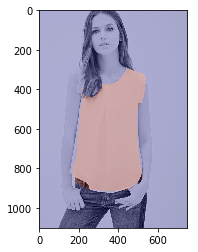

In [22]:
temp2 = img.data.cpu().numpy()
#print(temp2.shape)
plt.imshow(temp2[0], cmap='gray')
plt.imshow(temp1[5, 0], alpha=0.3, cmap='jet')
print(prediction[0]['labels'].flatten())

3222
tensor([3, 2, 5, 1, 6, 4], device='cuda:0')
torch.Size([6, 1, 1101, 750])


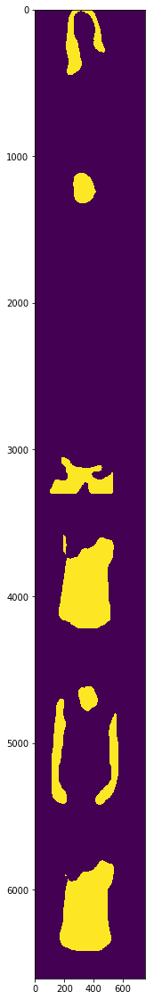

In [15]:
# [STAR] pick one image from the test set

import random
index = random.randint(0, len(dataset_test))
print(index)

img, img_truth = dataset_test[index]
# put the model in evaluation mode
model.eval()
with torch.no_grad():
    prediction = model([img.to(device)])

print(prediction[0]['labels'])
print(prediction[0]['masks'].shape)

import matplotlib.pyplot as plt
import numpy as np
import glob
temp1 = prediction[0]['masks'].data.cpu().numpy()
temp1[temp1 < 0.5] = 0
temp1[temp1 > 0.5] = 1

plt.figure(figsize=(60,20))
plt.imshow(np.concatenate(temp1[:, 0], axis=0))

Let's inspect the image and the predicted segmentation masks.

For that, we need to convert the image, which has been rescaled to 0-1 and had the channels flipped so that we have it in `[C, H, W]` format.

3
(6, 1101, 750)


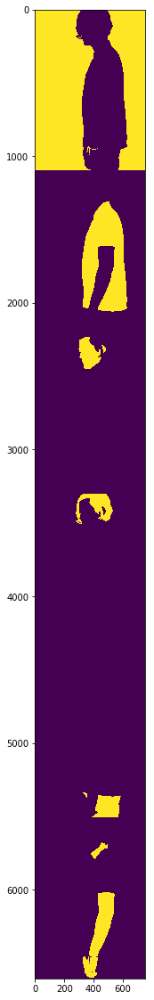

In [36]:
# 14 skin
# 15 footwear
# 1 topwear
# 13 bottomwear

import matplotlib.pyplot as plt
import numpy as np
import glob

index = random.randint(0, 100)
img, img_truth = dataset_test[index]

import random
index = random.randint(0, 15)
print(index)
temp1 = img_truth['masks'].data.cpu().numpy()
print(temp1.shape)
plt.figure(figsize=(60,20))

plt.imshow(np.concatenate(temp1, axis=0))

And let's now visualize the top predicted segmentation mask. The masks are predicted as `[N, 1, H, W]`, where `N` is the number of predictions, and are probability maps between 0-1.